In [1]:
## Plan du Notebook (recherchez #i)
#1 Import
#2 Lecture des fichiers de données issu du notebook d'analyse exploratoire
#3 Modèle non supervisé / Différents essais de LDA
    #3.1 LDA avec dictionnaire sur Title et tfidf sur Title
    #3.2 LDA avec dictionnaire sur Title et countvectorizer sur Title
    #3.3 LDA avec dictionnaire sur Title et tfidf sur Title + Body
    #3.4 Essai de diminution dimensionnelle des données en amont de LDA en utilisant une ACP
    #3.5 Lancement de LDA sur la meilleure approche
    #3.6 Les différentes sorties du modèle
    #3.7 Prédiction des tags associés aux données de test
#4 Modèles supervisés sur les bag of words
    #4.1 Modèle de régression logistique / OVR
    #4.2 Modèle SGDClassifier / OVR
#5 Modèles supervisés après techniques de word embedding
    #5.1 USE
        #5.1.1 Régression logistique
        #5.1.2 SGDClassifier
    #5.2 BERT
        #5.2.1 Régression logistique
        #5.2.2 SGDClassifier
    #5.3 Word2Vec
        #5.3.1 Régression logistique
        #5.3.2 SGDClassifier      

In [2]:
#1 Import
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import gensim
import spacy
import string
import re
import nltk
nltk.download('punkt')
nltk.download('wordnet')
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import GridSearchCV
from gensim.models.ldamulticore import LdaMulticore
import gensim.corpora as corpora
from gensim.models import CoherenceModel
from joblib import dump, load
import pickle
import pyLDAvis
import pyLDAvis.gensim_models
from sklearn.decomposition import PCA
from pprint import pprint
from sklearn.preprocessing import StandardScaler
from wordcloud import WordCloud
import random
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import jaccard_score
from sklearn.linear_model import SGDClassifier
import logging
logging.disable(logging.WARNING) # disable WARNING, INFO and DEBUG logging everywhere


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\devra\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\devra\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
#2 Lecture des fichiers de données issu du notebook d'analyse exploratoire
bow_cv_ft_tt_train = pd.read_pickle('export_bow_cv_ft_tt_train.pkl')
bow_cv_ft_tt_test = pd.read_pickle('export_bow_cv_ft_tt_test.pkl')
bow_cv_ft_tt_words = pd.read_pickle('export_bow_cv_ft_tt_words.pkl')
bow_tv_ft_tt_train = pd.read_pickle('export_bow_tv_ft_tt_train.pkl')
bow_tv_ft_tt_test = pd.read_pickle('export_bow_tv_ft_tt_test.pkl')
bow_cv_ft_ttb_train = pd.read_pickle('export_bow_cv_ft_ttb_train.pkl')
bow_cv_ft_ttb_test = pd.read_pickle('export_bow_cv_ft_ttb_test.pkl')
bow_cv_ft_ttb_words = pd.read_pickle('export_bow_cv_ft_ttb_words.pkl')
bow_tv_ft_ttb_train = pd.read_pickle('export_bow_tv_ft_ttb_train.pkl')
bow_tv_ft_ttb_test = pd.read_pickle('export_bow_tv_ft_ttb_test.pkl')
bow_cv_ftb_ttb_train = pd.read_pickle('export_bow_cv_ftb_ttb_train.pkl')
bow_cv_ftb_ttb_test = pd.read_pickle('export_bow_cv_ftb_ttb_test.pkl')
bow_cv_ftb_ttb_words = pd.read_pickle('export_bow_cv_ftb_ttb_words.pkl')
bow_tv_ftb_ttb_train = pd.read_pickle('export_bow_tv_ftb_ttb_train.pkl')
bow_tv_ftb_ttb_test = pd.read_pickle('export_bow_tv_ftb_ttb_test.pkl')
raw_data_train = pd.read_pickle('export_raw_data_train.pkl')
raw_data_test = pd.read_pickle('export_raw_data_test.pkl')
dict_tag = pd.read_pickle('export_dict_tag.pkl')

In [4]:
#3 Modèle non supervisé / Différents essais de LDA

In [5]:
# Fonction de calcul du score de cohérence en faisant varier le nombre de topics
def coherence_score(dictionary, corpus, texts, num_topic_eval):
    
    coherence_values = []
    model_list = []
    
    
    for num_topics in num_topic_eval:
        
        model = LdaMulticore(corpus=corpus,
                            id2word=dictionary,
                            num_topics=num_topics, 
                            passes=10,
                            workers=6)

        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [6]:
#3.1 LDA avec dictionnaire sur Title et tfidf sur Title
id2word = bow_cv_ft_tt_words
tfidf_corpus = bow_tv_ft_tt_train
words = raw_data_train['Title_trf'].to_list()

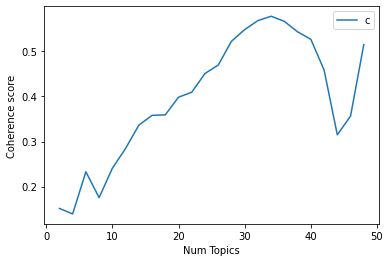

Num Topics = 2  has Coherence Value of 0.1517
Num Topics = 4  has Coherence Value of 0.1395
Num Topics = 6  has Coherence Value of 0.2329
Num Topics = 8  has Coherence Value of 0.1755
Num Topics = 10  has Coherence Value of 0.2407
Num Topics = 12  has Coherence Value of 0.2848
Num Topics = 14  has Coherence Value of 0.3364
Num Topics = 16  has Coherence Value of 0.3582
Num Topics = 18  has Coherence Value of 0.3592
Num Topics = 20  has Coherence Value of 0.3984
Num Topics = 22  has Coherence Value of 0.4094
Num Topics = 24  has Coherence Value of 0.451
Num Topics = 26  has Coherence Value of 0.4697
Num Topics = 28  has Coherence Value of 0.5225
Num Topics = 30  has Coherence Value of 0.5483
Num Topics = 32  has Coherence Value of 0.5684
Num Topics = 34  has Coherence Value of 0.578
Num Topics = 36  has Coherence Value of 0.5666
Num Topics = 38  has Coherence Value of 0.5434
Num Topics = 40  has Coherence Value of 0.5268
Num Topics = 42  has Coherence Value of 0.4587
Num Topics = 44  ha

In [7]:
# Variation du nombre de topics de 2 à 50 et mesure du score de cohérence
k = range (2,50,2)
model_list, coherence_values = coherence_score(dictionary=id2word, corpus=tfidf_corpus, texts=words, num_topic_eval = k)


plt.plot(k, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

for m, cv in zip(k, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

In [8]:
    #3.2 LDA avec dictionnaire sur Title et countvectorizer sur Title
id2word = bow_cv_ft_tt_words
cv_corpus = bow_cv_ft_tt_train
words = raw_data_train['Title_trf'].to_list()

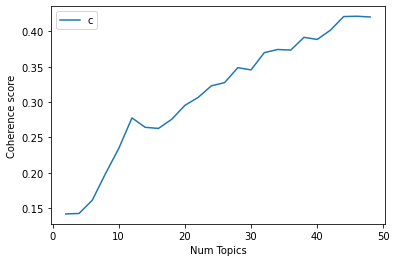

Num Topics = 2  has Coherence Value of 0.142
Num Topics = 4  has Coherence Value of 0.1426
Num Topics = 6  has Coherence Value of 0.1614
Num Topics = 8  has Coherence Value of 0.199
Num Topics = 10  has Coherence Value of 0.2344
Num Topics = 12  has Coherence Value of 0.2777
Num Topics = 14  has Coherence Value of 0.2644
Num Topics = 16  has Coherence Value of 0.2628
Num Topics = 18  has Coherence Value of 0.2756
Num Topics = 20  has Coherence Value of 0.2954
Num Topics = 22  has Coherence Value of 0.3066
Num Topics = 24  has Coherence Value of 0.323
Num Topics = 26  has Coherence Value of 0.3275
Num Topics = 28  has Coherence Value of 0.3486
Num Topics = 30  has Coherence Value of 0.3456
Num Topics = 32  has Coherence Value of 0.3699
Num Topics = 34  has Coherence Value of 0.3743
Num Topics = 36  has Coherence Value of 0.3735
Num Topics = 38  has Coherence Value of 0.3915
Num Topics = 40  has Coherence Value of 0.3885
Num Topics = 42  has Coherence Value of 0.4017
Num Topics = 44  has

In [9]:
# Variation du nombre de topics de 2 à 50 et mesure du score de cohérence
k = range (2,50,2)
model_list, coherence_values = coherence_score(dictionary=id2word, corpus=cv_corpus, texts=words, num_topic_eval = k)


plt.plot(k, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

for m, cv in zip(k, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

In [10]:
    #3.3 LDA avec dictionnaire sur Title et tfidf sur Title + Body
id2word = bow_cv_ft_ttb_words
tfidf_corpus = bow_tv_ft_ttb_train
words = raw_data_train['Title_body'].to_list()

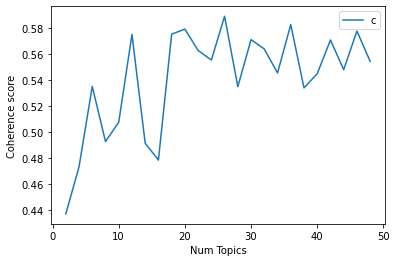

Num Topics = 2  has Coherence Value of 0.4369
Num Topics = 4  has Coherence Value of 0.4732
Num Topics = 6  has Coherence Value of 0.5352
Num Topics = 8  has Coherence Value of 0.4927
Num Topics = 10  has Coherence Value of 0.5076
Num Topics = 12  has Coherence Value of 0.5753
Num Topics = 14  has Coherence Value of 0.4914
Num Topics = 16  has Coherence Value of 0.4784
Num Topics = 18  has Coherence Value of 0.5755
Num Topics = 20  has Coherence Value of 0.5794
Num Topics = 22  has Coherence Value of 0.563
Num Topics = 24  has Coherence Value of 0.5555
Num Topics = 26  has Coherence Value of 0.5893
Num Topics = 28  has Coherence Value of 0.535
Num Topics = 30  has Coherence Value of 0.5713
Num Topics = 32  has Coherence Value of 0.5641
Num Topics = 34  has Coherence Value of 0.5456
Num Topics = 36  has Coherence Value of 0.5829
Num Topics = 38  has Coherence Value of 0.5341
Num Topics = 40  has Coherence Value of 0.5451
Num Topics = 42  has Coherence Value of 0.571
Num Topics = 44  has

In [11]:
# Variation du nombre de topics de 2 à 50 et mesure du score de cohérence
k = range (2,50,2)
model_list, coherence_values = coherence_score(dictionary=id2word, corpus=tfidf_corpus, texts=words, num_topic_eval = k)


plt.plot(k, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

for m, cv in zip(k, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

In [12]:
#  Meilleurs scores de cohérence :
#   Dictionnaire sur title et tfidf sur title  :           0.5780 pour num_topic = 34
#   Dictionnaire sur title et cv sur title     :           0.4213 pour num_topic = 46
#   Dictionnaire sur title et tfidf sur title+body  :      0.5893 pour num_topic = 26


# Meilleure approche : Dictionnaire sur title et tfidf sur title+body, avec num_topic = 26

In [13]:
    #3.4 Essai de diminution dimensionnelle des données en amont de LDA en utilisant une ACP
id2word = bow_cv_ft_ttb_words
words = raw_data_train['Title_trf'].to_list()
tfidf_corpus = bow_tv_ft_tt_train

In [14]:
all_topics_csr = gensim.matutils.corpus2csc(tfidf_corpus)
all_topics_numpy = all_topics_csr.T.toarray()
df_for_pca =pd.DataFrame(all_topics_numpy)

In [15]:
# Standardisation des caractéristiques (centrage et mise à l'échelle)
scaler = StandardScaler()
std_scale = scaler.fit(df_for_pca)
X_scale = std_scale.transform(df_for_pca)
df_scale = pd.DataFrame(X_scale, columns=df_for_pca.columns) 

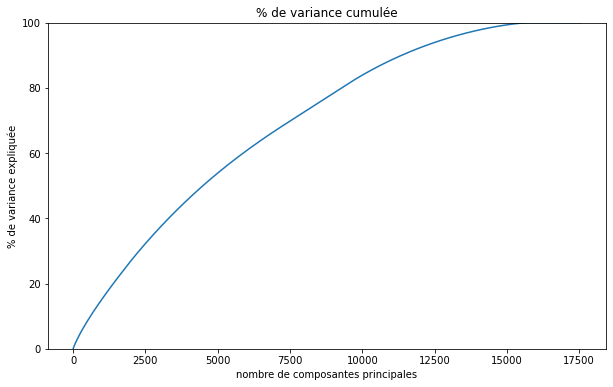

In [16]:
# Essai ACP
n_comp = len(id2word)
pcat = PCA(n_components=n_comp).fit(df_scale)
pcatot = pcat.transform(df_scale)
variance = pcat.explained_variance_ratio_
var = np.cumsum(np.round(variance, 6)*100)
plt.figure(figsize = (10,6))
plt.ylabel('% de variance expliquée')
plt.xlabel('nombre de composantes principales')
plt.title('% de variance cumulée')
plt.ylim(0,100)
plt.plot(var)

In [17]:
df_pca = pd.DataFrame(pcatot)

In [18]:
# Sauvegarde pour éviter de relancer PCA
df_pca.to_pickle('export_df_pca.pkl')

In [19]:
# on retient un nombre de composantes principales permettant d'expliquer au moins 95% de la variance
n_comp_acp = 0
for k in range (n_comp): 
    if var[k] > 95 and n_comp_acp == 0:
        n_comp_acp = k
print('Nombre de composantes principales expliquant au moins 95% de la variance : ', n_comp_acp)

Nombre de composantes principales expliquant au moins 95% de la variance :  12867


In [20]:
# L'utilisation de l' ACP avant de lancer la LDA est peu pertinent : 
# Pour expliquer plus de 95% de la variance, il faudrait retenir un peu plus de 13000 composantes principales
# ce qui représente un gain peu important au niveau du nombre de dimensions (passage de 17542 à 12867) tout en complexifiant 
# le modèle

In [306]:
    #3.5 Lancement de LDA sur la meilleure approche
id2word = bow_cv_ft_ttb_words
words = raw_data_train['Title_body'].to_list()
tfidf_corpus = bow_tv_ft_ttb_train

In [307]:
len(id2word)

17542

In [308]:
model = LdaMulticore(corpus=tfidf_corpus,
                            id2word=id2word,
                            num_topics=26,
                            passes=10,
                            workers=6)

In [309]:
pprint(model.show_topics(30))


[(0,
  '0.007*"cuda" + 0.007*"twig" + 0.006*"dependencyproperty" + 0.006*"llvm" + '
  '0.006*"seam" + 0.006*"ninject" + 0.005*"uwsgi" + 0.005*"unitofwork" + '
  '0.005*"dispose" + 0.005*"coin"'),
 (1,
  '0.012*"lat" + 0.011*"map" + 0.011*"soap" + 0.010*"longitude" + '
  '0.010*"latitude" + 0.009*"polygon" + 0.009*"silverlight" + '
  '0.009*"coordinate" + 0.008*"marker" + 0.007*"strut"'),
 (2,
  '0.023*"self" + 0.015*"view" + 0.011*"uiview" + 0.009*"frame" + '
  '0.008*"animation" + 0.008*"uiimage" + 0.007*"image" + 0.007*"bar" + '
  '0.006*"io" + 0.006*"height"'),
 (3,
  '0.010*"cordova" + 0.009*"selenium" + 0.008*"ionic" + 0.008*"webdriver" + '
  '0.007*"cors" + 0.007*"keyboard" + 0.007*"phonegap" + 0.005*"jmeter" + '
  '0.005*"sublime" + 0.004*"usb"'),
 (4,
  '0.007*"user" + 0.007*"http" + 0.007*"server" + 0.006*"request" + '
  '0.006*"app" + 0.006*"service" + 0.006*"api" + 0.006*"client" + 0.005*"web" '
  '+ 0.005*"token"'),
 (5,
  '0.014*"kafka" + 0.008*"curl_setopt" + 0.007*"locat

In [310]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(model, tfidf_corpus, id2word)
vis

C:\Users\devra\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
24     0.214711 -0.003328       1        1  22.407881
22     0.198923 -0.088852       2        1  12.741084
6      0.174613 -0.062437       3        1  11.321311
4      0.198691  0.082738       4        1  10.105602
21     0.174625  0.033223       5        1   8.269187
25     0.175383  0.108596       6        1   5.755582
19     0.144684 -0.050961       7        1   4.408691
8      0.118396 -0.048288       8        1   3.032069
16     0.080681  0.065871       9        1   2.712053
2     -0.003590 -0.206624      10        1   1.885062
13     0.009600  0.054621      11        1   1.510425
17     0.018675  0.078488      12        1   1.486032
7      0.005643  0.068985      13        1   1.317576
1     -0.055025 -0.039734      14        1   1.228566
9     -0.048014 -0.064620      15        1   1.205857
23    -0.087598 -0.069181      16        1   1.114825
15    -0.041027 -0.000550      17        1   1.105273
20    -0.122454  0.007722      18        1   1.030537
3     -0.059200  0.028010      19        1   1.026491
5     -0.143363  0.037707      20        1   0.949580
10    -0.138987  0.047015      21        1   0.947407
18    -0.144414 -0.011244      22        1   0.912883
14    -0.138096  0.005148      23        1   0.900863
11    -0.169906 -0.006140      24        1   0.895114
0     -0.185599  0.014923      25        1   0.876394
12    -0.177350  0.018914      26        1   0.853657, topic_info=                 Term        Freq       Total Category  logprob  loglift
70            android  332.000000  332.000000  Default  30.0000  30.0000
450              java  353.000000  353.000000  Default  29.0000  29.0000
908              self  249.000000  249.000000  Default  28.0000  28.0000
1206              div  278.000000  278.000000  Default  27.0000  27.0000
1432             date  177.000000  177.000000  Default  26.0000  26.0000
...               ...         ...         ...      ...      ...      ...
3991           reddit    4.083859    5.864372  Topic26  -5.9147   4.4015
14921  progressdialog    3.913582    5.626325  Topic26  -5.9572   4.4004
4372              udf    4.642382    9.099373  Topic26  -5.7865   4.0904
251             touch    4.405821   36.880791  Topic26  -5.8388   2.6386
991          sentence    3.918184   19.849654  Topic26  -5.9561   3.1408

[1535 rows x 6 columns], token_table=       Topic      Freq     Term
term                           
14896      1  0.094757       __
14896      4  0.094757       __
14896     17  0.568539       __
5961       5  0.924823      __m
15499      2  0.125239      _id
...      ...       ...      ...
334       14  0.040994     zone
334       18  0.409936     zone
3635      17  0.606777  zooming
4755      20  0.827756     zuul
4755      26  0.118251     zuul

[5604 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[25, 23, 7, 5, 22, 26, 20, 9, 17, 3, 14, 18, 8, 2, 10, 24, 16, 21, 4, 6, 11, 19, 15, 12, 1, 13])

In [311]:
    #3.6 Les différentes sorties du modèle

In [312]:
# Récupérer la distribution de topic pour un document donné avec seuil par défaut
model.get_document_topics( tfidf_corpus[6])

[(21, 0.3874233), (24, 0.4688413)]

In [313]:
# Récupérer la distribution de topic pour un document donné avec un seuil faible
model.get_document_topics( tfidf_corpus[6], minimum_probability= 0.00001)

[(0, 0.0056772255),
 (1, 0.0056772255),
 (2, 0.0056772255),
 (3, 0.0056772255),
 (4, 0.0056772255),
 (5, 0.0056772255),
 (6, 0.0056772255),
 (7, 0.0056772255),
 (8, 0.0056772255),
 (9, 0.0056772255),
 (10, 0.0056772255),
 (11, 0.0056772255),
 (12, 0.0056772255),
 (13, 0.24625771),
 (14, 0.0056772255),
 (15, 0.0056772255),
 (16, 0.0056772255),
 (17, 0.0056772255),
 (18, 0.0056772255),
 (19, 0.0056772255),
 (20, 0.0056772255),
 (21, 0.0056772255),
 (22, 0.0056772255),
 (23, 0.0056772255),
 (24, 0.6174889),
 (25, 0.0056772255)]

In [314]:
# Récupérer la distribution de topic pour un document donné avec un seuil plus élevé
model.get_document_topics( tfidf_corpus[6], minimum_probability= 0.1)

[(13, 0.24597687), (24, 0.61776716)]

In [315]:
len(tfidf_corpus)

35000

In [316]:
id2word[1]

'data'

In [317]:
# Récupérer la distribution de topic pour un mot donné avec un seuil faible
model.get_term_topics( id2word[1] , minimum_probability = 0.0001 )

[(1, 0.00073459),
 (2, 0.00020147777),
 (3, 0.00094486587),
 (4, 0.0020396602),
 (5, 0.0002582212),
 (6, 0.0041266684),
 (7, 0.0011633432),
 (8, 0.002130067),
 (9, 0.0011170502),
 (10, 0.00011888698),
 (13, 0.0012784682),
 (15, 0.0004982511),
 (16, 0.0007606923),
 (17, 0.004085754),
 (19, 0.0037711305),
 (20, 0.00038955413),
 (21, 0.0018089146),
 (22, 0.0035379934),
 (24, 0.0027446852),
 (25, 0.0020311233)]

In [318]:
# Récupérer la distribution de topic pour un mot donné avec un seuil plus élevé
model.get_term_topics( id2word[1] , minimum_probability = 0.001 )

[(4, 0.0020396602),
 (6, 0.0041266684),
 (7, 0.0011633432),
 (8, 0.002130067),
 (9, 0.0011170502),
 (13, 0.0012784682),
 (17, 0.004085754),
 (19, 0.0037711305),
 (21, 0.0018089146),
 (22, 0.0035379934),
 (24, 0.0027446852),
 (25, 0.0020311233)]

In [319]:
# Récupérer la distribution des mots pour un topicid transmis (avec l'identifiant des mots)
model.get_topic_terms( topicid = 1 )

[(169, 0.012018275),
 (405, 0.010847187),
 (685, 0.010635298),
 (4813, 0.010006235),
 (4812, 0.009955486),
 (1784, 0.0091518),
 (2438, 0.008756434),
 (1109, 0.008716113),
 (1148, 0.00845834),
 (2020, 0.0066534933)]

In [320]:
    #3.7 Prédiction des tags associés aux données de test

In [321]:
# Probabilité des mots associés aux différents topics
m_topic_word = model.get_topics()
m_topic_word = pd.DataFrame(m_topic_word, columns=[id2word[k] for k in range(len(id2word))])

In [322]:
# Cette matrice de probabilités des différents mots associés à chaque topic comporte un nombre très important de colonnes, avec pour nombre d'entre elles
# des probabilités très faibles. Pour faciliter les traitements suivants, on limitera la taille de cette matrice en ne retenant que le colonnes
# ayant des valeurs significatives (aléatoirement on ne gardera que les mots pour lesquels la somme des proba sur l'ensemble des topics est > 1e-2 )

In [323]:
m_topic_word_lim = pd.DataFrame()
for k in range(len(id2word)):
    if m_topic_word[id2word[k]].sum() > 1e-2 :
        m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]
    

C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]
C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]
C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has p

C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]
C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]
C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has p

C:\Users\devra\AppData\Local\Temp\ipykernel_19644\2368373757.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  m_topic_word_lim[id2word[k]] = m_topic_word[id2word[k]]


In [324]:
m_topic_word_lim.head()

,data,frame,problem,type,another,different,directory,file,python,script,...,longitude,err,else,var,intent,node_modules,re,req,tried,thanks
0,0.000330,0.000041,0.000140,0.000168,0.000074,0.000085,0.000069,0.000317,0.000108,0.000105,...,0.000032,0.000035,0.000071,0.000297,0.000040,0.000031,0.000041,0.000034,0.000086,0.000136
1,0.000946,0.000054,0.000390,0.000914,0.000256,0.000204,0.000047,0.001005,0.000201,0.000251,...,0.010006,0.000090,0.000172,0.001614,0.000066,0.000020,0.000085,0.000031,0.000562,0.000679
2,0.000332,0.009479,0.000988,0.000144,0.000548,0.000365,0.000021,0.000504,0.000241,0.000045,...,0.000012,0.000030,0.000719,0.000641,0.000014,0.000012,0.000053,0.000016,0.001161,0.001271
3,0.001200,0.000336,0.000699,0.000956,0.000428,0.000577,0.000131,0.000853,0.000405,0.000890,...,0.000021,0.000619,0.000106,0.000268,0.000022,0.000373,0.000157,0.000037,0.000482,0.000551
4,0.002068,0.000043,0.001197,0.001016,0.000887,0.000951,0.001047,0.003043,0.000777,0.000933,...,0.000010,0.000789,0.000730,0.001567,0.000124,0.000002,0.000712,0.000748,0.001295,0.001187


In [325]:
m_topic_word.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26 entries, 0 to 25
Columns: 17542 entries, converting to bitly
dtypes: float32(17542)
memory usage: 1.7 MB


In [326]:
# Prédiction des probabilités des topics pour chaque post du jeu de test
other_corpus = [id2word.doc2bow(text) for text in raw_data_test['Title_body']]
list_topic = model[other_corpus]
m_doc_topic_test = gensim.matutils.corpus2csc(list_topic)
m_doc_topic_test = m_doc_topic_test.T.toarray()
m_doc_topic_test = pd.DataFrame(m_doc_topic_test)
m_doc_topic_test

,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
0,0.000000,0.0,0.000000,0.0,0.710070,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.039734,0.000000,0.0,0.000000,0.000000,0.000000,0.234935,0.000000
1,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.084209,0.0,0.000000,0.0,...,0.0,0.000000,0.000000,0.042572,0.0,0.000000,0.266418,0.000000,0.583255,0.000000
2,0.000000,0.0,0.000000,0.0,0.045235,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.928362,0.000000
3,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.725453,0.255313
4,0.000000,0.0,0.000000,0.0,0.382842,0.0,0.605008,0.0,0.000000,0.0,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,0.024212,0.0,0.000000,0.0,0.124767,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.019863,0.441226,0.0,0.161953,0.000000,0.025319,0.091978,0.097638
14996,0.000000,0.0,0.000000,0.0,0.405857,0.0,0.000000,0.0,0.078135,0.0,...,0.0,0.000000,0.000000,0.000000,0.0,0.258077,0.000000,0.000000,0.244049,0.000000
14997,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.425550,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.550154,0.000000
14998,0.000000,0.0,0.357404,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.605664,0.000000,0.000000,0.000000


In [327]:
m_doc_word_test = m_doc_topic_test @ m_topic_word_lim

In [328]:
m_doc_word_test.head(5)

,data,frame,problem,type,another,different,directory,file,python,script,...,longitude,err,else,var,intent,node_modules,re,req,tried,thanks
0,0.002124,0.000067,0.001263,0.001454,0.000901,0.001055,0.000833,0.002806,0.000825,0.000767,...,0.000008,0.000580,0.000692,0.001365,0.000098,0.000004,0.000525,0.000532,0.001137,0.001137
1,0.003069,0.000367,0.001563,0.002809,0.000987,0.001274,0.000263,0.002443,0.000999,0.001484,...,0.000002,0.000094,0.000843,0.001949,0.000051,0.000026,0.000151,0.000043,0.001014,0.001193
2,0.002653,0.000124,0.001652,0.002893,0.001096,0.001530,0.000395,0.002539,0.001089,0.000416,...,0.000001,0.000107,0.000710,0.001047,0.000038,0.000003,0.000102,0.000035,0.000887,0.001182
3,0.002530,0.000108,0.001546,0.002748,0.000991,0.001372,0.000519,0.002605,0.000853,0.000394,...,0.000002,0.000059,0.000621,0.000979,0.000030,0.000003,0.000127,0.000002,0.000863,0.001098
4,0.003303,0.001105,0.001365,0.000900,0.000896,0.001166,0.000528,0.002761,0.001791,0.000772,...,0.000005,0.000482,0.000944,0.001134,0.000060,0.000003,0.000429,0.000314,0.001174,0.001150


In [329]:
#Pour chaque post, récupération des 5 mots possédant la plus grande probabilité

In [330]:
num_col = len(m_doc_word_test.columns)
num_col

304

In [331]:
m_doc_word_test_w = m_doc_word_test.copy()
word_predit=pd.DataFrame()
for k in range(len(m_doc_word_test_w)):
    for i in range(5):
        val_max = 0
        ind = -1
        for j in range(num_col) :
            if m_doc_word_test_w.loc[k][m_doc_word_test_w.columns[j]] > val_max :
                val_max = m_doc_word_test_w.loc[k][m_doc_word_test_w.columns[j]]
                ind  = j 
        if ind > -1 : 
            word_predit.loc[k,i] = m_doc_word_test_w.columns[ind]
            m_doc_word_test_w.loc[k][m_doc_word_test_w.columns[ind]] = 0     

In [332]:
word_predit.head(10)

,0,1,2,3,4
0,user,server,http,request,app
1,class,function,div,value,data
2,class,object,string,int,would
3,class,public,java,string,object
4,server,user,data,request,http
5,div,html,page,form,image
6,android,java,intent,public,activity
7,class,object,string,int,would
8,class,object,string,int,table
9,class,function,object,value,string


In [333]:
word_predit.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15000 entries, 0 to 14999
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       15000 non-null  object
 1   1       15000 non-null  object
 2   2       15000 non-null  object
 3   3       15000 non-null  object
 4   4       15000 non-null  object
dtypes: object(5)
memory usage: 1.2+ MB


In [334]:
word_predit[5] = word_predit[0] + ' ' + word_predit[1] + ' ' +  word_predit[2] + ' ' + word_predit[3] + ' ' + word_predit[4]

In [335]:
# Sauvegarde de ce dataframe, long à calculer
dump(word_predit,'export_word_predit')

['export_word_predit']

In [336]:
word_predit=load('export_word_predit')

In [337]:
word_predit

,0,1,2,3,4,5
0,user,server,http,request,app,user server http request app
1,class,function,div,value,data,class function div value data
2,class,object,string,int,would,class object string int would
3,class,public,java,string,object,class public java string object
4,server,user,data,request,http,server user data request http
...,...,...,...,...,...,...
14995,file,string,self,request,error,file string self request error
14996,file,user,server,app,http,file user server app http
14997,function,err,req,re,query,function err req re query
14998,self,div,view,image,button,self div view image button


In [338]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = word_predit[5].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,class,5015
1,string,4817
2,file,4297
3,int,3282
4,user,3133
...,...,...
112,mp,2
113,javafx,2
114,coordinate,2
115,node_modules,1


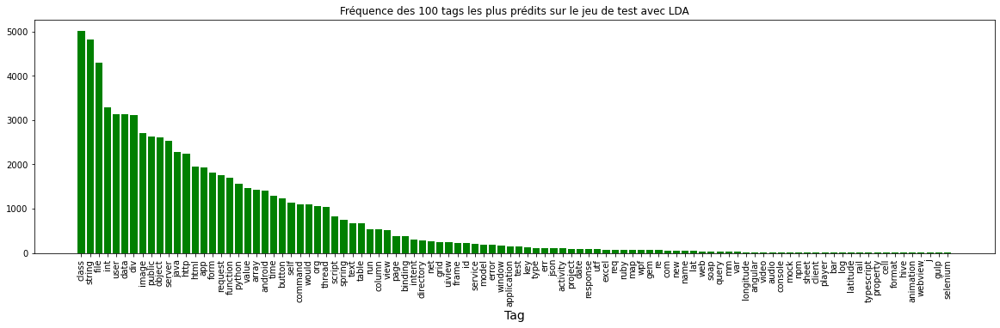

In [339]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test avec LDA')
plt.show()

In [340]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in word_predit.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({'class': 5015, 'string': 4817, 'file': 4297, 'int': 3282, 'user': 3133, 'data': 3130, 'div': 3120, 'image': 2699, 'public': 2637, 'object': 2607, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=trans

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:499: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = Image.ROTATE_90
C:\Users\devra\an

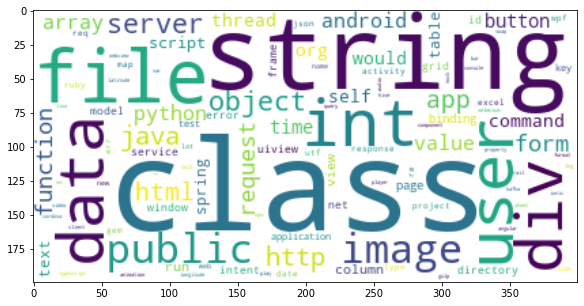

In [341]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [342]:
raw_data_test.head(5)

,Title,Body,Tags,Body_trf,Title_trf,Title_body,Tags_trf_list,Tags_trf_text,Tags_trf_list_100,Tags_trf_text_100,Title_body_text
33553,How to use java.net.URLConnection to fire and ...,"<p>Use of <a href=""http://docs.oracle.com/java...",<java><http><httprequest><httpurlconnection><u...,"[use, java, net, urlconnection, asked, pretty,...","[use, java, net, urlconnection, fire, handle, ...","[use, java, net, urlconnection, fire, handle, ...","[java, http, httprequest, httpurlconnection, u...",java http httprequest httpurlconnection urlcon...,"[java, http]",java http,use java net urlconnection fire handle http re...
9427,PostgreSQL: Select only the first record per i...,<p>For the following query I need to select on...,<sql><postgresql><distinct><greatest-n-per-gro...,"[following, query, need, select, first, record...","[postgresql, select, first, record, per, id, b...","[postgresql, select, first, record, per, id, b...","[sql, postgresql, distinct, greatest-n-per-gro...",sql postgresql distinct greatest-n-per-group d...,"[sql, postgresql]",sql postgresql,postgresql select first record per id based so...
199,What Makes a Good Unit Test?,<p>I'm sure most of you are writing lots of au...,<unit-testing><language-agnostic><tdd><integra...,"[sure, writing, lot, automated, test, also, ru...","[make, good, unit, test]","[make, good, unit, test, sure, writing, lot, a...","[unit-testing, language-agnostic, tdd, integra...",unit-testing language-agnostic tdd integration...,[unit-testing],unit-testing,make good unit test sure writing lot automated...
12447,Problem when inserting multiple data ASP.NET MVC,<p>I am having trouble when inserting multiple...,<c#><asp.net-mvc><entity-framework><entity-fra...,"[trouble, inserting, multiple, record, try, in...","[problem, inserting, multiple, data, asp, net,...","[problem, inserting, multiple, data, asp, net,...","[c#, asp.net-mvc, entity-framework, entity-fra...",c# asp.net-mvc entity-framework entity-framewo...,"[c#, asp.net-mvc, entity-framework]",c# asp.net-mvc entity-framework,problem inserting multiple data asp net mvc tr...
39489,Celery Why Does Task Stay In Queue,<p>So I am using Celery with RabbitMQ. I have ...,<python><django><rabbitmq><celery><amqp>,"[using, celery, rabbitmq, restful, api, regist...","[celery, task, stay, queue]","[celery, task, stay, queue, using, celery, rab...","[python, django, rabbitmq, celery, amqp]",python django rabbitmq celery amqp,"[python, django]",python django,celery task stay queue using celery rabbitmq r...


In [343]:
raw_data_test.iloc[0]

Title                How to use java.net.URLConnection to fire and ...
Body                 <p>Use of <a href="http://docs.oracle.com/java...
Tags                 <java><http><httprequest><httpurlconnection><u...
Body_trf             [use, java, net, urlconnection, asked, pretty,...
Title_trf            [use, java, net, urlconnection, fire, handle, ...
Title_body           [use, java, net, urlconnection, fire, handle, ...
Tags_trf_list        [java, http, httprequest, httpurlconnection, u...
Tags_trf_text        java http httprequest httpurlconnection urlcon...
Tags_trf_list_100                                         [java, http]
Tags_trf_text_100                                            java http
Title_body_text      use java net urlconnection fire handle http re...
Name: 33553, dtype: object

In [344]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if word_predit.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  3567
nombre de tags non trouvés :  71433
Pourcentage de couverture des tags réels :  4.76 %


In [345]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==word_predit.iloc[k,0]) or (tag ==word_predit.iloc[k,1]) or (tag ==word_predit.iloc[k,2]) or (tag ==word_predit.iloc[k,3]) or (tag ==word_predit.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  3247
nombre de tags non trouvés :  25446
Pourcentage de couverture des tags réels / 100 plus fréquents :  11.32 %


In [346]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if word_predit.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  22429
nombre de mots non trouvés :  52571
Pourcentage de couverture des mots :  29.91 %


In [347]:
# Comparaison sur un petit échantillon du jeu de test des tags prédits vis à vis des tags saisis par l'utilisateur

In [348]:
#list_k = random.sample(range(len(word_predit)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test')
    print ('-------------------------------------------------')
    print ('Titre du post : ')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (word_predit.loc[k][5])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test
-------------------------------------------------
Titre du post : 
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
class object string int would
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test
-------------------------------------------------
Titre du post : 
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android 

In [349]:
#Résultats peu pertinents !!

In [64]:
#4 Modèles supervisés

In [65]:
X_train= gensim.matutils.corpus2csc(bow_tv_ft_ttb_train)
X_train = X_train.T.toarray()

In [66]:
X_test= gensim.matutils.corpus2csc(bow_tv_ft_ttb_test)
X_test = X_test.T.toarray()

In [67]:
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

In [68]:
dump(scaler,'export_standardscaler')

['export_standardscaler']

In [69]:
Y_train=raw_data_train[['Tags_trf_list','Tags_trf_list_100']].copy()
Y_test=raw_data_test[['Tags_trf_list','Tags_trf_list_100']].copy()

In [70]:
len(dict_tag)

100

In [71]:
print(dict_tag.token2id)

{'http': 0, 'javascript': 1, 'node.js': 2, '.net': 3, 'c#': 4, 'winforms': 5, 'cocoa': 6, 'ios': 7, 'iphone': 8, 'objective-c': 9, 'php': 10, 'string': 11, 'swift': 12, 'c++': 13, 'css': 14, 'html': 15, 'reactjs': 16, 'file': 17, 'asp.net': 18, 'android': 19, 'java': 20, 'xcode': 21, 'linq': 22, 'python': 23, 'sql-server': 24, 'performance': 25, 'windows': 26, 'testing': 27, 'typescript': 28, 'cocoa-touch': 29, 'django': 30, 'mysql': 31, 'api': 32, 'rest': 33, 'angularjs': 34, 'shell': 35, 'ruby': 36, 'sql': 37, 'wpf': 38, 'c++11': 39, 'apache': 40, 'vb.net': 41, 'xaml': 42, 'amazon-web-services': 43, 'c': 44, 'unit-testing': 45, 'authentication': 46, 'database': 47, 'image': 48, 'wcf': 49, 'jquery': 50, 'ajax': 51, 'macos': 52, 'asp.net-mvc': 53, 'visual-studio': 54, 'python-2.7': 55, 'debugging': 56, 'winapi': 57, 'postgresql': 58, 'linux': 59, 'selenium': 60, 'pandas': 61, 'optimization': 62, 'algorithm': 63, 'security': 64, 'ssl': 65, 'arrays': 66, 'ruby-on-rails': 67, 'xml': 68, '

In [72]:
Y_train_s = [dict_tag.doc2bow(text) for text in Y_train['Tags_trf_list_100'].values]
Y_test_s = [dict_tag.doc2bow(text) for text in Y_test['Tags_trf_list_100'].values]

In [73]:
Y_train_s = gensim.matutils.corpus2csc(Y_train_s)
Y_test_s = gensim.matutils.corpus2csc(Y_test_s)

In [74]:
Y_train_s = Y_train_s.T.toarray()
Y_test_s = Y_test_s.T.toarray()

In [75]:
    #4.1 Modèle de régression logistique / OVR
clf = OneVsRestClassifier(LogisticRegression(random_state=0,
                                             max_iter=1000,
                                             verbose=1))

In [76]:
clf.fit(X_train_std, Y_train_s)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   51.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.6min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   49.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.0min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   45.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   43.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   39.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   41.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   39.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   40.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   41.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   40.9s finished
[Parallel(n_jobs=1)]: Us

OneVsRestClassifier(estimator=LogisticRegression(max_iter=1000, random_state=0,
                                                 verbose=1))

In [77]:
dump(clf,'modele_reg_log_bow')

['modele_reg_log_bow']

In [78]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test = clf.predict(X_test_std)

In [79]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test, average=None)
jac_scor

array([0.05882353, 0.32956759, 0.4278481 , 0.16959728, 0.32627922,
       0.22685185, 0.29133858, 0.37086093, 0.32075472, 0.31988473,
       0.42388562, 0.16165414, 0.45980707, 0.36126761, 0.36167147,
       0.22734027, 0.56287425, 0.05333333, 0.27704485, 0.56973294,
       0.38978102, 0.26666667, 0.37313433, 0.50728863, 0.3019802 ,
       0.19230769, 0.09227468, 0.05405405, 0.27922078, 0.06598985,
       0.65975104, 0.42629482, 0.07017544, 0.17073171, 0.46534653,
       0.15827338, 0.36482085, 0.26122449, 0.59866221, 0.16363636,
       0.28742515, 0.18238994, 0.28888889, 0.36231884, 0.23230769,
       0.3546798 , 0.17218543, 0.09817352, 0.12455516, 0.57936508,
       0.43738318, 0.33988764, 0.2760181 , 0.26780627, 0.17164179,
       0.02564103, 0.19148936, 0.09090909, 0.453125  , 0.20773931,
       0.52830189, 0.47651007, 0.07042254, 0.16666667, 0.12264151,
       0.2265625 , 0.19021739, 0.54385965, 0.27457627, 0.37426901,
       0.36057692, 0.3452381 , 0.51578947, 0.42134831, 0.35344

In [80]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.058824
1,javascript,0.329568
2,node.js,0.427848
3,.net,0.169597
4,c#,0.326279


In [81]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

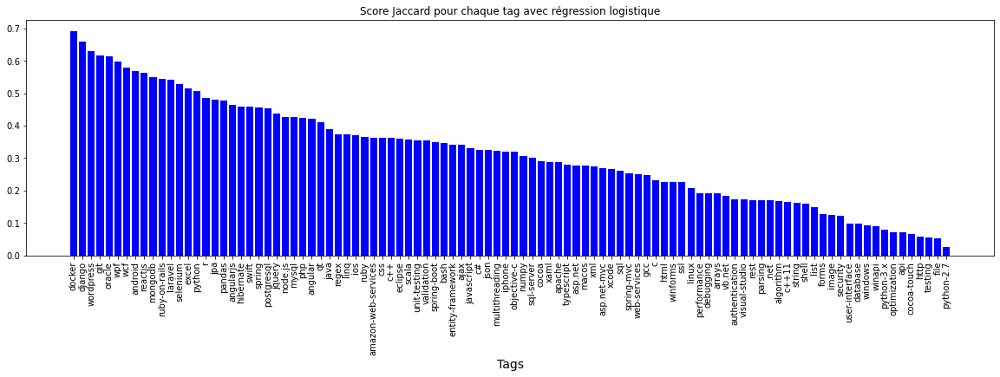

In [82]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag avec régression logistique')
plt.show()

In [83]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test, average='weighted')

0.33814037766757615

In [84]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test.sum()

25530

In [85]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [86]:
# L'utilisation du predict ne permet pas de predire 5 tags par post
# --> Utilisation de predict_proba, pour récupération des 5 tags ayant la plus forte probabilité
y_pred_test_proba = clf.predict_proba(X_test_std)

In [87]:
# Identification des 5 tags prédits par post
y_pred_test_proba_w = y_pred_test_proba.copy()
tag_predit=pd.DataFrame()
for k in range(len(y_pred_test_proba_w)):
    for i in range(5):
        val_max = 0
        ind = -1
        for j in range(100) :
            if y_pred_test_proba_w[k,j] > val_max :
                val_max = y_pred_test_proba_w[k,j]
                ind  = j 
        if ind > -1 : 
            tag_predit.loc[k,i] = dict_tag[ind]
            y_pred_test_proba_w[k,ind] = 0

In [88]:
tag_predit['list_tag'] = tag_predit[0] + ' ' + tag_predit[1] + ' ' + tag_predit[2] + ' ' + tag_predit[3] + ' ' + tag_predit[4]

In [89]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit,'export_tag_predit')

['export_tag_predit']

In [90]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,c#,3765
1,java,3555
2,javascript,3227
3,python,2585
4,.net,2555
...,...,...
95,wcf,203
96,jpa,201
97,qt,188
98,docker,184


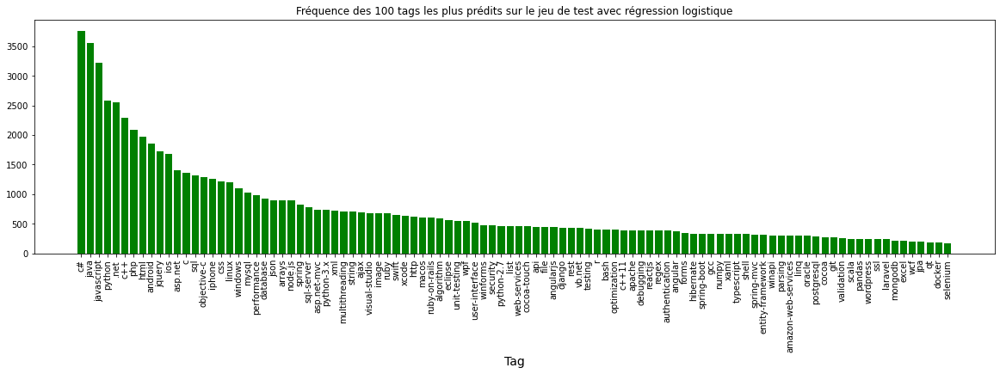

In [91]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test avec régression logistique')
plt.show()

In [92]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({'c#': 3765, 'java': 3555, 'javascript': 3227, 'python': 2585, '.net': 2555, 'c++': 2287, 'php': 2093, 'html': 1977, 'android': 1855, 'jquery': 1730, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=trans

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

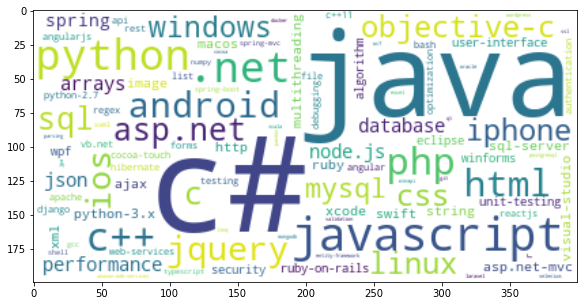

In [93]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [94]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  20117
nombre de tags non trouvés :  54883
Pourcentage de couverture des tags réels :  26.82 %


In [95]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit.iloc[k,0]) or (tag ==tag_predit.iloc[k,1]) or (tag ==tag_predit.iloc[k,2]) or (tag ==tag_predit.iloc[k,3]) or (tag ==tag_predit.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  20117
nombre de tags non trouvés :  8576
Pourcentage de couverture des tags réels / 100 plus fréquents :  70.11 %


In [96]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  14257
nombre de mots non trouvés :  60743
Pourcentage de couverture des mots :  19.01 %


In [97]:
# Comparaison sur un petit échantillon du jeu de test des tags prédits vis à vis des tags saisis par l'utilisateur

In [98]:
#list_k = random.sample(range(len(tag_predit)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
arrays c++ string javascript c++11
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android eclipse java asp.net user-interface
-------------------------------------------------
---------

In [99]:
    #4.2 Modèle SGDClassifier / OVR
clf2 = OneVsRestClassifier(SGDClassifier(random_state=0,
                                             max_iter=2000,
                                             verbose=1))

In [100]:
clf2.fit(X_train_std, Y_train_s)

-- Epoch 1
Norm: 1755.33, NNZs: 17542, Bias: -7665.418981, T: 35000, Avg. loss: 298.827929
Total training time: 0.73 seconds.
-- Epoch 2
Norm: 1040.09, NNZs: 17542, Bias: -7616.827200, T: 70000, Avg. loss: 25.142271
Total training time: 1.41 seconds.
-- Epoch 3
Norm: 850.10, NNZs: 17542, Bias: -7586.487004, T: 105000, Avg. loss: 21.728317
Total training time: 2.09 seconds.
-- Epoch 4
Norm: 758.01, NNZs: 17542, Bias: -7566.013112, T: 140000, Avg. loss: 19.344264
Total training time: 3.35 seconds.
-- Epoch 5
Norm: 718.73, NNZs: 17542, Bias: -7549.424502, T: 175000, Avg. loss: 19.095586
Total training time: 5.18 seconds.
-- Epoch 6
Norm: 695.51, NNZs: 17542, Bias: -7535.899987, T: 210000, Avg. loss: 18.181121
Total training time: 6.14 seconds.
-- Epoch 7
Norm: 679.54, NNZs: 17542, Bias: -7524.545596, T: 245000, Avg. loss: 17.629030
Total training time: 7.33 seconds.
-- Epoch 8
Norm: 668.96, NNZs: 17542, Bias: -7514.698656, T: 280000, Avg. loss: 17.293721
Total training time: 8.88 seconds.

Norm: 629.65, NNZs: 17542, Bias: -7358.953971, T: 2310000, Avg. loss: 15.064032
Total training time: 58.54 seconds.
-- Epoch 67
Norm: 629.35, NNZs: 17542, Bias: -7357.867511, T: 2345000, Avg. loss: 15.021370
Total training time: 59.27 seconds.
-- Epoch 68
Norm: 629.40, NNZs: 17542, Bias: -7356.768027, T: 2380000, Avg. loss: 15.039300
Total training time: 59.99 seconds.
-- Epoch 69
Norm: 629.36, NNZs: 17542, Bias: -7355.692290, T: 2415000, Avg. loss: 15.021897
Total training time: 60.73 seconds.
-- Epoch 70
Norm: 629.50, NNZs: 17542, Bias: -7354.616286, T: 2450000, Avg. loss: 15.020305
Total training time: 61.45 seconds.
-- Epoch 71
Norm: 629.41, NNZs: 17542, Bias: -7353.575312, T: 2485000, Avg. loss: 14.989382
Total training time: 62.17 seconds.
-- Epoch 72
Norm: 629.09, NNZs: 17542, Bias: -7352.569212, T: 2520000, Avg. loss: 15.002192
Total training time: 62.87 seconds.
-- Epoch 73
Norm: 629.10, NNZs: 17542, Bias: -7351.548993, T: 2555000, Avg. loss: 14.994509
Total training time: 63.

Norm: 626.94, NNZs: 17542, Bias: -7309.139135, T: 4550000, Avg. loss: 14.714050
Total training time: 108.42 seconds.
-- Epoch 131
Norm: 626.86, NNZs: 17542, Bias: -7308.580938, T: 4585000, Avg. loss: 14.702467
Total training time: 109.14 seconds.
-- Epoch 132
Norm: 627.04, NNZs: 17542, Bias: -7308.005392, T: 4620000, Avg. loss: 14.711361
Total training time: 109.80 seconds.
-- Epoch 133
Norm: 626.83, NNZs: 17542, Bias: -7307.466446, T: 4655000, Avg. loss: 14.694306
Total training time: 110.52 seconds.
-- Epoch 134
Norm: 626.88, NNZs: 17542, Bias: -7306.910258, T: 4690000, Avg. loss: 14.704864
Total training time: 111.22 seconds.
-- Epoch 135
Norm: 626.88, NNZs: 17542, Bias: -7306.362232, T: 4725000, Avg. loss: 14.685326
Total training time: 112.00 seconds.
-- Epoch 136
Norm: 626.78, NNZs: 17542, Bias: -7305.826963, T: 4760000, Avg. loss: 14.698417
Total training time: 112.72 seconds.
-- Epoch 137
Norm: 626.78, NNZs: 17542, Bias: -7305.287081, T: 4795000, Avg. loss: 14.689904
Total trai

Norm: 1170.27, NNZs: 17542, Bias: -4307.338455, T: 1085000, Avg. loss: 28.275864
Total training time: 24.58 seconds.
-- Epoch 32
Norm: 1168.05, NNZs: 17542, Bias: -4295.985405, T: 1120000, Avg. loss: 28.079216
Total training time: 25.30 seconds.
-- Epoch 33
Norm: 1164.68, NNZs: 17542, Bias: -4285.329941, T: 1155000, Avg. loss: 27.798839
Total training time: 26.03 seconds.
-- Epoch 34
Norm: 1162.80, NNZs: 17542, Bias: -4274.630073, T: 1190000, Avg. loss: 27.661729
Total training time: 26.75 seconds.
-- Epoch 35
Norm: 1160.25, NNZs: 17542, Bias: -4264.457512, T: 1225000, Avg. loss: 27.469969
Total training time: 27.45 seconds.
-- Epoch 36
Norm: 1157.99, NNZs: 17542, Bias: -4254.528957, T: 1260000, Avg. loss: 27.236377
Total training time: 28.19 seconds.
-- Epoch 37
Norm: 1156.23, NNZs: 17542, Bias: -4244.774826, T: 1295000, Avg. loss: 27.100009
Total training time: 28.93 seconds.
-- Epoch 38
Norm: 1154.07, NNZs: 17542, Bias: -4235.415151, T: 1330000, Avg. loss: 26.903248
Total training t

Norm: 1084.01, NNZs: 17542, Bias: -3922.003698, T: 3325000, Avg. loss: 22.050292
Total training time: 73.35 seconds.
-- Epoch 96
Norm: 1083.21, NNZs: 17542, Bias: -3918.523422, T: 3360000, Avg. loss: 22.016590
Total training time: 74.09 seconds.
-- Epoch 97
Norm: 1082.70, NNZs: 17542, Bias: -3915.002246, T: 3395000, Avg. loss: 21.957201
Total training time: 74.84 seconds.
-- Epoch 98
Norm: 1081.71, NNZs: 17542, Bias: -3911.655273, T: 3430000, Avg. loss: 21.897720
Total training time: 75.65 seconds.
-- Epoch 99
Norm: 1080.96, NNZs: 17542, Bias: -3908.280896, T: 3465000, Avg. loss: 21.862004
Total training time: 76.44 seconds.
-- Epoch 100
Norm: 1080.15, NNZs: 17542, Bias: -3904.960193, T: 3500000, Avg. loss: 21.802458
Total training time: 77.17 seconds.
-- Epoch 101
Norm: 1079.51, NNZs: 17542, Bias: -3901.630578, T: 3535000, Avg. loss: 21.780265
Total training time: 77.87 seconds.
-- Epoch 102
Norm: 1078.57, NNZs: 17542, Bias: -3898.420668, T: 3570000, Avg. loss: 21.732974
Total trainin

Norm: 1046.99, NNZs: 17542, Bias: -3754.998463, T: 5530000, Avg. loss: 19.837488
Total training time: 121.68 seconds.
-- Epoch 159
Norm: 1046.49, NNZs: 17542, Bias: -3752.971029, T: 5565000, Avg. loss: 19.801489
Total training time: 122.41 seconds.
-- Epoch 160
Norm: 1046.09, NNZs: 17542, Bias: -3750.931534, T: 5600000, Avg. loss: 19.807185
Total training time: 123.12 seconds.
-- Epoch 161
Norm: 1045.76, NNZs: 17542, Bias: -3748.885131, T: 5635000, Avg. loss: 19.768391
Total training time: 123.85 seconds.
-- Epoch 162
Norm: 1045.23, NNZs: 17542, Bias: -3746.911548, T: 5670000, Avg. loss: 19.735002
Total training time: 124.56 seconds.
-- Epoch 163
Norm: 1044.91, NNZs: 17542, Bias: -3744.888475, T: 5705000, Avg. loss: 19.719715
Total training time: 125.27 seconds.
-- Epoch 164
Norm: 1044.37, NNZs: 17542, Bias: -3742.944179, T: 5740000, Avg. loss: 19.673869
Total training time: 125.99 seconds.
-- Epoch 165
Norm: 1043.97, NNZs: 17542, Bias: -3740.973388, T: 5775000, Avg. loss: 19.661267
To

Norm: 1023.19, NNZs: 17542, Bias: -3647.533927, T: 7735000, Avg. loss: 18.517225
Total training time: 169.47 seconds.
-- Epoch 222
Norm: 1022.97, NNZs: 17542, Bias: -3646.074019, T: 7770000, Avg. loss: 18.495186
Total training time: 170.19 seconds.
-- Epoch 223
Norm: 1022.64, NNZs: 17542, Bias: -3644.654153, T: 7805000, Avg. loss: 18.480060
Total training time: 170.89 seconds.
-- Epoch 224
Norm: 1022.36, NNZs: 17542, Bias: -3643.227904, T: 7840000, Avg. loss: 18.463161
Total training time: 171.60 seconds.
-- Epoch 225
Norm: 1022.02, NNZs: 17542, Bias: -3641.824487, T: 7875000, Avg. loss: 18.436935
Total training time: 172.34 seconds.
-- Epoch 226
Norm: 1021.66, NNZs: 17542, Bias: -3640.433595, T: 7910000, Avg. loss: 18.423278
Total training time: 173.09 seconds.
-- Epoch 227
Norm: 1021.45, NNZs: 17542, Bias: -3639.007342, T: 7945000, Avg. loss: 18.412485
Total training time: 173.82 seconds.
-- Epoch 228
Norm: 1021.09, NNZs: 17542, Bias: -3637.630004, T: 7980000, Avg. loss: 18.398101
To

Norm: 1005.76, NNZs: 17542, Bias: -3568.583700, T: 9940000, Avg. loss: 17.577970
Total training time: 223.07 seconds.
-- Epoch 285
Norm: 1005.47, NNZs: 17542, Bias: -3567.497306, T: 9975000, Avg. loss: 17.573271
Total training time: 224.43 seconds.
-- Epoch 286
Norm: 1005.24, NNZs: 17542, Bias: -3566.399736, T: 10010000, Avg. loss: 17.561414
Total training time: 226.16 seconds.
-- Epoch 287
Norm: 1004.94, NNZs: 17542, Bias: -3565.327847, T: 10045000, Avg. loss: 17.544434
Total training time: 228.45 seconds.
-- Epoch 288
Norm: 1004.67, NNZs: 17542, Bias: -3564.249775, T: 10080000, Avg. loss: 17.536356
Total training time: 229.99 seconds.
-- Epoch 289
Norm: 1004.48, NNZs: 17542, Bias: -3563.153648, T: 10115000, Avg. loss: 17.524088
Total training time: 231.57 seconds.
-- Epoch 290
Norm: 1004.27, NNZs: 17542, Bias: -3562.070241, T: 10150000, Avg. loss: 17.507766
Total training time: 233.11 seconds.
-- Epoch 291
Norm: 1004.02, NNZs: 17542, Bias: -3560.998412, T: 10185000, Avg. loss: 17.498

Norm: 991.85, NNZs: 17542, Bias: -3506.411846, T: 12145000, Avg. loss: 16.872648
Total training time: 319.71 seconds.
-- Epoch 348
Norm: 991.69, NNZs: 17542, Bias: -3505.514195, T: 12180000, Avg. loss: 16.867590
Total training time: 321.40 seconds.
-- Epoch 349
Norm: 991.45, NNZs: 17542, Bias: -3504.640415, T: 12215000, Avg. loss: 16.852809
Total training time: 322.80 seconds.
-- Epoch 350
Norm: 991.28, NNZs: 17542, Bias: -3503.751171, T: 12250000, Avg. loss: 16.845597
Total training time: 325.08 seconds.
-- Epoch 351
Norm: 991.10, NNZs: 17542, Bias: -3502.866898, T: 12285000, Avg. loss: 16.832173
Total training time: 327.31 seconds.
-- Epoch 352
Norm: 990.87, NNZs: 17542, Bias: -3502.000591, T: 12320000, Avg. loss: 16.826885
Total training time: 328.59 seconds.
-- Epoch 353
Norm: 990.68, NNZs: 17542, Bias: -3501.124575, T: 12355000, Avg. loss: 16.813128
Total training time: 330.13 seconds.
-- Epoch 354
Norm: 990.44, NNZs: 17542, Bias: -3500.264717, T: 12390000, Avg. loss: 16.799745
To

Norm: 980.33, NNZs: 17542, Bias: -3455.233309, T: 14350000, Avg. loss: 16.297251
Total training time: 416.37 seconds.
-- Epoch 411
Norm: 980.27, NNZs: 17542, Bias: -3454.459445, T: 14385000, Avg. loss: 16.294443
Total training time: 417.43 seconds.
-- Epoch 412
Norm: 980.06, NNZs: 17542, Bias: -3453.729132, T: 14420000, Avg. loss: 16.282494
Total training time: 419.23 seconds.
-- Epoch 413
Norm: 979.90, NNZs: 17542, Bias: -3452.986726, T: 14455000, Avg. loss: 16.276654
Total training time: 420.64 seconds.
-- Epoch 414
Norm: 979.78, NNZs: 17542, Bias: -3452.236476, T: 14490000, Avg. loss: 16.269994
Total training time: 421.91 seconds.
-- Epoch 415
Norm: 979.55, NNZs: 17542, Bias: -3451.518372, T: 14525000, Avg. loss: 16.257359
Total training time: 423.27 seconds.
-- Epoch 416
Norm: 979.41, NNZs: 17542, Bias: -3450.777864, T: 14560000, Avg. loss: 16.252202
Total training time: 424.51 seconds.
-- Epoch 417
Norm: 979.26, NNZs: 17542, Bias: -3450.042593, T: 14595000, Avg. loss: 16.245494
To

Norm: 970.63, NNZs: 17542, Bias: -3411.769579, T: 16555000, Avg. loss: 15.828925
Total training time: 507.88 seconds.
-- Epoch 474
Norm: 970.50, NNZs: 17542, Bias: -3411.128253, T: 16590000, Avg. loss: 15.820185
Total training time: 509.40 seconds.
-- Epoch 475
Norm: 970.27, NNZs: 17542, Bias: -3410.513526, T: 16625000, Avg. loss: 15.810492
Total training time: 510.96 seconds.
-- Epoch 476
Norm: 970.20, NNZs: 17542, Bias: -3409.856263, T: 16660000, Avg. loss: 15.811583
Total training time: 512.50 seconds.
-- Epoch 477
Norm: 970.06, NNZs: 17542, Bias: -3409.221360, T: 16695000, Avg. loss: 15.800086
Total training time: 513.68 seconds.
-- Epoch 478
Norm: 969.90, NNZs: 17542, Bias: -3408.593779, T: 16730000, Avg. loss: 15.794503
Total training time: 515.26 seconds.
-- Epoch 479
Norm: 969.75, NNZs: 17542, Bias: -3407.963921, T: 16765000, Avg. loss: 15.784531
Total training time: 516.82 seconds.
-- Epoch 480
Norm: 969.59, NNZs: 17542, Bias: -3407.339533, T: 16800000, Avg. loss: 15.782395
To

Norm: 962.11, NNZs: 17542, Bias: -3374.090150, T: 18760000, Avg. loss: 15.422480
Total training time: 600.73 seconds.
-- Epoch 537
Norm: 961.99, NNZs: 17542, Bias: -3373.530501, T: 18795000, Avg. loss: 15.416380
Total training time: 602.12 seconds.
-- Epoch 538
Norm: 961.89, NNZs: 17542, Bias: -3372.963920, T: 18830000, Avg. loss: 15.412426
Total training time: 603.63 seconds.
-- Epoch 539
Norm: 961.70, NNZs: 17542, Bias: -3372.423854, T: 18865000, Avg. loss: 15.404854
Total training time: 605.16 seconds.
-- Epoch 540
Norm: 961.56, NNZs: 17542, Bias: -3371.872068, T: 18900000, Avg. loss: 15.400045
Total training time: 607.01 seconds.
-- Epoch 541
Norm: 961.47, NNZs: 17542, Bias: -3371.308623, T: 18935000, Avg. loss: 15.396604
Total training time: 608.62 seconds.
-- Epoch 542
Norm: 961.40, NNZs: 17542, Bias: -3370.737267, T: 18970000, Avg. loss: 15.389343
Total training time: 610.33 seconds.
-- Epoch 543
Norm: 961.24, NNZs: 17542, Bias: -3370.193817, T: 19005000, Avg. loss: 15.381416
To

Norm: 954.59, NNZs: 17542, Bias: -3340.846850, T: 20965000, Avg. loss: 15.072192
Total training time: 698.85 seconds.
-- Epoch 600
Norm: 954.52, NNZs: 17542, Bias: -3340.337923, T: 21000000, Avg. loss: 15.068185
Total training time: 700.57 seconds.
-- Epoch 601
Norm: 954.39, NNZs: 17542, Bias: -3339.846007, T: 21035000, Avg. loss: 15.059476
Total training time: 701.88 seconds.
-- Epoch 602
Norm: 954.26, NNZs: 17542, Bias: -3339.355378, T: 21070000, Avg. loss: 15.054322
Total training time: 703.43 seconds.
-- Epoch 603
Norm: 954.18, NNZs: 17542, Bias: -3338.851818, T: 21105000, Avg. loss: 15.051505
Total training time: 704.73 seconds.
-- Epoch 604
Norm: 954.03, NNZs: 17542, Bias: -3338.368972, T: 21140000, Avg. loss: 15.046912
Total training time: 706.65 seconds.
-- Epoch 605
Norm: 953.89, NNZs: 17542, Bias: -3337.884554, T: 21175000, Avg. loss: 15.039670
Total training time: 708.59 seconds.
-- Epoch 606
Norm: 953.84, NNZs: 17542, Bias: -3337.375928, T: 21210000, Avg. loss: 15.037279
To

Norm: 947.87, NNZs: 17542, Bias: -3311.122823, T: 23170000, Avg. loss: 14.761484
Total training time: 795.97 seconds.
-- Epoch 663
Norm: 947.75, NNZs: 17542, Bias: -3310.682538, T: 23205000, Avg. loss: 14.755716
Total training time: 797.33 seconds.
-- Epoch 664
Norm: 947.66, NNZs: 17542, Bias: -3310.231712, T: 23240000, Avg. loss: 14.750770
Total training time: 798.85 seconds.
-- Epoch 665
Norm: 947.56, NNZs: 17542, Bias: -3309.788023, T: 23275000, Avg. loss: 14.746757
Total training time: 800.08 seconds.
-- Epoch 666
Norm: 947.48, NNZs: 17542, Bias: -3309.335986, T: 23310000, Avg. loss: 14.743441
Total training time: 801.69 seconds.
-- Epoch 667
Norm: 947.37, NNZs: 17542, Bias: -3308.893205, T: 23345000, Avg. loss: 14.737685
Total training time: 803.67 seconds.
-- Epoch 668
Norm: 947.24, NNZs: 17542, Bias: -3308.460055, T: 23380000, Avg. loss: 14.730846
Total training time: 805.57 seconds.
-- Epoch 669
Norm: 947.18, NNZs: 17542, Bias: -3308.003197, T: 23415000, Avg. loss: 14.728316
To

Norm: 941.76, NNZs: 17542, Bias: -3284.273589, T: 25375000, Avg. loss: 14.480572
Total training time: 892.76 seconds.
-- Epoch 726
Norm: 941.71, NNZs: 17542, Bias: -3283.856967, T: 25410000, Avg. loss: 14.480143
Total training time: 894.34 seconds.
-- Epoch 727
Norm: 941.60, NNZs: 17542, Bias: -3283.455473, T: 25445000, Avg. loss: 14.472100
Total training time: 895.71 seconds.
-- Epoch 728
Norm: 941.52, NNZs: 17542, Bias: -3283.048625, T: 25480000, Avg. loss: 14.467797
Total training time: 897.39 seconds.
-- Epoch 729
Norm: 941.45, NNZs: 17542, Bias: -3282.637639, T: 25515000, Avg. loss: 14.465026
Total training time: 899.42 seconds.
-- Epoch 730
Norm: 941.34, NNZs: 17542, Bias: -3282.239749, T: 25550000, Avg. loss: 14.459597
Total training time: 901.36 seconds.
-- Epoch 731
Norm: 941.28, NNZs: 17542, Bias: -3281.828717, T: 25585000, Avg. loss: 14.456569
Total training time: 902.98 seconds.
-- Epoch 732
Norm: 941.14, NNZs: 17542, Bias: -3281.438151, T: 25620000, Avg. loss: 14.449224
To

Norm: 936.23, NNZs: 17542, Bias: -3259.784657, T: 27580000, Avg. loss: 14.231979
Total training time: 990.96 seconds.
-- Epoch 789
Norm: 936.13, NNZs: 17542, Bias: -3259.419070, T: 27615000, Avg. loss: 14.227560
Total training time: 992.58 seconds.
-- Epoch 790
Norm: 936.05, NNZs: 17542, Bias: -3259.045618, T: 27650000, Avg. loss: 14.223758
Total training time: 994.37 seconds.
-- Epoch 791
Norm: 935.95, NNZs: 17542, Bias: -3258.680594, T: 27685000, Avg. loss: 14.218916
Total training time: 996.29 seconds.
-- Epoch 792
Norm: 935.90, NNZs: 17542, Bias: -3258.300873, T: 27720000, Avg. loss: 14.218265
Total training time: 998.02 seconds.
-- Epoch 793
Norm: 935.81, NNZs: 17542, Bias: -3257.933169, T: 27755000, Avg. loss: 14.211798
Total training time: 999.45 seconds.
-- Epoch 794
Norm: 935.72, NNZs: 17542, Bias: -3257.563406, T: 27790000, Avg. loss: 14.208102
Total training time: 1000.89 seconds.
-- Epoch 795
Norm: 935.63, NNZs: 17542, Bias: -3257.196983, T: 27825000, Avg. loss: 14.203265
T

Norm: 931.12, NNZs: 17542, Bias: -3237.303528, T: 29785000, Avg. loss: 14.002089
Total training time: 1090.54 seconds.
-- Epoch 852
Norm: 931.03, NNZs: 17542, Bias: -3236.962640, T: 29820000, Avg. loss: 13.997305
Total training time: 1092.60 seconds.
-- Epoch 853
Norm: 930.93, NNZs: 17542, Bias: -3236.628179, T: 29855000, Avg. loss: 13.995410
Total training time: 1094.07 seconds.
-- Epoch 854
Norm: 930.88, NNZs: 17542, Bias: -3236.277380, T: 29890000, Avg. loss: 13.992733
Total training time: 1095.48 seconds.
-- Epoch 855
Norm: 930.83, NNZs: 17542, Bias: -3235.929667, T: 29925000, Avg. loss: 13.988178
Total training time: 1096.97 seconds.
-- Epoch 856
Norm: 930.70, NNZs: 17542, Bias: -3235.602728, T: 29960000, Avg. loss: 13.984004
Total training time: 1098.71 seconds.
-- Epoch 857
Norm: 930.64, NNZs: 17542, Bias: -3235.257159, T: 29995000, Avg. loss: 13.982560
Total training time: 1100.42 seconds.
-- Epoch 858
Norm: 930.56, NNZs: 17542, Bias: -3234.917988, T: 30030000, Avg. loss: 13.97

Norm: 926.36, NNZs: 17542, Bias: -3216.533129, T: 31990000, Avg. loss: 13.793519
Total training time: 1190.10 seconds.
-- Epoch 915
Norm: 926.28, NNZs: 17542, Bias: -3216.217905, T: 32025000, Avg. loss: 13.789483
Total training time: 1191.67 seconds.
-- Epoch 916
Norm: 926.22, NNZs: 17542, Bias: -3215.896158, T: 32060000, Avg. loss: 13.787026
Total training time: 1193.10 seconds.
-- Epoch 917
Norm: 926.14, NNZs: 17542, Bias: -3215.583186, T: 32095000, Avg. loss: 13.784524
Total training time: 1194.62 seconds.
-- Epoch 918
Norm: 926.08, NNZs: 17542, Bias: -3215.262148, T: 32130000, Avg. loss: 13.780509
Total training time: 1196.05 seconds.
-- Epoch 919
Norm: 926.00, NNZs: 17542, Bias: -3214.950167, T: 32165000, Avg. loss: 13.776959
Total training time: 1197.80 seconds.
-- Epoch 920
Norm: 925.94, NNZs: 17542, Bias: -3214.631382, T: 32200000, Avg. loss: 13.775122
Total training time: 1198.98 seconds.
-- Epoch 921
Norm: 925.86, NNZs: 17542, Bias: -3214.317288, T: 32235000, Avg. loss: 13.77

Norm: 921.96, NNZs: 17542, Bias: -3197.225929, T: 34195000, Avg. loss: 13.601626
Total training time: 1286.29 seconds.
-- Epoch 978
Norm: 921.86, NNZs: 17542, Bias: -3196.938331, T: 34230000, Avg. loss: 13.597316
Total training time: 1287.82 seconds.
-- Epoch 979
Norm: 921.82, NNZs: 17542, Bias: -3196.636721, T: 34265000, Avg. loss: 13.596675
Total training time: 1289.35 seconds.
-- Epoch 980
Norm: 921.74, NNZs: 17542, Bias: -3196.345624, T: 34300000, Avg. loss: 13.592102
Total training time: 1290.76 seconds.
-- Epoch 981
Norm: 921.69, NNZs: 17542, Bias: -3196.044338, T: 34335000, Avg. loss: 13.589251
Total training time: 1292.32 seconds.
-- Epoch 982
Norm: 921.60, NNZs: 17542, Bias: -3195.757037, T: 34370000, Avg. loss: 13.584683
Total training time: 1293.77 seconds.
-- Epoch 983
Norm: 921.54, NNZs: 17542, Bias: -3195.459561, T: 34405000, Avg. loss: 13.584634
Total training time: 1295.20 seconds.
-- Epoch 984
Norm: 921.49, NNZs: 17542, Bias: -3195.163554, T: 34440000, Avg. loss: 13.58

Norm: 917.88, NNZs: 17542, Bias: -3179.486547, T: 36365000, Avg. loss: 13.425030
Total training time: 1382.76 seconds.
-- Epoch 1040
Norm: 917.83, NNZs: 17542, Bias: -3179.203736, T: 36400000, Avg. loss: 13.423631
Total training time: 1384.49 seconds.
-- Epoch 1041
Norm: 917.76, NNZs: 17542, Bias: -3178.929434, T: 36435000, Avg. loss: 13.420412
Total training time: 1386.06 seconds.
-- Epoch 1042
Norm: 917.69, NNZs: 17542, Bias: -3178.655942, T: 36470000, Avg. loss: 13.417320
Total training time: 1387.34 seconds.
-- Epoch 1043
Norm: 917.63, NNZs: 17542, Bias: -3178.379150, T: 36505000, Avg. loss: 13.415569
Total training time: 1388.91 seconds.
-- Epoch 1044
Norm: 917.58, NNZs: 17542, Bias: -3178.099888, T: 36540000, Avg. loss: 13.413507
Total training time: 1390.34 seconds.
-- Epoch 1045
Norm: 917.50, NNZs: 17542, Bias: -3177.827455, T: 36575000, Avg. loss: 13.409391
Total training time: 1391.60 seconds.
-- Epoch 1046
Norm: 917.46, NNZs: 17542, Bias: -3177.547636, T: 36610000, Avg. loss

Norm: 914.06, NNZs: 17542, Bias: -3162.832765, T: 38535000, Avg. loss: 13.262304
Total training time: 1478.98 seconds.
-- Epoch 1102
Norm: 914.00, NNZs: 17542, Bias: -3162.572873, T: 38570000, Avg. loss: 13.260105
Total training time: 1480.39 seconds.
-- Epoch 1103
Norm: 913.94, NNZs: 17542, Bias: -3162.313994, T: 38605000, Avg. loss: 13.256686
Total training time: 1482.15 seconds.
-- Epoch 1104
Norm: 913.89, NNZs: 17542, Bias: -3162.052763, T: 38640000, Avg. loss: 13.255228
Total training time: 1483.87 seconds.
-- Epoch 1105
Norm: 913.82, NNZs: 17542, Bias: -3161.794611, T: 38675000, Avg. loss: 13.252091
Total training time: 1485.50 seconds.
-- Epoch 1106
Norm: 913.77, NNZs: 17542, Bias: -3161.532557, T: 38710000, Avg. loss: 13.250024
Total training time: 1486.99 seconds.
-- Epoch 1107
Norm: 913.71, NNZs: 17542, Bias: -3161.273326, T: 38745000, Avg. loss: 13.247661
Total training time: 1488.62 seconds.
-- Epoch 1108
Norm: 913.66, NNZs: 17542, Bias: -3161.013552, T: 38780000, Avg. loss

Norm: 910.48, NNZs: 17542, Bias: -3147.147762, T: 40705000, Avg. loss: 13.108731
Total training time: 1559.83 seconds.
-- Epoch 1164
Norm: 910.41, NNZs: 17542, Bias: -3146.904178, T: 40740000, Avg. loss: 13.106278
Total training time: 1560.54 seconds.
-- Epoch 1165
Norm: 910.35, NNZs: 17542, Bias: -3146.661290, T: 40775000, Avg. loss: 13.104748
Total training time: 1561.24 seconds.
-- Epoch 1166
Norm: 910.31, NNZs: 17542, Bias: -3146.411747, T: 40810000, Avg. loss: 13.102072
Total training time: 1561.98 seconds.
-- Epoch 1167
Norm: 910.22, NNZs: 17542, Bias: -3146.174420, T: 40845000, Avg. loss: 13.098843
Total training time: 1562.69 seconds.
-- Epoch 1168
Norm: 910.19, NNZs: 17542, Bias: -3145.924322, T: 40880000, Avg. loss: 13.096782
Total training time: 1563.39 seconds.
-- Epoch 1169
Norm: 910.12, NNZs: 17542, Bias: -3145.682754, T: 40915000, Avg. loss: 13.094594
Total training time: 1564.11 seconds.
-- Epoch 1170
Norm: 910.08, NNZs: 17542, Bias: -3145.435041, T: 40950000, Avg. loss

Norm: 907.08, NNZs: 17542, Bias: -3132.328199, T: 42875000, Avg. loss: 12.964695
Total training time: 1606.45 seconds.
-- Epoch 1226
Norm: 907.00, NNZs: 17542, Bias: -3132.103928, T: 42910000, Avg. loss: 12.961936
Total training time: 1607.14 seconds.
-- Epoch 1227
Norm: 906.95, NNZs: 17542, Bias: -3131.870755, T: 42945000, Avg. loss: 12.959967
Total training time: 1607.84 seconds.
-- Epoch 1228
Norm: 906.91, NNZs: 17542, Bias: -3131.634516, T: 42980000, Avg. loss: 12.958085
Total training time: 1608.58 seconds.
-- Epoch 1229
Norm: 906.84, NNZs: 17542, Bias: -3131.407534, T: 43015000, Avg. loss: 12.955007
Total training time: 1609.28 seconds.
-- Epoch 1230
Norm: 906.81, NNZs: 17542, Bias: -3131.171209, T: 43050000, Avg. loss: 12.952683
Total training time: 1609.99 seconds.
-- Epoch 1231
Norm: 906.74, NNZs: 17542, Bias: -3130.944134, T: 43085000, Avg. loss: 12.950613
Total training time: 1610.71 seconds.
-- Epoch 1232
Norm: 906.70, NNZs: 17542, Bias: -3130.709352, T: 43120000, Avg. loss

Norm: 903.85, NNZs: 17542, Bias: -3118.291413, T: 45045000, Avg. loss: 12.826691
Total training time: 1652.83 seconds.
-- Epoch 1288
Norm: 903.79, NNZs: 17542, Bias: -3118.073948, T: 45080000, Avg. loss: 12.826124
Total training time: 1653.56 seconds.
-- Epoch 1289
Norm: 903.73, NNZs: 17542, Bias: -3117.855983, T: 45115000, Avg. loss: 12.823681
Total training time: 1654.28 seconds.
-- Epoch 1290
Norm: 903.71, NNZs: 17542, Bias: -3117.626227, T: 45150000, Avg. loss: 12.822825
Total training time: 1655.01 seconds.
-- Epoch 1291
Norm: 903.64, NNZs: 17542, Bias: -3117.410376, T: 45185000, Avg. loss: 12.819163
Total training time: 1655.74 seconds.
-- Epoch 1292
Norm: 903.58, NNZs: 17542, Bias: -3117.196016, T: 45220000, Avg. loss: 12.816597
Total training time: 1656.46 seconds.
-- Epoch 1293
Norm: 903.54, NNZs: 17542, Bias: -3116.970993, T: 45255000, Avg. loss: 12.816777
Total training time: 1657.27 seconds.
-- Epoch 1294
Norm: 903.50, NNZs: 17542, Bias: -3116.750119, T: 45290000, Avg. loss

Norm: 900.77, NNZs: 17542, Bias: -3104.957873, T: 47215000, Avg. loss: 12.698399
Total training time: 1699.02 seconds.
-- Epoch 1350
Norm: 900.73, NNZs: 17542, Bias: -3104.744259, T: 47250000, Avg. loss: 12.696983
Total training time: 1700.12 seconds.
-- Epoch 1351
Norm: 900.69, NNZs: 17542, Bias: -3104.533975, T: 47285000, Avg. loss: 12.694711
Total training time: 1700.88 seconds.
-- Epoch 1352
Norm: 900.62, NNZs: 17542, Bias: -3104.329976, T: 47320000, Avg. loss: 12.691996
Total training time: 1701.58 seconds.
-- Epoch 1353
Norm: 900.59, NNZs: 17542, Bias: -3104.115566, T: 47355000, Avg. loss: 12.691210
Total training time: 1702.35 seconds.
-- Epoch 1354
Norm: 900.55, NNZs: 17542, Bias: -3103.905328, T: 47390000, Avg. loss: 12.688406
Total training time: 1703.11 seconds.
-- Epoch 1355
Norm: 900.49, NNZs: 17542, Bias: -3103.697986, T: 47425000, Avg. loss: 12.686120
Total training time: 1703.83 seconds.
-- Epoch 1356
Norm: 900.46, NNZs: 17542, Bias: -3103.484683, T: 47460000, Avg. loss

Norm: 897.86, NNZs: 17542, Bias: -3092.251905, T: 49385000, Avg. loss: 12.575425
Total training time: 1745.18 seconds.
-- Epoch 1412
Norm: 897.82, NNZs: 17542, Bias: -3092.052127, T: 49420000, Avg. loss: 12.574071
Total training time: 1745.89 seconds.
-- Epoch 1413
Norm: 897.77, NNZs: 17542, Bias: -3091.854106, T: 49455000, Avg. loss: 12.571456
Total training time: 1746.67 seconds.
-- Epoch 1414
Norm: 897.72, NNZs: 17542, Bias: -3091.654206, T: 49490000, Avg. loss: 12.571574
Total training time: 1747.85 seconds.
-- Epoch 1415
Norm: 897.68, NNZs: 17542, Bias: -3091.453637, T: 49525000, Avg. loss: 12.568019
Total training time: 1748.72 seconds.
-- Epoch 1416
Norm: 897.65, NNZs: 17542, Bias: -3091.249377, T: 49560000, Avg. loss: 12.566006
Total training time: 1749.43 seconds.
-- Epoch 1417
Norm: 897.59, NNZs: 17542, Bias: -3091.054337, T: 49595000, Avg. loss: 12.563668
Total training time: 1750.16 seconds.
-- Epoch 1418
Norm: 897.55, NNZs: 17542, Bias: -3090.853186, T: 49630000, Avg. loss

Norm: 895.09, NNZs: 17542, Bias: -3080.128817, T: 51555000, Avg. loss: 12.459242
Total training time: 1797.75 seconds.
-- Epoch 1474
Norm: 895.05, NNZs: 17542, Bias: -3079.936671, T: 51590000, Avg. loss: 12.457677
Total training time: 1798.52 seconds.
-- Epoch 1475
Norm: 894.98, NNZs: 17542, Bias: -3079.752596, T: 51625000, Avg. loss: 12.455337
Total training time: 1799.32 seconds.
-- Epoch 1476
Norm: 894.95, NNZs: 17542, Bias: -3079.558383, T: 51660000, Avg. loss: 12.454478
Total training time: 1800.09 seconds.
-- Epoch 1477
Norm: 894.90, NNZs: 17542, Bias: -3079.368753, T: 51695000, Avg. loss: 12.452617
Total training time: 1800.83 seconds.
-- Epoch 1478
Norm: 894.86, NNZs: 17542, Bias: -3079.177897, T: 51730000, Avg. loss: 12.449795
Total training time: 1801.66 seconds.
-- Epoch 1479
Norm: 894.82, NNZs: 17542, Bias: -3078.984467, T: 51765000, Avg. loss: 12.449013
Total training time: 1802.40 seconds.
-- Epoch 1480
Norm: 894.78, NNZs: 17542, Bias: -3078.794256, T: 51800000, Avg. loss

Norm: 892.41, NNZs: 17542, Bias: -3068.543583, T: 53725000, Avg. loss: 12.348632
Total training time: 1849.68 seconds.
-- Epoch 1536
Norm: 892.38, NNZs: 17542, Bias: -3068.357518, T: 53760000, Avg. loss: 12.347769
Total training time: 1850.47 seconds.
-- Epoch 1537
Norm: 892.32, NNZs: 17542, Bias: -3068.179754, T: 53795000, Avg. loss: 12.344060
Total training time: 1851.25 seconds.
-- Epoch 1538
Norm: 892.28, NNZs: 17542, Bias: -3067.995603, T: 53830000, Avg. loss: 12.343956
Total training time: 1852.02 seconds.
-- Epoch 1539
Norm: 892.24, NNZs: 17542, Bias: -3067.813428, T: 53865000, Avg. loss: 12.342062
Total training time: 1852.81 seconds.
-- Epoch 1540
Norm: 892.19, NNZs: 17542, Bias: -3067.633041, T: 53900000, Avg. loss: 12.339785
Total training time: 1853.59 seconds.
-- Epoch 1541
Norm: 892.17, NNZs: 17542, Bias: -3067.443314, T: 53935000, Avg. loss: 12.338983
Total training time: 1854.39 seconds.
-- Epoch 1542
Norm: 892.12, NNZs: 17542, Bias: -3067.264831, T: 53970000, Avg. loss

Norm: 889.86, NNZs: 17542, Bias: -3057.440243, T: 55895000, Avg. loss: 12.242375
Total training time: 1901.78 seconds.
-- Epoch 1598
Norm: 889.81, NNZs: 17542, Bias: -3057.268549, T: 55930000, Avg. loss: 12.240030
Total training time: 1902.59 seconds.
-- Epoch 1599
Norm: 889.78, NNZs: 17542, Bias: -3057.088029, T: 55965000, Avg. loss: 12.239400
Total training time: 1903.38 seconds.
-- Epoch 1600
Norm: 889.74, NNZs: 17542, Bias: -3056.913517, T: 56000000, Avg. loss: 12.236857
Total training time: 1904.17 seconds.
-- Epoch 1601
Norm: 889.69, NNZs: 17542, Bias: -3056.742147, T: 56035000, Avg. loss: 12.235759
Total training time: 1904.97 seconds.
-- Epoch 1602
Norm: 889.67, NNZs: 17542, Bias: -3056.561075, T: 56070000, Avg. loss: 12.234199
Total training time: 1905.76 seconds.
-- Epoch 1603
Norm: 889.63, NNZs: 17542, Bias: -3056.387425, T: 56105000, Avg. loss: 12.232050
Total training time: 1906.61 seconds.
-- Epoch 1604
Norm: 889.59, NNZs: 17542, Bias: -3056.212281, T: 56140000, Avg. loss

Norm: 887.42, NNZs: 17542, Bias: -3046.783135, T: 58065000, Avg. loss: 12.139725
Total training time: 1954.34 seconds.
-- Epoch 1660
Norm: 887.38, NNZs: 17542, Bias: -3046.616138, T: 58100000, Avg. loss: 12.138319
Total training time: 1955.45 seconds.
-- Epoch 1661
Norm: 887.34, NNZs: 17542, Bias: -3046.448037, T: 58135000, Avg. loss: 12.136707
Total training time: 1956.59 seconds.
-- Epoch 1662
Norm: 887.30, NNZs: 17542, Bias: -3046.282271, T: 58170000, Avg. loss: 12.135531
Total training time: 1957.48 seconds.
-- Epoch 1663
Norm: 887.25, NNZs: 17542, Bias: -3046.115229, T: 58205000, Avg. loss: 12.133762
Total training time: 1958.32 seconds.
-- Epoch 1664
Norm: 887.22, NNZs: 17542, Bias: -3045.945541, T: 58240000, Avg. loss: 12.132673
Total training time: 1959.21 seconds.
-- Epoch 1665
Norm: 887.17, NNZs: 17542, Bias: -3045.780074, T: 58275000, Avg. loss: 12.130557
Total training time: 1959.99 seconds.
-- Epoch 1666
Norm: 887.13, NNZs: 17542, Bias: -3045.612991, T: 58310000, Avg. loss

Norm: 885.06, NNZs: 17542, Bias: -3036.550357, T: 60235000, Avg. loss: 12.043540
Total training time: 2007.46 seconds.
-- Epoch 1722
Norm: 885.01, NNZs: 17542, Bias: -3036.391862, T: 60270000, Avg. loss: 12.041543
Total training time: 2008.24 seconds.
-- Epoch 1723
Norm: 884.98, NNZs: 17542, Bias: -3036.226327, T: 60305000, Avg. loss: 12.040803
Total training time: 2009.07 seconds.
-- Epoch 1724
Norm: 884.95, NNZs: 17542, Bias: -3036.063708, T: 60340000, Avg. loss: 12.038945
Total training time: 2009.87 seconds.
-- Epoch 1725
Norm: 884.89, NNZs: 17542, Bias: -3035.906979, T: 60375000, Avg. loss: 12.036616
Total training time: 2010.65 seconds.
-- Epoch 1726
Norm: 884.88, NNZs: 17542, Bias: -3035.739413, T: 60410000, Avg. loss: 12.035323
Total training time: 2011.44 seconds.
-- Epoch 1727
Norm: 884.83, NNZs: 17542, Bias: -3035.582536, T: 60445000, Avg. loss: 12.033704
Total training time: 2012.22 seconds.
-- Epoch 1728
Norm: 884.81, NNZs: 17542, Bias: -3035.415992, T: 60480000, Avg. loss

Norm: 882.78, NNZs: 17542, Bias: -3026.699902, T: 62405000, Avg. loss: 11.950364
Total training time: 2059.99 seconds.
-- Epoch 1784
Norm: 882.76, NNZs: 17542, Bias: -3026.539548, T: 62440000, Avg. loss: 11.948513
Total training time: 2060.79 seconds.
-- Epoch 1785
Norm: 882.71, NNZs: 17542, Bias: -3026.388410, T: 62475000, Avg. loss: 11.946040
Total training time: 2061.66 seconds.
-- Epoch 1786
Norm: 882.70, NNZs: 17542, Bias: -3026.227117, T: 62510000, Avg. loss: 11.946436
Total training time: 2062.55 seconds.
-- Epoch 1787
Norm: 882.66, NNZs: 17542, Bias: -3026.071832, T: 62545000, Avg. loss: 11.943384
Total training time: 2063.30 seconds.
-- Epoch 1788
Norm: 882.61, NNZs: 17542, Bias: -3025.920308, T: 62580000, Avg. loss: 11.941835
Total training time: 2064.18 seconds.
-- Epoch 1789
Norm: 882.58, NNZs: 17542, Bias: -3025.763118, T: 62615000, Avg. loss: 11.940841
Total training time: 2064.95 seconds.
-- Epoch 1790
Norm: 882.54, NNZs: 17542, Bias: -3025.607774, T: 62650000, Avg. loss

Norm: 880.61, NNZs: 17542, Bias: -3017.202763, T: 64575000, Avg. loss: 11.859435
Total training time: 2113.11 seconds.
-- Epoch 1846
Norm: 880.57, NNZs: 17542, Bias: -3017.053526, T: 64610000, Avg. loss: 11.858783
Total training time: 2113.93 seconds.
-- Epoch 1847
Norm: 880.54, NNZs: 17542, Bias: -3016.903441, T: 64645000, Avg. loss: 11.857859
Total training time: 2114.82 seconds.
-- Epoch 1848
Norm: 880.51, NNZs: 17542, Bias: -3016.750807, T: 64680000, Avg. loss: 11.855488
Total training time: 2116.10 seconds.
-- Epoch 1849
Norm: 880.46, NNZs: 17542, Bias: -3016.605831, T: 64715000, Avg. loss: 11.853713
Total training time: 2117.10 seconds.
-- Epoch 1850
Norm: 880.42, NNZs: 17542, Bias: -3016.456605, T: 64750000, Avg. loss: 11.853184
Total training time: 2117.97 seconds.
-- Epoch 1851
Norm: 880.39, NNZs: 17542, Bias: -3016.305299, T: 64785000, Avg. loss: 11.851724
Total training time: 2118.78 seconds.
-- Epoch 1852
Norm: 880.37, NNZs: 17542, Bias: -3016.153304, T: 64820000, Avg. loss

Norm: 878.49, NNZs: 17542, Bias: -3008.046851, T: 66745000, Avg. loss: 11.774642
Total training time: 2165.93 seconds.
-- Epoch 1908
Norm: 878.46, NNZs: 17542, Bias: -3007.899767, T: 66780000, Avg. loss: 11.772666
Total training time: 2166.77 seconds.
-- Epoch 1909
Norm: 878.43, NNZs: 17542, Bias: -3007.755006, T: 66815000, Avg. loss: 11.770642
Total training time: 2167.60 seconds.
-- Epoch 1910
Norm: 878.39, NNZs: 17542, Bias: -3007.612564, T: 66850000, Avg. loss: 11.769634
Total training time: 2168.44 seconds.
-- Epoch 1911
Norm: 878.36, NNZs: 17542, Bias: -3007.464813, T: 66885000, Avg. loss: 11.768915
Total training time: 2169.24 seconds.
-- Epoch 1912
Norm: 878.32, NNZs: 17542, Bias: -3007.322073, T: 66920000, Avg. loss: 11.767042
Total training time: 2170.03 seconds.
-- Epoch 1913
Norm: 878.29, NNZs: 17542, Bias: -3007.175972, T: 66955000, Avg. loss: 11.765908
Total training time: 2170.81 seconds.
-- Epoch 1914
Norm: 878.27, NNZs: 17542, Bias: -3007.028006, T: 66990000, Avg. loss

Norm: 876.44, NNZs: 17542, Bias: -2999.201655, T: 68915000, Avg. loss: 11.690737
Total training time: 2218.04 seconds.
-- Epoch 1970
Norm: 876.40, NNZs: 17542, Bias: -2999.063843, T: 68950000, Avg. loss: 11.690514
Total training time: 2218.84 seconds.
-- Epoch 1971
Norm: 876.39, NNZs: 17542, Bias: -2998.918997, T: 68985000, Avg. loss: 11.689148
Total training time: 2219.68 seconds.
-- Epoch 1972
Norm: 876.35, NNZs: 17542, Bias: -2998.778282, T: 69020000, Avg. loss: 11.687650
Total training time: 2220.45 seconds.
-- Epoch 1973
Norm: 876.32, NNZs: 17542, Bias: -2998.639666, T: 69055000, Avg. loss: 11.685333
Total training time: 2221.23 seconds.
-- Epoch 1974
Norm: 876.29, NNZs: 17542, Bias: -2998.497357, T: 69090000, Avg. loss: 11.684718
Total training time: 2222.05 seconds.
-- Epoch 1975
Norm: 876.25, NNZs: 17542, Bias: -2998.361776, T: 69125000, Avg. loss: 11.683787
Total training time: 2222.82 seconds.
-- Epoch 1976
Norm: 876.23, NNZs: 17542, Bias: -2998.218743, T: 69160000, Avg. loss

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1890.26, NNZs: 17542, Bias: -7259.569726, T: 35000, Avg. loss: 297.775660
Total training time: 1.08 seconds.
-- Epoch 2
Norm: 1196.96, NNZs: 17542, Bias: -7184.056665, T: 70000, Avg. loss: 29.324126
Total training time: 1.92 seconds.
-- Epoch 3
Norm: 1000.54, NNZs: 17542, Bias: -7138.968293, T: 105000, Avg. loss: 24.514175
Total training time: 2.69 seconds.
-- Epoch 4
Norm: 920.01, NNZs: 17542, Bias: -7106.237215, T: 140000, Avg. loss: 22.127337
Total training time: 3.46 seconds.
-- Epoch 5
Norm: 887.76, NNZs: 17542, Bias: -7079.972870, T: 175000, Avg. loss: 21.898416
Total training time: 4.23 seconds.
-- Epoch 6
Norm: 862.92, NNZs: 17542, Bias: -7059.267358, T: 210000, Avg. loss: 20.214052
Total training time: 5.01 seconds.
-- Epoch 7
Norm: 846.34, NNZs: 17542, Bias: -7041.784242, T: 245000, Avg. loss: 19.797966
Total training time: 5.79 seconds.
-- Epoch 8
Norm: 839.12, NNZs: 17542, Bias: -7026.146306, T: 280000, Avg. loss: 19.499441
Total training time: 6.55 seconds

Norm: 784.31, NNZs: 17542, Bias: -6786.442420, T: 2310000, Avg. loss: 16.251017
Total training time: 54.41 seconds.
-- Epoch 67
Norm: 783.77, NNZs: 17542, Bias: -6784.788750, T: 2345000, Avg. loss: 16.246280
Total training time: 55.20 seconds.
-- Epoch 68
Norm: 783.87, NNZs: 17542, Bias: -6783.088060, T: 2380000, Avg. loss: 16.265196
Total training time: 55.98 seconds.
-- Epoch 69
Norm: 784.01, NNZs: 17542, Bias: -6781.408281, T: 2415000, Avg. loss: 16.229749
Total training time: 56.76 seconds.
-- Epoch 70
Norm: 783.47, NNZs: 17542, Bias: -6779.830685, T: 2450000, Avg. loss: 16.210534
Total training time: 57.51 seconds.
-- Epoch 71
Norm: 783.57, NNZs: 17542, Bias: -6778.202951, T: 2485000, Avg. loss: 16.232964
Total training time: 58.57 seconds.
-- Epoch 72
Norm: 783.43, NNZs: 17542, Bias: -6776.625476, T: 2520000, Avg. loss: 16.190165
Total training time: 59.74 seconds.
-- Epoch 73
Norm: 783.43, NNZs: 17542, Bias: -6775.054681, T: 2555000, Avg. loss: 16.197529
Total training time: 60.

Norm: 777.17, NNZs: 17542, Bias: -6710.245295, T: 4550000, Avg. loss: 15.757417
Total training time: 108.06 seconds.
-- Epoch 131
Norm: 777.35, NNZs: 17542, Bias: -6709.356729, T: 4585000, Avg. loss: 15.765861
Total training time: 108.90 seconds.
-- Epoch 132
Norm: 777.14, NNZs: 17542, Bias: -6708.520614, T: 4620000, Avg. loss: 15.754852
Total training time: 109.66 seconds.
-- Epoch 133
Norm: 777.09, NNZs: 17542, Bias: -6707.671374, T: 4655000, Avg. loss: 15.747443
Total training time: 110.45 seconds.
-- Epoch 134
Norm: 776.94, NNZs: 17542, Bias: -6706.841248, T: 4690000, Avg. loss: 15.743167
Total training time: 111.25 seconds.
-- Epoch 135
Norm: 776.90, NNZs: 17542, Bias: -6706.004551, T: 4725000, Avg. loss: 15.736799
Total training time: 112.05 seconds.
-- Epoch 136
Norm: 776.73, NNZs: 17542, Bias: -6705.188762, T: 4760000, Avg. loss: 15.737535
Total training time: 112.80 seconds.
-- Epoch 137
Norm: 776.71, NNZs: 17542, Bias: -6704.362248, T: 4795000, Avg. loss: 15.736857
Total trai

Norm: 773.32, NNZs: 17542, Bias: -6665.453394, T: 6790000, Avg. loss: 15.498178
Total training time: 161.18 seconds.
-- Epoch 195
Norm: 773.15, NNZs: 17542, Bias: -6664.893798, T: 6825000, Avg. loss: 15.501406
Total training time: 161.95 seconds.
-- Epoch 196
Norm: 773.25, NNZs: 17542, Bias: -6664.304942, T: 6860000, Avg. loss: 15.505697
Total training time: 162.74 seconds.
-- Epoch 197
Norm: 773.20, NNZs: 17542, Bias: -6663.736620, T: 6895000, Avg. loss: 15.501180
Total training time: 163.53 seconds.
-- Epoch 198
Norm: 773.13, NNZs: 17542, Bias: -6663.174012, T: 6930000, Avg. loss: 15.491471
Total training time: 164.35 seconds.
-- Epoch 199
Norm: 773.12, NNZs: 17542, Bias: -6662.607018, T: 6965000, Avg. loss: 15.489673
Total training time: 165.17 seconds.
-- Epoch 200
Norm: 773.04, NNZs: 17542, Bias: -6662.051500, T: 7000000, Avg. loss: 15.488211
Total training time: 165.98 seconds.
-- Epoch 201
Norm: 772.89, NNZs: 17542, Bias: -6661.505784, T: 7035000, Avg. loss: 15.477575
Total trai

Norm: 770.62, NNZs: 17542, Bias: -6633.658076, T: 9030000, Avg. loss: 15.330442
Total training time: 213.04 seconds.
-- Epoch 259
Norm: 770.52, NNZs: 17542, Bias: -6633.234836, T: 9065000, Avg. loss: 15.331063
Total training time: 213.79 seconds.
-- Epoch 260
Norm: 770.46, NNZs: 17542, Bias: -6632.807707, T: 9100000, Avg. loss: 15.329785
Total training time: 214.57 seconds.
-- Epoch 261
Norm: 770.46, NNZs: 17542, Bias: -6632.376741, T: 9135000, Avg. loss: 15.327326
Total training time: 215.34 seconds.
-- Epoch 262
Norm: 770.40, NNZs: 17542, Bias: -6631.952903, T: 9170000, Avg. loss: 15.326251
Total training time: 216.09 seconds.
-- Epoch 263
Norm: 770.44, NNZs: 17542, Bias: -6631.520882, T: 9205000, Avg. loss: 15.322918
Total training time: 216.86 seconds.
-- Epoch 264
Norm: 770.37, NNZs: 17542, Bias: -6631.101316, T: 9240000, Avg. loss: 15.313765
Total training time: 217.66 seconds.
-- Epoch 265
Norm: 770.40, NNZs: 17542, Bias: -6630.673665, T: 9275000, Avg. loss: 15.317695
Total trai

Norm: 768.44, NNZs: 17542, Bias: -6609.366082, T: 11235000, Avg. loss: 15.199632
Total training time: 265.83 seconds.
-- Epoch 322
Norm: 768.44, NNZs: 17542, Bias: -6609.016891, T: 11270000, Avg. loss: 15.206441
Total training time: 267.11 seconds.
-- Epoch 323
Norm: 768.40, NNZs: 17542, Bias: -6608.673218, T: 11305000, Avg. loss: 15.202983
Total training time: 268.10 seconds.
-- Epoch 324
Norm: 768.42, NNZs: 17542, Bias: -6608.324403, T: 11340000, Avg. loss: 15.199768
Total training time: 268.93 seconds.
-- Epoch 325
Norm: 768.40, NNZs: 17542, Bias: -6607.980184, T: 11375000, Avg. loss: 15.192376
Total training time: 269.74 seconds.
-- Epoch 326
Norm: 768.40, NNZs: 17542, Bias: -6607.636153, T: 11410000, Avg. loss: 15.191550
Total training time: 270.55 seconds.
-- Epoch 327
Norm: 768.36, NNZs: 17542, Bias: -6607.296688, T: 11445000, Avg. loss: 15.192511
Total training time: 271.34 seconds.
-- Epoch 328
Norm: 768.30, NNZs: 17542, Bias: -6606.960864, T: 11480000, Avg. loss: 15.188789
To

Norm: 766.88, NNZs: 17542, Bias: -6589.454173, T: 13440000, Avg. loss: 15.100611
Total training time: 319.58 seconds.
-- Epoch 385
Norm: 766.77, NNZs: 17542, Bias: -6589.175560, T: 13475000, Avg. loss: 15.095810
Total training time: 320.31 seconds.
-- Epoch 386
Norm: 766.72, NNZs: 17542, Bias: -6588.890250, T: 13510000, Avg. loss: 15.095077
Total training time: 321.02 seconds.
-- Epoch 387
Norm: 766.75, NNZs: 17542, Bias: -6588.596810, T: 13545000, Avg. loss: 15.096501
Total training time: 321.71 seconds.
-- Epoch 388
Norm: 766.73, NNZs: 17542, Bias: -6588.310045, T: 13580000, Avg. loss: 15.094586
Total training time: 322.40 seconds.
Convergence after 388 epochs took 322.40 seconds
-- Epoch 1
Norm: 2355.15, NNZs: 17542, Bias: -6499.217894, T: 35000, Avg. loss: 523.844176
Total training time: 0.85 seconds.
-- Epoch 2
Norm: 1676.39, NNZs: 17542, Bias: -6250.022984, T: 70000, Avg. loss: 110.847236
Total training time: 1.57 seconds.
-- Epoch 3
Norm: 1511.73, NNZs: 17542, Bias: -6098.968874

Norm: 1193.66, NNZs: 17542, Bias: -5045.850172, T: 2100000, Avg. loss: 33.911775
Total training time: 45.55 seconds.
-- Epoch 61
Norm: 1192.59, NNZs: 17542, Bias: -5040.376254, T: 2135000, Avg. loss: 33.812034
Total training time: 46.39 seconds.
-- Epoch 62
Norm: 1191.81, NNZs: 17542, Bias: -5034.927198, T: 2170000, Avg. loss: 33.734645
Total training time: 47.13 seconds.
-- Epoch 63
Norm: 1190.94, NNZs: 17542, Bias: -5029.597418, T: 2205000, Avg. loss: 33.637410
Total training time: 47.88 seconds.
-- Epoch 64
Norm: 1189.73, NNZs: 17542, Bias: -5024.435840, T: 2240000, Avg. loss: 33.494840
Total training time: 48.60 seconds.
-- Epoch 65
Norm: 1188.89, NNZs: 17542, Bias: -5019.274509, T: 2275000, Avg. loss: 33.435898
Total training time: 49.33 seconds.
-- Epoch 66
Norm: 1187.89, NNZs: 17542, Bias: -5014.234170, T: 2310000, Avg. loss: 33.328617
Total training time: 50.07 seconds.
-- Epoch 67
Norm: 1187.09, NNZs: 17542, Bias: -5009.231825, T: 2345000, Avg. loss: 33.248726
Total training t

Norm: 1152.10, NNZs: 17542, Bias: -4807.654713, T: 4340000, Avg. loss: 29.964080
Total training time: 93.89 seconds.
-- Epoch 125
Norm: 1151.37, NNZs: 17542, Bias: -4805.124468, T: 4375000, Avg. loss: 29.891754
Total training time: 94.60 seconds.
-- Epoch 126
Norm: 1150.92, NNZs: 17542, Bias: -4802.548040, T: 4410000, Avg. loss: 29.862947
Total training time: 95.30 seconds.
-- Epoch 127
Norm: 1150.71, NNZs: 17542, Bias: -4799.938136, T: 4445000, Avg. loss: 29.838710
Total training time: 96.02 seconds.
-- Epoch 128
Norm: 1150.23, NNZs: 17542, Bias: -4797.413820, T: 4480000, Avg. loss: 29.778478
Total training time: 96.74 seconds.
-- Epoch 129
Norm: 1149.77, NNZs: 17542, Bias: -4794.906839, T: 4515000, Avg. loss: 29.743822
Total training time: 97.46 seconds.
-- Epoch 130
Norm: 1149.46, NNZs: 17542, Bias: -4792.383978, T: 4550000, Avg. loss: 29.706812
Total training time: 98.18 seconds.
-- Epoch 131
Norm: 1148.85, NNZs: 17542, Bias: -4789.954880, T: 4585000, Avg. loss: 29.671378
Total tra

Norm: 1128.80, NNZs: 17542, Bias: -4676.005662, T: 6545000, Avg. loss: 27.959572
Total training time: 141.10 seconds.
-- Epoch 188
Norm: 1128.57, NNZs: 17542, Bias: -4674.294727, T: 6580000, Avg. loss: 27.934427
Total training time: 141.79 seconds.
-- Epoch 189
Norm: 1128.28, NNZs: 17542, Bias: -4672.608303, T: 6615000, Avg. loss: 27.924311
Total training time: 142.47 seconds.
-- Epoch 190
Norm: 1128.03, NNZs: 17542, Bias: -4670.920103, T: 6650000, Avg. loss: 27.886463
Total training time: 143.15 seconds.
-- Epoch 191
Norm: 1127.68, NNZs: 17542, Bias: -4669.266327, T: 6685000, Avg. loss: 27.868632
Total training time: 143.83 seconds.
-- Epoch 192
Norm: 1127.34, NNZs: 17542, Bias: -4667.621081, T: 6720000, Avg. loss: 27.838194
Total training time: 144.53 seconds.
-- Epoch 193
Norm: 1127.13, NNZs: 17542, Bias: -4665.951724, T: 6755000, Avg. loss: 27.820230
Total training time: 145.25 seconds.
-- Epoch 194
Norm: 1126.87, NNZs: 17542, Bias: -4664.305806, T: 6790000, Avg. loss: 27.793332
To

Norm: 1112.74, NNZs: 17542, Bias: -4584.254859, T: 8750000, Avg. loss: 26.649171
Total training time: 188.42 seconds.
-- Epoch 251
Norm: 1112.52, NNZs: 17542, Bias: -4582.999381, T: 8785000, Avg. loss: 26.630675
Total training time: 189.14 seconds.
-- Epoch 252
Norm: 1112.27, NNZs: 17542, Bias: -4581.759053, T: 8820000, Avg. loss: 26.609271
Total training time: 189.87 seconds.
-- Epoch 253
Norm: 1112.13, NNZs: 17542, Bias: -4580.497632, T: 8855000, Avg. loss: 26.598407
Total training time: 190.60 seconds.
-- Epoch 254
Norm: 1111.93, NNZs: 17542, Bias: -4579.253555, T: 8890000, Avg. loss: 26.570259
Total training time: 191.29 seconds.
-- Epoch 255
Norm: 1111.67, NNZs: 17542, Bias: -4578.032361, T: 8925000, Avg. loss: 26.547205
Total training time: 192.00 seconds.
-- Epoch 256
Norm: 1111.52, NNZs: 17542, Bias: -4576.788075, T: 8960000, Avg. loss: 26.545397
Total training time: 192.68 seconds.
-- Epoch 257
Norm: 1111.23, NNZs: 17542, Bias: -4575.584166, T: 8995000, Avg. loss: 26.514428
To

Norm: 1100.37, NNZs: 17542, Bias: -4514.006805, T: 10955000, Avg. loss: 25.661060
Total training time: 235.94 seconds.
-- Epoch 314
Norm: 1100.24, NNZs: 17542, Bias: -4513.003576, T: 10990000, Avg. loss: 25.652044
Total training time: 236.65 seconds.
-- Epoch 315
Norm: 1100.13, NNZs: 17542, Bias: -4511.998980, T: 11025000, Avg. loss: 25.630974
Total training time: 237.36 seconds.
-- Epoch 316
Norm: 1099.88, NNZs: 17542, Bias: -4511.032876, T: 11060000, Avg. loss: 25.616498
Total training time: 238.06 seconds.
-- Epoch 317
Norm: 1099.69, NNZs: 17542, Bias: -4510.053553, T: 11095000, Avg. loss: 25.603927
Total training time: 238.77 seconds.
-- Epoch 318
Norm: 1099.54, NNZs: 17542, Bias: -4509.070150, T: 11130000, Avg. loss: 25.591617
Total training time: 239.51 seconds.
-- Epoch 319
Norm: 1099.33, NNZs: 17542, Bias: -4508.103292, T: 11165000, Avg. loss: 25.581297
Total training time: 240.24 seconds.
-- Epoch 320
Norm: 1099.10, NNZs: 17542, Bias: -4507.143867, T: 11200000, Avg. loss: 25.5

Norm: 1090.38, NNZs: 17542, Bias: -4457.170327, T: 13160000, Avg. loss: 24.883113
Total training time: 296.96 seconds.
-- Epoch 377
Norm: 1090.23, NNZs: 17542, Bias: -4456.351604, T: 13195000, Avg. loss: 24.867317
Total training time: 297.67 seconds.
-- Epoch 378
Norm: 1090.10, NNZs: 17542, Bias: -4455.529009, T: 13230000, Avg. loss: 24.863316
Total training time: 298.39 seconds.
-- Epoch 379
Norm: 1089.89, NNZs: 17542, Bias: -4454.729706, T: 13265000, Avg. loss: 24.845071
Total training time: 299.14 seconds.
-- Epoch 380
Norm: 1089.78, NNZs: 17542, Bias: -4453.909950, T: 13300000, Avg. loss: 24.845614
Total training time: 299.87 seconds.
-- Epoch 381
Norm: 1089.66, NNZs: 17542, Bias: -4453.092317, T: 13335000, Avg. loss: 24.829415
Total training time: 300.64 seconds.
-- Epoch 382
Norm: 1089.51, NNZs: 17542, Bias: -4452.285087, T: 13370000, Avg. loss: 24.813411
Total training time: 301.37 seconds.
-- Epoch 383
Norm: 1089.30, NNZs: 17542, Bias: -4451.497116, T: 13405000, Avg. loss: 24.8

Norm: 1081.93, NNZs: 17542, Bias: -4409.515815, T: 15365000, Avg. loss: 24.241381
Total training time: 344.53 seconds.
-- Epoch 440
Norm: 1081.81, NNZs: 17542, Bias: -4408.817057, T: 15400000, Avg. loss: 24.232676
Total training time: 345.28 seconds.
-- Epoch 441
Norm: 1081.68, NNZs: 17542, Bias: -4408.121174, T: 15435000, Avg. loss: 24.223008
Total training time: 346.01 seconds.
-- Epoch 442
Norm: 1081.56, NNZs: 17542, Bias: -4407.428170, T: 15470000, Avg. loss: 24.214403
Total training time: 346.75 seconds.
-- Epoch 443
Norm: 1081.44, NNZs: 17542, Bias: -4406.734125, T: 15505000, Avg. loss: 24.202742
Total training time: 347.46 seconds.
-- Epoch 444
Norm: 1081.30, NNZs: 17542, Bias: -4406.046817, T: 15540000, Avg. loss: 24.197205
Total training time: 348.18 seconds.
-- Epoch 445
Norm: 1081.18, NNZs: 17542, Bias: -4405.357846, T: 15575000, Avg. loss: 24.186828
Total training time: 348.91 seconds.
-- Epoch 446
Norm: 1081.10, NNZs: 17542, Bias: -4404.658873, T: 15610000, Avg. loss: 24.1

Norm: 1074.70, NNZs: 17542, Bias: -4368.504119, T: 17570000, Avg. loss: 23.700794
Total training time: 391.92 seconds.
-- Epoch 503
Norm: 1074.54, NNZs: 17542, Bias: -4367.910018, T: 17605000, Avg. loss: 23.689295
Total training time: 392.84 seconds.
-- Epoch 504
Norm: 1074.49, NNZs: 17542, Bias: -4367.289870, T: 17640000, Avg. loss: 23.681901
Total training time: 393.61 seconds.
-- Epoch 505
Norm: 1074.30, NNZs: 17542, Bias: -4366.707736, T: 17675000, Avg. loss: 23.672012
Total training time: 394.35 seconds.
-- Epoch 506
Norm: 1074.22, NNZs: 17542, Bias: -4366.097377, T: 17710000, Avg. loss: 23.667816
Total training time: 395.04 seconds.
-- Epoch 507
Norm: 1074.14, NNZs: 17542, Bias: -4365.488219, T: 17745000, Avg. loss: 23.656878
Total training time: 395.72 seconds.
-- Epoch 508
Norm: 1074.03, NNZs: 17542, Bias: -4364.889826, T: 17780000, Avg. loss: 23.650283
Total training time: 396.45 seconds.
-- Epoch 509
Norm: 1073.90, NNZs: 17542, Bias: -4364.294861, T: 17815000, Avg. loss: 23.6

Norm: 1068.25, NNZs: 17542, Bias: -4332.569753, T: 19775000, Avg. loss: 23.225942
Total training time: 439.62 seconds.
-- Epoch 566
Norm: 1068.15, NNZs: 17542, Bias: -4332.033738, T: 19810000, Avg. loss: 23.217917
Total training time: 440.64 seconds.
-- Epoch 567
Norm: 1068.13, NNZs: 17542, Bias: -4331.480523, T: 19845000, Avg. loss: 23.213345
Total training time: 441.44 seconds.
-- Epoch 568
Norm: 1067.94, NNZs: 17542, Bias: -4330.969048, T: 19880000, Avg. loss: 23.197915
Total training time: 442.21 seconds.
-- Epoch 569
Norm: 1067.89, NNZs: 17542, Bias: -4330.423801, T: 19915000, Avg. loss: 23.200483
Total training time: 442.94 seconds.
-- Epoch 570
Norm: 1067.78, NNZs: 17542, Bias: -4329.896568, T: 19950000, Avg. loss: 23.190820
Total training time: 443.65 seconds.
-- Epoch 571
Norm: 1067.71, NNZs: 17542, Bias: -4329.358733, T: 19985000, Avg. loss: 23.181668
Total training time: 444.36 seconds.
-- Epoch 572
Norm: 1067.58, NNZs: 17542, Bias: -4328.836341, T: 20020000, Avg. loss: 23.1

Norm: 1062.56, NNZs: 17542, Bias: -4300.576306, T: 21980000, Avg. loss: 22.810145
Total training time: 486.82 seconds.
-- Epoch 629
Norm: 1062.50, NNZs: 17542, Bias: -4300.091289, T: 22015000, Avg. loss: 22.801737
Total training time: 487.98 seconds.
-- Epoch 630
Norm: 1062.41, NNZs: 17542, Bias: -4299.612494, T: 22050000, Avg. loss: 22.797152
Total training time: 488.84 seconds.
-- Epoch 631
Norm: 1062.36, NNZs: 17542, Bias: -4299.124496, T: 22085000, Avg. loss: 22.790015
Total training time: 489.59 seconds.
-- Epoch 632
Norm: 1062.25, NNZs: 17542, Bias: -4298.653548, T: 22120000, Avg. loss: 22.781748
Total training time: 490.32 seconds.
-- Epoch 633
Norm: 1062.17, NNZs: 17542, Bias: -4298.174766, T: 22155000, Avg. loss: 22.775804
Total training time: 491.05 seconds.
-- Epoch 634
Norm: 1062.08, NNZs: 17542, Bias: -4297.698084, T: 22190000, Avg. loss: 22.768964
Total training time: 491.79 seconds.
-- Epoch 635
Norm: 1061.99, NNZs: 17542, Bias: -4297.224410, T: 22225000, Avg. loss: 22.7

Norm: 1057.45, NNZs: 17542, Bias: -4271.766499, T: 24185000, Avg. loss: 22.437606
Total training time: 534.18 seconds.
-- Epoch 692
Norm: 1057.38, NNZs: 17542, Bias: -4271.331874, T: 24220000, Avg. loss: 22.431228
Total training time: 534.96 seconds.
-- Epoch 693
Norm: 1057.26, NNZs: 17542, Bias: -4270.907361, T: 24255000, Avg. loss: 22.426389
Total training time: 536.17 seconds.
-- Epoch 694
Norm: 1057.21, NNZs: 17542, Bias: -4270.467392, T: 24290000, Avg. loss: 22.421701
Total training time: 537.03 seconds.
-- Epoch 695
Norm: 1057.14, NNZs: 17542, Bias: -4270.032573, T: 24325000, Avg. loss: 22.411536
Total training time: 537.79 seconds.
-- Epoch 696
Norm: 1057.06, NNZs: 17542, Bias: -4269.600855, T: 24360000, Avg. loss: 22.408813
Total training time: 538.49 seconds.
-- Epoch 697
Norm: 1056.98, NNZs: 17542, Bias: -4269.171389, T: 24395000, Avg. loss: 22.401456
Total training time: 539.20 seconds.
-- Epoch 698
Norm: 1056.88, NNZs: 17542, Bias: -4268.745819, T: 24430000, Avg. loss: 22.3

Norm: 1052.76, NNZs: 17542, Bias: -4245.587124, T: 26390000, Avg. loss: 22.103197
Total training time: 581.24 seconds.
-- Epoch 755
Norm: 1052.67, NNZs: 17542, Bias: -4245.196734, T: 26425000, Avg. loss: 22.096192
Total training time: 581.97 seconds.
-- Epoch 756
Norm: 1052.60, NNZs: 17542, Bias: -4244.800420, T: 26460000, Avg. loss: 22.091280
Total training time: 582.70 seconds.
-- Epoch 757
Norm: 1052.54, NNZs: 17542, Bias: -4244.400113, T: 26495000, Avg. loss: 22.087959
Total training time: 583.77 seconds.
-- Epoch 758
Norm: 1052.42, NNZs: 17542, Bias: -4244.016917, T: 26530000, Avg. loss: 22.081120
Total training time: 584.78 seconds.
-- Epoch 759
Norm: 1052.41, NNZs: 17542, Bias: -4243.608994, T: 26565000, Avg. loss: 22.078128
Total training time: 585.56 seconds.
-- Epoch 760
Norm: 1052.32, NNZs: 17542, Bias: -4243.218915, T: 26600000, Avg. loss: 22.071648
Total training time: 586.30 seconds.
-- Epoch 761
Norm: 1052.24, NNZs: 17542, Bias: -4242.827843, T: 26635000, Avg. loss: 22.0

Norm: 1048.44, NNZs: 17542, Bias: -4221.603506, T: 28595000, Avg. loss: 21.799874
Total training time: 628.45 seconds.
-- Epoch 818
Norm: 1048.35, NNZs: 17542, Bias: -4221.243542, T: 28630000, Avg. loss: 21.793161
Total training time: 629.16 seconds.
-- Epoch 819
Norm: 1048.29, NNZs: 17542, Bias: -4220.878084, T: 28665000, Avg. loss: 21.788809
Total training time: 629.87 seconds.
-- Epoch 820
Norm: 1048.21, NNZs: 17542, Bias: -4220.519348, T: 28700000, Avg. loss: 21.786612
Total training time: 630.56 seconds.
-- Epoch 821
Norm: 1048.15, NNZs: 17542, Bias: -4220.154091, T: 28735000, Avg. loss: 21.782992
Total training time: 631.48 seconds.
-- Epoch 822
Norm: 1048.10, NNZs: 17542, Bias: -4219.786493, T: 28770000, Avg. loss: 21.778118
Total training time: 632.60 seconds.
-- Epoch 823
Norm: 1048.05, NNZs: 17542, Bias: -4219.419342, T: 28805000, Avg. loss: 21.771769
Total training time: 633.36 seconds.
-- Epoch 824
Norm: 1047.96, NNZs: 17542, Bias: -4219.063395, T: 28840000, Avg. loss: 21.7

Norm: 1044.43, NNZs: 17542, Bias: -4199.482940, T: 30800000, Avg. loss: 21.523364
Total training time: 676.09 seconds.
-- Epoch 881
Norm: 1044.39, NNZs: 17542, Bias: -4199.139002, T: 30835000, Avg. loss: 21.519824
Total training time: 676.80 seconds.
-- Epoch 882
Norm: 1044.28, NNZs: 17542, Bias: -4198.813918, T: 30870000, Avg. loss: 21.509323
Total training time: 677.52 seconds.
-- Epoch 883
Norm: 1044.26, NNZs: 17542, Bias: -4198.467517, T: 30905000, Avg. loss: 21.511431
Total training time: 678.25 seconds.
-- Epoch 884
Norm: 1044.21, NNZs: 17542, Bias: -4198.128949, T: 30940000, Avg. loss: 21.505690
Total training time: 679.01 seconds.
-- Epoch 885
Norm: 1044.12, NNZs: 17542, Bias: -4197.797868, T: 30975000, Avg. loss: 21.500823
Total training time: 680.20 seconds.
-- Epoch 886
Norm: 1044.05, NNZs: 17542, Bias: -4197.464578, T: 31010000, Avg. loss: 21.497079
Total training time: 681.06 seconds.
-- Epoch 887
Norm: 1044.03, NNZs: 17542, Bias: -4197.121353, T: 31045000, Avg. loss: 21.4

Norm: 1040.72, NNZs: 17542, Bias: -4178.952600, T: 33005000, Avg. loss: 21.267360
Total training time: 723.51 seconds.
-- Epoch 944
Norm: 1040.66, NNZs: 17542, Bias: -4178.638592, T: 33040000, Avg. loss: 21.263246
Total training time: 724.27 seconds.
-- Epoch 945
Norm: 1040.59, NNZs: 17542, Bias: -4178.328539, T: 33075000, Avg. loss: 21.259331
Total training time: 725.05 seconds.
-- Epoch 946
Norm: 1040.56, NNZs: 17542, Bias: -4178.009757, T: 33110000, Avg. loss: 21.257845
Total training time: 725.79 seconds.
-- Epoch 947
Norm: 1040.50, NNZs: 17542, Bias: -4177.697647, T: 33145000, Avg. loss: 21.251931
Total training time: 726.53 seconds.
-- Epoch 948
Norm: 1040.46, NNZs: 17542, Bias: -4177.378631, T: 33180000, Avg. loss: 21.248214
Total training time: 727.44 seconds.
-- Epoch 949
Norm: 1040.39, NNZs: 17542, Bias: -4177.069293, T: 33215000, Avg. loss: 21.245114
Total training time: 728.59 seconds.
-- Epoch 950
Norm: 1040.33, NNZs: 17542, Bias: -4176.759376, T: 33250000, Avg. loss: 21.2

Norm: 1037.26, NNZs: 17542, Bias: -4159.808153, T: 35210000, Avg. loss: 21.033532
Total training time: 771.50 seconds.
-- Epoch 1007
Norm: 1037.18, NNZs: 17542, Bias: -4159.522024, T: 35245000, Avg. loss: 21.025355
Total training time: 772.18 seconds.
-- Epoch 1008
Norm: 1037.14, NNZs: 17542, Bias: -4159.224839, T: 35280000, Avg. loss: 21.025319
Total training time: 772.99 seconds.
-- Epoch 1009
Norm: 1037.08, NNZs: 17542, Bias: -4158.933895, T: 35315000, Avg. loss: 21.020322
Total training time: 773.73 seconds.
-- Epoch 1010
Norm: 1037.05, NNZs: 17542, Bias: -4158.635884, T: 35350000, Avg. loss: 21.017341
Total training time: 774.47 seconds.
-- Epoch 1011
Norm: 1036.98, NNZs: 17542, Bias: -4158.347504, T: 35385000, Avg. loss: 21.016093
Total training time: 775.30 seconds.
-- Epoch 1012
Norm: 1036.94, NNZs: 17542, Bias: -4158.052063, T: 35420000, Avg. loss: 21.011259
Total training time: 776.48 seconds.
-- Epoch 1013
Norm: 1036.88, NNZs: 17542, Bias: -4157.761709, T: 35455000, Avg. los

Norm: 1034.04, NNZs: 17542, Bias: -4142.159249, T: 37380000, Avg. loss: 20.819365
Total training time: 817.94 seconds.
-- Epoch 1069
Norm: 1033.97, NNZs: 17542, Bias: -4141.887853, T: 37415000, Avg. loss: 20.812460
Total training time: 818.63 seconds.
-- Epoch 1070
Norm: 1033.93, NNZs: 17542, Bias: -4141.610835, T: 37450000, Avg. loss: 20.809465
Total training time: 819.34 seconds.
-- Epoch 1071
Norm: 1033.86, NNZs: 17542, Bias: -4141.341548, T: 37485000, Avg. loss: 20.807256
Total training time: 820.04 seconds.
-- Epoch 1072
Norm: 1033.85, NNZs: 17542, Bias: -4141.056513, T: 37520000, Avg. loss: 20.803852
Total training time: 820.73 seconds.
-- Epoch 1073
Norm: 1033.77, NNZs: 17542, Bias: -4140.787994, T: 37555000, Avg. loss: 20.798593
Total training time: 821.44 seconds.
-- Epoch 1074
Norm: 1033.72, NNZs: 17542, Bias: -4140.512539, T: 37590000, Avg. loss: 20.796025
Total training time: 822.16 seconds.
-- Epoch 1075
Norm: 1033.67, NNZs: 17542, Bias: -4140.239736, T: 37625000, Avg. los

Norm: 1031.01, NNZs: 17542, Bias: -4125.550982, T: 39550000, Avg. loss: 20.616223
Total training time: 864.22 seconds.
-- Epoch 1131
Norm: 1030.93, NNZs: 17542, Bias: -4125.297504, T: 39585000, Avg. loss: 20.612101
Total training time: 864.93 seconds.
-- Epoch 1132
Norm: 1030.89, NNZs: 17542, Bias: -4125.037177, T: 39620000, Avg. loss: 20.608823
Total training time: 865.63 seconds.
-- Epoch 1133
Norm: 1030.85, NNZs: 17542, Bias: -4124.776075, T: 39655000, Avg. loss: 20.606597
Total training time: 866.33 seconds.
-- Epoch 1134
Norm: 1030.80, NNZs: 17542, Bias: -4124.515957, T: 39690000, Avg. loss: 20.604490
Total training time: 867.04 seconds.
-- Epoch 1135
Norm: 1030.74, NNZs: 17542, Bias: -4124.260601, T: 39725000, Avg. loss: 20.599962
Total training time: 867.76 seconds.
-- Epoch 1136
Norm: 1030.71, NNZs: 17542, Bias: -4123.998676, T: 39760000, Avg. loss: 20.597524
Total training time: 868.46 seconds.
-- Epoch 1137
Norm: 1030.66, NNZs: 17542, Bias: -4123.740501, T: 39795000, Avg. los

Norm: 1028.10, NNZs: 17542, Bias: -4109.879352, T: 41720000, Avg. loss: 20.428875
Total training time: 910.62 seconds.
-- Epoch 1193
Norm: 1028.04, NNZs: 17542, Bias: -4109.636657, T: 41755000, Avg. loss: 20.426936
Total training time: 911.31 seconds.
-- Epoch 1194
Norm: 1028.01, NNZs: 17542, Bias: -4109.388179, T: 41790000, Avg. loss: 20.424217
Total training time: 912.03 seconds.
-- Epoch 1195
Norm: 1027.97, NNZs: 17542, Bias: -4109.140388, T: 41825000, Avg. loss: 20.419940
Total training time: 912.75 seconds.
-- Epoch 1196
Norm: 1027.90, NNZs: 17542, Bias: -4108.900687, T: 41860000, Avg. loss: 20.417521
Total training time: 913.47 seconds.
-- Epoch 1197
Norm: 1027.88, NNZs: 17542, Bias: -4108.649249, T: 41895000, Avg. loss: 20.413512
Total training time: 914.18 seconds.
-- Epoch 1198
Norm: 1027.85, NNZs: 17542, Bias: -4108.401364, T: 41930000, Avg. loss: 20.410392
Total training time: 914.90 seconds.
-- Epoch 1199
Norm: 1027.77, NNZs: 17542, Bias: -4108.165844, T: 41965000, Avg. los

Norm: 1025.37, NNZs: 17542, Bias: -4095.030286, T: 43890000, Avg. loss: 20.252277
Total training time: 956.73 seconds.
-- Epoch 1255
Norm: 1025.33, NNZs: 17542, Bias: -4094.796622, T: 43925000, Avg. loss: 20.248435
Total training time: 957.45 seconds.
-- Epoch 1256
Norm: 1025.26, NNZs: 17542, Bias: -4094.569288, T: 43960000, Avg. loss: 20.245458
Total training time: 958.17 seconds.
-- Epoch 1257
Norm: 1025.24, NNZs: 17542, Bias: -4094.331902, T: 43995000, Avg. loss: 20.244537
Total training time: 958.88 seconds.
-- Epoch 1258
Norm: 1025.20, NNZs: 17542, Bias: -4094.098799, T: 44030000, Avg. loss: 20.242184
Total training time: 959.60 seconds.
-- Epoch 1259
Norm: 1025.14, NNZs: 17542, Bias: -4093.869965, T: 44065000, Avg. loss: 20.238244
Total training time: 960.29 seconds.
-- Epoch 1260
Norm: 1025.12, NNZs: 17542, Bias: -4093.632468, T: 44100000, Avg. loss: 20.237152
Total training time: 961.01 seconds.
-- Epoch 1261
Norm: 1025.07, NNZs: 17542, Bias: -4093.403542, T: 44135000, Avg. los

Norm: 1022.78, NNZs: 17542, Bias: -4080.930320, T: 46060000, Avg. loss: 20.086316
Total training time: 1002.86 seconds.
-- Epoch 1317
Norm: 1022.72, NNZs: 17542, Bias: -4080.712001, T: 46095000, Avg. loss: 20.081176
Total training time: 1003.61 seconds.
-- Epoch 1318
Norm: 1022.67, NNZs: 17542, Bias: -4080.494063, T: 46130000, Avg. loss: 20.080188
Total training time: 1004.35 seconds.
-- Epoch 1319
Norm: 1022.65, NNZs: 17542, Bias: -4080.266976, T: 46165000, Avg. loss: 20.078039
Total training time: 1005.11 seconds.
-- Epoch 1320
Norm: 1022.58, NNZs: 17542, Bias: -4080.053051, T: 46200000, Avg. loss: 20.074655
Total training time: 1005.83 seconds.
-- Epoch 1321
Norm: 1022.56, NNZs: 17542, Bias: -4079.825659, T: 46235000, Avg. loss: 20.074183
Total training time: 1006.62 seconds.
-- Epoch 1322
Norm: 1022.53, NNZs: 17542, Bias: -4079.604491, T: 46270000, Avg. loss: 20.069500
Total training time: 1007.37 seconds.
-- Epoch 1323
Norm: 1022.49, NNZs: 17542, Bias: -4079.383707, T: 46305000, A

Norm: 1020.28, NNZs: 17542, Bias: -4067.514346, T: 48230000, Avg. loss: 19.929961
Total training time: 1049.62 seconds.
-- Epoch 1379
Norm: 1020.22, NNZs: 17542, Bias: -4067.309162, T: 48265000, Avg. loss: 19.924544
Total training time: 1050.37 seconds.
-- Epoch 1380
Norm: 1020.18, NNZs: 17542, Bias: -4067.097084, T: 48300000, Avg. loss: 19.924217
Total training time: 1051.08 seconds.
-- Epoch 1381
Norm: 1020.16, NNZs: 17542, Bias: -4066.883504, T: 48335000, Avg. loss: 19.920361
Total training time: 1051.80 seconds.
-- Epoch 1382
Norm: 1020.12, NNZs: 17542, Bias: -4066.672561, T: 48370000, Avg. loss: 19.918236
Total training time: 1052.50 seconds.
-- Epoch 1383
Norm: 1020.08, NNZs: 17542, Bias: -4066.462184, T: 48405000, Avg. loss: 19.915344
Total training time: 1053.19 seconds.
-- Epoch 1384
Norm: 1020.05, NNZs: 17542, Bias: -4066.248242, T: 48440000, Avg. loss: 19.913199
Total training time: 1053.90 seconds.
-- Epoch 1385
Norm: 1020.00, NNZs: 17542, Bias: -4066.042297, T: 48475000, A

Norm: 1017.91, NNZs: 17542, Bias: -4054.711983, T: 50400000, Avg. loss: 19.779442
Total training time: 1095.21 seconds.
-- Epoch 1441
Norm: 1017.87, NNZs: 17542, Bias: -4054.512457, T: 50435000, Avg. loss: 19.774463
Total training time: 1096.41 seconds.
-- Epoch 1442
Norm: 1017.85, NNZs: 17542, Bias: -4054.306331, T: 50470000, Avg. loss: 19.772400
Total training time: 1097.27 seconds.
-- Epoch 1443
Norm: 1017.80, NNZs: 17542, Bias: -4054.107479, T: 50505000, Avg. loss: 19.769653
Total training time: 1098.01 seconds.
-- Epoch 1444
Norm: 1017.77, NNZs: 17542, Bias: -4053.904805, T: 50540000, Avg. loss: 19.767517
Total training time: 1098.72 seconds.
-- Epoch 1445
Norm: 1017.72, NNZs: 17542, Bias: -4053.705833, T: 50575000, Avg. loss: 19.765197
Total training time: 1099.44 seconds.
-- Epoch 1446
Norm: 1017.67, NNZs: 17542, Bias: -4053.508972, T: 50610000, Avg. loss: 19.762592
Total training time: 1100.14 seconds.
-- Epoch 1447
Norm: 1017.65, NNZs: 17542, Bias: -4053.303359, T: 50645000, A

Norm: 1015.63, NNZs: 17542, Bias: -4042.479776, T: 52570000, Avg. loss: 19.633373
Total training time: 1141.68 seconds.
-- Epoch 1503
Norm: 1015.59, NNZs: 17542, Bias: -4042.285439, T: 52605000, Avg. loss: 19.632664
Total training time: 1142.38 seconds.
-- Epoch 1504
Norm: 1015.55, NNZs: 17542, Bias: -4042.094843, T: 52640000, Avg. loss: 19.630782
Total training time: 1143.13 seconds.
-- Epoch 1505
Norm: 1015.53, NNZs: 17542, Bias: -4041.898107, T: 52675000, Avg. loss: 19.628956
Total training time: 1144.25 seconds.
-- Epoch 1506
Norm: 1015.50, NNZs: 17542, Bias: -4041.704728, T: 52710000, Avg. loss: 19.625595
Total training time: 1145.18 seconds.
-- Epoch 1507
Norm: 1015.45, NNZs: 17542, Bias: -4041.514324, T: 52745000, Avg. loss: 19.623322
Total training time: 1145.94 seconds.
-- Epoch 1508
Norm: 1015.42, NNZs: 17542, Bias: -4041.321012, T: 52780000, Avg. loss: 19.622275
Total training time: 1146.65 seconds.
-- Epoch 1509
Norm: 1015.39, NNZs: 17542, Bias: -4041.127260, T: 52815000, A

Norm: 1013.45, NNZs: 17542, Bias: -4030.760975, T: 54740000, Avg. loss: 19.498622
Total training time: 1187.64 seconds.
-- Epoch 1565
Norm: 1013.41, NNZs: 17542, Bias: -4030.575620, T: 54775000, Avg. loss: 19.497710
Total training time: 1188.38 seconds.
-- Epoch 1566
Norm: 1013.39, NNZs: 17542, Bias: -4030.388557, T: 54810000, Avg. loss: 19.494666
Total training time: 1189.07 seconds.
-- Epoch 1567
Norm: 1013.35, NNZs: 17542, Bias: -4030.205808, T: 54845000, Avg. loss: 19.492517
Total training time: 1189.77 seconds.
-- Epoch 1568
Norm: 1013.31, NNZs: 17542, Bias: -4030.021171, T: 54880000, Avg. loss: 19.490742
Total training time: 1190.48 seconds.
-- Epoch 1569
Norm: 1013.29, NNZs: 17542, Bias: -4029.834465, T: 54915000, Avg. loss: 19.488515
Total training time: 1191.23 seconds.
-- Epoch 1570
Norm: 1013.25, NNZs: 17542, Bias: -4029.649154, T: 54950000, Avg. loss: 19.485558
Total training time: 1192.42 seconds.
-- Epoch 1571
Norm: 1013.21, NNZs: 17542, Bias: -4029.467781, T: 54985000, A

Norm: 1011.37, NNZs: 17542, Bias: -4019.515451, T: 56910000, Avg. loss: 19.369593
Total training time: 1233.54 seconds.
-- Epoch 1627
Norm: 1011.34, NNZs: 17542, Bias: -4019.336811, T: 56945000, Avg. loss: 19.366918
Total training time: 1234.23 seconds.
-- Epoch 1628
Norm: 1011.29, NNZs: 17542, Bias: -4019.163544, T: 56980000, Avg. loss: 19.364066
Total training time: 1234.93 seconds.
-- Epoch 1629
Norm: 1011.25, NNZs: 17542, Bias: -4018.986349, T: 57015000, Avg. loss: 19.363581
Total training time: 1235.65 seconds.
-- Epoch 1630
Norm: 1011.23, NNZs: 17542, Bias: -4018.806106, T: 57050000, Avg. loss: 19.360172
Total training time: 1236.37 seconds.
-- Epoch 1631
Norm: 1011.20, NNZs: 17542, Bias: -4018.628603, T: 57085000, Avg. loss: 19.358594
Total training time: 1237.11 seconds.
-- Epoch 1632
Norm: 1011.17, NNZs: 17542, Bias: -4018.452085, T: 57120000, Avg. loss: 19.355790
Total training time: 1237.84 seconds.
-- Epoch 1633
Norm: 1011.13, NNZs: 17542, Bias: -4018.276899, T: 57155000, A

Norm: 1009.36, NNZs: 17542, Bias: -4008.712726, T: 59080000, Avg. loss: 19.243645
Total training time: 1279.82 seconds.
-- Epoch 1689
Norm: 1009.32, NNZs: 17542, Bias: -4008.543012, T: 59115000, Avg. loss: 19.241238
Total training time: 1280.53 seconds.
-- Epoch 1690
Norm: 1009.30, NNZs: 17542, Bias: -4008.369341, T: 59150000, Avg. loss: 19.240758
Total training time: 1281.20 seconds.
-- Epoch 1691
Norm: 1009.25, NNZs: 17542, Bias: -4008.204054, T: 59185000, Avg. loss: 19.238440
Total training time: 1281.91 seconds.
-- Epoch 1692
Norm: 1009.22, NNZs: 17542, Bias: -4008.032108, T: 59220000, Avg. loss: 19.236161
Total training time: 1282.62 seconds.
-- Epoch 1693
Norm: 1009.19, NNZs: 17542, Bias: -4007.862287, T: 59255000, Avg. loss: 19.233485
Total training time: 1283.35 seconds.
-- Epoch 1694
Norm: 1009.15, NNZs: 17542, Bias: -4007.692400, T: 59290000, Avg. loss: 19.232339
Total training time: 1284.04 seconds.
-- Epoch 1695
Norm: 1009.13, NNZs: 17542, Bias: -4007.520926, T: 59325000, A

Norm: 1007.41, NNZs: 17542, Bias: -3998.319930, T: 61250000, Avg. loss: 19.123983
Total training time: 1325.92 seconds.
-- Epoch 1751
Norm: 1007.39, NNZs: 17542, Bias: -3998.152636, T: 61285000, Avg. loss: 19.122169
Total training time: 1326.64 seconds.
-- Epoch 1752
Norm: 1007.36, NNZs: 17542, Bias: -3997.988049, T: 61320000, Avg. loss: 19.120711
Total training time: 1327.34 seconds.
-- Epoch 1753
Norm: 1007.33, NNZs: 17542, Bias: -3997.823555, T: 61355000, Avg. loss: 19.118369
Total training time: 1328.02 seconds.
-- Epoch 1754
Norm: 1007.29, NNZs: 17542, Bias: -3997.661762, T: 61390000, Avg. loss: 19.115581
Total training time: 1328.72 seconds.
-- Epoch 1755
Norm: 1007.27, NNZs: 17542, Bias: -3997.494850, T: 61425000, Avg. loss: 19.114857
Total training time: 1329.44 seconds.
-- Epoch 1756
Norm: 1007.24, NNZs: 17542, Bias: -3997.330800, T: 61460000, Avg. loss: 19.112684
Total training time: 1330.17 seconds.
-- Epoch 1757
Norm: 1007.21, NNZs: 17542, Bias: -3997.167982, T: 61495000, A

Norm: 1005.55, NNZs: 17542, Bias: -3988.301308, T: 63420000, Avg. loss: 19.008485
Total training time: 1372.59 seconds.
-- Epoch 1813
Norm: 1005.52, NNZs: 17542, Bias: -3988.142101, T: 63455000, Avg. loss: 19.007021
Total training time: 1373.31 seconds.
-- Epoch 1814
Norm: 1005.49, NNZs: 17542, Bias: -3987.984242, T: 63490000, Avg. loss: 19.005675
Total training time: 1374.03 seconds.
-- Epoch 1815
Norm: 1005.46, NNZs: 17542, Bias: -3987.826628, T: 63525000, Avg. loss: 19.002915
Total training time: 1374.74 seconds.
-- Epoch 1816
Norm: 1005.44, NNZs: 17542, Bias: -3987.664536, T: 63560000, Avg. loss: 19.001523
Total training time: 1375.45 seconds.
-- Epoch 1817
Norm: 1005.39, NNZs: 17542, Bias: -3987.510869, T: 63595000, Avg. loss: 18.998523
Total training time: 1376.15 seconds.
-- Epoch 1818
Norm: 1005.37, NNZs: 17542, Bias: -3987.351628, T: 63630000, Avg. loss: 18.997840
Total training time: 1376.87 seconds.
-- Epoch 1819
Norm: 1005.35, NNZs: 17542, Bias: -3987.192160, T: 63665000, A

Norm: 1003.74, NNZs: 17542, Bias: -3978.637778, T: 65590000, Avg. loss: 18.897633
Total training time: 1418.69 seconds.
-- Epoch 1875
Norm: 1003.73, NNZs: 17542, Bias: -3978.479722, T: 65625000, Avg. loss: 18.896016
Total training time: 1419.40 seconds.
-- Epoch 1876
Norm: 1003.70, NNZs: 17542, Bias: -3978.329215, T: 65660000, Avg. loss: 18.893030
Total training time: 1420.13 seconds.
-- Epoch 1877
Norm: 1003.66, NNZs: 17542, Bias: -3978.177570, T: 65695000, Avg. loss: 18.892673
Total training time: 1420.84 seconds.
-- Epoch 1878
Norm: 1003.64, NNZs: 17542, Bias: -3978.023570, T: 65730000, Avg. loss: 18.890387
Total training time: 1421.54 seconds.
-- Epoch 1879
Norm: 1003.61, NNZs: 17542, Bias: -3977.870261, T: 65765000, Avg. loss: 18.888703
Total training time: 1422.21 seconds.
-- Epoch 1880
Norm: 1003.59, NNZs: 17542, Bias: -3977.714754, T: 65800000, Avg. loss: 18.887463
Total training time: 1422.93 seconds.
-- Epoch 1881
Norm: 1003.55, NNZs: 17542, Bias: -3977.566015, T: 65835000, A

Norm: 1002.01, NNZs: 17542, Bias: -3969.300799, T: 67760000, Avg. loss: 18.790534
Total training time: 1464.61 seconds.
-- Epoch 1937
Norm: 1001.97, NNZs: 17542, Bias: -3969.154442, T: 67795000, Avg. loss: 18.788956
Total training time: 1465.44 seconds.
-- Epoch 1938
Norm: 1001.97, NNZs: 17542, Bias: -3969.001378, T: 67830000, Avg. loss: 18.788832
Total training time: 1466.23 seconds.
-- Epoch 1939
Norm: 1001.93, NNZs: 17542, Bias: -3968.856204, T: 67865000, Avg. loss: 18.784534
Total training time: 1466.95 seconds.
-- Epoch 1940
Norm: 1001.90, NNZs: 17542, Bias: -3968.709336, T: 67900000, Avg. loss: 18.784291
Total training time: 1467.64 seconds.
-- Epoch 1941
Norm: 1001.89, NNZs: 17542, Bias: -3968.557392, T: 67935000, Avg. loss: 18.782226
Total training time: 1468.34 seconds.
-- Epoch 1942
Norm: 1001.83, NNZs: 17542, Bias: -3968.415973, T: 67970000, Avg. loss: 18.778514
Total training time: 1469.03 seconds.
-- Epoch 1943
Norm: 1001.84, NNZs: 17542, Bias: -3968.260802, T: 68005000, A

Norm: 1000.33, NNZs: 17542, Bias: -3960.269869, T: 69930000, Avg. loss: 18.688378
Total training time: 1510.14 seconds.
-- Epoch 1999
Norm: 1000.29, NNZs: 17542, Bias: -3960.130626, T: 69965000, Avg. loss: 18.685426
Total training time: 1510.82 seconds.
-- Epoch 2000
Norm: 1000.28, NNZs: 17542, Bias: -3959.984308, T: 70000000, Avg. loss: 18.685327
Total training time: 1511.64 seconds.


C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 2600.99, NNZs: 17542, Bias: -5142.392132, T: 35000, Avg. loss: 570.713886
Total training time: 0.95 seconds.
-- Epoch 2
Norm: 1872.31, NNZs: 17542, Bias: -4768.818438, T: 70000, Avg. loss: 138.564366
Total training time: 1.70 seconds.
-- Epoch 3
Norm: 1649.64, NNZs: 17542, Bias: -4556.636423, T: 105000, Avg. loss: 91.903823
Total training time: 2.43 seconds.
-- Epoch 4
Norm: 1541.44, NNZs: 17542, Bias: -4409.068498, T: 140000, Avg. loss: 73.697793
Total training time: 3.14 seconds.
-- Epoch 5
Norm: 1477.36, NNZs: 17542, Bias: -4295.658516, T: 175000, Avg. loss: 64.076510
Total training time: 3.85 seconds.
-- Epoch 6
Norm: 1443.50, NNZs: 17542, Bias: -4200.849478, T: 210000, Avg. loss: 58.172857
Total training time: 4.56 seconds.
-- Epoch 7
Norm: 1409.91, NNZs: 17542, Bias: -4124.400263, T: 245000, Avg. loss: 52.441560
Total training time: 5.25 seconds.
-- Epoch 8
Norm: 1384.85, NNZs: 17542, Bias: -4058.672282, T: 280000, Avg. loss: 49.320842
Total training time: 5.96 s

Norm: 1100.50, NNZs: 17542, Bias: -3114.611876, T: 2275000, Avg. loss: 21.013274
Total training time: 49.34 seconds.
-- Epoch 66
Norm: 1098.88, NNZs: 17542, Bias: -3108.300890, T: 2310000, Avg. loss: 20.900489
Total training time: 50.09 seconds.
-- Epoch 67
Norm: 1097.05, NNZs: 17542, Bias: -3102.177639, T: 2345000, Avg. loss: 20.770879
Total training time: 50.83 seconds.
-- Epoch 68
Norm: 1095.64, NNZs: 17542, Bias: -3096.016442, T: 2380000, Avg. loss: 20.689490
Total training time: 51.52 seconds.
-- Epoch 69
Norm: 1093.60, NNZs: 17542, Bias: -3090.181909, T: 2415000, Avg. loss: 20.558019
Total training time: 52.26 seconds.
-- Epoch 70
Norm: 1092.19, NNZs: 17542, Bias: -3084.229564, T: 2450000, Avg. loss: 20.469352
Total training time: 52.98 seconds.
-- Epoch 71
Norm: 1090.44, NNZs: 17542, Bias: -3078.491512, T: 2485000, Avg. loss: 20.353040
Total training time: 53.69 seconds.
-- Epoch 72
Norm: 1088.85, NNZs: 17542, Bias: -3072.801080, T: 2520000, Avg. loss: 20.252372
Total training t

Norm: 1024.14, NNZs: 17542, Bias: -2841.987170, T: 4515000, Avg. loss: 16.414373
Total training time: 99.06 seconds.
-- Epoch 130
Norm: 1023.18, NNZs: 17542, Bias: -2839.060845, T: 4550000, Avg. loss: 16.366857
Total training time: 99.77 seconds.
-- Epoch 131
Norm: 1022.39, NNZs: 17542, Bias: -2836.099994, T: 4585000, Avg. loss: 16.337805
Total training time: 100.50 seconds.
-- Epoch 132
Norm: 1021.72, NNZs: 17542, Bias: -2833.122545, T: 4620000, Avg. loss: 16.276100
Total training time: 101.23 seconds.
-- Epoch 133
Norm: 1020.75, NNZs: 17542, Bias: -2830.281631, T: 4655000, Avg. loss: 16.233143
Total training time: 101.94 seconds.
-- Epoch 134
Norm: 1020.04, NNZs: 17542, Bias: -2827.370263, T: 4690000, Avg. loss: 16.202065
Total training time: 102.67 seconds.
-- Epoch 135
Norm: 1019.24, NNZs: 17542, Bias: -2824.520773, T: 4725000, Avg. loss: 16.138018
Total training time: 103.37 seconds.
-- Epoch 136
Norm: 1018.31, NNZs: 17542, Bias: -2821.738751, T: 4760000, Avg. loss: 16.110383
Tota

Norm: 981.43, NNZs: 17542, Bias: -2691.918837, T: 6720000, Avg. loss: 14.199679
Total training time: 146.76 seconds.
-- Epoch 193
Norm: 980.81, NNZs: 17542, Bias: -2690.019520, T: 6755000, Avg. loss: 14.174963
Total training time: 147.45 seconds.
-- Epoch 194
Norm: 980.43, NNZs: 17542, Bias: -2688.050424, T: 6790000, Avg. loss: 14.151910
Total training time: 148.17 seconds.
-- Epoch 195
Norm: 979.83, NNZs: 17542, Bias: -2686.170767, T: 6825000, Avg. loss: 14.117633
Total training time: 148.90 seconds.
-- Epoch 196
Norm: 979.36, NNZs: 17542, Bias: -2684.256882, T: 6860000, Avg. loss: 14.096544
Total training time: 149.63 seconds.
-- Epoch 197
Norm: 978.84, NNZs: 17542, Bias: -2682.371637, T: 6895000, Avg. loss: 14.061219
Total training time: 150.36 seconds.
-- Epoch 198
Norm: 978.22, NNZs: 17542, Bias: -2680.532107, T: 6930000, Avg. loss: 14.034582
Total training time: 151.06 seconds.
-- Epoch 199
Norm: 977.63, NNZs: 17542, Bias: -2678.697387, T: 6965000, Avg. loss: 14.006788
Total trai

Norm: 951.27, NNZs: 17542, Bias: -2586.992279, T: 8960000, Avg. loss: 12.763594
Total training time: 195.04 seconds.
-- Epoch 257
Norm: 950.87, NNZs: 17542, Bias: -2585.590212, T: 8995000, Avg. loss: 12.753127
Total training time: 195.75 seconds.
-- Epoch 258
Norm: 950.54, NNZs: 17542, Bias: -2584.169227, T: 9030000, Avg. loss: 12.732371
Total training time: 196.48 seconds.
-- Epoch 259
Norm: 950.02, NNZs: 17542, Bias: -2582.824335, T: 9065000, Avg. loss: 12.704565
Total training time: 197.19 seconds.
-- Epoch 260
Norm: 949.65, NNZs: 17542, Bias: -2581.428617, T: 9100000, Avg. loss: 12.694361
Total training time: 197.92 seconds.
-- Epoch 261
Norm: 949.33, NNZs: 17542, Bias: -2580.021811, T: 9135000, Avg. loss: 12.678551
Total training time: 198.61 seconds.
-- Epoch 262
Norm: 948.89, NNZs: 17542, Bias: -2578.668414, T: 9170000, Avg. loss: 12.653767
Total training time: 199.33 seconds.
-- Epoch 263
Norm: 948.61, NNZs: 17542, Bias: -2577.260337, T: 9205000, Avg. loss: 12.637526
Total trai

Norm: 928.61, NNZs: 17542, Bias: -2508.790168, T: 11165000, Avg. loss: 11.752046
Total training time: 242.73 seconds.
-- Epoch 320
Norm: 928.31, NNZs: 17542, Bias: -2507.681486, T: 11200000, Avg. loss: 11.735413
Total training time: 243.43 seconds.
-- Epoch 321
Norm: 927.93, NNZs: 17542, Bias: -2506.610981, T: 11235000, Avg. loss: 11.716437
Total training time: 244.11 seconds.
-- Epoch 322
Norm: 927.65, NNZs: 17542, Bias: -2505.502090, T: 11270000, Avg. loss: 11.710974
Total training time: 244.77 seconds.
-- Epoch 323
Norm: 927.31, NNZs: 17542, Bias: -2504.425004, T: 11305000, Avg. loss: 11.695963
Total training time: 245.45 seconds.
-- Epoch 324
Norm: 927.07, NNZs: 17542, Bias: -2503.309736, T: 11340000, Avg. loss: 11.686511
Total training time: 246.18 seconds.
-- Epoch 325
Norm: 926.81, NNZs: 17542, Bias: -2502.211133, T: 11375000, Avg. loss: 11.664433
Total training time: 246.88 seconds.
-- Epoch 326
Norm: 926.41, NNZs: 17542, Bias: -2501.165047, T: 11410000, Avg. loss: 11.644857
To

Norm: 910.31, NNZs: 17542, Bias: -2446.032625, T: 13370000, Avg. loss: 10.964773
Total training time: 290.59 seconds.
-- Epoch 383
Norm: 910.04, NNZs: 17542, Bias: -2445.131931, T: 13405000, Avg. loss: 10.957058
Total training time: 291.45 seconds.
-- Epoch 384
Norm: 909.83, NNZs: 17542, Bias: -2444.213511, T: 13440000, Avg. loss: 10.948465
Total training time: 292.27 seconds.
-- Epoch 385
Norm: 909.55, NNZs: 17542, Bias: -2443.324968, T: 13475000, Avg. loss: 10.933582
Total training time: 293.08 seconds.
-- Epoch 386
Norm: 909.30, NNZs: 17542, Bias: -2442.423900, T: 13510000, Avg. loss: 10.921907
Total training time: 293.93 seconds.
-- Epoch 387
Norm: 909.02, NNZs: 17542, Bias: -2441.542875, T: 13545000, Avg. loss: 10.911955
Total training time: 294.74 seconds.
-- Epoch 388
Norm: 908.74, NNZs: 17542, Bias: -2440.661159, T: 13580000, Avg. loss: 10.898777
Total training time: 295.60 seconds.
-- Epoch 389
Norm: 908.52, NNZs: 17542, Bias: -2439.757445, T: 13615000, Avg. loss: 10.891270
To

Norm: 895.02, NNZs: 17542, Bias: -2393.779435, T: 15575000, Avg. loss: 10.336122
Total training time: 345.05 seconds.
-- Epoch 446
Norm: 894.78, NNZs: 17542, Bias: -2393.024052, T: 15610000, Avg. loss: 10.322875
Total training time: 345.87 seconds.
-- Epoch 447
Norm: 894.56, NNZs: 17542, Bias: -2392.259488, T: 15645000, Avg. loss: 10.319704
Total training time: 346.69 seconds.
-- Epoch 448
Norm: 894.30, NNZs: 17542, Bias: -2391.516411, T: 15680000, Avg. loss: 10.307089
Total training time: 347.50 seconds.
-- Epoch 449
Norm: 894.09, NNZs: 17542, Bias: -2390.755871, T: 15715000, Avg. loss: 10.299512
Total training time: 348.32 seconds.
-- Epoch 450
Norm: 893.89, NNZs: 17542, Bias: -2389.993814, T: 15750000, Avg. loss: 10.287593
Total training time: 349.17 seconds.
-- Epoch 451
Norm: 893.69, NNZs: 17542, Bias: -2389.233510, T: 15785000, Avg. loss: 10.283121
Total training time: 350.00 seconds.
-- Epoch 452
Norm: 893.44, NNZs: 17542, Bias: -2388.493877, T: 15820000, Avg. loss: 10.271883
To

Norm: 881.77, NNZs: 17542, Bias: -2349.177654, T: 17780000, Avg. loss: 9.819594
Total training time: 398.16 seconds.
-- Epoch 509
Norm: 881.58, NNZs: 17542, Bias: -2348.517536, T: 17815000, Avg. loss: 9.812548
Total training time: 399.04 seconds.
-- Epoch 510
Norm: 881.37, NNZs: 17542, Bias: -2347.864323, T: 17850000, Avg. loss: 9.802079
Total training time: 400.34 seconds.
-- Epoch 511
Norm: 881.18, NNZs: 17542, Bias: -2347.208465, T: 17885000, Avg. loss: 9.794280
Total training time: 401.29 seconds.
-- Epoch 512
Norm: 881.00, NNZs: 17542, Bias: -2346.548306, T: 17920000, Avg. loss: 9.788774
Total training time: 402.10 seconds.
-- Epoch 513
Norm: 880.80, NNZs: 17542, Bias: -2345.900019, T: 17955000, Avg. loss: 9.780131
Total training time: 402.88 seconds.
-- Epoch 514
Norm: 880.59, NNZs: 17542, Bias: -2345.255231, T: 17990000, Avg. loss: 9.772564
Total training time: 403.67 seconds.
-- Epoch 515
Norm: 880.39, NNZs: 17542, Bias: -2344.606692, T: 18025000, Avg. loss: 9.764119
Total trai

Norm: 869.98, NNZs: 17542, Bias: -2309.746749, T: 20020000, Avg. loss: 9.378574
Total training time: 452.91 seconds.
-- Epoch 573
Norm: 869.80, NNZs: 17542, Bias: -2309.171411, T: 20055000, Avg. loss: 9.370071
Total training time: 453.77 seconds.
-- Epoch 574
Norm: 869.64, NNZs: 17542, Bias: -2308.592071, T: 20090000, Avg. loss: 9.363063
Total training time: 454.62 seconds.
-- Epoch 575
Norm: 869.48, NNZs: 17542, Bias: -2308.013247, T: 20125000, Avg. loss: 9.355634
Total training time: 455.44 seconds.
-- Epoch 576
Norm: 869.28, NNZs: 17542, Bias: -2307.451814, T: 20160000, Avg. loss: 9.347653
Total training time: 456.23 seconds.
-- Epoch 577
Norm: 869.12, NNZs: 17542, Bias: -2306.874994, T: 20195000, Avg. loss: 9.344512
Total training time: 457.03 seconds.
-- Epoch 578
Norm: 868.92, NNZs: 17542, Bias: -2306.314018, T: 20230000, Avg. loss: 9.334421
Total training time: 457.84 seconds.
-- Epoch 579
Norm: 868.78, NNZs: 17542, Bias: -2305.731306, T: 20265000, Avg. loss: 9.332373
Total trai

Norm: 859.53, NNZs: 17542, Bias: -2274.925187, T: 22260000, Avg. loss: 8.996061
Total training time: 507.28 seconds.
-- Epoch 637
Norm: 859.34, NNZs: 17542, Bias: -2274.427428, T: 22295000, Avg. loss: 8.988025
Total training time: 508.05 seconds.
-- Epoch 638
Norm: 859.21, NNZs: 17542, Bias: -2273.906246, T: 22330000, Avg. loss: 8.984147
Total training time: 508.82 seconds.
-- Epoch 639
Norm: 859.04, NNZs: 17542, Bias: -2273.401984, T: 22365000, Avg. loss: 8.979002
Total training time: 509.63 seconds.
-- Epoch 640
Norm: 858.89, NNZs: 17542, Bias: -2272.890926, T: 22400000, Avg. loss: 8.970289
Total training time: 510.43 seconds.
-- Epoch 641
Norm: 858.73, NNZs: 17542, Bias: -2272.383333, T: 22435000, Avg. loss: 8.966273
Total training time: 511.46 seconds.
-- Epoch 642
Norm: 858.58, NNZs: 17542, Bias: -2271.875196, T: 22470000, Avg. loss: 8.960091
Total training time: 512.72 seconds.
-- Epoch 643
Norm: 858.41, NNZs: 17542, Bias: -2271.372283, T: 22505000, Avg. loss: 8.953918
Total trai

Norm: 850.13, NNZs: 17542, Bias: -2243.798766, T: 24500000, Avg. loss: 8.660303
Total training time: 561.96 seconds.
-- Epoch 701
Norm: 849.94, NNZs: 17542, Bias: -2243.359526, T: 24535000, Avg. loss: 8.651709
Total training time: 562.80 seconds.
-- Epoch 702
Norm: 849.84, NNZs: 17542, Bias: -2242.883047, T: 24570000, Avg. loss: 8.653116
Total training time: 563.63 seconds.
-- Epoch 703
Norm: 849.69, NNZs: 17542, Bias: -2242.425952, T: 24605000, Avg. loss: 8.646656
Total training time: 564.47 seconds.
-- Epoch 704
Norm: 849.58, NNZs: 17542, Bias: -2241.957733, T: 24640000, Avg. loss: 8.642443
Total training time: 565.30 seconds.
-- Epoch 705
Norm: 849.38, NNZs: 17542, Bias: -2241.521808, T: 24675000, Avg. loss: 8.634960
Total training time: 566.10 seconds.
-- Epoch 706
Norm: 849.23, NNZs: 17542, Bias: -2241.068262, T: 24710000, Avg. loss: 8.632725
Total training time: 566.94 seconds.
-- Epoch 707
Norm: 849.13, NNZs: 17542, Bias: -2240.599193, T: 24745000, Avg. loss: 8.629510
Total trai

Norm: 841.60, NNZs: 17542, Bias: -2215.683856, T: 26740000, Avg. loss: 8.364083
Total training time: 616.76 seconds.
-- Epoch 765
Norm: 841.48, NNZs: 17542, Bias: -2215.265694, T: 26775000, Avg. loss: 8.357035
Total training time: 617.56 seconds.
-- Epoch 766
Norm: 841.34, NNZs: 17542, Bias: -2214.849946, T: 26810000, Avg. loss: 8.356006
Total training time: 618.37 seconds.
-- Epoch 767
Norm: 841.20, NNZs: 17542, Bias: -2214.439203, T: 26845000, Avg. loss: 8.349882
Total training time: 619.19 seconds.
-- Epoch 768
Norm: 841.09, NNZs: 17542, Bias: -2214.017077, T: 26880000, Avg. loss: 8.346268
Total training time: 619.99 seconds.
-- Epoch 769
Norm: 840.95, NNZs: 17542, Bias: -2213.605547, T: 26915000, Avg. loss: 8.340728
Total training time: 620.76 seconds.
-- Epoch 770
Norm: 840.84, NNZs: 17542, Bias: -2213.185278, T: 26950000, Avg. loss: 8.337870
Total training time: 621.56 seconds.
-- Epoch 771
Norm: 840.70, NNZs: 17542, Bias: -2212.775554, T: 26985000, Avg. loss: 8.334455
Total trai

Norm: 833.80, NNZs: 17542, Bias: -2190.071666, T: 28980000, Avg. loss: 8.096232
Total training time: 670.00 seconds.
-- Epoch 829
Norm: 833.73, NNZs: 17542, Bias: -2189.670621, T: 29015000, Avg. loss: 8.093007
Total training time: 670.82 seconds.
-- Epoch 830
Norm: 833.60, NNZs: 17542, Bias: -2189.294176, T: 29050000, Avg. loss: 8.085532
Total training time: 672.08 seconds.
-- Epoch 831
Norm: 833.50, NNZs: 17542, Bias: -2188.906143, T: 29085000, Avg. loss: 8.082509
Total training time: 673.06 seconds.
-- Epoch 832
Norm: 833.36, NNZs: 17542, Bias: -2188.534044, T: 29120000, Avg. loss: 8.078624
Total training time: 673.92 seconds.
-- Epoch 833
Norm: 833.27, NNZs: 17542, Bias: -2188.143860, T: 29155000, Avg. loss: 8.077057
Total training time: 674.71 seconds.
-- Epoch 834
Norm: 833.15, NNZs: 17542, Bias: -2187.765799, T: 29190000, Avg. loss: 8.072145
Total training time: 675.49 seconds.
-- Epoch 835
Norm: 833.03, NNZs: 17542, Bias: -2187.389206, T: 29225000, Avg. loss: 8.066311
Total trai

Norm: 826.70, NNZs: 17542, Bias: -2166.536612, T: 31220000, Avg. loss: 7.851981
Total training time: 724.60 seconds.
-- Epoch 893
Norm: 826.59, NNZs: 17542, Bias: -2166.187059, T: 31255000, Avg. loss: 7.848738
Total training time: 725.41 seconds.
-- Epoch 894
Norm: 826.49, NNZs: 17542, Bias: -2165.830543, T: 31290000, Avg. loss: 7.844529
Total training time: 726.21 seconds.
-- Epoch 895
Norm: 826.38, NNZs: 17542, Bias: -2165.481450, T: 31325000, Avg. loss: 7.841452
Total training time: 727.07 seconds.
-- Epoch 896
Norm: 826.29, NNZs: 17542, Bias: -2165.124456, T: 31360000, Avg. loss: 7.837137
Total training time: 727.88 seconds.
-- Epoch 897
Norm: 826.18, NNZs: 17542, Bias: -2164.775505, T: 31395000, Avg. loss: 7.834250
Total training time: 728.72 seconds.
-- Epoch 898
Norm: 826.06, NNZs: 17542, Bias: -2164.428854, T: 31430000, Avg. loss: 7.828888
Total training time: 729.53 seconds.
-- Epoch 899
Norm: 825.98, NNZs: 17542, Bias: -2164.071141, T: 31465000, Avg. loss: 7.824974
Total trai

Norm: 820.09, NNZs: 17542, Bias: -2144.823316, T: 33460000, Avg. loss: 7.630381
Total training time: 779.84 seconds.
-- Epoch 957
Norm: 820.00, NNZs: 17542, Bias: -2144.494158, T: 33495000, Avg. loss: 7.626838
Total training time: 780.63 seconds.
-- Epoch 958
Norm: 819.89, NNZs: 17542, Bias: -2144.169520, T: 33530000, Avg. loss: 7.623803
Total training time: 781.45 seconds.
-- Epoch 959
Norm: 819.80, NNZs: 17542, Bias: -2143.841648, T: 33565000, Avg. loss: 7.619317
Total training time: 782.29 seconds.
-- Epoch 960
Norm: 819.72, NNZs: 17542, Bias: -2143.508463, T: 33600000, Avg. loss: 7.616741
Total training time: 783.20 seconds.
-- Epoch 961
Norm: 819.61, NNZs: 17542, Bias: -2143.190491, T: 33635000, Avg. loss: 7.612817
Total training time: 784.47 seconds.
-- Epoch 962
Norm: 819.52, NNZs: 17542, Bias: -2142.862754, T: 33670000, Avg. loss: 7.610522
Total training time: 785.41 seconds.
-- Epoch 963
Norm: 819.40, NNZs: 17542, Bias: -2142.545748, T: 33705000, Avg. loss: 7.606623
Total trai

Norm: 814.05, NNZs: 17542, Bias: -2124.962049, T: 35665000, Avg. loss: 7.430279
Total training time: 835.10 seconds.
-- Epoch 1020
Norm: 813.95, NNZs: 17542, Bias: -2124.663882, T: 35700000, Avg. loss: 7.427348
Total training time: 835.95 seconds.
-- Epoch 1021
Norm: 813.87, NNZs: 17542, Bias: -2124.353969, T: 35735000, Avg. loss: 7.425304
Total training time: 836.71 seconds.
-- Epoch 1022
Norm: 813.78, NNZs: 17542, Bias: -2124.049672, T: 35770000, Avg. loss: 7.420158
Total training time: 837.45 seconds.
-- Epoch 1023
Norm: 813.66, NNZs: 17542, Bias: -2123.755174, T: 35805000, Avg. loss: 7.417191
Total training time: 838.21 seconds.
-- Epoch 1024
Norm: 813.60, NNZs: 17542, Bias: -2123.440313, T: 35840000, Avg. loss: 7.416394
Total training time: 838.97 seconds.
-- Epoch 1025
Norm: 813.48, NNZs: 17542, Bias: -2123.149177, T: 35875000, Avg. loss: 7.410645
Total training time: 839.73 seconds.
-- Epoch 1026
Norm: 813.41, NNZs: 17542, Bias: -2122.839108, T: 35910000, Avg. loss: 7.410551
Tot

Norm: 808.38, NNZs: 17542, Bias: -2106.430297, T: 37870000, Avg. loss: 7.248737
Total training time: 887.82 seconds.
-- Epoch 1083
Norm: 808.29, NNZs: 17542, Bias: -2106.148427, T: 37905000, Avg. loss: 7.243734
Total training time: 888.63 seconds.
-- Epoch 1084
Norm: 808.20, NNZs: 17542, Bias: -2105.866290, T: 37940000, Avg. loss: 7.241554
Total training time: 889.41 seconds.
-- Epoch 1085
Norm: 808.11, NNZs: 17542, Bias: -2105.581253, T: 37975000, Avg. loss: 7.239738
Total training time: 890.25 seconds.
-- Epoch 1086
Norm: 808.02, NNZs: 17542, Bias: -2105.300164, T: 38010000, Avg. loss: 7.235708
Total training time: 891.09 seconds.
-- Epoch 1087
Norm: 807.95, NNZs: 17542, Bias: -2105.011967, T: 38045000, Avg. loss: 7.233807
Total training time: 891.91 seconds.
-- Epoch 1088
Norm: 807.87, NNZs: 17542, Bias: -2104.724565, T: 38080000, Avg. loss: 7.229202
Total training time: 892.72 seconds.
-- Epoch 1089
Norm: 807.76, NNZs: 17542, Bias: -2104.451597, T: 38115000, Avg. loss: 7.226716
Tot

Norm: 803.04, NNZs: 17542, Bias: -2089.065884, T: 40075000, Avg. loss: 7.076955
Total training time: 941.49 seconds.
-- Epoch 1146
Norm: 802.95, NNZs: 17542, Bias: -2088.802757, T: 40110000, Avg. loss: 7.075004
Total training time: 942.27 seconds.
-- Epoch 1147
Norm: 802.88, NNZs: 17542, Bias: -2088.530388, T: 40145000, Avg. loss: 7.071438
Total training time: 943.17 seconds.
-- Epoch 1148
Norm: 802.80, NNZs: 17542, Bias: -2088.264985, T: 40180000, Avg. loss: 7.069046
Total training time: 944.41 seconds.
-- Epoch 1149
Norm: 802.71, NNZs: 17542, Bias: -2088.000305, T: 40215000, Avg. loss: 7.065463
Total training time: 945.34 seconds.
-- Epoch 1150
Norm: 802.65, NNZs: 17542, Bias: -2087.728652, T: 40250000, Avg. loss: 7.065700
Total training time: 946.20 seconds.
-- Epoch 1151
Norm: 802.56, NNZs: 17542, Bias: -2087.465427, T: 40285000, Avg. loss: 7.060882
Total training time: 946.99 seconds.
-- Epoch 1152
Norm: 802.47, NNZs: 17542, Bias: -2087.200696, T: 40320000, Avg. loss: 7.059822
Tot

Norm: 798.00, NNZs: 17542, Bias: -2072.739566, T: 42280000, Avg. loss: 6.919206
Total training time: 995.00 seconds.
-- Epoch 1209
Norm: 797.92, NNZs: 17542, Bias: -2072.485426, T: 42315000, Avg. loss: 6.917904
Total training time: 995.79 seconds.
-- Epoch 1210
Norm: 797.86, NNZs: 17542, Bias: -2072.230554, T: 42350000, Avg. loss: 6.915336
Total training time: 996.61 seconds.
-- Epoch 1211
Norm: 797.78, NNZs: 17542, Bias: -2071.977779, T: 42385000, Avg. loss: 6.912889
Total training time: 997.42 seconds.
-- Epoch 1212
Norm: 797.69, NNZs: 17542, Bias: -2071.731816, T: 42420000, Avg. loss: 6.907831
Total training time: 998.22 seconds.
-- Epoch 1213
Norm: 797.62, NNZs: 17542, Bias: -2071.478278, T: 42455000, Avg. loss: 6.908418
Total training time: 999.06 seconds.
-- Epoch 1214
Norm: 797.55, NNZs: 17542, Bias: -2071.227777, T: 42490000, Avg. loss: 6.904889
Total training time: 999.86 seconds.
-- Epoch 1215
Norm: 797.47, NNZs: 17542, Bias: -2070.977952, T: 42525000, Avg. loss: 6.903142
Tot

Norm: 793.26, NNZs: 17542, Bias: -2057.321638, T: 44485000, Avg. loss: 6.772889
Total training time: 1049.25 seconds.
-- Epoch 1272
Norm: 793.18, NNZs: 17542, Bias: -2057.084810, T: 44520000, Avg. loss: 6.770114
Total training time: 1050.14 seconds.
-- Epoch 1273
Norm: 793.11, NNZs: 17542, Bias: -2056.845923, T: 44555000, Avg. loss: 6.767512
Total training time: 1050.95 seconds.
-- Epoch 1274
Norm: 793.03, NNZs: 17542, Bias: -2056.610811, T: 44590000, Avg. loss: 6.766148
Total training time: 1051.72 seconds.
-- Epoch 1275
Norm: 792.96, NNZs: 17542, Bias: -2056.371401, T: 44625000, Avg. loss: 6.763219
Total training time: 1052.55 seconds.
-- Epoch 1276
Norm: 792.89, NNZs: 17542, Bias: -2056.134198, T: 44660000, Avg. loss: 6.760747
Total training time: 1053.40 seconds.
-- Epoch 1277
Norm: 792.80, NNZs: 17542, Bias: -2055.905680, T: 44695000, Avg. loss: 6.758144
Total training time: 1054.26 seconds.
-- Epoch 1278
Norm: 792.75, NNZs: 17542, Bias: -2055.659448, T: 44730000, Avg. loss: 6.757

Norm: 788.76, NNZs: 17542, Bias: -2042.733060, T: 46690000, Avg. loss: 6.633978
Total training time: 1102.56 seconds.
-- Epoch 1335
Norm: 788.69, NNZs: 17542, Bias: -2042.509124, T: 46725000, Avg. loss: 6.631294
Total training time: 1103.62 seconds.
-- Epoch 1336
Norm: 788.62, NNZs: 17542, Bias: -2042.284500, T: 46760000, Avg. loss: 6.629096
Total training time: 1104.78 seconds.
-- Epoch 1337
Norm: 788.53, NNZs: 17542, Bias: -2042.065600, T: 46795000, Avg. loss: 6.627817
Total training time: 1105.63 seconds.
-- Epoch 1338
Norm: 788.47, NNZs: 17542, Bias: -2041.839389, T: 46830000, Avg. loss: 6.625132
Total training time: 1106.42 seconds.
-- Epoch 1339
Norm: 788.40, NNZs: 17542, Bias: -2041.614627, T: 46865000, Avg. loss: 6.623299
Total training time: 1107.25 seconds.
-- Epoch 1340
Norm: 788.33, NNZs: 17542, Bias: -2041.388966, T: 46900000, Avg. loss: 6.620588
Total training time: 1108.03 seconds.
-- Epoch 1341
Norm: 788.28, NNZs: 17542, Bias: -2041.158575, T: 46935000, Avg. loss: 6.618

Norm: 784.47, NNZs: 17542, Bias: -2028.899649, T: 48895000, Avg. loss: 6.503876
Total training time: 1156.12 seconds.
-- Epoch 1398
Norm: 784.39, NNZs: 17542, Bias: -2028.690919, T: 48930000, Avg. loss: 6.502737
Total training time: 1156.94 seconds.
-- Epoch 1399
Norm: 784.32, NNZs: 17542, Bias: -2028.477026, T: 48965000, Avg. loss: 6.501561
Total training time: 1157.73 seconds.
-- Epoch 1400
Norm: 784.26, NNZs: 17542, Bias: -2028.260224, T: 49000000, Avg. loss: 6.498180
Total training time: 1158.54 seconds.
-- Epoch 1401
Norm: 784.19, NNZs: 17542, Bias: -2028.050105, T: 49035000, Avg. loss: 6.497161
Total training time: 1159.35 seconds.
-- Epoch 1402
Norm: 784.13, NNZs: 17542, Bias: -2027.835242, T: 49070000, Avg. loss: 6.494457
Total training time: 1160.16 seconds.
-- Epoch 1403
Norm: 784.06, NNZs: 17542, Bias: -2027.621551, T: 49105000, Avg. loss: 6.492433
Total training time: 1160.98 seconds.
-- Epoch 1404
Norm: 784.01, NNZs: 17542, Bias: -2027.403332, T: 49140000, Avg. loss: 6.489

Norm: 780.38, NNZs: 17542, Bias: -2015.744687, T: 51100000, Avg. loss: 6.381224
Total training time: 1208.56 seconds.
-- Epoch 1461
Norm: 780.31, NNZs: 17542, Bias: -2015.543200, T: 51135000, Avg. loss: 6.380605
Total training time: 1209.30 seconds.
-- Epoch 1462
Norm: 780.25, NNZs: 17542, Bias: -2015.336769, T: 51170000, Avg. loss: 6.379664
Total training time: 1210.01 seconds.
-- Epoch 1463
Norm: 780.19, NNZs: 17542, Bias: -2015.135364, T: 51205000, Avg. loss: 6.376875
Total training time: 1210.74 seconds.
-- Epoch 1464
Norm: 780.13, NNZs: 17542, Bias: -2014.928630, T: 51240000, Avg. loss: 6.376099
Total training time: 1211.50 seconds.
-- Epoch 1465
Norm: 780.06, NNZs: 17542, Bias: -2014.729643, T: 51275000, Avg. loss: 6.371844
Total training time: 1212.36 seconds.
-- Epoch 1466
Norm: 779.99, NNZs: 17542, Bias: -2014.530401, T: 51310000, Avg. loss: 6.370471
Total training time: 1213.30 seconds.
-- Epoch 1467
Norm: 779.93, NNZs: 17542, Bias: -2014.324477, T: 51345000, Avg. loss: 6.369

Norm: 776.47, NNZs: 17542, Bias: -2003.208850, T: 53305000, Avg. loss: 6.267169
Total training time: 1257.54 seconds.
-- Epoch 1524
Norm: 776.42, NNZs: 17542, Bias: -2003.010819, T: 53340000, Avg. loss: 6.265984
Total training time: 1258.26 seconds.
-- Epoch 1525
Norm: 776.36, NNZs: 17542, Bias: -2002.815540, T: 53375000, Avg. loss: 6.263796
Total training time: 1258.97 seconds.
-- Epoch 1526
Norm: 776.29, NNZs: 17542, Bias: -2002.625259, T: 53410000, Avg. loss: 6.260615
Total training time: 1259.66 seconds.
-- Epoch 1527
Norm: 776.24, NNZs: 17542, Bias: -2002.427990, T: 53445000, Avg. loss: 6.259993
Total training time: 1260.38 seconds.
-- Epoch 1528
Norm: 776.18, NNZs: 17542, Bias: -2002.236088, T: 53480000, Avg. loss: 6.257654
Total training time: 1261.10 seconds.
-- Epoch 1529
Norm: 776.11, NNZs: 17542, Bias: -2002.046366, T: 53515000, Avg. loss: 6.255568
Total training time: 1261.79 seconds.
-- Epoch 1530
Norm: 776.05, NNZs: 17542, Bias: -2001.850605, T: 53550000, Avg. loss: 6.254

Norm: 772.75, NNZs: 17542, Bias: -1991.234256, T: 55510000, Avg. loss: 6.156719
Total training time: 1304.94 seconds.
-- Epoch 1587
Norm: 772.69, NNZs: 17542, Bias: -1991.046610, T: 55545000, Avg. loss: 6.156844
Total training time: 1305.65 seconds.
-- Epoch 1588
Norm: 772.64, NNZs: 17542, Bias: -1990.859262, T: 55580000, Avg. loss: 6.154112
Total training time: 1306.37 seconds.
-- Epoch 1589
Norm: 772.58, NNZs: 17542, Bias: -1990.676349, T: 55615000, Avg. loss: 6.152592
Total training time: 1307.07 seconds.
-- Epoch 1590
Norm: 772.51, NNZs: 17542, Bias: -1990.493011, T: 55650000, Avg. loss: 6.151779
Total training time: 1307.75 seconds.
-- Epoch 1591
Norm: 772.46, NNZs: 17542, Bias: -1990.305478, T: 55685000, Avg. loss: 6.149569
Total training time: 1308.47 seconds.
-- Epoch 1592
Norm: 772.40, NNZs: 17542, Bias: -1990.120933, T: 55720000, Avg. loss: 6.147540
Total training time: 1309.20 seconds.
-- Epoch 1593
Norm: 772.34, NNZs: 17542, Bias: -1989.935966, T: 55755000, Avg. loss: 6.145

Norm: 769.17, NNZs: 17542, Bias: -1979.782042, T: 57715000, Avg. loss: 6.055246
Total training time: 1352.07 seconds.
-- Epoch 1650
Norm: 769.11, NNZs: 17542, Bias: -1979.603292, T: 57750000, Avg. loss: 6.052570
Total training time: 1352.78 seconds.
-- Epoch 1651
Norm: 769.06, NNZs: 17542, Bias: -1979.426556, T: 57785000, Avg. loss: 6.051892
Total training time: 1353.50 seconds.
-- Epoch 1652
Norm: 769.02, NNZs: 17542, Bias: -1979.242488, T: 57820000, Avg. loss: 6.050205
Total training time: 1354.20 seconds.
-- Epoch 1653
Norm: 768.95, NNZs: 17542, Bias: -1979.069770, T: 57855000, Avg. loss: 6.046542
Total training time: 1354.89 seconds.
-- Epoch 1654
Norm: 768.90, NNZs: 17542, Bias: -1978.891800, T: 57890000, Avg. loss: 6.046278
Total training time: 1355.60 seconds.
-- Epoch 1655
Norm: 768.84, NNZs: 17542, Bias: -1978.713937, T: 57925000, Avg. loss: 6.044556
Total training time: 1356.30 seconds.
-- Epoch 1656
Norm: 768.77, NNZs: 17542, Bias: -1978.543084, T: 57960000, Avg. loss: 6.042

Norm: 765.74, NNZs: 17542, Bias: -1968.805877, T: 59920000, Avg. loss: 5.955823
Total training time: 1398.65 seconds.
-- Epoch 1713
Norm: 765.68, NNZs: 17542, Bias: -1968.636538, T: 59955000, Avg. loss: 5.954104
Total training time: 1399.39 seconds.
-- Epoch 1714
Norm: 765.62, NNZs: 17542, Bias: -1968.468799, T: 59990000, Avg. loss: 5.953341
Total training time: 1400.12 seconds.
-- Epoch 1715
Norm: 765.59, NNZs: 17542, Bias: -1968.290661, T: 60025000, Avg. loss: 5.951669
Total training time: 1400.83 seconds.
-- Epoch 1716
Norm: 765.53, NNZs: 17542, Bias: -1968.120456, T: 60060000, Avg. loss: 5.949864
Total training time: 1401.55 seconds.
-- Epoch 1717
Norm: 765.47, NNZs: 17542, Bias: -1967.954344, T: 60095000, Avg. loss: 5.948005
Total training time: 1402.23 seconds.
-- Epoch 1718
Norm: 765.41, NNZs: 17542, Bias: -1967.786996, T: 60130000, Avg. loss: 5.947265
Total training time: 1402.95 seconds.
-- Epoch 1719
Norm: 765.37, NNZs: 17542, Bias: -1967.614259, T: 60165000, Avg. loss: 5.945

Norm: 762.44, NNZs: 17542, Bias: -1958.273429, T: 62125000, Avg. loss: 5.862107
Total training time: 1445.64 seconds.
-- Epoch 1776
Norm: 762.39, NNZs: 17542, Bias: -1958.108169, T: 62160000, Avg. loss: 5.861071
Total training time: 1446.33 seconds.
-- Epoch 1777
Norm: 762.34, NNZs: 17542, Bias: -1957.943487, T: 62195000, Avg. loss: 5.859781
Total training time: 1447.02 seconds.
-- Epoch 1778
Norm: 762.28, NNZs: 17542, Bias: -1957.782913, T: 62230000, Avg. loss: 5.856962
Total training time: 1447.73 seconds.
-- Epoch 1779
Norm: 762.24, NNZs: 17542, Bias: -1957.615202, T: 62265000, Avg. loss: 5.857216
Total training time: 1448.43 seconds.
-- Epoch 1780
Norm: 762.19, NNZs: 17542, Bias: -1957.453045, T: 62300000, Avg. loss: 5.854939
Total training time: 1449.13 seconds.
-- Epoch 1781
Norm: 762.13, NNZs: 17542, Bias: -1957.292102, T: 62335000, Avg. loss: 5.853588
Total training time: 1449.83 seconds.
-- Epoch 1782
Norm: 762.09, NNZs: 17542, Bias: -1957.124033, T: 62370000, Avg. loss: 5.852

Norm: 759.26, NNZs: 17542, Bias: -1948.148109, T: 64330000, Avg. loss: 5.773084
Total training time: 1492.95 seconds.
-- Epoch 1839
Norm: 759.21, NNZs: 17542, Bias: -1947.990377, T: 64365000, Avg. loss: 5.772303
Total training time: 1493.63 seconds.
-- Epoch 1840
Norm: 759.16, NNZs: 17542, Bias: -1947.833664, T: 64400000, Avg. loss: 5.770308
Total training time: 1494.33 seconds.
-- Epoch 1841
Norm: 759.11, NNZs: 17542, Bias: -1947.678898, T: 64435000, Avg. loss: 5.768675
Total training time: 1495.03 seconds.
-- Epoch 1842
Norm: 759.06, NNZs: 17542, Bias: -1947.520183, T: 64470000, Avg. loss: 5.768549
Total training time: 1495.71 seconds.
-- Epoch 1843
Norm: 759.01, NNZs: 17542, Bias: -1947.364964, T: 64505000, Avg. loss: 5.766617
Total training time: 1496.37 seconds.
-- Epoch 1844
Norm: 758.97, NNZs: 17542, Bias: -1947.204871, T: 64540000, Avg. loss: 5.764533
Total training time: 1497.07 seconds.
-- Epoch 1845
Norm: 758.92, NNZs: 17542, Bias: -1947.046569, T: 64575000, Avg. loss: 5.764

Norm: 756.19, NNZs: 17542, Bias: -1938.409166, T: 66535000, Avg. loss: 5.687892
Total training time: 1540.20 seconds.
-- Epoch 1902
Norm: 756.14, NNZs: 17542, Bias: -1938.257711, T: 66570000, Avg. loss: 5.686546
Total training time: 1540.88 seconds.
-- Epoch 1903
Norm: 756.09, NNZs: 17542, Bias: -1938.105887, T: 66605000, Avg. loss: 5.686266
Total training time: 1541.59 seconds.
-- Epoch 1904
Norm: 756.05, NNZs: 17542, Bias: -1937.954443, T: 66640000, Avg. loss: 5.684430
Total training time: 1542.27 seconds.
-- Epoch 1905
Norm: 756.00, NNZs: 17542, Bias: -1937.802328, T: 66675000, Avg. loss: 5.683693
Total training time: 1542.94 seconds.
-- Epoch 1906
Norm: 755.95, NNZs: 17542, Bias: -1937.652691, T: 66710000, Avg. loss: 5.681796
Total training time: 1543.61 seconds.
-- Epoch 1907
Norm: 755.90, NNZs: 17542, Bias: -1937.500736, T: 66745000, Avg. loss: 5.681253
Total training time: 1544.30 seconds.
-- Epoch 1908
Norm: 755.86, NNZs: 17542, Bias: -1937.348859, T: 66780000, Avg. loss: 5.680

Norm: 753.22, NNZs: 17542, Bias: -1929.027204, T: 68740000, Avg. loss: 5.608242
Total training time: 1587.05 seconds.
-- Epoch 1965
Norm: 753.17, NNZs: 17542, Bias: -1928.880315, T: 68775000, Avg. loss: 5.607085
Total training time: 1587.77 seconds.
-- Epoch 1966
Norm: 753.12, NNZs: 17542, Bias: -1928.735101, T: 68810000, Avg. loss: 5.606603
Total training time: 1588.49 seconds.
-- Epoch 1967
Norm: 753.08, NNZs: 17542, Bias: -1928.588216, T: 68845000, Avg. loss: 5.605008
Total training time: 1589.19 seconds.
-- Epoch 1968
Norm: 753.03, NNZs: 17542, Bias: -1928.443149, T: 68880000, Avg. loss: 5.603675
Total training time: 1589.90 seconds.
-- Epoch 1969
Norm: 752.99, NNZs: 17542, Bias: -1928.293802, T: 68915000, Avg. loss: 5.601557
Total training time: 1590.59 seconds.
-- Epoch 1970
Norm: 752.93, NNZs: 17542, Bias: -1928.154975, T: 68950000, Avg. loss: 5.600934
Total training time: 1591.31 seconds.
-- Epoch 1971
Norm: 752.90, NNZs: 17542, Bias: -1928.004328, T: 68985000, Avg. loss: 5.599

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1764.75, NNZs: 17542, Bias: -7520.154495, T: 35000, Avg. loss: 289.729271
Total training time: 0.74 seconds.
-- Epoch 2
Norm: 1047.45, NNZs: 17542, Bias: -7474.238309, T: 70000, Avg. loss: 20.435663
Total training time: 1.81 seconds.
-- Epoch 3
Norm: 840.52, NNZs: 17542, Bias: -7446.446432, T: 105000, Avg. loss: 17.667384
Total training time: 2.68 seconds.
-- Epoch 4
Norm: 753.91, NNZs: 17542, Bias: -7426.577131, T: 140000, Avg. loss: 16.374806
Total training time: 3.39 seconds.
-- Epoch 5
Norm: 712.35, NNZs: 17542, Bias: -7410.794439, T: 175000, Avg. loss: 15.736033
Total training time: 4.05 seconds.
-- Epoch 6
Norm: 685.14, NNZs: 17542, Bias: -7398.305120, T: 210000, Avg. loss: 15.259811
Total training time: 4.70 seconds.
-- Epoch 7
Norm: 670.14, NNZs: 17542, Bias: -7387.504443, T: 245000, Avg. loss: 14.892775
Total training time: 5.46 seconds.
-- Epoch 8
Norm: 662.36, NNZs: 17542, Bias: -7377.933154, T: 280000, Avg. loss: 14.551757
Total training time: 6.14 seconds.

Norm: 618.53, NNZs: 17542, Bias: -7230.881225, T: 2310000, Avg. loss: 12.600215
Total training time: 47.85 seconds.
-- Epoch 67
Norm: 618.28, NNZs: 17542, Bias: -7229.851448, T: 2345000, Avg. loss: 12.570071
Total training time: 48.54 seconds.
-- Epoch 68
Norm: 618.04, NNZs: 17542, Bias: -7228.836252, T: 2380000, Avg. loss: 12.553665
Total training time: 49.56 seconds.
-- Epoch 69
Norm: 617.91, NNZs: 17542, Bias: -7227.827539, T: 2415000, Avg. loss: 12.553363
Total training time: 50.55 seconds.
-- Epoch 70
Norm: 617.83, NNZs: 17542, Bias: -7226.829037, T: 2450000, Avg. loss: 12.540410
Total training time: 51.30 seconds.
-- Epoch 71
Norm: 617.89, NNZs: 17542, Bias: -7225.832593, T: 2485000, Avg. loss: 12.546076
Total training time: 52.00 seconds.
-- Epoch 72
Norm: 617.76, NNZs: 17542, Bias: -7224.866495, T: 2520000, Avg. loss: 12.547601
Total training time: 52.67 seconds.
-- Epoch 73
Norm: 617.73, NNZs: 17542, Bias: -7223.905836, T: 2555000, Avg. loss: 12.549416
Total training time: 53.

Norm: 615.11, NNZs: 17542, Bias: -7183.884430, T: 4550000, Avg. loss: 12.324424
Total training time: 93.19 seconds.
-- Epoch 131
Norm: 615.19, NNZs: 17542, Bias: -7183.343760, T: 4585000, Avg. loss: 12.301724
Total training time: 93.86 seconds.
-- Epoch 132
Norm: 614.97, NNZs: 17542, Bias: -7182.833293, T: 4620000, Avg. loss: 12.299284
Total training time: 94.52 seconds.
-- Epoch 133
Norm: 615.00, NNZs: 17542, Bias: -7182.305208, T: 4655000, Avg. loss: 12.310875
Total training time: 95.21 seconds.
-- Epoch 134
Norm: 615.00, NNZs: 17542, Bias: -7181.783283, T: 4690000, Avg. loss: 12.310478
Total training time: 95.90 seconds.
-- Epoch 135
Norm: 614.96, NNZs: 17542, Bias: -7181.269399, T: 4725000, Avg. loss: 12.306027
Total training time: 96.58 seconds.
-- Epoch 136
Norm: 614.82, NNZs: 17542, Bias: -7180.767669, T: 4760000, Avg. loss: 12.293940
Total training time: 97.58 seconds.
-- Epoch 137
Norm: 614.95, NNZs: 17542, Bias: -7180.246601, T: 4795000, Avg. loss: 12.295141
Total training ti

Norm: 575.39, NNZs: 17542, Bias: -7408.601399, T: 455000, Avg. loss: 8.493691
Total training time: 9.24 seconds.
-- Epoch 14
Norm: 571.50, NNZs: 17542, Bias: -7404.889168, T: 490000, Avg. loss: 8.326152
Total training time: 9.92 seconds.
-- Epoch 15
Norm: 568.95, NNZs: 17542, Bias: -7401.377035, T: 525000, Avg. loss: 8.390226
Total training time: 10.60 seconds.
-- Epoch 16
Norm: 568.50, NNZs: 17542, Bias: -7397.958068, T: 560000, Avg. loss: 8.270933
Total training time: 11.28 seconds.
-- Epoch 17
Norm: 566.40, NNZs: 17542, Bias: -7394.888918, T: 595000, Avg. loss: 8.218723
Total training time: 11.95 seconds.
-- Epoch 18
Norm: 566.26, NNZs: 17542, Bias: -7391.862136, T: 630000, Avg. loss: 8.232891
Total training time: 12.61 seconds.
-- Epoch 19
Norm: 564.20, NNZs: 17542, Bias: -7389.150519, T: 665000, Avg. loss: 8.063176
Total training time: 13.31 seconds.
-- Epoch 20
Norm: 562.54, NNZs: 17542, Bias: -7386.557022, T: 700000, Avg. loss: 8.062117
Total training time: 13.99 seconds.
-- Epo

Norm: 553.42, NNZs: 17542, Bias: -7316.291347, T: 2730000, Avg. loss: 7.447224
Total training time: 55.43 seconds.
-- Epoch 79
Norm: 553.22, NNZs: 17542, Bias: -7315.647432, T: 2765000, Avg. loss: 7.446442
Total training time: 56.10 seconds.
-- Epoch 80
Norm: 553.30, NNZs: 17542, Bias: -7314.990264, T: 2800000, Avg. loss: 7.460638
Total training time: 56.77 seconds.
-- Epoch 81
Norm: 553.43, NNZs: 17542, Bias: -7314.337759, T: 2835000, Avg. loss: 7.447414
Total training time: 57.45 seconds.
-- Epoch 82
Norm: 553.18, NNZs: 17542, Bias: -7313.721070, T: 2870000, Avg. loss: 7.431872
Total training time: 58.15 seconds.
-- Epoch 83
Norm: 553.13, NNZs: 17542, Bias: -7313.097942, T: 2905000, Avg. loss: 7.432059
Total training time: 58.83 seconds.
-- Epoch 84
Norm: 553.07, NNZs: 17542, Bias: -7312.482720, T: 2940000, Avg. loss: 7.451390
Total training time: 59.51 seconds.
-- Epoch 85
Norm: 553.06, NNZs: 17542, Bias: -7311.871124, T: 2975000, Avg. loss: 7.432877
Total training time: 60.19 secon

Norm: 988.90, NNZs: 17542, Bias: -5977.711491, T: 1295000, Avg. loss: 18.213179
Total training time: 26.97 seconds.
-- Epoch 38
Norm: 987.38, NNZs: 17542, Bias: -5972.856529, T: 1330000, Avg. loss: 18.100652
Total training time: 27.65 seconds.
-- Epoch 39
Norm: 986.91, NNZs: 17542, Bias: -5967.966315, T: 1365000, Avg. loss: 18.110747
Total training time: 28.31 seconds.
-- Epoch 40
Norm: 985.93, NNZs: 17542, Bias: -5963.291196, T: 1400000, Avg. loss: 17.993323
Total training time: 29.00 seconds.
-- Epoch 41
Norm: 985.94, NNZs: 17542, Bias: -5958.571906, T: 1435000, Avg. loss: 18.028232
Total training time: 29.67 seconds.
-- Epoch 42
Norm: 984.98, NNZs: 17542, Bias: -5954.129848, T: 1470000, Avg. loss: 17.893731
Total training time: 30.32 seconds.
-- Epoch 43
Norm: 984.65, NNZs: 17542, Bias: -5949.693862, T: 1505000, Avg. loss: 17.900735
Total training time: 30.99 seconds.
-- Epoch 44
Norm: 983.71, NNZs: 17542, Bias: -5945.464565, T: 1540000, Avg. loss: 17.861330
Total training time: 31.

Norm: 961.29, NNZs: 17542, Bias: -5792.313090, T: 3535000, Avg. loss: 16.428536
Total training time: 73.24 seconds.
-- Epoch 102
Norm: 961.05, NNZs: 17542, Bias: -5790.509607, T: 3570000, Avg. loss: 16.411640
Total training time: 73.96 seconds.
-- Epoch 103
Norm: 960.86, NNZs: 17542, Bias: -5788.718155, T: 3605000, Avg. loss: 16.394500
Total training time: 74.64 seconds.
-- Epoch 104
Norm: 960.47, NNZs: 17542, Bias: -5786.977248, T: 3640000, Avg. loss: 16.384249
Total training time: 75.37 seconds.
-- Epoch 105
Norm: 960.33, NNZs: 17542, Bias: -5785.212088, T: 3675000, Avg. loss: 16.388347
Total training time: 76.06 seconds.
-- Epoch 106
Norm: 959.84, NNZs: 17542, Bias: -5783.522817, T: 3710000, Avg. loss: 16.359808
Total training time: 76.76 seconds.
-- Epoch 107
Norm: 959.77, NNZs: 17542, Bias: -5781.779812, T: 3745000, Avg. loss: 16.346073
Total training time: 77.48 seconds.
-- Epoch 108
Norm: 959.65, NNZs: 17542, Bias: -5780.063871, T: 3780000, Avg. loss: 16.348400
Total training ti

Norm: 948.98, NNZs: 17542, Bias: -5703.074884, T: 5775000, Avg. loss: 15.757723
Total training time: 119.82 seconds.
-- Epoch 166
Norm: 948.85, NNZs: 17542, Bias: -5701.979037, T: 5810000, Avg. loss: 15.751212
Total training time: 120.52 seconds.
-- Epoch 167
Norm: 948.76, NNZs: 17542, Bias: -5700.882938, T: 5845000, Avg. loss: 15.745954
Total training time: 121.22 seconds.
-- Epoch 168
Norm: 948.55, NNZs: 17542, Bias: -5699.813838, T: 5880000, Avg. loss: 15.737313
Total training time: 121.89 seconds.
-- Epoch 169
Norm: 948.48, NNZs: 17542, Bias: -5698.728953, T: 5915000, Avg. loss: 15.723209
Total training time: 122.57 seconds.
-- Epoch 170
Norm: 948.21, NNZs: 17542, Bias: -5697.682558, T: 5950000, Avg. loss: 15.716016
Total training time: 123.27 seconds.
-- Epoch 171
Norm: 948.07, NNZs: 17542, Bias: -5696.622063, T: 5985000, Avg. loss: 15.709071
Total training time: 123.97 seconds.
-- Epoch 172
Norm: 948.09, NNZs: 17542, Bias: -5695.541158, T: 6020000, Avg. loss: 15.701760
Total trai

Norm: 940.88, NNZs: 17542, Bias: -5644.011500, T: 8015000, Avg. loss: 15.342961
Total training time: 165.83 seconds.
-- Epoch 230
Norm: 940.85, NNZs: 17542, Bias: -5643.216114, T: 8050000, Avg. loss: 15.344295
Total training time: 166.53 seconds.
-- Epoch 231
Norm: 940.79, NNZs: 17542, Bias: -5642.429220, T: 8085000, Avg. loss: 15.335112
Total training time: 167.25 seconds.
-- Epoch 232
Norm: 940.68, NNZs: 17542, Bias: -5641.654344, T: 8120000, Avg. loss: 15.330671
Total training time: 167.94 seconds.
-- Epoch 233
Norm: 940.62, NNZs: 17542, Bias: -5640.875428, T: 8155000, Avg. loss: 15.320393
Total training time: 168.63 seconds.
-- Epoch 234
Norm: 940.37, NNZs: 17542, Bias: -5640.130396, T: 8190000, Avg. loss: 15.318604
Total training time: 169.33 seconds.
-- Epoch 235
Norm: 940.42, NNZs: 17542, Bias: -5639.339847, T: 8225000, Avg. loss: 15.320084
Total training time: 170.00 seconds.
-- Epoch 236
Norm: 940.20, NNZs: 17542, Bias: -5638.596307, T: 8260000, Avg. loss: 15.308922
Total trai

Norm: 935.10, NNZs: 17542, Bias: -5600.460319, T: 10220000, Avg. loss: 15.052556
Total training time: 210.78 seconds.
-- Epoch 293
Norm: 934.97, NNZs: 17542, Bias: -5599.857686, T: 10255000, Avg. loss: 15.047584
Total training time: 211.57 seconds.
-- Epoch 294
Norm: 934.95, NNZs: 17542, Bias: -5599.238655, T: 10290000, Avg. loss: 15.046819
Total training time: 212.66 seconds.
-- Epoch 295
Norm: 934.84, NNZs: 17542, Bias: -5598.636280, T: 10325000, Avg. loss: 15.042924
Total training time: 213.41 seconds.
-- Epoch 296
Norm: 934.80, NNZs: 17542, Bias: -5598.025319, T: 10360000, Avg. loss: 15.042176
Total training time: 214.09 seconds.
-- Epoch 297
Norm: 934.71, NNZs: 17542, Bias: -5597.425069, T: 10395000, Avg. loss: 15.031276
Total training time: 214.74 seconds.
-- Epoch 298
Norm: 934.56, NNZs: 17542, Bias: -5596.835472, T: 10430000, Avg. loss: 15.029069
Total training time: 215.42 seconds.
-- Epoch 299
Norm: 934.55, NNZs: 17542, Bias: -5596.225905, T: 10465000, Avg. loss: 15.036580
To

Norm: 930.42, NNZs: 17542, Bias: -5565.628574, T: 12425000, Avg. loss: 14.826124
Total training time: 255.88 seconds.
-- Epoch 356
Norm: 930.39, NNZs: 17542, Bias: -5565.122331, T: 12460000, Avg. loss: 14.827126
Total training time: 256.54 seconds.
-- Epoch 357
Norm: 930.29, NNZs: 17542, Bias: -5564.629520, T: 12495000, Avg. loss: 14.822513
Total training time: 257.23 seconds.
-- Epoch 358
Norm: 930.22, NNZs: 17542, Bias: -5564.131698, T: 12530000, Avg. loss: 14.821288
Total training time: 257.90 seconds.
-- Epoch 359
Norm: 930.16, NNZs: 17542, Bias: -5563.635259, T: 12565000, Avg. loss: 14.817159
Total training time: 258.60 seconds.
-- Epoch 360
Norm: 930.12, NNZs: 17542, Bias: -5563.136227, T: 12600000, Avg. loss: 14.814340
Total training time: 259.33 seconds.
-- Epoch 361
Norm: 930.06, NNZs: 17542, Bias: -5562.640959, T: 12635000, Avg. loss: 14.808968
Total training time: 260.44 seconds.
-- Epoch 362
Norm: 930.07, NNZs: 17542, Bias: -5562.136815, T: 12670000, Avg. loss: 14.808493
To

Norm: 926.65, NNZs: 17542, Bias: -5536.595776, T: 14630000, Avg. loss: 14.645200
Total training time: 301.00 seconds.
-- Epoch 419
Norm: 926.55, NNZs: 17542, Bias: -5536.180072, T: 14665000, Avg. loss: 14.634362
Total training time: 301.66 seconds.
-- Epoch 420
Norm: 926.49, NNZs: 17542, Bias: -5535.756503, T: 14700000, Avg. loss: 14.635111
Total training time: 302.37 seconds.
-- Epoch 421
Norm: 926.40, NNZs: 17542, Bias: -5535.340731, T: 14735000, Avg. loss: 14.633783
Total training time: 303.07 seconds.
-- Epoch 422
Norm: 926.35, NNZs: 17542, Bias: -5534.919841, T: 14770000, Avg. loss: 14.632970
Total training time: 303.76 seconds.
-- Epoch 423
Norm: 926.27, NNZs: 17542, Bias: -5534.504661, T: 14805000, Avg. loss: 14.625419
Total training time: 304.46 seconds.
-- Epoch 424
Norm: 926.24, NNZs: 17542, Bias: -5534.081037, T: 14840000, Avg. loss: 14.627942
Total training time: 305.14 seconds.
-- Epoch 425
Norm: 926.18, NNZs: 17542, Bias: -5533.663793, T: 14875000, Avg. loss: 14.623359
To

Norm: 923.26, NNZs: 17542, Bias: -5511.755611, T: 16835000, Avg. loss: 14.489378
Total training time: 346.61 seconds.
-- Epoch 482
Norm: 923.20, NNZs: 17542, Bias: -5511.390708, T: 16870000, Avg. loss: 14.480407
Total training time: 347.32 seconds.
-- Epoch 483
Norm: 923.15, NNZs: 17542, Bias: -5511.024209, T: 16905000, Avg. loss: 14.481653
Total training time: 348.00 seconds.
-- Epoch 484
Norm: 923.08, NNZs: 17542, Bias: -5510.662606, T: 16940000, Avg. loss: 14.478979
Total training time: 348.70 seconds.
-- Epoch 485
Norm: 923.02, NNZs: 17542, Bias: -5510.299383, T: 16975000, Avg. loss: 14.476285
Total training time: 349.40 seconds.
-- Epoch 486
Norm: 923.00, NNZs: 17542, Bias: -5509.929847, T: 17010000, Avg. loss: 14.477947
Total training time: 350.08 seconds.
-- Epoch 487
Norm: 922.94, NNZs: 17542, Bias: -5509.569293, T: 17045000, Avg. loss: 14.472477
Total training time: 350.76 seconds.
-- Epoch 488
Norm: 922.89, NNZs: 17542, Bias: -5509.206544, T: 17080000, Avg. loss: 14.469721
To

Norm: 920.38, NNZs: 17542, Bias: -5490.026903, T: 19040000, Avg. loss: 14.354261
Total training time: 391.96 seconds.
-- Epoch 545
Norm: 920.27, NNZs: 17542, Bias: -5489.714188, T: 19075000, Avg. loss: 14.345640
Total training time: 392.62 seconds.
-- Epoch 546
Norm: 920.22, NNZs: 17542, Bias: -5489.391044, T: 19110000, Avg. loss: 14.347771
Total training time: 393.28 seconds.
-- Epoch 547
Norm: 920.22, NNZs: 17542, Bias: -5489.062749, T: 19145000, Avg. loss: 14.346407
Total training time: 393.94 seconds.
-- Epoch 548
Norm: 920.12, NNZs: 17542, Bias: -5488.750190, T: 19180000, Avg. loss: 14.342299
Total training time: 394.62 seconds.
-- Epoch 549
Norm: 920.14, NNZs: 17542, Bias: -5488.417360, T: 19215000, Avg. loss: 14.343628
Total training time: 395.27 seconds.
-- Epoch 550
Norm: 920.07, NNZs: 17542, Bias: -5488.102296, T: 19250000, Avg. loss: 14.337969
Total training time: 395.95 seconds.
-- Epoch 551
Norm: 920.03, NNZs: 17542, Bias: -5487.781585, T: 19285000, Avg. loss: 14.337778
To

Norm: 917.79, NNZs: 17542, Bias: -5470.735494, T: 21245000, Avg. loss: 14.233588
Total training time: 437.63 seconds.
-- Epoch 608
Norm: 917.73, NNZs: 17542, Bias: -5470.449108, T: 21280000, Avg. loss: 14.231716
Total training time: 438.37 seconds.
-- Epoch 609
Norm: 917.67, NNZs: 17542, Bias: -5470.163651, T: 21315000, Avg. loss: 14.226762
Total training time: 439.07 seconds.
-- Epoch 610
Norm: 917.66, NNZs: 17542, Bias: -5469.870699, T: 21350000, Avg. loss: 14.228656
Total training time: 439.76 seconds.
-- Epoch 611
Norm: 917.59, NNZs: 17542, Bias: -5469.587582, T: 21385000, Avg. loss: 14.224837
Total training time: 440.45 seconds.
-- Epoch 612
Norm: 917.56, NNZs: 17542, Bias: -5469.298858, T: 21420000, Avg. loss: 14.224002
Total training time: 441.17 seconds.
-- Epoch 613
Norm: 917.53, NNZs: 17542, Bias: -5469.011069, T: 21455000, Avg. loss: 14.223121
Total training time: 441.85 seconds.
-- Epoch 614
Norm: 917.49, NNZs: 17542, Bias: -5468.725151, T: 21490000, Avg. loss: 14.222088
To

Norm: 915.43, NNZs: 17542, Bias: -5453.395920, T: 23450000, Avg. loss: 14.126305
Total training time: 482.28 seconds.
-- Epoch 671
Norm: 915.43, NNZs: 17542, Bias: -5453.128763, T: 23485000, Avg. loss: 14.124918
Total training time: 482.96 seconds.
-- Epoch 672
Norm: 915.37, NNZs: 17542, Bias: -5452.870943, T: 23520000, Avg. loss: 14.121585
Total training time: 483.81 seconds.
-- Epoch 673
Norm: 915.36, NNZs: 17542, Bias: -5452.607127, T: 23555000, Avg. loss: 14.121822
Total training time: 484.83 seconds.
-- Epoch 674
Norm: 915.25, NNZs: 17542, Bias: -5452.358545, T: 23590000, Avg. loss: 14.118203
Total training time: 485.59 seconds.
-- Epoch 675
Norm: 915.27, NNZs: 17542, Bias: -5452.089573, T: 23625000, Avg. loss: 14.117433
Total training time: 486.28 seconds.
-- Epoch 676
Norm: 915.26, NNZs: 17542, Bias: -5451.824818, T: 23660000, Avg. loss: 14.116525
Total training time: 486.96 seconds.
-- Epoch 677
Norm: 915.16, NNZs: 17542, Bias: -5451.576921, T: 23695000, Avg. loss: 14.113575
To

Norm: 913.32, NNZs: 17542, Bias: -5437.643783, T: 25655000, Avg. loss: 14.028396
Total training time: 527.38 seconds.
-- Epoch 734
Norm: 913.31, NNZs: 17542, Bias: -5437.400346, T: 25690000, Avg. loss: 14.029247
Total training time: 528.09 seconds.
-- Epoch 735
Norm: 913.29, NNZs: 17542, Bias: -5437.160362, T: 25725000, Avg. loss: 14.030101
Total training time: 528.74 seconds.
-- Epoch 736
Norm: 913.25, NNZs: 17542, Bias: -5436.924581, T: 25760000, Avg. loss: 14.024519
Total training time: 529.42 seconds.
-- Epoch 737
Norm: 913.20, NNZs: 17542, Bias: -5436.689505, T: 25795000, Avg. loss: 14.023483
Total training time: 530.12 seconds.
-- Epoch 738
Norm: 913.19, NNZs: 17542, Bias: -5436.448555, T: 25830000, Avg. loss: 14.022760
Total training time: 530.83 seconds.
-- Epoch 739
Norm: 913.19, NNZs: 17542, Bias: -5436.205999, T: 25865000, Avg. loss: 14.022499
Total training time: 531.59 seconds.
-- Epoch 740
Norm: 913.12, NNZs: 17542, Bias: -5435.974587, T: 25900000, Avg. loss: 14.019244
To

Norm: 911.42, NNZs: 17542, Bias: -5423.212602, T: 27860000, Avg. loss: 13.944484
Total training time: 573.04 seconds.
-- Epoch 797
Norm: 911.38, NNZs: 17542, Bias: -5422.994873, T: 27895000, Avg. loss: 13.939933
Total training time: 573.75 seconds.
-- Epoch 798
Norm: 911.40, NNZs: 17542, Bias: -5422.767753, T: 27930000, Avg. loss: 13.942048
Total training time: 574.44 seconds.
-- Epoch 799
Norm: 911.31, NNZs: 17542, Bias: -5422.558800, T: 27965000, Avg. loss: 13.936307
Total training time: 575.12 seconds.
-- Epoch 800
Norm: 911.33, NNZs: 17542, Bias: -5422.331533, T: 28000000, Avg. loss: 13.937886
Total training time: 575.84 seconds.
-- Epoch 801
Norm: 911.28, NNZs: 17542, Bias: -5422.117041, T: 28035000, Avg. loss: 13.935463
Total training time: 576.55 seconds.
-- Epoch 802
Norm: 911.25, NNZs: 17542, Bias: -5421.897827, T: 28070000, Avg. loss: 13.936882
Total training time: 577.23 seconds.
-- Epoch 803
Norm: 911.24, NNZs: 17542, Bias: -5421.678180, T: 28105000, Avg. loss: 13.933668
To

Norm: 909.66, NNZs: 17542, Bias: -5409.905947, T: 30065000, Avg. loss: 13.861849
Total training time: 618.36 seconds.
-- Epoch 860
Norm: 909.66, NNZs: 17542, Bias: -5409.697871, T: 30100000, Avg. loss: 13.861140
Total training time: 619.10 seconds.
-- Epoch 861
Norm: 909.59, NNZs: 17542, Bias: -5409.501988, T: 30135000, Avg. loss: 13.859715
Total training time: 619.81 seconds.
-- Epoch 862
Norm: 909.56, NNZs: 17542, Bias: -5409.299363, T: 30170000, Avg. loss: 13.857851
Total training time: 620.52 seconds.
-- Epoch 863
Norm: 909.55, NNZs: 17542, Bias: -5409.094980, T: 30205000, Avg. loss: 13.855543
Total training time: 621.23 seconds.
-- Epoch 864
Norm: 909.49, NNZs: 17542, Bias: -5408.898448, T: 30240000, Avg. loss: 13.856266
Total training time: 621.91 seconds.
-- Epoch 865
Norm: 909.46, NNZs: 17542, Bias: -5408.697511, T: 30275000, Avg. loss: 13.854535
Total training time: 622.60 seconds.
-- Epoch 866
Norm: 909.48, NNZs: 17542, Bias: -5408.487902, T: 30310000, Avg. loss: 13.855461
To

Norm: 908.01, NNZs: 17542, Bias: -5397.563989, T: 32270000, Avg. loss: 13.789308
Total training time: 663.54 seconds.
-- Epoch 923
Norm: 907.98, NNZs: 17542, Bias: -5397.375692, T: 32305000, Avg. loss: 13.786959
Total training time: 664.24 seconds.
-- Epoch 924
Norm: 907.96, NNZs: 17542, Bias: -5397.185435, T: 32340000, Avg. loss: 13.787236
Total training time: 664.92 seconds.
-- Epoch 925
Norm: 907.92, NNZs: 17542, Bias: -5396.999402, T: 32375000, Avg. loss: 13.784576
Total training time: 665.62 seconds.
-- Epoch 926
Norm: 907.92, NNZs: 17542, Bias: -5396.806780, T: 32410000, Avg. loss: 13.785042
Total training time: 666.32 seconds.
-- Epoch 927
Norm: 907.88, NNZs: 17542, Bias: -5396.621452, T: 32445000, Avg. loss: 13.781288
Total training time: 667.02 seconds.
-- Epoch 928
Norm: 907.87, NNZs: 17542, Bias: -5396.432326, T: 32480000, Avg. loss: 13.782156
Total training time: 667.73 seconds.
-- Epoch 929
Norm: 907.83, NNZs: 17542, Bias: -5396.246788, T: 32515000, Avg. loss: 13.781709
To

Norm: 906.48, NNZs: 17542, Bias: -5386.053653, T: 34475000, Avg. loss: 13.719095
Total training time: 708.98 seconds.
-- Epoch 986
Norm: 906.45, NNZs: 17542, Bias: -5385.877973, T: 34510000, Avg. loss: 13.718303
Total training time: 709.75 seconds.
-- Epoch 987
Norm: 906.42, NNZs: 17542, Bias: -5385.703337, T: 34545000, Avg. loss: 13.716944
Total training time: 710.48 seconds.
-- Epoch 988
Norm: 906.41, NNZs: 17542, Bias: -5385.524542, T: 34580000, Avg. loss: 13.716991
Total training time: 711.22 seconds.
-- Epoch 989
Norm: 906.37, NNZs: 17542, Bias: -5385.351128, T: 34615000, Avg. loss: 13.714893
Total training time: 711.91 seconds.
-- Epoch 990
Norm: 906.36, NNZs: 17542, Bias: -5385.173848, T: 34650000, Avg. loss: 13.714778
Total training time: 712.64 seconds.
-- Epoch 991
Norm: 906.35, NNZs: 17542, Bias: -5384.996169, T: 34685000, Avg. loss: 13.713031
Total training time: 713.37 seconds.
-- Epoch 992
Norm: 906.30, NNZs: 17542, Bias: -5384.823570, T: 34720000, Avg. loss: 13.710939
To

Norm: 905.03, NNZs: 17542, Bias: -5375.275395, T: 36680000, Avg. loss: 13.655270
Total training time: 753.68 seconds.
-- Epoch 1049
Norm: 905.01, NNZs: 17542, Bias: -5375.109451, T: 36715000, Avg. loss: 13.653995
Total training time: 754.39 seconds.
-- Epoch 1050
Norm: 904.99, NNZs: 17542, Bias: -5374.944754, T: 36750000, Avg. loss: 13.653554
Total training time: 755.07 seconds.
-- Epoch 1051
Norm: 904.96, NNZs: 17542, Bias: -5374.779399, T: 36785000, Avg. loss: 13.652091
Total training time: 755.99 seconds.
-- Epoch 1052
Norm: 904.97, NNZs: 17542, Bias: -5374.609585, T: 36820000, Avg. loss: 13.650898
Total training time: 757.07 seconds.
-- Epoch 1053
Norm: 904.93, NNZs: 17542, Bias: -5374.447804, T: 36855000, Avg. loss: 13.651231
Total training time: 757.84 seconds.
-- Epoch 1054
Norm: 904.89, NNZs: 17542, Bias: -5374.284821, T: 36890000, Avg. loss: 13.650476
Total training time: 758.54 seconds.
-- Epoch 1055
Norm: 904.90, NNZs: 17542, Bias: -5374.116030, T: 36925000, Avg. loss: 13.65

Norm: 903.69, NNZs: 17542, Bias: -5365.136834, T: 38885000, Avg. loss: 13.596422
Total training time: 799.38 seconds.
-- Epoch 1112
Norm: 903.65, NNZs: 17542, Bias: -5364.983895, T: 38920000, Avg. loss: 13.594203
Total training time: 800.08 seconds.
-- Epoch 1113
Norm: 903.66, NNZs: 17542, Bias: -5364.822364, T: 38955000, Avg. loss: 13.594173
Total training time: 800.76 seconds.
-- Epoch 1114
Norm: 903.63, NNZs: 17542, Bias: -5364.669188, T: 38990000, Avg. loss: 13.592277
Total training time: 801.45 seconds.
-- Epoch 1115
Norm: 903.59, NNZs: 17542, Bias: -5364.516147, T: 39025000, Avg. loss: 13.590823
Total training time: 802.12 seconds.
-- Epoch 1116
Norm: 903.57, NNZs: 17542, Bias: -5364.359658, T: 39060000, Avg. loss: 13.591380
Total training time: 802.80 seconds.
-- Epoch 1117
Norm: 903.56, NNZs: 17542, Bias: -5364.202798, T: 39095000, Avg. loss: 13.590281
Total training time: 803.57 seconds.
-- Epoch 1118
Norm: 903.54, NNZs: 17542, Bias: -5364.048125, T: 39130000, Avg. loss: 13.58

Norm: 902.43, NNZs: 17542, Bias: -5355.569184, T: 41090000, Avg. loss: 13.538778
Total training time: 844.10 seconds.
-- Epoch 1175
Norm: 902.40, NNZs: 17542, Bias: -5355.422503, T: 41125000, Avg. loss: 13.536024
Total training time: 844.77 seconds.
-- Epoch 1176
Norm: 902.36, NNZs: 17542, Bias: -5355.278377, T: 41160000, Avg. loss: 13.536012
Total training time: 845.46 seconds.
-- Epoch 1177
Norm: 902.35, NNZs: 17542, Bias: -5355.129759, T: 41195000, Avg. loss: 13.537143
Total training time: 846.16 seconds.
-- Epoch 1178
Norm: 902.33, NNZs: 17542, Bias: -5354.982478, T: 41230000, Avg. loss: 13.534392
Total training time: 846.85 seconds.
-- Epoch 1179
Norm: 902.29, NNZs: 17542, Bias: -5354.838232, T: 41265000, Avg. loss: 13.533405
Total training time: 847.53 seconds.
-- Epoch 1180
Norm: 902.29, NNZs: 17542, Bias: -5354.688540, T: 41300000, Avg. loss: 13.535311
Total training time: 848.23 seconds.
-- Epoch 1181
Norm: 902.27, NNZs: 17542, Bias: -5354.541393, T: 41335000, Avg. loss: 13.53

Norm: 901.22, NNZs: 17542, Bias: -5346.514117, T: 43295000, Avg. loss: 13.485275
Total training time: 889.30 seconds.
-- Epoch 1238
Norm: 901.17, NNZs: 17542, Bias: -5346.379749, T: 43330000, Avg. loss: 13.483758
Total training time: 889.98 seconds.
-- Epoch 1239
Norm: 901.18, NNZs: 17542, Bias: -5346.234881, T: 43365000, Avg. loss: 13.483496
Total training time: 890.67 seconds.
-- Epoch 1240
Norm: 901.15, NNZs: 17542, Bias: -5346.096354, T: 43400000, Avg. loss: 13.482281
Total training time: 891.35 seconds.
-- Epoch 1241
Norm: 901.14, NNZs: 17542, Bias: -5345.956787, T: 43435000, Avg. loss: 13.483418
Total training time: 892.02 seconds.
-- Epoch 1242
Norm: 901.11, NNZs: 17542, Bias: -5345.818480, T: 43470000, Avg. loss: 13.481213
Total training time: 892.69 seconds.
-- Epoch 1243
Norm: 901.09, NNZs: 17542, Bias: -5345.678907, T: 43505000, Avg. loss: 13.479412
Total training time: 893.35 seconds.
-- Epoch 1244
Norm: 901.07, NNZs: 17542, Bias: -5345.539904, T: 43540000, Avg. loss: 13.47

Norm: 903.14, NNZs: 17542, Bias: -6508.295282, T: 1575000, Avg. loss: 16.898580
Total training time: 32.27 seconds.
-- Epoch 46
Norm: 901.43, NNZs: 17542, Bias: -6505.246229, T: 1610000, Avg. loss: 16.807343
Total training time: 32.96 seconds.
-- Epoch 47
Norm: 901.88, NNZs: 17542, Bias: -6501.968619, T: 1645000, Avg. loss: 16.837912
Total training time: 33.65 seconds.
-- Epoch 48
Norm: 900.73, NNZs: 17542, Bias: -6498.981731, T: 1680000, Avg. loss: 16.789934
Total training time: 34.34 seconds.
-- Epoch 49
Norm: 900.42, NNZs: 17542, Bias: -6495.943829, T: 1715000, Avg. loss: 16.767240
Total training time: 35.03 seconds.
-- Epoch 50
Norm: 900.18, NNZs: 17542, Bias: -6492.962746, T: 1750000, Avg. loss: 16.765531
Total training time: 35.74 seconds.
-- Epoch 51
Norm: 900.21, NNZs: 17542, Bias: -6490.000991, T: 1785000, Avg. loss: 16.722662
Total training time: 36.41 seconds.
-- Epoch 52
Norm: 899.94, NNZs: 17542, Bias: -6487.142006, T: 1820000, Avg. loss: 16.683968
Total training time: 37.

Norm: 887.03, NNZs: 17542, Bias: -6379.174228, T: 3815000, Avg. loss: 15.764336
Total training time: 81.63 seconds.
-- Epoch 110
Norm: 886.88, NNZs: 17542, Bias: -6377.849581, T: 3850000, Avg. loss: 15.775581
Total training time: 82.29 seconds.
-- Epoch 111
Norm: 886.69, NNZs: 17542, Bias: -6376.541746, T: 3885000, Avg. loss: 15.757006
Total training time: 82.97 seconds.
-- Epoch 112
Norm: 886.56, NNZs: 17542, Bias: -6375.237942, T: 3920000, Avg. loss: 15.736660
Total training time: 83.64 seconds.
-- Epoch 113
Norm: 886.68, NNZs: 17542, Bias: -6373.910333, T: 3955000, Avg. loss: 15.750030
Total training time: 84.30 seconds.
-- Epoch 114
Norm: 886.43, NNZs: 17542, Bias: -6372.647218, T: 3990000, Avg. loss: 15.714147
Total training time: 84.99 seconds.
-- Epoch 115
Norm: 886.34, NNZs: 17542, Bias: -6371.372693, T: 4025000, Avg. loss: 15.709457
Total training time: 85.65 seconds.
-- Epoch 116
Norm: 886.00, NNZs: 17542, Bias: -6370.143747, T: 4060000, Avg. loss: 15.693377
Total training ti

Norm: 879.82, NNZs: 17542, Bias: -6312.294957, T: 6055000, Avg. loss: 15.300174
Total training time: 127.68 seconds.
-- Epoch 174
Norm: 879.81, NNZs: 17542, Bias: -6311.452044, T: 6090000, Avg. loss: 15.289547
Total training time: 128.37 seconds.
-- Epoch 175
Norm: 879.63, NNZs: 17542, Bias: -6310.638534, T: 6125000, Avg. loss: 15.280817
Total training time: 129.10 seconds.
-- Epoch 176
Norm: 879.49, NNZs: 17542, Bias: -6309.823151, T: 6160000, Avg. loss: 15.282963
Total training time: 129.81 seconds.
-- Epoch 177
Norm: 879.50, NNZs: 17542, Bias: -6308.992861, T: 6195000, Avg. loss: 15.266296
Total training time: 130.55 seconds.
-- Epoch 178
Norm: 879.46, NNZs: 17542, Bias: -6308.173788, T: 6230000, Avg. loss: 15.266591
Total training time: 131.26 seconds.
-- Epoch 179
Norm: 879.37, NNZs: 17542, Bias: -6307.365783, T: 6265000, Avg. loss: 15.268283
Total training time: 131.95 seconds.
-- Epoch 180
Norm: 879.16, NNZs: 17542, Bias: -6306.579678, T: 6300000, Avg. loss: 15.251161
Total trai

Norm: 874.95, NNZs: 17542, Bias: -6266.980389, T: 8295000, Avg. loss: 14.998211
Total training time: 173.18 seconds.
-- Epoch 238
Norm: 874.94, NNZs: 17542, Bias: -6266.368254, T: 8330000, Avg. loss: 15.004018
Total training time: 174.01 seconds.
-- Epoch 239
Norm: 874.94, NNZs: 17542, Bias: -6265.756287, T: 8365000, Avg. loss: 14.997145
Total training time: 174.75 seconds.
-- Epoch 240
Norm: 874.69, NNZs: 17542, Bias: -6265.182571, T: 8400000, Avg. loss: 14.976067
Total training time: 175.42 seconds.
-- Epoch 241
Norm: 874.66, NNZs: 17542, Bias: -6264.581526, T: 8435000, Avg. loss: 14.983547
Total training time: 176.10 seconds.
-- Epoch 242
Norm: 874.70, NNZs: 17542, Bias: -6263.972347, T: 8470000, Avg. loss: 14.976652
Total training time: 176.80 seconds.
-- Epoch 243
Norm: 874.57, NNZs: 17542, Bias: -6263.389264, T: 8505000, Avg. loss: 14.974252
Total training time: 177.50 seconds.
-- Epoch 244
Norm: 874.56, NNZs: 17542, Bias: -6262.792157, T: 8540000, Avg. loss: 14.967779
Total trai

Norm: 871.38, NNZs: 17542, Bias: -6233.174215, T: 10500000, Avg. loss: 14.789618
Total training time: 217.32 seconds.
-- Epoch 301
Norm: 871.24, NNZs: 17542, Bias: -6232.710253, T: 10535000, Avg. loss: 14.778710
Total training time: 217.99 seconds.
-- Epoch 302
Norm: 871.28, NNZs: 17542, Bias: -6232.222299, T: 10570000, Avg. loss: 14.782512
Total training time: 218.65 seconds.
-- Epoch 303
Norm: 871.21, NNZs: 17542, Bias: -6231.752017, T: 10605000, Avg. loss: 14.774244
Total training time: 219.30 seconds.
-- Epoch 304
Norm: 871.17, NNZs: 17542, Bias: -6231.278566, T: 10640000, Avg. loss: 14.773112
Total training time: 219.98 seconds.
-- Epoch 305
Norm: 871.25, NNZs: 17542, Bias: -6230.790749, T: 10675000, Avg. loss: 14.771200
Total training time: 221.08 seconds.
-- Epoch 306
Norm: 871.10, NNZs: 17542, Bias: -6230.336353, T: 10710000, Avg. loss: 14.769060
Total training time: 221.95 seconds.
-- Epoch 307
Norm: 871.03, NNZs: 17542, Bias: -6229.872214, T: 10745000, Avg. loss: 14.764760
To

Norm: 868.48, NNZs: 17542, Bias: -6205.922321, T: 12705000, Avg. loss: 14.611911
Total training time: 262.43 seconds.
-- Epoch 364
Norm: 868.49, NNZs: 17542, Bias: -6205.523082, T: 12740000, Avg. loss: 14.615606
Total training time: 263.08 seconds.
-- Epoch 365
Norm: 868.44, NNZs: 17542, Bias: -6205.132772, T: 12775000, Avg. loss: 14.612607
Total training time: 263.76 seconds.
-- Epoch 366
Norm: 868.36, NNZs: 17542, Bias: -6204.747430, T: 12810000, Avg. loss: 14.607869
Total training time: 264.48 seconds.
-- Epoch 367
Norm: 868.37, NNZs: 17542, Bias: -6204.349911, T: 12845000, Avg. loss: 14.608653
Total training time: 265.17 seconds.
-- Epoch 368
Norm: 868.29, NNZs: 17542, Bias: -6203.967450, T: 12880000, Avg. loss: 14.603918
Total training time: 265.87 seconds.
-- Epoch 369
Norm: 868.23, NNZs: 17542, Bias: -6203.582150, T: 12915000, Avg. loss: 14.602645
Total training time: 266.55 seconds.
-- Epoch 370
Norm: 868.16, NNZs: 17542, Bias: -6203.200981, T: 12950000, Avg. loss: 14.598984
To

Norm: 866.08, NNZs: 17542, Bias: -6183.098785, T: 14910000, Avg. loss: 14.481042
Total training time: 309.78 seconds.
-- Epoch 427
Norm: 866.04, NNZs: 17542, Bias: -6182.765209, T: 14945000, Avg. loss: 14.480782
Total training time: 310.60 seconds.
-- Epoch 428
Norm: 866.00, NNZs: 17542, Bias: -6182.432407, T: 14980000, Avg. loss: 14.476354
Total training time: 311.38 seconds.
-- Epoch 429
Norm: 865.99, NNZs: 17542, Bias: -6182.097058, T: 15015000, Avg. loss: 14.475049
Total training time: 312.14 seconds.
-- Epoch 430
Norm: 865.98, NNZs: 17542, Bias: -6181.761168, T: 15050000, Avg. loss: 14.474248
Total training time: 312.90 seconds.
-- Epoch 431
Norm: 865.94, NNZs: 17542, Bias: -6181.431367, T: 15085000, Avg. loss: 14.467549
Total training time: 313.66 seconds.
-- Epoch 432
Norm: 865.89, NNZs: 17542, Bias: -6181.103631, T: 15120000, Avg. loss: 14.464320
Total training time: 314.44 seconds.
-- Epoch 433
Norm: 865.84, NNZs: 17542, Bias: -6180.776669, T: 15155000, Avg. loss: 14.466822
To

Norm: 864.04, NNZs: 17542, Bias: -6163.466556, T: 17115000, Avg. loss: 14.365541
Total training time: 359.84 seconds.
-- Epoch 490
Norm: 864.00, NNZs: 17542, Bias: -6163.177658, T: 17150000, Avg. loss: 14.360948
Total training time: 360.59 seconds.
-- Epoch 491
Norm: 864.03, NNZs: 17542, Bias: -6162.879459, T: 17185000, Avg. loss: 14.362340
Total training time: 361.36 seconds.
-- Epoch 492
Norm: 863.99, NNZs: 17542, Bias: -6162.591749, T: 17220000, Avg. loss: 14.359094
Total training time: 362.12 seconds.
-- Epoch 493
Norm: 863.95, NNZs: 17542, Bias: -6162.304045, T: 17255000, Avg. loss: 14.353898
Total training time: 362.86 seconds.
-- Epoch 494
Norm: 863.91, NNZs: 17542, Bias: -6162.016904, T: 17290000, Avg. loss: 14.352392
Total training time: 363.61 seconds.
-- Epoch 495
Norm: 863.84, NNZs: 17542, Bias: -6161.734969, T: 17325000, Avg. loss: 14.350304
Total training time: 364.48 seconds.
-- Epoch 496
Norm: 863.83, NNZs: 17542, Bias: -6161.446114, T: 17360000, Avg. loss: 14.352403
To

Norm: 862.24, NNZs: 17542, Bias: -6146.250909, T: 19320000, Avg. loss: 14.265769
Total training time: 410.87 seconds.
-- Epoch 553
Norm: 862.19, NNZs: 17542, Bias: -6145.997014, T: 19355000, Avg. loss: 14.258361
Total training time: 411.66 seconds.
-- Epoch 554
Norm: 862.23, NNZs: 17542, Bias: -6145.731717, T: 19390000, Avg. loss: 14.259588
Total training time: 412.67 seconds.
-- Epoch 555
Norm: 862.16, NNZs: 17542, Bias: -6145.481845, T: 19425000, Avg. loss: 14.258100
Total training time: 413.95 seconds.
-- Epoch 556
Norm: 862.12, NNZs: 17542, Bias: -6145.228292, T: 19460000, Avg. loss: 14.252550
Total training time: 414.90 seconds.
-- Epoch 557
Norm: 862.13, NNZs: 17542, Bias: -6144.968532, T: 19495000, Avg. loss: 14.255447
Total training time: 415.70 seconds.
-- Epoch 558
Norm: 862.06, NNZs: 17542, Bias: -6144.719478, T: 19530000, Avg. loss: 14.252453
Total training time: 416.50 seconds.
-- Epoch 559
Norm: 862.08, NNZs: 17542, Bias: -6144.458591, T: 19565000, Avg. loss: 14.250169
To

Norm: 860.62, NNZs: 17542, Bias: -6130.925571, T: 21525000, Avg. loss: 14.169219
Total training time: 462.67 seconds.
-- Epoch 616
Norm: 860.64, NNZs: 17542, Bias: -6130.689784, T: 21560000, Avg. loss: 14.172544
Total training time: 463.48 seconds.
-- Epoch 617
Norm: 860.59, NNZs: 17542, Bias: -6130.463647, T: 21595000, Avg. loss: 14.169711
Total training time: 464.27 seconds.
-- Epoch 618
Norm: 860.56, NNZs: 17542, Bias: -6130.235094, T: 21630000, Avg. loss: 14.169871
Total training time: 465.08 seconds.
-- Epoch 619
Norm: 860.59, NNZs: 17542, Bias: -6129.998141, T: 21665000, Avg. loss: 14.168944
Total training time: 465.86 seconds.
-- Epoch 620
Norm: 860.51, NNZs: 17542, Bias: -6129.776787, T: 21700000, Avg. loss: 14.164504
Total training time: 466.62 seconds.
-- Epoch 621
Norm: 860.50, NNZs: 17542, Bias: -6129.547502, T: 21735000, Avg. loss: 14.164598
Total training time: 467.39 seconds.
-- Epoch 622
Norm: 860.47, NNZs: 17542, Bias: -6129.319502, T: 21770000, Avg. loss: 14.164125
To

Norm: 859.21, NNZs: 17542, Bias: -6117.110721, T: 23730000, Avg. loss: 14.094443
Total training time: 514.21 seconds.
-- Epoch 679
Norm: 859.16, NNZs: 17542, Bias: -6116.906079, T: 23765000, Avg. loss: 14.090259
Total training time: 515.04 seconds.
-- Epoch 680
Norm: 859.17, NNZs: 17542, Bias: -6116.692914, T: 23800000, Avg. loss: 14.090843
Total training time: 515.84 seconds.
-- Epoch 681
Norm: 859.15, NNZs: 17542, Bias: -6116.485108, T: 23835000, Avg. loss: 14.091588
Total training time: 516.67 seconds.
Convergence after 681 epochs took 516.67 seconds
-- Epoch 1
Norm: 2027.17, NNZs: 17542, Bias: -7028.685714, T: 35000, Avg. loss: 350.228522
Total training time: 0.87 seconds.
-- Epoch 2
Norm: 1314.22, NNZs: 17542, Bias: -6929.941314, T: 70000, Avg. loss: 46.702383
Total training time: 1.66 seconds.
-- Epoch 3
Norm: 1127.55, NNZs: 17542, Bias: -6868.339875, T: 105000, Avg. loss: 33.200762
Total training time: 2.42 seconds.
-- Epoch 4
Norm: 1046.79, NNZs: 17542, Bias: -6825.341022, T: 1

Norm: 893.85, NNZs: 17542, Bias: -6415.683687, T: 2135000, Avg. loss: 17.313707
Total training time: 50.35 seconds.
-- Epoch 62
Norm: 893.93, NNZs: 17542, Bias: -6413.228434, T: 2170000, Avg. loss: 17.249059
Total training time: 51.19 seconds.
-- Epoch 63
Norm: 892.58, NNZs: 17542, Bias: -6411.013173, T: 2205000, Avg. loss: 17.221614
Total training time: 51.94 seconds.
-- Epoch 64
Norm: 893.20, NNZs: 17542, Bias: -6408.563241, T: 2240000, Avg. loss: 17.268941
Total training time: 52.77 seconds.
-- Epoch 65
Norm: 892.31, NNZs: 17542, Bias: -6406.358499, T: 2275000, Avg. loss: 17.165824
Total training time: 53.50 seconds.
-- Epoch 66
Norm: 892.22, NNZs: 17542, Bias: -6404.079065, T: 2310000, Avg. loss: 17.223327
Total training time: 54.26 seconds.
-- Epoch 67
Norm: 891.87, NNZs: 17542, Bias: -6401.872386, T: 2345000, Avg. loss: 17.163390
Total training time: 55.31 seconds.
-- Epoch 68
Norm: 891.79, NNZs: 17542, Bias: -6399.660258, T: 2380000, Avg. loss: 17.145494
Total training time: 56.

Norm: 881.52, NNZs: 17542, Bias: -6310.193540, T: 4375000, Avg. loss: 16.401975
Total training time: 102.53 seconds.
-- Epoch 126
Norm: 881.36, NNZs: 17542, Bias: -6309.032806, T: 4410000, Avg. loss: 16.399942
Total training time: 103.58 seconds.
-- Epoch 127
Norm: 881.40, NNZs: 17542, Bias: -6307.852148, T: 4445000, Avg. loss: 16.408662
Total training time: 104.56 seconds.
-- Epoch 128
Norm: 881.24, NNZs: 17542, Bias: -6306.709713, T: 4480000, Avg. loss: 16.386469
Total training time: 105.32 seconds.
-- Epoch 129
Norm: 881.29, NNZs: 17542, Bias: -6305.547216, T: 4515000, Avg. loss: 16.370887
Total training time: 106.06 seconds.
-- Epoch 130
Norm: 881.22, NNZs: 17542, Bias: -6304.409241, T: 4550000, Avg. loss: 16.359652
Total training time: 106.78 seconds.
-- Epoch 131
Norm: 880.84, NNZs: 17542, Bias: -6303.323785, T: 4585000, Avg. loss: 16.350890
Total training time: 107.51 seconds.
-- Epoch 132
Norm: 880.77, NNZs: 17542, Bias: -6302.205316, T: 4620000, Avg. loss: 16.355680
Total trai

Norm: 874.94, NNZs: 17542, Bias: -6249.865839, T: 6615000, Avg. loss: 15.983791
Total training time: 154.65 seconds.
-- Epoch 190
Norm: 875.01, NNZs: 17542, Bias: -6249.077538, T: 6650000, Avg. loss: 15.995771
Total training time: 155.41 seconds.
-- Epoch 191
Norm: 874.88, NNZs: 17542, Bias: -6248.320344, T: 6685000, Avg. loss: 15.974410
Total training time: 156.16 seconds.
-- Epoch 192
Norm: 874.79, NNZs: 17542, Bias: -6247.561121, T: 6720000, Avg. loss: 15.969808
Total training time: 156.91 seconds.
-- Epoch 193
Norm: 874.71, NNZs: 17542, Bias: -6246.805908, T: 6755000, Avg. loss: 15.965332
Total training time: 157.72 seconds.
-- Epoch 194
Norm: 874.45, NNZs: 17542, Bias: -6246.079622, T: 6790000, Avg. loss: 15.964111
Total training time: 158.54 seconds.
-- Epoch 195
Norm: 874.62, NNZs: 17542, Bias: -6245.296920, T: 6825000, Avg. loss: 15.970092
Total training time: 159.35 seconds.
-- Epoch 196
Norm: 874.58, NNZs: 17542, Bias: -6244.547521, T: 6860000, Avg. loss: 15.958700
Total trai

Norm: 870.43, NNZs: 17542, Bias: -6207.517683, T: 8855000, Avg. loss: 15.716253
Total training time: 206.81 seconds.
-- Epoch 254
Norm: 870.32, NNZs: 17542, Bias: -6206.953174, T: 8890000, Avg. loss: 15.709894
Total training time: 207.56 seconds.
-- Epoch 255
Norm: 870.28, NNZs: 17542, Bias: -6206.381820, T: 8925000, Avg. loss: 15.702187
Total training time: 208.32 seconds.
-- Epoch 256
Norm: 870.15, NNZs: 17542, Bias: -6205.823883, T: 8960000, Avg. loss: 15.697061
Total training time: 209.10 seconds.
-- Epoch 257
Norm: 870.15, NNZs: 17542, Bias: -6205.251444, T: 8995000, Avg. loss: 15.698698
Total training time: 209.89 seconds.
-- Epoch 258
Norm: 870.16, NNZs: 17542, Bias: -6204.679042, T: 9030000, Avg. loss: 15.696123
Total training time: 210.65 seconds.
-- Epoch 259
Norm: 869.93, NNZs: 17542, Bias: -6204.141974, T: 9065000, Avg. loss: 15.689670
Total training time: 211.47 seconds.
-- Epoch 260
Norm: 869.93, NNZs: 17542, Bias: -6203.575071, T: 9100000, Avg. loss: 15.695600
Total trai

Norm: 866.86, NNZs: 17542, Bias: -6175.374742, T: 11060000, Avg. loss: 15.509116
Total training time: 258.35 seconds.
-- Epoch 317
Norm: 866.91, NNZs: 17542, Bias: -6174.905402, T: 11095000, Avg. loss: 15.510748
Total training time: 259.07 seconds.
-- Epoch 318
Norm: 866.80, NNZs: 17542, Bias: -6174.459121, T: 11130000, Avg. loss: 15.503327
Total training time: 259.81 seconds.
-- Epoch 319
Norm: 866.81, NNZs: 17542, Bias: -6173.997225, T: 11165000, Avg. loss: 15.509125
Total training time: 260.56 seconds.
-- Epoch 320
Norm: 866.70, NNZs: 17542, Bias: -6173.554640, T: 11200000, Avg. loss: 15.494885
Total training time: 261.31 seconds.
-- Epoch 321
Norm: 866.65, NNZs: 17542, Bias: -6173.104495, T: 11235000, Avg. loss: 15.493930
Total training time: 262.12 seconds.
-- Epoch 322
Norm: 866.62, NNZs: 17542, Bias: -6172.652220, T: 11270000, Avg. loss: 15.496646
Total training time: 263.08 seconds.
-- Epoch 323
Norm: 866.59, NNZs: 17542, Bias: -6172.202224, T: 11305000, Avg. loss: 15.490666
To

Norm: 864.13, NNZs: 17542, Bias: -6149.148934, T: 13265000, Avg. loss: 15.355645
Total training time: 309.53 seconds.
-- Epoch 380
Norm: 864.04, NNZs: 17542, Bias: -6148.777071, T: 13300000, Avg. loss: 15.347240
Total training time: 310.32 seconds.
-- Epoch 381
Norm: 864.05, NNZs: 17542, Bias: -6148.391167, T: 13335000, Avg. loss: 15.347902
Total training time: 311.41 seconds.
-- Epoch 382
Norm: 863.90, NNZs: 17542, Bias: -6148.029485, T: 13370000, Avg. loss: 15.338338
Total training time: 312.53 seconds.
-- Epoch 383
Norm: 863.98, NNZs: 17542, Bias: -6147.635130, T: 13405000, Avg. loss: 15.344125
Total training time: 313.38 seconds.
-- Epoch 384
Norm: 863.92, NNZs: 17542, Bias: -6147.263411, T: 13440000, Avg. loss: 15.335853
Total training time: 314.21 seconds.
-- Epoch 385
Norm: 863.78, NNZs: 17542, Bias: -6146.902313, T: 13475000, Avg. loss: 15.335325
Total training time: 314.93 seconds.
-- Epoch 386
Norm: 863.84, NNZs: 17542, Bias: -6146.515482, T: 13510000, Avg. loss: 15.341653
To

Norm: 861.68, NNZs: 17542, Bias: -6127.041900, T: 15470000, Avg. loss: 15.214426
Total training time: 361.94 seconds.
-- Epoch 443
Norm: 861.67, NNZs: 17542, Bias: -6126.712643, T: 15505000, Avg. loss: 15.219182
Total training time: 362.74 seconds.
-- Epoch 444
Norm: 861.65, NNZs: 17542, Bias: -6126.386711, T: 15540000, Avg. loss: 15.217301
Total training time: 363.52 seconds.
-- Epoch 445
Norm: 861.64, NNZs: 17542, Bias: -6126.060881, T: 15575000, Avg. loss: 15.215790
Total training time: 364.31 seconds.
-- Epoch 446
Norm: 861.59, NNZs: 17542, Bias: -6125.740250, T: 15610000, Avg. loss: 15.210429
Total training time: 365.13 seconds.
-- Epoch 447
Norm: 861.58, NNZs: 17542, Bias: -6125.414581, T: 15645000, Avg. loss: 15.208448
Total training time: 365.90 seconds.
-- Epoch 448
Norm: 861.49, NNZs: 17542, Bias: -6125.101129, T: 15680000, Avg. loss: 15.206413
Total training time: 366.69 seconds.
-- Epoch 449
Norm: 861.47, NNZs: 17542, Bias: -6124.779463, T: 15715000, Avg. loss: 15.204735
To

Norm: 859.65, NNZs: 17542, Bias: -6107.912707, T: 17675000, Avg. loss: 15.107735
Total training time: 412.42 seconds.
-- Epoch 506
Norm: 859.69, NNZs: 17542, Bias: -6107.619400, T: 17710000, Avg. loss: 15.107264
Total training time: 413.18 seconds.
-- Epoch 507
Norm: 859.65, NNZs: 17542, Bias: -6107.336834, T: 17745000, Avg. loss: 15.100914
Total training time: 413.95 seconds.
-- Epoch 508
Norm: 859.55, NNZs: 17542, Bias: -6107.064934, T: 17780000, Avg. loss: 15.096141
Total training time: 414.69 seconds.
-- Epoch 509
Norm: 859.48, NNZs: 17542, Bias: -6106.787947, T: 17815000, Avg. loss: 15.098346
Total training time: 415.45 seconds.
-- Epoch 510
Norm: 859.51, NNZs: 17542, Bias: -6106.497495, T: 17850000, Avg. loss: 15.101166
Total training time: 416.22 seconds.
-- Epoch 511
Norm: 859.45, NNZs: 17542, Bias: -6106.222162, T: 17885000, Avg. loss: 15.096322
Total training time: 417.02 seconds.
-- Epoch 512
Norm: 859.46, NNZs: 17542, Bias: -6105.935069, T: 17920000, Avg. loss: 15.091829
To

Norm: 857.81, NNZs: 17542, Bias: -6091.073557, T: 19880000, Avg. loss: 15.007750
Total training time: 464.51 seconds.
-- Epoch 569
Norm: 857.82, NNZs: 17542, Bias: -6090.816756, T: 19915000, Avg. loss: 15.004328
Total training time: 465.21 seconds.
-- Epoch 570
Norm: 857.78, NNZs: 17542, Bias: -6090.567943, T: 19950000, Avg. loss: 15.006225
Total training time: 465.97 seconds.
-- Epoch 571
Norm: 857.78, NNZs: 17542, Bias: -6090.312549, T: 19985000, Avg. loss: 15.001516
Total training time: 466.75 seconds.
-- Epoch 572
Norm: 857.76, NNZs: 17542, Bias: -6090.062101, T: 20020000, Avg. loss: 15.000346
Total training time: 467.56 seconds.
-- Epoch 573
Norm: 857.74, NNZs: 17542, Bias: -6089.811100, T: 20055000, Avg. loss: 15.001540
Total training time: 468.35 seconds.
-- Epoch 574
Norm: 857.68, NNZs: 17542, Bias: -6089.565513, T: 20090000, Avg. loss: 14.997085
Total training time: 469.17 seconds.
-- Epoch 575
Norm: 857.66, NNZs: 17542, Bias: -6089.315871, T: 20125000, Avg. loss: 14.995493
To

Norm: 856.24, NNZs: 17542, Bias: -6076.023624, T: 22085000, Avg. loss: 14.921416
Total training time: 516.53 seconds.
-- Epoch 632
Norm: 856.25, NNZs: 17542, Bias: -6075.792452, T: 22120000, Avg. loss: 14.919832
Total training time: 517.28 seconds.
-- Epoch 633
Norm: 856.20, NNZs: 17542, Bias: -6075.570675, T: 22155000, Avg. loss: 14.915560
Total training time: 518.03 seconds.
-- Epoch 634
Norm: 856.20, NNZs: 17542, Bias: -6075.341132, T: 22190000, Avg. loss: 14.915862
Total training time: 518.85 seconds.
-- Epoch 635
Norm: 856.16, NNZs: 17542, Bias: -6075.118251, T: 22225000, Avg. loss: 14.912529
Total training time: 520.05 seconds.
-- Epoch 636
Norm: 856.15, NNZs: 17542, Bias: -6074.890780, T: 22260000, Avg. loss: 14.911510
Total training time: 520.92 seconds.
-- Epoch 637
Norm: 856.14, NNZs: 17542, Bias: -6074.665016, T: 22295000, Avg. loss: 14.912680
Total training time: 521.67 seconds.
-- Epoch 638
Norm: 856.07, NNZs: 17542, Bias: -6074.446319, T: 22330000, Avg. loss: 14.907710
To

Norm: 854.80, NNZs: 17542, Bias: -6062.428945, T: 24290000, Avg. loss: 14.839853
Total training time: 567.21 seconds.
-- Epoch 695
Norm: 854.76, NNZs: 17542, Bias: -6062.226552, T: 24325000, Avg. loss: 14.838342
Total training time: 568.44 seconds.
-- Epoch 696
Norm: 854.72, NNZs: 17542, Bias: -6062.024450, T: 24360000, Avg. loss: 14.839122
Total training time: 569.32 seconds.
-- Epoch 697
Norm: 854.76, NNZs: 17542, Bias: -6061.810334, T: 24395000, Avg. loss: 14.839920
Total training time: 570.19 seconds.
-- Epoch 698
Norm: 854.71, NNZs: 17542, Bias: -6061.609639, T: 24430000, Avg. loss: 14.835390
Total training time: 571.02 seconds.
-- Epoch 699
Norm: 854.68, NNZs: 17542, Bias: -6061.405954, T: 24465000, Avg. loss: 14.834226
Total training time: 571.96 seconds.
-- Epoch 700
Norm: 854.64, NNZs: 17542, Bias: -6061.205420, T: 24500000, Avg. loss: 14.833727
Total training time: 573.04 seconds.
-- Epoch 701
Norm: 854.64, NNZs: 17542, Bias: -6060.998643, T: 24535000, Avg. loss: 14.834541
To

Norm: 853.45, NNZs: 17542, Bias: -6050.039187, T: 26495000, Avg. loss: 14.771380
Total training time: 620.07 seconds.
-- Epoch 758
Norm: 853.47, NNZs: 17542, Bias: -6049.845707, T: 26530000, Avg. loss: 14.770828
Total training time: 620.88 seconds.
-- Epoch 759
Norm: 853.43, NNZs: 17542, Bias: -6049.660393, T: 26565000, Avg. loss: 14.766734
Total training time: 621.63 seconds.
-- Epoch 760
Norm: 853.39, NNZs: 17542, Bias: -6049.475696, T: 26600000, Avg. loss: 14.766503
Total training time: 622.42 seconds.
-- Epoch 761
Norm: 853.39, NNZs: 17542, Bias: -6049.285981, T: 26635000, Avg. loss: 14.766251
Total training time: 623.20 seconds.
-- Epoch 762
Norm: 853.35, NNZs: 17542, Bias: -6049.101021, T: 26670000, Avg. loss: 14.765387
Total training time: 624.01 seconds.
-- Epoch 763
Norm: 853.29, NNZs: 17542, Bias: -6048.920043, T: 26705000, Avg. loss: 14.762276
Total training time: 624.81 seconds.
-- Epoch 764
Norm: 853.33, NNZs: 17542, Bias: -6048.725458, T: 26740000, Avg. loss: 14.764116
To

Norm: 1131.31, NNZs: 17542, Bias: -5371.064280, T: 1330000, Avg. loss: 24.673928
Total training time: 31.10 seconds.
-- Epoch 39
Norm: 1130.29, NNZs: 17542, Bias: -5363.971372, T: 1365000, Avg. loss: 24.642293
Total training time: 31.87 seconds.
-- Epoch 40
Norm: 1129.15, NNZs: 17542, Bias: -5357.094264, T: 1400000, Avg. loss: 24.502069
Total training time: 32.66 seconds.
-- Epoch 41
Norm: 1128.14, NNZs: 17542, Bias: -5350.374330, T: 1435000, Avg. loss: 24.406228
Total training time: 33.44 seconds.
-- Epoch 42
Norm: 1127.25, NNZs: 17542, Bias: -5343.802761, T: 1470000, Avg. loss: 24.313268
Total training time: 34.23 seconds.
-- Epoch 43
Norm: 1125.70, NNZs: 17542, Bias: -5337.532481, T: 1505000, Avg. loss: 24.200681
Total training time: 35.06 seconds.
-- Epoch 44
Norm: 1124.69, NNZs: 17542, Bias: -5331.305967, T: 1540000, Avg. loss: 24.139988
Total training time: 35.81 seconds.
-- Epoch 45
Norm: 1124.12, NNZs: 17542, Bias: -5325.136943, T: 1575000, Avg. loss: 24.040899
Total training t

Norm: 1087.43, NNZs: 17542, Bias: -5107.091696, T: 3570000, Avg. loss: 21.318580
Total training time: 83.24 seconds.
-- Epoch 103
Norm: 1086.92, NNZs: 17542, Bias: -5104.545057, T: 3605000, Avg. loss: 21.300185
Total training time: 84.01 seconds.
-- Epoch 104
Norm: 1086.56, NNZs: 17542, Bias: -5101.992742, T: 3640000, Avg. loss: 21.267416
Total training time: 84.88 seconds.
-- Epoch 105
Norm: 1085.88, NNZs: 17542, Bias: -5099.535731, T: 3675000, Avg. loss: 21.238407
Total training time: 86.07 seconds.
-- Epoch 106
Norm: 1085.60, NNZs: 17542, Bias: -5097.018003, T: 3710000, Avg. loss: 21.228303
Total training time: 86.95 seconds.
-- Epoch 107
Norm: 1085.55, NNZs: 17542, Bias: -5094.478794, T: 3745000, Avg. loss: 21.195948
Total training time: 87.73 seconds.
-- Epoch 108
Norm: 1084.89, NNZs: 17542, Bias: -5092.090765, T: 3780000, Avg. loss: 21.151966
Total training time: 88.50 seconds.
-- Epoch 109
Norm: 1084.69, NNZs: 17542, Bias: -5089.630138, T: 3815000, Avg. loss: 21.147765
Total tra

Norm: 1066.78, NNZs: 17542, Bias: -4981.646039, T: 5775000, Avg. loss: 19.963293
Total training time: 135.08 seconds.
-- Epoch 166
Norm: 1066.66, NNZs: 17542, Bias: -4980.053360, T: 5810000, Avg. loss: 19.966397
Total training time: 135.92 seconds.
-- Epoch 167
Norm: 1066.22, NNZs: 17542, Bias: -4978.540397, T: 5845000, Avg. loss: 19.926734
Total training time: 136.84 seconds.
-- Epoch 168
Norm: 1066.01, NNZs: 17542, Bias: -4976.986949, T: 5880000, Avg. loss: 19.926199
Total training time: 137.69 seconds.
-- Epoch 169
Norm: 1065.72, NNZs: 17542, Bias: -4975.461425, T: 5915000, Avg. loss: 19.911329
Total training time: 138.51 seconds.
-- Epoch 170
Norm: 1065.52, NNZs: 17542, Bias: -4973.926289, T: 5950000, Avg. loss: 19.886404
Total training time: 139.36 seconds.
-- Epoch 171
Norm: 1065.33, NNZs: 17542, Bias: -4972.398492, T: 5985000, Avg. loss: 19.878717
Total training time: 140.16 seconds.
-- Epoch 172
Norm: 1065.00, NNZs: 17542, Bias: -4970.909643, T: 6020000, Avg. loss: 19.853338
To

Norm: 1052.97, NNZs: 17542, Bias: -4898.474688, T: 7980000, Avg. loss: 19.128035
Total training time: 187.52 seconds.
-- Epoch 229
Norm: 1052.86, NNZs: 17542, Bias: -4897.340851, T: 8015000, Avg. loss: 19.120480
Total training time: 188.32 seconds.
-- Epoch 230
Norm: 1052.62, NNZs: 17542, Bias: -4896.238101, T: 8050000, Avg. loss: 19.108689
Total training time: 189.13 seconds.
-- Epoch 231
Norm: 1052.50, NNZs: 17542, Bias: -4895.115328, T: 8085000, Avg. loss: 19.088341
Total training time: 189.99 seconds.
-- Epoch 232
Norm: 1052.20, NNZs: 17542, Bias: -4894.035572, T: 8120000, Avg. loss: 19.076300
Total training time: 190.83 seconds.
-- Epoch 233
Norm: 1052.12, NNZs: 17542, Bias: -4892.913814, T: 8155000, Avg. loss: 19.068655
Total training time: 191.65 seconds.
-- Epoch 234
Norm: 1051.98, NNZs: 17542, Bias: -4891.810443, T: 8190000, Avg. loss: 19.064501
Total training time: 192.39 seconds.
-- Epoch 235
Norm: 1051.63, NNZs: 17542, Bias: -4890.757953, T: 8225000, Avg. loss: 19.043808
To

Norm: 1042.77, NNZs: 17542, Bias: -4836.316892, T: 10185000, Avg. loss: 18.512635
Total training time: 239.48 seconds.
-- Epoch 292
Norm: 1042.49, NNZs: 17542, Bias: -4835.476039, T: 10220000, Avg. loss: 18.505199
Total training time: 240.33 seconds.
-- Epoch 293
Norm: 1042.49, NNZs: 17542, Bias: -4834.579516, T: 10255000, Avg. loss: 18.502385
Total training time: 241.15 seconds.
-- Epoch 294
Norm: 1042.30, NNZs: 17542, Bias: -4833.725882, T: 10290000, Avg. loss: 18.486116
Total training time: 241.93 seconds.
-- Epoch 295
Norm: 1042.16, NNZs: 17542, Bias: -4832.864529, T: 10325000, Avg. loss: 18.485067
Total training time: 242.73 seconds.
-- Epoch 296
Norm: 1041.99, NNZs: 17542, Bias: -4832.012848, T: 10360000, Avg. loss: 18.475731
Total training time: 243.50 seconds.
-- Epoch 297
Norm: 1041.84, NNZs: 17542, Bias: -4831.160182, T: 10395000, Avg. loss: 18.466559
Total training time: 244.28 seconds.
-- Epoch 298
Norm: 1041.69, NNZs: 17542, Bias: -4830.309435, T: 10430000, Avg. loss: 18.4

Norm: 1034.51, NNZs: 17542, Bias: -4786.798037, T: 12390000, Avg. loss: 18.044982
Total training time: 290.97 seconds.
-- Epoch 355
Norm: 1034.39, NNZs: 17542, Bias: -4786.088894, T: 12425000, Avg. loss: 18.038188
Total training time: 291.79 seconds.
-- Epoch 356
Norm: 1034.25, NNZs: 17542, Bias: -4785.384156, T: 12460000, Avg. loss: 18.033427
Total training time: 292.58 seconds.
-- Epoch 357
Norm: 1034.16, NNZs: 17542, Bias: -4784.671782, T: 12495000, Avg. loss: 18.024624
Total training time: 293.79 seconds.
-- Epoch 358
Norm: 1033.97, NNZs: 17542, Bias: -4783.982955, T: 12530000, Avg. loss: 18.018851
Total training time: 294.75 seconds.
-- Epoch 359
Norm: 1033.89, NNZs: 17542, Bias: -4783.272945, T: 12565000, Avg. loss: 18.015143
Total training time: 295.57 seconds.
-- Epoch 360
Norm: 1033.83, NNZs: 17542, Bias: -4782.560164, T: 12600000, Avg. loss: 18.007022
Total training time: 296.36 seconds.
-- Epoch 361
Norm: 1033.63, NNZs: 17542, Bias: -4781.881049, T: 12635000, Avg. loss: 17.9

Norm: 1027.65, NNZs: 17542, Bias: -4745.670214, T: 14595000, Avg. loss: 17.658164
Total training time: 342.85 seconds.
-- Epoch 418
Norm: 1027.52, NNZs: 17542, Bias: -4745.077644, T: 14630000, Avg. loss: 17.656727
Total training time: 343.71 seconds.
-- Epoch 419
Norm: 1027.47, NNZs: 17542, Bias: -4744.468047, T: 14665000, Avg. loss: 17.650406
Total training time: 344.53 seconds.
-- Epoch 420
Norm: 1027.29, NNZs: 17542, Bias: -4743.887835, T: 14700000, Avg. loss: 17.643561
Total training time: 345.33 seconds.
-- Epoch 421
Norm: 1027.24, NNZs: 17542, Bias: -4743.283854, T: 14735000, Avg. loss: 17.642764
Total training time: 346.11 seconds.
-- Epoch 422
Norm: 1027.13, NNZs: 17542, Bias: -4742.691478, T: 14770000, Avg. loss: 17.634910
Total training time: 346.89 seconds.
-- Epoch 423
Norm: 1027.06, NNZs: 17542, Bias: -4742.093759, T: 14805000, Avg. loss: 17.629664
Total training time: 347.68 seconds.
-- Epoch 424
Norm: 1026.94, NNZs: 17542, Bias: -4741.505551, T: 14840000, Avg. loss: 17.6

Norm: 1021.76, NNZs: 17542, Bias: -4710.534382, T: 16800000, Avg. loss: 17.341829
Total training time: 393.82 seconds.
-- Epoch 481
Norm: 1021.67, NNZs: 17542, Bias: -4710.017721, T: 16835000, Avg. loss: 17.336085
Total training time: 394.61 seconds.
-- Epoch 482
Norm: 1021.58, NNZs: 17542, Bias: -4709.500350, T: 16870000, Avg. loss: 17.331669
Total training time: 395.39 seconds.
-- Epoch 483
Norm: 1021.52, NNZs: 17542, Bias: -4708.979304, T: 16905000, Avg. loss: 17.323457
Total training time: 396.17 seconds.
-- Epoch 484
Norm: 1021.45, NNZs: 17542, Bias: -4708.460548, T: 16940000, Avg. loss: 17.324127
Total training time: 396.94 seconds.
-- Epoch 485
Norm: 1021.37, NNZs: 17542, Bias: -4707.945806, T: 16975000, Avg. loss: 17.315369
Total training time: 397.70 seconds.
-- Epoch 486
Norm: 1021.21, NNZs: 17542, Bias: -4707.447401, T: 17010000, Avg. loss: 17.309100
Total training time: 398.48 seconds.
-- Epoch 487
Norm: 1021.14, NNZs: 17542, Bias: -4706.932403, T: 17045000, Avg. loss: 17.3

Norm: 1016.63, NNZs: 17542, Bias: -4679.881444, T: 19005000, Avg. loss: 17.059152
Total training time: 446.04 seconds.
-- Epoch 544
Norm: 1016.58, NNZs: 17542, Bias: -4679.419410, T: 19040000, Avg. loss: 17.057551
Total training time: 446.81 seconds.
-- Epoch 545
Norm: 1016.50, NNZs: 17542, Bias: -4678.965047, T: 19075000, Avg. loss: 17.051739
Total training time: 447.57 seconds.
-- Epoch 546
Norm: 1016.40, NNZs: 17542, Bias: -4678.514126, T: 19110000, Avg. loss: 17.046842
Total training time: 448.38 seconds.
-- Epoch 547
Norm: 1016.38, NNZs: 17542, Bias: -4678.049411, T: 19145000, Avg. loss: 17.048138
Total training time: 449.11 seconds.
-- Epoch 548
Norm: 1016.24, NNZs: 17542, Bias: -4677.609524, T: 19180000, Avg. loss: 17.037285
Total training time: 449.84 seconds.
-- Epoch 549
Norm: 1016.15, NNZs: 17542, Bias: -4677.161570, T: 19215000, Avg. loss: 17.034777
Total training time: 450.58 seconds.
-- Epoch 550
Norm: 1016.10, NNZs: 17542, Bias: -4676.703538, T: 19250000, Avg. loss: 17.0

Norm: 1012.05, NNZs: 17542, Bias: -4652.714307, T: 21210000, Avg. loss: 16.818154
Total training time: 496.68 seconds.
-- Epoch 607
Norm: 1011.98, NNZs: 17542, Bias: -4652.308264, T: 21245000, Avg. loss: 16.818305
Total training time: 497.40 seconds.
-- Epoch 608
Norm: 1011.94, NNZs: 17542, Bias: -4651.895375, T: 21280000, Avg. loss: 16.814043
Total training time: 498.15 seconds.
-- Epoch 609
Norm: 1011.88, NNZs: 17542, Bias: -4651.486447, T: 21315000, Avg. loss: 16.809297
Total training time: 498.86 seconds.
-- Epoch 610
Norm: 1011.80, NNZs: 17542, Bias: -4651.084746, T: 21350000, Avg. loss: 16.801556
Total training time: 499.57 seconds.
-- Epoch 611
Norm: 1011.75, NNZs: 17542, Bias: -4650.677164, T: 21385000, Avg. loss: 16.801666
Total training time: 500.30 seconds.
-- Epoch 612
Norm: 1011.68, NNZs: 17542, Bias: -4650.273506, T: 21420000, Avg. loss: 16.795294
Total training time: 501.07 seconds.
-- Epoch 613
Norm: 1011.57, NNZs: 17542, Bias: -4649.878902, T: 21455000, Avg. loss: 16.7

Norm: 1007.99, NNZs: 17542, Bias: -4628.318228, T: 23415000, Avg. loss: 16.602831
Total training time: 547.80 seconds.
-- Epoch 670
Norm: 1007.95, NNZs: 17542, Bias: -4627.945275, T: 23450000, Avg. loss: 16.598003
Total training time: 548.58 seconds.
-- Epoch 671
Norm: 1007.88, NNZs: 17542, Bias: -4627.580550, T: 23485000, Avg. loss: 16.591789
Total training time: 549.83 seconds.
-- Epoch 672
Norm: 1007.78, NNZs: 17542, Bias: -4627.222318, T: 23520000, Avg. loss: 16.589816
Total training time: 550.74 seconds.
-- Epoch 673
Norm: 1007.75, NNZs: 17542, Bias: -4626.848904, T: 23555000, Avg. loss: 16.587886
Total training time: 551.57 seconds.
-- Epoch 674
Norm: 1007.68, NNZs: 17542, Bias: -4626.485802, T: 23590000, Avg. loss: 16.584554
Total training time: 552.37 seconds.
-- Epoch 675
Norm: 1007.61, NNZs: 17542, Bias: -4626.122816, T: 23625000, Avg. loss: 16.582801
Total training time: 553.11 seconds.
-- Epoch 676
Norm: 1007.54, NNZs: 17542, Bias: -4625.760358, T: 23660000, Avg. loss: 16.5

Norm: 1004.23, NNZs: 17542, Bias: -4606.208171, T: 25620000, Avg. loss: 16.403553
Total training time: 599.56 seconds.
-- Epoch 733
Norm: 1004.21, NNZs: 17542, Bias: -4605.864955, T: 25655000, Avg. loss: 16.404523
Total training time: 600.33 seconds.
-- Epoch 734
Norm: 1004.16, NNZs: 17542, Bias: -4605.529211, T: 25690000, Avg. loss: 16.398530
Total training time: 601.13 seconds.
-- Epoch 735
Norm: 1004.11, NNZs: 17542, Bias: -4605.194318, T: 25725000, Avg. loss: 16.396388
Total training time: 601.94 seconds.
-- Epoch 736
Norm: 1004.01, NNZs: 17542, Bias: -4604.871526, T: 25760000, Avg. loss: 16.390694
Total training time: 602.74 seconds.
-- Epoch 737
Norm: 1004.00, NNZs: 17542, Bias: -4604.528616, T: 25795000, Avg. loss: 16.392465
Total training time: 603.57 seconds.
-- Epoch 738
Norm: 1003.94, NNZs: 17542, Bias: -4604.195471, T: 25830000, Avg. loss: 16.386653
Total training time: 604.31 seconds.
-- Epoch 739
Norm: 1003.88, NNZs: 17542, Bias: -4603.864713, T: 25865000, Avg. loss: 16.3

Norm: 1000.89, NNZs: 17542, Bias: -4585.968599, T: 27825000, Avg. loss: 16.227046
Total training time: 651.19 seconds.
-- Epoch 796
Norm: 1000.80, NNZs: 17542, Bias: -4585.668362, T: 27860000, Avg. loss: 16.223860
Total training time: 652.06 seconds.
-- Epoch 797
Norm: 1000.76, NNZs: 17542, Bias: -4585.359528, T: 27895000, Avg. loss: 16.220818
Total training time: 652.87 seconds.
-- Epoch 798
Norm: 1000.70, NNZs: 17542, Bias: -4585.055025, T: 27930000, Avg. loss: 16.219307
Total training time: 653.65 seconds.
-- Epoch 799
Norm: 1000.69, NNZs: 17542, Bias: -4584.739453, T: 27965000, Avg. loss: 16.215820
Total training time: 654.43 seconds.
-- Epoch 800
Norm: 1000.61, NNZs: 17542, Bias: -4584.439641, T: 28000000, Avg. loss: 16.211493
Total training time: 655.19 seconds.
-- Epoch 801
Norm: 1000.56, NNZs: 17542, Bias: -4584.133423, T: 28035000, Avg. loss: 16.209904
Total training time: 655.95 seconds.
-- Epoch 802
Norm: 1000.53, NNZs: 17542, Bias: -4583.823318, T: 28070000, Avg. loss: 16.2

Norm: 997.74, NNZs: 17542, Bias: -4567.339908, T: 30030000, Avg. loss: 16.064187
Total training time: 702.71 seconds.
-- Epoch 859
Norm: 997.68, NNZs: 17542, Bias: -4567.058035, T: 30065000, Avg. loss: 16.060463
Total training time: 703.46 seconds.
-- Epoch 860
Norm: 997.65, NNZs: 17542, Bias: -4566.771175, T: 30100000, Avg. loss: 16.057889
Total training time: 704.21 seconds.
-- Epoch 861
Norm: 997.61, NNZs: 17542, Bias: -4566.484978, T: 30135000, Avg. loss: 16.054248
Total training time: 704.98 seconds.
-- Epoch 862
Norm: 997.55, NNZs: 17542, Bias: -4566.205086, T: 30170000, Avg. loss: 16.051860
Total training time: 705.73 seconds.
-- Epoch 863
Norm: 997.53, NNZs: 17542, Bias: -4565.915914, T: 30205000, Avg. loss: 16.049854
Total training time: 706.48 seconds.
-- Epoch 864
Norm: 997.46, NNZs: 17542, Bias: -4565.637991, T: 30240000, Avg. loss: 16.046053
Total training time: 707.23 seconds.
-- Epoch 865
Norm: 997.39, NNZs: 17542, Bias: -4565.360393, T: 30275000, Avg. loss: 16.045628
To

Norm: 994.86, NNZs: 17542, Bias: -4550.070493, T: 32235000, Avg. loss: 15.910762
Total training time: 754.38 seconds.
-- Epoch 922
Norm: 994.80, NNZs: 17542, Bias: -4549.807895, T: 32270000, Avg. loss: 15.907623
Total training time: 755.19 seconds.
-- Epoch 923
Norm: 994.77, NNZs: 17542, Bias: -4549.541863, T: 32305000, Avg. loss: 15.906706
Total training time: 755.98 seconds.
-- Epoch 924
Norm: 994.73, NNZs: 17542, Bias: -4549.277975, T: 32340000, Avg. loss: 15.903047
Total training time: 756.93 seconds.
-- Epoch 925
Norm: 994.70, NNZs: 17542, Bias: -4549.011906, T: 32375000, Avg. loss: 15.902831
Total training time: 758.22 seconds.
-- Epoch 926
Norm: 994.63, NNZs: 17542, Bias: -4548.753842, T: 32410000, Avg. loss: 15.898792
Total training time: 759.16 seconds.
-- Epoch 927
Norm: 994.59, NNZs: 17542, Bias: -4548.491117, T: 32445000, Avg. loss: 15.897758
Total training time: 759.97 seconds.
-- Epoch 928
Norm: 994.54, NNZs: 17542, Bias: -4548.228678, T: 32480000, Avg. loss: 15.896307
To

Norm: 992.15, NNZs: 17542, Bias: -4533.988529, T: 34440000, Avg. loss: 15.770397
Total training time: 806.73 seconds.
-- Epoch 985
Norm: 992.13, NNZs: 17542, Bias: -4533.736641, T: 34475000, Avg. loss: 15.769061
Total training time: 807.64 seconds.
-- Epoch 986
Norm: 992.08, NNZs: 17542, Bias: -4533.492550, T: 34510000, Avg. loss: 15.766159
Total training time: 808.48 seconds.
-- Epoch 987
Norm: 992.06, NNZs: 17542, Bias: -4533.242043, T: 34545000, Avg. loss: 15.765224
Total training time: 809.31 seconds.
-- Epoch 988
Norm: 992.00, NNZs: 17542, Bias: -4532.999601, T: 34580000, Avg. loss: 15.760696
Total training time: 810.12 seconds.
-- Epoch 989
Norm: 991.95, NNZs: 17542, Bias: -4532.756535, T: 34615000, Avg. loss: 15.760346
Total training time: 810.89 seconds.
-- Epoch 990
Norm: 991.92, NNZs: 17542, Bias: -4532.507654, T: 34650000, Avg. loss: 15.759035
Total training time: 811.67 seconds.
-- Epoch 991
Norm: 991.87, NNZs: 17542, Bias: -4532.265366, T: 34685000, Avg. loss: 15.754551
To

Norm: 989.63, NNZs: 17542, Bias: -4518.934938, T: 36645000, Avg. loss: 15.640276
Total training time: 858.92 seconds.
-- Epoch 1048
Norm: 989.61, NNZs: 17542, Bias: -4518.699292, T: 36680000, Avg. loss: 15.639122
Total training time: 859.72 seconds.
-- Epoch 1049
Norm: 989.54, NNZs: 17542, Bias: -4518.474496, T: 36715000, Avg. loss: 15.635137
Total training time: 860.51 seconds.
-- Epoch 1050
Norm: 989.52, NNZs: 17542, Bias: -4518.240108, T: 36750000, Avg. loss: 15.631363
Total training time: 861.28 seconds.
-- Epoch 1051
Norm: 989.47, NNZs: 17542, Bias: -4518.011927, T: 36785000, Avg. loss: 15.630804
Total training time: 862.03 seconds.
-- Epoch 1052
Norm: 989.44, NNZs: 17542, Bias: -4517.780432, T: 36820000, Avg. loss: 15.629598
Total training time: 862.81 seconds.
-- Epoch 1053
Norm: 989.39, NNZs: 17542, Bias: -4517.552143, T: 36855000, Avg. loss: 15.625798
Total training time: 863.54 seconds.
-- Epoch 1054
Norm: 989.36, NNZs: 17542, Bias: -4517.320816, T: 36890000, Avg. loss: 15.62

Norm: 987.27, NNZs: 17542, Bias: -4504.790192, T: 38850000, Avg. loss: 15.516626
Total training time: 910.23 seconds.
-- Epoch 1111
Norm: 987.21, NNZs: 17542, Bias: -4504.578197, T: 38885000, Avg. loss: 15.512161
Total training time: 910.98 seconds.
-- Epoch 1112
Norm: 987.19, NNZs: 17542, Bias: -4504.357654, T: 38920000, Avg. loss: 15.512721
Total training time: 911.70 seconds.
-- Epoch 1113
Norm: 987.16, NNZs: 17542, Bias: -4504.139111, T: 38955000, Avg. loss: 15.509967
Total training time: 912.41 seconds.
-- Epoch 1114
Norm: 987.12, NNZs: 17542, Bias: -4503.922046, T: 38990000, Avg. loss: 15.508309
Total training time: 913.14 seconds.
-- Epoch 1115
Norm: 987.07, NNZs: 17542, Bias: -4503.708507, T: 39025000, Avg. loss: 15.507191
Total training time: 913.85 seconds.
-- Epoch 1116
Norm: 987.05, NNZs: 17542, Bias: -4503.487477, T: 39060000, Avg. loss: 15.504693
Total training time: 914.55 seconds.
-- Epoch 1117
Norm: 987.01, NNZs: 17542, Bias: -4503.273299, T: 39095000, Avg. loss: 15.50

Norm: 985.03, NNZs: 17542, Bias: -4491.459042, T: 41055000, Avg. loss: 15.400593
Total training time: 960.02 seconds.
-- Epoch 1174
Norm: 984.99, NNZs: 17542, Bias: -4491.253804, T: 41090000, Avg. loss: 15.398329
Total training time: 960.80 seconds.
-- Epoch 1175
Norm: 984.96, NNZs: 17542, Bias: -4491.046791, T: 41125000, Avg. loss: 15.394509
Total training time: 961.58 seconds.
-- Epoch 1176
Norm: 984.91, NNZs: 17542, Bias: -4490.846763, T: 41160000, Avg. loss: 15.394233
Total training time: 962.38 seconds.
-- Epoch 1177
Norm: 984.91, NNZs: 17542, Bias: -4490.634522, T: 41195000, Avg. loss: 15.393890
Total training time: 963.21 seconds.
-- Epoch 1178
Norm: 984.86, NNZs: 17542, Bias: -4490.431438, T: 41230000, Avg. loss: 15.390436
Total training time: 964.02 seconds.
-- Epoch 1179
Norm: 984.85, NNZs: 17542, Bias: -4490.222466, T: 41265000, Avg. loss: 15.388184
Total training time: 964.97 seconds.
-- Epoch 1180
Norm: 984.79, NNZs: 17542, Bias: -4490.024087, T: 41300000, Avg. loss: 15.38

Norm: 982.96, NNZs: 17542, Bias: -4479.039407, T: 43225000, Avg. loss: 15.292904
Total training time: 1010.98 seconds.
-- Epoch 1236
Norm: 982.91, NNZs: 17542, Bias: -4478.848400, T: 43260000, Avg. loss: 15.290374
Total training time: 1011.85 seconds.
-- Epoch 1237
Norm: 982.87, NNZs: 17542, Bias: -4478.654312, T: 43295000, Avg. loss: 15.290037
Total training time: 1012.70 seconds.
-- Epoch 1238
Norm: 982.85, NNZs: 17542, Bias: -4478.456918, T: 43330000, Avg. loss: 15.288012
Total training time: 1014.01 seconds.
-- Epoch 1239
Norm: 982.80, NNZs: 17542, Bias: -4478.267296, T: 43365000, Avg. loss: 15.284878
Total training time: 1014.98 seconds.
-- Epoch 1240
Norm: 982.80, NNZs: 17542, Bias: -4478.066993, T: 43400000, Avg. loss: 15.284435
Total training time: 1015.79 seconds.
-- Epoch 1241
Norm: 982.76, NNZs: 17542, Bias: -4477.873762, T: 43435000, Avg. loss: 15.282029
Total training time: 1016.57 seconds.
-- Epoch 1242
Norm: 982.72, NNZs: 17542, Bias: -4477.681148, T: 43470000, Avg. loss

Norm: 980.96, NNZs: 17542, Bias: -4467.258226, T: 45395000, Avg. loss: 15.190317
Total training time: 1061.79 seconds.
-- Epoch 1298
Norm: 980.94, NNZs: 17542, Bias: -4467.069520, T: 45430000, Avg. loss: 15.190508
Total training time: 1062.89 seconds.
-- Epoch 1299
Norm: 980.91, NNZs: 17542, Bias: -4466.884920, T: 45465000, Avg. loss: 15.187852
Total training time: 1063.79 seconds.
-- Epoch 1300
Norm: 980.88, NNZs: 17542, Bias: -4466.699583, T: 45500000, Avg. loss: 15.186554
Total training time: 1064.63 seconds.
-- Epoch 1301
Norm: 980.84, NNZs: 17542, Bias: -4466.515926, T: 45535000, Avg. loss: 15.184386
Total training time: 1065.45 seconds.
-- Epoch 1302
Norm: 980.79, NNZs: 17542, Bias: -4466.335262, T: 45570000, Avg. loss: 15.183643
Total training time: 1066.24 seconds.
-- Epoch 1303
Norm: 980.79, NNZs: 17542, Bias: -4466.145305, T: 45605000, Avg. loss: 15.182136
Total training time: 1067.02 seconds.
-- Epoch 1304
Norm: 980.77, NNZs: 17542, Bias: -4465.959222, T: 45640000, Avg. loss

Norm: 979.07, NNZs: 17542, Bias: -4456.043485, T: 47565000, Avg. loss: 15.094724
Total training time: 1112.84 seconds.
-- Epoch 1360
Norm: 979.05, NNZs: 17542, Bias: -4455.864643, T: 47600000, Avg. loss: 15.094401
Total training time: 1113.59 seconds.
-- Epoch 1361
Norm: 979.01, NNZs: 17542, Bias: -4455.690135, T: 47635000, Avg. loss: 15.092666
Total training time: 1114.33 seconds.
-- Epoch 1362
Norm: 978.99, NNZs: 17542, Bias: -4455.512814, T: 47670000, Avg. loss: 15.090161
Total training time: 1115.06 seconds.
-- Epoch 1363
Norm: 978.97, NNZs: 17542, Bias: -4455.332690, T: 47705000, Avg. loss: 15.089240
Total training time: 1115.83 seconds.
-- Epoch 1364
Norm: 978.92, NNZs: 17542, Bias: -4455.161918, T: 47740000, Avg. loss: 15.087009
Total training time: 1116.62 seconds.
-- Epoch 1365
Norm: 978.90, NNZs: 17542, Bias: -4454.985197, T: 47775000, Avg. loss: 15.086245
Total training time: 1117.39 seconds.
-- Epoch 1366
Norm: 978.88, NNZs: 17542, Bias: -4454.807354, T: 47810000, Avg. loss

Norm: 977.29, NNZs: 17542, Bias: -4445.340956, T: 49735000, Avg. loss: 15.003806
Total training time: 1163.51 seconds.
-- Epoch 1422
Norm: 977.25, NNZs: 17542, Bias: -4445.176147, T: 49770000, Avg. loss: 15.002036
Total training time: 1164.34 seconds.
-- Epoch 1423
Norm: 977.22, NNZs: 17542, Bias: -4445.007235, T: 49805000, Avg. loss: 15.001796
Total training time: 1165.14 seconds.
-- Epoch 1424
Norm: 977.21, NNZs: 17542, Bias: -4444.834228, T: 49840000, Avg. loss: 14.999750
Total training time: 1165.95 seconds.
-- Epoch 1425
Norm: 977.15, NNZs: 17542, Bias: -4444.674379, T: 49875000, Avg. loss: 14.997889
Total training time: 1166.75 seconds.
-- Epoch 1426
Norm: 977.14, NNZs: 17542, Bias: -4444.501614, T: 49910000, Avg. loss: 14.998030
Total training time: 1167.55 seconds.
-- Epoch 1427
Norm: 977.10, NNZs: 17542, Bias: -4444.335378, T: 49945000, Avg. loss: 14.994425
Total training time: 1168.35 seconds.
-- Epoch 1428
Norm: 977.08, NNZs: 17542, Bias: -4444.165656, T: 49980000, Avg. loss

Norm: 975.56, NNZs: 17542, Bias: -4435.119412, T: 51905000, Avg. loss: 14.916367
Total training time: 1214.50 seconds.
-- Epoch 1484
Norm: 975.54, NNZs: 17542, Bias: -4434.956292, T: 51940000, Avg. loss: 14.915633
Total training time: 1215.26 seconds.
-- Epoch 1485
Norm: 975.51, NNZs: 17542, Bias: -4434.795589, T: 51975000, Avg. loss: 14.913419
Total training time: 1216.04 seconds.
-- Epoch 1486
Norm: 975.47, NNZs: 17542, Bias: -4434.636726, T: 52010000, Avg. loss: 14.912617
Total training time: 1216.84 seconds.
-- Epoch 1487
Norm: 975.44, NNZs: 17542, Bias: -4434.477584, T: 52045000, Avg. loss: 14.910897
Total training time: 1217.65 seconds.
-- Epoch 1488
Norm: 975.41, NNZs: 17542, Bias: -4434.316243, T: 52080000, Avg. loss: 14.909627
Total training time: 1218.46 seconds.
-- Epoch 1489
Norm: 975.40, NNZs: 17542, Bias: -4434.152518, T: 52115000, Avg. loss: 14.909331
Total training time: 1219.29 seconds.
-- Epoch 1490
Norm: 975.37, NNZs: 17542, Bias: -4433.993314, T: 52150000, Avg. loss

Norm: 973.92, NNZs: 17542, Bias: -4425.326762, T: 54075000, Avg. loss: 14.834564
Total training time: 1263.44 seconds.
-- Epoch 1546
Norm: 973.88, NNZs: 17542, Bias: -4425.174621, T: 54110000, Avg. loss: 14.832467
Total training time: 1264.20 seconds.
-- Epoch 1547
Norm: 973.85, NNZs: 17542, Bias: -4425.021653, T: 54145000, Avg. loss: 14.830855
Total training time: 1264.96 seconds.
-- Epoch 1548
Norm: 973.83, NNZs: 17542, Bias: -4424.865832, T: 54180000, Avg. loss: 14.830020
Total training time: 1265.74 seconds.
-- Epoch 1549
Norm: 973.81, NNZs: 17542, Bias: -4424.709926, T: 54215000, Avg. loss: 14.829070
Total training time: 1266.53 seconds.
-- Epoch 1550
Norm: 973.78, NNZs: 17542, Bias: -4424.555966, T: 54250000, Avg. loss: 14.827331
Total training time: 1267.35 seconds.
-- Epoch 1551
Norm: 973.76, NNZs: 17542, Bias: -4424.402289, T: 54285000, Avg. loss: 14.826250
Total training time: 1268.21 seconds.
-- Epoch 1552
Norm: 973.72, NNZs: 17542, Bias: -4424.250185, T: 54320000, Avg. loss

Norm: 972.32, NNZs: 17542, Bias: -4415.939529, T: 56245000, Avg. loss: 14.754015
Total training time: 1314.52 seconds.
-- Epoch 1608
Norm: 972.32, NNZs: 17542, Bias: -4415.785792, T: 56280000, Avg. loss: 14.753882
Total training time: 1315.38 seconds.
-- Epoch 1609
Norm: 972.27, NNZs: 17542, Bias: -4415.641208, T: 56315000, Avg. loss: 14.751519
Total training time: 1316.12 seconds.
-- Epoch 1610
Norm: 972.25, NNZs: 17542, Bias: -4415.492276, T: 56350000, Avg. loss: 14.751106
Total training time: 1317.01 seconds.
-- Epoch 1611
Norm: 972.23, NNZs: 17542, Bias: -4415.342906, T: 56385000, Avg. loss: 14.748591
Total training time: 1318.26 seconds.
-- Epoch 1612
Norm: 972.19, NNZs: 17542, Bias: -4415.198059, T: 56420000, Avg. loss: 14.747536
Total training time: 1319.15 seconds.
-- Epoch 1613
Norm: 972.18, NNZs: 17542, Bias: -4415.048518, T: 56455000, Avg. loss: 14.746723
Total training time: 1319.94 seconds.
-- Epoch 1614
Norm: 972.15, NNZs: 17542, Bias: -4414.901548, T: 56490000, Avg. loss

Norm: 970.80, NNZs: 17542, Bias: -4406.914637, T: 58415000, Avg. loss: 14.678271
Total training time: 1365.71 seconds.
-- Epoch 1670
Norm: 970.77, NNZs: 17542, Bias: -4406.773111, T: 58450000, Avg. loss: 14.676963
Total training time: 1366.77 seconds.
-- Epoch 1671
Norm: 970.75, NNZs: 17542, Bias: -4406.630472, T: 58485000, Avg. loss: 14.676068
Total training time: 1367.59 seconds.
-- Epoch 1672
Norm: 970.74, NNZs: 17542, Bias: -4406.484158, T: 58520000, Avg. loss: 14.674037
Total training time: 1368.40 seconds.
-- Epoch 1673
Norm: 970.69, NNZs: 17542, Bias: -4406.349205, T: 58555000, Avg. loss: 14.672002
Total training time: 1369.20 seconds.
-- Epoch 1674
Norm: 970.68, NNZs: 17542, Bias: -4406.202385, T: 58590000, Avg. loss: 14.674119
Total training time: 1370.10 seconds.
-- Epoch 1675
Norm: 970.66, NNZs: 17542, Bias: -4406.060258, T: 58625000, Avg. loss: 14.671095
Total training time: 1371.01 seconds.
-- Epoch 1676
Norm: 970.63, NNZs: 17542, Bias: -4405.918727, T: 58660000, Avg. loss

Norm: 969.34, NNZs: 17542, Bias: -4398.233423, T: 60585000, Avg. loss: 14.604413
Total training time: 1417.18 seconds.
-- Epoch 1732
Norm: 969.31, NNZs: 17542, Bias: -4398.095480, T: 60620000, Avg. loss: 14.604996
Total training time: 1417.95 seconds.
-- Epoch 1733
Norm: 969.28, NNZs: 17542, Bias: -4397.960254, T: 60655000, Avg. loss: 14.602135
Total training time: 1418.69 seconds.
-- Epoch 1734
Norm: 969.27, NNZs: 17542, Bias: -4397.821317, T: 60690000, Avg. loss: 14.602669
Total training time: 1419.43 seconds.
-- Epoch 1735
Norm: 969.24, NNZs: 17542, Bias: -4397.685259, T: 60725000, Avg. loss: 14.600401
Total training time: 1420.15 seconds.
-- Epoch 1736
Norm: 969.23, NNZs: 17542, Bias: -4397.544341, T: 60760000, Avg. loss: 14.599470
Total training time: 1420.92 seconds.
-- Epoch 1737
Norm: 969.19, NNZs: 17542, Bias: -4397.411402, T: 60795000, Avg. loss: 14.597739
Total training time: 1421.69 seconds.
-- Epoch 1738
Norm: 969.17, NNZs: 17542, Bias: -4397.273606, T: 60830000, Avg. loss

Norm: 967.93, NNZs: 17542, Bias: -4389.865880, T: 62755000, Avg. loss: 14.535154
Total training time: 1467.57 seconds.
-- Epoch 1794
Norm: 967.89, NNZs: 17542, Bias: -4389.737006, T: 62790000, Avg. loss: 14.532846
Total training time: 1468.31 seconds.
-- Epoch 1795
Norm: 967.87, NNZs: 17542, Bias: -4389.605497, T: 62825000, Avg. loss: 14.532941
Total training time: 1469.06 seconds.
-- Epoch 1796
Norm: 967.87, NNZs: 17542, Bias: -4389.468652, T: 62860000, Avg. loss: 14.532752
Total training time: 1469.77 seconds.
-- Epoch 1797
Norm: 967.83, NNZs: 17542, Bias: -4389.339198, T: 62895000, Avg. loss: 14.530182
Total training time: 1470.51 seconds.
-- Epoch 1798
Norm: 967.81, NNZs: 17542, Bias: -4389.206796, T: 62930000, Avg. loss: 14.528517
Total training time: 1471.26 seconds.
-- Epoch 1799
Norm: 967.79, NNZs: 17542, Bias: -4389.075102, T: 62965000, Avg. loss: 14.527786
Total training time: 1472.01 seconds.
-- Epoch 1800
Norm: 967.77, NNZs: 17542, Bias: -4388.940942, T: 63000000, Avg. loss

Norm: 966.55, NNZs: 17542, Bias: -4381.799076, T: 64925000, Avg. loss: 14.466587
Total training time: 1517.94 seconds.
-- Epoch 1856
Norm: 966.55, NNZs: 17542, Bias: -4381.667580, T: 64960000, Avg. loss: 14.466611
Total training time: 1518.73 seconds.
-- Epoch 1857
Norm: 966.50, NNZs: 17542, Bias: -4381.545387, T: 64995000, Avg. loss: 14.464147
Total training time: 1519.51 seconds.
-- Epoch 1858
Norm: 966.50, NNZs: 17542, Bias: -4381.413109, T: 65030000, Avg. loss: 14.465087
Total training time: 1520.28 seconds.
-- Epoch 1859
Norm: 966.47, NNZs: 17542, Bias: -4381.286129, T: 65065000, Avg. loss: 14.463216
Total training time: 1521.02 seconds.
-- Epoch 1860
Norm: 966.44, NNZs: 17542, Bias: -4381.161214, T: 65100000, Avg. loss: 14.461453
Total training time: 1521.77 seconds.
-- Epoch 1861
Norm: 966.44, NNZs: 17542, Bias: -4381.029763, T: 65135000, Avg. loss: 14.461623
Total training time: 1522.52 seconds.
-- Epoch 1862
Norm: 966.41, NNZs: 17542, Bias: -4380.902988, T: 65170000, Avg. loss

Norm: 965.24, NNZs: 17542, Bias: -4374.001275, T: 67095000, Avg. loss: 14.402810
Total training time: 1566.99 seconds.
-- Epoch 1918
Norm: 965.20, NNZs: 17542, Bias: -4373.883118, T: 67130000, Avg. loss: 14.400234
Total training time: 1567.75 seconds.
-- Epoch 1919
Norm: 965.20, NNZs: 17542, Bias: -4373.755492, T: 67165000, Avg. loss: 14.400739
Total training time: 1568.49 seconds.
-- Epoch 1920
Norm: 965.18, NNZs: 17542, Bias: -4373.631356, T: 67200000, Avg. loss: 14.399274
Total training time: 1569.30 seconds.
-- Epoch 1921
Norm: 965.16, NNZs: 17542, Bias: -4373.507433, T: 67235000, Avg. loss: 14.397395
Total training time: 1570.04 seconds.
-- Epoch 1922
Norm: 965.14, NNZs: 17542, Bias: -4373.383873, T: 67270000, Avg. loss: 14.397187
Total training time: 1570.78 seconds.
-- Epoch 1923
Norm: 965.12, NNZs: 17542, Bias: -4373.260080, T: 67305000, Avg. loss: 14.395466
Total training time: 1571.53 seconds.
-- Epoch 1924
Norm: 965.10, NNZs: 17542, Bias: -4373.137094, T: 67340000, Avg. loss

Norm: 963.97, NNZs: 17542, Bias: -4366.462734, T: 69265000, Avg. loss: 14.338798
Total training time: 1618.29 seconds.
-- Epoch 1980
Norm: 963.94, NNZs: 17542, Bias: -4366.344526, T: 69300000, Avg. loss: 14.337730
Total training time: 1619.12 seconds.
-- Epoch 1981
Norm: 963.92, NNZs: 17542, Bias: -4366.225079, T: 69335000, Avg. loss: 14.336429
Total training time: 1619.91 seconds.
-- Epoch 1982
Norm: 963.92, NNZs: 17542, Bias: -4366.102089, T: 69370000, Avg. loss: 14.336466
Total training time: 1620.79 seconds.
-- Epoch 1983
Norm: 963.88, NNZs: 17542, Bias: -4365.986941, T: 69405000, Avg. loss: 14.334597
Total training time: 1622.08 seconds.
-- Epoch 1984
Norm: 963.86, NNZs: 17542, Bias: -4365.866666, T: 69440000, Avg. loss: 14.334393
Total training time: 1623.05 seconds.
-- Epoch 1985
Norm: 963.85, NNZs: 17542, Bias: -4365.746309, T: 69475000, Avg. loss: 14.333369
Total training time: 1623.91 seconds.
-- Epoch 1986
Norm: 963.83, NNZs: 17542, Bias: -4365.627595, T: 69510000, Avg. loss

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1804.56, NNZs: 17542, Bias: -7552.352272, T: 35000, Avg. loss: 301.149617
Total training time: 1.24 seconds.
-- Epoch 2
Norm: 1100.32, NNZs: 17542, Bias: -7488.889852, T: 70000, Avg. loss: 27.726341
Total training time: 2.47 seconds.
-- Epoch 3
Norm: 921.53, NNZs: 17542, Bias: -7449.973201, T: 105000, Avg. loss: 24.215854
Total training time: 3.37 seconds.
-- Epoch 4
Norm: 843.20, NNZs: 17542, Bias: -7423.143379, T: 140000, Avg. loss: 21.548238
Total training time: 4.21 seconds.
-- Epoch 5
Norm: 801.42, NNZs: 17542, Bias: -7402.561538, T: 175000, Avg. loss: 20.352306
Total training time: 4.99 seconds.
-- Epoch 6
Norm: 779.35, NNZs: 17542, Bias: -7385.517570, T: 210000, Avg. loss: 19.909655
Total training time: 5.76 seconds.
-- Epoch 7
Norm: 764.29, NNZs: 17542, Bias: -7371.194816, T: 245000, Avg. loss: 19.187513
Total training time: 6.54 seconds.
-- Epoch 8
Norm: 755.66, NNZs: 17542, Bias: -7358.657073, T: 280000, Avg. loss: 19.004870
Total training time: 7.31 seconds.

Norm: 713.68, NNZs: 17542, Bias: -7162.646594, T: 2310000, Avg. loss: 16.048288
Total training time: 53.70 seconds.
-- Epoch 67
Norm: 713.97, NNZs: 17542, Bias: -7161.216972, T: 2345000, Avg. loss: 16.058662
Total training time: 54.44 seconds.
-- Epoch 68
Norm: 713.70, NNZs: 17542, Bias: -7159.863653, T: 2380000, Avg. loss: 16.047503
Total training time: 55.16 seconds.
-- Epoch 69
Norm: 713.45, NNZs: 17542, Bias: -7158.529084, T: 2415000, Avg. loss: 15.996525
Total training time: 55.87 seconds.
-- Epoch 70
Norm: 713.61, NNZs: 17542, Bias: -7157.174072, T: 2450000, Avg. loss: 16.043728
Total training time: 56.62 seconds.
-- Epoch 71
Norm: 713.44, NNZs: 17542, Bias: -7155.870073, T: 2485000, Avg. loss: 16.004182
Total training time: 57.37 seconds.
-- Epoch 72
Norm: 713.59, NNZs: 17542, Bias: -7154.552352, T: 2520000, Avg. loss: 15.999862
Total training time: 58.11 seconds.
-- Epoch 73
Norm: 713.16, NNZs: 17542, Bias: -7153.311240, T: 2555000, Avg. loss: 15.945887
Total training time: 58.

Norm: 710.19, NNZs: 17542, Bias: -7099.975622, T: 4550000, Avg. loss: 15.590666
Total training time: 105.39 seconds.
-- Epoch 131
Norm: 710.23, NNZs: 17542, Bias: -7099.260038, T: 4585000, Avg. loss: 15.589229
Total training time: 106.12 seconds.
-- Epoch 132
Norm: 710.04, NNZs: 17542, Bias: -7098.573681, T: 4620000, Avg. loss: 15.580123
Total training time: 106.85 seconds.
-- Epoch 133
Norm: 709.98, NNZs: 17542, Bias: -7097.879509, T: 4655000, Avg. loss: 15.577647
Total training time: 107.64 seconds.
-- Epoch 134
Norm: 710.01, NNZs: 17542, Bias: -7097.181938, T: 4690000, Avg. loss: 15.570398
Total training time: 108.36 seconds.
-- Epoch 135
Norm: 709.82, NNZs: 17542, Bias: -7096.510770, T: 4725000, Avg. loss: 15.563587
Total training time: 109.23 seconds.
-- Epoch 136
Norm: 710.02, NNZs: 17542, Bias: -7095.806697, T: 4760000, Avg. loss: 15.567919
Total training time: 109.94 seconds.
-- Epoch 137
Norm: 709.79, NNZs: 17542, Bias: -7095.149679, T: 4795000, Avg. loss: 15.563755
Total trai

Norm: 708.11, NNZs: 17542, Bias: -7063.080462, T: 6790000, Avg. loss: 15.353273
Total training time: 156.82 seconds.
-- Epoch 195
Norm: 708.10, NNZs: 17542, Bias: -7062.606089, T: 6825000, Avg. loss: 15.349605
Total training time: 157.56 seconds.
-- Epoch 196
Norm: 707.95, NNZs: 17542, Bias: -7062.147299, T: 6860000, Avg. loss: 15.346761
Total training time: 158.37 seconds.
-- Epoch 197
Norm: 707.99, NNZs: 17542, Bias: -7061.671929, T: 6895000, Avg. loss: 15.350057
Total training time: 159.18 seconds.
-- Epoch 198
Norm: 707.95, NNZs: 17542, Bias: -7061.207619, T: 6930000, Avg. loss: 15.341061
Total training time: 159.97 seconds.
-- Epoch 199
Norm: 707.98, NNZs: 17542, Bias: -7060.738432, T: 6965000, Avg. loss: 15.336086
Total training time: 161.03 seconds.
-- Epoch 200
Norm: 707.97, NNZs: 17542, Bias: -7060.274555, T: 7000000, Avg. loss: 15.341334
Total training time: 162.20 seconds.
-- Epoch 201
Norm: 707.82, NNZs: 17542, Bias: -7059.828615, T: 7035000, Avg. loss: 15.332209
Total trai

Norm: 706.56, NNZs: 17542, Bias: -7036.863039, T: 9030000, Avg. loss: 15.196456
Total training time: 207.75 seconds.
-- Epoch 259
Norm: 706.58, NNZs: 17542, Bias: -7036.503896, T: 9065000, Avg. loss: 15.198972
Total training time: 208.66 seconds.
-- Epoch 260
Norm: 706.51, NNZs: 17542, Bias: -7036.153833, T: 9100000, Avg. loss: 15.191788
Total training time: 209.85 seconds.
-- Epoch 261
Norm: 706.44, NNZs: 17542, Bias: -7035.806169, T: 9135000, Avg. loss: 15.186504
Total training time: 210.74 seconds.
-- Epoch 262
Norm: 706.54, NNZs: 17542, Bias: -7035.443488, T: 9170000, Avg. loss: 15.193643
Total training time: 211.53 seconds.
-- Epoch 263
Norm: 706.46, NNZs: 17542, Bias: -7035.098521, T: 9205000, Avg. loss: 15.187399
Total training time: 212.26 seconds.
-- Epoch 264
Norm: 706.39, NNZs: 17542, Bias: -7034.754839, T: 9240000, Avg. loss: 15.182829
Total training time: 213.02 seconds.
-- Epoch 265
Norm: 706.44, NNZs: 17542, Bias: -7034.400604, T: 9275000, Avg. loss: 15.184568
Total trai

Norm: 705.47, NNZs: 17542, Bias: -7016.790046, T: 11235000, Avg. loss: 15.079719
Total training time: 258.55 seconds.
-- Epoch 322
Norm: 705.36, NNZs: 17542, Bias: -7016.513687, T: 11270000, Avg. loss: 15.073784
Total training time: 259.30 seconds.
-- Epoch 323
Norm: 705.39, NNZs: 17542, Bias: -7016.224894, T: 11305000, Avg. loss: 15.077566
Total training time: 260.06 seconds.
-- Epoch 324
Norm: 705.36, NNZs: 17542, Bias: -7015.942295, T: 11340000, Avg. loss: 15.074747
Total training time: 260.78 seconds.
-- Epoch 325
Norm: 705.35, NNZs: 17542, Bias: -7015.658826, T: 11375000, Avg. loss: 15.074923
Total training time: 261.53 seconds.
-- Epoch 326
Norm: 705.39, NNZs: 17542, Bias: -7015.370940, T: 11410000, Avg. loss: 15.070440
Total training time: 262.30 seconds.
-- Epoch 327
Norm: 705.41, NNZs: 17542, Bias: -7015.086581, T: 11445000, Avg. loss: 15.065846
Total training time: 263.04 seconds.
-- Epoch 328
Norm: 705.37, NNZs: 17542, Bias: -7014.809199, T: 11480000, Avg. loss: 15.066368
To

Norm: 685.75, NNZs: 17542, Bias: -7130.467300, T: 1435000, Avg. loss: 11.942018
Total training time: 32.53 seconds.
-- Epoch 42
Norm: 685.68, NNZs: 17542, Bias: -7128.499821, T: 1470000, Avg. loss: 11.899944
Total training time: 33.29 seconds.
-- Epoch 43
Norm: 685.60, NNZs: 17542, Bias: -7126.580481, T: 1505000, Avg. loss: 11.929759
Total training time: 34.06 seconds.
-- Epoch 44
Norm: 685.06, NNZs: 17542, Bias: -7124.749820, T: 1540000, Avg. loss: 11.882476
Total training time: 34.80 seconds.
-- Epoch 45
Norm: 685.39, NNZs: 17542, Bias: -7122.876893, T: 1575000, Avg. loss: 11.884207
Total training time: 35.57 seconds.
-- Epoch 46
Norm: 684.29, NNZs: 17542, Bias: -7121.182292, T: 1610000, Avg. loss: 11.834788
Total training time: 36.33 seconds.
-- Epoch 47
Norm: 685.14, NNZs: 17542, Bias: -7119.341318, T: 1645000, Avg. loss: 11.870885
Total training time: 37.08 seconds.
-- Epoch 48
Norm: 684.53, NNZs: 17542, Bias: -7117.677217, T: 1680000, Avg. loss: 11.813296
Total training time: 37.

Norm: 678.78, NNZs: 17542, Bias: -7054.431585, T: 3675000, Avg. loss: 11.455709
Total training time: 83.99 seconds.
-- Epoch 106
Norm: 678.86, NNZs: 17542, Bias: -7053.654775, T: 3710000, Avg. loss: 11.449534
Total training time: 84.77 seconds.
-- Epoch 107
Norm: 678.51, NNZs: 17542, Bias: -7052.925173, T: 3745000, Avg. loss: 11.426043
Total training time: 85.56 seconds.
-- Epoch 108
Norm: 678.55, NNZs: 17542, Bias: -7052.165365, T: 3780000, Avg. loss: 11.442440
Total training time: 86.34 seconds.
-- Epoch 109
Norm: 678.60, NNZs: 17542, Bias: -7051.412670, T: 3815000, Avg. loss: 11.436941
Total training time: 87.12 seconds.
-- Epoch 110
Norm: 678.50, NNZs: 17542, Bias: -7050.679759, T: 3850000, Avg. loss: 11.430041
Total training time: 87.95 seconds.
-- Epoch 111
Norm: 678.39, NNZs: 17542, Bias: -7049.956072, T: 3885000, Avg. loss: 11.425402
Total training time: 88.78 seconds.
-- Epoch 112
Norm: 678.22, NNZs: 17542, Bias: -7049.244041, T: 3920000, Avg. loss: 11.425750
Total training ti

Norm: 1099.42, NNZs: 17542, Bias: -5338.192940, T: 1995000, Avg. loss: 19.323097
Total training time: 46.81 seconds.
-- Epoch 58
Norm: 1098.67, NNZs: 17542, Bias: -5333.820201, T: 2030000, Avg. loss: 19.293329
Total training time: 47.55 seconds.
-- Epoch 59
Norm: 1097.81, NNZs: 17542, Bias: -5329.550862, T: 2065000, Avg. loss: 19.187732
Total training time: 48.52 seconds.
-- Epoch 60
Norm: 1096.88, NNZs: 17542, Bias: -5325.370912, T: 2100000, Avg. loss: 19.157673
Total training time: 49.77 seconds.
-- Epoch 61
Norm: 1095.90, NNZs: 17542, Bias: -5321.279515, T: 2135000, Avg. loss: 19.137925
Total training time: 50.61 seconds.
-- Epoch 62
Norm: 1095.66, NNZs: 17542, Bias: -5317.106087, T: 2170000, Avg. loss: 19.103432
Total training time: 51.37 seconds.
-- Epoch 63
Norm: 1095.04, NNZs: 17542, Bias: -5313.082216, T: 2205000, Avg. loss: 19.023282
Total training time: 52.14 seconds.
-- Epoch 64
Norm: 1094.41, NNZs: 17542, Bias: -5309.126892, T: 2240000, Avg. loss: 19.028665
Total training t

Norm: 1067.72, NNZs: 17542, Bias: -5151.251182, T: 4235000, Avg. loss: 17.365290
Total training time: 98.53 seconds.
-- Epoch 122
Norm: 1067.06, NNZs: 17542, Bias: -5149.300233, T: 4270000, Avg. loss: 17.324050
Total training time: 99.25 seconds.
-- Epoch 123
Norm: 1067.10, NNZs: 17542, Bias: -5147.220883, T: 4305000, Avg. loss: 17.323184
Total training time: 99.99 seconds.
-- Epoch 124
Norm: 1066.59, NNZs: 17542, Bias: -5145.271555, T: 4340000, Avg. loss: 17.279345
Total training time: 100.76 seconds.
-- Epoch 125
Norm: 1066.23, NNZs: 17542, Bias: -5143.308134, T: 4375000, Avg. loss: 17.273963
Total training time: 101.50 seconds.
-- Epoch 126
Norm: 1065.90, NNZs: 17542, Bias: -5141.358059, T: 4410000, Avg. loss: 17.265592
Total training time: 102.23 seconds.
-- Epoch 127
Norm: 1065.33, NNZs: 17542, Bias: -5139.472835, T: 4445000, Avg. loss: 17.241759
Total training time: 102.95 seconds.
-- Epoch 128
Norm: 1065.21, NNZs: 17542, Bias: -5137.510517, T: 4480000, Avg. loss: 17.226339
Total

Norm: 1050.48, NNZs: 17542, Bias: -5049.178909, T: 6440000, Avg. loss: 16.421838
Total training time: 149.51 seconds.
-- Epoch 185
Norm: 1050.15, NNZs: 17542, Bias: -5047.890888, T: 6475000, Avg. loss: 16.402419
Total training time: 150.27 seconds.
-- Epoch 186
Norm: 1050.03, NNZs: 17542, Bias: -5046.565124, T: 6510000, Avg. loss: 16.396318
Total training time: 151.07 seconds.
-- Epoch 187
Norm: 1049.68, NNZs: 17542, Bias: -5045.297052, T: 6545000, Avg. loss: 16.379236
Total training time: 151.86 seconds.
-- Epoch 188
Norm: 1049.62, NNZs: 17542, Bias: -5043.976184, T: 6580000, Avg. loss: 16.370725
Total training time: 152.67 seconds.
-- Epoch 189
Norm: 1049.15, NNZs: 17542, Bias: -5042.745775, T: 6615000, Avg. loss: 16.351292
Total training time: 153.47 seconds.
-- Epoch 190
Norm: 1049.08, NNZs: 17542, Bias: -5041.441881, T: 6650000, Avg. loss: 16.357611
Total training time: 154.24 seconds.
-- Epoch 191
Norm: 1048.91, NNZs: 17542, Bias: -5040.164359, T: 6685000, Avg. loss: 16.340315
To

Norm: 1038.54, NNZs: 17542, Bias: -4978.321355, T: 8645000, Avg. loss: 15.800794
Total training time: 200.81 seconds.
-- Epoch 248
Norm: 1038.40, NNZs: 17542, Bias: -4977.350729, T: 8680000, Avg. loss: 15.804266
Total training time: 201.58 seconds.
-- Epoch 249
Norm: 1038.35, NNZs: 17542, Bias: -4976.363382, T: 8715000, Avg. loss: 15.793446
Total training time: 202.32 seconds.
-- Epoch 250
Norm: 1038.11, NNZs: 17542, Bias: -4975.419982, T: 8750000, Avg. loss: 15.774943
Total training time: 203.09 seconds.
-- Epoch 251
Norm: 1037.99, NNZs: 17542, Bias: -4974.455266, T: 8785000, Avg. loss: 15.772028
Total training time: 203.90 seconds.
-- Epoch 252
Norm: 1037.78, NNZs: 17542, Bias: -4973.514825, T: 8820000, Avg. loss: 15.760545
Total training time: 204.68 seconds.
-- Epoch 253
Norm: 1037.69, NNZs: 17542, Bias: -4972.552167, T: 8855000, Avg. loss: 15.763711
Total training time: 205.56 seconds.
-- Epoch 254
Norm: 1037.48, NNZs: 17542, Bias: -4971.619219, T: 8890000, Avg. loss: 15.746602
To

Norm: 1029.54, NNZs: 17542, Bias: -4924.105491, T: 10850000, Avg. loss: 15.344284
Total training time: 252.22 seconds.
-- Epoch 311
Norm: 1029.50, NNZs: 17542, Bias: -4923.322549, T: 10885000, Avg. loss: 15.345547
Total training time: 252.97 seconds.
-- Epoch 312
Norm: 1029.28, NNZs: 17542, Bias: -4922.578835, T: 10920000, Avg. loss: 15.336144
Total training time: 253.75 seconds.
-- Epoch 313
Norm: 1029.19, NNZs: 17542, Bias: -4921.810974, T: 10955000, Avg. loss: 15.331696
Total training time: 254.49 seconds.
-- Epoch 314
Norm: 1029.10, NNZs: 17542, Bias: -4921.043781, T: 10990000, Avg. loss: 15.334255
Total training time: 255.24 seconds.
-- Epoch 315
Norm: 1028.95, NNZs: 17542, Bias: -4920.293539, T: 11025000, Avg. loss: 15.322207
Total training time: 255.98 seconds.
-- Epoch 316
Norm: 1028.76, NNZs: 17542, Bias: -4919.554698, T: 11060000, Avg. loss: 15.309061
Total training time: 257.03 seconds.
-- Epoch 317
Norm: 1028.68, NNZs: 17542, Bias: -4918.793853, T: 11095000, Avg. loss: 15.3

Norm: 1022.21, NNZs: 17542, Bias: -4880.271224, T: 13055000, Avg. loss: 14.999282
Total training time: 303.27 seconds.
-- Epoch 374
Norm: 1022.12, NNZs: 17542, Bias: -4879.636371, T: 13090000, Avg. loss: 14.990296
Total training time: 304.05 seconds.
-- Epoch 375
Norm: 1022.01, NNZs: 17542, Bias: -4879.006294, T: 13125000, Avg. loss: 14.986664
Total training time: 305.11 seconds.
-- Epoch 376
Norm: 1021.90, NNZs: 17542, Bias: -4878.378656, T: 13160000, Avg. loss: 14.981303
Total training time: 306.14 seconds.
-- Epoch 377
Norm: 1021.82, NNZs: 17542, Bias: -4877.747357, T: 13195000, Avg. loss: 14.976042
Total training time: 307.01 seconds.
-- Epoch 378
Norm: 1021.73, NNZs: 17542, Bias: -4877.119256, T: 13230000, Avg. loss: 14.969443
Total training time: 307.74 seconds.
-- Epoch 379
Norm: 1021.62, NNZs: 17542, Bias: -4876.495091, T: 13265000, Avg. loss: 14.967480
Total training time: 308.49 seconds.
-- Epoch 380
Norm: 1021.50, NNZs: 17542, Bias: -4875.877853, T: 13300000, Avg. loss: 14.9

Norm: 1016.09, NNZs: 17542, Bias: -4843.504433, T: 15260000, Avg. loss: 14.703444
Total training time: 354.73 seconds.
-- Epoch 437
Norm: 1016.05, NNZs: 17542, Bias: -4842.954025, T: 15295000, Avg. loss: 14.702051
Total training time: 355.53 seconds.
-- Epoch 438
Norm: 1015.93, NNZs: 17542, Bias: -4842.425107, T: 15330000, Avg. loss: 14.691644
Total training time: 356.32 seconds.
-- Epoch 439
Norm: 1015.83, NNZs: 17542, Bias: -4841.890884, T: 15365000, Avg. loss: 14.688714
Total training time: 357.13 seconds.
-- Epoch 440
Norm: 1015.77, NNZs: 17542, Bias: -4841.350747, T: 15400000, Avg. loss: 14.689260
Total training time: 357.92 seconds.
-- Epoch 441
Norm: 1015.67, NNZs: 17542, Bias: -4840.819623, T: 15435000, Avg. loss: 14.683578
Total training time: 358.70 seconds.
-- Epoch 442
Norm: 1015.60, NNZs: 17542, Bias: -4840.283223, T: 15470000, Avg. loss: 14.679519
Total training time: 359.53 seconds.
-- Epoch 443
Norm: 1015.49, NNZs: 17542, Bias: -4839.757052, T: 15505000, Avg. loss: 14.6

Norm: 1010.83, NNZs: 17542, Bias: -4811.861548, T: 17465000, Avg. loss: 14.455280
Total training time: 405.49 seconds.
-- Epoch 500
Norm: 1010.71, NNZs: 17542, Bias: -4811.402858, T: 17500000, Avg. loss: 14.449811
Total training time: 406.23 seconds.
-- Epoch 501
Norm: 1010.64, NNZs: 17542, Bias: -4810.933096, T: 17535000, Avg. loss: 14.450630
Total training time: 407.00 seconds.
-- Epoch 502
Norm: 1010.49, NNZs: 17542, Bias: -4810.483632, T: 17570000, Avg. loss: 14.443070
Total training time: 407.74 seconds.
-- Epoch 503
Norm: 1010.54, NNZs: 17542, Bias: -4809.990709, T: 17605000, Avg. loss: 14.445432
Total training time: 408.52 seconds.
-- Epoch 504
Norm: 1010.48, NNZs: 17542, Bias: -4809.522045, T: 17640000, Avg. loss: 14.433478
Total training time: 409.26 seconds.
-- Epoch 505
Norm: 1010.38, NNZs: 17542, Bias: -4809.065071, T: 17675000, Avg. loss: 14.429241
Total training time: 410.07 seconds.
-- Epoch 506
Norm: 1010.28, NNZs: 17542, Bias: -4808.606744, T: 17710000, Avg. loss: 14.4

Norm: 1006.18, NNZs: 17542, Bias: -4784.115386, T: 19670000, Avg. loss: 14.237047
Total training time: 456.14 seconds.
-- Epoch 563
Norm: 1006.11, NNZs: 17542, Bias: -4783.701960, T: 19705000, Avg. loss: 14.234369
Total training time: 456.95 seconds.
-- Epoch 564
Norm: 1006.02, NNZs: 17542, Bias: -4783.293834, T: 19740000, Avg. loss: 14.233360
Total training time: 457.71 seconds.
-- Epoch 565
Norm: 1005.99, NNZs: 17542, Bias: -4782.872265, T: 19775000, Avg. loss: 14.232844
Total training time: 458.50 seconds.
-- Epoch 566
Norm: 1005.92, NNZs: 17542, Bias: -4782.461546, T: 19810000, Avg. loss: 14.225505
Total training time: 459.29 seconds.
-- Epoch 567
Norm: 1005.88, NNZs: 17542, Bias: -4782.043991, T: 19845000, Avg. loss: 14.222784
Total training time: 460.08 seconds.
-- Epoch 568
Norm: 1005.79, NNZs: 17542, Bias: -4781.637252, T: 19880000, Avg. loss: 14.220837
Total training time: 460.89 seconds.
-- Epoch 569
Norm: 1005.73, NNZs: 17542, Bias: -4781.226190, T: 19915000, Avg. loss: 14.2

Norm: 1002.05, NNZs: 17542, Bias: -4759.412961, T: 21875000, Avg. loss: 14.050205
Total training time: 507.84 seconds.
-- Epoch 626
Norm: 1002.04, NNZs: 17542, Bias: -4759.031139, T: 21910000, Avg. loss: 14.046465
Total training time: 508.58 seconds.
-- Epoch 627
Norm: 1001.91, NNZs: 17542, Bias: -4758.675914, T: 21945000, Avg. loss: 14.042548
Total training time: 509.33 seconds.
-- Epoch 628
Norm: 1001.87, NNZs: 17542, Bias: -4758.302135, T: 21980000, Avg. loss: 14.042449
Total training time: 510.10 seconds.
-- Epoch 629
Norm: 1001.79, NNZs: 17542, Bias: -4757.935302, T: 22015000, Avg. loss: 14.036481
Total training time: 510.81 seconds.
-- Epoch 630
Norm: 1001.77, NNZs: 17542, Bias: -4757.558179, T: 22050000, Avg. loss: 14.037489
Total training time: 511.54 seconds.
-- Epoch 631
Norm: 1001.69, NNZs: 17542, Bias: -4757.194790, T: 22085000, Avg. loss: 14.033751
Total training time: 512.39 seconds.
-- Epoch 632
Norm: 1001.61, NNZs: 17542, Bias: -4756.830604, T: 22120000, Avg. loss: 14.0

Norm: 998.28, NNZs: 17542, Bias: -4737.173371, T: 24080000, Avg. loss: 13.882928
Total training time: 559.21 seconds.
-- Epoch 689
Norm: 998.28, NNZs: 17542, Bias: -4736.825643, T: 24115000, Avg. loss: 13.879159
Total training time: 560.05 seconds.
-- Epoch 690
Norm: 998.20, NNZs: 17542, Bias: -4736.495826, T: 24150000, Avg. loss: 13.872423
Total training time: 561.28 seconds.
-- Epoch 691
Norm: 998.15, NNZs: 17542, Bias: -4736.160688, T: 24185000, Avg. loss: 13.874755
Total training time: 562.41 seconds.
-- Epoch 692
Norm: 998.07, NNZs: 17542, Bias: -4735.829342, T: 24220000, Avg. loss: 13.869396
Total training time: 563.26 seconds.
-- Epoch 693
Norm: 998.04, NNZs: 17542, Bias: -4735.491871, T: 24255000, Avg. loss: 13.868704
Total training time: 564.09 seconds.
-- Epoch 694
Norm: 998.00, NNZs: 17542, Bias: -4735.154895, T: 24290000, Avg. loss: 13.864748
Total training time: 564.95 seconds.
-- Epoch 695
Norm: 997.97, NNZs: 17542, Bias: -4734.815938, T: 24325000, Avg. loss: 13.863059
To

Norm: 994.93, NNZs: 17542, Bias: -4716.931018, T: 26285000, Avg. loss: 13.727601
Total training time: 610.63 seconds.
-- Epoch 752
Norm: 994.89, NNZs: 17542, Bias: -4716.623468, T: 26320000, Avg. loss: 13.726002
Total training time: 611.47 seconds.
-- Epoch 753
Norm: 994.81, NNZs: 17542, Bias: -4716.321258, T: 26355000, Avg. loss: 13.725397
Total training time: 612.31 seconds.
-- Epoch 754
Norm: 994.75, NNZs: 17542, Bias: -4716.017173, T: 26390000, Avg. loss: 13.721398
Total training time: 613.10 seconds.
-- Epoch 755
Norm: 994.72, NNZs: 17542, Bias: -4715.708575, T: 26425000, Avg. loss: 13.720594
Total training time: 613.92 seconds.
-- Epoch 756
Norm: 994.66, NNZs: 17542, Bias: -4715.405295, T: 26460000, Avg. loss: 13.716757
Total training time: 614.77 seconds.
-- Epoch 757
Norm: 994.63, NNZs: 17542, Bias: -4715.094495, T: 26495000, Avg. loss: 13.716775
Total training time: 615.59 seconds.
-- Epoch 758
Norm: 994.55, NNZs: 17542, Bias: -4714.796541, T: 26530000, Avg. loss: 13.709943
To

Norm: 991.84, NNZs: 17542, Bias: -4698.378503, T: 28490000, Avg. loss: 13.591846
Total training time: 662.37 seconds.
-- Epoch 815
Norm: 991.74, NNZs: 17542, Bias: -4698.108063, T: 28525000, Avg. loss: 13.586908
Total training time: 663.17 seconds.
-- Epoch 816
Norm: 991.70, NNZs: 17542, Bias: -4697.824647, T: 28560000, Avg. loss: 13.587285
Total training time: 663.97 seconds.
-- Epoch 817
Norm: 991.68, NNZs: 17542, Bias: -4697.536682, T: 28595000, Avg. loss: 13.586698
Total training time: 664.74 seconds.
-- Epoch 818
Norm: 991.64, NNZs: 17542, Bias: -4697.253264, T: 28630000, Avg. loss: 13.582745
Total training time: 665.47 seconds.
-- Epoch 819
Norm: 991.54, NNZs: 17542, Bias: -4696.984852, T: 28665000, Avg. loss: 13.580214
Total training time: 666.23 seconds.
-- Epoch 820
Norm: 991.54, NNZs: 17542, Bias: -4696.693753, T: 28700000, Avg. loss: 13.579851
Total training time: 667.02 seconds.
-- Epoch 821
Norm: 991.48, NNZs: 17542, Bias: -4696.416939, T: 28735000, Avg. loss: 13.574206
To

Norm: 988.96, NNZs: 17542, Bias: -4681.262133, T: 30695000, Avg. loss: 13.461638
Total training time: 713.31 seconds.
-- Epoch 878
Norm: 988.90, NNZs: 17542, Bias: -4681.003299, T: 30730000, Avg. loss: 13.460387
Total training time: 714.06 seconds.
-- Epoch 879
Norm: 988.88, NNZs: 17542, Bias: -4680.737278, T: 30765000, Avg. loss: 13.456312
Total training time: 714.80 seconds.
-- Epoch 880
Norm: 988.82, NNZs: 17542, Bias: -4680.479036, T: 30800000, Avg. loss: 13.455839
Total training time: 715.55 seconds.
-- Epoch 881
Norm: 988.76, NNZs: 17542, Bias: -4680.222707, T: 30835000, Avg. loss: 13.455798
Total training time: 716.31 seconds.
-- Epoch 882
Norm: 988.71, NNZs: 17542, Bias: -4679.963427, T: 30870000, Avg. loss: 13.453251
Total training time: 717.04 seconds.
-- Epoch 883
Norm: 988.67, NNZs: 17542, Bias: -4679.703147, T: 30905000, Avg. loss: 13.451938
Total training time: 717.80 seconds.
-- Epoch 884
Norm: 988.64, NNZs: 17542, Bias: -4679.440896, T: 30940000, Avg. loss: 13.448967
To

Norm: 986.26, NNZs: 17542, Bias: -4665.378002, T: 32900000, Avg. loss: 13.346103
Total training time: 763.82 seconds.
-- Epoch 941
Norm: 986.21, NNZs: 17542, Bias: -4665.135290, T: 32935000, Avg. loss: 13.344549
Total training time: 764.59 seconds.
-- Epoch 942
Norm: 986.18, NNZs: 17542, Bias: -4664.889495, T: 32970000, Avg. loss: 13.342652
Total training time: 765.36 seconds.
-- Epoch 943
Norm: 986.16, NNZs: 17542, Bias: -4664.643664, T: 33005000, Avg. loss: 13.341083
Total training time: 766.14 seconds.
-- Epoch 944
Norm: 986.09, NNZs: 17542, Bias: -4664.406264, T: 33040000, Avg. loss: 13.337339
Total training time: 766.94 seconds.
-- Epoch 945
Norm: 986.06, NNZs: 17542, Bias: -4664.162159, T: 33075000, Avg. loss: 13.337825
Total training time: 767.72 seconds.
-- Epoch 946
Norm: 986.01, NNZs: 17542, Bias: -4663.921634, T: 33110000, Avg. loss: 13.333421
Total training time: 768.68 seconds.
-- Epoch 947
Norm: 985.99, NNZs: 17542, Bias: -4663.676836, T: 33145000, Avg. loss: 13.332519
To

Norm: 983.78, NNZs: 17542, Bias: -4650.549565, T: 35105000, Avg. loss: 13.237475
Total training time: 815.43 seconds.
-- Epoch 1004
Norm: 983.72, NNZs: 17542, Bias: -4650.327215, T: 35140000, Avg. loss: 13.236752
Total training time: 816.26 seconds.
-- Epoch 1005
Norm: 983.68, NNZs: 17542, Bias: -4650.100247, T: 35175000, Avg. loss: 13.233808
Total training time: 817.42 seconds.
-- Epoch 1006
Norm: 983.66, NNZs: 17542, Bias: -4649.868676, T: 35210000, Avg. loss: 13.231466
Total training time: 818.36 seconds.
-- Epoch 1007
Norm: 983.61, NNZs: 17542, Bias: -4649.645281, T: 35245000, Avg. loss: 13.229519
Total training time: 819.14 seconds.
-- Epoch 1008
Norm: 983.58, NNZs: 17542, Bias: -4649.416441, T: 35280000, Avg. loss: 13.229123
Total training time: 819.92 seconds.
-- Epoch 1009
Norm: 983.53, NNZs: 17542, Bias: -4649.193208, T: 35315000, Avg. loss: 13.227832
Total training time: 820.66 seconds.
-- Epoch 1010
Norm: 983.52, NNZs: 17542, Bias: -4648.961424, T: 35350000, Avg. loss: 13.22

Norm: 981.44, NNZs: 17542, Bias: -4636.660780, T: 37310000, Avg. loss: 13.135331
Total training time: 867.73 seconds.
-- Epoch 1067
Norm: 981.37, NNZs: 17542, Bias: -4636.453168, T: 37345000, Avg. loss: 13.132753
Total training time: 868.52 seconds.
-- Epoch 1068
Norm: 981.38, NNZs: 17542, Bias: -4636.229695, T: 37380000, Avg. loss: 13.134359
Total training time: 869.34 seconds.
-- Epoch 1069
Norm: 981.31, NNZs: 17542, Bias: -4636.025146, T: 37415000, Avg. loss: 13.129942
Total training time: 870.19 seconds.
-- Epoch 1070
Norm: 981.29, NNZs: 17542, Bias: -4635.808234, T: 37450000, Avg. loss: 13.130158
Total training time: 871.02 seconds.
-- Epoch 1071
Norm: 981.25, NNZs: 17542, Bias: -4635.596062, T: 37485000, Avg. loss: 13.127727
Total training time: 871.87 seconds.
-- Epoch 1072
Norm: 981.21, NNZs: 17542, Bias: -4635.384620, T: 37520000, Avg. loss: 13.126028
Total training time: 872.71 seconds.
-- Epoch 1073
Norm: 981.20, NNZs: 17542, Bias: -4635.166986, T: 37555000, Avg. loss: 13.12

Norm: 979.22, NNZs: 17542, Bias: -4623.597960, T: 39515000, Avg. loss: 13.041311
Total training time: 918.93 seconds.
-- Epoch 1130
Norm: 979.19, NNZs: 17542, Bias: -4623.396112, T: 39550000, Avg. loss: 13.039469
Total training time: 919.70 seconds.
-- Epoch 1131
Norm: 979.16, NNZs: 17542, Bias: -4623.193684, T: 39585000, Avg. loss: 13.037892
Total training time: 920.47 seconds.
-- Epoch 1132
Norm: 979.13, NNZs: 17542, Bias: -4622.993706, T: 39620000, Avg. loss: 13.036717
Total training time: 921.23 seconds.
-- Epoch 1133
Norm: 979.10, NNZs: 17542, Bias: -4622.791135, T: 39655000, Avg. loss: 13.036404
Total training time: 922.00 seconds.
-- Epoch 1134
Norm: 979.05, NNZs: 17542, Bias: -4622.594031, T: 39690000, Avg. loss: 13.033078
Total training time: 922.73 seconds.
-- Epoch 1135
Norm: 979.02, NNZs: 17542, Bias: -4622.392568, T: 39725000, Avg. loss: 13.031831
Total training time: 923.49 seconds.
-- Epoch 1136
Norm: 979.01, NNZs: 17542, Bias: -4622.189019, T: 39760000, Avg. loss: 13.03

Norm: 977.16, NNZs: 17542, Bias: -4611.262626, T: 41720000, Avg. loss: 12.953327
Total training time: 969.44 seconds.
-- Epoch 1193
Norm: 977.12, NNZs: 17542, Bias: -4611.075032, T: 41755000, Avg. loss: 12.948612
Total training time: 970.16 seconds.
-- Epoch 1194
Norm: 977.08, NNZs: 17542, Bias: -4610.885682, T: 41790000, Avg. loss: 12.948043
Total training time: 970.91 seconds.
-- Epoch 1195
Norm: 977.05, NNZs: 17542, Bias: -4610.694819, T: 41825000, Avg. loss: 12.948582
Total training time: 971.67 seconds.
-- Epoch 1196
Norm: 977.04, NNZs: 17542, Bias: -4610.501247, T: 41860000, Avg. loss: 12.946292
Total training time: 972.43 seconds.
-- Epoch 1197
Norm: 976.97, NNZs: 17542, Bias: -4610.319056, T: 41895000, Avg. loss: 12.942776
Total training time: 973.15 seconds.
-- Epoch 1198
Norm: 976.98, NNZs: 17542, Bias: -4610.121274, T: 41930000, Avg. loss: 12.944697
Total training time: 973.91 seconds.
-- Epoch 1199
Norm: 976.93, NNZs: 17542, Bias: -4609.936769, T: 41965000, Avg. loss: 12.94

Norm: 975.21, NNZs: 17542, Bias: -4599.772030, T: 43890000, Avg. loss: 12.866721
Total training time: 1018.97 seconds.
-- Epoch 1255
Norm: 975.19, NNZs: 17542, Bias: -4599.588242, T: 43925000, Avg. loss: 12.866723
Total training time: 1019.73 seconds.
-- Epoch 1256
Norm: 975.16, NNZs: 17542, Bias: -4599.408699, T: 43960000, Avg. loss: 12.865750
Total training time: 1020.48 seconds.
-- Epoch 1257
Norm: 975.14, NNZs: 17542, Bias: -4599.225888, T: 43995000, Avg. loss: 12.865301
Total training time: 1021.22 seconds.
-- Epoch 1258
Norm: 975.10, NNZs: 17542, Bias: -4599.048221, T: 44030000, Avg. loss: 12.861760
Total training time: 1021.96 seconds.
-- Epoch 1259
Norm: 975.06, NNZs: 17542, Bias: -4598.870239, T: 44065000, Avg. loss: 12.861413
Total training time: 1022.70 seconds.
-- Epoch 1260
Norm: 975.02, NNZs: 17542, Bias: -4598.691716, T: 44100000, Avg. loss: 12.859893
Total training time: 1023.49 seconds.
-- Epoch 1261
Norm: 975.01, NNZs: 17542, Bias: -4598.508576, T: 44135000, Avg. loss

Norm: 973.36, NNZs: 17542, Bias: -4588.852559, T: 46060000, Avg. loss: 12.787735
Total training time: 1069.41 seconds.
-- Epoch 1317
Norm: 973.35, NNZs: 17542, Bias: -4588.678075, T: 46095000, Avg. loss: 12.787767
Total training time: 1070.22 seconds.
-- Epoch 1318
Norm: 973.34, NNZs: 17542, Bias: -4588.502425, T: 46130000, Avg. loss: 12.786888
Total training time: 1070.99 seconds.
-- Epoch 1319
Norm: 973.30, NNZs: 17542, Bias: -4588.333193, T: 46165000, Avg. loss: 12.784887
Total training time: 1071.75 seconds.
-- Epoch 1320
Norm: 973.26, NNZs: 17542, Bias: -4588.164305, T: 46200000, Avg. loss: 12.783163
Total training time: 1072.58 seconds.
-- Epoch 1321
Norm: 973.23, NNZs: 17542, Bias: -4587.992083, T: 46235000, Avg. loss: 12.783025
Total training time: 1073.73 seconds.
-- Epoch 1322
Norm: 973.21, NNZs: 17542, Bias: -4587.818696, T: 46270000, Avg. loss: 12.781231
Total training time: 1074.62 seconds.
-- Epoch 1323
Norm: 973.19, NNZs: 17542, Bias: -4587.646735, T: 46305000, Avg. loss

Norm: 971.65, NNZs: 17542, Bias: -4578.443606, T: 48230000, Avg. loss: 12.713735
Total training time: 1119.52 seconds.
-- Epoch 1379
Norm: 971.61, NNZs: 17542, Bias: -4578.282777, T: 48265000, Avg. loss: 12.711930
Total training time: 1120.37 seconds.
-- Epoch 1380
Norm: 971.59, NNZs: 17542, Bias: -4578.116265, T: 48300000, Avg. loss: 12.711579
Total training time: 1121.59 seconds.
-- Epoch 1381
Norm: 971.55, NNZs: 17542, Bias: -4577.955876, T: 48335000, Avg. loss: 12.710613
Total training time: 1122.47 seconds.
-- Epoch 1382
Norm: 971.54, NNZs: 17542, Bias: -4577.789400, T: 48370000, Avg. loss: 12.710183
Total training time: 1123.22 seconds.
-- Epoch 1383
Norm: 971.49, NNZs: 17542, Bias: -4577.630893, T: 48405000, Avg. loss: 12.706033
Total training time: 1123.96 seconds.
-- Epoch 1384
Norm: 971.47, NNZs: 17542, Bias: -4577.465273, T: 48440000, Avg. loss: 12.705893
Total training time: 1124.71 seconds.
-- Epoch 1385
Norm: 971.44, NNZs: 17542, Bias: -4577.302458, T: 48475000, Avg. loss

Norm: 969.95, NNZs: 17542, Bias: -4568.522427, T: 50400000, Avg. loss: 12.641922
Total training time: 1170.44 seconds.
-- Epoch 1441
Norm: 969.93, NNZs: 17542, Bias: -4568.362964, T: 50435000, Avg. loss: 12.641614
Total training time: 1171.26 seconds.
-- Epoch 1442
Norm: 969.92, NNZs: 17542, Bias: -4568.204404, T: 50470000, Avg. loss: 12.640103
Total training time: 1172.10 seconds.
-- Epoch 1443
Norm: 969.90, NNZs: 17542, Bias: -4568.046153, T: 50505000, Avg. loss: 12.637362
Total training time: 1172.91 seconds.
-- Epoch 1444
Norm: 969.86, NNZs: 17542, Bias: -4567.893554, T: 50540000, Avg. loss: 12.636358
Total training time: 1173.69 seconds.
-- Epoch 1445
Norm: 969.84, NNZs: 17542, Bias: -4567.734534, T: 50575000, Avg. loss: 12.636621
Total training time: 1174.54 seconds.
-- Epoch 1446
Norm: 969.81, NNZs: 17542, Bias: -4567.579578, T: 50610000, Avg. loss: 12.634945
Total training time: 1175.31 seconds.
-- Epoch 1447
Norm: 969.78, NNZs: 17542, Bias: -4567.426109, T: 50645000, Avg. loss

Norm: 968.37, NNZs: 17542, Bias: -4559.022370, T: 52570000, Avg. loss: 12.573846
Total training time: 1220.41 seconds.
-- Epoch 1503
Norm: 968.34, NNZs: 17542, Bias: -4558.874243, T: 52605000, Avg. loss: 12.572740
Total training time: 1221.18 seconds.
-- Epoch 1504
Norm: 968.32, NNZs: 17542, Bias: -4558.722032, T: 52640000, Avg. loss: 12.571848
Total training time: 1221.96 seconds.
-- Epoch 1505
Norm: 968.30, NNZs: 17542, Bias: -4558.571442, T: 52675000, Avg. loss: 12.569764
Total training time: 1222.76 seconds.
-- Epoch 1506
Norm: 968.27, NNZs: 17542, Bias: -4558.423230, T: 52710000, Avg. loss: 12.568578
Total training time: 1223.57 seconds.
-- Epoch 1507
Norm: 968.25, NNZs: 17542, Bias: -4558.273599, T: 52745000, Avg. loss: 12.568092
Total training time: 1224.41 seconds.
-- Epoch 1508
Norm: 968.22, NNZs: 17542, Bias: -4558.124824, T: 52780000, Avg. loss: 12.566506
Total training time: 1225.19 seconds.
-- Epoch 1509
Norm: 968.20, NNZs: 17542, Bias: -4557.974066, T: 52815000, Avg. loss

Norm: 966.86, NNZs: 17542, Bias: -4549.919647, T: 54740000, Avg. loss: 12.508235
Total training time: 1270.52 seconds.
-- Epoch 1565
Norm: 966.82, NNZs: 17542, Bias: -4549.779033, T: 54775000, Avg. loss: 12.506694
Total training time: 1271.31 seconds.
-- Epoch 1566
Norm: 966.79, NNZs: 17542, Bias: -4549.636867, T: 54810000, Avg. loss: 12.505461
Total training time: 1272.13 seconds.
-- Epoch 1567
Norm: 966.78, NNZs: 17542, Bias: -4549.491690, T: 54845000, Avg. loss: 12.504770
Total training time: 1272.91 seconds.
-- Epoch 1568
Norm: 966.76, NNZs: 17542, Bias: -4549.345877, T: 54880000, Avg. loss: 12.503947
Total training time: 1273.71 seconds.
-- Epoch 1569
Norm: 966.73, NNZs: 17542, Bias: -4549.204347, T: 54915000, Avg. loss: 12.501618
Total training time: 1274.52 seconds.
-- Epoch 1570
Norm: 966.71, NNZs: 17542, Bias: -4549.061085, T: 54950000, Avg. loss: 12.500307
Total training time: 1275.33 seconds.
-- Epoch 1571
Norm: 966.68, NNZs: 17542, Bias: -4548.917915, T: 54985000, Avg. loss

Norm: 965.38, NNZs: 17542, Bias: -4541.189843, T: 56910000, Avg. loss: 12.445104
Total training time: 1320.48 seconds.
-- Epoch 1627
Norm: 965.35, NNZs: 17542, Bias: -4541.053533, T: 56945000, Avg. loss: 12.443566
Total training time: 1321.24 seconds.
-- Epoch 1628
Norm: 965.35, NNZs: 17542, Bias: -4540.910462, T: 56980000, Avg. loss: 12.443109
Total training time: 1322.03 seconds.
-- Epoch 1629
Norm: 965.32, NNZs: 17542, Bias: -4540.775198, T: 57015000, Avg. loss: 12.441617
Total training time: 1322.83 seconds.
-- Epoch 1630
Norm: 965.29, NNZs: 17542, Bias: -4540.637036, T: 57050000, Avg. loss: 12.440139
Total training time: 1323.65 seconds.
-- Epoch 1631
Norm: 965.27, NNZs: 17542, Bias: -4540.500186, T: 57085000, Avg. loss: 12.439008
Total training time: 1324.49 seconds.
-- Epoch 1632
Norm: 965.25, NNZs: 17542, Bias: -4540.362367, T: 57120000, Avg. loss: 12.438282
Total training time: 1325.26 seconds.
-- Epoch 1633
Norm: 965.21, NNZs: 17542, Bias: -4540.227959, T: 57155000, Avg. loss

Norm: 963.97, NNZs: 17542, Bias: -4532.794624, T: 59080000, Avg. loss: 12.383405
Total training time: 1370.42 seconds.
-- Epoch 1689
Norm: 963.96, NNZs: 17542, Bias: -4532.659937, T: 59115000, Avg. loss: 12.383995
Total training time: 1371.17 seconds.
-- Epoch 1690
Norm: 963.92, NNZs: 17542, Bias: -4532.530569, T: 59150000, Avg. loss: 12.381087
Total training time: 1371.94 seconds.
-- Epoch 1691
Norm: 963.90, NNZs: 17542, Bias: -4532.397392, T: 59185000, Avg. loss: 12.380810
Total training time: 1372.67 seconds.
-- Epoch 1692
Norm: 963.88, NNZs: 17542, Bias: -4532.264124, T: 59220000, Avg. loss: 12.380770
Total training time: 1373.41 seconds.
-- Epoch 1693
Norm: 963.86, NNZs: 17542, Bias: -4532.132625, T: 59255000, Avg. loss: 12.379611
Total training time: 1374.14 seconds.
-- Epoch 1694
Norm: 963.84, NNZs: 17542, Bias: -4531.999347, T: 59290000, Avg. loss: 12.378535
Total training time: 1374.89 seconds.
-- Epoch 1695
Norm: 963.82, NNZs: 17542, Bias: -4531.865810, T: 59325000, Avg. loss

Norm: 962.62, NNZs: 17542, Bias: -4524.711093, T: 61250000, Avg. loss: 12.325849
Total training time: 1421.25 seconds.
-- Epoch 1751
Norm: 962.59, NNZs: 17542, Bias: -4524.586724, T: 61285000, Avg. loss: 12.325507
Total training time: 1421.99 seconds.
-- Epoch 1752
Norm: 962.57, NNZs: 17542, Bias: -4524.457696, T: 61320000, Avg. loss: 12.324474
Total training time: 1422.79 seconds.
-- Epoch 1753
Norm: 962.55, NNZs: 17542, Bias: -4524.330697, T: 61355000, Avg. loss: 12.323220
Total training time: 1423.54 seconds.
-- Epoch 1754
Norm: 962.53, NNZs: 17542, Bias: -4524.202305, T: 61390000, Avg. loss: 12.323006
Total training time: 1424.46 seconds.
-- Epoch 1755
Norm: 962.51, NNZs: 17542, Bias: -4524.074638, T: 61425000, Avg. loss: 12.321778
Total training time: 1425.73 seconds.
-- Epoch 1756
Norm: 962.48, NNZs: 17542, Bias: -4523.947530, T: 61460000, Avg. loss: 12.321361
Total training time: 1426.68 seconds.
-- Epoch 1757
Norm: 962.47, NNZs: 17542, Bias: -4523.819033, T: 61495000, Avg. loss

Norm: 961.29, NNZs: 17542, Bias: -4516.926468, T: 63420000, Avg. loss: 12.272580
Total training time: 1471.71 seconds.
-- Epoch 1813
Norm: 961.28, NNZs: 17542, Bias: -4516.800049, T: 63455000, Avg. loss: 12.271781
Total training time: 1472.70 seconds.
-- Epoch 1814
Norm: 961.26, NNZs: 17542, Bias: -4516.677481, T: 63490000, Avg. loss: 12.269419
Total training time: 1473.97 seconds.
-- Epoch 1815
Norm: 961.23, NNZs: 17542, Bias: -4516.556082, T: 63525000, Avg. loss: 12.269240
Total training time: 1474.87 seconds.
-- Epoch 1816
Norm: 961.22, NNZs: 17542, Bias: -4516.429714, T: 63560000, Avg. loss: 12.268997
Total training time: 1475.63 seconds.
-- Epoch 1817
Norm: 961.20, NNZs: 17542, Bias: -4516.306719, T: 63595000, Avg. loss: 12.266918
Total training time: 1476.44 seconds.
-- Epoch 1818
Norm: 961.16, NNZs: 17542, Bias: -4516.187879, T: 63630000, Avg. loss: 12.266579
Total training time: 1477.23 seconds.
-- Epoch 1819
Norm: 961.15, NNZs: 17542, Bias: -4516.063133, T: 63665000, Avg. loss

Norm: 960.02, NNZs: 17542, Bias: -4509.407896, T: 65590000, Avg. loss: 12.218994
Total training time: 1522.92 seconds.
-- Epoch 1875
Norm: 960.02, NNZs: 17542, Bias: -4509.285659, T: 65625000, Avg. loss: 12.218520
Total training time: 1523.73 seconds.
-- Epoch 1876
Norm: 959.99, NNZs: 17542, Bias: -4509.168361, T: 65660000, Avg. loss: 12.216803
Total training time: 1524.53 seconds.
-- Epoch 1877
Norm: 959.97, NNZs: 17542, Bias: -4509.049449, T: 65695000, Avg. loss: 12.216049
Total training time: 1525.40 seconds.
-- Epoch 1878
Norm: 959.95, NNZs: 17542, Bias: -4508.930297, T: 65730000, Avg. loss: 12.214883
Total training time: 1526.30 seconds.
-- Epoch 1879
Norm: 959.92, NNZs: 17542, Bias: -4508.813186, T: 65765000, Avg. loss: 12.214072
Total training time: 1527.05 seconds.
-- Epoch 1880
Norm: 959.90, NNZs: 17542, Bias: -4508.694617, T: 65800000, Avg. loss: 12.214511
Total training time: 1527.83 seconds.
-- Epoch 1881
Norm: 959.88, NNZs: 17542, Bias: -4508.574591, T: 65835000, Avg. loss

Norm: 958.80, NNZs: 17542, Bias: -4502.142787, T: 67760000, Avg. loss: 12.167934
Total training time: 1572.69 seconds.
-- Epoch 1937
Norm: 958.79, NNZs: 17542, Bias: -4502.025643, T: 67795000, Avg. loss: 12.167996
Total training time: 1573.46 seconds.
-- Epoch 1938
Norm: 958.76, NNZs: 17542, Bias: -4501.911508, T: 67830000, Avg. loss: 12.165668
Total training time: 1574.24 seconds.
-- Epoch 1939
Norm: 958.74, NNZs: 17542, Bias: -4501.795812, T: 67865000, Avg. loss: 12.165796
Total training time: 1574.99 seconds.
-- Epoch 1940
Norm: 958.72, NNZs: 17542, Bias: -4501.682384, T: 67900000, Avg. loss: 12.163948
Total training time: 1575.71 seconds.
-- Epoch 1941
Norm: 958.70, NNZs: 17542, Bias: -4501.566218, T: 67935000, Avg. loss: 12.163857
Total training time: 1576.46 seconds.
-- Epoch 1942
Norm: 958.68, NNZs: 17542, Bias: -4501.453201, T: 67970000, Avg. loss: 12.162461
Total training time: 1577.19 seconds.
-- Epoch 1943
Norm: 958.66, NNZs: 17542, Bias: -4501.337154, T: 68005000, Avg. loss

Norm: 957.61, NNZs: 17542, Bias: -4495.115441, T: 69930000, Avg. loss: 12.118509
Total training time: 1622.17 seconds.
-- Epoch 1999
Norm: 957.59, NNZs: 17542, Bias: -4495.003217, T: 69965000, Avg. loss: 12.117743
Total training time: 1622.90 seconds.
-- Epoch 2000
Norm: 957.57, NNZs: 17542, Bias: -4494.891907, T: 70000000, Avg. loss: 12.117200
Total training time: 1623.66 seconds.


C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1900.25, NNZs: 17542, Bias: -7296.048157, T: 35000, Avg. loss: 315.880573
Total training time: 0.87 seconds.
-- Epoch 2
Norm: 1244.94, NNZs: 17542, Bias: -7202.929283, T: 70000, Avg. loss: 34.260445
Total training time: 1.67 seconds.
-- Epoch 3
Norm: 1061.75, NNZs: 17542, Bias: -7149.320893, T: 105000, Avg. loss: 27.619269
Total training time: 2.41 seconds.
-- Epoch 4
Norm: 992.56, NNZs: 17542, Bias: -7109.917971, T: 140000, Avg. loss: 25.034989
Total training time: 3.17 seconds.
-- Epoch 5
Norm: 955.97, NNZs: 17542, Bias: -7079.623554, T: 175000, Avg. loss: 23.364950
Total training time: 3.93 seconds.
-- Epoch 6
Norm: 935.72, NNZs: 17542, Bias: -7054.857474, T: 210000, Avg. loss: 22.577462
Total training time: 4.73 seconds.
-- Epoch 7
Norm: 924.60, NNZs: 17542, Bias: -7033.665487, T: 245000, Avg. loss: 21.851167
Total training time: 5.53 seconds.
-- Epoch 8
Norm: 913.96, NNZs: 17542, Bias: -7015.669497, T: 280000, Avg. loss: 20.992526
Total training time: 6.32 seconds

Norm: 858.90, NNZs: 17542, Bias: -6732.850673, T: 2310000, Avg. loss: 17.020667
Total training time: 52.82 seconds.
-- Epoch 67
Norm: 858.92, NNZs: 17542, Bias: -6730.828155, T: 2345000, Avg. loss: 17.045870
Total training time: 53.61 seconds.
-- Epoch 68
Norm: 858.78, NNZs: 17542, Bias: -6728.856684, T: 2380000, Avg. loss: 17.018909
Total training time: 54.36 seconds.
-- Epoch 69
Norm: 858.48, NNZs: 17542, Bias: -6726.935568, T: 2415000, Avg. loss: 17.027065
Total training time: 55.12 seconds.
-- Epoch 70
Norm: 858.22, NNZs: 17542, Bias: -6725.036986, T: 2450000, Avg. loss: 16.995005
Total training time: 55.95 seconds.
-- Epoch 71
Norm: 858.44, NNZs: 17542, Bias: -6723.104979, T: 2485000, Avg. loss: 16.984428
Total training time: 57.17 seconds.
-- Epoch 72
Norm: 857.87, NNZs: 17542, Bias: -6721.299859, T: 2520000, Avg. loss: 16.947785
Total training time: 58.09 seconds.
-- Epoch 73
Norm: 858.12, NNZs: 17542, Bias: -6719.417695, T: 2555000, Avg. loss: 16.970092
Total training time: 58.

Norm: 850.26, NNZs: 17542, Bias: -6643.276374, T: 4550000, Avg. loss: 16.409047
Total training time: 102.66 seconds.
-- Epoch 131
Norm: 850.10, NNZs: 17542, Bias: -6642.276188, T: 4585000, Avg. loss: 16.417752
Total training time: 103.47 seconds.
-- Epoch 132
Norm: 850.25, NNZs: 17542, Bias: -6641.244487, T: 4620000, Avg. loss: 16.410133
Total training time: 104.64 seconds.
-- Epoch 133
Norm: 850.06, NNZs: 17542, Bias: -6640.263680, T: 4655000, Avg. loss: 16.388859
Total training time: 105.69 seconds.
-- Epoch 134
Norm: 850.20, NNZs: 17542, Bias: -6639.247573, T: 4690000, Avg. loss: 16.388399
Total training time: 106.50 seconds.
-- Epoch 135
Norm: 849.62, NNZs: 17542, Bias: -6638.332184, T: 4725000, Avg. loss: 16.363063
Total training time: 107.32 seconds.
-- Epoch 136
Norm: 849.70, NNZs: 17542, Bias: -6637.339186, T: 4760000, Avg. loss: 16.380030
Total training time: 108.17 seconds.
-- Epoch 137
Norm: 849.58, NNZs: 17542, Bias: -6636.378712, T: 4795000, Avg. loss: 16.372675
Total trai

Norm: 845.30, NNZs: 17542, Bias: -6590.712897, T: 6790000, Avg. loss: 16.078444
Total training time: 156.43 seconds.
-- Epoch 195
Norm: 845.28, NNZs: 17542, Bias: -6590.034436, T: 6825000, Avg. loss: 16.077145
Total training time: 157.14 seconds.
-- Epoch 196
Norm: 845.13, NNZs: 17542, Bias: -6589.375437, T: 6860000, Avg. loss: 16.065630
Total training time: 157.90 seconds.
-- Epoch 197
Norm: 845.01, NNZs: 17542, Bias: -6588.715408, T: 6895000, Avg. loss: 16.066350
Total training time: 158.63 seconds.
-- Epoch 198
Norm: 845.05, NNZs: 17542, Bias: -6588.039978, T: 6930000, Avg. loss: 16.062514
Total training time: 159.38 seconds.
-- Epoch 199
Norm: 845.00, NNZs: 17542, Bias: -6587.378038, T: 6965000, Avg. loss: 16.061916
Total training time: 160.11 seconds.
-- Epoch 200
Norm: 844.86, NNZs: 17542, Bias: -6586.732263, T: 7000000, Avg. loss: 16.054172
Total training time: 160.81 seconds.
-- Epoch 201
Norm: 844.86, NNZs: 17542, Bias: -6586.071208, T: 7035000, Avg. loss: 16.054320
Total trai

Norm: 841.79, NNZs: 17542, Bias: -6553.430327, T: 9030000, Avg. loss: 15.853690
Total training time: 209.56 seconds.
-- Epoch 259
Norm: 841.64, NNZs: 17542, Bias: -6552.939653, T: 9065000, Avg. loss: 15.845102
Total training time: 210.28 seconds.
-- Epoch 260
Norm: 841.64, NNZs: 17542, Bias: -6552.429940, T: 9100000, Avg. loss: 15.846334
Total training time: 211.03 seconds.
-- Epoch 261
Norm: 841.68, NNZs: 17542, Bias: -6551.917821, T: 9135000, Avg. loss: 15.842565
Total training time: 211.80 seconds.
-- Epoch 262
Norm: 841.54, NNZs: 17542, Bias: -6551.430613, T: 9170000, Avg. loss: 15.838382
Total training time: 212.57 seconds.
-- Epoch 263
Norm: 841.50, NNZs: 17542, Bias: -6550.932174, T: 9205000, Avg. loss: 15.838915
Total training time: 213.33 seconds.
-- Epoch 264
Norm: 841.52, NNZs: 17542, Bias: -6550.428094, T: 9240000, Avg. loss: 15.839573
Total training time: 214.04 seconds.
-- Epoch 265
Norm: 841.39, NNZs: 17542, Bias: -6549.946415, T: 9275000, Avg. loss: 15.830022
Total trai

Norm: 838.98, NNZs: 17542, Bias: -6524.963560, T: 11235000, Avg. loss: 15.684195
Total training time: 259.67 seconds.
-- Epoch 322
Norm: 839.03, NNZs: 17542, Bias: -6524.546811, T: 11270000, Avg. loss: 15.682099
Total training time: 260.48 seconds.
-- Epoch 323
Norm: 838.99, NNZs: 17542, Bias: -6524.143756, T: 11305000, Avg. loss: 15.677812
Total training time: 261.38 seconds.
-- Epoch 324
Norm: 838.97, NNZs: 17542, Bias: -6523.738433, T: 11340000, Avg. loss: 15.679783
Total training time: 262.19 seconds.
-- Epoch 325
Norm: 838.93, NNZs: 17542, Bias: -6523.337887, T: 11375000, Avg. loss: 15.675258
Total training time: 262.97 seconds.
-- Epoch 326
Norm: 838.91, NNZs: 17542, Bias: -6522.935944, T: 11410000, Avg. loss: 15.674556
Total training time: 263.76 seconds.
-- Epoch 327
Norm: 838.83, NNZs: 17542, Bias: -6522.542218, T: 11445000, Avg. loss: 15.669738
Total training time: 264.91 seconds.
-- Epoch 328
Norm: 838.78, NNZs: 17542, Bias: -6522.147077, T: 11480000, Avg. loss: 15.668858
To

Norm: 836.91, NNZs: 17542, Bias: -6501.640420, T: 13440000, Avg. loss: 15.551151
Total training time: 310.50 seconds.
-- Epoch 385
Norm: 836.79, NNZs: 17542, Bias: -6501.312765, T: 13475000, Avg. loss: 15.548285
Total training time: 311.25 seconds.
-- Epoch 386
Norm: 836.72, NNZs: 17542, Bias: -6500.980759, T: 13510000, Avg. loss: 15.547848
Total training time: 312.11 seconds.
-- Epoch 387
Norm: 836.73, NNZs: 17542, Bias: -6500.639986, T: 13545000, Avg. loss: 15.544752
Total training time: 313.27 seconds.
-- Epoch 388
Norm: 836.75, NNZs: 17542, Bias: -6500.297901, T: 13580000, Avg. loss: 15.541754
Total training time: 314.11 seconds.
-- Epoch 389
Norm: 836.66, NNZs: 17542, Bias: -6499.971398, T: 13615000, Avg. loss: 15.540094
Total training time: 314.87 seconds.
-- Epoch 390
Norm: 836.68, NNZs: 17542, Bias: -6499.630349, T: 13650000, Avg. loss: 15.539270
Total training time: 315.65 seconds.
-- Epoch 391
Norm: 836.59, NNZs: 17542, Bias: -6499.306255, T: 13685000, Avg. loss: 15.537670
To

Norm: 834.96, NNZs: 17542, Bias: -6481.932621, T: 15645000, Avg. loss: 15.440771
Total training time: 361.65 seconds.
-- Epoch 448
Norm: 835.00, NNZs: 17542, Bias: -6481.633844, T: 15680000, Avg. loss: 15.437212
Total training time: 362.41 seconds.
-- Epoch 449
Norm: 834.95, NNZs: 17542, Bias: -6481.347835, T: 15715000, Avg. loss: 15.433252
Total training time: 363.16 seconds.
-- Epoch 450
Norm: 834.88, NNZs: 17542, Bias: -6481.064361, T: 15750000, Avg. loss: 15.429675
Total training time: 363.91 seconds.
-- Epoch 451
Norm: 834.86, NNZs: 17542, Bias: -6480.775812, T: 15785000, Avg. loss: 15.431692
Total training time: 364.68 seconds.
-- Epoch 452
Norm: 834.92, NNZs: 17542, Bias: -6480.477170, T: 15820000, Avg. loss: 15.432168
Total training time: 365.40 seconds.
-- Epoch 453
Norm: 834.85, NNZs: 17542, Bias: -6480.196238, T: 15855000, Avg. loss: 15.428634
Total training time: 366.16 seconds.
-- Epoch 454
Norm: 834.85, NNZs: 17542, Bias: -6479.907095, T: 15890000, Avg. loss: 15.425907
To

Norm: 833.38, NNZs: 17542, Bias: -6464.841907, T: 17850000, Avg. loss: 15.343996
Total training time: 411.25 seconds.
-- Epoch 511
Norm: 833.35, NNZs: 17542, Bias: -6464.589516, T: 17885000, Avg. loss: 15.341297
Total training time: 412.03 seconds.
-- Epoch 512
Norm: 833.33, NNZs: 17542, Bias: -6464.335391, T: 17920000, Avg. loss: 15.340298
Total training time: 412.79 seconds.
-- Epoch 513
Norm: 833.33, NNZs: 17542, Bias: -6464.080086, T: 17955000, Avg. loss: 15.338361
Total training time: 413.54 seconds.
-- Epoch 514
Norm: 833.28, NNZs: 17542, Bias: -6463.830839, T: 17990000, Avg. loss: 15.334005
Total training time: 414.30 seconds.
-- Epoch 515
Norm: 833.26, NNZs: 17542, Bias: -6463.578747, T: 18025000, Avg. loss: 15.335851
Total training time: 415.04 seconds.
-- Epoch 516
Norm: 833.25, NNZs: 17542, Bias: -6463.326029, T: 18060000, Avg. loss: 15.331711
Total training time: 415.79 seconds.
-- Epoch 517
Norm: 833.22, NNZs: 17542, Bias: -6463.076570, T: 18095000, Avg. loss: 15.330330
To

Norm: 831.98, NNZs: 17542, Bias: -6449.768457, T: 20055000, Avg. loss: 15.259606
Total training time: 461.83 seconds.
-- Epoch 574
Norm: 831.89, NNZs: 17542, Bias: -6449.551760, T: 20090000, Avg. loss: 15.257115
Total training time: 462.58 seconds.
-- Epoch 575
Norm: 831.93, NNZs: 17542, Bias: -6449.319026, T: 20125000, Avg. loss: 15.255189
Total training time: 463.37 seconds.
-- Epoch 576
Norm: 831.79, NNZs: 17542, Bias: -6449.109014, T: 20160000, Avg. loss: 15.248517
Total training time: 464.16 seconds.
-- Epoch 577
Norm: 831.89, NNZs: 17542, Bias: -6448.869160, T: 20195000, Avg. loss: 15.257137
Total training time: 464.98 seconds.
-- Epoch 578
Norm: 831.85, NNZs: 17542, Bias: -6448.648028, T: 20230000, Avg. loss: 15.249249
Total training time: 465.79 seconds.
-- Epoch 579
Norm: 831.86, NNZs: 17542, Bias: -6448.420861, T: 20265000, Avg. loss: 15.250778
Total training time: 466.54 seconds.
-- Epoch 580
Norm: 831.85, NNZs: 17542, Bias: -6448.196550, T: 20300000, Avg. loss: 15.247806
To

Norm: 830.67, NNZs: 17542, Bias: -6436.293712, T: 22260000, Avg. loss: 15.181136
Total training time: 512.40 seconds.
-- Epoch 637
Norm: 830.66, NNZs: 17542, Bias: -6436.089483, T: 22295000, Avg. loss: 15.181147
Total training time: 513.17 seconds.
-- Epoch 638
Norm: 830.65, NNZs: 17542, Bias: -6435.886476, T: 22330000, Avg. loss: 15.181971
Total training time: 513.90 seconds.
-- Epoch 639
Norm: 830.63, NNZs: 17542, Bias: -6435.684229, T: 22365000, Avg. loss: 15.178653
Total training time: 514.67 seconds.
-- Epoch 640
Norm: 830.61, NNZs: 17542, Bias: -6435.482302, T: 22400000, Avg. loss: 15.179407
Total training time: 515.44 seconds.
-- Epoch 641
Norm: 830.60, NNZs: 17542, Bias: -6435.279356, T: 22435000, Avg. loss: 15.178537
Total training time: 516.19 seconds.
-- Epoch 642
Norm: 830.58, NNZs: 17542, Bias: -6435.078501, T: 22470000, Avg. loss: 15.174678
Total training time: 516.94 seconds.
-- Epoch 643
Norm: 830.59, NNZs: 17542, Bias: -6434.873957, T: 22505000, Avg. loss: 15.174190
To

Norm: 1058.82, NNZs: 17542, Bias: -5945.580071, T: 1750000, Avg. loss: 29.428498
Total training time: 39.47 seconds.
-- Epoch 51
Norm: 1058.53, NNZs: 17542, Bias: -5940.949178, T: 1785000, Avg. loss: 29.368450
Total training time: 40.25 seconds.
-- Epoch 52
Norm: 1057.95, NNZs: 17542, Bias: -5936.464358, T: 1820000, Avg. loss: 29.300428
Total training time: 41.05 seconds.
-- Epoch 53
Norm: 1057.82, NNZs: 17542, Bias: -5931.989580, T: 1855000, Avg. loss: 29.247740
Total training time: 41.83 seconds.
-- Epoch 54
Norm: 1056.35, NNZs: 17542, Bias: -5927.838304, T: 1890000, Avg. loss: 29.201526
Total training time: 42.61 seconds.
-- Epoch 55
Norm: 1056.46, NNZs: 17542, Bias: -5923.489421, T: 1925000, Avg. loss: 29.119068
Total training time: 43.43 seconds.
-- Epoch 56
Norm: 1055.73, NNZs: 17542, Bias: -5919.369414, T: 1960000, Avg. loss: 29.082848
Total training time: 44.65 seconds.
-- Epoch 57
Norm: 1055.56, NNZs: 17542, Bias: -5915.226431, T: 1995000, Avg. loss: 29.028116
Total training t

Norm: 1034.42, NNZs: 17542, Bias: -5756.907521, T: 3990000, Avg. loss: 27.072746
Total training time: 91.41 seconds.
-- Epoch 115
Norm: 1034.05, NNZs: 17542, Bias: -5754.947248, T: 4025000, Avg. loss: 27.048053
Total training time: 92.57 seconds.
-- Epoch 116
Norm: 1033.65, NNZs: 17542, Bias: -5753.010825, T: 4060000, Avg. loss: 27.014235
Total training time: 93.49 seconds.
-- Epoch 117
Norm: 1033.51, NNZs: 17542, Bias: -5751.044706, T: 4095000, Avg. loss: 27.007604
Total training time: 94.27 seconds.
-- Epoch 118
Norm: 1033.23, NNZs: 17542, Bias: -5749.121935, T: 4130000, Avg. loss: 26.984971
Total training time: 95.02 seconds.
-- Epoch 119
Norm: 1033.10, NNZs: 17542, Bias: -5747.189032, T: 4165000, Avg. loss: 26.951013
Total training time: 95.78 seconds.
-- Epoch 120
Norm: 1032.76, NNZs: 17542, Bias: -5745.310380, T: 4200000, Avg. loss: 26.927914
Total training time: 96.63 seconds.
-- Epoch 121
Norm: 1032.38, NNZs: 17542, Bias: -5743.456791, T: 4235000, Avg. loss: 26.907290
Total tra

Norm: 1021.43, NNZs: 17542, Bias: -5657.676504, T: 6195000, Avg. loss: 25.950989
Total training time: 143.29 seconds.
-- Epoch 178
Norm: 1021.25, NNZs: 17542, Bias: -5656.414891, T: 6230000, Avg. loss: 25.941830
Total training time: 144.08 seconds.
-- Epoch 179
Norm: 1021.15, NNZs: 17542, Bias: -5655.145987, T: 6265000, Avg. loss: 25.923787
Total training time: 144.88 seconds.
-- Epoch 180
Norm: 1020.87, NNZs: 17542, Bias: -5653.917587, T: 6300000, Avg. loss: 25.910769
Total training time: 145.70 seconds.
-- Epoch 181
Norm: 1020.72, NNZs: 17542, Bias: -5652.672174, T: 6335000, Avg. loss: 25.907617
Total training time: 146.53 seconds.
-- Epoch 182
Norm: 1020.46, NNZs: 17542, Bias: -5651.455564, T: 6370000, Avg. loss: 25.886125
Total training time: 147.32 seconds.
-- Epoch 183
Norm: 1020.39, NNZs: 17542, Bias: -5650.209729, T: 6405000, Avg. loss: 25.884243
Total training time: 148.15 seconds.
-- Epoch 184
Norm: 1020.31, NNZs: 17542, Bias: -5648.973818, T: 6440000, Avg. loss: 25.864907
To

Norm: 1012.54, NNZs: 17542, Bias: -5589.580807, T: 8400000, Avg. loss: 25.221131
Total training time: 197.55 seconds.
-- Epoch 241
Norm: 1012.42, NNZs: 17542, Bias: -5588.654368, T: 8435000, Avg. loss: 25.217194
Total training time: 199.04 seconds.
-- Epoch 242
Norm: 1012.33, NNZs: 17542, Bias: -5587.725840, T: 8470000, Avg. loss: 25.213159
Total training time: 200.01 seconds.
-- Epoch 243
Norm: 1012.17, NNZs: 17542, Bias: -5586.814144, T: 8505000, Avg. loss: 25.198777
Total training time: 200.81 seconds.
-- Epoch 244
Norm: 1012.01, NNZs: 17542, Bias: -5585.907293, T: 8540000, Avg. loss: 25.187899
Total training time: 201.55 seconds.
-- Epoch 245
Norm: 1012.03, NNZs: 17542, Bias: -5584.970283, T: 8575000, Avg. loss: 25.177796
Total training time: 202.28 seconds.
-- Epoch 246
Norm: 1011.77, NNZs: 17542, Bias: -5584.088265, T: 8610000, Avg. loss: 25.165559
Total training time: 203.02 seconds.
-- Epoch 247
Norm: 1011.79, NNZs: 17542, Bias: -5583.161221, T: 8645000, Avg. loss: 25.163913
To

Norm: 1005.85, NNZs: 17542, Bias: -5537.759828, T: 10605000, Avg. loss: 24.681056
Total training time: 250.38 seconds.
-- Epoch 304
Norm: 1005.65, NNZs: 17542, Bias: -5537.049144, T: 10640000, Avg. loss: 24.673638
Total training time: 251.19 seconds.
-- Epoch 305
Norm: 1005.57, NNZs: 17542, Bias: -5536.318286, T: 10675000, Avg. loss: 24.672983
Total training time: 252.37 seconds.
-- Epoch 306
Norm: 1005.62, NNZs: 17542, Bias: -5535.567438, T: 10710000, Avg. loss: 24.667528
Total training time: 253.44 seconds.
-- Epoch 307
Norm: 1005.50, NNZs: 17542, Bias: -5534.848832, T: 10745000, Avg. loss: 24.649946
Total training time: 254.26 seconds.
-- Epoch 308
Norm: 1005.36, NNZs: 17542, Bias: -5534.136317, T: 10780000, Avg. loss: 24.648352
Total training time: 255.04 seconds.
-- Epoch 309
Norm: 1005.31, NNZs: 17542, Bias: -5533.409445, T: 10815000, Avg. loss: 24.641328
Total training time: 255.79 seconds.
-- Epoch 310
Norm: 1005.15, NNZs: 17542, Bias: -5532.706113, T: 10850000, Avg. loss: 24.6

Norm: 1000.40, NNZs: 17542, Bias: -5495.979954, T: 12810000, Avg. loss: 24.254598
Total training time: 304.49 seconds.
-- Epoch 367
Norm: 1000.34, NNZs: 17542, Bias: -5495.373524, T: 12845000, Avg. loss: 24.253030
Total training time: 305.31 seconds.
-- Epoch 368
Norm: 1000.20, NNZs: 17542, Bias: -5494.785053, T: 12880000, Avg. loss: 24.242861
Total training time: 306.18 seconds.
-- Epoch 369
Norm: 1000.10, NNZs: 17542, Bias: -5494.189614, T: 12915000, Avg. loss: 24.235797
Total training time: 307.02 seconds.
-- Epoch 370
Norm: 1000.04, NNZs: 17542, Bias: -5493.588865, T: 12950000, Avg. loss: 24.234770
Total training time: 307.88 seconds.
-- Epoch 371
Norm: 999.98, NNZs: 17542, Bias: -5492.991281, T: 12985000, Avg. loss: 24.228613
Total training time: 308.71 seconds.
-- Epoch 372
Norm: 999.98, NNZs: 17542, Bias: -5492.383014, T: 13020000, Avg. loss: 24.223528
Total training time: 309.60 seconds.
-- Epoch 373
Norm: 999.82, NNZs: 17542, Bias: -5491.805554, T: 13055000, Avg. loss: 24.2196

Norm: 995.87, NNZs: 17542, Bias: -5460.986531, T: 15015000, Avg. loss: 23.902095
Total training time: 357.79 seconds.
-- Epoch 430
Norm: 995.77, NNZs: 17542, Bias: -5460.480344, T: 15050000, Avg. loss: 23.898575
Total training time: 358.59 seconds.
-- Epoch 431
Norm: 995.74, NNZs: 17542, Bias: -5459.963387, T: 15085000, Avg. loss: 23.891955
Total training time: 359.39 seconds.
-- Epoch 432
Norm: 995.67, NNZs: 17542, Bias: -5459.453600, T: 15120000, Avg. loss: 23.889558
Total training time: 360.21 seconds.
-- Epoch 433
Norm: 995.52, NNZs: 17542, Bias: -5458.960830, T: 15155000, Avg. loss: 23.882387
Total training time: 361.00 seconds.
-- Epoch 434
Norm: 995.51, NNZs: 17542, Bias: -5458.443485, T: 15190000, Avg. loss: 23.880807
Total training time: 361.83 seconds.
-- Epoch 435
Norm: 995.45, NNZs: 17542, Bias: -5457.937204, T: 15225000, Avg. loss: 23.873293
Total training time: 362.64 seconds.
-- Epoch 436
Norm: 995.37, NNZs: 17542, Bias: -5457.434696, T: 15260000, Avg. loss: 23.865836
To

Norm: 991.89, NNZs: 17542, Bias: -5430.916663, T: 17220000, Avg. loss: 23.605127
Total training time: 409.71 seconds.
-- Epoch 493
Norm: 991.90, NNZs: 17542, Bias: -5430.458392, T: 17255000, Avg. loss: 23.600840
Total training time: 410.59 seconds.
-- Epoch 494
Norm: 991.80, NNZs: 17542, Bias: -5430.023056, T: 17290000, Avg. loss: 23.593180
Total training time: 411.47 seconds.
-- Epoch 495
Norm: 991.74, NNZs: 17542, Bias: -5429.579352, T: 17325000, Avg. loss: 23.593110
Total training time: 412.80 seconds.
-- Epoch 496
Norm: 991.67, NNZs: 17542, Bias: -5429.140008, T: 17360000, Avg. loss: 23.590167
Total training time: 413.77 seconds.
-- Epoch 497
Norm: 991.64, NNZs: 17542, Bias: -5428.692345, T: 17395000, Avg. loss: 23.583468
Total training time: 414.59 seconds.
-- Epoch 498
Norm: 991.55, NNZs: 17542, Bias: -5428.259356, T: 17430000, Avg. loss: 23.578722
Total training time: 415.36 seconds.
-- Epoch 499
Norm: 991.50, NNZs: 17542, Bias: -5427.818064, T: 17465000, Avg. loss: 23.573955
To

Norm: 988.47, NNZs: 17542, Bias: -5404.542123, T: 19425000, Avg. loss: 23.343401
Total training time: 461.74 seconds.
-- Epoch 556
Norm: 988.40, NNZs: 17542, Bias: -5404.150739, T: 19460000, Avg. loss: 23.340736
Total training time: 462.50 seconds.
-- Epoch 557
Norm: 988.41, NNZs: 17542, Bias: -5403.746725, T: 19495000, Avg. loss: 23.340697
Total training time: 463.27 seconds.
-- Epoch 558
Norm: 988.34, NNZs: 17542, Bias: -5403.358287, T: 19530000, Avg. loss: 23.330304
Total training time: 464.05 seconds.
-- Epoch 559
Norm: 988.30, NNZs: 17542, Bias: -5402.966461, T: 19565000, Avg. loss: 23.329396
Total training time: 464.81 seconds.
-- Epoch 560
Norm: 988.21, NNZs: 17542, Bias: -5402.582984, T: 19600000, Avg. loss: 23.326033
Total training time: 465.60 seconds.
-- Epoch 561
Norm: 988.22, NNZs: 17542, Bias: -5402.181336, T: 19635000, Avg. loss: 23.321701
Total training time: 466.36 seconds.
-- Epoch 562
Norm: 988.14, NNZs: 17542, Bias: -5401.797708, T: 19670000, Avg. loss: 23.316836
To

Norm: 985.38, NNZs: 17542, Bias: -5381.076786, T: 21630000, Avg. loss: 23.114447
Total training time: 512.74 seconds.
-- Epoch 619
Norm: 985.35, NNZs: 17542, Bias: -5380.721113, T: 21665000, Avg. loss: 23.115399
Total training time: 513.58 seconds.
-- Epoch 620
Norm: 985.27, NNZs: 17542, Bias: -5380.375695, T: 21700000, Avg. loss: 23.109331
Total training time: 514.32 seconds.
-- Epoch 621
Norm: 985.26, NNZs: 17542, Bias: -5380.017944, T: 21735000, Avg. loss: 23.109720
Total training time: 515.18 seconds.
-- Epoch 622
Norm: 985.22, NNZs: 17542, Bias: -5379.666742, T: 21770000, Avg. loss: 23.101516
Total training time: 515.94 seconds.
-- Epoch 623
Norm: 985.19, NNZs: 17542, Bias: -5379.313358, T: 21805000, Avg. loss: 23.099819
Total training time: 516.78 seconds.
-- Epoch 624
Norm: 985.10, NNZs: 17542, Bias: -5378.971540, T: 21840000, Avg. loss: 23.097045
Total training time: 517.59 seconds.
-- Epoch 625
Norm: 985.06, NNZs: 17542, Bias: -5378.622491, T: 21875000, Avg. loss: 23.097693
To

Norm: 982.61, NNZs: 17542, Bias: -5359.941417, T: 23835000, Avg. loss: 22.913733
Total training time: 564.03 seconds.
-- Epoch 682
Norm: 982.63, NNZs: 17542, Bias: -5359.610241, T: 23870000, Avg. loss: 22.908817
Total training time: 564.82 seconds.
-- Epoch 683
Norm: 982.58, NNZs: 17542, Bias: -5359.293787, T: 23905000, Avg. loss: 22.903402
Total training time: 565.55 seconds.
-- Epoch 684
Norm: 982.54, NNZs: 17542, Bias: -5358.975701, T: 23940000, Avg. loss: 22.900183
Total training time: 566.29 seconds.
-- Epoch 685
Norm: 982.49, NNZs: 17542, Bias: -5358.658503, T: 23975000, Avg. loss: 22.898373
Total training time: 567.06 seconds.
-- Epoch 686
Norm: 982.42, NNZs: 17542, Bias: -5358.348011, T: 24010000, Avg. loss: 22.895747
Total training time: 567.84 seconds.
-- Epoch 687
Norm: 982.39, NNZs: 17542, Bias: -5358.028820, T: 24045000, Avg. loss: 22.894057
Total training time: 568.63 seconds.
-- Epoch 688
Norm: 982.32, NNZs: 17542, Bias: -5357.717572, T: 24080000, Avg. loss: 22.890298
To

Norm: 980.11, NNZs: 17542, Bias: -5340.716795, T: 26040000, Avg. loss: 22.726269
Total training time: 614.32 seconds.
-- Epoch 745
Norm: 980.06, NNZs: 17542, Bias: -5340.426305, T: 26075000, Avg. loss: 22.724751
Total training time: 615.13 seconds.
-- Epoch 746
Norm: 980.03, NNZs: 17542, Bias: -5340.133898, T: 26110000, Avg. loss: 22.719532
Total training time: 615.92 seconds.
-- Epoch 747
Norm: 979.99, NNZs: 17542, Bias: -5339.843797, T: 26145000, Avg. loss: 22.715330
Total training time: 616.72 seconds.
-- Epoch 748
Norm: 979.97, NNZs: 17542, Bias: -5339.550262, T: 26180000, Avg. loss: 22.714900
Total training time: 617.52 seconds.
-- Epoch 749
Norm: 979.93, NNZs: 17542, Bias: -5339.261320, T: 26215000, Avg. loss: 22.711494
Total training time: 618.33 seconds.
-- Epoch 750
Norm: 979.87, NNZs: 17542, Bias: -5338.975433, T: 26250000, Avg. loss: 22.707594
Total training time: 619.12 seconds.
-- Epoch 751
Norm: 979.86, NNZs: 17542, Bias: -5338.680797, T: 26285000, Avg. loss: 22.707826
To

Norm: 977.77, NNZs: 17542, Bias: -5323.098789, T: 28245000, Avg. loss: 22.552509
Total training time: 664.81 seconds.
-- Epoch 808
Norm: 977.76, NNZs: 17542, Bias: -5322.826352, T: 28280000, Avg. loss: 22.553292
Total training time: 665.55 seconds.
-- Epoch 809
Norm: 977.75, NNZs: 17542, Bias: -5322.553198, T: 28315000, Avg. loss: 22.550840
Total training time: 666.34 seconds.
-- Epoch 810
Norm: 977.70, NNZs: 17542, Bias: -5322.289208, T: 28350000, Avg. loss: 22.549132
Total training time: 667.10 seconds.
-- Epoch 811
Norm: 977.65, NNZs: 17542, Bias: -5322.023776, T: 28385000, Avg. loss: 22.546411
Total training time: 667.99 seconds.
-- Epoch 812
Norm: 977.62, NNZs: 17542, Bias: -5321.756559, T: 28420000, Avg. loss: 22.543057
Total training time: 669.06 seconds.
-- Epoch 813
Norm: 977.60, NNZs: 17542, Bias: -5321.486858, T: 28455000, Avg. loss: 22.540455
Total training time: 669.87 seconds.
-- Epoch 814
Norm: 977.57, NNZs: 17542, Bias: -5321.219247, T: 28490000, Avg. loss: 22.538190
To

Norm: 975.64, NNZs: 17542, Bias: -5306.830164, T: 30450000, Avg. loss: 22.402220
Total training time: 716.11 seconds.
-- Epoch 871
Norm: 975.62, NNZs: 17542, Bias: -5306.579743, T: 30485000, Avg. loss: 22.397930
Total training time: 717.24 seconds.
-- Epoch 872
Norm: 975.61, NNZs: 17542, Bias: -5306.327646, T: 30520000, Avg. loss: 22.396356
Total training time: 718.17 seconds.
-- Epoch 873
Norm: 975.55, NNZs: 17542, Bias: -5306.085335, T: 30555000, Avg. loss: 22.393445
Total training time: 718.99 seconds.
-- Epoch 874
Norm: 975.55, NNZs: 17542, Bias: -5305.831203, T: 30590000, Avg. loss: 22.392448
Total training time: 719.80 seconds.
-- Epoch 875
Norm: 975.53, NNZs: 17542, Bias: -5305.582913, T: 30625000, Avg. loss: 22.388834
Total training time: 720.59 seconds.
-- Epoch 876
Norm: 975.46, NNZs: 17542, Bias: -5305.342740, T: 30660000, Avg. loss: 22.385817
Total training time: 721.37 seconds.
-- Epoch 877
Norm: 975.45, NNZs: 17542, Bias: -5305.091430, T: 30695000, Avg. loss: 22.386293
To

Norm: 973.66, NNZs: 17542, Bias: -5291.726464, T: 32655000, Avg. loss: 22.256422
Total training time: 767.38 seconds.
-- Epoch 934
Norm: 973.64, NNZs: 17542, Bias: -5291.493253, T: 32690000, Avg. loss: 22.256103
Total training time: 768.14 seconds.
-- Epoch 935
Norm: 973.61, NNZs: 17542, Bias: -5291.263652, T: 32725000, Avg. loss: 22.252969
Total training time: 768.88 seconds.
-- Epoch 936
Norm: 973.58, NNZs: 17542, Bias: -5291.031551, T: 32760000, Avg. loss: 22.250311
Total training time: 769.69 seconds.
-- Epoch 937
Norm: 973.55, NNZs: 17542, Bias: -5290.800917, T: 32795000, Avg. loss: 22.248764
Total training time: 770.48 seconds.
-- Epoch 938
Norm: 973.52, NNZs: 17542, Bias: -5290.571138, T: 32830000, Avg. loss: 22.245588
Total training time: 771.26 seconds.
-- Epoch 939
Norm: 973.45, NNZs: 17542, Bias: -5290.347994, T: 32865000, Avg. loss: 22.243463
Total training time: 772.07 seconds.
-- Epoch 940
Norm: 973.46, NNZs: 17542, Bias: -5290.111102, T: 32900000, Avg. loss: 22.243692
To

Norm: 971.83, NNZs: 17542, Bias: -5277.631214, T: 34860000, Avg. loss: 22.123543
Total training time: 819.57 seconds.
-- Epoch 997
Norm: 971.80, NNZs: 17542, Bias: -5277.415326, T: 34895000, Avg. loss: 22.120220
Total training time: 820.35 seconds.
-- Epoch 998
Norm: 971.76, NNZs: 17542, Bias: -5277.200514, T: 34930000, Avg. loss: 22.119977
Total training time: 821.17 seconds.
-- Epoch 999
Norm: 971.75, NNZs: 17542, Bias: -5276.981913, T: 34965000, Avg. loss: 22.117910
Total training time: 821.94 seconds.
-- Epoch 1000
Norm: 971.71, NNZs: 17542, Bias: -5276.767246, T: 35000000, Avg. loss: 22.115259
Total training time: 822.74 seconds.
-- Epoch 1001
Norm: 971.67, NNZs: 17542, Bias: -5276.555361, T: 35035000, Avg. loss: 22.112284
Total training time: 823.56 seconds.
-- Epoch 1002
Norm: 971.64, NNZs: 17542, Bias: -5276.340836, T: 35070000, Avg. loss: 22.111801
Total training time: 824.36 seconds.
-- Epoch 1003
Norm: 971.65, NNZs: 17542, Bias: -5276.118548, T: 35105000, Avg. loss: 22.11056

Norm: 970.05, NNZs: 17542, Bias: -5264.430163, T: 37065000, Avg. loss: 21.998323
Total training time: 869.98 seconds.
-- Epoch 1060
Norm: 970.04, NNZs: 17542, Bias: -5264.224147, T: 37100000, Avg. loss: 21.998610
Total training time: 870.74 seconds.
-- Epoch 1061
Norm: 970.02, NNZs: 17542, Bias: -5264.019941, T: 37135000, Avg. loss: 21.995513
Total training time: 871.47 seconds.
-- Epoch 1062
Norm: 970.01, NNZs: 17542, Bias: -5263.814312, T: 37170000, Avg. loss: 21.993818
Total training time: 872.21 seconds.
-- Epoch 1063
Norm: 969.96, NNZs: 17542, Bias: -5263.615598, T: 37205000, Avg. loss: 21.990563
Total training time: 872.92 seconds.
-- Epoch 1064
Norm: 969.95, NNZs: 17542, Bias: -5263.410895, T: 37240000, Avg. loss: 21.990234
Total training time: 873.63 seconds.
-- Epoch 1065
Norm: 969.91, NNZs: 17542, Bias: -5263.211480, T: 37275000, Avg. loss: 21.986355
Total training time: 874.36 seconds.
-- Epoch 1066
Norm: 969.91, NNZs: 17542, Bias: -5263.004747, T: 37310000, Avg. loss: 21.98

Norm: 968.43, NNZs: 17542, Bias: -5252.001547, T: 39270000, Avg. loss: 21.882065
Total training time: 920.03 seconds.
-- Epoch 1123
Norm: 968.41, NNZs: 17542, Bias: -5251.808869, T: 39305000, Avg. loss: 21.879102
Total training time: 920.77 seconds.
-- Epoch 1124
Norm: 968.39, NNZs: 17542, Bias: -5251.617384, T: 39340000, Avg. loss: 21.877655
Total training time: 921.52 seconds.
-- Epoch 1125
Norm: 968.35, NNZs: 17542, Bias: -5251.428355, T: 39375000, Avg. loss: 21.876094
Total training time: 922.28 seconds.
-- Epoch 1126
Norm: 968.34, NNZs: 17542, Bias: -5251.234672, T: 39410000, Avg. loss: 21.874877
Total training time: 923.03 seconds.
-- Epoch 1127
Norm: 968.31, NNZs: 17542, Bias: -5251.044457, T: 39445000, Avg. loss: 21.873144
Total training time: 924.05 seconds.
-- Epoch 1128
Norm: 968.30, NNZs: 17542, Bias: -5250.852385, T: 39480000, Avg. loss: 21.870631
Total training time: 925.19 seconds.
-- Epoch 1129
Norm: 968.25, NNZs: 17542, Bias: -5250.666050, T: 39515000, Avg. loss: 21.86

Norm: 966.90, NNZs: 17542, Bias: -5240.268311, T: 41475000, Avg. loss: 21.771163
Total training time: 969.98 seconds.
-- Epoch 1186
Norm: 966.86, NNZs: 17542, Bias: -5240.089971, T: 41510000, Avg. loss: 21.768566
Total training time: 970.74 seconds.
-- Epoch 1187
Norm: 966.84, NNZs: 17542, Bias: -5239.908892, T: 41545000, Avg. loss: 21.767617
Total training time: 971.59 seconds.
-- Epoch 1188
Norm: 966.84, NNZs: 17542, Bias: -5239.722192, T: 41580000, Avg. loss: 21.766446
Total training time: 972.78 seconds.
-- Epoch 1189
Norm: 966.78, NNZs: 17542, Bias: -5239.549109, T: 41615000, Avg. loss: 21.761737
Total training time: 973.62 seconds.
-- Epoch 1190
Norm: 966.77, NNZs: 17542, Bias: -5239.366807, T: 41650000, Avg. loss: 21.763297
Total training time: 974.40 seconds.
-- Epoch 1191
Norm: 966.74, NNZs: 17542, Bias: -5239.186816, T: 41685000, Avg. loss: 21.760703
Total training time: 975.14 seconds.
-- Epoch 1192
Norm: 966.74, NNZs: 17542, Bias: -5239.002664, T: 41720000, Avg. loss: 21.76

Norm: 965.45, NNZs: 17542, Bias: -5229.331246, T: 43645000, Avg. loss: 21.669676
Total training time: 1020.80 seconds.
-- Epoch 1248
Norm: 965.40, NNZs: 17542, Bias: -5229.164978, T: 43680000, Avg. loss: 21.667615
Total training time: 1021.77 seconds.
-- Epoch 1249
Norm: 965.39, NNZs: 17542, Bias: -5228.991973, T: 43715000, Avg. loss: 21.665137
Total training time: 1022.57 seconds.
-- Epoch 1250
Norm: 965.39, NNZs: 17542, Bias: -5228.815680, T: 43750000, Avg. loss: 21.663788
Total training time: 1023.36 seconds.
-- Epoch 1251
Norm: 965.36, NNZs: 17542, Bias: -5228.646384, T: 43785000, Avg. loss: 21.662130
Total training time: 1024.12 seconds.
-- Epoch 1252
Norm: 965.35, NNZs: 17542, Bias: -5228.472886, T: 43820000, Avg. loss: 21.661120
Total training time: 1024.88 seconds.
-- Epoch 1253
Norm: 965.31, NNZs: 17542, Bias: -5228.303176, T: 43855000, Avg. loss: 21.658916
Total training time: 1025.65 seconds.
-- Epoch 1254
Norm: 965.29, NNZs: 17542, Bias: -5228.132689, T: 43890000, Avg. loss

Norm: 964.08, NNZs: 17542, Bias: -5218.937505, T: 45815000, Avg. loss: 21.571302
Total training time: 1072.09 seconds.
-- Epoch 1310
Norm: 964.05, NNZs: 17542, Bias: -5218.775618, T: 45850000, Avg. loss: 21.570306
Total training time: 1072.82 seconds.
-- Epoch 1311
Norm: 964.01, NNZs: 17542, Bias: -5218.616250, T: 45885000, Avg. loss: 21.568299
Total training time: 1073.59 seconds.
-- Epoch 1312
Norm: 963.99, NNZs: 17542, Bias: -5218.451776, T: 45920000, Avg. loss: 21.568329
Total training time: 1074.34 seconds.
-- Epoch 1313
Norm: 963.99, NNZs: 17542, Bias: -5218.285036, T: 45955000, Avg. loss: 21.567221
Total training time: 1075.09 seconds.
-- Epoch 1314
Norm: 963.97, NNZs: 17542, Bias: -5218.122988, T: 45990000, Avg. loss: 21.563081
Total training time: 1075.82 seconds.
-- Epoch 1315
Norm: 963.94, NNZs: 17542, Bias: -5217.961063, T: 46025000, Avg. loss: 21.562279
Total training time: 1076.60 seconds.
-- Epoch 1316
Norm: 963.93, NNZs: 17542, Bias: -5217.796220, T: 46060000, Avg. loss

Norm: 962.78, NNZs: 17542, Bias: -5209.034889, T: 47985000, Avg. loss: 21.478747
Total training time: 1122.73 seconds.
-- Epoch 1372
Norm: 962.75, NNZs: 17542, Bias: -5208.882192, T: 48020000, Avg. loss: 21.475725
Total training time: 1123.44 seconds.
-- Epoch 1373
Norm: 962.71, NNZs: 17542, Bias: -5208.728359, T: 48055000, Avg. loss: 21.475314
Total training time: 1124.18 seconds.
-- Epoch 1374
Norm: 962.71, NNZs: 17542, Bias: -5208.570269, T: 48090000, Avg. loss: 21.474809
Total training time: 1124.94 seconds.
-- Epoch 1375
Norm: 962.68, NNZs: 17542, Bias: -5208.416244, T: 48125000, Avg. loss: 21.473026
Total training time: 1125.71 seconds.
-- Epoch 1376
Norm: 962.67, NNZs: 17542, Bias: -5208.257761, T: 48160000, Avg. loss: 21.471489
Total training time: 1126.48 seconds.
-- Epoch 1377
Norm: 962.66, NNZs: 17542, Bias: -5208.101885, T: 48195000, Avg. loss: 21.470247
Total training time: 1127.24 seconds.
-- Epoch 1378
Norm: 962.63, NNZs: 17542, Bias: -5207.947782, T: 48230000, Avg. loss

Norm: 961.51, NNZs: 17542, Bias: -5199.586348, T: 50155000, Avg. loss: 21.391676
Total training time: 1172.83 seconds.
-- Epoch 1434
Norm: 961.50, NNZs: 17542, Bias: -5199.436071, T: 50190000, Avg. loss: 21.388993
Total training time: 1173.61 seconds.
-- Epoch 1435
Norm: 961.47, NNZs: 17542, Bias: -5199.289084, T: 50225000, Avg. loss: 21.387575
Total training time: 1174.41 seconds.
-- Epoch 1436
Norm: 961.46, NNZs: 17542, Bias: -5199.139215, T: 50260000, Avg. loss: 21.387174
Total training time: 1175.22 seconds.
-- Epoch 1437
Norm: 961.45, NNZs: 17542, Bias: -5198.988456, T: 50295000, Avg. loss: 21.384644
Total training time: 1176.06 seconds.
-- Epoch 1438
Norm: 961.41, NNZs: 17542, Bias: -5198.842772, T: 50330000, Avg. loss: 21.384026
Total training time: 1176.91 seconds.
-- Epoch 1439
Norm: 961.39, NNZs: 17542, Bias: -5198.693810, T: 50365000, Avg. loss: 21.382200
Total training time: 1177.71 seconds.
-- Epoch 1440
Norm: 961.37, NNZs: 17542, Bias: -5198.545946, T: 50400000, Avg. loss

Norm: 960.32, NNZs: 17542, Bias: -5190.543442, T: 52325000, Avg. loss: 21.307055
Total training time: 1222.27 seconds.
-- Epoch 1496
Norm: 960.30, NNZs: 17542, Bias: -5190.400732, T: 52360000, Avg. loss: 21.305256
Total training time: 1223.06 seconds.
-- Epoch 1497
Norm: 960.31, NNZs: 17542, Bias: -5190.251819, T: 52395000, Avg. loss: 21.304087
Total training time: 1223.82 seconds.
-- Epoch 1498
Norm: 960.26, NNZs: 17542, Bias: -5190.115025, T: 52430000, Avg. loss: 21.302184
Total training time: 1224.57 seconds.
-- Epoch 1499
Norm: 960.24, NNZs: 17542, Bias: -5189.973364, T: 52465000, Avg. loss: 21.301342
Total training time: 1225.32 seconds.
-- Epoch 1500
Norm: 960.24, NNZs: 17542, Bias: -5189.828369, T: 52500000, Avg. loss: 21.300110
Total training time: 1226.10 seconds.
-- Epoch 1501
Norm: 960.21, NNZs: 17542, Bias: -5189.687470, T: 52535000, Avg. loss: 21.299754
Total training time: 1226.90 seconds.
-- Epoch 1502
Norm: 960.19, NNZs: 17542, Bias: -5189.546282, T: 52570000, Avg. loss

Norm: 959.17, NNZs: 17542, Bias: -5181.877042, T: 54495000, Avg. loss: 21.227635
Total training time: 1272.23 seconds.
-- Epoch 1558
Norm: 959.17, NNZs: 17542, Bias: -5181.737264, T: 54530000, Avg. loss: 21.226036
Total training time: 1272.99 seconds.
-- Epoch 1559
Norm: 959.15, NNZs: 17542, Bias: -5181.601424, T: 54565000, Avg. loss: 21.223874
Total training time: 1273.76 seconds.
-- Epoch 1560
Norm: 959.11, NNZs: 17542, Bias: -5181.467503, T: 54600000, Avg. loss: 21.223160
Total training time: 1274.54 seconds.
-- Epoch 1561
Norm: 959.11, NNZs: 17542, Bias: -5181.328907, T: 54635000, Avg. loss: 21.221764
Total training time: 1275.38 seconds.
-- Epoch 1562
Norm: 959.09, NNZs: 17542, Bias: -5181.192596, T: 54670000, Avg. loss: 21.220274
Total training time: 1276.60 seconds.
-- Epoch 1563
Norm: 959.06, NNZs: 17542, Bias: -5181.057286, T: 54705000, Avg. loss: 21.218736
Total training time: 1277.59 seconds.
-- Epoch 1564
Norm: 959.05, NNZs: 17542, Bias: -5180.919505, T: 54740000, Avg. loss

Norm: 958.06, NNZs: 17542, Bias: -5173.559131, T: 56665000, Avg. loss: 21.148450
Total training time: 1322.49 seconds.
-- Epoch 1620
Norm: 958.06, NNZs: 17542, Bias: -5173.423819, T: 56700000, Avg. loss: 21.149243
Total training time: 1323.25 seconds.
-- Epoch 1621
Norm: 958.06, NNZs: 17542, Bias: -5173.289828, T: 56735000, Avg. loss: 21.147394
Total training time: 1324.36 seconds.
-- Epoch 1622
Norm: 958.03, NNZs: 17542, Bias: -5173.159972, T: 56770000, Avg. loss: 21.145226
Total training time: 1325.36 seconds.
-- Epoch 1623
Norm: 958.00, NNZs: 17542, Bias: -5173.031073, T: 56805000, Avg. loss: 21.143361
Total training time: 1326.11 seconds.
-- Epoch 1624
Norm: 957.96, NNZs: 17542, Bias: -5172.904012, T: 56840000, Avg. loss: 21.142029
Total training time: 1326.85 seconds.
-- Epoch 1625
Norm: 957.98, NNZs: 17542, Bias: -5172.765952, T: 56875000, Avg. loss: 21.142877
Total training time: 1327.62 seconds.
-- Epoch 1626
Norm: 957.96, NNZs: 17542, Bias: -5172.636414, T: 56910000, Avg. loss

Norm: 957.01, NNZs: 17542, Bias: -5165.557627, T: 58835000, Avg. loss: 21.074679
Total training time: 1372.90 seconds.
-- Epoch 1682
Norm: 957.00, NNZs: 17542, Bias: -5165.429003, T: 58870000, Avg. loss: 21.072898
Total training time: 1373.72 seconds.
-- Epoch 1683
Norm: 956.99, NNZs: 17542, Bias: -5165.301646, T: 58905000, Avg. loss: 21.073022
Total training time: 1374.48 seconds.
-- Epoch 1684
Norm: 956.96, NNZs: 17542, Bias: -5165.178437, T: 58940000, Avg. loss: 21.071215
Total training time: 1375.28 seconds.
-- Epoch 1685
Norm: 956.95, NNZs: 17542, Bias: -5165.050213, T: 58975000, Avg. loss: 21.070894
Total training time: 1376.01 seconds.
-- Epoch 1686
Norm: 956.94, NNZs: 17542, Bias: -5164.923760, T: 59010000, Avg. loss: 21.069405
Total training time: 1376.78 seconds.
-- Epoch 1687
Norm: 956.93, NNZs: 17542, Bias: -5164.796535, T: 59045000, Avg. loss: 21.067340
Total training time: 1377.59 seconds.
-- Epoch 1688
Norm: 956.90, NNZs: 17542, Bias: -5164.672264, T: 59080000, Avg. loss

Norm: 956.00, NNZs: 17542, Bias: -5157.853018, T: 61005000, Avg. loss: 21.003410
Total training time: 1422.73 seconds.
-- Epoch 1744
Norm: 955.98, NNZs: 17542, Bias: -5157.731099, T: 61040000, Avg. loss: 21.001900
Total training time: 1423.58 seconds.
-- Epoch 1745
Norm: 955.97, NNZs: 17542, Bias: -5157.608759, T: 61075000, Avg. loss: 21.001647
Total training time: 1424.45 seconds.
-- Epoch 1746
Norm: 955.97, NNZs: 17542, Bias: -5157.484035, T: 61110000, Avg. loss: 20.999971
Total training time: 1425.19 seconds.
-- Epoch 1747
Norm: 955.92, NNZs: 17542, Bias: -5157.367724, T: 61145000, Avg. loss: 20.998890
Total training time: 1425.95 seconds.
-- Epoch 1748
Norm: 955.91, NNZs: 17542, Bias: -5157.246411, T: 61180000, Avg. loss: 20.998606
Total training time: 1426.74 seconds.
-- Epoch 1749
Norm: 955.91, NNZs: 17542, Bias: -5157.121900, T: 61215000, Avg. loss: 20.998002
Total training time: 1427.54 seconds.
-- Epoch 1750
Norm: 955.89, NNZs: 17542, Bias: -5157.001052, T: 61250000, Avg. loss

Norm: 955.02, NNZs: 17542, Bias: -5150.424540, T: 63175000, Avg. loss: 20.936153
Total training time: 1472.39 seconds.
-- Epoch 1806
Norm: 955.00, NNZs: 17542, Bias: -5150.307283, T: 63210000, Avg. loss: 20.933066
Total training time: 1473.15 seconds.
-- Epoch 1807
Norm: 954.97, NNZs: 17542, Bias: -5150.193094, T: 63245000, Avg. loss: 20.932800
Total training time: 1473.94 seconds.
-- Epoch 1808
Norm: 954.97, NNZs: 17542, Bias: -5150.073279, T: 63280000, Avg. loss: 20.932634
Total training time: 1474.75 seconds.
-- Epoch 1809
Norm: 954.95, NNZs: 17542, Bias: -5149.955584, T: 63315000, Avg. loss: 20.931252
Total training time: 1475.53 seconds.
-- Epoch 1810
Norm: 954.94, NNZs: 17542, Bias: -5149.838427, T: 63350000, Avg. loss: 20.929225
Total training time: 1476.29 seconds.
-- Epoch 1811
Norm: 954.90, NNZs: 17542, Bias: -5149.724017, T: 63385000, Avg. loss: 20.927726
Total training time: 1476.99 seconds.
-- Epoch 1812
Norm: 954.92, NNZs: 17542, Bias: -5149.601628, T: 63420000, Avg. loss

Norm: 954.08, NNZs: 17542, Bias: -5143.252301, T: 65345000, Avg. loss: 20.869075
Total training time: 1521.70 seconds.
-- Epoch 1868
Norm: 954.05, NNZs: 17542, Bias: -5143.141843, T: 65380000, Avg. loss: 20.867549
Total training time: 1522.50 seconds.
-- Epoch 1869
Norm: 954.05, NNZs: 17542, Bias: -5143.025634, T: 65415000, Avg. loss: 20.866949
Total training time: 1523.34 seconds.
-- Epoch 1870
Norm: 954.02, NNZs: 17542, Bias: -5142.914377, T: 65450000, Avg. loss: 20.865200
Total training time: 1524.16 seconds.
-- Epoch 1871
Norm: 953.99, NNZs: 17542, Bias: -5142.803484, T: 65485000, Avg. loss: 20.864536
Total training time: 1524.95 seconds.
-- Epoch 1872
Norm: 953.98, NNZs: 17542, Bias: -5142.689903, T: 65520000, Avg. loss: 20.863868
Total training time: 1525.75 seconds.
-- Epoch 1873
Norm: 953.98, NNZs: 17542, Bias: -5142.573179, T: 65555000, Avg. loss: 20.863255
Total training time: 1526.52 seconds.
-- Epoch 1874
Norm: 953.96, NNZs: 17542, Bias: -5142.460939, T: 65590000, Avg. loss

Norm: 953.15, NNZs: 17542, Bias: -5136.324450, T: 67515000, Avg. loss: 20.805887
Total training time: 1572.29 seconds.
-- Epoch 1930
Norm: 953.13, NNZs: 17542, Bias: -5136.215024, T: 67550000, Avg. loss: 20.804637
Total training time: 1573.02 seconds.
-- Epoch 1931
Norm: 953.13, NNZs: 17542, Bias: -5136.102251, T: 67585000, Avg. loss: 20.802598
Total training time: 1573.75 seconds.
-- Epoch 1932
Norm: 953.10, NNZs: 17542, Bias: -5135.996193, T: 67620000, Avg. loss: 20.801667
Total training time: 1574.49 seconds.
-- Epoch 1933
Norm: 953.09, NNZs: 17542, Bias: -5135.885901, T: 67655000, Avg. loss: 20.801435
Total training time: 1575.25 seconds.
-- Epoch 1934
Norm: 953.06, NNZs: 17542, Bias: -5135.777883, T: 67690000, Avg. loss: 20.799395
Total training time: 1575.99 seconds.
-- Epoch 1935
Norm: 953.06, NNZs: 17542, Bias: -5135.665933, T: 67725000, Avg. loss: 20.799188
Total training time: 1576.76 seconds.
-- Epoch 1936
Norm: 953.05, NNZs: 17542, Bias: -5135.555223, T: 67760000, Avg. loss

Norm: 952.26, NNZs: 17542, Bias: -5129.618509, T: 69685000, Avg. loss: 20.744034
Total training time: 1621.90 seconds.
-- Epoch 1992
Norm: 952.24, NNZs: 17542, Bias: -5129.513780, T: 69720000, Avg. loss: 20.742953
Total training time: 1622.65 seconds.
-- Epoch 1993
Norm: 952.24, NNZs: 17542, Bias: -5129.403656, T: 69755000, Avg. loss: 20.741990
Total training time: 1623.45 seconds.
-- Epoch 1994
Norm: 952.22, NNZs: 17542, Bias: -5129.299320, T: 69790000, Avg. loss: 20.740181
Total training time: 1624.23 seconds.
-- Epoch 1995
Norm: 952.19, NNZs: 17542, Bias: -5129.194892, T: 69825000, Avg. loss: 20.739816
Total training time: 1624.99 seconds.
-- Epoch 1996
Norm: 952.19, NNZs: 17542, Bias: -5129.087654, T: 69860000, Avg. loss: 20.738717
Total training time: 1625.77 seconds.
-- Epoch 1997
Norm: 952.17, NNZs: 17542, Bias: -5128.981900, T: 69895000, Avg. loss: 20.738145
Total training time: 1626.56 seconds.
-- Epoch 1998
Norm: 952.16, NNZs: 17542, Bias: -5128.874769, T: 69930000, Avg. loss

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1733.81, NNZs: 17542, Bias: -7563.010378, T: 35000, Avg. loss: 267.011000
Total training time: 0.89 seconds.
-- Epoch 2
Norm: 1006.24, NNZs: 17542, Bias: -7529.057338, T: 70000, Avg. loss: 13.038384
Total training time: 1.64 seconds.
-- Epoch 3
Norm: 792.22, NNZs: 17542, Bias: -7508.382581, T: 105000, Avg. loss: 10.886634
Total training time: 2.39 seconds.
-- Epoch 4
Norm: 704.78, NNZs: 17542, Bias: -7493.160596, T: 140000, Avg. loss: 10.438157
Total training time: 3.15 seconds.
-- Epoch 5
Norm: 657.22, NNZs: 17542, Bias: -7481.666308, T: 175000, Avg. loss: 10.031379
Total training time: 3.88 seconds.
-- Epoch 6
Norm: 631.62, NNZs: 17542, Bias: -7471.894167, T: 210000, Avg. loss: 9.394736
Total training time: 4.67 seconds.
-- Epoch 7
Norm: 616.63, NNZs: 17542, Bias: -7463.649628, T: 245000, Avg. loss: 9.506242
Total training time: 5.44 seconds.
-- Epoch 8
Norm: 604.80, NNZs: 17542, Bias: -7456.637435, T: 280000, Avg. loss: 8.922566
Total training time: 6.22 seconds.
--

-- Epoch 1
Norm: 1719.17, NNZs: 17542, Bias: -7633.407046, T: 35000, Avg. loss: 283.331171
Total training time: 0.80 seconds.
-- Epoch 2
Norm: 998.74, NNZs: 17542, Bias: -7588.694576, T: 70000, Avg. loss: 24.642072
Total training time: 1.60 seconds.
-- Epoch 3
Norm: 797.62, NNZs: 17542, Bias: -7561.489050, T: 105000, Avg. loss: 22.331575
Total training time: 2.31 seconds.
-- Epoch 4
Norm: 711.57, NNZs: 17542, Bias: -7542.018299, T: 140000, Avg. loss: 20.228127
Total training time: 3.02 seconds.
-- Epoch 5
Norm: 672.59, NNZs: 17542, Bias: -7526.538992, T: 175000, Avg. loss: 19.663379
Total training time: 3.84 seconds.
-- Epoch 6
Norm: 648.64, NNZs: 17542, Bias: -7514.078082, T: 210000, Avg. loss: 18.928715
Total training time: 4.61 seconds.
-- Epoch 7
Norm: 633.88, NNZs: 17542, Bias: -7503.543025, T: 245000, Avg. loss: 18.545104
Total training time: 5.37 seconds.
-- Epoch 8
Norm: 621.23, NNZs: 17542, Bias: -7494.684521, T: 280000, Avg. loss: 18.187950
Total training time: 6.09 seconds.


Norm: 585.17, NNZs: 17542, Bias: -7351.187289, T: 2310000, Avg. loss: 16.072507
Total training time: 51.93 seconds.
-- Epoch 67
Norm: 585.08, NNZs: 17542, Bias: -7350.169688, T: 2345000, Avg. loss: 16.049976
Total training time: 52.62 seconds.
-- Epoch 68
Norm: 584.99, NNZs: 17542, Bias: -7349.167374, T: 2380000, Avg. loss: 16.048460
Total training time: 53.36 seconds.
-- Epoch 69
Norm: 584.80, NNZs: 17542, Bias: -7348.187713, T: 2415000, Avg. loss: 16.046144
Total training time: 54.08 seconds.
-- Epoch 70
Norm: 584.73, NNZs: 17542, Bias: -7347.213936, T: 2450000, Avg. loss: 16.040544
Total training time: 54.80 seconds.
-- Epoch 71
Norm: 584.90, NNZs: 17542, Bias: -7346.233943, T: 2485000, Avg. loss: 16.045714
Total training time: 55.55 seconds.
-- Epoch 72
Norm: 584.77, NNZs: 17542, Bias: -7345.291319, T: 2520000, Avg. loss: 16.017114
Total training time: 56.22 seconds.
-- Epoch 73
Norm: 584.75, NNZs: 17542, Bias: -7344.354212, T: 2555000, Avg. loss: 16.025620
Total training time: 56.

Norm: 583.26, NNZs: 17542, Bias: -7305.208912, T: 4550000, Avg. loss: 15.746318
Total training time: 101.61 seconds.
-- Epoch 131
Norm: 583.23, NNZs: 17542, Bias: -7304.690094, T: 4585000, Avg. loss: 15.745002
Total training time: 102.37 seconds.
-- Epoch 132
Norm: 583.15, NNZs: 17542, Bias: -7304.179681, T: 4620000, Avg. loss: 15.746063
Total training time: 103.10 seconds.
-- Epoch 133
Norm: 583.15, NNZs: 17542, Bias: -7303.666610, T: 4655000, Avg. loss: 15.746181
Total training time: 103.81 seconds.
-- Epoch 134
Norm: 583.15, NNZs: 17542, Bias: -7303.157416, T: 4690000, Avg. loss: 15.741236
Total training time: 104.54 seconds.
-- Epoch 135
Norm: 583.15, NNZs: 17542, Bias: -7302.651947, T: 4725000, Avg. loss: 15.734936
Total training time: 105.38 seconds.
-- Epoch 136
Norm: 583.12, NNZs: 17542, Bias: -7302.152357, T: 4760000, Avg. loss: 15.735172
Total training time: 106.60 seconds.
-- Epoch 137
Norm: 583.12, NNZs: 17542, Bias: -7301.654293, T: 4795000, Avg. loss: 15.726064
Total trai

Norm: 582.28, NNZs: 17542, Bias: -7278.087112, T: 6790000, Avg. loss: 15.588580
Total training time: 151.60 seconds.
-- Epoch 195
Norm: 582.23, NNZs: 17542, Bias: -7277.741937, T: 6825000, Avg. loss: 15.583846
Total training time: 152.37 seconds.
-- Epoch 196
Norm: 582.31, NNZs: 17542, Bias: -7277.388313, T: 6860000, Avg. loss: 15.584561
Total training time: 153.25 seconds.
-- Epoch 197
Norm: 582.28, NNZs: 17542, Bias: -7277.045230, T: 6895000, Avg. loss: 15.581250
Total training time: 154.47 seconds.
-- Epoch 198
Norm: 582.23, NNZs: 17542, Bias: -7276.705339, T: 6930000, Avg. loss: 15.580267
Total training time: 155.39 seconds.
-- Epoch 199
Norm: 582.23, NNZs: 17542, Bias: -7276.362852, T: 6965000, Avg. loss: 15.581413
Total training time: 156.16 seconds.
-- Epoch 200
Norm: 582.24, NNZs: 17542, Bias: -7276.022119, T: 7000000, Avg. loss: 15.581593
Total training time: 156.90 seconds.
-- Epoch 201
Norm: 582.21, NNZs: 17542, Bias: -7275.685876, T: 7035000, Avg. loss: 15.575312
Total trai

Norm: 581.68, NNZs: 17542, Bias: -7258.781606, T: 9030000, Avg. loss: 15.481497
Total training time: 202.26 seconds.
-- Epoch 259
Norm: 581.66, NNZs: 17542, Bias: -7258.520794, T: 9065000, Avg. loss: 15.476517
Total training time: 203.23 seconds.
-- Epoch 260
Norm: 581.65, NNZs: 17542, Bias: -7258.259901, T: 9100000, Avg. loss: 15.480025
Total training time: 204.04 seconds.
-- Epoch 261
Norm: 581.60, NNZs: 17542, Bias: -7258.003309, T: 9135000, Avg. loss: 15.475541
Total training time: 204.81 seconds.
-- Epoch 262
Norm: 581.70, NNZs: 17542, Bias: -7257.735666, T: 9170000, Avg. loss: 15.477236
Total training time: 205.56 seconds.
Convergence after 262 epochs took 205.56 seconds
-- Epoch 1
Norm: 1999.33, NNZs: 17542, Bias: -6976.403937, T: 35000, Avg. loss: 354.412193
Total training time: 0.77 seconds.
-- Epoch 2
Norm: 1347.01, NNZs: 17542, Bias: -6848.432056, T: 70000, Avg. loss: 52.863212
Total training time: 1.53 seconds.
-- Epoch 3
Norm: 1177.51, NNZs: 17542, Bias: -6772.068276, T: 1

Norm: 953.62, NNZs: 17542, Bias: -6217.462759, T: 2100000, Avg. loss: 24.788146
Total training time: 48.39 seconds.
-- Epoch 61
Norm: 953.41, NNZs: 17542, Bias: -6214.437570, T: 2135000, Avg. loss: 24.737196
Total training time: 49.17 seconds.
-- Epoch 62
Norm: 952.70, NNZs: 17542, Bias: -6211.540784, T: 2170000, Avg. loss: 24.715766
Total training time: 49.93 seconds.
-- Epoch 63
Norm: 952.48, NNZs: 17542, Bias: -6208.617042, T: 2205000, Avg. loss: 24.705617
Total training time: 50.70 seconds.
-- Epoch 64
Norm: 952.41, NNZs: 17542, Bias: -6205.716415, T: 2240000, Avg. loss: 24.647953
Total training time: 51.46 seconds.
-- Epoch 65
Norm: 951.95, NNZs: 17542, Bias: -6202.923311, T: 2275000, Avg. loss: 24.626736
Total training time: 52.22 seconds.
-- Epoch 66
Norm: 951.38, NNZs: 17542, Bias: -6200.189918, T: 2310000, Avg. loss: 24.593624
Total training time: 52.97 seconds.
-- Epoch 67
Norm: 951.31, NNZs: 17542, Bias: -6197.424181, T: 2345000, Avg. loss: 24.556735
Total training time: 53.

Norm: 938.96, NNZs: 17542, Bias: -6086.260806, T: 4340000, Avg. loss: 23.416309
Total training time: 101.24 seconds.
-- Epoch 125
Norm: 938.65, NNZs: 17542, Bias: -6084.840668, T: 4375000, Avg. loss: 23.401269
Total training time: 101.99 seconds.
-- Epoch 126
Norm: 938.58, NNZs: 17542, Bias: -6083.395556, T: 4410000, Avg. loss: 23.389579
Total training time: 102.74 seconds.
-- Epoch 127
Norm: 938.38, NNZs: 17542, Bias: -6081.982269, T: 4445000, Avg. loss: 23.385447
Total training time: 103.49 seconds.
-- Epoch 128
Norm: 938.23, NNZs: 17542, Bias: -6080.573315, T: 4480000, Avg. loss: 23.366037
Total training time: 104.31 seconds.
-- Epoch 129
Norm: 938.04, NNZs: 17542, Bias: -6079.181904, T: 4515000, Avg. loss: 23.351046
Total training time: 105.08 seconds.
-- Epoch 130
Norm: 937.85, NNZs: 17542, Bias: -6077.801219, T: 4550000, Avg. loss: 23.342754
Total training time: 105.93 seconds.
-- Epoch 131
Norm: 937.86, NNZs: 17542, Bias: -6076.400538, T: 4585000, Avg. loss: 23.332742
Total trai

Norm: 930.74, NNZs: 17542, Bias: -6011.746489, T: 6580000, Avg. loss: 22.716089
Total training time: 153.59 seconds.
-- Epoch 189
Norm: 930.54, NNZs: 17542, Bias: -6010.814596, T: 6615000, Avg. loss: 22.714267
Total training time: 154.36 seconds.
-- Epoch 190
Norm: 930.56, NNZs: 17542, Bias: -6009.854414, T: 6650000, Avg. loss: 22.704309
Total training time: 155.36 seconds.
-- Epoch 191
Norm: 930.36, NNZs: 17542, Bias: -6008.932173, T: 6685000, Avg. loss: 22.682708
Total training time: 156.48 seconds.
-- Epoch 192
Norm: 930.28, NNZs: 17542, Bias: -6007.998432, T: 6720000, Avg. loss: 22.693172
Total training time: 157.40 seconds.
-- Epoch 193
Norm: 930.10, NNZs: 17542, Bias: -6007.082883, T: 6755000, Avg. loss: 22.676155
Total training time: 158.17 seconds.
-- Epoch 194
Norm: 930.24, NNZs: 17542, Bias: -6006.124876, T: 6790000, Avg. loss: 22.678772
Total training time: 158.89 seconds.
-- Epoch 195
Norm: 929.94, NNZs: 17542, Bias: -6005.237872, T: 6825000, Avg. loss: 22.655821
Total trai

Norm: 925.03, NNZs: 17542, Bias: -5959.587548, T: 8820000, Avg. loss: 22.245578
Total training time: 205.06 seconds.
-- Epoch 253
Norm: 925.06, NNZs: 17542, Bias: -5958.868062, T: 8855000, Avg. loss: 22.246272
Total training time: 205.86 seconds.
-- Epoch 254
Norm: 924.88, NNZs: 17542, Bias: -5958.182939, T: 8890000, Avg. loss: 22.232530
Total training time: 206.58 seconds.
-- Epoch 255
Norm: 924.78, NNZs: 17542, Bias: -5957.489270, T: 8925000, Avg. loss: 22.232698
Total training time: 207.30 seconds.
-- Epoch 256
Norm: 924.86, NNZs: 17542, Bias: -5956.770433, T: 8960000, Avg. loss: 22.229965
Total training time: 208.04 seconds.
-- Epoch 257
Norm: 924.66, NNZs: 17542, Bias: -5956.096662, T: 8995000, Avg. loss: 22.211625
Total training time: 208.81 seconds.
-- Epoch 258
Norm: 924.63, NNZs: 17542, Bias: -5955.399984, T: 9030000, Avg. loss: 22.211606
Total training time: 209.64 seconds.
-- Epoch 259
Norm: 924.41, NNZs: 17542, Bias: -5954.735798, T: 9065000, Avg. loss: 22.202837
Total trai

Norm: 920.79, NNZs: 17542, Bias: -5920.016859, T: 11025000, Avg. loss: 21.906967
Total training time: 255.49 seconds.
-- Epoch 316
Norm: 920.74, NNZs: 17542, Bias: -5919.454583, T: 11060000, Avg. loss: 21.892704
Total training time: 256.27 seconds.
-- Epoch 317
Norm: 920.60, NNZs: 17542, Bias: -5918.907587, T: 11095000, Avg. loss: 21.886233
Total training time: 257.01 seconds.
-- Epoch 318
Norm: 920.60, NNZs: 17542, Bias: -5918.341617, T: 11130000, Avg. loss: 21.885715
Total training time: 257.78 seconds.
-- Epoch 319
Norm: 920.54, NNZs: 17542, Bias: -5917.785501, T: 11165000, Avg. loss: 21.876985
Total training time: 258.52 seconds.
-- Epoch 320
Norm: 920.48, NNZs: 17542, Bias: -5917.232051, T: 11200000, Avg. loss: 21.878618
Total training time: 259.29 seconds.
-- Epoch 321
Norm: 920.35, NNZs: 17542, Bias: -5916.690117, T: 11235000, Avg. loss: 21.871458
Total training time: 260.00 seconds.
-- Epoch 322
Norm: 920.31, NNZs: 17542, Bias: -5916.136517, T: 11270000, Avg. loss: 21.867801
To

Norm: 917.28, NNZs: 17542, Bias: -5887.803427, T: 13230000, Avg. loss: 21.619641
Total training time: 305.55 seconds.
-- Epoch 379
Norm: 917.27, NNZs: 17542, Bias: -5887.330957, T: 13265000, Avg. loss: 21.617723
Total training time: 306.35 seconds.
-- Epoch 380
Norm: 917.15, NNZs: 17542, Bias: -5886.876273, T: 13300000, Avg. loss: 21.613178
Total training time: 307.12 seconds.
-- Epoch 381
Norm: 917.14, NNZs: 17542, Bias: -5886.407016, T: 13335000, Avg. loss: 21.609190
Total training time: 307.90 seconds.
-- Epoch 382
Norm: 917.03, NNZs: 17542, Bias: -5885.953206, T: 13370000, Avg. loss: 21.603807
Total training time: 308.69 seconds.
-- Epoch 383
Norm: 917.07, NNZs: 17542, Bias: -5885.478191, T: 13405000, Avg. loss: 21.603999
Total training time: 309.45 seconds.
-- Epoch 384
Norm: 917.03, NNZs: 17542, Bias: -5885.017104, T: 13440000, Avg. loss: 21.599421
Total training time: 310.22 seconds.
-- Epoch 385
Norm: 916.92, NNZs: 17542, Bias: -5884.566843, T: 13475000, Avg. loss: 21.590666
To

Norm: 914.33, NNZs: 17542, Bias: -5860.641585, T: 15435000, Avg. loss: 21.393735
Total training time: 355.67 seconds.
-- Epoch 442
Norm: 914.26, NNZs: 17542, Bias: -5860.247541, T: 15470000, Avg. loss: 21.393342
Total training time: 356.46 seconds.
-- Epoch 443
Norm: 914.23, NNZs: 17542, Bias: -5859.847895, T: 15505000, Avg. loss: 21.386854
Total training time: 357.22 seconds.
-- Epoch 444
Norm: 914.27, NNZs: 17542, Bias: -5859.436938, T: 15540000, Avg. loss: 21.383575
Total training time: 358.01 seconds.
-- Epoch 445
Norm: 914.15, NNZs: 17542, Bias: -5859.053243, T: 15575000, Avg. loss: 21.373701
Total training time: 358.81 seconds.
-- Epoch 446
Norm: 914.20, NNZs: 17542, Bias: -5858.644764, T: 15610000, Avg. loss: 21.375324
Total training time: 359.61 seconds.
-- Epoch 447
Norm: 914.07, NNZs: 17542, Bias: -5858.263432, T: 15645000, Avg. loss: 21.368544
Total training time: 360.37 seconds.
-- Epoch 448
Norm: 914.03, NNZs: 17542, Bias: -5857.870833, T: 15680000, Avg. loss: 21.372960
To

Norm: 911.77, NNZs: 17542, Bias: -5837.170213, T: 17640000, Avg. loss: 21.194283
Total training time: 406.25 seconds.
-- Epoch 505
Norm: 911.77, NNZs: 17542, Bias: -5836.817417, T: 17675000, Avg. loss: 21.191610
Total training time: 407.04 seconds.
-- Epoch 506
Norm: 911.73, NNZs: 17542, Bias: -5836.470411, T: 17710000, Avg. loss: 21.186291
Total training time: 407.79 seconds.
-- Epoch 507
Norm: 911.69, NNZs: 17542, Bias: -5836.122963, T: 17745000, Avg. loss: 21.183910
Total training time: 408.53 seconds.
-- Epoch 508
Norm: 911.61, NNZs: 17542, Bias: -5835.783506, T: 17780000, Avg. loss: 21.180303
Total training time: 409.34 seconds.
-- Epoch 509
Norm: 911.56, NNZs: 17542, Bias: -5835.440792, T: 17815000, Avg. loss: 21.180589
Total training time: 410.16 seconds.
-- Epoch 510
Norm: 911.54, NNZs: 17542, Bias: -5835.093138, T: 17850000, Avg. loss: 21.178305
Total training time: 411.04 seconds.
-- Epoch 511
Norm: 911.52, NNZs: 17542, Bias: -5834.747850, T: 17885000, Avg. loss: 21.174981
To

Norm: 909.54, NNZs: 17542, Bias: -5816.507838, T: 19845000, Avg. loss: 21.019065
Total training time: 456.19 seconds.
-- Epoch 568
Norm: 909.52, NNZs: 17542, Bias: -5816.197725, T: 19880000, Avg. loss: 21.019357
Total training time: 456.95 seconds.
-- Epoch 569
Norm: 909.48, NNZs: 17542, Bias: -5815.889671, T: 19915000, Avg. loss: 21.015383
Total training time: 457.74 seconds.
-- Epoch 570
Norm: 909.43, NNZs: 17542, Bias: -5815.585162, T: 19950000, Avg. loss: 21.012642
Total training time: 458.53 seconds.
-- Epoch 571
Norm: 909.43, NNZs: 17542, Bias: -5815.272674, T: 19985000, Avg. loss: 21.010710
Total training time: 459.65 seconds.
-- Epoch 572
Norm: 909.35, NNZs: 17542, Bias: -5814.973230, T: 20020000, Avg. loss: 21.006097
Total training time: 460.73 seconds.
-- Epoch 573
Norm: 909.34, NNZs: 17542, Bias: -5814.663335, T: 20055000, Avg. loss: 21.008207
Total training time: 461.56 seconds.
-- Epoch 574
Norm: 909.34, NNZs: 17542, Bias: -5814.351997, T: 20090000, Avg. loss: 21.006841
To

Norm: 907.53, NNZs: 17542, Bias: -5798.061298, T: 22050000, Avg. loss: 20.866303
Total training time: 505.97 seconds.
-- Epoch 631
Norm: 907.55, NNZs: 17542, Bias: -5797.776278, T: 22085000, Avg. loss: 20.864459
Total training time: 506.69 seconds.
-- Epoch 632
Norm: 907.54, NNZs: 17542, Bias: -5797.496700, T: 22120000, Avg. loss: 20.861353
Total training time: 507.47 seconds.
-- Epoch 633
Norm: 907.51, NNZs: 17542, Bias: -5797.219377, T: 22155000, Avg. loss: 20.861802
Total training time: 508.40 seconds.
-- Epoch 634
Norm: 907.45, NNZs: 17542, Bias: -5796.947894, T: 22190000, Avg. loss: 20.856682
Total training time: 509.18 seconds.
-- Epoch 635
Norm: 907.42, NNZs: 17542, Bias: -5796.672333, T: 22225000, Avg. loss: 20.855591
Total training time: 509.94 seconds.
-- Epoch 636
Norm: 907.38, NNZs: 17542, Bias: -5796.398551, T: 22260000, Avg. loss: 20.853336
Total training time: 510.69 seconds.
-- Epoch 637
Norm: 907.32, NNZs: 17542, Bias: -5796.128342, T: 22295000, Avg. loss: 20.850482
To

Norm: 905.76, NNZs: 17542, Bias: -5781.396740, T: 24255000, Avg. loss: 20.728534
Total training time: 556.00 seconds.
-- Epoch 694
Norm: 905.76, NNZs: 17542, Bias: -5781.139266, T: 24290000, Avg. loss: 20.727346
Total training time: 556.86 seconds.
-- Epoch 695
Norm: 905.72, NNZs: 17542, Bias: -5780.890394, T: 24325000, Avg. loss: 20.724562
Total training time: 557.64 seconds.
-- Epoch 696
Norm: 905.67, NNZs: 17542, Bias: -5780.643106, T: 24360000, Avg. loss: 20.722685
Total training time: 558.42 seconds.
-- Epoch 697
Norm: 905.67, NNZs: 17542, Bias: -5780.388380, T: 24395000, Avg. loss: 20.721086
Total training time: 559.19 seconds.
-- Epoch 698
Norm: 905.63, NNZs: 17542, Bias: -5780.139749, T: 24430000, Avg. loss: 20.717595
Total training time: 559.99 seconds.
-- Epoch 699
Norm: 905.56, NNZs: 17542, Bias: -5779.895983, T: 24465000, Avg. loss: 20.718769
Total training time: 560.77 seconds.
-- Epoch 700
Norm: 905.56, NNZs: 17542, Bias: -5779.642758, T: 24500000, Avg. loss: 20.715138
To

Norm: 904.12, NNZs: 17542, Bias: -5766.209309, T: 26460000, Avg. loss: 20.603430
Total training time: 606.54 seconds.
-- Epoch 757
Norm: 904.11, NNZs: 17542, Bias: -5765.975158, T: 26495000, Avg. loss: 20.599260
Total training time: 607.32 seconds.
-- Epoch 758
Norm: 904.10, NNZs: 17542, Bias: -5765.743967, T: 26530000, Avg. loss: 20.601648
Total training time: 608.20 seconds.
-- Epoch 759
Norm: 904.04, NNZs: 17542, Bias: -5765.518726, T: 26565000, Avg. loss: 20.595265
Total training time: 609.10 seconds.
-- Epoch 760
Norm: 904.04, NNZs: 17542, Bias: -5765.285879, T: 26600000, Avg. loss: 20.595982
Total training time: 609.86 seconds.
-- Epoch 761
Norm: 904.00, NNZs: 17542, Bias: -5765.058224, T: 26635000, Avg. loss: 20.594037
Total training time: 610.64 seconds.
-- Epoch 762
Norm: 903.98, NNZs: 17542, Bias: -5764.828991, T: 26670000, Avg. loss: 20.591542
Total training time: 611.37 seconds.
-- Epoch 763
Norm: 903.94, NNZs: 17542, Bias: -5764.603055, T: 26705000, Avg. loss: 20.589647
To

Norm: 902.61, NNZs: 17542, Bias: -5752.258112, T: 28665000, Avg. loss: 20.487854
Total training time: 656.83 seconds.
-- Epoch 820
Norm: 902.60, NNZs: 17542, Bias: -5752.043706, T: 28700000, Avg. loss: 20.486889
Total training time: 657.64 seconds.
-- Epoch 821
Norm: 902.58, NNZs: 17542, Bias: -5751.830953, T: 28735000, Avg. loss: 20.483444
Total training time: 658.44 seconds.
-- Epoch 822
Norm: 902.54, NNZs: 17542, Bias: -5751.621590, T: 28770000, Avg. loss: 20.482974
Total training time: 659.19 seconds.
-- Epoch 823
Norm: 902.52, NNZs: 17542, Bias: -5751.409007, T: 28805000, Avg. loss: 20.481712
Total training time: 659.95 seconds.
-- Epoch 824
Norm: 902.50, NNZs: 17542, Bias: -5751.196340, T: 28840000, Avg. loss: 20.480471
Total training time: 660.71 seconds.
-- Epoch 825
Norm: 902.50, NNZs: 17542, Bias: -5750.982540, T: 28875000, Avg. loss: 20.475787
Total training time: 661.44 seconds.
-- Epoch 826
Norm: 902.44, NNZs: 17542, Bias: -5750.776612, T: 28910000, Avg. loss: 20.474622
To

Norm: 901.23, NNZs: 17542, Bias: -5739.356101, T: 30870000, Avg. loss: 20.382549
Total training time: 707.50 seconds.
-- Epoch 883
Norm: 901.20, NNZs: 17542, Bias: -5739.159266, T: 30905000, Avg. loss: 20.379738
Total training time: 708.30 seconds.
-- Epoch 884
Norm: 901.17, NNZs: 17542, Bias: -5738.963948, T: 30940000, Avg. loss: 20.379615
Total training time: 709.05 seconds.
-- Epoch 885
Norm: 901.15, NNZs: 17542, Bias: -5738.766912, T: 30975000, Avg. loss: 20.378131
Total training time: 709.83 seconds.
-- Epoch 886
Norm: 901.14, NNZs: 17542, Bias: -5738.569457, T: 31010000, Avg. loss: 20.377336
Total training time: 710.57 seconds.
-- Epoch 887
Norm: 901.13, NNZs: 17542, Bias: -5738.370939, T: 31045000, Avg. loss: 20.376821
Total training time: 711.36 seconds.
-- Epoch 888
Norm: 901.10, NNZs: 17542, Bias: -5738.177148, T: 31080000, Avg. loss: 20.373011
Total training time: 712.12 seconds.
-- Epoch 889
Norm: 901.05, NNZs: 17542, Bias: -5737.984539, T: 31115000, Avg. loss: 20.372315
To

Norm: 899.92, NNZs: 17542, Bias: -5727.361592, T: 33075000, Avg. loss: 20.285034
Total training time: 757.62 seconds.
-- Epoch 946
Norm: 899.92, NNZs: 17542, Bias: -5727.175157, T: 33110000, Avg. loss: 20.284749
Total training time: 758.38 seconds.
-- Epoch 947
Norm: 899.90, NNZs: 17542, Bias: -5726.991938, T: 33145000, Avg. loss: 20.281416
Total training time: 759.11 seconds.
-- Epoch 948
Norm: 899.88, NNZs: 17542, Bias: -5726.809209, T: 33180000, Avg. loss: 20.278682
Total training time: 759.87 seconds.
-- Epoch 949
Norm: 899.85, NNZs: 17542, Bias: -5726.626978, T: 33215000, Avg. loss: 20.278473
Total training time: 760.60 seconds.
-- Epoch 950
Norm: 899.82, NNZs: 17542, Bias: -5726.445839, T: 33250000, Avg. loss: 20.277684
Total training time: 761.31 seconds.
-- Epoch 951
Norm: 899.82, NNZs: 17542, Bias: -5726.260080, T: 33285000, Avg. loss: 20.276539
Total training time: 762.03 seconds.
-- Epoch 952
Norm: 899.80, NNZs: 17542, Bias: -5726.077525, T: 33320000, Avg. loss: 20.274826
To

Norm: 898.73, NNZs: 17542, Bias: -5716.151138, T: 35280000, Avg. loss: 20.194986
Total training time: 809.92 seconds.
-- Epoch 1009
Norm: 898.68, NNZs: 17542, Bias: -5715.983429, T: 35315000, Avg. loss: 20.191684
Total training time: 810.72 seconds.
-- Epoch 1010
Norm: 898.68, NNZs: 17542, Bias: -5715.807965, T: 35350000, Avg. loss: 20.192124
Total training time: 811.91 seconds.
-- Epoch 1011
Norm: 898.65, NNZs: 17542, Bias: -5715.638889, T: 35385000, Avg. loss: 20.188426
Total training time: 812.86 seconds.
-- Epoch 1012
Norm: 898.65, NNZs: 17542, Bias: -5715.464617, T: 35420000, Avg. loss: 20.189766
Total training time: 813.68 seconds.
-- Epoch 1013
Norm: 898.63, NNZs: 17542, Bias: -5715.293058, T: 35455000, Avg. loss: 20.186743
Total training time: 814.46 seconds.
-- Epoch 1014
Norm: 898.62, NNZs: 17542, Bias: -5715.120822, T: 35490000, Avg. loss: 20.184831
Total training time: 815.22 seconds.
-- Epoch 1015
Norm: 898.58, NNZs: 17542, Bias: -5714.952413, T: 35525000, Avg. loss: 20.18

Norm: 897.58, NNZs: 17542, Bias: -5705.635415, T: 37485000, Avg. loss: 20.107310
Total training time: 861.34 seconds.
-- Epoch 1072
Norm: 897.56, NNZs: 17542, Bias: -5705.474632, T: 37520000, Avg. loss: 20.106596
Total training time: 862.14 seconds.
-- Epoch 1073
Norm: 897.53, NNZs: 17542, Bias: -5705.313466, T: 37555000, Avg. loss: 20.104589
Total training time: 862.93 seconds.
-- Epoch 1074
Norm: 897.53, NNZs: 17542, Bias: -5705.150057, T: 37590000, Avg. loss: 20.105483
Total training time: 863.68 seconds.
-- Epoch 1075
Norm: 897.51, NNZs: 17542, Bias: -5704.989190, T: 37625000, Avg. loss: 20.101985
Total training time: 864.44 seconds.
-- Epoch 1076
Norm: 897.48, NNZs: 17542, Bias: -5704.829801, T: 37660000, Avg. loss: 20.100530
Total training time: 865.20 seconds.
-- Epoch 1077
Norm: 897.47, NNZs: 17542, Bias: -5704.667908, T: 37695000, Avg. loss: 20.100702
Total training time: 865.93 seconds.
-- Epoch 1078
Norm: 897.45, NNZs: 17542, Bias: -5704.506963, T: 37730000, Avg. loss: 20.09

Norm: 896.50, NNZs: 17542, Bias: -5695.730407, T: 39690000, Avg. loss: 20.029334
Total training time: 911.79 seconds.
-- Epoch 1135
Norm: 896.51, NNZs: 17542, Bias: -5695.574023, T: 39725000, Avg. loss: 20.027931
Total training time: 912.56 seconds.
-- Epoch 1136
Norm: 896.45, NNZs: 17542, Bias: -5695.427587, T: 39760000, Avg. loss: 20.025596
Total training time: 913.35 seconds.
-- Epoch 1137
Norm: 896.47, NNZs: 17542, Bias: -5695.270468, T: 39795000, Avg. loss: 20.024544
Total training time: 914.14 seconds.
-- Epoch 1138
Norm: 896.44, NNZs: 17542, Bias: -5695.120020, T: 39830000, Avg. loss: 20.023339
Total training time: 914.87 seconds.
-- Epoch 1139
Norm: 896.42, NNZs: 17542, Bias: -5694.968448, T: 39865000, Avg. loss: 20.020858
Total training time: 915.60 seconds.
-- Epoch 1140
Norm: 896.40, NNZs: 17542, Bias: -5694.816758, T: 39900000, Avg. loss: 20.020250
Total training time: 916.35 seconds.
-- Epoch 1141
Norm: 896.37, NNZs: 17542, Bias: -5694.667203, T: 39935000, Avg. loss: 20.01

Norm: 895.50, NNZs: 17542, Bias: -5686.367192, T: 41895000, Avg. loss: 19.952537
Total training time: 962.10 seconds.
-- Epoch 1198
Norm: 895.45, NNZs: 17542, Bias: -5686.227620, T: 41930000, Avg. loss: 19.949741
Total training time: 962.83 seconds.
-- Epoch 1199
Norm: 895.46, NNZs: 17542, Bias: -5686.079821, T: 41965000, Avg. loss: 19.951078
Total training time: 963.59 seconds.
-- Epoch 1200
Norm: 895.45, NNZs: 17542, Bias: -5685.934290, T: 42000000, Avg. loss: 19.948943
Total training time: 964.30 seconds.
-- Epoch 1201
Norm: 895.42, NNZs: 17542, Bias: -5685.791497, T: 42035000, Avg. loss: 19.946825
Total training time: 965.03 seconds.
-- Epoch 1202
Norm: 895.40, NNZs: 17542, Bias: -5685.648347, T: 42070000, Avg. loss: 19.945845
Total training time: 965.80 seconds.
-- Epoch 1203
Norm: 895.39, NNZs: 17542, Bias: -5685.503890, T: 42105000, Avg. loss: 19.945252
Total training time: 966.56 seconds.
-- Epoch 1204
Norm: 895.39, NNZs: 17542, Bias: -5685.357893, T: 42140000, Avg. loss: 19.94

Norm: 894.53, NNZs: 17542, Bias: -5677.634086, T: 44065000, Avg. loss: 19.880799
Total training time: 1012.48 seconds.
-- Epoch 1260
Norm: 894.56, NNZs: 17542, Bias: -5677.490952, T: 44100000, Avg. loss: 19.881955
Total training time: 1013.24 seconds.
-- Epoch 1261
Norm: 894.51, NNZs: 17542, Bias: -5677.358356, T: 44135000, Avg. loss: 19.877884
Total training time: 1013.97 seconds.
-- Epoch 1262
Norm: 894.51, NNZs: 17542, Bias: -5677.219071, T: 44170000, Avg. loss: 19.878339
Total training time: 1014.75 seconds.
-- Epoch 1263
Norm: 894.48, NNZs: 17542, Bias: -5677.084648, T: 44205000, Avg. loss: 19.876416
Total training time: 1015.51 seconds.
-- Epoch 1264
Norm: 894.49, NNZs: 17542, Bias: -5676.944228, T: 44240000, Avg. loss: 19.876463
Total training time: 1016.28 seconds.
-- Epoch 1265
Norm: 894.47, NNZs: 17542, Bias: -5676.808664, T: 44275000, Avg. loss: 19.873721
Total training time: 1017.03 seconds.
-- Epoch 1266
Norm: 894.44, NNZs: 17542, Bias: -5676.672981, T: 44310000, Avg. loss

Norm: 893.68, NNZs: 17542, Bias: -5669.318065, T: 46235000, Avg. loss: 19.813515
Total training time: 1061.28 seconds.
-- Epoch 1322
Norm: 893.64, NNZs: 17542, Bias: -5669.190294, T: 46270000, Avg. loss: 19.812227
Total training time: 1062.03 seconds.
-- Epoch 1323
Norm: 893.62, NNZs: 17542, Bias: -5669.061752, T: 46305000, Avg. loss: 19.810436
Total training time: 1062.79 seconds.
-- Epoch 1324
Norm: 893.62, NNZs: 17542, Bias: -5668.929208, T: 46340000, Avg. loss: 19.811473
Total training time: 1063.57 seconds.
-- Epoch 1325
Norm: 893.63, NNZs: 17542, Bias: -5668.794826, T: 46375000, Avg. loss: 19.809847
Total training time: 1064.35 seconds.
-- Epoch 1326
Norm: 893.60, NNZs: 17542, Bias: -5668.666146, T: 46410000, Avg. loss: 19.807092
Total training time: 1065.11 seconds.
-- Epoch 1327
Norm: 893.59, NNZs: 17542, Bias: -5668.536272, T: 46445000, Avg. loss: 19.807105
Total training time: 1065.87 seconds.
-- Epoch 1328
Norm: 893.56, NNZs: 17542, Bias: -5668.407786, T: 46480000, Avg. loss

Norm: 892.80, NNZs: 17542, Bias: -5661.399019, T: 48405000, Avg. loss: 19.749423
Total training time: 1110.74 seconds.
-- Epoch 1384
Norm: 892.79, NNZs: 17542, Bias: -5661.273875, T: 48440000, Avg. loss: 19.748827
Total training time: 1111.53 seconds.
-- Epoch 1385
Norm: 892.77, NNZs: 17542, Bias: -5661.150884, T: 48475000, Avg. loss: 19.746864
Total training time: 1112.29 seconds.
-- Epoch 1386
Norm: 892.75, NNZs: 17542, Bias: -5661.027157, T: 48510000, Avg. loss: 19.746416
Total training time: 1113.05 seconds.
-- Epoch 1387
Norm: 892.75, NNZs: 17542, Bias: -5660.900223, T: 48545000, Avg. loss: 19.746520
Total training time: 1113.79 seconds.
-- Epoch 1388
Norm: 892.73, NNZs: 17542, Bias: -5660.776262, T: 48580000, Avg. loss: 19.744753
Total training time: 1114.59 seconds.
-- Epoch 1389
Norm: 892.72, NNZs: 17542, Bias: -5660.651363, T: 48615000, Avg. loss: 19.743980
Total training time: 1115.67 seconds.
-- Epoch 1390
Norm: 892.70, NNZs: 17542, Bias: -5660.528198, T: 48650000, Avg. loss

Norm: 891.99, NNZs: 17542, Bias: -5653.829686, T: 50575000, Avg. loss: 19.688761
Total training time: 1160.17 seconds.
-- Epoch 1446
Norm: 891.96, NNZs: 17542, Bias: -5653.712282, T: 50610000, Avg. loss: 19.687914
Total training time: 1160.90 seconds.
-- Epoch 1447
Norm: 891.96, NNZs: 17542, Bias: -5653.591996, T: 50645000, Avg. loss: 19.687920
Total training time: 1161.66 seconds.
-- Epoch 1448
Norm: 891.94, NNZs: 17542, Bias: -5653.473568, T: 50680000, Avg. loss: 19.684824
Total training time: 1162.42 seconds.
-- Epoch 1449
Norm: 891.93, NNZs: 17542, Bias: -5653.354434, T: 50715000, Avg. loss: 19.685923
Total training time: 1163.35 seconds.
-- Epoch 1450
Norm: 891.91, NNZs: 17542, Bias: -5653.236367, T: 50750000, Avg. loss: 19.683850
Total training time: 1164.45 seconds.
-- Epoch 1451
Norm: 891.91, NNZs: 17542, Bias: -5653.114640, T: 50785000, Avg. loss: 19.683606
Total training time: 1165.25 seconds.
-- Epoch 1452
Norm: 891.89, NNZs: 17542, Bias: -5652.996934, T: 50820000, Avg. loss

Norm: 891.19, NNZs: 17542, Bias: -5646.587434, T: 52745000, Avg. loss: 19.631119
Total training time: 1209.29 seconds.
-- Epoch 1508
Norm: 891.19, NNZs: 17542, Bias: -5646.470689, T: 52780000, Avg. loss: 19.630410
Total training time: 1210.07 seconds.
-- Epoch 1509
Norm: 891.17, NNZs: 17542, Bias: -5646.357618, T: 52815000, Avg. loss: 19.628287
Total training time: 1210.85 seconds.
-- Epoch 1510
Norm: 891.16, NNZs: 17542, Bias: -5646.242540, T: 52850000, Avg. loss: 19.627660
Total training time: 1212.04 seconds.
-- Epoch 1511
Norm: 891.15, NNZs: 17542, Bias: -5646.128674, T: 52885000, Avg. loss: 19.627610
Total training time: 1213.02 seconds.
-- Epoch 1512
Norm: 891.13, NNZs: 17542, Bias: -5646.015073, T: 52920000, Avg. loss: 19.626909
Total training time: 1213.80 seconds.
-- Epoch 1513
Norm: 891.13, NNZs: 17542, Bias: -5645.899658, T: 52955000, Avg. loss: 19.625396
Total training time: 1214.56 seconds.
-- Epoch 1514
Norm: 891.11, NNZs: 17542, Bias: -5645.787151, T: 52990000, Avg. loss

Norm: 890.44, NNZs: 17542, Bias: -5639.638460, T: 54915000, Avg. loss: 19.575215
Total training time: 1258.65 seconds.
-- Epoch 1570
Norm: 890.45, NNZs: 17542, Bias: -5639.524688, T: 54950000, Avg. loss: 19.575020
Total training time: 1259.70 seconds.
-- Epoch 1571
Norm: 890.42, NNZs: 17542, Bias: -5639.417537, T: 54985000, Avg. loss: 19.572224
Total training time: 1260.73 seconds.
-- Epoch 1572
Norm: 890.41, NNZs: 17542, Bias: -5639.307544, T: 55020000, Avg. loss: 19.571821
Total training time: 1261.54 seconds.
-- Epoch 1573
Norm: 890.39, NNZs: 17542, Bias: -5639.199801, T: 55055000, Avg. loss: 19.570257
Total training time: 1262.41 seconds.
-- Epoch 1574
Norm: 890.40, NNZs: 17542, Bias: -5639.086864, T: 55090000, Avg. loss: 19.571177
Total training time: 1263.19 seconds.
-- Epoch 1575
Norm: 890.38, NNZs: 17542, Bias: -5638.978354, T: 55125000, Avg. loss: 19.570031
Total training time: 1264.00 seconds.
-- Epoch 1576
Norm: 890.36, NNZs: 17542, Bias: -5638.871179, T: 55160000, Avg. loss

Norm: 1014.17, NNZs: 17542, Bias: -5577.742129, T: 1470000, Avg. loss: 19.481152
Total training time: 33.66 seconds.
-- Epoch 43
Norm: 1013.25, NNZs: 17542, Bias: -5572.799532, T: 1505000, Avg. loss: 19.435880
Total training time: 34.39 seconds.
-- Epoch 44
Norm: 1012.94, NNZs: 17542, Bias: -5567.868724, T: 1540000, Avg. loss: 19.408049
Total training time: 35.12 seconds.
-- Epoch 45
Norm: 1012.35, NNZs: 17542, Bias: -5563.103060, T: 1575000, Avg. loss: 19.291358
Total training time: 35.88 seconds.
-- Epoch 46
Norm: 1010.94, NNZs: 17542, Bias: -5558.592383, T: 1610000, Avg. loss: 19.232479
Total training time: 36.69 seconds.
-- Epoch 47
Norm: 1010.40, NNZs: 17542, Bias: -5554.031315, T: 1645000, Avg. loss: 19.243145
Total training time: 37.40 seconds.
-- Epoch 48
Norm: 1010.11, NNZs: 17542, Bias: -5549.526436, T: 1680000, Avg. loss: 19.205972
Total training time: 38.17 seconds.
-- Epoch 49
Norm: 1009.30, NNZs: 17542, Bias: -5545.214600, T: 1715000, Avg. loss: 19.131112
Total training t

Norm: 985.17, NNZs: 17542, Bias: -5384.384206, T: 3710000, Avg. loss: 17.533954
Total training time: 84.19 seconds.
-- Epoch 107
Norm: 985.07, NNZs: 17542, Bias: -5382.413247, T: 3745000, Avg. loss: 17.523558
Total training time: 84.93 seconds.
-- Epoch 108
Norm: 984.84, NNZs: 17542, Bias: -5380.482069, T: 3780000, Avg. loss: 17.495328
Total training time: 85.68 seconds.
-- Epoch 109
Norm: 984.47, NNZs: 17542, Bias: -5378.597536, T: 3815000, Avg. loss: 17.474658
Total training time: 86.41 seconds.
-- Epoch 110
Norm: 984.36, NNZs: 17542, Bias: -5376.683558, T: 3850000, Avg. loss: 17.476477
Total training time: 87.20 seconds.
-- Epoch 111
Norm: 984.01, NNZs: 17542, Bias: -5374.830707, T: 3885000, Avg. loss: 17.438544
Total training time: 87.96 seconds.
-- Epoch 112
Norm: 983.84, NNZs: 17542, Bias: -5372.963671, T: 3920000, Avg. loss: 17.431253
Total training time: 88.75 seconds.
-- Epoch 113
Norm: 983.56, NNZs: 17542, Bias: -5371.133626, T: 3955000, Avg. loss: 17.404809
Total training ti

Norm: 971.54, NNZs: 17542, Bias: -5287.337945, T: 5950000, Avg. loss: 16.686912
Total training time: 134.96 seconds.
-- Epoch 171
Norm: 971.26, NNZs: 17542, Bias: -5286.160282, T: 5985000, Avg. loss: 16.671688
Total training time: 135.70 seconds.
-- Epoch 172
Norm: 971.16, NNZs: 17542, Bias: -5284.957947, T: 6020000, Avg. loss: 16.676372
Total training time: 136.43 seconds.
-- Epoch 173
Norm: 970.94, NNZs: 17542, Bias: -5283.784022, T: 6055000, Avg. loss: 16.654415
Total training time: 137.17 seconds.
-- Epoch 174
Norm: 970.67, NNZs: 17542, Bias: -5282.626752, T: 6090000, Avg. loss: 16.649819
Total training time: 137.90 seconds.
-- Epoch 175
Norm: 970.49, NNZs: 17542, Bias: -5281.461245, T: 6125000, Avg. loss: 16.644256
Total training time: 138.66 seconds.
-- Epoch 176
Norm: 970.51, NNZs: 17542, Bias: -5280.265128, T: 6160000, Avg. loss: 16.641818
Total training time: 139.40 seconds.
-- Epoch 177
Norm: 970.14, NNZs: 17542, Bias: -5279.146799, T: 6195000, Avg. loss: 16.610402
Total trai

Norm: 962.17, NNZs: 17542, Bias: -5222.393065, T: 8190000, Avg. loss: 16.149470
Total training time: 185.53 seconds.
-- Epoch 235
Norm: 962.21, NNZs: 17542, Bias: -5221.500139, T: 8225000, Avg. loss: 16.147220
Total training time: 186.30 seconds.
-- Epoch 236
Norm: 962.02, NNZs: 17542, Bias: -5220.652316, T: 8260000, Avg. loss: 16.127952
Total training time: 187.06 seconds.
-- Epoch 237
Norm: 961.88, NNZs: 17542, Bias: -5219.799583, T: 8295000, Avg. loss: 16.128574
Total training time: 187.81 seconds.
-- Epoch 238
Norm: 961.67, NNZs: 17542, Bias: -5218.963665, T: 8330000, Avg. loss: 16.121120
Total training time: 188.55 seconds.
-- Epoch 239
Norm: 961.63, NNZs: 17542, Bias: -5218.101325, T: 8365000, Avg. loss: 16.127943
Total training time: 189.29 seconds.
-- Epoch 240
Norm: 961.49, NNZs: 17542, Bias: -5217.259288, T: 8400000, Avg. loss: 16.110785
Total training time: 190.13 seconds.
-- Epoch 241
Norm: 961.46, NNZs: 17542, Bias: -5216.400583, T: 8435000, Avg. loss: 16.103213
Total trai

Norm: 955.43, NNZs: 17542, Bias: -5174.240637, T: 10395000, Avg. loss: 15.766511
Total training time: 235.70 seconds.
-- Epoch 298
Norm: 955.28, NNZs: 17542, Bias: -5173.574217, T: 10430000, Avg. loss: 15.759263
Total training time: 236.53 seconds.
-- Epoch 299
Norm: 955.31, NNZs: 17542, Bias: -5172.877557, T: 10465000, Avg. loss: 15.762508
Total training time: 237.30 seconds.
-- Epoch 300
Norm: 955.18, NNZs: 17542, Bias: -5172.210867, T: 10500000, Avg. loss: 15.749356
Total training time: 238.18 seconds.
-- Epoch 301
Norm: 955.11, NNZs: 17542, Bias: -5171.537784, T: 10535000, Avg. loss: 15.737919
Total training time: 239.40 seconds.
-- Epoch 302
Norm: 954.97, NNZs: 17542, Bias: -5170.877408, T: 10570000, Avg. loss: 15.738235
Total training time: 240.28 seconds.
-- Epoch 303
Norm: 954.90, NNZs: 17542, Bias: -5170.207854, T: 10605000, Avg. loss: 15.735267
Total training time: 241.07 seconds.
-- Epoch 304
Norm: 954.79, NNZs: 17542, Bias: -5169.549032, T: 10640000, Avg. loss: 15.728984
To

Norm: 950.03, NNZs: 17542, Bias: -5135.596892, T: 12600000, Avg. loss: 15.465865
Total training time: 286.20 seconds.
-- Epoch 361
Norm: 949.99, NNZs: 17542, Bias: -5135.035068, T: 12635000, Avg. loss: 15.459245
Total training time: 287.43 seconds.
-- Epoch 362
Norm: 949.84, NNZs: 17542, Bias: -5134.493760, T: 12670000, Avg. loss: 15.452874
Total training time: 288.31 seconds.
-- Epoch 363
Norm: 949.83, NNZs: 17542, Bias: -5133.928716, T: 12705000, Avg. loss: 15.453039
Total training time: 289.03 seconds.
-- Epoch 364
Norm: 949.68, NNZs: 17542, Bias: -5133.390384, T: 12740000, Avg. loss: 15.441913
Total training time: 289.81 seconds.
-- Epoch 365
Norm: 949.59, NNZs: 17542, Bias: -5132.844906, T: 12775000, Avg. loss: 15.444650
Total training time: 290.58 seconds.
-- Epoch 366
Norm: 949.55, NNZs: 17542, Bias: -5132.288449, T: 12810000, Avg. loss: 15.446121
Total training time: 291.38 seconds.
-- Epoch 367
Norm: 949.49, NNZs: 17542, Bias: -5131.740482, T: 12845000, Avg. loss: 15.434512
To

Norm: 945.54, NNZs: 17542, Bias: -5103.345863, T: 14805000, Avg. loss: 15.216367
Total training time: 336.94 seconds.
-- Epoch 424
Norm: 945.38, NNZs: 17542, Bias: -5102.891194, T: 14840000, Avg. loss: 15.205827
Total training time: 337.70 seconds.
-- Epoch 425
Norm: 945.36, NNZs: 17542, Bias: -5102.412034, T: 14875000, Avg. loss: 15.208747
Total training time: 338.44 seconds.
-- Epoch 426
Norm: 945.30, NNZs: 17542, Bias: -5101.942732, T: 14910000, Avg. loss: 15.204941
Total training time: 339.19 seconds.
-- Epoch 427
Norm: 945.25, NNZs: 17542, Bias: -5101.471865, T: 14945000, Avg. loss: 15.200655
Total training time: 339.92 seconds.
-- Epoch 428
Norm: 945.16, NNZs: 17542, Bias: -5101.010779, T: 14980000, Avg. loss: 15.196981
Total training time: 340.68 seconds.
-- Epoch 429
Norm: 945.11, NNZs: 17542, Bias: -5100.542104, T: 15015000, Avg. loss: 15.193474
Total training time: 341.41 seconds.
-- Epoch 430
Norm: 945.02, NNZs: 17542, Bias: -5100.081837, T: 15050000, Avg. loss: 15.190673
To

Norm: 941.57, NNZs: 17542, Bias: -5075.706414, T: 17010000, Avg. loss: 15.006106
Total training time: 386.37 seconds.
-- Epoch 487
Norm: 941.46, NNZs: 17542, Bias: -5075.307693, T: 17045000, Avg. loss: 15.004332
Total training time: 387.09 seconds.
-- Epoch 488
Norm: 941.45, NNZs: 17542, Bias: -5074.891032, T: 17080000, Avg. loss: 15.001956
Total training time: 387.84 seconds.
-- Epoch 489
Norm: 941.39, NNZs: 17542, Bias: -5074.485764, T: 17115000, Avg. loss: 14.997890
Total training time: 388.55 seconds.
-- Epoch 490
Norm: 941.35, NNZs: 17542, Bias: -5074.075478, T: 17150000, Avg. loss: 14.995739
Total training time: 389.32 seconds.
-- Epoch 491
Norm: 941.23, NNZs: 17542, Bias: -5073.681745, T: 17185000, Avg. loss: 14.990250
Total training time: 390.08 seconds.
-- Epoch 492
Norm: 941.22, NNZs: 17542, Bias: -5073.269635, T: 17220000, Avg. loss: 14.989138
Total training time: 390.80 seconds.
-- Epoch 493
Norm: 941.21, NNZs: 17542, Bias: -5072.856633, T: 17255000, Avg. loss: 14.984938
To

Norm: 938.13, NNZs: 17542, Bias: -5051.517418, T: 19215000, Avg. loss: 14.828646
Total training time: 436.27 seconds.
-- Epoch 550
Norm: 938.07, NNZs: 17542, Bias: -5051.158171, T: 19250000, Avg. loss: 14.824091
Total training time: 437.08 seconds.
-- Epoch 551
Norm: 938.00, NNZs: 17542, Bias: -5050.803201, T: 19285000, Avg. loss: 14.822625
Total training time: 437.86 seconds.
-- Epoch 552
Norm: 937.95, NNZs: 17542, Bias: -5050.443180, T: 19320000, Avg. loss: 14.822650
Total training time: 438.63 seconds.
-- Epoch 553
Norm: 937.90, NNZs: 17542, Bias: -5050.083811, T: 19355000, Avg. loss: 14.818731
Total training time: 439.39 seconds.
-- Epoch 554
Norm: 937.88, NNZs: 17542, Bias: -5049.720975, T: 19390000, Avg. loss: 14.819393
Total training time: 440.17 seconds.
-- Epoch 555
Norm: 937.83, NNZs: 17542, Bias: -5049.363937, T: 19425000, Avg. loss: 14.812683
Total training time: 440.97 seconds.
-- Epoch 556
Norm: 937.76, NNZs: 17542, Bias: -5049.011141, T: 19460000, Avg. loss: 14.810531
To

Norm: 935.05, NNZs: 17542, Bias: -5030.027318, T: 21420000, Avg. loss: 14.671724
Total training time: 486.57 seconds.
-- Epoch 613
Norm: 935.05, NNZs: 17542, Bias: -5029.697094, T: 21455000, Avg. loss: 14.671045
Total training time: 487.34 seconds.
-- Epoch 614
Norm: 934.93, NNZs: 17542, Bias: -5029.389281, T: 21490000, Avg. loss: 14.662579
Total training time: 488.09 seconds.
-- Epoch 615
Norm: 934.91, NNZs: 17542, Bias: -5029.062437, T: 21525000, Avg. loss: 14.665719
Total training time: 488.83 seconds.
-- Epoch 616
Norm: 934.88, NNZs: 17542, Bias: -5028.737987, T: 21560000, Avg. loss: 14.660483
Total training time: 489.58 seconds.
-- Epoch 617
Norm: 934.83, NNZs: 17542, Bias: -5028.418704, T: 21595000, Avg. loss: 14.659039
Total training time: 490.33 seconds.
-- Epoch 618
Norm: 934.80, NNZs: 17542, Bias: -5028.096239, T: 21630000, Avg. loss: 14.657859
Total training time: 491.09 seconds.
-- Epoch 619
Norm: 934.74, NNZs: 17542, Bias: -5027.778913, T: 21665000, Avg. loss: 14.653151
To

Norm: 932.29, NNZs: 17542, Bias: -5010.694384, T: 23625000, Avg. loss: 14.529278
Total training time: 536.97 seconds.
-- Epoch 676
Norm: 932.29, NNZs: 17542, Bias: -5010.394950, T: 23660000, Avg. loss: 14.528685
Total training time: 537.70 seconds.
-- Epoch 677
Norm: 932.23, NNZs: 17542, Bias: -5010.107784, T: 23695000, Avg. loss: 14.524451
Total training time: 538.45 seconds.
-- Epoch 678
Norm: 932.18, NNZs: 17542, Bias: -5009.818087, T: 23730000, Avg. loss: 14.523756
Total training time: 539.22 seconds.
-- Epoch 679
Norm: 932.16, NNZs: 17542, Bias: -5009.523345, T: 23765000, Avg. loss: 14.522122
Total training time: 540.01 seconds.
-- Epoch 680
Norm: 932.08, NNZs: 17542, Bias: -5009.241646, T: 23800000, Avg. loss: 14.516586
Total training time: 540.79 seconds.
-- Epoch 681
Norm: 932.05, NNZs: 17542, Bias: -5008.949440, T: 23835000, Avg. loss: 14.518273
Total training time: 541.57 seconds.
-- Epoch 682
Norm: 932.06, NNZs: 17542, Bias: -5008.651804, T: 23870000, Avg. loss: 14.512957
To

Norm: 929.79, NNZs: 17542, Bias: -4993.129330, T: 25830000, Avg. loss: 14.401307
Total training time: 586.96 seconds.
-- Epoch 739
Norm: 929.80, NNZs: 17542, Bias: -4992.855058, T: 25865000, Avg. loss: 14.403652
Total training time: 587.73 seconds.
-- Epoch 740
Norm: 929.73, NNZs: 17542, Bias: -4992.595055, T: 25900000, Avg. loss: 14.396388
Total training time: 588.43 seconds.
-- Epoch 741
Norm: 929.72, NNZs: 17542, Bias: -4992.324605, T: 25935000, Avg. loss: 14.397659
Total training time: 589.17 seconds.
-- Epoch 742
Norm: 929.68, NNZs: 17542, Bias: -4992.058759, T: 25970000, Avg. loss: 14.393967
Total training time: 589.90 seconds.
-- Epoch 743
Norm: 929.63, NNZs: 17542, Bias: -4991.797502, T: 26005000, Avg. loss: 14.391956
Total training time: 590.98 seconds.
-- Epoch 744
Norm: 929.59, NNZs: 17542, Bias: -4991.533134, T: 26040000, Avg. loss: 14.390980
Total training time: 591.91 seconds.
-- Epoch 745
Norm: 929.56, NNZs: 17542, Bias: -4991.267203, T: 26075000, Avg. loss: 14.387403
To

Norm: 927.52, NNZs: 17542, Bias: -4977.037224, T: 28035000, Avg. loss: 14.286996
Total training time: 636.78 seconds.
-- Epoch 802
Norm: 927.48, NNZs: 17542, Bias: -4976.793763, T: 28070000, Avg. loss: 14.282926
Total training time: 637.50 seconds.
-- Epoch 803
Norm: 927.43, NNZs: 17542, Bias: -4976.551321, T: 28105000, Avg. loss: 14.283369
Total training time: 638.36 seconds.
-- Epoch 804
Norm: 927.42, NNZs: 17542, Bias: -4976.302783, T: 28140000, Avg. loss: 14.282288
Total training time: 639.52 seconds.
-- Epoch 805
Norm: 927.40, NNZs: 17542, Bias: -4976.055977, T: 28175000, Avg. loss: 14.280721
Total training time: 640.35 seconds.
-- Epoch 806
Norm: 927.33, NNZs: 17542, Bias: -4975.819050, T: 28210000, Avg. loss: 14.276292
Total training time: 641.12 seconds.
-- Epoch 807
Norm: 927.32, NNZs: 17542, Bias: -4975.570731, T: 28245000, Avg. loss: 14.276990
Total training time: 641.92 seconds.
-- Epoch 808
Norm: 927.29, NNZs: 17542, Bias: -4975.326611, T: 28280000, Avg. loss: 14.274554
To

Norm: 925.41, NNZs: 17542, Bias: -4962.195516, T: 30240000, Avg. loss: 14.181297
Total training time: 686.74 seconds.
-- Epoch 865
Norm: 925.36, NNZs: 17542, Bias: -4961.973767, T: 30275000, Avg. loss: 14.178800
Total training time: 687.83 seconds.
-- Epoch 866
Norm: 925.35, NNZs: 17542, Bias: -4961.742703, T: 30310000, Avg. loss: 14.178382
Total training time: 688.66 seconds.
-- Epoch 867
Norm: 925.28, NNZs: 17542, Bias: -4961.524433, T: 30345000, Avg. loss: 14.175119
Total training time: 689.43 seconds.
-- Epoch 868
Norm: 925.27, NNZs: 17542, Bias: -4961.294561, T: 30380000, Avg. loss: 14.176844
Total training time: 690.19 seconds.
-- Epoch 869
Norm: 925.24, NNZs: 17542, Bias: -4961.068240, T: 30415000, Avg. loss: 14.173559
Total training time: 690.95 seconds.
-- Epoch 870
Norm: 925.22, NNZs: 17542, Bias: -4960.841524, T: 30450000, Avg. loss: 14.170323
Total training time: 691.69 seconds.
-- Epoch 871
Norm: 925.17, NNZs: 17542, Bias: -4960.619006, T: 30485000, Avg. loss: 14.169265
To

Norm: 923.44, NNZs: 17542, Bias: -4948.429814, T: 32445000, Avg. loss: 14.083466
Total training time: 737.04 seconds.
-- Epoch 928
Norm: 923.39, NNZs: 17542, Bias: -4948.221894, T: 32480000, Avg. loss: 14.080876
Total training time: 737.83 seconds.
-- Epoch 929
Norm: 923.39, NNZs: 17542, Bias: -4948.006500, T: 32515000, Avg. loss: 14.079243
Total training time: 738.60 seconds.
-- Epoch 930
Norm: 923.34, NNZs: 17542, Bias: -4947.799642, T: 32550000, Avg. loss: 14.076741
Total training time: 739.39 seconds.
-- Epoch 931
Norm: 923.29, NNZs: 17542, Bias: -4947.593003, T: 32585000, Avg. loss: 14.075585
Total training time: 740.17 seconds.
-- Epoch 932
Norm: 923.27, NNZs: 17542, Bias: -4947.381374, T: 32620000, Avg. loss: 14.075973
Total training time: 740.92 seconds.
-- Epoch 933
Norm: 923.26, NNZs: 17542, Bias: -4947.168747, T: 32655000, Avg. loss: 14.074929
Total training time: 741.63 seconds.
-- Epoch 934
Norm: 923.20, NNZs: 17542, Bias: -4946.964609, T: 32690000, Avg. loss: 14.071777
To

Norm: 921.61, NNZs: 17542, Bias: -4935.589196, T: 34650000, Avg. loss: 13.991049
Total training time: 787.29 seconds.
-- Epoch 991
Norm: 921.57, NNZs: 17542, Bias: -4935.394790, T: 34685000, Avg. loss: 13.990705
Total training time: 788.08 seconds.
-- Epoch 992
Norm: 921.55, NNZs: 17542, Bias: -4935.196836, T: 34720000, Avg. loss: 13.988768
Total training time: 788.86 seconds.
-- Epoch 993
Norm: 921.53, NNZs: 17542, Bias: -4934.999080, T: 34755000, Avg. loss: 13.988978
Total training time: 789.66 seconds.
-- Epoch 994
Norm: 921.46, NNZs: 17542, Bias: -4934.810435, T: 34790000, Avg. loss: 13.985554
Total training time: 790.41 seconds.
-- Epoch 995
Norm: 921.44, NNZs: 17542, Bias: -4934.611349, T: 34825000, Avg. loss: 13.986883
Total training time: 791.15 seconds.
-- Epoch 996
Norm: 921.42, NNZs: 17542, Bias: -4934.413896, T: 34860000, Avg. loss: 13.983051
Total training time: 791.91 seconds.
-- Epoch 997
Norm: 921.41, NNZs: 17542, Bias: -4934.216359, T: 34895000, Avg. loss: 13.982331
To

Norm: 919.87, NNZs: 17542, Bias: -4923.566718, T: 36855000, Avg. loss: 13.908354
Total training time: 837.06 seconds.
-- Epoch 1054
Norm: 919.85, NNZs: 17542, Bias: -4923.381222, T: 36890000, Avg. loss: 13.906258
Total training time: 837.83 seconds.
-- Epoch 1055
Norm: 919.84, NNZs: 17542, Bias: -4923.193197, T: 36925000, Avg. loss: 13.906151
Total training time: 838.56 seconds.
-- Epoch 1056
Norm: 919.79, NNZs: 17542, Bias: -4923.012114, T: 36960000, Avg. loss: 13.902098
Total training time: 839.30 seconds.
-- Epoch 1057
Norm: 919.79, NNZs: 17542, Bias: -4922.824175, T: 36995000, Avg. loss: 13.903706
Total training time: 840.02 seconds.
-- Epoch 1058
Norm: 919.73, NNZs: 17542, Bias: -4922.645328, T: 37030000, Avg. loss: 13.900399
Total training time: 840.74 seconds.
-- Epoch 1059
Norm: 919.70, NNZs: 17542, Bias: -4922.462058, T: 37065000, Avg. loss: 13.900818
Total training time: 841.53 seconds.
-- Epoch 1060
Norm: 919.70, NNZs: 17542, Bias: -4922.273301, T: 37100000, Avg. loss: 13.89

Norm: 918.25, NNZs: 17542, Bias: -4912.257171, T: 39060000, Avg. loss: 13.827279
Total training time: 886.49 seconds.
-- Epoch 1117
Norm: 918.22, NNZs: 17542, Bias: -4912.085469, T: 39095000, Avg. loss: 13.827669
Total training time: 887.24 seconds.
-- Epoch 1118
Norm: 918.20, NNZs: 17542, Bias: -4911.909574, T: 39130000, Avg. loss: 13.825899
Total training time: 888.01 seconds.
-- Epoch 1119
Norm: 918.19, NNZs: 17542, Bias: -4911.733838, T: 39165000, Avg. loss: 13.826385
Total training time: 888.78 seconds.
-- Epoch 1120
Norm: 918.16, NNZs: 17542, Bias: -4911.561067, T: 39200000, Avg. loss: 13.823651
Total training time: 889.55 seconds.
-- Epoch 1121
Norm: 918.13, NNZs: 17542, Bias: -4911.387428, T: 39235000, Avg. loss: 13.821473
Total training time: 890.35 seconds.
-- Epoch 1122
Norm: 918.10, NNZs: 17542, Bias: -4911.215472, T: 39270000, Avg. loss: 13.821040
Total training time: 891.22 seconds.
-- Epoch 1123
Norm: 918.06, NNZs: 17542, Bias: -4911.044939, T: 39305000, Avg. loss: 13.81

Norm: 916.72, NNZs: 17542, Bias: -4901.586493, T: 41265000, Avg. loss: 13.753270
Total training time: 936.14 seconds.
-- Epoch 1180
Norm: 916.70, NNZs: 17542, Bias: -4901.421297, T: 41300000, Avg. loss: 13.753196
Total training time: 936.86 seconds.
-- Epoch 1181
Norm: 916.67, NNZs: 17542, Bias: -4901.257453, T: 41335000, Avg. loss: 13.752029
Total training time: 937.61 seconds.
-- Epoch 1182
Norm: 916.66, NNZs: 17542, Bias: -4901.090603, T: 41370000, Avg. loss: 13.751119
Total training time: 938.34 seconds.
-- Epoch 1183
Norm: 916.64, NNZs: 17542, Bias: -4900.925830, T: 41405000, Avg. loss: 13.751097
Total training time: 939.11 seconds.
-- Epoch 1184
Norm: 916.60, NNZs: 17542, Bias: -4900.764331, T: 41440000, Avg. loss: 13.747365
Total training time: 939.82 seconds.
-- Epoch 1185
Norm: 916.58, NNZs: 17542, Bias: -4900.600073, T: 41475000, Avg. loss: 13.746931
Total training time: 940.55 seconds.
-- Epoch 1186
Norm: 916.56, NNZs: 17542, Bias: -4900.435714, T: 41510000, Avg. loss: 13.74

Norm: 915.28, NNZs: 17542, Bias: -4891.482066, T: 43470000, Avg. loss: 13.683802
Total training time: 984.99 seconds.
-- Epoch 1243
Norm: 915.24, NNZs: 17542, Bias: -4891.330535, T: 43505000, Avg. loss: 13.681772
Total training time: 985.78 seconds.
-- Epoch 1244
Norm: 915.23, NNZs: 17542, Bias: -4891.172234, T: 43540000, Avg. loss: 13.682986
Total training time: 986.61 seconds.
-- Epoch 1245
Norm: 915.21, NNZs: 17542, Bias: -4891.016124, T: 43575000, Avg. loss: 13.679608
Total training time: 987.38 seconds.
-- Epoch 1246
Norm: 915.18, NNZs: 17542, Bias: -4890.861057, T: 43610000, Avg. loss: 13.679299
Total training time: 988.13 seconds.
-- Epoch 1247
Norm: 915.15, NNZs: 17542, Bias: -4890.707488, T: 43645000, Avg. loss: 13.677201
Total training time: 988.90 seconds.
-- Epoch 1248
Norm: 915.14, NNZs: 17542, Bias: -4890.548777, T: 43680000, Avg. loss: 13.677972
Total training time: 989.63 seconds.
-- Epoch 1249
Norm: 915.12, NNZs: 17542, Bias: -4890.393626, T: 43715000, Avg. loss: 13.67

Norm: 913.93, NNZs: 17542, Bias: -4882.042194, T: 45640000, Avg. loss: 13.619185
Total training time: 1034.17 seconds.
-- Epoch 1305
Norm: 913.87, NNZs: 17542, Bias: -4881.900271, T: 45675000, Avg. loss: 13.616261
Total training time: 1034.91 seconds.
-- Epoch 1306
Norm: 913.89, NNZs: 17542, Bias: -4881.744234, T: 45710000, Avg. loss: 13.616921
Total training time: 1035.61 seconds.
-- Epoch 1307
Norm: 913.85, NNZs: 17542, Bias: -4881.599031, T: 45745000, Avg. loss: 13.614521
Total training time: 1036.33 seconds.
-- Epoch 1308
Norm: 913.81, NNZs: 17542, Bias: -4881.453939, T: 45780000, Avg. loss: 13.613992
Total training time: 1037.07 seconds.
-- Epoch 1309
Norm: 913.82, NNZs: 17542, Bias: -4881.300882, T: 45815000, Avg. loss: 13.615069
Total training time: 1037.86 seconds.
-- Epoch 1310
Norm: 913.80, NNZs: 17542, Bias: -4881.152959, T: 45850000, Avg. loss: 13.611727
Total training time: 1038.94 seconds.
-- Epoch 1311
Norm: 913.77, NNZs: 17542, Bias: -4881.006674, T: 45885000, Avg. loss

Norm: 912.64, NNZs: 17542, Bias: -4873.051183, T: 47810000, Avg. loss: 13.555790
Total training time: 1083.64 seconds.
-- Epoch 1367
Norm: 912.60, NNZs: 17542, Bias: -4872.912983, T: 47845000, Avg. loss: 13.554823
Total training time: 1084.39 seconds.
-- Epoch 1368
Norm: 912.59, NNZs: 17542, Bias: -4872.769664, T: 47880000, Avg. loss: 13.555562
Total training time: 1085.12 seconds.
-- Epoch 1369
Norm: 912.57, NNZs: 17542, Bias: -4872.628326, T: 47915000, Avg. loss: 13.553126
Total training time: 1085.89 seconds.
-- Epoch 1370
Norm: 912.54, NNZs: 17542, Bias: -4872.488970, T: 47950000, Avg. loss: 13.552976
Total training time: 1087.01 seconds.
-- Epoch 1371
Norm: 912.53, NNZs: 17542, Bias: -4872.346588, T: 47985000, Avg. loss: 13.552290
Total training time: 1087.99 seconds.
-- Epoch 1372
Norm: 912.50, NNZs: 17542, Bias: -4872.206601, T: 48020000, Avg. loss: 13.550334
Total training time: 1088.78 seconds.
-- Epoch 1373
Norm: 912.46, NNZs: 17542, Bias: -4872.068587, T: 48055000, Avg. loss

Norm: 911.39, NNZs: 17542, Bias: -4864.473405, T: 49980000, Avg. loss: 13.496624
Total training time: 1132.73 seconds.
-- Epoch 1429
Norm: 911.37, NNZs: 17542, Bias: -4864.337403, T: 50015000, Avg. loss: 13.496044
Total training time: 1133.54 seconds.
-- Epoch 1430
Norm: 911.35, NNZs: 17542, Bias: -4864.203095, T: 50050000, Avg. loss: 13.494676
Total training time: 1134.47 seconds.
-- Epoch 1431
Norm: 911.34, NNZs: 17542, Bias: -4864.067282, T: 50085000, Avg. loss: 13.493727
Total training time: 1135.68 seconds.
-- Epoch 1432
Norm: 911.31, NNZs: 17542, Bias: -4863.932763, T: 50120000, Avg. loss: 13.493738
Total training time: 1136.60 seconds.
-- Epoch 1433
Norm: 911.30, NNZs: 17542, Bias: -4863.797740, T: 50155000, Avg. loss: 13.493100
Total training time: 1137.42 seconds.
-- Epoch 1434
Norm: 911.27, NNZs: 17542, Bias: -4863.663807, T: 50190000, Avg. loss: 13.491503
Total training time: 1138.26 seconds.
-- Epoch 1435
Norm: 911.27, NNZs: 17542, Bias: -4863.526584, T: 50225000, Avg. loss

Norm: 1427.79, NNZs: 17542, Bias: -4434.254809, T: 175000, Avg. loss: 54.346764
Total training time: 4.76 seconds.
-- Epoch 6
Norm: 1387.91, NNZs: 17542, Bias: -4352.989903, T: 210000, Avg. loss: 49.106035
Total training time: 5.65 seconds.
-- Epoch 7
Norm: 1356.17, NNZs: 17542, Bias: -4285.765380, T: 245000, Avg. loss: 45.360653
Total training time: 6.44 seconds.
-- Epoch 8
Norm: 1335.53, NNZs: 17542, Bias: -4226.708373, T: 280000, Avg. loss: 42.885559
Total training time: 7.20 seconds.
-- Epoch 9
Norm: 1314.78, NNZs: 17542, Bias: -4176.119762, T: 315000, Avg. loss: 40.353175
Total training time: 7.98 seconds.
-- Epoch 10
Norm: 1301.95, NNZs: 17542, Bias: -4129.848715, T: 350000, Avg. loss: 38.486837
Total training time: 8.78 seconds.
-- Epoch 11
Norm: 1286.55, NNZs: 17542, Bias: -4089.523799, T: 385000, Avg. loss: 36.918570
Total training time: 9.52 seconds.
-- Epoch 12
Norm: 1275.50, NNZs: 17542, Bias: -4052.275669, T: 420000, Avg. loss: 35.731775
Total training time: 10.31 seconds.

Norm: 1084.78, NNZs: 17542, Bias: -3354.605761, T: 2415000, Avg. loss: 19.509221
Total training time: 55.87 seconds.
-- Epoch 70
Norm: 1082.85, NNZs: 17542, Bias: -3349.413647, T: 2450000, Avg. loss: 19.363898
Total training time: 56.61 seconds.
-- Epoch 71
Norm: 1081.82, NNZs: 17542, Bias: -3344.020125, T: 2485000, Avg. loss: 19.298645
Total training time: 57.36 seconds.
-- Epoch 72
Norm: 1080.46, NNZs: 17542, Bias: -3338.821193, T: 2520000, Avg. loss: 19.212414
Total training time: 58.12 seconds.
-- Epoch 73
Norm: 1079.21, NNZs: 17542, Bias: -3333.666159, T: 2555000, Avg. loss: 19.129532
Total training time: 58.86 seconds.
-- Epoch 74
Norm: 1077.96, NNZs: 17542, Bias: -3328.593976, T: 2590000, Avg. loss: 19.041058
Total training time: 59.66 seconds.
-- Epoch 75
Norm: 1076.56, NNZs: 17542, Bias: -3323.651306, T: 2625000, Avg. loss: 18.955710
Total training time: 60.43 seconds.
-- Epoch 76
Norm: 1074.95, NNZs: 17542, Bias: -3318.851998, T: 2660000, Avg. loss: 18.873611
Total training t

Norm: 1023.34, NNZs: 17542, Bias: -3115.751409, T: 4655000, Avg. loss: 15.851719
Total training time: 107.55 seconds.
-- Epoch 134
Norm: 1022.56, NNZs: 17542, Bias: -3113.126430, T: 4690000, Avg. loss: 15.786075
Total training time: 108.30 seconds.
-- Epoch 135
Norm: 1021.95, NNZs: 17542, Bias: -3110.470152, T: 4725000, Avg. loss: 15.756213
Total training time: 109.05 seconds.
-- Epoch 136
Norm: 1021.23, NNZs: 17542, Bias: -3107.871363, T: 4760000, Avg. loss: 15.720790
Total training time: 109.81 seconds.
-- Epoch 137
Norm: 1020.69, NNZs: 17542, Bias: -3105.237427, T: 4795000, Avg. loss: 15.682659
Total training time: 110.56 seconds.
-- Epoch 138
Norm: 1019.92, NNZs: 17542, Bias: -3102.701439, T: 4830000, Avg. loss: 15.642061
Total training time: 111.34 seconds.
-- Epoch 139
Norm: 1019.43, NNZs: 17542, Bias: -3100.093193, T: 4865000, Avg. loss: 15.616019
Total training time: 112.10 seconds.
-- Epoch 140
Norm: 1018.66, NNZs: 17542, Bias: -3097.597449, T: 4900000, Avg. loss: 15.572724
To

Norm: 988.45, NNZs: 17542, Bias: -2980.343174, T: 6860000, Avg. loss: 13.985093
Total training time: 158.30 seconds.
-- Epoch 197
Norm: 988.00, NNZs: 17542, Bias: -2978.591523, T: 6895000, Avg. loss: 13.959113
Total training time: 159.07 seconds.
-- Epoch 198
Norm: 987.52, NNZs: 17542, Bias: -2976.861732, T: 6930000, Avg. loss: 13.944711
Total training time: 159.81 seconds.
-- Epoch 199
Norm: 987.03, NNZs: 17542, Bias: -2975.146450, T: 6965000, Avg. loss: 13.916213
Total training time: 160.56 seconds.
-- Epoch 200
Norm: 986.71, NNZs: 17542, Bias: -2973.386920, T: 7000000, Avg. loss: 13.907627
Total training time: 161.30 seconds.
-- Epoch 201
Norm: 986.20, NNZs: 17542, Bias: -2971.697338, T: 7035000, Avg. loss: 13.873496
Total training time: 162.07 seconds.
-- Epoch 202
Norm: 985.88, NNZs: 17542, Bias: -2969.955128, T: 7070000, Avg. loss: 13.864158
Total training time: 162.88 seconds.
-- Epoch 203
Norm: 985.32, NNZs: 17542, Bias: -2968.301996, T: 7105000, Avg. loss: 13.826480
Total trai

Norm: 963.57, NNZs: 17542, Bias: -2884.343392, T: 9100000, Avg. loss: 12.770209
Total training time: 210.24 seconds.
-- Epoch 261
Norm: 963.31, NNZs: 17542, Bias: -2883.027632, T: 9135000, Avg. loss: 12.754283
Total training time: 211.09 seconds.
-- Epoch 262
Norm: 962.86, NNZs: 17542, Bias: -2881.783500, T: 9170000, Avg. loss: 12.731298
Total training time: 212.28 seconds.
-- Epoch 263
Norm: 962.55, NNZs: 17542, Bias: -2880.498371, T: 9205000, Avg. loss: 12.731606
Total training time: 213.18 seconds.
-- Epoch 264
Norm: 962.32, NNZs: 17542, Bias: -2879.192162, T: 9240000, Avg. loss: 12.714486
Total training time: 213.94 seconds.
-- Epoch 265
Norm: 962.01, NNZs: 17542, Bias: -2877.918897, T: 9275000, Avg. loss: 12.686972
Total training time: 214.71 seconds.
-- Epoch 266
Norm: 961.55, NNZs: 17542, Bias: -2876.698795, T: 9310000, Avg. loss: 12.666730
Total training time: 215.52 seconds.
-- Epoch 267
Norm: 961.34, NNZs: 17542, Bias: -2875.400806, T: 9345000, Avg. loss: 12.658002
Total trai

Norm: 944.83, NNZs: 17542, Bias: -2812.123796, T: 11305000, Avg. loss: 11.899344
Total training time: 261.65 seconds.
-- Epoch 324
Norm: 944.49, NNZs: 17542, Bias: -2811.131308, T: 11340000, Avg. loss: 11.877252
Total training time: 262.40 seconds.
-- Epoch 325
Norm: 944.20, NNZs: 17542, Bias: -2810.120747, T: 11375000, Avg. loss: 11.874815
Total training time: 263.22 seconds.
-- Epoch 326
Norm: 943.93, NNZs: 17542, Bias: -2809.110639, T: 11410000, Avg. loss: 11.858545
Total training time: 264.05 seconds.
-- Epoch 327
Norm: 943.66, NNZs: 17542, Bias: -2808.104509, T: 11445000, Avg. loss: 11.852134
Total training time: 264.81 seconds.
-- Epoch 328
Norm: 943.42, NNZs: 17542, Bias: -2807.093583, T: 11480000, Avg. loss: 11.838225
Total training time: 265.55 seconds.
-- Epoch 329
Norm: 943.18, NNZs: 17542, Bias: -2806.083168, T: 11515000, Avg. loss: 11.819848
Total training time: 266.34 seconds.
-- Epoch 330
Norm: 942.86, NNZs: 17542, Bias: -2805.104409, T: 11550000, Avg. loss: 11.813104
To

Norm: 929.36, NNZs: 17542, Bias: -2753.887913, T: 13510000, Avg. loss: 11.220094
Total training time: 312.49 seconds.
-- Epoch 387
Norm: 929.10, NNZs: 17542, Bias: -2753.062315, T: 13545000, Avg. loss: 11.216562
Total training time: 313.30 seconds.
-- Epoch 388
Norm: 928.89, NNZs: 17542, Bias: -2752.221175, T: 13580000, Avg. loss: 11.205040
Total training time: 314.09 seconds.
-- Epoch 389
Norm: 928.65, NNZs: 17542, Bias: -2751.393937, T: 13615000, Avg. loss: 11.194453
Total training time: 314.83 seconds.
-- Epoch 390
Norm: 928.45, NNZs: 17542, Bias: -2750.552694, T: 13650000, Avg. loss: 11.186338
Total training time: 315.58 seconds.
-- Epoch 391
Norm: 928.20, NNZs: 17542, Bias: -2749.734821, T: 13685000, Avg. loss: 11.172672
Total training time: 316.35 seconds.
-- Epoch 392
Norm: 928.04, NNZs: 17542, Bias: -2748.886942, T: 13720000, Avg. loss: 11.169425
Total training time: 317.08 seconds.
-- Epoch 393
Norm: 927.81, NNZs: 17542, Bias: -2748.065963, T: 13755000, Avg. loss: 11.154470
To

Norm: 916.33, NNZs: 17542, Bias: -2705.185870, T: 15715000, Avg. loss: 10.680345
Total training time: 362.08 seconds.
-- Epoch 450
Norm: 916.20, NNZs: 17542, Bias: -2704.453067, T: 15750000, Avg. loss: 10.669835
Total training time: 362.86 seconds.
-- Epoch 451
Norm: 916.02, NNZs: 17542, Bias: -2703.740328, T: 15785000, Avg. loss: 10.666178
Total training time: 363.58 seconds.
-- Epoch 452
Norm: 915.81, NNZs: 17542, Bias: -2703.038624, T: 15820000, Avg. loss: 10.654021
Total training time: 364.32 seconds.
-- Epoch 453
Norm: 915.61, NNZs: 17542, Bias: -2702.333455, T: 15855000, Avg. loss: 10.645955
Total training time: 365.10 seconds.
-- Epoch 454
Norm: 915.43, NNZs: 17542, Bias: -2701.626658, T: 15890000, Avg. loss: 10.639437
Total training time: 365.85 seconds.
-- Epoch 455
Norm: 915.24, NNZs: 17542, Bias: -2700.923947, T: 15925000, Avg. loss: 10.631964
Total training time: 366.59 seconds.
-- Epoch 456
Norm: 915.07, NNZs: 17542, Bias: -2700.216514, T: 15960000, Avg. loss: 10.627446
To

Norm: 905.20, NNZs: 17542, Bias: -2663.372468, T: 17920000, Avg. loss: 10.229785
Total training time: 412.31 seconds.
-- Epoch 513
Norm: 905.00, NNZs: 17542, Bias: -2662.768766, T: 17955000, Avg. loss: 10.218432
Total training time: 413.08 seconds.
-- Epoch 514
Norm: 904.85, NNZs: 17542, Bias: -2662.148456, T: 17990000, Avg. loss: 10.213333
Total training time: 413.89 seconds.
-- Epoch 515
Norm: 904.68, NNZs: 17542, Bias: -2661.533785, T: 18025000, Avg. loss: 10.204186
Total training time: 414.67 seconds.
-- Epoch 516
Norm: 904.47, NNZs: 17542, Bias: -2660.936930, T: 18060000, Avg. loss: 10.199012
Total training time: 415.47 seconds.
-- Epoch 517
Norm: 904.34, NNZs: 17542, Bias: -2660.313563, T: 18095000, Avg. loss: 10.196174
Total training time: 416.28 seconds.
-- Epoch 518
Norm: 904.17, NNZs: 17542, Bias: -2659.704118, T: 18130000, Avg. loss: 10.188916
Total training time: 417.06 seconds.
-- Epoch 519
Norm: 904.02, NNZs: 17542, Bias: -2659.088134, T: 18165000, Avg. loss: 10.183188
To

Norm: 895.33, NNZs: 17542, Bias: -2626.854576, T: 20125000, Avg. loss: 9.836667
Total training time: 464.26 seconds.
-- Epoch 576
Norm: 895.22, NNZs: 17542, Bias: -2626.297109, T: 20160000, Avg. loss: 9.834447
Total training time: 465.04 seconds.
-- Epoch 577
Norm: 895.08, NNZs: 17542, Bias: -2625.752001, T: 20195000, Avg. loss: 9.826895
Total training time: 465.81 seconds.
-- Epoch 578
Norm: 894.90, NNZs: 17542, Bias: -2625.221699, T: 20230000, Avg. loss: 9.823806
Total training time: 466.61 seconds.
-- Epoch 579
Norm: 894.76, NNZs: 17542, Bias: -2624.680940, T: 20265000, Avg. loss: 9.816266
Total training time: 467.58 seconds.
-- Epoch 580
Norm: 894.66, NNZs: 17542, Bias: -2624.125348, T: 20300000, Avg. loss: 9.812384
Total training time: 468.75 seconds.
-- Epoch 581
Norm: 894.47, NNZs: 17542, Bias: -2623.600233, T: 20335000, Avg. loss: 9.800047
Total training time: 469.55 seconds.
-- Epoch 582
Norm: 894.35, NNZs: 17542, Bias: -2623.052446, T: 20370000, Avg. loss: 9.798018
Total trai

Norm: 886.48, NNZs: 17542, Bias: -2593.943729, T: 22365000, Avg. loss: 9.497468
Total training time: 517.01 seconds.
-- Epoch 640
Norm: 886.31, NNZs: 17542, Bias: -2593.473314, T: 22400000, Avg. loss: 9.489631
Total training time: 517.82 seconds.
-- Epoch 641
Norm: 886.21, NNZs: 17542, Bias: -2592.979549, T: 22435000, Avg. loss: 9.489586
Total training time: 518.56 seconds.
-- Epoch 642
Norm: 886.07, NNZs: 17542, Bias: -2592.499027, T: 22470000, Avg. loss: 9.481716
Total training time: 519.31 seconds.
-- Epoch 643
Norm: 885.93, NNZs: 17542, Bias: -2592.019252, T: 22505000, Avg. loss: 9.479281
Total training time: 520.09 seconds.
-- Epoch 644
Norm: 885.85, NNZs: 17542, Bias: -2591.521145, T: 22540000, Avg. loss: 9.475541
Total training time: 520.87 seconds.
-- Epoch 645
Norm: 885.69, NNZs: 17542, Bias: -2591.049508, T: 22575000, Avg. loss: 9.465494
Total training time: 521.61 seconds.
-- Epoch 646
Norm: 885.53, NNZs: 17542, Bias: -2590.579048, T: 22610000, Avg. loss: 9.462582
Total trai

Norm: 878.41, NNZs: 17542, Bias: -2564.483144, T: 24605000, Avg. loss: 9.204800
Total training time: 568.89 seconds.
-- Epoch 704
Norm: 878.32, NNZs: 17542, Bias: -2564.035224, T: 24640000, Avg. loss: 9.198053
Total training time: 569.66 seconds.
-- Epoch 705
Norm: 878.18, NNZs: 17542, Bias: -2563.606182, T: 24675000, Avg. loss: 9.193609
Total training time: 570.47 seconds.
-- Epoch 706
Norm: 878.08, NNZs: 17542, Bias: -2563.164400, T: 24710000, Avg. loss: 9.189636
Total training time: 571.24 seconds.
-- Epoch 707
Norm: 877.94, NNZs: 17542, Bias: -2562.738597, T: 24745000, Avg. loss: 9.182797
Total training time: 572.02 seconds.
-- Epoch 708
Norm: 877.83, NNZs: 17542, Bias: -2562.300072, T: 24780000, Avg. loss: 9.181638
Total training time: 572.76 seconds.
-- Epoch 709
Norm: 877.72, NNZs: 17542, Bias: -2561.862573, T: 24815000, Avg. loss: 9.176895
Total training time: 573.54 seconds.
-- Epoch 710
Norm: 877.59, NNZs: 17542, Bias: -2561.435758, T: 24850000, Avg. loss: 9.172146
Total trai

Norm: 871.13, NNZs: 17542, Bias: -2537.797062, T: 26845000, Avg. loss: 8.941702
Total training time: 619.54 seconds.
-- Epoch 768
Norm: 871.00, NNZs: 17542, Bias: -2537.404350, T: 26880000, Avg. loss: 8.933713
Total training time: 620.33 seconds.
-- Epoch 769
Norm: 870.90, NNZs: 17542, Bias: -2537.006953, T: 26915000, Avg. loss: 8.933278
Total training time: 621.12 seconds.
-- Epoch 770
Norm: 870.78, NNZs: 17542, Bias: -2536.612291, T: 26950000, Avg. loss: 8.927051
Total training time: 621.94 seconds.
-- Epoch 771
Norm: 870.67, NNZs: 17542, Bias: -2536.218512, T: 26985000, Avg. loss: 8.922787
Total training time: 622.72 seconds.
-- Epoch 772
Norm: 870.56, NNZs: 17542, Bias: -2535.822285, T: 27020000, Avg. loss: 8.920243
Total training time: 623.49 seconds.
-- Epoch 773
Norm: 870.44, NNZs: 17542, Bias: -2535.432486, T: 27055000, Avg. loss: 8.916077
Total training time: 624.24 seconds.
-- Epoch 774
Norm: 870.34, NNZs: 17542, Bias: -2535.035064, T: 27090000, Avg. loss: 8.912745
Total trai

Norm: 864.40, NNZs: 17542, Bias: -2513.457339, T: 29085000, Avg. loss: 8.706018
Total training time: 670.93 seconds.
-- Epoch 832
Norm: 864.32, NNZs: 17542, Bias: -2513.084208, T: 29120000, Avg. loss: 8.701677
Total training time: 671.77 seconds.
-- Epoch 833
Norm: 864.21, NNZs: 17542, Bias: -2512.725247, T: 29155000, Avg. loss: 8.696518
Total training time: 672.64 seconds.
-- Epoch 834
Norm: 864.13, NNZs: 17542, Bias: -2512.354727, T: 29190000, Avg. loss: 8.693005
Total training time: 673.45 seconds.
-- Epoch 835
Norm: 864.00, NNZs: 17542, Bias: -2512.002448, T: 29225000, Avg. loss: 8.689726
Total training time: 674.26 seconds.
-- Epoch 836
Norm: 863.91, NNZs: 17542, Bias: -2511.638285, T: 29260000, Avg. loss: 8.687748
Total training time: 675.03 seconds.
-- Epoch 837
Norm: 863.80, NNZs: 17542, Bias: -2511.278308, T: 29295000, Avg. loss: 8.682200
Total training time: 676.19 seconds.
-- Epoch 838
Norm: 863.73, NNZs: 17542, Bias: -2510.909895, T: 29330000, Avg. loss: 8.681292
Total trai

Norm: 858.23, NNZs: 17542, Bias: -2491.070563, T: 31325000, Avg. loss: 8.489451
Total training time: 722.51 seconds.
-- Epoch 896
Norm: 858.14, NNZs: 17542, Bias: -2490.733667, T: 31360000, Avg. loss: 8.487939
Total training time: 723.45 seconds.
-- Epoch 897
Norm: 858.06, NNZs: 17542, Bias: -2490.394286, T: 31395000, Avg. loss: 8.484471
Total training time: 724.67 seconds.
-- Epoch 898
Norm: 857.96, NNZs: 17542, Bias: -2490.064192, T: 31430000, Avg. loss: 8.481110
Total training time: 725.49 seconds.
-- Epoch 899
Norm: 857.84, NNZs: 17542, Bias: -2489.736360, T: 31465000, Avg. loss: 8.478234
Total training time: 726.27 seconds.
-- Epoch 900
Norm: 857.77, NNZs: 17542, Bias: -2489.394925, T: 31500000, Avg. loss: 8.475851
Total training time: 727.01 seconds.
-- Epoch 901
Norm: 857.67, NNZs: 17542, Bias: -2489.063708, T: 31535000, Avg. loss: 8.470881
Total training time: 727.77 seconds.
-- Epoch 902
Norm: 857.59, NNZs: 17542, Bias: -2488.727788, T: 31570000, Avg. loss: 8.470056
Total trai

Norm: 852.49, NNZs: 17542, Bias: -2470.377186, T: 33565000, Avg. loss: 8.296782
Total training time: 774.69 seconds.
-- Epoch 960
Norm: 852.39, NNZs: 17542, Bias: -2470.068714, T: 33600000, Avg. loss: 8.295293
Total training time: 775.46 seconds.
-- Epoch 961
Norm: 852.32, NNZs: 17542, Bias: -2469.752527, T: 33635000, Avg. loss: 8.292851
Total training time: 776.23 seconds.
-- Epoch 962
Norm: 852.25, NNZs: 17542, Bias: -2469.437862, T: 33670000, Avg. loss: 8.288634
Total training time: 776.99 seconds.
-- Epoch 963
Norm: 852.12, NNZs: 17542, Bias: -2469.141334, T: 33705000, Avg. loss: 8.284421
Total training time: 777.81 seconds.
-- Epoch 964
Norm: 852.05, NNZs: 17542, Bias: -2468.825834, T: 33740000, Avg. loss: 8.283202
Total training time: 778.62 seconds.
-- Epoch 965
Norm: 851.97, NNZs: 17542, Bias: -2468.513624, T: 33775000, Avg. loss: 8.279602
Total training time: 779.39 seconds.
-- Epoch 966
Norm: 851.90, NNZs: 17542, Bias: -2468.200561, T: 33810000, Avg. loss: 8.276766
Total trai

Norm: 847.24, NNZs: 17542, Bias: -2451.423072, T: 35770000, Avg. loss: 8.122311
Total training time: 825.98 seconds.
-- Epoch 1023
Norm: 847.13, NNZs: 17542, Bias: -2451.140869, T: 35805000, Avg. loss: 8.118072
Total training time: 826.78 seconds.
-- Epoch 1024
Norm: 847.03, NNZs: 17542, Bias: -2450.859501, T: 35840000, Avg. loss: 8.118493
Total training time: 827.57 seconds.
-- Epoch 1025
Norm: 846.97, NNZs: 17542, Bias: -2450.560560, T: 35875000, Avg. loss: 8.117545
Total training time: 828.37 seconds.
-- Epoch 1026
Norm: 846.87, NNZs: 17542, Bias: -2450.278339, T: 35910000, Avg. loss: 8.110845
Total training time: 829.15 seconds.
-- Epoch 1027
Norm: 846.83, NNZs: 17542, Bias: -2449.976636, T: 35945000, Avg. loss: 8.109041
Total training time: 829.91 seconds.
-- Epoch 1028
Norm: 846.74, NNZs: 17542, Bias: -2449.688854, T: 35980000, Avg. loss: 8.105384
Total training time: 830.72 seconds.
-- Epoch 1029
Norm: 846.64, NNZs: 17542, Bias: -2449.406906, T: 36015000, Avg. loss: 8.102604
Tot

Norm: 842.29, NNZs: 17542, Bias: -2433.715891, T: 37975000, Avg. loss: 7.961112
Total training time: 876.25 seconds.
-- Epoch 1086
Norm: 842.21, NNZs: 17542, Bias: -2433.446117, T: 38010000, Avg. loss: 7.958129
Total training time: 876.99 seconds.
-- Epoch 1087
Norm: 842.13, NNZs: 17542, Bias: -2433.175541, T: 38045000, Avg. loss: 7.955279
Total training time: 877.76 seconds.
-- Epoch 1088
Norm: 842.06, NNZs: 17542, Bias: -2432.902325, T: 38080000, Avg. loss: 7.953621
Total training time: 878.55 seconds.
-- Epoch 1089
Norm: 841.98, NNZs: 17542, Bias: -2432.631459, T: 38115000, Avg. loss: 7.950355
Total training time: 879.33 seconds.
-- Epoch 1090
Norm: 841.91, NNZs: 17542, Bias: -2432.359005, T: 38150000, Avg. loss: 7.948577
Total training time: 880.07 seconds.
-- Epoch 1091
Norm: 841.81, NNZs: 17542, Bias: -2432.094924, T: 38185000, Avg. loss: 7.946057
Total training time: 880.83 seconds.
-- Epoch 1092
Norm: 841.75, NNZs: 17542, Bias: -2431.821920, T: 38220000, Avg. loss: 7.943781
Tot

Norm: 837.62, NNZs: 17542, Bias: -2417.102789, T: 40180000, Avg. loss: 7.810516
Total training time: 926.92 seconds.
-- Epoch 1149
Norm: 837.56, NNZs: 17542, Bias: -2416.843085, T: 40215000, Avg. loss: 7.808903
Total training time: 927.73 seconds.
-- Epoch 1150
Norm: 837.48, NNZs: 17542, Bias: -2416.592553, T: 40250000, Avg. loss: 7.805332
Total training time: 928.51 seconds.
-- Epoch 1151
Norm: 837.41, NNZs: 17542, Bias: -2416.334047, T: 40285000, Avg. loss: 7.804363
Total training time: 929.30 seconds.
-- Epoch 1152
Norm: 837.33, NNZs: 17542, Bias: -2416.083458, T: 40320000, Avg. loss: 7.801849
Total training time: 930.06 seconds.
-- Epoch 1153
Norm: 837.26, NNZs: 17542, Bias: -2415.827134, T: 40355000, Avg. loss: 7.800779
Total training time: 930.81 seconds.
-- Epoch 1154
Norm: 837.19, NNZs: 17542, Bias: -2415.572769, T: 40390000, Avg. loss: 7.798148
Total training time: 931.86 seconds.
-- Epoch 1155
Norm: 837.13, NNZs: 17542, Bias: -2415.314663, T: 40425000, Avg. loss: 7.795575
Tot

Norm: 833.22, NNZs: 17542, Bias: -2401.456746, T: 42385000, Avg. loss: 7.671675
Total training time: 977.40 seconds.
-- Epoch 1212
Norm: 833.15, NNZs: 17542, Bias: -2401.217153, T: 42420000, Avg. loss: 7.671612
Total training time: 978.14 seconds.
-- Epoch 1213
Norm: 833.10, NNZs: 17542, Bias: -2400.970452, T: 42455000, Avg. loss: 7.669227
Total training time: 978.96 seconds.
-- Epoch 1214
Norm: 833.02, NNZs: 17542, Bias: -2400.732428, T: 42490000, Avg. loss: 7.665261
Total training time: 980.03 seconds.
-- Epoch 1215
Norm: 832.95, NNZs: 17542, Bias: -2400.493897, T: 42525000, Avg. loss: 7.664414
Total training time: 981.06 seconds.
-- Epoch 1216
Norm: 832.87, NNZs: 17542, Bias: -2400.256731, T: 42560000, Avg. loss: 7.661502
Total training time: 981.85 seconds.
-- Epoch 1217
Norm: 832.82, NNZs: 17542, Bias: -2400.011309, T: 42595000, Avg. loss: 7.661004
Total training time: 982.66 seconds.
-- Epoch 1218
Norm: 832.76, NNZs: 17542, Bias: -2399.768904, T: 42630000, Avg. loss: 7.658130
Tot

Norm: 829.08, NNZs: 17542, Bias: -2386.671135, T: 44590000, Avg. loss: 7.542598
Total training time: 1028.66 seconds.
-- Epoch 1275
Norm: 829.01, NNZs: 17542, Bias: -2386.441810, T: 44625000, Avg. loss: 7.539645
Total training time: 1029.58 seconds.
-- Epoch 1276
Norm: 828.94, NNZs: 17542, Bias: -2386.218717, T: 44660000, Avg. loss: 7.536819
Total training time: 1030.40 seconds.
-- Epoch 1277
Norm: 828.90, NNZs: 17542, Bias: -2385.981250, T: 44695000, Avg. loss: 7.536982
Total training time: 1031.23 seconds.
-- Epoch 1278
Norm: 828.82, NNZs: 17542, Bias: -2385.760521, T: 44730000, Avg. loss: 7.533392
Total training time: 1032.11 seconds.
-- Epoch 1279
Norm: 828.76, NNZs: 17542, Bias: -2385.530130, T: 44765000, Avg. loss: 7.532984
Total training time: 1033.03 seconds.
-- Epoch 1280
Norm: 828.70, NNZs: 17542, Bias: -2385.301928, T: 44800000, Avg. loss: 7.529909
Total training time: 1033.91 seconds.
-- Epoch 1281
Norm: 828.63, NNZs: 17542, Bias: -2385.075689, T: 44835000, Avg. loss: 7.527

Norm: 825.15, NNZs: 17542, Bias: -2372.661453, T: 46795000, Avg. loss: 7.419400
Total training time: 1079.94 seconds.
-- Epoch 1338
Norm: 825.08, NNZs: 17542, Bias: -2372.447633, T: 46830000, Avg. loss: 7.416705
Total training time: 1080.69 seconds.
-- Epoch 1339
Norm: 825.02, NNZs: 17542, Bias: -2372.232692, T: 46865000, Avg. loss: 7.415387
Total training time: 1081.49 seconds.
-- Epoch 1340
Norm: 824.96, NNZs: 17542, Bias: -2372.015136, T: 46900000, Avg. loss: 7.413305
Total training time: 1082.26 seconds.
-- Epoch 1341
Norm: 824.89, NNZs: 17542, Bias: -2371.800942, T: 46935000, Avg. loss: 7.412666
Total training time: 1083.06 seconds.
-- Epoch 1342
Norm: 824.81, NNZs: 17542, Bias: -2371.591804, T: 46970000, Avg. loss: 7.408732
Total training time: 1083.84 seconds.
-- Epoch 1343
Norm: 824.77, NNZs: 17542, Bias: -2371.369416, T: 47005000, Avg. loss: 7.408958
Total training time: 1084.64 seconds.
-- Epoch 1344
Norm: 824.71, NNZs: 17542, Bias: -2371.153997, T: 47040000, Avg. loss: 7.405

Norm: 821.38, NNZs: 17542, Bias: -2359.369272, T: 49000000, Avg. loss: 7.303107
Total training time: 1130.54 seconds.
-- Epoch 1401
Norm: 821.33, NNZs: 17542, Bias: -2359.159561, T: 49035000, Avg. loss: 7.302450
Total training time: 1131.27 seconds.
-- Epoch 1402
Norm: 821.27, NNZs: 17542, Bias: -2358.953874, T: 49070000, Avg. loss: 7.300424
Total training time: 1132.06 seconds.
-- Epoch 1403
Norm: 821.21, NNZs: 17542, Bias: -2358.749759, T: 49105000, Avg. loss: 7.298744
Total training time: 1132.85 seconds.
-- Epoch 1404
Norm: 821.15, NNZs: 17542, Bias: -2358.546399, T: 49140000, Avg. loss: 7.295891
Total training time: 1133.64 seconds.
-- Epoch 1405
Norm: 821.11, NNZs: 17542, Bias: -2358.335655, T: 49175000, Avg. loss: 7.294965
Total training time: 1134.49 seconds.
-- Epoch 1406
Norm: 821.04, NNZs: 17542, Bias: -2358.134010, T: 49210000, Avg. loss: 7.292633
Total training time: 1135.26 seconds.
-- Epoch 1407
Norm: 821.00, NNZs: 17542, Bias: -2357.922350, T: 49245000, Avg. loss: 7.292

Norm: 817.82, NNZs: 17542, Bias: -2346.703042, T: 51205000, Avg. loss: 7.193238
Total training time: 1190.20 seconds.
-- Epoch 1464
Norm: 817.77, NNZs: 17542, Bias: -2346.503921, T: 51240000, Avg. loss: 7.192319
Total training time: 1190.99 seconds.
-- Epoch 1465
Norm: 817.71, NNZs: 17542, Bias: -2346.310396, T: 51275000, Avg. loss: 7.189809
Total training time: 1191.77 seconds.
-- Epoch 1466
Norm: 817.66, NNZs: 17542, Bias: -2346.113690, T: 51310000, Avg. loss: 7.189904
Total training time: 1192.54 seconds.
-- Epoch 1467
Norm: 817.60, NNZs: 17542, Bias: -2345.916922, T: 51345000, Avg. loss: 7.186403
Total training time: 1193.32 seconds.
-- Epoch 1468
Norm: 817.55, NNZs: 17542, Bias: -2345.722432, T: 51380000, Avg. loss: 7.185342
Total training time: 1194.10 seconds.
-- Epoch 1469
Norm: 817.49, NNZs: 17542, Bias: -2345.526130, T: 51415000, Avg. loss: 7.184835
Total training time: 1194.86 seconds.
-- Epoch 1470
Norm: 817.44, NNZs: 17542, Bias: -2345.329764, T: 51450000, Avg. loss: 7.181

Norm: 814.42, NNZs: 17542, Bias: -2334.617857, T: 53410000, Avg. loss: 7.088937
Total training time: 1241.20 seconds.
-- Epoch 1527
Norm: 814.37, NNZs: 17542, Bias: -2334.431442, T: 53445000, Avg. loss: 7.086776
Total training time: 1241.98 seconds.
-- Epoch 1528
Norm: 814.32, NNZs: 17542, Bias: -2334.243282, T: 53480000, Avg. loss: 7.085073
Total training time: 1242.74 seconds.
-- Epoch 1529
Norm: 814.27, NNZs: 17542, Bias: -2334.054870, T: 53515000, Avg. loss: 7.084465
Total training time: 1243.47 seconds.
-- Epoch 1530
Norm: 814.22, NNZs: 17542, Bias: -2333.866956, T: 53550000, Avg. loss: 7.082804
Total training time: 1244.21 seconds.
-- Epoch 1531
Norm: 814.16, NNZs: 17542, Bias: -2333.681963, T: 53585000, Avg. loss: 7.080537
Total training time: 1245.01 seconds.
-- Epoch 1532
Norm: 814.09, NNZs: 17542, Bias: -2333.502127, T: 53620000, Avg. loss: 7.078474
Total training time: 1245.75 seconds.
-- Epoch 1533
Norm: 814.05, NNZs: 17542, Bias: -2333.310479, T: 53655000, Avg. loss: 7.078

Norm: 811.17, NNZs: 17542, Bias: -2323.069052, T: 55615000, Avg. loss: 6.990248
Total training time: 1292.08 seconds.
-- Epoch 1590
Norm: 811.11, NNZs: 17542, Bias: -2322.893443, T: 55650000, Avg. loss: 6.988524
Total training time: 1292.82 seconds.
-- Epoch 1591
Norm: 811.05, NNZs: 17542, Bias: -2322.716507, T: 55685000, Avg. loss: 6.987585
Total training time: 1293.55 seconds.
-- Epoch 1592
Norm: 811.02, NNZs: 17542, Bias: -2322.532862, T: 55720000, Avg. loss: 6.985970
Total training time: 1294.31 seconds.
-- Epoch 1593
Norm: 810.95, NNZs: 17542, Bias: -2322.358300, T: 55755000, Avg. loss: 6.983768
Total training time: 1295.08 seconds.
-- Epoch 1594
Norm: 810.92, NNZs: 17542, Bias: -2322.173808, T: 55790000, Avg. loss: 6.982789
Total training time: 1295.84 seconds.
-- Epoch 1595
Norm: 810.86, NNZs: 17542, Bias: -2321.996779, T: 55825000, Avg. loss: 6.980288
Total training time: 1296.61 seconds.
-- Epoch 1596
Norm: 810.81, NNZs: 17542, Bias: -2321.818428, T: 55860000, Avg. loss: 6.979

Norm: 808.05, NNZs: 17542, Bias: -2312.012203, T: 57820000, Avg. loss: 6.895892
Total training time: 1342.81 seconds.
-- Epoch 1653
Norm: 807.99, NNZs: 17542, Bias: -2311.843462, T: 57855000, Avg. loss: 6.895131
Total training time: 1343.57 seconds.
-- Epoch 1654
Norm: 807.94, NNZs: 17542, Bias: -2311.672056, T: 57890000, Avg. loss: 6.892895
Total training time: 1344.36 seconds.
-- Epoch 1655
Norm: 807.90, NNZs: 17542, Bias: -2311.496957, T: 57925000, Avg. loss: 6.890538
Total training time: 1345.49 seconds.
-- Epoch 1656
Norm: 807.84, NNZs: 17542, Bias: -2311.329040, T: 57960000, Avg. loss: 6.890275
Total training time: 1346.42 seconds.
-- Epoch 1657
Norm: 807.79, NNZs: 17542, Bias: -2311.158635, T: 57995000, Avg. loss: 6.889139
Total training time: 1347.30 seconds.
-- Epoch 1658
Norm: 807.75, NNZs: 17542, Bias: -2310.984886, T: 58030000, Avg. loss: 6.887520
Total training time: 1348.52 seconds.
-- Epoch 1659
Norm: 807.71, NNZs: 17542, Bias: -2310.810555, T: 58065000, Avg. loss: 6.886

Norm: 805.04, NNZs: 17542, Bias: -2301.409547, T: 60025000, Avg. loss: 6.804955
Total training time: 1394.09 seconds.
-- Epoch 1716
Norm: 805.00, NNZs: 17542, Bias: -2301.241673, T: 60060000, Avg. loss: 6.805030
Total training time: 1394.88 seconds.
-- Epoch 1717
Norm: 804.96, NNZs: 17542, Bias: -2301.074730, T: 60095000, Avg. loss: 6.803873
Total training time: 1395.97 seconds.
-- Epoch 1718
Norm: 804.91, NNZs: 17542, Bias: -2300.912210, T: 60130000, Avg. loss: 6.801382
Total training time: 1396.98 seconds.
-- Epoch 1719
Norm: 804.86, NNZs: 17542, Bias: -2300.748286, T: 60165000, Avg. loss: 6.800184
Total training time: 1397.78 seconds.
-- Epoch 1720
Norm: 804.81, NNZs: 17542, Bias: -2300.585122, T: 60200000, Avg. loss: 6.799019
Total training time: 1398.60 seconds.
-- Epoch 1721
Norm: 804.77, NNZs: 17542, Bias: -2300.418897, T: 60235000, Avg. loss: 6.797427
Total training time: 1399.37 seconds.
-- Epoch 1722
Norm: 804.74, NNZs: 17542, Bias: -2300.247460, T: 60270000, Avg. loss: 6.796

Norm: 802.17, NNZs: 17542, Bias: -2291.218876, T: 62230000, Avg. loss: 6.719945
Total training time: 1445.75 seconds.
-- Epoch 1779
Norm: 802.11, NNZs: 17542, Bias: -2291.065301, T: 62265000, Avg. loss: 6.718209
Total training time: 1446.60 seconds.
-- Epoch 1780
Norm: 802.09, NNZs: 17542, Bias: -2290.899772, T: 62300000, Avg. loss: 6.718663
Total training time: 1447.40 seconds.
-- Epoch 1781
Norm: 802.03, NNZs: 17542, Bias: -2290.745888, T: 62335000, Avg. loss: 6.714900
Total training time: 1448.20 seconds.
-- Epoch 1782
Norm: 801.98, NNZs: 17542, Bias: -2290.590167, T: 62370000, Avg. loss: 6.714763
Total training time: 1448.97 seconds.
-- Epoch 1783
Norm: 801.94, NNZs: 17542, Bias: -2290.430364, T: 62405000, Avg. loss: 6.714079
Total training time: 1449.71 seconds.
-- Epoch 1784
Norm: 801.90, NNZs: 17542, Bias: -2290.270492, T: 62440000, Avg. loss: 6.711907
Total training time: 1450.52 seconds.
-- Epoch 1785
Norm: 801.84, NNZs: 17542, Bias: -2290.117592, T: 62475000, Avg. loss: 6.710

Norm: 799.38, NNZs: 17542, Bias: -2281.424974, T: 64435000, Avg. loss: 6.639805
Total training time: 1496.29 seconds.
-- Epoch 1842
Norm: 799.33, NNZs: 17542, Bias: -2281.272154, T: 64470000, Avg. loss: 6.637521
Total training time: 1497.07 seconds.
-- Epoch 1843
Norm: 799.30, NNZs: 17542, Bias: -2281.118331, T: 64505000, Avg. loss: 6.636201
Total training time: 1497.82 seconds.
-- Epoch 1844
Norm: 799.25, NNZs: 17542, Bias: -2280.968467, T: 64540000, Avg. loss: 6.635047
Total training time: 1498.57 seconds.
-- Epoch 1845
Norm: 799.19, NNZs: 17542, Bias: -2280.819148, T: 64575000, Avg. loss: 6.634058
Total training time: 1499.31 seconds.
-- Epoch 1846
Norm: 799.17, NNZs: 17542, Bias: -2280.661552, T: 64610000, Avg. loss: 6.633028
Total training time: 1500.07 seconds.
-- Epoch 1847
Norm: 799.12, NNZs: 17542, Bias: -2280.511776, T: 64645000, Avg. loss: 6.631631
Total training time: 1500.86 seconds.
-- Epoch 1848
Norm: 799.07, NNZs: 17542, Bias: -2280.361154, T: 64680000, Avg. loss: 6.630

Norm: 796.70, NNZs: 17542, Bias: -2271.987938, T: 66640000, Avg. loss: 6.561209
Total training time: 1546.93 seconds.
-- Epoch 1905
Norm: 796.66, NNZs: 17542, Bias: -2271.840473, T: 66675000, Avg. loss: 6.559852
Total training time: 1547.68 seconds.
-- Epoch 1906
Norm: 796.61, NNZs: 17542, Bias: -2271.693236, T: 66710000, Avg. loss: 6.558484
Total training time: 1548.44 seconds.
-- Epoch 1907
Norm: 796.57, NNZs: 17542, Bias: -2271.546975, T: 66745000, Avg. loss: 6.557644
Total training time: 1549.18 seconds.
-- Epoch 1908
Norm: 796.53, NNZs: 17542, Bias: -2271.400640, T: 66780000, Avg. loss: 6.556113
Total training time: 1549.91 seconds.
-- Epoch 1909
Norm: 796.49, NNZs: 17542, Bias: -2271.253184, T: 66815000, Avg. loss: 6.554638
Total training time: 1550.66 seconds.
-- Epoch 1910
Norm: 796.45, NNZs: 17542, Bias: -2271.106555, T: 66850000, Avg. loss: 6.553662
Total training time: 1551.40 seconds.
-- Epoch 1911
Norm: 796.40, NNZs: 17542, Bias: -2270.960749, T: 66885000, Avg. loss: 6.552

Norm: 794.11, NNZs: 17542, Bias: -2262.887653, T: 68845000, Avg. loss: 6.485937
Total training time: 1597.11 seconds.
-- Epoch 1968
Norm: 794.07, NNZs: 17542, Bias: -2262.744185, T: 68880000, Avg. loss: 6.484953
Total training time: 1597.86 seconds.
-- Epoch 1969
Norm: 794.02, NNZs: 17542, Bias: -2262.604997, T: 68915000, Avg. loss: 6.483688
Total training time: 1598.61 seconds.
-- Epoch 1970
Norm: 793.98, NNZs: 17542, Bias: -2262.464284, T: 68950000, Avg. loss: 6.482097
Total training time: 1599.41 seconds.
-- Epoch 1971
Norm: 793.94, NNZs: 17542, Bias: -2262.323787, T: 68985000, Avg. loss: 6.481268
Total training time: 1600.15 seconds.
-- Epoch 1972
Norm: 793.90, NNZs: 17542, Bias: -2262.180754, T: 69020000, Avg. loss: 6.480891
Total training time: 1600.86 seconds.
-- Epoch 1973
Norm: 793.87, NNZs: 17542, Bias: -2262.037070, T: 69055000, Avg. loss: 6.479400
Total training time: 1601.65 seconds.
-- Epoch 1974
Norm: 793.82, NNZs: 17542, Bias: -2261.896932, T: 69090000, Avg. loss: 6.477

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1790.18, NNZs: 17542, Bias: -7570.637195, T: 35000, Avg. loss: 293.882020
Total training time: 0.82 seconds.
-- Epoch 2
Norm: 1082.18, NNZs: 17542, Bias: -7517.969346, T: 70000, Avg. loss: 25.557173
Total training time: 1.59 seconds.
-- Epoch 3
Norm: 883.89, NNZs: 17542, Bias: -7486.022910, T: 105000, Avg. loss: 19.471391
Total training time: 2.37 seconds.
-- Epoch 4
Norm: 807.92, NNZs: 17542, Bias: -7462.777558, T: 140000, Avg. loss: 17.761395
Total training time: 3.11 seconds.
-- Epoch 5
Norm: 763.14, NNZs: 17542, Bias: -7445.480373, T: 175000, Avg. loss: 16.790130
Total training time: 3.87 seconds.
-- Epoch 6
Norm: 743.94, NNZs: 17542, Bias: -7430.706725, T: 210000, Avg. loss: 16.078529
Total training time: 4.66 seconds.
-- Epoch 7
Norm: 722.48, NNZs: 17542, Bias: -7419.094042, T: 245000, Avg. loss: 15.237583
Total training time: 5.37 seconds.
-- Epoch 8
Norm: 714.84, NNZs: 17542, Bias: -7408.299391, T: 280000, Avg. loss: 15.254557
Total training time: 6.11 seconds.

Norm: 671.53, NNZs: 17542, Bias: -7242.040316, T: 2310000, Avg. loss: 12.540324
Total training time: 51.79 seconds.
-- Epoch 67
Norm: 671.06, NNZs: 17542, Bias: -7240.893515, T: 2345000, Avg. loss: 12.492455
Total training time: 52.50 seconds.
-- Epoch 68
Norm: 670.52, NNZs: 17542, Bias: -7239.772202, T: 2380000, Avg. loss: 12.495280
Total training time: 53.23 seconds.
-- Epoch 69
Norm: 670.94, NNZs: 17542, Bias: -7238.580136, T: 2415000, Avg. loss: 12.518726
Total training time: 54.00 seconds.
-- Epoch 70
Norm: 670.77, NNZs: 17542, Bias: -7237.458665, T: 2450000, Avg. loss: 12.492194
Total training time: 54.73 seconds.
-- Epoch 71
Norm: 670.26, NNZs: 17542, Bias: -7236.384988, T: 2485000, Avg. loss: 12.481106
Total training time: 55.45 seconds.
-- Epoch 72
Norm: 670.41, NNZs: 17542, Bias: -7235.266465, T: 2520000, Avg. loss: 12.487299
Total training time: 56.18 seconds.
-- Epoch 73
Norm: 670.38, NNZs: 17542, Bias: -7234.179253, T: 2555000, Avg. loss: 12.462849
Total training time: 56.

Norm: 667.34, NNZs: 17542, Bias: -7188.969368, T: 4550000, Avg. loss: 12.221213
Total training time: 101.84 seconds.
-- Epoch 131
Norm: 667.10, NNZs: 17542, Bias: -7188.389318, T: 4585000, Avg. loss: 12.196803
Total training time: 102.60 seconds.
-- Epoch 132
Norm: 667.13, NNZs: 17542, Bias: -7187.787751, T: 4620000, Avg. loss: 12.211558
Total training time: 103.38 seconds.
-- Epoch 133
Norm: 667.03, NNZs: 17542, Bias: -7187.203609, T: 4655000, Avg. loss: 12.204817
Total training time: 104.15 seconds.
-- Epoch 134
Norm: 667.04, NNZs: 17542, Bias: -7186.613074, T: 4690000, Avg. loss: 12.198850
Total training time: 104.91 seconds.
-- Epoch 135
Norm: 667.10, NNZs: 17542, Bias: -7186.022695, T: 4725000, Avg. loss: 12.195231
Total training time: 105.72 seconds.
-- Epoch 136
Norm: 666.95, NNZs: 17542, Bias: -7185.455732, T: 4760000, Avg. loss: 12.193087
Total training time: 106.55 seconds.
-- Epoch 137
Norm: 666.92, NNZs: 17542, Bias: -7184.882291, T: 4795000, Avg. loss: 12.185584
Total trai

Norm: 653.89, NNZs: 17542, Bias: -7525.669861, T: 175000, Avg. loss: 9.402383
Total training time: 3.97 seconds.
-- Epoch 6
Norm: 632.53, NNZs: 17542, Bias: -7515.714029, T: 210000, Avg. loss: 8.896863
Total training time: 4.74 seconds.
-- Epoch 7
Norm: 614.51, NNZs: 17542, Bias: -7507.794591, T: 245000, Avg. loss: 8.858598
Total training time: 5.51 seconds.
-- Epoch 8
Norm: 604.26, NNZs: 17542, Bias: -7500.728588, T: 280000, Avg. loss: 8.515456
Total training time: 6.25 seconds.
-- Epoch 9
Norm: 595.49, NNZs: 17542, Bias: -7494.605044, T: 315000, Avg. loss: 8.328762
Total training time: 7.38 seconds.
-- Epoch 10
Norm: 589.02, NNZs: 17542, Bias: -7489.150917, T: 350000, Avg. loss: 8.326148
Total training time: 8.33 seconds.
-- Epoch 11
Norm: 588.46, NNZs: 17542, Bias: -7483.881613, T: 385000, Avg. loss: 8.349559
Total training time: 9.16 seconds.
-- Epoch 12
Norm: 582.44, NNZs: 17542, Bias: -7479.526403, T: 420000, Avg. loss: 8.118797
Total training time: 9.88 seconds.
-- Epoch 13
Norm

Norm: 1202.68, NNZs: 17542, Bias: -5104.742626, T: 455000, Avg. loss: 25.106702
Total training time: 10.59 seconds.
-- Epoch 14
Norm: 1195.93, NNZs: 17542, Bias: -5082.648292, T: 490000, Avg. loss: 24.541757
Total training time: 11.40 seconds.
-- Epoch 15
Norm: 1190.16, NNZs: 17542, Bias: -5062.045765, T: 525000, Avg. loss: 23.916439
Total training time: 12.15 seconds.
-- Epoch 16
Norm: 1185.90, NNZs: 17542, Bias: -5042.622768, T: 560000, Avg. loss: 23.665986
Total training time: 12.90 seconds.
-- Epoch 17
Norm: 1181.53, NNZs: 17542, Bias: -5024.491412, T: 595000, Avg. loss: 23.234447
Total training time: 13.68 seconds.
-- Epoch 18
Norm: 1177.24, NNZs: 17542, Bias: -5007.537190, T: 630000, Avg. loss: 22.888604
Total training time: 14.46 seconds.
-- Epoch 19
Norm: 1174.16, NNZs: 17542, Bias: -4991.297352, T: 665000, Avg. loss: 22.525247
Total training time: 15.26 seconds.
-- Epoch 20
Norm: 1169.65, NNZs: 17542, Bias: -4976.323227, T: 700000, Avg. loss: 22.288838
Total training time: 16.

Norm: 1088.79, NNZs: 17542, Bias: -4588.220458, T: 2695000, Avg. loss: 16.792457
Total training time: 61.96 seconds.
-- Epoch 78
Norm: 1088.04, NNZs: 17542, Bias: -4584.621197, T: 2730000, Avg. loss: 16.703336
Total training time: 62.76 seconds.
-- Epoch 79
Norm: 1087.75, NNZs: 17542, Bias: -4580.962468, T: 2765000, Avg. loss: 16.680031
Total training time: 63.50 seconds.
-- Epoch 80
Norm: 1086.68, NNZs: 17542, Bias: -4577.535940, T: 2800000, Avg. loss: 16.599364
Total training time: 64.27 seconds.
-- Epoch 81
Norm: 1086.02, NNZs: 17542, Bias: -4574.060050, T: 2835000, Avg. loss: 16.593940
Total training time: 65.01 seconds.
-- Epoch 82
Norm: 1085.37, NNZs: 17542, Bias: -4570.630202, T: 2870000, Avg. loss: 16.553163
Total training time: 65.72 seconds.
-- Epoch 83
Norm: 1084.90, NNZs: 17542, Bias: -4567.204362, T: 2905000, Avg. loss: 16.537694
Total training time: 66.45 seconds.
-- Epoch 84
Norm: 1084.31, NNZs: 17542, Bias: -4563.850512, T: 2940000, Avg. loss: 16.490328
Total training t

Norm: 1056.44, NNZs: 17542, Bias: -4421.074898, T: 4935000, Avg. loss: 14.988211
Total training time: 113.00 seconds.
-- Epoch 142
Norm: 1056.06, NNZs: 17542, Bias: -4419.149352, T: 4970000, Avg. loss: 14.972910
Total training time: 113.73 seconds.
-- Epoch 143
Norm: 1055.67, NNZs: 17542, Bias: -4417.243092, T: 5005000, Avg. loss: 14.952274
Total training time: 114.48 seconds.
-- Epoch 144
Norm: 1055.47, NNZs: 17542, Bias: -4415.304530, T: 5040000, Avg. loss: 14.927430
Total training time: 115.26 seconds.
-- Epoch 145
Norm: 1055.07, NNZs: 17542, Bias: -4413.427009, T: 5075000, Avg. loss: 14.918333
Total training time: 116.05 seconds.
-- Epoch 146
Norm: 1054.63, NNZs: 17542, Bias: -4411.573967, T: 5110000, Avg. loss: 14.892184
Total training time: 116.85 seconds.
-- Epoch 147
Norm: 1054.32, NNZs: 17542, Bias: -4409.704365, T: 5145000, Avg. loss: 14.876317
Total training time: 117.64 seconds.
-- Epoch 148
Norm: 1054.03, NNZs: 17542, Bias: -4407.845664, T: 5180000, Avg. loss: 14.859902
To

Norm: 1037.16, NNZs: 17542, Bias: -4321.189570, T: 7140000, Avg. loss: 14.048645
Total training time: 164.25 seconds.
-- Epoch 205
Norm: 1036.98, NNZs: 17542, Bias: -4319.861261, T: 7175000, Avg. loss: 14.035262
Total training time: 165.02 seconds.
-- Epoch 206
Norm: 1036.67, NNZs: 17542, Bias: -4318.570066, T: 7210000, Avg. loss: 14.016156
Total training time: 165.77 seconds.
-- Epoch 207
Norm: 1036.41, NNZs: 17542, Bias: -4317.274010, T: 7245000, Avg. loss: 14.010494
Total training time: 166.53 seconds.
-- Epoch 208
Norm: 1036.22, NNZs: 17542, Bias: -4315.967668, T: 7280000, Avg. loss: 13.994729
Total training time: 167.29 seconds.
-- Epoch 209
Norm: 1035.98, NNZs: 17542, Bias: -4314.681227, T: 7315000, Avg. loss: 13.976252
Total training time: 168.05 seconds.
-- Epoch 210
Norm: 1035.66, NNZs: 17542, Bias: -4313.420021, T: 7350000, Avg. loss: 13.971711
Total training time: 168.85 seconds.
-- Epoch 211
Norm: 1035.49, NNZs: 17542, Bias: -4312.128208, T: 7385000, Avg. loss: 13.958477
To

Norm: 1023.43, NNZs: 17542, Bias: -4249.408095, T: 9345000, Avg. loss: 13.393503
Total training time: 214.74 seconds.
-- Epoch 268
Norm: 1023.18, NNZs: 17542, Bias: -4248.431042, T: 9380000, Avg. loss: 13.387709
Total training time: 215.48 seconds.
-- Epoch 269
Norm: 1022.96, NNZs: 17542, Bias: -4247.451199, T: 9415000, Avg. loss: 13.369612
Total training time: 216.19 seconds.
-- Epoch 270
Norm: 1022.82, NNZs: 17542, Bias: -4246.458077, T: 9450000, Avg. loss: 13.370176
Total training time: 217.09 seconds.
-- Epoch 271
Norm: 1022.65, NNZs: 17542, Bias: -4245.473877, T: 9485000, Avg. loss: 13.361601
Total training time: 218.25 seconds.
-- Epoch 272
Norm: 1022.40, NNZs: 17542, Bias: -4244.514345, T: 9520000, Avg. loss: 13.342972
Total training time: 219.18 seconds.
-- Epoch 273
Norm: 1022.19, NNZs: 17542, Bias: -4243.547842, T: 9555000, Avg. loss: 13.343586
Total training time: 219.98 seconds.
-- Epoch 274
Norm: 1021.99, NNZs: 17542, Bias: -4242.582757, T: 9590000, Avg. loss: 13.330884
To

Norm: 1012.53, NNZs: 17542, Bias: -4193.561759, T: 11550000, Avg. loss: 12.901928
Total training time: 265.58 seconds.
-- Epoch 331
Norm: 1012.45, NNZs: 17542, Bias: -4192.749281, T: 11585000, Avg. loss: 12.905222
Total training time: 266.58 seconds.
-- Epoch 332
Norm: 1012.29, NNZs: 17542, Bias: -4191.959086, T: 11620000, Avg. loss: 12.891750
Total training time: 267.40 seconds.
-- Epoch 333
Norm: 1012.09, NNZs: 17542, Bias: -4191.182431, T: 11655000, Avg. loss: 12.881824
Total training time: 268.16 seconds.
-- Epoch 334
Norm: 1011.96, NNZs: 17542, Bias: -4190.389249, T: 11690000, Avg. loss: 12.877250
Total training time: 268.87 seconds.
-- Epoch 335
Norm: 1011.83, NNZs: 17542, Bias: -4189.600972, T: 11725000, Avg. loss: 12.870430
Total training time: 269.64 seconds.
-- Epoch 336
Norm: 1011.65, NNZs: 17542, Bias: -4188.826126, T: 11760000, Avg. loss: 12.857713
Total training time: 270.41 seconds.
-- Epoch 337
Norm: 1011.59, NNZs: 17542, Bias: -4188.023925, T: 11795000, Avg. loss: 12.8

Norm: 1003.71, NNZs: 17542, Bias: -4147.877763, T: 13755000, Avg. loss: 12.523432
Total training time: 315.33 seconds.
-- Epoch 394
Norm: 1003.56, NNZs: 17542, Bias: -4147.222199, T: 13790000, Avg. loss: 12.514344
Total training time: 316.15 seconds.
-- Epoch 395
Norm: 1003.46, NNZs: 17542, Bias: -4146.555283, T: 13825000, Avg. loss: 12.513055
Total training time: 316.99 seconds.
-- Epoch 396
Norm: 1003.31, NNZs: 17542, Bias: -4145.901612, T: 13860000, Avg. loss: 12.502988
Total training time: 317.86 seconds.
-- Epoch 397
Norm: 1003.21, NNZs: 17542, Bias: -4145.240215, T: 13895000, Avg. loss: 12.498355
Total training time: 318.66 seconds.
-- Epoch 398
Norm: 1003.05, NNZs: 17542, Bias: -4144.591990, T: 13930000, Avg. loss: 12.494858
Total training time: 319.43 seconds.
-- Epoch 399
Norm: 1002.89, NNZs: 17542, Bias: -4143.946822, T: 13965000, Avg. loss: 12.488436
Total training time: 320.18 seconds.
-- Epoch 400
Norm: 1002.80, NNZs: 17542, Bias: -4143.287528, T: 14000000, Avg. loss: 12.4

Norm: 996.15, NNZs: 17542, Bias: -4109.312723, T: 15960000, Avg. loss: 12.201277
Total training time: 366.30 seconds.
-- Epoch 457
Norm: 996.05, NNZs: 17542, Bias: -4108.743892, T: 15995000, Avg. loss: 12.202989
Total training time: 367.13 seconds.
-- Epoch 458
Norm: 995.95, NNZs: 17542, Bias: -4108.176921, T: 16030000, Avg. loss: 12.198660
Total training time: 367.91 seconds.
-- Epoch 459
Norm: 995.88, NNZs: 17542, Bias: -4107.603708, T: 16065000, Avg. loss: 12.189705
Total training time: 368.70 seconds.
-- Epoch 460
Norm: 995.75, NNZs: 17542, Bias: -4107.045412, T: 16100000, Avg. loss: 12.183060
Total training time: 369.48 seconds.
-- Epoch 461
Norm: 995.61, NNZs: 17542, Bias: -4106.491437, T: 16135000, Avg. loss: 12.181127
Total training time: 370.27 seconds.
-- Epoch 462
Norm: 995.48, NNZs: 17542, Bias: -4105.937409, T: 16170000, Avg. loss: 12.175797
Total training time: 371.03 seconds.
-- Epoch 463
Norm: 995.39, NNZs: 17542, Bias: -4105.374083, T: 16205000, Avg. loss: 12.174740
To

Norm: 989.63, NNZs: 17542, Bias: -4075.957156, T: 18165000, Avg. loss: 11.939771
Total training time: 417.11 seconds.
-- Epoch 520
Norm: 989.55, NNZs: 17542, Bias: -4075.457276, T: 18200000, Avg. loss: 11.934378
Total training time: 417.90 seconds.
-- Epoch 521
Norm: 989.43, NNZs: 17542, Bias: -4074.969896, T: 18235000, Avg. loss: 11.927832
Total training time: 418.69 seconds.
-- Epoch 522
Norm: 989.34, NNZs: 17542, Bias: -4074.474142, T: 18270000, Avg. loss: 11.926933
Total training time: 419.50 seconds.
-- Epoch 523
Norm: 989.18, NNZs: 17542, Bias: -4073.999542, T: 18305000, Avg. loss: 11.919307
Total training time: 420.31 seconds.
-- Epoch 524
Norm: 989.17, NNZs: 17542, Bias: -4073.487131, T: 18340000, Avg. loss: 11.925382
Total training time: 421.06 seconds.
-- Epoch 525
Norm: 989.01, NNZs: 17542, Bias: -4073.013267, T: 18375000, Avg. loss: 11.911252
Total training time: 421.81 seconds.
-- Epoch 526
Norm: 988.90, NNZs: 17542, Bias: -4072.526700, T: 18410000, Avg. loss: 11.914173
To

Norm: 983.82, NNZs: 17542, Bias: -4046.607172, T: 20370000, Avg. loss: 11.709917
Total training time: 467.38 seconds.
-- Epoch 583
Norm: 983.73, NNZs: 17542, Bias: -4046.168718, T: 20405000, Avg. loss: 11.707114
Total training time: 468.17 seconds.
-- Epoch 584
Norm: 983.65, NNZs: 17542, Bias: -4045.729060, T: 20440000, Avg. loss: 11.704908
Total training time: 468.97 seconds.
-- Epoch 585
Norm: 983.61, NNZs: 17542, Bias: -4045.282812, T: 20475000, Avg. loss: 11.698374
Total training time: 469.76 seconds.
-- Epoch 586
Norm: 983.54, NNZs: 17542, Bias: -4044.841737, T: 20510000, Avg. loss: 11.695304
Total training time: 470.54 seconds.
-- Epoch 587
Norm: 983.39, NNZs: 17542, Bias: -4044.421862, T: 20545000, Avg. loss: 11.689898
Total training time: 471.27 seconds.
-- Epoch 588
Norm: 983.28, NNZs: 17542, Bias: -4043.992487, T: 20580000, Avg. loss: 11.688044
Total training time: 472.01 seconds.
-- Epoch 589
Norm: 983.21, NNZs: 17542, Bias: -4043.553637, T: 20615000, Avg. loss: 11.688434
To

Norm: 978.67, NNZs: 17542, Bias: -4020.402146, T: 22575000, Avg. loss: 11.505813
Total training time: 517.77 seconds.
-- Epoch 646
Norm: 978.57, NNZs: 17542, Bias: -4020.012680, T: 22610000, Avg. loss: 11.504568
Total training time: 518.50 seconds.
-- Epoch 647
Norm: 978.49, NNZs: 17542, Bias: -4019.618951, T: 22645000, Avg. loss: 11.502608
Total training time: 519.27 seconds.
-- Epoch 648
Norm: 978.41, NNZs: 17542, Bias: -4019.227592, T: 22680000, Avg. loss: 11.498208
Total training time: 520.02 seconds.
-- Epoch 649
Norm: 978.33, NNZs: 17542, Bias: -4018.835080, T: 22715000, Avg. loss: 11.497206
Total training time: 520.80 seconds.
-- Epoch 650
Norm: 978.23, NNZs: 17542, Bias: -4018.451511, T: 22750000, Avg. loss: 11.489420
Total training time: 521.95 seconds.
-- Epoch 651
Norm: 978.22, NNZs: 17542, Bias: -4018.043515, T: 22785000, Avg. loss: 11.491118
Total training time: 522.91 seconds.
-- Epoch 652
Norm: 978.10, NNZs: 17542, Bias: -4017.663774, T: 22820000, Avg. loss: 11.485722
To

Norm: 973.97, NNZs: 17542, Bias: -3996.758520, T: 24780000, Avg. loss: 11.329749
Total training time: 568.03 seconds.
-- Epoch 709
Norm: 973.89, NNZs: 17542, Bias: -3996.405292, T: 24815000, Avg. loss: 11.325525
Total training time: 568.83 seconds.
-- Epoch 710
Norm: 973.81, NNZs: 17542, Bias: -3996.048929, T: 24850000, Avg. loss: 11.322764
Total training time: 570.02 seconds.
-- Epoch 711
Norm: 973.73, NNZs: 17542, Bias: -3995.695488, T: 24885000, Avg. loss: 11.319782
Total training time: 570.86 seconds.
-- Epoch 712
Norm: 973.68, NNZs: 17542, Bias: -3995.336117, T: 24920000, Avg. loss: 11.317187
Total training time: 571.62 seconds.
-- Epoch 713
Norm: 973.60, NNZs: 17542, Bias: -3994.982861, T: 24955000, Avg. loss: 11.314407
Total training time: 572.40 seconds.
-- Epoch 714
Norm: 973.54, NNZs: 17542, Bias: -3994.624895, T: 24990000, Avg. loss: 11.312055
Total training time: 573.18 seconds.
-- Epoch 715
Norm: 973.46, NNZs: 17542, Bias: -3994.273028, T: 25025000, Avg. loss: 11.308410
To

Norm: 969.71, NNZs: 17542, Bias: -3975.218173, T: 26985000, Avg. loss: 11.163935
Total training time: 618.73 seconds.
-- Epoch 772
Norm: 969.65, NNZs: 17542, Bias: -3974.891193, T: 27020000, Avg. loss: 11.161524
Total training time: 619.53 seconds.
-- Epoch 773
Norm: 969.57, NNZs: 17542, Bias: -3974.567228, T: 27055000, Avg. loss: 11.160431
Total training time: 620.33 seconds.
-- Epoch 774
Norm: 969.53, NNZs: 17542, Bias: -3974.237044, T: 27090000, Avg. loss: 11.159686
Total training time: 621.17 seconds.
-- Epoch 775
Norm: 969.46, NNZs: 17542, Bias: -3973.910963, T: 27125000, Avg. loss: 11.153669
Total training time: 621.95 seconds.
-- Epoch 776
Norm: 969.39, NNZs: 17542, Bias: -3973.588993, T: 27160000, Avg. loss: 11.152923
Total training time: 622.75 seconds.
-- Epoch 777
Norm: 969.31, NNZs: 17542, Bias: -3973.267431, T: 27195000, Avg. loss: 11.149972
Total training time: 623.54 seconds.
-- Epoch 778
Norm: 969.24, NNZs: 17542, Bias: -3972.944081, T: 27230000, Avg. loss: 11.148888
To

Norm: 965.80, NNZs: 17542, Bias: -3955.446991, T: 29190000, Avg. loss: 11.019145
Total training time: 669.77 seconds.
-- Epoch 835
Norm: 965.69, NNZs: 17542, Bias: -3955.158048, T: 29225000, Avg. loss: 11.014440
Total training time: 670.50 seconds.
-- Epoch 836
Norm: 965.67, NNZs: 17542, Bias: -3954.846535, T: 29260000, Avg. loss: 11.012653
Total training time: 671.22 seconds.
-- Epoch 837
Norm: 965.59, NNZs: 17542, Bias: -3954.551792, T: 29295000, Avg. loss: 11.008956
Total training time: 671.97 seconds.
-- Epoch 838
Norm: 965.54, NNZs: 17542, Bias: -3954.250919, T: 29330000, Avg. loss: 11.008962
Total training time: 672.75 seconds.
-- Epoch 839
Norm: 965.48, NNZs: 17542, Bias: -3953.951088, T: 29365000, Avg. loss: 11.007568
Total training time: 673.56 seconds.
-- Epoch 840
Norm: 965.42, NNZs: 17542, Bias: -3953.651609, T: 29400000, Avg. loss: 11.003048
Total training time: 674.37 seconds.
-- Epoch 841
Norm: 965.34, NNZs: 17542, Bias: -3953.356565, T: 29435000, Avg. loss: 11.001925
To

Norm: 962.17, NNZs: 17542, Bias: -3937.184627, T: 31395000, Avg. loss: 10.882286
Total training time: 720.22 seconds.
-- Epoch 898
Norm: 962.06, NNZs: 17542, Bias: -3936.918510, T: 31430000, Avg. loss: 10.880833
Total training time: 720.99 seconds.
-- Epoch 899
Norm: 962.02, NNZs: 17542, Bias: -3936.635198, T: 31465000, Avg. loss: 10.880227
Total training time: 721.76 seconds.
-- Epoch 900
Norm: 962.00, NNZs: 17542, Bias: -3936.348079, T: 31500000, Avg. loss: 10.877525
Total training time: 722.49 seconds.
-- Epoch 901
Norm: 961.92, NNZs: 17542, Bias: -3936.076187, T: 31535000, Avg. loss: 10.872779
Total training time: 723.26 seconds.
-- Epoch 902
Norm: 961.87, NNZs: 17542, Bias: -3935.798258, T: 31570000, Avg. loss: 10.872842
Total training time: 724.00 seconds.
-- Epoch 903
Norm: 961.80, NNZs: 17542, Bias: -3935.523484, T: 31605000, Avg. loss: 10.869662
Total training time: 724.75 seconds.
-- Epoch 904
Norm: 961.77, NNZs: 17542, Bias: -3935.242061, T: 31640000, Avg. loss: 10.868631
To

Norm: 958.78, NNZs: 17542, Bias: -3920.221843, T: 33600000, Avg. loss: 10.756443
Total training time: 770.12 seconds.
-- Epoch 961
Norm: 958.74, NNZs: 17542, Bias: -3919.959795, T: 33635000, Avg. loss: 10.754346
Total training time: 770.86 seconds.
-- Epoch 962
Norm: 958.67, NNZs: 17542, Bias: -3919.703069, T: 33670000, Avg. loss: 10.751593
Total training time: 771.62 seconds.
-- Epoch 963
Norm: 958.62, NNZs: 17542, Bias: -3919.443050, T: 33705000, Avg. loss: 10.749891
Total training time: 772.43 seconds.
-- Epoch 964
Norm: 958.58, NNZs: 17542, Bias: -3919.183006, T: 33740000, Avg. loss: 10.749819
Total training time: 773.16 seconds.
-- Epoch 965
Norm: 958.51, NNZs: 17542, Bias: -3918.928562, T: 33775000, Avg. loss: 10.748246
Total training time: 774.00 seconds.
-- Epoch 966
Norm: 958.47, NNZs: 17542, Bias: -3918.667574, T: 33810000, Avg. loss: 10.746984
Total training time: 774.81 seconds.
-- Epoch 967
Norm: 958.41, NNZs: 17542, Bias: -3918.409809, T: 33845000, Avg. loss: 10.742197
To

Norm: 955.62, NNZs: 17542, Bias: -3904.384089, T: 35805000, Avg. loss: 10.639864
Total training time: 820.75 seconds.
-- Epoch 1024
Norm: 955.57, NNZs: 17542, Bias: -3904.142356, T: 35840000, Avg. loss: 10.638575
Total training time: 821.47 seconds.
-- Epoch 1025
Norm: 955.55, NNZs: 17542, Bias: -3903.892493, T: 35875000, Avg. loss: 10.638166
Total training time: 822.24 seconds.
-- Epoch 1026
Norm: 955.47, NNZs: 17542, Bias: -3903.658196, T: 35910000, Avg. loss: 10.634051
Total training time: 823.04 seconds.
-- Epoch 1027
Norm: 955.43, NNZs: 17542, Bias: -3903.412994, T: 35945000, Avg. loss: 10.632825
Total training time: 823.79 seconds.
-- Epoch 1028
Norm: 955.39, NNZs: 17542, Bias: -3903.169977, T: 35980000, Avg. loss: 10.632439
Total training time: 824.60 seconds.
-- Epoch 1029
Norm: 955.33, NNZs: 17542, Bias: -3902.931358, T: 36015000, Avg. loss: 10.629543
Total training time: 825.70 seconds.
-- Epoch 1030
Norm: 955.28, NNZs: 17542, Bias: -3902.689646, T: 36050000, Avg. loss: 10.62

Norm: 952.66, NNZs: 17542, Bias: -3889.538957, T: 38010000, Avg. loss: 10.531579
Total training time: 870.65 seconds.
-- Epoch 1087
Norm: 952.66, NNZs: 17542, Bias: -3889.299147, T: 38045000, Avg. loss: 10.531946
Total training time: 871.40 seconds.
-- Epoch 1088
Norm: 952.58, NNZs: 17542, Bias: -3889.079784, T: 38080000, Avg. loss: 10.527727
Total training time: 872.20 seconds.
-- Epoch 1089
Norm: 952.54, NNZs: 17542, Bias: -3888.848286, T: 38115000, Avg. loss: 10.528114
Total training time: 873.17 seconds.
-- Epoch 1090
Norm: 952.49, NNZs: 17542, Bias: -3888.621721, T: 38150000, Avg. loss: 10.524839
Total training time: 874.37 seconds.
-- Epoch 1091
Norm: 952.46, NNZs: 17542, Bias: -3888.391174, T: 38185000, Avg. loss: 10.524150
Total training time: 875.17 seconds.
-- Epoch 1092
Norm: 952.41, NNZs: 17542, Bias: -3888.164502, T: 38220000, Avg. loss: 10.523030
Total training time: 875.94 seconds.
-- Epoch 1093
Norm: 952.35, NNZs: 17542, Bias: -3887.941173, T: 38255000, Avg. loss: 10.51

Norm: 949.91, NNZs: 17542, Bias: -3875.558642, T: 40215000, Avg. loss: 10.430569
Total training time: 921.33 seconds.
-- Epoch 1150
Norm: 949.87, NNZs: 17542, Bias: -3875.340423, T: 40250000, Avg. loss: 10.426937
Total training time: 922.55 seconds.
-- Epoch 1151
Norm: 949.82, NNZs: 17542, Bias: -3875.128849, T: 40285000, Avg. loss: 10.427026
Total training time: 923.39 seconds.
-- Epoch 1152
Norm: 949.77, NNZs: 17542, Bias: -3874.914485, T: 40320000, Avg. loss: 10.425427
Total training time: 924.14 seconds.
-- Epoch 1153
Norm: 949.73, NNZs: 17542, Bias: -3874.698817, T: 40355000, Avg. loss: 10.423924
Total training time: 924.90 seconds.
-- Epoch 1154
Norm: 949.70, NNZs: 17542, Bias: -3874.482346, T: 40390000, Avg. loss: 10.421936
Total training time: 925.67 seconds.
-- Epoch 1155
Norm: 949.65, NNZs: 17542, Bias: -3874.270023, T: 40425000, Avg. loss: 10.420145
Total training time: 926.41 seconds.
-- Epoch 1156
Norm: 949.61, NNZs: 17542, Bias: -3874.055655, T: 40460000, Avg. loss: 10.41

Norm: 947.28, NNZs: 17542, Bias: -3862.364933, T: 42420000, Avg. loss: 10.334911
Total training time: 971.84 seconds.
-- Epoch 1213
Norm: 947.23, NNZs: 17542, Bias: -3862.164652, T: 42455000, Avg. loss: 10.334087
Total training time: 972.58 seconds.
-- Epoch 1214
Norm: 947.20, NNZs: 17542, Bias: -3861.957708, T: 42490000, Avg. loss: 10.333012
Total training time: 973.33 seconds.
-- Epoch 1215
Norm: 947.15, NNZs: 17542, Bias: -3861.758457, T: 42525000, Avg. loss: 10.328818
Total training time: 974.08 seconds.
-- Epoch 1216
Norm: 947.13, NNZs: 17542, Bias: -3861.549972, T: 42560000, Avg. loss: 10.329957
Total training time: 974.86 seconds.
-- Epoch 1217
Norm: 947.07, NNZs: 17542, Bias: -3861.352699, T: 42595000, Avg. loss: 10.327527
Total training time: 975.61 seconds.
-- Epoch 1218
Norm: 947.04, NNZs: 17542, Bias: -3861.145965, T: 42630000, Avg. loss: 10.327490
Total training time: 976.35 seconds.
-- Epoch 1219
Norm: 946.98, NNZs: 17542, Bias: -3860.947841, T: 42665000, Avg. loss: 10.32

Norm: 944.82, NNZs: 17542, Bias: -3850.069192, T: 44590000, Avg. loss: 10.246961
Total training time: 1021.48 seconds.
-- Epoch 1275
Norm: 944.79, NNZs: 17542, Bias: -3849.873048, T: 44625000, Avg. loss: 10.246448
Total training time: 1022.26 seconds.
-- Epoch 1276
Norm: 944.74, NNZs: 17542, Bias: -3849.683104, T: 44660000, Avg. loss: 10.242989
Total training time: 1023.06 seconds.
-- Epoch 1277
Norm: 944.69, NNZs: 17542, Bias: -3849.494201, T: 44695000, Avg. loss: 10.241769
Total training time: 1023.82 seconds.
-- Epoch 1278
Norm: 944.65, NNZs: 17542, Bias: -3849.302090, T: 44730000, Avg. loss: 10.240687
Total training time: 1024.61 seconds.
-- Epoch 1279
Norm: 944.64, NNZs: 17542, Bias: -3849.102088, T: 44765000, Avg. loss: 10.241148
Total training time: 1025.39 seconds.
-- Epoch 1280
Norm: 944.58, NNZs: 17542, Bias: -3848.913183, T: 44800000, Avg. loss: 10.236987
Total training time: 1026.16 seconds.
-- Epoch 1281
Norm: 944.55, NNZs: 17542, Bias: -3848.719518, T: 44835000, Avg. loss

Norm: 942.49, NNZs: 17542, Bias: -3838.380989, T: 46760000, Avg. loss: 10.164019
Total training time: 1070.86 seconds.
-- Epoch 1337
Norm: 942.46, NNZs: 17542, Bias: -3838.195440, T: 46795000, Avg. loss: 10.162469
Total training time: 1071.63 seconds.
-- Epoch 1338
Norm: 942.39, NNZs: 17542, Bias: -3838.020494, T: 46830000, Avg. loss: 10.159370
Total training time: 1072.41 seconds.
-- Epoch 1339
Norm: 942.39, NNZs: 17542, Bias: -3837.828602, T: 46865000, Avg. loss: 10.159915
Total training time: 1073.18 seconds.
-- Epoch 1340
Norm: 942.34, NNZs: 17542, Bias: -3837.646879, T: 46900000, Avg. loss: 10.157420
Total training time: 1073.90 seconds.
-- Epoch 1341
Norm: 942.30, NNZs: 17542, Bias: -3837.464866, T: 46935000, Avg. loss: 10.156257
Total training time: 1074.68 seconds.
-- Epoch 1342
Norm: 942.28, NNZs: 17542, Bias: -3837.277664, T: 46970000, Avg. loss: 10.155796
Total training time: 1075.46 seconds.
-- Epoch 1343
Norm: 942.22, NNZs: 17542, Bias: -3837.100392, T: 47005000, Avg. loss

Norm: 940.27, NNZs: 17542, Bias: -3827.248419, T: 48930000, Avg. loss: 10.083968
Total training time: 1119.70 seconds.
-- Epoch 1399
Norm: 940.23, NNZs: 17542, Bias: -3827.075181, T: 48965000, Avg. loss: 10.083658
Total training time: 1120.49 seconds.
-- Epoch 1400
Norm: 940.19, NNZs: 17542, Bias: -3826.901046, T: 49000000, Avg. loss: 10.083395
Total training time: 1121.24 seconds.
-- Epoch 1401
Norm: 940.16, NNZs: 17542, Bias: -3826.724587, T: 49035000, Avg. loss: 10.080273
Total training time: 1122.01 seconds.
-- Epoch 1402
Norm: 940.12, NNZs: 17542, Bias: -3826.550700, T: 49070000, Avg. loss: 10.079745
Total training time: 1122.79 seconds.
-- Epoch 1403
Norm: 940.09, NNZs: 17542, Bias: -3826.374898, T: 49105000, Avg. loss: 10.078046
Total training time: 1123.57 seconds.
-- Epoch 1404
Norm: 940.04, NNZs: 17542, Bias: -3826.203089, T: 49140000, Avg. loss: 10.076185
Total training time: 1124.33 seconds.
-- Epoch 1405
Norm: 940.02, NNZs: 17542, Bias: -3826.025505, T: 49175000, Avg. loss

Norm: 938.16, NNZs: 17542, Bias: -3816.619665, T: 51100000, Avg. loss: 10.010236
Total training time: 1169.31 seconds.
-- Epoch 1461
Norm: 938.10, NNZs: 17542, Bias: -3816.459064, T: 51135000, Avg. loss: 10.007963
Total training time: 1170.12 seconds.
-- Epoch 1462
Norm: 938.08, NNZs: 17542, Bias: -3816.286450, T: 51170000, Avg. loss: 10.006438
Total training time: 1170.87 seconds.
-- Epoch 1463
Norm: 938.04, NNZs: 17542, Bias: -3816.120793, T: 51205000, Avg. loss: 10.005594
Total training time: 1171.63 seconds.
-- Epoch 1464
Norm: 938.00, NNZs: 17542, Bias: -3815.955443, T: 51240000, Avg. loss: 10.004699
Total training time: 1172.37 seconds.
-- Epoch 1465
Norm: 937.97, NNZs: 17542, Bias: -3815.788841, T: 51275000, Avg. loss: 10.003515
Total training time: 1173.12 seconds.
-- Epoch 1466
Norm: 937.93, NNZs: 17542, Bias: -3815.622352, T: 51310000, Avg. loss: 10.002548
Total training time: 1173.88 seconds.
-- Epoch 1467
Norm: 937.90, NNZs: 17542, Bias: -3815.455197, T: 51345000, Avg. loss

Norm: 936.07, NNZs: 17542, Bias: -3806.300506, T: 53305000, Avg. loss: 9.936236
Total training time: 1219.12 seconds.
-- Epoch 1524
Norm: 936.04, NNZs: 17542, Bias: -3806.141480, T: 53340000, Avg. loss: 9.935497
Total training time: 1219.94 seconds.
-- Epoch 1525
Norm: 936.02, NNZs: 17542, Bias: -3805.976749, T: 53375000, Avg. loss: 9.934307
Total training time: 1220.84 seconds.
-- Epoch 1526
Norm: 935.99, NNZs: 17542, Bias: -3805.817558, T: 53410000, Avg. loss: 9.932536
Total training time: 1221.76 seconds.
-- Epoch 1527
Norm: 935.95, NNZs: 17542, Bias: -3805.658283, T: 53445000, Avg. loss: 9.930459
Total training time: 1222.58 seconds.
-- Epoch 1528
Norm: 935.91, NNZs: 17542, Bias: -3805.501171, T: 53480000, Avg. loss: 9.929626
Total training time: 1223.35 seconds.
-- Epoch 1529
Norm: 935.88, NNZs: 17542, Bias: -3805.340236, T: 53515000, Avg. loss: 9.930005
Total training time: 1224.10 seconds.
-- Epoch 1530
Norm: 935.86, NNZs: 17542, Bias: -3805.179594, T: 53550000, Avg. loss: 9.928

Norm: 934.10, NNZs: 17542, Bias: -3796.414622, T: 55510000, Avg. loss: 9.865966
Total training time: 1270.62 seconds.
-- Epoch 1587
Norm: 934.08, NNZs: 17542, Bias: -3796.258491, T: 55545000, Avg. loss: 9.866121
Total training time: 1271.43 seconds.
-- Epoch 1588
Norm: 934.05, NNZs: 17542, Bias: -3796.104437, T: 55580000, Avg. loss: 9.865286
Total training time: 1272.24 seconds.
-- Epoch 1589
Norm: 934.01, NNZs: 17542, Bias: -3795.953178, T: 55615000, Avg. loss: 9.861998
Total training time: 1273.18 seconds.
-- Epoch 1590
Norm: 933.98, NNZs: 17542, Bias: -3795.800397, T: 55650000, Avg. loss: 9.862555
Total training time: 1274.41 seconds.
-- Epoch 1591
Norm: 933.96, NNZs: 17542, Bias: -3795.644479, T: 55685000, Avg. loss: 9.861373
Total training time: 1275.28 seconds.
-- Epoch 1592
Norm: 933.91, NNZs: 17542, Bias: -3795.495300, T: 55720000, Avg. loss: 9.860401
Total training time: 1276.12 seconds.
-- Epoch 1593
Norm: 933.88, NNZs: 17542, Bias: -3795.341370, T: 55755000, Avg. loss: 9.859

Norm: 932.21, NNZs: 17542, Bias: -3786.928593, T: 57715000, Avg. loss: 9.799838
Total training time: 1321.07 seconds.
-- Epoch 1650
Norm: 932.17, NNZs: 17542, Bias: -3786.784312, T: 57750000, Avg. loss: 9.798073
Total training time: 1322.25 seconds.
-- Epoch 1651
Norm: 932.15, NNZs: 17542, Bias: -3786.634753, T: 57785000, Avg. loss: 9.798311
Total training time: 1323.11 seconds.
-- Epoch 1652
Norm: 932.12, NNZs: 17542, Bias: -3786.488225, T: 57820000, Avg. loss: 9.795475
Total training time: 1323.88 seconds.
-- Epoch 1653
Norm: 932.09, NNZs: 17542, Bias: -3786.340749, T: 57855000, Avg. loss: 9.795910
Total training time: 1324.66 seconds.
-- Epoch 1654
Norm: 932.06, NNZs: 17542, Bias: -3786.194399, T: 57890000, Avg. loss: 9.794491
Total training time: 1325.45 seconds.
-- Epoch 1655
Norm: 932.03, NNZs: 17542, Bias: -3786.046410, T: 57925000, Avg. loss: 9.793953
Total training time: 1326.25 seconds.
-- Epoch 1656
Norm: 932.00, NNZs: 17542, Bias: -3785.901273, T: 57960000, Avg. loss: 9.792

Norm: 930.38, NNZs: 17542, Bias: -3777.820349, T: 59920000, Avg. loss: 9.735115
Total training time: 1371.61 seconds.
-- Epoch 1713
Norm: 930.37, NNZs: 17542, Bias: -3777.673702, T: 59955000, Avg. loss: 9.734685
Total training time: 1372.44 seconds.
-- Epoch 1714
Norm: 930.33, NNZs: 17542, Bias: -3777.534813, T: 59990000, Avg. loss: 9.734109
Total training time: 1373.27 seconds.
-- Epoch 1715
Norm: 930.29, NNZs: 17542, Bias: -3777.397001, T: 60025000, Avg. loss: 9.732167
Total training time: 1374.09 seconds.
-- Epoch 1716
Norm: 930.27, NNZs: 17542, Bias: -3777.253442, T: 60060000, Avg. loss: 9.732542
Total training time: 1374.96 seconds.
-- Epoch 1717
Norm: 930.23, NNZs: 17542, Bias: -3777.113628, T: 60095000, Avg. loss: 9.731946
Total training time: 1375.81 seconds.
-- Epoch 1718
Norm: 930.22, NNZs: 17542, Bias: -3776.969904, T: 60130000, Avg. loss: 9.730867
Total training time: 1376.63 seconds.
-- Epoch 1719
Norm: 930.18, NNZs: 17542, Bias: -3776.830418, T: 60165000, Avg. loss: 9.728

Norm: 928.63, NNZs: 17542, Bias: -3769.052587, T: 62125000, Avg. loss: 9.674137
Total training time: 1421.99 seconds.
-- Epoch 1776
Norm: 928.62, NNZs: 17542, Bias: -3768.914041, T: 62160000, Avg. loss: 9.673524
Total training time: 1422.72 seconds.
-- Epoch 1777
Norm: 928.58, NNZs: 17542, Bias: -3768.779753, T: 62195000, Avg. loss: 9.672288
Total training time: 1423.44 seconds.
-- Epoch 1778
Norm: 928.56, NNZs: 17542, Bias: -3768.641845, T: 62230000, Avg. loss: 9.671271
Total training time: 1424.18 seconds.
-- Epoch 1779
Norm: 928.52, NNZs: 17542, Bias: -3768.507869, T: 62265000, Avg. loss: 9.670648
Total training time: 1424.91 seconds.
-- Epoch 1780
Norm: 928.50, NNZs: 17542, Bias: -3768.370596, T: 62300000, Avg. loss: 9.670351
Total training time: 1425.66 seconds.
-- Epoch 1781
Norm: 928.46, NNZs: 17542, Bias: -3768.238054, T: 62335000, Avg. loss: 9.668949
Total training time: 1426.39 seconds.
-- Epoch 1782
Norm: 928.44, NNZs: 17542, Bias: -3768.099492, T: 62370000, Avg. loss: 9.668

Norm: 926.93, NNZs: 17542, Bias: -3760.609285, T: 64330000, Avg. loss: 9.615297
Total training time: 1471.33 seconds.
-- Epoch 1839
Norm: 926.91, NNZs: 17542, Bias: -3760.476106, T: 64365000, Avg. loss: 9.615622
Total training time: 1472.09 seconds.
-- Epoch 1840
Norm: 926.90, NNZs: 17542, Bias: -3760.342068, T: 64400000, Avg. loss: 9.613317
Total training time: 1472.82 seconds.
-- Epoch 1841
Norm: 926.86, NNZs: 17542, Bias: -3760.214002, T: 64435000, Avg. loss: 9.612027
Total training time: 1473.57 seconds.
-- Epoch 1842
Norm: 926.84, NNZs: 17542, Bias: -3760.081039, T: 64470000, Avg. loss: 9.611888
Total training time: 1474.29 seconds.
-- Epoch 1843
Norm: 926.82, NNZs: 17542, Bias: -3759.947377, T: 64505000, Avg. loss: 9.611860
Total training time: 1475.07 seconds.
-- Epoch 1844
Norm: 926.79, NNZs: 17542, Bias: -3759.818125, T: 64540000, Avg. loss: 9.609699
Total training time: 1475.83 seconds.
-- Epoch 1845
Norm: 926.76, NNZs: 17542, Bias: -3759.686619, T: 64575000, Avg. loss: 9.609

Norm: 925.32, NNZs: 17542, Bias: -3752.458202, T: 66535000, Avg. loss: 9.558982
Total training time: 1521.53 seconds.
-- Epoch 1902
Norm: 925.29, NNZs: 17542, Bias: -3752.330188, T: 66570000, Avg. loss: 9.558148
Total training time: 1522.42 seconds.
-- Epoch 1903
Norm: 925.25, NNZs: 17542, Bias: -3752.208848, T: 66605000, Avg. loss: 9.555923
Total training time: 1523.23 seconds.
-- Epoch 1904
Norm: 925.24, NNZs: 17542, Bias: -3752.077364, T: 66640000, Avg. loss: 9.557204
Total training time: 1524.01 seconds.
-- Epoch 1905
Norm: 925.21, NNZs: 17542, Bias: -3751.951052, T: 66675000, Avg. loss: 9.555205
Total training time: 1524.78 seconds.
-- Epoch 1906
Norm: 925.19, NNZs: 17542, Bias: -3751.823305, T: 66710000, Avg. loss: 9.553965
Total training time: 1525.56 seconds.
-- Epoch 1907
Norm: 925.14, NNZs: 17542, Bias: -3751.702518, T: 66745000, Avg. loss: 9.551955
Total training time: 1526.28 seconds.
-- Epoch 1908
Norm: 925.14, NNZs: 17542, Bias: -3751.570411, T: 66780000, Avg. loss: 9.553

Norm: 923.75, NNZs: 17542, Bias: -3744.586264, T: 68740000, Avg. loss: 9.505024
Total training time: 1571.65 seconds.
-- Epoch 1965
Norm: 923.72, NNZs: 17542, Bias: -3744.464681, T: 68775000, Avg. loss: 9.502242
Total training time: 1572.42 seconds.
-- Epoch 1966
Norm: 923.69, NNZs: 17542, Bias: -3744.343451, T: 68810000, Avg. loss: 9.501980
Total training time: 1573.16 seconds.
-- Epoch 1967
Norm: 923.67, NNZs: 17542, Bias: -3744.220540, T: 68845000, Avg. loss: 9.501787
Total training time: 1573.96 seconds.
-- Epoch 1968
Norm: 923.64, NNZs: 17542, Bias: -3744.098852, T: 68880000, Avg. loss: 9.500989
Total training time: 1574.71 seconds.
-- Epoch 1969
Norm: 923.63, NNZs: 17542, Bias: -3743.972582, T: 68915000, Avg. loss: 9.499321
Total training time: 1575.47 seconds.
-- Epoch 1970
Norm: 923.58, NNZs: 17542, Bias: -3743.855515, T: 68950000, Avg. loss: 9.498045
Total training time: 1576.21 seconds.
-- Epoch 1971
Norm: 923.57, NNZs: 17542, Bias: -3743.730967, T: 68985000, Avg. loss: 9.498

C:\Users\devra\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


-- Epoch 1
Norm: 1859.61, NNZs: 17542, Bias: -7381.621027, T: 35000, Avg. loss: 306.296425
Total training time: 0.83 seconds.
-- Epoch 2
Norm: 1186.26, NNZs: 17542, Bias: -7309.867815, T: 70000, Avg. loss: 25.354190
Total training time: 1.59 seconds.
-- Epoch 3
Norm: 999.11, NNZs: 17542, Bias: -7267.895366, T: 105000, Avg. loss: 19.807466
Total training time: 2.38 seconds.
-- Epoch 4
Norm: 920.95, NNZs: 17542, Bias: -7237.539850, T: 140000, Avg. loss: 17.828161
Total training time: 3.14 seconds.
-- Epoch 5
Norm: 881.16, NNZs: 17542, Bias: -7213.987708, T: 175000, Avg. loss: 16.939721
Total training time: 3.91 seconds.
-- Epoch 6
Norm: 862.49, NNZs: 17542, Bias: -7194.099339, T: 210000, Avg. loss: 16.000178
Total training time: 4.67 seconds.
-- Epoch 7
Norm: 847.62, NNZs: 17542, Bias: -7177.713134, T: 245000, Avg. loss: 15.415484
Total training time: 5.43 seconds.
-- Epoch 8
Norm: 840.03, NNZs: 17542, Bias: -7163.218144, T: 280000, Avg. loss: 15.039414
Total training time: 6.16 seconds.

Norm: 790.72, NNZs: 17542, Bias: -6939.131959, T: 2310000, Avg. loss: 11.840945
Total training time: 52.05 seconds.
-- Epoch 67
Norm: 790.11, NNZs: 17542, Bias: -6937.598568, T: 2345000, Avg. loss: 11.789242
Total training time: 52.84 seconds.
-- Epoch 68
Norm: 790.03, NNZs: 17542, Bias: -6936.028671, T: 2380000, Avg. loss: 11.801593
Total training time: 53.59 seconds.
-- Epoch 69
Norm: 789.74, NNZs: 17542, Bias: -6934.507080, T: 2415000, Avg. loss: 11.789576
Total training time: 54.35 seconds.
-- Epoch 70
Norm: 790.25, NNZs: 17542, Bias: -6932.917289, T: 2450000, Avg. loss: 11.797156
Total training time: 55.15 seconds.
-- Epoch 71
Norm: 789.50, NNZs: 17542, Bias: -6931.491292, T: 2485000, Avg. loss: 11.744831
Total training time: 55.94 seconds.
-- Epoch 72
Norm: 789.68, NNZs: 17542, Bias: -6929.981842, T: 2520000, Avg. loss: 11.781538
Total training time: 57.07 seconds.
-- Epoch 73
Norm: 789.17, NNZs: 17542, Bias: -6928.571652, T: 2555000, Avg. loss: 11.744383
Total training time: 57.

Norm: 783.92, NNZs: 17542, Bias: -6867.933659, T: 4550000, Avg. loss: 11.404405
Total training time: 102.60 seconds.
-- Epoch 131
Norm: 783.88, NNZs: 17542, Bias: -6867.128256, T: 4585000, Avg. loss: 11.402475
Total training time: 103.39 seconds.
-- Epoch 132
Norm: 783.68, NNZs: 17542, Bias: -6866.346362, T: 4620000, Avg. loss: 11.403506
Total training time: 104.45 seconds.
-- Epoch 133
Norm: 783.82, NNZs: 17542, Bias: -6865.531517, T: 4655000, Avg. loss: 11.400004
Total training time: 105.54 seconds.
-- Epoch 134
Norm: 783.55, NNZs: 17542, Bias: -6864.769876, T: 4690000, Avg. loss: 11.386281
Total training time: 106.35 seconds.
-- Epoch 135
Norm: 783.71, NNZs: 17542, Bias: -6863.965078, T: 4725000, Avg. loss: 11.395898
Total training time: 107.09 seconds.
-- Epoch 136
Norm: 783.36, NNZs: 17542, Bias: -6863.225236, T: 4760000, Avg. loss: 11.377004
Total training time: 107.84 seconds.
-- Epoch 137
Norm: 783.50, NNZs: 17542, Bias: -6862.434326, T: 4795000, Avg. loss: 11.390261
Total trai

Norm: 780.31, NNZs: 17542, Bias: -6826.069988, T: 6790000, Avg. loss: 11.193902
Total training time: 153.16 seconds.
-- Epoch 195
Norm: 780.24, NNZs: 17542, Bias: -6825.535379, T: 6825000, Avg. loss: 11.187942
Total training time: 153.99 seconds.
-- Epoch 196
Norm: 780.37, NNZs: 17542, Bias: -6824.981686, T: 6860000, Avg. loss: 11.192654
Total training time: 154.70 seconds.
-- Epoch 197
Norm: 780.08, NNZs: 17542, Bias: -6824.478696, T: 6895000, Avg. loss: 11.180246
Total training time: 155.46 seconds.
-- Epoch 198
Norm: 780.03, NNZs: 17542, Bias: -6823.950774, T: 6930000, Avg. loss: 11.185398
Total training time: 156.15 seconds.
-- Epoch 199
Norm: 780.22, NNZs: 17542, Bias: -6823.398178, T: 6965000, Avg. loss: 11.182436
Total training time: 156.90 seconds.
-- Epoch 200
Norm: 780.00, NNZs: 17542, Bias: -6822.895616, T: 7000000, Avg. loss: 11.169466
Total training time: 157.62 seconds.
-- Epoch 201
Norm: 779.95, NNZs: 17542, Bias: -6822.375590, T: 7035000, Avg. loss: 11.175484
Total trai

Norm: 777.75, NNZs: 17542, Bias: -6796.352471, T: 9030000, Avg. loss: 11.054643
Total training time: 202.64 seconds.
-- Epoch 259
Norm: 777.76, NNZs: 17542, Bias: -6795.944730, T: 9065000, Avg. loss: 11.051178
Total training time: 203.41 seconds.
-- Epoch 260
Norm: 777.76, NNZs: 17542, Bias: -6795.539659, T: 9100000, Avg. loss: 11.048537
Total training time: 204.19 seconds.
-- Epoch 261
Norm: 777.63, NNZs: 17542, Bias: -6795.151470, T: 9135000, Avg. loss: 11.044122
Total training time: 204.96 seconds.
-- Epoch 262
Norm: 777.58, NNZs: 17542, Bias: -6794.754908, T: 9170000, Avg. loss: 11.041929
Total training time: 205.73 seconds.
-- Epoch 263
Norm: 777.64, NNZs: 17542, Bias: -6794.347912, T: 9205000, Avg. loss: 11.044654
Total training time: 206.48 seconds.
-- Epoch 264
Norm: 777.61, NNZs: 17542, Bias: -6793.952243, T: 9240000, Avg. loss: 11.041306
Total training time: 207.23 seconds.
-- Epoch 265
Norm: 777.41, NNZs: 17542, Bias: -6793.578544, T: 9275000, Avg. loss: 11.037777
Total trai

Norm: 835.44, NNZs: 17542, Bias: -7039.682046, T: 700000, Avg. loss: 19.746321
Total training time: 16.07 seconds.
-- Epoch 21
Norm: 832.70, NNZs: 17542, Bias: -7033.924427, T: 735000, Avg. loss: 19.601835
Total training time: 16.85 seconds.
-- Epoch 22
Norm: 833.32, NNZs: 17542, Bias: -7028.060909, T: 770000, Avg. loss: 19.565743
Total training time: 17.59 seconds.
-- Epoch 23
Norm: 830.52, NNZs: 17542, Bias: -7022.863088, T: 805000, Avg. loss: 19.416410
Total training time: 18.35 seconds.
-- Epoch 24
Norm: 830.59, NNZs: 17542, Bias: -7017.571966, T: 840000, Avg. loss: 19.464273
Total training time: 19.11 seconds.
-- Epoch 25
Norm: 829.79, NNZs: 17542, Bias: -7012.597792, T: 875000, Avg. loss: 19.300005
Total training time: 19.85 seconds.
-- Epoch 26
Norm: 829.19, NNZs: 17542, Bias: -7007.808960, T: 910000, Avg. loss: 19.243865
Total training time: 20.62 seconds.
-- Epoch 27
Norm: 828.86, NNZs: 17542, Bias: -7003.166566, T: 945000, Avg. loss: 19.181634
Total training time: 21.38 secon

Norm: 815.16, NNZs: 17542, Bias: -6863.832912, T: 2975000, Avg. loss: 17.785448
Total training time: 67.13 seconds.
-- Epoch 86
Norm: 814.75, NNZs: 17542, Bias: -6862.453222, T: 3010000, Avg. loss: 17.734163
Total training time: 67.85 seconds.
-- Epoch 87
Norm: 814.71, NNZs: 17542, Bias: -6861.046942, T: 3045000, Avg. loss: 17.746780
Total training time: 68.60 seconds.
-- Epoch 88
Norm: 814.80, NNZs: 17542, Bias: -6859.640599, T: 3080000, Avg. loss: 17.745318
Total training time: 69.41 seconds.
-- Epoch 89
Norm: 814.44, NNZs: 17542, Bias: -6858.304941, T: 3115000, Avg. loss: 17.717231
Total training time: 70.20 seconds.
-- Epoch 90
Norm: 814.18, NNZs: 17542, Bias: -6856.971482, T: 3150000, Avg. loss: 17.730063
Total training time: 70.95 seconds.
-- Epoch 91
Norm: 814.15, NNZs: 17542, Bias: -6855.627118, T: 3185000, Avg. loss: 17.710865
Total training time: 71.72 seconds.
-- Epoch 92
Norm: 814.01, NNZs: 17542, Bias: -6854.309910, T: 3220000, Avg. loss: 17.693167
Total training time: 72.

Norm: 809.11, NNZs: 17542, Bias: -6796.208081, T: 5215000, Avg. loss: 17.254614
Total training time: 117.24 seconds.
-- Epoch 150
Norm: 809.11, NNZs: 17542, Bias: -6795.396148, T: 5250000, Avg. loss: 17.265535
Total training time: 117.97 seconds.
-- Epoch 151
Norm: 809.03, NNZs: 17542, Bias: -6794.599093, T: 5285000, Avg. loss: 17.256706
Total training time: 118.71 seconds.
-- Epoch 152
Norm: 808.96, NNZs: 17542, Bias: -6793.805445, T: 5320000, Avg. loss: 17.248948
Total training time: 119.45 seconds.
-- Epoch 153
Norm: 808.93, NNZs: 17542, Bias: -6793.013236, T: 5355000, Avg. loss: 17.249219
Total training time: 120.20 seconds.
-- Epoch 154
Norm: 808.83, NNZs: 17542, Bias: -6792.233611, T: 5390000, Avg. loss: 17.241937
Total training time: 120.95 seconds.
-- Epoch 155
Norm: 808.71, NNZs: 17542, Bias: -6791.462724, T: 5425000, Avg. loss: 17.233467
Total training time: 121.69 seconds.
-- Epoch 156
Norm: 808.74, NNZs: 17542, Bias: -6790.678311, T: 5460000, Avg. loss: 17.221454
Total trai

Norm: 805.60, NNZs: 17542, Bias: -6753.309419, T: 7455000, Avg. loss: 16.979083
Total training time: 167.29 seconds.
-- Epoch 214
Norm: 805.50, NNZs: 17542, Bias: -6752.754165, T: 7490000, Avg. loss: 16.972496
Total training time: 168.04 seconds.
-- Epoch 215
Norm: 805.47, NNZs: 17542, Bias: -6752.193455, T: 7525000, Avg. loss: 16.965886
Total training time: 168.78 seconds.
-- Epoch 216
Norm: 805.41, NNZs: 17542, Bias: -6751.639376, T: 7560000, Avg. loss: 16.967894
Total training time: 169.51 seconds.
-- Epoch 217
Norm: 805.40, NNZs: 17542, Bias: -6751.082621, T: 7595000, Avg. loss: 16.967860
Total training time: 170.39 seconds.
-- Epoch 218
Norm: 805.33, NNZs: 17542, Bias: -6750.533656, T: 7630000, Avg. loss: 16.960021
Total training time: 171.46 seconds.
-- Epoch 219
Norm: 805.42, NNZs: 17542, Bias: -6749.970208, T: 7665000, Avg. loss: 16.958017
Total training time: 172.34 seconds.
-- Epoch 220
Norm: 805.41, NNZs: 17542, Bias: -6749.419759, T: 7700000, Avg. loss: 16.949549
Total trai

Norm: 803.06, NNZs: 17542, Bias: -6721.860693, T: 9695000, Avg. loss: 16.774266
Total training time: 217.04 seconds.
-- Epoch 278
Norm: 803.00, NNZs: 17542, Bias: -6721.432473, T: 9730000, Avg. loss: 16.775135
Total training time: 217.85 seconds.
-- Epoch 279
Norm: 802.86, NNZs: 17542, Bias: -6721.016017, T: 9765000, Avg. loss: 16.765646
Total training time: 219.05 seconds.
-- Epoch 280
Norm: 802.91, NNZs: 17542, Bias: -6720.578550, T: 9800000, Avg. loss: 16.766601
Total training time: 219.93 seconds.
-- Epoch 281
Norm: 802.80, NNZs: 17542, Bias: -6720.160951, T: 9835000, Avg. loss: 16.762198
Total training time: 220.69 seconds.
-- Epoch 282
Norm: 802.91, NNZs: 17542, Bias: -6719.718520, T: 9870000, Avg. loss: 16.764955
Total training time: 221.43 seconds.
-- Epoch 283
Norm: 802.77, NNZs: 17542, Bias: -6719.309001, T: 9905000, Avg. loss: 16.758033
Total training time: 222.18 seconds.
-- Epoch 284
Norm: 802.80, NNZs: 17542, Bias: -6718.879742, T: 9940000, Avg. loss: 16.759034
Total trai

Norm: 801.13, NNZs: 17542, Bias: -6697.379327, T: 11900000, Avg. loss: 16.623755
Total training time: 266.70 seconds.
-- Epoch 341
Norm: 801.00, NNZs: 17542, Bias: -6697.040386, T: 11935000, Avg. loss: 16.615316
Total training time: 267.72 seconds.
-- Epoch 342
Norm: 800.98, NNZs: 17542, Bias: -6696.690694, T: 11970000, Avg. loss: 16.613335
Total training time: 268.51 seconds.
-- Epoch 343
Norm: 801.01, NNZs: 17542, Bias: -6696.334568, T: 12005000, Avg. loss: 16.613838
Total training time: 269.29 seconds.
-- Epoch 344
Norm: 800.85, NNZs: 17542, Bias: -6696.003547, T: 12040000, Avg. loss: 16.607656
Total training time: 270.06 seconds.
-- Epoch 345
Norm: 800.91, NNZs: 17542, Bias: -6695.646130, T: 12075000, Avg. loss: 16.608415
Total training time: 270.83 seconds.
-- Epoch 346
Norm: 800.86, NNZs: 17542, Bias: -6695.303807, T: 12110000, Avg. loss: 16.605617
Total training time: 271.58 seconds.
-- Epoch 347
Norm: 800.82, NNZs: 17542, Bias: -6694.961643, T: 12145000, Avg. loss: 16.602422
To

Norm: 799.35, NNZs: 17542, Bias: -6677.130075, T: 14105000, Avg. loss: 16.500754
Total training time: 316.75 seconds.
-- Epoch 404
Norm: 799.35, NNZs: 17542, Bias: -6676.831293, T: 14140000, Avg. loss: 16.494730
Total training time: 317.51 seconds.
-- Epoch 405
Norm: 799.32, NNZs: 17542, Bias: -6676.537485, T: 14175000, Avg. loss: 16.492415
Total training time: 318.26 seconds.
-- Epoch 406
Norm: 799.31, NNZs: 17542, Bias: -6676.242310, T: 14210000, Avg. loss: 16.492159
Total training time: 318.99 seconds.
-- Epoch 407
Norm: 799.28, NNZs: 17542, Bias: -6675.950660, T: 14245000, Avg. loss: 16.490420
Total training time: 319.71 seconds.
-- Epoch 408
Norm: 799.28, NNZs: 17542, Bias: -6675.655525, T: 14280000, Avg. loss: 16.490458
Total training time: 320.45 seconds.
-- Epoch 409
Norm: 799.29, NNZs: 17542, Bias: -6675.359030, T: 14315000, Avg. loss: 16.487511
Total training time: 321.17 seconds.
-- Epoch 410
Norm: 799.18, NNZs: 17542, Bias: -6675.079284, T: 14350000, Avg. loss: 16.483429
To

Norm: 797.97, NNZs: 17542, Bias: -6659.837074, T: 16310000, Avg. loss: 16.392193
Total training time: 365.51 seconds.
-- Epoch 467
Norm: 797.92, NNZs: 17542, Bias: -6659.585979, T: 16345000, Avg. loss: 16.388229
Total training time: 366.22 seconds.
-- Epoch 468
Norm: 797.89, NNZs: 17542, Bias: -6659.332387, T: 16380000, Avg. loss: 16.392999
Total training time: 367.01 seconds.
-- Epoch 469
Norm: 797.88, NNZs: 17542, Bias: -6659.076884, T: 16415000, Avg. loss: 16.390133
Total training time: 367.76 seconds.
-- Epoch 470
Norm: 797.90, NNZs: 17542, Bias: -6658.819476, T: 16450000, Avg. loss: 16.383426
Total training time: 368.50 seconds.
-- Epoch 471
Norm: 797.82, NNZs: 17542, Bias: -6658.572961, T: 16485000, Avg. loss: 16.384138
Total training time: 369.24 seconds.
-- Epoch 472
Norm: 797.85, NNZs: 17542, Bias: -6658.315450, T: 16520000, Avg. loss: 16.385520
Total training time: 369.97 seconds.
-- Epoch 473
Norm: 797.76, NNZs: 17542, Bias: -6658.071772, T: 16555000, Avg. loss: 16.379474
To

Norm: 796.71, NNZs: 17542, Bias: -6644.766972, T: 18515000, Avg. loss: 16.303694
Total training time: 415.08 seconds.
-- Epoch 530
Norm: 796.70, NNZs: 17542, Bias: -6644.542521, T: 18550000, Avg. loss: 16.301868
Total training time: 415.80 seconds.
-- Epoch 531
Norm: 796.69, NNZs: 17542, Bias: -6644.316876, T: 18585000, Avg. loss: 16.301185
Total training time: 416.54 seconds.
-- Epoch 532
Norm: 796.68, NNZs: 17542, Bias: -6644.092198, T: 18620000, Avg. loss: 16.299278
Total training time: 417.28 seconds.
-- Epoch 533
Norm: 796.67, NNZs: 17542, Bias: -6643.868473, T: 18655000, Avg. loss: 16.295514
Total training time: 418.04 seconds.
-- Epoch 534
Norm: 796.58, NNZs: 17542, Bias: -6643.654811, T: 18690000, Avg. loss: 16.296479
Total training time: 418.76 seconds.
-- Epoch 535
Norm: 796.65, NNZs: 17542, Bias: -6643.421774, T: 18725000, Avg. loss: 16.300059
Total training time: 419.52 seconds.
-- Epoch 536
Norm: 796.62, NNZs: 17542, Bias: -6643.201443, T: 18760000, Avg. loss: 16.292523
To

Norm: 795.62, NNZs: 17542, Bias: -6631.407626, T: 20720000, Avg. loss: 16.224354
Total training time: 464.29 seconds.
-- Epoch 593
Norm: 795.62, NNZs: 17542, Bias: -6631.206076, T: 20755000, Avg. loss: 16.224422
Total training time: 465.07 seconds.
-- Epoch 594
Norm: 795.59, NNZs: 17542, Bias: -6631.006798, T: 20790000, Avg. loss: 16.225386
Total training time: 465.82 seconds.
-- Epoch 595
Norm: 795.61, NNZs: 17542, Bias: -6630.803050, T: 20825000, Avg. loss: 16.222937
Total training time: 466.58 seconds.
-- Epoch 596
Norm: 795.54, NNZs: 17542, Bias: -6630.610193, T: 20860000, Avg. loss: 16.219987
Total training time: 467.33 seconds.
-- Epoch 597
Norm: 795.54, NNZs: 17542, Bias: -6630.409515, T: 20895000, Avg. loss: 16.220766
Total training time: 468.07 seconds.
-- Epoch 598
Norm: 795.53, NNZs: 17542, Bias: -6630.209648, T: 20930000, Avg. loss: 16.217808
Total training time: 468.77 seconds.
-- Epoch 599
Norm: 795.47, NNZs: 17542, Bias: -6630.016799, T: 20965000, Avg. loss: 16.215121
To

Norm: 794.67, NNZs: 17542, Bias: -6619.409838, T: 22925000, Avg. loss: 16.153528
Total training time: 513.10 seconds.
-- Epoch 656
Norm: 794.64, NNZs: 17542, Bias: -6619.230701, T: 22960000, Avg. loss: 16.151017
Total training time: 513.82 seconds.
-- Epoch 657
Norm: 794.61, NNZs: 17542, Bias: -6619.050974, T: 22995000, Avg. loss: 16.153373
Total training time: 514.64 seconds.
-- Epoch 658
Norm: 794.61, NNZs: 17542, Bias: -6618.869783, T: 23030000, Avg. loss: 16.151804
Total training time: 515.40 seconds.
-- Epoch 659
Norm: 794.59, NNZs: 17542, Bias: -6618.690601, T: 23065000, Avg. loss: 16.151538
Total training time: 516.17 seconds.
-- Epoch 660
Norm: 794.59, NNZs: 17542, Bias: -6618.509098, T: 23100000, Avg. loss: 16.151211
Total training time: 516.90 seconds.
-- Epoch 661
Norm: 794.52, NNZs: 17542, Bias: -6618.336078, T: 23135000, Avg. loss: 16.147613
Total training time: 517.61 seconds.
-- Epoch 662
Norm: 794.54, NNZs: 17542, Bias: -6618.152959, T: 23170000, Avg. loss: 16.151718
To

Norm: 793.79, NNZs: 17542, Bias: -6608.526451, T: 25130000, Avg. loss: 16.090124
Total training time: 561.57 seconds.
-- Epoch 719
Norm: 793.72, NNZs: 17542, Bias: -6608.368190, T: 25165000, Avg. loss: 16.087621
Total training time: 562.35 seconds.
-- Epoch 720
Norm: 793.76, NNZs: 17542, Bias: -6608.197052, T: 25200000, Avg. loss: 16.091390
Total training time: 563.08 seconds.
-- Epoch 721
Norm: 793.72, NNZs: 17542, Bias: -6608.035275, T: 25235000, Avg. loss: 16.088626
Total training time: 563.84 seconds.
-- Epoch 722
Norm: 793.72, NNZs: 17542, Bias: -6607.869764, T: 25270000, Avg. loss: 16.090149
Total training time: 564.62 seconds.
-- Epoch 723
Norm: 793.72, NNZs: 17542, Bias: -6607.704868, T: 25305000, Avg. loss: 16.084714
Total training time: 565.40 seconds.
-- Epoch 724
Norm: 793.68, NNZs: 17542, Bias: -6607.544154, T: 25340000, Avg. loss: 16.085399
Total training time: 566.17 seconds.
-- Epoch 725
Norm: 793.68, NNZs: 17542, Bias: -6607.378926, T: 25375000, Avg. loss: 16.084944
To

Norm: 792.93, NNZs: 17542, Bias: -6598.573322, T: 27335000, Avg. loss: 16.033642
Total training time: 611.05 seconds.
-- Epoch 782
Norm: 792.90, NNZs: 17542, Bias: -6598.424895, T: 27370000, Avg. loss: 16.032893
Total training time: 611.79 seconds.
-- Epoch 783
Norm: 792.89, NNZs: 17542, Bias: -6598.272638, T: 27405000, Avg. loss: 16.033072
Total training time: 612.52 seconds.
-- Epoch 784
Norm: 792.91, NNZs: 17542, Bias: -6598.118394, T: 27440000, Avg. loss: 16.033027
Total training time: 613.24 seconds.
-- Epoch 785
Norm: 792.88, NNZs: 17542, Bias: -6597.969445, T: 27475000, Avg. loss: 16.031305
Total training time: 613.95 seconds.
-- Epoch 786
Norm: 792.90, NNZs: 17542, Bias: -6597.814867, T: 27510000, Avg. loss: 16.031218
Total training time: 614.78 seconds.
-- Epoch 787
Norm: 792.89, NNZs: 17542, Bias: -6597.663758, T: 27545000, Avg. loss: 16.029988
Total training time: 615.62 seconds.
-- Epoch 788
Norm: 792.84, NNZs: 17542, Bias: -6597.517917, T: 27580000, Avg. loss: 16.026986
To

Norm: 866.92, NNZs: 17542, Bias: -6803.831760, T: 630000, Avg. loss: 20.650476
Total training time: 14.13 seconds.
-- Epoch 19
Norm: 863.79, NNZs: 17542, Bias: -6796.786911, T: 665000, Avg. loss: 20.420151
Total training time: 14.85 seconds.
-- Epoch 20
Norm: 863.23, NNZs: 17542, Bias: -6789.809092, T: 700000, Avg. loss: 20.413159
Total training time: 15.59 seconds.
-- Epoch 21
Norm: 862.21, NNZs: 17542, Bias: -6783.244283, T: 735000, Avg. loss: 20.270520
Total training time: 16.32 seconds.
-- Epoch 22
Norm: 861.84, NNZs: 17542, Bias: -6776.917207, T: 770000, Avg. loss: 20.187249
Total training time: 17.04 seconds.
-- Epoch 23
Norm: 860.83, NNZs: 17542, Bias: -6770.963913, T: 805000, Avg. loss: 20.099806
Total training time: 17.78 seconds.
-- Epoch 24
Norm: 860.24, NNZs: 17542, Bias: -6765.208732, T: 840000, Avg. loss: 19.971981
Total training time: 18.62 seconds.
-- Epoch 25
Norm: 858.57, NNZs: 17542, Bias: -6759.843812, T: 875000, Avg. loss: 19.901870
Total training time: 19.83 secon

Norm: 841.33, NNZs: 17542, Bias: -6599.687082, T: 2905000, Avg. loss: 18.205322
Total training time: 65.52 seconds.
-- Epoch 84
Norm: 841.17, NNZs: 17542, Bias: -6598.100152, T: 2940000, Avg. loss: 18.190041
Total training time: 66.29 seconds.
-- Epoch 85
Norm: 841.38, NNZs: 17542, Bias: -6596.485172, T: 2975000, Avg. loss: 18.197706
Total training time: 67.37 seconds.
-- Epoch 86
Norm: 840.80, NNZs: 17542, Bias: -6594.988680, T: 3010000, Avg. loss: 18.143587
Total training time: 68.42 seconds.
-- Epoch 87
Norm: 840.89, NNZs: 17542, Bias: -6593.427205, T: 3045000, Avg. loss: 18.153588
Total training time: 69.21 seconds.
-- Epoch 88
Norm: 840.87, NNZs: 17542, Bias: -6591.896700, T: 3080000, Avg. loss: 18.131343
Total training time: 69.97 seconds.
-- Epoch 89
Norm: 840.72, NNZs: 17542, Bias: -6590.399518, T: 3115000, Avg. loss: 18.112914
Total training time: 70.74 seconds.
-- Epoch 90
Norm: 840.50, NNZs: 17542, Bias: -6588.929173, T: 3150000, Avg. loss: 18.127136
Total training time: 71.

Norm: 834.27, NNZs: 17542, Bias: -6524.113439, T: 5145000, Avg. loss: 17.609931
Total training time: 116.33 seconds.
-- Epoch 148
Norm: 834.26, NNZs: 17542, Bias: -6523.210971, T: 5180000, Avg. loss: 17.613207
Total training time: 117.15 seconds.
-- Epoch 149
Norm: 834.29, NNZs: 17542, Bias: -6522.308795, T: 5215000, Avg. loss: 17.587428
Total training time: 117.91 seconds.
-- Epoch 150
Norm: 834.25, NNZs: 17542, Bias: -6521.422335, T: 5250000, Avg. loss: 17.589874
Total training time: 118.62 seconds.
-- Epoch 151
Norm: 834.24, NNZs: 17542, Bias: -6520.537917, T: 5285000, Avg. loss: 17.579566
Total training time: 119.33 seconds.
-- Epoch 152
Norm: 834.08, NNZs: 17542, Bias: -6519.678164, T: 5320000, Avg. loss: 17.560526
Total training time: 120.09 seconds.
-- Epoch 153
Norm: 834.03, NNZs: 17542, Bias: -6518.810971, T: 5355000, Avg. loss: 17.569384
Total training time: 120.81 seconds.
-- Epoch 154
Norm: 833.96, NNZs: 17542, Bias: -6517.951320, T: 5390000, Avg. loss: 17.560932
Total trai

Norm: 599.48, NNZs: 17542, Bias: -7523.516736, T: 210000, Avg. loss: 13.262397
Total training time: 5.18 seconds.
-- Epoch 7
Norm: 580.84, NNZs: 17542, Bias: -7515.513145, T: 245000, Avg. loss: 12.870759
Total training time: 5.95 seconds.
-- Epoch 8
Norm: 566.90, NNZs: 17542, Bias: -7508.708613, T: 280000, Avg. loss: 12.698541
Total training time: 6.70 seconds.
-- Epoch 9
Norm: 561.69, NNZs: 17542, Bias: -7502.364412, T: 315000, Avg. loss: 12.808909
Total training time: 7.50 seconds.
-- Epoch 10
Norm: 557.68, NNZs: 17542, Bias: -7496.696682, T: 350000, Avg. loss: 12.424533
Total training time: 8.25 seconds.
-- Epoch 11
Norm: 551.70, NNZs: 17542, Bias: -7491.800657, T: 385000, Avg. loss: 12.121183
Total training time: 8.97 seconds.
-- Epoch 12
Norm: 548.69, NNZs: 17542, Bias: -7487.213900, T: 420000, Avg. loss: 12.160420
Total training time: 9.69 seconds.
-- Epoch 13
Norm: 546.91, NNZs: 17542, Bias: -7482.961520, T: 455000, Avg. loss: 12.063176
Total training time: 10.40 seconds.
-- Epo

Norm: 529.91, NNZs: 17542, Bias: -7393.885788, T: 2485000, Avg. loss: 10.949762
Total training time: 55.38 seconds.
-- Epoch 72
Norm: 530.07, NNZs: 17542, Bias: -7393.138951, T: 2520000, Avg. loss: 10.968992
Total training time: 56.12 seconds.
-- Epoch 73
Norm: 530.33, NNZs: 17542, Bias: -7392.394513, T: 2555000, Avg. loss: 10.952315
Total training time: 56.86 seconds.
-- Epoch 74
Norm: 530.04, NNZs: 17542, Bias: -7391.699163, T: 2590000, Avg. loss: 10.955493
Total training time: 57.58 seconds.
-- Epoch 75
Norm: 530.03, NNZs: 17542, Bias: -7390.993744, T: 2625000, Avg. loss: 10.950063
Total training time: 58.32 seconds.
-- Epoch 76
Norm: 529.92, NNZs: 17542, Bias: -7390.305240, T: 2660000, Avg. loss: 10.937841
Total training time: 59.04 seconds.
-- Epoch 77
Norm: 529.75, NNZs: 17542, Bias: -7389.629486, T: 2695000, Avg. loss: 10.939637
Total training time: 59.77 seconds.
-- Epoch 78
Norm: 529.95, NNZs: 17542, Bias: -7388.936652, T: 2730000, Avg. loss: 10.945518
Total training time: 60.

Norm: 616.46, NNZs: 17542, Bias: -7317.369255, T: 490000, Avg. loss: 11.795946
Total training time: 11.11 seconds.
-- Epoch 15
Norm: 616.73, NNZs: 17542, Bias: -7312.766079, T: 525000, Avg. loss: 11.812105
Total training time: 11.84 seconds.
-- Epoch 16
Norm: 614.25, NNZs: 17542, Bias: -7308.709856, T: 560000, Avg. loss: 11.720064
Total training time: 12.60 seconds.
-- Epoch 17
Norm: 613.77, NNZs: 17542, Bias: -7304.761215, T: 595000, Avg. loss: 11.699184
Total training time: 13.38 seconds.
-- Epoch 18
Norm: 611.98, NNZs: 17542, Bias: -7301.142587, T: 630000, Avg. loss: 11.550965
Total training time: 14.16 seconds.
-- Epoch 19
Norm: 609.75, NNZs: 17542, Bias: -7297.782721, T: 665000, Avg. loss: 11.497254
Total training time: 14.92 seconds.
-- Epoch 20
Norm: 610.54, NNZs: 17542, Bias: -7294.360443, T: 700000, Avg. loss: 11.493937
Total training time: 15.66 seconds.
-- Epoch 21
Norm: 609.30, NNZs: 17542, Bias: -7291.275375, T: 735000, Avg. loss: 11.459561
Total training time: 16.37 secon

Norm: 599.26, NNZs: 17542, Bias: -7206.480979, T: 2765000, Avg. loss: 10.576571
Total training time: 60.90 seconds.
-- Epoch 80
Norm: 599.36, NNZs: 17542, Bias: -7205.665660, T: 2800000, Avg. loss: 10.588528
Total training time: 61.66 seconds.
-- Epoch 81
Norm: 599.32, NNZs: 17542, Bias: -7204.871065, T: 2835000, Avg. loss: 10.580232
Total training time: 62.43 seconds.
-- Epoch 82
Norm: 599.58, NNZs: 17542, Bias: -7204.061715, T: 2870000, Avg. loss: 10.573099
Total training time: 63.22 seconds.
-- Epoch 83
Norm: 599.25, NNZs: 17542, Bias: -7203.310608, T: 2905000, Avg. loss: 10.557185
Total training time: 64.02 seconds.
-- Epoch 84
Norm: 599.34, NNZs: 17542, Bias: -7202.534225, T: 2940000, Avg. loss: 10.546800
Total training time: 64.83 seconds.
-- Epoch 85
Norm: 599.06, NNZs: 17542, Bias: -7201.797363, T: 2975000, Avg. loss: 10.549791
Total training time: 66.07 seconds.
-- Epoch 86
Norm: 599.19, NNZs: 17542, Bias: -7201.035960, T: 3010000, Avg. loss: 10.551095
Total training time: 67.

Norm: 646.29, NNZs: 17542, Bias: -7087.907335, T: 1680000, Avg. loss: 9.897870
Total training time: 37.44 seconds.
-- Epoch 49
Norm: 646.42, NNZs: 17542, Bias: -7086.400740, T: 1715000, Avg. loss: 9.925309
Total training time: 38.61 seconds.
-- Epoch 50
Norm: 646.61, NNZs: 17542, Bias: -7084.918212, T: 1750000, Avg. loss: 9.880253
Total training time: 39.48 seconds.
-- Epoch 51
Norm: 646.79, NNZs: 17542, Bias: -7083.466357, T: 1785000, Avg. loss: 9.887042
Total training time: 40.27 seconds.
-- Epoch 52
Norm: 645.76, NNZs: 17542, Bias: -7082.153007, T: 1820000, Avg. loss: 9.858663
Total training time: 41.07 seconds.
-- Epoch 53
Norm: 646.37, NNZs: 17542, Bias: -7080.717685, T: 1855000, Avg. loss: 9.881988
Total training time: 41.76 seconds.
-- Epoch 54
Norm: 645.85, NNZs: 17542, Bias: -7079.410207, T: 1890000, Avg. loss: 9.840395
Total training time: 42.52 seconds.
-- Epoch 55
Norm: 645.75, NNZs: 17542, Bias: -7078.090003, T: 1925000, Avg. loss: 9.849104
Total training time: 43.27 secon

Norm: 944.15, NNZs: 17542, Bias: -6973.142312, T: 350000, Avg. loss: 22.716690
Total training time: 8.00 seconds.
-- Epoch 11
Norm: 937.15, NNZs: 17542, Bias: -6959.322349, T: 385000, Avg. loss: 22.234609
Total training time: 8.75 seconds.
-- Epoch 12
Norm: 934.17, NNZs: 17542, Bias: -6946.313740, T: 420000, Avg. loss: 22.066943
Total training time: 9.49 seconds.
-- Epoch 13
Norm: 931.79, NNZs: 17542, Bias: -6934.357565, T: 455000, Avg. loss: 21.852719
Total training time: 10.23 seconds.
-- Epoch 14
Norm: 928.18, NNZs: 17542, Bias: -6923.499846, T: 490000, Avg. loss: 21.525448
Total training time: 10.96 seconds.
-- Epoch 15
Norm: 925.77, NNZs: 17542, Bias: -6913.303680, T: 525000, Avg. loss: 21.517179
Total training time: 11.69 seconds.
-- Epoch 16
Norm: 923.95, NNZs: 17542, Bias: -6903.738213, T: 560000, Avg. loss: 21.322714
Total training time: 12.42 seconds.
-- Epoch 17
Norm: 923.58, NNZs: 17542, Bias: -6894.594879, T: 595000, Avg. loss: 21.323478
Total training time: 13.17 seconds.

Norm: 896.09, NNZs: 17542, Bias: -6676.555089, T: 2625000, Avg. loss: 18.753887
Total training time: 58.62 seconds.
-- Epoch 76
Norm: 895.43, NNZs: 17542, Bias: -6674.686727, T: 2660000, Avg. loss: 18.728107
Total training time: 59.38 seconds.
-- Epoch 77
Norm: 895.52, NNZs: 17542, Bias: -6672.745796, T: 2695000, Avg. loss: 18.724444
Total training time: 60.15 seconds.
-- Epoch 78
Norm: 895.27, NNZs: 17542, Bias: -6670.874055, T: 2730000, Avg. loss: 18.701878
Total training time: 60.89 seconds.
-- Epoch 79
Norm: 895.19, NNZs: 17542, Bias: -6669.004491, T: 2765000, Avg. loss: 18.684385
Total training time: 61.68 seconds.
-- Epoch 80
Norm: 894.87, NNZs: 17542, Bias: -6667.191156, T: 2800000, Avg. loss: 18.694140
Total training time: 62.52 seconds.
-- Epoch 81
Norm: 894.62, NNZs: 17542, Bias: -6665.392604, T: 2835000, Avg. loss: 18.656327
Total training time: 63.27 seconds.
-- Epoch 82
Norm: 894.60, NNZs: 17542, Bias: -6663.584602, T: 2870000, Avg. loss: 18.637502
Total training time: 64.

Norm: 887.41, NNZs: 17542, Bias: -6586.958594, T: 4865000, Avg. loss: 18.026600
Total training time: 108.75 seconds.
-- Epoch 140
Norm: 887.35, NNZs: 17542, Bias: -6585.916694, T: 4900000, Avg. loss: 18.024115
Total training time: 109.60 seconds.
-- Epoch 141
Norm: 886.94, NNZs: 17542, Bias: -6584.928657, T: 4935000, Avg. loss: 17.995000
Total training time: 110.39 seconds.
-- Epoch 142
Norm: 887.08, NNZs: 17542, Bias: -6583.875040, T: 4970000, Avg. loss: 18.010341
Total training time: 111.18 seconds.
-- Epoch 143
Norm: 886.82, NNZs: 17542, Bias: -6582.880754, T: 5005000, Avg. loss: 17.979671
Total training time: 111.96 seconds.
-- Epoch 144
Norm: 886.86, NNZs: 17542, Bias: -6581.855836, T: 5040000, Avg. loss: 17.995751
Total training time: 112.74 seconds.
-- Epoch 145
Norm: 886.56, NNZs: 17542, Bias: -6580.881099, T: 5075000, Avg. loss: 17.963831
Total training time: 113.53 seconds.
-- Epoch 146
Norm: 886.55, NNZs: 17542, Bias: -6579.876028, T: 5110000, Avg. loss: 17.976050
Total trai

Norm: 882.14, NNZs: 17542, Bias: -6532.297714, T: 7105000, Avg. loss: 17.615501
Total training time: 160.60 seconds.
-- Epoch 204
Norm: 882.11, NNZs: 17542, Bias: -6531.584651, T: 7140000, Avg. loss: 17.614193
Total training time: 161.39 seconds.
-- Epoch 205
Norm: 881.96, NNZs: 17542, Bias: -6530.891809, T: 7175000, Avg. loss: 17.606402
Total training time: 162.15 seconds.
-- Epoch 206
Norm: 881.92, NNZs: 17542, Bias: -6530.187051, T: 7210000, Avg. loss: 17.606345
Total training time: 162.93 seconds.
-- Epoch 207
Norm: 881.82, NNZs: 17542, Bias: -6529.495361, T: 7245000, Avg. loss: 17.594808
Total training time: 163.75 seconds.
-- Epoch 208
Norm: 881.75, NNZs: 17542, Bias: -6528.801480, T: 7280000, Avg. loss: 17.592702
Total training time: 164.93 seconds.
-- Epoch 209
Norm: 881.82, NNZs: 17542, Bias: -6528.093164, T: 7315000, Avg. loss: 17.591806
Total training time: 165.83 seconds.
-- Epoch 210
Norm: 881.57, NNZs: 17542, Bias: -6527.430489, T: 7350000, Avg. loss: 17.576955
Total trai

Norm: 878.45, NNZs: 17542, Bias: -6492.891858, T: 9345000, Avg. loss: 17.342041
Total training time: 210.93 seconds.
-- Epoch 268
Norm: 878.45, NNZs: 17542, Bias: -6492.348320, T: 9380000, Avg. loss: 17.336357
Total training time: 211.69 seconds.
-- Epoch 269
Norm: 878.36, NNZs: 17542, Bias: -6491.819559, T: 9415000, Avg. loss: 17.330483
Total training time: 212.77 seconds.
-- Epoch 270
Norm: 878.37, NNZs: 17542, Bias: -6491.277965, T: 9450000, Avg. loss: 17.334056
Total training time: 213.73 seconds.
-- Epoch 271
Norm: 878.18, NNZs: 17542, Bias: -6490.766805, T: 9485000, Avg. loss: 17.319830
Total training time: 214.48 seconds.
-- Epoch 272
Norm: 878.18, NNZs: 17542, Bias: -6490.231249, T: 9520000, Avg. loss: 17.324300
Total training time: 215.29 seconds.
-- Epoch 273
Norm: 878.13, NNZs: 17542, Bias: -6489.704992, T: 9555000, Avg. loss: 17.317904
Total training time: 216.05 seconds.
-- Epoch 274
Norm: 878.07, NNZs: 17542, Bias: -6489.181679, T: 9590000, Avg. loss: 17.312265
Total trai

Norm: 875.52, NNZs: 17542, Bias: -6462.532705, T: 11550000, Avg. loss: 17.126733
Total training time: 260.70 seconds.
-- Epoch 331
Norm: 875.62, NNZs: 17542, Bias: -6462.080639, T: 11585000, Avg. loss: 17.130769
Total training time: 261.69 seconds.
-- Epoch 332
Norm: 875.46, NNZs: 17542, Bias: -6461.665285, T: 11620000, Avg. loss: 17.126897
Total training time: 262.46 seconds.
-- Epoch 333
Norm: 875.46, NNZs: 17542, Bias: -6461.228831, T: 11655000, Avg. loss: 17.125442
Total training time: 263.17 seconds.
-- Epoch 334
Norm: 875.42, NNZs: 17542, Bias: -6460.799672, T: 11690000, Avg. loss: 17.117564
Total training time: 263.88 seconds.
-- Epoch 335
Norm: 875.33, NNZs: 17542, Bias: -6460.378621, T: 11725000, Avg. loss: 17.117488
Total training time: 264.60 seconds.
-- Epoch 336
Norm: 875.39, NNZs: 17542, Bias: -6459.939261, T: 11760000, Avg. loss: 17.117766
Total training time: 265.33 seconds.
-- Epoch 337
Norm: 875.30, NNZs: 17542, Bias: -6459.519875, T: 11795000, Avg. loss: 17.111248
To

Norm: 873.23, NNZs: 17542, Bias: -6437.540383, T: 13755000, Avg. loss: 16.959460
Total training time: 310.09 seconds.
-- Epoch 394
Norm: 873.21, NNZs: 17542, Bias: -6437.175194, T: 13790000, Avg. loss: 16.958029
Total training time: 310.89 seconds.
-- Epoch 395
Norm: 873.23, NNZs: 17542, Bias: -6436.805159, T: 13825000, Avg. loss: 16.958520
Total training time: 311.66 seconds.
-- Epoch 396
Norm: 873.19, NNZs: 17542, Bias: -6436.445460, T: 13860000, Avg. loss: 16.956106
Total training time: 312.45 seconds.
-- Epoch 397
Norm: 873.07, NNZs: 17542, Bias: -6436.096734, T: 13895000, Avg. loss: 16.951424
Total training time: 313.17 seconds.
-- Epoch 398
Norm: 873.14, NNZs: 17542, Bias: -6435.723035, T: 13930000, Avg. loss: 16.954436
Total training time: 313.87 seconds.
-- Epoch 399
Norm: 872.96, NNZs: 17542, Bias: -6435.384656, T: 13965000, Avg. loss: 16.946341
Total training time: 314.58 seconds.
-- Epoch 400
Norm: 873.01, NNZs: 17542, Bias: -6435.016383, T: 14000000, Avg. loss: 16.950667
To

Norm: 871.25, NNZs: 17542, Bias: -6416.317696, T: 15960000, Avg. loss: 16.818513
Total training time: 358.96 seconds.
-- Epoch 457
Norm: 871.21, NNZs: 17542, Bias: -6416.007280, T: 15995000, Avg. loss: 16.816182
Total training time: 359.74 seconds.
-- Epoch 458
Norm: 871.19, NNZs: 17542, Bias: -6415.695046, T: 16030000, Avg. loss: 16.815229
Total training time: 360.50 seconds.
-- Epoch 459
Norm: 871.18, NNZs: 17542, Bias: -6415.381013, T: 16065000, Avg. loss: 16.814576
Total training time: 361.27 seconds.
-- Epoch 460
Norm: 871.13, NNZs: 17542, Bias: -6415.073254, T: 16100000, Avg. loss: 16.811934
Total training time: 362.01 seconds.
-- Epoch 461
Norm: 871.12, NNZs: 17542, Bias: -6414.760586, T: 16135000, Avg. loss: 16.810668
Total training time: 362.73 seconds.
-- Epoch 462
Norm: 871.15, NNZs: 17542, Bias: -6414.444889, T: 16170000, Avg. loss: 16.807239
Total training time: 363.46 seconds.
-- Epoch 463
Norm: 871.08, NNZs: 17542, Bias: -6414.142217, T: 16205000, Avg. loss: 16.803091
To

Norm: 869.55, NNZs: 17542, Bias: -6397.876330, T: 18165000, Avg. loss: 16.698556
Total training time: 408.65 seconds.
-- Epoch 520
Norm: 869.56, NNZs: 17542, Bias: -6397.597519, T: 18200000, Avg. loss: 16.695236
Total training time: 409.42 seconds.
-- Epoch 521
Norm: 869.53, NNZs: 17542, Bias: -6397.325281, T: 18235000, Avg. loss: 16.691659
Total training time: 410.19 seconds.
-- Epoch 522
Norm: 869.49, NNZs: 17542, Bias: -6397.054116, T: 18270000, Avg. loss: 16.690702
Total training time: 410.96 seconds.
-- Epoch 523
Norm: 869.45, NNZs: 17542, Bias: -6396.783461, T: 18305000, Avg. loss: 16.687938
Total training time: 411.70 seconds.
-- Epoch 524
Norm: 869.44, NNZs: 17542, Bias: -6396.510068, T: 18340000, Avg. loss: 16.688179
Total training time: 412.42 seconds.
-- Epoch 525
Norm: 869.40, NNZs: 17542, Bias: -6396.240451, T: 18375000, Avg. loss: 16.685963
Total training time: 413.19 seconds.
-- Epoch 526
Norm: 869.42, NNZs: 17542, Bias: -6395.963187, T: 18410000, Avg. loss: 16.683558
To

Norm: 868.01, NNZs: 17542, Bias: -6381.579815, T: 20370000, Avg. loss: 16.586608
Total training time: 458.43 seconds.
-- Epoch 583
Norm: 867.99, NNZs: 17542, Bias: -6381.336548, T: 20405000, Avg. loss: 16.586848
Total training time: 459.13 seconds.
-- Epoch 584
Norm: 867.99, NNZs: 17542, Bias: -6381.089774, T: 20440000, Avg. loss: 16.584331
Total training time: 459.85 seconds.
-- Epoch 585
Norm: 867.99, NNZs: 17542, Bias: -6380.843431, T: 20475000, Avg. loss: 16.583487
Total training time: 460.59 seconds.
-- Epoch 586
Norm: 867.94, NNZs: 17542, Bias: -6380.603371, T: 20510000, Avg. loss: 16.582442
Total training time: 461.34 seconds.
-- Epoch 587
Norm: 867.90, NNZs: 17542, Bias: -6380.364211, T: 20545000, Avg. loss: 16.584654
Total training time: 462.11 seconds.
-- Epoch 588
Norm: 867.90, NNZs: 17542, Bias: -6380.119123, T: 20580000, Avg. loss: 16.579177
Total training time: 462.83 seconds.
-- Epoch 589
Norm: 867.88, NNZs: 17542, Bias: -6379.876876, T: 20615000, Avg. loss: 16.575647
To

Norm: 866.65, NNZs: 17542, Bias: -6366.977453, T: 22575000, Avg. loss: 16.491574
Total training time: 507.84 seconds.
-- Epoch 646
Norm: 866.65, NNZs: 17542, Bias: -6366.755715, T: 22610000, Avg. loss: 16.491387
Total training time: 508.59 seconds.
-- Epoch 647
Norm: 866.59, NNZs: 17542, Bias: -6366.540499, T: 22645000, Avg. loss: 16.488304
Total training time: 509.33 seconds.
-- Epoch 648
Norm: 866.58, NNZs: 17542, Bias: -6366.319884, T: 22680000, Avg. loss: 16.489376
Total training time: 510.05 seconds.
-- Epoch 649
Norm: 866.59, NNZs: 17542, Bias: -6366.096967, T: 22715000, Avg. loss: 16.486784
Total training time: 510.85 seconds.
-- Epoch 650
Norm: 866.57, NNZs: 17542, Bias: -6365.879237, T: 22750000, Avg. loss: 16.486428
Total training time: 511.59 seconds.
-- Epoch 651
Norm: 866.53, NNZs: 17542, Bias: -6365.663160, T: 22785000, Avg. loss: 16.486121
Total training time: 512.35 seconds.
-- Epoch 652
Norm: 866.49, NNZs: 17542, Bias: -6365.448284, T: 22820000, Avg. loss: 16.483489
To

Norm: 865.41, NNZs: 17542, Bias: -6353.755213, T: 24780000, Avg. loss: 16.406708
Total training time: 557.50 seconds.
-- Epoch 709
Norm: 865.38, NNZs: 17542, Bias: -6353.556810, T: 24815000, Avg. loss: 16.403840
Total training time: 558.25 seconds.
-- Epoch 710
Norm: 865.39, NNZs: 17542, Bias: -6353.353056, T: 24850000, Avg. loss: 16.404676
Total training time: 559.00 seconds.
-- Epoch 711
Norm: 865.34, NNZs: 17542, Bias: -6353.157225, T: 24885000, Avg. loss: 16.400836
Total training time: 559.71 seconds.
-- Epoch 712
Norm: 865.41, NNZs: 17542, Bias: -6352.946826, T: 24920000, Avg. loss: 16.404602
Total training time: 560.44 seconds.
-- Epoch 713
Norm: 865.32, NNZs: 17542, Bias: -6352.757165, T: 24955000, Avg. loss: 16.398792
Total training time: 561.16 seconds.
-- Epoch 714
Norm: 865.32, NNZs: 17542, Bias: -6352.555360, T: 24990000, Avg. loss: 16.400395
Total training time: 561.92 seconds.
-- Epoch 715
Norm: 865.32, NNZs: 17542, Bias: -6352.355035, T: 25025000, Avg. loss: 16.396789
To

Norm: 864.28, NNZs: 17542, Bias: -6341.673529, T: 26985000, Avg. loss: 16.330377
Total training time: 606.32 seconds.
-- Epoch 772
Norm: 864.30, NNZs: 17542, Bias: -6341.484672, T: 27020000, Avg. loss: 16.328367
Total training time: 607.06 seconds.
-- Epoch 773
Norm: 864.27, NNZs: 17542, Bias: -6341.303822, T: 27055000, Avg. loss: 16.324507
Total training time: 607.83 seconds.
-- Epoch 774
Norm: 864.25, NNZs: 17542, Bias: -6341.120992, T: 27090000, Avg. loss: 16.325497
Total training time: 608.59 seconds.
-- Epoch 775
Norm: 864.21, NNZs: 17542, Bias: -6340.941348, T: 27125000, Avg. loss: 16.323955
Total training time: 609.32 seconds.
-- Epoch 776
Norm: 864.19, NNZs: 17542, Bias: -6340.758616, T: 27160000, Avg. loss: 16.322669
Total training time: 610.04 seconds.
-- Epoch 777
Norm: 864.16, NNZs: 17542, Bias: -6340.577959, T: 27195000, Avg. loss: 16.321749
Total training time: 610.77 seconds.
-- Epoch 778
Norm: 864.17, NNZs: 17542, Bias: -6340.392031, T: 27230000, Avg. loss: 16.323795
To

Norm: 863.24, NNZs: 17542, Bias: -6330.552763, T: 29190000, Avg. loss: 16.259513
Total training time: 655.68 seconds.
-- Epoch 835
Norm: 863.24, NNZs: 17542, Bias: -6330.380904, T: 29225000, Avg. loss: 16.256980
Total training time: 656.45 seconds.
-- Epoch 836
Norm: 863.21, NNZs: 17542, Bias: -6330.213693, T: 29260000, Avg. loss: 16.255655
Total training time: 657.25 seconds.
-- Epoch 837
Norm: 863.20, NNZs: 17542, Bias: -6330.043949, T: 29295000, Avg. loss: 16.255132
Total training time: 658.02 seconds.
-- Epoch 838
Norm: 863.17, NNZs: 17542, Bias: -6329.876792, T: 29330000, Avg. loss: 16.252498
Total training time: 658.75 seconds.
-- Epoch 839
Norm: 863.15, NNZs: 17542, Bias: -6329.708128, T: 29365000, Avg. loss: 16.251435
Total training time: 659.50 seconds.
-- Epoch 840
Norm: 863.15, NNZs: 17542, Bias: -6329.538307, T: 29400000, Avg. loss: 16.250070
Total training time: 660.54 seconds.
-- Epoch 841
Norm: 863.12, NNZs: 17542, Bias: -6329.371407, T: 29435000, Avg. loss: 16.249418
To

Norm: 862.26, NNZs: 17542, Bias: -6320.254087, T: 31395000, Avg. loss: 16.191298
Total training time: 705.25 seconds.
-- Epoch 898
Norm: 862.27, NNZs: 17542, Bias: -6320.094287, T: 31430000, Avg. loss: 16.191249
Total training time: 705.97 seconds.
-- Epoch 899
Norm: 862.26, NNZs: 17542, Bias: -6319.936256, T: 31465000, Avg. loss: 16.190862
Total training time: 706.71 seconds.
-- Epoch 900
Norm: 862.23, NNZs: 17542, Bias: -6319.780941, T: 31500000, Avg. loss: 16.187922
Total training time: 707.43 seconds.
-- Epoch 901
Norm: 862.21, NNZs: 17542, Bias: -6319.623893, T: 31535000, Avg. loss: 16.187102
Total training time: 708.31 seconds.
-- Epoch 902
Norm: 862.19, NNZs: 17542, Bias: -6319.467649, T: 31570000, Avg. loss: 16.184277
Total training time: 709.42 seconds.
-- Epoch 903
Norm: 862.16, NNZs: 17542, Bias: -6319.314114, T: 31605000, Avg. loss: 16.185829
Total training time: 710.29 seconds.
-- Epoch 904
Norm: 862.18, NNZs: 17542, Bias: -6319.153158, T: 31640000, Avg. loss: 16.185187
To

Norm: 861.35, NNZs: 17542, Bias: -6310.663260, T: 33600000, Avg. loss: 16.130910
Total training time: 754.75 seconds.
-- Epoch 961
Norm: 861.36, NNZs: 17542, Bias: -6310.513346, T: 33635000, Avg. loss: 16.130614
Total training time: 755.46 seconds.
-- Epoch 962
Norm: 861.35, NNZs: 17542, Bias: -6310.366262, T: 33670000, Avg. loss: 16.127832
Total training time: 756.47 seconds.
-- Epoch 963
Norm: 861.34, NNZs: 17542, Bias: -6310.218739, T: 33705000, Avg. loss: 16.128349
Total training time: 757.58 seconds.
-- Epoch 964
Norm: 861.31, NNZs: 17542, Bias: -6310.074333, T: 33740000, Avg. loss: 16.126330
Total training time: 758.41 seconds.
-- Epoch 965
Norm: 861.31, NNZs: 17542, Bias: -6309.926524, T: 33775000, Avg. loss: 16.126506
Total training time: 759.18 seconds.
-- Epoch 966
Norm: 861.28, NNZs: 17542, Bias: -6309.781826, T: 33810000, Avg. loss: 16.125292
Total training time: 759.94 seconds.
-- Epoch 967
Norm: 861.26, NNZs: 17542, Bias: -6309.637272, T: 33845000, Avg. loss: 16.122746
To

Norm: 860.50, NNZs: 17542, Bias: -6301.690240, T: 35805000, Avg. loss: 16.073400
Total training time: 804.47 seconds.
-- Epoch 1024
Norm: 860.50, NNZs: 17542, Bias: -6301.550110, T: 35840000, Avg. loss: 16.073429
Total training time: 805.55 seconds.
-- Epoch 1025
Norm: 860.49, NNZs: 17542, Bias: -6301.412906, T: 35875000, Avg. loss: 16.072336
Total training time: 806.39 seconds.
-- Epoch 1026
Norm: 860.49, NNZs: 17542, Bias: -6301.273606, T: 35910000, Avg. loss: 16.070701
Total training time: 807.12 seconds.
-- Epoch 1027
Norm: 860.47, NNZs: 17542, Bias: -6301.136115, T: 35945000, Avg. loss: 16.070020
Total training time: 807.92 seconds.
-- Epoch 1028
Norm: 860.46, NNZs: 17542, Bias: -6300.999313, T: 35980000, Avg. loss: 16.069753
Total training time: 808.66 seconds.
-- Epoch 1029
Norm: 860.45, NNZs: 17542, Bias: -6300.860702, T: 36015000, Avg. loss: 16.069043
Total training time: 809.39 seconds.
-- Epoch 1030
Norm: 860.44, NNZs: 17542, Bias: -6300.723610, T: 36050000, Avg. loss: 16.06

Norm: 859.72, NNZs: 17542, Bias: -6293.256633, T: 38010000, Avg. loss: 16.019930
Total training time: 854.41 seconds.
-- Epoch 1087
Norm: 859.72, NNZs: 17542, Bias: -6293.126205, T: 38045000, Avg. loss: 16.018316
Total training time: 855.17 seconds.
-- Epoch 1088
Norm: 859.73, NNZs: 17542, Bias: -6292.993535, T: 38080000, Avg. loss: 16.018206
Total training time: 855.92 seconds.
-- Epoch 1089
Norm: 859.71, NNZs: 17542, Bias: -6292.864664, T: 38115000, Avg. loss: 16.017832
Total training time: 856.66 seconds.
-- Epoch 1090
Norm: 859.68, NNZs: 17542, Bias: -6292.738005, T: 38150000, Avg. loss: 16.014774
Total training time: 857.43 seconds.
-- Epoch 1091
Norm: 859.66, NNZs: 17542, Bias: -6292.609366, T: 38185000, Avg. loss: 16.015643
Total training time: 858.16 seconds.
-- Epoch 1092
Norm: 859.66, NNZs: 17542, Bias: -6292.478490, T: 38220000, Avg. loss: 16.015025
Total training time: 858.95 seconds.
-- Epoch 1093
Norm: 859.63, NNZs: 17542, Bias: -6292.351132, T: 38255000, Avg. loss: 16.01

Norm: 575.38, NNZs: 17542, Bias: -7402.093428, T: 1540000, Avg. loss: 13.367907
Total training time: 34.25 seconds.
-- Epoch 45
Norm: 575.33, NNZs: 17542, Bias: -7400.694106, T: 1575000, Avg. loss: 13.366542
Total training time: 35.01 seconds.
-- Epoch 46
Norm: 575.13, NNZs: 17542, Bias: -7399.338655, T: 1610000, Avg. loss: 13.377488
Total training time: 35.75 seconds.
-- Epoch 47
Norm: 575.73, NNZs: 17542, Bias: -7397.951328, T: 1645000, Avg. loss: 13.379479
Total training time: 36.49 seconds.
-- Epoch 48
Norm: 575.37, NNZs: 17542, Bias: -7396.665396, T: 1680000, Avg. loss: 13.339811
Total training time: 37.20 seconds.
-- Epoch 49
Norm: 575.26, NNZs: 17542, Bias: -7395.388076, T: 1715000, Avg. loss: 13.318653
Total training time: 37.95 seconds.
-- Epoch 50
Norm: 574.79, NNZs: 17542, Bias: -7394.165638, T: 1750000, Avg. loss: 13.336919
Total training time: 38.73 seconds.
-- Epoch 51
Norm: 574.91, NNZs: 17542, Bias: -7392.922584, T: 1785000, Avg. loss: 13.356101
Total training time: 39.

Norm: 624.46, NNZs: 17542, Bias: -7539.905444, T: 665000, Avg. loss: 10.779911
Total training time: 14.61 seconds.
-- Epoch 20
Norm: 623.47, NNZs: 17542, Bias: -7536.657819, T: 700000, Avg. loss: 10.694049
Total training time: 15.34 seconds.
-- Epoch 21
Norm: 624.43, NNZs: 17542, Bias: -7533.419726, T: 735000, Avg. loss: 10.706236
Total training time: 16.07 seconds.
-- Epoch 22
Norm: 622.42, NNZs: 17542, Bias: -7530.573283, T: 770000, Avg. loss: 10.673949
Total training time: 16.81 seconds.
-- Epoch 23
Norm: 621.41, NNZs: 17542, Bias: -7527.786891, T: 805000, Avg. loss: 10.604224
Total training time: 17.56 seconds.
-- Epoch 24
Norm: 621.79, NNZs: 17542, Bias: -7525.010745, T: 840000, Avg. loss: 10.626858
Total training time: 18.33 seconds.
-- Epoch 25
Norm: 620.49, NNZs: 17542, Bias: -7522.486582, T: 875000, Avg. loss: 10.552846
Total training time: 19.07 seconds.
-- Epoch 26
Norm: 620.23, NNZs: 17542, Bias: -7519.978745, T: 910000, Avg. loss: 10.528659
Total training time: 19.83 secon

Norm: 1025.38, NNZs: 17542, Bias: -7425.289079, T: 70000, Avg. loss: 17.711967
Total training time: 1.50 seconds.
-- Epoch 3
Norm: 829.48, NNZs: 17542, Bias: -7397.697334, T: 105000, Avg. loss: 16.137691
Total training time: 2.23 seconds.
-- Epoch 4
Norm: 741.29, NNZs: 17542, Bias: -7378.670109, T: 140000, Avg. loss: 14.828761
Total training time: 2.99 seconds.
-- Epoch 5
Norm: 696.52, NNZs: 17542, Bias: -7363.738456, T: 175000, Avg. loss: 14.328575
Total training time: 3.73 seconds.
-- Epoch 6
Norm: 674.70, NNZs: 17542, Bias: -7351.193640, T: 210000, Avg. loss: 14.264343
Total training time: 4.49 seconds.
-- Epoch 7
Norm: 657.60, NNZs: 17542, Bias: -7340.918778, T: 245000, Avg. loss: 13.848731
Total training time: 5.23 seconds.
-- Epoch 8
Norm: 646.85, NNZs: 17542, Bias: -7331.915858, T: 280000, Avg. loss: 13.612076
Total training time: 6.01 seconds.
-- Epoch 9
Norm: 636.76, NNZs: 17542, Bias: -7324.197281, T: 315000, Avg. loss: 13.538139
Total training time: 6.76 seconds.
-- Epoch 10

Norm: 603.29, NNZs: 17542, Bias: -7189.074986, T: 2345000, Avg. loss: 12.231611
Total training time: 53.74 seconds.
-- Epoch 68
Norm: 603.64, NNZs: 17542, Bias: -7188.047335, T: 2380000, Avg. loss: 12.246671
Total training time: 54.51 seconds.
-- Epoch 69
Norm: 603.28, NNZs: 17542, Bias: -7187.092598, T: 2415000, Avg. loss: 12.220884
Total training time: 55.26 seconds.
-- Epoch 70
Norm: 603.13, NNZs: 17542, Bias: -7186.135493, T: 2450000, Avg. loss: 12.234708
Total training time: 56.02 seconds.
-- Epoch 71
Norm: 603.32, NNZs: 17542, Bias: -7185.163301, T: 2485000, Avg. loss: 12.219291
Total training time: 57.19 seconds.
-- Epoch 72
Norm: 603.22, NNZs: 17542, Bias: -7184.229086, T: 2520000, Avg. loss: 12.217400
Total training time: 58.19 seconds.
-- Epoch 73
Norm: 603.31, NNZs: 17542, Bias: -7183.291685, T: 2555000, Avg. loss: 12.208585
Total training time: 58.95 seconds.
-- Epoch 74
Norm: 602.98, NNZs: 17542, Bias: -7182.401933, T: 2590000, Avg. loss: 12.192147
Total training time: 59.

Norm: 600.84, NNZs: 17542, Bias: -7144.151179, T: 4585000, Avg. loss: 12.025761
Total training time: 104.01 seconds.
-- Epoch 132
Norm: 600.63, NNZs: 17542, Bias: -7143.658122, T: 4620000, Avg. loss: 12.005990
Total training time: 105.13 seconds.
-- Epoch 133
Norm: 600.70, NNZs: 17542, Bias: -7143.145009, T: 4655000, Avg. loss: 12.008184
Total training time: 106.18 seconds.
-- Epoch 134
Norm: 600.39, NNZs: 17542, Bias: -7142.667814, T: 4690000, Avg. loss: 12.003379
Total training time: 107.00 seconds.
-- Epoch 135
Norm: 600.69, NNZs: 17542, Bias: -7142.143354, T: 4725000, Avg. loss: 12.016598
Total training time: 107.78 seconds.
-- Epoch 136
Norm: 600.58, NNZs: 17542, Bias: -7141.656508, T: 4760000, Avg. loss: 12.006593
Total training time: 108.55 seconds.
-- Epoch 137
Norm: 600.50, NNZs: 17542, Bias: -7141.171053, T: 4795000, Avg. loss: 12.000468
Total training time: 109.44 seconds.
-- Epoch 138
Norm: 600.47, NNZs: 17542, Bias: -7140.684923, T: 4830000, Avg. loss: 11.995714
Total trai

Norm: 549.50, NNZs: 17542, Bias: -7462.669908, T: 805000, Avg. loss: 8.296462
Total training time: 18.10 seconds.
-- Epoch 24
Norm: 548.87, NNZs: 17542, Bias: -7460.544429, T: 840000, Avg. loss: 8.323750
Total training time: 18.85 seconds.
-- Epoch 25
Norm: 550.04, NNZs: 17542, Bias: -7458.378639, T: 875000, Avg. loss: 8.325666
Total training time: 19.57 seconds.
-- Epoch 26
Norm: 548.57, NNZs: 17542, Bias: -7456.489506, T: 910000, Avg. loss: 8.265322
Total training time: 20.30 seconds.
-- Epoch 27
Norm: 548.06, NNZs: 17542, Bias: -7454.605733, T: 945000, Avg. loss: 8.283250
Total training time: 21.04 seconds.
-- Epoch 28
Norm: 547.50, NNZs: 17542, Bias: -7452.798442, T: 980000, Avg. loss: 8.214310
Total training time: 21.78 seconds.
-- Epoch 29
Norm: 548.03, NNZs: 17542, Bias: -7450.977159, T: 1015000, Avg. loss: 8.248806
Total training time: 22.50 seconds.
-- Epoch 30
Norm: 547.64, NNZs: 17542, Bias: -7449.286238, T: 1050000, Avg. loss: 8.224898
Total training time: 23.22 seconds.
--

Norm: 542.41, NNZs: 17542, Bias: -7395.378923, T: 3080000, Avg. loss: 7.857525
Total training time: 67.18 seconds.
-- Epoch 89
Norm: 542.45, NNZs: 17542, Bias: -7394.807654, T: 3115000, Avg. loss: 7.856971
Total training time: 67.91 seconds.
-- Epoch 90
Norm: 542.46, NNZs: 17542, Bias: -7394.246236, T: 3150000, Avg. loss: 7.867536
Total training time: 68.68 seconds.
-- Epoch 91
Norm: 542.24, NNZs: 17542, Bias: -7393.706623, T: 3185000, Avg. loss: 7.857764
Total training time: 69.45 seconds.
-- Epoch 92
Norm: 542.54, NNZs: 17542, Bias: -7393.135493, T: 3220000, Avg. loss: 7.858133
Total training time: 70.24 seconds.
-- Epoch 93
Norm: 542.42, NNZs: 17542, Bias: -7392.601424, T: 3255000, Avg. loss: 7.848425
Total training time: 71.02 seconds.
-- Epoch 94
Norm: 542.34, NNZs: 17542, Bias: -7392.069911, T: 3290000, Avg. loss: 7.838726
Total training time: 71.80 seconds.
-- Epoch 95
Norm: 542.38, NNZs: 17542, Bias: -7391.535015, T: 3325000, Avg. loss: 7.840603
Total training time: 72.56 secon

Norm: 719.51, NNZs: 17542, Bias: -7114.382151, T: 1330000, Avg. loss: 13.611724
Total training time: 30.10 seconds.
-- Epoch 39
Norm: 719.21, NNZs: 17542, Bias: -7112.046070, T: 1365000, Avg. loss: 13.587508
Total training time: 30.83 seconds.
-- Epoch 40
Norm: 720.13, NNZs: 17542, Bias: -7109.649543, T: 1400000, Avg. loss: 13.617065
Total training time: 31.60 seconds.
-- Epoch 41
Norm: 718.79, NNZs: 17542, Bias: -7107.535515, T: 1435000, Avg. loss: 13.522693
Total training time: 32.34 seconds.
-- Epoch 42
Norm: 718.95, NNZs: 17542, Bias: -7105.328024, T: 1470000, Avg. loss: 13.551938
Total training time: 33.10 seconds.
-- Epoch 43
Norm: 718.43, NNZs: 17542, Bias: -7103.239616, T: 1505000, Avg. loss: 13.516259
Total training time: 33.84 seconds.
-- Epoch 44
Norm: 718.20, NNZs: 17542, Bias: -7101.172539, T: 1540000, Avg. loss: 13.519770
Total training time: 34.61 seconds.
-- Epoch 45
Norm: 718.16, NNZs: 17542, Bias: -7099.133213, T: 1575000, Avg. loss: 13.500279
Total training time: 35.

Norm: 711.95, NNZs: 17542, Bias: -7025.641024, T: 3570000, Avg. loss: 12.948678
Total training time: 80.18 seconds.
-- Epoch 103
Norm: 711.95, NNZs: 17542, Bias: -7024.760624, T: 3605000, Avg. loss: 12.955705
Total training time: 80.91 seconds.
-- Epoch 104
Norm: 711.87, NNZs: 17542, Bias: -7023.896673, T: 3640000, Avg. loss: 12.933790
Total training time: 81.64 seconds.
-- Epoch 105
Norm: 712.03, NNZs: 17542, Bias: -7023.016678, T: 3675000, Avg. loss: 12.934523
Total training time: 82.39 seconds.
-- Epoch 106
Norm: 711.76, NNZs: 17542, Bias: -7022.188202, T: 3710000, Avg. loss: 12.923168
Total training time: 83.16 seconds.
-- Epoch 107
Norm: 711.89, NNZs: 17542, Bias: -7021.327284, T: 3745000, Avg. loss: 12.920132
Total training time: 83.95 seconds.
-- Epoch 108
Norm: 711.76, NNZs: 17542, Bias: -7020.500975, T: 3780000, Avg. loss: 12.907941
Total training time: 84.74 seconds.
-- Epoch 109
Norm: 711.58, NNZs: 17542, Bias: -7019.687628, T: 3815000, Avg. loss: 12.907701
Total training ti

Norm: 708.87, NNZs: 17542, Bias: -6982.064446, T: 5810000, Avg. loss: 12.697084
Total training time: 130.43 seconds.
-- Epoch 167
Norm: 708.97, NNZs: 17542, Bias: -6981.513795, T: 5845000, Avg. loss: 12.699682
Total training time: 131.20 seconds.
-- Epoch 168
Norm: 708.96, NNZs: 17542, Bias: -6980.978353, T: 5880000, Avg. loss: 12.683435
Total training time: 131.94 seconds.
-- Epoch 169
Norm: 708.81, NNZs: 17542, Bias: -6980.459631, T: 5915000, Avg. loss: 12.686470
Total training time: 132.66 seconds.
-- Epoch 170
Norm: 708.76, NNZs: 17542, Bias: -6979.933825, T: 5950000, Avg. loss: 12.683213
Total training time: 133.52 seconds.
-- Epoch 171
Norm: 708.80, NNZs: 17542, Bias: -6979.402766, T: 5985000, Avg. loss: 12.687883
Total training time: 134.69 seconds.
-- Epoch 172
Norm: 708.80, NNZs: 17542, Bias: -6978.878129, T: 6020000, Avg. loss: 12.672961
Total training time: 135.51 seconds.
-- Epoch 173
Norm: 708.65, NNZs: 17542, Bias: -6978.371438, T: 6055000, Avg. loss: 12.672603
Total trai

Norm: 706.88, NNZs: 17542, Bias: -6952.965991, T: 8050000, Avg. loss: 12.539914
Total training time: 179.95 seconds.
-- Epoch 231
Norm: 706.85, NNZs: 17542, Bias: -6952.579300, T: 8085000, Avg. loss: 12.539082
Total training time: 180.68 seconds.
-- Epoch 232
Norm: 706.79, NNZs: 17542, Bias: -6952.198016, T: 8120000, Avg. loss: 12.540464
Total training time: 181.43 seconds.
-- Epoch 233
Norm: 706.82, NNZs: 17542, Bias: -6951.808533, T: 8155000, Avg. loss: 12.543204
Total training time: 182.18 seconds.
-- Epoch 234
Norm: 706.87, NNZs: 17542, Bias: -6951.419535, T: 8190000, Avg. loss: 12.539523
Total training time: 182.96 seconds.
-- Epoch 235
Norm: 706.77, NNZs: 17542, Bias: -6951.046795, T: 8225000, Avg. loss: 12.532877
Total training time: 183.71 seconds.
-- Epoch 236
Norm: 706.65, NNZs: 17542, Bias: -6950.678040, T: 8260000, Avg. loss: 12.534193
Total training time: 184.44 seconds.
-- Epoch 237
Norm: 706.78, NNZs: 17542, Bias: -6950.285509, T: 8295000, Avg. loss: 12.535024
Total trai

Norm: 914.72, NNZs: 17542, Bias: -6590.014064, T: 1785000, Avg. loss: 18.736728
Total training time: 40.98 seconds.
-- Epoch 52
Norm: 914.54, NNZs: 17542, Bias: -6587.044392, T: 1820000, Avg. loss: 18.733483
Total training time: 41.79 seconds.
-- Epoch 53
Norm: 914.20, NNZs: 17542, Bias: -6584.151759, T: 1855000, Avg. loss: 18.667074
Total training time: 42.56 seconds.
-- Epoch 54
Norm: 913.57, NNZs: 17542, Bias: -6581.356021, T: 1890000, Avg. loss: 18.646736
Total training time: 43.33 seconds.
-- Epoch 55
Norm: 913.42, NNZs: 17542, Bias: -6578.547807, T: 1925000, Avg. loss: 18.609247
Total training time: 44.13 seconds.
-- Epoch 56
Norm: 912.83, NNZs: 17542, Bias: -6575.852150, T: 1960000, Avg. loss: 18.599954
Total training time: 44.84 seconds.
-- Epoch 57
Norm: 912.95, NNZs: 17542, Bias: -6573.108446, T: 1995000, Avg. loss: 18.578013
Total training time: 45.60 seconds.
-- Epoch 58
Norm: 912.22, NNZs: 17542, Bias: -6570.531196, T: 2030000, Avg. loss: 18.524550
Total training time: 46.

Norm: 901.05, NNZs: 17542, Bias: -6467.207702, T: 4025000, Avg. loss: 17.723859
Total training time: 90.97 seconds.
-- Epoch 116
Norm: 900.88, NNZs: 17542, Bias: -6465.912215, T: 4060000, Avg. loss: 17.717723
Total training time: 91.72 seconds.
-- Epoch 117
Norm: 900.74, NNZs: 17542, Bias: -6464.622773, T: 4095000, Avg. loss: 17.700833
Total training time: 92.53 seconds.
-- Epoch 118
Norm: 900.66, NNZs: 17542, Bias: -6463.336919, T: 4130000, Avg. loss: 17.681758
Total training time: 93.31 seconds.
-- Epoch 119
Norm: 900.39, NNZs: 17542, Bias: -6462.088384, T: 4165000, Avg. loss: 17.678927
Total training time: 94.07 seconds.
-- Epoch 120
Norm: 900.30, NNZs: 17542, Bias: -6460.826584, T: 4200000, Avg. loss: 17.683932
Total training time: 94.79 seconds.
-- Epoch 121
Norm: 900.31, NNZs: 17542, Bias: -6459.561038, T: 4235000, Avg. loss: 17.674743
Total training time: 95.52 seconds.
-- Epoch 122
Norm: 900.17, NNZs: 17542, Bias: -6458.327262, T: 4270000, Avg. loss: 17.652460
Total training ti

Norm: 893.92, NNZs: 17542, Bias: -6400.971349, T: 6265000, Avg. loss: 17.268218
Total training time: 141.28 seconds.
-- Epoch 180
Norm: 893.72, NNZs: 17542, Bias: -6400.155003, T: 6300000, Avg. loss: 17.251180
Total training time: 142.05 seconds.
-- Epoch 181
Norm: 893.70, NNZs: 17542, Bias: -6399.319462, T: 6335000, Avg. loss: 17.244509
Total training time: 142.84 seconds.
-- Epoch 182
Norm: 893.67, NNZs: 17542, Bias: -6398.488616, T: 6370000, Avg. loss: 17.246964
Total training time: 143.58 seconds.
-- Epoch 183
Norm: 893.64, NNZs: 17542, Bias: -6397.663846, T: 6405000, Avg. loss: 17.234513
Total training time: 144.32 seconds.
-- Epoch 184
Norm: 893.38, NNZs: 17542, Bias: -6396.874656, T: 6440000, Avg. loss: 17.224106
Total training time: 145.07 seconds.
-- Epoch 185
Norm: 893.37, NNZs: 17542, Bias: -6396.055638, T: 6475000, Avg. loss: 17.220143
Total training time: 145.79 seconds.
-- Epoch 186
Norm: 893.26, NNZs: 17542, Bias: -6395.254973, T: 6510000, Avg. loss: 17.221456
Total trai

Norm: 889.03, NNZs: 17542, Bias: -6355.458422, T: 8505000, Avg. loss: 16.951540
Total training time: 192.86 seconds.
-- Epoch 244
Norm: 889.08, NNZs: 17542, Bias: -6354.831983, T: 8540000, Avg. loss: 16.953836
Total training time: 193.60 seconds.
-- Epoch 245
Norm: 888.89, NNZs: 17542, Bias: -6354.242007, T: 8575000, Avg. loss: 16.946446
Total training time: 194.37 seconds.
-- Epoch 246
Norm: 888.87, NNZs: 17542, Bias: -6353.629977, T: 8610000, Avg. loss: 16.941041
Total training time: 195.12 seconds.
-- Epoch 247
Norm: 888.82, NNZs: 17542, Bias: -6353.026219, T: 8645000, Avg. loss: 16.933724
Total training time: 195.87 seconds.
-- Epoch 248
Norm: 888.72, NNZs: 17542, Bias: -6352.430648, T: 8680000, Avg. loss: 16.931017
Total training time: 196.62 seconds.
-- Epoch 249
Norm: 888.73, NNZs: 17542, Bias: -6351.822608, T: 8715000, Avg. loss: 16.935521
Total training time: 197.37 seconds.
-- Epoch 250
Norm: 888.59, NNZs: 17542, Bias: -6351.238736, T: 8750000, Avg. loss: 16.926359
Total trai

Norm: 885.38, NNZs: 17542, Bias: -6321.264513, T: 10710000, Avg. loss: 16.729086
Total training time: 243.08 seconds.
-- Epoch 307
Norm: 885.39, NNZs: 17542, Bias: -6320.773337, T: 10745000, Avg. loss: 16.730104
Total training time: 243.86 seconds.
-- Epoch 308
Norm: 885.35, NNZs: 17542, Bias: -6320.290250, T: 10780000, Avg. loss: 16.728695
Total training time: 244.63 seconds.
-- Epoch 309
Norm: 885.24, NNZs: 17542, Bias: -6319.818935, T: 10815000, Avg. loss: 16.726233
Total training time: 245.38 seconds.
-- Epoch 310
Norm: 885.20, NNZs: 17542, Bias: -6319.338944, T: 10850000, Avg. loss: 16.719670
Total training time: 246.13 seconds.
-- Epoch 311
Norm: 885.20, NNZs: 17542, Bias: -6318.855006, T: 10885000, Avg. loss: 16.718665
Total training time: 247.05 seconds.
-- Epoch 312
Norm: 885.14, NNZs: 17542, Bias: -6318.380892, T: 10920000, Avg. loss: 16.714160
Total training time: 248.26 seconds.
-- Epoch 313
Norm: 885.08, NNZs: 17542, Bias: -6317.907355, T: 10955000, Avg. loss: 16.710397
To

Norm: 882.52, NNZs: 17542, Bias: -6293.566555, T: 12915000, Avg. loss: 16.560273
Total training time: 293.36 seconds.
-- Epoch 370
Norm: 882.54, NNZs: 17542, Bias: -6293.158351, T: 12950000, Avg. loss: 16.556161
Total training time: 294.13 seconds.
-- Epoch 371
Norm: 882.43, NNZs: 17542, Bias: -6292.769757, T: 12985000, Avg. loss: 16.553970
Total training time: 295.00 seconds.
-- Epoch 372
Norm: 882.41, NNZs: 17542, Bias: -6292.368350, T: 13020000, Avg. loss: 16.551104
Total training time: 296.18 seconds.
-- Epoch 373
Norm: 882.37, NNZs: 17542, Bias: -6291.971103, T: 13055000, Avg. loss: 16.549392
Total training time: 297.10 seconds.
-- Epoch 374
Norm: 882.35, NNZs: 17542, Bias: -6291.573390, T: 13090000, Avg. loss: 16.547328
Total training time: 297.88 seconds.
-- Epoch 375
Norm: 882.24, NNZs: 17542, Bias: -6291.188159, T: 13125000, Avg. loss: 16.539993
Total training time: 298.69 seconds.
-- Epoch 376
Norm: 882.32, NNZs: 17542, Bias: -6290.778859, T: 13160000, Avg. loss: 16.542837
To

Norm: 880.07, NNZs: 17542, Bias: -6270.310475, T: 15120000, Avg. loss: 16.415059
Total training time: 343.09 seconds.
-- Epoch 433
Norm: 880.06, NNZs: 17542, Bias: -6269.966336, T: 15155000, Avg. loss: 16.411682
Total training time: 344.21 seconds.
-- Epoch 434
Norm: 880.02, NNZs: 17542, Bias: -6269.626960, T: 15190000, Avg. loss: 16.412380
Total training time: 345.03 seconds.
-- Epoch 435
Norm: 879.94, NNZs: 17542, Bias: -6269.292952, T: 15225000, Avg. loss: 16.407220
Total training time: 345.82 seconds.
-- Epoch 436
Norm: 879.96, NNZs: 17542, Bias: -6268.947251, T: 15260000, Avg. loss: 16.406565
Total training time: 346.58 seconds.
-- Epoch 437
Norm: 879.87, NNZs: 17542, Bias: -6268.617396, T: 15295000, Avg. loss: 16.403130
Total training time: 347.40 seconds.
-- Epoch 438
Norm: 879.84, NNZs: 17542, Bias: -6268.279802, T: 15330000, Avg. loss: 16.403825
Total training time: 348.17 seconds.
-- Epoch 439
Norm: 879.77, NNZs: 17542, Bias: -6267.948838, T: 15365000, Avg. loss: 16.401243
To

Norm: 877.92, NNZs: 17542, Bias: -6250.272835, T: 17325000, Avg. loss: 16.286523
Total training time: 392.76 seconds.
-- Epoch 496
Norm: 877.95, NNZs: 17542, Bias: -6249.967252, T: 17360000, Avg. loss: 16.291032
Total training time: 393.52 seconds.
-- Epoch 497
Norm: 877.91, NNZs: 17542, Bias: -6249.673224, T: 17395000, Avg. loss: 16.286122
Total training time: 394.28 seconds.
-- Epoch 498
Norm: 877.87, NNZs: 17542, Bias: -6249.378635, T: 17430000, Avg. loss: 16.285133
Total training time: 395.02 seconds.
-- Epoch 499
Norm: 877.82, NNZs: 17542, Bias: -6249.085781, T: 17465000, Avg. loss: 16.284098
Total training time: 395.74 seconds.
-- Epoch 500
Norm: 877.83, NNZs: 17542, Bias: -6248.786662, T: 17500000, Avg. loss: 16.285215
Total training time: 396.46 seconds.
-- Epoch 501
Norm: 877.76, NNZs: 17542, Bias: -6248.497827, T: 17535000, Avg. loss: 16.278368
Total training time: 397.18 seconds.
-- Epoch 502
Norm: 877.79, NNZs: 17542, Bias: -6248.196479, T: 17570000, Avg. loss: 16.280415
To

Norm: 876.12, NNZs: 17542, Bias: -6232.659986, T: 19530000, Avg. loss: 16.185090
Total training time: 442.22 seconds.
-- Epoch 559
Norm: 876.10, NNZs: 17542, Bias: -6232.396549, T: 19565000, Avg. loss: 16.182744
Total training time: 442.97 seconds.
-- Epoch 560
Norm: 876.08, NNZs: 17542, Bias: -6232.133064, T: 19600000, Avg. loss: 16.177639
Total training time: 443.74 seconds.
-- Epoch 561
Norm: 876.05, NNZs: 17542, Bias: -6231.871587, T: 19635000, Avg. loss: 16.178714
Total training time: 444.48 seconds.
-- Epoch 562
Norm: 875.99, NNZs: 17542, Bias: -6231.614643, T: 19670000, Avg. loss: 16.177499
Total training time: 445.25 seconds.
-- Epoch 563
Norm: 875.97, NNZs: 17542, Bias: -6231.352061, T: 19705000, Avg. loss: 16.177011
Total training time: 445.95 seconds.
-- Epoch 564
Norm: 875.94, NNZs: 17542, Bias: -6231.091967, T: 19740000, Avg. loss: 16.172390
Total training time: 446.71 seconds.
-- Epoch 565
Norm: 875.93, NNZs: 17542, Bias: -6230.830306, T: 19775000, Avg. loss: 16.172087
To

Norm: 874.52, NNZs: 17542, Bias: -6216.958931, T: 21735000, Avg. loss: 16.089047
Total training time: 490.90 seconds.
-- Epoch 622
Norm: 874.44, NNZs: 17542, Bias: -6216.730471, T: 21770000, Avg. loss: 16.085450
Total training time: 491.66 seconds.
-- Epoch 623
Norm: 874.44, NNZs: 17542, Bias: -6216.492275, T: 21805000, Avg. loss: 16.084358
Total training time: 492.46 seconds.
-- Epoch 624
Norm: 874.47, NNZs: 17542, Bias: -6216.248973, T: 21840000, Avg. loss: 16.082473
Total training time: 493.25 seconds.
-- Epoch 625
Norm: 874.36, NNZs: 17542, Bias: -6216.026640, T: 21875000, Avg. loss: 16.080441
Total training time: 494.04 seconds.
-- Epoch 626
Norm: 874.36, NNZs: 17542, Bias: -6215.788218, T: 21910000, Avg. loss: 16.081191
Total training time: 494.83 seconds.
-- Epoch 627
Norm: 874.33, NNZs: 17542, Bias: -6215.554739, T: 21945000, Avg. loss: 16.080299
Total training time: 495.56 seconds.
-- Epoch 628
Norm: 874.30, NNZs: 17542, Bias: -6215.322090, T: 21980000, Avg. loss: 16.079490
To

Norm: 872.99, NNZs: 17542, Bias: -6202.809035, T: 23940000, Avg. loss: 16.003740
Total training time: 541.98 seconds.
-- Epoch 685
Norm: 872.98, NNZs: 17542, Bias: -6202.593248, T: 23975000, Avg. loss: 16.001166
Total training time: 542.73 seconds.
-- Epoch 686
Norm: 872.97, NNZs: 17542, Bias: -6202.378201, T: 24010000, Avg. loss: 16.001574
Total training time: 543.48 seconds.
-- Epoch 687
Norm: 872.94, NNZs: 17542, Bias: -6202.166379, T: 24045000, Avg. loss: 15.999691
Total training time: 544.24 seconds.
-- Epoch 688
Norm: 872.94, NNZs: 17542, Bias: -6201.949464, T: 24080000, Avg. loss: 15.997491
Total training time: 545.00 seconds.
-- Epoch 689
Norm: 872.87, NNZs: 17542, Bias: -6201.743232, T: 24115000, Avg. loss: 15.995424
Total training time: 545.78 seconds.
-- Epoch 690
Norm: 872.84, NNZs: 17542, Bias: -6201.531909, T: 24150000, Avg. loss: 15.994084
Total training time: 546.56 seconds.
-- Epoch 691
Norm: 872.83, NNZs: 17542, Bias: -6201.319241, T: 24185000, Avg. loss: 15.994770
To

Norm: 871.63, NNZs: 17542, Bias: -6189.918802, T: 26145000, Avg. loss: 15.925125
Total training time: 591.51 seconds.
-- Epoch 748
Norm: 871.65, NNZs: 17542, Bias: -6189.718531, T: 26180000, Avg. loss: 15.926404
Total training time: 592.27 seconds.
-- Epoch 749
Norm: 871.66, NNZs: 17542, Bias: -6189.518154, T: 26215000, Avg. loss: 15.924555
Total training time: 593.05 seconds.
-- Epoch 750
Norm: 871.59, NNZs: 17542, Bias: -6189.329853, T: 26250000, Avg. loss: 15.920540
Total training time: 593.83 seconds.
-- Epoch 751
Norm: 871.56, NNZs: 17542, Bias: -6189.137227, T: 26285000, Avg. loss: 15.919730
Total training time: 594.63 seconds.
-- Epoch 752
Norm: 871.55, NNZs: 17542, Bias: -6188.941438, T: 26320000, Avg. loss: 15.918329
Total training time: 595.42 seconds.
-- Epoch 753
Norm: 871.53, NNZs: 17542, Bias: -6188.746294, T: 26355000, Avg. loss: 15.920206
Total training time: 596.21 seconds.
-- Epoch 754
Norm: 871.49, NNZs: 17542, Bias: -6188.554818, T: 26390000, Avg. loss: 15.917040
To

Norm: 870.38, NNZs: 17542, Bias: -6178.088246, T: 28350000, Avg. loss: 15.857795
Total training time: 640.76 seconds.
-- Epoch 811
Norm: 870.39, NNZs: 17542, Bias: -6177.904247, T: 28385000, Avg. loss: 15.856969
Total training time: 641.48 seconds.
-- Epoch 812
Norm: 870.37, NNZs: 17542, Bias: -6177.724346, T: 28420000, Avg. loss: 15.852802
Total training time: 642.19 seconds.
-- Epoch 813
Norm: 870.35, NNZs: 17542, Bias: -6177.544664, T: 28455000, Avg. loss: 15.853270
Total training time: 642.93 seconds.
-- Epoch 814
Norm: 870.30, NNZs: 17542, Bias: -6177.369414, T: 28490000, Avg. loss: 15.849733
Total training time: 643.66 seconds.
-- Epoch 815
Norm: 870.32, NNZs: 17542, Bias: -6177.185965, T: 28525000, Avg. loss: 15.852565
Total training time: 644.38 seconds.
-- Epoch 816
Norm: 870.30, NNZs: 17542, Bias: -6177.006246, T: 28560000, Avg. loss: 15.848867
Total training time: 645.08 seconds.
-- Epoch 817
Norm: 870.28, NNZs: 17542, Bias: -6176.827443, T: 28595000, Avg. loss: 15.847176
To

Norm: 745.90, NNZs: 17542, Bias: -7181.370733, T: 245000, Avg. loss: 11.014559
Total training time: 5.20 seconds.
-- Epoch 8
Norm: 737.10, NNZs: 17542, Bias: -7170.685126, T: 280000, Avg. loss: 10.834400
Total training time: 5.95 seconds.
-- Epoch 9
Norm: 725.50, NNZs: 17542, Bias: -7161.751584, T: 315000, Avg. loss: 10.205516
Total training time: 6.67 seconds.
-- Epoch 10
Norm: 721.60, NNZs: 17542, Bias: -7153.248172, T: 350000, Avg. loss: 10.173802
Total training time: 7.38 seconds.
-- Epoch 11
Norm: 716.96, NNZs: 17542, Bias: -7145.728991, T: 385000, Avg. loss: 9.915151
Total training time: 8.11 seconds.
-- Epoch 12
Norm: 712.78, NNZs: 17542, Bias: -7138.930416, T: 420000, Avg. loss: 9.919920
Total training time: 8.87 seconds.
-- Epoch 13
Norm: 709.89, NNZs: 17542, Bias: -7132.621392, T: 455000, Avg. loss: 9.672865
Total training time: 9.77 seconds.
-- Epoch 14
Norm: 709.22, NNZs: 17542, Bias: -7126.610284, T: 490000, Avg. loss: 9.641079
Total training time: 10.97 seconds.
-- Epoch 

Norm: 685.77, NNZs: 17542, Bias: -6998.053749, T: 2520000, Avg. loss: 8.484487
Total training time: 55.81 seconds.
-- Epoch 73
Norm: 685.43, NNZs: 17542, Bias: -6996.998149, T: 2555000, Avg. loss: 8.473268
Total training time: 56.60 seconds.
-- Epoch 74
Norm: 685.42, NNZs: 17542, Bias: -6995.925948, T: 2590000, Avg. loss: 8.473320
Total training time: 57.37 seconds.
-- Epoch 75
Norm: 685.10, NNZs: 17542, Bias: -6994.898768, T: 2625000, Avg. loss: 8.467421
Total training time: 58.55 seconds.
-- Epoch 76
Norm: 685.32, NNZs: 17542, Bias: -6993.832269, T: 2660000, Avg. loss: 8.471518
Total training time: 59.47 seconds.
-- Epoch 77
Norm: 685.09, NNZs: 17542, Bias: -6992.824646, T: 2695000, Avg. loss: 8.459885
Total training time: 60.23 seconds.
-- Epoch 78
Norm: 685.20, NNZs: 17542, Bias: -6991.796578, T: 2730000, Avg. loss: 8.444472
Total training time: 60.97 seconds.
-- Epoch 79
Norm: 685.00, NNZs: 17542, Bias: -6990.810891, T: 2765000, Avg. loss: 8.451176
Total training time: 61.75 secon

Norm: 681.10, NNZs: 17542, Bias: -6947.896462, T: 4795000, Avg. loss: 8.263482
Total training time: 106.77 seconds.
-- Epoch 138
Norm: 681.00, NNZs: 17542, Bias: -6947.335561, T: 4830000, Avg. loss: 8.264168
Total training time: 107.69 seconds.
-- Epoch 139
Norm: 681.11, NNZs: 17542, Bias: -6946.758176, T: 4865000, Avg. loss: 8.270486
Total training time: 108.47 seconds.
-- Epoch 140
Norm: 681.05, NNZs: 17542, Bias: -6946.201280, T: 4900000, Avg. loss: 8.259146
Total training time: 109.24 seconds.
-- Epoch 141
Norm: 681.10, NNZs: 17542, Bias: -6945.638294, T: 4935000, Avg. loss: 8.262340
Total training time: 109.98 seconds.
Convergence after 141 epochs took 109.98 seconds
-- Epoch 1
Norm: 1717.71, NNZs: 17542, Bias: -7618.067916, T: 35000, Avg. loss: 272.706564
Total training time: 0.73 seconds.
-- Epoch 2
Norm: 980.15, NNZs: 17542, Bias: -7587.416414, T: 70000, Avg. loss: 13.004595
Total training time: 1.46 seconds.
-- Epoch 3
Norm: 770.04, NNZs: 17542, Bias: -7568.347074, T: 105000, 

Norm: 601.08, NNZs: 17542, Bias: -7477.268180, T: 245000, Avg. loss: 9.265016
Total training time: 6.05 seconds.
-- Epoch 8
Norm: 591.70, NNZs: 17542, Bias: -7470.319257, T: 280000, Avg. loss: 9.030474
Total training time: 6.80 seconds.
-- Epoch 9
Norm: 584.59, NNZs: 17542, Bias: -7464.293033, T: 315000, Avg. loss: 9.019072
Total training time: 7.52 seconds.
-- Epoch 10
Norm: 576.79, NNZs: 17542, Bias: -7459.072761, T: 350000, Avg. loss: 8.667903
Total training time: 8.27 seconds.
-- Epoch 11
Norm: 573.18, NNZs: 17542, Bias: -7454.170785, T: 385000, Avg. loss: 8.647810
Total training time: 9.01 seconds.
-- Epoch 12
Norm: 568.86, NNZs: 17542, Bias: -7449.821032, T: 420000, Avg. loss: 8.570667
Total training time: 9.74 seconds.
-- Epoch 13
Norm: 566.09, NNZs: 17542, Bias: -7445.770146, T: 455000, Avg. loss: 8.515572
Total training time: 10.45 seconds.
-- Epoch 14
Norm: 564.64, NNZs: 17542, Bias: -7441.958022, T: 490000, Avg. loss: 8.462317
Total training time: 11.22 seconds.
-- Epoch 15


Norm: 814.69, NNZs: 17542, Bias: -7501.005985, T: 105000, Avg. loss: 20.152984
Total training time: 2.28 seconds.
-- Epoch 4
Norm: 725.66, NNZs: 17542, Bias: -7482.072581, T: 140000, Avg. loss: 18.319336
Total training time: 3.01 seconds.
-- Epoch 5
Norm: 684.69, NNZs: 17542, Bias: -7466.894306, T: 175000, Avg. loss: 17.586029
Total training time: 3.74 seconds.
-- Epoch 6
Norm: 655.13, NNZs: 17542, Bias: -7455.024082, T: 210000, Avg. loss: 16.990231
Total training time: 4.48 seconds.
-- Epoch 7
Norm: 643.52, NNZs: 17542, Bias: -7444.363572, T: 245000, Avg. loss: 16.814314
Total training time: 5.21 seconds.
-- Epoch 8
Norm: 631.96, NNZs: 17542, Bias: -7435.490559, T: 280000, Avg. loss: 16.375218
Total training time: 5.98 seconds.
-- Epoch 9
Norm: 625.26, NNZs: 17542, Bias: -7427.541190, T: 315000, Avg. loss: 16.220926
Total training time: 6.75 seconds.
-- Epoch 10
Norm: 620.50, NNZs: 17542, Bias: -7420.381530, T: 350000, Avg. loss: 15.829400
Total training time: 7.51 seconds.
-- Epoch 1

Norm: 590.73, NNZs: 17542, Bias: -7292.206265, T: 2380000, Avg. loss: 14.273454
Total training time: 52.51 seconds.
-- Epoch 69
Norm: 590.42, NNZs: 17542, Bias: -7291.252068, T: 2415000, Avg. loss: 14.297686
Total training time: 53.25 seconds.
-- Epoch 70
Norm: 590.52, NNZs: 17542, Bias: -7290.278136, T: 2450000, Avg. loss: 14.273518
Total training time: 54.01 seconds.
-- Epoch 71
Norm: 590.12, NNZs: 17542, Bias: -7289.358402, T: 2485000, Avg. loss: 14.261056
Total training time: 54.77 seconds.
-- Epoch 72
Norm: 590.42, NNZs: 17542, Bias: -7288.395943, T: 2520000, Avg. loss: 14.280924
Total training time: 55.71 seconds.
-- Epoch 73
Norm: 590.57, NNZs: 17542, Bias: -7287.458857, T: 2555000, Avg. loss: 14.266534
Total training time: 56.83 seconds.
-- Epoch 74
Norm: 589.89, NNZs: 17542, Bias: -7286.599889, T: 2590000, Avg. loss: 14.232556
Total training time: 58.05 seconds.
-- Epoch 75
Norm: 590.42, NNZs: 17542, Bias: -7285.657418, T: 2625000, Avg. loss: 14.274738
Total training time: 58.

Norm: 588.43, NNZs: 17542, Bias: -7247.942347, T: 4620000, Avg. loss: 14.007992
Total training time: 102.54 seconds.
-- Epoch 133
Norm: 588.26, NNZs: 17542, Bias: -7247.450909, T: 4655000, Avg. loss: 14.010157
Total training time: 103.33 seconds.
-- Epoch 134
Norm: 588.20, NNZs: 17542, Bias: -7246.954292, T: 4690000, Avg. loss: 13.991547
Total training time: 104.09 seconds.
-- Epoch 135
Norm: 588.32, NNZs: 17542, Bias: -7246.446715, T: 4725000, Avg. loss: 14.001322
Total training time: 104.92 seconds.
-- Epoch 136
Norm: 588.21, NNZs: 17542, Bias: -7245.961928, T: 4760000, Avg. loss: 14.000489
Total training time: 106.16 seconds.
-- Epoch 137
Norm: 588.28, NNZs: 17542, Bias: -7245.465988, T: 4795000, Avg. loss: 13.999143
Total training time: 107.05 seconds.
-- Epoch 138
Norm: 588.25, NNZs: 17542, Bias: -7244.981971, T: 4830000, Avg. loss: 13.987937
Total training time: 107.82 seconds.
-- Epoch 139
Norm: 588.42, NNZs: 17542, Bias: -7244.484920, T: 4865000, Avg. loss: 13.985429
Total trai

Norm: 587.13, NNZs: 17542, Bias: -7221.611983, T: 6860000, Avg. loss: 13.875036
Total training time: 152.90 seconds.
-- Epoch 197
Norm: 587.13, NNZs: 17542, Bias: -7221.271901, T: 6895000, Avg. loss: 13.872225
Total training time: 154.10 seconds.
-- Epoch 198
Norm: 587.05, NNZs: 17542, Bias: -7220.940695, T: 6930000, Avg. loss: 13.867980
Total training time: 155.04 seconds.
-- Epoch 199
Norm: 587.05, NNZs: 17542, Bias: -7220.603995, T: 6965000, Avg. loss: 13.870306
Total training time: 155.83 seconds.
-- Epoch 200
Norm: 587.08, NNZs: 17542, Bias: -7220.266071, T: 7000000, Avg. loss: 13.863424
Total training time: 156.60 seconds.
-- Epoch 201
Norm: 587.08, NNZs: 17542, Bias: -7219.932698, T: 7035000, Avg. loss: 13.859462
Total training time: 157.36 seconds.
-- Epoch 202
Norm: 586.95, NNZs: 17542, Bias: -7219.612280, T: 7070000, Avg. loss: 13.857539
Total training time: 158.11 seconds.
-- Epoch 203
Norm: 587.02, NNZs: 17542, Bias: -7219.276525, T: 7105000, Avg. loss: 13.859086
Total trai

Norm: 476.95, NNZs: 17542, Bias: -7485.633968, T: 1330000, Avg. loss: 6.346244
Total training time: 29.93 seconds.
-- Epoch 39
Norm: 476.85, NNZs: 17542, Bias: -7484.640075, T: 1365000, Avg. loss: 6.329810
Total training time: 30.74 seconds.
-- Epoch 40
Norm: 477.22, NNZs: 17542, Bias: -7483.643744, T: 1400000, Avg. loss: 6.336758
Total training time: 31.53 seconds.
-- Epoch 41
Norm: 475.94, NNZs: 17542, Bias: -7482.776890, T: 1435000, Avg. loss: 6.304264
Total training time: 32.31 seconds.
-- Epoch 42
Norm: 476.21, NNZs: 17542, Bias: -7481.835256, T: 1470000, Avg. loss: 6.354427
Total training time: 33.07 seconds.
-- Epoch 43
Norm: 476.15, NNZs: 17542, Bias: -7480.935030, T: 1505000, Avg. loss: 6.312578
Total training time: 33.81 seconds.
-- Epoch 44
Norm: 476.52, NNZs: 17542, Bias: -7480.030329, T: 1540000, Avg. loss: 6.310033
Total training time: 34.58 seconds.
-- Epoch 45
Norm: 476.17, NNZs: 17542, Bias: -7479.189906, T: 1575000, Avg. loss: 6.283530
Total training time: 35.32 secon

Norm: 529.17, NNZs: 17542, Bias: -7553.945769, T: 700000, Avg. loss: 4.785025
Total training time: 15.52 seconds.
-- Epoch 21
Norm: 528.89, NNZs: 17542, Bias: -7551.890279, T: 735000, Avg. loss: 4.749700
Total training time: 16.30 seconds.
-- Epoch 22
Norm: 527.00, NNZs: 17542, Bias: -7550.046318, T: 770000, Avg. loss: 4.684976
Total training time: 17.07 seconds.
-- Epoch 23
Norm: 527.09, NNZs: 17542, Bias: -7548.161761, T: 805000, Avg. loss: 4.733886
Total training time: 17.85 seconds.
-- Epoch 24
Norm: 525.80, NNZs: 17542, Bias: -7546.450070, T: 840000, Avg. loss: 4.691327
Total training time: 18.61 seconds.
-- Epoch 25
Norm: 525.96, NNZs: 17542, Bias: -7544.717660, T: 875000, Avg. loss: 4.668447
Total training time: 19.36 seconds.
-- Epoch 26
Norm: 526.27, NNZs: 17542, Bias: -7543.040931, T: 910000, Avg. loss: 4.658832
Total training time: 20.10 seconds.
-- Epoch 27
Norm: 524.59, NNZs: 17542, Bias: -7541.565977, T: 945000, Avg. loss: 4.596337
Total training time: 20.83 seconds.
-- E

Norm: 956.37, NNZs: 17542, Bias: -6481.069394, T: 1400000, Avg. loss: 19.744877
Total training time: 31.55 seconds.
-- Epoch 41
Norm: 955.90, NNZs: 17542, Bias: -6476.947979, T: 1435000, Avg. loss: 19.660457
Total training time: 32.30 seconds.
-- Epoch 42
Norm: 954.57, NNZs: 17542, Bias: -6473.056047, T: 1470000, Avg. loss: 19.607950
Total training time: 33.07 seconds.
-- Epoch 43
Norm: 955.13, NNZs: 17542, Bias: -6468.985671, T: 1505000, Avg. loss: 19.578968
Total training time: 33.91 seconds.
-- Epoch 44
Norm: 954.63, NNZs: 17542, Bias: -6465.161054, T: 1540000, Avg. loss: 19.501820
Total training time: 34.71 seconds.
-- Epoch 45
Norm: 953.90, NNZs: 17542, Bias: -6461.461009, T: 1575000, Avg. loss: 19.454005
Total training time: 35.42 seconds.
-- Epoch 46
Norm: 953.55, NNZs: 17542, Bias: -6457.790927, T: 1610000, Avg. loss: 19.410016
Total training time: 36.21 seconds.
-- Epoch 47
Norm: 953.00, NNZs: 17542, Bias: -6454.228341, T: 1645000, Avg. loss: 19.344989
Total training time: 37.

Norm: 938.02, NNZs: 17542, Bias: -6322.893902, T: 3640000, Avg. loss: 18.051104
Total training time: 81.48 seconds.
-- Epoch 105
Norm: 938.04, NNZs: 17542, Bias: -6321.292419, T: 3675000, Avg. loss: 18.048976
Total training time: 82.33 seconds.
-- Epoch 106
Norm: 937.73, NNZs: 17542, Bias: -6319.754699, T: 3710000, Avg. loss: 18.029371
Total training time: 83.18 seconds.
-- Epoch 107
Norm: 937.59, NNZs: 17542, Bias: -6318.207469, T: 3745000, Avg. loss: 18.023182
Total training time: 83.97 seconds.
-- Epoch 108
Norm: 937.38, NNZs: 17542, Bias: -6316.685229, T: 3780000, Avg. loss: 18.006174
Total training time: 84.75 seconds.
-- Epoch 109
Norm: 937.24, NNZs: 17542, Bias: -6315.166607, T: 3815000, Avg. loss: 18.014389
Total training time: 85.87 seconds.
-- Epoch 110
Norm: 937.18, NNZs: 17542, Bias: -6313.651397, T: 3850000, Avg. loss: 17.992054
Total training time: 86.75 seconds.
-- Epoch 111
Norm: 936.95, NNZs: 17542, Bias: -6312.175970, T: 3885000, Avg. loss: 17.976588
Total training ti

Norm: 929.65, NNZs: 17542, Bias: -6244.315040, T: 5880000, Avg. loss: 17.391436
Total training time: 131.05 seconds.
-- Epoch 169
Norm: 929.66, NNZs: 17542, Bias: -6243.330252, T: 5915000, Avg. loss: 17.384524
Total training time: 131.78 seconds.
-- Epoch 170
Norm: 929.44, NNZs: 17542, Bias: -6242.384927, T: 5950000, Avg. loss: 17.377698
Total training time: 132.55 seconds.
-- Epoch 171
Norm: 929.45, NNZs: 17542, Bias: -6241.411705, T: 5985000, Avg. loss: 17.378278
Total training time: 133.59 seconds.
-- Epoch 172
Norm: 929.23, NNZs: 17542, Bias: -6240.477253, T: 6020000, Avg. loss: 17.346446
Total training time: 134.60 seconds.
-- Epoch 173
Norm: 929.18, NNZs: 17542, Bias: -6239.523523, T: 6055000, Avg. loss: 17.363732
Total training time: 135.37 seconds.
-- Epoch 174
Norm: 929.06, NNZs: 17542, Bias: -6238.586859, T: 6090000, Avg. loss: 17.352684
Total training time: 136.09 seconds.
-- Epoch 175
Norm: 928.91, NNZs: 17542, Bias: -6237.658777, T: 6125000, Avg. loss: 17.342073
Total trai

Norm: 924.11, NNZs: 17542, Bias: -6191.752319, T: 8120000, Avg. loss: 16.984338
Total training time: 180.60 seconds.
-- Epoch 233
Norm: 924.00, NNZs: 17542, Bias: -6191.059435, T: 8155000, Avg. loss: 16.975142
Total training time: 181.44 seconds.
-- Epoch 234
Norm: 923.79, NNZs: 17542, Bias: -6190.384129, T: 8190000, Avg. loss: 16.969015
Total training time: 182.46 seconds.
-- Epoch 235
Norm: 923.83, NNZs: 17542, Bias: -6189.675166, T: 8225000, Avg. loss: 16.969511
Total training time: 183.27 seconds.
-- Epoch 236
Norm: 923.70, NNZs: 17542, Bias: -6188.993503, T: 8260000, Avg. loss: 16.959026
Total training time: 184.10 seconds.
-- Epoch 237
Norm: 923.72, NNZs: 17542, Bias: -6188.292964, T: 8295000, Avg. loss: 16.953749
Total training time: 184.89 seconds.
-- Epoch 238
Norm: 923.61, NNZs: 17542, Bias: -6187.615818, T: 8330000, Avg. loss: 16.948437
Total training time: 185.67 seconds.
-- Epoch 239
Norm: 923.68, NNZs: 17542, Bias: -6186.913987, T: 8365000, Avg. loss: 16.940106
Total trai

Norm: 919.83, NNZs: 17542, Bias: -6152.828396, T: 10325000, Avg. loss: 16.690097
Total training time: 231.50 seconds.
-- Epoch 296
Norm: 919.82, NNZs: 17542, Bias: -6152.274463, T: 10360000, Avg. loss: 16.682608
Total training time: 232.29 seconds.
-- Epoch 297
Norm: 919.78, NNZs: 17542, Bias: -6151.725275, T: 10395000, Avg. loss: 16.677137
Total training time: 233.05 seconds.
-- Epoch 298
Norm: 919.68, NNZs: 17542, Bias: -6151.188515, T: 10430000, Avg. loss: 16.669252
Total training time: 233.80 seconds.
-- Epoch 299
Norm: 919.56, NNZs: 17542, Bias: -6150.654514, T: 10465000, Avg. loss: 16.672660
Total training time: 234.54 seconds.
-- Epoch 300
Norm: 919.64, NNZs: 17542, Bias: -6150.094620, T: 10500000, Avg. loss: 16.671831
Total training time: 235.26 seconds.
-- Epoch 301
Norm: 919.47, NNZs: 17542, Bias: -6149.572711, T: 10535000, Avg. loss: 16.659097
Total training time: 236.01 seconds.
-- Epoch 302
Norm: 919.46, NNZs: 17542, Bias: -6149.029788, T: 10570000, Avg. loss: 16.656508
To

Norm: 916.57, NNZs: 17542, Bias: -6121.547558, T: 12530000, Avg. loss: 16.459977
Total training time: 281.27 seconds.
-- Epoch 359
Norm: 916.40, NNZs: 17542, Bias: -6121.116462, T: 12565000, Avg. loss: 16.450034
Total training time: 281.98 seconds.
-- Epoch 360
Norm: 916.44, NNZs: 17542, Bias: -6120.654771, T: 12600000, Avg. loss: 16.453867
Total training time: 282.75 seconds.
-- Epoch 361
Norm: 916.38, NNZs: 17542, Bias: -6120.209434, T: 12635000, Avg. loss: 16.449914
Total training time: 283.50 seconds.
-- Epoch 362
Norm: 916.29, NNZs: 17542, Bias: -6119.769267, T: 12670000, Avg. loss: 16.442897
Total training time: 284.27 seconds.
-- Epoch 363
Norm: 916.35, NNZs: 17542, Bias: -6119.308271, T: 12705000, Avg. loss: 16.444972
Total training time: 285.00 seconds.
-- Epoch 364
Norm: 916.26, NNZs: 17542, Bias: -6118.871323, T: 12740000, Avg. loss: 16.435806
Total training time: 285.71 seconds.
-- Epoch 365
Norm: 916.18, NNZs: 17542, Bias: -6118.433205, T: 12775000, Avg. loss: 16.431483
To

Norm: 913.72, NNZs: 17542, Bias: -6095.442603, T: 14735000, Avg. loss: 16.267596
Total training time: 331.40 seconds.
-- Epoch 422
Norm: 913.78, NNZs: 17542, Bias: -6095.046108, T: 14770000, Avg. loss: 16.262804
Total training time: 332.18 seconds.
-- Epoch 423
Norm: 913.69, NNZs: 17542, Bias: -6094.672869, T: 14805000, Avg. loss: 16.261159
Total training time: 332.95 seconds.
-- Epoch 424
Norm: 913.62, NNZs: 17542, Bias: -6094.297133, T: 14840000, Avg. loss: 16.256724
Total training time: 333.72 seconds.
-- Epoch 425
Norm: 913.57, NNZs: 17542, Bias: -6093.920253, T: 14875000, Avg. loss: 16.253691
Total training time: 334.45 seconds.
-- Epoch 426
Norm: 913.48, NNZs: 17542, Bias: -6093.549632, T: 14910000, Avg. loss: 16.254015
Total training time: 335.17 seconds.
-- Epoch 427
Norm: 913.51, NNZs: 17542, Bias: -6093.161788, T: 14945000, Avg. loss: 16.253209
Total training time: 335.92 seconds.
-- Epoch 428
Norm: 913.42, NNZs: 17542, Bias: -6092.792254, T: 14980000, Avg. loss: 16.250105
To

Norm: 911.34, NNZs: 17542, Bias: -6073.029695, T: 16940000, Avg. loss: 16.106831
Total training time: 380.26 seconds.
-- Epoch 485
Norm: 911.28, NNZs: 17542, Bias: -6072.702437, T: 16975000, Avg. loss: 16.106608
Total training time: 380.98 seconds.
-- Epoch 486
Norm: 911.25, NNZs: 17542, Bias: -6072.370555, T: 17010000, Avg. loss: 16.101979
Total training time: 381.73 seconds.
-- Epoch 487
Norm: 911.27, NNZs: 17542, Bias: -6072.031731, T: 17045000, Avg. loss: 16.104825
Total training time: 382.43 seconds.
-- Epoch 488
Norm: 911.24, NNZs: 17542, Bias: -6071.702396, T: 17080000, Avg. loss: 16.096565
Total training time: 383.19 seconds.
-- Epoch 489
Norm: 911.18, NNZs: 17542, Bias: -6071.377822, T: 17115000, Avg. loss: 16.094695
Total training time: 383.90 seconds.
-- Epoch 490
Norm: 911.15, NNZs: 17542, Bias: -6071.049250, T: 17150000, Avg. loss: 16.096490
Total training time: 384.63 seconds.
-- Epoch 491
Norm: 911.07, NNZs: 17542, Bias: -6070.727744, T: 17185000, Avg. loss: 16.090128
To

Norm: 909.24, NNZs: 17542, Bias: -6053.404766, T: 19145000, Avg. loss: 15.968096
Total training time: 429.52 seconds.
-- Epoch 548
Norm: 909.20, NNZs: 17542, Bias: -6053.113602, T: 19180000, Avg. loss: 15.969903
Total training time: 430.28 seconds.
-- Epoch 549
Norm: 909.16, NNZs: 17542, Bias: -6052.823491, T: 19215000, Avg. loss: 15.966701
Total training time: 430.98 seconds.
-- Epoch 550
Norm: 909.16, NNZs: 17542, Bias: -6052.526108, T: 19250000, Avg. loss: 15.966588
Total training time: 431.76 seconds.
-- Epoch 551
Norm: 909.11, NNZs: 17542, Bias: -6052.238600, T: 19285000, Avg. loss: 15.958497
Total training time: 432.54 seconds.
-- Epoch 552
Norm: 909.09, NNZs: 17542, Bias: -6051.946439, T: 19320000, Avg. loss: 15.959667
Total training time: 433.31 seconds.
-- Epoch 553
Norm: 909.07, NNZs: 17542, Bias: -6051.654819, T: 19355000, Avg. loss: 15.959903
Total training time: 434.05 seconds.
-- Epoch 554
Norm: 909.02, NNZs: 17542, Bias: -6051.368355, T: 19390000, Avg. loss: 15.956680
To

Norm: 907.39, NNZs: 17542, Bias: -6035.952530, T: 21350000, Avg. loss: 15.848049
Total training time: 478.76 seconds.
-- Epoch 611
Norm: 907.38, NNZs: 17542, Bias: -6035.686736, T: 21385000, Avg. loss: 15.849277
Total training time: 479.52 seconds.
-- Epoch 612
Norm: 907.36, NNZs: 17542, Bias: -6035.424175, T: 21420000, Avg. loss: 15.842425
Total training time: 480.32 seconds.
-- Epoch 613
Norm: 907.31, NNZs: 17542, Bias: -6035.166239, T: 21455000, Avg. loss: 15.838885
Total training time: 481.09 seconds.
-- Epoch 614
Norm: 907.29, NNZs: 17542, Bias: -6034.904066, T: 21490000, Avg. loss: 15.840712
Total training time: 481.85 seconds.
-- Epoch 615
Norm: 907.26, NNZs: 17542, Bias: -6034.644184, T: 21525000, Avg. loss: 15.838591
Total training time: 482.61 seconds.
-- Epoch 616
Norm: 907.19, NNZs: 17542, Bias: -6034.390754, T: 21560000, Avg. loss: 15.834534
Total training time: 483.39 seconds.
-- Epoch 617
Norm: 907.20, NNZs: 17542, Bias: -6034.125690, T: 21595000, Avg. loss: 15.837961
To

Norm: 905.70, NNZs: 17542, Bias: -6020.244601, T: 23555000, Avg. loss: 15.736707
Total training time: 528.76 seconds.
-- Epoch 674
Norm: 905.70, NNZs: 17542, Bias: -6020.003231, T: 23590000, Avg. loss: 15.734258
Total training time: 529.61 seconds.
-- Epoch 675
Norm: 905.65, NNZs: 17542, Bias: -6019.770270, T: 23625000, Avg. loss: 15.734535
Total training time: 530.40 seconds.
-- Epoch 676
Norm: 905.62, NNZs: 17542, Bias: -6019.535120, T: 23660000, Avg. loss: 15.733889
Total training time: 531.14 seconds.
-- Epoch 677
Norm: 905.60, NNZs: 17542, Bias: -6019.297785, T: 23695000, Avg. loss: 15.735378
Total training time: 531.89 seconds.
-- Epoch 678
Norm: 905.60, NNZs: 17542, Bias: -6019.058690, T: 23730000, Avg. loss: 15.729733
Total training time: 532.62 seconds.
-- Epoch 679
Norm: 905.55, NNZs: 17542, Bias: -6018.827945, T: 23765000, Avg. loss: 15.727543
Total training time: 533.74 seconds.
-- Epoch 680
Norm: 905.53, NNZs: 17542, Bias: -6018.590817, T: 23800000, Avg. loss: 15.729365
To

Norm: 904.20, NNZs: 17542, Bias: -6005.960665, T: 25760000, Avg. loss: 15.638680
Total training time: 579.16 seconds.
-- Epoch 737
Norm: 904.18, NNZs: 17542, Bias: -6005.742665, T: 25795000, Avg. loss: 15.637730
Total training time: 579.94 seconds.
-- Epoch 738
Norm: 904.13, NNZs: 17542, Bias: -6005.531154, T: 25830000, Avg. loss: 15.636462
Total training time: 580.74 seconds.
-- Epoch 739
Norm: 904.13, NNZs: 17542, Bias: -6005.311419, T: 25865000, Avg. loss: 15.637138
Total training time: 581.89 seconds.
-- Epoch 740
Norm: 904.10, NNZs: 17542, Bias: -6005.096625, T: 25900000, Avg. loss: 15.635536
Total training time: 582.84 seconds.
-- Epoch 741
Norm: 904.08, NNZs: 17542, Bias: -6004.881726, T: 25935000, Avg. loss: 15.632875
Total training time: 583.62 seconds.
-- Epoch 742
Norm: 904.09, NNZs: 17542, Bias: -6004.660569, T: 25970000, Avg. loss: 15.629442
Total training time: 584.37 seconds.
-- Epoch 743
Norm: 904.04, NNZs: 17542, Bias: -6004.450102, T: 26005000, Avg. loss: 15.628728
To

Norm: 902.80, NNZs: 17542, Bias: -5992.871581, T: 27965000, Avg. loss: 15.548933
Total training time: 628.85 seconds.
-- Epoch 800
Norm: 902.77, NNZs: 17542, Bias: -5992.672539, T: 28000000, Avg. loss: 15.548024
Total training time: 629.94 seconds.
-- Epoch 801
Norm: 902.74, NNZs: 17542, Bias: -5992.475887, T: 28035000, Avg. loss: 15.546565
Total training time: 630.87 seconds.
-- Epoch 802
Norm: 902.72, NNZs: 17542, Bias: -5992.277345, T: 28070000, Avg. loss: 15.546744
Total training time: 631.62 seconds.
-- Epoch 803
Norm: 902.73, NNZs: 17542, Bias: -5992.073707, T: 28105000, Avg. loss: 15.545098
Total training time: 632.40 seconds.
-- Epoch 804
Norm: 902.66, NNZs: 17542, Bias: -5991.882769, T: 28140000, Avg. loss: 15.543102
Total training time: 633.16 seconds.
-- Epoch 805
Norm: 902.65, NNZs: 17542, Bias: -5991.683544, T: 28175000, Avg. loss: 15.542556
Total training time: 633.88 seconds.
-- Epoch 806
Norm: 902.63, NNZs: 17542, Bias: -5991.485631, T: 28210000, Avg. loss: 15.542250
To

Norm: 901.48, NNZs: 17542, Bias: -5980.794822, T: 30170000, Avg. loss: 15.468906
Total training time: 678.16 seconds.
-- Epoch 863
Norm: 901.48, NNZs: 17542, Bias: -5980.608663, T: 30205000, Avg. loss: 15.468687
Total training time: 679.03 seconds.
-- Epoch 864
Norm: 901.47, NNZs: 17542, Bias: -5980.422721, T: 30240000, Avg. loss: 15.465444
Total training time: 679.80 seconds.
-- Epoch 865
Norm: 901.42, NNZs: 17542, Bias: -5980.242939, T: 30275000, Avg. loss: 15.463291
Total training time: 680.59 seconds.
-- Epoch 866
Norm: 901.40, NNZs: 17542, Bias: -5980.058414, T: 30310000, Avg. loss: 15.463195
Total training time: 681.34 seconds.
-- Epoch 867
Norm: 901.39, NNZs: 17542, Bias: -5979.874100, T: 30345000, Avg. loss: 15.461531
Total training time: 682.20 seconds.
-- Epoch 868
Norm: 901.38, NNZs: 17542, Bias: -5979.688685, T: 30380000, Avg. loss: 15.461215
Total training time: 683.02 seconds.
-- Epoch 869
Norm: 901.36, NNZs: 17542, Bias: -5979.505782, T: 30415000, Avg. loss: 15.456675
To

Norm: 900.28, NNZs: 17542, Bias: -5969.581132, T: 32375000, Avg. loss: 15.390757
Total training time: 727.45 seconds.
-- Epoch 926
Norm: 900.27, NNZs: 17542, Bias: -5969.407640, T: 32410000, Avg. loss: 15.390516
Total training time: 728.19 seconds.
-- Epoch 927
Norm: 900.29, NNZs: 17542, Bias: -5969.230647, T: 32445000, Avg. loss: 15.392859
Total training time: 728.92 seconds.
-- Epoch 928
Norm: 900.23, NNZs: 17542, Bias: -5969.066467, T: 32480000, Avg. loss: 15.387276
Total training time: 729.65 seconds.
-- Epoch 929
Norm: 900.22, NNZs: 17542, Bias: -5968.893231, T: 32515000, Avg. loss: 15.387708
Total training time: 730.41 seconds.
-- Epoch 930
Norm: 900.21, NNZs: 17542, Bias: -5968.721107, T: 32550000, Avg. loss: 15.386437
Total training time: 731.11 seconds.
-- Epoch 931
Norm: 900.16, NNZs: 17542, Bias: -5968.554997, T: 32585000, Avg. loss: 15.384903
Total training time: 731.88 seconds.
-- Epoch 932
Norm: 900.17, NNZs: 17542, Bias: -5968.380175, T: 32620000, Avg. loss: 15.385627
To

Norm: 899.17, NNZs: 17542, Bias: -5959.116512, T: 34580000, Avg. loss: 15.324163
Total training time: 776.90 seconds.
-- Epoch 989
Norm: 899.13, NNZs: 17542, Bias: -5958.958995, T: 34615000, Avg. loss: 15.321676
Total training time: 777.66 seconds.
-- Epoch 990
Norm: 899.13, NNZs: 17542, Bias: -5958.796441, T: 34650000, Avg. loss: 15.323018
Total training time: 778.42 seconds.
-- Epoch 991
Norm: 899.10, NNZs: 17542, Bias: -5958.637511, T: 34685000, Avg. loss: 15.319436
Total training time: 779.13 seconds.
-- Epoch 992
Norm: 899.09, NNZs: 17542, Bias: -5958.476147, T: 34720000, Avg. loss: 15.319525
Total training time: 779.86 seconds.
-- Epoch 993
Norm: 899.09, NNZs: 17542, Bias: -5958.313797, T: 34755000, Avg. loss: 15.317556
Total training time: 780.61 seconds.
-- Epoch 994
Norm: 899.06, NNZs: 17542, Bias: -5958.156210, T: 34790000, Avg. loss: 15.315050
Total training time: 781.38 seconds.
-- Epoch 995
Norm: 899.05, NNZs: 17542, Bias: -5957.996194, T: 34825000, Avg. loss: 15.314823
To

Norm: 898.09, NNZs: 17542, Bias: -5949.314091, T: 36785000, Avg. loss: 15.258438
Total training time: 826.95 seconds.
-- Epoch 1052
Norm: 898.08, NNZs: 17542, Bias: -5949.162208, T: 36820000, Avg. loss: 15.257778
Total training time: 827.72 seconds.
-- Epoch 1053
Norm: 898.04, NNZs: 17542, Bias: -5949.015081, T: 36855000, Avg. loss: 15.256268
Total training time: 828.51 seconds.
-- Epoch 1054
Norm: 898.03, NNZs: 17542, Bias: -5948.863482, T: 36890000, Avg. loss: 15.255219
Total training time: 829.38 seconds.
-- Epoch 1055
Norm: 898.03, NNZs: 17542, Bias: -5948.710947, T: 36925000, Avg. loss: 15.254731
Total training time: 830.21 seconds.
-- Epoch 1056
Norm: 898.02, NNZs: 17542, Bias: -5948.559638, T: 36960000, Avg. loss: 15.252922
Total training time: 830.98 seconds.
-- Epoch 1057
Norm: 898.01, NNZs: 17542, Bias: -5948.408474, T: 36995000, Avg. loss: 15.251471
Total training time: 831.76 seconds.
-- Epoch 1058
Norm: 898.00, NNZs: 17542, Bias: -5948.258534, T: 37030000, Avg. loss: 15.25

Norm: 794.12, NNZs: 17542, Bias: -7397.301932, T: 140000, Avg. loss: 11.973538
Total training time: 2.99 seconds.
-- Epoch 5
Norm: 750.12, NNZs: 17542, Bias: -7381.858409, T: 175000, Avg. loss: 11.209173
Total training time: 3.69 seconds.
-- Epoch 6
Norm: 723.10, NNZs: 17542, Bias: -7369.334640, T: 210000, Avg. loss: 10.297930
Total training time: 4.38 seconds.
-- Epoch 7
Norm: 710.24, NNZs: 17542, Bias: -7358.389294, T: 245000, Avg. loss: 10.127763
Total training time: 5.10 seconds.
-- Epoch 8
Norm: 697.09, NNZs: 17542, Bias: -7349.273761, T: 280000, Avg. loss: 9.699681
Total training time: 5.83 seconds.
-- Epoch 9
Norm: 690.72, NNZs: 17542, Bias: -7340.968566, T: 315000, Avg. loss: 9.473301
Total training time: 6.57 seconds.
-- Epoch 10
Norm: 684.79, NNZs: 17542, Bias: -7333.644958, T: 350000, Avg. loss: 9.176727
Total training time: 7.27 seconds.
-- Epoch 11
Norm: 682.14, NNZs: 17542, Bias: -7326.864672, T: 385000, Avg. loss: 9.058820
Total training time: 8.00 seconds.
-- Epoch 12
N

Norm: 654.57, NNZs: 17542, Bias: -7199.320055, T: 2415000, Avg. loss: 7.641965
Total training time: 53.64 seconds.
-- Epoch 70
Norm: 653.92, NNZs: 17542, Bias: -7198.375369, T: 2450000, Avg. loss: 7.625254
Total training time: 54.36 seconds.
-- Epoch 71
Norm: 653.92, NNZs: 17542, Bias: -7197.386913, T: 2485000, Avg. loss: 7.635182
Total training time: 55.11 seconds.
-- Epoch 72
Norm: 653.88, NNZs: 17542, Bias: -7196.416520, T: 2520000, Avg. loss: 7.621253
Total training time: 55.88 seconds.
-- Epoch 73
Norm: 654.05, NNZs: 17542, Bias: -7195.439989, T: 2555000, Avg. loss: 7.621530
Total training time: 56.67 seconds.
-- Epoch 74
Norm: 653.92, NNZs: 17542, Bias: -7194.503764, T: 2590000, Avg. loss: 7.611327
Total training time: 57.46 seconds.
-- Epoch 75
Norm: 653.84, NNZs: 17542, Bias: -7193.576127, T: 2625000, Avg. loss: 7.600230
Total training time: 58.21 seconds.
-- Epoch 76
Norm: 653.51, NNZs: 17542, Bias: -7192.683645, T: 2660000, Avg. loss: 7.605134
Total training time: 59.08 secon

Norm: 585.21, NNZs: 17542, Bias: -7503.650782, T: 280000, Avg. loss: 7.666128
Total training time: 5.94 seconds.
-- Epoch 9
Norm: 577.38, NNZs: 17542, Bias: -7498.005847, T: 315000, Avg. loss: 7.537119
Total training time: 6.72 seconds.
-- Epoch 10
Norm: 568.17, NNZs: 17542, Bias: -7493.201700, T: 350000, Avg. loss: 7.297227
Total training time: 7.47 seconds.
-- Epoch 11
Norm: 566.06, NNZs: 17542, Bias: -7488.475048, T: 385000, Avg. loss: 7.286606
Total training time: 8.31 seconds.
-- Epoch 12
Norm: 562.91, NNZs: 17542, Bias: -7484.292706, T: 420000, Avg. loss: 7.203319
Total training time: 9.50 seconds.
-- Epoch 13
Norm: 557.44, NNZs: 17542, Bias: -7480.666627, T: 455000, Avg. loss: 7.096554
Total training time: 10.40 seconds.
-- Epoch 14
Norm: 557.11, NNZs: 17542, Bias: -7476.987907, T: 490000, Avg. loss: 7.099085
Total training time: 11.16 seconds.
-- Epoch 15
Norm: 555.34, NNZs: 17542, Bias: -7473.691157, T: 525000, Avg. loss: 7.064356
Total training time: 11.88 seconds.
-- Epoch 1

Norm: 540.78, NNZs: 17542, Bias: -7398.178634, T: 2555000, Avg. loss: 6.316912
Total training time: 56.56 seconds.
-- Epoch 74
Norm: 540.80, NNZs: 17542, Bias: -7397.526269, T: 2590000, Avg. loss: 6.332983
Total training time: 57.73 seconds.
-- Epoch 75
Norm: 540.66, NNZs: 17542, Bias: -7396.893949, T: 2625000, Avg. loss: 6.319797
Total training time: 58.59 seconds.
-- Epoch 76
Norm: 540.99, NNZs: 17542, Bias: -7396.236190, T: 2660000, Avg. loss: 6.327978
Total training time: 59.38 seconds.
Convergence after 76 epochs took 59.38 seconds
-- Epoch 1
Norm: 1887.73, NNZs: 17542, Bias: -7373.444114, T: 35000, Avg. loss: 321.071244
Total training time: 0.83 seconds.
-- Epoch 2
Norm: 1207.19, NNZs: 17542, Bias: -7288.596003, T: 70000, Avg. loss: 34.723741
Total training time: 1.59 seconds.
-- Epoch 3
Norm: 1030.09, NNZs: 17542, Bias: -7237.373819, T: 105000, Avg. loss: 28.438911
Total training time: 2.33 seconds.
-- Epoch 4
Norm: 961.60, NNZs: 17542, Bias: -7200.200847, T: 140000, Avg. loss: 

Norm: 833.65, NNZs: 17542, Bias: -6855.979119, T: 2170000, Avg. loss: 17.082802
Total training time: 48.91 seconds.
-- Epoch 63
Norm: 833.83, NNZs: 17542, Bias: -6853.946194, T: 2205000, Avg. loss: 17.090581
Total training time: 49.66 seconds.
-- Epoch 64
Norm: 833.49, NNZs: 17542, Bias: -6852.008278, T: 2240000, Avg. loss: 17.065992
Total training time: 50.41 seconds.
-- Epoch 65
Norm: 833.53, NNZs: 17542, Bias: -6850.056535, T: 2275000, Avg. loss: 17.068085
Total training time: 51.14 seconds.
-- Epoch 66
Norm: 833.10, NNZs: 17542, Bias: -6848.190742, T: 2310000, Avg. loss: 17.025604
Total training time: 51.88 seconds.
-- Epoch 67
Norm: 833.14, NNZs: 17542, Bias: -6846.297286, T: 2345000, Avg. loss: 17.020992
Total training time: 52.65 seconds.
-- Epoch 68
Norm: 833.17, NNZs: 17542, Bias: -6844.432355, T: 2380000, Avg. loss: 17.002986
Total training time: 53.41 seconds.
-- Epoch 69
Norm: 832.70, NNZs: 17542, Bias: -6842.656374, T: 2415000, Avg. loss: 16.951411
Total training time: 54.

Norm: 826.40, NNZs: 17542, Bias: -6768.056824, T: 4410000, Avg. loss: 16.403022
Total training time: 99.20 seconds.
-- Epoch 127
Norm: 826.12, NNZs: 17542, Bias: -6767.103966, T: 4445000, Avg. loss: 16.391766
Total training time: 100.02 seconds.
-- Epoch 128
Norm: 826.11, NNZs: 17542, Bias: -6766.127315, T: 4480000, Avg. loss: 16.393335
Total training time: 100.77 seconds.
-- Epoch 129
Norm: 825.80, NNZs: 17542, Bias: -6765.193605, T: 4515000, Avg. loss: 16.376677
Total training time: 101.55 seconds.
-- Epoch 130
Norm: 825.93, NNZs: 17542, Bias: -6764.214406, T: 4550000, Avg. loss: 16.394042
Total training time: 102.31 seconds.
-- Epoch 131
Norm: 825.90, NNZs: 17542, Bias: -6763.262313, T: 4585000, Avg. loss: 16.370053
Total training time: 103.09 seconds.
-- Epoch 132
Norm: 825.77, NNZs: 17542, Bias: -6762.330484, T: 4620000, Avg. loss: 16.355987
Total training time: 103.86 seconds.
-- Epoch 133
Norm: 825.79, NNZs: 17542, Bias: -6761.386248, T: 4655000, Avg. loss: 16.347387
Total train

Norm: 822.07, NNZs: 17542, Bias: -6717.442230, T: 6650000, Avg. loss: 16.061613
Total training time: 150.40 seconds.
-- Epoch 191
Norm: 822.09, NNZs: 17542, Bias: -6716.787083, T: 6685000, Avg. loss: 16.060265
Total training time: 151.15 seconds.
-- Epoch 192
Norm: 821.90, NNZs: 17542, Bias: -6716.162118, T: 6720000, Avg. loss: 16.043899
Total training time: 151.88 seconds.
-- Epoch 193
Norm: 821.85, NNZs: 17542, Bias: -6715.522529, T: 6755000, Avg. loss: 16.043368
Total training time: 152.60 seconds.
-- Epoch 194
Norm: 821.74, NNZs: 17542, Bias: -6714.893651, T: 6790000, Avg. loss: 16.039170
Total training time: 153.31 seconds.
-- Epoch 195
Norm: 821.71, NNZs: 17542, Bias: -6714.259154, T: 6825000, Avg. loss: 16.031486
Total training time: 154.08 seconds.
-- Epoch 196
Norm: 821.70, NNZs: 17542, Bias: -6713.625109, T: 6860000, Avg. loss: 16.041731
Total training time: 154.81 seconds.
-- Epoch 197
Norm: 821.62, NNZs: 17542, Bias: -6713.002882, T: 6895000, Avg. loss: 16.024008
Total trai

Norm: 818.97, NNZs: 17542, Bias: -6681.800613, T: 8890000, Avg. loss: 15.819405
Total training time: 199.00 seconds.
-- Epoch 255
Norm: 819.04, NNZs: 17542, Bias: -6681.305611, T: 8925000, Avg. loss: 15.824555
Total training time: 199.72 seconds.
-- Epoch 256
Norm: 818.98, NNZs: 17542, Bias: -6680.828229, T: 8960000, Avg. loss: 15.820515
Total training time: 200.45 seconds.
-- Epoch 257
Norm: 818.87, NNZs: 17542, Bias: -6680.358259, T: 8995000, Avg. loss: 15.816841
Total training time: 201.20 seconds.
-- Epoch 258
Norm: 818.82, NNZs: 17542, Bias: -6679.883436, T: 9030000, Avg. loss: 15.815301
Total training time: 201.97 seconds.
-- Epoch 259
Norm: 818.82, NNZs: 17542, Bias: -6679.403860, T: 9065000, Avg. loss: 15.818551
Total training time: 202.75 seconds.
-- Epoch 260
Norm: 818.83, NNZs: 17542, Bias: -6678.926153, T: 9100000, Avg. loss: 15.813928
Total training time: 203.53 seconds.
-- Epoch 261
Norm: 818.78, NNZs: 17542, Bias: -6678.456822, T: 9135000, Avg. loss: 15.806939
Total trai

Norm: 816.77, NNZs: 17542, Bias: -6654.649395, T: 11095000, Avg. loss: 15.664901
Total training time: 248.16 seconds.
-- Epoch 318
Norm: 816.67, NNZs: 17542, Bias: -6654.272392, T: 11130000, Avg. loss: 15.654647
Total training time: 249.01 seconds.
-- Epoch 319
Norm: 816.67, NNZs: 17542, Bias: -6653.884907, T: 11165000, Avg. loss: 15.655107
Total training time: 249.79 seconds.
-- Epoch 320
Norm: 816.66, NNZs: 17542, Bias: -6653.498645, T: 11200000, Avg. loss: 15.649211
Total training time: 250.57 seconds.
-- Epoch 321
Norm: 816.56, NNZs: 17542, Bias: -6653.126028, T: 11235000, Avg. loss: 15.643388
Total training time: 251.30 seconds.
-- Epoch 322
Norm: 816.59, NNZs: 17542, Bias: -6652.737741, T: 11270000, Avg. loss: 15.650683
Total training time: 252.14 seconds.
-- Epoch 323
Norm: 816.51, NNZs: 17542, Bias: -6652.363918, T: 11305000, Avg. loss: 15.645285
Total training time: 253.26 seconds.
-- Epoch 324
Norm: 816.55, NNZs: 17542, Bias: -6651.977147, T: 11340000, Avg. loss: 15.645219
To

Norm: 814.85, NNZs: 17542, Bias: -6632.496932, T: 13300000, Avg. loss: 15.523307
Total training time: 297.63 seconds.
-- Epoch 381
Norm: 814.91, NNZs: 17542, Bias: -6632.165828, T: 13335000, Avg. loss: 15.524285
Total training time: 298.35 seconds.
-- Epoch 382
Norm: 814.81, NNZs: 17542, Bias: -6631.855074, T: 13370000, Avg. loss: 15.518751
Total training time: 299.11 seconds.
-- Epoch 383
Norm: 814.80, NNZs: 17542, Bias: -6631.533161, T: 13405000, Avg. loss: 15.516436
Total training time: 299.88 seconds.
-- Epoch 384
Norm: 814.72, NNZs: 17542, Bias: -6631.221029, T: 13440000, Avg. loss: 15.513428
Total training time: 300.92 seconds.
-- Epoch 385
Norm: 814.70, NNZs: 17542, Bias: -6630.903018, T: 13475000, Avg. loss: 15.515191
Total training time: 301.85 seconds.
-- Epoch 386
Norm: 814.72, NNZs: 17542, Bias: -6630.579916, T: 13510000, Avg. loss: 15.514383
Total training time: 302.67 seconds.
-- Epoch 387
Norm: 814.68, NNZs: 17542, Bias: -6630.265797, T: 13545000, Avg. loss: 15.513742
To

Norm: 813.26, NNZs: 17542, Bias: -6613.778869, T: 15505000, Avg. loss: 15.414411
Total training time: 346.80 seconds.
-- Epoch 444
Norm: 813.26, NNZs: 17542, Bias: -6613.501236, T: 15540000, Avg. loss: 15.413034
Total training time: 347.57 seconds.
-- Epoch 445
Norm: 813.27, NNZs: 17542, Bias: -6613.222962, T: 15575000, Avg. loss: 15.414536
Total training time: 348.56 seconds.
-- Epoch 446
Norm: 813.24, NNZs: 17542, Bias: -6612.950443, T: 15610000, Avg. loss: 15.410197
Total training time: 349.69 seconds.
-- Epoch 447
Norm: 813.12, NNZs: 17542, Bias: -6612.688757, T: 15645000, Avg. loss: 15.407409
Total training time: 350.51 seconds.
-- Epoch 448
Norm: 813.21, NNZs: 17542, Bias: -6612.402123, T: 15680000, Avg. loss: 15.411226
Total training time: 351.30 seconds.
-- Epoch 449
Norm: 813.15, NNZs: 17542, Bias: -6612.135879, T: 15715000, Avg. loss: 15.404387
Total training time: 352.07 seconds.
-- Epoch 450
Norm: 813.13, NNZs: 17542, Bias: -6611.863224, T: 15750000, Avg. loss: 15.401317
To

Norm: 811.93, NNZs: 17542, Bias: -6597.572777, T: 17710000, Avg. loss: 15.319241
Total training time: 397.13 seconds.
-- Epoch 507
Norm: 811.89, NNZs: 17542, Bias: -6597.334747, T: 17745000, Avg. loss: 15.315643
Total training time: 398.07 seconds.
-- Epoch 508
Norm: 811.88, NNZs: 17542, Bias: -6597.092689, T: 17780000, Avg. loss: 15.316140
Total training time: 398.91 seconds.
-- Epoch 509
Norm: 811.86, NNZs: 17542, Bias: -6596.853917, T: 17815000, Avg. loss: 15.315027
Total training time: 399.65 seconds.
-- Epoch 510
Norm: 811.85, NNZs: 17542, Bias: -6596.613370, T: 17850000, Avg. loss: 15.312851
Total training time: 400.39 seconds.
-- Epoch 511
Norm: 811.77, NNZs: 17542, Bias: -6596.382239, T: 17885000, Avg. loss: 15.310741
Total training time: 401.19 seconds.
-- Epoch 512
Norm: 811.79, NNZs: 17542, Bias: -6596.139277, T: 17920000, Avg. loss: 15.313672
Total training time: 401.93 seconds.
-- Epoch 513
Norm: 811.77, NNZs: 17542, Bias: -6595.901799, T: 17955000, Avg. loss: 15.306647
To

Norm: 810.73, NNZs: 17542, Bias: -6583.290593, T: 19915000, Avg. loss: 15.238904
Total training time: 446.38 seconds.
-- Epoch 570
Norm: 810.71, NNZs: 17542, Bias: -6583.078396, T: 19950000, Avg. loss: 15.233789
Total training time: 447.08 seconds.
-- Epoch 571
Norm: 810.65, NNZs: 17542, Bias: -6582.869567, T: 19985000, Avg. loss: 15.231866
Total training time: 447.81 seconds.
-- Epoch 572
Norm: 810.68, NNZs: 17542, Bias: -6582.651608, T: 20020000, Avg. loss: 15.230059
Total training time: 448.54 seconds.
-- Epoch 573
Norm: 810.69, NNZs: 17542, Bias: -6582.435036, T: 20055000, Avg. loss: 15.230320
Total training time: 449.29 seconds.
-- Epoch 574
Norm: 810.61, NNZs: 17542, Bias: -6582.230292, T: 20090000, Avg. loss: 15.226421
Total training time: 450.02 seconds.
-- Epoch 575
Norm: 810.57, NNZs: 17542, Bias: -6582.021920, T: 20125000, Avg. loss: 15.226407
Total training time: 450.77 seconds.
-- Epoch 576
Norm: 810.58, NNZs: 17542, Bias: -6581.807464, T: 20160000, Avg. loss: 15.227220
To

Norm: 698.69, NNZs: 17542, Bias: -7210.223412, T: 1400000, Avg. loss: 11.719156
Total training time: 31.45 seconds.
-- Epoch 41
Norm: 698.41, NNZs: 17542, Bias: -7208.193393, T: 1435000, Avg. loss: 11.695982
Total training time: 32.21 seconds.
-- Epoch 42
Norm: 698.50, NNZs: 17542, Bias: -7206.179284, T: 1470000, Avg. loss: 11.713799
Total training time: 32.95 seconds.
-- Epoch 43
Norm: 698.04, NNZs: 17542, Bias: -7204.265129, T: 1505000, Avg. loss: 11.665328
Total training time: 33.67 seconds.
-- Epoch 44
Norm: 698.20, NNZs: 17542, Bias: -7202.336833, T: 1540000, Avg. loss: 11.670151
Total training time: 34.37 seconds.
-- Epoch 45
Norm: 697.50, NNZs: 17542, Bias: -7200.534944, T: 1575000, Avg. loss: 11.652350
Total training time: 35.08 seconds.
-- Epoch 46
Norm: 697.47, NNZs: 17542, Bias: -7198.709006, T: 1610000, Avg. loss: 11.646341
Total training time: 35.79 seconds.
-- Epoch 47
Norm: 697.70, NNZs: 17542, Bias: -7196.898111, T: 1645000, Avg. loss: 11.617159
Total training time: 36.

Norm: 692.31, NNZs: 17542, Bias: -7131.588094, T: 3640000, Avg. loss: 11.195645
Total training time: 79.98 seconds.
-- Epoch 105
Norm: 692.16, NNZs: 17542, Bias: -7130.811920, T: 3675000, Avg. loss: 11.191942
Total training time: 80.73 seconds.
-- Epoch 106
Norm: 692.24, NNZs: 17542, Bias: -7130.021616, T: 3710000, Avg. loss: 11.196719
Total training time: 81.46 seconds.
-- Epoch 107
Norm: 692.12, NNZs: 17542, Bias: -7129.257286, T: 3745000, Avg. loss: 11.171294
Total training time: 82.17 seconds.
-- Epoch 108
Norm: 692.17, NNZs: 17542, Bias: -7128.484021, T: 3780000, Avg. loss: 11.170943
Total training time: 82.88 seconds.
-- Epoch 109
Norm: 692.00, NNZs: 17542, Bias: -7127.739140, T: 3815000, Avg. loss: 11.174780
Total training time: 83.60 seconds.
-- Epoch 110
Norm: 692.04, NNZs: 17542, Bias: -7126.980111, T: 3850000, Avg. loss: 11.166164
Total training time: 84.34 seconds.
-- Epoch 111
Norm: 691.98, NNZs: 17542, Bias: -7126.238428, T: 3885000, Avg. loss: 11.166382
Total training ti

Norm: 689.54, NNZs: 17542, Bias: -7092.291868, T: 5880000, Avg. loss: 10.994427
Total training time: 129.61 seconds.
-- Epoch 169
Norm: 689.52, NNZs: 17542, Bias: -7091.805355, T: 5915000, Avg. loss: 10.991497
Total training time: 130.40 seconds.
-- Epoch 170
Norm: 689.49, NNZs: 17542, Bias: -7091.321729, T: 5950000, Avg. loss: 10.990287
Total training time: 131.14 seconds.
-- Epoch 171
Norm: 689.43, NNZs: 17542, Bias: -7090.844275, T: 5985000, Avg. loss: 10.987808
Total training time: 131.91 seconds.
-- Epoch 172
Norm: 689.34, NNZs: 17542, Bias: -7090.372913, T: 6020000, Avg. loss: 10.984359
Total training time: 132.67 seconds.
-- Epoch 173
Norm: 689.41, NNZs: 17542, Bias: -7089.889400, T: 6055000, Avg. loss: 10.982970
Total training time: 133.43 seconds.
-- Epoch 174
Norm: 689.28, NNZs: 17542, Bias: -7089.426733, T: 6090000, Avg. loss: 10.976351
Total training time: 134.21 seconds.
-- Epoch 175
Norm: 689.33, NNZs: 17542, Bias: -7088.950407, T: 6125000, Avg. loss: 10.981286
Total trai

Norm: 687.59, NNZs: 17542, Bias: -7065.922534, T: 8120000, Avg. loss: 10.872224
Total training time: 179.15 seconds.
-- Epoch 233
Norm: 687.67, NNZs: 17542, Bias: -7065.561306, T: 8155000, Avg. loss: 10.876096
Total training time: 179.89 seconds.
-- Epoch 234
Norm: 687.65, NNZs: 17542, Bias: -7065.211382, T: 8190000, Avg. loss: 10.867031
Total training time: 180.67 seconds.
-- Epoch 235
Norm: 687.57, NNZs: 17542, Bias: -7064.868998, T: 8225000, Avg. loss: 10.859001
Total training time: 181.39 seconds.
-- Epoch 236
Norm: 687.70, NNZs: 17542, Bias: -7064.507561, T: 8260000, Avg. loss: 10.872111
Total training time: 182.17 seconds.
-- Epoch 237
Norm: 687.51, NNZs: 17542, Bias: -7064.177799, T: 8295000, Avg. loss: 10.864980
Total training time: 182.93 seconds.
-- Epoch 238
Norm: 687.68, NNZs: 17542, Bias: -7063.815761, T: 8330000, Avg. loss: 10.863316
Total training time: 183.72 seconds.
-- Epoch 239
Norm: 687.48, NNZs: 17542, Bias: -7063.489982, T: 8365000, Avg. loss: 10.858433
Total trai

Norm: 1060.74, NNZs: 17542, Bias: -6341.488175, T: 560000, Avg. loss: 24.112001
Total training time: 12.96 seconds.
-- Epoch 17
Norm: 1059.26, NNZs: 17542, Bias: -6328.929683, T: 595000, Avg. loss: 23.975469
Total training time: 13.81 seconds.
-- Epoch 18
Norm: 1057.55, NNZs: 17542, Bias: -6317.153622, T: 630000, Avg. loss: 23.707660
Total training time: 14.64 seconds.
-- Epoch 19
Norm: 1054.23, NNZs: 17542, Bias: -6306.326958, T: 665000, Avg. loss: 23.630636
Total training time: 15.40 seconds.
-- Epoch 20
Norm: 1054.82, NNZs: 17542, Bias: -6295.455722, T: 700000, Avg. loss: 23.496009
Total training time: 16.23 seconds.
-- Epoch 21
Norm: 1051.42, NNZs: 17542, Bias: -6285.772415, T: 735000, Avg. loss: 23.137789
Total training time: 17.11 seconds.
-- Epoch 22
Norm: 1049.76, NNZs: 17542, Bias: -6276.297658, T: 770000, Avg. loss: 23.051191
Total training time: 18.29 seconds.
-- Epoch 23
Norm: 1048.86, NNZs: 17542, Bias: -6267.153585, T: 805000, Avg. loss: 23.041346
Total training time: 19.

Norm: 1012.92, NNZs: 17542, Bias: -6016.410448, T: 2800000, Avg. loss: 20.082900
Total training time: 63.99 seconds.
-- Epoch 81
Norm: 1012.69, NNZs: 17542, Bias: -6013.927670, T: 2835000, Avg. loss: 20.078381
Total training time: 64.76 seconds.
-- Epoch 82
Norm: 1012.58, NNZs: 17542, Bias: -6011.453971, T: 2870000, Avg. loss: 20.051671
Total training time: 65.88 seconds.
-- Epoch 83
Norm: 1012.17, NNZs: 17542, Bias: -6009.062531, T: 2905000, Avg. loss: 20.014459
Total training time: 66.78 seconds.
-- Epoch 84
Norm: 1011.57, NNZs: 17542, Bias: -6006.733377, T: 2940000, Avg. loss: 19.997051
Total training time: 67.52 seconds.
-- Epoch 85
Norm: 1011.33, NNZs: 17542, Bias: -6004.374268, T: 2975000, Avg. loss: 19.969942
Total training time: 68.35 seconds.
-- Epoch 86
Norm: 1011.18, NNZs: 17542, Bias: -6002.026286, T: 3010000, Avg. loss: 19.979105
Total training time: 69.08 seconds.
-- Epoch 87
Norm: 1011.06, NNZs: 17542, Bias: -5999.702193, T: 3045000, Avg. loss: 19.922380
Total training t

Norm: 997.71, NNZs: 17542, Bias: -5900.353309, T: 5040000, Avg. loss: 19.075409
Total training time: 114.30 seconds.
-- Epoch 145
Norm: 997.36, NNZs: 17542, Bias: -5899.024886, T: 5075000, Avg. loss: 19.064923
Total training time: 115.13 seconds.
-- Epoch 146
Norm: 997.42, NNZs: 17542, Bias: -5897.637084, T: 5110000, Avg. loss: 19.074264
Total training time: 115.90 seconds.
-- Epoch 147
Norm: 997.09, NNZs: 17542, Bias: -5896.324825, T: 5145000, Avg. loss: 19.035072
Total training time: 116.70 seconds.
-- Epoch 148
Norm: 997.04, NNZs: 17542, Bias: -5894.973195, T: 5180000, Avg. loss: 19.037830
Total training time: 117.46 seconds.
-- Epoch 149
Norm: 996.91, NNZs: 17542, Bias: -5893.646121, T: 5215000, Avg. loss: 19.025003
Total training time: 118.22 seconds.
-- Epoch 150
Norm: 996.62, NNZs: 17542, Bias: -5892.354594, T: 5250000, Avg. loss: 19.010845
Total training time: 118.99 seconds.
-- Epoch 151
Norm: 996.44, NNZs: 17542, Bias: -5891.054473, T: 5285000, Avg. loss: 19.000662
Total trai

Norm: 988.26, NNZs: 17542, Bias: -5828.499291, T: 7280000, Avg. loss: 18.492254
Total training time: 164.73 seconds.
-- Epoch 209
Norm: 988.21, NNZs: 17542, Bias: -5827.553937, T: 7315000, Avg. loss: 18.491674
Total training time: 165.53 seconds.
-- Epoch 210
Norm: 988.12, NNZs: 17542, Bias: -5826.618608, T: 7350000, Avg. loss: 18.484988
Total training time: 166.35 seconds.
-- Epoch 211
Norm: 988.02, NNZs: 17542, Bias: -5825.691783, T: 7385000, Avg. loss: 18.474964
Total training time: 167.14 seconds.
-- Epoch 212
Norm: 987.81, NNZs: 17542, Bias: -5824.786874, T: 7420000, Avg. loss: 18.465319
Total training time: 167.98 seconds.
-- Epoch 213
Norm: 987.72, NNZs: 17542, Bias: -5823.866102, T: 7455000, Avg. loss: 18.467227
Total training time: 168.75 seconds.
-- Epoch 214
Norm: 987.62, NNZs: 17542, Bias: -5822.950864, T: 7490000, Avg. loss: 18.447548
Total training time: 169.51 seconds.
-- Epoch 215
Norm: 987.61, NNZs: 17542, Bias: -5822.026732, T: 7525000, Avg. loss: 18.452251
Total trai

Norm: 981.54, NNZs: 17542, Bias: -5776.418295, T: 9520000, Avg. loss: 18.092607
Total training time: 215.64 seconds.
-- Epoch 273
Norm: 981.44, NNZs: 17542, Bias: -5775.709652, T: 9555000, Avg. loss: 18.090616
Total training time: 216.34 seconds.
-- Epoch 274
Norm: 981.34, NNZs: 17542, Bias: -5775.002482, T: 9590000, Avg. loss: 18.080815
Total training time: 217.06 seconds.
-- Epoch 275
Norm: 981.33, NNZs: 17542, Bias: -5774.283412, T: 9625000, Avg. loss: 18.084112
Total training time: 217.79 seconds.
-- Epoch 276
Norm: 981.15, NNZs: 17542, Bias: -5773.596006, T: 9660000, Avg. loss: 18.076140
Total training time: 218.51 seconds.
-- Epoch 277
Norm: 981.10, NNZs: 17542, Bias: -5772.890401, T: 9695000, Avg. loss: 18.072581
Total training time: 219.27 seconds.
-- Epoch 278
Norm: 981.01, NNZs: 17542, Bias: -5772.192483, T: 9730000, Avg. loss: 18.062451
Total training time: 220.04 seconds.
-- Epoch 279
Norm: 980.81, NNZs: 17542, Bias: -5771.516453, T: 9765000, Avg. loss: 18.049545
Total trai

Norm: 976.33, NNZs: 17542, Bias: -5736.183822, T: 11725000, Avg. loss: 17.793358
Total training time: 265.43 seconds.
-- Epoch 336
Norm: 976.23, NNZs: 17542, Bias: -5735.613357, T: 11760000, Avg. loss: 17.787916
Total training time: 266.15 seconds.
-- Epoch 337
Norm: 976.14, NNZs: 17542, Bias: -5735.043699, T: 11795000, Avg. loss: 17.781065
Total training time: 266.93 seconds.
-- Epoch 338
Norm: 976.14, NNZs: 17542, Bias: -5734.461346, T: 11830000, Avg. loss: 17.775558
Total training time: 267.66 seconds.
-- Epoch 339
Norm: 975.94, NNZs: 17542, Bias: -5733.912770, T: 11865000, Avg. loss: 17.769549
Total training time: 268.41 seconds.
-- Epoch 340
Norm: 975.86, NNZs: 17542, Bias: -5733.347283, T: 11900000, Avg. loss: 17.770012
Total training time: 269.16 seconds.
-- Epoch 341
Norm: 975.82, NNZs: 17542, Bias: -5732.775932, T: 11935000, Avg. loss: 17.769084
Total training time: 269.91 seconds.
-- Epoch 342
Norm: 975.73, NNZs: 17542, Bias: -5732.213771, T: 11970000, Avg. loss: 17.759571
To

Norm: 971.98, NNZs: 17542, Bias: -5703.051013, T: 13930000, Avg. loss: 17.540632
Total training time: 315.80 seconds.
-- Epoch 399
Norm: 971.86, NNZs: 17542, Bias: -5702.580006, T: 13965000, Avg. loss: 17.538580
Total training time: 316.59 seconds.
-- Epoch 400
Norm: 971.87, NNZs: 17542, Bias: -5702.085889, T: 14000000, Avg. loss: 17.538491
Total training time: 317.33 seconds.
-- Epoch 401
Norm: 971.83, NNZs: 17542, Bias: -5701.603699, T: 14035000, Avg. loss: 17.531088
Total training time: 318.07 seconds.
-- Epoch 402
Norm: 971.73, NNZs: 17542, Bias: -5701.131961, T: 14070000, Avg. loss: 17.527653
Total training time: 318.81 seconds.
-- Epoch 403
Norm: 971.68, NNZs: 17542, Bias: -5700.653581, T: 14105000, Avg. loss: 17.522325
Total training time: 319.56 seconds.
-- Epoch 404
Norm: 971.60, NNZs: 17542, Bias: -5700.179927, T: 14140000, Avg. loss: 17.522557
Total training time: 320.26 seconds.
-- Epoch 405
Norm: 971.59, NNZs: 17542, Bias: -5699.698270, T: 14175000, Avg. loss: 17.518463
To

Norm: 968.31, NNZs: 17542, Bias: -5674.892090, T: 16135000, Avg. loss: 17.334958
Total training time: 365.82 seconds.
-- Epoch 462
Norm: 968.29, NNZs: 17542, Bias: -5674.470535, T: 16170000, Avg. loss: 17.332624
Total training time: 366.64 seconds.
-- Epoch 463
Norm: 968.20, NNZs: 17542, Bias: -5674.064093, T: 16205000, Avg. loss: 17.330068
Total training time: 367.40 seconds.
-- Epoch 464
Norm: 968.16, NNZs: 17542, Bias: -5673.648046, T: 16240000, Avg. loss: 17.324991
Total training time: 368.20 seconds.
-- Epoch 465
Norm: 968.11, NNZs: 17542, Bias: -5673.235364, T: 16275000, Avg. loss: 17.324017
Total training time: 369.05 seconds.
-- Epoch 466
Norm: 968.05, NNZs: 17542, Bias: -5672.825410, T: 16310000, Avg. loss: 17.319706
Total training time: 370.24 seconds.
-- Epoch 467
Norm: 967.96, NNZs: 17542, Bias: -5672.421830, T: 16345000, Avg. loss: 17.317060
Total training time: 371.07 seconds.
-- Epoch 468
Norm: 967.91, NNZs: 17542, Bias: -5672.012384, T: 16380000, Avg. loss: 17.313005
To

Norm: 965.12, NNZs: 17542, Bias: -5650.417363, T: 18340000, Avg. loss: 17.156618
Total training time: 415.42 seconds.
-- Epoch 525
Norm: 965.09, NNZs: 17542, Bias: -5650.051341, T: 18375000, Avg. loss: 17.156507
Total training time: 416.16 seconds.
-- Epoch 526
Norm: 965.00, NNZs: 17542, Bias: -5649.695245, T: 18410000, Avg. loss: 17.147831
Total training time: 417.01 seconds.
-- Epoch 527
Norm: 964.92, NNZs: 17542, Bias: -5649.338185, T: 18445000, Avg. loss: 17.148668
Total training time: 418.20 seconds.
-- Epoch 528
Norm: 964.91, NNZs: 17542, Bias: -5648.970981, T: 18480000, Avg. loss: 17.148258
Total training time: 419.09 seconds.
-- Epoch 529
Norm: 964.86, NNZs: 17542, Bias: -5648.610425, T: 18515000, Avg. loss: 17.146458
Total training time: 419.91 seconds.
-- Epoch 530
Norm: 964.83, NNZs: 17542, Bias: -5648.247846, T: 18550000, Avg. loss: 17.139664
Total training time: 420.68 seconds.
-- Epoch 531
Norm: 964.75, NNZs: 17542, Bias: -5647.893482, T: 18585000, Avg. loss: 17.137759
To

Norm: 962.28, NNZs: 17542, Bias: -5628.787842, T: 20545000, Avg. loss: 17.005180
Total training time: 464.90 seconds.
-- Epoch 588
Norm: 962.24, NNZs: 17542, Bias: -5628.462520, T: 20580000, Avg. loss: 17.000341
Total training time: 466.09 seconds.
-- Epoch 589
Norm: 962.20, NNZs: 17542, Bias: -5628.139214, T: 20615000, Avg. loss: 16.998498
Total training time: 467.00 seconds.
-- Epoch 590
Norm: 962.18, NNZs: 17542, Bias: -5627.813061, T: 20650000, Avg. loss: 16.994456
Total training time: 467.81 seconds.
-- Epoch 591
Norm: 962.11, NNZs: 17542, Bias: -5627.494715, T: 20685000, Avg. loss: 16.992804
Total training time: 468.63 seconds.
-- Epoch 592
Norm: 962.06, NNZs: 17542, Bias: -5627.175454, T: 20720000, Avg. loss: 16.990394
Total training time: 469.42 seconds.
-- Epoch 593
Norm: 962.07, NNZs: 17542, Bias: -5626.844692, T: 20755000, Avg. loss: 16.989837
Total training time: 470.17 seconds.
-- Epoch 594
Norm: 961.95, NNZs: 17542, Bias: -5626.538061, T: 20790000, Avg. loss: 16.983281
To

Norm: 959.78, NNZs: 17542, Bias: -5609.403010, T: 22750000, Avg. loss: 16.863309
Total training time: 515.28 seconds.
-- Epoch 651
Norm: 959.69, NNZs: 17542, Bias: -5609.119299, T: 22785000, Avg. loss: 16.862970
Total training time: 516.04 seconds.
-- Epoch 652
Norm: 959.65, NNZs: 17542, Bias: -5608.828118, T: 22820000, Avg. loss: 16.858106
Total training time: 516.79 seconds.
-- Epoch 653
Norm: 959.62, NNZs: 17542, Bias: -5608.535634, T: 22855000, Avg. loss: 16.857465
Total training time: 517.53 seconds.
-- Epoch 654
Norm: 959.63, NNZs: 17542, Bias: -5608.237055, T: 22890000, Avg. loss: 16.858966
Total training time: 518.29 seconds.
-- Epoch 655
Norm: 959.52, NNZs: 17542, Bias: -5607.958998, T: 22925000, Avg. loss: 16.851863
Total training time: 519.02 seconds.
-- Epoch 656
Norm: 959.48, NNZs: 17542, Bias: -5607.670021, T: 22960000, Avg. loss: 16.849312
Total training time: 519.76 seconds.
-- Epoch 657
Norm: 959.50, NNZs: 17542, Bias: -5607.371054, T: 22995000, Avg. loss: 16.850388
To

Norm: 957.47, NNZs: 17542, Bias: -5591.857832, T: 24955000, Avg. loss: 16.737579
Total training time: 565.24 seconds.
-- Epoch 714
Norm: 957.41, NNZs: 17542, Bias: -5591.596764, T: 24990000, Avg. loss: 16.736355
Total training time: 566.01 seconds.
-- Epoch 715
Norm: 957.41, NNZs: 17542, Bias: -5591.325264, T: 25025000, Avg. loss: 16.734485
Total training time: 566.74 seconds.
-- Epoch 716
Norm: 957.34, NNZs: 17542, Bias: -5591.066121, T: 25060000, Avg. loss: 16.731210
Total training time: 567.49 seconds.
-- Epoch 717
Norm: 957.31, NNZs: 17542, Bias: -5590.800960, T: 25095000, Avg. loss: 16.731001
Total training time: 568.20 seconds.
-- Epoch 718
Norm: 957.29, NNZs: 17542, Bias: -5590.535374, T: 25130000, Avg. loss: 16.729035
Total training time: 568.93 seconds.
-- Epoch 719
Norm: 957.24, NNZs: 17542, Bias: -5590.274529, T: 25165000, Avg. loss: 16.726569
Total training time: 569.72 seconds.
-- Epoch 720
Norm: 957.21, NNZs: 17542, Bias: -5590.009286, T: 25200000, Avg. loss: 16.725658
To

Norm: 955.34, NNZs: 17542, Bias: -5575.833351, T: 27160000, Avg. loss: 16.623560
Total training time: 615.30 seconds.
-- Epoch 777
Norm: 955.35, NNZs: 17542, Bias: -5575.582793, T: 27195000, Avg. loss: 16.623588
Total training time: 616.09 seconds.
-- Epoch 778
Norm: 955.28, NNZs: 17542, Bias: -5575.345785, T: 27230000, Avg. loss: 16.620417
Total training time: 616.88 seconds.
-- Epoch 779
Norm: 955.28, NNZs: 17542, Bias: -5575.097336, T: 27265000, Avg. loss: 16.618611
Total training time: 617.67 seconds.
-- Epoch 780
Norm: 955.26, NNZs: 17542, Bias: -5574.852881, T: 27300000, Avg. loss: 16.617760
Total training time: 618.42 seconds.
-- Epoch 781
Norm: 955.21, NNZs: 17542, Bias: -5574.614590, T: 27335000, Avg. loss: 16.615676
Total training time: 619.15 seconds.
-- Epoch 782
Norm: 955.18, NNZs: 17542, Bias: -5574.372582, T: 27370000, Avg. loss: 16.613771
Total training time: 619.92 seconds.
-- Epoch 783
Norm: 955.17, NNZs: 17542, Bias: -5574.126500, T: 27405000, Avg. loss: 16.612309
To

Norm: 953.43, NNZs: 17542, Bias: -5561.080394, T: 29365000, Avg. loss: 16.519988
Total training time: 665.35 seconds.
-- Epoch 840
Norm: 953.38, NNZs: 17542, Bias: -5560.857485, T: 29400000, Avg. loss: 16.519145
Total training time: 666.11 seconds.
-- Epoch 841
Norm: 953.40, NNZs: 17542, Bias: -5560.624985, T: 29435000, Avg. loss: 16.517805
Total training time: 666.88 seconds.
-- Epoch 842
Norm: 953.33, NNZs: 17542, Bias: -5560.408374, T: 29470000, Avg. loss: 16.513795
Total training time: 667.66 seconds.
-- Epoch 843
Norm: 953.32, NNZs: 17542, Bias: -5560.179814, T: 29505000, Avg. loss: 16.513635
Total training time: 668.38 seconds.
-- Epoch 844
Norm: 953.29, NNZs: 17542, Bias: -5559.955928, T: 29540000, Avg. loss: 16.510438
Total training time: 669.09 seconds.
-- Epoch 845
Norm: 953.23, NNZs: 17542, Bias: -5559.738058, T: 29575000, Avg. loss: 16.509797
Total training time: 669.83 seconds.
-- Epoch 846
Norm: 953.24, NNZs: 17542, Bias: -5559.508959, T: 29610000, Avg. loss: 16.510466
To

Norm: 951.64, NNZs: 17542, Bias: -5547.420431, T: 31570000, Avg. loss: 16.423287
Total training time: 714.47 seconds.
-- Epoch 903
Norm: 951.62, NNZs: 17542, Bias: -5547.210868, T: 31605000, Avg. loss: 16.422888
Total training time: 715.24 seconds.
-- Epoch 904
Norm: 951.60, NNZs: 17542, Bias: -5547.000585, T: 31640000, Avg. loss: 16.421466
Total training time: 716.03 seconds.
-- Epoch 905
Norm: 951.56, NNZs: 17542, Bias: -5546.794014, T: 31675000, Avg. loss: 16.420310
Total training time: 716.79 seconds.
-- Epoch 906
Norm: 951.54, NNZs: 17542, Bias: -5546.584825, T: 31710000, Avg. loss: 16.418620
Total training time: 717.58 seconds.
-- Epoch 907
Norm: 951.52, NNZs: 17542, Bias: -5546.376184, T: 31745000, Avg. loss: 16.415807
Total training time: 718.34 seconds.
-- Epoch 908
Norm: 951.51, NNZs: 17542, Bias: -5546.165574, T: 31780000, Avg. loss: 16.416300
Total training time: 719.05 seconds.
-- Epoch 909
Norm: 951.44, NNZs: 17542, Bias: -5545.963995, T: 31815000, Avg. loss: 16.412088
To

Norm: 949.98, NNZs: 17542, Bias: -5534.702622, T: 33775000, Avg. loss: 16.335169
Total training time: 764.17 seconds.
-- Epoch 966
Norm: 949.96, NNZs: 17542, Bias: -5534.506138, T: 33810000, Avg. loss: 16.333189
Total training time: 764.93 seconds.
-- Epoch 967
Norm: 949.95, NNZs: 17542, Bias: -5534.309268, T: 33845000, Avg. loss: 16.332647
Total training time: 765.75 seconds.
-- Epoch 968
Norm: 949.92, NNZs: 17542, Bias: -5534.115258, T: 33880000, Avg. loss: 16.329292
Total training time: 766.54 seconds.
-- Epoch 969
Norm: 949.89, NNZs: 17542, Bias: -5533.921448, T: 33915000, Avg. loss: 16.328926
Total training time: 767.28 seconds.
-- Epoch 970
Norm: 949.83, NNZs: 17542, Bias: -5533.732550, T: 33950000, Avg. loss: 16.326684
Total training time: 768.02 seconds.
-- Epoch 971
Norm: 949.86, NNZs: 17542, Bias: -5533.530309, T: 33985000, Avg. loss: 16.327479
Total training time: 768.81 seconds.
-- Epoch 972
Norm: 949.78, NNZs: 17542, Bias: -5533.345917, T: 34020000, Avg. loss: 16.322442
To

Norm: 948.44, NNZs: 17542, Bias: -5522.804374, T: 35980000, Avg. loss: 16.253727
Total training time: 814.11 seconds.
-- Epoch 1029
Norm: 948.38, NNZs: 17542, Bias: -5522.627146, T: 36015000, Avg. loss: 16.249504
Total training time: 814.82 seconds.
-- Epoch 1030
Norm: 948.39, NNZs: 17542, Bias: -5522.438437, T: 36050000, Avg. loss: 16.251146
Total training time: 815.54 seconds.
-- Epoch 1031
Norm: 948.35, NNZs: 17542, Bias: -5522.258505, T: 36085000, Avg. loss: 16.246657
Total training time: 816.31 seconds.
-- Epoch 1032
Norm: 948.34, NNZs: 17542, Bias: -5522.075150, T: 36120000, Avg. loss: 16.248007
Total training time: 817.31 seconds.
-- Epoch 1033
Norm: 948.31, NNZs: 17542, Bias: -5521.893351, T: 36155000, Avg. loss: 16.244371
Total training time: 818.47 seconds.
-- Epoch 1034
Norm: 948.29, NNZs: 17542, Bias: -5521.710903, T: 36190000, Avg. loss: 16.244401
Total training time: 819.33 seconds.
-- Epoch 1035
Norm: 948.25, NNZs: 17542, Bias: -5521.531388, T: 36225000, Avg. loss: 16.24

Norm: 946.96, NNZs: 17542, Bias: -5511.634020, T: 38185000, Avg. loss: 16.174862
Total training time: 863.63 seconds.
-- Epoch 1092
Norm: 946.93, NNZs: 17542, Bias: -5511.463095, T: 38220000, Avg. loss: 16.171853
Total training time: 864.43 seconds.
-- Epoch 1093
Norm: 946.91, NNZs: 17542, Bias: -5511.290234, T: 38255000, Avg. loss: 16.172216
Total training time: 865.47 seconds.
-- Epoch 1094
Norm: 946.89, NNZs: 17542, Bias: -5511.118580, T: 38290000, Avg. loss: 16.171111
Total training time: 866.57 seconds.
-- Epoch 1095
Norm: 946.88, NNZs: 17542, Bias: -5510.945515, T: 38325000, Avg. loss: 16.169958
Total training time: 867.35 seconds.
-- Epoch 1096
Norm: 946.85, NNZs: 17542, Bias: -5510.774693, T: 38360000, Avg. loss: 16.168019
Total training time: 868.13 seconds.
-- Epoch 1097
Norm: 946.82, NNZs: 17542, Bias: -5510.605068, T: 38395000, Avg. loss: 16.165974
Total training time: 868.89 seconds.
-- Epoch 1098
Norm: 946.79, NNZs: 17542, Bias: -5510.435340, T: 38430000, Avg. loss: 16.16

Norm: 945.58, NNZs: 17542, Bias: -5501.103084, T: 40390000, Avg. loss: 16.100501
Total training time: 914.64 seconds.
-- Epoch 1155
Norm: 945.58, NNZs: 17542, Bias: -5500.937034, T: 40425000, Avg. loss: 16.100626
Total training time: 915.52 seconds.
-- Epoch 1156
Norm: 945.54, NNZs: 17542, Bias: -5500.778053, T: 40460000, Avg. loss: 16.098655
Total training time: 916.30 seconds.
-- Epoch 1157
Norm: 945.52, NNZs: 17542, Bias: -5500.614267, T: 40495000, Avg. loss: 16.099323
Total training time: 917.05 seconds.
-- Epoch 1158
Norm: 945.49, NNZs: 17542, Bias: -5500.455064, T: 40530000, Avg. loss: 16.096290
Total training time: 917.81 seconds.
-- Epoch 1159
Norm: 945.46, NNZs: 17542, Bias: -5500.293778, T: 40565000, Avg. loss: 16.096471
Total training time: 918.60 seconds.
-- Epoch 1160
Norm: 945.44, NNZs: 17542, Bias: -5500.133121, T: 40600000, Avg. loss: 16.094397
Total training time: 919.32 seconds.
-- Epoch 1161
Norm: 945.42, NNZs: 17542, Bias: -5499.969895, T: 40635000, Avg. loss: 16.09

Norm: 944.27, NNZs: 17542, Bias: -5491.142941, T: 42595000, Avg. loss: 16.033211
Total training time: 964.56 seconds.
-- Epoch 1218
Norm: 944.26, NNZs: 17542, Bias: -5490.988768, T: 42630000, Avg. loss: 16.031415
Total training time: 965.31 seconds.
-- Epoch 1219
Norm: 944.22, NNZs: 17542, Bias: -5490.837297, T: 42665000, Avg. loss: 16.029568
Total training time: 966.08 seconds.
-- Epoch 1220
Norm: 944.21, NNZs: 17542, Bias: -5490.682439, T: 42700000, Avg. loss: 16.030067
Total training time: 966.79 seconds.
-- Epoch 1221
Norm: 944.19, NNZs: 17542, Bias: -5490.530048, T: 42735000, Avg. loss: 16.028123
Total training time: 967.55 seconds.
-- Epoch 1222
Norm: 944.17, NNZs: 17542, Bias: -5490.376613, T: 42770000, Avg. loss: 16.027436
Total training time: 968.25 seconds.
-- Epoch 1223
Norm: 944.15, NNZs: 17542, Bias: -5490.222602, T: 42805000, Avg. loss: 16.027184
Total training time: 969.00 seconds.
-- Epoch 1224
Norm: 944.13, NNZs: 17542, Bias: -5490.069418, T: 42840000, Avg. loss: 16.02

Norm: 943.05, NNZs: 17542, Bias: -5481.843810, T: 44765000, Avg. loss: 15.970362
Total training time: 1012.49 seconds.
-- Epoch 1280
Norm: 943.03, NNZs: 17542, Bias: -5481.699116, T: 44800000, Avg. loss: 15.968011
Total training time: 1013.23 seconds.
-- Epoch 1281
Norm: 943.00, NNZs: 17542, Bias: -5481.554089, T: 44835000, Avg. loss: 15.966134
Total training time: 1013.98 seconds.
-- Epoch 1282
Norm: 942.99, NNZs: 17542, Bias: -5481.405833, T: 44870000, Avg. loss: 15.967613
Total training time: 1014.77 seconds.
-- Epoch 1283
Norm: 942.96, NNZs: 17542, Bias: -5481.263260, T: 44905000, Avg. loss: 15.965502
Total training time: 1015.53 seconds.
-- Epoch 1284
Norm: 942.95, NNZs: 17542, Bias: -5481.115012, T: 44940000, Avg. loss: 15.965164
Total training time: 1016.27 seconds.
-- Epoch 1285
Norm: 942.94, NNZs: 17542, Bias: -5480.968881, T: 44975000, Avg. loss: 15.963798
Total training time: 1017.00 seconds.
-- Epoch 1286
Norm: 942.92, NNZs: 17542, Bias: -5480.822196, T: 45010000, Avg. loss

Norm: 941.90, NNZs: 17542, Bias: -5472.993483, T: 46935000, Avg. loss: 15.908077
Total training time: 1061.16 seconds.
-- Epoch 1342
Norm: 941.86, NNZs: 17542, Bias: -5472.857820, T: 46970000, Avg. loss: 15.907031
Total training time: 1061.91 seconds.
-- Epoch 1343
Norm: 941.86, NNZs: 17542, Bias: -5472.715237, T: 47005000, Avg. loss: 15.907633
Total training time: 1062.66 seconds.
-- Epoch 1344
Norm: 941.82, NNZs: 17542, Bias: -5472.580413, T: 47040000, Avg. loss: 15.904945
Total training time: 1063.45 seconds.
-- Epoch 1345
Norm: 941.82, NNZs: 17542, Bias: -5472.438465, T: 47075000, Avg. loss: 15.905862
Total training time: 1064.22 seconds.
-- Epoch 1346
Norm: 941.79, NNZs: 17542, Bias: -5472.300658, T: 47110000, Avg. loss: 15.904293
Total training time: 1064.99 seconds.
-- Epoch 1347
Norm: 941.75, NNZs: 17542, Bias: -5472.166346, T: 47145000, Avg. loss: 15.902754
Total training time: 1065.77 seconds.
-- Epoch 1348
Norm: 941.74, NNZs: 17542, Bias: -5472.025348, T: 47180000, Avg. loss

Norm: 940.78, NNZs: 17542, Bias: -5464.553670, T: 49105000, Avg. loss: 15.851211
Total training time: 1109.74 seconds.
-- Epoch 1404
Norm: 940.77, NNZs: 17542, Bias: -5464.420946, T: 49140000, Avg. loss: 15.849605
Total training time: 1110.53 seconds.
-- Epoch 1405
Norm: 940.75, NNZs: 17542, Bias: -5464.288316, T: 49175000, Avg. loss: 15.847921
Total training time: 1111.29 seconds.
-- Epoch 1406
Norm: 940.72, NNZs: 17542, Bias: -5464.157813, T: 49210000, Avg. loss: 15.847334
Total training time: 1112.05 seconds.
-- Epoch 1407
Norm: 940.70, NNZs: 17542, Bias: -5464.025169, T: 49245000, Avg. loss: 15.847561
Total training time: 1112.79 seconds.
-- Epoch 1408
Norm: 940.68, NNZs: 17542, Bias: -5463.892009, T: 49280000, Avg. loss: 15.846527
Total training time: 1113.55 seconds.
-- Epoch 1409
Norm: 940.67, NNZs: 17542, Bias: -5463.759755, T: 49315000, Avg. loss: 15.845073
Total training time: 1114.31 seconds.
-- Epoch 1410
Norm: 940.64, NNZs: 17542, Bias: -5463.629014, T: 49350000, Avg. loss

Norm: 850.65, NNZs: 17542, Bias: -7263.214240, T: 175000, Avg. loss: 19.131773
Total training time: 3.87 seconds.
-- Epoch 6
Norm: 833.51, NNZs: 17542, Bias: -7243.796703, T: 210000, Avg. loss: 18.624121
Total training time: 4.65 seconds.
-- Epoch 7
Norm: 818.65, NNZs: 17542, Bias: -7227.839873, T: 245000, Avg. loss: 17.609192
Total training time: 5.46 seconds.
-- Epoch 8
Norm: 806.31, NNZs: 17542, Bias: -7214.227310, T: 280000, Avg. loss: 17.369311
Total training time: 6.22 seconds.
-- Epoch 9
Norm: 800.80, NNZs: 17542, Bias: -7201.867960, T: 315000, Avg. loss: 17.138660
Total training time: 6.96 seconds.
-- Epoch 10
Norm: 795.83, NNZs: 17542, Bias: -7190.937983, T: 350000, Avg. loss: 16.912398
Total training time: 7.69 seconds.
-- Epoch 11
Norm: 792.22, NNZs: 17542, Bias: -7181.016334, T: 385000, Avg. loss: 16.738807
Total training time: 8.39 seconds.
-- Epoch 12
Norm: 789.84, NNZs: 17542, Bias: -7171.915326, T: 420000, Avg. loss: 16.581468
Total training time: 9.11 seconds.
-- Epoch

Norm: 764.32, NNZs: 17542, Bias: -6989.581862, T: 2450000, Avg. loss: 14.402958
Total training time: 54.05 seconds.
-- Epoch 71
Norm: 764.12, NNZs: 17542, Bias: -6988.132341, T: 2485000, Avg. loss: 14.379866
Total training time: 54.78 seconds.
-- Epoch 72
Norm: 764.08, NNZs: 17542, Bias: -6986.687361, T: 2520000, Avg. loss: 14.365358
Total training time: 55.56 seconds.
-- Epoch 73
Norm: 763.94, NNZs: 17542, Bias: -6985.273714, T: 2555000, Avg. loss: 14.350809
Total training time: 56.35 seconds.
-- Epoch 74
Norm: 763.72, NNZs: 17542, Bias: -6983.887131, T: 2590000, Avg. loss: 14.346994
Total training time: 57.17 seconds.
-- Epoch 75
Norm: 763.13, NNZs: 17542, Bias: -6982.560629, T: 2625000, Avg. loss: 14.324066
Total training time: 57.90 seconds.
-- Epoch 76
Norm: 763.38, NNZs: 17542, Bias: -6981.161096, T: 2660000, Avg. loss: 14.333572
Total training time: 58.64 seconds.
-- Epoch 77
Norm: 763.32, NNZs: 17542, Bias: -6979.813876, T: 2695000, Avg. loss: 14.337249
Total training time: 59.

Norm: 758.81, NNZs: 17542, Bias: -6923.053687, T: 4690000, Avg. loss: 13.952371
Total training time: 105.55 seconds.
-- Epoch 135
Norm: 758.90, NNZs: 17542, Bias: -6922.276657, T: 4725000, Avg. loss: 13.967887
Total training time: 106.32 seconds.
-- Epoch 136
Norm: 758.65, NNZs: 17542, Bias: -6921.543252, T: 4760000, Avg. loss: 13.950292
Total training time: 107.01 seconds.
-- Epoch 137
Norm: 758.69, NNZs: 17542, Bias: -6920.783838, T: 4795000, Avg. loss: 13.955257
Total training time: 107.72 seconds.
-- Epoch 138
Norm: 758.52, NNZs: 17542, Bias: -6920.052594, T: 4830000, Avg. loss: 13.937292
Total training time: 108.38 seconds.
-- Epoch 139
Norm: 758.62, NNZs: 17542, Bias: -6919.297859, T: 4865000, Avg. loss: 13.942191
Total training time: 109.26 seconds.
-- Epoch 140
Norm: 758.34, NNZs: 17542, Bias: -6918.589494, T: 4900000, Avg. loss: 13.933902
Total training time: 110.27 seconds.
-- Epoch 141
Norm: 758.51, NNZs: 17542, Bias: -6917.837317, T: 4935000, Avg. loss: 13.931901
Total trai

Norm: 755.88, NNZs: 17542, Bias: -6883.184816, T: 6930000, Avg. loss: 13.737275
Total training time: 154.06 seconds.
-- Epoch 199
Norm: 755.76, NNZs: 17542, Bias: -6882.679662, T: 6965000, Avg. loss: 13.721267
Total training time: 154.81 seconds.
-- Epoch 200
Norm: 755.74, NNZs: 17542, Bias: -6882.167038, T: 7000000, Avg. loss: 13.724028
Total training time: 155.54 seconds.
-- Epoch 201
Norm: 755.73, NNZs: 17542, Bias: -6881.655631, T: 7035000, Avg. loss: 13.726035
Total training time: 156.24 seconds.
-- Epoch 202
Norm: 755.68, NNZs: 17542, Bias: -6881.150964, T: 7070000, Avg. loss: 13.720258
Total training time: 157.01 seconds.
-- Epoch 203
Norm: 755.53, NNZs: 17542, Bias: -6880.660054, T: 7105000, Avg. loss: 13.712163
Total training time: 157.99 seconds.
-- Epoch 204
Norm: 755.57, NNZs: 17542, Bias: -6880.150489, T: 7140000, Avg. loss: 13.719058
Total training time: 158.80 seconds.
-- Epoch 205
Norm: 755.47, NNZs: 17542, Bias: -6879.658762, T: 7175000, Avg. loss: 13.708230
Total trai

Norm: 753.75, NNZs: 17542, Bias: -6854.665491, T: 9170000, Avg. loss: 13.576911
Total training time: 202.66 seconds.
-- Epoch 263
Norm: 753.57, NNZs: 17542, Bias: -6854.294380, T: 9205000, Avg. loss: 13.566935
Total training time: 203.41 seconds.
-- Epoch 264
Norm: 753.65, NNZs: 17542, Bias: -6853.896509, T: 9240000, Avg. loss: 13.576356
Total training time: 204.14 seconds.
-- Epoch 265
Norm: 753.54, NNZs: 17542, Bias: -6853.520668, T: 9275000, Avg. loss: 13.569266
Total training time: 204.98 seconds.
-- Epoch 266
Norm: 753.52, NNZs: 17542, Bias: -6853.136534, T: 9310000, Avg. loss: 13.568561
Total training time: 206.17 seconds.
-- Epoch 267
Norm: 753.59, NNZs: 17542, Bias: -6852.744209, T: 9345000, Avg. loss: 13.566377
Total training time: 207.03 seconds.
-- Epoch 268
Norm: 753.59, NNZs: 17542, Bias: -6852.360830, T: 9380000, Avg. loss: 13.562215
Total training time: 207.81 seconds.
-- Epoch 269
Norm: 753.44, NNZs: 17542, Bias: -6851.995902, T: 9415000, Avg. loss: 13.560168
Total trai

Norm: 752.01, NNZs: 17542, Bias: -6832.778099, T: 11375000, Avg. loss: 13.459397
Total training time: 251.97 seconds.
-- Epoch 326
Norm: 752.05, NNZs: 17542, Bias: -6832.459515, T: 11410000, Avg. loss: 13.462636
Total training time: 252.73 seconds.
-- Epoch 327
Norm: 752.02, NNZs: 17542, Bias: -6832.149797, T: 11445000, Avg. loss: 13.460534
Total training time: 253.62 seconds.
-- Epoch 328
Norm: 751.93, NNZs: 17542, Bias: -6831.846223, T: 11480000, Avg. loss: 13.454865
Total training time: 254.54 seconds.
-- Epoch 329
Norm: 752.01, NNZs: 17542, Bias: -6831.526190, T: 11515000, Avg. loss: 13.451322
Total training time: 255.28 seconds.
-- Epoch 330
Norm: 751.98, NNZs: 17542, Bias: -6831.218415, T: 11550000, Avg. loss: 13.452354
Total training time: 256.02 seconds.
-- Epoch 331
Norm: 751.94, NNZs: 17542, Bias: -6830.913299, T: 11585000, Avg. loss: 13.449956
Total training time: 256.74 seconds.
-- Epoch 332
Norm: 751.89, NNZs: 17542, Bias: -6830.610812, T: 11620000, Avg. loss: 13.445926
To

Norm: 750.74, NNZs: 17542, Bias: -6814.793074, T: 13580000, Avg. loss: 13.364762
Total training time: 301.42 seconds.
-- Epoch 389
Norm: 750.74, NNZs: 17542, Bias: -6814.529083, T: 13615000, Avg. loss: 13.366519
Total training time: 302.51 seconds.
-- Epoch 390
Norm: 750.67, NNZs: 17542, Bias: -6814.274569, T: 13650000, Avg. loss: 13.361269
Total training time: 303.33 seconds.
-- Epoch 391
Norm: 750.73, NNZs: 17542, Bias: -6814.006818, T: 13685000, Avg. loss: 13.365803
Total training time: 304.08 seconds.
-- Epoch 392
Norm: 750.64, NNZs: 17542, Bias: -6813.755075, T: 13720000, Avg. loss: 13.360589
Total training time: 304.83 seconds.
-- Epoch 393
Norm: 750.61, NNZs: 17542, Bias: -6813.498148, T: 13755000, Avg. loss: 13.363561
Total training time: 305.55 seconds.
-- Epoch 394
Norm: 750.63, NNZs: 17542, Bias: -6813.236777, T: 13790000, Avg. loss: 13.358136
Total training time: 306.25 seconds.
-- Epoch 395
Norm: 750.59, NNZs: 17542, Bias: -6812.981143, T: 13825000, Avg. loss: 13.356267
To

Norm: 749.62, NNZs: 17542, Bias: -6799.544333, T: 15785000, Avg. loss: 13.291728
Total training time: 351.16 seconds.
-- Epoch 452
Norm: 749.60, NNZs: 17542, Bias: -6799.320339, T: 15820000, Avg. loss: 13.288117
Total training time: 351.91 seconds.
-- Epoch 453
Norm: 749.53, NNZs: 17542, Bias: -6799.101879, T: 15855000, Avg. loss: 13.284471
Total training time: 352.69 seconds.
-- Epoch 454
Norm: 749.56, NNZs: 17542, Bias: -6798.873833, T: 15890000, Avg. loss: 13.288706
Total training time: 353.43 seconds.
-- Epoch 455
Norm: 749.54, NNZs: 17542, Bias: -6798.651325, T: 15925000, Avg. loss: 13.286093
Total training time: 354.16 seconds.
-- Epoch 456
Norm: 749.53, NNZs: 17542, Bias: -6798.428035, T: 15960000, Avg. loss: 13.282611
Total training time: 354.83 seconds.
-- Epoch 457
Norm: 749.47, NNZs: 17542, Bias: -6798.210871, T: 15995000, Avg. loss: 13.282353
Total training time: 355.55 seconds.
-- Epoch 458
Norm: 749.51, NNZs: 17542, Bias: -6797.984194, T: 16030000, Avg. loss: 13.282672
To

Norm: 748.59, NNZs: 17542, Bias: -6786.314269, T: 17990000, Avg. loss: 13.221328
Total training time: 399.31 seconds.
-- Epoch 515
Norm: 748.60, NNZs: 17542, Bias: -6786.114363, T: 18025000, Avg. loss: 13.223105
Total training time: 400.05 seconds.
-- Epoch 516
Norm: 748.57, NNZs: 17542, Bias: -6785.919832, T: 18060000, Avg. loss: 13.221122
Total training time: 400.79 seconds.
-- Epoch 517
Norm: 748.55, NNZs: 17542, Bias: -6785.725121, T: 18095000, Avg. loss: 13.219176
Total training time: 401.51 seconds.
-- Epoch 518
Norm: 748.60, NNZs: 17542, Bias: -6785.522521, T: 18130000, Avg. loss: 13.220975
Total training time: 402.24 seconds.
-- Epoch 519
Norm: 748.56, NNZs: 17542, Bias: -6785.330220, T: 18165000, Avg. loss: 13.217341
Total training time: 403.01 seconds.
-- Epoch 520
Norm: 748.53, NNZs: 17542, Bias: -6785.136643, T: 18200000, Avg. loss: 13.216748
Total training time: 403.77 seconds.
-- Epoch 521
Norm: 748.54, NNZs: 17542, Bias: -6784.940151, T: 18235000, Avg. loss: 13.217244
To

Norm: 668.16, NNZs: 17542, Bias: -7222.796527, T: 1225000, Avg. loss: 11.783385
Total training time: 27.39 seconds.
-- Epoch 36
Norm: 667.60, NNZs: 17542, Bias: -7220.675653, T: 1260000, Avg. loss: 11.716462
Total training time: 28.24 seconds.
-- Epoch 37
Norm: 667.33, NNZs: 17542, Bias: -7218.586783, T: 1295000, Avg. loss: 11.675843
Total training time: 29.02 seconds.
-- Epoch 38
Norm: 667.49, NNZs: 17542, Bias: -7216.518278, T: 1330000, Avg. loss: 11.690645
Total training time: 29.81 seconds.
-- Epoch 39
Norm: 666.67, NNZs: 17542, Bias: -7214.591222, T: 1365000, Avg. loss: 11.675330
Total training time: 30.57 seconds.
-- Epoch 40
Norm: 666.22, NNZs: 17542, Bias: -7212.684664, T: 1400000, Avg. loss: 11.659645
Total training time: 31.29 seconds.
-- Epoch 41
Norm: 666.31, NNZs: 17542, Bias: -7210.773936, T: 1435000, Avg. loss: 11.640817
Total training time: 32.03 seconds.
-- Epoch 42
Norm: 666.71, NNZs: 17542, Bias: -7208.883303, T: 1470000, Avg. loss: 11.619924
Total training time: 32.

Norm: 660.70, NNZs: 17542, Bias: -7142.929865, T: 3500000, Avg. loss: 11.148294
Total training time: 77.98 seconds.
-- Epoch 101
Norm: 660.47, NNZs: 17542, Bias: -7142.190926, T: 3535000, Avg. loss: 11.145218
Total training time: 78.74 seconds.
-- Epoch 102
Norm: 660.52, NNZs: 17542, Bias: -7141.433986, T: 3570000, Avg. loss: 11.144344
Total training time: 79.47 seconds.
-- Epoch 103
Norm: 660.47, NNZs: 17542, Bias: -7140.693024, T: 3605000, Avg. loss: 11.151282
Total training time: 80.20 seconds.
-- Epoch 104
Norm: 660.34, NNZs: 17542, Bias: -7139.967414, T: 3640000, Avg. loss: 11.144412
Total training time: 80.92 seconds.
-- Epoch 105
Norm: 660.35, NNZs: 17542, Bias: -7139.234982, T: 3675000, Avg. loss: 11.135980
Total training time: 81.65 seconds.
-- Epoch 106
Norm: 660.63, NNZs: 17542, Bias: -7138.485295, T: 3710000, Avg. loss: 11.137193
Total training time: 82.37 seconds.
-- Epoch 107
Norm: 660.41, NNZs: 17542, Bias: -7137.788158, T: 3745000, Avg. loss: 11.113931
Total training ti

-- Epoch 1
Norm: 1824.56, NNZs: 17542, Bias: -7340.713036, T: 35000, Avg. loss: 297.062393
Total training time: 0.87 seconds.
-- Epoch 2
Norm: 1151.12, NNZs: 17542, Bias: -7270.435133, T: 70000, Avg. loss: 28.630031
Total training time: 1.66 seconds.
-- Epoch 3
Norm: 958.75, NNZs: 17542, Bias: -7229.990612, T: 105000, Avg. loss: 23.199260
Total training time: 2.40 seconds.
-- Epoch 4
Norm: 884.03, NNZs: 17542, Bias: -7200.203975, T: 140000, Avg. loss: 21.645434
Total training time: 3.13 seconds.
-- Epoch 5
Norm: 844.32, NNZs: 17542, Bias: -7177.349647, T: 175000, Avg. loss: 19.952963
Total training time: 3.86 seconds.
-- Epoch 6
Norm: 818.35, NNZs: 17542, Bias: -7158.947805, T: 210000, Avg. loss: 19.282598
Total training time: 4.58 seconds.
-- Epoch 7
Norm: 802.74, NNZs: 17542, Bias: -7143.143080, T: 245000, Avg. loss: 18.747135
Total training time: 5.29 seconds.
-- Epoch 8
Norm: 793.29, NNZs: 17542, Bias: -7129.352689, T: 280000, Avg. loss: 18.467526
Total training time: 6.01 seconds.

Norm: 746.41, NNZs: 17542, Bias: -6913.175165, T: 2310000, Avg. loss: 15.595104
Total training time: 50.74 seconds.
-- Epoch 67
Norm: 746.51, NNZs: 17542, Bias: -6911.620189, T: 2345000, Avg. loss: 15.555625
Total training time: 51.48 seconds.
-- Epoch 68
Norm: 746.22, NNZs: 17542, Bias: -6910.131058, T: 2380000, Avg. loss: 15.538980
Total training time: 52.23 seconds.
-- Epoch 69
Norm: 746.01, NNZs: 17542, Bias: -6908.654833, T: 2415000, Avg. loss: 15.524572
Total training time: 52.95 seconds.
-- Epoch 70
Norm: 746.11, NNZs: 17542, Bias: -6907.167691, T: 2450000, Avg. loss: 15.530770
Total training time: 53.71 seconds.
-- Epoch 71
Norm: 746.14, NNZs: 17542, Bias: -6905.709906, T: 2485000, Avg. loss: 15.509748
Total training time: 54.42 seconds.
-- Epoch 72
Norm: 745.80, NNZs: 17542, Bias: -6904.312506, T: 2520000, Avg. loss: 15.514407
Total training time: 55.17 seconds.
-- Epoch 73
Norm: 745.75, NNZs: 17542, Bias: -6902.902822, T: 2555000, Avg. loss: 15.501289
Total training time: 56.

Norm: 740.74, NNZs: 17542, Bias: -6844.421488, T: 4550000, Avg. loss: 15.126387
Total training time: 100.10 seconds.
-- Epoch 131
Norm: 740.88, NNZs: 17542, Bias: -6843.624805, T: 4585000, Avg. loss: 15.125307
Total training time: 100.88 seconds.
-- Epoch 132
Norm: 740.74, NNZs: 17542, Bias: -6842.864627, T: 4620000, Avg. loss: 15.114811
Total training time: 101.69 seconds.
-- Epoch 133
Norm: 740.51, NNZs: 17542, Bias: -6842.118761, T: 4655000, Avg. loss: 15.107866
Total training time: 102.44 seconds.
-- Epoch 134
Norm: 740.75, NNZs: 17542, Bias: -6841.329446, T: 4690000, Avg. loss: 15.119188
Total training time: 103.25 seconds.
-- Epoch 135
Norm: 740.49, NNZs: 17542, Bias: -6840.598974, T: 4725000, Avg. loss: 15.101601
Total training time: 104.31 seconds.
-- Epoch 136
Norm: 740.55, NNZs: 17542, Bias: -6839.840221, T: 4760000, Avg. loss: 15.105909
Total training time: 105.33 seconds.
-- Epoch 137
Norm: 740.47, NNZs: 17542, Bias: -6839.101663, T: 4795000, Avg. loss: 15.097226
Total trai

Norm: 690.34, NNZs: 17542, Bias: -7319.735220, T: 455000, Avg. loss: 15.071444
Total training time: 9.92 seconds.
-- Epoch 14
Norm: 686.91, NNZs: 17542, Bias: -7313.848802, T: 490000, Avg. loss: 14.932062
Total training time: 11.01 seconds.
-- Epoch 15
Norm: 688.24, NNZs: 17542, Bias: -7307.968208, T: 525000, Avg. loss: 14.969578
Total training time: 11.92 seconds.
-- Epoch 16
Norm: 687.40, NNZs: 17542, Bias: -7302.679116, T: 560000, Avg. loss: 14.807893
Total training time: 12.72 seconds.
-- Epoch 17
Norm: 684.16, NNZs: 17542, Bias: -7297.943322, T: 595000, Avg. loss: 14.670731
Total training time: 13.47 seconds.
-- Epoch 18
Norm: 684.95, NNZs: 17542, Bias: -7293.137283, T: 630000, Avg. loss: 14.649382
Total training time: 14.27 seconds.
-- Epoch 19
Norm: 683.38, NNZs: 17542, Bias: -7288.811249, T: 665000, Avg. loss: 14.588911
Total training time: 15.07 seconds.
-- Epoch 20
Norm: 682.47, NNZs: 17542, Bias: -7284.658819, T: 700000, Avg. loss: 14.494042
Total training time: 15.82 second

Norm: 670.86, NNZs: 17542, Bias: -7174.569022, T: 2730000, Avg. loss: 13.455144
Total training time: 60.60 seconds.
-- Epoch 79
Norm: 670.82, NNZs: 17542, Bias: -7173.539505, T: 2765000, Avg. loss: 13.453405
Total training time: 61.33 seconds.
-- Epoch 80
Norm: 670.81, NNZs: 17542, Bias: -7172.519296, T: 2800000, Avg. loss: 13.428634
Total training time: 62.07 seconds.
-- Epoch 81
Norm: 670.66, NNZs: 17542, Bias: -7171.525888, T: 2835000, Avg. loss: 13.425349
Total training time: 62.85 seconds.
-- Epoch 82
Norm: 670.32, NNZs: 17542, Bias: -7170.561992, T: 2870000, Avg. loss: 13.430876
Total training time: 63.65 seconds.
-- Epoch 83
Norm: 670.47, NNZs: 17542, Bias: -7169.565163, T: 2905000, Avg. loss: 13.438598
Total training time: 64.41 seconds.
-- Epoch 84
Norm: 670.61, NNZs: 17542, Bias: -7168.580220, T: 2940000, Avg. loss: 13.416157
Total training time: 65.17 seconds.
-- Epoch 85
Norm: 670.36, NNZs: 17542, Bias: -7167.644281, T: 2975000, Avg. loss: 13.416786
Total training time: 65.

Norm: 518.38, NNZs: 17542, Bias: -7543.571779, T: 350000, Avg. loss: 13.071823
Total training time: 8.30 seconds.
-- Epoch 11
Norm: 512.72, NNZs: 17542, Bias: -7539.085097, T: 385000, Avg. loss: 12.968449
Total training time: 9.02 seconds.
-- Epoch 12
Norm: 509.08, NNZs: 17542, Bias: -7534.947617, T: 420000, Avg. loss: 12.923796
Total training time: 9.75 seconds.
-- Epoch 13
Norm: 506.54, NNZs: 17542, Bias: -7531.107704, T: 455000, Avg. loss: 12.751265
Total training time: 10.51 seconds.
-- Epoch 14
Norm: 504.85, NNZs: 17542, Bias: -7527.542301, T: 490000, Avg. loss: 12.769946
Total training time: 11.25 seconds.
-- Epoch 15
Norm: 503.18, NNZs: 17542, Bias: -7524.238903, T: 525000, Avg. loss: 12.656653
Total training time: 11.96 seconds.
-- Epoch 16
Norm: 502.11, NNZs: 17542, Bias: -7521.134094, T: 560000, Avg. loss: 12.593481
Total training time: 12.65 seconds.
-- Epoch 17
Norm: 498.94, NNZs: 17542, Bias: -7518.371343, T: 595000, Avg. loss: 12.552436
Total training time: 13.41 seconds.

Norm: 537.91, NNZs: 17542, Bias: -7437.029834, T: 1085000, Avg. loss: 8.323112
Total training time: 24.37 seconds.
-- Epoch 32
Norm: 538.04, NNZs: 17542, Bias: -7435.443780, T: 1120000, Avg. loss: 8.343908
Total training time: 25.07 seconds.
-- Epoch 33
Norm: 537.94, NNZs: 17542, Bias: -7433.924619, T: 1155000, Avg. loss: 8.336479
Total training time: 25.81 seconds.
-- Epoch 34
Norm: 537.61, NNZs: 17542, Bias: -7432.468178, T: 1190000, Avg. loss: 8.325725
Total training time: 26.57 seconds.
-- Epoch 35
Norm: 537.31, NNZs: 17542, Bias: -7431.052759, T: 1225000, Avg. loss: 8.282624
Total training time: 27.34 seconds.
-- Epoch 36
Norm: 537.46, NNZs: 17542, Bias: -7429.645513, T: 1260000, Avg. loss: 8.302241
Total training time: 28.10 seconds.
-- Epoch 37
Norm: 537.17, NNZs: 17542, Bias: -7428.309480, T: 1295000, Avg. loss: 8.293068
Total training time: 28.89 seconds.
-- Epoch 38
Norm: 537.12, NNZs: 17542, Bias: -7426.993362, T: 1330000, Avg. loss: 8.283498
Total training time: 29.67 secon

Norm: 532.95, NNZs: 17542, Bias: -7381.618166, T: 3360000, Avg. loss: 8.005099
Total training time: 74.08 seconds.
-- Epoch 97
Norm: 532.94, NNZs: 17542, Bias: -7381.109267, T: 3395000, Avg. loss: 8.005716
Total training time: 74.81 seconds.
-- Epoch 98
Norm: 532.70, NNZs: 17542, Bias: -7380.623142, T: 3430000, Avg. loss: 8.001117
Total training time: 75.59 seconds.
-- Epoch 99
Norm: 532.90, NNZs: 17542, Bias: -7380.110119, T: 3465000, Avg. loss: 8.014958
Total training time: 76.34 seconds.
-- Epoch 100
Norm: 532.74, NNZs: 17542, Bias: -7379.627887, T: 3500000, Avg. loss: 7.995850
Total training time: 77.05 seconds.
-- Epoch 101
Norm: 532.94, NNZs: 17542, Bias: -7379.125045, T: 3535000, Avg. loss: 8.003059
Total training time: 77.78 seconds.
-- Epoch 102
Norm: 532.89, NNZs: 17542, Bias: -7378.644058, T: 3570000, Avg. loss: 7.991374
Total training time: 78.56 seconds.
-- Epoch 103
Norm: 532.85, NNZs: 17542, Bias: -7378.167529, T: 3605000, Avg. loss: 7.978445
Total training time: 79.29 s

Norm: 505.77, NNZs: 17542, Bias: -7461.774788, T: 945000, Avg. loss: 8.764903
Total training time: 21.11 seconds.
-- Epoch 28
Norm: 505.59, NNZs: 17542, Bias: -7460.136477, T: 980000, Avg. loss: 8.765448
Total training time: 21.86 seconds.
-- Epoch 29
Norm: 505.29, NNZs: 17542, Bias: -7458.563958, T: 1015000, Avg. loss: 8.728503
Total training time: 22.58 seconds.
-- Epoch 30
Norm: 504.86, NNZs: 17542, Bias: -7457.054954, T: 1050000, Avg. loss: 8.731269
Total training time: 23.42 seconds.
-- Epoch 31
Norm: 504.62, NNZs: 17542, Bias: -7455.590084, T: 1085000, Avg. loss: 8.774487
Total training time: 24.61 seconds.
-- Epoch 32
Norm: 504.39, NNZs: 17542, Bias: -7454.167761, T: 1120000, Avg. loss: 8.702701
Total training time: 25.64 seconds.
-- Epoch 33
Norm: 504.43, NNZs: 17542, Bias: -7452.770287, T: 1155000, Avg. loss: 8.655805
Total training time: 26.45 seconds.
-- Epoch 34
Norm: 504.12, NNZs: 17542, Bias: -7451.441088, T: 1190000, Avg. loss: 8.657149
Total training time: 27.23 seconds

Norm: 527.20, NNZs: 17542, Bias: -7359.512597, T: 1400000, Avg. loss: 7.517173
Total training time: 31.32 seconds.
-- Epoch 41
Norm: 526.06, NNZs: 17542, Bias: -7358.420646, T: 1435000, Avg. loss: 7.482905
Total training time: 32.16 seconds.
-- Epoch 42
Norm: 526.90, NNZs: 17542, Bias: -7357.217092, T: 1470000, Avg. loss: 7.490245
Total training time: 32.87 seconds.
-- Epoch 43
Norm: 526.39, NNZs: 17542, Bias: -7356.135355, T: 1505000, Avg. loss: 7.460925
Total training time: 33.59 seconds.
-- Epoch 44
Norm: 526.08, NNZs: 17542, Bias: -7355.065971, T: 1540000, Avg. loss: 7.472026
Total training time: 34.31 seconds.
-- Epoch 45
Norm: 526.06, NNZs: 17542, Bias: -7354.001468, T: 1575000, Avg. loss: 7.479242
Total training time: 35.03 seconds.
-- Epoch 46
Norm: 525.86, NNZs: 17542, Bias: -7352.972381, T: 1610000, Avg. loss: 7.446681
Total training time: 35.76 seconds.
-- Epoch 47
Norm: 526.01, NNZs: 17542, Bias: -7351.941988, T: 1645000, Avg. loss: 7.474404
Total training time: 36.49 secon

Norm: 896.24, NNZs: 17542, Bias: -6802.770625, T: 525000, Avg. loss: 17.889733
Total training time: 11.97 seconds.
-- Epoch 16
Norm: 895.41, NNZs: 17542, Bias: -6793.808786, T: 560000, Avg. loss: 17.773953
Total training time: 12.74 seconds.
-- Epoch 17
Norm: 892.20, NNZs: 17542, Bias: -6785.727747, T: 595000, Avg. loss: 17.572778
Total training time: 13.48 seconds.
-- Epoch 18
Norm: 890.94, NNZs: 17542, Bias: -6777.899947, T: 630000, Avg. loss: 17.522993
Total training time: 14.27 seconds.
-- Epoch 19
Norm: 890.76, NNZs: 17542, Bias: -6770.372888, T: 665000, Avg. loss: 17.402044
Total training time: 14.99 seconds.
-- Epoch 20
Norm: 888.85, NNZs: 17542, Bias: -6763.465666, T: 700000, Avg. loss: 17.176826
Total training time: 15.74 seconds.
-- Epoch 21
Norm: 886.53, NNZs: 17542, Bias: -6756.966548, T: 735000, Avg. loss: 17.057466
Total training time: 16.50 seconds.
-- Epoch 22
Norm: 886.76, NNZs: 17542, Bias: -6750.466877, T: 770000, Avg. loss: 16.969278
Total training time: 17.26 secon

Norm: 865.37, NNZs: 17542, Bias: -6575.847764, T: 2800000, Avg. loss: 15.063307
Total training time: 62.80 seconds.
-- Epoch 81
Norm: 865.02, NNZs: 17542, Bias: -6574.201442, T: 2835000, Avg. loss: 15.048750
Total training time: 63.57 seconds.
-- Epoch 82
Norm: 864.98, NNZs: 17542, Bias: -6572.537000, T: 2870000, Avg. loss: 15.026818
Total training time: 64.32 seconds.
-- Epoch 83
Norm: 864.82, NNZs: 17542, Bias: -6570.910126, T: 2905000, Avg. loss: 15.026218
Total training time: 65.06 seconds.
-- Epoch 84
Norm: 864.78, NNZs: 17542, Bias: -6569.285905, T: 2940000, Avg. loss: 15.024935
Total training time: 65.79 seconds.
-- Epoch 85
Norm: 864.59, NNZs: 17542, Bias: -6567.701182, T: 2975000, Avg. loss: 15.001342
Total training time: 66.53 seconds.
-- Epoch 86
Norm: 864.33, NNZs: 17542, Bias: -6566.145085, T: 3010000, Avg. loss: 15.009181
Total training time: 67.28 seconds.
-- Epoch 87
Norm: 864.25, NNZs: 17542, Bias: -6564.583699, T: 3045000, Avg. loss: 14.984859
Total training time: 68.

Norm: 857.64, NNZs: 17542, Bias: -6497.164160, T: 5040000, Avg. loss: 14.474758
Total training time: 112.91 seconds.
-- Epoch 145
Norm: 857.62, NNZs: 17542, Bias: -6496.231272, T: 5075000, Avg. loss: 14.477329
Total training time: 113.69 seconds.
-- Epoch 146
Norm: 857.43, NNZs: 17542, Bias: -6495.328354, T: 5110000, Avg. loss: 14.462072
Total training time: 114.45 seconds.
-- Epoch 147
Norm: 857.34, NNZs: 17542, Bias: -6494.417799, T: 5145000, Avg. loss: 14.455834
Total training time: 115.17 seconds.
-- Epoch 148
Norm: 857.26, NNZs: 17542, Bias: -6493.513576, T: 5180000, Avg. loss: 14.462069
Total training time: 115.86 seconds.
-- Epoch 149
Norm: 857.20, NNZs: 17542, Bias: -6492.611581, T: 5215000, Avg. loss: 14.450234
Total training time: 116.60 seconds.
-- Epoch 150
Norm: 856.84, NNZs: 17542, Bias: -6491.755563, T: 5250000, Avg. loss: 14.433749
Total training time: 117.41 seconds.
-- Epoch 151
Norm: 857.14, NNZs: 17542, Bias: -6490.819894, T: 5285000, Avg. loss: 14.447424
Total trai

Norm: 852.81, NNZs: 17542, Bias: -6448.241462, T: 7280000, Avg. loss: 14.159309
Total training time: 162.62 seconds.
-- Epoch 209
Norm: 852.69, NNZs: 17542, Bias: -6447.612614, T: 7315000, Avg. loss: 14.154742
Total training time: 163.45 seconds.
-- Epoch 210
Norm: 852.69, NNZs: 17542, Bias: -6446.970404, T: 7350000, Avg. loss: 14.156169
Total training time: 164.19 seconds.
-- Epoch 211
Norm: 852.61, NNZs: 17542, Bias: -6446.342177, T: 7385000, Avg. loss: 14.147903
Total training time: 164.99 seconds.
-- Epoch 212
Norm: 852.55, NNZs: 17542, Bias: -6445.714160, T: 7420000, Avg. loss: 14.149562
Total training time: 165.71 seconds.
-- Epoch 213
Norm: 852.48, NNZs: 17542, Bias: -6445.091861, T: 7455000, Avg. loss: 14.151034
Total training time: 166.44 seconds.
-- Epoch 214
Norm: 852.38, NNZs: 17542, Bias: -6444.475061, T: 7490000, Avg. loss: 14.136527
Total training time: 167.17 seconds.
-- Epoch 215
Norm: 852.33, NNZs: 17542, Bias: -6443.854469, T: 7525000, Avg. loss: 14.136275
Total trai

Norm: 849.37, NNZs: 17542, Bias: -6412.685600, T: 9520000, Avg. loss: 13.948136
Total training time: 212.66 seconds.
-- Epoch 273
Norm: 849.22, NNZs: 17542, Bias: -6412.213861, T: 9555000, Avg. loss: 13.939959
Total training time: 213.40 seconds.
-- Epoch 274
Norm: 849.22, NNZs: 17542, Bias: -6411.724050, T: 9590000, Avg. loss: 13.946486
Total training time: 214.12 seconds.
-- Epoch 275
Norm: 849.23, NNZs: 17542, Bias: -6411.234966, T: 9625000, Avg. loss: 13.937965
Total training time: 214.93 seconds.
-- Epoch 276
Norm: 849.13, NNZs: 17542, Bias: -6410.762152, T: 9660000, Avg. loss: 13.932743
Total training time: 215.82 seconds.
-- Epoch 277
Norm: 849.05, NNZs: 17542, Bias: -6410.287942, T: 9695000, Avg. loss: 13.927263
Total training time: 216.90 seconds.
-- Epoch 278
Norm: 849.01, NNZs: 17542, Bias: -6409.810297, T: 9730000, Avg. loss: 13.933288
Total training time: 217.72 seconds.
-- Epoch 279
Norm: 848.99, NNZs: 17542, Bias: -6409.332340, T: 9765000, Avg. loss: 13.927510
Total trai

Norm: 846.59, NNZs: 17542, Bias: -6385.175003, T: 11725000, Avg. loss: 13.790570
Total training time: 261.52 seconds.
-- Epoch 336
Norm: 846.51, NNZs: 17542, Bias: -6384.786736, T: 11760000, Avg. loss: 13.783582
Total training time: 262.27 seconds.
-- Epoch 337
Norm: 846.57, NNZs: 17542, Bias: -6384.381781, T: 11795000, Avg. loss: 13.779967
Total training time: 263.03 seconds.
-- Epoch 338
Norm: 846.46, NNZs: 17542, Bias: -6384.000044, T: 11830000, Avg. loss: 13.777131
Total training time: 264.01 seconds.
-- Epoch 339
Norm: 846.35, NNZs: 17542, Bias: -6383.619412, T: 11865000, Avg. loss: 13.775738
Total training time: 265.16 seconds.
-- Epoch 340
Norm: 846.37, NNZs: 17542, Bias: -6383.223940, T: 11900000, Avg. loss: 13.779104
Total training time: 265.99 seconds.
-- Epoch 341
Norm: 846.36, NNZs: 17542, Bias: -6382.832970, T: 11935000, Avg. loss: 13.773522
Total training time: 266.73 seconds.
-- Epoch 342
Norm: 846.29, NNZs: 17542, Bias: -6382.450680, T: 11970000, Avg. loss: 13.769528
To

Norm: 844.37, NNZs: 17542, Bias: -6362.463345, T: 13930000, Avg. loss: 13.658640
Total training time: 310.67 seconds.
-- Epoch 399
Norm: 844.34, NNZs: 17542, Bias: -6362.132139, T: 13965000, Avg. loss: 13.653823
Total training time: 311.46 seconds.
-- Epoch 400
Norm: 844.24, NNZs: 17542, Bias: -6361.812495, T: 14000000, Avg. loss: 13.652258
Total training time: 312.67 seconds.
-- Epoch 401
Norm: 844.27, NNZs: 17542, Bias: -6361.474397, T: 14035000, Avg. loss: 13.654078
Total training time: 313.58 seconds.
-- Epoch 402
Norm: 844.24, NNZs: 17542, Bias: -6361.146377, T: 14070000, Avg. loss: 13.647806
Total training time: 314.34 seconds.
-- Epoch 403
Norm: 844.23, NNZs: 17542, Bias: -6360.817058, T: 14105000, Avg. loss: 13.647231
Total training time: 315.09 seconds.
-- Epoch 404
Norm: 844.16, NNZs: 17542, Bias: -6360.495636, T: 14140000, Avg. loss: 13.643659
Total training time: 315.85 seconds.
-- Epoch 405
Norm: 844.14, NNZs: 17542, Bias: -6360.168640, T: 14175000, Avg. loss: 13.643388
To

Norm: 842.47, NNZs: 17542, Bias: -6343.136588, T: 16135000, Avg. loss: 13.547864
Total training time: 360.14 seconds.
-- Epoch 462
Norm: 842.45, NNZs: 17542, Bias: -6342.851208, T: 16170000, Avg. loss: 13.546228
Total training time: 361.22 seconds.
-- Epoch 463
Norm: 842.40, NNZs: 17542, Bias: -6342.570782, T: 16205000, Avg. loss: 13.545214
Total training time: 362.02 seconds.
-- Epoch 464
Norm: 842.37, NNZs: 17542, Bias: -6342.286643, T: 16240000, Avg. loss: 13.542568
Total training time: 362.84 seconds.
-- Epoch 465
Norm: 842.38, NNZs: 17542, Bias: -6341.998811, T: 16275000, Avg. loss: 13.539289
Total training time: 363.54 seconds.
-- Epoch 466
Norm: 842.35, NNZs: 17542, Bias: -6341.717119, T: 16310000, Avg. loss: 13.539902
Total training time: 364.31 seconds.
-- Epoch 467
Norm: 842.30, NNZs: 17542, Bias: -6341.437865, T: 16345000, Avg. loss: 13.536031
Total training time: 365.12 seconds.
-- Epoch 468
Norm: 842.24, NNZs: 17542, Bias: -6341.162264, T: 16380000, Avg. loss: 13.535363
To

Norm: 455.83, NNZs: 17542, Bias: -7536.129100, T: 1295000, Avg. loss: 4.601491
Total training time: 28.34 seconds.
-- Epoch 38
Norm: 456.08, NNZs: 17542, Bias: -7535.224013, T: 1330000, Avg. loss: 4.567680
Total training time: 29.08 seconds.
-- Epoch 39
Norm: 455.37, NNZs: 17542, Bias: -7534.400460, T: 1365000, Avg. loss: 4.528428
Total training time: 29.84 seconds.
-- Epoch 40
Norm: 455.04, NNZs: 17542, Bias: -7533.576699, T: 1400000, Avg. loss: 4.574705
Total training time: 30.54 seconds.
-- Epoch 41
Norm: 455.66, NNZs: 17542, Bias: -7532.718115, T: 1435000, Avg. loss: 4.581938
Total training time: 31.27 seconds.
-- Epoch 42
Norm: 455.00, NNZs: 17542, Bias: -7531.955308, T: 1470000, Avg. loss: 4.546163
Total training time: 32.01 seconds.
-- Epoch 43
Norm: 455.15, NNZs: 17542, Bias: -7531.163527, T: 1505000, Avg. loss: 4.564278
Total training time: 32.71 seconds.
-- Epoch 44
Norm: 454.86, NNZs: 17542, Bias: -7530.416057, T: 1540000, Avg. loss: 4.544714
Total training time: 33.43 secon

Norm: 574.50, NNZs: 17542, Bias: -7500.501924, T: 245000, Avg. loss: 12.803673
Total training time: 5.33 seconds.
-- Epoch 8
Norm: 565.69, NNZs: 17542, Bias: -7493.459778, T: 280000, Avg. loss: 12.455928
Total training time: 6.06 seconds.
-- Epoch 9
Norm: 555.38, NNZs: 17542, Bias: -7487.596418, T: 315000, Avg. loss: 12.189903
Total training time: 6.80 seconds.
-- Epoch 10
Norm: 549.15, NNZs: 17542, Bias: -7482.276713, T: 350000, Avg. loss: 12.070835
Total training time: 7.56 seconds.
-- Epoch 11
Norm: 544.23, NNZs: 17542, Bias: -7477.444444, T: 385000, Avg. loss: 12.008163
Total training time: 8.28 seconds.
-- Epoch 12
Norm: 540.84, NNZs: 17542, Bias: -7473.016889, T: 420000, Avg. loss: 11.912607
Total training time: 8.99 seconds.
-- Epoch 13
Norm: 540.76, NNZs: 17542, Bias: -7468.762339, T: 455000, Avg. loss: 11.786336
Total training time: 9.72 seconds.
-- Epoch 14
Norm: 537.85, NNZs: 17542, Bias: -7465.029955, T: 490000, Avg. loss: 11.660383
Total training time: 10.49 seconds.
-- Ep

Norm: 521.09, NNZs: 17542, Bias: -7381.767157, T: 2520000, Avg. loss: 10.738482
Total training time: 56.04 seconds.
-- Epoch 73
Norm: 520.77, NNZs: 17542, Bias: -7381.085796, T: 2555000, Avg. loss: 10.713120
Total training time: 56.80 seconds.
-- Epoch 74
Norm: 520.90, NNZs: 17542, Bias: -7380.382687, T: 2590000, Avg. loss: 10.714857
Total training time: 57.57 seconds.
-- Epoch 75
Norm: 520.97, NNZs: 17542, Bias: -7379.692959, T: 2625000, Avg. loss: 10.713590
Total training time: 58.33 seconds.
-- Epoch 76
Norm: 520.56, NNZs: 17542, Bias: -7379.046252, T: 2660000, Avg. loss: 10.699700
Total training time: 59.07 seconds.
-- Epoch 77
Norm: 520.74, NNZs: 17542, Bias: -7378.366840, T: 2695000, Avg. loss: 10.696385
Total training time: 59.80 seconds.
-- Epoch 78
Norm: 521.07, NNZs: 17542, Bias: -7377.685573, T: 2730000, Avg. loss: 10.714470
Total training time: 60.52 seconds.
-- Epoch 79
Norm: 520.62, NNZs: 17542, Bias: -7377.067308, T: 2765000, Avg. loss: 10.678849
Total training time: 61.

Norm: 519.37, NNZs: 17542, Bias: -7349.479549, T: 4760000, Avg. loss: 10.546284
Total training time: 105.24 seconds.
-- Epoch 137
Norm: 519.33, NNZs: 17542, Bias: -7349.109155, T: 4795000, Avg. loss: 10.537205
Total training time: 105.98 seconds.
-- Epoch 138
Norm: 519.27, NNZs: 17542, Bias: -7348.743535, T: 4830000, Avg. loss: 10.540123
Total training time: 106.70 seconds.
-- Epoch 139
Norm: 519.17, NNZs: 17542, Bias: -7348.382668, T: 4865000, Avg. loss: 10.535837
Total training time: 107.43 seconds.
-- Epoch 140
Norm: 519.23, NNZs: 17542, Bias: -7348.014115, T: 4900000, Avg. loss: 10.541215
Total training time: 108.18 seconds.
-- Epoch 141
Norm: 519.28, NNZs: 17542, Bias: -7347.648297, T: 4935000, Avg. loss: 10.544669
Total training time: 108.97 seconds.
-- Epoch 142
Norm: 519.10, NNZs: 17542, Bias: -7347.301066, T: 4970000, Avg. loss: 10.529265
Total training time: 109.73 seconds.
-- Epoch 143
Norm: 519.27, NNZs: 17542, Bias: -7346.932322, T: 5005000, Avg. loss: 10.539730
Total trai

Norm: 675.60, NNZs: 17542, Bias: -7214.124175, T: 1715000, Avg. loss: 9.590094
Total training time: 37.34 seconds.
-- Epoch 50
Norm: 676.01, NNZs: 17542, Bias: -7212.549818, T: 1750000, Avg. loss: 9.613445
Total training time: 38.14 seconds.
-- Epoch 51
Norm: 675.80, NNZs: 17542, Bias: -7211.063115, T: 1785000, Avg. loss: 9.586514
Total training time: 38.92 seconds.
-- Epoch 52
Norm: 675.60, NNZs: 17542, Bias: -7209.605106, T: 1820000, Avg. loss: 9.564827
Total training time: 39.73 seconds.
-- Epoch 53
Norm: 675.59, NNZs: 17542, Bias: -7208.159121, T: 1855000, Avg. loss: 9.574540
Total training time: 40.72 seconds.
-- Epoch 54
Norm: 675.17, NNZs: 17542, Bias: -7206.777111, T: 1890000, Avg. loss: 9.555503
Total training time: 41.84 seconds.
-- Epoch 55
Norm: 675.39, NNZs: 17542, Bias: -7205.362967, T: 1925000, Avg. loss: 9.538862
Total training time: 42.70 seconds.
-- Epoch 56
Norm: 674.83, NNZs: 17542, Bias: -7204.045989, T: 1960000, Avg. loss: 9.526641
Total training time: 43.44 secon

Norm: 841.85, NNZs: 17542, Bias: -7479.702044, T: 105000, Avg. loss: 13.185244
Total training time: 2.52 seconds.
-- Epoch 4
Norm: 749.79, NNZs: 17542, Bias: -7462.661126, T: 140000, Avg. loss: 12.337730
Total training time: 3.54 seconds.
-- Epoch 5
Norm: 709.40, NNZs: 17542, Bias: -7448.571319, T: 175000, Avg. loss: 11.582706
Total training time: 4.31 seconds.
-- Epoch 6
Norm: 681.55, NNZs: 17542, Bias: -7437.503203, T: 210000, Avg. loss: 10.902731
Total training time: 5.04 seconds.
-- Epoch 7
Norm: 664.65, NNZs: 17542, Bias: -7428.004646, T: 245000, Avg. loss: 10.389638
Total training time: 5.76 seconds.
-- Epoch 8
Norm: 652.86, NNZs: 17542, Bias: -7419.857239, T: 280000, Avg. loss: 10.356927
Total training time: 6.49 seconds.
-- Epoch 9
Norm: 645.33, NNZs: 17542, Bias: -7412.577294, T: 315000, Avg. loss: 10.031870
Total training time: 7.25 seconds.
-- Epoch 10
Norm: 638.11, NNZs: 17542, Bias: -7406.194139, T: 350000, Avg. loss: 9.760847
Total training time: 7.97 seconds.
-- Epoch 11

Norm: 608.05, NNZs: 17542, Bias: -7288.116377, T: 2380000, Avg. loss: 8.375829
Total training time: 53.02 seconds.
-- Epoch 69
Norm: 607.63, NNZs: 17542, Bias: -7287.249426, T: 2415000, Avg. loss: 8.315103
Total training time: 53.78 seconds.
-- Epoch 70
Norm: 607.62, NNZs: 17542, Bias: -7286.361854, T: 2450000, Avg. loss: 8.319242
Total training time: 54.53 seconds.
-- Epoch 71
Norm: 607.70, NNZs: 17542, Bias: -7285.478682, T: 2485000, Avg. loss: 8.304834
Total training time: 55.30 seconds.
-- Epoch 72
Norm: 607.73, NNZs: 17542, Bias: -7284.612016, T: 2520000, Avg. loss: 8.305405
Total training time: 56.04 seconds.
-- Epoch 73
Norm: 607.29, NNZs: 17542, Bias: -7283.796621, T: 2555000, Avg. loss: 8.286718
Total training time: 56.77 seconds.
-- Epoch 74
Norm: 607.42, NNZs: 17542, Bias: -7282.945773, T: 2590000, Avg. loss: 8.306161
Total training time: 57.51 seconds.
-- Epoch 75
Norm: 607.41, NNZs: 17542, Bias: -7282.117808, T: 2625000, Avg. loss: 8.295974
Total training time: 58.28 secon

Norm: 456.69, NNZs: 17542, Bias: -7539.032105, T: 1085000, Avg. loss: 4.404785
Total training time: 24.02 seconds.
-- Epoch 32
Norm: 455.62, NNZs: 17542, Bias: -7538.044924, T: 1120000, Avg. loss: 4.400579
Total training time: 24.74 seconds.
-- Epoch 33
Norm: 455.49, NNZs: 17542, Bias: -7537.034693, T: 1155000, Avg. loss: 4.406009
Total training time: 25.48 seconds.
-- Epoch 34
Norm: 455.50, NNZs: 17542, Bias: -7536.046577, T: 1190000, Avg. loss: 4.399019
Total training time: 26.25 seconds.
-- Epoch 35
Norm: 454.97, NNZs: 17542, Bias: -7535.119450, T: 1225000, Avg. loss: 4.377430
Total training time: 27.00 seconds.
-- Epoch 36
Norm: 455.27, NNZs: 17542, Bias: -7534.170581, T: 1260000, Avg. loss: 4.384665
Total training time: 27.72 seconds.
-- Epoch 37
Norm: 454.79, NNZs: 17542, Bias: -7533.294723, T: 1295000, Avg. loss: 4.373015
Total training time: 28.45 seconds.
-- Epoch 38
Norm: 454.71, NNZs: 17542, Bias: -7532.419383, T: 1330000, Avg. loss: 4.370370
Total training time: 29.20 secon

Norm: 815.50, NNZs: 17542, Bias: -6940.943786, T: 1470000, Avg. loss: 20.888483
Total training time: 33.11 seconds.
-- Epoch 43
Norm: 815.32, NNZs: 17542, Bias: -6938.021132, T: 1505000, Avg. loss: 20.831366
Total training time: 33.83 seconds.
-- Epoch 44
Norm: 815.47, NNZs: 17542, Bias: -6935.129014, T: 1540000, Avg. loss: 20.845060
Total training time: 34.61 seconds.
-- Epoch 45
Norm: 814.86, NNZs: 17542, Bias: -6932.388946, T: 1575000, Avg. loss: 20.761181
Total training time: 35.38 seconds.
-- Epoch 46
Norm: 814.44, NNZs: 17542, Bias: -6929.691074, T: 1610000, Avg. loss: 20.767992
Total training time: 36.14 seconds.
-- Epoch 47
Norm: 814.66, NNZs: 17542, Bias: -6926.976519, T: 1645000, Avg. loss: 20.721405
Total training time: 36.92 seconds.
-- Epoch 48
Norm: 814.16, NNZs: 17542, Bias: -6924.404281, T: 1680000, Avg. loss: 20.691049
Total training time: 37.68 seconds.
-- Epoch 49
Norm: 813.78, NNZs: 17542, Bias: -6921.872935, T: 1715000, Avg. loss: 20.674428
Total training time: 38.

Norm: 806.39, NNZs: 17542, Bias: -6826.722579, T: 3710000, Avg. loss: 19.863688
Total training time: 83.97 seconds.
-- Epoch 107
Norm: 806.18, NNZs: 17542, Bias: -6825.582627, T: 3745000, Avg. loss: 19.848676
Total training time: 84.69 seconds.
-- Epoch 108
Norm: 806.26, NNZs: 17542, Bias: -6824.419020, T: 3780000, Avg. loss: 19.849245
Total training time: 85.42 seconds.
-- Epoch 109
Norm: 806.19, NNZs: 17542, Bias: -6823.284804, T: 3815000, Avg. loss: 19.844445
Total training time: 86.15 seconds.
-- Epoch 110
Norm: 806.08, NNZs: 17542, Bias: -6822.166029, T: 3850000, Avg. loss: 19.832096
Total training time: 86.87 seconds.
-- Epoch 111
Norm: 805.75, NNZs: 17542, Bias: -6821.082975, T: 3885000, Avg. loss: 19.811050
Total training time: 87.78 seconds.
-- Epoch 112
Norm: 805.62, NNZs: 17542, Bias: -6819.986589, T: 3920000, Avg. loss: 19.825246
Total training time: 88.82 seconds.
-- Epoch 113
Norm: 805.71, NNZs: 17542, Bias: -6818.874650, T: 3955000, Avg. loss: 19.811757
Total training ti

Norm: 802.01, NNZs: 17542, Bias: -6768.788477, T: 5950000, Avg. loss: 19.426362
Total training time: 133.51 seconds.
-- Epoch 171
Norm: 801.86, NNZs: 17542, Bias: -6768.081535, T: 5985000, Avg. loss: 19.420699
Total training time: 134.24 seconds.
-- Epoch 172
Norm: 801.80, NNZs: 17542, Bias: -6767.368688, T: 6020000, Avg. loss: 19.416389
Total training time: 134.96 seconds.
-- Epoch 173
Norm: 801.84, NNZs: 17542, Bias: -6766.648342, T: 6055000, Avg. loss: 19.405244
Total training time: 136.07 seconds.
-- Epoch 174
Norm: 801.70, NNZs: 17542, Bias: -6765.953664, T: 6090000, Avg. loss: 19.410841
Total training time: 137.11 seconds.
-- Epoch 175
Norm: 801.71, NNZs: 17542, Bias: -6765.244887, T: 6125000, Avg. loss: 19.402473
Total training time: 137.90 seconds.
-- Epoch 176
Norm: 801.62, NNZs: 17542, Bias: -6764.551578, T: 6160000, Avg. loss: 19.394218
Total training time: 138.64 seconds.
-- Epoch 177
Norm: 801.48, NNZs: 17542, Bias: -6763.868554, T: 6195000, Avg. loss: 19.382600
Total trai

Norm: 798.99, NNZs: 17542, Bias: -6729.742824, T: 8190000, Avg. loss: 19.150815
Total training time: 183.26 seconds.
-- Epoch 235
Norm: 798.92, NNZs: 17542, Bias: -6729.226279, T: 8225000, Avg. loss: 19.140405
Total training time: 184.10 seconds.
-- Epoch 236
Norm: 798.90, NNZs: 17542, Bias: -6728.705868, T: 8260000, Avg. loss: 19.137942
Total training time: 185.02 seconds.
-- Epoch 237
Norm: 798.89, NNZs: 17542, Bias: -6728.186481, T: 8295000, Avg. loss: 19.133319
Total training time: 185.80 seconds.
-- Epoch 238
Norm: 798.80, NNZs: 17542, Bias: -6727.678869, T: 8330000, Avg. loss: 19.127783
Total training time: 186.58 seconds.
-- Epoch 239
Norm: 798.83, NNZs: 17542, Bias: -6727.159052, T: 8365000, Avg. loss: 19.130187
Total training time: 187.38 seconds.
-- Epoch 240
Norm: 798.74, NNZs: 17542, Bias: -6726.655689, T: 8400000, Avg. loss: 19.120724
Total training time: 188.12 seconds.
-- Epoch 241
Norm: 798.73, NNZs: 17542, Bias: -6726.144966, T: 8435000, Avg. loss: 19.123980
Total trai

Norm: 796.87, NNZs: 17542, Bias: -6700.664862, T: 10395000, Avg. loss: 18.940964
Total training time: 232.78 seconds.
-- Epoch 298
Norm: 796.76, NNZs: 17542, Bias: -6700.265401, T: 10430000, Avg. loss: 18.938673
Total training time: 233.60 seconds.
-- Epoch 299
Norm: 796.81, NNZs: 17542, Bias: -6699.847179, T: 10465000, Avg. loss: 18.936167
Total training time: 234.36 seconds.
-- Epoch 300
Norm: 796.75, NNZs: 17542, Bias: -6699.443714, T: 10500000, Avg. loss: 18.933255
Total training time: 235.15 seconds.
-- Epoch 301
Norm: 796.66, NNZs: 17542, Bias: -6699.046328, T: 10535000, Avg. loss: 18.928845
Total training time: 235.90 seconds.
-- Epoch 302
Norm: 796.73, NNZs: 17542, Bias: -6698.630360, T: 10570000, Avg. loss: 18.927171
Total training time: 236.64 seconds.
-- Epoch 303
Norm: 796.67, NNZs: 17542, Bias: -6698.230895, T: 10605000, Avg. loss: 18.923824
Total training time: 237.39 seconds.
-- Epoch 304
Norm: 796.61, NNZs: 17542, Bias: -6697.832704, T: 10640000, Avg. loss: 18.914217
To

Norm: 795.07, NNZs: 17542, Bias: -6677.257037, T: 12600000, Avg. loss: 18.778655
Total training time: 282.09 seconds.
-- Epoch 361
Norm: 795.11, NNZs: 17542, Bias: -6676.911525, T: 12635000, Avg. loss: 18.779029
Total training time: 282.88 seconds.
-- Epoch 362
Norm: 795.02, NNZs: 17542, Bias: -6676.582783, T: 12670000, Avg. loss: 18.775331
Total training time: 283.66 seconds.
-- Epoch 363
Norm: 795.03, NNZs: 17542, Bias: -6676.243901, T: 12705000, Avg. loss: 18.774676
Total training time: 284.43 seconds.
-- Epoch 364
Norm: 795.00, NNZs: 17542, Bias: -6675.909121, T: 12740000, Avg. loss: 18.774009
Total training time: 285.19 seconds.
-- Epoch 365
Norm: 794.98, NNZs: 17542, Bias: -6675.575253, T: 12775000, Avg. loss: 18.771991
Total training time: 285.96 seconds.
-- Epoch 366
Norm: 795.02, NNZs: 17542, Bias: -6675.235248, T: 12810000, Avg. loss: 18.764771
Total training time: 286.71 seconds.
-- Epoch 367
Norm: 794.97, NNZs: 17542, Bias: -6674.905557, T: 12845000, Avg. loss: 18.764883
To

Norm: 793.68, NNZs: 17542, Bias: -6657.649739, T: 14805000, Avg. loss: 18.647306
Total training time: 331.51 seconds.
-- Epoch 424
Norm: 793.65, NNZs: 17542, Bias: -6657.363714, T: 14840000, Avg. loss: 18.642263
Total training time: 332.22 seconds.
-- Epoch 425
Norm: 793.70, NNZs: 17542, Bias: -6657.069636, T: 14875000, Avg. loss: 18.644900
Total training time: 332.94 seconds.
-- Epoch 426
Norm: 793.61, NNZs: 17542, Bias: -6656.792337, T: 14910000, Avg. loss: 18.634653
Total training time: 333.67 seconds.
-- Epoch 427
Norm: 793.58, NNZs: 17542, Bias: -6656.508331, T: 14945000, Avg. loss: 18.639277
Total training time: 334.36 seconds.
-- Epoch 428
Norm: 793.57, NNZs: 17542, Bias: -6656.222973, T: 14980000, Avg. loss: 18.633485
Total training time: 335.09 seconds.
-- Epoch 429
Norm: 793.58, NNZs: 17542, Bias: -6655.936285, T: 15015000, Avg. loss: 18.630814
Total training time: 335.80 seconds.
-- Epoch 430
Norm: 793.59, NNZs: 17542, Bias: -6655.648949, T: 15050000, Avg. loss: 18.632399
To

Norm: 792.44, NNZs: 17542, Bias: -6640.797422, T: 17010000, Avg. loss: 18.531758
Total training time: 379.80 seconds.
-- Epoch 487
Norm: 792.43, NNZs: 17542, Bias: -6640.546095, T: 17045000, Avg. loss: 18.530845
Total training time: 380.52 seconds.
-- Epoch 488
Norm: 792.41, NNZs: 17542, Bias: -6640.298215, T: 17080000, Avg. loss: 18.527313
Total training time: 381.25 seconds.
-- Epoch 489
Norm: 792.40, NNZs: 17542, Bias: -6640.048507, T: 17115000, Avg. loss: 18.528270
Total training time: 381.97 seconds.
-- Epoch 490
Norm: 792.37, NNZs: 17542, Bias: -6639.802796, T: 17150000, Avg. loss: 18.523938
Total training time: 382.72 seconds.
-- Epoch 491
Norm: 792.37, NNZs: 17542, Bias: -6639.552928, T: 17185000, Avg. loss: 18.521419
Total training time: 383.43 seconds.
-- Epoch 492
Norm: 792.37, NNZs: 17542, Bias: -6639.303576, T: 17220000, Avg. loss: 18.522201
Total training time: 384.16 seconds.
-- Epoch 493
Norm: 792.32, NNZs: 17542, Bias: -6639.061110, T: 17255000, Avg. loss: 18.517776
To

Norm: 791.35, NNZs: 17542, Bias: -6626.017996, T: 19215000, Avg. loss: 18.433034
Total training time: 428.11 seconds.
-- Epoch 550
Norm: 791.30, NNZs: 17542, Bias: -6625.802221, T: 19250000, Avg. loss: 18.427239
Total training time: 428.84 seconds.
-- Epoch 551
Norm: 791.34, NNZs: 17542, Bias: -6625.574913, T: 19285000, Avg. loss: 18.431285
Total training time: 429.59 seconds.
-- Epoch 552
Norm: 791.32, NNZs: 17542, Bias: -6625.355789, T: 19320000, Avg. loss: 18.424820
Total training time: 430.31 seconds.
-- Epoch 553
Norm: 791.28, NNZs: 17542, Bias: -6625.139642, T: 19355000, Avg. loss: 18.424122
Total training time: 431.06 seconds.
-- Epoch 554
Norm: 791.29, NNZs: 17542, Bias: -6624.917183, T: 19390000, Avg. loss: 18.425430
Total training time: 431.78 seconds.
-- Epoch 555
Norm: 791.29, NNZs: 17542, Bias: -6624.697191, T: 19425000, Avg. loss: 18.422921
Total training time: 432.53 seconds.
-- Epoch 556
Norm: 791.27, NNZs: 17542, Bias: -6624.479138, T: 19460000, Avg. loss: 18.421822
To

Norm: 738.84, NNZs: 17542, Bias: -7183.202969, T: 665000, Avg. loss: 12.153177
Total training time: 14.89 seconds.
-- Epoch 20
Norm: 738.14, NNZs: 17542, Bias: -7178.600986, T: 700000, Avg. loss: 12.116086
Total training time: 15.63 seconds.
-- Epoch 21
Norm: 736.20, NNZs: 17542, Bias: -7174.354026, T: 735000, Avg. loss: 12.000398
Total training time: 16.38 seconds.
-- Epoch 22
Norm: 734.71, NNZs: 17542, Bias: -7170.276728, T: 770000, Avg. loss: 11.962204
Total training time: 17.11 seconds.
-- Epoch 23
Norm: 735.30, NNZs: 17542, Bias: -7166.181349, T: 805000, Avg. loss: 12.028933
Total training time: 17.86 seconds.
-- Epoch 24
Norm: 735.28, NNZs: 17542, Bias: -7162.327431, T: 840000, Avg. loss: 11.940638
Total training time: 18.61 seconds.
-- Epoch 25
Norm: 733.58, NNZs: 17542, Bias: -7158.799985, T: 875000, Avg. loss: 11.878609
Total training time: 19.42 seconds.
-- Epoch 26
Norm: 733.52, NNZs: 17542, Bias: -7155.256539, T: 910000, Avg. loss: 11.885884
Total training time: 20.21 secon

Norm: 721.94, NNZs: 17542, Bias: -7051.218497, T: 2940000, Avg. loss: 11.049193
Total training time: 65.05 seconds.
-- Epoch 85
Norm: 722.00, NNZs: 17542, Bias: -7050.157828, T: 2975000, Avg. loss: 11.047690
Total training time: 65.79 seconds.
-- Epoch 86
Norm: 721.60, NNZs: 17542, Bias: -7049.155756, T: 3010000, Avg. loss: 11.013453
Total training time: 66.50 seconds.
-- Epoch 87
Norm: 721.59, NNZs: 17542, Bias: -7048.125670, T: 3045000, Avg. loss: 11.025955
Total training time: 67.27 seconds.
-- Epoch 88
Norm: 721.71, NNZs: 17542, Bias: -7047.094746, T: 3080000, Avg. loss: 11.034550
Total training time: 68.05 seconds.
-- Epoch 89
Norm: 721.45, NNZs: 17542, Bias: -7046.113923, T: 3115000, Avg. loss: 11.004660
Total training time: 68.79 seconds.
-- Epoch 90
Norm: 721.48, NNZs: 17542, Bias: -7045.115217, T: 3150000, Avg. loss: 10.995292
Total training time: 69.51 seconds.
-- Epoch 91
Norm: 721.17, NNZs: 17542, Bias: -7044.161920, T: 3185000, Avg. loss: 10.981283
Total training time: 70.

Norm: 717.83, NNZs: 17542, Bias: -7001.251078, T: 5180000, Avg. loss: 10.774944
Total training time: 114.47 seconds.
-- Epoch 149
Norm: 717.76, NNZs: 17542, Bias: -7000.660641, T: 5215000, Avg. loss: 10.776218
Total training time: 115.19 seconds.
-- Epoch 150
Norm: 717.63, NNZs: 17542, Bias: -7000.079841, T: 5250000, Avg. loss: 10.770563
Total training time: 115.94 seconds.
-- Epoch 151
Norm: 717.73, NNZs: 17542, Bias: -6999.480062, T: 5285000, Avg. loss: 10.765286
Total training time: 116.66 seconds.
-- Epoch 152
Norm: 717.59, NNZs: 17542, Bias: -6998.908802, T: 5320000, Avg. loss: 10.763383
Total training time: 117.38 seconds.
-- Epoch 153
Norm: 717.67, NNZs: 17542, Bias: -6998.318862, T: 5355000, Avg. loss: 10.764067
Total training time: 118.11 seconds.
-- Epoch 154
Norm: 717.46, NNZs: 17542, Bias: -6997.762512, T: 5390000, Avg. loss: 10.755468
Total training time: 118.79 seconds.
-- Epoch 155
Norm: 717.50, NNZs: 17542, Bias: -6997.183894, T: 5425000, Avg. loss: 10.763994
Total trai

-- Epoch 1
Norm: 1826.74, NNZs: 17542, Bias: -7489.369932, T: 35000, Avg. loss: 303.172585
Total training time: 0.79 seconds.
-- Epoch 2
Norm: 1129.40, NNZs: 17542, Bias: -7422.552180, T: 70000, Avg. loss: 30.066265
Total training time: 1.58 seconds.
-- Epoch 3
Norm: 939.85, NNZs: 17542, Bias: -7382.842514, T: 105000, Avg. loss: 25.273629
Total training time: 2.32 seconds.
-- Epoch 4
Norm: 857.70, NNZs: 17542, Bias: -7354.770277, T: 140000, Avg. loss: 23.143888
Total training time: 3.08 seconds.
-- Epoch 5
Norm: 816.07, NNZs: 17542, Bias: -7332.848524, T: 175000, Avg. loss: 22.222378
Total training time: 3.81 seconds.
-- Epoch 6
Norm: 796.09, NNZs: 17542, Bias: -7314.440042, T: 210000, Avg. loss: 21.443405
Total training time: 4.57 seconds.
-- Epoch 7
Norm: 778.90, NNZs: 17542, Bias: -7299.517100, T: 245000, Avg. loss: 21.057729
Total training time: 5.29 seconds.
-- Epoch 8
Norm: 767.97, NNZs: 17542, Bias: -7286.466384, T: 280000, Avg. loss: 20.660976
Total training time: 6.30 seconds.

Norm: 722.92, NNZs: 17542, Bias: -7079.269825, T: 2310000, Avg. loss: 17.782297
Total training time: 51.16 seconds.
-- Epoch 67
Norm: 722.72, NNZs: 17542, Bias: -7077.810639, T: 2345000, Avg. loss: 17.769266
Total training time: 51.90 seconds.
-- Epoch 68
Norm: 722.28, NNZs: 17542, Bias: -7076.398041, T: 2380000, Avg. loss: 17.745417
Total training time: 52.67 seconds.
-- Epoch 69
Norm: 722.67, NNZs: 17542, Bias: -7074.922838, T: 2415000, Avg. loss: 17.759211
Total training time: 53.48 seconds.
-- Epoch 70
Norm: 722.32, NNZs: 17542, Bias: -7073.542322, T: 2450000, Avg. loss: 17.703668
Total training time: 54.69 seconds.
-- Epoch 71
Norm: 722.42, NNZs: 17542, Bias: -7072.137046, T: 2485000, Avg. loss: 17.713603
Total training time: 55.57 seconds.
-- Epoch 72
Norm: 722.13, NNZs: 17542, Bias: -7070.790884, T: 2520000, Avg. loss: 17.676748
Total training time: 56.32 seconds.
-- Epoch 73
Norm: 722.19, NNZs: 17542, Bias: -7069.428753, T: 2555000, Avg. loss: 17.707959
Total training time: 57.

Norm: 717.83, NNZs: 17542, Bias: -7013.258042, T: 4550000, Avg. loss: 17.317380
Total training time: 100.63 seconds.
-- Epoch 131
Norm: 717.96, NNZs: 17542, Bias: -7012.494408, T: 4585000, Avg. loss: 17.309228
Total training time: 101.42 seconds.
Convergence after 131 epochs took 101.42 seconds
-- Epoch 1
Norm: 1720.01, NNZs: 17542, Bias: -7703.991712, T: 35000, Avg. loss: 273.418954
Total training time: 1.15 seconds.
-- Epoch 2
Norm: 1000.70, NNZs: 17542, Bias: -7667.092774, T: 70000, Avg. loss: 14.392937
Total training time: 1.94 seconds.
-- Epoch 3
Norm: 801.43, NNZs: 17542, Bias: -7644.482959, T: 105000, Avg. loss: 12.742052
Total training time: 2.68 seconds.
-- Epoch 4
Norm: 711.93, NNZs: 17542, Bias: -7629.039707, T: 140000, Avg. loss: 11.904928
Total training time: 3.43 seconds.
-- Epoch 5
Norm: 660.94, NNZs: 17542, Bias: -7617.291344, T: 175000, Avg. loss: 11.049334
Total training time: 4.13 seconds.
-- Epoch 6
Norm: 637.76, NNZs: 17542, Bias: -7607.098283, T: 210000, Avg. loss

Norm: 565.06, NNZs: 17542, Bias: -7478.347026, T: 2240000, Avg. loss: 9.117047
Total training time: 49.81 seconds.
-- Epoch 65
Norm: 565.16, NNZs: 17542, Bias: -7477.492790, T: 2275000, Avg. loss: 9.123264
Total training time: 50.61 seconds.
-- Epoch 66
Norm: 565.25, NNZs: 17542, Bias: -7476.652172, T: 2310000, Avg. loss: 9.135841
Total training time: 51.37 seconds.
-- Epoch 67
Norm: 564.94, NNZs: 17542, Bias: -7475.853754, T: 2345000, Avg. loss: 9.114315
Total training time: 52.20 seconds.
-- Epoch 68
Norm: 564.97, NNZs: 17542, Bias: -7475.041477, T: 2380000, Avg. loss: 9.113780
Total training time: 53.01 seconds.
-- Epoch 69
Norm: 564.90, NNZs: 17542, Bias: -7474.249578, T: 2415000, Avg. loss: 9.108382
Total training time: 53.78 seconds.
-- Epoch 70
Norm: 564.83, NNZs: 17542, Bias: -7473.469069, T: 2450000, Avg. loss: 9.105576
Total training time: 54.54 seconds.
-- Epoch 71
Norm: 564.44, NNZs: 17542, Bias: -7472.723782, T: 2485000, Avg. loss: 9.095939
Total training time: 55.25 secon

Norm: 608.05, NNZs: 17542, Bias: -7415.427095, T: 1645000, Avg. loss: 8.779492
Total training time: 36.12 seconds.
-- Epoch 48
Norm: 607.07, NNZs: 17542, Bias: -7414.219712, T: 1680000, Avg. loss: 8.756780
Total training time: 36.85 seconds.
-- Epoch 49
Norm: 606.70, NNZs: 17542, Bias: -7412.989596, T: 1715000, Avg. loss: 8.760031
Total training time: 37.59 seconds.
-- Epoch 50
Norm: 606.98, NNZs: 17542, Bias: -7411.731978, T: 1750000, Avg. loss: 8.761676
Total training time: 38.31 seconds.
-- Epoch 51
Norm: 606.77, NNZs: 17542, Bias: -7410.539875, T: 1785000, Avg. loss: 8.753903
Total training time: 39.03 seconds.
-- Epoch 52
Norm: 607.04, NNZs: 17542, Bias: -7409.331345, T: 1820000, Avg. loss: 8.726402
Total training time: 39.75 seconds.
-- Epoch 53
Norm: 606.57, NNZs: 17542, Bias: -7408.205672, T: 1855000, Avg. loss: 8.709601
Total training time: 40.49 seconds.
-- Epoch 54
Norm: 606.31, NNZs: 17542, Bias: -7407.084727, T: 1890000, Avg. loss: 8.718337
Total training time: 41.16 secon

Norm: 576.40, NNZs: 17542, Bias: -7377.892990, T: 980000, Avg. loss: 9.857073
Total training time: 21.37 seconds.
-- Epoch 29
Norm: 576.77, NNZs: 17542, Bias: -7375.830838, T: 1015000, Avg. loss: 9.910910
Total training time: 22.08 seconds.
-- Epoch 30
Norm: 576.16, NNZs: 17542, Bias: -7373.915632, T: 1050000, Avg. loss: 9.859781
Total training time: 22.80 seconds.
-- Epoch 31
Norm: 576.53, NNZs: 17542, Bias: -7371.988390, T: 1085000, Avg. loss: 9.868146
Total training time: 23.57 seconds.
-- Epoch 32
Norm: 575.74, NNZs: 17542, Bias: -7370.214435, T: 1120000, Avg. loss: 9.843891
Total training time: 24.34 seconds.
-- Epoch 33
Norm: 575.99, NNZs: 17542, Bias: -7368.414654, T: 1155000, Avg. loss: 9.850375
Total training time: 25.12 seconds.
-- Epoch 34
Norm: 576.14, NNZs: 17542, Bias: -7366.678489, T: 1190000, Avg. loss: 9.821015
Total training time: 25.84 seconds.
-- Epoch 35
Norm: 575.86, NNZs: 17542, Bias: -7365.023309, T: 1225000, Avg. loss: 9.768472
Total training time: 26.59 second

Norm: 491.94, NNZs: 17542, Bias: -7600.423363, T: 455000, Avg. loss: 5.700650
Total training time: 10.43 seconds.
-- Epoch 14
Norm: 490.60, NNZs: 17542, Bias: -7597.661408, T: 490000, Avg. loss: 5.754786
Total training time: 11.16 seconds.
-- Epoch 15
Norm: 489.24, NNZs: 17542, Bias: -7595.106861, T: 525000, Avg. loss: 5.652918
Total training time: 11.90 seconds.
-- Epoch 16
Norm: 487.65, NNZs: 17542, Bias: -7592.759376, T: 560000, Avg. loss: 5.663569
Total training time: 12.63 seconds.
-- Epoch 17
Norm: 484.63, NNZs: 17542, Bias: -7590.644300, T: 595000, Avg. loss: 5.531437
Total training time: 13.40 seconds.
-- Epoch 18
Norm: 485.33, NNZs: 17542, Bias: -7588.446636, T: 630000, Avg. loss: 5.578470
Total training time: 14.14 seconds.
-- Epoch 19
Norm: 482.69, NNZs: 17542, Bias: -7586.581064, T: 665000, Avg. loss: 5.514539
Total training time: 14.90 seconds.
-- Epoch 20
Norm: 483.03, NNZs: 17542, Bias: -7584.640134, T: 700000, Avg. loss: 5.585446
Total training time: 15.81 seconds.
-- E

Norm: 999.26, NNZs: 17542, Bias: -7491.976574, T: 70000, Avg. loss: 13.011837
Total training time: 1.47 seconds.
-- Epoch 3
Norm: 787.99, NNZs: 17542, Bias: -7470.556670, T: 105000, Avg. loss: 11.773807
Total training time: 2.19 seconds.
-- Epoch 4
Norm: 705.33, NNZs: 17542, Bias: -7454.593976, T: 140000, Avg. loss: 11.070852
Total training time: 2.97 seconds.
-- Epoch 5
Norm: 657.52, NNZs: 17542, Bias: -7442.813170, T: 175000, Avg. loss: 10.247448
Total training time: 3.76 seconds.
-- Epoch 6
Norm: 634.23, NNZs: 17542, Bias: -7432.758568, T: 210000, Avg. loss: 9.986747
Total training time: 4.84 seconds.
-- Epoch 7
Norm: 616.25, NNZs: 17542, Bias: -7424.533458, T: 245000, Avg. loss: 9.552947
Total training time: 5.91 seconds.
-- Epoch 8
Norm: 601.97, NNZs: 17542, Bias: -7417.578967, T: 280000, Avg. loss: 9.437720
Total training time: 6.74 seconds.
-- Epoch 9
Norm: 596.78, NNZs: 17542, Bias: -7411.045520, T: 315000, Avg. loss: 9.509374
Total training time: 7.53 seconds.
-- Epoch 10
Norm

Norm: 560.24, NNZs: 17542, Bias: -7303.103906, T: 2345000, Avg. loss: 8.188424
Total training time: 52.62 seconds.
-- Epoch 68
Norm: 560.18, NNZs: 17542, Bias: -7302.308734, T: 2380000, Avg. loss: 8.195757
Total training time: 53.71 seconds.
-- Epoch 69
Norm: 560.24, NNZs: 17542, Bias: -7301.516716, T: 2415000, Avg. loss: 8.185987
Total training time: 54.47 seconds.
-- Epoch 70
Norm: 560.19, NNZs: 17542, Bias: -7300.744524, T: 2450000, Avg. loss: 8.186970
Total training time: 55.22 seconds.
Convergence after 70 epochs took 55.22 seconds
-- Epoch 1
Norm: 1705.08, NNZs: 17542, Bias: -7609.785254, T: 35000, Avg. loss: 266.916329
Total training time: 0.77 seconds.
-- Epoch 2
Norm: 963.78, NNZs: 17542, Bias: -7581.966227, T: 70000, Avg. loss: 11.436392
Total training time: 1.50 seconds.
-- Epoch 3
Norm: 745.44, NNZs: 17542, Bias: -7565.142703, T: 105000, Avg. loss: 9.707578
Total training time: 2.22 seconds.
-- Epoch 4
Norm: 655.02, NNZs: 17542, Bias: -7552.810382, T: 140000, Avg. loss: 8.9

Norm: 620.19, NNZs: 17542, Bias: -7537.288492, T: 210000, Avg. loss: 15.980989
Total training time: 5.02 seconds.
-- Epoch 7
Norm: 605.81, NNZs: 17542, Bias: -7527.931667, T: 245000, Avg. loss: 15.785118
Total training time: 5.78 seconds.
-- Epoch 8
Norm: 595.19, NNZs: 17542, Bias: -7519.967958, T: 280000, Avg. loss: 15.553850
Total training time: 6.55 seconds.
-- Epoch 9
Norm: 583.59, NNZs: 17542, Bias: -7513.230748, T: 315000, Avg. loss: 15.207480
Total training time: 7.31 seconds.
-- Epoch 10
Norm: 578.62, NNZs: 17542, Bias: -7506.914930, T: 350000, Avg. loss: 15.278354
Total training time: 8.06 seconds.
-- Epoch 11
Norm: 574.28, NNZs: 17542, Bias: -7501.239147, T: 385000, Avg. loss: 15.056417
Total training time: 8.81 seconds.
-- Epoch 12
Norm: 572.51, NNZs: 17542, Bias: -7495.932482, T: 420000, Avg. loss: 14.972189
Total training time: 9.57 seconds.
-- Epoch 13
Norm: 570.65, NNZs: 17542, Bias: -7491.104287, T: 455000, Avg. loss: 14.844394
Total training time: 10.34 seconds.
-- Epo

Norm: 552.81, NNZs: 17542, Bias: -7389.949236, T: 2485000, Avg. loss: 13.765610
Total training time: 54.96 seconds.
-- Epoch 72
Norm: 552.37, NNZs: 17542, Bias: -7389.146427, T: 2520000, Avg. loss: 13.769079
Total training time: 55.70 seconds.
-- Epoch 73
Norm: 552.62, NNZs: 17542, Bias: -7388.303617, T: 2555000, Avg. loss: 13.781254
Total training time: 56.43 seconds.
-- Epoch 74
Norm: 552.45, NNZs: 17542, Bias: -7387.503166, T: 2590000, Avg. loss: 13.752019
Total training time: 57.16 seconds.
-- Epoch 75
Norm: 552.44, NNZs: 17542, Bias: -7386.701801, T: 2625000, Avg. loss: 13.750846
Total training time: 57.89 seconds.
-- Epoch 76
Norm: 552.48, NNZs: 17542, Bias: -7385.907583, T: 2660000, Avg. loss: 13.762189
Total training time: 58.64 seconds.
-- Epoch 77
Norm: 552.47, NNZs: 17542, Bias: -7385.127602, T: 2695000, Avg. loss: 13.755433
Total training time: 59.36 seconds.
-- Epoch 78
Norm: 552.46, NNZs: 17542, Bias: -7384.357314, T: 2730000, Avg. loss: 13.735666
Total training time: 60.

Norm: 551.01, NNZs: 17542, Bias: -7351.729651, T: 4725000, Avg. loss: 13.563673
Total training time: 104.81 seconds.
-- Epoch 136
Norm: 551.10, NNZs: 17542, Bias: -7351.282839, T: 4760000, Avg. loss: 13.561187
Total training time: 105.53 seconds.
-- Epoch 137
Norm: 551.05, NNZs: 17542, Bias: -7350.849672, T: 4795000, Avg. loss: 13.550129
Total training time: 106.24 seconds.
-- Epoch 138
Norm: 551.06, NNZs: 17542, Bias: -7350.415526, T: 4830000, Avg. loss: 13.547901
Total training time: 106.94 seconds.
-- Epoch 139
Norm: 550.82, NNZs: 17542, Bias: -7350.003005, T: 4865000, Avg. loss: 13.543511
Total training time: 107.66 seconds.
-- Epoch 140
Norm: 550.96, NNZs: 17542, Bias: -7349.564935, T: 4900000, Avg. loss: 13.561978
Total training time: 108.43 seconds.
-- Epoch 141
Norm: 550.86, NNZs: 17542, Bias: -7349.148057, T: 4935000, Avg. loss: 13.538510
Total training time: 109.24 seconds.
-- Epoch 142
Norm: 550.76, NNZs: 17542, Bias: -7348.734151, T: 4970000, Avg. loss: 13.537834
Total trai

Norm: 492.31, NNZs: 17542, Bias: -7540.578312, T: 630000, Avg. loss: 4.340507
Total training time: 14.13 seconds.
-- Epoch 19
Norm: 490.07, NNZs: 17542, Bias: -7538.730893, T: 665000, Avg. loss: 4.255762
Total training time: 14.85 seconds.
-- Epoch 20
Norm: 489.21, NNZs: 17542, Bias: -7536.900285, T: 700000, Avg. loss: 4.222678
Total training time: 15.58 seconds.
-- Epoch 21
Norm: 489.32, NNZs: 17542, Bias: -7535.109841, T: 735000, Avg. loss: 4.252182
Total training time: 16.31 seconds.
-- Epoch 22
Norm: 488.62, NNZs: 17542, Bias: -7533.453691, T: 770000, Avg. loss: 4.202681
Total training time: 17.01 seconds.
-- Epoch 23
Norm: 486.64, NNZs: 17542, Bias: -7531.958209, T: 805000, Avg. loss: 4.159970
Total training time: 17.76 seconds.
-- Epoch 24
Norm: 486.71, NNZs: 17542, Bias: -7530.403545, T: 840000, Avg. loss: 4.143042
Total training time: 18.45 seconds.
-- Epoch 25
Norm: 487.15, NNZs: 17542, Bias: -7528.891945, T: 875000, Avg. loss: 4.185059
Total training time: 19.17 seconds.
-- E

Norm: 549.06, NNZs: 17542, Bias: -7342.518599, T: 1155000, Avg. loss: 14.678191
Total training time: 24.95 seconds.
-- Epoch 34
Norm: 548.52, NNZs: 17542, Bias: -7340.755488, T: 1190000, Avg. loss: 14.663901
Total training time: 25.69 seconds.
-- Epoch 35
Norm: 548.01, NNZs: 17542, Bias: -7339.042015, T: 1225000, Avg. loss: 14.654332
Total training time: 26.39 seconds.
-- Epoch 36
Norm: 548.28, NNZs: 17542, Bias: -7337.322052, T: 1260000, Avg. loss: 14.660699
Total training time: 27.10 seconds.
-- Epoch 37
Norm: 547.82, NNZs: 17542, Bias: -7335.704175, T: 1295000, Avg. loss: 14.635584
Total training time: 27.83 seconds.
-- Epoch 38
Norm: 548.08, NNZs: 17542, Bias: -7334.075877, T: 1330000, Avg. loss: 14.619123
Total training time: 28.54 seconds.
-- Epoch 39
Norm: 547.95, NNZs: 17542, Bias: -7332.519601, T: 1365000, Avg. loss: 14.594109
Total training time: 29.46 seconds.
-- Epoch 40
Norm: 547.53, NNZs: 17542, Bias: -7331.022743, T: 1400000, Avg. loss: 14.541491
Total training time: 30.

Norm: 544.58, NNZs: 17542, Bias: -7277.365508, T: 3430000, Avg. loss: 14.175721
Total training time: 75.22 seconds.
-- Epoch 99
Norm: 544.50, NNZs: 17542, Bias: -7276.762511, T: 3465000, Avg. loss: 14.159842
Total training time: 75.99 seconds.
-- Epoch 100
Norm: 544.54, NNZs: 17542, Bias: -7276.156810, T: 3500000, Avg. loss: 14.154454
Total training time: 76.74 seconds.
-- Epoch 101
Norm: 544.23, NNZs: 17542, Bias: -7275.582750, T: 3535000, Avg. loss: 14.147665
Total training time: 77.84 seconds.
-- Epoch 102
Norm: 544.42, NNZs: 17542, Bias: -7274.977908, T: 3570000, Avg. loss: 14.167446
Total training time: 78.88 seconds.
-- Epoch 103
Norm: 544.45, NNZs: 17542, Bias: -7274.389994, T: 3605000, Avg. loss: 14.145646
Total training time: 79.67 seconds.
-- Epoch 104
Norm: 544.41, NNZs: 17542, Bias: -7273.813501, T: 3640000, Avg. loss: 14.147718
Total training time: 80.41 seconds.
-- Epoch 105
Norm: 544.49, NNZs: 17542, Bias: -7273.234141, T: 3675000, Avg. loss: 14.140684
Total training tim

Norm: 543.19, NNZs: 17542, Bias: -7247.336993, T: 5670000, Avg. loss: 13.995948
Total training time: 124.84 seconds.
-- Epoch 163
Norm: 543.34, NNZs: 17542, Bias: -7246.957385, T: 5705000, Avg. loss: 13.998183
Total training time: 125.97 seconds.
Convergence after 163 epochs took 125.97 seconds
-- Epoch 1
Norm: 1836.14, NNZs: 17542, Bias: -7433.864980, T: 35000, Avg. loss: 295.928165
Total training time: 0.88 seconds.
-- Epoch 2
Norm: 1128.20, NNZs: 17542, Bias: -7377.901153, T: 70000, Avg. loss: 20.979603
Total training time: 1.68 seconds.
-- Epoch 3
Norm: 917.04, NNZs: 17542, Bias: -7346.983607, T: 105000, Avg. loss: 15.286537
Total training time: 2.44 seconds.
-- Epoch 4
Norm: 835.77, NNZs: 17542, Bias: -7323.739256, T: 140000, Avg. loss: 13.901748
Total training time: 3.26 seconds.
-- Epoch 5
Norm: 796.78, NNZs: 17542, Bias: -7305.592221, T: 175000, Avg. loss: 13.222424
Total training time: 4.05 seconds.
-- Epoch 6
Norm: 766.64, NNZs: 17542, Bias: -7291.456712, T: 210000, Avg. loss

Norm: 694.60, NNZs: 17542, Bias: -7102.058683, T: 2240000, Avg. loss: 9.025881
Total training time: 49.75 seconds.
-- Epoch 65
Norm: 694.74, NNZs: 17542, Bias: -7100.802225, T: 2275000, Avg. loss: 9.038714
Total training time: 50.56 seconds.
-- Epoch 66
Norm: 694.66, NNZs: 17542, Bias: -7099.586322, T: 2310000, Avg. loss: 9.001889
Total training time: 51.33 seconds.
-- Epoch 67
Norm: 694.19, NNZs: 17542, Bias: -7098.426945, T: 2345000, Avg. loss: 8.991302
Total training time: 52.13 seconds.
-- Epoch 68
Norm: 694.47, NNZs: 17542, Bias: -7097.213351, T: 2380000, Avg. loss: 9.007817
Total training time: 52.92 seconds.
-- Epoch 69
Norm: 694.22, NNZs: 17542, Bias: -7096.067447, T: 2415000, Avg. loss: 8.990445
Total training time: 53.67 seconds.
-- Epoch 70
Norm: 694.03, NNZs: 17542, Bias: -7094.933574, T: 2450000, Avg. loss: 8.962095
Total training time: 54.39 seconds.
-- Epoch 71
Norm: 694.17, NNZs: 17542, Bias: -7093.783648, T: 2485000, Avg. loss: 8.980515
Total training time: 55.19 secon

Norm: 689.95, NNZs: 17542, Bias: -7046.490225, T: 4515000, Avg. loss: 8.735816
Total training time: 99.35 seconds.
-- Epoch 130
Norm: 689.97, NNZs: 17542, Bias: -7045.872722, T: 4550000, Avg. loss: 8.722548
Total training time: 100.08 seconds.
-- Epoch 131
Norm: 689.90, NNZs: 17542, Bias: -7045.268635, T: 4585000, Avg. loss: 8.722144
Total training time: 100.80 seconds.
-- Epoch 132
Norm: 689.79, NNZs: 17542, Bias: -7044.673558, T: 4620000, Avg. loss: 8.725486
Total training time: 101.51 seconds.
-- Epoch 133
Norm: 689.90, NNZs: 17542, Bias: -7044.061350, T: 4655000, Avg. loss: 8.718189
Total training time: 102.22 seconds.
-- Epoch 134
Norm: 689.81, NNZs: 17542, Bias: -7043.473028, T: 4690000, Avg. loss: 8.706896
Total training time: 102.93 seconds.
-- Epoch 135
Norm: 689.70, NNZs: 17542, Bias: -7042.891353, T: 4725000, Avg. loss: 8.717640
Total training time: 103.67 seconds.
-- Epoch 136
Norm: 689.53, NNZs: 17542, Bias: -7042.320168, T: 4760000, Avg. loss: 8.708763
Total training time

Norm: 720.34, NNZs: 17542, Bias: -7163.139063, T: 1715000, Avg. loss: 12.937861
Total training time: 39.19 seconds.
-- Epoch 50
Norm: 720.06, NNZs: 17542, Bias: -7161.350357, T: 1750000, Avg. loss: 12.946415
Total training time: 39.91 seconds.
-- Epoch 51
Norm: 720.84, NNZs: 17542, Bias: -7159.490666, T: 1785000, Avg. loss: 12.948179
Total training time: 40.64 seconds.
-- Epoch 52
Norm: 720.49, NNZs: 17542, Bias: -7157.778508, T: 1820000, Avg. loss: 12.922450
Total training time: 41.40 seconds.
-- Epoch 53
Norm: 720.43, NNZs: 17542, Bias: -7156.071494, T: 1855000, Avg. loss: 12.897592
Total training time: 42.16 seconds.
-- Epoch 54
Norm: 719.95, NNZs: 17542, Bias: -7154.438184, T: 1890000, Avg. loss: 12.882389
Total training time: 42.95 seconds.
-- Epoch 55
Norm: 719.38, NNZs: 17542, Bias: -7152.845300, T: 1925000, Avg. loss: 12.886455
Total training time: 43.71 seconds.
-- Epoch 56
Norm: 719.54, NNZs: 17542, Bias: -7151.209354, T: 1960000, Avg. loss: 12.872340
Total training time: 44.

Norm: 467.58, NNZs: 17542, Bias: -7650.965484, T: 455000, Avg. loss: 2.652968
Total training time: 10.34 seconds.
-- Epoch 14
Norm: 464.12, NNZs: 17542, Bias: -7648.879405, T: 490000, Avg. loss: 2.594475
Total training time: 11.07 seconds.
-- Epoch 15
Norm: 461.25, NNZs: 17542, Bias: -7646.934512, T: 525000, Avg. loss: 2.615620
Total training time: 11.82 seconds.
-- Epoch 16
Norm: 459.79, NNZs: 17542, Bias: -7645.058059, T: 560000, Avg. loss: 2.537343
Total training time: 12.53 seconds.
-- Epoch 17
Norm: 455.67, NNZs: 17542, Bias: -7643.466932, T: 595000, Avg. loss: 2.588495
Total training time: 13.28 seconds.
-- Epoch 18
Norm: 455.85, NNZs: 17542, Bias: -7641.737008, T: 630000, Avg. loss: 2.588605
Total training time: 14.00 seconds.
-- Epoch 19
Norm: 455.32, NNZs: 17542, Bias: -7640.153215, T: 665000, Avg. loss: 2.582352
Total training time: 14.73 seconds.
-- Epoch 20
Norm: 454.41, NNZs: 17542, Bias: -7638.678649, T: 700000, Avg. loss: 2.541911
Total training time: 15.47 seconds.
-- E

Norm: 521.29, NNZs: 17542, Bias: -7465.533036, T: 1295000, Avg. loss: 6.930923
Total training time: 28.88 seconds.
-- Epoch 38
Norm: 521.72, NNZs: 17542, Bias: -7464.292500, T: 1330000, Avg. loss: 6.970990
Total training time: 29.63 seconds.
-- Epoch 39
Norm: 521.92, NNZs: 17542, Bias: -7463.099891, T: 1365000, Avg. loss: 6.972726
Total training time: 30.39 seconds.
-- Epoch 40
Norm: 521.51, NNZs: 17542, Bias: -7461.980443, T: 1400000, Avg. loss: 6.928748
Total training time: 31.12 seconds.
-- Epoch 41
Norm: 521.60, NNZs: 17542, Bias: -7460.853797, T: 1435000, Avg. loss: 6.944800
Total training time: 31.95 seconds.
-- Epoch 42
Norm: 521.01, NNZs: 17542, Bias: -7459.802620, T: 1470000, Avg. loss: 6.936804
Total training time: 33.08 seconds.
-- Epoch 43
Norm: 520.84, NNZs: 17542, Bias: -7458.747833, T: 1505000, Avg. loss: 6.906858
Total training time: 33.96 seconds.
-- Epoch 44
Norm: 521.23, NNZs: 17542, Bias: -7457.678605, T: 1540000, Avg. loss: 6.919284
Total training time: 34.74 secon

Norm: 578.07, NNZs: 17542, Bias: -7254.021043, T: 1400000, Avg. loss: 7.626501
Total training time: 30.92 seconds.
-- Epoch 41
Norm: 577.52, NNZs: 17542, Bias: -7252.682462, T: 1435000, Avg. loss: 7.624580
Total training time: 32.03 seconds.
-- Epoch 42
Norm: 576.40, NNZs: 17542, Bias: -7251.422420, T: 1470000, Avg. loss: 7.573289
Total training time: 32.80 seconds.
-- Epoch 43
Norm: 577.60, NNZs: 17542, Bias: -7250.012102, T: 1505000, Avg. loss: 7.649982
Total training time: 33.50 seconds.
-- Epoch 44
Norm: 577.10, NNZs: 17542, Bias: -7248.766198, T: 1540000, Avg. loss: 7.600831
Total training time: 34.22 seconds.
-- Epoch 45
Norm: 576.47, NNZs: 17542, Bias: -7247.560526, T: 1575000, Avg. loss: 7.586705
Total training time: 34.97 seconds.
-- Epoch 46
Norm: 576.81, NNZs: 17542, Bias: -7246.306346, T: 1610000, Avg. loss: 7.613976
Total training time: 35.69 seconds.
-- Epoch 47
Norm: 576.52, NNZs: 17542, Bias: -7245.127743, T: 1645000, Avg. loss: 7.575207
Total training time: 36.39 secon

Norm: 516.79, NNZs: 17542, Bias: -7374.295960, T: 2030000, Avg. loss: 9.201171
Total training time: 44.56 seconds.
-- Epoch 59
Norm: 516.20, NNZs: 17542, Bias: -7373.510014, T: 2065000, Avg. loss: 9.187410
Total training time: 45.35 seconds.
-- Epoch 60
Norm: 516.37, NNZs: 17542, Bias: -7372.684580, T: 2100000, Avg. loss: 9.197825
Total training time: 46.10 seconds.
-- Epoch 61
Norm: 516.75, NNZs: 17542, Bias: -7371.859262, T: 2135000, Avg. loss: 9.202313
Total training time: 46.89 seconds.
-- Epoch 62
Norm: 516.12, NNZs: 17542, Bias: -7371.116687, T: 2170000, Avg. loss: 9.180127
Total training time: 47.67 seconds.
-- Epoch 63
Norm: 516.16, NNZs: 17542, Bias: -7370.340266, T: 2205000, Avg. loss: 9.192228
Total training time: 48.44 seconds.
-- Epoch 64
Norm: 516.14, NNZs: 17542, Bias: -7369.580344, T: 2240000, Avg. loss: 9.175656
Total training time: 49.14 seconds.
-- Epoch 65
Norm: 515.93, NNZs: 17542, Bias: -7368.845393, T: 2275000, Avg. loss: 9.177161
Total training time: 49.89 secon

Norm: 831.28, NNZs: 17542, Bias: -6903.105448, T: 945000, Avg. loss: 20.050877
Total training time: 20.78 seconds.
-- Epoch 28
Norm: 830.81, NNZs: 17542, Bias: -6898.518947, T: 980000, Avg. loss: 19.923037
Total training time: 21.59 seconds.
-- Epoch 29
Norm: 829.73, NNZs: 17542, Bias: -6894.173090, T: 1015000, Avg. loss: 19.872688
Total training time: 22.35 seconds.
-- Epoch 30
Norm: 829.85, NNZs: 17542, Bias: -6889.840721, T: 1050000, Avg. loss: 19.887929
Total training time: 23.11 seconds.
-- Epoch 31
Norm: 828.73, NNZs: 17542, Bias: -6885.798277, T: 1085000, Avg. loss: 19.773246
Total training time: 23.82 seconds.
-- Epoch 32
Norm: 828.95, NNZs: 17542, Bias: -6881.732632, T: 1120000, Avg. loss: 19.800266
Total training time: 24.53 seconds.
-- Epoch 33
Norm: 828.28, NNZs: 17542, Bias: -6877.896191, T: 1155000, Avg. loss: 19.716122
Total training time: 25.31 seconds.
-- Epoch 34
Norm: 827.66, NNZs: 17542, Bias: -6874.172275, T: 1190000, Avg. loss: 19.644964
Total training time: 26.05

Norm: 815.72, NNZs: 17542, Bias: -6749.829358, T: 3220000, Avg. loss: 18.566041
Total training time: 71.00 seconds.
-- Epoch 93
Norm: 815.67, NNZs: 17542, Bias: -6748.477220, T: 3255000, Avg. loss: 18.561832
Total training time: 71.76 seconds.
-- Epoch 94
Norm: 815.44, NNZs: 17542, Bias: -6747.160573, T: 3290000, Avg. loss: 18.532995
Total training time: 72.54 seconds.
-- Epoch 95
Norm: 815.35, NNZs: 17542, Bias: -6745.842942, T: 3325000, Avg. loss: 18.540960
Total training time: 73.32 seconds.
-- Epoch 96
Norm: 815.35, NNZs: 17542, Bias: -6744.527094, T: 3360000, Avg. loss: 18.526182
Total training time: 74.07 seconds.
-- Epoch 97
Norm: 815.16, NNZs: 17542, Bias: -6743.248790, T: 3395000, Avg. loss: 18.515845
Total training time: 74.84 seconds.
-- Epoch 98
Norm: 815.14, NNZs: 17542, Bias: -6741.963033, T: 3430000, Avg. loss: 18.512155
Total training time: 75.59 seconds.
-- Epoch 99
Norm: 814.98, NNZs: 17542, Bias: -6740.707618, T: 3465000, Avg. loss: 18.493660
Total training time: 76.

Norm: 810.24, NNZs: 17542, Bias: -6684.311384, T: 5460000, Avg. loss: 18.077348
Total training time: 121.45 seconds.
-- Epoch 157
Norm: 810.16, NNZs: 17542, Bias: -6683.522961, T: 5495000, Avg. loss: 18.083750
Total training time: 122.20 seconds.
-- Epoch 158
Norm: 810.15, NNZs: 17542, Bias: -6682.730429, T: 5530000, Avg. loss: 18.067168
Total training time: 122.97 seconds.
-- Epoch 159
Norm: 809.98, NNZs: 17542, Bias: -6681.962760, T: 5565000, Avg. loss: 18.063021
Total training time: 123.74 seconds.
-- Epoch 160
Norm: 809.99, NNZs: 17542, Bias: -6681.178307, T: 5600000, Avg. loss: 18.062042
Total training time: 124.49 seconds.
-- Epoch 161
Norm: 809.98, NNZs: 17542, Bias: -6680.400597, T: 5635000, Avg. loss: 18.058082
Total training time: 125.23 seconds.
-- Epoch 162
Norm: 809.85, NNZs: 17542, Bias: -6679.641792, T: 5670000, Avg. loss: 18.036581
Total training time: 125.95 seconds.
-- Epoch 163
Norm: 809.88, NNZs: 17542, Bias: -6678.870138, T: 5705000, Avg. loss: 18.045425
Total trai

Norm: 806.79, NNZs: 17542, Bias: -6641.830546, T: 7700000, Avg. loss: 17.789253
Total training time: 170.67 seconds.
-- Epoch 221
Norm: 806.68, NNZs: 17542, Bias: -6641.278663, T: 7735000, Avg. loss: 17.787562
Total training time: 171.39 seconds.
-- Epoch 222
Norm: 806.73, NNZs: 17542, Bias: -6640.709952, T: 7770000, Avg. loss: 17.782612
Total training time: 172.12 seconds.
-- Epoch 223
Norm: 806.66, NNZs: 17542, Bias: -6640.159141, T: 7805000, Avg. loss: 17.770002
Total training time: 172.84 seconds.
-- Epoch 224
Norm: 806.48, NNZs: 17542, Bias: -6639.623629, T: 7840000, Avg. loss: 17.774158
Total training time: 173.59 seconds.
-- Epoch 225
Norm: 806.58, NNZs: 17542, Bias: -6639.056134, T: 7875000, Avg. loss: 17.777547
Total training time: 174.35 seconds.
-- Epoch 226
Norm: 806.43, NNZs: 17542, Bias: -6638.522798, T: 7910000, Avg. loss: 17.761079
Total training time: 175.18 seconds.
-- Epoch 227
Norm: 806.42, NNZs: 17542, Bias: -6637.974157, T: 7945000, Avg. loss: 17.765627
Total trai

Norm: 804.22, NNZs: 17542, Bias: -6610.371092, T: 9940000, Avg. loss: 17.587549
Total training time: 220.49 seconds.
-- Epoch 285
Norm: 804.23, NNZs: 17542, Bias: -6609.932328, T: 9975000, Avg. loss: 17.581439
Total training time: 221.23 seconds.
-- Epoch 286
Norm: 804.04, NNZs: 17542, Bias: -6609.520098, T: 10010000, Avg. loss: 17.573232
Total training time: 221.94 seconds.
-- Epoch 287
Norm: 804.07, NNZs: 17542, Bias: -6609.083359, T: 10045000, Avg. loss: 17.577034
Total training time: 222.83 seconds.
-- Epoch 288
Norm: 804.10, NNZs: 17542, Bias: -6608.647174, T: 10080000, Avg. loss: 17.573407
Total training time: 224.02 seconds.
-- Epoch 289
Norm: 804.00, NNZs: 17542, Bias: -6608.228320, T: 10115000, Avg. loss: 17.567033
Total training time: 224.86 seconds.
-- Epoch 290
Norm: 803.94, NNZs: 17542, Bias: -6607.806973, T: 10150000, Avg. loss: 17.565369
Total training time: 225.61 seconds.
-- Epoch 291
Norm: 804.00, NNZs: 17542, Bias: -6607.372344, T: 10185000, Avg. loss: 17.567084
Tota

Norm: 802.20, NNZs: 17542, Bias: -6585.742493, T: 12145000, Avg. loss: 17.419579
Total training time: 268.93 seconds.
-- Epoch 348
Norm: 802.16, NNZs: 17542, Bias: -6585.389821, T: 12180000, Avg. loss: 17.420104
Total training time: 269.66 seconds.
-- Epoch 349
Norm: 802.10, NNZs: 17542, Bias: -6585.041431, T: 12215000, Avg. loss: 17.415895
Total training time: 270.46 seconds.
-- Epoch 350
Norm: 802.10, NNZs: 17542, Bias: -6584.685855, T: 12250000, Avg. loss: 17.414822
Total training time: 271.57 seconds.
-- Epoch 351
Norm: 802.06, NNZs: 17542, Bias: -6584.337825, T: 12285000, Avg. loss: 17.415159
Total training time: 272.55 seconds.
-- Epoch 352
Norm: 802.03, NNZs: 17542, Bias: -6583.988341, T: 12320000, Avg. loss: 17.409536
Total training time: 273.34 seconds.
-- Epoch 353
Norm: 802.04, NNZs: 17542, Bias: -6583.635004, T: 12355000, Avg. loss: 17.410705
Total training time: 274.08 seconds.
-- Epoch 354
Norm: 801.97, NNZs: 17542, Bias: -6583.293142, T: 12390000, Avg. loss: 17.403142
To

Norm: 800.55, NNZs: 17542, Bias: -6565.266380, T: 14350000, Avg. loss: 17.290170
Total training time: 317.55 seconds.
-- Epoch 411
Norm: 800.51, NNZs: 17542, Bias: -6564.969924, T: 14385000, Avg. loss: 17.289421
Total training time: 318.33 seconds.
-- Epoch 412
Norm: 800.48, NNZs: 17542, Bias: -6564.672087, T: 14420000, Avg. loss: 17.286530
Total training time: 319.13 seconds.
-- Epoch 413
Norm: 800.43, NNZs: 17542, Bias: -6564.379119, T: 14455000, Avg. loss: 17.281991
Total training time: 320.13 seconds.
-- Epoch 414
Norm: 800.39, NNZs: 17542, Bias: -6564.083417, T: 14490000, Avg. loss: 17.283527
Total training time: 320.90 seconds.
-- Epoch 415
Norm: 800.43, NNZs: 17542, Bias: -6563.780163, T: 14525000, Avg. loss: 17.285797
Total training time: 321.66 seconds.
-- Epoch 416
Norm: 800.36, NNZs: 17542, Bias: -6563.491376, T: 14560000, Avg. loss: 17.276873
Total training time: 322.37 seconds.
-- Epoch 417
Norm: 800.36, NNZs: 17542, Bias: -6563.193682, T: 14595000, Avg. loss: 17.276638
To

Norm: 799.13, NNZs: 17542, Bias: -6547.751253, T: 16555000, Avg. loss: 17.176508
Total training time: 365.15 seconds.
-- Epoch 474
Norm: 799.11, NNZs: 17542, Bias: -6547.492417, T: 16590000, Avg. loss: 17.179631
Total training time: 365.89 seconds.
-- Epoch 475
Norm: 799.07, NNZs: 17542, Bias: -6547.237139, T: 16625000, Avg. loss: 17.177469
Total training time: 366.70 seconds.
-- Epoch 476
Norm: 799.08, NNZs: 17542, Bias: -6546.975790, T: 16660000, Avg. loss: 17.176890
Total training time: 367.89 seconds.
-- Epoch 477
Norm: 799.07, NNZs: 17542, Bias: -6546.717388, T: 16695000, Avg. loss: 17.171628
Total training time: 368.83 seconds.
-- Epoch 478
Norm: 798.98, NNZs: 17542, Bias: -6546.469093, T: 16730000, Avg. loss: 17.169885
Total training time: 369.68 seconds.
-- Epoch 479
Norm: 799.00, NNZs: 17542, Bias: -6546.208198, T: 16765000, Avg. loss: 17.173611
Total training time: 370.45 seconds.
-- Epoch 480
Norm: 799.00, NNZs: 17542, Bias: -6545.950228, T: 16800000, Avg. loss: 17.170096
To

Norm: 797.90, NNZs: 17542, Bias: -6532.448524, T: 18760000, Avg. loss: 17.084142
Total training time: 414.97 seconds.
-- Epoch 537
Norm: 797.83, NNZs: 17542, Bias: -6532.225931, T: 18795000, Avg. loss: 17.078446
Total training time: 416.06 seconds.
-- Epoch 538
Norm: 797.86, NNZs: 17542, Bias: -6531.993122, T: 18830000, Avg. loss: 17.081975
Total training time: 416.81 seconds.
-- Epoch 539
Norm: 797.85, NNZs: 17542, Bias: -6531.764464, T: 18865000, Avg. loss: 17.078209
Total training time: 417.49 seconds.
-- Epoch 540
Norm: 797.81, NNZs: 17542, Bias: -6531.540999, T: 18900000, Avg. loss: 17.076674
Total training time: 418.24 seconds.
-- Epoch 541
Norm: 797.75, NNZs: 17542, Bias: -6531.319517, T: 18935000, Avg. loss: 17.074186
Total training time: 418.96 seconds.
-- Epoch 542
Norm: 797.80, NNZs: 17542, Bias: -6531.085262, T: 18970000, Avg. loss: 17.075244
Total training time: 419.68 seconds.
-- Epoch 543
Norm: 797.76, NNZs: 17542, Bias: -6530.863030, T: 19005000, Avg. loss: 17.073070
To

Norm: 796.79, NNZs: 17542, Bias: -6518.865765, T: 20965000, Avg. loss: 16.994954
Total training time: 461.77 seconds.
-- Epoch 600
Norm: 796.79, NNZs: 17542, Bias: -6518.658944, T: 21000000, Avg. loss: 16.997419
Total training time: 462.54 seconds.
-- Epoch 601
Norm: 796.78, NNZs: 17542, Bias: -6518.454845, T: 21035000, Avg. loss: 16.995052
Total training time: 463.66 seconds.
-- Epoch 602
Norm: 796.73, NNZs: 17542, Bias: -6518.256310, T: 21070000, Avg. loss: 16.994316
Total training time: 464.64 seconds.
-- Epoch 603
Norm: 796.76, NNZs: 17542, Bias: -6518.047680, T: 21105000, Avg. loss: 16.996096
Total training time: 465.42 seconds.
-- Epoch 604
Norm: 796.70, NNZs: 17542, Bias: -6517.851217, T: 21140000, Avg. loss: 16.990186
Total training time: 466.15 seconds.
-- Epoch 605
Norm: 796.71, NNZs: 17542, Bias: -6517.645158, T: 21175000, Avg. loss: 16.990211
Total training time: 466.88 seconds.
-- Epoch 606
Norm: 796.68, NNZs: 17542, Bias: -6517.445103, T: 21210000, Avg. loss: 16.988953
To

Norm: 795.79, NNZs: 17542, Bias: -6506.654648, T: 23170000, Avg. loss: 16.924162
Total training time: 511.78 seconds.
-- Epoch 663
Norm: 795.75, NNZs: 17542, Bias: -6506.473956, T: 23205000, Avg. loss: 16.922828
Total training time: 512.76 seconds.
-- Epoch 664
Norm: 795.78, NNZs: 17542, Bias: -6506.283630, T: 23240000, Avg. loss: 16.920714
Total training time: 513.54 seconds.
-- Epoch 665
Norm: 795.76, NNZs: 17542, Bias: -6506.101335, T: 23275000, Avg. loss: 16.918944
Total training time: 514.30 seconds.
-- Epoch 666
Norm: 795.73, NNZs: 17542, Bias: -6505.919747, T: 23310000, Avg. loss: 16.920036
Total training time: 515.04 seconds.
-- Epoch 667
Norm: 795.73, NNZs: 17542, Bias: -6505.734567, T: 23345000, Avg. loss: 16.916989
Total training time: 515.80 seconds.
-- Epoch 668
Norm: 795.73, NNZs: 17542, Bias: -6505.550095, T: 23380000, Avg. loss: 16.915684
Total training time: 516.56 seconds.
-- Epoch 669
Norm: 795.70, NNZs: 17542, Bias: -6505.369743, T: 23415000, Avg. loss: 16.912966
To

Norm: 561.77, NNZs: 17542, Bias: -7583.144190, T: 595000, Avg. loss: 11.018926
Total training time: 13.44 seconds.
-- Epoch 18
Norm: 562.56, NNZs: 17542, Bias: -7579.920900, T: 630000, Avg. loss: 11.073041
Total training time: 14.18 seconds.
-- Epoch 19
Norm: 560.21, NNZs: 17542, Bias: -7577.099860, T: 665000, Avg. loss: 10.961855
Total training time: 14.91 seconds.
-- Epoch 20
Norm: 560.30, NNZs: 17542, Bias: -7574.260934, T: 700000, Avg. loss: 10.942230
Total training time: 15.64 seconds.
-- Epoch 21
Norm: 559.27, NNZs: 17542, Bias: -7571.648662, T: 735000, Avg. loss: 10.940327
Total training time: 16.38 seconds.
-- Epoch 22
Norm: 558.02, NNZs: 17542, Bias: -7569.180937, T: 770000, Avg. loss: 10.908780
Total training time: 17.13 seconds.
-- Epoch 23
Norm: 558.09, NNZs: 17542, Bias: -7566.734975, T: 805000, Avg. loss: 10.902633
Total training time: 17.93 seconds.
-- Epoch 24
Norm: 557.01, NNZs: 17542, Bias: -7564.476909, T: 840000, Avg. loss: 10.867097
Total training time: 18.66 secon

Norm: 550.43, NNZs: 17542, Bias: -7498.128606, T: 2870000, Avg. loss: 10.415942
Total training time: 63.72 seconds.
-- Epoch 83
Norm: 550.40, NNZs: 17542, Bias: -7497.474212, T: 2905000, Avg. loss: 10.413364
Total training time: 64.43 seconds.
-- Epoch 84
Norm: 550.33, NNZs: 17542, Bias: -7496.831219, T: 2940000, Avg. loss: 10.410707
Total training time: 65.14 seconds.
-- Epoch 85
Norm: 550.39, NNZs: 17542, Bias: -7496.185831, T: 2975000, Avg. loss: 10.416686
Total training time: 65.84 seconds.
-- Epoch 86
Norm: 550.19, NNZs: 17542, Bias: -7495.567751, T: 3010000, Avg. loss: 10.398185
Total training time: 66.60 seconds.
-- Epoch 87
Norm: 550.08, NNZs: 17542, Bias: -7494.950219, T: 3045000, Avg. loss: 10.396975
Total training time: 67.35 seconds.
-- Epoch 88
Norm: 550.19, NNZs: 17542, Bias: -7494.323688, T: 3080000, Avg. loss: 10.410199
Total training time: 68.12 seconds.
-- Epoch 89
Norm: 550.26, NNZs: 17542, Bias: -7493.707246, T: 3115000, Avg. loss: 10.394778
Total training time: 68.

Norm: 666.27, NNZs: 17542, Bias: -7170.211851, T: 1260000, Avg. loss: 15.993760
Total training time: 28.22 seconds.
-- Epoch 37
Norm: 665.83, NNZs: 17542, Bias: -7167.968875, T: 1295000, Avg. loss: 15.968025
Total training time: 28.93 seconds.
-- Epoch 38
Norm: 665.51, NNZs: 17542, Bias: -7165.775565, T: 1330000, Avg. loss: 15.905600
Total training time: 29.64 seconds.
-- Epoch 39
Norm: 665.67, NNZs: 17542, Bias: -7163.596693, T: 1365000, Avg. loss: 15.947291
Total training time: 30.41 seconds.
-- Epoch 40
Norm: 665.36, NNZs: 17542, Bias: -7161.516549, T: 1400000, Avg. loss: 15.897252
Total training time: 31.10 seconds.
-- Epoch 41
Norm: 665.44, NNZs: 17542, Bias: -7159.451652, T: 1435000, Avg. loss: 15.880009
Total training time: 31.82 seconds.
-- Epoch 42
Norm: 665.31, NNZs: 17542, Bias: -7157.457556, T: 1470000, Avg. loss: 15.853254
Total training time: 32.57 seconds.
-- Epoch 43
Norm: 665.32, NNZs: 17542, Bias: -7155.497394, T: 1505000, Avg. loss: 15.829497
Total training time: 33.

Norm: 660.79, NNZs: 17542, Bias: -7085.840338, T: 3500000, Avg. loss: 15.246775
Total training time: 77.73 seconds.
-- Epoch 101
Norm: 660.76, NNZs: 17542, Bias: -7085.019073, T: 3535000, Avg. loss: 15.223930
Total training time: 78.43 seconds.
-- Epoch 102
Norm: 660.76, NNZs: 17542, Bias: -7084.203257, T: 3570000, Avg. loss: 15.228796
Total training time: 79.14 seconds.
-- Epoch 103
Norm: 660.58, NNZs: 17542, Bias: -7083.411863, T: 3605000, Avg. loss: 15.213648
Total training time: 79.89 seconds.
-- Epoch 104
Norm: 660.67, NNZs: 17542, Bias: -7082.603110, T: 3640000, Avg. loss: 15.201030
Total training time: 80.59 seconds.
-- Epoch 105
Norm: 660.64, NNZs: 17542, Bias: -7081.813146, T: 3675000, Avg. loss: 15.195129
Total training time: 81.33 seconds.
-- Epoch 106
Norm: 660.52, NNZs: 17542, Bias: -7081.038998, T: 3710000, Avg. loss: 15.199182
Total training time: 82.03 seconds.
-- Epoch 107
Norm: 660.50, NNZs: 17542, Bias: -7080.263930, T: 3745000, Avg. loss: 15.194225
Total training ti

Norm: 713.76, NNZs: 17542, Bias: -7609.918066, T: 105000, Avg. loss: 7.152053
Total training time: 2.36 seconds.
-- Epoch 4
Norm: 617.51, NNZs: 17542, Bias: -7599.992062, T: 140000, Avg. loss: 6.715954
Total training time: 3.10 seconds.
-- Epoch 5
Norm: 565.29, NNZs: 17542, Bias: -7592.403283, T: 175000, Avg. loss: 6.398339
Total training time: 3.94 seconds.
-- Epoch 6
Norm: 534.82, NNZs: 17542, Bias: -7586.183862, T: 210000, Avg. loss: 6.151965
Total training time: 4.69 seconds.
-- Epoch 7
Norm: 513.72, NNZs: 17542, Bias: -7580.998781, T: 245000, Avg. loss: 6.078852
Total training time: 5.41 seconds.
-- Epoch 8
Norm: 498.24, NNZs: 17542, Bias: -7576.604040, T: 280000, Avg. loss: 6.137476
Total training time: 6.19 seconds.
-- Epoch 9
Norm: 487.13, NNZs: 17542, Bias: -7572.705327, T: 315000, Avg. loss: 6.076940
Total training time: 6.91 seconds.
-- Epoch 10
Norm: 481.60, NNZs: 17542, Bias: -7569.029593, T: 350000, Avg. loss: 5.986162
Total training time: 7.64 seconds.
-- Epoch 11
Norm: 

Norm: 506.86, NNZs: 17542, Bias: -7534.940801, T: 735000, Avg. loss: 4.389534
Total training time: 16.22 seconds.
-- Epoch 22
Norm: 507.13, NNZs: 17542, Bias: -7533.098595, T: 770000, Avg. loss: 4.397808
Total training time: 17.04 seconds.
-- Epoch 23
Norm: 506.66, NNZs: 17542, Bias: -7531.387081, T: 805000, Avg. loss: 4.341696
Total training time: 17.82 seconds.
-- Epoch 24
Norm: 504.95, NNZs: 17542, Bias: -7529.832306, T: 840000, Avg. loss: 4.296067
Total training time: 18.62 seconds.
-- Epoch 25
Norm: 503.81, NNZs: 17542, Bias: -7528.316286, T: 875000, Avg. loss: 4.303985
Total training time: 19.54 seconds.
-- Epoch 26
Norm: 505.17, NNZs: 17542, Bias: -7526.696614, T: 910000, Avg. loss: 4.394208
Total training time: 20.71 seconds.
-- Epoch 27
Norm: 503.77, NNZs: 17542, Bias: -7525.319450, T: 945000, Avg. loss: 4.289081
Total training time: 21.54 seconds.
-- Epoch 28
Norm: 503.70, NNZs: 17542, Bias: -7523.907846, T: 980000, Avg. loss: 4.282894
Total training time: 22.26 seconds.
-- E

Norm: 528.66, NNZs: 17542, Bias: -7407.462361, T: 980000, Avg. loss: 7.283808
Total training time: 21.37 seconds.
-- Epoch 29
Norm: 528.29, NNZs: 17542, Bias: -7405.839668, T: 1015000, Avg. loss: 7.201279
Total training time: 22.39 seconds.
-- Epoch 30
Norm: 528.22, NNZs: 17542, Bias: -7404.254930, T: 1050000, Avg. loss: 7.219906
Total training time: 23.58 seconds.
-- Epoch 31
Norm: 527.40, NNZs: 17542, Bias: -7402.774958, T: 1085000, Avg. loss: 7.146444
Total training time: 24.46 seconds.
-- Epoch 32
Norm: 528.37, NNZs: 17542, Bias: -7401.218331, T: 1120000, Avg. loss: 7.210713
Total training time: 25.20 seconds.
-- Epoch 33
Norm: 527.22, NNZs: 17542, Bias: -7399.857894, T: 1155000, Avg. loss: 7.143192
Total training time: 25.93 seconds.
-- Epoch 34
Norm: 527.21, NNZs: 17542, Bias: -7398.461627, T: 1190000, Avg. loss: 7.167722
Total training time: 26.67 seconds.
-- Epoch 35
Norm: 526.63, NNZs: 17542, Bias: -7397.146604, T: 1225000, Avg. loss: 7.150345
Total training time: 27.38 second

Norm: 960.70, NNZs: 17542, Bias: -7669.216466, T: 70000, Avg. loss: 10.847467
Total training time: 1.52 seconds.
-- Epoch 3
Norm: 735.67, NNZs: 17542, Bias: -7653.805373, T: 105000, Avg. loss: 9.327314
Total training time: 2.25 seconds.
-- Epoch 4
Norm: 641.78, NNZs: 17542, Bias: -7642.222957, T: 140000, Avg. loss: 8.868674
Total training time: 2.97 seconds.
-- Epoch 5
Norm: 592.08, NNZs: 17542, Bias: -7633.382828, T: 175000, Avg. loss: 8.405640
Total training time: 3.66 seconds.
-- Epoch 6
Norm: 562.23, NNZs: 17542, Bias: -7626.126521, T: 210000, Avg. loss: 7.914560
Total training time: 4.38 seconds.
-- Epoch 7
Norm: 544.11, NNZs: 17542, Bias: -7619.960544, T: 245000, Avg. loss: 7.789941
Total training time: 5.09 seconds.
-- Epoch 8
Norm: 530.33, NNZs: 17542, Bias: -7614.695338, T: 280000, Avg. loss: 7.503861
Total training time: 5.82 seconds.
-- Epoch 9
Norm: 522.08, NNZs: 17542, Bias: -7609.983680, T: 315000, Avg. loss: 7.628780
Total training time: 6.56 seconds.
-- Epoch 10
Norm: 5

Norm: 612.53, NNZs: 17542, Bias: -7396.842925, T: 630000, Avg. loss: 10.468932
Total training time: 13.52 seconds.
-- Epoch 19
Norm: 610.93, NNZs: 17542, Bias: -7393.526724, T: 665000, Avg. loss: 10.462802
Total training time: 14.30 seconds.
-- Epoch 20
Norm: 610.02, NNZs: 17542, Bias: -7390.333163, T: 700000, Avg. loss: 10.405940
Total training time: 15.06 seconds.
-- Epoch 21
Norm: 610.73, NNZs: 17542, Bias: -7387.179457, T: 735000, Avg. loss: 10.434779
Total training time: 15.79 seconds.
-- Epoch 22
Norm: 609.15, NNZs: 17542, Bias: -7384.357044, T: 770000, Avg. loss: 10.362994
Total training time: 16.52 seconds.
-- Epoch 23
Norm: 608.66, NNZs: 17542, Bias: -7381.580804, T: 805000, Avg. loss: 10.323502
Total training time: 17.26 seconds.
-- Epoch 24
Norm: 608.22, NNZs: 17542, Bias: -7378.920460, T: 840000, Avg. loss: 10.274515
Total training time: 18.05 seconds.
-- Epoch 25
Norm: 607.41, NNZs: 17542, Bias: -7376.406741, T: 875000, Avg. loss: 10.278825
Total training time: 18.82 secon

Norm: 600.12, NNZs: 17542, Bias: -7549.600011, T: 210000, Avg. loss: 8.292086
Total training time: 4.60 seconds.
-- Epoch 7
Norm: 585.12, NNZs: 17542, Bias: -7542.265327, T: 245000, Avg. loss: 8.217255
Total training time: 5.35 seconds.
-- Epoch 8
Norm: 572.03, NNZs: 17542, Bias: -7536.144196, T: 280000, Avg. loss: 7.962943
Total training time: 6.09 seconds.
-- Epoch 9
Norm: 565.29, NNZs: 17542, Bias: -7530.537009, T: 315000, Avg. loss: 7.740750
Total training time: 6.81 seconds.
-- Epoch 10
Norm: 559.43, NNZs: 17542, Bias: -7525.625152, T: 350000, Avg. loss: 7.686903
Total training time: 7.56 seconds.
-- Epoch 11
Norm: 555.79, NNZs: 17542, Bias: -7521.135352, T: 385000, Avg. loss: 7.626449
Total training time: 8.32 seconds.
-- Epoch 12
Norm: 550.31, NNZs: 17542, Bias: -7517.202163, T: 420000, Avg. loss: 7.381279
Total training time: 9.10 seconds.
-- Epoch 13
Norm: 549.56, NNZs: 17542, Bias: -7513.324829, T: 455000, Avg. loss: 7.442648
Total training time: 9.89 seconds.
-- Epoch 14
Nor

Norm: 530.79, NNZs: 17542, Bias: -7434.299222, T: 2485000, Avg. loss: 6.730828
Total training time: 56.46 seconds.
-- Epoch 72
Norm: 530.30, NNZs: 17542, Bias: -7433.680444, T: 2520000, Avg. loss: 6.721173
Total training time: 57.20 seconds.
Convergence after 72 epochs took 57.20 seconds
-- Epoch 1
Norm: 1747.84, NNZs: 17542, Bias: -7603.428070, T: 35000, Avg. loss: 267.395493
Total training time: 0.79 seconds.
-- Epoch 2
Norm: 982.68, NNZs: 17542, Bias: -7579.047920, T: 70000, Avg. loss: 9.491102
Total training time: 1.56 seconds.
-- Epoch 3
Norm: 767.22, NNZs: 17542, Bias: -7562.179980, T: 105000, Avg. loss: 7.724928
Total training time: 2.31 seconds.
-- Epoch 4
Norm: 667.61, NNZs: 17542, Bias: -7550.902175, T: 140000, Avg. loss: 6.272914
Total training time: 3.28 seconds.
-- Epoch 5
Norm: 619.19, NNZs: 17542, Bias: -7541.800131, T: 175000, Avg. loss: 5.825353
Total training time: 4.09 seconds.
-- Epoch 6
Norm: 592.91, NNZs: 17542, Bias: -7534.246047, T: 210000, Avg. loss: 5.593884
T

Norm: 511.00, NNZs: 17542, Bias: -7465.626809, T: 1260000, Avg. loss: 6.109838
Total training time: 27.38 seconds.
-- Epoch 37
Norm: 511.00, NNZs: 17542, Bias: -7464.456054, T: 1295000, Avg. loss: 6.101322
Total training time: 28.12 seconds.
-- Epoch 38
Norm: 510.46, NNZs: 17542, Bias: -7463.353111, T: 1330000, Avg. loss: 6.066390
Total training time: 29.15 seconds.
-- Epoch 39
Norm: 509.84, NNZs: 17542, Bias: -7462.285716, T: 1365000, Avg. loss: 6.065788
Total training time: 30.15 seconds.
-- Epoch 40
Norm: 509.88, NNZs: 17542, Bias: -7461.201707, T: 1400000, Avg. loss: 6.079869
Total training time: 30.90 seconds.
-- Epoch 41
Norm: 509.92, NNZs: 17542, Bias: -7460.145256, T: 1435000, Avg. loss: 6.073842
Total training time: 31.69 seconds.
-- Epoch 42
Norm: 509.95, NNZs: 17542, Bias: -7459.115152, T: 1470000, Avg. loss: 6.080721
Total training time: 32.41 seconds.
-- Epoch 43
Norm: 509.12, NNZs: 17542, Bias: -7458.167602, T: 1505000, Avg. loss: 6.040621
Total training time: 33.12 secon

Norm: 521.69, NNZs: 17542, Bias: -7373.262858, T: 1855000, Avg. loss: 7.533227
Total training time: 40.63 seconds.
-- Epoch 54
Norm: 521.51, NNZs: 17542, Bias: -7372.398341, T: 1890000, Avg. loss: 7.546282
Total training time: 41.40 seconds.
-- Epoch 55
Norm: 522.08, NNZs: 17542, Bias: -7371.498094, T: 1925000, Avg. loss: 7.565828
Total training time: 42.15 seconds.
-- Epoch 56
Norm: 521.54, NNZs: 17542, Bias: -7370.690027, T: 1960000, Avg. loss: 7.510421
Total training time: 42.91 seconds.
-- Epoch 57
Norm: 521.38, NNZs: 17542, Bias: -7369.871492, T: 1995000, Avg. loss: 7.532336
Total training time: 43.82 seconds.
-- Epoch 58
Norm: 521.15, NNZs: 17542, Bias: -7369.072244, T: 2030000, Avg. loss: 7.536758
Total training time: 44.62 seconds.
-- Epoch 59
Norm: 521.42, NNZs: 17542, Bias: -7368.252198, T: 2065000, Avg. loss: 7.524018
Total training time: 45.39 seconds.
-- Epoch 60
Norm: 521.40, NNZs: 17542, Bias: -7367.465356, T: 2100000, Avg. loss: 7.518451
Total training time: 46.23 secon

Norm: 540.05, NNZs: 17542, Bias: -7399.528349, T: 1995000, Avg. loss: 6.617535
Total training time: 43.40 seconds.
-- Epoch 58
Norm: 540.28, NNZs: 17542, Bias: -7398.674403, T: 2030000, Avg. loss: 6.629540
Total training time: 44.10 seconds.
-- Epoch 59
Norm: 540.37, NNZs: 17542, Bias: -7397.844919, T: 2065000, Avg. loss: 6.625168
Total training time: 44.82 seconds.
-- Epoch 60
Norm: 540.27, NNZs: 17542, Bias: -7397.043657, T: 2100000, Avg. loss: 6.612138
Total training time: 45.55 seconds.
-- Epoch 61
Norm: 539.90, NNZs: 17542, Bias: -7396.274628, T: 2135000, Avg. loss: 6.611965
Total training time: 46.23 seconds.
-- Epoch 62
Norm: 539.74, NNZs: 17542, Bias: -7395.503911, T: 2170000, Avg. loss: 6.618032
Total training time: 46.95 seconds.
-- Epoch 63
Norm: 539.46, NNZs: 17542, Bias: -7394.754543, T: 2205000, Avg. loss: 6.608392
Total training time: 47.69 seconds.
-- Epoch 64
Norm: 539.62, NNZs: 17542, Bias: -7393.985206, T: 2240000, Avg. loss: 6.606250
Total training time: 48.43 secon

Norm: 436.03, NNZs: 17542, Bias: -7549.283449, T: 1365000, Avg. loss: 4.001679
Total training time: 30.14 seconds.
-- Epoch 40
Norm: 435.79, NNZs: 17542, Bias: -7548.531346, T: 1400000, Avg. loss: 3.991531
Total training time: 30.85 seconds.
-- Epoch 41
Norm: 435.56, NNZs: 17542, Bias: -7547.798193, T: 1435000, Avg. loss: 3.995099
Total training time: 31.58 seconds.
-- Epoch 42
Norm: 435.11, NNZs: 17542, Bias: -7547.096657, T: 1470000, Avg. loss: 3.989825
Total training time: 32.28 seconds.
-- Epoch 43
Norm: 435.26, NNZs: 17542, Bias: -7546.378418, T: 1505000, Avg. loss: 4.006135
Total training time: 33.04 seconds.
-- Epoch 44
Norm: 434.96, NNZs: 17542, Bias: -7545.702613, T: 1540000, Avg. loss: 3.989374
Total training time: 33.79 seconds.
-- Epoch 45
Norm: 435.00, NNZs: 17542, Bias: -7545.022274, T: 1575000, Avg. loss: 3.976402
Total training time: 34.56 seconds.
-- Epoch 46
Norm: 434.61, NNZs: 17542, Bias: -7544.382010, T: 1610000, Avg. loss: 3.978660
Total training time: 35.33 secon

OneVsRestClassifier(estimator=SGDClassifier(max_iter=2000, random_state=0,
                                            verbose=1))

In [101]:
dump(clf2,'export_modele_sgdc')

['export_modele_sgdc']

In [102]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test2 = clf2.predict(X_test_std)

In [103]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test2, average=None)
jac_scor

array([0.01515152, 0.33296337, 0.25233645, 0.11759582, 0.30017227,
       0.08426966, 0.18691589, 0.30502392, 0.21157324, 0.21014493,
       0.32925473, 0.03535354, 0.25660377, 0.29218472, 0.28046422,
       0.21674312, 0.32450331, 0.        , 0.19279279, 0.38939052,
       0.3274209 , 0.13574661, 0.15652174, 0.34888438, 0.18495298,
       0.12012987, 0.02694611, 0.00961538, 0.12598425, 0.05263158,
       0.29535865, 0.24310777, 0.        , 0.09638554, 0.25882353,
       0.08653846, 0.20740741, 0.20502901, 0.35164835, 0.09160305,
       0.17266187, 0.06521739, 0.18803419, 0.23966942, 0.16913319,
       0.20348837, 0.1       , 0.03061224, 0.07246377, 0.175     ,
       0.36618005, 0.21088435, 0.13227513, 0.19708029, 0.08585859,
       0.00884956, 0.0625    , 0.04301075, 0.20535714, 0.12396694,
       0.32673267, 0.27692308, 0.02830189, 0.10344828, 0.04402516,
       0.12745098, 0.10077519, 0.29022082, 0.1255814 , 0.18421053,
       0.19101124, 0.19858156, 0.2345679 , 0.22151899, 0.17171

In [104]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.015152
1,javascript,0.332963
2,node.js,0.252336
3,.net,0.117596
4,c#,0.300172


In [105]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

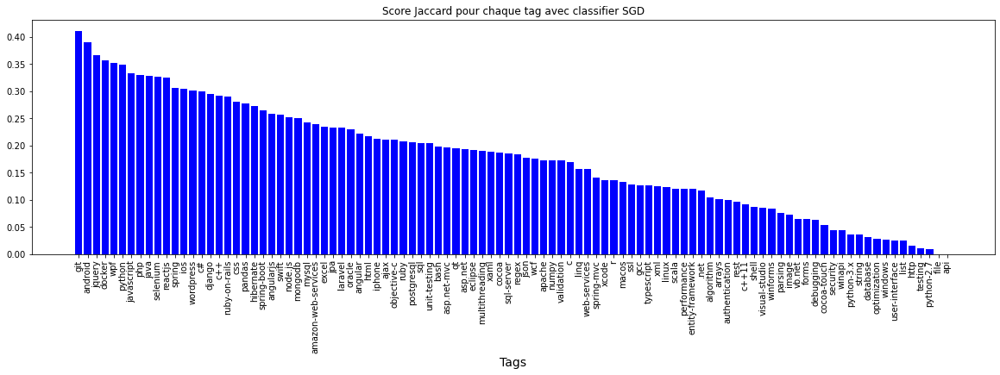

In [106]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag avec classifier SGD')
plt.show()

In [107]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test2, average='weighted')

0.23169546560534976

In [108]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test2.sum()

10345

In [109]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [110]:
# Identification des 5 tags prédits par post
y_pred_test_w = y_pred_test2.copy()
tag_predit_sgdc = pd.DataFrame()
for k in range(len(y_pred_test_w)):
    for i in range(5):
        ind = -1
        for j in range(100) :
            if y_pred_test_w[k,j] == 1 :
                ind  = j 
        if ind > -1 : 
            tag_predit_sgdc.loc[k,i] = dict_tag[ind]
            y_pred_test_w[k,ind] = 0
        else : 
            tag_predit_sgdc.loc[k,i] = ' '

In [111]:
tag_predit_sgdc

,0,1,2,3,4
0,,,,,
1,,,,,
2,unit-testing,,,,
3,c#,,,,
4,,,,,
...,...,...,...,...,...
14995,objective-c,iphone,ios,cocoa,
14996,php,,,,
14997,c#,,,,
14998,ios,,,,


In [112]:
tag_predit_sgdc['list_tag'] = ' '
tag_predit_sgdc['list_tag'][tag_predit_sgdc[0] != ' ' ] = tag_predit_sgdc[0]
tag_predit_sgdc['list_tag'][tag_predit_sgdc[1] != ' ' ] = tag_predit_sgdc['list_tag'] + ' ' + tag_predit_sgdc[1]
tag_predit_sgdc['list_tag'][tag_predit_sgdc[2] != ' ' ] = tag_predit_sgdc['list_tag'] + ' ' + tag_predit_sgdc[2]
tag_predit_sgdc['list_tag'][tag_predit_sgdc[3] != ' ' ] = tag_predit_sgdc['list_tag'] + ' ' + tag_predit_sgdc[3]
tag_predit_sgdc['list_tag'][tag_predit_sgdc[4] != ' ' ] = tag_predit_sgdc['list_tag'] + ' ' + tag_predit_sgdc[4]
tag_predit_sgdc

,0,1,2,3,4,list_tag
0,,,,,,
1,,,,,,
2,unit-testing,,,,,unit-testing
3,c#,,,,,c#
4,,,,,,
...,...,...,...,...,...,...
14995,objective-c,iphone,ios,cocoa,,objective-c iphone ios cocoa
14996,php,,,,,php
14997,c#,,,,,c#
14998,ios,,,,,ios


In [113]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_sgdc,'export_tag_predit_sgdc')

['export_tag_predit_sgdc']

In [114]:
tag_predit_sgdc=load('export_tag_predit_sgdc')

In [115]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_sgdc['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,c#,1070
1,java,912
2,javascript,857
3,python,605
4,c++,483
...,...,...
95,user-interface,6
96,list,6
97,winapi,6
98,api,5


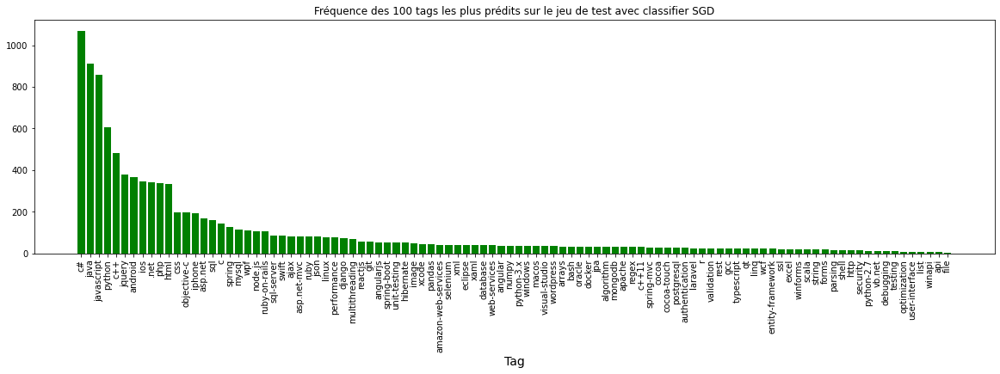

In [116]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test avec classifier SGD')
plt.show()

In [117]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_sgdc.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({' ': 64662, 'c#': 1070, 'java': 912, 'javascript': 857, 'python': 605, 'c++': 483, 'jquery': 378, 'android': 365, 'ios': 346, '.net': 340, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation i

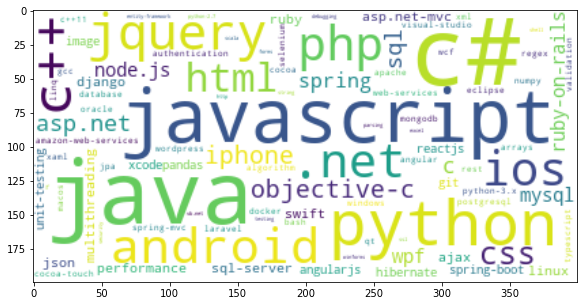

In [118]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [119]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  7347
nombre de tags non trouvés :  67653
Pourcentage de couverture des tags réels :  9.8 %


In [120]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_sgdc.iloc[k,0]) or (tag ==tag_predit_sgdc.iloc[k,1]) or (tag ==tag_predit_sgdc.iloc[k,2]) or (tag ==tag_predit_sgdc.iloc[k,3]) or (tag ==tag_predit_sgdc.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  7347
nombre de tags non trouvés :  21346
Pourcentage de couverture des tags réels / 100 plus fréquents :  25.61 %


In [121]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            if tag_predit_sgdc.iloc[k,i] != ' ' :
                nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  4405
nombre de mots non trouvés :  5933
Pourcentage de couverture des mots :  42.61 %


In [122]:
# Comparaison sur un petit échantillon du jeu de test des tags prédits vis à vis des tags saisis par l'utilisateur

In [123]:
#list_k = random.sample(range(len(tag_predit)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test')
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_sgdc.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
 
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android
-------------------------------------------------
-------------------------------------------------
enregistrement n° 9174  du jeu de test
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
python python-3.x gtk gtk3 pygobject
-----------------------------------------

In [124]:
#5 Modèles supervisés après techniques de word embedding

In [130]:
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import time
import os
import transformers
from transformers import *

os.environ["TF_KERAS"]='1'

print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

import tensorflow_hub as hub
import tensorflow_text 

embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

# Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)


2.9.1
2.9.1
Num GPUs Available:  0
True


In [131]:
#5.1 USE

In [133]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [134]:
batch_size = 10
sentences = raw_data_train['Title_body_text'].to_list()
sentences_test = raw_data_test['Title_body_text'].to_list()

In [135]:
features_USE = feature_USE_fct(sentences, batch_size)
features_USE_test = feature_USE_fct(sentences_test, batch_size)

In [136]:
X_train = features_USE
X_test = features_USE_test

In [137]:
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)


In [138]:
Y_train=raw_data_train[['Tags_trf_list','Tags_trf_list_100']].copy()
Y_test=raw_data_test[['Tags_trf_list','Tags_trf_list_100']].copy()

In [139]:
Y_train_s = [dict_tag.doc2bow(text) for text in Y_train['Tags_trf_list_100'].values]
Y_test_s = [dict_tag.doc2bow(text) for text in Y_test['Tags_trf_list_100'].values]

In [140]:
Y_train_s = gensim.matutils.corpus2csc(Y_train_s)
Y_test_s = gensim.matutils.corpus2csc(Y_test_s)

In [141]:
Y_train_s = Y_train_s.T.toarray()
Y_test_s = Y_test_s.T.toarray()

In [142]:
#5.1.1 Régression logistique
clf_use = OneVsRestClassifier(LogisticRegression(random_state=0,
                                             max_iter=1000,
                                             tol = 1e-5,
                                             verbose=1))

In [143]:
clf_use.fit(X_train_std, Y_train_s)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Us

OneVsRestClassifier(estimator=LogisticRegression(max_iter=1000, random_state=0,
                                                 tol=1e-05, verbose=1))

In [144]:
dump(clf_use,'export_modele_reglog_use')

['export_modele_reglog_use']

In [145]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test = clf_use.predict(X_test_std)

In [146]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test, average=None)
jac_scor

array([0.10059172, 0.49470499, 0.41256831, 0.20103986, 0.46004057,
       0.23245614, 0.15151515, 0.42067554, 0.39228296, 0.33018868,
       0.58093347, 0.19140625, 0.39087948, 0.42538593, 0.47068966,
       0.31808511, 0.39108911, 0.1375    , 0.33333333, 0.72736626,
       0.57769816, 0.27985075, 0.33536585, 0.63240858, 0.39849624,
       0.17682927, 0.09917355, 0.09090909, 0.18181818, 0.06060606,
       0.55254237, 0.48523207, 0.09340659, 0.18095238, 0.42583732,
       0.15294118, 0.40625   , 0.36209814, 0.57055215, 0.18518519,
       0.27225131, 0.19186047, 0.26666667, 0.3253012 , 0.28435115,
       0.30454545, 0.17142857, 0.14159292, 0.19615385, 0.44295302,
       0.5209713 , 0.36288089, 0.22123894, 0.32208589, 0.18942731,
       0.05232558, 0.20666667, 0.1       , 0.23976608, 0.26726058,
       0.49586777, 0.47770701, 0.10638298, 0.22968198, 0.15048544,
       0.26      , 0.28615385, 0.50413223, 0.36900369, 0.34134615,
       0.34763948, 0.23350254, 0.45192308, 0.31553398, 0.27631

In [147]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.100592
1,javascript,0.494705
2,node.js,0.412568
3,.net,0.201040
4,c#,0.460041


In [148]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

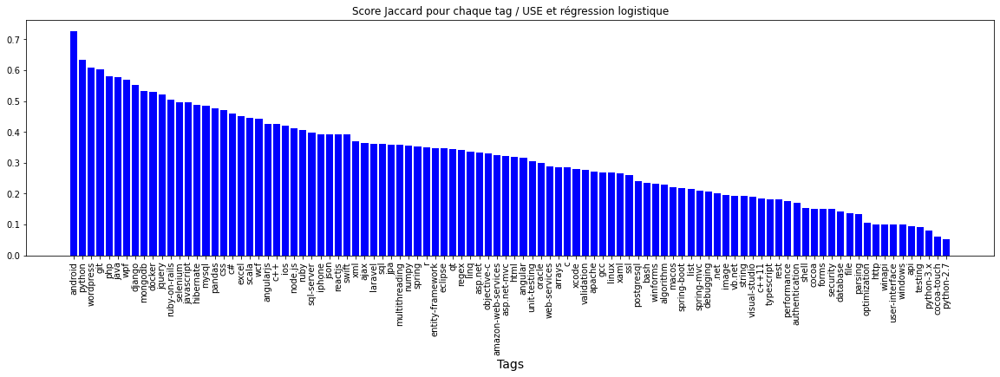

In [149]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / USE et régression logistique')
plt.show()

In [150]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test, average='weighted')

0.3952371279247753

In [151]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test.sum()

22829

In [152]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [153]:
# L'utilisation du predict ne permet pas de predire 5 tags par post
# --> Utilisation de predict_proba, pour récupération des 5 tags ayant la plus forte probabilité
y_pred_test_proba = clf_use.predict_proba(X_test_std)

In [154]:
# Identification des 5 tags prédits par post
y_pred_test_proba_w = y_pred_test_proba.copy()
tag_predit_use=pd.DataFrame()
for k in range(len(y_pred_test_proba_w)):
    for i in range(5):
        val_max = 0
        ind = -1
        for j in range(100) :
            if y_pred_test_proba_w[k,j] > val_max :
                val_max = y_pred_test_proba_w[k,j]
                ind  = j 
        if ind > -1 : 
            tag_predit_use.loc[k,i] = dict_tag[ind]
            y_pred_test_proba_w[k,ind] = 0
tag_predit_use['list_tag'] = tag_predit_use[0] + ' ' + tag_predit_use[1] + ' ' + tag_predit_use[2] + ' ' + tag_predit_use[3] + ' ' + tag_predit_use[4]

In [155]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_use,'export_tag_predit_use')

['export_tag_predit_use']

In [156]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_use['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,c#,5554
1,java,4202
2,javascript,3797
3,.net,3435
4,c++,2987
...,...,...
95,laravel,158
96,wordpress,155
97,docker,151
98,excel,122


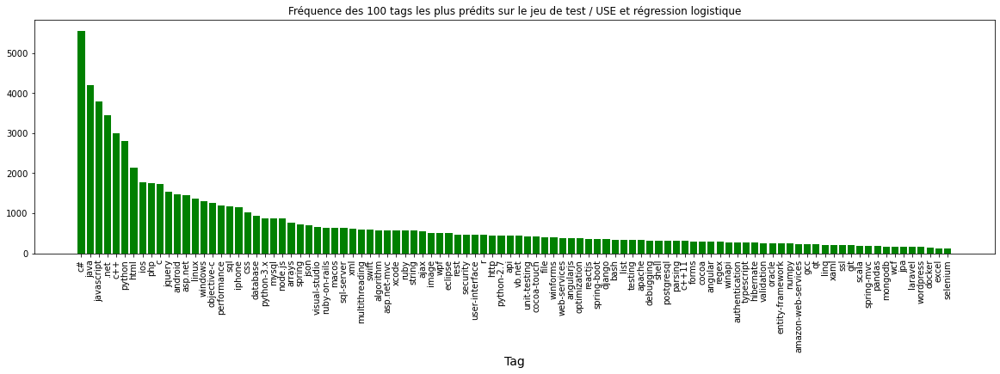

In [157]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / USE et régression logistique')
plt.show()

In [158]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_use.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({'c#': 5554, 'java': 4202, 'javascript': 3797, '.net': 3435, 'c++': 2987, 'python': 2793, 'html': 2133, 'ios': 1774, 'php': 1740, 'c': 1735, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=trans

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

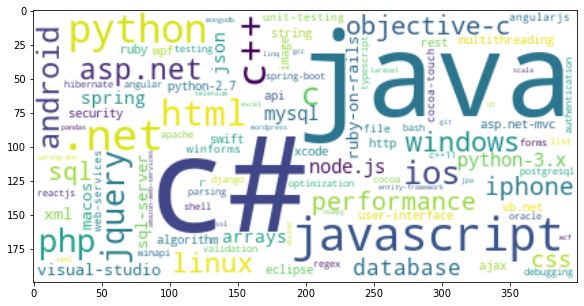

In [159]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [160]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_use.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  22603
nombre de tags non trouvés :  52397
Pourcentage de couverture des tags réels :  30.14 %


In [161]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_use.iloc[k,0]) or (tag ==tag_predit_use.iloc[k,1]) or (tag ==tag_predit_use.iloc[k,2]) or (tag ==tag_predit_use.iloc[k,3]) or (tag ==tag_predit_use.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  22603
nombre de tags non trouvés :  6090
Pourcentage de couverture des tags réels / 100 plus fréquents :  78.78 %


In [162]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_use.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  14894
nombre de mots non trouvés :  60106
Pourcentage de couverture des mots :  19.86 %


In [163]:
#list_k = random.sample(range(len(tag_predit_use)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_use.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
c++11 c++ arrays c php
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android xml java list user-interface
-------------------------------------------------
----------------------------

In [164]:
#5.1.2 SGDClassifier
clf2_use = OneVsRestClassifier(SGDClassifier(random_state=0,
                                             max_iter=2000,
                                             verbose=1))

In [165]:
clf2_use.fit(X_train_std, Y_train_s)

-- Epoch 1
Norm: 159.65, NNZs: 512, Bias: -1318.047249, T: 35000, Avg. loss: 9.114317
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 160.21, NNZs: 512, Bias: -1291.529851, T: 70000, Avg. loss: 2.891252
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 163.03, NNZs: 512, Bias: -1275.817931, T: 105000, Avg. loss: 2.609251
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 159.67, NNZs: 512, Bias: -1265.144476, T: 140000, Avg. loss: 2.500210
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 162.11, NNZs: 512, Bias: -1256.304432, T: 175000, Avg. loss: 2.435443
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 160.09, NNZs: 512, Bias: -1249.565242, T: 210000, Avg. loss: 2.366487
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 160.77, NNZs: 512, Bias: -1243.535921, T: 245000, Avg. loss: 2.339202
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 160.45, NNZs: 512, Bias: -1238.442601, T: 280000, Avg. loss: 2.306848
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 160.72, N

-- Epoch 74
Norm: 154.70, NNZs: 512, Bias: -1154.232903, T: 2590000, Avg. loss: 1.990760
Total training time: 1.78 seconds.
-- Epoch 75
Norm: 154.69, NNZs: 512, Bias: -1153.726895, T: 2625000, Avg. loss: 1.989239
Total training time: 1.81 seconds.
-- Epoch 76
Norm: 154.60, NNZs: 512, Bias: -1153.238966, T: 2660000, Avg. loss: 1.987807
Total training time: 1.83 seconds.
-- Epoch 77
Norm: 154.54, NNZs: 512, Bias: -1152.753536, T: 2695000, Avg. loss: 1.986207
Total training time: 1.85 seconds.
-- Epoch 78
Norm: 154.56, NNZs: 512, Bias: -1152.263542, T: 2730000, Avg. loss: 1.985728
Total training time: 1.87 seconds.
-- Epoch 79
Norm: 154.55, NNZs: 512, Bias: -1151.783389, T: 2765000, Avg. loss: 1.983712
Total training time: 1.90 seconds.
-- Epoch 80
Norm: 154.60, NNZs: 512, Bias: -1151.302180, T: 2800000, Avg. loss: 1.982225
Total training time: 1.92 seconds.
-- Epoch 81
Norm: 154.17, NNZs: 512, Bias: -1150.890384, T: 2835000, Avg. loss: 1.979364
Total training time: 1.94 seconds.
-- Epoch

-- Epoch 140
Norm: 152.51, NNZs: 512, Bias: -1130.523115, T: 4900000, Avg. loss: 1.927827
Total training time: 3.39 seconds.
-- Epoch 141
Norm: 152.61, NNZs: 512, Bias: -1130.242586, T: 4935000, Avg. loss: 1.928617
Total training time: 3.41 seconds.
-- Epoch 142
Norm: 152.50, NNZs: 512, Bias: -1129.992227, T: 4970000, Avg. loss: 1.926504
Total training time: 3.44 seconds.
-- Epoch 143
Norm: 152.50, NNZs: 512, Bias: -1129.729595, T: 5005000, Avg. loss: 1.926439
Total training time: 3.46 seconds.
-- Epoch 144
Norm: 152.48, NNZs: 512, Bias: -1129.470790, T: 5040000, Avg. loss: 1.925842
Total training time: 3.48 seconds.
-- Epoch 145
Norm: 152.49, NNZs: 512, Bias: -1129.209878, T: 5075000, Avg. loss: 1.925573
Total training time: 3.50 seconds.
-- Epoch 146
Norm: 152.33, NNZs: 512, Bias: -1128.974248, T: 5110000, Avg. loss: 1.924282
Total training time: 3.52 seconds.
-- Epoch 147
Norm: 152.38, NNZs: 512, Bias: -1128.710996, T: 5145000, Avg. loss: 1.924886
Total training time: 3.55 seconds.


Norm: 133.10, NNZs: 512, Bias: -343.070607, T: 2100000, Avg. loss: 3.426204
Total training time: 1.53 seconds.
-- Epoch 61
Norm: 132.35, NNZs: 512, Bias: -340.950469, T: 2135000, Avg. loss: 3.394285
Total training time: 1.55 seconds.
-- Epoch 62
Norm: 132.09, NNZs: 512, Bias: -338.680711, T: 2170000, Avg. loss: 3.375793
Total training time: 1.58 seconds.
-- Epoch 63
Norm: 131.32, NNZs: 512, Bias: -336.652162, T: 2205000, Avg. loss: 3.345877
Total training time: 1.60 seconds.
-- Epoch 64
Norm: 130.82, NNZs: 512, Bias: -334.556573, T: 2240000, Avg. loss: 3.325113
Total training time: 1.62 seconds.
-- Epoch 65
Norm: 130.25, NNZs: 512, Bias: -332.533206, T: 2275000, Avg. loss: 3.299794
Total training time: 1.65 seconds.
-- Epoch 66
Norm: 129.64, NNZs: 512, Bias: -330.558157, T: 2310000, Avg. loss: 3.278356
Total training time: 1.67 seconds.
-- Epoch 67
Norm: 129.26, NNZs: 512, Bias: -328.530985, T: 2345000, Avg. loss: 3.253788
Total training time: 1.69 seconds.
-- Epoch 68
Norm: 128.52, NN

Norm: 104.38, NNZs: 512, Bias: -241.938578, T: 4690000, Avg. loss: 2.297292
Total training time: 3.35 seconds.
-- Epoch 135
Norm: 103.99, NNZs: 512, Bias: -241.108111, T: 4725000, Avg. loss: 2.289060
Total training time: 3.37 seconds.
-- Epoch 136
Norm: 103.79, NNZs: 512, Bias: -240.201483, T: 4760000, Avg. loss: 2.274962
Total training time: 3.40 seconds.
-- Epoch 137
Norm: 103.56, NNZs: 512, Bias: -239.318292, T: 4795000, Avg. loss: 2.268825
Total training time: 3.42 seconds.
-- Epoch 138
Norm: 103.33, NNZs: 512, Bias: -238.441678, T: 4830000, Avg. loss: 2.259935
Total training time: 3.45 seconds.
-- Epoch 139
Norm: 103.11, NNZs: 512, Bias: -237.567130, T: 4865000, Avg. loss: 2.250854
Total training time: 3.47 seconds.
-- Epoch 140
Norm: 102.85, NNZs: 512, Bias: -236.717560, T: 4900000, Avg. loss: 2.240806
Total training time: 3.49 seconds.
-- Epoch 141
Norm: 102.56, NNZs: 512, Bias: -235.892123, T: 4935000, Avg. loss: 2.232595
Total training time: 3.52 seconds.
-- Epoch 142
Norm: 10

Norm: 89.19, NNZs: 512, Bias: -192.878700, T: 7175000, Avg. loss: 1.787084
Total training time: 5.10 seconds.
-- Epoch 206
Norm: 89.10, NNZs: 512, Bias: -192.297551, T: 7210000, Avg. loss: 1.781315
Total training time: 5.13 seconds.
-- Epoch 207
Norm: 88.94, NNZs: 512, Bias: -191.752553, T: 7245000, Avg. loss: 1.776304
Total training time: 5.15 seconds.
-- Epoch 208
Norm: 88.75, NNZs: 512, Bias: -191.225248, T: 7280000, Avg. loss: 1.770029
Total training time: 5.18 seconds.
-- Epoch 209
Norm: 88.57, NNZs: 512, Bias: -190.696271, T: 7315000, Avg. loss: 1.765116
Total training time: 5.21 seconds.
-- Epoch 210
Norm: 88.44, NNZs: 512, Bias: -190.145413, T: 7350000, Avg. loss: 1.759294
Total training time: 5.23 seconds.
-- Epoch 211
Norm: 88.24, NNZs: 512, Bias: -189.635145, T: 7385000, Avg. loss: 1.753774
Total training time: 5.26 seconds.
-- Epoch 212
Norm: 88.04, NNZs: 512, Bias: -189.123129, T: 7420000, Avg. loss: 1.748832
Total training time: 5.28 seconds.
-- Epoch 213
Norm: 87.91, NNZ

-- Epoch 275
Norm: 79.00, NNZs: 512, Bias: -160.846545, T: 9625000, Avg. loss: 1.466449
Total training time: 7.17 seconds.
-- Epoch 276
Norm: 78.86, NNZs: 512, Bias: -160.467007, T: 9660000, Avg. loss: 1.464108
Total training time: 7.20 seconds.
-- Epoch 277
Norm: 78.72, NNZs: 512, Bias: -160.091921, T: 9695000, Avg. loss: 1.458836
Total training time: 7.22 seconds.
-- Epoch 278
Norm: 78.59, NNZs: 512, Bias: -159.710985, T: 9730000, Avg. loss: 1.456203
Total training time: 7.25 seconds.
-- Epoch 279
Norm: 78.48, NNZs: 512, Bias: -159.327330, T: 9765000, Avg. loss: 1.451421
Total training time: 7.27 seconds.
-- Epoch 280
Norm: 78.37, NNZs: 512, Bias: -158.941977, T: 9800000, Avg. loss: 1.448523
Total training time: 7.30 seconds.
-- Epoch 281
Norm: 78.26, NNZs: 512, Bias: -158.557005, T: 9835000, Avg. loss: 1.444358
Total training time: 7.32 seconds.
-- Epoch 282
Norm: 78.13, NNZs: 512, Bias: -158.183594, T: 9870000, Avg. loss: 1.441039
Total training time: 7.35 seconds.
-- Epoch 283
Nor

-- Epoch 342
Norm: 71.45, NNZs: 512, Bias: -138.223568, T: 11970000, Avg. loss: 1.247460
Total training time: 8.95 seconds.
-- Epoch 343
Norm: 71.32, NNZs: 512, Bias: -137.944084, T: 12005000, Avg. loss: 1.245206
Total training time: 8.98 seconds.
-- Epoch 344
Norm: 71.22, NNZs: 512, Bias: -137.647959, T: 12040000, Avg. loss: 1.241034
Total training time: 9.00 seconds.
-- Epoch 345
Norm: 71.12, NNZs: 512, Bias: -137.356835, T: 12075000, Avg. loss: 1.239006
Total training time: 9.03 seconds.
-- Epoch 346
Norm: 71.05, NNZs: 512, Bias: -137.047549, T: 12110000, Avg. loss: 1.236201
Total training time: 9.05 seconds.
-- Epoch 347
Norm: 70.94, NNZs: 512, Bias: -136.762250, T: 12145000, Avg. loss: 1.233434
Total training time: 9.07 seconds.
-- Epoch 348
Norm: 70.84, NNZs: 512, Bias: -136.469554, T: 12180000, Avg. loss: 1.230300
Total training time: 9.10 seconds.
-- Epoch 349
Norm: 70.77, NNZs: 512, Bias: -136.162984, T: 12215000, Avg. loss: 1.228240
Total training time: 9.12 seconds.
-- Epoch

-- Epoch 415
Norm: 64.91, NNZs: 512, Bias: -118.965673, T: 14525000, Avg. loss: 1.064768
Total training time: 10.85 seconds.
-- Epoch 416
Norm: 64.83, NNZs: 512, Bias: -118.734616, T: 14560000, Avg. loss: 1.062520
Total training time: 10.87 seconds.
-- Epoch 417
Norm: 64.76, NNZs: 512, Bias: -118.491810, T: 14595000, Avg. loss: 1.059966
Total training time: 10.90 seconds.
-- Epoch 418
Norm: 64.67, NNZs: 512, Bias: -118.267368, T: 14630000, Avg. loss: 1.058322
Total training time: 10.92 seconds.
-- Epoch 419
Norm: 64.58, NNZs: 512, Bias: -118.037299, T: 14665000, Avg. loss: 1.055775
Total training time: 10.95 seconds.
-- Epoch 420
Norm: 64.52, NNZs: 512, Bias: -117.798954, T: 14700000, Avg. loss: 1.053631
Total training time: 10.97 seconds.
-- Epoch 421
Norm: 64.44, NNZs: 512, Bias: -117.566606, T: 14735000, Avg. loss: 1.051525
Total training time: 10.99 seconds.
-- Epoch 422
Norm: 64.35, NNZs: 512, Bias: -117.343612, T: 14770000, Avg. loss: 1.049851
Total training time: 11.02 seconds.


-- Epoch 488
Norm: 59.61, NNZs: 512, Bias: -103.445871, T: 17080000, Avg. loss: 0.920194
Total training time: 12.68 seconds.
-- Epoch 489
Norm: 59.52, NNZs: 512, Bias: -103.261632, T: 17115000, Avg. loss: 0.918372
Total training time: 12.71 seconds.
-- Epoch 490
Norm: 59.46, NNZs: 512, Bias: -103.069021, T: 17150000, Avg. loss: 0.916241
Total training time: 12.73 seconds.
-- Epoch 491
Norm: 59.40, NNZs: 512, Bias: -102.874474, T: 17185000, Avg. loss: 0.915078
Total training time: 12.76 seconds.
-- Epoch 492
Norm: 59.33, NNZs: 512, Bias: -102.684385, T: 17220000, Avg. loss: 0.912717
Total training time: 12.78 seconds.
-- Epoch 493
Norm: 59.27, NNZs: 512, Bias: -102.494672, T: 17255000, Avg. loss: 0.911361
Total training time: 12.81 seconds.
-- Epoch 494
Norm: 59.22, NNZs: 512, Bias: -102.292058, T: 17290000, Avg. loss: 0.909720
Total training time: 12.83 seconds.
-- Epoch 495
Norm: 59.13, NNZs: 512, Bias: -102.116429, T: 17325000, Avg. loss: 0.907997
Total training time: 12.85 seconds.


-- Epoch 560
Norm: 55.18, NNZs: 512, Bias: -90.759565, T: 19600000, Avg. loss: 0.804739
Total training time: 14.52 seconds.
-- Epoch 561
Norm: 55.12, NNZs: 512, Bias: -90.597990, T: 19635000, Avg. loss: 0.803114
Total training time: 14.54 seconds.
-- Epoch 562
Norm: 55.07, NNZs: 512, Bias: -90.436701, T: 19670000, Avg. loss: 0.801938
Total training time: 14.57 seconds.
-- Epoch 563
Norm: 55.01, NNZs: 512, Bias: -90.276204, T: 19705000, Avg. loss: 0.800205
Total training time: 14.59 seconds.
-- Epoch 564
Norm: 54.96, NNZs: 512, Bias: -90.115489, T: 19740000, Avg. loss: 0.798407
Total training time: 14.62 seconds.
-- Epoch 565
Norm: 54.90, NNZs: 512, Bias: -89.957082, T: 19775000, Avg. loss: 0.797558
Total training time: 14.64 seconds.
-- Epoch 566
Norm: 54.85, NNZs: 512, Bias: -89.789879, T: 19810000, Avg. loss: 0.795706
Total training time: 14.66 seconds.
-- Epoch 567
Norm: 54.79, NNZs: 512, Bias: -89.635573, T: 19845000, Avg. loss: 0.794335
Total training time: 14.69 seconds.
-- Epoch

Total training time: 16.29 seconds.
-- Epoch 631
Norm: 51.33, NNZs: 512, Bias: -80.206585, T: 22085000, Avg. loss: 0.711481
Total training time: 16.31 seconds.
-- Epoch 632
Norm: 51.27, NNZs: 512, Bias: -80.074480, T: 22120000, Avg. loss: 0.709572
Total training time: 16.34 seconds.
-- Epoch 633
Norm: 51.23, NNZs: 512, Bias: -79.933102, T: 22155000, Avg. loss: 0.708821
Total training time: 16.36 seconds.
-- Epoch 634
Norm: 51.16, NNZs: 512, Bias: -79.808171, T: 22190000, Avg. loss: 0.707365
Total training time: 16.39 seconds.
-- Epoch 635
Norm: 51.11, NNZs: 512, Bias: -79.669928, T: 22225000, Avg. loss: 0.706633
Total training time: 16.41 seconds.
-- Epoch 636
Norm: 51.05, NNZs: 512, Bias: -79.539541, T: 22260000, Avg. loss: 0.705076
Total training time: 16.44 seconds.
-- Epoch 637
Norm: 51.03, NNZs: 512, Bias: -79.388275, T: 22295000, Avg. loss: 0.703597
Total training time: 16.46 seconds.
-- Epoch 638
Norm: 50.96, NNZs: 512, Bias: -79.260104, T: 22330000, Avg. loss: 0.702784
Total tr

-- Epoch 703
Norm: 47.83, NNZs: 512, Bias: -71.049280, T: 24605000, Avg. loss: 0.632320
Total training time: 18.11 seconds.
-- Epoch 704
Norm: 47.79, NNZs: 512, Bias: -70.926636, T: 24640000, Avg. loss: 0.630633
Total training time: 18.14 seconds.
-- Epoch 705
Norm: 47.74, NNZs: 512, Bias: -70.810253, T: 24675000, Avg. loss: 0.630144
Total training time: 18.17 seconds.
-- Epoch 706
Norm: 47.69, NNZs: 512, Bias: -70.697265, T: 24710000, Avg. loss: 0.628606
Total training time: 18.20 seconds.
-- Epoch 707
Norm: 47.63, NNZs: 512, Bias: -70.587269, T: 24745000, Avg. loss: 0.627383
Total training time: 18.23 seconds.
-- Epoch 708
Norm: 47.59, NNZs: 512, Bias: -70.468945, T: 24780000, Avg. loss: 0.626937
Total training time: 18.26 seconds.
-- Epoch 709
Norm: 47.55, NNZs: 512, Bias: -70.350785, T: 24815000, Avg. loss: 0.625910
Total training time: 18.30 seconds.
-- Epoch 710
Norm: 47.51, NNZs: 512, Bias: -70.227159, T: 24850000, Avg. loss: 0.625203
Total training time: 18.34 seconds.
-- Epoch

-- Epoch 3
Norm: 204.69, NNZs: 512, Bias: -1218.811227, T: 105000, Avg. loss: 4.471652
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 200.76, NNZs: 512, Bias: -1200.242459, T: 140000, Avg. loss: 4.237306
Total training time: 0.11 seconds.
-- Epoch 5
Norm: 203.16, NNZs: 512, Bias: -1185.140149, T: 175000, Avg. loss: 4.156117
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 200.25, NNZs: 512, Bias: -1173.543248, T: 210000, Avg. loss: 4.018133
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 197.87, NNZs: 512, Bias: -1163.739860, T: 245000, Avg. loss: 3.954043
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 198.62, NNZs: 512, Bias: -1154.826804, T: 280000, Avg. loss: 3.904566
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 196.08, NNZs: 512, Bias: -1147.509160, T: 315000, Avg. loss: 3.830396
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 195.85, NNZs: 512, Bias: -1140.630699, T: 350000, Avg. loss: 3.807524
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 195.6

-- Epoch 77
Norm: 179.91, NNZs: 512, Bias: -1012.031362, T: 2695000, Avg. loss: 3.171105
Total training time: 1.94 seconds.
-- Epoch 78
Norm: 179.84, NNZs: 512, Bias: -1011.231766, T: 2730000, Avg. loss: 3.167812
Total training time: 1.97 seconds.
-- Epoch 79
Norm: 179.77, NNZs: 512, Bias: -1010.442421, T: 2765000, Avg. loss: 3.163221
Total training time: 2.00 seconds.
-- Epoch 80
Norm: 179.68, NNZs: 512, Bias: -1009.666609, T: 2800000, Avg. loss: 3.160798
Total training time: 2.03 seconds.
-- Epoch 81
Norm: 179.55, NNZs: 512, Bias: -1008.907705, T: 2835000, Avg. loss: 3.158866
Total training time: 2.06 seconds.
-- Epoch 82
Norm: 179.41, NNZs: 512, Bias: -1008.161367, T: 2870000, Avg. loss: 3.154567
Total training time: 2.10 seconds.
-- Epoch 83
Norm: 179.40, NNZs: 512, Bias: -1007.399929, T: 2905000, Avg. loss: 3.151176
Total training time: 2.13 seconds.
-- Epoch 84
Norm: 179.17, NNZs: 512, Bias: -1006.688705, T: 2940000, Avg. loss: 3.149713
Total training time: 2.16 seconds.
-- Epoch

Total training time: 4.09 seconds.
-- Epoch 151
Norm: 174.68, NNZs: 512, Bias: -970.867191, T: 5285000, Avg. loss: 3.000568
Total training time: 4.11 seconds.
-- Epoch 152
Norm: 174.54, NNZs: 512, Bias: -970.482584, T: 5320000, Avg. loss: 2.998103
Total training time: 4.14 seconds.
-- Epoch 153
Norm: 174.36, NNZs: 512, Bias: -970.107833, T: 5355000, Avg. loss: 2.995991
Total training time: 4.16 seconds.
-- Epoch 154
Norm: 174.39, NNZs: 512, Bias: -969.698357, T: 5390000, Avg. loss: 2.995492
Total training time: 4.20 seconds.
-- Epoch 155
Norm: 174.26, NNZs: 512, Bias: -969.321071, T: 5425000, Avg. loss: 2.993237
Total training time: 4.22 seconds.
-- Epoch 156
Norm: 174.26, NNZs: 512, Bias: -968.922341, T: 5460000, Avg. loss: 2.992748
Total training time: 4.24 seconds.
-- Epoch 157
Norm: 174.19, NNZs: 512, Bias: -968.538988, T: 5495000, Avg. loss: 2.990659
Total training time: 4.27 seconds.
-- Epoch 158
Norm: 174.24, NNZs: 512, Bias: -968.136349, T: 5530000, Avg. loss: 2.989759
Total tr

-- Epoch 225
Norm: 171.43, NNZs: 512, Bias: -946.818973, T: 7875000, Avg. loss: 2.902716
Total training time: 5.94 seconds.
-- Epoch 226
Norm: 171.48, NNZs: 512, Bias: -946.537756, T: 7910000, Avg. loss: 2.902027
Total training time: 5.96 seconds.
-- Epoch 227
Norm: 171.44, NNZs: 512, Bias: -946.272968, T: 7945000, Avg. loss: 2.901284
Total training time: 5.98 seconds.
-- Epoch 228
Norm: 171.35, NNZs: 512, Bias: -946.019319, T: 7980000, Avg. loss: 2.899531
Total training time: 6.01 seconds.
-- Epoch 229
Norm: 171.35, NNZs: 512, Bias: -945.750534, T: 8015000, Avg. loss: 2.898712
Total training time: 6.03 seconds.
-- Epoch 230
Norm: 171.23, NNZs: 512, Bias: -945.504035, T: 8050000, Avg. loss: 2.896987
Total training time: 6.05 seconds.
-- Epoch 231
Norm: 171.23, NNZs: 512, Bias: -945.237537, T: 8085000, Avg. loss: 2.896684
Total training time: 6.07 seconds.
-- Epoch 232
Norm: 171.29, NNZs: 512, Bias: -944.962389, T: 8120000, Avg. loss: 2.895718
Total training time: 6.10 seconds.
-- Epoch

-- Epoch 5
Norm: 206.10, NNZs: 512, Bias: -759.806165, T: 175000, Avg. loss: 10.584485
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 203.01, NNZs: 512, Bias: -728.492951, T: 210000, Avg. loss: 9.961734
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 198.03, NNZs: 512, Bias: -702.848144, T: 245000, Avg. loss: 9.464089
Total training time: 0.19 seconds.
-- Epoch 8
Norm: 192.73, NNZs: 512, Bias: -680.983464, T: 280000, Avg. loss: 9.026642
Total training time: 0.21 seconds.
-- Epoch 9
Norm: 190.16, NNZs: 512, Bias: -661.260721, T: 315000, Avg. loss: 8.685158
Total training time: 0.23 seconds.
-- Epoch 10
Norm: 186.00, NNZs: 512, Bias: -644.197335, T: 350000, Avg. loss: 8.394532
Total training time: 0.26 seconds.
-- Epoch 11
Norm: 183.37, NNZs: 512, Bias: -628.561299, T: 385000, Avg. loss: 8.115269
Total training time: 0.28 seconds.
-- Epoch 12
Norm: 179.75, NNZs: 512, Bias: -614.669107, T: 420000, Avg. loss: 7.908587
Total training time: 0.30 seconds.
-- Epoch 13
Norm: 177.50, NN

Norm: 114.90, NNZs: 512, Bias: -329.336259, T: 2765000, Avg. loss: 3.845228
Total training time: 1.98 seconds.
-- Epoch 80
Norm: 114.40, NNZs: 512, Bias: -327.594143, T: 2800000, Avg. loss: 3.821935
Total training time: 2.01 seconds.
-- Epoch 81
Norm: 114.02, NNZs: 512, Bias: -325.837898, T: 2835000, Avg. loss: 3.800699
Total training time: 2.03 seconds.
-- Epoch 82
Norm: 113.62, NNZs: 512, Bias: -324.113812, T: 2870000, Avg. loss: 3.777121
Total training time: 2.06 seconds.
-- Epoch 83
Norm: 113.10, NNZs: 512, Bias: -322.451681, T: 2905000, Avg. loss: 3.758359
Total training time: 2.08 seconds.
-- Epoch 84
Norm: 112.71, NNZs: 512, Bias: -320.775420, T: 2940000, Avg. loss: 3.733007
Total training time: 2.10 seconds.
-- Epoch 85
Norm: 112.29, NNZs: 512, Bias: -319.125917, T: 2975000, Avg. loss: 3.717351
Total training time: 2.14 seconds.
-- Epoch 86
Norm: 111.85, NNZs: 512, Bias: -317.509034, T: 3010000, Avg. loss: 3.697562
Total training time: 2.16 seconds.
-- Epoch 87
Norm: 111.50, NN

Norm: 91.19, NNZs: 512, Bias: -239.871708, T: 5355000, Avg. loss: 2.736561
Total training time: 3.83 seconds.
-- Epoch 154
Norm: 90.94, NNZs: 512, Bias: -239.026665, T: 5390000, Avg. loss: 2.725677
Total training time: 3.86 seconds.
-- Epoch 155
Norm: 90.76, NNZs: 512, Bias: -238.161228, T: 5425000, Avg. loss: 2.717158
Total training time: 3.88 seconds.
-- Epoch 156
Norm: 90.64, NNZs: 512, Bias: -237.281362, T: 5460000, Avg. loss: 2.704594
Total training time: 3.91 seconds.
-- Epoch 157
Norm: 90.37, NNZs: 512, Bias: -236.463808, T: 5495000, Avg. loss: 2.696627
Total training time: 3.93 seconds.
-- Epoch 158
Norm: 90.10, NNZs: 512, Bias: -235.654815, T: 5530000, Avg. loss: 2.685530
Total training time: 3.97 seconds.
-- Epoch 159
Norm: 89.85, NNZs: 512, Bias: -234.845511, T: 5565000, Avg. loss: 2.675053
Total training time: 4.00 seconds.
-- Epoch 160
Norm: 89.66, NNZs: 512, Bias: -234.016114, T: 5600000, Avg. loss: 2.666650
Total training time: 4.02 seconds.
-- Epoch 161
Norm: 89.47, NNZ

-- Epoch 227
Norm: 76.89, NNZs: 512, Bias: -189.613802, T: 7945000, Avg. loss: 2.141327
Total training time: 5.70 seconds.
-- Epoch 228
Norm: 76.75, NNZs: 512, Bias: -189.062544, T: 7980000, Avg. loss: 2.134929
Total training time: 5.73 seconds.
-- Epoch 229
Norm: 76.54, NNZs: 512, Bias: -188.537467, T: 8015000, Avg. loss: 2.127098
Total training time: 5.76 seconds.
-- Epoch 230
Norm: 76.44, NNZs: 512, Bias: -187.973644, T: 8050000, Avg. loss: 2.121674
Total training time: 5.78 seconds.
-- Epoch 231
Norm: 76.23, NNZs: 512, Bias: -187.456816, T: 8085000, Avg. loss: 2.115143
Total training time: 5.80 seconds.
-- Epoch 232
Norm: 76.10, NNZs: 512, Bias: -186.911367, T: 8120000, Avg. loss: 2.110033
Total training time: 5.83 seconds.
-- Epoch 233
Norm: 75.93, NNZs: 512, Bias: -186.386699, T: 8155000, Avg. loss: 2.103953
Total training time: 5.85 seconds.
-- Epoch 234
Norm: 75.76, NNZs: 512, Bias: -185.861860, T: 8190000, Avg. loss: 2.096528
Total training time: 5.88 seconds.
-- Epoch 235
Nor

Total training time: 7.29 seconds.
-- Epoch 294
Norm: 67.28, NNZs: 512, Bias: -158.166023, T: 10290000, Avg. loss: 1.777334
Total training time: 7.32 seconds.
-- Epoch 295
Norm: 67.18, NNZs: 512, Bias: -157.748849, T: 10325000, Avg. loss: 1.771604
Total training time: 7.34 seconds.
-- Epoch 296
Norm: 67.05, NNZs: 512, Bias: -157.347632, T: 10360000, Avg. loss: 1.767889
Total training time: 7.37 seconds.
-- Epoch 297
Norm: 66.93, NNZs: 512, Bias: -156.945827, T: 10395000, Avg. loss: 1.763260
Total training time: 7.39 seconds.
-- Epoch 298
Norm: 66.80, NNZs: 512, Bias: -156.547301, T: 10430000, Avg. loss: 1.758715
Total training time: 7.41 seconds.
-- Epoch 299
Norm: 66.66, NNZs: 512, Bias: -156.152981, T: 10465000, Avg. loss: 1.753604
Total training time: 7.45 seconds.
-- Epoch 300
Norm: 66.55, NNZs: 512, Bias: -155.751408, T: 10500000, Avg. loss: 1.749789
Total training time: 7.47 seconds.
-- Epoch 301
Norm: 66.45, NNZs: 512, Bias: -155.345488, T: 10535000, Avg. loss: 1.746077
Total tr

Norm: 59.36, NNZs: 512, Bias: -133.108520, T: 12740000, Avg. loss: 1.492027
Total training time: 9.06 seconds.
-- Epoch 365
Norm: 59.24, NNZs: 512, Bias: -132.798905, T: 12775000, Avg. loss: 1.489241
Total training time: 9.09 seconds.
-- Epoch 366
Norm: 59.16, NNZs: 512, Bias: -132.472968, T: 12810000, Avg. loss: 1.484979
Total training time: 9.11 seconds.
-- Epoch 367
Norm: 59.04, NNZs: 512, Bias: -132.167422, T: 12845000, Avg. loss: 1.482020
Total training time: 9.14 seconds.
-- Epoch 368
Norm: 58.96, NNZs: 512, Bias: -131.847163, T: 12880000, Avg. loss: 1.479263
Total training time: 9.16 seconds.
-- Epoch 369
Norm: 58.84, NNZs: 512, Bias: -131.540952, T: 12915000, Avg. loss: 1.475139
Total training time: 9.18 seconds.
-- Epoch 370
Norm: 58.77, NNZs: 512, Bias: -131.220091, T: 12950000, Avg. loss: 1.471285
Total training time: 9.20 seconds.
-- Epoch 371
Norm: 58.63, NNZs: 512, Bias: -130.925531, T: 12985000, Avg. loss: 1.468208
Total training time: 9.23 seconds.
-- Epoch 372
Norm: 58

-- Epoch 430
Norm: 53.16, NNZs: 512, Bias: -114.187433, T: 15050000, Avg. loss: 1.280381
Total training time: 10.72 seconds.
-- Epoch 431
Norm: 53.10, NNZs: 512, Bias: -113.917334, T: 15085000, Avg. loss: 1.278286
Total training time: 10.74 seconds.
-- Epoch 432
Norm: 53.01, NNZs: 512, Bias: -113.661109, T: 15120000, Avg. loss: 1.274674
Total training time: 10.77 seconds.
-- Epoch 433
Norm: 52.94, NNZs: 512, Bias: -113.392269, T: 15155000, Avg. loss: 1.272343
Total training time: 10.80 seconds.
-- Epoch 434
Norm: 52.84, NNZs: 512, Bias: -113.143829, T: 15190000, Avg. loss: 1.269019
Total training time: 10.84 seconds.
-- Epoch 435
Norm: 52.75, NNZs: 512, Bias: -112.890695, T: 15225000, Avg. loss: 1.266800
Total training time: 10.87 seconds.
-- Epoch 436
Norm: 52.66, NNZs: 512, Bias: -112.633536, T: 15260000, Avg. loss: 1.263340
Total training time: 10.90 seconds.
-- Epoch 437
Norm: 52.58, NNZs: 512, Bias: -112.376299, T: 15295000, Avg. loss: 1.259891
Total training time: 10.93 seconds.


-- Epoch 498
Norm: 47.75, NNZs: 512, Bias: -97.988608, T: 17430000, Avg. loss: 1.101463
Total training time: 12.58 seconds.
-- Epoch 499
Norm: 47.65, NNZs: 512, Bias: -97.783413, T: 17465000, Avg. loss: 1.098623
Total training time: 12.60 seconds.
-- Epoch 500
Norm: 47.60, NNZs: 512, Bias: -97.555753, T: 17500000, Avg. loss: 1.096715
Total training time: 12.63 seconds.
-- Epoch 501
Norm: 47.54, NNZs: 512, Bias: -97.331985, T: 17535000, Avg. loss: 1.094499
Total training time: 12.65 seconds.
-- Epoch 502
Norm: 47.47, NNZs: 512, Bias: -97.112671, T: 17570000, Avg. loss: 1.091922
Total training time: 12.67 seconds.
-- Epoch 503
Norm: 47.39, NNZs: 512, Bias: -96.901743, T: 17605000, Avg. loss: 1.089872
Total training time: 12.70 seconds.
-- Epoch 504
Norm: 47.30, NNZs: 512, Bias: -96.692369, T: 17640000, Avg. loss: 1.087437
Total training time: 12.72 seconds.
-- Epoch 505
Norm: 47.21, NNZs: 512, Bias: -96.490177, T: 17675000, Avg. loss: 1.085030
Total training time: 12.74 seconds.
-- Epoch

-- Epoch 570
Norm: 42.74, NNZs: 512, Bias: -83.555519, T: 19950000, Avg. loss: 0.943756
Total training time: 14.42 seconds.
-- Epoch 571
Norm: 42.69, NNZs: 512, Bias: -83.362717, T: 19985000, Avg. loss: 0.942159
Total training time: 14.45 seconds.
-- Epoch 572
Norm: 42.61, NNZs: 512, Bias: -83.185748, T: 20020000, Avg. loss: 0.939888
Total training time: 14.48 seconds.
-- Epoch 573
Norm: 42.54, NNZs: 512, Bias: -83.005591, T: 20055000, Avg. loss: 0.938076
Total training time: 14.50 seconds.
-- Epoch 574
Norm: 42.49, NNZs: 512, Bias: -82.816788, T: 20090000, Avg. loss: 0.935848
Total training time: 14.52 seconds.
-- Epoch 575
Norm: 42.43, NNZs: 512, Bias: -82.632296, T: 20125000, Avg. loss: 0.934220
Total training time: 14.55 seconds.
-- Epoch 576
Norm: 42.37, NNZs: 512, Bias: -82.444649, T: 20160000, Avg. loss: 0.932086
Total training time: 14.57 seconds.
-- Epoch 577
Norm: 42.29, NNZs: 512, Bias: -82.272183, T: 20195000, Avg. loss: 0.930165
Total training time: 14.60 seconds.
-- Epoch

-- Epoch 642
Norm: 38.38, NNZs: 512, Bias: -71.210723, T: 22470000, Avg. loss: 0.810828
Total training time: 16.22 seconds.
-- Epoch 643
Norm: 38.32, NNZs: 512, Bias: -71.053748, T: 22505000, Avg. loss: 0.808849
Total training time: 16.26 seconds.
-- Epoch 644
Norm: 38.26, NNZs: 512, Bias: -70.895689, T: 22540000, Avg. loss: 0.807255
Total training time: 16.28 seconds.
-- Epoch 645
Norm: 38.21, NNZs: 512, Bias: -70.736534, T: 22575000, Avg. loss: 0.805511
Total training time: 16.30 seconds.
-- Epoch 646
Norm: 38.16, NNZs: 512, Bias: -70.571886, T: 22610000, Avg. loss: 0.803833
Total training time: 16.33 seconds.
-- Epoch 647
Norm: 38.10, NNZs: 512, Bias: -70.414127, T: 22645000, Avg. loss: 0.802257
Total training time: 16.36 seconds.
-- Epoch 648
Norm: 38.05, NNZs: 512, Bias: -70.253517, T: 22680000, Avg. loss: 0.800038
Total training time: 16.38 seconds.
-- Epoch 649
Norm: 38.00, NNZs: 512, Bias: -70.096691, T: 22715000, Avg. loss: 0.798901
Total training time: 16.41 seconds.
-- Epoch

Norm: 34.65, NNZs: 512, Bias: -60.944247, T: 24885000, Avg. loss: 0.700591
Total training time: 17.96 seconds.
-- Epoch 712
Norm: 34.60, NNZs: 512, Bias: -60.804100, T: 24920000, Avg. loss: 0.699526
Total training time: 17.99 seconds.
-- Epoch 713
Norm: 34.55, NNZs: 512, Bias: -60.662145, T: 24955000, Avg. loss: 0.697697
Total training time: 18.01 seconds.
-- Epoch 714
Norm: 34.51, NNZs: 512, Bias: -60.519591, T: 24990000, Avg. loss: 0.696601
Total training time: 18.03 seconds.
-- Epoch 715
Norm: 34.45, NNZs: 512, Bias: -60.386031, T: 25025000, Avg. loss: 0.694654
Total training time: 18.06 seconds.
-- Epoch 716
Norm: 34.41, NNZs: 512, Bias: -60.243872, T: 25060000, Avg. loss: 0.693292
Total training time: 18.08 seconds.
-- Epoch 717
Norm: 34.35, NNZs: 512, Bias: -60.112277, T: 25095000, Avg. loss: 0.691965
Total training time: 18.10 seconds.
-- Epoch 718
Norm: 34.30, NNZs: 512, Bias: -59.973701, T: 25130000, Avg. loss: 0.690503
Total training time: 18.13 seconds.
-- Epoch 719
Norm: 34

-- Epoch 785
Norm: 31.06, NNZs: 512, Bias: -51.312104, T: 27475000, Avg. loss: 0.599219
Total training time: 19.81 seconds.
-- Epoch 786
Norm: 31.01, NNZs: 512, Bias: -51.192436, T: 27510000, Avg. loss: 0.597704
Total training time: 19.84 seconds.
-- Epoch 787
Norm: 30.96, NNZs: 512, Bias: -51.072921, T: 27545000, Avg. loss: 0.596498
Total training time: 19.86 seconds.
-- Epoch 788
Norm: 30.93, NNZs: 512, Bias: -50.942308, T: 27580000, Avg. loss: 0.595493
Total training time: 19.89 seconds.
-- Epoch 789
Norm: 30.87, NNZs: 512, Bias: -50.829980, T: 27615000, Avg. loss: 0.594264
Total training time: 19.91 seconds.
-- Epoch 790
Norm: 30.83, NNZs: 512, Bias: -50.709473, T: 27650000, Avg. loss: 0.592746
Total training time: 19.93 seconds.
-- Epoch 791
Norm: 30.80, NNZs: 512, Bias: -50.580088, T: 27685000, Avg. loss: 0.591782
Total training time: 19.97 seconds.
-- Epoch 792
Norm: 30.74, NNZs: 512, Bias: -50.468554, T: 27720000, Avg. loss: 0.590370
Total training time: 19.99 seconds.
-- Epoch

-- Epoch 858
Norm: 27.83, NNZs: 512, Bias: -43.013194, T: 30030000, Avg. loss: 0.512817
Total training time: 21.63 seconds.
-- Epoch 859
Norm: 27.80, NNZs: 512, Bias: -42.900709, T: 30065000, Avg. loss: 0.511736
Total training time: 21.66 seconds.
-- Epoch 860
Norm: 27.76, NNZs: 512, Bias: -42.792344, T: 30100000, Avg. loss: 0.510610
Total training time: 21.68 seconds.
-- Epoch 861
Norm: 27.72, NNZs: 512, Bias: -42.687431, T: 30135000, Avg. loss: 0.509777
Total training time: 21.70 seconds.
-- Epoch 862
Norm: 27.67, NNZs: 512, Bias: -42.586611, T: 30170000, Avg. loss: 0.508339
Total training time: 21.74 seconds.
-- Epoch 863
Norm: 27.63, NNZs: 512, Bias: -42.474975, T: 30205000, Avg. loss: 0.507261
Total training time: 21.76 seconds.
-- Epoch 864
Norm: 27.58, NNZs: 512, Bias: -42.373731, T: 30240000, Avg. loss: 0.506614
Total training time: 21.78 seconds.
-- Epoch 865
Norm: 27.55, NNZs: 512, Bias: -42.265000, T: 30275000, Avg. loss: 0.505059
Total training time: 21.81 seconds.
-- Epoch

-- Epoch 930
Norm: 24.93, NNZs: 512, Bias: -35.811935, T: 32550000, Avg. loss: 0.439780
Total training time: 23.44 seconds.
-- Epoch 931
Norm: 24.89, NNZs: 512, Bias: -35.717982, T: 32585000, Avg. loss: 0.438853
Total training time: 23.47 seconds.
-- Epoch 932
Norm: 24.85, NNZs: 512, Bias: -35.628726, T: 32620000, Avg. loss: 0.438083
Total training time: 23.49 seconds.
-- Epoch 933
Norm: 24.82, NNZs: 512, Bias: -35.529763, T: 32655000, Avg. loss: 0.436506
Total training time: 23.51 seconds.
-- Epoch 934
Norm: 24.77, NNZs: 512, Bias: -35.445596, T: 32690000, Avg. loss: 0.435931
Total training time: 23.54 seconds.
-- Epoch 935
Norm: 24.74, NNZs: 512, Bias: -35.344701, T: 32725000, Avg. loss: 0.434910
Total training time: 23.57 seconds.
-- Epoch 936
Norm: 24.70, NNZs: 512, Bias: -35.252773, T: 32760000, Avg. loss: 0.434035
Total training time: 23.59 seconds.
-- Epoch 937
Norm: 24.66, NNZs: 512, Bias: -35.159419, T: 32795000, Avg. loss: 0.432766
Total training time: 23.62 seconds.
-- Epoch

-- Epoch 48
Norm: 3.33, NNZs: 512, Bias: -5.055837, T: 1680000, Avg. loss: 0.393483
Total training time: 1.28 seconds.
-- Epoch 49
Norm: 3.17, NNZs: 512, Bias: -5.180762, T: 1715000, Avg. loss: 0.387592
Total training time: 1.31 seconds.
-- Epoch 50
Norm: 3.13, NNZs: 512, Bias: -4.945834, T: 1750000, Avg. loss: 0.382857
Total training time: 1.33 seconds.
-- Epoch 51
Norm: 3.00, NNZs: 512, Bias: -4.934652, T: 1785000, Avg. loss: 0.380624
Total training time: 1.36 seconds.
-- Epoch 52
Norm: 3.03, NNZs: 512, Bias: -4.891272, T: 1820000, Avg. loss: 0.368616
Total training time: 1.38 seconds.
-- Epoch 53
Norm: 3.03, NNZs: 512, Bias: -4.967653, T: 1855000, Avg. loss: 0.370940
Total training time: 1.41 seconds.
-- Epoch 54
Norm: 2.91, NNZs: 512, Bias: -4.907853, T: 1890000, Avg. loss: 0.370220
Total training time: 1.43 seconds.
-- Epoch 55
Norm: 2.98, NNZs: 512, Bias: -4.734454, T: 1925000, Avg. loss: 0.363477
Total training time: 1.46 seconds.
-- Epoch 56
Norm: 2.87, NNZs: 512, Bias: -4.7707

Norm: 158.90, NNZs: 512, Bias: -1237.524798, T: 1225000, Avg. loss: 2.193792
Total training time: 1.16 seconds.
-- Epoch 36
Norm: 158.80, NNZs: 512, Bias: -1236.472057, T: 1260000, Avg. loss: 2.191417
Total training time: 1.19 seconds.
-- Epoch 37
Norm: 158.59, NNZs: 512, Bias: -1235.462323, T: 1295000, Avg. loss: 2.184503
Total training time: 1.22 seconds.
-- Epoch 38
Norm: 158.27, NNZs: 512, Bias: -1234.495268, T: 1330000, Avg. loss: 2.184928
Total training time: 1.25 seconds.
-- Epoch 39
Norm: 158.25, NNZs: 512, Bias: -1233.516441, T: 1365000, Avg. loss: 2.184055
Total training time: 1.28 seconds.
-- Epoch 40
Norm: 158.40, NNZs: 512, Bias: -1232.540128, T: 1400000, Avg. loss: 2.179088
Total training time: 1.31 seconds.
-- Epoch 41
Norm: 158.06, NNZs: 512, Bias: -1231.651882, T: 1435000, Avg. loss: 2.176626
Total training time: 1.33 seconds.
-- Epoch 42
Norm: 158.47, NNZs: 512, Bias: -1230.689358, T: 1470000, Avg. loss: 2.174450
Total training time: 1.36 seconds.
-- Epoch 43
Norm: 15

-- Epoch 105
Norm: 154.94, NNZs: 512, Bias: -1196.730968, T: 3675000, Avg. loss: 2.086388
Total training time: 2.93 seconds.
-- Epoch 106
Norm: 154.94, NNZs: 512, Bias: -1196.376213, T: 3710000, Avg. loss: 2.084892
Total training time: 2.95 seconds.
-- Epoch 107
Norm: 154.84, NNZs: 512, Bias: -1196.038286, T: 3745000, Avg. loss: 2.084715
Total training time: 2.98 seconds.
-- Epoch 108
Norm: 154.83, NNZs: 512, Bias: -1195.692845, T: 3780000, Avg. loss: 2.083720
Total training time: 3.00 seconds.
-- Epoch 109
Norm: 154.94, NNZs: 512, Bias: -1195.334897, T: 3815000, Avg. loss: 2.083462
Total training time: 3.02 seconds.
-- Epoch 110
Norm: 154.80, NNZs: 512, Bias: -1195.011515, T: 3850000, Avg. loss: 2.082171
Total training time: 3.04 seconds.
-- Epoch 111
Norm: 154.79, NNZs: 512, Bias: -1194.675534, T: 3885000, Avg. loss: 2.081210
Total training time: 3.07 seconds.
-- Epoch 112
Norm: 154.83, NNZs: 512, Bias: -1194.334823, T: 3920000, Avg. loss: 2.080034
Total training time: 3.09 seconds.


Total training time: 1.36 seconds.
-- Epoch 57
Norm: 160.64, NNZs: 512, Bias: -1156.976352, T: 1995000, Avg. loss: 1.557336
Total training time: 1.38 seconds.
-- Epoch 58
Norm: 160.44, NNZs: 512, Bias: -1156.385329, T: 2030000, Avg. loss: 1.554730
Total training time: 1.41 seconds.
-- Epoch 59
Norm: 160.46, NNZs: 512, Bias: -1155.774868, T: 2065000, Avg. loss: 1.553536
Total training time: 1.43 seconds.
-- Epoch 60
Norm: 160.45, NNZs: 512, Bias: -1155.179682, T: 2100000, Avg. loss: 1.551836
Total training time: 1.45 seconds.
-- Epoch 61
Norm: 160.53, NNZs: 512, Bias: -1154.580559, T: 2135000, Avg. loss: 1.550608
Total training time: 1.48 seconds.
-- Epoch 62
Norm: 160.39, NNZs: 512, Bias: -1154.023629, T: 2170000, Avg. loss: 1.550388
Total training time: 1.50 seconds.
-- Epoch 63
Norm: 160.34, NNZs: 512, Bias: -1153.461712, T: 2205000, Avg. loss: 1.547105
Total training time: 1.52 seconds.
-- Epoch 64
Norm: 160.26, NNZs: 512, Bias: -1152.913244, T: 2240000, Avg. loss: 1.546636
Total tr

Convergence after 123 epochs took 2.94 seconds
-- Epoch 1
Norm: 237.27, NNZs: 512, Bias: -1249.043964, T: 35000, Avg. loss: 18.175296
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 232.01, NNZs: 512, Bias: -1184.558665, T: 70000, Avg. loss: 7.960066
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 223.27, NNZs: 512, Bias: -1147.744411, T: 105000, Avg. loss: 7.066018
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 221.47, NNZs: 512, Bias: -1120.710975, T: 140000, Avg. loss: 6.602153
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 221.95, NNZs: 512, Bias: -1099.373454, T: 175000, Avg. loss: 6.315777
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 222.17, NNZs: 512, Bias: -1082.064054, T: 210000, Avg. loss: 6.053034
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 217.67, NNZs: 512, Bias: -1068.379148, T: 245000, Avg. loss: 5.885704
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 217.31, NNZs: 512, Bias: -1055.823157, T: 280000, Avg. loss: 5.767798
Total trainin

Norm: 185.25, NNZs: 512, Bias: -854.832425, T: 2695000, Avg. loss: 4.213586
Total training time: 1.84 seconds.
-- Epoch 78
Norm: 185.21, NNZs: 512, Bias: -853.697135, T: 2730000, Avg. loss: 4.206434
Total training time: 1.86 seconds.
-- Epoch 79
Norm: 184.96, NNZs: 512, Bias: -852.623422, T: 2765000, Avg. loss: 4.197619
Total training time: 1.89 seconds.
-- Epoch 80
Norm: 185.06, NNZs: 512, Bias: -851.488412, T: 2800000, Avg. loss: 4.192999
Total training time: 1.91 seconds.
-- Epoch 81
Norm: 184.61, NNZs: 512, Bias: -850.484300, T: 2835000, Avg. loss: 4.184185
Total training time: 1.93 seconds.
-- Epoch 82
Norm: 184.44, NNZs: 512, Bias: -849.436136, T: 2870000, Avg. loss: 4.181085
Total training time: 1.96 seconds.
-- Epoch 83
Norm: 184.35, NNZs: 512, Bias: -848.383633, T: 2905000, Avg. loss: 4.174502
Total training time: 1.98 seconds.
-- Epoch 84
Norm: 184.40, NNZs: 512, Bias: -847.313140, T: 2940000, Avg. loss: 4.166141
Total training time: 2.01 seconds.
-- Epoch 85
Norm: 184.19, NN

-- Epoch 144
Norm: 176.97, NNZs: 512, Bias: -801.708724, T: 5040000, Avg. loss: 3.885899
Total training time: 3.44 seconds.
-- Epoch 145
Norm: 176.87, NNZs: 512, Bias: -801.129646, T: 5075000, Avg. loss: 3.882942
Total training time: 3.46 seconds.
-- Epoch 146
Norm: 176.80, NNZs: 512, Bias: -800.548666, T: 5110000, Avg. loss: 3.879531
Total training time: 3.48 seconds.
-- Epoch 147
Norm: 176.74, NNZs: 512, Bias: -799.969698, T: 5145000, Avg. loss: 3.874833
Total training time: 3.51 seconds.
-- Epoch 148
Norm: 176.60, NNZs: 512, Bias: -799.414059, T: 5180000, Avg. loss: 3.872822
Total training time: 3.53 seconds.
-- Epoch 149
Norm: 176.42, NNZs: 512, Bias: -798.867790, T: 5215000, Avg. loss: 3.869328
Total training time: 3.55 seconds.
-- Epoch 150
Norm: 176.41, NNZs: 512, Bias: -798.290732, T: 5250000, Avg. loss: 3.865335
Total training time: 3.58 seconds.
-- Epoch 151
Norm: 176.29, NNZs: 512, Bias: -797.742265, T: 5285000, Avg. loss: 3.862189
Total training time: 3.61 seconds.
-- Epoch

-- Epoch 214
Norm: 171.36, NNZs: 512, Bias: -768.790705, T: 7490000, Avg. loss: 3.691364
Total training time: 5.12 seconds.
-- Epoch 215
Norm: 171.37, NNZs: 512, Bias: -768.389845, T: 7525000, Avg. loss: 3.689922
Total training time: 5.15 seconds.
-- Epoch 216
Norm: 171.25, NNZs: 512, Bias: -768.019928, T: 7560000, Avg. loss: 3.686892
Total training time: 5.18 seconds.
-- Epoch 217
Norm: 171.24, NNZs: 512, Bias: -767.626718, T: 7595000, Avg. loss: 3.685446
Total training time: 5.20 seconds.
-- Epoch 218
Norm: 171.14, NNZs: 512, Bias: -767.256294, T: 7630000, Avg. loss: 3.682427
Total training time: 5.23 seconds.
-- Epoch 219
Norm: 171.13, NNZs: 512, Bias: -766.865365, T: 7665000, Avg. loss: 3.680745
Total training time: 5.25 seconds.
-- Epoch 220
Norm: 171.04, NNZs: 512, Bias: -766.497082, T: 7700000, Avg. loss: 3.678687
Total training time: 5.28 seconds.
-- Epoch 221
Norm: 170.95, NNZs: 512, Bias: -766.127807, T: 7735000, Avg. loss: 3.675919
Total training time: 5.30 seconds.
-- Epoch

Total training time: 6.94 seconds.
-- Epoch 289
Norm: 167.22, NNZs: 512, Bias: -744.130684, T: 10115000, Avg. loss: 3.549549
Total training time: 6.97 seconds.
-- Epoch 290
Norm: 167.15, NNZs: 512, Bias: -743.854344, T: 10150000, Avg. loss: 3.547499
Total training time: 6.99 seconds.
-- Epoch 291
Norm: 167.16, NNZs: 512, Bias: -743.561282, T: 10185000, Avg. loss: 3.546675
Total training time: 7.02 seconds.
-- Epoch 292
Norm: 167.08, NNZs: 512, Bias: -743.287834, T: 10220000, Avg. loss: 3.544779
Total training time: 7.05 seconds.
-- Epoch 293
Norm: 167.02, NNZs: 512, Bias: -743.012377, T: 10255000, Avg. loss: 3.543249
Total training time: 7.07 seconds.
-- Epoch 294
Norm: 167.00, NNZs: 512, Bias: -742.727188, T: 10290000, Avg. loss: 3.542148
Total training time: 7.09 seconds.
-- Epoch 295
Norm: 166.91, NNZs: 512, Bias: -742.461356, T: 10325000, Avg. loss: 3.539471
Total training time: 7.12 seconds.
-- Epoch 296
Norm: 166.91, NNZs: 512, Bias: -742.175192, T: 10360000, Avg. loss: 3.538906


Norm: 164.36, NNZs: 512, Bias: -727.182875, T: 12460000, Avg. loss: 3.452851
Total training time: 8.58 seconds.
-- Epoch 357
Norm: 164.31, NNZs: 512, Bias: -726.957697, T: 12495000, Avg. loss: 3.451554
Total training time: 8.60 seconds.
-- Epoch 358
Norm: 164.25, NNZs: 512, Bias: -726.737129, T: 12530000, Avg. loss: 3.450286
Total training time: 8.62 seconds.
-- Epoch 359
Norm: 164.22, NNZs: 512, Bias: -726.510003, T: 12565000, Avg. loss: 3.449047
Total training time: 8.65 seconds.
-- Epoch 360
Norm: 164.19, NNZs: 512, Bias: -726.283494, T: 12600000, Avg. loss: 3.447808
Total training time: 8.67 seconds.
-- Epoch 361
Norm: 164.17, NNZs: 512, Bias: -726.053670, T: 12635000, Avg. loss: 3.446469
Total training time: 8.69 seconds.
-- Epoch 362
Norm: 164.15, NNZs: 512, Bias: -725.826073, T: 12670000, Avg. loss: 3.445167
Total training time: 8.72 seconds.
-- Epoch 363
Norm: 164.05, NNZs: 512, Bias: -725.616428, T: 12705000, Avg. loss: 3.443864
Total training time: 8.75 seconds.
-- Epoch 364


-- Epoch 426
Norm: 161.84, NNZs: 512, Bias: -712.715427, T: 14910000, Avg. loss: 3.371897
Total training time: 10.49 seconds.
-- Epoch 427
Norm: 161.83, NNZs: 512, Bias: -712.521849, T: 14945000, Avg. loss: 3.370330
Total training time: 10.51 seconds.
-- Epoch 428
Norm: 161.77, NNZs: 512, Bias: -712.340075, T: 14980000, Avg. loss: 3.369301
Total training time: 10.54 seconds.
-- Epoch 429
Norm: 161.76, NNZs: 512, Bias: -712.148060, T: 15015000, Avg. loss: 3.368404
Total training time: 10.57 seconds.
-- Epoch 430
Norm: 161.73, NNZs: 512, Bias: -711.959822, T: 15050000, Avg. loss: 3.367095
Total training time: 10.60 seconds.
-- Epoch 431
Norm: 161.69, NNZs: 512, Bias: -711.776660, T: 15085000, Avg. loss: 3.366232
Total training time: 10.62 seconds.
-- Epoch 432
Norm: 161.65, NNZs: 512, Bias: -711.591277, T: 15120000, Avg. loss: 3.365326
Total training time: 10.65 seconds.
-- Epoch 433
Norm: 161.64, NNZs: 512, Bias: -711.401704, T: 15155000, Avg. loss: 3.364115
Total training time: 10.68 s

-- Epoch 16
Norm: 193.45, NNZs: 512, Bias: -1114.861632, T: 560000, Avg. loss: 3.784681
Total training time: 0.41 seconds.
-- Epoch 17
Norm: 194.14, NNZs: 512, Bias: -1110.730283, T: 595000, Avg. loss: 3.765781
Total training time: 0.45 seconds.
-- Epoch 18
Norm: 193.28, NNZs: 512, Bias: -1107.097991, T: 630000, Avg. loss: 3.743526
Total training time: 0.47 seconds.
-- Epoch 19
Norm: 192.78, NNZs: 512, Bias: -1103.609683, T: 665000, Avg. loss: 3.718551
Total training time: 0.49 seconds.
-- Epoch 20
Norm: 192.56, NNZs: 512, Bias: -1100.261963, T: 700000, Avg. loss: 3.707520
Total training time: 0.52 seconds.
-- Epoch 21
Norm: 192.22, NNZs: 512, Bias: -1097.107108, T: 735000, Avg. loss: 3.687112
Total training time: 0.54 seconds.
-- Epoch 22
Norm: 191.16, NNZs: 512, Bias: -1094.226361, T: 770000, Avg. loss: 3.667176
Total training time: 0.56 seconds.
-- Epoch 23
Norm: 190.97, NNZs: 512, Bias: -1091.336350, T: 805000, Avg. loss: 3.661922
Total training time: 0.58 seconds.
-- Epoch 24
Norm

-- Epoch 87
Norm: 179.39, NNZs: 512, Bias: -1007.125797, T: 3045000, Avg. loss: 3.257736
Total training time: 2.19 seconds.
-- Epoch 88
Norm: 179.29, NNZs: 512, Bias: -1006.414095, T: 3080000, Avg. loss: 3.256584
Total training time: 2.21 seconds.
-- Epoch 89
Norm: 179.30, NNZs: 512, Bias: -1005.691196, T: 3115000, Avg. loss: 3.253726
Total training time: 2.25 seconds.
-- Epoch 90
Norm: 179.15, NNZs: 512, Bias: -1005.005016, T: 3150000, Avg. loss: 3.250502
Total training time: 2.28 seconds.
-- Epoch 91
Norm: 178.99, NNZs: 512, Bias: -1004.329581, T: 3185000, Avg. loss: 3.247145
Total training time: 2.30 seconds.
-- Epoch 92
Norm: 179.16, NNZs: 512, Bias: -1003.602287, T: 3220000, Avg. loss: 3.242920
Total training time: 2.32 seconds.
-- Epoch 93
Norm: 178.83, NNZs: 512, Bias: -1002.972292, T: 3255000, Avg. loss: 3.239898
Total training time: 2.35 seconds.
-- Epoch 94
Norm: 178.82, NNZs: 512, Bias: -1002.291156, T: 3290000, Avg. loss: 3.239356
Total training time: 2.37 seconds.
-- Epoch

Norm: 174.32, NNZs: 512, Bias: -970.607514, T: 5495000, Avg. loss: 3.106908
Total training time: 3.96 seconds.
-- Epoch 158
Norm: 174.38, NNZs: 512, Bias: -970.195800, T: 5530000, Avg. loss: 3.105733
Total training time: 3.98 seconds.
-- Epoch 159
Norm: 174.25, NNZs: 512, Bias: -969.822675, T: 5565000, Avg. loss: 3.103195
Total training time: 4.01 seconds.
-- Epoch 160
Norm: 174.23, NNZs: 512, Bias: -969.432257, T: 5600000, Avg. loss: 3.101537
Total training time: 4.03 seconds.
-- Epoch 161
Norm: 174.15, NNZs: 512, Bias: -969.054909, T: 5635000, Avg. loss: 3.099713
Total training time: 4.06 seconds.
-- Epoch 162
Norm: 174.19, NNZs: 512, Bias: -968.656985, T: 5670000, Avg. loss: 3.099467
Total training time: 4.08 seconds.
-- Epoch 163
Norm: 174.08, NNZs: 512, Bias: -968.289558, T: 5705000, Avg. loss: 3.097151
Total training time: 4.10 seconds.
-- Epoch 164
Norm: 173.93, NNZs: 512, Bias: -967.933050, T: 5740000, Avg. loss: 3.094749
Total training time: 4.13 seconds.
-- Epoch 165
Norm: 17

-- Epoch 225
Norm: 171.36, NNZs: 512, Bias: -948.586597, T: 7875000, Avg. loss: 3.019126
Total training time: 5.57 seconds.
-- Epoch 226
Norm: 171.30, NNZs: 512, Bias: -948.320594, T: 7910000, Avg. loss: 3.017619
Total training time: 5.59 seconds.
-- Epoch 227
Norm: 171.21, NNZs: 512, Bias: -948.060779, T: 7945000, Avg. loss: 3.016515
Total training time: 5.62 seconds.
-- Epoch 228
Norm: 171.24, NNZs: 512, Bias: -947.782045, T: 7980000, Avg. loss: 3.015501
Total training time: 5.64 seconds.
-- Epoch 229
Norm: 171.08, NNZs: 512, Bias: -947.536995, T: 8015000, Avg. loss: 3.013818
Total training time: 5.66 seconds.
-- Epoch 230
Norm: 171.13, NNZs: 512, Bias: -947.256874, T: 8050000, Avg. loss: 3.013376
Total training time: 5.68 seconds.
-- Epoch 231
Norm: 171.07, NNZs: 512, Bias: -946.996611, T: 8085000, Avg. loss: 3.012230
Total training time: 5.71 seconds.
-- Epoch 232
Norm: 171.06, NNZs: 512, Bias: -946.730078, T: 8120000, Avg. loss: 3.011667
Total training time: 5.73 seconds.
-- Epoch

-- Epoch 299
Norm: 168.81, NNZs: 512, Bias: -931.367959, T: 10465000, Avg. loss: 2.950417
Total training time: 7.37 seconds.
-- Epoch 300
Norm: 168.82, NNZs: 512, Bias: -931.159057, T: 10500000, Avg. loss: 2.950570
Total training time: 7.40 seconds.
-- Epoch 301
Norm: 168.73, NNZs: 512, Bias: -930.969825, T: 10535000, Avg. loss: 2.948781
Total training time: 7.42 seconds.
-- Epoch 302
Norm: 168.77, NNZs: 512, Bias: -930.757552, T: 10570000, Avg. loss: 2.948653
Total training time: 7.44 seconds.
-- Epoch 303
Norm: 168.80, NNZs: 512, Bias: -930.546021, T: 10605000, Avg. loss: 2.947293
Total training time: 7.46 seconds.
-- Epoch 304
Norm: 168.68, NNZs: 512, Bias: -930.364331, T: 10640000, Avg. loss: 2.946661
Total training time: 7.49 seconds.
-- Epoch 305
Norm: 168.74, NNZs: 512, Bias: -930.150421, T: 10675000, Avg. loss: 2.945909
Total training time: 7.51 seconds.
-- Epoch 306
Norm: 168.66, NNZs: 512, Bias: -929.962476, T: 10710000, Avg. loss: 2.945772
Total training time: 7.53 seconds.


-- Epoch 39
Norm: 183.66, NNZs: 512, Bias: -1020.858828, T: 1365000, Avg. loss: 4.205376
Total training time: 0.95 seconds.
-- Epoch 40
Norm: 183.59, NNZs: 512, Bias: -1019.016557, T: 1400000, Avg. loss: 4.191365
Total training time: 0.98 seconds.
-- Epoch 41
Norm: 183.54, NNZs: 512, Bias: -1017.219993, T: 1435000, Avg. loss: 4.180012
Total training time: 1.00 seconds.
-- Epoch 42
Norm: 183.07, NNZs: 512, Bias: -1015.542495, T: 1470000, Avg. loss: 4.172627
Total training time: 1.02 seconds.
-- Epoch 43
Norm: 182.65, NNZs: 512, Bias: -1013.897053, T: 1505000, Avg. loss: 4.161503
Total training time: 1.05 seconds.
-- Epoch 44
Norm: 182.69, NNZs: 512, Bias: -1012.211044, T: 1540000, Avg. loss: 4.152995
Total training time: 1.07 seconds.
-- Epoch 45
Norm: 182.62, NNZs: 512, Bias: -1010.582332, T: 1575000, Avg. loss: 4.142627
Total training time: 1.09 seconds.
-- Epoch 46
Norm: 182.32, NNZs: 512, Bias: -1009.032382, T: 1610000, Avg. loss: 4.129297
Total training time: 1.11 seconds.
-- Epoch

-- Epoch 106
Norm: 174.33, NNZs: 512, Bias: -950.144135, T: 3710000, Avg. loss: 3.820490
Total training time: 2.55 seconds.
-- Epoch 107
Norm: 174.07, NNZs: 512, Bias: -949.519244, T: 3745000, Avg. loss: 3.817658
Total training time: 2.57 seconds.
-- Epoch 108
Norm: 173.88, NNZs: 512, Bias: -948.889265, T: 3780000, Avg. loss: 3.814944
Total training time: 2.59 seconds.
-- Epoch 109
Norm: 173.93, NNZs: 512, Bias: -948.220507, T: 3815000, Avg. loss: 3.811648
Total training time: 2.62 seconds.
-- Epoch 110
Norm: 173.84, NNZs: 512, Bias: -947.584070, T: 3850000, Avg. loss: 3.808155
Total training time: 2.64 seconds.
-- Epoch 111
Norm: 173.51, NNZs: 512, Bias: -946.996976, T: 3885000, Avg. loss: 3.802948
Total training time: 2.66 seconds.
-- Epoch 112
Norm: 173.55, NNZs: 512, Bias: -946.348536, T: 3920000, Avg. loss: 3.802353
Total training time: 2.69 seconds.
-- Epoch 113
Norm: 173.57, NNZs: 512, Bias: -945.708705, T: 3955000, Avg. loss: 3.798307
Total training time: 2.71 seconds.
-- Epoch

Norm: 169.02, NNZs: 512, Bias: -913.464210, T: 6300000, Avg. loss: 3.638008
Total training time: 4.48 seconds.
-- Epoch 181
Norm: 168.98, NNZs: 512, Bias: -913.079617, T: 6335000, Avg. loss: 3.637047
Total training time: 4.50 seconds.
-- Epoch 182
Norm: 169.03, NNZs: 512, Bias: -912.681415, T: 6370000, Avg. loss: 3.634502
Total training time: 4.53 seconds.
-- Epoch 183
Norm: 168.93, NNZs: 512, Bias: -912.312031, T: 6405000, Avg. loss: 3.632152
Total training time: 4.56 seconds.
-- Epoch 184
Norm: 168.90, NNZs: 512, Bias: -911.932212, T: 6440000, Avg. loss: 3.631094
Total training time: 4.59 seconds.
-- Epoch 185
Norm: 168.80, NNZs: 512, Bias: -911.568435, T: 6475000, Avg. loss: 3.629820
Total training time: 4.62 seconds.
-- Epoch 186
Norm: 168.74, NNZs: 512, Bias: -911.198784, T: 6510000, Avg. loss: 3.626776
Total training time: 4.64 seconds.
-- Epoch 187
Norm: 168.64, NNZs: 512, Bias: -910.840376, T: 6545000, Avg. loss: 3.625970
Total training time: 4.67 seconds.
-- Epoch 188
Norm: 16

-- Epoch 253
Norm: 165.77, NNZs: 512, Bias: -890.117382, T: 8855000, Avg. loss: 3.525680
Total training time: 6.81 seconds.
-- Epoch 254
Norm: 165.71, NNZs: 512, Bias: -889.852550, T: 8890000, Avg. loss: 3.524098
Total training time: 6.84 seconds.
-- Epoch 255
Norm: 165.68, NNZs: 512, Bias: -889.583130, T: 8925000, Avg. loss: 3.522896
Total training time: 6.87 seconds.
-- Epoch 256
Norm: 165.64, NNZs: 512, Bias: -889.315877, T: 8960000, Avg. loss: 3.521935
Total training time: 6.90 seconds.
-- Epoch 257
Norm: 165.62, NNZs: 512, Bias: -889.047447, T: 8995000, Avg. loss: 3.519957
Total training time: 6.93 seconds.
-- Epoch 258
Norm: 165.60, NNZs: 512, Bias: -888.779000, T: 9030000, Avg. loss: 3.519549
Total training time: 6.96 seconds.
-- Epoch 259
Norm: 165.52, NNZs: 512, Bias: -888.523701, T: 9065000, Avg. loss: 3.517555
Total training time: 6.98 seconds.
-- Epoch 260
Norm: 165.48, NNZs: 512, Bias: -888.260545, T: 9100000, Avg. loss: 3.516268
Total training time: 7.01 seconds.
-- Epoch

-- Epoch 324
Norm: 163.42, NNZs: 512, Bias: -873.285487, T: 11340000, Avg. loss: 3.445113
Total training time: 8.62 seconds.
-- Epoch 325
Norm: 163.34, NNZs: 512, Bias: -873.085624, T: 11375000, Avg. loss: 3.444210
Total training time: 8.65 seconds.
-- Epoch 326
Norm: 163.35, NNZs: 512, Bias: -872.868833, T: 11410000, Avg. loss: 3.443321
Total training time: 8.67 seconds.
-- Epoch 327
Norm: 163.36, NNZs: 512, Bias: -872.653602, T: 11445000, Avg. loss: 3.442163
Total training time: 8.70 seconds.
-- Epoch 328
Norm: 163.24, NNZs: 512, Bias: -872.465144, T: 11480000, Avg. loss: 3.440137
Total training time: 8.72 seconds.
-- Epoch 329
Norm: 163.29, NNZs: 512, Bias: -872.242517, T: 11515000, Avg. loss: 3.440501
Total training time: 8.75 seconds.
-- Epoch 330
Norm: 163.23, NNZs: 512, Bias: -872.043108, T: 11550000, Avg. loss: 3.439426
Total training time: 8.77 seconds.
-- Epoch 331
Norm: 163.22, NNZs: 512, Bias: -871.834787, T: 11585000, Avg. loss: 3.438129
Total training time: 8.79 seconds.


Norm: 161.50, NNZs: 512, Bias: -859.538435, T: 13895000, Avg. loss: 3.380270
Total training time: 10.40 seconds.
-- Epoch 398
Norm: 161.41, NNZs: 512, Bias: -859.379589, T: 13930000, Avg. loss: 3.378697
Total training time: 10.42 seconds.
-- Epoch 399
Norm: 161.38, NNZs: 512, Bias: -859.213246, T: 13965000, Avg. loss: 3.378244
Total training time: 10.45 seconds.
-- Epoch 400
Norm: 161.37, NNZs: 512, Bias: -859.040174, T: 14000000, Avg. loss: 3.377866
Total training time: 10.47 seconds.
-- Epoch 401
Norm: 161.35, NNZs: 512, Bias: -858.871094, T: 14035000, Avg. loss: 3.376777
Total training time: 10.49 seconds.
-- Epoch 402
Norm: 161.32, NNZs: 512, Bias: -858.704578, T: 14070000, Avg. loss: 3.375788
Total training time: 10.51 seconds.
-- Epoch 403
Norm: 161.33, NNZs: 512, Bias: -858.530670, T: 14105000, Avg. loss: 3.374870
Total training time: 10.53 seconds.
-- Epoch 404
Norm: 161.29, NNZs: 512, Bias: -858.367108, T: 14140000, Avg. loss: 3.374423
Total training time: 10.56 seconds.
-- Ep

-- Epoch 64
Norm: 183.35, NNZs: 512, Bias: -747.233719, T: 2240000, Avg. loss: 4.155653
Total training time: 1.55 seconds.
-- Epoch 65
Norm: 183.32, NNZs: 512, Bias: -745.698305, T: 2275000, Avg. loss: 4.144896
Total training time: 1.57 seconds.
-- Epoch 66
Norm: 182.81, NNZs: 512, Bias: -744.303609, T: 2310000, Avg. loss: 4.132825
Total training time: 1.60 seconds.
-- Epoch 67
Norm: 182.53, NNZs: 512, Bias: -742.878012, T: 2345000, Avg. loss: 4.124680
Total training time: 1.63 seconds.
-- Epoch 68
Norm: 182.30, NNZs: 512, Bias: -741.460755, T: 2380000, Avg. loss: 4.114441
Total training time: 1.66 seconds.
-- Epoch 69
Norm: 182.02, NNZs: 512, Bias: -740.080643, T: 2415000, Avg. loss: 4.102370
Total training time: 1.68 seconds.
-- Epoch 70
Norm: 181.81, NNZs: 512, Bias: -738.703899, T: 2450000, Avg. loss: 4.094573
Total training time: 1.70 seconds.
-- Epoch 71
Norm: 181.34, NNZs: 512, Bias: -737.411181, T: 2485000, Avg. loss: 4.083069
Total training time: 1.73 seconds.
-- Epoch 72
Norm

-- Epoch 131
Norm: 171.18, NNZs: 512, Bias: -679.973547, T: 4585000, Avg. loss: 3.690797
Total training time: 3.16 seconds.
-- Epoch 132
Norm: 171.06, NNZs: 512, Bias: -679.267618, T: 4620000, Avg. loss: 3.685764
Total training time: 3.19 seconds.
-- Epoch 133
Norm: 170.92, NNZs: 512, Bias: -678.573341, T: 4655000, Avg. loss: 3.680893
Total training time: 3.21 seconds.
-- Epoch 134
Norm: 170.84, NNZs: 512, Bias: -677.871450, T: 4690000, Avg. loss: 3.676291
Total training time: 3.24 seconds.
-- Epoch 135
Norm: 170.69, NNZs: 512, Bias: -677.191844, T: 4725000, Avg. loss: 3.671950
Total training time: 3.26 seconds.
-- Epoch 136
Norm: 170.68, NNZs: 512, Bias: -676.481528, T: 4760000, Avg. loss: 3.667176
Total training time: 3.29 seconds.
-- Epoch 137
Norm: 170.40, NNZs: 512, Bias: -675.845445, T: 4795000, Avg. loss: 3.662997
Total training time: 3.31 seconds.
-- Epoch 138
Norm: 170.30, NNZs: 512, Bias: -675.170126, T: 4830000, Avg. loss: 3.657851
Total training time: 3.34 seconds.
-- Epoch

Norm: 164.23, NNZs: 512, Bias: -642.176126, T: 6930000, Avg. loss: 3.439327
Total training time: 4.81 seconds.
-- Epoch 199
Norm: 164.13, NNZs: 512, Bias: -641.722776, T: 6965000, Avg. loss: 3.436253
Total training time: 4.83 seconds.
-- Epoch 200
Norm: 164.13, NNZs: 512, Bias: -641.247453, T: 7000000, Avg. loss: 3.434277
Total training time: 4.87 seconds.
-- Epoch 201
Norm: 164.03, NNZs: 512, Bias: -640.801558, T: 7035000, Avg. loss: 3.430473
Total training time: 4.89 seconds.
-- Epoch 202
Norm: 163.92, NNZs: 512, Bias: -640.357837, T: 7070000, Avg. loss: 3.427809
Total training time: 4.91 seconds.
-- Epoch 203
Norm: 163.80, NNZs: 512, Bias: -639.920494, T: 7105000, Avg. loss: 3.424535
Total training time: 4.93 seconds.
-- Epoch 204
Norm: 163.72, NNZs: 512, Bias: -639.475502, T: 7140000, Avg. loss: 3.422224
Total training time: 4.96 seconds.
-- Epoch 205
Norm: 163.60, NNZs: 512, Bias: -639.043821, T: 7175000, Avg. loss: 3.419223
Total training time: 4.99 seconds.
-- Epoch 206
Norm: 16

Norm: 159.20, NNZs: 512, Bias: -615.642636, T: 9310000, Avg. loss: 3.268132
Total training time: 6.44 seconds.
-- Epoch 267
Norm: 159.17, NNZs: 512, Bias: -615.297438, T: 9345000, Avg. loss: 3.265856
Total training time: 6.46 seconds.
-- Epoch 268
Norm: 159.11, NNZs: 512, Bias: -614.964266, T: 9380000, Avg. loss: 3.263807
Total training time: 6.49 seconds.
-- Epoch 269
Norm: 159.05, NNZs: 512, Bias: -614.631273, T: 9415000, Avg. loss: 3.261879
Total training time: 6.51 seconds.
-- Epoch 270
Norm: 158.96, NNZs: 512, Bias: -614.305822, T: 9450000, Avg. loss: 3.259352
Total training time: 6.53 seconds.
-- Epoch 271
Norm: 158.92, NNZs: 512, Bias: -613.969969, T: 9485000, Avg. loss: 3.257234
Total training time: 6.55 seconds.
-- Epoch 272
Norm: 158.85, NNZs: 512, Bias: -613.645933, T: 9520000, Avg. loss: 3.255866
Total training time: 6.58 seconds.
-- Epoch 273
Norm: 158.77, NNZs: 512, Bias: -613.321988, T: 9555000, Avg. loss: 3.253360
Total training time: 6.60 seconds.
-- Epoch 274
Norm: 15

-- Epoch 341
Norm: 155.02, NNZs: 512, Bias: -593.609757, T: 11935000, Avg. loss: 3.128101
Total training time: 8.26 seconds.
-- Epoch 342
Norm: 154.92, NNZs: 512, Bias: -593.364647, T: 11970000, Avg. loss: 3.126770
Total training time: 8.29 seconds.
-- Epoch 343
Norm: 154.90, NNZs: 512, Bias: -593.100251, T: 12005000, Avg. loss: 3.125418
Total training time: 8.31 seconds.
-- Epoch 344
Norm: 154.82, NNZs: 512, Bias: -592.849920, T: 12040000, Avg. loss: 3.123351
Total training time: 8.34 seconds.
-- Epoch 345
Norm: 154.78, NNZs: 512, Bias: -592.592038, T: 12075000, Avg. loss: 3.122148
Total training time: 8.37 seconds.
-- Epoch 346
Norm: 154.71, NNZs: 512, Bias: -592.344793, T: 12110000, Avg. loss: 3.120289
Total training time: 8.39 seconds.
-- Epoch 347
Norm: 154.70, NNZs: 512, Bias: -592.080140, T: 12145000, Avg. loss: 3.118850
Total training time: 8.42 seconds.
-- Epoch 348
Norm: 154.57, NNZs: 512, Bias: -591.846640, T: 12180000, Avg. loss: 3.116628
Total training time: 8.44 seconds.


Norm: 151.82, NNZs: 512, Bias: -577.696074, T: 14315000, Avg. loss: 3.029067
Total training time: 9.87 seconds.
-- Epoch 410
Norm: 151.78, NNZs: 512, Bias: -577.482583, T: 14350000, Avg. loss: 3.027622
Total training time: 9.90 seconds.
-- Epoch 411
Norm: 151.73, NNZs: 512, Bias: -577.273788, T: 14385000, Avg. loss: 3.026039
Total training time: 9.92 seconds.
-- Epoch 412
Norm: 151.72, NNZs: 512, Bias: -577.053015, T: 14420000, Avg. loss: 3.025136
Total training time: 9.95 seconds.
-- Epoch 413
Norm: 151.65, NNZs: 512, Bias: -576.849393, T: 14455000, Avg. loss: 3.023846
Total training time: 9.97 seconds.
-- Epoch 414
Norm: 151.65, NNZs: 512, Bias: -576.626932, T: 14490000, Avg. loss: 3.022392
Total training time: 9.99 seconds.
-- Epoch 415
Norm: 151.59, NNZs: 512, Bias: -576.422231, T: 14525000, Avg. loss: 3.020993
Total training time: 10.02 seconds.
-- Epoch 416
Norm: 151.57, NNZs: 512, Bias: -576.207042, T: 14560000, Avg. loss: 3.019880
Total training time: 10.05 seconds.
-- Epoch 41

Norm: 149.11, NNZs: 512, Bias: -564.168857, T: 16730000, Avg. loss: 2.945142
Total training time: 11.75 seconds.
-- Epoch 479
Norm: 149.09, NNZs: 512, Bias: -563.983163, T: 16765000, Avg. loss: 2.944180
Total training time: 11.78 seconds.
-- Epoch 480
Norm: 149.08, NNZs: 512, Bias: -563.796070, T: 16800000, Avg. loss: 2.943025
Total training time: 11.80 seconds.
-- Epoch 481
Norm: 149.03, NNZs: 512, Bias: -563.621259, T: 16835000, Avg. loss: 2.941673
Total training time: 11.83 seconds.
-- Epoch 482
Norm: 148.99, NNZs: 512, Bias: -563.440889, T: 16870000, Avg. loss: 2.940910
Total training time: 11.86 seconds.
-- Epoch 483
Norm: 148.95, NNZs: 512, Bias: -563.262653, T: 16905000, Avg. loss: 2.939572
Total training time: 11.88 seconds.
-- Epoch 484
Norm: 148.93, NNZs: 512, Bias: -563.080668, T: 16940000, Avg. loss: 2.938544
Total training time: 11.91 seconds.
-- Epoch 485
Norm: 148.87, NNZs: 512, Bias: -562.910245, T: 16975000, Avg. loss: 2.937375
Total training time: 11.94 seconds.
-- Ep

Norm: 146.85, NNZs: 512, Bias: -552.537891, T: 19145000, Avg. loss: 2.873612
Total training time: 13.61 seconds.
-- Epoch 548
Norm: 146.79, NNZs: 512, Bias: -552.388128, T: 19180000, Avg. loss: 2.872738
Total training time: 13.64 seconds.
-- Epoch 549
Norm: 146.75, NNZs: 512, Bias: -552.233420, T: 19215000, Avg. loss: 2.871610
Total training time: 13.68 seconds.
-- Epoch 550
Norm: 146.72, NNZs: 512, Bias: -552.076925, T: 19250000, Avg. loss: 2.871039
Total training time: 13.71 seconds.
-- Epoch 551
Norm: 146.69, NNZs: 512, Bias: -551.920190, T: 19285000, Avg. loss: 2.869991
Total training time: 13.74 seconds.
-- Epoch 552
Norm: 146.67, NNZs: 512, Bias: -551.763222, T: 19320000, Avg. loss: 2.869054
Total training time: 13.77 seconds.
-- Epoch 553
Norm: 146.64, NNZs: 512, Bias: -551.606547, T: 19355000, Avg. loss: 2.868049
Total training time: 13.80 seconds.
-- Epoch 554
Norm: 146.61, NNZs: 512, Bias: -551.450669, T: 19390000, Avg. loss: 2.867114
Total training time: 13.83 seconds.
-- Ep

-- Epoch 19
Norm: 158.23, NNZs: 512, Bias: -1179.015498, T: 665000, Avg. loss: 2.531797
Total training time: 0.50 seconds.
-- Epoch 20
Norm: 158.37, NNZs: 512, Bias: -1176.837146, T: 700000, Avg. loss: 2.525043
Total training time: 0.53 seconds.
-- Epoch 21
Norm: 158.00, NNZs: 512, Bias: -1174.832762, T: 735000, Avg. loss: 2.511091
Total training time: 0.55 seconds.
-- Epoch 22
Norm: 157.74, NNZs: 512, Bias: -1172.909163, T: 770000, Avg. loss: 2.506968
Total training time: 0.57 seconds.
-- Epoch 23
Norm: 157.42, NNZs: 512, Bias: -1171.081750, T: 805000, Avg. loss: 2.498425
Total training time: 0.60 seconds.
-- Epoch 24
Norm: 157.04, NNZs: 512, Bias: -1169.341906, T: 840000, Avg. loss: 2.489822
Total training time: 0.62 seconds.
-- Epoch 25
Norm: 157.36, NNZs: 512, Bias: -1167.584090, T: 875000, Avg. loss: 2.490451
Total training time: 0.64 seconds.
-- Epoch 26
Norm: 157.02, NNZs: 512, Bias: -1165.983338, T: 910000, Avg. loss: 2.478637
Total training time: 0.67 seconds.
-- Epoch 27
Norm

-- Epoch 93
Norm: 151.85, NNZs: 512, Bias: -1113.560613, T: 3255000, Avg. loss: 2.308174
Total training time: 2.32 seconds.
-- Epoch 94
Norm: 152.19, NNZs: 512, Bias: -1113.071692, T: 3290000, Avg. loss: 2.311747
Total training time: 2.35 seconds.
-- Epoch 95
Norm: 152.04, NNZs: 512, Bias: -1112.654539, T: 3325000, Avg. loss: 2.308780
Total training time: 2.38 seconds.
-- Epoch 96
Norm: 152.09, NNZs: 512, Bias: -1112.214876, T: 3360000, Avg. loss: 2.307874
Total training time: 2.40 seconds.
-- Epoch 97
Norm: 152.11, NNZs: 512, Bias: -1111.782785, T: 3395000, Avg. loss: 2.305865
Total training time: 2.42 seconds.
-- Epoch 98
Norm: 152.10, NNZs: 512, Bias: -1111.361097, T: 3430000, Avg. loss: 2.305551
Total training time: 2.45 seconds.
-- Epoch 99
Norm: 151.95, NNZs: 512, Bias: -1110.960926, T: 3465000, Avg. loss: 2.303353
Total training time: 2.47 seconds.
-- Epoch 100
Norm: 151.92, NNZs: 512, Bias: -1110.550359, T: 3500000, Avg. loss: 2.301911
Total training time: 2.49 seconds.
-- Epoc

Norm: 179.41, NNZs: 512, Bias: -1172.410529, T: 1260000, Avg. loss: 2.250825
Total training time: 0.86 seconds.
-- Epoch 37
Norm: 178.95, NNZs: 512, Bias: -1171.214145, T: 1295000, Avg. loss: 2.245568
Total training time: 0.88 seconds.
-- Epoch 38
Norm: 178.87, NNZs: 512, Bias: -1169.996898, T: 1330000, Avg. loss: 2.245977
Total training time: 0.91 seconds.
-- Epoch 39
Norm: 178.69, NNZs: 512, Bias: -1168.825585, T: 1365000, Avg. loss: 2.241550
Total training time: 0.93 seconds.
-- Epoch 40
Norm: 178.29, NNZs: 512, Bias: -1167.718871, T: 1400000, Avg. loss: 2.235139
Total training time: 0.95 seconds.
-- Epoch 41
Norm: 178.55, NNZs: 512, Bias: -1166.541920, T: 1435000, Avg. loss: 2.234495
Total training time: 0.97 seconds.
-- Epoch 42
Norm: 177.99, NNZs: 512, Bias: -1165.516138, T: 1470000, Avg. loss: 2.229093
Total training time: 0.99 seconds.
-- Epoch 43
Norm: 178.33, NNZs: 512, Bias: -1164.381465, T: 1505000, Avg. loss: 2.228262
Total training time: 1.02 seconds.
-- Epoch 44
Norm: 17

Norm: 172.88, NNZs: 512, Bias: -1121.925220, T: 3885000, Avg. loss: 2.110753
Total training time: 2.67 seconds.
-- Epoch 112
Norm: 172.82, NNZs: 512, Bias: -1121.528121, T: 3920000, Avg. loss: 2.109732
Total training time: 2.69 seconds.
-- Epoch 113
Norm: 172.72, NNZs: 512, Bias: -1121.142172, T: 3955000, Avg. loss: 2.108273
Total training time: 2.71 seconds.
-- Epoch 114
Norm: 172.81, NNZs: 512, Bias: -1120.729531, T: 3990000, Avg. loss: 2.108765
Total training time: 2.74 seconds.
-- Epoch 115
Norm: 172.64, NNZs: 512, Bias: -1120.360318, T: 4025000, Avg. loss: 2.106074
Total training time: 2.76 seconds.
-- Epoch 116
Norm: 172.62, NNZs: 512, Bias: -1119.971978, T: 4060000, Avg. loss: 2.105354
Total training time: 2.78 seconds.
-- Epoch 117
Norm: 172.65, NNZs: 512, Bias: -1119.579684, T: 4095000, Avg. loss: 2.104766
Total training time: 2.80 seconds.
-- Epoch 118
Norm: 172.47, NNZs: 512, Bias: -1119.222285, T: 4130000, Avg. loss: 2.102924
Total training time: 2.82 seconds.
-- Epoch 119


-- Epoch 15
Norm: 198.78, NNZs: 512, Bias: -799.620969, T: 525000, Avg. loss: 8.272515
Total training time: 0.37 seconds.
-- Epoch 16
Norm: 197.00, NNZs: 512, Bias: -790.525213, T: 560000, Avg. loss: 8.148261
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 196.52, NNZs: 512, Bias: -781.712800, T: 595000, Avg. loss: 8.024863
Total training time: 0.42 seconds.
-- Epoch 18
Norm: 194.32, NNZs: 512, Bias: -773.865312, T: 630000, Avg. loss: 7.923936
Total training time: 0.44 seconds.
-- Epoch 19
Norm: 192.76, NNZs: 512, Bias: -766.320486, T: 665000, Avg. loss: 7.822608
Total training time: 0.46 seconds.
-- Epoch 20
Norm: 191.74, NNZs: 512, Bias: -759.059269, T: 700000, Avg. loss: 7.734472
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 190.97, NNZs: 512, Bias: -752.122119, T: 735000, Avg. loss: 7.655560
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 189.06, NNZs: 512, Bias: -745.818139, T: 770000, Avg. loss: 7.569197
Total training time: 0.54 seconds.
-- Epoch 23
Norm: 187.85

Norm: 152.66, NNZs: 512, Bias: -561.080459, T: 3045000, Avg. loss: 5.444115
Total training time: 2.18 seconds.
-- Epoch 88
Norm: 152.57, NNZs: 512, Bias: -559.543774, T: 3080000, Avg. loss: 5.424584
Total training time: 2.20 seconds.
-- Epoch 89
Norm: 152.05, NNZs: 512, Bias: -558.143270, T: 3115000, Avg. loss: 5.410360
Total training time: 2.23 seconds.
-- Epoch 90
Norm: 151.87, NNZs: 512, Bias: -556.666145, T: 3150000, Avg. loss: 5.393757
Total training time: 2.25 seconds.
-- Epoch 91
Norm: 151.60, NNZs: 512, Bias: -555.233675, T: 3185000, Avg. loss: 5.376616
Total training time: 2.28 seconds.
-- Epoch 92
Norm: 151.13, NNZs: 512, Bias: -553.872767, T: 3220000, Avg. loss: 5.365696
Total training time: 2.31 seconds.
-- Epoch 93
Norm: 150.74, NNZs: 512, Bias: -552.504259, T: 3255000, Avg. loss: 5.346506
Total training time: 2.34 seconds.
-- Epoch 94
Norm: 150.50, NNZs: 512, Bias: -551.114229, T: 3290000, Avg. loss: 5.336022
Total training time: 2.36 seconds.
-- Epoch 95
Norm: 150.27, NN

Norm: 136.97, NNZs: 512, Bias: -486.829241, T: 5460000, Avg. loss: 4.651472
Total training time: 3.88 seconds.
-- Epoch 157
Norm: 136.74, NNZs: 512, Bias: -486.048070, T: 5495000, Avg. loss: 4.644721
Total training time: 3.91 seconds.
-- Epoch 158
Norm: 136.61, NNZs: 512, Bias: -485.244650, T: 5530000, Avg. loss: 4.635365
Total training time: 3.93 seconds.
-- Epoch 159
Norm: 136.36, NNZs: 512, Bias: -484.480439, T: 5565000, Avg. loss: 4.627955
Total training time: 3.96 seconds.
-- Epoch 160
Norm: 136.21, NNZs: 512, Bias: -483.694154, T: 5600000, Avg. loss: 4.619624
Total training time: 3.98 seconds.
-- Epoch 161
Norm: 136.09, NNZs: 512, Bias: -482.902239, T: 5635000, Avg. loss: 4.611592
Total training time: 4.01 seconds.
-- Epoch 162
Norm: 136.00, NNZs: 512, Bias: -482.108193, T: 5670000, Avg. loss: 4.602335
Total training time: 4.04 seconds.
-- Epoch 163
Norm: 135.81, NNZs: 512, Bias: -481.350743, T: 5705000, Avg. loss: 4.596732
Total training time: 4.06 seconds.
-- Epoch 164
Norm: 13

Norm: 127.30, NNZs: 512, Bias: -442.719849, T: 7805000, Avg. loss: 4.194445
Total training time: 6.02 seconds.
-- Epoch 224
Norm: 127.20, NNZs: 512, Bias: -442.168894, T: 7840000, Avg. loss: 4.189114
Total training time: 6.06 seconds.
-- Epoch 225
Norm: 127.07, NNZs: 512, Bias: -441.627987, T: 7875000, Avg. loss: 4.181676
Total training time: 6.10 seconds.
-- Epoch 226
Norm: 126.98, NNZs: 512, Bias: -441.078181, T: 7910000, Avg. loss: 4.178287
Total training time: 6.13 seconds.
-- Epoch 227
Norm: 126.89, NNZs: 512, Bias: -440.532111, T: 7945000, Avg. loss: 4.173069
Total training time: 6.16 seconds.
-- Epoch 228
Norm: 126.77, NNZs: 512, Bias: -439.994694, T: 7980000, Avg. loss: 4.167129
Total training time: 6.20 seconds.
-- Epoch 229
Norm: 126.57, NNZs: 512, Bias: -439.485845, T: 8015000, Avg. loss: 4.160642
Total training time: 6.23 seconds.
-- Epoch 230
Norm: 126.58, NNZs: 512, Bias: -438.919509, T: 8050000, Avg. loss: 4.156194
Total training time: 6.26 seconds.
-- Epoch 231
Norm: 12

Norm: 119.90, NNZs: 512, Bias: -408.838911, T: 10325000, Avg. loss: 3.848203
Total training time: 7.94 seconds.
-- Epoch 296
Norm: 119.73, NNZs: 512, Bias: -408.455088, T: 10360000, Avg. loss: 3.844560
Total training time: 7.97 seconds.
-- Epoch 297
Norm: 119.73, NNZs: 512, Bias: -408.025378, T: 10395000, Avg. loss: 3.840305
Total training time: 7.99 seconds.
-- Epoch 298
Norm: 119.55, NNZs: 512, Bias: -407.647997, T: 10430000, Avg. loss: 3.836552
Total training time: 8.02 seconds.
-- Epoch 299
Norm: 119.51, NNZs: 512, Bias: -407.232617, T: 10465000, Avg. loss: 3.832238
Total training time: 8.04 seconds.
-- Epoch 300
Norm: 119.39, NNZs: 512, Bias: -406.841522, T: 10500000, Avg. loss: 3.828429
Total training time: 8.06 seconds.
-- Epoch 301
Norm: 119.32, NNZs: 512, Bias: -406.438434, T: 10535000, Avg. loss: 3.824102
Total training time: 8.08 seconds.
-- Epoch 302
Norm: 119.23, NNZs: 512, Bias: -406.040469, T: 10570000, Avg. loss: 3.820377
Total training time: 8.11 seconds.
-- Epoch 303


Norm: 114.29, NNZs: 512, Bias: -384.169130, T: 12705000, Avg. loss: 3.599119
Total training time: 9.65 seconds.
-- Epoch 364
Norm: 114.22, NNZs: 512, Bias: -383.844514, T: 12740000, Avg. loss: 3.596259
Total training time: 9.67 seconds.
-- Epoch 365
Norm: 114.12, NNZs: 512, Bias: -383.526254, T: 12775000, Avg. loss: 3.591968
Total training time: 9.70 seconds.
-- Epoch 366
Norm: 114.06, NNZs: 512, Bias: -383.200289, T: 12810000, Avg. loss: 3.589857
Total training time: 9.72 seconds.
-- Epoch 367
Norm: 113.99, NNZs: 512, Bias: -382.878315, T: 12845000, Avg. loss: 3.586246
Total training time: 9.75 seconds.
-- Epoch 368
Norm: 113.92, NNZs: 512, Bias: -382.554919, T: 12880000, Avg. loss: 3.583139
Total training time: 9.78 seconds.
-- Epoch 369
Norm: 113.87, NNZs: 512, Bias: -382.227778, T: 12915000, Avg. loss: 3.579959
Total training time: 9.80 seconds.
-- Epoch 370
Norm: 113.79, NNZs: 512, Bias: -381.912307, T: 12950000, Avg. loss: 3.576749
Total training time: 9.83 seconds.
-- Epoch 371


Total training time: 11.32 seconds.
-- Epoch 430
Norm: 109.82, NNZs: 512, Bias: -364.257103, T: 15050000, Avg. loss: 3.400103
Total training time: 11.35 seconds.
-- Epoch 431
Norm: 109.76, NNZs: 512, Bias: -363.984382, T: 15085000, Avg. loss: 3.397185
Total training time: 11.37 seconds.
-- Epoch 432
Norm: 109.63, NNZs: 512, Bias: -363.734101, T: 15120000, Avg. loss: 3.394322
Total training time: 11.39 seconds.
-- Epoch 433
Norm: 109.57, NNZs: 512, Bias: -363.464576, T: 15155000, Avg. loss: 3.391580
Total training time: 11.42 seconds.
-- Epoch 434
Norm: 109.51, NNZs: 512, Bias: -363.195666, T: 15190000, Avg. loss: 3.389071
Total training time: 11.44 seconds.
-- Epoch 435
Norm: 109.48, NNZs: 512, Bias: -362.917532, T: 15225000, Avg. loss: 3.386857
Total training time: 11.46 seconds.
-- Epoch 436
Norm: 109.43, NNZs: 512, Bias: -362.646597, T: 15260000, Avg. loss: 3.383778
Total training time: 11.49 seconds.
-- Epoch 437
Norm: 109.34, NNZs: 512, Bias: -362.386737, T: 15295000, Avg. loss: 3

-- Epoch 495
Norm: 106.03, NNZs: 512, Bias: -347.911872, T: 17325000, Avg. loss: 3.236811
Total training time: 12.96 seconds.
-- Epoch 496
Norm: 106.00, NNZs: 512, Bias: -347.672009, T: 17360000, Avg. loss: 3.234680
Total training time: 12.99 seconds.
-- Epoch 497
Norm: 105.93, NNZs: 512, Bias: -347.445283, T: 17395000, Avg. loss: 3.231954
Total training time: 13.01 seconds.
-- Epoch 498
Norm: 105.90, NNZs: 512, Bias: -347.204674, T: 17430000, Avg. loss: 3.230104
Total training time: 13.05 seconds.
-- Epoch 499
Norm: 105.85, NNZs: 512, Bias: -346.972001, T: 17465000, Avg. loss: 3.227634
Total training time: 13.07 seconds.
-- Epoch 500
Norm: 105.77, NNZs: 512, Bias: -346.747796, T: 17500000, Avg. loss: 3.225520
Total training time: 13.10 seconds.
-- Epoch 501
Norm: 105.72, NNZs: 512, Bias: -346.516043, T: 17535000, Avg. loss: 3.223162
Total training time: 13.13 seconds.
-- Epoch 502
Norm: 105.65, NNZs: 512, Bias: -346.291576, T: 17570000, Avg. loss: 3.220581
Total training time: 13.16 s

-- Epoch 561
Norm: 102.71, NNZs: 512, Bias: -333.507189, T: 19635000, Avg. loss: 3.094081
Total training time: 14.58 seconds.
-- Epoch 562
Norm: 102.70, NNZs: 512, Bias: -333.290435, T: 19670000, Avg. loss: 3.092119
Total training time: 14.60 seconds.
-- Epoch 563
Norm: 102.62, NNZs: 512, Bias: -333.097436, T: 19705000, Avg. loss: 3.090135
Total training time: 14.63 seconds.
-- Epoch 564
Norm: 102.57, NNZs: 512, Bias: -332.895135, T: 19740000, Avg. loss: 3.088280
Total training time: 14.65 seconds.
-- Epoch 565
Norm: 102.54, NNZs: 512, Bias: -332.686617, T: 19775000, Avg. loss: 3.086226
Total training time: 14.67 seconds.
-- Epoch 566
Norm: 102.48, NNZs: 512, Bias: -332.488070, T: 19810000, Avg. loss: 3.084354
Total training time: 14.70 seconds.
-- Epoch 567
Norm: 102.44, NNZs: 512, Bias: -332.286340, T: 19845000, Avg. loss: 3.082300
Total training time: 14.72 seconds.
-- Epoch 568
Norm: 102.41, NNZs: 512, Bias: -332.079436, T: 19880000, Avg. loss: 3.080372
Total training time: 14.74 s

-- Epoch 628
Norm: 99.72, NNZs: 512, Bias: -320.635926, T: 21980000, Avg. loss: 2.967312
Total training time: 16.20 seconds.
-- Epoch 629
Norm: 99.67, NNZs: 512, Bias: -320.459086, T: 22015000, Avg. loss: 2.965350
Total training time: 16.22 seconds.
-- Epoch 630
Norm: 99.66, NNZs: 512, Bias: -320.266658, T: 22050000, Avg. loss: 2.963840
Total training time: 16.24 seconds.
-- Epoch 631
Norm: 99.60, NNZs: 512, Bias: -320.093112, T: 22085000, Avg. loss: 2.962278
Total training time: 16.27 seconds.
-- Epoch 632
Norm: 99.55, NNZs: 512, Bias: -319.914403, T: 22120000, Avg. loss: 2.960473
Total training time: 16.29 seconds.
-- Epoch 633
Norm: 99.53, NNZs: 512, Bias: -319.729663, T: 22155000, Avg. loss: 2.958533
Total training time: 16.31 seconds.
-- Epoch 634
Norm: 99.49, NNZs: 512, Bias: -319.549731, T: 22190000, Avg. loss: 2.956844
Total training time: 16.33 seconds.
-- Epoch 635
Norm: 99.45, NNZs: 512, Bias: -319.371427, T: 22225000, Avg. loss: 2.955156
Total training time: 16.36 seconds.


-- Epoch 695
Norm: 97.05, NNZs: 512, Bias: -309.161060, T: 24325000, Avg. loss: 2.855094
Total training time: 17.82 seconds.
-- Epoch 696
Norm: 97.01, NNZs: 512, Bias: -308.997572, T: 24360000, Avg. loss: 2.853277
Total training time: 17.84 seconds.
-- Epoch 697
Norm: 96.98, NNZs: 512, Bias: -308.834322, T: 24395000, Avg. loss: 2.851816
Total training time: 17.87 seconds.
-- Epoch 698
Norm: 96.92, NNZs: 512, Bias: -308.681130, T: 24430000, Avg. loss: 2.850094
Total training time: 17.89 seconds.
-- Epoch 699
Norm: 96.88, NNZs: 512, Bias: -308.520790, T: 24465000, Avg. loss: 2.848410
Total training time: 17.91 seconds.
-- Epoch 700
Norm: 96.84, NNZs: 512, Bias: -308.358639, T: 24500000, Avg. loss: 2.847115
Total training time: 17.93 seconds.
-- Epoch 701
Norm: 96.81, NNZs: 512, Bias: -308.194683, T: 24535000, Avg. loss: 2.845503
Total training time: 17.96 seconds.
-- Epoch 702
Norm: 96.75, NNZs: 512, Bias: -308.040733, T: 24570000, Avg. loss: 2.843879
Total training time: 17.99 seconds.


-- Epoch 766
Norm: 94.43, NNZs: 512, Bias: -298.252389, T: 26810000, Avg. loss: 2.748780
Total training time: 19.59 seconds.
-- Epoch 767
Norm: 94.39, NNZs: 512, Bias: -298.108148, T: 26845000, Avg. loss: 2.747316
Total training time: 19.62 seconds.
-- Epoch 768
Norm: 94.33, NNZs: 512, Bias: -297.970779, T: 26880000, Avg. loss: 2.745672
Total training time: 19.64 seconds.
-- Epoch 769
Norm: 94.30, NNZs: 512, Bias: -297.822807, T: 26915000, Avg. loss: 2.744434
Total training time: 19.67 seconds.
-- Epoch 770
Norm: 94.29, NNZs: 512, Bias: -297.669474, T: 26950000, Avg. loss: 2.743139
Total training time: 19.70 seconds.
-- Epoch 771
Norm: 94.25, NNZs: 512, Bias: -297.526719, T: 26985000, Avg. loss: 2.741656
Total training time: 19.72 seconds.
-- Epoch 772
Norm: 94.18, NNZs: 512, Bias: -297.391913, T: 27020000, Avg. loss: 2.740134
Total training time: 19.75 seconds.
-- Epoch 773
Norm: 94.18, NNZs: 512, Bias: -297.237691, T: 27055000, Avg. loss: 2.738948
Total training time: 19.77 seconds.


-- Epoch 837
Norm: 92.02, NNZs: 512, Bias: -288.390382, T: 29295000, Avg. loss: 2.653123
Total training time: 21.69 seconds.
-- Epoch 838
Norm: 92.00, NNZs: 512, Bias: -288.256314, T: 29330000, Avg. loss: 2.651996
Total training time: 21.73 seconds.
-- Epoch 839
Norm: 91.96, NNZs: 512, Bias: -288.124790, T: 29365000, Avg. loss: 2.650585
Total training time: 21.76 seconds.
-- Epoch 840
Norm: 91.93, NNZs: 512, Bias: -287.992061, T: 29400000, Avg. loss: 2.649231
Total training time: 21.79 seconds.
-- Epoch 841
Norm: 91.90, NNZs: 512, Bias: -287.859154, T: 29435000, Avg. loss: 2.648166
Total training time: 21.82 seconds.
-- Epoch 842
Norm: 91.86, NNZs: 512, Bias: -287.729455, T: 29470000, Avg. loss: 2.646696
Total training time: 21.85 seconds.
-- Epoch 843
Norm: 91.82, NNZs: 512, Bias: -287.601606, T: 29505000, Avg. loss: 2.645076
Total training time: 21.88 seconds.
-- Epoch 844
Norm: 91.82, NNZs: 512, Bias: -287.461042, T: 29540000, Avg. loss: 2.644350
Total training time: 21.91 seconds.


Norm: 89.93, NNZs: 512, Bias: -279.881842, T: 31640000, Avg. loss: 2.571242
Total training time: 23.49 seconds.
-- Epoch 905
Norm: 89.91, NNZs: 512, Bias: -279.758021, T: 31675000, Avg. loss: 2.569996
Total training time: 23.52 seconds.
-- Epoch 906
Norm: 89.87, NNZs: 512, Bias: -279.639066, T: 31710000, Avg. loss: 2.568661
Total training time: 23.55 seconds.
-- Epoch 907
Norm: 89.86, NNZs: 512, Bias: -279.512368, T: 31745000, Avg. loss: 2.567457
Total training time: 23.58 seconds.
-- Epoch 908
Norm: 89.83, NNZs: 512, Bias: -279.388647, T: 31780000, Avg. loss: 2.566482
Total training time: 23.60 seconds.
-- Epoch 909
Norm: 89.79, NNZs: 512, Bias: -279.271975, T: 31815000, Avg. loss: 2.565160
Total training time: 23.63 seconds.
-- Epoch 910
Norm: 89.76, NNZs: 512, Bias: -279.150096, T: 31850000, Avg. loss: 2.564040
Total training time: 23.65 seconds.
-- Epoch 911
Norm: 89.72, NNZs: 512, Bias: -279.033992, T: 31885000, Avg. loss: 2.562858
Total training time: 23.68 seconds.
-- Epoch 912


Total training time: 25.27 seconds.
-- Epoch 977
Norm: 87.83, NNZs: 512, Bias: -271.354530, T: 34195000, Avg. loss: 2.489264
Total training time: 25.30 seconds.
-- Epoch 978
Norm: 87.79, NNZs: 512, Bias: -271.244341, T: 34230000, Avg. loss: 2.488157
Total training time: 25.32 seconds.
-- Epoch 979
Norm: 87.76, NNZs: 512, Bias: -271.134842, T: 34265000, Avg. loss: 2.486921
Total training time: 25.34 seconds.
-- Epoch 980
Norm: 87.75, NNZs: 512, Bias: -271.018167, T: 34300000, Avg. loss: 2.486062
Total training time: 25.37 seconds.
-- Epoch 981
Norm: 87.73, NNZs: 512, Bias: -270.903070, T: 34335000, Avg. loss: 2.484819
Total training time: 25.39 seconds.
-- Epoch 982
Norm: 87.70, NNZs: 512, Bias: -270.793330, T: 34370000, Avg. loss: 2.483727
Total training time: 25.42 seconds.
-- Epoch 983
Norm: 87.67, NNZs: 512, Bias: -270.681956, T: 34405000, Avg. loss: 2.482824
Total training time: 25.45 seconds.
-- Epoch 984
Norm: 87.64, NNZs: 512, Bias: -270.572440, T: 34440000, Avg. loss: 2.481691


-- Epoch 1049
Norm: 85.90, NNZs: 512, Bias: -263.597645, T: 36715000, Avg. loss: 2.414959
Total training time: 27.05 seconds.
-- Epoch 1050
Norm: 85.87, NNZs: 512, Bias: -263.494469, T: 36750000, Avg. loss: 2.414001
Total training time: 27.07 seconds.
-- Epoch 1051
Norm: 85.84, NNZs: 512, Bias: -263.390031, T: 36785000, Avg. loss: 2.413094
Total training time: 27.10 seconds.
-- Epoch 1052
Norm: 85.80, NNZs: 512, Bias: -263.291394, T: 36820000, Avg. loss: 2.411911
Total training time: 27.12 seconds.
-- Epoch 1053
Norm: 85.79, NNZs: 512, Bias: -263.183896, T: 36855000, Avg. loss: 2.411079
Total training time: 27.14 seconds.
-- Epoch 1054
Norm: 85.77, NNZs: 512, Bias: -263.079212, T: 36890000, Avg. loss: 2.409992
Total training time: 27.17 seconds.
-- Epoch 1055
Norm: 85.74, NNZs: 512, Bias: -262.977878, T: 36925000, Avg. loss: 2.408933
Total training time: 27.19 seconds.
-- Epoch 1056
Norm: 85.72, NNZs: 512, Bias: -262.871228, T: 36960000, Avg. loss: 2.407893
Total training time: 27.22 s

Norm: 186.99, NNZs: 512, Bias: -1110.095711, T: 1715000, Avg. loss: 2.587222
Total training time: 1.19 seconds.
-- Epoch 50
Norm: 186.65, NNZs: 512, Bias: -1109.057556, T: 1750000, Avg. loss: 2.582275
Total training time: 1.21 seconds.
-- Epoch 51
Norm: 186.29, NNZs: 512, Bias: -1108.044835, T: 1785000, Avg. loss: 2.576924
Total training time: 1.24 seconds.
-- Epoch 52
Norm: 186.50, NNZs: 512, Bias: -1106.957984, T: 1820000, Avg. loss: 2.575769
Total training time: 1.26 seconds.
-- Epoch 53
Norm: 186.10, NNZs: 512, Bias: -1105.994919, T: 1855000, Avg. loss: 2.570122
Total training time: 1.29 seconds.
-- Epoch 54
Norm: 186.05, NNZs: 512, Bias: -1104.990681, T: 1890000, Avg. loss: 2.566073
Total training time: 1.31 seconds.
-- Epoch 55
Norm: 185.97, NNZs: 512, Bias: -1104.010679, T: 1925000, Avg. loss: 2.562616
Total training time: 1.33 seconds.
-- Epoch 56
Norm: 185.93, NNZs: 512, Bias: -1103.043277, T: 1960000, Avg. loss: 2.561102
Total training time: 1.35 seconds.
-- Epoch 57
Norm: 18

Norm: 181.09, NNZs: 512, Bias: -1064.301959, T: 4095000, Avg. loss: 2.424613
Total training time: 2.81 seconds.
-- Epoch 118
Norm: 180.99, NNZs: 512, Bias: -1063.866755, T: 4130000, Avg. loss: 2.424160
Total training time: 2.83 seconds.
-- Epoch 119
Norm: 180.98, NNZs: 512, Bias: -1063.418366, T: 4165000, Avg. loss: 2.422844
Total training time: 2.87 seconds.
-- Epoch 120
Norm: 180.99, NNZs: 512, Bias: -1062.971389, T: 4200000, Avg. loss: 2.421459
Total training time: 2.89 seconds.
-- Epoch 121
Norm: 180.75, NNZs: 512, Bias: -1062.570533, T: 4235000, Avg. loss: 2.417333
Total training time: 2.91 seconds.
-- Epoch 122
Norm: 180.81, NNZs: 512, Bias: -1062.121348, T: 4270000, Avg. loss: 2.418213
Total training time: 2.93 seconds.
-- Epoch 123
Norm: 180.76, NNZs: 512, Bias: -1061.694592, T: 4305000, Avg. loss: 2.416589
Total training time: 2.96 seconds.
-- Epoch 124
Norm: 180.75, NNZs: 512, Bias: -1061.266740, T: 4340000, Avg. loss: 2.415626
Total training time: 2.98 seconds.
-- Epoch 125


Norm: 177.99, NNZs: 512, Bias: -1040.537125, T: 6475000, Avg. loss: 2.349935
Total training time: 4.47 seconds.
-- Epoch 186
Norm: 177.96, NNZs: 512, Bias: -1040.256838, T: 6510000, Avg. loss: 2.349311
Total training time: 4.50 seconds.
-- Epoch 187
Norm: 177.92, NNZs: 512, Bias: -1039.981087, T: 6545000, Avg. loss: 2.348456
Total training time: 4.52 seconds.
-- Epoch 188
Norm: 177.98, NNZs: 512, Bias: -1039.690137, T: 6580000, Avg. loss: 2.348002
Total training time: 4.54 seconds.
Convergence after 188 epochs took 4.54 seconds
-- Epoch 1
Norm: 254.51, NNZs: 512, Bias: -1302.858665, T: 35000, Avg. loss: 21.809416
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 253.08, NNZs: 512, Bias: -1235.164455, T: 70000, Avg. loss: 8.701263
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 249.78, NNZs: 512, Bias: -1195.394221, T: 105000, Avg. loss: 7.307867
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 246.01, NNZs: 512, Bias: -1167.619763, T: 140000, Avg. loss: 6.694436
Total training

Norm: 210.51, NNZs: 512, Bias: -897.613759, T: 2450000, Avg. loss: 4.021081
Total training time: 1.67 seconds.
-- Epoch 71
Norm: 210.39, NNZs: 512, Bias: -896.321143, T: 2485000, Avg. loss: 4.016392
Total training time: 1.69 seconds.
-- Epoch 72
Norm: 210.06, NNZs: 512, Bias: -895.098600, T: 2520000, Avg. loss: 4.005159
Total training time: 1.71 seconds.
-- Epoch 73
Norm: 210.18, NNZs: 512, Bias: -893.787172, T: 2555000, Avg. loss: 4.003226
Total training time: 1.74 seconds.
-- Epoch 74
Norm: 209.77, NNZs: 512, Bias: -892.617878, T: 2590000, Avg. loss: 3.989596
Total training time: 1.76 seconds.
-- Epoch 75
Norm: 209.51, NNZs: 512, Bias: -891.433159, T: 2625000, Avg. loss: 3.983076
Total training time: 1.79 seconds.
-- Epoch 76
Norm: 209.38, NNZs: 512, Bias: -890.233751, T: 2660000, Avg. loss: 3.977572
Total training time: 1.82 seconds.
-- Epoch 77
Norm: 209.29, NNZs: 512, Bias: -889.039327, T: 2695000, Avg. loss: 3.969579
Total training time: 1.84 seconds.
-- Epoch 78
Norm: 208.92, NN

-- Epoch 145
Norm: 199.37, NNZs: 512, Bias: -833.367291, T: 5075000, Avg. loss: 3.641292
Total training time: 3.51 seconds.
-- Epoch 146
Norm: 199.33, NNZs: 512, Bias: -832.756761, T: 5110000, Avg. loss: 3.636856
Total training time: 3.55 seconds.
-- Epoch 147
Norm: 199.13, NNZs: 512, Bias: -832.185477, T: 5145000, Avg. loss: 3.632522
Total training time: 3.57 seconds.
-- Epoch 148
Norm: 199.03, NNZs: 512, Bias: -831.596711, T: 5180000, Avg. loss: 3.631508
Total training time: 3.59 seconds.
-- Epoch 149
Norm: 199.02, NNZs: 512, Bias: -830.990835, T: 5215000, Avg. loss: 3.626778
Total training time: 3.61 seconds.
-- Epoch 150
Norm: 198.84, NNZs: 512, Bias: -830.427210, T: 5250000, Avg. loss: 3.622728
Total training time: 3.64 seconds.
-- Epoch 151
Norm: 198.67, NNZs: 512, Bias: -829.867291, T: 5285000, Avg. loss: 3.620755
Total training time: 3.66 seconds.
-- Epoch 152
Norm: 198.50, NNZs: 512, Bias: -829.312737, T: 5320000, Avg. loss: 3.617192
Total training time: 3.69 seconds.
-- Epoch

-- Epoch 218
Norm: 193.02, NNZs: 512, Bias: -798.290858, T: 7630000, Avg. loss: 3.444422
Total training time: 5.79 seconds.
-- Epoch 219
Norm: 192.93, NNZs: 512, Bias: -797.905113, T: 7665000, Avg. loss: 3.439947
Total training time: 5.81 seconds.
-- Epoch 220
Norm: 192.85, NNZs: 512, Bias: -797.517212, T: 7700000, Avg. loss: 3.438223
Total training time: 5.84 seconds.
-- Epoch 221
Norm: 192.77, NNZs: 512, Bias: -797.134995, T: 7735000, Avg. loss: 3.436938
Total training time: 5.87 seconds.
-- Epoch 222
Norm: 192.74, NNZs: 512, Bias: -796.738998, T: 7770000, Avg. loss: 3.434496
Total training time: 5.89 seconds.
-- Epoch 223
Norm: 192.70, NNZs: 512, Bias: -796.348725, T: 7805000, Avg. loss: 3.432511
Total training time: 5.93 seconds.
-- Epoch 224
Norm: 192.59, NNZs: 512, Bias: -795.978087, T: 7840000, Avg. loss: 3.430685
Total training time: 5.95 seconds.
-- Epoch 225
Norm: 192.55, NNZs: 512, Bias: -795.592557, T: 7875000, Avg. loss: 3.427778
Total training time: 5.99 seconds.
-- Epoch

Norm: 188.64, NNZs: 512, Bias: -774.710667, T: 10080000, Avg. loss: 3.313065
Total training time: 7.59 seconds.
-- Epoch 289
Norm: 188.59, NNZs: 512, Bias: -774.416525, T: 10115000, Avg. loss: 3.311527
Total training time: 7.61 seconds.
-- Epoch 290
Norm: 188.59, NNZs: 512, Bias: -774.113571, T: 10150000, Avg. loss: 3.311047
Total training time: 7.64 seconds.
-- Epoch 291
Norm: 188.51, NNZs: 512, Bias: -773.829368, T: 10185000, Avg. loss: 3.308413
Total training time: 7.66 seconds.
-- Epoch 292
Norm: 188.50, NNZs: 512, Bias: -773.531480, T: 10220000, Avg. loss: 3.307568
Total training time: 7.69 seconds.
-- Epoch 293
Norm: 188.44, NNZs: 512, Bias: -773.245332, T: 10255000, Avg. loss: 3.305364
Total training time: 7.72 seconds.
-- Epoch 294
Norm: 188.37, NNZs: 512, Bias: -772.962086, T: 10290000, Avg. loss: 3.303882
Total training time: 7.74 seconds.
-- Epoch 295
Norm: 188.29, NNZs: 512, Bias: -772.683670, T: 10325000, Avg. loss: 3.302528
Total training time: 7.76 seconds.
-- Epoch 296


-- Epoch 361
Norm: 185.18, NNZs: 512, Bias: -755.776193, T: 12635000, Avg. loss: 3.211301
Total training time: 9.45 seconds.
-- Epoch 362
Norm: 185.13, NNZs: 512, Bias: -755.547806, T: 12670000, Avg. loss: 3.210450
Total training time: 9.48 seconds.
-- Epoch 363
Norm: 185.15, NNZs: 512, Bias: -755.303516, T: 12705000, Avg. loss: 3.208594
Total training time: 9.50 seconds.
-- Epoch 364
Norm: 185.04, NNZs: 512, Bias: -755.090533, T: 12740000, Avg. loss: 3.207398
Total training time: 9.52 seconds.
-- Epoch 365
Norm: 185.01, NNZs: 512, Bias: -754.858554, T: 12775000, Avg. loss: 3.206677
Total training time: 9.55 seconds.
-- Epoch 366
Norm: 184.97, NNZs: 512, Bias: -754.631085, T: 12810000, Avg. loss: 3.204832
Total training time: 9.57 seconds.
-- Epoch 367
Norm: 184.87, NNZs: 512, Bias: -754.417481, T: 12845000, Avg. loss: 3.203616
Total training time: 9.60 seconds.
-- Epoch 368
Norm: 184.86, NNZs: 512, Bias: -754.182692, T: 12880000, Avg. loss: 3.202899
Total training time: 9.62 seconds.


-- Epoch 429
Norm: 182.45, NNZs: 512, Bias: -741.468235, T: 15015000, Avg. loss: 3.134890
Total training time: 11.11 seconds.
-- Epoch 430
Norm: 182.45, NNZs: 512, Bias: -741.266679, T: 15050000, Avg. loss: 3.134456
Total training time: 11.13 seconds.
-- Epoch 431
Norm: 182.40, NNZs: 512, Bias: -741.078859, T: 15085000, Avg. loss: 3.133015
Total training time: 11.15 seconds.
-- Epoch 432
Norm: 182.35, NNZs: 512, Bias: -740.890799, T: 15120000, Avg. loss: 3.131947
Total training time: 11.18 seconds.
-- Epoch 433
Norm: 182.33, NNZs: 512, Bias: -740.696575, T: 15155000, Avg. loss: 3.131091
Total training time: 11.20 seconds.
-- Epoch 434
Norm: 182.29, NNZs: 512, Bias: -740.506092, T: 15190000, Avg. loss: 3.129797
Total training time: 11.22 seconds.
-- Epoch 435
Norm: 182.26, NNZs: 512, Bias: -740.314093, T: 15225000, Avg. loss: 3.129268
Total training time: 11.25 seconds.
-- Epoch 436
Norm: 182.20, NNZs: 512, Bias: -740.130396, T: 15260000, Avg. loss: 3.127918
Total training time: 11.27 s

Norm: 180.14, NNZs: 512, Bias: -728.839819, T: 17500000, Avg. loss: 3.068226
Total training time: 12.85 seconds.
-- Epoch 501
Norm: 180.12, NNZs: 512, Bias: -728.674283, T: 17535000, Avg. loss: 3.067268
Total training time: 12.88 seconds.
-- Epoch 502
Norm: 180.09, NNZs: 512, Bias: -728.508513, T: 17570000, Avg. loss: 3.066422
Total training time: 12.90 seconds.
-- Epoch 503
Norm: 180.05, NNZs: 512, Bias: -728.349317, T: 17605000, Avg. loss: 3.065494
Total training time: 12.92 seconds.
Convergence after 503 epochs took 12.92 seconds
-- Epoch 1
Norm: 180.64, NNZs: 512, Bias: -1316.685886, T: 35000, Avg. loss: 7.903845
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 179.58, NNZs: 512, Bias: -1291.482773, T: 70000, Avg. loss: 1.971572
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 173.00, NNZs: 512, Bias: -1277.515627, T: 105000, Avg. loss: 1.800050
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 176.23, NNZs: 512, Bias: -1266.539240, T: 140000, Avg. loss: 1.750684
Total trai

Total training time: 1.49 seconds.
-- Epoch 64
Norm: 165.50, NNZs: 512, Bias: -1168.288828, T: 2240000, Avg. loss: 1.407853
Total training time: 1.51 seconds.
-- Epoch 65
Norm: 165.48, NNZs: 512, Bias: -1167.744277, T: 2275000, Avg. loss: 1.405661
Total training time: 1.54 seconds.
-- Epoch 66
Norm: 165.51, NNZs: 512, Bias: -1167.199476, T: 2310000, Avg. loss: 1.404391
Total training time: 1.57 seconds.
-- Epoch 67
Norm: 165.40, NNZs: 512, Bias: -1166.684262, T: 2345000, Avg. loss: 1.403541
Total training time: 1.59 seconds.
-- Epoch 68
Norm: 165.32, NNZs: 512, Bias: -1166.172270, T: 2380000, Avg. loss: 1.401996
Total training time: 1.61 seconds.
-- Epoch 69
Norm: 165.27, NNZs: 512, Bias: -1165.663706, T: 2415000, Avg. loss: 1.401064
Total training time: 1.63 seconds.
-- Epoch 70
Norm: 165.11, NNZs: 512, Bias: -1165.178685, T: 2450000, Avg. loss: 1.399530
Total training time: 1.66 seconds.
-- Epoch 71
Norm: 164.92, NNZs: 512, Bias: -1164.704379, T: 2485000, Avg. loss: 1.398353
Total tr

-- Epoch 52
Norm: 151.11, NNZs: 512, Bias: -1224.176739, T: 1820000, Avg. loss: 2.149022
Total training time: 1.24 seconds.
-- Epoch 53
Norm: 151.58, NNZs: 512, Bias: -1223.432193, T: 1855000, Avg. loss: 2.150498
Total training time: 1.26 seconds.
-- Epoch 54
Norm: 151.09, NNZs: 512, Bias: -1222.818177, T: 1890000, Avg. loss: 2.144925
Total training time: 1.29 seconds.
-- Epoch 55
Norm: 151.50, NNZs: 512, Bias: -1222.106230, T: 1925000, Avg. loss: 2.146179
Total training time: 1.31 seconds.
-- Epoch 56
Norm: 151.15, NNZs: 512, Bias: -1221.499264, T: 1960000, Avg. loss: 2.142894
Total training time: 1.34 seconds.
-- Epoch 57
Norm: 151.02, NNZs: 512, Bias: -1220.877401, T: 1995000, Avg. loss: 2.141017
Total training time: 1.36 seconds.
-- Epoch 58
Norm: 151.25, NNZs: 512, Bias: -1220.221927, T: 2030000, Avg. loss: 2.140105
Total training time: 1.39 seconds.
-- Epoch 59
Norm: 151.31, NNZs: 512, Bias: -1219.597629, T: 2065000, Avg. loss: 2.137537
Total training time: 1.41 seconds.
-- Epoch

-- Epoch 121
Norm: 148.81, NNZs: 512, Bias: -1194.115277, T: 4235000, Avg. loss: 2.071702
Total training time: 2.88 seconds.
-- Epoch 122
Norm: 148.78, NNZs: 512, Bias: -1193.823669, T: 4270000, Avg. loss: 2.070768
Total training time: 2.91 seconds.
-- Epoch 123
Norm: 148.87, NNZs: 512, Bias: -1193.520586, T: 4305000, Avg. loss: 2.071161
Total training time: 2.93 seconds.
-- Epoch 124
Norm: 148.83, NNZs: 512, Bias: -1193.236203, T: 4340000, Avg. loss: 2.069829
Total training time: 2.95 seconds.
-- Epoch 125
Norm: 148.77, NNZs: 512, Bias: -1192.956341, T: 4375000, Avg. loss: 2.068787
Total training time: 2.98 seconds.
-- Epoch 126
Norm: 148.79, NNZs: 512, Bias: -1192.669573, T: 4410000, Avg. loss: 2.068273
Total training time: 3.01 seconds.
-- Epoch 127
Norm: 148.84, NNZs: 512, Bias: -1192.380569, T: 4445000, Avg. loss: 2.067058
Total training time: 3.03 seconds.
-- Epoch 128
Norm: 148.67, NNZs: 512, Bias: -1192.120710, T: 4480000, Avg. loss: 2.066703
Total training time: 3.06 seconds.


Norm: 182.18, NNZs: 512, Bias: -910.809383, T: 2170000, Avg. loss: 4.614650
Total training time: 1.46 seconds.
-- Epoch 63
Norm: 181.74, NNZs: 512, Bias: -909.516670, T: 2205000, Avg. loss: 4.605028
Total training time: 1.48 seconds.
-- Epoch 64
Norm: 181.55, NNZs: 512, Bias: -908.198307, T: 2240000, Avg. loss: 4.595708
Total training time: 1.51 seconds.
-- Epoch 65
Norm: 181.16, NNZs: 512, Bias: -906.940330, T: 2275000, Avg. loss: 4.586446
Total training time: 1.53 seconds.
-- Epoch 66
Norm: 181.17, NNZs: 512, Bias: -905.623438, T: 2310000, Avg. loss: 4.582262
Total training time: 1.55 seconds.
-- Epoch 67
Norm: 180.86, NNZs: 512, Bias: -904.390273, T: 2345000, Avg. loss: 4.571440
Total training time: 1.58 seconds.
-- Epoch 68
Norm: 180.66, NNZs: 512, Bias: -903.154658, T: 2380000, Avg. loss: 4.565315
Total training time: 1.61 seconds.
-- Epoch 69
Norm: 180.95, NNZs: 512, Bias: -901.841587, T: 2415000, Avg. loss: 4.556813
Total training time: 1.63 seconds.
-- Epoch 70
Norm: 180.61, NN

Norm: 173.14, NNZs: 512, Bias: -848.102154, T: 4620000, Avg. loss: 4.216752
Total training time: 3.26 seconds.
-- Epoch 133
Norm: 173.15, NNZs: 512, Bias: -847.461913, T: 4655000, Avg. loss: 4.212804
Total training time: 3.28 seconds.
-- Epoch 134
Norm: 172.99, NNZs: 512, Bias: -846.862738, T: 4690000, Avg. loss: 4.207873
Total training time: 3.31 seconds.
-- Epoch 135
Norm: 172.77, NNZs: 512, Bias: -846.278549, T: 4725000, Avg. loss: 4.203889
Total training time: 3.33 seconds.
-- Epoch 136
Norm: 172.64, NNZs: 512, Bias: -845.681641, T: 4760000, Avg. loss: 4.200108
Total training time: 3.35 seconds.
-- Epoch 137
Norm: 172.79, NNZs: 512, Bias: -845.032879, T: 4795000, Avg. loss: 4.197985
Total training time: 3.38 seconds.
-- Epoch 138
Norm: 172.68, NNZs: 512, Bias: -844.440871, T: 4830000, Avg. loss: 4.193724
Total training time: 3.41 seconds.
-- Epoch 139
Norm: 172.45, NNZs: 512, Bias: -843.879711, T: 4865000, Avg. loss: 4.188874
Total training time: 3.43 seconds.
-- Epoch 140
Norm: 17

-- Epoch 199
Norm: 168.47, NNZs: 512, Bias: -814.561077, T: 6965000, Avg. loss: 4.009320
Total training time: 4.89 seconds.
-- Epoch 200
Norm: 168.35, NNZs: 512, Bias: -814.168714, T: 7000000, Avg. loss: 4.006799
Total training time: 4.91 seconds.
-- Epoch 201
Norm: 168.34, NNZs: 512, Bias: -813.754083, T: 7035000, Avg. loss: 4.004998
Total training time: 4.94 seconds.
-- Epoch 202
Norm: 168.25, NNZs: 512, Bias: -813.357104, T: 7070000, Avg. loss: 4.001910
Total training time: 4.96 seconds.
-- Epoch 203
Norm: 168.19, NNZs: 512, Bias: -812.957798, T: 7105000, Avg. loss: 3.999088
Total training time: 4.98 seconds.
-- Epoch 204
Norm: 168.16, NNZs: 512, Bias: -812.552086, T: 7140000, Avg. loss: 3.997184
Total training time: 5.01 seconds.
-- Epoch 205
Norm: 168.12, NNZs: 512, Bias: -812.152570, T: 7175000, Avg. loss: 3.994218
Total training time: 5.03 seconds.
-- Epoch 206
Norm: 168.09, NNZs: 512, Bias: -811.752238, T: 7210000, Avg. loss: 3.991895
Total training time: 5.05 seconds.
-- Epoch

Norm: 164.92, NNZs: 512, Bias: -789.606018, T: 9485000, Avg. loss: 3.858434
Total training time: 6.64 seconds.
-- Epoch 272
Norm: 164.94, NNZs: 512, Bias: -789.295637, T: 9520000, Avg. loss: 3.856202
Total training time: 6.67 seconds.
-- Epoch 273
Norm: 164.93, NNZs: 512, Bias: -788.994825, T: 9555000, Avg. loss: 3.854196
Total training time: 6.69 seconds.
-- Epoch 274
Norm: 164.82, NNZs: 512, Bias: -788.714938, T: 9590000, Avg. loss: 3.852604
Total training time: 6.71 seconds.
-- Epoch 275
Norm: 164.77, NNZs: 512, Bias: -788.423546, T: 9625000, Avg. loss: 3.850673
Total training time: 6.74 seconds.
-- Epoch 276
Norm: 164.71, NNZs: 512, Bias: -788.135244, T: 9660000, Avg. loss: 3.848730
Total training time: 6.76 seconds.
-- Epoch 277
Norm: 164.71, NNZs: 512, Bias: -787.835618, T: 9695000, Avg. loss: 3.847318
Total training time: 6.78 seconds.
-- Epoch 278
Norm: 164.61, NNZs: 512, Bias: -787.557669, T: 9730000, Avg. loss: 3.845516
Total training time: 6.80 seconds.
-- Epoch 279
Norm: 16

Norm: 162.35, NNZs: 512, Bias: -771.656739, T: 11865000, Avg. loss: 3.749667
Total training time: 8.29 seconds.
-- Epoch 340
Norm: 162.36, NNZs: 512, Bias: -771.412713, T: 11900000, Avg. loss: 3.748448
Total training time: 8.31 seconds.
-- Epoch 341
Norm: 162.27, NNZs: 512, Bias: -771.190357, T: 11935000, Avg. loss: 3.746525
Total training time: 8.34 seconds.
-- Epoch 342
Norm: 162.33, NNZs: 512, Bias: -770.936070, T: 11970000, Avg. loss: 3.746042
Total training time: 8.36 seconds.
-- Epoch 343
Norm: 162.23, NNZs: 512, Bias: -770.717539, T: 12005000, Avg. loss: 3.743956
Total training time: 8.38 seconds.
-- Epoch 344
Norm: 162.24, NNZs: 512, Bias: -770.475529, T: 12040000, Avg. loss: 3.742987
Total training time: 8.40 seconds.
-- Epoch 345
Norm: 162.14, NNZs: 512, Bias: -770.258244, T: 12075000, Avg. loss: 3.741001
Total training time: 8.43 seconds.
-- Epoch 346
Norm: 162.14, NNZs: 512, Bias: -770.020084, T: 12110000, Avg. loss: 3.739998
Total training time: 8.45 seconds.
-- Epoch 347


-- Epoch 407
Norm: 160.34, NNZs: 512, Bias: -757.074762, T: 14245000, Avg. loss: 3.662389
Total training time: 9.89 seconds.
-- Epoch 408
Norm: 160.30, NNZs: 512, Bias: -756.881967, T: 14280000, Avg. loss: 3.661251
Total training time: 9.91 seconds.
-- Epoch 409
Norm: 160.27, NNZs: 512, Bias: -756.687554, T: 14315000, Avg. loss: 3.660135
Total training time: 9.94 seconds.
-- Epoch 410
Norm: 160.24, NNZs: 512, Bias: -756.494307, T: 14350000, Avg. loss: 3.658951
Total training time: 9.96 seconds.
-- Epoch 411
Norm: 160.25, NNZs: 512, Bias: -756.293192, T: 14385000, Avg. loss: 3.657560
Total training time: 9.98 seconds.
-- Epoch 412
Norm: 160.20, NNZs: 512, Bias: -756.103666, T: 14420000, Avg. loss: 3.656417
Total training time: 10.00 seconds.
-- Epoch 413
Norm: 160.14, NNZs: 512, Bias: -755.918732, T: 14455000, Avg. loss: 3.654839
Total training time: 10.03 seconds.
-- Epoch 414
Norm: 160.12, NNZs: 512, Bias: -755.725264, T: 14490000, Avg. loss: 3.654100
Total training time: 10.05 second

Norm: 158.54, NNZs: 512, Bias: -744.662723, T: 16660000, Avg. loss: 3.588501
Total training time: 11.54 seconds.
-- Epoch 477
Norm: 158.50, NNZs: 512, Bias: -744.500830, T: 16695000, Avg. loss: 3.587160
Total training time: 11.56 seconds.
-- Epoch 478
Norm: 158.50, NNZs: 512, Bias: -744.330302, T: 16730000, Avg. loss: 3.586402
Total training time: 11.59 seconds.
-- Epoch 479
Norm: 158.51, NNZs: 512, Bias: -744.158353, T: 16765000, Avg. loss: 3.585533
Total training time: 11.61 seconds.
-- Epoch 480
Norm: 158.47, NNZs: 512, Bias: -743.995115, T: 16800000, Avg. loss: 3.584344
Total training time: 11.63 seconds.
-- Epoch 481
Norm: 158.41, NNZs: 512, Bias: -743.838742, T: 16835000, Avg. loss: 3.583415
Total training time: 11.65 seconds.
-- Epoch 482
Norm: 158.41, NNZs: 512, Bias: -743.670224, T: 16870000, Avg. loss: 3.582619
Total training time: 11.68 seconds.
-- Epoch 483
Norm: 158.40, NNZs: 512, Bias: -743.502667, T: 16905000, Avg. loss: 3.581534
Total training time: 11.70 seconds.
-- Ep

-- Epoch 13
Norm: 221.06, NNZs: 512, Bias: -1056.127600, T: 455000, Avg. loss: 4.118689
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 219.85, NNZs: 512, Bias: -1050.196933, T: 490000, Avg. loss: 4.086612
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 218.53, NNZs: 512, Bias: -1044.723389, T: 525000, Avg. loss: 4.050312
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 217.96, NNZs: 512, Bias: -1039.481053, T: 560000, Avg. loss: 4.019541
Total training time: 0.38 seconds.
-- Epoch 17
Norm: 216.58, NNZs: 512, Bias: -1034.739084, T: 595000, Avg. loss: 3.988856
Total training time: 0.40 seconds.
-- Epoch 18
Norm: 215.89, NNZs: 512, Bias: -1030.150763, T: 630000, Avg. loss: 3.965170
Total training time: 0.43 seconds.
-- Epoch 19
Norm: 215.83, NNZs: 512, Bias: -1025.694763, T: 665000, Avg. loss: 3.945583
Total training time: 0.45 seconds.
-- Epoch 20
Norm: 215.52, NNZs: 512, Bias: -1021.532381, T: 700000, Avg. loss: 3.915312
Total training time: 0.47 seconds.
-- Epoch 21
Norm

Norm: 196.87, NNZs: 512, Bias: -913.756841, T: 2800000, Avg. loss: 3.357620
Total training time: 1.88 seconds.
-- Epoch 81
Norm: 196.69, NNZs: 512, Bias: -912.816370, T: 2835000, Avg. loss: 3.351706
Total training time: 1.90 seconds.
-- Epoch 82
Norm: 196.62, NNZs: 512, Bias: -911.866917, T: 2870000, Avg. loss: 3.348968
Total training time: 1.92 seconds.
-- Epoch 83
Norm: 196.46, NNZs: 512, Bias: -910.949566, T: 2905000, Avg. loss: 3.342709
Total training time: 1.94 seconds.
-- Epoch 84
Norm: 196.28, NNZs: 512, Bias: -910.046383, T: 2940000, Avg. loss: 3.336704
Total training time: 1.97 seconds.
-- Epoch 85
Norm: 195.98, NNZs: 512, Bias: -909.180859, T: 2975000, Avg. loss: 3.333262
Total training time: 1.99 seconds.
-- Epoch 86
Norm: 195.96, NNZs: 512, Bias: -908.265285, T: 3010000, Avg. loss: 3.331106
Total training time: 2.01 seconds.
-- Epoch 87
Norm: 195.92, NNZs: 512, Bias: -907.367342, T: 3045000, Avg. loss: 3.328078
Total training time: 2.03 seconds.
-- Epoch 88
Norm: 195.62, NN

-- Epoch 150
Norm: 188.70, NNZs: 512, Bias: -866.587370, T: 5250000, Avg. loss: 3.136375
Total training time: 3.51 seconds.
-- Epoch 151
Norm: 188.66, NNZs: 512, Bias: -866.084303, T: 5285000, Avg. loss: 3.134853
Total training time: 3.53 seconds.
-- Epoch 152
Norm: 188.58, NNZs: 512, Bias: -865.592165, T: 5320000, Avg. loss: 3.133184
Total training time: 3.56 seconds.
-- Epoch 153
Norm: 188.50, NNZs: 512, Bias: -865.106977, T: 5355000, Avg. loss: 3.130640
Total training time: 3.58 seconds.
-- Epoch 154
Norm: 188.42, NNZs: 512, Bias: -864.623108, T: 5390000, Avg. loss: 3.128631
Total training time: 3.60 seconds.
-- Epoch 155
Norm: 188.28, NNZs: 512, Bias: -864.155200, T: 5425000, Avg. loss: 3.125841
Total training time: 3.63 seconds.
-- Epoch 156
Norm: 188.27, NNZs: 512, Bias: -863.662925, T: 5460000, Avg. loss: 3.125455
Total training time: 3.66 seconds.
-- Epoch 157
Norm: 188.10, NNZs: 512, Bias: -863.208319, T: 5495000, Avg. loss: 3.121622
Total training time: 3.68 seconds.
-- Epoch

Norm: 183.99, NNZs: 512, Bias: -839.028090, T: 7630000, Avg. loss: 3.012381
Total training time: 5.13 seconds.
-- Epoch 219
Norm: 183.95, NNZs: 512, Bias: -838.690811, T: 7665000, Avg. loss: 3.011527
Total training time: 5.15 seconds.
-- Epoch 220
Norm: 183.89, NNZs: 512, Bias: -838.357632, T: 7700000, Avg. loss: 3.009408
Total training time: 5.18 seconds.
-- Epoch 221
Norm: 183.78, NNZs: 512, Bias: -838.036283, T: 7735000, Avg. loss: 3.007987
Total training time: 5.20 seconds.
-- Epoch 222
Norm: 183.79, NNZs: 512, Bias: -837.693265, T: 7770000, Avg. loss: 3.007468
Total training time: 5.22 seconds.
-- Epoch 223
Norm: 183.73, NNZs: 512, Bias: -837.364601, T: 7805000, Avg. loss: 3.004971
Total training time: 5.24 seconds.
-- Epoch 224
Norm: 183.65, NNZs: 512, Bias: -837.042505, T: 7840000, Avg. loss: 3.003469
Total training time: 5.27 seconds.
-- Epoch 225
Norm: 183.63, NNZs: 512, Bias: -836.709151, T: 7875000, Avg. loss: 3.002583
Total training time: 5.29 seconds.
-- Epoch 226
Norm: 18

-- Epoch 286
Norm: 180.50, NNZs: 512, Bias: -819.278415, T: 10010000, Avg. loss: 2.922911
Total training time: 6.79 seconds.
-- Epoch 287
Norm: 180.56, NNZs: 512, Bias: -819.002250, T: 10045000, Avg. loss: 2.923984
Total training time: 6.82 seconds.
-- Epoch 288
Norm: 180.45, NNZs: 512, Bias: -818.764734, T: 10080000, Avg. loss: 2.921502
Total training time: 6.84 seconds.
-- Epoch 289
Norm: 180.41, NNZs: 512, Bias: -818.513195, T: 10115000, Avg. loss: 2.920631
Total training time: 6.86 seconds.
-- Epoch 290
Norm: 180.42, NNZs: 512, Bias: -818.252702, T: 10150000, Avg. loss: 2.920107
Total training time: 6.88 seconds.
-- Epoch 291
Norm: 180.30, NNZs: 512, Bias: -818.018602, T: 10185000, Avg. loss: 2.917813
Total training time: 6.91 seconds.
-- Epoch 292
Norm: 180.34, NNZs: 512, Bias: -817.752055, T: 10220000, Avg. loss: 2.917945
Total training time: 6.93 seconds.
-- Epoch 293
Norm: 180.29, NNZs: 512, Bias: -817.507896, T: 10255000, Avg. loss: 2.916136
Total training time: 6.95 seconds.


-- Epoch 355
Norm: 177.88, NNZs: 512, Bias: -803.667708, T: 12425000, Avg. loss: 2.855077
Total training time: 8.42 seconds.
-- Epoch 356
Norm: 177.81, NNZs: 512, Bias: -803.474019, T: 12460000, Avg. loss: 2.853578
Total training time: 8.45 seconds.
-- Epoch 357
Norm: 177.81, NNZs: 512, Bias: -803.265659, T: 12495000, Avg. loss: 2.853142
Total training time: 8.47 seconds.
-- Epoch 358
Norm: 177.77, NNZs: 512, Bias: -803.064274, T: 12530000, Avg. loss: 2.851804
Total training time: 8.50 seconds.
-- Epoch 359
Norm: 177.77, NNZs: 512, Bias: -802.856291, T: 12565000, Avg. loss: 2.851182
Total training time: 8.52 seconds.
-- Epoch 360
Norm: 177.72, NNZs: 512, Bias: -802.660814, T: 12600000, Avg. loss: 2.850265
Total training time: 8.54 seconds.
-- Epoch 361
Norm: 177.66, NNZs: 512, Bias: -802.468232, T: 12635000, Avg. loss: 2.849057
Total training time: 8.56 seconds.
-- Epoch 362
Norm: 177.63, NNZs: 512, Bias: -802.267494, T: 12670000, Avg. loss: 2.848429
Total training time: 8.58 seconds.


Norm: 63.13, NNZs: 512, Bias: -113.388534, T: 2065000, Avg. loss: 1.560559
Total training time: 1.48 seconds.
-- Epoch 60
Norm: 62.41, NNZs: 512, Bias: -111.160889, T: 2100000, Avg. loss: 1.529267
Total training time: 1.50 seconds.
-- Epoch 61
Norm: 61.31, NNZs: 512, Bias: -109.196683, T: 2135000, Avg. loss: 1.500092
Total training time: 1.53 seconds.
-- Epoch 62
Norm: 60.54, NNZs: 512, Bias: -107.092626, T: 2170000, Avg. loss: 1.474780
Total training time: 1.56 seconds.
-- Epoch 63
Norm: 59.73, NNZs: 512, Bias: -105.068144, T: 2205000, Avg. loss: 1.445709
Total training time: 1.58 seconds.
-- Epoch 64
Norm: 58.96, NNZs: 512, Bias: -103.062692, T: 2240000, Avg. loss: 1.421687
Total training time: 1.61 seconds.
-- Epoch 65
Norm: 58.14, NNZs: 512, Bias: -101.136958, T: 2275000, Avg. loss: 1.394061
Total training time: 1.63 seconds.
-- Epoch 66
Norm: 57.34, NNZs: 512, Bias: -99.245693, T: 2310000, Avg. loss: 1.368176
Total training time: 1.65 seconds.
-- Epoch 67
Norm: 56.47, NNZs: 512, B

Norm: 19.50, NNZs: 512, Bias: -24.712737, T: 4690000, Avg. loss: 0.417795
Total training time: 3.37 seconds.
-- Epoch 135
Norm: 19.07, NNZs: 512, Bias: -24.130796, T: 4725000, Avg. loss: 0.411265
Total training time: 3.40 seconds.
-- Epoch 136
Norm: 18.61, NNZs: 512, Bias: -23.584824, T: 4760000, Avg. loss: 0.403320
Total training time: 3.43 seconds.
-- Epoch 137
Norm: 18.17, NNZs: 512, Bias: -23.028219, T: 4795000, Avg. loss: 0.396837
Total training time: 3.45 seconds.
-- Epoch 138
Norm: 17.75, NNZs: 512, Bias: -22.473616, T: 4830000, Avg. loss: 0.389735
Total training time: 3.48 seconds.
-- Epoch 139
Norm: 17.36, NNZs: 512, Bias: -21.904641, T: 4865000, Avg. loss: 0.382854
Total training time: 3.50 seconds.
-- Epoch 140
Norm: 16.93, NNZs: 512, Bias: -21.380650, T: 4900000, Avg. loss: 0.375455
Total training time: 3.52 seconds.
-- Epoch 141
Norm: 16.48, NNZs: 512, Bias: -20.884629, T: 4935000, Avg. loss: 0.372343
Total training time: 3.55 seconds.
-- Epoch 142
Norm: 16.10, NNZs: 512, 

-- Epoch 5
Norm: 171.54, NNZs: 512, Bias: -1258.286334, T: 175000, Avg. loss: 2.214992
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 174.59, NNZs: 512, Bias: -1250.698367, T: 210000, Avg. loss: 2.157346
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 172.80, NNZs: 512, Bias: -1244.807663, T: 245000, Avg. loss: 2.110272
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 170.71, NNZs: 512, Bias: -1239.829193, T: 280000, Avg. loss: 2.093765
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 172.51, NNZs: 512, Bias: -1234.922343, T: 315000, Avg. loss: 2.058485
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 172.67, NNZs: 512, Bias: -1230.746057, T: 350000, Avg. loss: 2.052952
Total training time: 0.25 seconds.
-- Epoch 11
Norm: 169.47, NNZs: 512, Bias: -1227.432993, T: 385000, Avg. loss: 2.029737
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 170.57, NNZs: 512, Bias: -1223.851868, T: 420000, Avg. loss: 2.007377
Total training time: 0.30 seconds.
-- Epoch 13
Norm: 171

Norm: 163.45, NNZs: 512, Bias: -1155.094779, T: 2520000, Avg. loss: 1.800525
Total training time: 1.76 seconds.
-- Epoch 73
Norm: 163.40, NNZs: 512, Bias: -1154.570724, T: 2555000, Avg. loss: 1.797879
Total training time: 1.78 seconds.
-- Epoch 74
Norm: 163.43, NNZs: 512, Bias: -1154.042518, T: 2590000, Avg. loss: 1.797972
Total training time: 1.81 seconds.
-- Epoch 75
Norm: 163.20, NNZs: 512, Bias: -1153.559348, T: 2625000, Avg. loss: 1.794949
Total training time: 1.83 seconds.
-- Epoch 76
Norm: 163.10, NNZs: 512, Bias: -1153.063531, T: 2660000, Avg. loss: 1.794347
Total training time: 1.86 seconds.
-- Epoch 77
Norm: 163.22, NNZs: 512, Bias: -1152.544546, T: 2695000, Avg. loss: 1.793189
Total training time: 1.88 seconds.
-- Epoch 78
Norm: 163.13, NNZs: 512, Bias: -1152.061887, T: 2730000, Avg. loss: 1.792369
Total training time: 1.91 seconds.
-- Epoch 79
Norm: 162.91, NNZs: 512, Bias: -1151.603339, T: 2765000, Avg. loss: 1.791160
Total training time: 1.93 seconds.
-- Epoch 80
Norm: 16

-- Epoch 17
Norm: 137.94, NNZs: 512, Bias: -1300.249702, T: 595000, Avg. loss: 1.126703
Total training time: 0.40 seconds.
-- Epoch 18
Norm: 137.96, NNZs: 512, Bias: -1298.931135, T: 630000, Avg. loss: 1.129841
Total training time: 0.42 seconds.
-- Epoch 19
Norm: 138.26, NNZs: 512, Bias: -1297.655771, T: 665000, Avg. loss: 1.128758
Total training time: 0.45 seconds.
-- Epoch 20
Norm: 136.91, NNZs: 512, Bias: -1296.614544, T: 700000, Avg. loss: 1.116608
Total training time: 0.47 seconds.
-- Epoch 21
Norm: 137.62, NNZs: 512, Bias: -1295.416417, T: 735000, Avg. loss: 1.122897
Total training time: 0.49 seconds.
-- Epoch 22
Norm: 137.28, NNZs: 512, Bias: -1294.380910, T: 770000, Avg. loss: 1.116056
Total training time: 0.51 seconds.
-- Epoch 23
Norm: 137.09, NNZs: 512, Bias: -1293.378531, T: 805000, Avg. loss: 1.116878
Total training time: 0.53 seconds.
-- Epoch 24
Norm: 136.58, NNZs: 512, Bias: -1292.451235, T: 840000, Avg. loss: 1.110160
Total training time: 0.56 seconds.
-- Epoch 25
Norm

Norm: 175.99, NNZs: 512, Bias: -602.275486, T: 875000, Avg. loss: 5.480457
Total training time: 0.62 seconds.
-- Epoch 26
Norm: 174.68, NNZs: 512, Bias: -597.204858, T: 910000, Avg. loss: 5.420310
Total training time: 0.65 seconds.
-- Epoch 27
Norm: 173.61, NNZs: 512, Bias: -592.283485, T: 945000, Avg. loss: 5.373910
Total training time: 0.67 seconds.
-- Epoch 28
Norm: 172.48, NNZs: 512, Bias: -587.579392, T: 980000, Avg. loss: 5.314963
Total training time: 0.69 seconds.
-- Epoch 29
Norm: 171.77, NNZs: 512, Bias: -582.937837, T: 1015000, Avg. loss: 5.259209
Total training time: 0.72 seconds.
-- Epoch 30
Norm: 170.64, NNZs: 512, Bias: -578.590787, T: 1050000, Avg. loss: 5.220312
Total training time: 0.74 seconds.
-- Epoch 31
Norm: 169.91, NNZs: 512, Bias: -574.295889, T: 1085000, Avg. loss: 5.169646
Total training time: 0.76 seconds.
-- Epoch 32
Norm: 169.37, NNZs: 512, Bias: -570.090565, T: 1120000, Avg. loss: 5.124471
Total training time: 0.78 seconds.
-- Epoch 33
Norm: 168.10, NNZs: 

-- Epoch 97
Norm: 137.76, NNZs: 512, Bias: -432.555228, T: 3395000, Avg. loss: 3.713328
Total training time: 2.47 seconds.
-- Epoch 98
Norm: 137.37, NNZs: 512, Bias: -431.365162, T: 3430000, Avg. loss: 3.700575
Total training time: 2.50 seconds.
-- Epoch 99
Norm: 137.25, NNZs: 512, Bias: -430.103479, T: 3465000, Avg. loss: 3.689450
Total training time: 2.53 seconds.
-- Epoch 100
Norm: 136.93, NNZs: 512, Bias: -428.920253, T: 3500000, Avg. loss: 3.678083
Total training time: 2.55 seconds.
-- Epoch 101
Norm: 136.82, NNZs: 512, Bias: -427.684147, T: 3535000, Avg. loss: 3.666460
Total training time: 2.58 seconds.
-- Epoch 102
Norm: 136.43, NNZs: 512, Bias: -426.552928, T: 3570000, Avg. loss: 3.655712
Total training time: 2.62 seconds.
-- Epoch 103
Norm: 136.18, NNZs: 512, Bias: -425.388335, T: 3605000, Avg. loss: 3.645091
Total training time: 2.65 seconds.
-- Epoch 104
Norm: 135.99, NNZs: 512, Bias: -424.215698, T: 3640000, Avg. loss: 3.633074
Total training time: 2.68 seconds.
-- Epoch 10

-- Epoch 167
Norm: 122.42, NNZs: 512, Bias: -369.251725, T: 5845000, Avg. loss: 3.106665
Total training time: 4.68 seconds.
-- Epoch 168
Norm: 122.39, NNZs: 512, Bias: -368.525156, T: 5880000, Avg. loss: 3.101607
Total training time: 4.70 seconds.
-- Epoch 169
Norm: 122.18, NNZs: 512, Bias: -367.864013, T: 5915000, Avg. loss: 3.094469
Total training time: 4.73 seconds.
-- Epoch 170
Norm: 122.03, NNZs: 512, Bias: -367.186503, T: 5950000, Avg. loss: 3.089130
Total training time: 4.76 seconds.
-- Epoch 171
Norm: 121.92, NNZs: 512, Bias: -366.502913, T: 5985000, Avg. loss: 3.081727
Total training time: 4.79 seconds.
-- Epoch 172
Norm: 121.75, NNZs: 512, Bias: -365.841662, T: 6020000, Avg. loss: 3.075516
Total training time: 4.81 seconds.
-- Epoch 173
Norm: 121.58, NNZs: 512, Bias: -365.185905, T: 6055000, Avg. loss: 3.069486
Total training time: 4.84 seconds.
-- Epoch 174
Norm: 121.47, NNZs: 512, Bias: -364.510902, T: 6090000, Avg. loss: 3.064167
Total training time: 4.87 seconds.
-- Epoch

Norm: 112.84, NNZs: 512, Bias: -329.367926, T: 8330000, Avg. loss: 2.735608
Total training time: 6.48 seconds.
-- Epoch 239
Norm: 112.65, NNZs: 512, Bias: -328.929553, T: 8365000, Avg. loss: 2.731789
Total training time: 6.50 seconds.
-- Epoch 240
Norm: 112.53, NNZs: 512, Bias: -328.470295, T: 8400000, Avg. loss: 2.727482
Total training time: 6.53 seconds.
-- Epoch 241
Norm: 112.43, NNZs: 512, Bias: -328.004638, T: 8435000, Avg. loss: 2.723758
Total training time: 6.56 seconds.
-- Epoch 242
Norm: 112.33, NNZs: 512, Bias: -327.543271, T: 8470000, Avg. loss: 2.718822
Total training time: 6.58 seconds.
-- Epoch 243
Norm: 112.25, NNZs: 512, Bias: -327.075606, T: 8505000, Avg. loss: 2.715149
Total training time: 6.61 seconds.
-- Epoch 244
Norm: 112.08, NNZs: 512, Bias: -326.640420, T: 8540000, Avg. loss: 2.710552
Total training time: 6.63 seconds.
-- Epoch 245
Norm: 111.95, NNZs: 512, Bias: -326.194053, T: 8575000, Avg. loss: 2.706516
Total training time: 6.66 seconds.
-- Epoch 246
Norm: 11

-- Epoch 307
Norm: 105.71, NNZs: 512, Bias: -301.562613, T: 10745000, Avg. loss: 2.480314
Total training time: 8.24 seconds.
-- Epoch 308
Norm: 105.74, NNZs: 512, Bias: -301.167823, T: 10780000, Avg. loss: 2.477942
Total training time: 8.27 seconds.
-- Epoch 309
Norm: 105.60, NNZs: 512, Bias: -300.836318, T: 10815000, Avg. loss: 2.474205
Total training time: 8.30 seconds.
-- Epoch 310
Norm: 105.49, NNZs: 512, Bias: -300.493861, T: 10850000, Avg. loss: 2.471058
Total training time: 8.32 seconds.
-- Epoch 311
Norm: 105.41, NNZs: 512, Bias: -300.144241, T: 10885000, Avg. loss: 2.468392
Total training time: 8.35 seconds.
-- Epoch 312
Norm: 105.32, NNZs: 512, Bias: -299.797552, T: 10920000, Avg. loss: 2.464818
Total training time: 8.37 seconds.
-- Epoch 313
Norm: 105.20, NNZs: 512, Bias: -299.462932, T: 10955000, Avg. loss: 2.461844
Total training time: 8.40 seconds.
-- Epoch 314
Norm: 105.20, NNZs: 512, Bias: -299.089330, T: 10990000, Avg. loss: 2.458484
Total training time: 8.43 seconds.


Total training time: 10.02 seconds.
-- Epoch 379
Norm: 99.89, NNZs: 512, Bias: -279.025856, T: 13265000, Avg. loss: 2.278514
Total training time: 10.05 seconds.
-- Epoch 380
Norm: 99.79, NNZs: 512, Bias: -278.757855, T: 13300000, Avg. loss: 2.275884
Total training time: 10.08 seconds.
-- Epoch 381
Norm: 99.72, NNZs: 512, Bias: -278.480044, T: 13335000, Avg. loss: 2.273567
Total training time: 10.11 seconds.
-- Epoch 382
Norm: 99.62, NNZs: 512, Bias: -278.212671, T: 13370000, Avg. loss: 2.271009
Total training time: 10.14 seconds.
-- Epoch 383
Norm: 99.58, NNZs: 512, Bias: -277.923621, T: 13405000, Avg. loss: 2.268683
Total training time: 10.17 seconds.
-- Epoch 384
Norm: 99.48, NNZs: 512, Bias: -277.659880, T: 13440000, Avg. loss: 2.265817
Total training time: 10.19 seconds.
-- Epoch 385
Norm: 99.41, NNZs: 512, Bias: -277.381240, T: 13475000, Avg. loss: 2.263491
Total training time: 10.22 seconds.
-- Epoch 386
Norm: 99.37, NNZs: 512, Bias: -277.096684, T: 13510000, Avg. loss: 2.261617


Norm: 95.30, NNZs: 512, Bias: -261.974718, T: 15610000, Avg. loss: 2.127324
Total training time: 11.70 seconds.
-- Epoch 447
Norm: 95.22, NNZs: 512, Bias: -261.746930, T: 15645000, Avg. loss: 2.125390
Total training time: 11.73 seconds.
-- Epoch 448
Norm: 95.17, NNZs: 512, Bias: -261.512626, T: 15680000, Avg. loss: 2.123156
Total training time: 11.76 seconds.
-- Epoch 449
Norm: 95.08, NNZs: 512, Bias: -261.290322, T: 15715000, Avg. loss: 2.121599
Total training time: 11.79 seconds.
-- Epoch 450
Norm: 95.03, NNZs: 512, Bias: -261.053880, T: 15750000, Avg. loss: 2.119422
Total training time: 11.82 seconds.
-- Epoch 451
Norm: 94.96, NNZs: 512, Bias: -260.826843, T: 15785000, Avg. loss: 2.117168
Total training time: 11.85 seconds.
-- Epoch 452
Norm: 94.91, NNZs: 512, Bias: -260.593362, T: 15820000, Avg. loss: 2.115491
Total training time: 11.87 seconds.
-- Epoch 453
Norm: 94.84, NNZs: 512, Bias: -260.364814, T: 15855000, Avg. loss: 2.113339
Total training time: 11.90 seconds.
-- Epoch 454


-- Epoch 519
Norm: 91.03, NNZs: 512, Bias: -246.352445, T: 18165000, Avg. loss: 1.990439
Total training time: 13.55 seconds.
-- Epoch 520
Norm: 90.95, NNZs: 512, Bias: -246.164357, T: 18200000, Avg. loss: 1.988660
Total training time: 13.58 seconds.
-- Epoch 521
Norm: 90.94, NNZs: 512, Bias: -245.952495, T: 18235000, Avg. loss: 1.986994
Total training time: 13.60 seconds.
-- Epoch 522
Norm: 90.87, NNZs: 512, Bias: -245.763500, T: 18270000, Avg. loss: 1.985162
Total training time: 13.62 seconds.
-- Epoch 523
Norm: 90.81, NNZs: 512, Bias: -245.567745, T: 18305000, Avg. loss: 1.983403
Total training time: 13.65 seconds.
-- Epoch 524
Norm: 90.76, NNZs: 512, Bias: -245.374004, T: 18340000, Avg. loss: 1.981372
Total training time: 13.67 seconds.
-- Epoch 525
Norm: 90.68, NNZs: 512, Bias: -245.186073, T: 18375000, Avg. loss: 1.980210
Total training time: 13.70 seconds.
-- Epoch 526
Norm: 90.65, NNZs: 512, Bias: -244.985455, T: 18410000, Avg. loss: 1.978481
Total training time: 13.72 seconds.


Norm: 87.61, NNZs: 512, Bias: -234.022194, T: 20510000, Avg. loss: 1.883403
Total training time: 15.17 seconds.
-- Epoch 587
Norm: 87.56, NNZs: 512, Bias: -233.851704, T: 20545000, Avg. loss: 1.881745
Total training time: 15.19 seconds.
-- Epoch 588
Norm: 87.52, NNZs: 512, Bias: -233.677129, T: 20580000, Avg. loss: 1.880456
Total training time: 15.22 seconds.
-- Epoch 589
Norm: 87.46, NNZs: 512, Bias: -233.509158, T: 20615000, Avg. loss: 1.878903
Total training time: 15.24 seconds.
-- Epoch 590
Norm: 87.40, NNZs: 512, Bias: -233.342431, T: 20650000, Avg. loss: 1.877482
Total training time: 15.27 seconds.
-- Epoch 591
Norm: 87.36, NNZs: 512, Bias: -233.169705, T: 20685000, Avg. loss: 1.876000
Total training time: 15.29 seconds.
-- Epoch 592
Norm: 87.31, NNZs: 512, Bias: -233.001132, T: 20720000, Avg. loss: 1.874498
Total training time: 15.31 seconds.
-- Epoch 593
Norm: 87.27, NNZs: 512, Bias: -232.827064, T: 20755000, Avg. loss: 1.873130
Total training time: 15.34 seconds.
-- Epoch 594


-- Epoch 657
Norm: 84.37, NNZs: 512, Bias: -222.567088, T: 22995000, Avg. loss: 1.784938
Total training time: 16.89 seconds.
-- Epoch 658
Norm: 84.31, NNZs: 512, Bias: -222.424561, T: 23030000, Avg. loss: 1.783556
Total training time: 16.91 seconds.
-- Epoch 659
Norm: 84.29, NNZs: 512, Bias: -222.262733, T: 23065000, Avg. loss: 1.782150
Total training time: 16.94 seconds.
-- Epoch 660
Norm: 84.22, NNZs: 512, Bias: -222.121071, T: 23100000, Avg. loss: 1.780869
Total training time: 16.96 seconds.
-- Epoch 661
Norm: 84.19, NNZs: 512, Bias: -221.968375, T: 23135000, Avg. loss: 1.779635
Total training time: 17.01 seconds.
-- Epoch 662
Norm: 84.16, NNZs: 512, Bias: -221.810738, T: 23170000, Avg. loss: 1.778479
Total training time: 17.03 seconds.
-- Epoch 663
Norm: 84.11, NNZs: 512, Bias: -221.663687, T: 23205000, Avg. loss: 1.777107
Total training time: 17.05 seconds.
-- Epoch 664
Norm: 84.07, NNZs: 512, Bias: -221.515140, T: 23240000, Avg. loss: 1.775665
Total training time: 17.09 seconds.


-- Epoch 727
Norm: 81.46, NNZs: 512, Bias: -212.567637, T: 25445000, Avg. loss: 1.699614
Total training time: 18.77 seconds.
-- Epoch 728
Norm: 81.41, NNZs: 512, Bias: -212.437248, T: 25480000, Avg. loss: 1.698567
Total training time: 18.80 seconds.
-- Epoch 729
Norm: 81.37, NNZs: 512, Bias: -212.302723, T: 25515000, Avg. loss: 1.697383
Total training time: 18.83 seconds.
-- Epoch 730
Norm: 81.35, NNZs: 512, Bias: -212.162906, T: 25550000, Avg. loss: 1.696113
Total training time: 18.86 seconds.
-- Epoch 731
Norm: 81.30, NNZs: 512, Bias: -212.031882, T: 25585000, Avg. loss: 1.695151
Total training time: 18.89 seconds.
-- Epoch 732
Norm: 81.28, NNZs: 512, Bias: -211.888155, T: 25620000, Avg. loss: 1.693880
Total training time: 18.92 seconds.
-- Epoch 733
Norm: 81.22, NNZs: 512, Bias: -211.762956, T: 25655000, Avg. loss: 1.692897
Total training time: 18.96 seconds.
-- Epoch 734
Norm: 81.19, NNZs: 512, Bias: -211.628186, T: 25690000, Avg. loss: 1.691678
Total training time: 18.99 seconds.


-- Epoch 799
Norm: 78.75, NNZs: 512, Bias: -203.350687, T: 27965000, Avg. loss: 1.621472
Total training time: 21.05 seconds.
-- Epoch 800
Norm: 78.74, NNZs: 512, Bias: -203.218826, T: 28000000, Avg. loss: 1.620581
Total training time: 21.08 seconds.
-- Epoch 801
Norm: 78.70, NNZs: 512, Bias: -203.097130, T: 28035000, Avg. loss: 1.619508
Total training time: 21.10 seconds.
-- Epoch 802
Norm: 78.67, NNZs: 512, Bias: -202.974517, T: 28070000, Avg. loss: 1.618513
Total training time: 21.14 seconds.
-- Epoch 803
Norm: 78.63, NNZs: 512, Bias: -202.857039, T: 28105000, Avg. loss: 1.617457
Total training time: 21.16 seconds.
-- Epoch 804
Norm: 78.58, NNZs: 512, Bias: -202.741122, T: 28140000, Avg. loss: 1.616479
Total training time: 21.18 seconds.
-- Epoch 805
Norm: 78.55, NNZs: 512, Bias: -202.616829, T: 28175000, Avg. loss: 1.615470
Total training time: 21.20 seconds.
-- Epoch 806
Norm: 78.51, NNZs: 512, Bias: -202.501196, T: 28210000, Avg. loss: 1.614316
Total training time: 21.24 seconds.


-- Epoch 872
Norm: 76.26, NNZs: 512, Bias: -194.903445, T: 30520000, Avg. loss: 1.550381
Total training time: 22.83 seconds.
-- Epoch 873
Norm: 76.23, NNZs: 512, Bias: -194.788507, T: 30555000, Avg. loss: 1.549537
Total training time: 22.86 seconds.
-- Epoch 874
Norm: 76.20, NNZs: 512, Bias: -194.680245, T: 30590000, Avg. loss: 1.548537
Total training time: 22.88 seconds.
-- Epoch 875
Norm: 76.16, NNZs: 512, Bias: -194.572758, T: 30625000, Avg. loss: 1.547651
Total training time: 22.91 seconds.
-- Epoch 876
Norm: 76.14, NNZs: 512, Bias: -194.457562, T: 30660000, Avg. loss: 1.546825
Total training time: 22.93 seconds.
-- Epoch 877
Norm: 76.11, NNZs: 512, Bias: -194.346736, T: 30695000, Avg. loss: 1.545882
Total training time: 22.96 seconds.
Convergence after 877 epochs took 22.96 seconds
-- Epoch 1
Norm: 196.12, NNZs: 512, Bias: -1332.106574, T: 35000, Avg. loss: 10.265531
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 188.32, NNZs: 512, Bias: -1304.164475, T: 70000, Avg. loss: 2.8

Norm: 174.14, NNZs: 512, Bias: -1159.807825, T: 2310000, Avg. loss: 1.764837
Total training time: 1.59 seconds.
-- Epoch 67
Norm: 174.01, NNZs: 512, Bias: -1159.210656, T: 2345000, Avg. loss: 1.762702
Total training time: 1.61 seconds.
-- Epoch 68
Norm: 173.98, NNZs: 512, Bias: -1158.605659, T: 2380000, Avg. loss: 1.763430
Total training time: 1.64 seconds.
-- Epoch 69
Norm: 173.74, NNZs: 512, Bias: -1158.042481, T: 2415000, Avg. loss: 1.759953
Total training time: 1.66 seconds.
-- Epoch 70
Norm: 173.86, NNZs: 512, Bias: -1157.434017, T: 2450000, Avg. loss: 1.760128
Total training time: 1.68 seconds.
-- Epoch 71
Norm: 173.73, NNZs: 512, Bias: -1156.870727, T: 2485000, Avg. loss: 1.758497
Total training time: 1.71 seconds.
-- Epoch 72
Norm: 173.71, NNZs: 512, Bias: -1156.299596, T: 2520000, Avg. loss: 1.757376
Total training time: 1.73 seconds.
-- Epoch 73
Norm: 173.61, NNZs: 512, Bias: -1155.748051, T: 2555000, Avg. loss: 1.755668
Total training time: 1.75 seconds.
-- Epoch 74
Norm: 17

-- Epoch 133
Norm: 170.78, NNZs: 512, Bias: -1131.682788, T: 4655000, Avg. loss: 1.697245
Total training time: 3.17 seconds.
-- Epoch 134
Norm: 170.99, NNZs: 512, Bias: -1131.346820, T: 4690000, Avg. loss: 1.696738
Total training time: 3.20 seconds.
-- Epoch 135
Norm: 170.83, NNZs: 512, Bias: -1131.068574, T: 4725000, Avg. loss: 1.695922
Total training time: 3.22 seconds.
-- Epoch 136
Norm: 170.77, NNZs: 512, Bias: -1130.777560, T: 4760000, Avg. loss: 1.695686
Total training time: 3.25 seconds.
Convergence after 136 epochs took 3.25 seconds
-- Epoch 1
Norm: 199.26, NNZs: 512, Bias: -1299.434441, T: 35000, Avg. loss: 15.938456
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 184.52, NNZs: 512, Bias: -1243.262140, T: 70000, Avg. loss: 8.121353
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 182.14, NNZs: 512, Bias: -1209.472643, T: 105000, Avg. loss: 7.548875
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 181.85, NNZs: 512, Bias: -1185.250272, T: 140000, Avg. loss: 7.181894
T

-- Epoch 69
Norm: 158.56, NNZs: 512, Bias: -953.115137, T: 2415000, Avg. loss: 5.251013
Total training time: 1.68 seconds.
-- Epoch 70
Norm: 158.35, NNZs: 512, Bias: -951.985021, T: 2450000, Avg. loss: 5.241775
Total training time: 1.70 seconds.
-- Epoch 71
Norm: 158.10, NNZs: 512, Bias: -950.879022, T: 2485000, Avg. loss: 5.233745
Total training time: 1.73 seconds.
-- Epoch 72
Norm: 157.88, NNZs: 512, Bias: -949.784118, T: 2520000, Avg. loss: 5.225488
Total training time: 1.75 seconds.
-- Epoch 73
Norm: 158.10, NNZs: 512, Bias: -948.633726, T: 2555000, Avg. loss: 5.219567
Total training time: 1.77 seconds.
-- Epoch 74
Norm: 157.74, NNZs: 512, Bias: -947.592106, T: 2590000, Avg. loss: 5.212736
Total training time: 1.79 seconds.
-- Epoch 75
Norm: 157.66, NNZs: 512, Bias: -946.522599, T: 2625000, Avg. loss: 5.205777
Total training time: 1.81 seconds.
-- Epoch 76
Norm: 157.52, NNZs: 512, Bias: -945.474597, T: 2660000, Avg. loss: 5.199480
Total training time: 1.84 seconds.
-- Epoch 77
Norm

Norm: 151.89, NNZs: 512, Bias: -895.104324, T: 5040000, Avg. loss: 4.872776
Total training time: 3.55 seconds.
-- Epoch 145
Norm: 151.67, NNZs: 512, Bias: -894.588298, T: 5075000, Avg. loss: 4.868639
Total training time: 3.57 seconds.
-- Epoch 146
Norm: 151.76, NNZs: 512, Bias: -894.024896, T: 5110000, Avg. loss: 4.866003
Total training time: 3.60 seconds.
-- Epoch 147
Norm: 151.59, NNZs: 512, Bias: -893.510182, T: 5145000, Avg. loss: 4.862577
Total training time: 3.63 seconds.
-- Epoch 148
Norm: 151.62, NNZs: 512, Bias: -892.964095, T: 5180000, Avg. loss: 4.859139
Total training time: 3.66 seconds.
-- Epoch 149
Norm: 151.49, NNZs: 512, Bias: -892.448497, T: 5215000, Avg. loss: 4.856335
Total training time: 3.68 seconds.
-- Epoch 150
Norm: 151.40, NNZs: 512, Bias: -891.930778, T: 5250000, Avg. loss: 4.853648
Total training time: 3.70 seconds.
-- Epoch 151
Norm: 151.45, NNZs: 512, Bias: -891.391798, T: 5285000, Avg. loss: 4.849527
Total training time: 3.72 seconds.
-- Epoch 152
Norm: 15

Norm: 148.35, NNZs: 512, Bias: -865.324816, T: 7385000, Avg. loss: 4.684676
Total training time: 5.18 seconds.
-- Epoch 212
Norm: 148.31, NNZs: 512, Bias: -864.956042, T: 7420000, Avg. loss: 4.681955
Total training time: 5.21 seconds.
-- Epoch 213
Norm: 148.23, NNZs: 512, Bias: -864.597094, T: 7455000, Avg. loss: 4.680053
Total training time: 5.23 seconds.
-- Epoch 214
Norm: 148.24, NNZs: 512, Bias: -864.225111, T: 7490000, Avg. loss: 4.677816
Total training time: 5.25 seconds.
-- Epoch 215
Norm: 148.09, NNZs: 512, Bias: -863.881411, T: 7525000, Avg. loss: 4.674159
Total training time: 5.28 seconds.
-- Epoch 216
Norm: 148.05, NNZs: 512, Bias: -863.520758, T: 7560000, Avg. loss: 4.672631
Total training time: 5.30 seconds.
-- Epoch 217
Norm: 148.11, NNZs: 512, Bias: -863.143375, T: 7595000, Avg. loss: 4.670927
Total training time: 5.32 seconds.
-- Epoch 218
Norm: 148.04, NNZs: 512, Bias: -862.792676, T: 7630000, Avg. loss: 4.668264
Total training time: 5.35 seconds.
-- Epoch 219
Norm: 14

-- Epoch 279
Norm: 145.71, NNZs: 512, Bias: -843.704942, T: 9765000, Avg. loss: 4.549301
Total training time: 6.83 seconds.
-- Epoch 280
Norm: 145.71, NNZs: 512, Bias: -843.422820, T: 9800000, Avg. loss: 4.548119
Total training time: 6.85 seconds.
-- Epoch 281
Norm: 145.71, NNZs: 512, Bias: -843.142696, T: 9835000, Avg. loss: 4.545800
Total training time: 6.87 seconds.
-- Epoch 282
Norm: 145.72, NNZs: 512, Bias: -842.859591, T: 9870000, Avg. loss: 4.544170
Total training time: 6.90 seconds.
-- Epoch 283
Norm: 145.59, NNZs: 512, Bias: -842.603719, T: 9905000, Avg. loss: 4.542014
Total training time: 6.92 seconds.
-- Epoch 284
Norm: 145.65, NNZs: 512, Bias: -842.316532, T: 9940000, Avg. loss: 4.541012
Total training time: 6.94 seconds.
-- Epoch 285
Norm: 145.62, NNZs: 512, Bias: -842.044434, T: 9975000, Avg. loss: 4.539076
Total training time: 6.97 seconds.
-- Epoch 286
Norm: 145.52, NNZs: 512, Bias: -841.785279, T: 10010000, Avg. loss: 4.537683
Total training time: 6.99 seconds.
-- Epoc

Total training time: 8.66 seconds.
-- Epoch 349
Norm: 143.70, NNZs: 512, Bias: -826.453459, T: 12215000, Avg. loss: 4.442858
Total training time: 8.70 seconds.
-- Epoch 350
Norm: 143.65, NNZs: 512, Bias: -826.238498, T: 12250000, Avg. loss: 4.441878
Total training time: 8.74 seconds.
-- Epoch 351
Norm: 143.59, NNZs: 512, Bias: -826.024121, T: 12285000, Avg. loss: 4.440237
Total training time: 8.77 seconds.
-- Epoch 352
Norm: 143.59, NNZs: 512, Bias: -825.802231, T: 12320000, Avg. loss: 4.439152
Total training time: 8.82 seconds.
-- Epoch 353
Norm: 143.59, NNZs: 512, Bias: -825.578545, T: 12355000, Avg. loss: 4.437594
Total training time: 8.86 seconds.
-- Epoch 354
Norm: 143.54, NNZs: 512, Bias: -825.365185, T: 12390000, Avg. loss: 4.436017
Total training time: 8.89 seconds.
-- Epoch 355
Norm: 143.51, NNZs: 512, Bias: -825.150814, T: 12425000, Avg. loss: 4.434924
Total training time: 8.93 seconds.
-- Epoch 356
Norm: 143.52, NNZs: 512, Bias: -824.928218, T: 12460000, Avg. loss: 4.433766


-- Epoch 420
Norm: 142.01, NNZs: 512, Bias: -812.251407, T: 14700000, Avg. loss: 4.355747
Total training time: 10.78 seconds.
-- Epoch 421
Norm: 141.96, NNZs: 512, Bias: -812.074105, T: 14735000, Avg. loss: 4.354615
Total training time: 10.80 seconds.
-- Epoch 422
Norm: 141.92, NNZs: 512, Bias: -811.894495, T: 14770000, Avg. loss: 4.353393
Total training time: 10.83 seconds.
-- Epoch 423
Norm: 141.90, NNZs: 512, Bias: -811.713956, T: 14805000, Avg. loss: 4.352284
Total training time: 10.85 seconds.
-- Epoch 424
Norm: 141.84, NNZs: 512, Bias: -811.539907, T: 14840000, Avg. loss: 4.351204
Total training time: 10.88 seconds.
-- Epoch 425
Norm: 141.84, NNZs: 512, Bias: -811.356166, T: 14875000, Avg. loss: 4.350270
Total training time: 10.91 seconds.
-- Epoch 426
Norm: 141.80, NNZs: 512, Bias: -811.179564, T: 14910000, Avg. loss: 4.348924
Total training time: 10.93 seconds.
-- Epoch 427
Norm: 141.78, NNZs: 512, Bias: -810.999365, T: 14945000, Avg. loss: 4.347912
Total training time: 10.96 s

-- Epoch 493
Norm: 140.46, NNZs: 512, Bias: -800.021628, T: 17255000, Avg. loss: 4.280793
Total training time: 12.60 seconds.
-- Epoch 494
Norm: 140.39, NNZs: 512, Bias: -799.875144, T: 17290000, Avg. loss: 4.279459
Total training time: 12.62 seconds.
-- Epoch 495
Norm: 140.39, NNZs: 512, Bias: -799.717408, T: 17325000, Avg. loss: 4.279062
Total training time: 12.65 seconds.
-- Epoch 496
Norm: 140.41, NNZs: 512, Bias: -799.556544, T: 17360000, Avg. loss: 4.277960
Total training time: 12.67 seconds.
-- Epoch 497
Norm: 140.38, NNZs: 512, Bias: -799.406362, T: 17395000, Avg. loss: 4.277272
Total training time: 12.69 seconds.
-- Epoch 498
Norm: 140.35, NNZs: 512, Bias: -799.254177, T: 17430000, Avg. loss: 4.275988
Total training time: 12.72 seconds.
-- Epoch 499
Norm: 140.35, NNZs: 512, Bias: -799.098871, T: 17465000, Avg. loss: 4.275329
Total training time: 12.74 seconds.
-- Epoch 500
Norm: 140.30, NNZs: 512, Bias: -798.951302, T: 17500000, Avg. loss: 4.274147
Total training time: 12.76 s

Norm: 168.89, NNZs: 512, Bias: -935.325226, T: 1680000, Avg. loss: 4.101488
Total training time: 1.17 seconds.
-- Epoch 49
Norm: 169.45, NNZs: 512, Bias: -933.701140, T: 1715000, Avg. loss: 4.098319
Total training time: 1.19 seconds.
-- Epoch 50
Norm: 168.64, NNZs: 512, Bias: -932.356665, T: 1750000, Avg. loss: 4.086527
Total training time: 1.22 seconds.
-- Epoch 51
Norm: 168.85, NNZs: 512, Bias: -930.858366, T: 1785000, Avg. loss: 4.081711
Total training time: 1.24 seconds.
-- Epoch 52
Norm: 168.29, NNZs: 512, Bias: -929.527032, T: 1820000, Avg. loss: 4.070051
Total training time: 1.26 seconds.
-- Epoch 53
Norm: 168.26, NNZs: 512, Bias: -928.128225, T: 1855000, Avg. loss: 4.063717
Total training time: 1.29 seconds.
-- Epoch 54
Norm: 168.32, NNZs: 512, Bias: -926.741315, T: 1890000, Avg. loss: 4.057110
Total training time: 1.32 seconds.
-- Epoch 55
Norm: 167.78, NNZs: 512, Bias: -925.488042, T: 1925000, Avg. loss: 4.044411
Total training time: 1.34 seconds.
-- Epoch 56
Norm: 168.01, NN

-- Epoch 121
Norm: 160.65, NNZs: 512, Bias: -869.251573, T: 4235000, Avg. loss: 3.739739
Total training time: 2.93 seconds.
-- Epoch 122
Norm: 160.70, NNZs: 512, Bias: -868.647394, T: 4270000, Avg. loss: 3.737308
Total training time: 2.95 seconds.
-- Epoch 123
Norm: 160.51, NNZs: 512, Bias: -868.092411, T: 4305000, Avg. loss: 3.733868
Total training time: 2.98 seconds.
-- Epoch 124
Norm: 160.48, NNZs: 512, Bias: -867.511746, T: 4340000, Avg. loss: 3.731063
Total training time: 3.00 seconds.
-- Epoch 125
Norm: 160.49, NNZs: 512, Bias: -866.929043, T: 4375000, Avg. loss: 3.728256
Total training time: 3.03 seconds.
-- Epoch 126
Norm: 160.30, NNZs: 512, Bias: -866.389457, T: 4410000, Avg. loss: 3.724140
Total training time: 3.05 seconds.
-- Epoch 127
Norm: 160.08, NNZs: 512, Bias: -865.858523, T: 4445000, Avg. loss: 3.720677
Total training time: 3.08 seconds.
-- Epoch 128
Norm: 160.24, NNZs: 512, Bias: -865.262548, T: 4480000, Avg. loss: 3.721146
Total training time: 3.10 seconds.
-- Epoch

Norm: 156.51, NNZs: 512, Bias: -838.706432, T: 6545000, Avg. loss: 3.580682
Total training time: 4.53 seconds.
-- Epoch 188
Norm: 156.49, NNZs: 512, Bias: -838.328534, T: 6580000, Avg. loss: 3.579678
Total training time: 4.56 seconds.
-- Epoch 189
Norm: 156.52, NNZs: 512, Bias: -837.943608, T: 6615000, Avg. loss: 3.577837
Total training time: 4.58 seconds.
-- Epoch 190
Norm: 156.36, NNZs: 512, Bias: -837.596872, T: 6650000, Avg. loss: 3.575402
Total training time: 4.60 seconds.
-- Epoch 191
Norm: 156.33, NNZs: 512, Bias: -837.226449, T: 6685000, Avg. loss: 3.573382
Total training time: 4.63 seconds.
-- Epoch 192
Norm: 156.37, NNZs: 512, Bias: -836.846097, T: 6720000, Avg. loss: 3.572263
Total training time: 4.65 seconds.
-- Epoch 193
Norm: 156.24, NNZs: 512, Bias: -836.498850, T: 6755000, Avg. loss: 3.569786
Total training time: 4.67 seconds.
-- Epoch 194
Norm: 156.25, NNZs: 512, Bias: -836.126854, T: 6790000, Avg. loss: 3.568746
Total training time: 4.70 seconds.
-- Epoch 195
Norm: 15

-- Epoch 255
Norm: 153.61, NNZs: 512, Bias: -817.145468, T: 8925000, Avg. loss: 3.471756
Total training time: 6.18 seconds.
-- Epoch 256
Norm: 153.53, NNZs: 512, Bias: -816.881559, T: 8960000, Avg. loss: 3.469882
Total training time: 6.21 seconds.
-- Epoch 257
Norm: 153.50, NNZs: 512, Bias: -816.610885, T: 8995000, Avg. loss: 3.468478
Total training time: 6.23 seconds.
-- Epoch 258
Norm: 153.47, NNZs: 512, Bias: -816.341306, T: 9030000, Avg. loss: 3.467821
Total training time: 6.26 seconds.
-- Epoch 259
Norm: 153.34, NNZs: 512, Bias: -816.090388, T: 9065000, Avg. loss: 3.465599
Total training time: 6.28 seconds.
-- Epoch 260
Norm: 153.40, NNZs: 512, Bias: -815.805240, T: 9100000, Avg. loss: 3.464908
Total training time: 6.31 seconds.
-- Epoch 261
Norm: 153.33, NNZs: 512, Bias: -815.547507, T: 9135000, Avg. loss: 3.463348
Total training time: 6.35 seconds.
-- Epoch 262
Norm: 153.34, NNZs: 512, Bias: -815.273288, T: 9170000, Avg. loss: 3.462117
Total training time: 6.38 seconds.
-- Epoch

-- Epoch 321
Norm: 151.39, NNZs: 512, Bias: -801.269981, T: 11235000, Avg. loss: 3.392158
Total training time: 7.86 seconds.
-- Epoch 322
Norm: 151.27, NNZs: 512, Bias: -801.071813, T: 11270000, Avg. loss: 3.390385
Total training time: 7.89 seconds.
-- Epoch 323
Norm: 151.30, NNZs: 512, Bias: -800.847687, T: 11305000, Avg. loss: 3.390043
Total training time: 7.91 seconds.
-- Epoch 324
Norm: 151.27, NNZs: 512, Bias: -800.635741, T: 11340000, Avg. loss: 3.388667
Total training time: 7.94 seconds.
-- Epoch 325
Norm: 151.19, NNZs: 512, Bias: -800.434114, T: 11375000, Avg. loss: 3.387715
Total training time: 7.97 seconds.
-- Epoch 326
Norm: 151.20, NNZs: 512, Bias: -800.214698, T: 11410000, Avg. loss: 3.386777
Total training time: 7.99 seconds.
-- Epoch 327
Norm: 151.18, NNZs: 512, Bias: -800.002073, T: 11445000, Avg. loss: 3.385611
Total training time: 8.02 seconds.
-- Epoch 328
Norm: 151.10, NNZs: 512, Bias: -799.801424, T: 11480000, Avg. loss: 3.384406
Total training time: 8.04 seconds.


-- Epoch 393
Norm: 149.39, NNZs: 512, Bias: -787.403447, T: 13755000, Avg. loss: 3.322579
Total training time: 9.65 seconds.
-- Epoch 394
Norm: 149.39, NNZs: 512, Bias: -787.224843, T: 13790000, Avg. loss: 3.321677
Total training time: 9.67 seconds.
-- Epoch 395
Norm: 149.31, NNZs: 512, Bias: -787.062609, T: 13825000, Avg. loss: 3.320511
Total training time: 9.70 seconds.
-- Epoch 396
Norm: 149.33, NNZs: 512, Bias: -786.880573, T: 13860000, Avg. loss: 3.320322
Total training time: 9.72 seconds.
-- Epoch 397
Norm: 149.31, NNZs: 512, Bias: -786.707651, T: 13895000, Avg. loss: 3.319270
Total training time: 9.74 seconds.
-- Epoch 398
Norm: 149.26, NNZs: 512, Bias: -786.540190, T: 13930000, Avg. loss: 3.318282
Total training time: 9.77 seconds.
-- Epoch 399
Norm: 149.27, NNZs: 512, Bias: -786.363110, T: 13965000, Avg. loss: 3.317443
Total training time: 9.79 seconds.
-- Epoch 400
Norm: 149.24, NNZs: 512, Bias: -786.192197, T: 14000000, Avg. loss: 3.316467
Total training time: 9.82 seconds.


Norm: 138.38, NNZs: 512, Bias: -1209.514312, T: 2065000, Avg. loss: 2.288336
Total training time: 1.58 seconds.
-- Epoch 60
Norm: 138.70, NNZs: 512, Bias: -1208.895004, T: 2100000, Avg. loss: 2.291824
Total training time: 1.62 seconds.
-- Epoch 61
Norm: 138.72, NNZs: 512, Bias: -1208.319517, T: 2135000, Avg. loss: 2.289046
Total training time: 1.66 seconds.
-- Epoch 62
Norm: 138.38, NNZs: 512, Bias: -1207.794666, T: 2170000, Avg. loss: 2.286319
Total training time: 1.70 seconds.
-- Epoch 63
Norm: 138.48, NNZs: 512, Bias: -1207.227790, T: 2205000, Avg. loss: 2.285100
Total training time: 1.74 seconds.
-- Epoch 64
Norm: 138.39, NNZs: 512, Bias: -1206.692354, T: 2240000, Avg. loss: 2.283962
Total training time: 1.78 seconds.
-- Epoch 65
Norm: 138.26, NNZs: 512, Bias: -1206.169737, T: 2275000, Avg. loss: 2.283131
Total training time: 1.83 seconds.
-- Epoch 66
Norm: 138.25, NNZs: 512, Bias: -1205.641788, T: 2310000, Avg. loss: 2.280436
Total training time: 1.87 seconds.
-- Epoch 67
Norm: 13

Total training time: 3.61 seconds.
-- Epoch 130
Norm: 136.86, NNZs: 512, Bias: -1182.366673, T: 4550000, Avg. loss: 2.218891
Total training time: 3.64 seconds.
-- Epoch 131
Norm: 136.86, NNZs: 512, Bias: -1182.101856, T: 4585000, Avg. loss: 2.217782
Total training time: 3.67 seconds.
-- Epoch 132
Norm: 136.72, NNZs: 512, Bias: -1181.856371, T: 4620000, Avg. loss: 2.217161
Total training time: 3.69 seconds.
-- Epoch 133
Norm: 136.65, NNZs: 512, Bias: -1181.604053, T: 4655000, Avg. loss: 2.215672
Total training time: 3.71 seconds.
-- Epoch 134
Norm: 136.71, NNZs: 512, Bias: -1181.338699, T: 4690000, Avg. loss: 2.216096
Total training time: 3.74 seconds.
-- Epoch 135
Norm: 136.64, NNZs: 512, Bias: -1181.090118, T: 4725000, Avg. loss: 2.214663
Total training time: 3.76 seconds.
-- Epoch 136
Norm: 136.63, NNZs: 512, Bias: -1180.837037, T: 4760000, Avg. loss: 2.214227
Total training time: 3.79 seconds.
-- Epoch 137
Norm: 136.75, NNZs: 512, Bias: -1180.571316, T: 4795000, Avg. loss: 2.213589


-- Epoch 20
Norm: 157.56, NNZs: 512, Bias: -1279.855816, T: 700000, Avg. loss: 1.758557
Total training time: 0.46 seconds.
-- Epoch 21
Norm: 157.77, NNZs: 512, Bias: -1278.228749, T: 735000, Avg. loss: 1.755613
Total training time: 0.49 seconds.
-- Epoch 22
Norm: 157.64, NNZs: 512, Bias: -1276.715972, T: 770000, Avg. loss: 1.749574
Total training time: 0.52 seconds.
-- Epoch 23
Norm: 156.72, NNZs: 512, Bias: -1275.368811, T: 805000, Avg. loss: 1.741478
Total training time: 0.54 seconds.
-- Epoch 24
Norm: 157.22, NNZs: 512, Bias: -1273.910541, T: 840000, Avg. loss: 1.743884
Total training time: 0.57 seconds.
-- Epoch 25
Norm: 157.50, NNZs: 512, Bias: -1272.538319, T: 875000, Avg. loss: 1.740955
Total training time: 0.59 seconds.
-- Epoch 26
Norm: 157.04, NNZs: 512, Bias: -1271.309211, T: 910000, Avg. loss: 1.736075
Total training time: 0.62 seconds.
-- Epoch 27
Norm: 156.97, NNZs: 512, Bias: -1270.081352, T: 945000, Avg. loss: 1.732443
Total training time: 0.64 seconds.
-- Epoch 28
Norm

-- Epoch 93
Norm: 153.40, NNZs: 512, Bias: -1230.223392, T: 3255000, Avg. loss: 1.639112
Total training time: 2.26 seconds.
-- Epoch 94
Norm: 153.46, NNZs: 512, Bias: -1229.868899, T: 3290000, Avg. loss: 1.639172
Total training time: 2.28 seconds.
-- Epoch 95
Norm: 153.45, NNZs: 512, Bias: -1229.527212, T: 3325000, Avg. loss: 1.637616
Total training time: 2.31 seconds.
-- Epoch 96
Norm: 153.42, NNZs: 512, Bias: -1229.192114, T: 3360000, Avg. loss: 1.636844
Total training time: 2.33 seconds.
-- Epoch 97
Norm: 153.34, NNZs: 512, Bias: -1228.866339, T: 3395000, Avg. loss: 1.636149
Total training time: 2.35 seconds.
-- Epoch 98
Norm: 153.27, NNZs: 512, Bias: -1228.543942, T: 3430000, Avg. loss: 1.636043
Total training time: 2.37 seconds.
-- Epoch 99
Norm: 153.35, NNZs: 512, Bias: -1228.204692, T: 3465000, Avg. loss: 1.636694
Total training time: 2.40 seconds.
-- Epoch 100
Norm: 153.35, NNZs: 512, Bias: -1227.880285, T: 3500000, Avg. loss: 1.635103
Total training time: 2.42 seconds.
Converg

Norm: 160.12, NNZs: 512, Bias: -1239.266511, T: 2065000, Avg. loss: 1.682351
Total training time: 1.46 seconds.
-- Epoch 60
Norm: 159.97, NNZs: 512, Bias: -1238.714677, T: 2100000, Avg. loss: 1.680020
Total training time: 1.48 seconds.
-- Epoch 61
Norm: 160.04, NNZs: 512, Bias: -1238.143830, T: 2135000, Avg. loss: 1.677831
Total training time: 1.51 seconds.
-- Epoch 62
Norm: 159.72, NNZs: 512, Bias: -1237.633003, T: 2170000, Avg. loss: 1.677768
Total training time: 1.53 seconds.
-- Epoch 63
Norm: 159.89, NNZs: 512, Bias: -1237.066334, T: 2205000, Avg. loss: 1.676766
Total training time: 1.56 seconds.
-- Epoch 64
Norm: 159.72, NNZs: 512, Bias: -1236.553633, T: 2240000, Avg. loss: 1.673983
Total training time: 1.58 seconds.
-- Epoch 65
Norm: 159.73, NNZs: 512, Bias: -1236.026822, T: 2275000, Avg. loss: 1.674402
Total training time: 1.61 seconds.
-- Epoch 66
Norm: 159.46, NNZs: 512, Bias: -1235.542527, T: 2310000, Avg. loss: 1.670764
Total training time: 1.63 seconds.
-- Epoch 67
Norm: 15

-- Epoch 127
Norm: 157.56, NNZs: 512, Bias: -1213.652279, T: 4445000, Avg. loss: 1.624528
Total training time: 3.15 seconds.
-- Epoch 128
Norm: 157.60, NNZs: 512, Bias: -1213.383472, T: 4480000, Avg. loss: 1.624607
Total training time: 3.17 seconds.
-- Epoch 129
Norm: 157.60, NNZs: 512, Bias: -1213.121203, T: 4515000, Avg. loss: 1.623151
Total training time: 3.19 seconds.
-- Epoch 130
Norm: 157.55, NNZs: 512, Bias: -1212.867603, T: 4550000, Avg. loss: 1.623852
Total training time: 3.22 seconds.
-- Epoch 131
Norm: 157.50, NNZs: 512, Bias: -1212.615880, T: 4585000, Avg. loss: 1.622589
Total training time: 3.25 seconds.
-- Epoch 132
Norm: 157.58, NNZs: 512, Bias: -1212.348812, T: 4620000, Avg. loss: 1.622220
Total training time: 3.27 seconds.
-- Epoch 133
Norm: 157.42, NNZs: 512, Bias: -1212.116027, T: 4655000, Avg. loss: 1.621565
Total training time: 3.29 seconds.
-- Epoch 134
Norm: 157.49, NNZs: 512, Bias: -1211.854985, T: 4690000, Avg. loss: 1.620969
Total training time: 3.31 seconds.


-- Epoch 59
Norm: 168.33, NNZs: 512, Bias: -1202.955898, T: 2065000, Avg. loss: 1.301067
Total training time: 1.37 seconds.
-- Epoch 60
Norm: 168.23, NNZs: 512, Bias: -1202.394489, T: 2100000, Avg. loss: 1.302790
Total training time: 1.39 seconds.
-- Epoch 61
Norm: 168.10, NNZs: 512, Bias: -1201.847049, T: 2135000, Avg. loss: 1.302281
Total training time: 1.42 seconds.
-- Epoch 62
Norm: 168.14, NNZs: 512, Bias: -1201.284837, T: 2170000, Avg. loss: 1.299604
Total training time: 1.44 seconds.
-- Epoch 63
Norm: 167.88, NNZs: 512, Bias: -1200.772524, T: 2205000, Avg. loss: 1.297668
Total training time: 1.46 seconds.
-- Epoch 64
Norm: 167.89, NNZs: 512, Bias: -1200.232500, T: 2240000, Avg. loss: 1.299012
Total training time: 1.48 seconds.
-- Epoch 65
Norm: 167.96, NNZs: 512, Bias: -1199.692142, T: 2275000, Avg. loss: 1.296922
Total training time: 1.50 seconds.
-- Epoch 66
Norm: 168.03, NNZs: 512, Bias: -1199.160140, T: 2310000, Avg. loss: 1.296069
Total training time: 1.53 seconds.
-- Epoch

-- Epoch 38
Norm: 186.41, NNZs: 512, Bias: -1076.260558, T: 1330000, Avg. loss: 2.701060
Total training time: 0.89 seconds.
-- Epoch 39
Norm: 186.35, NNZs: 512, Bias: -1074.792502, T: 1365000, Avg. loss: 2.700376
Total training time: 0.92 seconds.
-- Epoch 40
Norm: 185.77, NNZs: 512, Bias: -1073.454543, T: 1400000, Avg. loss: 2.689645
Total training time: 0.94 seconds.
-- Epoch 41
Norm: 186.25, NNZs: 512, Bias: -1071.967850, T: 1435000, Avg. loss: 2.692680
Total training time: 0.96 seconds.
-- Epoch 42
Norm: 186.08, NNZs: 512, Bias: -1070.627878, T: 1470000, Avg. loss: 2.682840
Total training time: 0.98 seconds.
-- Epoch 43
Norm: 185.66, NNZs: 512, Bias: -1069.365457, T: 1505000, Avg. loss: 2.675899
Total training time: 1.00 seconds.
-- Epoch 44
Norm: 185.70, NNZs: 512, Bias: -1068.052574, T: 1540000, Avg. loss: 2.669245
Total training time: 1.03 seconds.
-- Epoch 45
Norm: 185.15, NNZs: 512, Bias: -1066.871452, T: 1575000, Avg. loss: 2.662216
Total training time: 1.05 seconds.
-- Epoch

Norm: 179.15, NNZs: 512, Bias: -1018.185272, T: 3815000, Avg. loss: 2.487069
Total training time: 2.52 seconds.
-- Epoch 110
Norm: 179.12, NNZs: 512, Bias: -1017.681686, T: 3850000, Avg. loss: 2.484952
Total training time: 2.55 seconds.
-- Epoch 111
Norm: 179.05, NNZs: 512, Bias: -1017.190371, T: 3885000, Avg. loss: 2.482592
Total training time: 2.58 seconds.
-- Epoch 112
Norm: 178.98, NNZs: 512, Bias: -1016.703593, T: 3920000, Avg. loss: 2.483075
Total training time: 2.60 seconds.
-- Epoch 113
Norm: 178.93, NNZs: 512, Bias: -1016.218455, T: 3955000, Avg. loss: 2.480281
Total training time: 2.62 seconds.
-- Epoch 114
Norm: 178.92, NNZs: 512, Bias: -1015.730178, T: 3990000, Avg. loss: 2.478492
Total training time: 2.64 seconds.
-- Epoch 115
Norm: 178.78, NNZs: 512, Bias: -1015.268499, T: 4025000, Avg. loss: 2.476091
Total training time: 2.66 seconds.
-- Epoch 116
Norm: 178.98, NNZs: 512, Bias: -1014.751788, T: 4060000, Avg. loss: 2.476101
Total training time: 2.69 seconds.
-- Epoch 117


Norm: 175.78, NNZs: 512, Bias: -991.932901, T: 6195000, Avg. loss: 2.399446
Total training time: 4.14 seconds.
-- Epoch 178
Norm: 175.65, NNZs: 512, Bias: -991.646436, T: 6230000, Avg. loss: 2.398144
Total training time: 4.17 seconds.
-- Epoch 179
Norm: 175.68, NNZs: 512, Bias: -991.332777, T: 6265000, Avg. loss: 2.397554
Total training time: 4.19 seconds.
-- Epoch 180
Norm: 175.71, NNZs: 512, Bias: -991.020904, T: 6300000, Avg. loss: 2.396151
Total training time: 4.22 seconds.
-- Epoch 181
Norm: 175.53, NNZs: 512, Bias: -990.747090, T: 6335000, Avg. loss: 2.394707
Total training time: 4.25 seconds.
-- Epoch 182
Norm: 175.47, NNZs: 512, Bias: -990.454275, T: 6370000, Avg. loss: 2.393872
Total training time: 4.27 seconds.
-- Epoch 183
Norm: 175.57, NNZs: 512, Bias: -990.134984, T: 6405000, Avg. loss: 2.393655
Total training time: 4.30 seconds.
-- Epoch 184
Norm: 175.52, NNZs: 512, Bias: -989.845487, T: 6440000, Avg. loss: 2.392276
Total training time: 4.33 seconds.
-- Epoch 185
Norm: 17

-- Epoch 4
Norm: 152.69, NNZs: 512, Bias: -1265.035711, T: 140000, Avg. loss: 3.265886
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 153.20, NNZs: 512, Bias: -1255.418124, T: 175000, Avg. loss: 3.200064
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 152.76, NNZs: 512, Bias: -1247.628190, T: 210000, Avg. loss: 3.154461
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 151.85, NNZs: 512, Bias: -1241.136348, T: 245000, Avg. loss: 3.116332
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 152.00, NNZs: 512, Bias: -1235.396286, T: 280000, Avg. loss: 3.080928
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 151.09, NNZs: 512, Bias: -1230.461519, T: 315000, Avg. loss: 3.055868
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 150.86, NNZs: 512, Bias: -1225.973325, T: 350000, Avg. loss: 3.033242
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 150.64, NNZs: 512, Bias: -1221.921904, T: 385000, Avg. loss: 3.025876
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 150.

Total training time: 1.87 seconds.
-- Epoch 76
Norm: 144.08, NNZs: 512, Bias: -1140.791268, T: 2660000, Avg. loss: 2.730591
Total training time: 1.89 seconds.
-- Epoch 77
Norm: 144.02, NNZs: 512, Bias: -1140.249651, T: 2695000, Avg. loss: 2.728012
Total training time: 1.91 seconds.
-- Epoch 78
Norm: 143.91, NNZs: 512, Bias: -1139.722636, T: 2730000, Avg. loss: 2.727766
Total training time: 1.94 seconds.
-- Epoch 79
Norm: 143.82, NNZs: 512, Bias: -1139.198522, T: 2765000, Avg. loss: 2.725529
Total training time: 1.96 seconds.
-- Epoch 80
Norm: 143.66, NNZs: 512, Bias: -1138.691650, T: 2800000, Avg. loss: 2.723825
Total training time: 1.98 seconds.
-- Epoch 81
Norm: 143.63, NNZs: 512, Bias: -1138.173311, T: 2835000, Avg. loss: 2.723179
Total training time: 2.00 seconds.
-- Epoch 82
Norm: 143.56, NNZs: 512, Bias: -1137.668362, T: 2870000, Avg. loss: 2.721291
Total training time: 2.03 seconds.
-- Epoch 83
Norm: 143.67, NNZs: 512, Bias: -1137.145524, T: 2905000, Avg. loss: 2.721017
Total tr

Norm: 168.87, NNZs: 512, Bias: -1222.626546, T: 490000, Avg. loss: 2.059065
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 168.98, NNZs: 512, Bias: -1219.863993, T: 525000, Avg. loss: 2.040206
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 169.07, NNZs: 512, Bias: -1217.286921, T: 560000, Avg. loss: 2.037566
Total training time: 0.38 seconds.
-- Epoch 17
Norm: 169.03, NNZs: 512, Bias: -1214.881974, T: 595000, Avg. loss: 2.027281
Total training time: 0.41 seconds.
-- Epoch 18
Norm: 168.55, NNZs: 512, Bias: -1212.677759, T: 630000, Avg. loss: 2.013639
Total training time: 0.43 seconds.
-- Epoch 19
Norm: 168.76, NNZs: 512, Bias: -1210.502366, T: 665000, Avg. loss: 2.011605
Total training time: 0.46 seconds.
-- Epoch 20
Norm: 168.85, NNZs: 512, Bias: -1208.454382, T: 700000, Avg. loss: 2.004332
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 168.74, NNZs: 512, Bias: -1206.536830, T: 735000, Avg. loss: 1.996100
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 168.35, NN

-- Epoch 81
Norm: 163.06, NNZs: 512, Bias: -1154.268866, T: 2835000, Avg. loss: 1.853476
Total training time: 1.92 seconds.
-- Epoch 82
Norm: 163.10, NNZs: 512, Bias: -1153.785115, T: 2870000, Avg. loss: 1.852108
Total training time: 1.94 seconds.
-- Epoch 83
Norm: 163.07, NNZs: 512, Bias: -1153.317594, T: 2905000, Avg. loss: 1.849787
Total training time: 1.96 seconds.
-- Epoch 84
Norm: 163.06, NNZs: 512, Bias: -1152.852310, T: 2940000, Avg. loss: 1.848986
Total training time: 1.98 seconds.
-- Epoch 85
Norm: 162.96, NNZs: 512, Bias: -1152.405921, T: 2975000, Avg. loss: 1.846665
Total training time: 2.01 seconds.
-- Epoch 86
Norm: 163.00, NNZs: 512, Bias: -1151.944961, T: 3010000, Avg. loss: 1.847937
Total training time: 2.03 seconds.
-- Epoch 87
Norm: 163.02, NNZs: 512, Bias: -1151.492701, T: 3045000, Avg. loss: 1.845880
Total training time: 2.05 seconds.
-- Epoch 88
Norm: 162.87, NNZs: 512, Bias: -1151.068374, T: 3080000, Avg. loss: 1.844704
Total training time: 2.07 seconds.
-- Epoch

-- Epoch 151
Norm: 160.75, NNZs: 512, Bias: -1130.440685, T: 5285000, Avg. loss: 1.797792
Total training time: 3.54 seconds.
Convergence after 151 epochs took 3.54 seconds
-- Epoch 1
Norm: 179.57, NNZs: 512, Bias: -1285.768211, T: 35000, Avg. loss: 8.247685
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 173.96, NNZs: 512, Bias: -1260.624635, T: 70000, Avg. loss: 2.118501
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 175.10, NNZs: 512, Bias: -1245.449471, T: 105000, Avg. loss: 1.950453
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 173.60, NNZs: 512, Bias: -1234.947365, T: 140000, Avg. loss: 1.849490
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 170.24, NNZs: 512, Bias: -1227.064788, T: 175000, Avg. loss: 1.777286
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 171.74, NNZs: 512, Bias: -1220.085496, T: 210000, Avg. loss: 1.760478
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 169.88, NNZs: 512, Bias: -1214.605513, T: 245000, Avg. loss: 1.726011
Total train

Norm: 162.49, NNZs: 512, Bias: -1129.505079, T: 2555000, Avg. loss: 1.465387
Total training time: 1.73 seconds.
-- Epoch 74
Norm: 162.36, NNZs: 512, Bias: -1129.031115, T: 2590000, Avg. loss: 1.465594
Total training time: 1.75 seconds.
-- Epoch 75
Norm: 162.37, NNZs: 512, Bias: -1128.544350, T: 2625000, Avg. loss: 1.463838
Total training time: 1.78 seconds.
-- Epoch 76
Norm: 162.38, NNZs: 512, Bias: -1128.064183, T: 2660000, Avg. loss: 1.462968
Total training time: 1.80 seconds.
-- Epoch 77
Norm: 162.16, NNZs: 512, Bias: -1127.623554, T: 2695000, Avg. loss: 1.461831
Total training time: 1.82 seconds.
-- Epoch 78
Norm: 162.25, NNZs: 512, Bias: -1127.144523, T: 2730000, Avg. loss: 1.460607
Total training time: 1.85 seconds.
-- Epoch 79
Norm: 162.08, NNZs: 512, Bias: -1126.708057, T: 2765000, Avg. loss: 1.460537
Total training time: 1.87 seconds.
-- Epoch 80
Norm: 162.09, NNZs: 512, Bias: -1126.251744, T: 2800000, Avg. loss: 1.459535
Total training time: 1.90 seconds.
-- Epoch 81
Norm: 16

Norm: 142.37, NNZs: 512, Bias: -1232.787043, T: 1470000, Avg. loss: 1.561181
Total training time: 0.99 seconds.
-- Epoch 43
Norm: 142.30, NNZs: 512, Bias: -1232.114946, T: 1505000, Avg. loss: 1.557373
Total training time: 1.02 seconds.
-- Epoch 44
Norm: 142.00, NNZs: 512, Bias: -1231.483469, T: 1540000, Avg. loss: 1.553700
Total training time: 1.04 seconds.
-- Epoch 45
Norm: 142.05, NNZs: 512, Bias: -1230.828427, T: 1575000, Avg. loss: 1.555661
Total training time: 1.07 seconds.
-- Epoch 46
Norm: 142.63, NNZs: 512, Bias: -1230.126109, T: 1610000, Avg. loss: 1.555982
Total training time: 1.09 seconds.
-- Epoch 47
Norm: 141.88, NNZs: 512, Bias: -1229.591631, T: 1645000, Avg. loss: 1.548365
Total training time: 1.11 seconds.
-- Epoch 48
Norm: 142.23, NNZs: 512, Bias: -1228.942262, T: 1680000, Avg. loss: 1.552688
Total training time: 1.14 seconds.
-- Epoch 49
Norm: 142.02, NNZs: 512, Bias: -1228.370675, T: 1715000, Avg. loss: 1.547820
Total training time: 1.16 seconds.
-- Epoch 50
Norm: 14

-- Epoch 19
Norm: 188.20, NNZs: 512, Bias: -1123.400866, T: 665000, Avg. loss: 2.958287
Total training time: 0.48 seconds.
-- Epoch 20
Norm: 187.80, NNZs: 512, Bias: -1120.529093, T: 700000, Avg. loss: 2.946995
Total training time: 0.50 seconds.
-- Epoch 21
Norm: 187.84, NNZs: 512, Bias: -1117.734144, T: 735000, Avg. loss: 2.941633
Total training time: 0.52 seconds.
-- Epoch 22
Norm: 187.41, NNZs: 512, Bias: -1115.147195, T: 770000, Avg. loss: 2.925025
Total training time: 0.55 seconds.
-- Epoch 23
Norm: 186.80, NNZs: 512, Bias: -1112.712518, T: 805000, Avg. loss: 2.917919
Total training time: 0.57 seconds.
-- Epoch 24
Norm: 186.96, NNZs: 512, Bias: -1110.266353, T: 840000, Avg. loss: 2.914707
Total training time: 0.59 seconds.
-- Epoch 25
Norm: 186.21, NNZs: 512, Bias: -1108.065361, T: 875000, Avg. loss: 2.896918
Total training time: 0.61 seconds.
-- Epoch 26
Norm: 186.50, NNZs: 512, Bias: -1105.785756, T: 910000, Avg. loss: 2.891902
Total training time: 0.63 seconds.
-- Epoch 27
Norm

Total training time: 2.21 seconds.
-- Epoch 94
Norm: 176.95, NNZs: 512, Bias: -1035.237107, T: 3290000, Avg. loss: 2.630875
Total training time: 2.23 seconds.
-- Epoch 95
Norm: 176.65, NNZs: 512, Bias: -1034.702037, T: 3325000, Avg. loss: 2.628707
Total training time: 2.26 seconds.
-- Epoch 96
Norm: 176.67, NNZs: 512, Bias: -1034.118763, T: 3360000, Avg. loss: 2.627599
Total training time: 2.28 seconds.
-- Epoch 97
Norm: 176.69, NNZs: 512, Bias: -1033.541709, T: 3395000, Avg. loss: 2.626760
Total training time: 2.31 seconds.
-- Epoch 98
Norm: 176.59, NNZs: 512, Bias: -1032.991052, T: 3430000, Avg. loss: 2.624134
Total training time: 2.34 seconds.
-- Epoch 99
Norm: 176.48, NNZs: 512, Bias: -1032.448745, T: 3465000, Avg. loss: 2.621314
Total training time: 2.37 seconds.
-- Epoch 100
Norm: 176.50, NNZs: 512, Bias: -1031.889248, T: 3500000, Avg. loss: 2.620756
Total training time: 2.40 seconds.
-- Epoch 101
Norm: 176.29, NNZs: 512, Bias: -1031.374872, T: 3535000, Avg. loss: 2.617893
Total 

-- Epoch 162
Norm: 172.98, NNZs: 512, Bias: -1005.940286, T: 5670000, Avg. loss: 2.533531
Total training time: 4.38 seconds.
-- Epoch 163
Norm: 172.96, NNZs: 512, Bias: -1005.608026, T: 5705000, Avg. loss: 2.531970
Total training time: 4.41 seconds.
-- Epoch 164
Norm: 172.90, NNZs: 512, Bias: -1005.283012, T: 5740000, Avg. loss: 2.530193
Total training time: 4.44 seconds.
-- Epoch 165
Norm: 172.80, NNZs: 512, Bias: -1004.966932, T: 5775000, Avg. loss: 2.528980
Total training time: 4.46 seconds.
-- Epoch 166
Norm: 172.77, NNZs: 512, Bias: -1004.642413, T: 5810000, Avg. loss: 2.528887
Total training time: 4.49 seconds.
-- Epoch 167
Norm: 172.77, NNZs: 512, Bias: -1004.313012, T: 5845000, Avg. loss: 2.527990
Total training time: 4.52 seconds.
-- Epoch 168
Norm: 172.77, NNZs: 512, Bias: -1003.987287, T: 5880000, Avg. loss: 2.526526
Total training time: 4.54 seconds.
-- Epoch 169
Norm: 172.71, NNZs: 512, Bias: -1003.671970, T: 5915000, Avg. loss: 2.525091
Total training time: 4.57 seconds.


Norm: 170.48, NNZs: 512, Bias: -987.255745, T: 8050000, Avg. loss: 2.470064
Total training time: 6.13 seconds.
-- Epoch 231
Norm: 170.50, NNZs: 512, Bias: -987.016530, T: 8085000, Avg. loss: 2.470776
Total training time: 6.16 seconds.
-- Epoch 232
Norm: 170.53, NNZs: 512, Bias: -986.777158, T: 8120000, Avg. loss: 2.469778
Total training time: 6.18 seconds.
-- Epoch 233
Norm: 170.52, NNZs: 512, Bias: -986.544968, T: 8155000, Avg. loss: 2.468687
Total training time: 6.21 seconds.
-- Epoch 234
Norm: 170.47, NNZs: 512, Bias: -986.322329, T: 8190000, Avg. loss: 2.467877
Total training time: 6.23 seconds.
-- Epoch 235
Norm: 170.43, NNZs: 512, Bias: -986.096950, T: 8225000, Avg. loss: 2.466938
Total training time: 6.26 seconds.
-- Epoch 236
Norm: 170.40, NNZs: 512, Bias: -985.871356, T: 8260000, Avg. loss: 2.467007
Total training time: 6.28 seconds.
-- Epoch 237
Norm: 170.37, NNZs: 512, Bias: -985.646708, T: 8295000, Avg. loss: 2.465860
Total training time: 6.31 seconds.
-- Epoch 238
Norm: 17

Total training time: 0.75 seconds.
-- Epoch 31
Norm: 196.25, NNZs: 512, Bias: -1118.372549, T: 1085000, Avg. loss: 2.818266
Total training time: 0.77 seconds.
-- Epoch 32
Norm: 195.85, NNZs: 512, Bias: -1116.578596, T: 1120000, Avg. loss: 2.805880
Total training time: 0.80 seconds.
-- Epoch 33
Norm: 195.28, NNZs: 512, Bias: -1114.871729, T: 1155000, Avg. loss: 2.795606
Total training time: 0.82 seconds.
-- Epoch 34
Norm: 195.27, NNZs: 512, Bias: -1113.122720, T: 1190000, Avg. loss: 2.791182
Total training time: 0.84 seconds.
-- Epoch 35
Norm: 195.21, NNZs: 512, Bias: -1111.433277, T: 1225000, Avg. loss: 2.781090
Total training time: 0.87 seconds.
-- Epoch 36
Norm: 194.97, NNZs: 512, Bias: -1109.824880, T: 1260000, Avg. loss: 2.779204
Total training time: 0.89 seconds.
-- Epoch 37
Norm: 194.93, NNZs: 512, Bias: -1108.228691, T: 1295000, Avg. loss: 2.766494
Total training time: 0.91 seconds.
-- Epoch 38
Norm: 194.58, NNZs: 512, Bias: -1106.728461, T: 1330000, Avg. loss: 2.762084
Total tr

-- Epoch 98
Norm: 187.60, NNZs: 512, Bias: -1053.113845, T: 3430000, Avg. loss: 2.556366
Total training time: 2.38 seconds.
-- Epoch 99
Norm: 187.74, NNZs: 512, Bias: -1052.507855, T: 3465000, Avg. loss: 2.554618
Total training time: 2.41 seconds.
-- Epoch 100
Norm: 187.58, NNZs: 512, Bias: -1051.959700, T: 3500000, Avg. loss: 2.551272
Total training time: 2.43 seconds.
-- Epoch 101
Norm: 187.40, NNZs: 512, Bias: -1051.422554, T: 3535000, Avg. loss: 2.549981
Total training time: 2.46 seconds.
-- Epoch 102
Norm: 187.28, NNZs: 512, Bias: -1050.879121, T: 3570000, Avg. loss: 2.547234
Total training time: 2.48 seconds.
-- Epoch 103
Norm: 187.32, NNZs: 512, Bias: -1050.313373, T: 3605000, Avg. loss: 2.545557
Total training time: 2.50 seconds.
-- Epoch 104
Norm: 187.23, NNZs: 512, Bias: -1049.777909, T: 3640000, Avg. loss: 2.543484
Total training time: 2.53 seconds.
-- Epoch 105
Norm: 187.19, NNZs: 512, Bias: -1049.236648, T: 3675000, Avg. loss: 2.541487
Total training time: 2.55 seconds.
--

-- Epoch 164
Norm: 183.85, NNZs: 512, Bias: -1024.459711, T: 5740000, Avg. loss: 2.457705
Total training time: 3.98 seconds.
-- Epoch 165
Norm: 183.78, NNZs: 512, Bias: -1024.128070, T: 5775000, Avg. loss: 2.456193
Total training time: 4.00 seconds.
-- Epoch 166
Norm: 183.71, NNZs: 512, Bias: -1023.798420, T: 5810000, Avg. loss: 2.455091
Total training time: 4.03 seconds.
-- Epoch 167
Norm: 183.65, NNZs: 512, Bias: -1023.468987, T: 5845000, Avg. loss: 2.454052
Total training time: 4.05 seconds.
-- Epoch 168
Norm: 183.76, NNZs: 512, Bias: -1023.112726, T: 5880000, Avg. loss: 2.453325
Total training time: 4.09 seconds.
-- Epoch 169
Norm: 183.63, NNZs: 512, Bias: -1022.799132, T: 5915000, Avg. loss: 2.451215
Total training time: 4.11 seconds.
-- Epoch 170
Norm: 183.59, NNZs: 512, Bias: -1022.473933, T: 5950000, Avg. loss: 2.450652
Total training time: 4.13 seconds.
-- Epoch 171
Norm: 183.50, NNZs: 512, Bias: -1022.157275, T: 5985000, Avg. loss: 2.448331
Total training time: 4.16 seconds.


Norm: 172.11, NNZs: 512, Bias: -1237.529653, T: 245000, Avg. loss: 2.026955
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 171.78, NNZs: 512, Bias: -1232.388479, T: 280000, Avg. loss: 2.008242
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 171.79, NNZs: 512, Bias: -1227.812591, T: 315000, Avg. loss: 1.970377
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 171.13, NNZs: 512, Bias: -1223.798780, T: 350000, Avg. loss: 1.960578
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 169.13, NNZs: 512, Bias: -1220.363305, T: 385000, Avg. loss: 1.927729
Total training time: 0.26 seconds.
-- Epoch 12
Norm: 171.03, NNZs: 512, Bias: -1216.725194, T: 420000, Avg. loss: 1.930608
Total training time: 0.28 seconds.
-- Epoch 13
Norm: 169.20, NNZs: 512, Bias: -1213.877411, T: 455000, Avg. loss: 1.907891
Total training time: 0.30 seconds.
-- Epoch 14
Norm: 169.65, NNZs: 512, Bias: -1210.940915, T: 490000, Avg. loss: 1.901511
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 168.42, NNZs

-- Epoch 77
Norm: 162.85, NNZs: 512, Bias: -1146.508354, T: 2695000, Avg. loss: 1.711299
Total training time: 1.82 seconds.
-- Epoch 78
Norm: 163.06, NNZs: 512, Bias: -1145.988774, T: 2730000, Avg. loss: 1.713787
Total training time: 1.84 seconds.
-- Epoch 79
Norm: 162.96, NNZs: 512, Bias: -1145.519448, T: 2765000, Avg. loss: 1.710084
Total training time: 1.87 seconds.
-- Epoch 80
Norm: 162.92, NNZs: 512, Bias: -1145.048796, T: 2800000, Avg. loss: 1.709129
Total training time: 1.89 seconds.
-- Epoch 81
Norm: 162.80, NNZs: 512, Bias: -1144.594576, T: 2835000, Avg. loss: 1.707933
Total training time: 1.91 seconds.
-- Epoch 82
Norm: 162.78, NNZs: 512, Bias: -1144.132010, T: 2870000, Avg. loss: 1.706822
Total training time: 1.94 seconds.
-- Epoch 83
Norm: 162.84, NNZs: 512, Bias: -1143.664807, T: 2905000, Avg. loss: 1.707279
Total training time: 1.96 seconds.
-- Epoch 84
Norm: 162.70, NNZs: 512, Bias: -1143.230376, T: 2940000, Avg. loss: 1.705083
Total training time: 1.98 seconds.
-- Epoch

-- Epoch 20
Norm: 139.01, NNZs: 512, Bias: -1272.543708, T: 700000, Avg. loss: 1.243829
Total training time: 0.47 seconds.
-- Epoch 21
Norm: 138.61, NNZs: 512, Bias: -1271.388241, T: 735000, Avg. loss: 1.235055
Total training time: 0.50 seconds.
-- Epoch 22
Norm: 138.14, NNZs: 512, Bias: -1270.299606, T: 770000, Avg. loss: 1.233743
Total training time: 0.52 seconds.
-- Epoch 23
Norm: 138.05, NNZs: 512, Bias: -1269.220442, T: 805000, Avg. loss: 1.232855
Total training time: 0.54 seconds.
-- Epoch 24
Norm: 137.96, NNZs: 512, Bias: -1268.188955, T: 840000, Avg. loss: 1.235011
Total training time: 0.57 seconds.
-- Epoch 25
Norm: 137.99, NNZs: 512, Bias: -1267.186067, T: 875000, Avg. loss: 1.227289
Total training time: 0.60 seconds.
-- Epoch 26
Norm: 138.31, NNZs: 512, Bias: -1266.192546, T: 910000, Avg. loss: 1.231002
Total training time: 0.62 seconds.
-- Epoch 27
Norm: 137.94, NNZs: 512, Bias: -1265.311238, T: 945000, Avg. loss: 1.225156
Total training time: 0.64 seconds.
-- Epoch 28
Norm

-- Epoch 5
Norm: 156.86, NNZs: 512, Bias: -1366.680690, T: 175000, Avg. loss: 1.705237
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 153.51, NNZs: 512, Bias: -1361.677101, T: 210000, Avg. loss: 1.684088
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 156.05, NNZs: 512, Bias: -1356.836076, T: 245000, Avg. loss: 1.671126
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 153.94, NNZs: 512, Bias: -1353.129879, T: 280000, Avg. loss: 1.644227
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 155.60, NNZs: 512, Bias: -1349.481931, T: 315000, Avg. loss: 1.649795
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 155.21, NNZs: 512, Bias: -1346.420544, T: 350000, Avg. loss: 1.624400
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 155.54, NNZs: 512, Bias: -1343.576694, T: 385000, Avg. loss: 1.625938
Total training time: 0.25 seconds.
-- Epoch 12
Norm: 154.79, NNZs: 512, Bias: -1341.104701, T: 420000, Avg. loss: 1.612311
Total training time: 0.27 seconds.
-- Epoch 13
Norm: 153

-- Epoch 6
Norm: 169.20, NNZs: 512, Bias: -1259.241134, T: 210000, Avg. loss: 2.406146
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 170.77, NNZs: 512, Bias: -1252.777574, T: 245000, Avg. loss: 2.377453
Total training time: 0.20 seconds.
-- Epoch 8
Norm: 169.57, NNZs: 512, Bias: -1247.507834, T: 280000, Avg. loss: 2.332744
Total training time: 0.22 seconds.
-- Epoch 9
Norm: 167.94, NNZs: 512, Bias: -1242.956503, T: 315000, Avg. loss: 2.313630
Total training time: 0.25 seconds.
-- Epoch 10
Norm: 168.08, NNZs: 512, Bias: -1238.651848, T: 350000, Avg. loss: 2.295653
Total training time: 0.27 seconds.
-- Epoch 11
Norm: 167.07, NNZs: 512, Bias: -1234.917689, T: 385000, Avg. loss: 2.266576
Total training time: 0.29 seconds.
-- Epoch 12
Norm: 167.62, NNZs: 512, Bias: -1231.321515, T: 420000, Avg. loss: 2.266009
Total training time: 0.32 seconds.
-- Epoch 13
Norm: 167.78, NNZs: 512, Bias: -1228.060811, T: 455000, Avg. loss: 2.248069
Total training time: 0.35 seconds.
-- Epoch 14
Norm: 16

-- Epoch 80
Norm: 160.94, NNZs: 512, Bias: -1156.183598, T: 2800000, Avg. loss: 2.016017
Total training time: 2.02 seconds.
-- Epoch 81
Norm: 160.92, NNZs: 512, Bias: -1155.694313, T: 2835000, Avg. loss: 2.015150
Total training time: 2.05 seconds.
-- Epoch 82
Norm: 160.73, NNZs: 512, Bias: -1155.235286, T: 2870000, Avg. loss: 2.012211
Total training time: 2.07 seconds.
-- Epoch 83
Norm: 160.61, NNZs: 512, Bias: -1154.771105, T: 2905000, Avg. loss: 2.011076
Total training time: 2.09 seconds.
-- Epoch 84
Norm: 160.69, NNZs: 512, Bias: -1154.285290, T: 2940000, Avg. loss: 2.009780
Total training time: 2.12 seconds.
-- Epoch 85
Norm: 160.70, NNZs: 512, Bias: -1153.815499, T: 2975000, Avg. loss: 2.008466
Total training time: 2.14 seconds.
-- Epoch 86
Norm: 160.54, NNZs: 512, Bias: -1153.374445, T: 3010000, Avg. loss: 2.007952
Total training time: 2.16 seconds.
-- Epoch 87
Norm: 160.55, NNZs: 512, Bias: -1152.915568, T: 3045000, Avg. loss: 2.007523
Total training time: 2.19 seconds.
-- Epoch

-- Epoch 1
Norm: 135.13, NNZs: 512, Bias: -1316.512416, T: 35000, Avg. loss: 6.784133
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 130.27, NNZs: 512, Bias: -1303.249587, T: 70000, Avg. loss: 1.248091
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 130.90, NNZs: 512, Bias: -1295.125058, T: 105000, Avg. loss: 1.088998
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 132.44, NNZs: 512, Bias: -1289.125946, T: 140000, Avg. loss: 1.035848
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 130.77, NNZs: 512, Bias: -1284.847838, T: 175000, Avg. loss: 0.995260
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 131.36, NNZs: 512, Bias: -1281.116156, T: 210000, Avg. loss: 0.965973
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 131.02, NNZs: 512, Bias: -1278.048331, T: 245000, Avg. loss: 0.947431
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 131.07, NNZs: 512, Bias: -1275.352033, T: 280000, Avg. loss: 0.939211
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 131.15, N

-- Epoch 20
Norm: 150.82, NNZs: 512, Bias: -1191.286303, T: 700000, Avg. loss: 1.212667
Total training time: 0.46 seconds.
-- Epoch 21
Norm: 151.17, NNZs: 512, Bias: -1189.826638, T: 735000, Avg. loss: 1.212063
Total training time: 0.49 seconds.
-- Epoch 22
Norm: 150.76, NNZs: 512, Bias: -1188.526955, T: 770000, Avg. loss: 1.207170
Total training time: 0.51 seconds.
-- Epoch 23
Norm: 150.78, NNZs: 512, Bias: -1187.234722, T: 805000, Avg. loss: 1.205873
Total training time: 0.53 seconds.
-- Epoch 24
Norm: 149.96, NNZs: 512, Bias: -1186.101879, T: 840000, Avg. loss: 1.194664
Total training time: 0.55 seconds.
-- Epoch 25
Norm: 150.37, NNZs: 512, Bias: -1184.867132, T: 875000, Avg. loss: 1.202818
Total training time: 0.58 seconds.
-- Epoch 26
Norm: 150.67, NNZs: 512, Bias: -1183.693444, T: 910000, Avg. loss: 1.198544
Total training time: 0.60 seconds.
-- Epoch 27
Norm: 150.19, NNZs: 512, Bias: -1182.659031, T: 945000, Avg. loss: 1.192174
Total training time: 0.62 seconds.
-- Epoch 28
Norm

Norm: 178.08, NNZs: 512, Bias: -924.108061, T: 1225000, Avg. loss: 4.394009
Total training time: 0.87 seconds.
-- Epoch 36
Norm: 177.85, NNZs: 512, Bias: -921.880015, T: 1260000, Avg. loss: 4.375868
Total training time: 0.89 seconds.
-- Epoch 37
Norm: 177.75, NNZs: 512, Bias: -919.690880, T: 1295000, Avg. loss: 4.366854
Total training time: 0.91 seconds.
-- Epoch 38
Norm: 177.46, NNZs: 512, Bias: -917.598536, T: 1330000, Avg. loss: 4.351667
Total training time: 0.93 seconds.
-- Epoch 39
Norm: 177.10, NNZs: 512, Bias: -915.574085, T: 1365000, Avg. loss: 4.337516
Total training time: 0.96 seconds.
-- Epoch 40
Norm: 176.77, NNZs: 512, Bias: -913.600199, T: 1400000, Avg. loss: 4.317321
Total training time: 0.98 seconds.
-- Epoch 41
Norm: 176.71, NNZs: 512, Bias: -911.625659, T: 1435000, Avg. loss: 4.310106
Total training time: 1.00 seconds.
-- Epoch 42
Norm: 176.33, NNZs: 512, Bias: -909.760843, T: 1470000, Avg. loss: 4.299293
Total training time: 1.02 seconds.
-- Epoch 43
Norm: 176.14, NN

-- Epoch 103
Norm: 166.91, NNZs: 512, Bias: -840.293142, T: 3605000, Avg. loss: 3.873090
Total training time: 2.49 seconds.
-- Epoch 104
Norm: 166.88, NNZs: 512, Bias: -839.539763, T: 3640000, Avg. loss: 3.868955
Total training time: 2.51 seconds.
-- Epoch 105
Norm: 166.49, NNZs: 512, Bias: -838.867098, T: 3675000, Avg. loss: 3.863755
Total training time: 2.53 seconds.
-- Epoch 106
Norm: 166.58, NNZs: 512, Bias: -838.103459, T: 3710000, Avg. loss: 3.861222
Total training time: 2.56 seconds.
-- Epoch 107
Norm: 166.48, NNZs: 512, Bias: -837.387390, T: 3745000, Avg. loss: 3.857246
Total training time: 2.58 seconds.
-- Epoch 108
Norm: 166.45, NNZs: 512, Bias: -836.661998, T: 3780000, Avg. loss: 3.852805
Total training time: 2.60 seconds.
-- Epoch 109
Norm: 166.32, NNZs: 512, Bias: -835.964422, T: 3815000, Avg. loss: 3.848035
Total training time: 2.62 seconds.
-- Epoch 110
Norm: 166.09, NNZs: 512, Bias: -835.293989, T: 3850000, Avg. loss: 3.843987
Total training time: 2.65 seconds.
-- Epoch

Total training time: 4.10 seconds.
-- Epoch 171
Norm: 161.41, NNZs: 512, Bias: -801.831112, T: 5985000, Avg. loss: 3.654274
Total training time: 4.12 seconds.
-- Epoch 172
Norm: 161.22, NNZs: 512, Bias: -801.417915, T: 6020000, Avg. loss: 3.650696
Total training time: 4.15 seconds.
-- Epoch 173
Norm: 161.29, NNZs: 512, Bias: -800.954213, T: 6055000, Avg. loss: 3.649915
Total training time: 4.17 seconds.
-- Epoch 174
Norm: 161.28, NNZs: 512, Bias: -800.511382, T: 6090000, Avg. loss: 3.646748
Total training time: 4.19 seconds.
-- Epoch 175
Norm: 161.10, NNZs: 512, Bias: -800.102084, T: 6125000, Avg. loss: 3.644043
Total training time: 4.21 seconds.
-- Epoch 176
Norm: 160.98, NNZs: 512, Bias: -799.685341, T: 6160000, Avg. loss: 3.641838
Total training time: 4.24 seconds.
-- Epoch 177
Norm: 161.01, NNZs: 512, Bias: -799.241795, T: 6195000, Avg. loss: 3.640281
Total training time: 4.27 seconds.
-- Epoch 178
Norm: 160.90, NNZs: 512, Bias: -798.826516, T: 6230000, Avg. loss: 3.637343
Total tr

-- Epoch 238
Norm: 157.75, NNZs: 512, Bias: -777.070745, T: 8330000, Avg. loss: 3.516993
Total training time: 5.76 seconds.
-- Epoch 239
Norm: 157.72, NNZs: 512, Bias: -776.754507, T: 8365000, Avg. loss: 3.515482
Total training time: 5.78 seconds.
-- Epoch 240
Norm: 157.60, NNZs: 512, Bias: -776.457451, T: 8400000, Avg. loss: 3.512569
Total training time: 5.81 seconds.
-- Epoch 241
Norm: 157.68, NNZs: 512, Bias: -776.123652, T: 8435000, Avg. loss: 3.512298
Total training time: 5.84 seconds.
-- Epoch 242
Norm: 157.53, NNZs: 512, Bias: -775.834979, T: 8470000, Avg. loss: 3.509529
Total training time: 5.86 seconds.
-- Epoch 243
Norm: 157.59, NNZs: 512, Bias: -775.507468, T: 8505000, Avg. loss: 3.508528
Total training time: 5.88 seconds.
-- Epoch 244
Norm: 157.55, NNZs: 512, Bias: -775.200120, T: 8540000, Avg. loss: 3.506887
Total training time: 5.91 seconds.
-- Epoch 245
Norm: 157.44, NNZs: 512, Bias: -774.908018, T: 8575000, Avg. loss: 3.504804
Total training time: 5.93 seconds.
-- Epoch

Norm: 154.97, NNZs: 512, Bias: -758.410613, T: 10710000, Avg. loss: 3.414384
Total training time: 7.40 seconds.
-- Epoch 307
Norm: 154.96, NNZs: 512, Bias: -758.164508, T: 10745000, Avg. loss: 3.413691
Total training time: 7.42 seconds.
-- Epoch 308
Norm: 154.89, NNZs: 512, Bias: -757.931289, T: 10780000, Avg. loss: 3.412187
Total training time: 7.45 seconds.
-- Epoch 309
Norm: 154.93, NNZs: 512, Bias: -757.675703, T: 10815000, Avg. loss: 3.411690
Total training time: 7.47 seconds.
-- Epoch 310
Norm: 154.90, NNZs: 512, Bias: -757.436633, T: 10850000, Avg. loss: 3.409690
Total training time: 7.49 seconds.
-- Epoch 311
Norm: 154.84, NNZs: 512, Bias: -757.201996, T: 10885000, Avg. loss: 3.408015
Total training time: 7.52 seconds.
-- Epoch 312
Norm: 154.84, NNZs: 512, Bias: -756.958934, T: 10920000, Avg. loss: 3.406810
Total training time: 7.54 seconds.
-- Epoch 313
Norm: 154.76, NNZs: 512, Bias: -756.731295, T: 10955000, Avg. loss: 3.405693
Total training time: 7.56 seconds.
-- Epoch 314


-- Epoch 374
Norm: 152.81, NNZs: 512, Bias: -743.605007, T: 13090000, Avg. loss: 3.334964
Total training time: 9.11 seconds.
-- Epoch 375
Norm: 152.81, NNZs: 512, Bias: -743.401320, T: 13125000, Avg. loss: 3.333868
Total training time: 9.14 seconds.
-- Epoch 376
Norm: 152.76, NNZs: 512, Bias: -743.209614, T: 13160000, Avg. loss: 3.333004
Total training time: 9.17 seconds.
-- Epoch 377
Norm: 152.75, NNZs: 512, Bias: -743.011564, T: 13195000, Avg. loss: 3.331821
Total training time: 9.21 seconds.
-- Epoch 378
Norm: 152.69, NNZs: 512, Bias: -742.823111, T: 13230000, Avg. loss: 3.330339
Total training time: 9.24 seconds.
-- Epoch 379
Norm: 152.68, NNZs: 512, Bias: -742.625344, T: 13265000, Avg. loss: 3.329678
Total training time: 9.27 seconds.
-- Epoch 380
Norm: 152.65, NNZs: 512, Bias: -742.431124, T: 13300000, Avg. loss: 3.328817
Total training time: 9.30 seconds.
-- Epoch 381
Norm: 152.61, NNZs: 512, Bias: -742.240408, T: 13335000, Avg. loss: 3.327597
Total training time: 9.33 seconds.


Norm: 150.99, NNZs: 512, Bias: -731.523859, T: 15435000, Avg. loss: 3.270286
Total training time: 10.89 seconds.
-- Epoch 442
Norm: 150.99, NNZs: 512, Bias: -731.353672, T: 15470000, Avg. loss: 3.269425
Total training time: 10.91 seconds.
-- Epoch 443
Norm: 150.96, NNZs: 512, Bias: -731.189675, T: 15505000, Avg. loss: 3.268261
Total training time: 10.94 seconds.
-- Epoch 444
Norm: 150.98, NNZs: 512, Bias: -731.014465, T: 15540000, Avg. loss: 3.267404
Total training time: 10.97 seconds.
-- Epoch 445
Norm: 150.91, NNZs: 512, Bias: -730.858938, T: 15575000, Avg. loss: 3.266896
Total training time: 10.99 seconds.
-- Epoch 446
Norm: 150.89, NNZs: 512, Bias: -730.695404, T: 15610000, Avg. loss: 3.265624
Total training time: 11.02 seconds.
-- Epoch 447
Norm: 150.87, NNZs: 512, Bias: -730.530328, T: 15645000, Avg. loss: 3.265449
Total training time: 11.04 seconds.
-- Epoch 448
Norm: 150.82, NNZs: 512, Bias: -730.370712, T: 15680000, Avg. loss: 3.263831
Total training time: 11.06 seconds.
-- Ep

Total training time: 1.00 seconds.
-- Epoch 43
Norm: 161.57, NNZs: 512, Bias: -1231.560173, T: 1505000, Avg. loss: 2.508587
Total training time: 1.03 seconds.
-- Epoch 44
Norm: 160.90, NNZs: 512, Bias: -1230.699625, T: 1540000, Avg. loss: 2.500116
Total training time: 1.06 seconds.
-- Epoch 45
Norm: 160.80, NNZs: 512, Bias: -1229.787858, T: 1575000, Avg. loss: 2.500721
Total training time: 1.09 seconds.
-- Epoch 46
Norm: 160.89, NNZs: 512, Bias: -1228.871788, T: 1610000, Avg. loss: 2.500061
Total training time: 1.11 seconds.
-- Epoch 47
Norm: 160.83, NNZs: 512, Bias: -1227.993369, T: 1645000, Avg. loss: 2.494802
Total training time: 1.15 seconds.
-- Epoch 48
Norm: 161.05, NNZs: 512, Bias: -1227.098289, T: 1680000, Avg. loss: 2.494089
Total training time: 1.17 seconds.
-- Epoch 49
Norm: 160.42, NNZs: 512, Bias: -1226.333251, T: 1715000, Avg. loss: 2.490793
Total training time: 1.19 seconds.
-- Epoch 50
Norm: 160.59, NNZs: 512, Bias: -1225.479802, T: 1750000, Avg. loss: 2.492674
Total tr

-- Epoch 111
Norm: 157.68, NNZs: 512, Bias: -1193.205636, T: 3885000, Avg. loss: 2.393379
Total training time: 2.68 seconds.
-- Epoch 112
Norm: 157.67, NNZs: 512, Bias: -1192.841815, T: 3920000, Avg. loss: 2.392902
Total training time: 2.70 seconds.
-- Epoch 113
Norm: 157.54, NNZs: 512, Bias: -1192.496354, T: 3955000, Avg. loss: 2.391169
Total training time: 2.73 seconds.
-- Epoch 114
Norm: 157.62, NNZs: 512, Bias: -1192.126353, T: 3990000, Avg. loss: 2.390933
Total training time: 2.75 seconds.
-- Epoch 115
Norm: 157.52, NNZs: 512, Bias: -1191.784548, T: 4025000, Avg. loss: 2.388969
Total training time: 2.77 seconds.
-- Epoch 116
Norm: 157.60, NNZs: 512, Bias: -1191.420919, T: 4060000, Avg. loss: 2.388845
Total training time: 2.79 seconds.
-- Epoch 117
Norm: 157.46, NNZs: 512, Bias: -1191.089886, T: 4095000, Avg. loss: 2.387193
Total training time: 2.81 seconds.
-- Epoch 118
Norm: 157.59, NNZs: 512, Bias: -1190.725314, T: 4130000, Avg. loss: 2.387435
Total training time: 2.84 seconds.


Norm: 146.14, NNZs: 512, Bias: -1378.555322, T: 910000, Avg. loss: 1.279260
Total training time: 0.66 seconds.
-- Epoch 27
Norm: 146.83, NNZs: 512, Bias: -1377.554536, T: 945000, Avg. loss: 1.278639
Total training time: 0.68 seconds.
-- Epoch 28
Norm: 146.41, NNZs: 512, Bias: -1376.704476, T: 980000, Avg. loss: 1.275244
Total training time: 0.71 seconds.
-- Epoch 29
Norm: 146.67, NNZs: 512, Bias: -1375.813922, T: 1015000, Avg. loss: 1.270567
Total training time: 0.74 seconds.
-- Epoch 30
Norm: 145.93, NNZs: 512, Bias: -1375.058010, T: 1050000, Avg. loss: 1.265765
Total training time: 0.76 seconds.
-- Epoch 31
Norm: 146.37, NNZs: 512, Bias: -1374.206242, T: 1085000, Avg. loss: 1.268205
Total training time: 0.78 seconds.
-- Epoch 32
Norm: 146.44, NNZs: 512, Bias: -1373.418614, T: 1120000, Avg. loss: 1.266094
Total training time: 0.81 seconds.
-- Epoch 33
Norm: 146.34, NNZs: 512, Bias: -1372.672991, T: 1155000, Avg. loss: 1.266767
Total training time: 0.83 seconds.
-- Epoch 34
Norm: 146.1

Norm: 186.66, NNZs: 512, Bias: -1132.272104, T: 875000, Avg. loss: 2.982769
Total training time: 0.59 seconds.
-- Epoch 26
Norm: 186.90, NNZs: 512, Bias: -1130.023019, T: 910000, Avg. loss: 2.970978
Total training time: 0.61 seconds.
-- Epoch 27
Norm: 185.98, NNZs: 512, Bias: -1128.050554, T: 945000, Avg. loss: 2.955313
Total training time: 0.63 seconds.
-- Epoch 28
Norm: 186.03, NNZs: 512, Bias: -1125.994129, T: 980000, Avg. loss: 2.954027
Total training time: 0.65 seconds.
-- Epoch 29
Norm: 186.03, NNZs: 512, Bias: -1124.023189, T: 1015000, Avg. loss: 2.944321
Total training time: 0.68 seconds.
-- Epoch 30
Norm: 185.40, NNZs: 512, Bias: -1122.224349, T: 1050000, Avg. loss: 2.935418
Total training time: 0.70 seconds.
-- Epoch 31
Norm: 185.14, NNZs: 512, Bias: -1120.426223, T: 1085000, Avg. loss: 2.927417
Total training time: 0.72 seconds.
-- Epoch 32
Norm: 185.38, NNZs: 512, Bias: -1118.606255, T: 1120000, Avg. loss: 2.923806
Total training time: 0.74 seconds.
-- Epoch 33
Norm: 185.03

-- Epoch 97
Norm: 178.57, NNZs: 512, Bias: -1058.083178, T: 3395000, Avg. loss: 2.671441
Total training time: 2.36 seconds.
-- Epoch 98
Norm: 178.35, NNZs: 512, Bias: -1057.555664, T: 3430000, Avg. loss: 2.669372
Total training time: 2.40 seconds.
-- Epoch 99
Norm: 178.43, NNZs: 512, Bias: -1056.984335, T: 3465000, Avg. loss: 2.668764
Total training time: 2.42 seconds.
-- Epoch 100
Norm: 178.28, NNZs: 512, Bias: -1056.455995, T: 3500000, Avg. loss: 2.666541
Total training time: 2.45 seconds.
-- Epoch 101
Norm: 178.27, NNZs: 512, Bias: -1055.910407, T: 3535000, Avg. loss: 2.665500
Total training time: 2.47 seconds.
-- Epoch 102
Norm: 178.31, NNZs: 512, Bias: -1055.361704, T: 3570000, Avg. loss: 2.663410
Total training time: 2.50 seconds.
-- Epoch 103
Norm: 178.09, NNZs: 512, Bias: -1054.862807, T: 3605000, Avg. loss: 2.659675
Total training time: 2.52 seconds.
-- Epoch 104
Norm: 178.12, NNZs: 512, Bias: -1054.327402, T: 3640000, Avg. loss: 2.659167
Total training time: 2.54 seconds.
-- 

Norm: 175.05, NNZs: 512, Bias: -1029.591136, T: 5775000, Avg. loss: 2.569734
Total training time: 4.01 seconds.
-- Epoch 166
Norm: 175.13, NNZs: 512, Bias: -1029.247655, T: 5810000, Avg. loss: 2.569666
Total training time: 4.04 seconds.
-- Epoch 167
Norm: 175.13, NNZs: 512, Bias: -1028.920014, T: 5845000, Avg. loss: 2.568240
Total training time: 4.07 seconds.
-- Epoch 168
Norm: 175.07, NNZs: 512, Bias: -1028.606307, T: 5880000, Avg. loss: 2.567359
Total training time: 4.09 seconds.
-- Epoch 169
Norm: 175.06, NNZs: 512, Bias: -1028.284283, T: 5915000, Avg. loss: 2.566152
Total training time: 4.12 seconds.
-- Epoch 170
Norm: 174.95, NNZs: 512, Bias: -1027.982666, T: 5950000, Avg. loss: 2.564993
Total training time: 4.14 seconds.
-- Epoch 171
Norm: 174.93, NNZs: 512, Bias: -1027.666071, T: 5985000, Avg. loss: 2.564121
Total training time: 4.16 seconds.
-- Epoch 172
Norm: 174.85, NNZs: 512, Bias: -1027.362903, T: 6020000, Avg. loss: 2.562480
Total training time: 4.19 seconds.
-- Epoch 173


Norm: 172.96, NNZs: 512, Bias: -1011.215555, T: 8155000, Avg. loss: 2.507576
Total training time: 5.70 seconds.
-- Epoch 234
Norm: 172.90, NNZs: 512, Bias: -1010.994163, T: 8190000, Avg. loss: 2.506665
Total training time: 5.72 seconds.
-- Epoch 235
Norm: 172.83, NNZs: 512, Bias: -1010.774898, T: 8225000, Avg. loss: 2.505761
Total training time: 5.74 seconds.
-- Epoch 236
Norm: 172.83, NNZs: 512, Bias: -1010.545661, T: 8260000, Avg. loss: 2.505614
Total training time: 5.77 seconds.
Convergence after 236 epochs took 5.77 seconds
-- Epoch 1
Norm: 174.15, NNZs: 512, Bias: -1348.865332, T: 35000, Avg. loss: 9.699301
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 172.53, NNZs: 512, Bias: -1324.108204, T: 70000, Avg. loss: 2.639338
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 169.20, NNZs: 512, Bias: -1309.578903, T: 105000, Avg. loss: 2.387175
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 169.90, NNZs: 512, Bias: -1298.798866, T: 140000, Avg. loss: 2.284698
Total training 

Norm: 161.91, NNZs: 512, Bias: -1196.123331, T: 2345000, Avg. loss: 1.757381
Total training time: 1.76 seconds.
-- Epoch 68
Norm: 161.56, NNZs: 512, Bias: -1195.631909, T: 2380000, Avg. loss: 1.754365
Total training time: 1.79 seconds.
-- Epoch 69
Norm: 161.83, NNZs: 512, Bias: -1195.065114, T: 2415000, Avg. loss: 1.757673
Total training time: 1.83 seconds.
-- Epoch 70
Norm: 161.88, NNZs: 512, Bias: -1194.535451, T: 2450000, Avg. loss: 1.754337
Total training time: 1.86 seconds.
-- Epoch 71
Norm: 161.90, NNZs: 512, Bias: -1194.017416, T: 2485000, Avg. loss: 1.753139
Total training time: 1.90 seconds.
-- Epoch 72
Norm: 161.39, NNZs: 512, Bias: -1193.577809, T: 2520000, Avg. loss: 1.750343
Total training time: 1.93 seconds.
-- Epoch 73
Norm: 161.10, NNZs: 512, Bias: -1193.116311, T: 2555000, Avg. loss: 1.748878
Total training time: 1.96 seconds.
-- Epoch 74
Norm: 161.33, NNZs: 512, Bias: -1192.591598, T: 2590000, Avg. loss: 1.752681
Total training time: 2.01 seconds.
-- Epoch 75
Norm: 16

-- Epoch 31
Norm: 135.28, NNZs: 512, Bias: -1233.682375, T: 1085000, Avg. loss: 0.773125
Total training time: 0.82 seconds.
-- Epoch 32
Norm: 134.60, NNZs: 512, Bias: -1233.091627, T: 1120000, Avg. loss: 0.763645
Total training time: 0.84 seconds.
-- Epoch 33
Norm: 134.91, NNZs: 512, Bias: -1232.415320, T: 1155000, Avg. loss: 0.771849
Total training time: 0.88 seconds.
-- Epoch 34
Norm: 134.97, NNZs: 512, Bias: -1231.785705, T: 1190000, Avg. loss: 0.769658
Total training time: 0.90 seconds.
-- Epoch 35
Norm: 134.73, NNZs: 512, Bias: -1231.205716, T: 1225000, Avg. loss: 0.765152
Total training time: 0.93 seconds.
-- Epoch 36
Norm: 134.87, NNZs: 512, Bias: -1230.603178, T: 1260000, Avg. loss: 0.767294
Total training time: 0.96 seconds.
-- Epoch 37
Norm: 134.86, NNZs: 512, Bias: -1230.033108, T: 1295000, Avg. loss: 0.767559
Total training time: 0.98 seconds.
Convergence after 37 epochs took 0.98 seconds
-- Epoch 1
Norm: 245.60, NNZs: 512, Bias: -1346.259762, T: 35000, Avg. loss: 16.286226

-- Epoch 66
Norm: 211.11, NNZs: 512, Bias: -1050.395892, T: 2310000, Avg. loss: 2.981842
Total training time: 1.61 seconds.
-- Epoch 67
Norm: 210.57, NNZs: 512, Bias: -1049.451862, T: 2345000, Avg. loss: 2.979597
Total training time: 1.63 seconds.
-- Epoch 68
Norm: 210.41, NNZs: 512, Bias: -1048.449226, T: 2380000, Avg. loss: 2.972306
Total training time: 1.66 seconds.
-- Epoch 69
Norm: 210.23, NNZs: 512, Bias: -1047.465390, T: 2415000, Avg. loss: 2.967373
Total training time: 1.68 seconds.
-- Epoch 70
Norm: 210.03, NNZs: 512, Bias: -1046.499785, T: 2450000, Avg. loss: 2.966099
Total training time: 1.70 seconds.
-- Epoch 71
Norm: 209.92, NNZs: 512, Bias: -1045.531402, T: 2485000, Avg. loss: 2.958776
Total training time: 1.73 seconds.
-- Epoch 72
Norm: 209.68, NNZs: 512, Bias: -1044.604383, T: 2520000, Avg. loss: 2.957107
Total training time: 1.76 seconds.
-- Epoch 73
Norm: 209.51, NNZs: 512, Bias: -1043.674292, T: 2555000, Avg. loss: 2.951760
Total training time: 1.78 seconds.
-- Epoch

Norm: 203.68, NNZs: 512, Bias: -1003.369487, T: 4655000, Avg. loss: 2.784548
Total training time: 3.24 seconds.
-- Epoch 134
Norm: 203.51, NNZs: 512, Bias: -1002.890325, T: 4690000, Avg. loss: 2.782008
Total training time: 3.27 seconds.
-- Epoch 135
Norm: 203.45, NNZs: 512, Bias: -1002.393352, T: 4725000, Avg. loss: 2.780937
Total training time: 3.30 seconds.
-- Epoch 136
Norm: 203.33, NNZs: 512, Bias: -1001.912740, T: 4760000, Avg. loss: 2.780000
Total training time: 3.33 seconds.
-- Epoch 137
Norm: 203.31, NNZs: 512, Bias: -1001.414672, T: 4795000, Avg. loss: 2.775050
Total training time: 3.36 seconds.
-- Epoch 138
Norm: 203.20, NNZs: 512, Bias: -1000.938970, T: 4830000, Avg. loss: 2.776107
Total training time: 3.39 seconds.
-- Epoch 139
Norm: 203.14, NNZs: 512, Bias: -1000.456360, T: 4865000, Avg. loss: 2.773660
Total training time: 3.41 seconds.
-- Epoch 140
Norm: 202.98, NNZs: 512, Bias: -999.997678, T: 4900000, Avg. loss: 2.772018
Total training time: 3.44 seconds.
-- Epoch 141
N

-- Epoch 205
Norm: 199.17, NNZs: 512, Bias: -974.821455, T: 7175000, Avg. loss: 2.673422
Total training time: 5.04 seconds.
-- Epoch 206
Norm: 199.11, NNZs: 512, Bias: -974.504501, T: 7210000, Avg. loss: 2.672225
Total training time: 5.07 seconds.
-- Epoch 207
Norm: 199.09, NNZs: 512, Bias: -974.180778, T: 7245000, Avg. loss: 2.670358
Total training time: 5.09 seconds.
-- Epoch 208
Norm: 198.92, NNZs: 512, Bias: -973.888864, T: 7280000, Avg. loss: 2.669011
Total training time: 5.12 seconds.
-- Epoch 209
Norm: 198.93, NNZs: 512, Bias: -973.562695, T: 7315000, Avg. loss: 2.668278
Total training time: 5.14 seconds.
-- Epoch 210
Norm: 198.96, NNZs: 512, Bias: -973.235451, T: 7350000, Avg. loss: 2.667413
Total training time: 5.16 seconds.
-- Epoch 211
Norm: 198.85, NNZs: 512, Bias: -972.935545, T: 7385000, Avg. loss: 2.665939
Total training time: 5.19 seconds.
-- Epoch 212
Norm: 198.74, NNZs: 512, Bias: -972.639672, T: 7420000, Avg. loss: 2.663799
Total training time: 5.21 seconds.
-- Epoch

Norm: 196.34, NNZs: 512, Bias: -956.351225, T: 9520000, Avg. loss: 2.603506
Total training time: 6.69 seconds.
-- Epoch 273
Norm: 196.22, NNZs: 512, Bias: -956.130026, T: 9555000, Avg. loss: 2.602273
Total training time: 6.71 seconds.
-- Epoch 274
Norm: 196.12, NNZs: 512, Bias: -955.904342, T: 9590000, Avg. loss: 2.600912
Total training time: 6.75 seconds.
-- Epoch 275
Norm: 196.18, NNZs: 512, Bias: -955.649375, T: 9625000, Avg. loss: 2.601127
Total training time: 6.77 seconds.
-- Epoch 276
Norm: 196.17, NNZs: 512, Bias: -955.407828, T: 9660000, Avg. loss: 2.600138
Total training time: 6.79 seconds.
-- Epoch 277
Norm: 196.07, NNZs: 512, Bias: -955.185689, T: 9695000, Avg. loss: 2.598542
Total training time: 6.82 seconds.
-- Epoch 278
Norm: 196.06, NNZs: 512, Bias: -954.945835, T: 9730000, Avg. loss: 2.598538
Total training time: 6.84 seconds.
-- Epoch 279
Norm: 195.91, NNZs: 512, Bias: -954.735512, T: 9765000, Avg. loss: 2.596574
Total training time: 6.86 seconds.
-- Epoch 280
Norm: 19

-- Epoch 14
Norm: 192.65, NNZs: 512, Bias: -1255.398416, T: 490000, Avg. loss: 2.228273
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 192.20, NNZs: 512, Bias: -1252.281835, T: 525000, Avg. loss: 2.215442
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 190.98, NNZs: 512, Bias: -1249.480375, T: 560000, Avg. loss: 2.191589
Total training time: 0.38 seconds.
-- Epoch 17
Norm: 190.81, NNZs: 512, Bias: -1246.711471, T: 595000, Avg. loss: 2.179998
Total training time: 0.41 seconds.
-- Epoch 18
Norm: 190.94, NNZs: 512, Bias: -1244.055797, T: 630000, Avg. loss: 2.179424
Total training time: 0.43 seconds.
-- Epoch 19
Norm: 190.08, NNZs: 512, Bias: -1241.693346, T: 665000, Avg. loss: 2.161779
Total training time: 0.45 seconds.
-- Epoch 20
Norm: 190.71, NNZs: 512, Bias: -1239.233774, T: 700000, Avg. loss: 2.153900
Total training time: 0.48 seconds.
-- Epoch 21
Norm: 189.60, NNZs: 512, Bias: -1237.156765, T: 735000, Avg. loss: 2.140335
Total training time: 0.50 seconds.
-- Epoch 22
Norm

-- Epoch 87
Norm: 183.35, NNZs: 512, Bias: -1173.416993, T: 3045000, Avg. loss: 1.948735
Total training time: 2.12 seconds.
-- Epoch 88
Norm: 183.09, NNZs: 512, Bias: -1172.943536, T: 3080000, Avg. loss: 1.946207
Total training time: 2.14 seconds.
-- Epoch 89
Norm: 183.20, NNZs: 512, Bias: -1172.417569, T: 3115000, Avg. loss: 1.946633
Total training time: 2.17 seconds.
-- Epoch 90
Norm: 183.05, NNZs: 512, Bias: -1171.938813, T: 3150000, Avg. loss: 1.944096
Total training time: 2.19 seconds.
-- Epoch 91
Norm: 183.04, NNZs: 512, Bias: -1171.443343, T: 3185000, Avg. loss: 1.943306
Total training time: 2.21 seconds.
-- Epoch 92
Norm: 183.09, NNZs: 512, Bias: -1170.944035, T: 3220000, Avg. loss: 1.941757
Total training time: 2.24 seconds.
-- Epoch 93
Norm: 182.96, NNZs: 512, Bias: -1170.477943, T: 3255000, Avg. loss: 1.940483
Total training time: 2.26 seconds.
-- Epoch 94
Norm: 182.68, NNZs: 512, Bias: -1170.040943, T: 3290000, Avg. loss: 1.938525
Total training time: 2.29 seconds.
-- Epoch

Total training time: 3.66 seconds.
-- Epoch 153
Norm: 180.27, NNZs: 512, Bias: -1148.621580, T: 5355000, Avg. loss: 1.884867
Total training time: 3.68 seconds.
-- Epoch 154
Norm: 180.24, NNZs: 512, Bias: -1148.336784, T: 5390000, Avg. loss: 1.884780
Total training time: 3.70 seconds.
-- Epoch 155
Norm: 180.33, NNZs: 512, Bias: -1148.033580, T: 5425000, Avg. loss: 1.884486
Total training time: 3.73 seconds.
-- Epoch 156
Norm: 180.24, NNZs: 512, Bias: -1147.761655, T: 5460000, Avg. loss: 1.882452
Total training time: 3.75 seconds.
-- Epoch 157
Norm: 180.18, NNZs: 512, Bias: -1147.486051, T: 5495000, Avg. loss: 1.882479
Total training time: 3.77 seconds.
-- Epoch 158
Norm: 180.14, NNZs: 512, Bias: -1147.210356, T: 5530000, Avg. loss: 1.881881
Total training time: 3.79 seconds.
-- Epoch 159
Norm: 180.10, NNZs: 512, Bias: -1146.934624, T: 5565000, Avg. loss: 1.881842
Total training time: 3.82 seconds.
-- Epoch 160
Norm: 180.21, NNZs: 512, Bias: -1146.639178, T: 5600000, Avg. loss: 1.880284


Norm: 171.35, NNZs: 512, Bias: -1089.882357, T: 1960000, Avg. loss: 2.936774
Total training time: 1.47 seconds.
-- Epoch 57
Norm: 170.91, NNZs: 512, Bias: -1089.002655, T: 1995000, Avg. loss: 2.932489
Total training time: 1.50 seconds.
-- Epoch 58
Norm: 170.90, NNZs: 512, Bias: -1088.073981, T: 2030000, Avg. loss: 2.930322
Total training time: 1.54 seconds.
-- Epoch 59
Norm: 170.68, NNZs: 512, Bias: -1087.195023, T: 2065000, Avg. loss: 2.926979
Total training time: 1.57 seconds.
-- Epoch 60
Norm: 170.61, NNZs: 512, Bias: -1086.306869, T: 2100000, Avg. loss: 2.924987
Total training time: 1.61 seconds.
-- Epoch 61
Norm: 170.51, NNZs: 512, Bias: -1085.438536, T: 2135000, Avg. loss: 2.922182
Total training time: 1.64 seconds.
-- Epoch 62
Norm: 170.48, NNZs: 512, Bias: -1084.574741, T: 2170000, Avg. loss: 2.917867
Total training time: 1.68 seconds.
-- Epoch 63
Norm: 170.45, NNZs: 512, Bias: -1083.724865, T: 2205000, Avg. loss: 2.914937
Total training time: 1.72 seconds.
-- Epoch 64
Norm: 17

Total training time: 3.53 seconds.
-- Epoch 127
Norm: 165.83, NNZs: 512, Bias: -1047.246705, T: 4445000, Avg. loss: 2.787737
Total training time: 3.57 seconds.
-- Epoch 128
Norm: 165.82, NNZs: 512, Bias: -1046.834448, T: 4480000, Avg. loss: 2.787542
Total training time: 3.60 seconds.
-- Epoch 129
Norm: 165.79, NNZs: 512, Bias: -1046.429749, T: 4515000, Avg. loss: 2.785415
Total training time: 3.63 seconds.
-- Epoch 130
Norm: 165.74, NNZs: 512, Bias: -1046.030375, T: 4550000, Avg. loss: 2.783953
Total training time: 3.66 seconds.
-- Epoch 131
Norm: 165.72, NNZs: 512, Bias: -1045.629834, T: 4585000, Avg. loss: 2.783825
Total training time: 3.69 seconds.
-- Epoch 132
Norm: 165.59, NNZs: 512, Bias: -1045.249650, T: 4620000, Avg. loss: 2.781377
Total training time: 3.72 seconds.
-- Epoch 133
Norm: 165.60, NNZs: 512, Bias: -1044.850671, T: 4655000, Avg. loss: 2.780563
Total training time: 3.76 seconds.
-- Epoch 134
Norm: 165.44, NNZs: 512, Bias: -1044.480340, T: 4690000, Avg. loss: 2.778179


-- Epoch 197
Norm: 163.17, NNZs: 512, Bias: -1024.614496, T: 6895000, Avg. loss: 2.713227
Total training time: 5.41 seconds.
-- Epoch 198
Norm: 163.17, NNZs: 512, Bias: -1024.349795, T: 6930000, Avg. loss: 2.711716
Total training time: 5.43 seconds.
-- Epoch 199
Norm: 163.14, NNZs: 512, Bias: -1024.092222, T: 6965000, Avg. loss: 2.711042
Total training time: 5.46 seconds.
-- Epoch 200
Norm: 163.07, NNZs: 512, Bias: -1023.840208, T: 7000000, Avg. loss: 2.709779
Total training time: 5.48 seconds.
-- Epoch 201
Norm: 163.05, NNZs: 512, Bias: -1023.583756, T: 7035000, Avg. loss: 2.709140
Total training time: 5.51 seconds.
-- Epoch 202
Norm: 163.08, NNZs: 512, Bias: -1023.318662, T: 7070000, Avg. loss: 2.707842
Total training time: 5.53 seconds.
-- Epoch 203
Norm: 162.89, NNZs: 512, Bias: -1023.091478, T: 7105000, Avg. loss: 2.706536
Total training time: 5.56 seconds.
-- Epoch 204
Norm: 162.91, NNZs: 512, Bias: -1022.830340, T: 7140000, Avg. loss: 2.706979
Total training time: 5.58 seconds.


-- Epoch 45
Norm: 165.31, NNZs: 512, Bias: -1101.874048, T: 1575000, Avg. loss: 2.493059
Total training time: 1.07 seconds.
-- Epoch 46
Norm: 165.18, NNZs: 512, Bias: -1100.856341, T: 1610000, Avg. loss: 2.491393
Total training time: 1.09 seconds.
-- Epoch 47
Norm: 165.25, NNZs: 512, Bias: -1099.830670, T: 1645000, Avg. loss: 2.491233
Total training time: 1.12 seconds.
-- Epoch 48
Norm: 164.81, NNZs: 512, Bias: -1098.903402, T: 1680000, Avg. loss: 2.481214
Total training time: 1.14 seconds.
-- Epoch 49
Norm: 165.28, NNZs: 512, Bias: -1097.860521, T: 1715000, Avg. loss: 2.483718
Total training time: 1.16 seconds.
-- Epoch 50
Norm: 164.82, NNZs: 512, Bias: -1096.977447, T: 1750000, Avg. loss: 2.475277
Total training time: 1.19 seconds.
-- Epoch 51
Norm: 164.53, NNZs: 512, Bias: -1096.088263, T: 1785000, Avg. loss: 2.474033
Total training time: 1.21 seconds.
-- Epoch 52
Norm: 164.86, NNZs: 512, Bias: -1095.122936, T: 1820000, Avg. loss: 2.476071
Total training time: 1.23 seconds.
-- Epoch

Norm: 160.93, NNZs: 512, Bias: -1056.951964, T: 4165000, Avg. loss: 2.347949
Total training time: 2.82 seconds.
-- Epoch 120
Norm: 160.90, NNZs: 512, Bias: -1056.567099, T: 4200000, Avg. loss: 2.346976
Total training time: 2.85 seconds.
-- Epoch 121
Norm: 160.85, NNZs: 512, Bias: -1056.187747, T: 4235000, Avg. loss: 2.345130
Total training time: 2.87 seconds.
-- Epoch 122
Norm: 160.87, NNZs: 512, Bias: -1055.802240, T: 4270000, Avg. loss: 2.344668
Total training time: 2.90 seconds.
-- Epoch 123
Norm: 160.95, NNZs: 512, Bias: -1055.410546, T: 4305000, Avg. loss: 2.342543
Total training time: 2.92 seconds.
-- Epoch 124
Norm: 160.56, NNZs: 512, Bias: -1055.093399, T: 4340000, Avg. loss: 2.338539
Total training time: 2.95 seconds.
-- Epoch 125
Norm: 160.56, NNZs: 512, Bias: -1054.719154, T: 4375000, Avg. loss: 2.340582
Total training time: 2.97 seconds.
-- Epoch 126
Norm: 160.69, NNZs: 512, Bias: -1054.329865, T: 4410000, Avg. loss: 2.340127
Total training time: 2.99 seconds.
-- Epoch 127


-- Epoch 12
Norm: 160.25, NNZs: 512, Bias: -1189.465657, T: 420000, Avg. loss: 3.183869
Total training time: 0.28 seconds.
-- Epoch 13
Norm: 160.24, NNZs: 512, Bias: -1185.690981, T: 455000, Avg. loss: 3.167126
Total training time: 0.30 seconds.
-- Epoch 14
Norm: 158.71, NNZs: 512, Bias: -1182.388109, T: 490000, Avg. loss: 3.146820
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 158.24, NNZs: 512, Bias: -1179.198772, T: 525000, Avg. loss: 3.132937
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 158.49, NNZs: 512, Bias: -1176.123551, T: 560000, Avg. loss: 3.116934
Total training time: 0.37 seconds.
-- Epoch 17
Norm: 157.95, NNZs: 512, Bias: -1173.337004, T: 595000, Avg. loss: 3.102670
Total training time: 0.39 seconds.
-- Epoch 18
Norm: 157.37, NNZs: 512, Bias: -1170.724969, T: 630000, Avg. loss: 3.090846
Total training time: 0.41 seconds.
-- Epoch 19
Norm: 157.84, NNZs: 512, Bias: -1168.119228, T: 665000, Avg. loss: 3.083126
Total training time: 0.44 seconds.
-- Epoch 20
Norm

-- Epoch 86
Norm: 151.97, NNZs: 512, Bias: -1098.429463, T: 3010000, Avg. loss: 2.804314
Total training time: 2.05 seconds.
-- Epoch 87
Norm: 151.99, NNZs: 512, Bias: -1097.891711, T: 3045000, Avg. loss: 2.802942
Total training time: 2.08 seconds.
-- Epoch 88
Norm: 151.75, NNZs: 512, Bias: -1097.395708, T: 3080000, Avg. loss: 2.800321
Total training time: 2.10 seconds.
-- Epoch 89
Norm: 151.61, NNZs: 512, Bias: -1096.892027, T: 3115000, Avg. loss: 2.797389
Total training time: 2.13 seconds.
-- Epoch 90
Norm: 151.63, NNZs: 512, Bias: -1096.371736, T: 3150000, Avg. loss: 2.797088
Total training time: 2.16 seconds.
-- Epoch 91
Norm: 151.63, NNZs: 512, Bias: -1095.860340, T: 3185000, Avg. loss: 2.794815
Total training time: 2.18 seconds.
-- Epoch 92
Norm: 151.63, NNZs: 512, Bias: -1095.354724, T: 3220000, Avg. loss: 2.793358
Total training time: 2.20 seconds.
-- Epoch 93
Norm: 151.52, NNZs: 512, Bias: -1094.869736, T: 3255000, Avg. loss: 2.789632
Total training time: 2.23 seconds.
-- Epoch

-- Epoch 157
Norm: 149.39, NNZs: 512, Bias: -1071.019264, T: 5495000, Avg. loss: 2.708409
Total training time: 3.73 seconds.
-- Epoch 158
Norm: 149.43, NNZs: 512, Bias: -1070.721774, T: 5530000, Avg. loss: 2.707705
Total training time: 3.75 seconds.
-- Epoch 159
Norm: 149.39, NNZs: 512, Bias: -1070.437037, T: 5565000, Avg. loss: 2.706642
Total training time: 3.78 seconds.
-- Epoch 160
Norm: 149.38, NNZs: 512, Bias: -1070.150506, T: 5600000, Avg. loss: 2.705903
Total training time: 3.80 seconds.
-- Epoch 161
Norm: 149.37, NNZs: 512, Bias: -1069.865727, T: 5635000, Avg. loss: 2.704683
Total training time: 3.83 seconds.
-- Epoch 162
Norm: 149.28, NNZs: 512, Bias: -1069.593292, T: 5670000, Avg. loss: 2.703509
Total training time: 3.85 seconds.
-- Epoch 163
Norm: 149.30, NNZs: 512, Bias: -1069.308509, T: 5705000, Avg. loss: 2.703039
Total training time: 3.87 seconds.
-- Epoch 164
Norm: 149.30, NNZs: 512, Bias: -1069.027207, T: 5740000, Avg. loss: 2.701427
Total training time: 3.90 seconds.


-- Epoch 36
Norm: 145.37, NNZs: 512, Bias: -1204.113241, T: 1260000, Avg. loss: 1.629206
Total training time: 0.86 seconds.
-- Epoch 37
Norm: 145.05, NNZs: 512, Bias: -1203.307782, T: 1295000, Avg. loss: 1.627043
Total training time: 0.89 seconds.
-- Epoch 38
Norm: 145.24, NNZs: 512, Bias: -1202.463787, T: 1330000, Avg. loss: 1.627219
Total training time: 0.91 seconds.
-- Epoch 39
Norm: 144.46, NNZs: 512, Bias: -1201.757685, T: 1365000, Avg. loss: 1.616903
Total training time: 0.94 seconds.
-- Epoch 40
Norm: 144.65, NNZs: 512, Bias: -1200.953582, T: 1400000, Avg. loss: 1.622361
Total training time: 0.96 seconds.
-- Epoch 41
Norm: 145.01, NNZs: 512, Bias: -1200.149209, T: 1435000, Avg. loss: 1.619858
Total training time: 0.99 seconds.
-- Epoch 42
Norm: 145.07, NNZs: 512, Bias: -1199.400289, T: 1470000, Avg. loss: 1.619562
Total training time: 1.01 seconds.
-- Epoch 43
Norm: 144.97, NNZs: 512, Bias: -1198.688692, T: 1505000, Avg. loss: 1.615841
Total training time: 1.03 seconds.
-- Epoch

-- Epoch 8
Norm: 147.03, NNZs: 512, Bias: -1280.063212, T: 280000, Avg. loss: 2.291914
Total training time: 0.29 seconds.
-- Epoch 9
Norm: 146.44, NNZs: 512, Bias: -1276.144024, T: 315000, Avg. loss: 2.251196
Total training time: 0.32 seconds.
-- Epoch 10
Norm: 146.21, NNZs: 512, Bias: -1272.619285, T: 350000, Avg. loss: 2.253491
Total training time: 0.36 seconds.
-- Epoch 11
Norm: 146.03, NNZs: 512, Bias: -1269.411360, T: 385000, Avg. loss: 2.224243
Total training time: 0.40 seconds.
-- Epoch 12
Norm: 145.89, NNZs: 512, Bias: -1266.493936, T: 420000, Avg. loss: 2.223052
Total training time: 0.44 seconds.
-- Epoch 13
Norm: 145.19, NNZs: 512, Bias: -1263.868716, T: 455000, Avg. loss: 2.203322
Total training time: 0.48 seconds.
-- Epoch 14
Norm: 144.42, NNZs: 512, Bias: -1261.454863, T: 490000, Avg. loss: 2.196671
Total training time: 0.52 seconds.
-- Epoch 15
Norm: 144.41, NNZs: 512, Bias: -1259.131775, T: 525000, Avg. loss: 2.198990
Total training time: 0.56 seconds.
-- Epoch 16
Norm: 

Norm: 141.22, NNZs: 512, Bias: -1204.624686, T: 2695000, Avg. loss: 2.035135
Total training time: 2.30 seconds.
-- Epoch 78
Norm: 141.27, NNZs: 512, Bias: -1204.189816, T: 2730000, Avg. loss: 2.033830
Total training time: 2.33 seconds.
-- Epoch 79
Norm: 141.30, NNZs: 512, Bias: -1203.760499, T: 2765000, Avg. loss: 2.031849
Total training time: 2.35 seconds.
-- Epoch 80
Norm: 141.25, NNZs: 512, Bias: -1203.347442, T: 2800000, Avg. loss: 2.031525
Total training time: 2.37 seconds.
-- Epoch 81
Norm: 141.29, NNZs: 512, Bias: -1202.928979, T: 2835000, Avg. loss: 2.030442
Total training time: 2.40 seconds.
-- Epoch 82
Norm: 141.21, NNZs: 512, Bias: -1202.529643, T: 2870000, Avg. loss: 2.028402
Total training time: 2.42 seconds.
-- Epoch 83
Norm: 141.19, NNZs: 512, Bias: -1202.128213, T: 2905000, Avg. loss: 2.027167
Total training time: 2.44 seconds.
-- Epoch 84
Norm: 141.02, NNZs: 512, Bias: -1201.748485, T: 2940000, Avg. loss: 2.025884
Total training time: 2.47 seconds.
-- Epoch 85
Norm: 14

-- Epoch 36
Norm: 149.88, NNZs: 512, Bias: -1233.771549, T: 1260000, Avg. loss: 1.548684
Total training time: 0.92 seconds.
-- Epoch 37
Norm: 149.55, NNZs: 512, Bias: -1232.973248, T: 1295000, Avg. loss: 1.545189
Total training time: 0.94 seconds.
-- Epoch 38
Norm: 149.81, NNZs: 512, Bias: -1232.128653, T: 1330000, Avg. loss: 1.547493
Total training time: 0.96 seconds.
-- Epoch 39
Norm: 149.68, NNZs: 512, Bias: -1231.350003, T: 1365000, Avg. loss: 1.542263
Total training time: 0.98 seconds.
-- Epoch 40
Norm: 149.74, NNZs: 512, Bias: -1230.570095, T: 1400000, Avg. loss: 1.541799
Total training time: 1.01 seconds.
-- Epoch 41
Norm: 149.34, NNZs: 512, Bias: -1229.865277, T: 1435000, Avg. loss: 1.538702
Total training time: 1.03 seconds.
-- Epoch 42
Norm: 149.35, NNZs: 512, Bias: -1229.128088, T: 1470000, Avg. loss: 1.535967
Total training time: 1.05 seconds.
-- Epoch 43
Norm: 149.42, NNZs: 512, Bias: -1228.402790, T: 1505000, Avg. loss: 1.537348
Total training time: 1.09 seconds.
-- Epoch

Norm: 155.14, NNZs: 512, Bias: -1224.107117, T: 1750000, Avg. loss: 1.224589
Total training time: 1.24 seconds.
-- Epoch 51
Norm: 155.51, NNZs: 512, Bias: -1223.473831, T: 1785000, Avg. loss: 1.226838
Total training time: 1.26 seconds.
-- Epoch 52
Norm: 155.48, NNZs: 512, Bias: -1222.903042, T: 1820000, Avg. loss: 1.224198
Total training time: 1.29 seconds.
-- Epoch 53
Norm: 155.06, NNZs: 512, Bias: -1222.391220, T: 1855000, Avg. loss: 1.220799
Total training time: 1.32 seconds.
-- Epoch 54
Norm: 155.21, NNZs: 512, Bias: -1221.819809, T: 1890000, Avg. loss: 1.221557
Total training time: 1.35 seconds.
-- Epoch 55
Norm: 155.14, NNZs: 512, Bias: -1221.285221, T: 1925000, Avg. loss: 1.220765
Total training time: 1.37 seconds.
-- Epoch 56
Norm: 155.04, NNZs: 512, Bias: -1220.765302, T: 1960000, Avg. loss: 1.218677
Total training time: 1.40 seconds.
-- Epoch 57
Norm: 155.14, NNZs: 512, Bias: -1220.229321, T: 1995000, Avg. loss: 1.218434
Total training time: 1.42 seconds.
-- Epoch 58
Norm: 15

-- Epoch 20
Norm: 195.37, NNZs: 512, Bias: -1138.133520, T: 700000, Avg. loss: 4.141148
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 194.88, NNZs: 512, Bias: -1134.858262, T: 735000, Avg. loss: 4.120127
Total training time: 0.52 seconds.
-- Epoch 22
Norm: 194.13, NNZs: 512, Bias: -1131.786606, T: 770000, Avg. loss: 4.097949
Total training time: 0.55 seconds.
-- Epoch 23
Norm: 194.65, NNZs: 512, Bias: -1128.641656, T: 805000, Avg. loss: 4.093860
Total training time: 0.57 seconds.
-- Epoch 24
Norm: 194.18, NNZs: 512, Bias: -1125.800312, T: 840000, Avg. loss: 4.073260
Total training time: 0.60 seconds.
-- Epoch 25
Norm: 194.01, NNZs: 512, Bias: -1123.028283, T: 875000, Avg. loss: 4.054619
Total training time: 0.62 seconds.
-- Epoch 26
Norm: 193.98, NNZs: 512, Bias: -1120.343736, T: 910000, Avg. loss: 4.037126
Total training time: 0.64 seconds.
-- Epoch 27
Norm: 192.79, NNZs: 512, Bias: -1117.963787, T: 945000, Avg. loss: 4.028656
Total training time: 0.67 seconds.
-- Epoch 28
Norm

Norm: 182.83, NNZs: 512, Bias: -1036.751810, T: 3220000, Avg. loss: 3.624923
Total training time: 2.30 seconds.
-- Epoch 93
Norm: 182.75, NNZs: 512, Bias: -1036.044738, T: 3255000, Avg. loss: 3.622423
Total training time: 2.33 seconds.
-- Epoch 94
Norm: 182.73, NNZs: 512, Bias: -1035.333022, T: 3290000, Avg. loss: 3.618912
Total training time: 2.35 seconds.
-- Epoch 95
Norm: 182.48, NNZs: 512, Bias: -1034.671107, T: 3325000, Avg. loss: 3.614190
Total training time: 2.37 seconds.
-- Epoch 96
Norm: 182.44, NNZs: 512, Bias: -1033.980111, T: 3360000, Avg. loss: 3.612421
Total training time: 2.40 seconds.
-- Epoch 97
Norm: 182.30, NNZs: 512, Bias: -1033.314140, T: 3395000, Avg. loss: 3.609235
Total training time: 2.42 seconds.
-- Epoch 98
Norm: 182.18, NNZs: 512, Bias: -1032.652101, T: 3430000, Avg. loss: 3.607705
Total training time: 2.44 seconds.
-- Epoch 99
Norm: 182.02, NNZs: 512, Bias: -1032.002319, T: 3465000, Avg. loss: 3.603279
Total training time: 2.47 seconds.
-- Epoch 100
Norm: 1

Total training time: 3.90 seconds.
-- Epoch 159
Norm: 177.94, NNZs: 512, Bias: -1001.319745, T: 5565000, Avg. loss: 3.467710
Total training time: 3.92 seconds.
-- Epoch 160
Norm: 177.94, NNZs: 512, Bias: -1000.907845, T: 5600000, Avg. loss: 3.466404
Total training time: 3.95 seconds.
-- Epoch 161
Norm: 177.90, NNZs: 512, Bias: -1000.503897, T: 5635000, Avg. loss: 3.465631
Total training time: 3.97 seconds.
-- Epoch 162
Norm: 177.79, NNZs: 512, Bias: -1000.114744, T: 5670000, Avg. loss: 3.463351
Total training time: 3.99 seconds.
-- Epoch 163
Norm: 177.79, NNZs: 512, Bias: -999.710398, T: 5705000, Avg. loss: 3.461176
Total training time: 4.01 seconds.
-- Epoch 164
Norm: 177.68, NNZs: 512, Bias: -999.325937, T: 5740000, Avg. loss: 3.459114
Total training time: 4.04 seconds.
-- Epoch 165
Norm: 177.61, NNZs: 512, Bias: -998.938527, T: 5775000, Avg. loss: 3.456550
Total training time: 4.06 seconds.
-- Epoch 166
Norm: 177.56, NNZs: 512, Bias: -998.550114, T: 5810000, Avg. loss: 3.456656
Tota

Norm: 174.82, NNZs: 512, Bias: -978.794065, T: 7910000, Avg. loss: 3.371459
Total training time: 5.53 seconds.
-- Epoch 227
Norm: 174.85, NNZs: 512, Bias: -978.500129, T: 7945000, Avg. loss: 3.370513
Total training time: 5.56 seconds.
-- Epoch 228
Norm: 174.78, NNZs: 512, Bias: -978.223857, T: 7980000, Avg. loss: 3.369628
Total training time: 5.58 seconds.
-- Epoch 229
Norm: 174.81, NNZs: 512, Bias: -977.932574, T: 8015000, Avg. loss: 3.368328
Total training time: 5.60 seconds.
-- Epoch 230
Norm: 174.66, NNZs: 512, Bias: -977.676115, T: 8050000, Avg. loss: 3.366622
Total training time: 5.63 seconds.
-- Epoch 231
Norm: 174.71, NNZs: 512, Bias: -977.383586, T: 8085000, Avg. loss: 3.365846
Total training time: 5.65 seconds.
-- Epoch 232
Norm: 174.57, NNZs: 512, Bias: -977.125635, T: 8120000, Avg. loss: 3.364143
Total training time: 5.67 seconds.
-- Epoch 233
Norm: 174.58, NNZs: 512, Bias: -976.843018, T: 8155000, Avg. loss: 3.364164
Total training time: 5.70 seconds.
-- Epoch 234
Norm: 17

-- Epoch 294
Norm: 172.55, NNZs: 512, Bias: -962.059118, T: 10290000, Avg. loss: 3.301420
Total training time: 7.19 seconds.
-- Epoch 295
Norm: 172.60, NNZs: 512, Bias: -961.829213, T: 10325000, Avg. loss: 3.299758
Total training time: 7.21 seconds.
-- Epoch 296
Norm: 172.50, NNZs: 512, Bias: -961.627163, T: 10360000, Avg. loss: 3.299234
Total training time: 7.24 seconds.
-- Epoch 297
Norm: 172.48, NNZs: 512, Bias: -961.412287, T: 10395000, Avg. loss: 3.298572
Total training time: 7.26 seconds.
-- Epoch 298
Norm: 172.49, NNZs: 512, Bias: -961.191456, T: 10430000, Avg. loss: 3.297864
Total training time: 7.28 seconds.
-- Epoch 299
Norm: 172.40, NNZs: 512, Bias: -960.990459, T: 10465000, Avg. loss: 3.296386
Total training time: 7.31 seconds.
-- Epoch 300
Norm: 172.41, NNZs: 512, Bias: -960.771055, T: 10500000, Avg. loss: 3.295120
Total training time: 7.34 seconds.
-- Epoch 301
Norm: 172.40, NNZs: 512, Bias: -960.557173, T: 10535000, Avg. loss: 3.295045
Total training time: 7.37 seconds.


Norm: 138.25, NNZs: 512, Bias: -1304.620022, T: 1540000, Avg. loss: 0.699083
Total training time: 1.35 seconds.
-- Epoch 45
Norm: 137.91, NNZs: 512, Bias: -1304.209189, T: 1575000, Avg. loss: 0.695240
Total training time: 1.39 seconds.
-- Epoch 46
Norm: 137.88, NNZs: 512, Bias: -1303.776257, T: 1610000, Avg. loss: 0.697272
Total training time: 1.43 seconds.
-- Epoch 47
Norm: 137.74, NNZs: 512, Bias: -1303.364551, T: 1645000, Avg. loss: 0.695392
Total training time: 1.47 seconds.
-- Epoch 48
Norm: 137.71, NNZs: 512, Bias: -1302.949472, T: 1680000, Avg. loss: 0.696476
Total training time: 1.50 seconds.
-- Epoch 49
Norm: 137.69, NNZs: 512, Bias: -1302.542916, T: 1715000, Avg. loss: 0.694450
Total training time: 1.54 seconds.
-- Epoch 50
Norm: 137.61, NNZs: 512, Bias: -1302.150289, T: 1750000, Avg. loss: 0.694302
Total training time: 1.58 seconds.
Convergence after 50 epochs took 1.58 seconds
-- Epoch 1
Norm: 143.49, NNZs: 512, Bias: -1398.480333, T: 35000, Avg. loss: 6.098192
Total traini

Total training time: 0.49 seconds.
-- Epoch 21
Norm: 142.22, NNZs: 512, Bias: -1191.704177, T: 735000, Avg. loss: 2.293860
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 142.36, NNZs: 512, Bias: -1190.020401, T: 770000, Avg. loss: 2.288578
Total training time: 0.54 seconds.
-- Epoch 23
Norm: 142.07, NNZs: 512, Bias: -1188.460720, T: 805000, Avg. loss: 2.282553
Total training time: 0.57 seconds.
-- Epoch 24
Norm: 142.00, NNZs: 512, Bias: -1186.941227, T: 840000, Avg. loss: 2.277548
Total training time: 0.59 seconds.
-- Epoch 25
Norm: 141.95, NNZs: 512, Bias: -1185.486162, T: 875000, Avg. loss: 2.273587
Total training time: 0.62 seconds.
-- Epoch 26
Norm: 141.62, NNZs: 512, Bias: -1184.121126, T: 910000, Avg. loss: 2.269257
Total training time: 0.65 seconds.
-- Epoch 27
Norm: 141.58, NNZs: 512, Bias: -1182.775056, T: 945000, Avg. loss: 2.265191
Total training time: 0.67 seconds.
-- Epoch 28
Norm: 141.28, NNZs: 512, Bias: -1181.507911, T: 980000, Avg. loss: 2.258155
Total training t

-- Epoch 92
Norm: 138.24, NNZs: 512, Bias: -1139.522200, T: 3220000, Avg. loss: 2.143601
Total training time: 2.26 seconds.
-- Epoch 93
Norm: 138.04, NNZs: 512, Bias: -1139.164031, T: 3255000, Avg. loss: 2.141569
Total training time: 2.28 seconds.
-- Epoch 94
Norm: 137.91, NNZs: 512, Bias: -1138.800416, T: 3290000, Avg. loss: 2.140627
Total training time: 2.30 seconds.
-- Epoch 95
Norm: 138.04, NNZs: 512, Bias: -1138.410490, T: 3325000, Avg. loss: 2.140053
Total training time: 2.32 seconds.
-- Epoch 96
Norm: 138.07, NNZs: 512, Bias: -1138.036798, T: 3360000, Avg. loss: 2.138465
Total training time: 2.35 seconds.
-- Epoch 97
Norm: 137.73, NNZs: 512, Bias: -1137.711138, T: 3395000, Avg. loss: 2.137799
Total training time: 2.37 seconds.
-- Epoch 98
Norm: 137.93, NNZs: 512, Bias: -1137.324447, T: 3430000, Avg. loss: 2.138491
Total training time: 2.39 seconds.
-- Epoch 99
Norm: 137.90, NNZs: 512, Bias: -1136.967856, T: 3465000, Avg. loss: 2.137087
Total training time: 2.41 seconds.
-- Epoch

Norm: 169.90, NNZs: 512, Bias: -1288.728103, T: 455000, Avg. loss: 2.268874
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 169.52, NNZs: 512, Bias: -1285.878935, T: 490000, Avg. loss: 2.252198
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 169.19, NNZs: 512, Bias: -1283.231091, T: 525000, Avg. loss: 2.246434
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 169.59, NNZs: 512, Bias: -1280.661486, T: 560000, Avg. loss: 2.235193
Total training time: 0.38 seconds.
-- Epoch 17
Norm: 168.29, NNZs: 512, Bias: -1278.468602, T: 595000, Avg. loss: 2.221674
Total training time: 0.40 seconds.
-- Epoch 18
Norm: 168.94, NNZs: 512, Bias: -1276.150573, T: 630000, Avg. loss: 2.207415
Total training time: 0.42 seconds.
-- Epoch 19
Norm: 168.49, NNZs: 512, Bias: -1274.098659, T: 665000, Avg. loss: 2.198560
Total training time: 0.44 seconds.
-- Epoch 20
Norm: 168.19, NNZs: 512, Bias: -1272.137902, T: 700000, Avg. loss: 2.192622
Total training time: 0.46 seconds.
-- Epoch 21
Norm: 167.82, NN

Norm: 162.81, NNZs: 512, Bias: -1218.339920, T: 2870000, Avg. loss: 2.039670
Total training time: 1.90 seconds.
-- Epoch 83
Norm: 162.61, NNZs: 512, Bias: -1217.903625, T: 2905000, Avg. loss: 2.036723
Total training time: 1.93 seconds.
-- Epoch 84
Norm: 162.58, NNZs: 512, Bias: -1217.448324, T: 2940000, Avg. loss: 2.034916
Total training time: 1.95 seconds.
-- Epoch 85
Norm: 162.73, NNZs: 512, Bias: -1216.975166, T: 2975000, Avg. loss: 2.035876
Total training time: 1.97 seconds.
-- Epoch 86
Norm: 162.66, NNZs: 512, Bias: -1216.537650, T: 3010000, Avg. loss: 2.034648
Total training time: 2.00 seconds.
-- Epoch 87
Norm: 162.49, NNZs: 512, Bias: -1216.118177, T: 3045000, Avg. loss: 2.032086
Total training time: 2.02 seconds.
-- Epoch 88
Norm: 162.66, NNZs: 512, Bias: -1215.658018, T: 3080000, Avg. loss: 2.032226
Total training time: 2.05 seconds.
-- Epoch 89
Norm: 162.47, NNZs: 512, Bias: -1215.251420, T: 3115000, Avg. loss: 2.029675
Total training time: 2.07 seconds.
-- Epoch 90
Norm: 16

-- Epoch 148
Norm: 160.39, NNZs: 512, Bias: -1196.144565, T: 5180000, Avg. loss: 1.984878
Total training time: 3.49 seconds.
-- Epoch 149
Norm: 160.55, NNZs: 512, Bias: -1195.867565, T: 5215000, Avg. loss: 1.985105
Total training time: 3.51 seconds.
-- Epoch 150
Norm: 160.55, NNZs: 512, Bias: -1195.613586, T: 5250000, Avg. loss: 1.984774
Total training time: 3.53 seconds.
-- Epoch 151
Norm: 160.40, NNZs: 512, Bias: -1195.382014, T: 5285000, Avg. loss: 1.982968
Total training time: 3.56 seconds.
-- Epoch 152
Norm: 160.54, NNZs: 512, Bias: -1195.112466, T: 5320000, Avg. loss: 1.983262
Total training time: 3.58 seconds.
-- Epoch 153
Norm: 160.29, NNZs: 512, Bias: -1194.897038, T: 5355000, Avg. loss: 1.981511
Total training time: 3.60 seconds.
-- Epoch 154
Norm: 160.43, NNZs: 512, Bias: -1194.630901, T: 5390000, Avg. loss: 1.982324
Total training time: 3.62 seconds.
-- Epoch 155
Norm: 160.31, NNZs: 512, Bias: -1194.401619, T: 5425000, Avg. loss: 1.980863
Total training time: 3.64 seconds.


-- Epoch 54
Norm: 148.07, NNZs: 512, Bias: -1146.374776, T: 1890000, Avg. loss: 2.209395
Total training time: 1.27 seconds.
-- Epoch 55
Norm: 148.05, NNZs: 512, Bias: -1145.678002, T: 1925000, Avg. loss: 2.205473
Total training time: 1.29 seconds.
-- Epoch 56
Norm: 148.10, NNZs: 512, Bias: -1144.983641, T: 1960000, Avg. loss: 2.202203
Total training time: 1.32 seconds.
-- Epoch 57
Norm: 147.89, NNZs: 512, Bias: -1144.336909, T: 1995000, Avg. loss: 2.201635
Total training time: 1.34 seconds.
-- Epoch 58
Norm: 147.64, NNZs: 512, Bias: -1143.705988, T: 2030000, Avg. loss: 2.199103
Total training time: 1.37 seconds.
-- Epoch 59
Norm: 147.47, NNZs: 512, Bias: -1143.075541, T: 2065000, Avg. loss: 2.196368
Total training time: 1.39 seconds.
-- Epoch 60
Norm: 147.35, NNZs: 512, Bias: -1142.450963, T: 2100000, Avg. loss: 2.195545
Total training time: 1.41 seconds.
-- Epoch 61
Norm: 147.70, NNZs: 512, Bias: -1141.775856, T: 2135000, Avg. loss: 2.195908
Total training time: 1.44 seconds.
-- Epoch

-- Epoch 122
Norm: 145.26, NNZs: 512, Bias: -1115.787531, T: 4270000, Avg. loss: 2.123384
Total training time: 2.90 seconds.
-- Epoch 123
Norm: 145.17, NNZs: 512, Bias: -1115.491275, T: 4305000, Avg. loss: 2.122011
Total training time: 2.93 seconds.
-- Epoch 124
Norm: 145.27, NNZs: 512, Bias: -1115.172123, T: 4340000, Avg. loss: 2.122253
Total training time: 2.95 seconds.
-- Epoch 125
Norm: 145.25, NNZs: 512, Bias: -1114.871647, T: 4375000, Avg. loss: 2.120979
Total training time: 2.97 seconds.
-- Epoch 126
Norm: 145.12, NNZs: 512, Bias: -1114.587091, T: 4410000, Avg. loss: 2.119130
Total training time: 3.00 seconds.
-- Epoch 127
Norm: 145.34, NNZs: 512, Bias: -1114.259872, T: 4445000, Avg. loss: 2.120039
Total training time: 3.02 seconds.
-- Epoch 128
Norm: 145.11, NNZs: 512, Bias: -1113.993299, T: 4480000, Avg. loss: 2.117593
Total training time: 3.04 seconds.
-- Epoch 129
Norm: 145.14, NNZs: 512, Bias: -1113.695451, T: 4515000, Avg. loss: 2.117997
Total training time: 3.06 seconds.


Norm: 128.64, NNZs: 512, Bias: -1262.521662, T: 770000, Avg. loss: 0.762467
Total training time: 0.50 seconds.
-- Epoch 23
Norm: 128.92, NNZs: 512, Bias: -1261.647361, T: 805000, Avg. loss: 0.766950
Total training time: 0.52 seconds.
-- Epoch 24
Norm: 128.60, NNZs: 512, Bias: -1260.869837, T: 840000, Avg. loss: 0.763414
Total training time: 0.55 seconds.
-- Epoch 25
Norm: 128.97, NNZs: 512, Bias: -1260.055852, T: 875000, Avg. loss: 0.764939
Total training time: 0.57 seconds.
-- Epoch 26
Norm: 128.89, NNZs: 512, Bias: -1259.319245, T: 910000, Avg. loss: 0.763594
Total training time: 0.59 seconds.
-- Epoch 27
Norm: 128.40, NNZs: 512, Bias: -1258.651166, T: 945000, Avg. loss: 0.759089
Total training time: 0.61 seconds.
-- Epoch 28
Norm: 127.84, NNZs: 512, Bias: -1258.015385, T: 980000, Avg. loss: 0.755008
Total training time: 0.63 seconds.
-- Epoch 29
Norm: 128.68, NNZs: 512, Bias: -1257.264660, T: 1015000, Avg. loss: 0.759640
Total training time: 0.66 seconds.
-- Epoch 30
Norm: 128.06, N

Norm: 175.23, NNZs: 512, Bias: -1121.325257, T: 1820000, Avg. loss: 3.334955
Total training time: 1.29 seconds.
-- Epoch 53
Norm: 175.10, NNZs: 512, Bias: -1120.264667, T: 1855000, Avg. loss: 3.333163
Total training time: 1.31 seconds.
-- Epoch 54
Norm: 175.04, NNZs: 512, Bias: -1119.213029, T: 1890000, Avg. loss: 3.326478
Total training time: 1.33 seconds.
-- Epoch 55
Norm: 175.25, NNZs: 512, Bias: -1118.139815, T: 1925000, Avg. loss: 3.323319
Total training time: 1.36 seconds.
-- Epoch 56
Norm: 174.96, NNZs: 512, Bias: -1117.163296, T: 1960000, Avg. loss: 3.319224
Total training time: 1.38 seconds.
-- Epoch 57
Norm: 174.46, NNZs: 512, Bias: -1116.237782, T: 1995000, Avg. loss: 3.313475
Total training time: 1.41 seconds.
-- Epoch 58
Norm: 174.67, NNZs: 512, Bias: -1115.220121, T: 2030000, Avg. loss: 3.312657
Total training time: 1.43 seconds.
-- Epoch 59
Norm: 174.28, NNZs: 512, Bias: -1114.312049, T: 2065000, Avg. loss: 3.305903
Total training time: 1.45 seconds.
-- Epoch 60
Norm: 17

-- Epoch 123
Norm: 169.33, NNZs: 512, Bias: -1073.753635, T: 4305000, Avg. loss: 3.151713
Total training time: 3.25 seconds.
-- Epoch 124
Norm: 169.45, NNZs: 512, Bias: -1073.281718, T: 4340000, Avg. loss: 3.152139
Total training time: 3.28 seconds.
-- Epoch 125
Norm: 169.22, NNZs: 512, Bias: -1072.868523, T: 4375000, Avg. loss: 3.148269
Total training time: 3.30 seconds.
-- Epoch 126
Norm: 169.37, NNZs: 512, Bias: -1072.399620, T: 4410000, Avg. loss: 3.148889
Total training time: 3.33 seconds.
-- Epoch 127
Norm: 169.21, NNZs: 512, Bias: -1071.984029, T: 4445000, Avg. loss: 3.145958
Total training time: 3.35 seconds.
-- Epoch 128
Norm: 169.33, NNZs: 512, Bias: -1071.527094, T: 4480000, Avg. loss: 3.145743
Total training time: 3.38 seconds.
-- Epoch 129
Norm: 169.35, NNZs: 512, Bias: -1071.089442, T: 4515000, Avg. loss: 3.144053
Total training time: 3.40 seconds.
-- Epoch 130
Norm: 169.13, NNZs: 512, Bias: -1070.692457, T: 4550000, Avg. loss: 3.141302
Total training time: 3.42 seconds.


-- Epoch 191
Norm: 166.59, NNZs: 512, Bias: -1049.690513, T: 6685000, Avg. loss: 3.065216
Total training time: 4.90 seconds.
-- Epoch 192
Norm: 166.62, NNZs: 512, Bias: -1049.396678, T: 6720000, Avg. loss: 3.063937
Total training time: 4.92 seconds.
-- Epoch 193
Norm: 166.55, NNZs: 512, Bias: -1049.119203, T: 6755000, Avg. loss: 3.062423
Total training time: 4.95 seconds.
-- Epoch 194
Norm: 166.40, NNZs: 512, Bias: -1048.857854, T: 6790000, Avg. loss: 3.061157
Total training time: 4.97 seconds.
-- Epoch 195
Norm: 166.45, NNZs: 512, Bias: -1048.564134, T: 6825000, Avg. loss: 3.061524
Total training time: 4.99 seconds.
-- Epoch 196
Norm: 166.41, NNZs: 512, Bias: -1048.287968, T: 6860000, Avg. loss: 3.059965
Total training time: 5.01 seconds.
-- Epoch 197
Norm: 166.41, NNZs: 512, Bias: -1048.005932, T: 6895000, Avg. loss: 3.058955
Total training time: 5.03 seconds.
-- Epoch 198
Norm: 166.36, NNZs: 512, Bias: -1047.732564, T: 6930000, Avg. loss: 3.057803
Total training time: 5.06 seconds.


-- Epoch 9
Norm: 194.99, NNZs: 512, Bias: -1133.707903, T: 315000, Avg. loss: 2.517538
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 196.16, NNZs: 512, Bias: -1127.755340, T: 350000, Avg. loss: 2.488727
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 194.56, NNZs: 512, Bias: -1122.826533, T: 385000, Avg. loss: 2.456775
Total training time: 0.26 seconds.
-- Epoch 12
Norm: 193.36, NNZs: 512, Bias: -1118.279032, T: 420000, Avg. loss: 2.430734
Total training time: 0.28 seconds.
-- Epoch 13
Norm: 193.73, NNZs: 512, Bias: -1113.861620, T: 455000, Avg. loss: 2.424037
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 192.17, NNZs: 512, Bias: -1110.097720, T: 490000, Avg. loss: 2.400762
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 192.58, NNZs: 512, Bias: -1106.285753, T: 525000, Avg. loss: 2.393029
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 191.50, NNZs: 512, Bias: -1102.970998, T: 560000, Avg. loss: 2.369888
Total training time: 0.37 seconds.
-- Epoch 17
Norm:

Norm: 180.29, NNZs: 512, Bias: -1021.976203, T: 2660000, Avg. loss: 2.115297
Total training time: 1.78 seconds.
-- Epoch 77
Norm: 180.08, NNZs: 512, Bias: -1021.330092, T: 2695000, Avg. loss: 2.111670
Total training time: 1.81 seconds.
-- Epoch 78
Norm: 180.15, NNZs: 512, Bias: -1020.644623, T: 2730000, Avg. loss: 2.110406
Total training time: 1.84 seconds.
-- Epoch 79
Norm: 180.01, NNZs: 512, Bias: -1020.004250, T: 2765000, Avg. loss: 2.108585
Total training time: 1.86 seconds.
-- Epoch 80
Norm: 179.97, NNZs: 512, Bias: -1019.354182, T: 2800000, Avg. loss: 2.106854
Total training time: 1.88 seconds.
-- Epoch 81
Norm: 179.85, NNZs: 512, Bias: -1018.726225, T: 2835000, Avg. loss: 2.104602
Total training time: 1.90 seconds.
-- Epoch 82
Norm: 179.64, NNZs: 512, Bias: -1018.123371, T: 2870000, Avg. loss: 2.101632
Total training time: 1.93 seconds.
-- Epoch 83
Norm: 179.57, NNZs: 512, Bias: -1017.503434, T: 2905000, Avg. loss: 2.101070
Total training time: 1.95 seconds.
-- Epoch 84
Norm: 17

Norm: 175.63, NNZs: 512, Bias: -989.305935, T: 5075000, Avg. loss: 2.024164
Total training time: 3.42 seconds.
-- Epoch 146
Norm: 175.37, NNZs: 512, Bias: -988.997608, T: 5110000, Avg. loss: 2.021203
Total training time: 3.44 seconds.
-- Epoch 147
Norm: 175.45, NNZs: 512, Bias: -988.633012, T: 5145000, Avg. loss: 2.023332
Total training time: 3.47 seconds.
-- Epoch 148
Norm: 175.37, NNZs: 512, Bias: -988.297986, T: 5180000, Avg. loss: 2.020962
Total training time: 3.49 seconds.
-- Epoch 149
Norm: 175.39, NNZs: 512, Bias: -987.949878, T: 5215000, Avg. loss: 2.020825
Total training time: 3.51 seconds.
-- Epoch 150
Norm: 175.28, NNZs: 512, Bias: -987.625069, T: 5250000, Avg. loss: 2.018963
Total training time: 3.53 seconds.
-- Epoch 151
Norm: 175.22, NNZs: 512, Bias: -987.294782, T: 5285000, Avg. loss: 2.018035
Total training time: 3.56 seconds.
-- Epoch 152
Norm: 175.11, NNZs: 512, Bias: -986.974233, T: 5320000, Avg. loss: 2.017694
Total training time: 3.58 seconds.
-- Epoch 153
Norm: 17

-- Epoch 23
Norm: 165.26, NNZs: 512, Bias: -1106.979985, T: 805000, Avg. loss: 3.141245
Total training time: 0.53 seconds.
-- Epoch 24
Norm: 164.86, NNZs: 512, Bias: -1104.803267, T: 840000, Avg. loss: 3.127057
Total training time: 0.55 seconds.
-- Epoch 25
Norm: 165.10, NNZs: 512, Bias: -1102.628126, T: 875000, Avg. loss: 3.124674
Total training time: 0.58 seconds.
-- Epoch 26
Norm: 164.82, NNZs: 512, Bias: -1100.613299, T: 910000, Avg. loss: 3.107449
Total training time: 0.60 seconds.
-- Epoch 27
Norm: 165.19, NNZs: 512, Bias: -1098.581517, T: 945000, Avg. loss: 3.102895
Total training time: 0.62 seconds.
-- Epoch 28
Norm: 164.03, NNZs: 512, Bias: -1096.846604, T: 980000, Avg. loss: 3.090571
Total training time: 0.64 seconds.
-- Epoch 29
Norm: 163.55, NNZs: 512, Bias: -1095.080719, T: 1015000, Avg. loss: 3.082415
Total training time: 0.66 seconds.
-- Epoch 30
Norm: 163.61, NNZs: 512, Bias: -1093.297489, T: 1050000, Avg. loss: 3.080312
Total training time: 0.69 seconds.
-- Epoch 31
No

-- Epoch 93
Norm: 157.87, NNZs: 512, Bias: -1035.486804, T: 3255000, Avg. loss: 2.858401
Total training time: 2.19 seconds.
-- Epoch 94
Norm: 157.59, NNZs: 512, Bias: -1034.979668, T: 3290000, Avg. loss: 2.855099
Total training time: 2.21 seconds.
-- Epoch 95
Norm: 157.61, NNZs: 512, Bias: -1034.432641, T: 3325000, Avg. loss: 2.855989
Total training time: 2.24 seconds.
-- Epoch 96
Norm: 157.63, NNZs: 512, Bias: -1033.891497, T: 3360000, Avg. loss: 2.853437
Total training time: 2.26 seconds.
-- Epoch 97
Norm: 157.54, NNZs: 512, Bias: -1033.373613, T: 3395000, Avg. loss: 2.850072
Total training time: 2.28 seconds.
-- Epoch 98
Norm: 157.52, NNZs: 512, Bias: -1032.849329, T: 3430000, Avg. loss: 2.848885
Total training time: 2.30 seconds.
-- Epoch 99
Norm: 157.48, NNZs: 512, Bias: -1032.333236, T: 3465000, Avg. loss: 2.847151
Total training time: 2.32 seconds.
-- Epoch 100
Norm: 157.39, NNZs: 512, Bias: -1031.830990, T: 3500000, Avg. loss: 2.845392
Total training time: 2.35 seconds.
-- Epoc

Norm: 154.78, NNZs: 512, Bias: -1008.502719, T: 5565000, Avg. loss: 2.762066
Total training time: 3.73 seconds.
-- Epoch 160
Norm: 154.79, NNZs: 512, Bias: -1008.182176, T: 5600000, Avg. loss: 2.760967
Total training time: 3.75 seconds.
-- Epoch 161
Norm: 154.64, NNZs: 512, Bias: -1007.886644, T: 5635000, Avg. loss: 2.758697
Total training time: 3.77 seconds.
-- Epoch 162
Norm: 154.68, NNZs: 512, Bias: -1007.564677, T: 5670000, Avg. loss: 2.759042
Total training time: 3.80 seconds.
-- Epoch 163
Norm: 154.60, NNZs: 512, Bias: -1007.264051, T: 5705000, Avg. loss: 2.757758
Total training time: 3.82 seconds.
-- Epoch 164
Norm: 154.56, NNZs: 512, Bias: -1006.958222, T: 5740000, Avg. loss: 2.756873
Total training time: 3.84 seconds.
-- Epoch 165
Norm: 154.63, NNZs: 512, Bias: -1006.638700, T: 5775000, Avg. loss: 2.756245
Total training time: 3.86 seconds.
-- Epoch 166
Norm: 154.58, NNZs: 512, Bias: -1006.338379, T: 5810000, Avg. loss: 2.754384
Total training time: 3.89 seconds.
-- Epoch 167


Norm: 150.56, NNZs: 512, Bias: -1245.335189, T: 630000, Avg. loss: 1.432587
Total training time: 0.44 seconds.
-- Epoch 19
Norm: 150.40, NNZs: 512, Bias: -1243.758858, T: 665000, Avg. loss: 1.433336
Total training time: 0.46 seconds.
-- Epoch 20
Norm: 150.49, NNZs: 512, Bias: -1242.236654, T: 700000, Avg. loss: 1.430898
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 150.69, NNZs: 512, Bias: -1240.776266, T: 735000, Avg. loss: 1.423995
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 149.69, NNZs: 512, Bias: -1239.525899, T: 770000, Avg. loss: 1.420881
Total training time: 0.53 seconds.
-- Epoch 23
Norm: 150.10, NNZs: 512, Bias: -1238.168675, T: 805000, Avg. loss: 1.426874
Total training time: 0.55 seconds.
-- Epoch 24
Norm: 150.19, NNZs: 512, Bias: -1236.906891, T: 840000, Avg. loss: 1.418801
Total training time: 0.57 seconds.
-- Epoch 25
Norm: 149.53, NNZs: 512, Bias: -1235.787656, T: 875000, Avg. loss: 1.410806
Total training time: 0.60 seconds.
-- Epoch 26
Norm: 149.91, NN

Total training time: 0.65 seconds.
-- Epoch 27
Norm: 159.86, NNZs: 512, Bias: -1244.742508, T: 945000, Avg. loss: 1.874903
Total training time: 0.68 seconds.
-- Epoch 28
Norm: 159.95, NNZs: 512, Bias: -1243.443449, T: 980000, Avg. loss: 1.870638
Total training time: 0.70 seconds.
-- Epoch 29
Norm: 160.11, NNZs: 512, Bias: -1242.181865, T: 1015000, Avg. loss: 1.867485
Total training time: 0.73 seconds.
-- Epoch 30
Norm: 159.30, NNZs: 512, Bias: -1241.086197, T: 1050000, Avg. loss: 1.861460
Total training time: 0.76 seconds.
-- Epoch 31
Norm: 160.11, NNZs: 512, Bias: -1239.822699, T: 1085000, Avg. loss: 1.863278
Total training time: 0.78 seconds.
-- Epoch 32
Norm: 159.63, NNZs: 512, Bias: -1238.763666, T: 1120000, Avg. loss: 1.858866
Total training time: 0.80 seconds.
-- Epoch 33
Norm: 159.58, NNZs: 512, Bias: -1237.683890, T: 1155000, Avg. loss: 1.858395
Total training time: 0.82 seconds.
-- Epoch 34
Norm: 159.59, NNZs: 512, Bias: -1236.627832, T: 1190000, Avg. loss: 1.852849
Total trai

-- Epoch 15
Norm: 146.45, NNZs: 512, Bias: -1214.195829, T: 525000, Avg. loss: 1.359444
Total training time: 0.37 seconds.
-- Epoch 16
Norm: 146.34, NNZs: 512, Bias: -1212.374930, T: 560000, Avg. loss: 1.356803
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 145.97, NNZs: 512, Bias: -1210.693633, T: 595000, Avg. loss: 1.344847
Total training time: 0.41 seconds.
-- Epoch 18
Norm: 147.08, NNZs: 512, Bias: -1208.933805, T: 630000, Avg. loss: 1.342011
Total training time: 0.44 seconds.
-- Epoch 19
Norm: 145.71, NNZs: 512, Bias: -1207.558863, T: 665000, Avg. loss: 1.333445
Total training time: 0.46 seconds.
-- Epoch 20
Norm: 146.61, NNZs: 512, Bias: -1205.996815, T: 700000, Avg. loss: 1.340439
Total training time: 0.48 seconds.
-- Epoch 21
Norm: 146.40, NNZs: 512, Bias: -1204.634686, T: 735000, Avg. loss: 1.328682
Total training time: 0.50 seconds.
-- Epoch 22
Norm: 145.47, NNZs: 512, Bias: -1203.424895, T: 770000, Avg. loss: 1.320694
Total training time: 0.52 seconds.
-- Epoch 23
Norm

Total training time: 1.93 seconds.
-- Epoch 83
Norm: 142.73, NNZs: 512, Bias: -1166.291628, T: 2905000, Avg. loss: 1.244880
Total training time: 1.96 seconds.
-- Epoch 84
Norm: 142.81, NNZs: 512, Bias: -1165.946195, T: 2940000, Avg. loss: 1.244825
Total training time: 1.98 seconds.
-- Epoch 85
Norm: 142.66, NNZs: 512, Bias: -1165.631643, T: 2975000, Avg. loss: 1.243299
Total training time: 2.00 seconds.
-- Epoch 86
Norm: 142.71, NNZs: 512, Bias: -1165.297688, T: 3010000, Avg. loss: 1.244797
Total training time: 2.02 seconds.
-- Epoch 87
Norm: 142.93, NNZs: 512, Bias: -1164.947946, T: 3045000, Avg. loss: 1.243143
Total training time: 2.05 seconds.
-- Epoch 88
Norm: 142.68, NNZs: 512, Bias: -1164.657322, T: 3080000, Avg. loss: 1.240043
Total training time: 2.07 seconds.
-- Epoch 89
Norm: 142.60, NNZs: 512, Bias: -1164.350623, T: 3115000, Avg. loss: 1.241467
Total training time: 2.09 seconds.
-- Epoch 90
Norm: 142.50, NNZs: 512, Bias: -1164.050447, T: 3150000, Avg. loss: 1.241141
Total tr

Total training time: 0.83 seconds.
-- Epoch 36
Norm: 165.38, NNZs: 512, Bias: -1201.600810, T: 1260000, Avg. loss: 1.452618
Total training time: 0.86 seconds.
-- Epoch 37
Norm: 165.47, NNZs: 512, Bias: -1200.639213, T: 1295000, Avg. loss: 1.452096
Total training time: 0.88 seconds.
-- Epoch 38
Norm: 165.18, NNZs: 512, Bias: -1199.756073, T: 1330000, Avg. loss: 1.446836
Total training time: 0.91 seconds.
-- Epoch 39
Norm: 165.17, NNZs: 512, Bias: -1198.858590, T: 1365000, Avg. loss: 1.446415
Total training time: 0.94 seconds.
-- Epoch 40
Norm: 165.05, NNZs: 512, Bias: -1197.997759, T: 1400000, Avg. loss: 1.441404
Total training time: 0.96 seconds.
-- Epoch 41
Norm: 165.04, NNZs: 512, Bias: -1197.144765, T: 1435000, Avg. loss: 1.442266
Total training time: 0.99 seconds.
-- Epoch 42
Norm: 164.98, NNZs: 512, Bias: -1196.319618, T: 1470000, Avg. loss: 1.441244
Total training time: 1.01 seconds.
-- Epoch 43
Norm: 164.98, NNZs: 512, Bias: -1195.506856, T: 1505000, Avg. loss: 1.438367
Total tr

Norm: 138.59, NNZs: 512, Bias: -1273.600724, T: 385000, Avg. loss: 1.704960
Total training time: 0.26 seconds.
-- Epoch 12
Norm: 137.47, NNZs: 512, Bias: -1271.288552, T: 420000, Avg. loss: 1.686241
Total training time: 0.28 seconds.
-- Epoch 13
Norm: 136.32, NNZs: 512, Bias: -1269.181181, T: 455000, Avg. loss: 1.676494
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 136.46, NNZs: 512, Bias: -1267.108114, T: 490000, Avg. loss: 1.685106
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 137.28, NNZs: 512, Bias: -1265.102966, T: 525000, Avg. loss: 1.678918
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 137.51, NNZs: 512, Bias: -1263.281234, T: 560000, Avg. loss: 1.667351
Total training time: 0.37 seconds.
-- Epoch 17
Norm: 136.94, NNZs: 512, Bias: -1261.656663, T: 595000, Avg. loss: 1.662862
Total training time: 0.39 seconds.
-- Epoch 18
Norm: 137.16, NNZs: 512, Bias: -1260.048610, T: 630000, Avg. loss: 1.663889
Total training time: 0.42 seconds.
-- Epoch 19
Norm: 136.52, NN

-- Epoch 79
Norm: 133.91, NNZs: 512, Bias: -1219.506149, T: 2765000, Avg. loss: 1.573372
Total training time: 1.88 seconds.
-- Epoch 80
Norm: 133.74, NNZs: 512, Bias: -1219.179003, T: 2800000, Avg. loss: 1.571181
Total training time: 1.90 seconds.
-- Epoch 81
Norm: 133.86, NNZs: 512, Bias: -1218.824209, T: 2835000, Avg. loss: 1.571461
Total training time: 1.93 seconds.
-- Epoch 82
Norm: 133.63, NNZs: 512, Bias: -1218.512120, T: 2870000, Avg. loss: 1.569547
Total training time: 1.95 seconds.
-- Epoch 83
Norm: 133.81, NNZs: 512, Bias: -1218.158999, T: 2905000, Avg. loss: 1.571432
Total training time: 1.97 seconds.
-- Epoch 84
Norm: 133.58, NNZs: 512, Bias: -1217.854341, T: 2940000, Avg. loss: 1.568539
Total training time: 1.99 seconds.
-- Epoch 85
Norm: 133.55, NNZs: 512, Bias: -1217.533203, T: 2975000, Avg. loss: 1.570539
Total training time: 2.01 seconds.
-- Epoch 86
Norm: 133.63, NNZs: 512, Bias: -1217.202554, T: 3010000, Avg. loss: 1.570200
Total training time: 2.04 seconds.
-- Epoch

-- Epoch 54
Norm: 138.82, NNZs: 512, Bias: -1191.745653, T: 1890000, Avg. loss: 1.709756
Total training time: 1.25 seconds.
-- Epoch 55
Norm: 138.93, NNZs: 512, Bias: -1191.174873, T: 1925000, Avg. loss: 1.709814
Total training time: 1.28 seconds.
-- Epoch 56
Norm: 138.83, NNZs: 512, Bias: -1190.639456, T: 1960000, Avg. loss: 1.705519
Total training time: 1.30 seconds.
-- Epoch 57
Norm: 138.81, NNZs: 512, Bias: -1190.103602, T: 1995000, Avg. loss: 1.705731
Total training time: 1.33 seconds.
-- Epoch 58
Norm: 138.71, NNZs: 512, Bias: -1189.587178, T: 2030000, Avg. loss: 1.705086
Total training time: 1.35 seconds.
-- Epoch 59
Norm: 138.74, NNZs: 512, Bias: -1189.064969, T: 2065000, Avg. loss: 1.703961
Total training time: 1.37 seconds.
-- Epoch 60
Norm: 138.56, NNZs: 512, Bias: -1188.575333, T: 2100000, Avg. loss: 1.701656
Total training time: 1.39 seconds.
-- Epoch 61
Norm: 138.71, NNZs: 512, Bias: -1188.056288, T: 2135000, Avg. loss: 1.701614
Total training time: 1.41 seconds.
-- Epoch

Norm: 151.54, NNZs: 512, Bias: -1193.887750, T: 1295000, Avg. loss: 1.297513
Total training time: 0.85 seconds.
-- Epoch 38
Norm: 151.55, NNZs: 512, Bias: -1193.089652, T: 1330000, Avg. loss: 1.296138
Total training time: 0.88 seconds.
-- Epoch 39
Norm: 151.21, NNZs: 512, Bias: -1192.355715, T: 1365000, Avg. loss: 1.291364
Total training time: 0.91 seconds.
-- Epoch 40
Norm: 151.17, NNZs: 512, Bias: -1191.603433, T: 1400000, Avg. loss: 1.290236
Total training time: 0.93 seconds.
-- Epoch 41
Norm: 151.03, NNZs: 512, Bias: -1190.884148, T: 1435000, Avg. loss: 1.289862
Total training time: 0.95 seconds.
-- Epoch 42
Norm: 150.73, NNZs: 512, Bias: -1190.201939, T: 1470000, Avg. loss: 1.286260
Total training time: 0.97 seconds.
-- Epoch 43
Norm: 151.02, NNZs: 512, Bias: -1189.463298, T: 1505000, Avg. loss: 1.291262
Total training time: 0.99 seconds.
-- Epoch 44
Norm: 150.89, NNZs: 512, Bias: -1188.794285, T: 1540000, Avg. loss: 1.286956
Total training time: 1.02 seconds.
-- Epoch 45
Norm: 15

-- Epoch 29
Norm: 143.07, NNZs: 512, Bias: -1131.407704, T: 1015000, Avg. loss: 2.461337
Total training time: 0.67 seconds.
-- Epoch 30
Norm: 142.60, NNZs: 512, Bias: -1130.130832, T: 1050000, Avg. loss: 2.455102
Total training time: 0.70 seconds.
-- Epoch 31
Norm: 142.37, NNZs: 512, Bias: -1128.865835, T: 1085000, Avg. loss: 2.447044
Total training time: 0.72 seconds.
-- Epoch 32
Norm: 142.66, NNZs: 512, Bias: -1127.579499, T: 1120000, Avg. loss: 2.447970
Total training time: 0.74 seconds.
-- Epoch 33
Norm: 142.85, NNZs: 512, Bias: -1126.342001, T: 1155000, Avg. loss: 2.441084
Total training time: 0.76 seconds.
-- Epoch 34
Norm: 142.25, NNZs: 512, Bias: -1125.242490, T: 1190000, Avg. loss: 2.435451
Total training time: 0.79 seconds.
-- Epoch 35
Norm: 142.25, NNZs: 512, Bias: -1124.099804, T: 1225000, Avg. loss: 2.434493
Total training time: 0.81 seconds.
-- Epoch 36
Norm: 142.26, NNZs: 512, Bias: -1122.989989, T: 1260000, Avg. loss: 2.430956
Total training time: 0.83 seconds.
-- Epoch

Norm: 139.15, NNZs: 512, Bias: -1084.547574, T: 3395000, Avg. loss: 2.309544
Total training time: 2.31 seconds.
-- Epoch 98
Norm: 139.03, NNZs: 512, Bias: -1084.163723, T: 3430000, Avg. loss: 2.308012
Total training time: 2.33 seconds.
-- Epoch 99
Norm: 139.02, NNZs: 512, Bias: -1083.769324, T: 3465000, Avg. loss: 2.307559
Total training time: 2.36 seconds.
-- Epoch 100
Norm: 139.09, NNZs: 512, Bias: -1083.367433, T: 3500000, Avg. loss: 2.306690
Total training time: 2.39 seconds.
-- Epoch 101
Norm: 139.00, NNZs: 512, Bias: -1082.992217, T: 3535000, Avg. loss: 2.305002
Total training time: 2.41 seconds.
-- Epoch 102
Norm: 138.96, NNZs: 512, Bias: -1082.612345, T: 3570000, Avg. loss: 2.304321
Total training time: 2.44 seconds.
-- Epoch 103
Norm: 138.89, NNZs: 512, Bias: -1082.241563, T: 3605000, Avg. loss: 2.301641
Total training time: 2.47 seconds.
-- Epoch 104
Norm: 138.97, NNZs: 512, Bias: -1081.855314, T: 3640000, Avg. loss: 2.302192
Total training time: 2.49 seconds.
-- Epoch 105
No

Total training time: 1.04 seconds.
-- Epoch 42
Norm: 162.63, NNZs: 512, Bias: -1166.462795, T: 1470000, Avg. loss: 2.685112
Total training time: 1.07 seconds.
-- Epoch 43
Norm: 162.63, NNZs: 512, Bias: -1165.394494, T: 1505000, Avg. loss: 2.683799
Total training time: 1.10 seconds.
-- Epoch 44
Norm: 162.63, NNZs: 512, Bias: -1164.350363, T: 1540000, Avg. loss: 2.679032
Total training time: 1.13 seconds.
-- Epoch 45
Norm: 162.49, NNZs: 512, Bias: -1163.349222, T: 1575000, Avg. loss: 2.673313
Total training time: 1.15 seconds.
-- Epoch 46
Norm: 162.36, NNZs: 512, Bias: -1162.370060, T: 1610000, Avg. loss: 2.672064
Total training time: 1.18 seconds.
-- Epoch 47
Norm: 162.10, NNZs: 512, Bias: -1161.430068, T: 1645000, Avg. loss: 2.669544
Total training time: 1.20 seconds.
-- Epoch 48
Norm: 161.73, NNZs: 512, Bias: -1160.527057, T: 1680000, Avg. loss: 2.661531
Total training time: 1.22 seconds.
-- Epoch 49
Norm: 162.08, NNZs: 512, Bias: -1159.544087, T: 1715000, Avg. loss: 2.666640
Total tr

-- Epoch 111
Norm: 158.17, NNZs: 512, Bias: -1123.237062, T: 3885000, Avg. loss: 2.550425
Total training time: 2.83 seconds.
-- Epoch 112
Norm: 158.21, NNZs: 512, Bias: -1122.829726, T: 3920000, Avg. loss: 2.549526
Total training time: 2.85 seconds.
-- Epoch 113
Norm: 158.09, NNZs: 512, Bias: -1122.448861, T: 3955000, Avg. loss: 2.548182
Total training time: 2.87 seconds.
-- Epoch 114
Norm: 158.20, NNZs: 512, Bias: -1122.038753, T: 3990000, Avg. loss: 2.547781
Total training time: 2.90 seconds.
-- Epoch 115
Norm: 158.07, NNZs: 512, Bias: -1121.664664, T: 4025000, Avg. loss: 2.546199
Total training time: 2.92 seconds.
-- Epoch 116
Norm: 157.92, NNZs: 512, Bias: -1121.298648, T: 4060000, Avg. loss: 2.544573
Total training time: 2.94 seconds.
-- Epoch 117
Norm: 158.01, NNZs: 512, Bias: -1120.901543, T: 4095000, Avg. loss: 2.545477
Total training time: 2.97 seconds.
-- Epoch 118
Norm: 157.83, NNZs: 512, Bias: -1120.546564, T: 4130000, Avg. loss: 2.542087
Total training time: 2.99 seconds.


Norm: 180.54, NNZs: 512, Bias: -1202.316519, T: 350000, Avg. loss: 2.409246
Total training time: 0.26 seconds.
-- Epoch 11
Norm: 180.09, NNZs: 512, Bias: -1197.996522, T: 385000, Avg. loss: 2.382626
Total training time: 0.28 seconds.
-- Epoch 12
Norm: 180.81, NNZs: 512, Bias: -1193.890569, T: 420000, Avg. loss: 2.374591
Total training time: 0.31 seconds.
-- Epoch 13
Norm: 179.53, NNZs: 512, Bias: -1190.410160, T: 455000, Avg. loss: 2.352749
Total training time: 0.33 seconds.
-- Epoch 14
Norm: 178.72, NNZs: 512, Bias: -1187.137799, T: 490000, Avg. loss: 2.337007
Total training time: 0.36 seconds.
-- Epoch 15
Norm: 178.27, NNZs: 512, Bias: -1184.048305, T: 525000, Avg. loss: 2.324130
Total training time: 0.38 seconds.
-- Epoch 16
Norm: 177.60, NNZs: 512, Bias: -1181.188954, T: 560000, Avg. loss: 2.320771
Total training time: 0.41 seconds.
-- Epoch 17
Norm: 177.69, NNZs: 512, Bias: -1178.405017, T: 595000, Avg. loss: 2.312629
Total training time: 0.43 seconds.
-- Epoch 18
Norm: 178.53, NN

Norm: 170.13, NNZs: 512, Bias: -1110.730559, T: 2730000, Avg. loss: 2.087073
Total training time: 1.88 seconds.
-- Epoch 79
Norm: 170.15, NNZs: 512, Bias: -1110.159270, T: 2765000, Avg. loss: 2.085325
Total training time: 1.91 seconds.
-- Epoch 80
Norm: 170.24, NNZs: 512, Bias: -1109.584932, T: 2800000, Avg. loss: 2.084984
Total training time: 1.94 seconds.
-- Epoch 81
Norm: 169.93, NNZs: 512, Bias: -1109.077550, T: 2835000, Avg. loss: 2.082702
Total training time: 1.96 seconds.
-- Epoch 82
Norm: 169.77, NNZs: 512, Bias: -1108.555275, T: 2870000, Avg. loss: 2.080500
Total training time: 1.99 seconds.
-- Epoch 83
Norm: 169.75, NNZs: 512, Bias: -1108.018318, T: 2905000, Avg. loss: 2.080249
Total training time: 2.01 seconds.
-- Epoch 84
Norm: 169.55, NNZs: 512, Bias: -1107.515124, T: 2940000, Avg. loss: 2.077443
Total training time: 2.03 seconds.
-- Epoch 85
Norm: 169.47, NNZs: 512, Bias: -1107.000995, T: 2975000, Avg. loss: 2.077031
Total training time: 2.06 seconds.
-- Epoch 86
Norm: 16

-- Epoch 13
Norm: 134.65, NNZs: 512, Bias: -1374.370432, T: 455000, Avg. loss: 0.584624
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 134.59, NNZs: 512, Bias: -1373.109006, T: 490000, Avg. loss: 0.584603
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 134.55, NNZs: 512, Bias: -1371.931120, T: 525000, Avg. loss: 0.574645
Total training time: 0.36 seconds.
-- Epoch 16
Norm: 132.87, NNZs: 512, Bias: -1370.986855, T: 560000, Avg. loss: 0.569209
Total training time: 0.38 seconds.
-- Epoch 17
Norm: 132.94, NNZs: 512, Bias: -1369.941659, T: 595000, Avg. loss: 0.571766
Total training time: 0.40 seconds.
-- Epoch 18
Norm: 133.16, NNZs: 512, Bias: -1368.944593, T: 630000, Avg. loss: 0.575773
Total training time: 0.42 seconds.
-- Epoch 19
Norm: 133.51, NNZs: 512, Bias: -1367.988145, T: 665000, Avg. loss: 0.575243
Total training time: 0.44 seconds.
-- Epoch 20
Norm: 133.53, NNZs: 512, Bias: -1367.111075, T: 700000, Avg. loss: 0.572859
Total training time: 0.47 seconds.
-- Epoch 21
Norm

Norm: 160.27, NNZs: 512, Bias: -1258.674613, T: 2030000, Avg. loss: 1.471933
Total training time: 1.65 seconds.
-- Epoch 59
Norm: 160.42, NNZs: 512, Bias: -1258.108263, T: 2065000, Avg. loss: 1.471650
Total training time: 1.68 seconds.
-- Epoch 60
Norm: 160.42, NNZs: 512, Bias: -1257.570828, T: 2100000, Avg. loss: 1.469994
Total training time: 1.70 seconds.
-- Epoch 61
Norm: 160.27, NNZs: 512, Bias: -1257.061107, T: 2135000, Avg. loss: 1.467841
Total training time: 1.74 seconds.
-- Epoch 62
Norm: 160.31, NNZs: 512, Bias: -1256.536468, T: 2170000, Avg. loss: 1.468855
Total training time: 1.77 seconds.
-- Epoch 63
Norm: 160.38, NNZs: 512, Bias: -1256.016060, T: 2205000, Avg. loss: 1.466966
Total training time: 1.80 seconds.
-- Epoch 64
Norm: 160.07, NNZs: 512, Bias: -1255.552668, T: 2240000, Avg. loss: 1.464961
Total training time: 1.83 seconds.
-- Epoch 65
Norm: 159.73, NNZs: 512, Bias: -1255.100328, T: 2275000, Avg. loss: 1.461950
Total training time: 1.85 seconds.
-- Epoch 66
Norm: 16

-- Epoch 56
Norm: 155.66, NNZs: 512, Bias: -1122.836851, T: 1960000, Avg. loss: 1.873039
Total training time: 1.45 seconds.
-- Epoch 57
Norm: 155.65, NNZs: 512, Bias: -1122.165139, T: 1995000, Avg. loss: 1.872162
Total training time: 1.47 seconds.
-- Epoch 58
Norm: 155.68, NNZs: 512, Bias: -1121.500329, T: 2030000, Avg. loss: 1.869933
Total training time: 1.49 seconds.
-- Epoch 59
Norm: 155.29, NNZs: 512, Bias: -1120.904713, T: 2065000, Avg. loss: 1.866469
Total training time: 1.52 seconds.
-- Epoch 60
Norm: 155.32, NNZs: 512, Bias: -1120.261333, T: 2100000, Avg. loss: 1.865035
Total training time: 1.54 seconds.
-- Epoch 61
Norm: 155.42, NNZs: 512, Bias: -1119.619547, T: 2135000, Avg. loss: 1.864900
Total training time: 1.56 seconds.
-- Epoch 62
Norm: 155.45, NNZs: 512, Bias: -1118.997915, T: 2170000, Avg. loss: 1.863227
Total training time: 1.59 seconds.
-- Epoch 63
Norm: 154.96, NNZs: 512, Bias: -1118.458666, T: 2205000, Avg. loss: 1.859591
Total training time: 1.62 seconds.
-- Epoch

-- Epoch 14
Norm: 146.73, NNZs: 512, Bias: -1175.567519, T: 490000, Avg. loss: 1.664073
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 146.79, NNZs: 512, Bias: -1173.346302, T: 525000, Avg. loss: 1.658137
Total training time: 0.36 seconds.
-- Epoch 16
Norm: 146.27, NNZs: 512, Bias: -1171.334169, T: 560000, Avg. loss: 1.650627
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 146.09, NNZs: 512, Bias: -1169.411229, T: 595000, Avg. loss: 1.646525
Total training time: 0.41 seconds.
-- Epoch 18
Norm: 146.30, NNZs: 512, Bias: -1167.552448, T: 630000, Avg. loss: 1.645953
Total training time: 0.44 seconds.
-- Epoch 19
Norm: 145.90, NNZs: 512, Bias: -1165.868315, T: 665000, Avg. loss: 1.634660
Total training time: 0.47 seconds.
-- Epoch 20
Norm: 145.76, NNZs: 512, Bias: -1164.238527, T: 700000, Avg. loss: 1.629951
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 146.50, NNZs: 512, Bias: -1162.583916, T: 735000, Avg. loss: 1.631015
Total training time: 0.52 seconds.
-- Epoch 22
Norm

Norm: 142.07, NNZs: 512, Bias: -1119.441677, T: 2905000, Avg. loss: 1.529570
Total training time: 2.47 seconds.
-- Epoch 84
Norm: 141.95, NNZs: 512, Bias: -1119.079130, T: 2940000, Avg. loss: 1.528882
Total training time: 2.50 seconds.
-- Epoch 85
Norm: 141.93, NNZs: 512, Bias: -1118.707378, T: 2975000, Avg. loss: 1.527940
Total training time: 2.54 seconds.
Convergence after 85 epochs took 2.54 seconds
-- Epoch 1
Norm: 200.87, NNZs: 512, Bias: -1293.535491, T: 35000, Avg. loss: 11.517027
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 197.62, NNZs: 512, Bias: -1254.364318, T: 70000, Avg. loss: 4.401208
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 192.36, NNZs: 512, Bias: -1231.684383, T: 105000, Avg. loss: 3.920325
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 185.33, NNZs: 512, Bias: -1216.063992, T: 140000, Avg. loss: 3.752261
Total training time: 0.14 seconds.
-- Epoch 5
Norm: 191.81, NNZs: 512, Bias: -1202.143385, T: 175000, Avg. loss: 3.665869
Total training time:

-- Epoch 67
Norm: 174.92, NNZs: 512, Bias: -1056.938754, T: 2345000, Avg. loss: 2.875980
Total training time: 1.88 seconds.
-- Epoch 68
Norm: 174.61, NNZs: 512, Bias: -1056.164596, T: 2380000, Avg. loss: 2.871721
Total training time: 1.91 seconds.
-- Epoch 69
Norm: 174.63, NNZs: 512, Bias: -1055.347084, T: 2415000, Avg. loss: 2.868801
Total training time: 1.93 seconds.
-- Epoch 70
Norm: 174.60, NNZs: 512, Bias: -1054.549818, T: 2450000, Avg. loss: 2.865321
Total training time: 1.95 seconds.
-- Epoch 71
Norm: 174.52, NNZs: 512, Bias: -1053.772121, T: 2485000, Avg. loss: 2.862936
Total training time: 1.98 seconds.
-- Epoch 72
Norm: 174.56, NNZs: 512, Bias: -1052.985199, T: 2520000, Avg. loss: 2.858917
Total training time: 2.00 seconds.
-- Epoch 73
Norm: 174.32, NNZs: 512, Bias: -1052.256745, T: 2555000, Avg. loss: 2.856774
Total training time: 2.02 seconds.
-- Epoch 74
Norm: 174.23, NNZs: 512, Bias: -1051.514492, T: 2590000, Avg. loss: 2.853691
Total training time: 2.05 seconds.
-- Epoch

-- Epoch 138
Norm: 170.29, NNZs: 512, Bias: -1017.669437, T: 4830000, Avg. loss: 2.729715
Total training time: 3.66 seconds.
-- Epoch 139
Norm: 170.13, NNZs: 512, Bias: -1017.298249, T: 4865000, Avg. loss: 2.728042
Total training time: 3.69 seconds.
-- Epoch 140
Norm: 170.00, NNZs: 512, Bias: -1016.925502, T: 4900000, Avg. loss: 2.726033
Total training time: 3.71 seconds.
-- Epoch 141
Norm: 169.98, NNZs: 512, Bias: -1016.537218, T: 4935000, Avg. loss: 2.726013
Total training time: 3.73 seconds.
-- Epoch 142
Norm: 169.94, NNZs: 512, Bias: -1016.155673, T: 4970000, Avg. loss: 2.724419
Total training time: 3.76 seconds.
-- Epoch 143
Norm: 169.97, NNZs: 512, Bias: -1015.764822, T: 5005000, Avg. loss: 2.722731
Total training time: 3.78 seconds.
-- Epoch 144
Norm: 169.86, NNZs: 512, Bias: -1015.400582, T: 5040000, Avg. loss: 2.721673
Total training time: 3.81 seconds.
-- Epoch 145
Norm: 169.71, NNZs: 512, Bias: -1015.044639, T: 5075000, Avg. loss: 2.719351
Total training time: 3.83 seconds.


Norm: 167.38, NNZs: 512, Bias: -994.892210, T: 7385000, Avg. loss: 2.649710
Total training time: 5.47 seconds.
-- Epoch 212
Norm: 167.23, NNZs: 512, Bias: -994.658528, T: 7420000, Avg. loss: 2.648413
Total training time: 5.51 seconds.
-- Epoch 213
Norm: 167.33, NNZs: 512, Bias: -994.385654, T: 7455000, Avg. loss: 2.647754
Total training time: 5.53 seconds.
-- Epoch 214
Norm: 167.21, NNZs: 512, Bias: -994.150177, T: 7490000, Avg. loss: 2.646872
Total training time: 5.55 seconds.
-- Epoch 215
Norm: 167.24, NNZs: 512, Bias: -993.891849, T: 7525000, Avg. loss: 2.646606
Total training time: 5.58 seconds.
-- Epoch 216
Norm: 167.21, NNZs: 512, Bias: -993.643998, T: 7560000, Avg. loss: 2.645078
Total training time: 5.60 seconds.
-- Epoch 217
Norm: 167.06, NNZs: 512, Bias: -993.416994, T: 7595000, Avg. loss: 2.643729
Total training time: 5.62 seconds.
-- Epoch 218
Norm: 167.14, NNZs: 512, Bias: -993.153013, T: 7630000, Avg. loss: 2.644080
Total training time: 5.65 seconds.
-- Epoch 219
Norm: 16

Norm: 141.20, NNZs: 512, Bias: -1258.732367, T: 1470000, Avg. loss: 1.891169
Total training time: 1.01 seconds.
-- Epoch 43
Norm: 141.00, NNZs: 512, Bias: -1258.034032, T: 1505000, Avg. loss: 1.889221
Total training time: 1.03 seconds.
-- Epoch 44
Norm: 140.98, NNZs: 512, Bias: -1257.331818, T: 1540000, Avg. loss: 1.887938
Total training time: 1.06 seconds.
-- Epoch 45
Norm: 140.51, NNZs: 512, Bias: -1256.695970, T: 1575000, Avg. loss: 1.884412
Total training time: 1.09 seconds.
-- Epoch 46
Norm: 140.78, NNZs: 512, Bias: -1255.993029, T: 1610000, Avg. loss: 1.886873
Total training time: 1.11 seconds.
-- Epoch 47
Norm: 140.98, NNZs: 512, Bias: -1255.311328, T: 1645000, Avg. loss: 1.883257
Total training time: 1.13 seconds.
-- Epoch 48
Norm: 140.49, NNZs: 512, Bias: -1254.722090, T: 1680000, Avg. loss: 1.881316
Total training time: 1.15 seconds.
-- Epoch 49
Norm: 140.89, NNZs: 512, Bias: -1254.045060, T: 1715000, Avg. loss: 1.881786
Total training time: 1.18 seconds.
-- Epoch 50
Norm: 14

Norm: 139.00, NNZs: 512, Bias: -1229.295471, T: 3885000, Avg. loss: 1.821517
Total training time: 2.66 seconds.
-- Epoch 112
Norm: 139.08, NNZs: 512, Bias: -1229.013767, T: 3920000, Avg. loss: 1.821185
Total training time: 2.69 seconds.
-- Epoch 113
Norm: 139.04, NNZs: 512, Bias: -1228.747252, T: 3955000, Avg. loss: 1.820179
Total training time: 2.71 seconds.
-- Epoch 114
Norm: 139.14, NNZs: 512, Bias: -1228.468024, T: 3990000, Avg. loss: 1.819451
Total training time: 2.73 seconds.
-- Epoch 115
Norm: 138.84, NNZs: 512, Bias: -1228.236036, T: 4025000, Avg. loss: 1.818833
Total training time: 2.76 seconds.
-- Epoch 116
Norm: 138.92, NNZs: 512, Bias: -1227.964014, T: 4060000, Avg. loss: 1.819682
Total training time: 2.78 seconds.
-- Epoch 117
Norm: 138.91, NNZs: 512, Bias: -1227.704156, T: 4095000, Avg. loss: 1.818594
Total training time: 2.81 seconds.
-- Epoch 118
Norm: 139.05, NNZs: 512, Bias: -1227.429559, T: 4130000, Avg. loss: 1.817326
Total training time: 2.83 seconds.
-- Epoch 119


Norm: 158.22, NNZs: 512, Bias: -1107.400367, T: 1750000, Avg. loss: 2.507606
Total training time: 1.28 seconds.
-- Epoch 51
Norm: 158.16, NNZs: 512, Bias: -1106.517217, T: 1785000, Avg. loss: 2.504843
Total training time: 1.30 seconds.
-- Epoch 52
Norm: 158.03, NNZs: 512, Bias: -1105.661958, T: 1820000, Avg. loss: 2.502174
Total training time: 1.33 seconds.
-- Epoch 53
Norm: 158.35, NNZs: 512, Bias: -1104.758535, T: 1855000, Avg. loss: 2.500748
Total training time: 1.35 seconds.
-- Epoch 54
Norm: 158.07, NNZs: 512, Bias: -1103.957580, T: 1890000, Avg. loss: 2.495253
Total training time: 1.37 seconds.
-- Epoch 55
Norm: 158.27, NNZs: 512, Bias: -1103.103125, T: 1925000, Avg. loss: 2.494976
Total training time: 1.40 seconds.
-- Epoch 56
Norm: 158.18, NNZs: 512, Bias: -1102.306042, T: 1960000, Avg. loss: 2.491934
Total training time: 1.42 seconds.
-- Epoch 57
Norm: 158.16, NNZs: 512, Bias: -1101.513180, T: 1995000, Avg. loss: 2.488171
Total training time: 1.44 seconds.
-- Epoch 58
Norm: 15

-- Epoch 117
Norm: 154.80, NNZs: 512, Bias: -1069.827589, T: 4095000, Avg. loss: 2.387785
Total training time: 2.91 seconds.
-- Epoch 118
Norm: 154.94, NNZs: 512, Bias: -1069.429096, T: 4130000, Avg. loss: 2.385954
Total training time: 2.94 seconds.
-- Epoch 119
Norm: 154.71, NNZs: 512, Bias: -1069.086835, T: 4165000, Avg. loss: 2.384403
Total training time: 2.96 seconds.
-- Epoch 120
Norm: 154.73, NNZs: 512, Bias: -1068.711581, T: 4200000, Avg. loss: 2.384227
Total training time: 2.98 seconds.
-- Epoch 121
Norm: 154.57, NNZs: 512, Bias: -1068.365379, T: 4235000, Avg. loss: 2.382212
Total training time: 3.01 seconds.
-- Epoch 122
Norm: 154.69, NNZs: 512, Bias: -1067.982186, T: 4270000, Avg. loss: 2.382340
Total training time: 3.03 seconds.
-- Epoch 123
Norm: 154.37, NNZs: 512, Bias: -1067.664837, T: 4305000, Avg. loss: 2.379218
Total training time: 3.05 seconds.
-- Epoch 124
Norm: 154.49, NNZs: 512, Bias: -1067.287648, T: 4340000, Avg. loss: 2.379822
Total training time: 3.08 seconds.


Norm: 152.75, NNZs: 512, Bias: -1049.798094, T: 6475000, Avg. loss: 2.325709
Total training time: 4.54 seconds.
-- Epoch 186
Norm: 152.80, NNZs: 512, Bias: -1049.553216, T: 6510000, Avg. loss: 2.325595
Total training time: 4.57 seconds.
-- Epoch 187
Norm: 152.77, NNZs: 512, Bias: -1049.320426, T: 6545000, Avg. loss: 2.324874
Total training time: 4.59 seconds.
-- Epoch 188
Norm: 152.75, NNZs: 512, Bias: -1049.087295, T: 6580000, Avg. loss: 2.324076
Total training time: 4.61 seconds.
-- Epoch 189
Norm: 152.71, NNZs: 512, Bias: -1048.858470, T: 6615000, Avg. loss: 2.323399
Total training time: 4.63 seconds.
-- Epoch 190
Norm: 152.69, NNZs: 512, Bias: -1048.627803, T: 6650000, Avg. loss: 2.322685
Total training time: 4.66 seconds.
Convergence after 190 epochs took 4.66 seconds
-- Epoch 1
Norm: 156.92, NNZs: 512, Bias: -1321.731333, T: 35000, Avg. loss: 5.987587
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 147.87, NNZs: 512, Bias: -1307.136346, T: 70000, Avg. loss: 0.980240
Total tra

Norm: 136.42, NNZs: 512, Bias: -1280.768626, T: 245000, Avg. loss: 0.760098
Total training time: 0.23 seconds.
-- Epoch 8
Norm: 135.36, NNZs: 512, Bias: -1278.269780, T: 280000, Avg. loss: 0.740744
Total training time: 0.25 seconds.
-- Epoch 9
Norm: 134.85, NNZs: 512, Bias: -1276.025451, T: 315000, Avg. loss: 0.734055
Total training time: 0.28 seconds.
-- Epoch 10
Norm: 137.44, NNZs: 512, Bias: -1273.708624, T: 350000, Avg. loss: 0.721813
Total training time: 0.31 seconds.
-- Epoch 11
Norm: 135.38, NNZs: 512, Bias: -1272.064771, T: 385000, Avg. loss: 0.708829
Total training time: 0.34 seconds.
-- Epoch 12
Norm: 135.00, NNZs: 512, Bias: -1270.406294, T: 420000, Avg. loss: 0.706971
Total training time: 0.37 seconds.
-- Epoch 13
Norm: 134.08, NNZs: 512, Bias: -1268.940845, T: 455000, Avg. loss: 0.694820
Total training time: 0.39 seconds.
-- Epoch 14
Norm: 134.61, NNZs: 512, Bias: -1267.440248, T: 490000, Avg. loss: 0.699078
Total training time: 0.42 seconds.
-- Epoch 15
Norm: 134.36, NNZs

Total training time: 0.68 seconds.
-- Epoch 26
Norm: 159.85, NNZs: 512, Bias: -1240.779526, T: 910000, Avg. loss: 1.117904
Total training time: 0.70 seconds.
-- Epoch 27
Norm: 159.60, NNZs: 512, Bias: -1239.701877, T: 945000, Avg. loss: 1.114350
Total training time: 0.73 seconds.
-- Epoch 28
Norm: 159.38, NNZs: 512, Bias: -1238.664077, T: 980000, Avg. loss: 1.114164
Total training time: 0.76 seconds.
-- Epoch 29
Norm: 159.02, NNZs: 512, Bias: -1237.681212, T: 1015000, Avg. loss: 1.110989
Total training time: 0.78 seconds.
-- Epoch 30
Norm: 159.34, NNZs: 512, Bias: -1236.646305, T: 1050000, Avg. loss: 1.114273
Total training time: 0.81 seconds.
-- Epoch 31
Norm: 158.79, NNZs: 512, Bias: -1235.755751, T: 1085000, Avg. loss: 1.106184
Total training time: 0.84 seconds.
-- Epoch 32
Norm: 159.18, NNZs: 512, Bias: -1234.777083, T: 1120000, Avg. loss: 1.110474
Total training time: 0.86 seconds.
-- Epoch 33
Norm: 159.40, NNZs: 512, Bias: -1233.846502, T: 1155000, Avg. loss: 1.103981
Total train

-- Epoch 10
Norm: 146.59, NNZs: 512, Bias: -1268.840036, T: 350000, Avg. loss: 1.090977
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 145.32, NNZs: 512, Bias: -1266.605679, T: 385000, Avg. loss: 1.073998
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 146.08, NNZs: 512, Bias: -1264.345752, T: 420000, Avg. loss: 1.076850
Total training time: 0.29 seconds.
-- Epoch 13
Norm: 147.14, NNZs: 512, Bias: -1262.236457, T: 455000, Avg. loss: 1.067524
Total training time: 0.32 seconds.
-- Epoch 14
Norm: 144.85, NNZs: 512, Bias: -1260.647008, T: 490000, Avg. loss: 1.057579
Total training time: 0.34 seconds.
-- Epoch 15
Norm: 144.34, NNZs: 512, Bias: -1258.984142, T: 525000, Avg. loss: 1.058303
Total training time: 0.36 seconds.
-- Epoch 16
Norm: 145.13, NNZs: 512, Bias: -1257.284981, T: 560000, Avg. loss: 1.059596
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 144.96, NNZs: 512, Bias: -1255.795317, T: 595000, Avg. loss: 1.051741
Total training time: 0.41 seconds.
-- Epoch 18
Norm

-- Epoch 17
Norm: 134.42, NNZs: 512, Bias: -1270.218015, T: 595000, Avg. loss: 0.591412
Total training time: 0.40 seconds.
-- Epoch 18
Norm: 134.92, NNZs: 512, Bias: -1269.098396, T: 630000, Avg. loss: 0.599514
Total training time: 0.43 seconds.
-- Epoch 19
Norm: 134.38, NNZs: 512, Bias: -1268.143294, T: 665000, Avg. loss: 0.588971
Total training time: 0.45 seconds.
-- Epoch 20
Norm: 134.84, NNZs: 512, Bias: -1267.137491, T: 700000, Avg. loss: 0.593209
Total training time: 0.47 seconds.
-- Epoch 21
Norm: 133.84, NNZs: 512, Bias: -1266.330689, T: 735000, Avg. loss: 0.587031
Total training time: 0.50 seconds.
-- Epoch 22
Norm: 134.27, NNZs: 512, Bias: -1265.415237, T: 770000, Avg. loss: 0.587670
Total training time: 0.53 seconds.
-- Epoch 23
Norm: 133.97, NNZs: 512, Bias: -1264.616838, T: 805000, Avg. loss: 0.585342
Total training time: 0.55 seconds.
-- Epoch 24
Norm: 134.14, NNZs: 512, Bias: -1263.804361, T: 840000, Avg. loss: 0.585083
Total training time: 0.57 seconds.
-- Epoch 25
Norm

-- Epoch 49
Norm: 158.54, NNZs: 512, Bias: -1212.853790, T: 1715000, Avg. loss: 2.184652
Total training time: 1.16 seconds.
-- Epoch 50
Norm: 158.32, NNZs: 512, Bias: -1212.103894, T: 1750000, Avg. loss: 2.182596
Total training time: 1.18 seconds.
-- Epoch 51
Norm: 158.37, NNZs: 512, Bias: -1211.335125, T: 1785000, Avg. loss: 2.182080
Total training time: 1.20 seconds.
-- Epoch 52
Norm: 158.00, NNZs: 512, Bias: -1210.636184, T: 1820000, Avg. loss: 2.178662
Total training time: 1.23 seconds.
-- Epoch 53
Norm: 158.13, NNZs: 512, Bias: -1209.885133, T: 1855000, Avg. loss: 2.177397
Total training time: 1.25 seconds.
-- Epoch 54
Norm: 158.18, NNZs: 512, Bias: -1209.159083, T: 1890000, Avg. loss: 2.175044
Total training time: 1.27 seconds.
-- Epoch 55
Norm: 157.87, NNZs: 512, Bias: -1208.493925, T: 1925000, Avg. loss: 2.174460
Total training time: 1.29 seconds.
-- Epoch 56
Norm: 157.89, NNZs: 512, Bias: -1207.799325, T: 1960000, Avg. loss: 2.173577
Total training time: 1.32 seconds.
-- Epoch

-- Epoch 115
Norm: 155.42, NNZs: 512, Bias: -1180.561832, T: 4025000, Avg. loss: 2.101201
Total training time: 2.70 seconds.
-- Epoch 116
Norm: 155.49, NNZs: 512, Bias: -1180.223115, T: 4060000, Avg. loss: 2.100733
Total training time: 2.73 seconds.
-- Epoch 117
Norm: 155.36, NNZs: 512, Bias: -1179.911791, T: 4095000, Avg. loss: 2.099916
Total training time: 2.75 seconds.
-- Epoch 118
Norm: 155.45, NNZs: 512, Bias: -1179.576329, T: 4130000, Avg. loss: 2.098570
Total training time: 2.77 seconds.
-- Epoch 119
Norm: 155.29, NNZs: 512, Bias: -1179.275054, T: 4165000, Avg. loss: 2.097847
Total training time: 2.79 seconds.
-- Epoch 120
Norm: 155.34, NNZs: 512, Bias: -1178.950019, T: 4200000, Avg. loss: 2.097941
Total training time: 2.82 seconds.
-- Epoch 121
Norm: 155.26, NNZs: 512, Bias: -1178.644285, T: 4235000, Avg. loss: 2.096648
Total training time: 2.84 seconds.
-- Epoch 122
Norm: 155.21, NNZs: 512, Bias: -1178.336204, T: 4270000, Avg. loss: 2.094962
Total training time: 2.86 seconds.


-- Epoch 43
Norm: 132.68, NNZs: 512, Bias: -1281.316399, T: 1505000, Avg. loss: 1.036675
Total training time: 1.18 seconds.
-- Epoch 44
Norm: 132.43, NNZs: 512, Bias: -1280.843408, T: 1540000, Avg. loss: 1.033613
Total training time: 1.20 seconds.
-- Epoch 45
Norm: 132.44, NNZs: 512, Bias: -1280.355430, T: 1575000, Avg. loss: 1.033736
Total training time: 1.23 seconds.
-- Epoch 46
Norm: 132.33, NNZs: 512, Bias: -1279.891309, T: 1610000, Avg. loss: 1.035235
Total training time: 1.26 seconds.
-- Epoch 47
Norm: 131.99, NNZs: 512, Bias: -1279.460435, T: 1645000, Avg. loss: 1.029038
Total training time: 1.28 seconds.
-- Epoch 48
Norm: 132.47, NNZs: 512, Bias: -1278.955683, T: 1680000, Avg. loss: 1.034466
Total training time: 1.31 seconds.
-- Epoch 49
Norm: 132.08, NNZs: 512, Bias: -1278.549227, T: 1715000, Avg. loss: 1.030676
Total training time: 1.33 seconds.
-- Epoch 50
Norm: 132.37, NNZs: 512, Bias: -1278.081909, T: 1750000, Avg. loss: 1.032137
Total training time: 1.36 seconds.
-- Epoch

-- Epoch 27
Norm: 144.19, NNZs: 512, Bias: -1259.301100, T: 945000, Avg. loss: 0.560115
Total training time: 0.66 seconds.
-- Epoch 28
Norm: 144.18, NNZs: 512, Bias: -1258.542567, T: 980000, Avg. loss: 0.558417
Total training time: 0.69 seconds.
-- Epoch 29
Norm: 144.69, NNZs: 512, Bias: -1257.752864, T: 1015000, Avg. loss: 0.559930
Total training time: 0.71 seconds.
-- Epoch 30
Norm: 144.17, NNZs: 512, Bias: -1257.104955, T: 1050000, Avg. loss: 0.557183
Total training time: 0.74 seconds.
-- Epoch 31
Norm: 144.24, NNZs: 512, Bias: -1256.412625, T: 1085000, Avg. loss: 0.557600
Total training time: 0.76 seconds.
-- Epoch 32
Norm: 143.92, NNZs: 512, Bias: -1255.787032, T: 1120000, Avg. loss: 0.556624
Total training time: 0.78 seconds.
-- Epoch 33
Norm: 144.14, NNZs: 512, Bias: -1255.119897, T: 1155000, Avg. loss: 0.556460
Total training time: 0.81 seconds.
-- Epoch 34
Norm: 143.70, NNZs: 512, Bias: -1254.548380, T: 1190000, Avg. loss: 0.553096
Total training time: 0.84 seconds.
-- Epoch 3

Norm: 152.06, NNZs: 512, Bias: -1269.256550, T: 2030000, Avg. loss: 1.073905
Total training time: 1.41 seconds.
-- Epoch 59
Norm: 151.98, NNZs: 512, Bias: -1268.812430, T: 2065000, Avg. loss: 1.071903
Total training time: 1.43 seconds.
-- Epoch 60
Norm: 151.95, NNZs: 512, Bias: -1268.371148, T: 2100000, Avg. loss: 1.072689
Total training time: 1.46 seconds.
-- Epoch 61
Norm: 151.75, NNZs: 512, Bias: -1267.955453, T: 2135000, Avg. loss: 1.069305
Total training time: 1.48 seconds.
-- Epoch 62
Norm: 151.79, NNZs: 512, Bias: -1267.518776, T: 2170000, Avg. loss: 1.070002
Total training time: 1.50 seconds.
-- Epoch 63
Norm: 151.61, NNZs: 512, Bias: -1267.116240, T: 2205000, Avg. loss: 1.068384
Total training time: 1.53 seconds.
-- Epoch 64
Norm: 151.77, NNZs: 512, Bias: -1266.679842, T: 2240000, Avg. loss: 1.069637
Total training time: 1.56 seconds.
-- Epoch 65
Norm: 151.62, NNZs: 512, Bias: -1266.285583, T: 2275000, Avg. loss: 1.067723
Total training time: 1.59 seconds.
-- Epoch 66
Norm: 15

Norm: 131.58, NNZs: 512, Bias: -1326.029103, T: 665000, Avg. loss: 0.578686
Total training time: 0.50 seconds.
-- Epoch 20
Norm: 131.64, NNZs: 512, Bias: -1325.134453, T: 700000, Avg. loss: 0.579586
Total training time: 0.52 seconds.
-- Epoch 21
Norm: 131.96, NNZs: 512, Bias: -1324.258798, T: 735000, Avg. loss: 0.580616
Total training time: 0.55 seconds.
-- Epoch 22
Norm: 131.86, NNZs: 512, Bias: -1323.461841, T: 770000, Avg. loss: 0.575002
Total training time: 0.58 seconds.
-- Epoch 23
Norm: 132.27, NNZs: 512, Bias: -1322.652055, T: 805000, Avg. loss: 0.576530
Total training time: 0.60 seconds.
-- Epoch 24
Norm: 132.17, NNZs: 512, Bias: -1321.925495, T: 840000, Avg. loss: 0.573076
Total training time: 0.63 seconds.
-- Epoch 25
Norm: 131.39, NNZs: 512, Bias: -1321.297439, T: 875000, Avg. loss: 0.573573
Total training time: 0.65 seconds.
-- Epoch 26
Norm: 131.11, NNZs: 512, Bias: -1320.646494, T: 910000, Avg. loss: 0.570677
Total training time: 0.67 seconds.
-- Epoch 27
Norm: 131.91, NN

OneVsRestClassifier(estimator=SGDClassifier(max_iter=2000, random_state=0,
                                            verbose=1))

In [166]:
dump(clf2_use,'export_modele_sgdc_use')

['export_modele_sgdc_use']

In [167]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test2 = clf2_use.predict(X_test_std)

In [168]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test2, average=None)
jac_scor

array([0.1734104 , 0.46492095, 0.38157895, 0.22632794, 0.44696688,
       0.18779343, 0.11267606, 0.39506173, 0.3422292 , 0.31968504,
       0.55380059, 0.24481328, 0.34375   , 0.39624119, 0.43441227,
       0.30620155, 0.40112994, 0.13888889, 0.33136095, 0.69789474,
       0.56873079, 0.27430556, 0.41958042, 0.57833537, 0.36895674,
       0.20967742, 0.13525499, 0.11538462, 0.21153846, 0.10294118,
       0.59591837, 0.47890295, 0.0931677 , 0.18224299, 0.43684211,
       0.21804511, 0.39661017, 0.35562806, 0.56026059, 0.1572327 ,
       0.25988701, 0.17032967, 0.28571429, 0.32089552, 0.2675367 ,
       0.32994924, 0.15789474, 0.18414322, 0.22568093, 0.40740741,
       0.49627263, 0.3697479 , 0.19421488, 0.30952381, 0.17748918,
       0.06535948, 0.21705426, 0.10135135, 0.29927007, 0.2611465 ,
       0.49056604, 0.41134752, 0.0647482 , 0.25096525, 0.19811321,
       0.23684211, 0.29746835, 0.48265896, 0.375     , 0.41176471,
       0.35211268, 0.31428571, 0.38709677, 0.27638191, 0.32380

In [169]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.173410
1,javascript,0.464921
2,node.js,0.381579
3,.net,0.226328
4,c#,0.446967


In [170]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

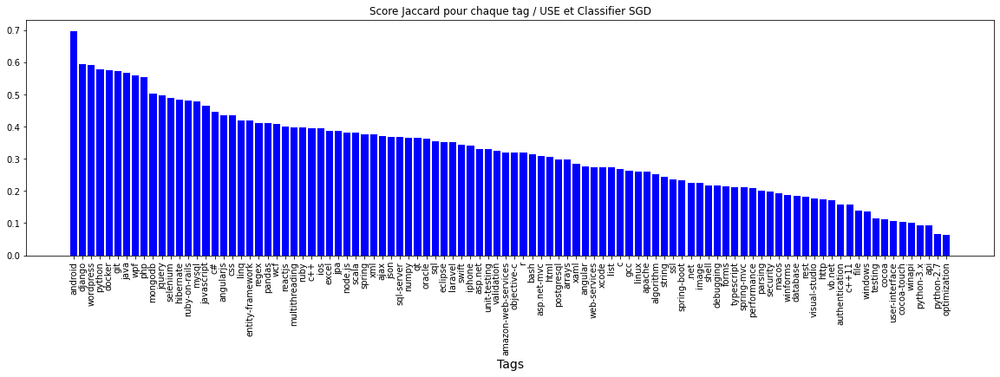

In [171]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / USE et Classifier SGD')
plt.show()

In [172]:
# Calcul du score Jaccard micro
jaccard_score(Y_test_s, y_pred_test2, average='micro')

0.3791922786584708

In [173]:
# Calcul du score Jaccard macro
jaccard_score(Y_test_s, y_pred_test2, average='macro')

0.3202875630264201

In [174]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test2, average='weighted')

0.3870405178928369

In [175]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test2.sum()

22464

In [176]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [177]:
# Identification des 5 tags prédits par post
y_pred_test_w = y_pred_test2.copy()
tag_predit_sgdc_use = pd.DataFrame()
for k in range(len(y_pred_test_w)):
    for i in range(5):
        ind = -1
        for j in range(100) :
            if y_pred_test_w[k,j] == 1 :
                ind  = j 
        if ind > -1 : 
            tag_predit_sgdc_use.loc[k,i] = dict_tag[ind]
            y_pred_test_w[k,ind] = 0
        else : 
            tag_predit_sgdc_use.loc[k,i] = ' '

In [178]:
tag_predit_sgdc_use

,0,1,2,3,4
0,java,http,,,
1,postgresql,sql,,,
2,unit-testing,testing,,,
3,c#,,,,
4,python,,,,
...,...,...,...,...,...
14995,macos,objective-c,ios,,
14996,wordpress,database,mysql,php,
14997,sql,linq,c#,.net,
14998,swift,ios,,,


In [179]:
tag_predit_sgdc_use['list_tag'] = ' '
tag_predit_sgdc_use['list_tag'][tag_predit_sgdc_use[0] != ' ' ] = tag_predit_sgdc_use[0]
tag_predit_sgdc_use['list_tag'][tag_predit_sgdc_use[1] != ' ' ] = tag_predit_sgdc_use['list_tag'] + ' ' + tag_predit_sgdc_use[1]
tag_predit_sgdc_use['list_tag'][tag_predit_sgdc_use[2] != ' ' ] = tag_predit_sgdc_use['list_tag'] + ' ' + tag_predit_sgdc_use[2]
tag_predit_sgdc_use['list_tag'][tag_predit_sgdc_use[3] != ' ' ] = tag_predit_sgdc_use['list_tag'] + ' ' + tag_predit_sgdc_use[3]
tag_predit_sgdc_use['list_tag'][tag_predit_sgdc_use[4] != ' ' ] = tag_predit_sgdc_use['list_tag'] + ' ' + tag_predit_sgdc_use[4]
tag_predit_sgdc_use

,0,1,2,3,4,list_tag
0,java,http,,,,java http
1,postgresql,sql,,,,postgresql sql
2,unit-testing,testing,,,,unit-testing testing
3,c#,,,,,c#
4,python,,,,,python
...,...,...,...,...,...,...
14995,macos,objective-c,ios,,,macos objective-c ios
14996,wordpress,database,mysql,php,,wordpress database mysql php
14997,sql,linq,c#,.net,,sql linq c# .net
14998,swift,ios,,,,swift ios


In [180]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_sgdc_use,'export_tag_predit_sgdc_use')

['export_tag_predit_sgdc_use']

In [181]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_sgdc_use['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,c#,1936
1,java,1706
2,javascript,1399
3,python,1186
4,c++,811
...,...,...
95,validation,48
96,cocoa,47
97,ssl,46
98,optimization,45


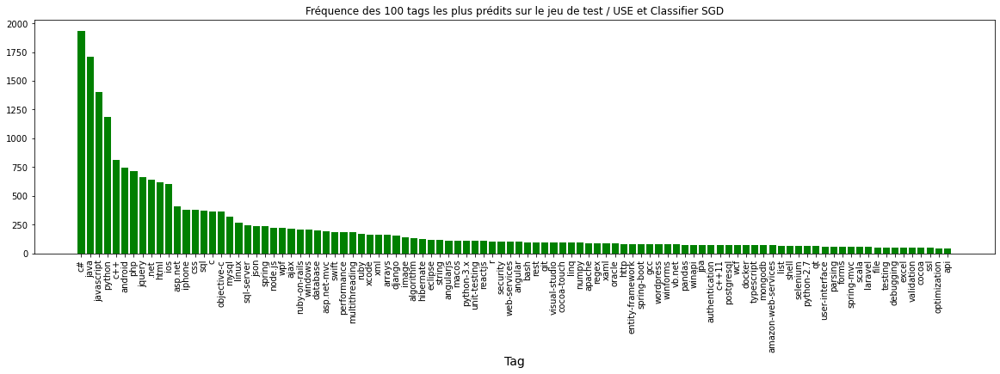

In [182]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / USE et Classifier SGD')
plt.show()

In [183]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_sgdc_use.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({' ': 52619, 'c#': 1936, 'java': 1706, 'javascript': 1399, 'python': 1186, 'c++': 811, 'android': 748, 'php': 714, 'jquery': 660, '.net': 643, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:499: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = Image.ROTATE_90
C:\Users\devra\an

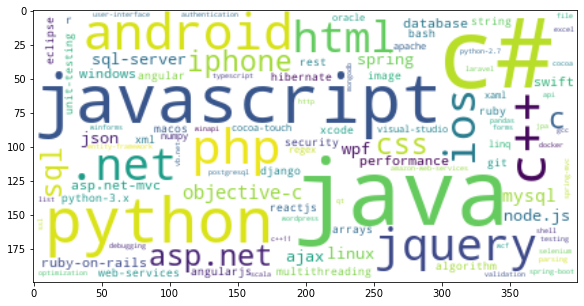

In [184]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [185]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_use.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  14023
nombre de tags non trouvés :  60977
Pourcentage de couverture des tags réels :  18.7 %


In [186]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_sgdc_use.iloc[k,0]) or (tag ==tag_predit_sgdc_use.iloc[k,1]) or (tag ==tag_predit_sgdc_use.iloc[k,2]) or (tag ==tag_predit_sgdc_use.iloc[k,3]) or (tag ==tag_predit_sgdc_use.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  14023
nombre de tags non trouvés :  14670
Pourcentage de couverture des tags réels / 100 plus fréquents :  48.87 %


In [187]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_use.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  8769
nombre de mots non trouvés :  66231
Pourcentage de couverture des mots :  11.69 %


In [188]:
#list_k = random.sample(range(len(tag_predit_sgdc_use)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_sgdc_use.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
c++11 c++
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
java android
-------------------------------------------------
-------------------------------------------------
enregistrement 

In [189]:
#5.2 BERT

In [190]:
# Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)
     
    return features_bert, last_hidden_states_tot

In [191]:
sentences = raw_data_train['Title_body_text'].to_list()
sentences_test = raw_data_test['Title_body_text'].to_list()

In [192]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')

temps traitement :  12010.0


In [193]:
dump(features_bert,'export_features_bert')

['export_features_bert']

In [194]:
features_bert_test, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences_test, 
                                                         max_length, batch_size, mode='TFhub')

temps traitement :  2349.0


In [195]:
dump(features_bert_test,'export_features_bert_test')

['export_features_bert_test']

In [196]:
X_train = features_bert
X_test = features_bert_test

In [197]:
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

In [198]:
Y_train=raw_data_train[['Tags_trf_list','Tags_trf_list_100']].copy()
Y_test=raw_data_test[['Tags_trf_list','Tags_trf_list_100']].copy()

In [199]:
Y_train_s = [dict_tag.doc2bow(text) for text in Y_train['Tags_trf_list_100'].values]
Y_test_s = [dict_tag.doc2bow(text) for text in Y_test['Tags_trf_list_100'].values]

In [200]:
Y_train_s = gensim.matutils.corpus2csc(Y_train_s)
Y_test_s = gensim.matutils.corpus2csc(Y_test_s)

In [201]:
Y_train_s = Y_train_s.T.toarray()
Y_test_s = Y_test_s.T.toarray()

In [202]:
#5.2.1 Régression logistique
clf_bert = OneVsRestClassifier(LogisticRegression(random_state=0,
                                             max_iter=1000,
                                             tol = 1e-5,
                                             verbose=1))

In [203]:
clf_bert.fit(X_train_std, Y_train_s)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.2s finished
[Parallel(n_jobs=1)]: Us

OneVsRestClassifier(estimator=LogisticRegression(max_iter=1000, random_state=0,
                                                 tol=1e-05, verbose=1))

In [204]:
dump(clf_bert,'export_modele_reglog_bert')

['export_modele_reglog_bert']

In [205]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test = clf_bert.predict(X_test_std)

In [206]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test, average=None)
jac_scor

array([0.16568047, 0.33673469, 0.31105398, 0.13602941, 0.22509538,
       0.17777778, 0.14965986, 0.33153929, 0.2962963 , 0.20662461,
       0.41633065, 0.19029851, 0.23564955, 0.25021949, 0.35478261,
       0.26893524, 0.40641711, 0.09302326, 0.28330523, 0.56843157,
       0.36132903, 0.19557196, 0.23529412, 0.42529448, 0.33842239,
       0.09510086, 0.125     , 0.09285714, 0.17777778, 0.11442786,
       0.60227273, 0.46320346, 0.08823529, 0.25925926, 0.28193833,
       0.19594595, 0.26100629, 0.28595041, 0.46590909, 0.15846995,
       0.205     , 0.09289617, 0.25      , 0.22807018, 0.17933723,
       0.29310345, 0.14450867, 0.0997151 , 0.1827957 , 0.4295302 ,
       0.44581006, 0.33234421, 0.2       , 0.26461538, 0.18699187,
       0.03846154, 0.17197452, 0.10869565, 0.37748344, 0.22247706,
       0.53153153, 0.40993789, 0.09589041, 0.22545455, 0.13135593,
       0.39370079, 0.31629393, 0.4155496 , 0.34848485, 0.24657534,
       0.40807175, 0.25773196, 0.35714286, 0.30582524, 0.28260

In [207]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.165680
1,javascript,0.336735
2,node.js,0.311054
3,.net,0.136029
4,c#,0.225095


In [208]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

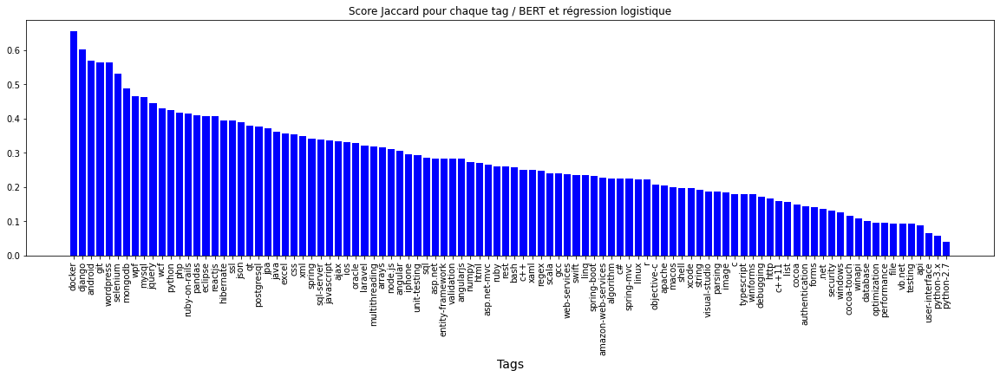

In [209]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / BERT et régression logistique')
plt.show()

In [210]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test, average='weighted')

0.2998704204653466

In [211]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test.sum()

18768

In [212]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [213]:
# L'utilisation du predict ne permet pas de predire 5 tags par post
# --> Utilisation de predict_proba, pour récupération des 5 tags ayant la plus forte probabilité
y_pred_test_proba = clf_bert.predict_proba(X_test_std)

In [214]:
# Identification des 5 tags prédits par post
y_pred_test_proba_w = y_pred_test_proba.copy()
tag_predit_bert=pd.DataFrame()
for k in range(len(y_pred_test_proba_w)):
    for i in range(5):
        val_max = 0
        ind = -1
        for j in range(100) :
            if y_pred_test_proba_w[k,j] > val_max :
                val_max = y_pred_test_proba_w[k,j]
                ind  = j 
        if ind > -1 : 
            tag_predit_bert.loc[k,i] = dict_tag[ind]
            y_pred_test_proba_w[k,ind] = 0
tag_predit_bert['list_tag'] = tag_predit_bert[0] + ' ' + tag_predit_bert[1] + ' ' + tag_predit_bert[2] + ' ' + tag_predit_bert[3] + ' ' + tag_predit_bert[4]

In [215]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_bert,'export_tag_predit_bert')

['export_tag_predit_bert']

In [216]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_bert['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,c#,7112
1,java,5822
2,javascript,4959
3,python,3405
4,.net,3386
...,...,...
95,jpa,157
96,wordpress,154
97,excel,153
98,selenium,141


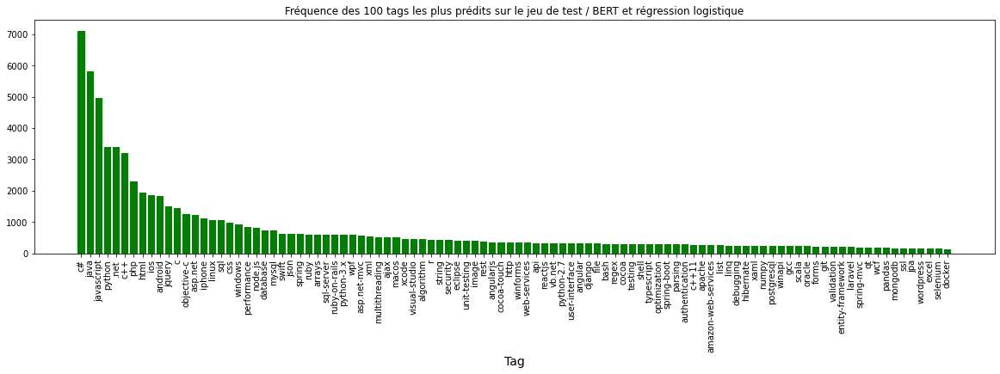

In [217]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / BERT et régression logistique')
plt.show()

In [218]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_bert.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({'c#': 7112, 'java': 5822, 'javascript': 4959, 'python': 3405, '.net': 3386, 'c++': 3200, 'php': 2283, 'html': 1936, 'ios': 1844, 'android': 1837, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=trans

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

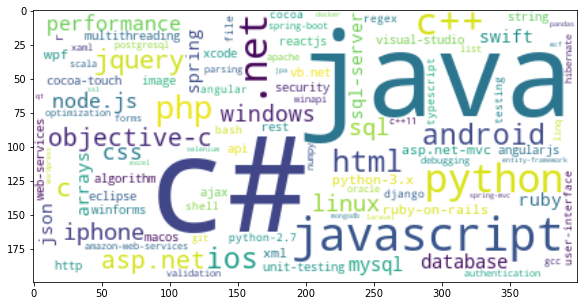

In [219]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [220]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_bert.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  19694
nombre de tags non trouvés :  55306
Pourcentage de couverture des tags réels :  26.26 %


In [221]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_bert.iloc[k,0]) or (tag ==tag_predit_bert.iloc[k,1]) or (tag ==tag_predit_bert.iloc[k,2]) or (tag ==tag_predit_bert.iloc[k,3]) or (tag ==tag_predit_bert.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  19694
nombre de tags non trouvés :  8999
Pourcentage de couverture des tags réels / 100 plus fréquents :  68.64 %


In [222]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_bert.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  13319
nombre de mots non trouvés :  61681
Pourcentage de couverture des mots :  17.76 %


In [223]:
#list_k = random.sample(range(len(tag_predit_bert)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_bert.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
c++ c# python arrays java
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android java c# jquery mysql
-------------------------------------------------
---------------------------------

In [224]:
#5.2.2 SGDClassifier
clf2_bert = OneVsRestClassifier(SGDClassifier(random_state=0,
                                             max_iter=2000,
                                             verbose=1))

In [225]:
clf2_bert.fit(X_train_std, Y_train_s)

-- Epoch 1
Norm: 168.04, NNZs: 768, Bias: -1837.236279, T: 35000, Avg. loss: 18.895490
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 170.01, NNZs: 768, Bias: -1805.633883, T: 70000, Avg. loss: 6.299260
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 174.23, NNZs: 768, Bias: -1786.985859, T: 105000, Avg. loss: 5.847018
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 161.43, NNZs: 768, Bias: -1774.972196, T: 140000, Avg. loss: 5.679423
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 165.71, NNZs: 768, Bias: -1764.463580, T: 175000, Avg. loss: 5.650652
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 165.96, NNZs: 768, Bias: -1756.116259, T: 210000, Avg. loss: 5.528938
Total training time: 0.22 seconds.
-- Epoch 7
Norm: 166.56, NNZs: 768, Bias: -1749.006996, T: 245000, Avg. loss: 5.470668
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 163.70, NNZs: 768, Bias: -1743.177620, T: 280000, Avg. loss: 5.404045
Total training time: 0.30 seconds.
-- Epoch 9
Norm: 164.43, 

Norm: 159.45, NNZs: 768, Bias: -1644.209647, T: 2485000, Avg. loss: 4.924517
Total training time: 2.84 seconds.
-- Epoch 72
Norm: 159.93, NNZs: 768, Bias: -1643.531067, T: 2520000, Avg. loss: 4.923968
Total training time: 2.89 seconds.
-- Epoch 73
Norm: 159.50, NNZs: 768, Bias: -1642.947844, T: 2555000, Avg. loss: 4.919466
Total training time: 2.93 seconds.
-- Epoch 74
Norm: 159.44, NNZs: 768, Bias: -1642.337679, T: 2590000, Avg. loss: 4.917770
Total training time: 2.97 seconds.
-- Epoch 75
Norm: 159.38, NNZs: 768, Bias: -1641.735587, T: 2625000, Avg. loss: 4.917136
Total training time: 3.01 seconds.
-- Epoch 76
Norm: 159.29, NNZs: 768, Bias: -1641.145431, T: 2660000, Avg. loss: 4.915291
Total training time: 3.04 seconds.
-- Epoch 77
Norm: 159.35, NNZs: 768, Bias: -1640.548075, T: 2695000, Avg. loss: 4.913575
Total training time: 3.08 seconds.
-- Epoch 78
Norm: 159.52, NNZs: 768, Bias: -1639.947617, T: 2730000, Avg. loss: 4.911491
Total training time: 3.12 seconds.
-- Epoch 79
Norm: 15

-- Epoch 138
Norm: 157.59, NNZs: 768, Bias: -1614.366909, T: 4830000, Avg. loss: 4.813420
Total training time: 6.82 seconds.
-- Epoch 139
Norm: 157.57, NNZs: 768, Bias: -1614.043069, T: 4865000, Avg. loss: 4.813727
Total training time: 6.93 seconds.
-- Epoch 140
Norm: 157.60, NNZs: 768, Bias: -1613.717422, T: 4900000, Avg. loss: 4.811974
Total training time: 7.03 seconds.
-- Epoch 141
Norm: 157.69, NNZs: 768, Bias: -1613.388136, T: 4935000, Avg. loss: 4.811669
Total training time: 7.12 seconds.
-- Epoch 142
Norm: 157.46, NNZs: 768, Bias: -1613.091300, T: 4970000, Avg. loss: 4.808017
Total training time: 7.21 seconds.
-- Epoch 143
Norm: 157.55, NNZs: 768, Bias: -1612.766523, T: 5005000, Avg. loss: 4.808604
Total training time: 7.29 seconds.
-- Epoch 144
Norm: 157.61, NNZs: 768, Bias: -1612.446075, T: 5040000, Avg. loss: 4.807961
Total training time: 7.37 seconds.
-- Epoch 145
Norm: 157.62, NNZs: 768, Bias: -1612.133794, T: 5075000, Avg. loss: 4.805206
Total training time: 7.46 seconds.


-- Epoch 3
Norm: 214.51, NNZs: 768, Bias: -365.631202, T: 105000, Avg. loss: 18.435960
Total training time: 0.16 seconds.
-- Epoch 4
Norm: 179.41, NNZs: 768, Bias: -264.131239, T: 140000, Avg. loss: 12.666329
Total training time: 0.21 seconds.
-- Epoch 5
Norm: 150.91, NNZs: 768, Bias: -192.166667, T: 175000, Avg. loss: 9.055388
Total training time: 0.26 seconds.
-- Epoch 6
Norm: 127.58, NNZs: 768, Bias: -139.339055, T: 210000, Avg. loss: 6.601227
Total training time: 0.30 seconds.
-- Epoch 7
Norm: 106.49, NNZs: 768, Bias: -101.608753, T: 245000, Avg. loss: 4.880455
Total training time: 0.36 seconds.
-- Epoch 8
Norm: 88.48, NNZs: 768, Bias: -74.236285, T: 280000, Avg. loss: 3.663638
Total training time: 0.41 seconds.
-- Epoch 9
Norm: 72.98, NNZs: 768, Bias: -55.409496, T: 315000, Avg. loss: 2.815149
Total training time: 0.45 seconds.
-- Epoch 10
Norm: 60.20, NNZs: 768, Bias: -41.786987, T: 350000, Avg. loss: 2.283985
Total training time: 0.49 seconds.
-- Epoch 11
Norm: 49.47, NNZs: 768,

Norm: 6.02, NNZs: 768, Bias: -4.705948, T: 2625000, Avg. loss: 0.358206
Total training time: 3.28 seconds.
-- Epoch 76
Norm: 5.97, NNZs: 768, Bias: -4.660379, T: 2660000, Avg. loss: 0.356320
Total training time: 3.32 seconds.
-- Epoch 77
Norm: 5.99, NNZs: 768, Bias: -4.555825, T: 2695000, Avg. loss: 0.352694
Total training time: 3.37 seconds.
-- Epoch 78
Norm: 5.92, NNZs: 768, Bias: -4.632360, T: 2730000, Avg. loss: 0.353220
Total training time: 3.41 seconds.
-- Epoch 79
Norm: 5.85, NNZs: 768, Bias: -4.584876, T: 2765000, Avg. loss: 0.347789
Total training time: 3.45 seconds.
-- Epoch 80
Norm: 5.78, NNZs: 768, Bias: -4.552235, T: 2800000, Avg. loss: 0.350799
Total training time: 3.49 seconds.
-- Epoch 81
Norm: 5.72, NNZs: 768, Bias: -4.421285, T: 2835000, Avg. loss: 0.348818
Total training time: 3.53 seconds.
-- Epoch 82
Norm: 5.68, NNZs: 768, Bias: -4.375785, T: 2870000, Avg. loss: 0.340954
Total training time: 3.58 seconds.
-- Epoch 83
Norm: 5.67, NNZs: 768, Bias: -4.272955, T: 29050

Norm: 236.44, NNZs: 768, Bias: -1325.024260, T: 945000, Avg. loss: 10.269278
Total training time: 1.05 seconds.
-- Epoch 28
Norm: 235.96, NNZs: 768, Bias: -1320.800304, T: 980000, Avg. loss: 10.220363
Total training time: 1.09 seconds.
-- Epoch 29
Norm: 235.08, NNZs: 768, Bias: -1316.801820, T: 1015000, Avg. loss: 10.171051
Total training time: 1.13 seconds.
-- Epoch 30
Norm: 235.10, NNZs: 768, Bias: -1312.782556, T: 1050000, Avg. loss: 10.136811
Total training time: 1.17 seconds.
-- Epoch 31
Norm: 234.91, NNZs: 768, Bias: -1308.934024, T: 1085000, Avg. loss: 10.096155
Total training time: 1.21 seconds.
-- Epoch 32
Norm: 233.89, NNZs: 768, Bias: -1305.360177, T: 1120000, Avg. loss: 10.056562
Total training time: 1.24 seconds.
-- Epoch 33
Norm: 233.56, NNZs: 768, Bias: -1301.784862, T: 1155000, Avg. loss: 10.028205
Total training time: 1.28 seconds.
-- Epoch 34
Norm: 233.20, NNZs: 768, Bias: -1298.324237, T: 1190000, Avg. loss: 9.997486
Total training time: 1.32 seconds.
-- Epoch 35
Nor

Norm: 219.67, NNZs: 768, Bias: -1177.085479, T: 3430000, Avg. loss: 8.839003
Total training time: 3.76 seconds.
-- Epoch 99
Norm: 219.44, NNZs: 768, Bias: -1175.954367, T: 3465000, Avg. loss: 8.826846
Total training time: 3.80 seconds.
-- Epoch 100
Norm: 219.32, NNZs: 768, Bias: -1174.814657, T: 3500000, Avg. loss: 8.818447
Total training time: 3.84 seconds.
-- Epoch 101
Norm: 219.13, NNZs: 768, Bias: -1173.700806, T: 3535000, Avg. loss: 8.809237
Total training time: 3.87 seconds.
-- Epoch 102
Norm: 219.15, NNZs: 768, Bias: -1172.558342, T: 3570000, Avg. loss: 8.799252
Total training time: 3.91 seconds.
-- Epoch 103
Norm: 218.94, NNZs: 768, Bias: -1171.471487, T: 3605000, Avg. loss: 8.786552
Total training time: 3.95 seconds.
-- Epoch 104
Norm: 218.98, NNZs: 768, Bias: -1170.348467, T: 3640000, Avg. loss: 8.778465
Total training time: 3.99 seconds.
-- Epoch 105
Norm: 218.58, NNZs: 768, Bias: -1169.317717, T: 3675000, Avg. loss: 8.765287
Total training time: 4.03 seconds.
-- Epoch 106
N

-- Epoch 164
Norm: 212.63, NNZs: 768, Bias: -1119.197766, T: 5740000, Avg. loss: 8.314676
Total training time: 7.30 seconds.
-- Epoch 165
Norm: 212.59, NNZs: 768, Bias: -1118.511799, T: 5775000, Avg. loss: 8.308608
Total training time: 7.34 seconds.
-- Epoch 166
Norm: 212.47, NNZs: 768, Bias: -1117.842068, T: 5810000, Avg. loss: 8.301907
Total training time: 7.39 seconds.
-- Epoch 167
Norm: 212.43, NNZs: 768, Bias: -1117.164308, T: 5845000, Avg. loss: 8.295469
Total training time: 7.43 seconds.
-- Epoch 168
Norm: 212.38, NNZs: 768, Bias: -1116.490690, T: 5880000, Avg. loss: 8.290559
Total training time: 7.47 seconds.
-- Epoch 169
Norm: 212.25, NNZs: 768, Bias: -1115.837974, T: 5915000, Avg. loss: 8.284359
Total training time: 7.51 seconds.
-- Epoch 170
Norm: 212.23, NNZs: 768, Bias: -1115.167339, T: 5950000, Avg. loss: 8.279203
Total training time: 7.55 seconds.
-- Epoch 171
Norm: 212.13, NNZs: 768, Bias: -1114.515673, T: 5985000, Avg. loss: 8.273015
Total training time: 7.59 seconds.


-- Epoch 230
Norm: 208.18, NNZs: 768, Bias: -1081.518991, T: 8050000, Avg. loss: 7.975654
Total training time: 9.87 seconds.
-- Epoch 231
Norm: 208.11, NNZs: 768, Bias: -1081.040570, T: 8085000, Avg. loss: 7.971808
Total training time: 9.91 seconds.
-- Epoch 232
Norm: 208.04, NNZs: 768, Bias: -1080.564273, T: 8120000, Avg. loss: 7.967804
Total training time: 9.95 seconds.
-- Epoch 233
Norm: 207.99, NNZs: 768, Bias: -1080.085115, T: 8155000, Avg. loss: 7.964375
Total training time: 9.98 seconds.
-- Epoch 234
Norm: 207.91, NNZs: 768, Bias: -1079.615319, T: 8190000, Avg. loss: 7.959306
Total training time: 10.02 seconds.
-- Epoch 235
Norm: 207.88, NNZs: 768, Bias: -1079.137768, T: 8225000, Avg. loss: 7.954939
Total training time: 10.06 seconds.
-- Epoch 236
Norm: 207.78, NNZs: 768, Bias: -1078.674358, T: 8260000, Avg. loss: 7.950299
Total training time: 10.09 seconds.
-- Epoch 237
Norm: 207.75, NNZs: 768, Bias: -1078.200854, T: 8295000, Avg. loss: 7.946000
Total training time: 10.13 secon

Norm: 204.79, NNZs: 768, Bias: -1053.243035, T: 10395000, Avg. loss: 7.723846
Total training time: 12.41 seconds.
-- Epoch 298
Norm: 204.73, NNZs: 768, Bias: -1052.874259, T: 10430000, Avg. loss: 7.720446
Total training time: 12.45 seconds.
-- Epoch 299
Norm: 204.65, NNZs: 768, Bias: -1052.512459, T: 10465000, Avg. loss: 7.716872
Total training time: 12.49 seconds.
-- Epoch 300
Norm: 204.65, NNZs: 768, Bias: -1052.135695, T: 10500000, Avg. loss: 7.714690
Total training time: 12.53 seconds.
-- Epoch 301
Norm: 204.60, NNZs: 768, Bias: -1051.769704, T: 10535000, Avg. loss: 7.711381
Total training time: 12.56 seconds.
-- Epoch 302
Norm: 204.53, NNZs: 768, Bias: -1051.408670, T: 10570000, Avg. loss: 7.707386
Total training time: 12.60 seconds.
-- Epoch 303
Norm: 204.53, NNZs: 768, Bias: -1051.035623, T: 10605000, Avg. loss: 7.704411
Total training time: 12.64 seconds.
-- Epoch 304
Norm: 204.49, NNZs: 768, Bias: -1050.673230, T: 10640000, Avg. loss: 7.700407
Total training time: 12.67 second

Norm: 202.05, NNZs: 768, Bias: -1031.182822, T: 12705000, Avg. loss: 7.528478
Total training time: 14.87 seconds.
-- Epoch 364
Norm: 202.03, NNZs: 768, Bias: -1030.877874, T: 12740000, Avg. loss: 7.526349
Total training time: 14.91 seconds.
-- Epoch 365
Norm: 202.03, NNZs: 768, Bias: -1030.570635, T: 12775000, Avg. loss: 7.523892
Total training time: 14.94 seconds.
-- Epoch 366
Norm: 201.96, NNZs: 768, Bias: -1030.277522, T: 12810000, Avg. loss: 7.520545
Total training time: 14.98 seconds.
-- Epoch 367
Norm: 201.92, NNZs: 768, Bias: -1029.977382, T: 12845000, Avg. loss: 7.518004
Total training time: 15.02 seconds.
-- Epoch 368
Norm: 201.89, NNZs: 768, Bias: -1029.677319, T: 12880000, Avg. loss: 7.515985
Total training time: 15.05 seconds.
-- Epoch 369
Norm: 201.87, NNZs: 768, Bias: -1029.378081, T: 12915000, Avg. loss: 7.513558
Total training time: 15.09 seconds.
-- Epoch 370
Norm: 201.84, NNZs: 768, Bias: -1029.079653, T: 12950000, Avg. loss: 7.510544
Total training time: 15.13 second

-- Epoch 428
Norm: 199.81, NNZs: 768, Bias: -1013.155790, T: 14980000, Avg. loss: 7.370939
Total training time: 17.29 seconds.
-- Epoch 429
Norm: 199.79, NNZs: 768, Bias: -1012.899086, T: 15015000, Avg. loss: 7.368968
Total training time: 17.33 seconds.
-- Epoch 430
Norm: 199.78, NNZs: 768, Bias: -1012.640323, T: 15050000, Avg. loss: 7.366737
Total training time: 17.37 seconds.
-- Epoch 431
Norm: 199.72, NNZs: 768, Bias: -1012.393438, T: 15085000, Avg. loss: 7.363956
Total training time: 17.40 seconds.
-- Epoch 432
Norm: 199.68, NNZs: 768, Bias: -1012.140498, T: 15120000, Avg. loss: 7.362080
Total training time: 17.44 seconds.
-- Epoch 433
Norm: 199.71, NNZs: 768, Bias: -1011.877610, T: 15155000, Avg. loss: 7.360460
Total training time: 17.49 seconds.
-- Epoch 434
Norm: 199.64, NNZs: 768, Bias: -1011.632454, T: 15190000, Avg. loss: 7.357458
Total training time: 17.52 seconds.
-- Epoch 435
Norm: 199.61, NNZs: 768, Bias: -1011.381940, T: 15225000, Avg. loss: 7.355886
Total training time:

Norm: 197.90, NNZs: 768, Bias: -997.739945, T: 17255000, Avg. loss: 7.236407
Total training time: 19.80 seconds.
-- Epoch 494
Norm: 197.87, NNZs: 768, Bias: -997.519955, T: 17290000, Avg. loss: 7.235086
Total training time: 19.83 seconds.
-- Epoch 495
Norm: 197.83, NNZs: 768, Bias: -997.303847, T: 17325000, Avg. loss: 7.232170
Total training time: 19.86 seconds.
-- Epoch 496
Norm: 197.82, NNZs: 768, Bias: -997.078971, T: 17360000, Avg. loss: 7.230908
Total training time: 19.90 seconds.
-- Epoch 497
Norm: 197.77, NNZs: 768, Bias: -996.864915, T: 17395000, Avg. loss: 7.229037
Total training time: 19.94 seconds.
-- Epoch 498
Norm: 197.77, NNZs: 768, Bias: -996.640373, T: 17430000, Avg. loss: 7.227304
Total training time: 19.97 seconds.
-- Epoch 499
Norm: 197.74, NNZs: 768, Bias: -996.423741, T: 17465000, Avg. loss: 7.225544
Total training time: 20.01 seconds.
-- Epoch 500
Norm: 197.70, NNZs: 768, Bias: -996.209242, T: 17500000, Avg. loss: 7.222951
Total training time: 20.05 seconds.
-- Ep

Norm: 196.12, NNZs: 768, Bias: -983.906442, T: 19600000, Avg. loss: 7.116669
Total training time: 23.11 seconds.
-- Epoch 561
Norm: 196.15, NNZs: 768, Bias: -983.701547, T: 19635000, Avg. loss: 7.115502
Total training time: 23.15 seconds.
-- Epoch 562
Norm: 196.09, NNZs: 768, Bias: -983.515324, T: 19670000, Avg. loss: 7.113402
Total training time: 23.19 seconds.
-- Epoch 563
Norm: 196.05, NNZs: 768, Bias: -983.325351, T: 19705000, Avg. loss: 7.111554
Total training time: 23.24 seconds.
-- Epoch 564
Norm: 196.04, NNZs: 768, Bias: -983.131665, T: 19740000, Avg. loss: 7.110071
Total training time: 23.28 seconds.
-- Epoch 565
Norm: 196.04, NNZs: 768, Bias: -982.933775, T: 19775000, Avg. loss: 7.108351
Total training time: 23.33 seconds.
-- Epoch 566
Norm: 196.02, NNZs: 768, Bias: -982.741804, T: 19810000, Avg. loss: 7.106913
Total training time: 23.37 seconds.
-- Epoch 567
Norm: 195.98, NNZs: 768, Bias: -982.552684, T: 19845000, Avg. loss: 7.105205
Total training time: 23.41 seconds.
-- Ep

-- Epoch 631
Norm: 194.50, NNZs: 768, Bias: -970.978918, T: 22085000, Avg. loss: 7.005026
Total training time: 25.92 seconds.
-- Epoch 632
Norm: 194.47, NNZs: 768, Bias: -970.809714, T: 22120000, Avg. loss: 7.003712
Total training time: 25.96 seconds.
-- Epoch 633
Norm: 194.44, NNZs: 768, Bias: -970.639875, T: 22155000, Avg. loss: 7.002470
Total training time: 26.00 seconds.
-- Epoch 634
Norm: 194.43, NNZs: 768, Bias: -970.466693, T: 22190000, Avg. loss: 7.000993
Total training time: 26.03 seconds.
-- Epoch 635
Norm: 194.39, NNZs: 768, Bias: -970.300538, T: 22225000, Avg. loss: 6.999209
Total training time: 26.07 seconds.
-- Epoch 636
Norm: 194.40, NNZs: 768, Bias: -970.125201, T: 22260000, Avg. loss: 6.998167
Total training time: 26.11 seconds.
-- Epoch 637
Norm: 194.36, NNZs: 768, Bias: -969.958668, T: 22295000, Avg. loss: 6.996350
Total training time: 26.16 seconds.
-- Epoch 638
Norm: 194.33, NNZs: 768, Bias: -969.790598, T: 22330000, Avg. loss: 6.994912
Total training time: 26.19 s

Norm: 193.13, NNZs: 768, Bias: -960.240514, T: 24395000, Avg. loss: 6.912822
Total training time: 28.45 seconds.
-- Epoch 698
Norm: 193.09, NNZs: 768, Bias: -960.090591, T: 24430000, Avg. loss: 6.911220
Total training time: 28.49 seconds.
-- Epoch 699
Norm: 193.09, NNZs: 768, Bias: -959.932702, T: 24465000, Avg. loss: 6.910135
Total training time: 28.53 seconds.
-- Epoch 700
Norm: 193.09, NNZs: 768, Bias: -959.774643, T: 24500000, Avg. loss: 6.908982
Total training time: 28.56 seconds.
-- Epoch 701
Norm: 193.07, NNZs: 768, Bias: -959.620481, T: 24535000, Avg. loss: 6.907176
Total training time: 28.59 seconds.
-- Epoch 702
Norm: 193.05, NNZs: 768, Bias: -959.467755, T: 24570000, Avg. loss: 6.905893
Total training time: 28.63 seconds.
-- Epoch 703
Norm: 193.03, NNZs: 768, Bias: -959.314440, T: 24605000, Avg. loss: 6.905013
Total training time: 28.66 seconds.
-- Epoch 704
Norm: 192.99, NNZs: 768, Bias: -959.164988, T: 24640000, Avg. loss: 6.903108
Total training time: 28.70 seconds.
-- Ep

Norm: 191.90, NNZs: 768, Bias: -950.495968, T: 26705000, Avg. loss: 6.828750
Total training time: 30.83 seconds.
-- Epoch 764
Norm: 191.88, NNZs: 768, Bias: -950.356392, T: 26740000, Avg. loss: 6.827491
Total training time: 30.88 seconds.
-- Epoch 765
Norm: 191.85, NNZs: 768, Bias: -950.217001, T: 26775000, Avg. loss: 6.826465
Total training time: 30.92 seconds.
-- Epoch 766
Norm: 191.84, NNZs: 768, Bias: -950.075919, T: 26810000, Avg. loss: 6.825013
Total training time: 30.96 seconds.
-- Epoch 767
Norm: 191.81, NNZs: 768, Bias: -949.938376, T: 26845000, Avg. loss: 6.823864
Total training time: 31.00 seconds.
-- Epoch 768
Norm: 191.81, NNZs: 768, Bias: -949.793943, T: 26880000, Avg. loss: 6.822729
Total training time: 31.04 seconds.
-- Epoch 769
Norm: 191.78, NNZs: 768, Bias: -949.656017, T: 26915000, Avg. loss: 6.821362
Total training time: 31.08 seconds.
-- Epoch 770
Norm: 191.78, NNZs: 768, Bias: -949.513443, T: 26950000, Avg. loss: 6.820134
Total training time: 31.12 seconds.
-- Ep

Norm: 190.71, NNZs: 768, Bias: -941.327699, T: 29085000, Avg. loss: 6.749992
Total training time: 33.41 seconds.
-- Epoch 832
Norm: 190.70, NNZs: 768, Bias: -941.197478, T: 29120000, Avg. loss: 6.749094
Total training time: 33.45 seconds.
-- Epoch 833
Norm: 190.69, NNZs: 768, Bias: -941.068439, T: 29155000, Avg. loss: 6.747896
Total training time: 33.48 seconds.
-- Epoch 834
Norm: 190.67, NNZs: 768, Bias: -940.939900, T: 29190000, Avg. loss: 6.746751
Total training time: 33.52 seconds.
-- Epoch 835
Norm: 190.65, NNZs: 768, Bias: -940.812545, T: 29225000, Avg. loss: 6.745819
Total training time: 33.56 seconds.
-- Epoch 836
Norm: 190.63, NNZs: 768, Bias: -940.684998, T: 29260000, Avg. loss: 6.744705
Total training time: 33.60 seconds.
-- Epoch 837
Norm: 190.63, NNZs: 768, Bias: -940.553160, T: 29295000, Avg. loss: 6.743309
Total training time: 33.63 seconds.
-- Epoch 838
Norm: 190.60, NNZs: 768, Bias: -940.427284, T: 29330000, Avg. loss: 6.742394
Total training time: 33.67 seconds.
-- Ep

Norm: 189.66, NNZs: 768, Bias: -933.014735, T: 31430000, Avg. loss: 6.678770
Total training time: 35.89 seconds.
-- Epoch 899
Norm: 189.66, NNZs: 768, Bias: -932.892316, T: 31465000, Avg. loss: 6.677737
Total training time: 35.92 seconds.
-- Epoch 900
Norm: 189.63, NNZs: 768, Bias: -932.775746, T: 31500000, Avg. loss: 6.676501
Total training time: 35.96 seconds.
-- Epoch 901
Norm: 189.61, NNZs: 768, Bias: -932.658352, T: 31535000, Avg. loss: 6.675367
Total training time: 36.00 seconds.
-- Epoch 902
Norm: 189.61, NNZs: 768, Bias: -932.535703, T: 31570000, Avg. loss: 6.674621
Total training time: 36.04 seconds.
-- Epoch 903
Norm: 189.59, NNZs: 768, Bias: -932.418573, T: 31605000, Avg. loss: 6.673422
Total training time: 36.08 seconds.
-- Epoch 904
Norm: 189.58, NNZs: 768, Bias: -932.299044, T: 31640000, Avg. loss: 6.672503
Total training time: 36.11 seconds.
-- Epoch 905
Norm: 189.56, NNZs: 768, Bias: -932.181855, T: 31675000, Avg. loss: 6.671427
Total training time: 36.15 seconds.
-- Ep

-- Epoch 968
Norm: 188.66, NNZs: 768, Bias: -924.977839, T: 33880000, Avg. loss: 6.609384
Total training time: 39.17 seconds.
-- Epoch 969
Norm: 188.63, NNZs: 768, Bias: -924.871050, T: 33915000, Avg. loss: 6.608681
Total training time: 39.22 seconds.
-- Epoch 970
Norm: 188.61, NNZs: 768, Bias: -924.762309, T: 33950000, Avg. loss: 6.607859
Total training time: 39.25 seconds.
-- Epoch 971
Norm: 188.60, NNZs: 768, Bias: -924.651322, T: 33985000, Avg. loss: 6.606862
Total training time: 39.29 seconds.
-- Epoch 972
Norm: 188.58, NNZs: 768, Bias: -924.541037, T: 34020000, Avg. loss: 6.605807
Total training time: 39.33 seconds.
-- Epoch 973
Norm: 188.58, NNZs: 768, Bias: -924.428519, T: 34055000, Avg. loss: 6.604808
Total training time: 39.37 seconds.
-- Epoch 974
Norm: 188.56, NNZs: 768, Bias: -924.320811, T: 34090000, Avg. loss: 6.603962
Total training time: 39.42 seconds.
-- Epoch 975
Norm: 188.54, NNZs: 768, Bias: -924.212037, T: 34125000, Avg. loss: 6.602866
Total training time: 39.46 s

Norm: 103.48, NNZs: 768, Bias: -147.874652, T: 1015000, Avg. loss: 3.725924
Total training time: 1.14 seconds.
-- Epoch 30
Norm: 100.26, NNZs: 768, Bias: -140.249659, T: 1050000, Avg. loss: 3.510112
Total training time: 1.19 seconds.
-- Epoch 31
Norm: 97.62, NNZs: 768, Bias: -132.592547, T: 1085000, Avg. loss: 3.331224
Total training time: 1.23 seconds.
-- Epoch 32
Norm: 94.73, NNZs: 768, Bias: -125.562669, T: 1120000, Avg. loss: 3.133114
Total training time: 1.27 seconds.
-- Epoch 33
Norm: 91.95, NNZs: 768, Bias: -118.805001, T: 1155000, Avg. loss: 2.969398
Total training time: 1.30 seconds.
-- Epoch 34
Norm: 89.16, NNZs: 768, Bias: -112.447772, T: 1190000, Avg. loss: 2.801902
Total training time: 1.34 seconds.
-- Epoch 35
Norm: 86.66, NNZs: 768, Bias: -106.156850, T: 1225000, Avg. loss: 2.654861
Total training time: 1.38 seconds.
-- Epoch 36
Norm: 83.94, NNZs: 768, Bias: -100.414552, T: 1260000, Avg. loss: 2.498153
Total training time: 1.42 seconds.
-- Epoch 37
Norm: 81.51, NNZs: 768

Norm: 5.17, NNZs: 768, Bias: -4.284077, T: 3535000, Avg. loss: 0.242854
Total training time: 4.07 seconds.
-- Epoch 102
Norm: 5.06, NNZs: 768, Bias: -4.233441, T: 3570000, Avg. loss: 0.242218
Total training time: 4.11 seconds.
-- Epoch 103
Norm: 5.03, NNZs: 768, Bias: -4.160878, T: 3605000, Avg. loss: 0.237780
Total training time: 4.15 seconds.
-- Epoch 104
Norm: 4.92, NNZs: 768, Bias: -4.191248, T: 3640000, Avg. loss: 0.240479
Total training time: 4.18 seconds.
-- Epoch 105
Norm: 4.83, NNZs: 768, Bias: -4.174892, T: 3675000, Avg. loss: 0.239099
Total training time: 4.22 seconds.
-- Epoch 106
Norm: 4.78, NNZs: 768, Bias: -4.123164, T: 3710000, Avg. loss: 0.237125
Total training time: 4.26 seconds.
-- Epoch 107
Norm: 4.74, NNZs: 768, Bias: -4.101575, T: 3745000, Avg. loss: 0.237028
Total training time: 4.30 seconds.
-- Epoch 108
Norm: 4.65, NNZs: 768, Bias: -4.093371, T: 3780000, Avg. loss: 0.235747
Total training time: 4.34 seconds.
-- Epoch 109
Norm: 4.58, NNZs: 768, Bias: -4.014266, 

-- Epoch 35
Norm: 9.86, NNZs: 768, Bias: -6.834952, T: 1225000, Avg. loss: 0.806512
Total training time: 1.51 seconds.
-- Epoch 36
Norm: 9.67, NNZs: 768, Bias: -6.523925, T: 1260000, Avg. loss: 0.789125
Total training time: 1.56 seconds.
-- Epoch 37
Norm: 9.54, NNZs: 768, Bias: -6.502047, T: 1295000, Avg. loss: 0.777710
Total training time: 1.60 seconds.
-- Epoch 38
Norm: 9.36, NNZs: 768, Bias: -6.419167, T: 1330000, Avg. loss: 0.759210
Total training time: 1.64 seconds.
-- Epoch 39
Norm: 9.08, NNZs: 768, Bias: -6.218186, T: 1365000, Avg. loss: 0.748602
Total training time: 1.68 seconds.
-- Epoch 40
Norm: 9.01, NNZs: 768, Bias: -6.197302, T: 1400000, Avg. loss: 0.727907
Total training time: 1.73 seconds.
-- Epoch 41
Norm: 8.82, NNZs: 768, Bias: -6.077486, T: 1435000, Avg. loss: 0.723139
Total training time: 1.78 seconds.
-- Epoch 42
Norm: 8.66, NNZs: 768, Bias: -5.941870, T: 1470000, Avg. loss: 0.711289
Total training time: 1.81 seconds.
-- Epoch 43
Norm: 8.49, NNZs: 768, Bias: -5.6616

Norm: 4.77, NNZs: 768, Bias: -3.460160, T: 3710000, Avg. loss: 0.442024
Total training time: 4.54 seconds.
-- Epoch 107
Norm: 4.74, NNZs: 768, Bias: -3.303948, T: 3745000, Avg. loss: 0.442081
Total training time: 4.59 seconds.
-- Epoch 108
Norm: 4.75, NNZs: 768, Bias: -3.208546, T: 3780000, Avg. loss: 0.439484
Total training time: 4.63 seconds.
-- Epoch 109
Norm: 4.71, NNZs: 768, Bias: -3.339922, T: 3815000, Avg. loss: 0.435675
Total training time: 4.67 seconds.
-- Epoch 110
Norm: 4.67, NNZs: 768, Bias: -3.266512, T: 3850000, Avg. loss: 0.440217
Total training time: 4.71 seconds.
-- Epoch 111
Norm: 4.65, NNZs: 768, Bias: -3.246017, T: 3885000, Avg. loss: 0.435115
Total training time: 4.75 seconds.
-- Epoch 112
Norm: 4.60, NNZs: 768, Bias: -3.258514, T: 3920000, Avg. loss: 0.433248
Total training time: 4.81 seconds.
-- Epoch 113
Norm: 4.61, NNZs: 768, Bias: -3.225469, T: 3955000, Avg. loss: 0.431707
Total training time: 4.85 seconds.
-- Epoch 114
Norm: 4.56, NNZs: 768, Bias: -3.207816, 

-- Epoch 1
Norm: 222.55, NNZs: 768, Bias: -1760.081758, T: 35000, Avg. loss: 21.205809
Total training time: 0.05 seconds.
-- Epoch 2
Norm: 219.69, NNZs: 768, Bias: -1715.211851, T: 70000, Avg. loss: 7.254148
Total training time: 0.09 seconds.
-- Epoch 3
Norm: 224.64, NNZs: 768, Bias: -1688.078326, T: 105000, Avg. loss: 6.786124
Total training time: 0.13 seconds.
-- Epoch 4
Norm: 219.55, NNZs: 768, Bias: -1669.807419, T: 140000, Avg. loss: 6.479643
Total training time: 0.18 seconds.
-- Epoch 5
Norm: 216.28, NNZs: 768, Bias: -1655.698080, T: 175000, Avg. loss: 6.356971
Total training time: 0.22 seconds.
-- Epoch 6
Norm: 218.62, NNZs: 768, Bias: -1643.498966, T: 210000, Avg. loss: 6.263270
Total training time: 0.27 seconds.
-- Epoch 7
Norm: 215.66, NNZs: 768, Bias: -1633.852652, T: 245000, Avg. loss: 6.174138
Total training time: 0.31 seconds.
-- Epoch 8
Norm: 216.12, NNZs: 768, Bias: -1625.105606, T: 280000, Avg. loss: 6.132653
Total training time: 0.35 seconds.
-- Epoch 9
Norm: 214.84, 

-- Epoch 71
Norm: 203.72, NNZs: 768, Bias: -1486.208184, T: 2485000, Avg. loss: 5.334937
Total training time: 2.69 seconds.
-- Epoch 72
Norm: 203.73, NNZs: 768, Bias: -1485.317878, T: 2520000, Avg. loss: 5.331477
Total training time: 2.73 seconds.
-- Epoch 73
Norm: 203.57, NNZs: 768, Bias: -1484.463326, T: 2555000, Avg. loss: 5.326128
Total training time: 2.77 seconds.
-- Epoch 74
Norm: 203.61, NNZs: 768, Bias: -1483.593066, T: 2590000, Avg. loss: 5.321069
Total training time: 2.80 seconds.
-- Epoch 75
Norm: 203.29, NNZs: 768, Bias: -1482.784216, T: 2625000, Avg. loss: 5.318065
Total training time: 2.83 seconds.
-- Epoch 76
Norm: 203.28, NNZs: 768, Bias: -1481.944243, T: 2660000, Avg. loss: 5.314448
Total training time: 2.87 seconds.
-- Epoch 77
Norm: 203.26, NNZs: 768, Bias: -1481.115381, T: 2695000, Avg. loss: 5.309970
Total training time: 2.91 seconds.
-- Epoch 78
Norm: 203.12, NNZs: 768, Bias: -1480.315736, T: 2730000, Avg. loss: 5.307749
Total training time: 2.95 seconds.
-- Epoch

-- Epoch 140
Norm: 199.66, NNZs: 768, Bias: -1443.783411, T: 4900000, Avg. loss: 5.138584
Total training time: 5.32 seconds.
-- Epoch 141
Norm: 199.50, NNZs: 768, Bias: -1443.356416, T: 4935000, Avg. loss: 5.135812
Total training time: 5.36 seconds.
-- Epoch 142
Norm: 199.54, NNZs: 768, Bias: -1442.906282, T: 4970000, Avg. loss: 5.135724
Total training time: 5.41 seconds.
-- Epoch 143
Norm: 199.51, NNZs: 768, Bias: -1442.467345, T: 5005000, Avg. loss: 5.133123
Total training time: 5.44 seconds.
-- Epoch 144
Norm: 199.58, NNZs: 768, Bias: -1442.019549, T: 5040000, Avg. loss: 5.130511
Total training time: 5.48 seconds.
-- Epoch 145
Norm: 199.38, NNZs: 768, Bias: -1441.610359, T: 5075000, Avg. loss: 5.127569
Total training time: 5.52 seconds.
-- Epoch 146
Norm: 199.40, NNZs: 768, Bias: -1441.174529, T: 5110000, Avg. loss: 5.127110
Total training time: 5.56 seconds.
-- Epoch 147
Norm: 199.39, NNZs: 768, Bias: -1440.745674, T: 5145000, Avg. loss: 5.125864
Total training time: 5.59 seconds.


Norm: 197.16, NNZs: 768, Bias: -1418.637720, T: 7350000, Avg. loss: 5.025223
Total training time: 7.86 seconds.
-- Epoch 211
Norm: 197.17, NNZs: 768, Bias: -1418.337814, T: 7385000, Avg. loss: 5.024850
Total training time: 7.90 seconds.
-- Epoch 212
Norm: 197.16, NNZs: 768, Bias: -1418.043345, T: 7420000, Avg. loss: 5.022163
Total training time: 7.94 seconds.
-- Epoch 213
Norm: 197.14, NNZs: 768, Bias: -1417.751650, T: 7455000, Avg. loss: 5.021214
Total training time: 7.97 seconds.
-- Epoch 214
Norm: 197.11, NNZs: 768, Bias: -1417.461308, T: 7490000, Avg. loss: 5.019743
Total training time: 8.01 seconds.
-- Epoch 215
Norm: 197.08, NNZs: 768, Bias: -1417.173664, T: 7525000, Avg. loss: 5.018936
Total training time: 8.04 seconds.
-- Epoch 216
Norm: 197.02, NNZs: 768, Bias: -1416.891338, T: 7560000, Avg. loss: 5.017947
Total training time: 8.08 seconds.
-- Epoch 217
Norm: 197.00, NNZs: 768, Bias: -1416.603666, T: 7595000, Avg. loss: 5.016335
Total training time: 8.12 seconds.
-- Epoch 218


Norm: 195.53, NNZs: 768, Bias: -1401.531552, T: 9695000, Avg. loss: 4.948679
Total training time: 10.58 seconds.
-- Epoch 278
Norm: 195.53, NNZs: 768, Bias: -1401.307126, T: 9730000, Avg. loss: 4.947974
Total training time: 10.62 seconds.
-- Epoch 279
Norm: 195.51, NNZs: 768, Bias: -1401.085541, T: 9765000, Avg. loss: 4.946591
Total training time: 10.66 seconds.
-- Epoch 280
Norm: 195.45, NNZs: 768, Bias: -1400.870855, T: 9800000, Avg. loss: 4.945031
Total training time: 10.71 seconds.
-- Epoch 281
Norm: 195.46, NNZs: 768, Bias: -1400.646795, T: 9835000, Avg. loss: 4.945323
Total training time: 10.75 seconds.
-- Epoch 282
Norm: 195.46, NNZs: 768, Bias: -1400.424568, T: 9870000, Avg. loss: 4.944298
Total training time: 10.80 seconds.
-- Epoch 283
Norm: 195.42, NNZs: 768, Bias: -1400.209167, T: 9905000, Avg. loss: 4.942657
Total training time: 10.84 seconds.
-- Epoch 284
Norm: 195.41, NNZs: 768, Bias: -1399.989484, T: 9940000, Avg. loss: 4.942129
Total training time: 10.88 seconds.
-- Ep

-- Epoch 12
Norm: 206.86, NNZs: 768, Bias: -1695.841783, T: 420000, Avg. loss: 5.755354
Total training time: 0.45 seconds.
-- Epoch 13
Norm: 206.03, NNZs: 768, Bias: -1691.286528, T: 455000, Avg. loss: 5.725088
Total training time: 0.48 seconds.
-- Epoch 14
Norm: 205.99, NNZs: 768, Bias: -1686.979992, T: 490000, Avg. loss: 5.696186
Total training time: 0.52 seconds.
-- Epoch 15
Norm: 206.11, NNZs: 768, Bias: -1682.949024, T: 525000, Avg. loss: 5.666530
Total training time: 0.55 seconds.
-- Epoch 16
Norm: 205.49, NNZs: 768, Bias: -1679.266396, T: 560000, Avg. loss: 5.638482
Total training time: 0.59 seconds.
-- Epoch 17
Norm: 204.94, NNZs: 768, Bias: -1675.811270, T: 595000, Avg. loss: 5.624886
Total training time: 0.62 seconds.
-- Epoch 18
Norm: 205.49, NNZs: 768, Bias: -1672.426885, T: 630000, Avg. loss: 5.615008
Total training time: 0.66 seconds.
-- Epoch 19
Norm: 204.75, NNZs: 768, Bias: -1669.369170, T: 665000, Avg. loss: 5.575992
Total training time: 0.70 seconds.
-- Epoch 20
Norm

-- Epoch 81
Norm: 198.19, NNZs: 768, Bias: -1586.464724, T: 2835000, Avg. loss: 5.198700
Total training time: 3.76 seconds.
-- Epoch 82
Norm: 197.89, NNZs: 768, Bias: -1585.798682, T: 2870000, Avg. loss: 5.194019
Total training time: 3.80 seconds.
-- Epoch 83
Norm: 197.87, NNZs: 768, Bias: -1585.106086, T: 2905000, Avg. loss: 5.192922
Total training time: 3.83 seconds.
-- Epoch 84
Norm: 197.88, NNZs: 768, Bias: -1584.418749, T: 2940000, Avg. loss: 5.192501
Total training time: 3.87 seconds.
-- Epoch 85
Norm: 197.83, NNZs: 768, Bias: -1583.746259, T: 2975000, Avg. loss: 5.187895
Total training time: 3.91 seconds.
-- Epoch 86
Norm: 197.71, NNZs: 768, Bias: -1583.091197, T: 3010000, Avg. loss: 5.182271
Total training time: 3.95 seconds.
-- Epoch 87
Norm: 197.69, NNZs: 768, Bias: -1582.430874, T: 3045000, Avg. loss: 5.182281
Total training time: 3.99 seconds.
-- Epoch 88
Norm: 197.65, NNZs: 768, Bias: -1581.781427, T: 3080000, Avg. loss: 5.180474
Total training time: 4.03 seconds.
-- Epoch

Norm: 194.94, NNZs: 768, Bias: -1551.651957, T: 5250000, Avg. loss: 5.051841
Total training time: 6.43 seconds.
-- Epoch 151
Norm: 195.04, NNZs: 768, Bias: -1551.261029, T: 5285000, Avg. loss: 5.053795
Total training time: 6.47 seconds.
-- Epoch 152
Norm: 194.94, NNZs: 768, Bias: -1550.897063, T: 5320000, Avg. loss: 5.049334
Total training time: 6.50 seconds.
-- Epoch 153
Norm: 194.92, NNZs: 768, Bias: -1550.526080, T: 5355000, Avg. loss: 5.048426
Total training time: 6.53 seconds.
-- Epoch 154
Norm: 194.96, NNZs: 768, Bias: -1550.150214, T: 5390000, Avg. loss: 5.047575
Total training time: 6.56 seconds.
-- Epoch 155
Norm: 194.90, NNZs: 768, Bias: -1549.789717, T: 5425000, Avg. loss: 5.044809
Total training time: 6.60 seconds.
-- Epoch 156
Norm: 194.88, NNZs: 768, Bias: -1549.426044, T: 5460000, Avg. loss: 5.044985
Total training time: 6.63 seconds.
-- Epoch 157
Norm: 194.78, NNZs: 768, Bias: -1549.073730, T: 5495000, Avg. loss: 5.042386
Total training time: 6.66 seconds.
-- Epoch 158


-- Epoch 218
Norm: 193.23, NNZs: 768, Bias: -1530.609061, T: 7630000, Avg. loss: 4.967124
Total training time: 8.90 seconds.
-- Epoch 219
Norm: 193.17, NNZs: 768, Bias: -1530.356744, T: 7665000, Avg. loss: 4.966116
Total training time: 8.95 seconds.
-- Epoch 220
Norm: 193.18, NNZs: 768, Bias: -1530.097725, T: 7700000, Avg. loss: 4.964689
Total training time: 8.98 seconds.
-- Epoch 221
Norm: 193.17, NNZs: 768, Bias: -1529.841188, T: 7735000, Avg. loss: 4.963517
Total training time: 9.01 seconds.
-- Epoch 222
Norm: 193.13, NNZs: 768, Bias: -1529.589677, T: 7770000, Avg. loss: 4.962350
Total training time: 9.05 seconds.
-- Epoch 223
Norm: 193.12, NNZs: 768, Bias: -1529.336744, T: 7805000, Avg. loss: 4.961936
Total training time: 9.08 seconds.
-- Epoch 224
Norm: 193.09, NNZs: 768, Bias: -1529.086223, T: 7840000, Avg. loss: 4.960647
Total training time: 9.12 seconds.
-- Epoch 225
Norm: 193.04, NNZs: 768, Bias: -1528.840595, T: 7875000, Avg. loss: 4.959177
Total training time: 9.16 seconds.


-- Epoch 14
Norm: 237.71, NNZs: 768, Bias: -1030.803623, T: 490000, Avg. loss: 14.987428
Total training time: 0.49 seconds.
-- Epoch 15
Norm: 236.61, NNZs: 768, Bias: -1017.631085, T: 525000, Avg. loss: 14.752870
Total training time: 0.53 seconds.
-- Epoch 16
Norm: 234.13, NNZs: 768, Bias: -1005.670871, T: 560000, Avg. loss: 14.520995
Total training time: 0.56 seconds.
-- Epoch 17
Norm: 233.25, NNZs: 768, Bias: -994.108377, T: 595000, Avg. loss: 14.326385
Total training time: 0.59 seconds.
-- Epoch 18
Norm: 231.70, NNZs: 768, Bias: -983.390090, T: 630000, Avg. loss: 14.146473
Total training time: 0.63 seconds.
-- Epoch 19
Norm: 230.63, NNZs: 768, Bias: -973.159406, T: 665000, Avg. loss: 13.949135
Total training time: 0.66 seconds.
-- Epoch 20
Norm: 229.02, NNZs: 768, Bias: -963.625074, T: 700000, Avg. loss: 13.776162
Total training time: 0.70 seconds.
-- Epoch 21
Norm: 228.16, NNZs: 768, Bias: -954.406919, T: 735000, Avg. loss: 13.605172
Total training time: 0.73 seconds.
-- Epoch 22
N

Total training time: 3.13 seconds.
-- Epoch 83
Norm: 192.39, NNZs: 768, Bias: -703.704804, T: 2905000, Avg. loss: 9.415690
Total training time: 3.18 seconds.
-- Epoch 84
Norm: 192.07, NNZs: 768, Bias: -701.580811, T: 2940000, Avg. loss: 9.384181
Total training time: 3.22 seconds.
-- Epoch 85
Norm: 191.81, NNZs: 768, Bias: -699.467990, T: 2975000, Avg. loss: 9.351404
Total training time: 3.26 seconds.
-- Epoch 86
Norm: 191.53, NNZs: 768, Bias: -697.386367, T: 3010000, Avg. loss: 9.317852
Total training time: 3.30 seconds.
-- Epoch 87
Norm: 191.30, NNZs: 768, Bias: -695.316424, T: 3045000, Avg. loss: 9.285703
Total training time: 3.34 seconds.
-- Epoch 88
Norm: 191.13, NNZs: 768, Bias: -693.257460, T: 3080000, Avg. loss: 9.251532
Total training time: 3.38 seconds.
-- Epoch 89
Norm: 190.82, NNZs: 768, Bias: -691.260338, T: 3115000, Avg. loss: 9.220553
Total training time: 3.41 seconds.
-- Epoch 90
Norm: 190.33, NNZs: 768, Bias: -689.336113, T: 3150000, Avg. loss: 9.188546
Total training t

Norm: 175.59, NNZs: 768, Bias: -599.227267, T: 5285000, Avg. loss: 7.800717
Total training time: 5.79 seconds.
-- Epoch 152
Norm: 175.46, NNZs: 768, Bias: -598.077062, T: 5320000, Avg. loss: 7.785349
Total training time: 5.83 seconds.
-- Epoch 153
Norm: 175.18, NNZs: 768, Bias: -596.977388, T: 5355000, Avg. loss: 7.767703
Total training time: 5.87 seconds.
-- Epoch 154
Norm: 175.06, NNZs: 768, Bias: -595.838453, T: 5390000, Avg. loss: 7.750204
Total training time: 5.90 seconds.
-- Epoch 155
Norm: 174.87, NNZs: 768, Bias: -594.729315, T: 5425000, Avg. loss: 7.733056
Total training time: 5.94 seconds.
-- Epoch 156
Norm: 174.68, NNZs: 768, Bias: -593.628816, T: 5460000, Avg. loss: 7.717249
Total training time: 5.97 seconds.
-- Epoch 157
Norm: 174.49, NNZs: 768, Bias: -592.533556, T: 5495000, Avg. loss: 7.700150
Total training time: 6.00 seconds.
-- Epoch 158
Norm: 174.35, NNZs: 768, Bias: -591.432645, T: 5530000, Avg. loss: 7.684073
Total training time: 6.04 seconds.
-- Epoch 159
Norm: 17

Norm: 164.79, NNZs: 768, Bias: -534.399854, T: 7735000, Avg. loss: 6.824980
Total training time: 9.04 seconds.
-- Epoch 222
Norm: 164.66, NNZs: 768, Bias: -533.640148, T: 7770000, Avg. loss: 6.813592
Total training time: 9.08 seconds.
-- Epoch 223
Norm: 164.57, NNZs: 768, Bias: -532.871152, T: 7805000, Avg. loss: 6.801815
Total training time: 9.12 seconds.
-- Epoch 224
Norm: 164.38, NNZs: 768, Bias: -532.137465, T: 7840000, Avg. loss: 6.792734
Total training time: 9.16 seconds.
-- Epoch 225
Norm: 164.25, NNZs: 768, Bias: -531.389227, T: 7875000, Avg. loss: 6.780199
Total training time: 9.20 seconds.
-- Epoch 226
Norm: 164.09, NNZs: 768, Bias: -530.653136, T: 7910000, Avg. loss: 6.769906
Total training time: 9.23 seconds.
-- Epoch 227
Norm: 164.06, NNZs: 768, Bias: -529.879968, T: 7945000, Avg. loss: 6.757927
Total training time: 9.27 seconds.
-- Epoch 228
Norm: 163.91, NNZs: 768, Bias: -529.150429, T: 7980000, Avg. loss: 6.746669
Total training time: 9.31 seconds.
-- Epoch 229
Norm: 16

Norm: 156.98, NNZs: 768, Bias: -489.021318, T: 10150000, Avg. loss: 6.153920
Total training time: 11.69 seconds.
-- Epoch 291
Norm: 156.86, NNZs: 768, Bias: -488.458784, T: 10185000, Avg. loss: 6.144762
Total training time: 11.73 seconds.
-- Epoch 292
Norm: 156.77, NNZs: 768, Bias: -487.887389, T: 10220000, Avg. loss: 6.137202
Total training time: 11.76 seconds.
-- Epoch 293
Norm: 156.67, NNZs: 768, Bias: -487.320881, T: 10255000, Avg. loss: 6.128664
Total training time: 11.80 seconds.
-- Epoch 294
Norm: 156.58, NNZs: 768, Bias: -486.755317, T: 10290000, Avg. loss: 6.119518
Total training time: 11.84 seconds.
-- Epoch 295
Norm: 156.43, NNZs: 768, Bias: -486.210095, T: 10325000, Avg. loss: 6.110889
Total training time: 11.87 seconds.
-- Epoch 296
Norm: 156.34, NNZs: 768, Bias: -485.646426, T: 10360000, Avg. loss: 6.102396
Total training time: 11.91 seconds.
-- Epoch 297
Norm: 156.30, NNZs: 768, Bias: -485.071184, T: 10395000, Avg. loss: 6.095325
Total training time: 11.95 seconds.
-- Ep

-- Epoch 356
Norm: 151.01, NNZs: 768, Bias: -455.289787, T: 12460000, Avg. loss: 5.660705
Total training time: 14.24 seconds.
-- Epoch 357
Norm: 150.91, NNZs: 768, Bias: -454.837828, T: 12495000, Avg. loss: 5.653381
Total training time: 14.28 seconds.
-- Epoch 358
Norm: 150.78, NNZs: 768, Bias: -454.399890, T: 12530000, Avg. loss: 5.647458
Total training time: 14.32 seconds.
-- Epoch 359
Norm: 150.72, NNZs: 768, Bias: -453.936101, T: 12565000, Avg. loss: 5.641241
Total training time: 14.36 seconds.
-- Epoch 360
Norm: 150.64, NNZs: 768, Bias: -453.480735, T: 12600000, Avg. loss: 5.634297
Total training time: 14.39 seconds.
-- Epoch 361
Norm: 150.59, NNZs: 768, Bias: -453.018729, T: 12635000, Avg. loss: 5.627200
Total training time: 14.43 seconds.
-- Epoch 362
Norm: 150.50, NNZs: 768, Bias: -452.569879, T: 12670000, Avg. loss: 5.621455
Total training time: 14.47 seconds.
-- Epoch 363
Norm: 150.42, NNZs: 768, Bias: -452.119882, T: 12705000, Avg. loss: 5.613685
Total training time: 14.51 s

Norm: 145.77, NNZs: 768, Bias: -427.348497, T: 14805000, Avg. loss: 5.257591
Total training time: 16.77 seconds.
-- Epoch 424
Norm: 145.73, NNZs: 768, Bias: -426.958552, T: 14840000, Avg. loss: 5.252438
Total training time: 16.81 seconds.
-- Epoch 425
Norm: 145.66, NNZs: 768, Bias: -426.578971, T: 14875000, Avg. loss: 5.246972
Total training time: 16.84 seconds.
-- Epoch 426
Norm: 145.59, NNZs: 768, Bias: -426.198284, T: 14910000, Avg. loss: 5.241649
Total training time: 16.89 seconds.
-- Epoch 427
Norm: 145.54, NNZs: 768, Bias: -425.816488, T: 14945000, Avg. loss: 5.236104
Total training time: 16.92 seconds.
-- Epoch 428
Norm: 145.43, NNZs: 768, Bias: -425.450938, T: 14980000, Avg. loss: 5.231054
Total training time: 16.96 seconds.
-- Epoch 429
Norm: 145.39, NNZs: 768, Bias: -425.066909, T: 15015000, Avg. loss: 5.225221
Total training time: 16.99 seconds.
-- Epoch 430
Norm: 145.30, NNZs: 768, Bias: -424.699064, T: 15050000, Avg. loss: 5.219820
Total training time: 17.04 seconds.
-- Ep

Norm: 141.05, NNZs: 768, Bias: -402.497593, T: 17290000, Avg. loss: 4.903400
Total training time: 19.37 seconds.
-- Epoch 495
Norm: 141.03, NNZs: 768, Bias: -402.160759, T: 17325000, Avg. loss: 4.899201
Total training time: 19.41 seconds.
-- Epoch 496
Norm: 140.95, NNZs: 768, Bias: -401.844792, T: 17360000, Avg. loss: 4.894456
Total training time: 19.44 seconds.
-- Epoch 497
Norm: 140.88, NNZs: 768, Bias: -401.529444, T: 17395000, Avg. loss: 4.889850
Total training time: 19.48 seconds.
-- Epoch 498
Norm: 140.83, NNZs: 768, Bias: -401.203816, T: 17430000, Avg. loss: 4.885929
Total training time: 19.52 seconds.
-- Epoch 499
Norm: 140.77, NNZs: 768, Bias: -400.886285, T: 17465000, Avg. loss: 4.880738
Total training time: 19.55 seconds.
-- Epoch 500
Norm: 140.72, NNZs: 768, Bias: -400.561979, T: 17500000, Avg. loss: 4.875824
Total training time: 19.59 seconds.
-- Epoch 501
Norm: 140.64, NNZs: 768, Bias: -400.252016, T: 17535000, Avg. loss: 4.871738
Total training time: 19.62 seconds.
-- Ep

Norm: 137.17, NNZs: 768, Bias: -382.343886, T: 19635000, Avg. loss: 4.619081
Total training time: 21.91 seconds.
-- Epoch 562
Norm: 137.13, NNZs: 768, Bias: -382.059455, T: 19670000, Avg. loss: 4.615182
Total training time: 21.95 seconds.
-- Epoch 563
Norm: 137.09, NNZs: 768, Bias: -381.774019, T: 19705000, Avg. loss: 4.611123
Total training time: 21.99 seconds.
-- Epoch 564
Norm: 137.02, NNZs: 768, Bias: -381.498201, T: 19740000, Avg. loss: 4.607284
Total training time: 22.03 seconds.
-- Epoch 565
Norm: 136.95, NNZs: 768, Bias: -381.226409, T: 19775000, Avg. loss: 4.602707
Total training time: 22.07 seconds.
-- Epoch 566
Norm: 136.93, NNZs: 768, Bias: -380.933379, T: 19810000, Avg. loss: 4.599445
Total training time: 22.11 seconds.
-- Epoch 567
Norm: 136.86, NNZs: 768, Bias: -380.662568, T: 19845000, Avg. loss: 4.595515
Total training time: 22.16 seconds.
-- Epoch 568
Norm: 136.80, NNZs: 768, Bias: -380.387182, T: 19880000, Avg. loss: 4.591468
Total training time: 22.20 seconds.
-- Ep

-- Epoch 630
Norm: 133.62, NNZs: 768, Bias: -364.139852, T: 22050000, Avg. loss: 4.363768
Total training time: 25.26 seconds.
-- Epoch 631
Norm: 133.56, NNZs: 768, Bias: -363.897413, T: 22085000, Avg. loss: 4.359347
Total training time: 25.30 seconds.
-- Epoch 632
Norm: 133.52, NNZs: 768, Bias: -363.647671, T: 22120000, Avg. loss: 4.356749
Total training time: 25.34 seconds.
-- Epoch 633
Norm: 133.49, NNZs: 768, Bias: -363.392454, T: 22155000, Avg. loss: 4.353213
Total training time: 25.38 seconds.
-- Epoch 634
Norm: 133.43, NNZs: 768, Bias: -363.150273, T: 22190000, Avg. loss: 4.349757
Total training time: 25.42 seconds.
-- Epoch 635
Norm: 133.39, NNZs: 768, Bias: -362.902614, T: 22225000, Avg. loss: 4.346136
Total training time: 25.46 seconds.
-- Epoch 636
Norm: 133.32, NNZs: 768, Bias: -362.662986, T: 22260000, Avg. loss: 4.342972
Total training time: 25.49 seconds.
-- Epoch 637
Norm: 133.31, NNZs: 768, Bias: -362.406686, T: 22295000, Avg. loss: 4.339491
Total training time: 25.53 s

-- Epoch 696
Norm: 130.51, NNZs: 768, Bias: -348.666706, T: 24360000, Avg. loss: 4.148752
Total training time: 27.85 seconds.
-- Epoch 697
Norm: 130.46, NNZs: 768, Bias: -348.446431, T: 24395000, Avg. loss: 4.145781
Total training time: 27.89 seconds.
-- Epoch 698
Norm: 130.41, NNZs: 768, Bias: -348.226874, T: 24430000, Avg. loss: 4.142627
Total training time: 27.93 seconds.
-- Epoch 699
Norm: 130.36, NNZs: 768, Bias: -348.007636, T: 24465000, Avg. loss: 4.139261
Total training time: 27.97 seconds.
-- Epoch 700
Norm: 130.31, NNZs: 768, Bias: -347.787077, T: 24500000, Avg. loss: 4.136268
Total training time: 28.00 seconds.
-- Epoch 701
Norm: 130.26, NNZs: 768, Bias: -347.566838, T: 24535000, Avg. loss: 4.133553
Total training time: 28.04 seconds.
-- Epoch 702
Norm: 130.22, NNZs: 768, Bias: -347.345281, T: 24570000, Avg. loss: 4.130469
Total training time: 28.08 seconds.
-- Epoch 703
Norm: 130.18, NNZs: 768, Bias: -347.122815, T: 24605000, Avg. loss: 4.127027
Total training time: 28.11 s

Norm: 127.55, NNZs: 768, Bias: -334.541973, T: 26705000, Avg. loss: 3.953846
Total training time: 30.33 seconds.
-- Epoch 764
Norm: 127.51, NNZs: 768, Bias: -334.341018, T: 26740000, Avg. loss: 3.951505
Total training time: 30.37 seconds.
-- Epoch 765
Norm: 127.47, NNZs: 768, Bias: -334.137710, T: 26775000, Avg. loss: 3.948760
Total training time: 30.41 seconds.
-- Epoch 766
Norm: 127.45, NNZs: 768, Bias: -333.928335, T: 26810000, Avg. loss: 3.945409
Total training time: 30.45 seconds.
-- Epoch 767
Norm: 127.40, NNZs: 768, Bias: -333.734886, T: 26845000, Avg. loss: 3.943426
Total training time: 30.50 seconds.
-- Epoch 768
Norm: 127.37, NNZs: 768, Bias: -333.530887, T: 26880000, Avg. loss: 3.940050
Total training time: 30.54 seconds.
-- Epoch 769
Norm: 127.30, NNZs: 768, Bias: -333.339796, T: 26915000, Avg. loss: 3.937706
Total training time: 30.57 seconds.
-- Epoch 770
Norm: 127.27, NNZs: 768, Bias: -333.139672, T: 26950000, Avg. loss: 3.934863
Total training time: 30.61 seconds.
-- Ep

Norm: 124.68, NNZs: 768, Bias: -321.177766, T: 29155000, Avg. loss: 3.772470
Total training time: 33.06 seconds.
-- Epoch 834
Norm: 124.64, NNZs: 768, Bias: -320.995066, T: 29190000, Avg. loss: 3.769978
Total training time: 33.10 seconds.
-- Epoch 835
Norm: 124.60, NNZs: 768, Bias: -320.815323, T: 29225000, Avg. loss: 3.767699
Total training time: 33.14 seconds.
-- Epoch 836
Norm: 124.57, NNZs: 768, Bias: -320.627929, T: 29260000, Avg. loss: 3.765051
Total training time: 33.18 seconds.
-- Epoch 837
Norm: 124.52, NNZs: 768, Bias: -320.450666, T: 29295000, Avg. loss: 3.762641
Total training time: 33.22 seconds.
-- Epoch 838
Norm: 124.48, NNZs: 768, Bias: -320.270205, T: 29330000, Avg. loss: 3.760226
Total training time: 33.26 seconds.
-- Epoch 839
Norm: 124.45, NNZs: 768, Bias: -320.088593, T: 29365000, Avg. loss: 3.757642
Total training time: 33.29 seconds.
-- Epoch 840
Norm: 124.41, NNZs: 768, Bias: -319.908220, T: 29400000, Avg. loss: 3.755128
Total training time: 33.33 seconds.
-- Ep

-- Epoch 903
Norm: 122.03, NNZs: 768, Bias: -308.993454, T: 31605000, Avg. loss: 3.607483
Total training time: 35.70 seconds.
-- Epoch 904
Norm: 121.99, NNZs: 768, Bias: -308.829965, T: 31640000, Avg. loss: 3.605070
Total training time: 35.73 seconds.
-- Epoch 905
Norm: 121.97, NNZs: 768, Bias: -308.656867, T: 31675000, Avg. loss: 3.603005
Total training time: 35.77 seconds.
-- Epoch 906
Norm: 121.93, NNZs: 768, Bias: -308.493426, T: 31710000, Avg. loss: 3.601075
Total training time: 35.81 seconds.
-- Epoch 907
Norm: 121.90, NNZs: 768, Bias: -308.325442, T: 31745000, Avg. loss: 3.598708
Total training time: 35.84 seconds.
-- Epoch 908
Norm: 121.86, NNZs: 768, Bias: -308.158583, T: 31780000, Avg. loss: 3.596004
Total training time: 35.88 seconds.
-- Epoch 909
Norm: 121.82, NNZs: 768, Bias: -307.995366, T: 31815000, Avg. loss: 3.593994
Total training time: 35.91 seconds.
-- Epoch 910
Norm: 121.79, NNZs: 768, Bias: -307.829816, T: 31850000, Avg. loss: 3.591658
Total training time: 35.95 s

Norm: 119.66, NNZs: 768, Bias: -298.107471, T: 33985000, Avg. loss: 3.461237
Total training time: 38.27 seconds.
-- Epoch 972
Norm: 119.61, NNZs: 768, Bias: -297.961011, T: 34020000, Avg. loss: 3.458646
Total training time: 38.32 seconds.
-- Epoch 973
Norm: 119.60, NNZs: 768, Bias: -297.799719, T: 34055000, Avg. loss: 3.457135
Total training time: 38.36 seconds.
-- Epoch 974
Norm: 119.55, NNZs: 768, Bias: -297.649743, T: 34090000, Avg. loss: 3.454861
Total training time: 38.41 seconds.
-- Epoch 975
Norm: 119.52, NNZs: 768, Bias: -297.495823, T: 34125000, Avg. loss: 3.452835
Total training time: 38.46 seconds.
-- Epoch 976
Norm: 119.49, NNZs: 768, Bias: -297.341765, T: 34160000, Avg. loss: 3.450882
Total training time: 38.51 seconds.
-- Epoch 977
Norm: 119.45, NNZs: 768, Bias: -297.191382, T: 34195000, Avg. loss: 3.448909
Total training time: 38.57 seconds.
-- Epoch 978
Norm: 119.40, NNZs: 768, Bias: -297.043778, T: 34230000, Avg. loss: 3.446751
Total training time: 38.62 seconds.
-- Ep

Norm: 117.50, NNZs: 768, Bias: -288.321832, T: 36295000, Avg. loss: 3.330341
Total training time: 41.66 seconds.
-- Epoch 1038
Norm: 117.45, NNZs: 768, Bias: -288.184691, T: 36330000, Avg. loss: 3.328460
Total training time: 41.72 seconds.
-- Epoch 1039
Norm: 117.43, NNZs: 768, Bias: -288.036677, T: 36365000, Avg. loss: 3.326328
Total training time: 41.76 seconds.
-- Epoch 1040
Norm: 117.38, NNZs: 768, Bias: -287.900351, T: 36400000, Avg. loss: 3.324593
Total training time: 41.80 seconds.
-- Epoch 1041
Norm: 117.36, NNZs: 768, Bias: -287.753999, T: 36435000, Avg. loss: 3.322702
Total training time: 41.85 seconds.
-- Epoch 1042
Norm: 117.32, NNZs: 768, Bias: -287.615462, T: 36470000, Avg. loss: 3.320684
Total training time: 41.90 seconds.
-- Epoch 1043
Norm: 117.29, NNZs: 768, Bias: -287.471854, T: 36505000, Avg. loss: 3.318853
Total training time: 41.94 seconds.
-- Epoch 1044
Norm: 117.26, NNZs: 768, Bias: -287.332216, T: 36540000, Avg. loss: 3.317122
Total training time: 41.99 seconds

-- Epoch 1102
Norm: 115.46, NNZs: 768, Bias: -279.347790, T: 38570000, Avg. loss: 3.210675
Total training time: 45.05 seconds.
-- Epoch 1103
Norm: 115.44, NNZs: 768, Bias: -279.212516, T: 38605000, Avg. loss: 3.209140
Total training time: 45.09 seconds.
-- Epoch 1104
Norm: 115.40, NNZs: 768, Bias: -279.080469, T: 38640000, Avg. loss: 3.207152
Total training time: 45.13 seconds.
-- Epoch 1105
Norm: 115.37, NNZs: 768, Bias: -278.948284, T: 38675000, Avg. loss: 3.205686
Total training time: 45.17 seconds.
-- Epoch 1106
Norm: 115.34, NNZs: 768, Bias: -278.813378, T: 38710000, Avg. loss: 3.203395
Total training time: 45.21 seconds.
-- Epoch 1107
Norm: 115.32, NNZs: 768, Bias: -278.679889, T: 38745000, Avg. loss: 3.202123
Total training time: 45.25 seconds.
-- Epoch 1108
Norm: 115.28, NNZs: 768, Bias: -278.550901, T: 38780000, Avg. loss: 3.200027
Total training time: 45.29 seconds.
-- Epoch 1109
Norm: 115.26, NNZs: 768, Bias: -278.413267, T: 38815000, Avg. loss: 3.198457
Total training time:

Norm: 113.49, NNZs: 768, Bias: -270.554134, T: 40950000, Avg. loss: 3.093889
Total training time: 48.39 seconds.
-- Epoch 1171
Norm: 113.46, NNZs: 768, Bias: -270.429891, T: 40985000, Avg. loss: 3.092574
Total training time: 48.44 seconds.
-- Epoch 1172
Norm: 113.44, NNZs: 768, Bias: -270.302340, T: 41020000, Avg. loss: 3.090767
Total training time: 48.50 seconds.
-- Epoch 1173
Norm: 113.41, NNZs: 768, Bias: -270.178066, T: 41055000, Avg. loss: 3.089155
Total training time: 48.55 seconds.
-- Epoch 1174
Norm: 113.37, NNZs: 768, Bias: -270.056334, T: 41090000, Avg. loss: 3.087527
Total training time: 48.60 seconds.
-- Epoch 1175
Norm: 113.34, NNZs: 768, Bias: -269.931296, T: 41125000, Avg. loss: 3.085903
Total training time: 48.64 seconds.
-- Epoch 1176
Norm: 113.32, NNZs: 768, Bias: -269.803695, T: 41160000, Avg. loss: 3.084316
Total training time: 48.69 seconds.
-- Epoch 1177
Norm: 113.29, NNZs: 768, Bias: -269.681544, T: 41195000, Avg. loss: 3.082672
Total training time: 48.74 seconds

Norm: 111.60, NNZs: 768, Bias: -262.192637, T: 43365000, Avg. loss: 2.983608
Total training time: 51.52 seconds.
-- Epoch 1240
Norm: 111.57, NNZs: 768, Bias: -262.073468, T: 43400000, Avg. loss: 2.982125
Total training time: 51.57 seconds.
-- Epoch 1241
Norm: 111.54, NNZs: 768, Bias: -261.959002, T: 43435000, Avg. loss: 2.980394
Total training time: 51.61 seconds.
-- Epoch 1242
Norm: 111.52, NNZs: 768, Bias: -261.841402, T: 43470000, Avg. loss: 2.978788
Total training time: 51.65 seconds.
-- Epoch 1243
Norm: 111.49, NNZs: 768, Bias: -261.725052, T: 43505000, Avg. loss: 2.977435
Total training time: 51.69 seconds.
-- Epoch 1244
Norm: 111.47, NNZs: 768, Bias: -261.605119, T: 43540000, Avg. loss: 2.975720
Total training time: 51.73 seconds.
-- Epoch 1245
Norm: 111.44, NNZs: 768, Bias: -261.488266, T: 43575000, Avg. loss: 2.974452
Total training time: 51.77 seconds.
-- Epoch 1246
Norm: 111.41, NNZs: 768, Bias: -261.375402, T: 43610000, Avg. loss: 2.972460
Total training time: 51.82 seconds

Norm: 109.81, NNZs: 768, Bias: -254.452807, T: 45745000, Avg. loss: 2.881942
Total training time: 54.54 seconds.
-- Epoch 1308
Norm: 109.80, NNZs: 768, Bias: -254.338305, T: 45780000, Avg. loss: 2.880272
Total training time: 54.61 seconds.
-- Epoch 1309
Norm: 109.77, NNZs: 768, Bias: -254.230224, T: 45815000, Avg. loss: 2.879188
Total training time: 54.68 seconds.
-- Epoch 1310
Norm: 109.74, NNZs: 768, Bias: -254.122222, T: 45850000, Avg. loss: 2.877650
Total training time: 54.75 seconds.
-- Epoch 1311
Norm: 109.71, NNZs: 768, Bias: -254.011470, T: 45885000, Avg. loss: 2.876039
Total training time: 54.81 seconds.
-- Epoch 1312
Norm: 109.69, NNZs: 768, Bias: -253.900803, T: 45920000, Avg. loss: 2.874886
Total training time: 54.87 seconds.
-- Epoch 1313
Norm: 109.67, NNZs: 768, Bias: -253.787829, T: 45955000, Avg. loss: 2.873286
Total training time: 54.93 seconds.
-- Epoch 1314
Norm: 109.64, NNZs: 768, Bias: -253.679726, T: 45990000, Avg. loss: 2.871976
Total training time: 55.00 seconds

Norm: 108.16, NNZs: 768, Bias: -247.361123, T: 48055000, Avg. loss: 2.789244
Total training time: 57.80 seconds.
-- Epoch 1374
Norm: 108.14, NNZs: 768, Bias: -247.257323, T: 48090000, Avg. loss: 2.787796
Total training time: 57.83 seconds.
-- Epoch 1375
Norm: 108.11, NNZs: 768, Bias: -247.153184, T: 48125000, Avg. loss: 2.786573
Total training time: 57.87 seconds.
-- Epoch 1376
Norm: 108.09, NNZs: 768, Bias: -247.048704, T: 48160000, Avg. loss: 2.785097
Total training time: 57.91 seconds.
-- Epoch 1377
Norm: 108.07, NNZs: 768, Bias: -246.942848, T: 48195000, Avg. loss: 2.783895
Total training time: 57.95 seconds.
-- Epoch 1378
Norm: 108.04, NNZs: 768, Bias: -246.837900, T: 48230000, Avg. loss: 2.782369
Total training time: 57.98 seconds.
-- Epoch 1379
Norm: 108.01, NNZs: 768, Bias: -246.739038, T: 48265000, Avg. loss: 2.781225
Total training time: 58.02 seconds.
-- Epoch 1380
Norm: 107.99, NNZs: 768, Bias: -246.633205, T: 48300000, Avg. loss: 2.779862
Total training time: 58.06 seconds

Norm: 106.59, NNZs: 768, Bias: -240.641896, T: 50365000, Avg. loss: 2.701634
Total training time: 60.45 seconds.
-- Epoch 1440
Norm: 106.57, NNZs: 768, Bias: -240.541069, T: 50400000, Avg. loss: 2.700474
Total training time: 60.49 seconds.
-- Epoch 1441
Norm: 106.54, NNZs: 768, Bias: -240.442495, T: 50435000, Avg. loss: 2.699104
Total training time: 60.53 seconds.
-- Epoch 1442
Norm: 106.51, NNZs: 768, Bias: -240.346563, T: 50470000, Avg. loss: 2.697744
Total training time: 60.56 seconds.
-- Epoch 1443
Norm: 106.50, NNZs: 768, Bias: -240.245351, T: 50505000, Avg. loss: 2.696448
Total training time: 60.61 seconds.
-- Epoch 1444
Norm: 106.47, NNZs: 768, Bias: -240.147774, T: 50540000, Avg. loss: 2.695206
Total training time: 60.64 seconds.
-- Epoch 1445
Norm: 106.45, NNZs: 768, Bias: -240.049273, T: 50575000, Avg. loss: 2.693976
Total training time: 60.68 seconds.
-- Epoch 1446
Norm: 106.43, NNZs: 768, Bias: -239.949457, T: 50610000, Avg. loss: 2.692600
Total training time: 60.72 seconds

-- Epoch 1509
Norm: 104.98, NNZs: 768, Bias: -233.890573, T: 52815000, Avg. loss: 2.614172
Total training time: 63.30 seconds.
-- Epoch 1510
Norm: 104.96, NNZs: 768, Bias: -233.795369, T: 52850000, Avg. loss: 2.612943
Total training time: 63.34 seconds.
-- Epoch 1511
Norm: 104.93, NNZs: 768, Bias: -233.702874, T: 52885000, Avg. loss: 2.611730
Total training time: 63.38 seconds.
-- Epoch 1512
Norm: 104.91, NNZs: 768, Bias: -233.607419, T: 52920000, Avg. loss: 2.610497
Total training time: 63.42 seconds.
-- Epoch 1513
Norm: 104.89, NNZs: 768, Bias: -233.515616, T: 52955000, Avg. loss: 2.609269
Total training time: 63.46 seconds.
-- Epoch 1514
Norm: 104.87, NNZs: 768, Bias: -233.419721, T: 52990000, Avg. loss: 2.608044
Total training time: 63.50 seconds.
-- Epoch 1515
Norm: 104.84, NNZs: 768, Bias: -233.331243, T: 53025000, Avg. loss: 2.606800
Total training time: 63.53 seconds.
-- Epoch 1516
Norm: 104.81, NNZs: 768, Bias: -233.238675, T: 53060000, Avg. loss: 2.605618
Total training time:

Norm: 103.47, NNZs: 768, Bias: -227.669318, T: 55195000, Avg. loss: 2.534035
Total training time: 66.06 seconds.
-- Epoch 1578
Norm: 103.44, NNZs: 768, Bias: -227.580751, T: 55230000, Avg. loss: 2.532608
Total training time: 66.10 seconds.
-- Epoch 1579
Norm: 103.43, NNZs: 768, Bias: -227.489525, T: 55265000, Avg. loss: 2.531770
Total training time: 66.13 seconds.
-- Epoch 1580
Norm: 103.40, NNZs: 768, Bias: -227.401974, T: 55300000, Avg. loss: 2.530446
Total training time: 66.17 seconds.
-- Epoch 1581
Norm: 103.38, NNZs: 768, Bias: -227.311046, T: 55335000, Avg. loss: 2.529341
Total training time: 66.21 seconds.
-- Epoch 1582
Norm: 103.36, NNZs: 768, Bias: -227.220900, T: 55370000, Avg. loss: 2.528130
Total training time: 66.25 seconds.
-- Epoch 1583
Norm: 103.33, NNZs: 768, Bias: -227.136225, T: 55405000, Avg. loss: 2.526943
Total training time: 66.29 seconds.
-- Epoch 1584
Norm: 103.32, NNZs: 768, Bias: -227.044929, T: 55440000, Avg. loss: 2.525980
Total training time: 66.32 seconds

-- Epoch 1645
Norm: 102.02, NNZs: 768, Bias: -221.744003, T: 57575000, Avg. loss: 2.457925
Total training time: 68.65 seconds.
-- Epoch 1646
Norm: 101.99, NNZs: 768, Bias: -221.661007, T: 57610000, Avg. loss: 2.456948
Total training time: 68.70 seconds.
-- Epoch 1647
Norm: 101.98, NNZs: 768, Bias: -221.573551, T: 57645000, Avg. loss: 2.455660
Total training time: 68.74 seconds.
-- Epoch 1648
Norm: 101.95, NNZs: 768, Bias: -221.491177, T: 57680000, Avg. loss: 2.454752
Total training time: 68.78 seconds.
-- Epoch 1649
Norm: 101.93, NNZs: 768, Bias: -221.406945, T: 57715000, Avg. loss: 2.453648
Total training time: 68.82 seconds.
-- Epoch 1650
Norm: 101.91, NNZs: 768, Bias: -221.320168, T: 57750000, Avg. loss: 2.452558
Total training time: 68.87 seconds.
-- Epoch 1651
Norm: 101.88, NNZs: 768, Bias: -221.240712, T: 57785000, Avg. loss: 2.451218
Total training time: 68.92 seconds.
-- Epoch 1652
Norm: 101.87, NNZs: 768, Bias: -221.153174, T: 57820000, Avg. loss: 2.450501
Total training time:

Total training time: 72.03 seconds.
-- Epoch 1712
Norm: 100.64, NNZs: 768, Bias: -216.176753, T: 59920000, Avg. loss: 2.386811
Total training time: 72.09 seconds.
-- Epoch 1713
Norm: 100.62, NNZs: 768, Bias: -216.095171, T: 59955000, Avg. loss: 2.386009
Total training time: 72.14 seconds.
-- Epoch 1714
Norm: 100.60, NNZs: 768, Bias: -216.015302, T: 59990000, Avg. loss: 2.384881
Total training time: 72.20 seconds.
-- Epoch 1715
Norm: 100.57, NNZs: 768, Bias: -215.936145, T: 60025000, Avg. loss: 2.383864
Total training time: 72.25 seconds.
-- Epoch 1716
Norm: 100.56, NNZs: 768, Bias: -215.851539, T: 60060000, Avg. loss: 2.382782
Total training time: 72.30 seconds.
-- Epoch 1717
Norm: 100.54, NNZs: 768, Bias: -215.772808, T: 60095000, Avg. loss: 2.381746
Total training time: 72.37 seconds.
-- Epoch 1718
Norm: 100.51, NNZs: 768, Bias: -215.692626, T: 60130000, Avg. loss: 2.380642
Total training time: 72.43 seconds.
-- Epoch 1719
Norm: 100.50, NNZs: 768, Bias: -215.608002, T: 60165000, Avg.

-- Epoch 1782
Norm: 99.26, NNZs: 768, Bias: -210.614235, T: 62370000, Avg. loss: 2.316045
Total training time: 75.02 seconds.
-- Epoch 1783
Norm: 99.24, NNZs: 768, Bias: -210.539540, T: 62405000, Avg. loss: 2.315334
Total training time: 75.06 seconds.
-- Epoch 1784
Norm: 99.22, NNZs: 768, Bias: -210.460724, T: 62440000, Avg. loss: 2.314307
Total training time: 75.11 seconds.
-- Epoch 1785
Norm: 99.20, NNZs: 768, Bias: -210.382912, T: 62475000, Avg. loss: 2.313141
Total training time: 75.15 seconds.
-- Epoch 1786
Norm: 99.18, NNZs: 768, Bias: -210.306583, T: 62510000, Avg. loss: 2.312221
Total training time: 75.20 seconds.
-- Epoch 1787
Norm: 99.16, NNZs: 768, Bias: -210.228858, T: 62545000, Avg. loss: 2.311411
Total training time: 75.24 seconds.
-- Epoch 1788
Norm: 99.14, NNZs: 768, Bias: -210.153893, T: 62580000, Avg. loss: 2.310233
Total training time: 75.28 seconds.
-- Epoch 1789
Norm: 99.12, NNZs: 768, Bias: -210.075455, T: 62615000, Avg. loss: 2.309285
Total training time: 75.31 s

-- Epoch 1848
Norm: 98.01, NNZs: 768, Bias: -205.596602, T: 64680000, Avg. loss: 2.252567
Total training time: 77.50 seconds.
-- Epoch 1849
Norm: 97.99, NNZs: 768, Bias: -205.520093, T: 64715000, Avg. loss: 2.251582
Total training time: 77.54 seconds.
-- Epoch 1850
Norm: 97.97, NNZs: 768, Bias: -205.447797, T: 64750000, Avg. loss: 2.250660
Total training time: 77.58 seconds.
-- Epoch 1851
Norm: 97.96, NNZs: 768, Bias: -205.371061, T: 64785000, Avg. loss: 2.249782
Total training time: 77.61 seconds.
Convergence after 1851 epochs took 77.61 seconds
-- Epoch 1
Norm: 272.55, NNZs: 768, Bias: -1706.051198, T: 35000, Avg. loss: 37.825705
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 257.07, NNZs: 768, Bias: -1616.315789, T: 70000, Avg. loss: 18.323323
Total training time: 0.08 seconds.
-- Epoch 3
Norm: 251.47, NNZs: 768, Bias: -1563.373777, T: 105000, Avg. loss: 16.656127
Total training time: 0.12 seconds.
-- Epoch 4
Norm: 244.30, NNZs: 768, Bias: -1526.064970, T: 140000, Avg. loss: 15

-- Epoch 63
Norm: 204.53, NNZs: 768, Bias: -1169.631145, T: 2205000, Avg. loss: 11.023476
Total training time: 2.39 seconds.
-- Epoch 64
Norm: 203.74, NNZs: 768, Bias: -1167.737431, T: 2240000, Avg. loss: 11.002544
Total training time: 2.43 seconds.
-- Epoch 65
Norm: 204.08, NNZs: 768, Bias: -1165.678843, T: 2275000, Avg. loss: 10.982345
Total training time: 2.48 seconds.
-- Epoch 66
Norm: 203.66, NNZs: 768, Bias: -1163.782987, T: 2310000, Avg. loss: 10.965607
Total training time: 2.52 seconds.
-- Epoch 67
Norm: 203.70, NNZs: 768, Bias: -1161.837556, T: 2345000, Avg. loss: 10.937223
Total training time: 2.56 seconds.
-- Epoch 68
Norm: 203.21, NNZs: 768, Bias: -1160.014284, T: 2380000, Avg. loss: 10.920745
Total training time: 2.60 seconds.
-- Epoch 69
Norm: 202.68, NNZs: 768, Bias: -1158.225593, T: 2415000, Avg. loss: 10.899302
Total training time: 2.64 seconds.
-- Epoch 70
Norm: 202.73, NNZs: 768, Bias: -1156.363623, T: 2450000, Avg. loss: 10.881184
Total training time: 2.69 seconds.


Total training time: 4.89 seconds.
-- Epoch 131
Norm: 193.71, NNZs: 768, Bias: -1077.737959, T: 4585000, Avg. loss: 10.025699
Total training time: 4.93 seconds.
-- Epoch 132
Norm: 193.59, NNZs: 768, Bias: -1076.793091, T: 4620000, Avg. loss: 10.014441
Total training time: 4.97 seconds.
-- Epoch 133
Norm: 193.54, NNZs: 768, Bias: -1075.842366, T: 4655000, Avg. loss: 10.003178
Total training time: 5.01 seconds.
-- Epoch 134
Norm: 193.44, NNZs: 768, Bias: -1074.907320, T: 4690000, Avg. loss: 9.995020
Total training time: 5.05 seconds.
-- Epoch 135
Norm: 193.41, NNZs: 768, Bias: -1073.966649, T: 4725000, Avg. loss: 9.985597
Total training time: 5.09 seconds.
-- Epoch 136
Norm: 193.17, NNZs: 768, Bias: -1073.070702, T: 4760000, Avg. loss: 9.974083
Total training time: 5.13 seconds.
-- Epoch 137
Norm: 193.08, NNZs: 768, Bias: -1072.156216, T: 4795000, Avg. loss: 9.966886
Total training time: 5.16 seconds.
-- Epoch 138
Norm: 192.99, NNZs: 768, Bias: -1071.248245, T: 4830000, Avg. loss: 9.9556

-- Epoch 201
Norm: 187.62, NNZs: 768, Bias: -1024.603615, T: 7035000, Avg. loss: 9.457794
Total training time: 7.57 seconds.
-- Epoch 202
Norm: 187.61, NNZs: 768, Bias: -1023.978343, T: 7070000, Avg. loss: 9.450811
Total training time: 7.61 seconds.
-- Epoch 203
Norm: 187.55, NNZs: 768, Bias: -1023.367520, T: 7105000, Avg. loss: 9.444971
Total training time: 7.66 seconds.
-- Epoch 204
Norm: 187.50, NNZs: 768, Bias: -1022.756912, T: 7140000, Avg. loss: 9.438780
Total training time: 7.70 seconds.
-- Epoch 205
Norm: 187.41, NNZs: 768, Bias: -1022.156302, T: 7175000, Avg. loss: 9.431873
Total training time: 7.74 seconds.
-- Epoch 206
Norm: 187.30, NNZs: 768, Bias: -1021.562716, T: 7210000, Avg. loss: 9.424828
Total training time: 7.77 seconds.
-- Epoch 207
Norm: 187.28, NNZs: 768, Bias: -1020.955380, T: 7245000, Avg. loss: 9.418855
Total training time: 7.81 seconds.
-- Epoch 208
Norm: 187.19, NNZs: 768, Bias: -1020.364763, T: 7280000, Avg. loss: 9.412669
Total training time: 7.84 seconds.


-- Epoch 272
Norm: 183.54, NNZs: 768, Bias: -987.308344, T: 9520000, Avg. loss: 9.060783
Total training time: 11.01 seconds.
-- Epoch 273
Norm: 183.46, NNZs: 768, Bias: -986.861718, T: 9555000, Avg. loss: 9.056066
Total training time: 11.04 seconds.
-- Epoch 274
Norm: 183.37, NNZs: 768, Bias: -986.419873, T: 9590000, Avg. loss: 9.051336
Total training time: 11.08 seconds.
-- Epoch 275
Norm: 183.33, NNZs: 768, Bias: -985.970308, T: 9625000, Avg. loss: 9.047929
Total training time: 11.12 seconds.
-- Epoch 276
Norm: 183.34, NNZs: 768, Bias: -985.515140, T: 9660000, Avg. loss: 9.043275
Total training time: 11.16 seconds.
-- Epoch 277
Norm: 183.29, NNZs: 768, Bias: -985.070851, T: 9695000, Avg. loss: 9.037236
Total training time: 11.20 seconds.
-- Epoch 278
Norm: 183.19, NNZs: 768, Bias: -984.637387, T: 9730000, Avg. loss: 9.032433
Total training time: 11.24 seconds.
-- Epoch 279
Norm: 183.16, NNZs: 768, Bias: -984.192187, T: 9765000, Avg. loss: 9.028942
Total training time: 11.27 seconds.


-- Epoch 339
Norm: 180.54, NNZs: 768, Bias: -960.313541, T: 11865000, Avg. loss: 8.775428
Total training time: 13.61 seconds.
-- Epoch 340
Norm: 180.42, NNZs: 768, Bias: -959.969324, T: 11900000, Avg. loss: 8.771490
Total training time: 13.65 seconds.
-- Epoch 341
Norm: 180.39, NNZs: 768, Bias: -959.608525, T: 11935000, Avg. loss: 8.768334
Total training time: 13.69 seconds.
-- Epoch 342
Norm: 180.38, NNZs: 768, Bias: -959.244589, T: 11970000, Avg. loss: 8.764246
Total training time: 13.72 seconds.
-- Epoch 343
Norm: 180.39, NNZs: 768, Bias: -958.877597, T: 12005000, Avg. loss: 8.761033
Total training time: 13.76 seconds.
-- Epoch 344
Norm: 180.31, NNZs: 768, Bias: -958.530750, T: 12040000, Avg. loss: 8.756115
Total training time: 13.80 seconds.
-- Epoch 345
Norm: 180.31, NNZs: 768, Bias: -958.166692, T: 12075000, Avg. loss: 8.752963
Total training time: 13.83 seconds.
-- Epoch 346
Norm: 180.23, NNZs: 768, Bias: -957.821883, T: 12110000, Avg. loss: 8.749270
Total training time: 13.88 s

Norm: 178.11, NNZs: 768, Bias: -938.601938, T: 14175000, Avg. loss: 8.546095
Total training time: 15.99 seconds.
-- Epoch 406
Norm: 178.08, NNZs: 768, Bias: -938.301775, T: 14210000, Avg. loss: 8.542990
Total training time: 16.03 seconds.
-- Epoch 407
Norm: 178.03, NNZs: 768, Bias: -938.004464, T: 14245000, Avg. loss: 8.539828
Total training time: 16.06 seconds.
-- Epoch 408
Norm: 178.05, NNZs: 768, Bias: -937.694595, T: 14280000, Avg. loss: 8.536782
Total training time: 16.10 seconds.
-- Epoch 409
Norm: 177.99, NNZs: 768, Bias: -937.401560, T: 14315000, Avg. loss: 8.533544
Total training time: 16.14 seconds.
-- Epoch 410
Norm: 177.95, NNZs: 768, Bias: -937.106438, T: 14350000, Avg. loss: 8.530149
Total training time: 16.18 seconds.
-- Epoch 411
Norm: 177.90, NNZs: 768, Bias: -936.812022, T: 14385000, Avg. loss: 8.527182
Total training time: 16.21 seconds.
-- Epoch 412
Norm: 177.92, NNZs: 768, Bias: -936.506542, T: 14420000, Avg. loss: 8.524065
Total training time: 16.26 seconds.
-- Ep

Norm: 176.00, NNZs: 768, Bias: -919.462799, T: 16590000, Avg. loss: 8.345030
Total training time: 18.56 seconds.
-- Epoch 475
Norm: 175.98, NNZs: 768, Bias: -919.204514, T: 16625000, Avg. loss: 8.342758
Total training time: 18.60 seconds.
-- Epoch 476
Norm: 175.93, NNZs: 768, Bias: -918.953354, T: 16660000, Avg. loss: 8.339535
Total training time: 18.63 seconds.
-- Epoch 477
Norm: 175.91, NNZs: 768, Bias: -918.697325, T: 16695000, Avg. loss: 8.336962
Total training time: 18.67 seconds.
-- Epoch 478
Norm: 175.86, NNZs: 768, Bias: -918.446623, T: 16730000, Avg. loss: 8.334210
Total training time: 18.71 seconds.
-- Epoch 479
Norm: 175.82, NNZs: 768, Bias: -918.195232, T: 16765000, Avg. loss: 8.330958
Total training time: 18.74 seconds.
-- Epoch 480
Norm: 175.84, NNZs: 768, Bias: -917.933066, T: 16800000, Avg. loss: 8.329026
Total training time: 18.78 seconds.
-- Epoch 481
Norm: 175.81, NNZs: 768, Bias: -917.680964, T: 16835000, Avg. loss: 8.326227
Total training time: 18.82 seconds.
-- Ep

-- Epoch 542
Norm: 174.09, NNZs: 768, Bias: -903.227258, T: 18970000, Avg. loss: 8.176041
Total training time: 21.08 seconds.
-- Epoch 543
Norm: 174.09, NNZs: 768, Bias: -903.000791, T: 19005000, Avg. loss: 8.173594
Total training time: 21.12 seconds.
-- Epoch 544
Norm: 174.05, NNZs: 768, Bias: -902.780532, T: 19040000, Avg. loss: 8.171515
Total training time: 21.16 seconds.
-- Epoch 545
Norm: 174.04, NNZs: 768, Bias: -902.555435, T: 19075000, Avg. loss: 8.169099
Total training time: 21.20 seconds.
-- Epoch 546
Norm: 174.01, NNZs: 768, Bias: -902.334414, T: 19110000, Avg. loss: 8.166935
Total training time: 21.24 seconds.
-- Epoch 547
Norm: 173.99, NNZs: 768, Bias: -902.112225, T: 19145000, Avg. loss: 8.164552
Total training time: 21.27 seconds.
-- Epoch 548
Norm: 173.93, NNZs: 768, Bias: -901.897740, T: 19180000, Avg. loss: 8.161921
Total training time: 21.31 seconds.
-- Epoch 549
Norm: 173.97, NNZs: 768, Bias: -901.664386, T: 19215000, Avg. loss: 8.159771
Total training time: 21.36 s

Norm: 172.41, NNZs: 768, Bias: -888.553102, T: 21420000, Avg. loss: 8.024030
Total training time: 23.80 seconds.
-- Epoch 613
Norm: 172.39, NNZs: 768, Bias: -888.354859, T: 21455000, Avg. loss: 8.021975
Total training time: 23.84 seconds.
-- Epoch 614
Norm: 172.40, NNZs: 768, Bias: -888.152298, T: 21490000, Avg. loss: 8.019852
Total training time: 23.87 seconds.
-- Epoch 615
Norm: 172.36, NNZs: 768, Bias: -887.958902, T: 21525000, Avg. loss: 8.018039
Total training time: 23.91 seconds.
-- Epoch 616
Norm: 172.34, NNZs: 768, Bias: -887.763028, T: 21560000, Avg. loss: 8.015662
Total training time: 23.95 seconds.
-- Epoch 617
Norm: 172.28, NNZs: 768, Bias: -887.573489, T: 21595000, Avg. loss: 8.013725
Total training time: 23.98 seconds.
-- Epoch 618
Norm: 172.27, NNZs: 768, Bias: -887.377313, T: 21630000, Avg. loss: 8.011716
Total training time: 24.02 seconds.
-- Epoch 619
Norm: 172.28, NNZs: 768, Bias: -887.175456, T: 21665000, Avg. loss: 8.009610
Total training time: 24.05 seconds.
-- Ep

Norm: 170.84, NNZs: 768, Bias: -875.336211, T: 23905000, Avg. loss: 7.886927
Total training time: 27.13 seconds.
-- Epoch 684
Norm: 170.83, NNZs: 768, Bias: -875.159805, T: 23940000, Avg. loss: 7.885491
Total training time: 27.16 seconds.
-- Epoch 685
Norm: 170.82, NNZs: 768, Bias: -874.981581, T: 23975000, Avg. loss: 7.883862
Total training time: 27.20 seconds.
-- Epoch 686
Norm: 170.78, NNZs: 768, Bias: -874.810290, T: 24010000, Avg. loss: 7.881926
Total training time: 27.24 seconds.
-- Epoch 687
Norm: 170.78, NNZs: 768, Bias: -874.631341, T: 24045000, Avg. loss: 7.880312
Total training time: 27.28 seconds.
-- Epoch 688
Norm: 170.75, NNZs: 768, Bias: -874.456802, T: 24080000, Avg. loss: 7.878370
Total training time: 27.33 seconds.
-- Epoch 689
Norm: 170.71, NNZs: 768, Bias: -874.286255, T: 24115000, Avg. loss: 7.876674
Total training time: 27.37 seconds.
-- Epoch 690
Norm: 170.71, NNZs: 768, Bias: -874.108082, T: 24150000, Avg. loss: 7.875042
Total training time: 27.40 seconds.
-- Ep

Norm: 169.48, NNZs: 768, Bias: -863.612104, T: 26355000, Avg. loss: 7.766551
Total training time: 29.80 seconds.
-- Epoch 754
Norm: 169.47, NNZs: 768, Bias: -863.451342, T: 26390000, Avg. loss: 7.764779
Total training time: 29.84 seconds.
-- Epoch 755
Norm: 169.45, NNZs: 768, Bias: -863.293064, T: 26425000, Avg. loss: 7.763166
Total training time: 29.89 seconds.
-- Epoch 756
Norm: 169.42, NNZs: 768, Bias: -863.135751, T: 26460000, Avg. loss: 7.761595
Total training time: 29.94 seconds.
-- Epoch 757
Norm: 169.39, NNZs: 768, Bias: -862.978643, T: 26495000, Avg. loss: 7.759739
Total training time: 29.98 seconds.
-- Epoch 758
Norm: 169.40, NNZs: 768, Bias: -862.815330, T: 26530000, Avg. loss: 7.757887
Total training time: 30.02 seconds.
-- Epoch 759
Norm: 169.37, NNZs: 768, Bias: -862.658638, T: 26565000, Avg. loss: 7.756697
Total training time: 30.06 seconds.
-- Epoch 760
Norm: 169.35, NNZs: 768, Bias: -862.501025, T: 26600000, Avg. loss: 7.754976
Total training time: 30.10 seconds.
-- Ep

Norm: 168.18, NNZs: 768, Bias: -852.965184, T: 28805000, Avg. loss: 7.656510
Total training time: 32.46 seconds.
-- Epoch 824
Norm: 168.21, NNZs: 768, Bias: -852.811841, T: 28840000, Avg. loss: 7.655766
Total training time: 32.49 seconds.
-- Epoch 825
Norm: 168.19, NNZs: 768, Bias: -852.667341, T: 28875000, Avg. loss: 7.653539
Total training time: 32.53 seconds.
-- Epoch 826
Norm: 168.16, NNZs: 768, Bias: -852.524054, T: 28910000, Avg. loss: 7.652094
Total training time: 32.56 seconds.
-- Epoch 827
Norm: 168.15, NNZs: 768, Bias: -852.377490, T: 28945000, Avg. loss: 7.650899
Total training time: 32.59 seconds.
-- Epoch 828
Norm: 168.14, NNZs: 768, Bias: -852.231790, T: 28980000, Avg. loss: 7.649144
Total training time: 32.63 seconds.
-- Epoch 829
Norm: 168.10, NNZs: 768, Bias: -852.091095, T: 29015000, Avg. loss: 7.647759
Total training time: 32.66 seconds.
-- Epoch 830
Norm: 168.08, NNZs: 768, Bias: -851.948838, T: 29050000, Avg. loss: 7.646144
Total training time: 32.69 seconds.
-- Ep

-- Epoch 892
Norm: 167.05, NNZs: 768, Bias: -843.334202, T: 31220000, Avg. loss: 7.558041
Total training time: 35.08 seconds.
-- Epoch 893
Norm: 167.03, NNZs: 768, Bias: -843.201033, T: 31255000, Avg. loss: 7.556714
Total training time: 35.12 seconds.
-- Epoch 894
Norm: 167.02, NNZs: 768, Bias: -843.066735, T: 31290000, Avg. loss: 7.555315
Total training time: 35.16 seconds.
-- Epoch 895
Norm: 167.02, NNZs: 768, Bias: -842.930670, T: 31325000, Avg. loss: 7.553981
Total training time: 35.21 seconds.
-- Epoch 896
Norm: 167.02, NNZs: 768, Bias: -842.793166, T: 31360000, Avg. loss: 7.552448
Total training time: 35.24 seconds.
-- Epoch 897
Norm: 166.97, NNZs: 768, Bias: -842.666963, T: 31395000, Avg. loss: 7.551064
Total training time: 35.28 seconds.
-- Epoch 898
Norm: 166.95, NNZs: 768, Bias: -842.533576, T: 31430000, Avg. loss: 7.549830
Total training time: 35.33 seconds.
-- Epoch 899
Norm: 166.94, NNZs: 768, Bias: -842.400025, T: 31465000, Avg. loss: 7.548556
Total training time: 35.37 s

-- Epoch 959
Norm: 166.03, NNZs: 768, Bias: -834.686914, T: 33565000, Avg. loss: 7.469777
Total training time: 37.62 seconds.
-- Epoch 960
Norm: 166.02, NNZs: 768, Bias: -834.561853, T: 33600000, Avg. loss: 7.468008
Total training time: 37.67 seconds.
-- Epoch 961
Norm: 165.99, NNZs: 768, Bias: -834.439892, T: 33635000, Avg. loss: 7.466759
Total training time: 37.70 seconds.
-- Epoch 962
Norm: 165.98, NNZs: 768, Bias: -834.314794, T: 33670000, Avg. loss: 7.465684
Total training time: 37.74 seconds.
-- Epoch 963
Norm: 165.98, NNZs: 768, Bias: -834.189232, T: 33705000, Avg. loss: 7.464363
Total training time: 37.77 seconds.
-- Epoch 964
Norm: 165.95, NNZs: 768, Bias: -834.067362, T: 33740000, Avg. loss: 7.463155
Total training time: 37.81 seconds.
-- Epoch 965
Norm: 165.95, NNZs: 768, Bias: -833.942061, T: 33775000, Avg. loss: 7.461829
Total training time: 37.85 seconds.
-- Epoch 966
Norm: 165.92, NNZs: 768, Bias: -833.820736, T: 33810000, Avg. loss: 7.460592
Total training time: 37.89 s

Norm: 165.12, NNZs: 768, Bias: -826.868288, T: 35840000, Avg. loss: 7.389419
Total training time: 40.09 seconds.
-- Epoch 1025
Norm: 165.08, NNZs: 768, Bias: -826.756183, T: 35875000, Avg. loss: 7.388140
Total training time: 40.13 seconds.
-- Epoch 1026
Norm: 165.07, NNZs: 768, Bias: -826.639450, T: 35910000, Avg. loss: 7.386939
Total training time: 40.17 seconds.
-- Epoch 1027
Norm: 165.05, NNZs: 768, Bias: -826.524221, T: 35945000, Avg. loss: 7.385773
Total training time: 40.20 seconds.
-- Epoch 1028
Norm: 165.04, NNZs: 768, Bias: -826.407990, T: 35980000, Avg. loss: 7.384631
Total training time: 40.24 seconds.
-- Epoch 1029
Norm: 165.03, NNZs: 768, Bias: -826.292705, T: 36015000, Avg. loss: 7.383368
Total training time: 40.27 seconds.
-- Epoch 1030
Norm: 165.00, NNZs: 768, Bias: -826.178920, T: 36050000, Avg. loss: 7.382255
Total training time: 40.31 seconds.
-- Epoch 1031
Norm: 164.99, NNZs: 768, Bias: -826.063582, T: 36085000, Avg. loss: 7.381011
Total training time: 40.35 seconds

Norm: 164.23, NNZs: 768, Bias: -819.436555, T: 38150000, Avg. loss: 7.313396
Total training time: 43.28 seconds.
-- Epoch 1091
Norm: 164.20, NNZs: 768, Bias: -819.330184, T: 38185000, Avg. loss: 7.311900
Total training time: 43.32 seconds.
-- Epoch 1092
Norm: 164.19, NNZs: 768, Bias: -819.221032, T: 38220000, Avg. loss: 7.311010
Total training time: 43.36 seconds.
-- Epoch 1093
Norm: 164.18, NNZs: 768, Bias: -819.111194, T: 38255000, Avg. loss: 7.309906
Total training time: 43.41 seconds.
-- Epoch 1094
Norm: 164.17, NNZs: 768, Bias: -819.001980, T: 38290000, Avg. loss: 7.308841
Total training time: 43.44 seconds.
-- Epoch 1095
Norm: 164.16, NNZs: 768, Bias: -818.892605, T: 38325000, Avg. loss: 7.307498
Total training time: 43.49 seconds.
-- Epoch 1096
Norm: 164.13, NNZs: 768, Bias: -818.788803, T: 38360000, Avg. loss: 7.306310
Total training time: 43.53 seconds.
-- Epoch 1097
Norm: 164.12, NNZs: 768, Bias: -818.679625, T: 38395000, Avg. loss: 7.305275
Total training time: 43.56 seconds

-- Epoch 1157
Norm: 163.36, NNZs: 768, Bias: -812.354857, T: 40495000, Avg. loss: 7.240671
Total training time: 45.83 seconds.
-- Epoch 1158
Norm: 163.35, NNZs: 768, Bias: -812.250939, T: 40530000, Avg. loss: 7.239702
Total training time: 45.87 seconds.
-- Epoch 1159
Norm: 163.35, NNZs: 768, Bias: -812.146373, T: 40565000, Avg. loss: 7.238787
Total training time: 45.90 seconds.
-- Epoch 1160
Norm: 163.33, NNZs: 768, Bias: -812.045839, T: 40600000, Avg. loss: 7.237663
Total training time: 45.95 seconds.
-- Epoch 1161
Norm: 163.33, NNZs: 768, Bias: -811.940961, T: 40635000, Avg. loss: 7.236603
Total training time: 45.98 seconds.
-- Epoch 1162
Norm: 163.33, NNZs: 768, Bias: -811.836176, T: 40670000, Avg. loss: 7.235459
Total training time: 46.03 seconds.
-- Epoch 1163
Norm: 163.29, NNZs: 768, Bias: -811.739096, T: 40705000, Avg. loss: 7.234388
Total training time: 46.06 seconds.
-- Epoch 1164
Norm: 163.29, NNZs: 768, Bias: -811.635469, T: 40740000, Avg. loss: 7.233493
Total training time:

Norm: 162.53, NNZs: 768, Bias: -805.384725, T: 42945000, Avg. loss: 7.169320
Total training time: 48.47 seconds.
-- Epoch 1228
Norm: 162.52, NNZs: 768, Bias: -805.288132, T: 42980000, Avg. loss: 7.168789
Total training time: 48.51 seconds.
-- Epoch 1229
Norm: 162.52, NNZs: 768, Bias: -805.189989, T: 43015000, Avg. loss: 7.167734
Total training time: 48.55 seconds.
-- Epoch 1230
Norm: 162.51, NNZs: 768, Bias: -805.092393, T: 43050000, Avg. loss: 7.166623
Total training time: 48.59 seconds.
-- Epoch 1231
Norm: 162.47, NNZs: 768, Bias: -805.002301, T: 43085000, Avg. loss: 7.165530
Total training time: 48.63 seconds.
-- Epoch 1232
Norm: 162.48, NNZs: 768, Bias: -804.902541, T: 43120000, Avg. loss: 7.164784
Total training time: 48.67 seconds.
-- Epoch 1233
Norm: 162.46, NNZs: 768, Bias: -804.807266, T: 43155000, Avg. loss: 7.163777
Total training time: 48.71 seconds.
-- Epoch 1234
Norm: 162.46, NNZs: 768, Bias: -804.708825, T: 43190000, Avg. loss: 7.162796
Total training time: 48.74 seconds

-- Epoch 24
Norm: 224.94, NNZs: 768, Bias: -1114.696671, T: 840000, Avg. loss: 12.197978
Total training time: 0.92 seconds.
-- Epoch 25
Norm: 223.77, NNZs: 768, Bias: -1108.721953, T: 875000, Avg. loss: 12.102853
Total training time: 0.95 seconds.
-- Epoch 26
Norm: 223.85, NNZs: 768, Bias: -1102.734135, T: 910000, Avg. loss: 12.028620
Total training time: 0.98 seconds.
-- Epoch 27
Norm: 222.53, NNZs: 768, Bias: -1097.265196, T: 945000, Avg. loss: 11.947293
Total training time: 1.02 seconds.
-- Epoch 28
Norm: 221.59, NNZs: 768, Bias: -1091.925014, T: 980000, Avg. loss: 11.885381
Total training time: 1.06 seconds.
-- Epoch 29
Norm: 221.31, NNZs: 768, Bias: -1086.658646, T: 1015000, Avg. loss: 11.814198
Total training time: 1.09 seconds.
-- Epoch 30
Norm: 220.21, NNZs: 768, Bias: -1081.737975, T: 1050000, Avg. loss: 11.736879
Total training time: 1.13 seconds.
-- Epoch 31
Norm: 219.85, NNZs: 768, Bias: -1076.841948, T: 1085000, Avg. loss: 11.690348
Total training time: 1.16 seconds.
-- Ep

Norm: 198.61, NNZs: 768, Bias: -917.205897, T: 3255000, Avg. loss: 9.654003
Total training time: 3.47 seconds.
-- Epoch 94
Norm: 198.29, NNZs: 768, Bias: -915.699931, T: 3290000, Avg. loss: 9.633619
Total training time: 3.51 seconds.
-- Epoch 95
Norm: 198.18, NNZs: 768, Bias: -914.167837, T: 3325000, Avg. loss: 9.615205
Total training time: 3.55 seconds.
-- Epoch 96
Norm: 197.80, NNZs: 768, Bias: -912.708431, T: 3360000, Avg. loss: 9.599412
Total training time: 3.59 seconds.
-- Epoch 97
Norm: 197.63, NNZs: 768, Bias: -911.222665, T: 3395000, Avg. loss: 9.577744
Total training time: 3.62 seconds.
-- Epoch 98
Norm: 197.53, NNZs: 768, Bias: -909.737194, T: 3430000, Avg. loss: 9.558040
Total training time: 3.66 seconds.
-- Epoch 99
Norm: 197.34, NNZs: 768, Bias: -908.284490, T: 3465000, Avg. loss: 9.543531
Total training time: 3.69 seconds.
-- Epoch 100
Norm: 197.06, NNZs: 768, Bias: -906.869122, T: 3500000, Avg. loss: 9.526778
Total training time: 3.73 seconds.
-- Epoch 101
Norm: 196.92, 

Norm: 187.38, NNZs: 768, Bias: -836.828318, T: 5740000, Avg. loss: 8.676644
Total training time: 6.24 seconds.
-- Epoch 165
Norm: 187.31, NNZs: 768, Bias: -835.963635, T: 5775000, Avg. loss: 8.664082
Total training time: 6.27 seconds.
-- Epoch 166
Norm: 187.19, NNZs: 768, Bias: -835.116084, T: 5810000, Avg. loss: 8.654031
Total training time: 6.31 seconds.
-- Epoch 167
Norm: 187.04, NNZs: 768, Bias: -834.280507, T: 5845000, Avg. loss: 8.644169
Total training time: 6.34 seconds.
-- Epoch 168
Norm: 186.86, NNZs: 768, Bias: -833.455112, T: 5880000, Avg. loss: 8.634329
Total training time: 6.38 seconds.
-- Epoch 169
Norm: 186.77, NNZs: 768, Bias: -832.617611, T: 5915000, Avg. loss: 8.623613
Total training time: 6.42 seconds.
-- Epoch 170
Norm: 186.64, NNZs: 768, Bias: -831.791845, T: 5950000, Avg. loss: 8.613547
Total training time: 6.46 seconds.
-- Epoch 171
Norm: 186.46, NNZs: 768, Bias: -830.985860, T: 5985000, Avg. loss: 8.604384
Total training time: 6.51 seconds.
-- Epoch 172
Norm: 18

-- Epoch 231
Norm: 180.56, NNZs: 768, Bias: -789.011223, T: 8085000, Avg. loss: 8.105780
Total training time: 9.38 seconds.
-- Epoch 232
Norm: 180.47, NNZs: 768, Bias: -788.413955, T: 8120000, Avg. loss: 8.099321
Total training time: 9.42 seconds.
-- Epoch 233
Norm: 180.40, NNZs: 768, Bias: -787.814410, T: 8155000, Avg. loss: 8.092320
Total training time: 9.46 seconds.
-- Epoch 234
Norm: 180.21, NNZs: 768, Bias: -787.244146, T: 8190000, Avg. loss: 8.082469
Total training time: 9.50 seconds.
-- Epoch 235
Norm: 180.27, NNZs: 768, Bias: -786.617961, T: 8225000, Avg. loss: 8.077116
Total training time: 9.53 seconds.
-- Epoch 236
Norm: 180.14, NNZs: 768, Bias: -786.040585, T: 8260000, Avg. loss: 8.071115
Total training time: 9.57 seconds.
-- Epoch 237
Norm: 180.11, NNZs: 768, Bias: -785.441542, T: 8295000, Avg. loss: 8.063116
Total training time: 9.61 seconds.
-- Epoch 238
Norm: 180.03, NNZs: 768, Bias: -784.855842, T: 8330000, Avg. loss: 8.056213
Total training time: 9.65 seconds.
-- Epoch

-- Epoch 301
Norm: 175.08, NNZs: 768, Bias: -752.500168, T: 10535000, Avg. loss: 7.677419
Total training time: 12.02 seconds.
-- Epoch 302
Norm: 175.11, NNZs: 768, Bias: -752.021694, T: 10570000, Avg. loss: 7.672157
Total training time: 12.06 seconds.
-- Epoch 303
Norm: 175.01, NNZs: 768, Bias: -751.574074, T: 10605000, Avg. loss: 7.667047
Total training time: 12.10 seconds.
-- Epoch 304
Norm: 174.93, NNZs: 768, Bias: -751.126009, T: 10640000, Avg. loss: 7.661253
Total training time: 12.13 seconds.
-- Epoch 305
Norm: 174.90, NNZs: 768, Bias: -750.665369, T: 10675000, Avg. loss: 7.655986
Total training time: 12.17 seconds.
-- Epoch 306
Norm: 174.76, NNZs: 768, Bias: -750.233350, T: 10710000, Avg. loss: 7.650689
Total training time: 12.21 seconds.
-- Epoch 307
Norm: 174.70, NNZs: 768, Bias: -749.784064, T: 10745000, Avg. loss: 7.646257
Total training time: 12.25 seconds.
-- Epoch 308
Norm: 174.67, NNZs: 768, Bias: -749.327913, T: 10780000, Avg. loss: 7.640553
Total training time: 12.30 s

Norm: 170.85, NNZs: 768, Bias: -723.879065, T: 12985000, Avg. loss: 7.343427
Total training time: 14.69 seconds.
-- Epoch 372
Norm: 170.80, NNZs: 768, Bias: -723.511479, T: 13020000, Avg. loss: 7.340298
Total training time: 14.72 seconds.
-- Epoch 373
Norm: 170.76, NNZs: 768, Bias: -723.141821, T: 13055000, Avg. loss: 7.336056
Total training time: 14.75 seconds.
-- Epoch 374
Norm: 170.73, NNZs: 768, Bias: -722.770849, T: 13090000, Avg. loss: 7.331164
Total training time: 14.79 seconds.
-- Epoch 375
Norm: 170.66, NNZs: 768, Bias: -722.410018, T: 13125000, Avg. loss: 7.327064
Total training time: 14.82 seconds.
-- Epoch 376
Norm: 170.58, NNZs: 768, Bias: -722.053924, T: 13160000, Avg. loss: 7.322148
Total training time: 14.86 seconds.
-- Epoch 377
Norm: 170.56, NNZs: 768, Bias: -721.682874, T: 13195000, Avg. loss: 7.318504
Total training time: 14.89 seconds.
-- Epoch 378
Norm: 170.49, NNZs: 768, Bias: -721.326414, T: 13230000, Avg. loss: 7.314181
Total training time: 14.94 seconds.
-- Ep

-- Epoch 437
Norm: 167.53, NNZs: 768, Bias: -701.622146, T: 15295000, Avg. loss: 7.086486
Total training time: 17.15 seconds.
-- Epoch 438
Norm: 167.47, NNZs: 768, Bias: -701.317189, T: 15330000, Avg. loss: 7.082574
Total training time: 17.19 seconds.
-- Epoch 439
Norm: 167.40, NNZs: 768, Bias: -701.012922, T: 15365000, Avg. loss: 7.079486
Total training time: 17.23 seconds.
-- Epoch 440
Norm: 167.34, NNZs: 768, Bias: -700.708681, T: 15400000, Avg. loss: 7.075740
Total training time: 17.27 seconds.
-- Epoch 441
Norm: 167.31, NNZs: 768, Bias: -700.398004, T: 15435000, Avg. loss: 7.072742
Total training time: 17.32 seconds.
-- Epoch 442
Norm: 167.24, NNZs: 768, Bias: -700.095149, T: 15470000, Avg. loss: 7.068207
Total training time: 17.35 seconds.
-- Epoch 443
Norm: 167.22, NNZs: 768, Bias: -699.783943, T: 15505000, Avg. loss: 7.065493
Total training time: 17.40 seconds.
-- Epoch 444
Norm: 167.18, NNZs: 768, Bias: -699.477321, T: 15540000, Avg. loss: 7.061674
Total training time: 17.43 s

-- Epoch 507
Norm: 164.49, NNZs: 768, Bias: -681.552916, T: 17745000, Avg. loss: 6.854916
Total training time: 19.83 seconds.
-- Epoch 508
Norm: 164.43, NNZs: 768, Bias: -681.292261, T: 17780000, Avg. loss: 6.851912
Total training time: 19.87 seconds.
-- Epoch 509
Norm: 164.38, NNZs: 768, Bias: -681.029875, T: 17815000, Avg. loss: 6.848638
Total training time: 19.90 seconds.
-- Epoch 510
Norm: 164.35, NNZs: 768, Bias: -680.762954, T: 17850000, Avg. loss: 6.846119
Total training time: 19.94 seconds.
-- Epoch 511
Norm: 164.31, NNZs: 768, Bias: -680.499910, T: 17885000, Avg. loss: 6.842452
Total training time: 19.97 seconds.
-- Epoch 512
Norm: 164.27, NNZs: 768, Bias: -680.236828, T: 17920000, Avg. loss: 6.840201
Total training time: 20.02 seconds.
-- Epoch 513
Norm: 164.21, NNZs: 768, Bias: -679.978707, T: 17955000, Avg. loss: 6.836721
Total training time: 20.06 seconds.
-- Epoch 514
Norm: 164.22, NNZs: 768, Bias: -679.704958, T: 17990000, Avg. loss: 6.833311
Total training time: 20.09 s

-- Epoch 575
Norm: 161.92, NNZs: 768, Bias: -664.640480, T: 20125000, Avg. loss: 6.660943
Total training time: 22.33 seconds.
-- Epoch 576
Norm: 161.90, NNZs: 768, Bias: -664.404680, T: 20160000, Avg. loss: 6.658530
Total training time: 22.38 seconds.
-- Epoch 577
Norm: 161.86, NNZs: 768, Bias: -664.172743, T: 20195000, Avg. loss: 6.654869
Total training time: 22.43 seconds.
-- Epoch 578
Norm: 161.82, NNZs: 768, Bias: -663.941218, T: 20230000, Avg. loss: 6.652756
Total training time: 22.47 seconds.
-- Epoch 579
Norm: 161.75, NNZs: 768, Bias: -663.716992, T: 20265000, Avg. loss: 6.649325
Total training time: 22.52 seconds.
-- Epoch 580
Norm: 161.73, NNZs: 768, Bias: -663.482802, T: 20300000, Avg. loss: 6.647676
Total training time: 22.57 seconds.
-- Epoch 581
Norm: 161.69, NNZs: 768, Bias: -663.253447, T: 20335000, Avg. loss: 6.644492
Total training time: 22.62 seconds.
-- Epoch 582
Norm: 161.67, NNZs: 768, Bias: -663.020568, T: 20370000, Avg. loss: 6.642356
Total training time: 22.67 s

Norm: 159.58, NNZs: 768, Bias: -649.274195, T: 22575000, Avg. loss: 6.484964
Total training time: 25.71 seconds.
-- Epoch 646
Norm: 159.55, NNZs: 768, Bias: -649.065731, T: 22610000, Avg. loss: 6.482626
Total training time: 25.75 seconds.
-- Epoch 647
Norm: 159.52, NNZs: 768, Bias: -648.858912, T: 22645000, Avg. loss: 6.480179
Total training time: 25.79 seconds.
-- Epoch 648
Norm: 159.49, NNZs: 768, Bias: -648.653299, T: 22680000, Avg. loss: 6.477860
Total training time: 25.83 seconds.
-- Epoch 649
Norm: 159.44, NNZs: 768, Bias: -648.451520, T: 22715000, Avg. loss: 6.475306
Total training time: 25.86 seconds.
-- Epoch 650
Norm: 159.44, NNZs: 768, Bias: -648.238617, T: 22750000, Avg. loss: 6.472931
Total training time: 25.90 seconds.
-- Epoch 651
Norm: 159.41, NNZs: 768, Bias: -648.034388, T: 22785000, Avg. loss: 6.470664
Total training time: 25.94 seconds.
-- Epoch 652
Norm: 159.37, NNZs: 768, Bias: -647.831781, T: 22820000, Avg. loss: 6.468297
Total training time: 25.98 seconds.
-- Ep

-- Epoch 711
Norm: 157.58, NNZs: 768, Bias: -636.301819, T: 24885000, Avg. loss: 6.336847
Total training time: 28.20 seconds.
-- Epoch 712
Norm: 157.57, NNZs: 768, Bias: -636.109477, T: 24920000, Avg. loss: 6.335095
Total training time: 28.24 seconds.
-- Epoch 713
Norm: 157.53, NNZs: 768, Bias: -635.926225, T: 24955000, Avg. loss: 6.332360
Total training time: 28.28 seconds.
-- Epoch 714
Norm: 157.52, NNZs: 768, Bias: -635.734022, T: 24990000, Avg. loss: 6.330609
Total training time: 28.32 seconds.
-- Epoch 715
Norm: 157.51, NNZs: 768, Bias: -635.545295, T: 25025000, Avg. loss: 6.328102
Total training time: 28.35 seconds.
-- Epoch 716
Norm: 157.46, NNZs: 768, Bias: -635.364017, T: 25060000, Avg. loss: 6.326576
Total training time: 28.39 seconds.
-- Epoch 717
Norm: 157.43, NNZs: 768, Bias: -635.179004, T: 25095000, Avg. loss: 6.324296
Total training time: 28.43 seconds.
-- Epoch 718
Norm: 157.41, NNZs: 768, Bias: -634.992254, T: 25130000, Avg. loss: 6.321921
Total training time: 28.47 s

-- Epoch 781
Norm: 155.70, NNZs: 768, Bias: -623.833018, T: 27335000, Avg. loss: 6.194920
Total training time: 30.88 seconds.
-- Epoch 782
Norm: 155.66, NNZs: 768, Bias: -623.667043, T: 27370000, Avg. loss: 6.192955
Total training time: 30.92 seconds.
-- Epoch 783
Norm: 155.65, NNZs: 768, Bias: -623.492882, T: 27405000, Avg. loss: 6.190998
Total training time: 30.96 seconds.
-- Epoch 784
Norm: 155.62, NNZs: 768, Bias: -623.324777, T: 27440000, Avg. loss: 6.189082
Total training time: 30.99 seconds.
-- Epoch 785
Norm: 155.61, NNZs: 768, Bias: -623.152158, T: 27475000, Avg. loss: 6.187455
Total training time: 31.04 seconds.
-- Epoch 786
Norm: 155.56, NNZs: 768, Bias: -622.989936, T: 27510000, Avg. loss: 6.185100
Total training time: 31.08 seconds.
-- Epoch 787
Norm: 155.54, NNZs: 768, Bias: -622.819931, T: 27545000, Avg. loss: 6.183448
Total training time: 31.12 seconds.
-- Epoch 788
Norm: 155.51, NNZs: 768, Bias: -622.653765, T: 27580000, Avg. loss: 6.181368
Total training time: 31.16 s

Norm: 154.04, NNZs: 768, Bias: -612.784624, T: 29715000, Avg. loss: 6.069259
Total training time: 33.42 seconds.
-- Epoch 850
Norm: 154.01, NNZs: 768, Bias: -612.631935, T: 29750000, Avg. loss: 6.067500
Total training time: 33.46 seconds.
-- Epoch 851
Norm: 153.98, NNZs: 768, Bias: -612.476406, T: 29785000, Avg. loss: 6.065728
Total training time: 33.49 seconds.
-- Epoch 852
Norm: 153.95, NNZs: 768, Bias: -612.323402, T: 29820000, Avg. loss: 6.063751
Total training time: 33.53 seconds.
-- Epoch 853
Norm: 153.95, NNZs: 768, Bias: -612.164210, T: 29855000, Avg. loss: 6.061475
Total training time: 33.56 seconds.
-- Epoch 854
Norm: 153.89, NNZs: 768, Bias: -612.016588, T: 29890000, Avg. loss: 6.060488
Total training time: 33.59 seconds.
-- Epoch 855
Norm: 153.90, NNZs: 768, Bias: -611.855764, T: 29925000, Avg. loss: 6.058724
Total training time: 33.63 seconds.
-- Epoch 856
Norm: 153.86, NNZs: 768, Bias: -611.705147, T: 29960000, Avg. loss: 6.056835
Total training time: 33.67 seconds.
-- Ep

Total training time: 36.01 seconds.
-- Epoch 919
Norm: 152.43, NNZs: 768, Bias: -602.342078, T: 32165000, Avg. loss: 5.950806
Total training time: 36.07 seconds.
-- Epoch 920
Norm: 152.42, NNZs: 768, Bias: -602.197599, T: 32200000, Avg. loss: 5.949073
Total training time: 36.10 seconds.
-- Epoch 921
Norm: 152.38, NNZs: 768, Bias: -602.057616, T: 32235000, Avg. loss: 5.947307
Total training time: 36.15 seconds.
-- Epoch 922
Norm: 152.37, NNZs: 768, Bias: -601.913443, T: 32270000, Avg. loss: 5.945853
Total training time: 36.19 seconds.
-- Epoch 923
Norm: 152.35, NNZs: 768, Bias: -601.768810, T: 32305000, Avg. loss: 5.944211
Total training time: 36.24 seconds.
-- Epoch 924
Norm: 152.33, NNZs: 768, Bias: -601.625883, T: 32340000, Avg. loss: 5.942566
Total training time: 36.29 seconds.
-- Epoch 925
Norm: 152.30, NNZs: 768, Bias: -601.485583, T: 32375000, Avg. loss: 5.941005
Total training time: 36.33 seconds.
-- Epoch 926
Norm: 152.29, NNZs: 768, Bias: -601.342346, T: 32410000, Avg. loss: 5

Norm: 151.06, NNZs: 768, Bias: -593.360320, T: 34440000, Avg. loss: 5.849118
Total training time: 38.62 seconds.
-- Epoch 985
Norm: 151.03, NNZs: 768, Bias: -593.227696, T: 34475000, Avg. loss: 5.847431
Total training time: 38.67 seconds.
-- Epoch 986
Norm: 151.01, NNZs: 768, Bias: -593.094050, T: 34510000, Avg. loss: 5.846253
Total training time: 38.71 seconds.
-- Epoch 987
Norm: 150.99, NNZs: 768, Bias: -592.962559, T: 34545000, Avg. loss: 5.844447
Total training time: 38.76 seconds.
-- Epoch 988
Norm: 150.98, NNZs: 768, Bias: -592.827448, T: 34580000, Avg. loss: 5.843227
Total training time: 38.81 seconds.
-- Epoch 989
Norm: 150.94, NNZs: 768, Bias: -592.698247, T: 34615000, Avg. loss: 5.841256
Total training time: 38.87 seconds.
-- Epoch 990
Norm: 150.93, NNZs: 768, Bias: -592.564270, T: 34650000, Avg. loss: 5.840308
Total training time: 38.92 seconds.
-- Epoch 991
Norm: 150.90, NNZs: 768, Bias: -592.432157, T: 34685000, Avg. loss: 5.838485
Total training time: 38.98 seconds.
-- Ep

Norm: 149.68, NNZs: 768, Bias: -584.481472, T: 36855000, Avg. loss: 5.749057
Total training time: 42.16 seconds.
-- Epoch 1054
Norm: 149.66, NNZs: 768, Bias: -584.357266, T: 36890000, Avg. loss: 5.747705
Total training time: 42.19 seconds.
-- Epoch 1055
Norm: 149.64, NNZs: 768, Bias: -584.232637, T: 36925000, Avg. loss: 5.746396
Total training time: 42.23 seconds.
-- Epoch 1056
Norm: 149.62, NNZs: 768, Bias: -584.109476, T: 36960000, Avg. loss: 5.744869
Total training time: 42.27 seconds.
-- Epoch 1057
Norm: 149.60, NNZs: 768, Bias: -583.984269, T: 36995000, Avg. loss: 5.743448
Total training time: 42.30 seconds.
-- Epoch 1058
Norm: 149.57, NNZs: 768, Bias: -583.864581, T: 37030000, Avg. loss: 5.741958
Total training time: 42.34 seconds.
-- Epoch 1059
Norm: 149.57, NNZs: 768, Bias: -583.736641, T: 37065000, Avg. loss: 5.740750
Total training time: 42.38 seconds.
-- Epoch 1060
Norm: 149.53, NNZs: 768, Bias: -583.616641, T: 37100000, Avg. loss: 5.739240
Total training time: 42.41 seconds

-- Epoch 1121
Norm: 148.39, NNZs: 768, Bias: -576.308008, T: 39235000, Avg. loss: 5.657074
Total training time: 44.69 seconds.
-- Epoch 1122
Norm: 148.38, NNZs: 768, Bias: -576.189802, T: 39270000, Avg. loss: 5.655886
Total training time: 44.73 seconds.
-- Epoch 1123
Norm: 148.37, NNZs: 768, Bias: -576.071704, T: 39305000, Avg. loss: 5.654538
Total training time: 44.76 seconds.
-- Epoch 1124
Norm: 148.33, NNZs: 768, Bias: -575.961334, T: 39340000, Avg. loss: 5.652969
Total training time: 44.80 seconds.
-- Epoch 1125
Norm: 148.34, NNZs: 768, Bias: -575.839380, T: 39375000, Avg. loss: 5.651999
Total training time: 44.84 seconds.
-- Epoch 1126
Norm: 148.30, NNZs: 768, Bias: -575.728448, T: 39410000, Avg. loss: 5.650482
Total training time: 44.88 seconds.
-- Epoch 1127
Norm: 148.29, NNZs: 768, Bias: -575.611273, T: 39445000, Avg. loss: 5.649383
Total training time: 44.92 seconds.
-- Epoch 1128
Norm: 148.26, NNZs: 768, Bias: -575.496228, T: 39480000, Avg. loss: 5.647988
Total training time:

Norm: 147.26, NNZs: 768, Bias: -568.958524, T: 41510000, Avg. loss: 5.574449
Total training time: 47.14 seconds.
-- Epoch 1187
Norm: 147.25, NNZs: 768, Bias: -568.847276, T: 41545000, Avg. loss: 5.573181
Total training time: 47.18 seconds.
-- Epoch 1188
Norm: 147.22, NNZs: 768, Bias: -568.741896, T: 41580000, Avg. loss: 5.571983
Total training time: 47.22 seconds.
-- Epoch 1189
Norm: 147.22, NNZs: 768, Bias: -568.627712, T: 41615000, Avg. loss: 5.570798
Total training time: 47.26 seconds.
-- Epoch 1190
Norm: 147.19, NNZs: 768, Bias: -568.521306, T: 41650000, Avg. loss: 5.569353
Total training time: 47.29 seconds.
-- Epoch 1191
Norm: 147.19, NNZs: 768, Bias: -568.407313, T: 41685000, Avg. loss: 5.568336
Total training time: 47.33 seconds.
-- Epoch 1192
Norm: 147.17, NNZs: 768, Bias: -568.298691, T: 41720000, Avg. loss: 5.567049
Total training time: 47.37 seconds.
-- Epoch 1193
Norm: 147.15, NNZs: 768, Bias: -568.190640, T: 41755000, Avg. loss: 5.565948
Total training time: 47.40 seconds

Norm: 146.13, NNZs: 768, Bias: -561.708713, T: 43890000, Avg. loss: 5.493158
Total training time: 49.76 seconds.
-- Epoch 1255
Norm: 146.12, NNZs: 768, Bias: -561.604404, T: 43925000, Avg. loss: 5.491630
Total training time: 49.80 seconds.
-- Epoch 1256
Norm: 146.10, NNZs: 768, Bias: -561.502680, T: 43960000, Avg. loss: 5.490648
Total training time: 49.84 seconds.
-- Epoch 1257
Norm: 146.10, NNZs: 768, Bias: -561.394448, T: 43995000, Avg. loss: 5.489547
Total training time: 49.87 seconds.
-- Epoch 1258
Norm: 146.07, NNZs: 768, Bias: -561.294025, T: 44030000, Avg. loss: 5.488468
Total training time: 49.91 seconds.
-- Epoch 1259
Norm: 146.04, NNZs: 768, Bias: -561.194134, T: 44065000, Avg. loss: 5.487301
Total training time: 49.95 seconds.
-- Epoch 1260
Norm: 146.04, NNZs: 768, Bias: -561.088878, T: 44100000, Avg. loss: 5.486199
Total training time: 49.99 seconds.
-- Epoch 1261
Norm: 146.01, NNZs: 768, Bias: -560.988012, T: 44135000, Avg. loss: 5.484749
Total training time: 50.03 seconds

Norm: 145.06, NNZs: 768, Bias: -554.757304, T: 46305000, Avg. loss: 5.415236
Total training time: 52.33 seconds.
-- Epoch 1324
Norm: 145.06, NNZs: 768, Bias: -554.656494, T: 46340000, Avg. loss: 5.413886
Total training time: 52.36 seconds.
-- Epoch 1325
Norm: 145.02, NNZs: 768, Bias: -554.563306, T: 46375000, Avg. loss: 5.412789
Total training time: 52.41 seconds.
-- Epoch 1326
Norm: 145.02, NNZs: 768, Bias: -554.461353, T: 46410000, Avg. loss: 5.411758
Total training time: 52.45 seconds.
-- Epoch 1327
Norm: 144.99, NNZs: 768, Bias: -554.368306, T: 46445000, Avg. loss: 5.410627
Total training time: 52.48 seconds.
-- Epoch 1328
Norm: 144.98, NNZs: 768, Bias: -554.269303, T: 46480000, Avg. loss: 5.409826
Total training time: 52.52 seconds.
-- Epoch 1329
Norm: 144.97, NNZs: 768, Bias: -554.171235, T: 46515000, Avg. loss: 5.408492
Total training time: 52.55 seconds.
-- Epoch 1330
Norm: 144.96, NNZs: 768, Bias: -554.072813, T: 46550000, Avg. loss: 5.407554
Total training time: 52.59 seconds

Norm: 144.09, NNZs: 768, Bias: -548.452555, T: 48615000, Avg. loss: 5.344612
Total training time: 54.86 seconds.
-- Epoch 1390
Norm: 144.07, NNZs: 768, Bias: -548.358998, T: 48650000, Avg. loss: 5.343390
Total training time: 54.90 seconds.
-- Epoch 1391
Norm: 144.05, NNZs: 768, Bias: -548.268179, T: 48685000, Avg. loss: 5.342381
Total training time: 54.95 seconds.
-- Epoch 1392
Norm: 144.03, NNZs: 768, Bias: -548.176397, T: 48720000, Avg. loss: 5.341337
Total training time: 55.00 seconds.
-- Epoch 1393
Norm: 144.01, NNZs: 768, Bias: -548.084271, T: 48755000, Avg. loss: 5.340258
Total training time: 55.05 seconds.
-- Epoch 1394
Norm: 144.02, NNZs: 768, Bias: -547.986471, T: 48790000, Avg. loss: 5.339310
Total training time: 55.12 seconds.
-- Epoch 1395
Norm: 144.00, NNZs: 768, Bias: -547.894478, T: 48825000, Avg. loss: 5.338252
Total training time: 55.19 seconds.
-- Epoch 1396
Norm: 143.98, NNZs: 768, Bias: -547.803167, T: 48860000, Avg. loss: 5.337211
Total training time: 55.25 seconds

Norm: 143.14, NNZs: 768, Bias: -542.365663, T: 50960000, Avg. loss: 5.276407
Total training time: 58.11 seconds.
-- Epoch 1457
Norm: 143.12, NNZs: 768, Bias: -542.279351, T: 50995000, Avg. loss: 5.275144
Total training time: 58.16 seconds.
-- Epoch 1458
Norm: 143.11, NNZs: 768, Bias: -542.188784, T: 51030000, Avg. loss: 5.274362
Total training time: 58.20 seconds.
-- Epoch 1459
Norm: 143.09, NNZs: 768, Bias: -542.101808, T: 51065000, Avg. loss: 5.273486
Total training time: 58.24 seconds.
-- Epoch 1460
Norm: 143.09, NNZs: 768, Bias: -542.008824, T: 51100000, Avg. loss: 5.272293
Total training time: 58.28 seconds.
-- Epoch 1461
Norm: 143.07, NNZs: 768, Bias: -541.924511, T: 51135000, Avg. loss: 5.271472
Total training time: 58.31 seconds.
-- Epoch 1462
Norm: 143.05, NNZs: 768, Bias: -541.836541, T: 51170000, Avg. loss: 5.270550
Total training time: 58.35 seconds.
-- Epoch 1463
Norm: 143.05, NNZs: 768, Bias: -541.745505, T: 51205000, Avg. loss: 5.269405
Total training time: 58.39 seconds

-- Epoch 1523
Norm: 142.25, NNZs: 768, Bias: -536.561109, T: 53305000, Avg. loss: 5.211409
Total training time: 60.68 seconds.
-- Epoch 1524
Norm: 142.22, NNZs: 768, Bias: -536.479342, T: 53340000, Avg. loss: 5.210405
Total training time: 60.72 seconds.
-- Epoch 1525
Norm: 142.22, NNZs: 768, Bias: -536.392758, T: 53375000, Avg. loss: 5.209551
Total training time: 60.76 seconds.
-- Epoch 1526
Norm: 142.20, NNZs: 768, Bias: -536.309040, T: 53410000, Avg. loss: 5.208633
Total training time: 60.79 seconds.
-- Epoch 1527
Norm: 142.19, NNZs: 768, Bias: -536.223504, T: 53445000, Avg. loss: 5.207685
Total training time: 60.83 seconds.
-- Epoch 1528
Norm: 142.18, NNZs: 768, Bias: -536.140456, T: 53480000, Avg. loss: 5.206638
Total training time: 60.86 seconds.
-- Epoch 1529
Norm: 142.17, NNZs: 768, Bias: -536.055222, T: 53515000, Avg. loss: 5.205833
Total training time: 60.91 seconds.
-- Epoch 1530
Norm: 142.16, NNZs: 768, Bias: -535.970043, T: 53550000, Avg. loss: 5.204844
Total training time:

-- Epoch 1593
Norm: 141.36, NNZs: 768, Bias: -530.775184, T: 55755000, Avg. loss: 5.146841
Total training time: 63.19 seconds.
Convergence after 1593 epochs took 63.19 seconds
-- Epoch 1
Norm: 358.38, NNZs: 768, Bias: -1361.671409, T: 35000, Avg. loss: 56.890422
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 320.46, NNZs: 768, Bias: -1176.383415, T: 70000, Avg. loss: 28.313459
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 306.47, NNZs: 768, Bias: -1066.231096, T: 105000, Avg. loss: 23.907381
Total training time: 0.12 seconds.
-- Epoch 4
Norm: 293.45, NNZs: 768, Bias: -989.961579, T: 140000, Avg. loss: 21.327507
Total training time: 0.16 seconds.
-- Epoch 5
Norm: 282.94, NNZs: 768, Bias: -931.324188, T: 175000, Avg. loss: 19.590475
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 273.73, NNZs: 768, Bias: -884.221111, T: 210000, Avg. loss: 18.265427
Total training time: 0.23 seconds.
-- Epoch 7
Norm: 266.28, NNZs: 768, Bias: -844.633988, T: 245000, Avg. loss: 17.166715
Tota

Total training time: 2.47 seconds.
-- Epoch 67
Norm: 149.51, NNZs: 768, Bias: -314.391831, T: 2345000, Avg. loss: 5.256552
Total training time: 2.51 seconds.
-- Epoch 68
Norm: 148.58, NNZs: 768, Bias: -311.378613, T: 2380000, Avg. loss: 5.197521
Total training time: 2.55 seconds.
-- Epoch 69
Norm: 147.88, NNZs: 768, Bias: -308.309182, T: 2415000, Avg. loss: 5.142583
Total training time: 2.58 seconds.
-- Epoch 70
Norm: 147.11, NNZs: 768, Bias: -305.334467, T: 2450000, Avg. loss: 5.084911
Total training time: 2.62 seconds.
-- Epoch 71
Norm: 146.29, NNZs: 768, Bias: -302.434146, T: 2485000, Avg. loss: 5.027247
Total training time: 2.66 seconds.
-- Epoch 72
Norm: 145.49, NNZs: 768, Bias: -299.574046, T: 2520000, Avg. loss: 4.970814
Total training time: 2.70 seconds.
-- Epoch 73
Norm: 144.76, NNZs: 768, Bias: -296.734627, T: 2555000, Avg. loss: 4.918221
Total training time: 2.74 seconds.
-- Epoch 74
Norm: 144.06, NNZs: 768, Bias: -293.928948, T: 2590000, Avg. loss: 4.865704
Total training t

-- Epoch 135
Norm: 109.38, NNZs: 768, Bias: -178.215655, T: 4725000, Avg. loss: 2.742668
Total training time: 5.40 seconds.
-- Epoch 136
Norm: 108.92, NNZs: 768, Bias: -176.902059, T: 4760000, Avg. loss: 2.724174
Total training time: 5.44 seconds.
-- Epoch 137
Norm: 108.49, NNZs: 768, Bias: -175.583558, T: 4795000, Avg. loss: 2.700882
Total training time: 5.48 seconds.
-- Epoch 138
Norm: 108.09, NNZs: 768, Bias: -174.264314, T: 4830000, Avg. loss: 2.678501
Total training time: 5.53 seconds.
-- Epoch 139
Norm: 107.65, NNZs: 768, Bias: -172.987616, T: 4865000, Avg. loss: 2.656721
Total training time: 5.57 seconds.
-- Epoch 140
Norm: 107.26, NNZs: 768, Bias: -171.685439, T: 4900000, Avg. loss: 2.632095
Total training time: 5.61 seconds.
-- Epoch 141
Norm: 106.80, NNZs: 768, Bias: -170.445425, T: 4935000, Avg. loss: 2.612037
Total training time: 5.66 seconds.
-- Epoch 142
Norm: 106.35, NNZs: 768, Bias: -169.207852, T: 4970000, Avg. loss: 2.591667
Total training time: 5.70 seconds.
-- Epoch

-- Epoch 204
Norm: 83.36, NNZs: 768, Bias: -109.385724, T: 7140000, Avg. loss: 1.599668
Total training time: 8.59 seconds.
-- Epoch 205
Norm: 83.04, NNZs: 768, Bias: -108.635574, T: 7175000, Avg. loss: 1.588029
Total training time: 8.64 seconds.
-- Epoch 206
Norm: 82.76, NNZs: 768, Bias: -107.869535, T: 7210000, Avg. loss: 1.575363
Total training time: 8.70 seconds.
-- Epoch 207
Norm: 82.43, NNZs: 768, Bias: -107.137668, T: 7245000, Avg. loss: 1.564157
Total training time: 8.75 seconds.
-- Epoch 208
Norm: 82.14, NNZs: 768, Bias: -106.388724, T: 7280000, Avg. loss: 1.552101
Total training time: 8.80 seconds.
-- Epoch 209
Norm: 81.84, NNZs: 768, Bias: -105.648822, T: 7315000, Avg. loss: 1.540327
Total training time: 8.85 seconds.
-- Epoch 210
Norm: 81.53, NNZs: 768, Bias: -104.928844, T: 7350000, Avg. loss: 1.529570
Total training time: 8.91 seconds.
-- Epoch 211
Norm: 81.22, NNZs: 768, Bias: -104.209578, T: 7385000, Avg. loss: 1.518235
Total training time: 8.96 seconds.
-- Epoch 212
Nor

-- Epoch 276
Norm: 63.20, NNZs: 768, Bias: -66.761253, T: 9660000, Avg. loss: 0.949407
Total training time: 12.18 seconds.
-- Epoch 277
Norm: 62.94, NNZs: 768, Bias: -66.308696, T: 9695000, Avg. loss: 0.942167
Total training time: 12.22 seconds.
-- Epoch 278
Norm: 62.70, NNZs: 768, Bias: -65.844398, T: 9730000, Avg. loss: 0.935872
Total training time: 12.26 seconds.
-- Epoch 279
Norm: 62.45, NNZs: 768, Bias: -65.398190, T: 9765000, Avg. loss: 0.929080
Total training time: 12.29 seconds.
-- Epoch 280
Norm: 62.20, NNZs: 768, Bias: -64.950497, T: 9800000, Avg. loss: 0.923353
Total training time: 12.33 seconds.
-- Epoch 281
Norm: 61.94, NNZs: 768, Bias: -64.517598, T: 9835000, Avg. loss: 0.916506
Total training time: 12.37 seconds.
-- Epoch 282
Norm: 61.69, NNZs: 768, Bias: -64.077129, T: 9870000, Avg. loss: 0.909335
Total training time: 12.41 seconds.
-- Epoch 283
Norm: 61.45, NNZs: 768, Bias: -63.637179, T: 9905000, Avg. loss: 0.903493
Total training time: 12.44 seconds.
-- Epoch 284
Nor

Norm: 47.36, NNZs: 768, Bias: -40.959214, T: 12110000, Avg. loss: 0.587749
Total training time: 14.87 seconds.
-- Epoch 347
Norm: 47.15, NNZs: 768, Bias: -40.668992, T: 12145000, Avg. loss: 0.584398
Total training time: 14.91 seconds.
-- Epoch 348
Norm: 46.95, NNZs: 768, Bias: -40.384526, T: 12180000, Avg. loss: 0.580063
Total training time: 14.94 seconds.
-- Epoch 349
Norm: 46.75, NNZs: 768, Bias: -40.095150, T: 12215000, Avg. loss: 0.576350
Total training time: 14.99 seconds.
-- Epoch 350
Norm: 46.54, NNZs: 768, Bias: -39.818848, T: 12250000, Avg. loss: 0.571548
Total training time: 15.04 seconds.
-- Epoch 351
Norm: 46.34, NNZs: 768, Bias: -39.529478, T: 12285000, Avg. loss: 0.568966
Total training time: 15.08 seconds.
-- Epoch 352
Norm: 46.13, NNZs: 768, Bias: -39.257994, T: 12320000, Avg. loss: 0.563831
Total training time: 15.13 seconds.
-- Epoch 353
Norm: 45.94, NNZs: 768, Bias: -38.971083, T: 12355000, Avg. loss: 0.561131
Total training time: 15.17 seconds.
-- Epoch 354
Norm: 45

Norm: 34.17, NNZs: 768, Bias: -24.489727, T: 14595000, Avg. loss: 0.371680
Total training time: 17.66 seconds.
-- Epoch 418
Norm: 34.00, NNZs: 768, Bias: -24.317959, T: 14630000, Avg. loss: 0.369199
Total training time: 17.70 seconds.
-- Epoch 419
Norm: 33.82, NNZs: 768, Bias: -24.152757, T: 14665000, Avg. loss: 0.366730
Total training time: 17.74 seconds.
-- Epoch 420
Norm: 33.66, NNZs: 768, Bias: -23.973610, T: 14700000, Avg. loss: 0.364807
Total training time: 17.78 seconds.
-- Epoch 421
Norm: 33.49, NNZs: 768, Bias: -23.796270, T: 14735000, Avg. loss: 0.362397
Total training time: 17.82 seconds.
-- Epoch 422
Norm: 33.32, NNZs: 768, Bias: -23.628840, T: 14770000, Avg. loss: 0.360473
Total training time: 17.86 seconds.
-- Epoch 423
Norm: 33.16, NNZs: 768, Bias: -23.447608, T: 14805000, Avg. loss: 0.358087
Total training time: 17.89 seconds.
-- Epoch 424
Norm: 32.99, NNZs: 768, Bias: -23.280309, T: 14840000, Avg. loss: 0.356368
Total training time: 17.93 seconds.
-- Epoch 425
Norm: 32

-- Epoch 484
Norm: 23.91, NNZs: 768, Bias: -14.906060, T: 16940000, Avg. loss: 0.250191
Total training time: 20.22 seconds.
-- Epoch 485
Norm: 23.77, NNZs: 768, Bias: -14.797562, T: 16975000, Avg. loss: 0.249058
Total training time: 20.26 seconds.
-- Epoch 486
Norm: 23.63, NNZs: 768, Bias: -14.696919, T: 17010000, Avg. loss: 0.247706
Total training time: 20.30 seconds.
-- Epoch 487
Norm: 23.48, NNZs: 768, Bias: -14.598830, T: 17045000, Avg. loss: 0.246467
Total training time: 20.34 seconds.
-- Epoch 488
Norm: 23.35, NNZs: 768, Bias: -14.480434, T: 17080000, Avg. loss: 0.244650
Total training time: 20.39 seconds.
-- Epoch 489
Norm: 23.22, NNZs: 768, Bias: -14.361719, T: 17115000, Avg. loss: 0.243593
Total training time: 20.43 seconds.
-- Epoch 490
Norm: 23.08, NNZs: 768, Bias: -14.267184, T: 17150000, Avg. loss: 0.241982
Total training time: 20.47 seconds.
-- Epoch 491
Norm: 22.95, NNZs: 768, Bias: -14.153023, T: 17185000, Avg. loss: 0.240844
Total training time: 20.51 seconds.
-- Epoch

-- Epoch 554
Norm: 15.35, NNZs: 768, Bias: -8.714948, T: 19390000, Avg. loss: 0.172787
Total training time: 23.05 seconds.
-- Epoch 555
Norm: 15.25, NNZs: 768, Bias: -8.644357, T: 19425000, Avg. loss: 0.171641
Total training time: 23.09 seconds.
-- Epoch 556
Norm: 15.14, NNZs: 768, Bias: -8.571329, T: 19460000, Avg. loss: 0.171300
Total training time: 23.13 seconds.
-- Epoch 557
Norm: 15.04, NNZs: 768, Bias: -8.499980, T: 19495000, Avg. loss: 0.170592
Total training time: 23.16 seconds.
-- Epoch 558
Norm: 14.94, NNZs: 768, Bias: -8.426186, T: 19530000, Avg. loss: 0.170211
Total training time: 23.20 seconds.
-- Epoch 559
Norm: 14.82, NNZs: 768, Bias: -8.381680, T: 19565000, Avg. loss: 0.168766
Total training time: 23.24 seconds.
-- Epoch 560
Norm: 14.72, NNZs: 768, Bias: -8.315279, T: 19600000, Avg. loss: 0.167551
Total training time: 23.29 seconds.
-- Epoch 561
Norm: 14.62, NNZs: 768, Bias: -8.244424, T: 19635000, Avg. loss: 0.167206
Total training time: 23.34 seconds.
-- Epoch 562
Nor

Norm: 167.46, NNZs: 768, Bias: -1730.707791, T: 1680000, Avg. loss: 5.632697
Total training time: 2.00 seconds.
-- Epoch 49
Norm: 167.48, NNZs: 768, Bias: -1729.706697, T: 1715000, Avg. loss: 5.626840
Total training time: 2.04 seconds.
-- Epoch 50
Norm: 167.15, NNZs: 768, Bias: -1728.760358, T: 1750000, Avg. loss: 5.621304
Total training time: 2.08 seconds.
-- Epoch 51
Norm: 166.72, NNZs: 768, Bias: -1727.843418, T: 1785000, Avg. loss: 5.613585
Total training time: 2.11 seconds.
-- Epoch 52
Norm: 167.50, NNZs: 768, Bias: -1726.828733, T: 1820000, Avg. loss: 5.615435
Total training time: 2.15 seconds.
-- Epoch 53
Norm: 167.24, NNZs: 768, Bias: -1725.931824, T: 1855000, Avg. loss: 5.609488
Total training time: 2.19 seconds.
-- Epoch 54
Norm: 166.89, NNZs: 768, Bias: -1725.061429, T: 1890000, Avg. loss: 5.601713
Total training time: 2.23 seconds.
-- Epoch 55
Norm: 166.92, NNZs: 768, Bias: -1724.169983, T: 1925000, Avg. loss: 5.600632
Total training time: 2.27 seconds.
-- Epoch 56
Norm: 16

-- Epoch 117
Norm: 164.72, NNZs: 768, Bias: -1687.938825, T: 4095000, Avg. loss: 5.446611
Total training time: 4.56 seconds.
-- Epoch 118
Norm: 164.78, NNZs: 768, Bias: -1687.523274, T: 4130000, Avg. loss: 5.445852
Total training time: 4.59 seconds.
-- Epoch 119
Norm: 164.86, NNZs: 768, Bias: -1687.108874, T: 4165000, Avg. loss: 5.444007
Total training time: 4.62 seconds.
-- Epoch 120
Norm: 164.53, NNZs: 768, Bias: -1686.738257, T: 4200000, Avg. loss: 5.439421
Total training time: 4.67 seconds.
-- Epoch 121
Norm: 164.83, NNZs: 768, Bias: -1686.309320, T: 4235000, Avg. loss: 5.441488
Total training time: 4.70 seconds.
-- Epoch 122
Norm: 164.77, NNZs: 768, Bias: -1685.919115, T: 4270000, Avg. loss: 5.437324
Total training time: 4.73 seconds.
-- Epoch 123
Norm: 164.49, NNZs: 768, Bias: -1685.553043, T: 4305000, Avg. loss: 5.435638
Total training time: 4.77 seconds.
-- Epoch 124
Norm: 164.62, NNZs: 768, Bias: -1685.150511, T: 4340000, Avg. loss: 5.436067
Total training time: 4.81 seconds.


Norm: 163.28, NNZs: 768, Bias: -1665.520570, T: 6545000, Avg. loss: 5.357668
Total training time: 7.11 seconds.
-- Epoch 188
Norm: 163.33, NNZs: 768, Bias: -1665.260097, T: 6580000, Avg. loss: 5.355797
Total training time: 7.15 seconds.
-- Epoch 189
Norm: 163.23, NNZs: 768, Bias: -1665.014582, T: 6615000, Avg. loss: 5.354824
Total training time: 7.19 seconds.
-- Epoch 190
Norm: 163.21, NNZs: 768, Bias: -1664.762812, T: 6650000, Avg. loss: 5.354074
Total training time: 7.22 seconds.
-- Epoch 191
Norm: 163.21, NNZs: 768, Bias: -1664.510863, T: 6685000, Avg. loss: 5.352893
Total training time: 7.26 seconds.
-- Epoch 192
Norm: 163.18, NNZs: 768, Bias: -1664.263242, T: 6720000, Avg. loss: 5.352542
Total training time: 7.30 seconds.
-- Epoch 193
Norm: 163.25, NNZs: 768, Bias: -1664.006491, T: 6755000, Avg. loss: 5.351031
Total training time: 7.34 seconds.
-- Epoch 194
Norm: 163.19, NNZs: 768, Bias: -1663.764365, T: 6790000, Avg. loss: 5.350197
Total training time: 7.37 seconds.
-- Epoch 195


Norm: 206.85, NNZs: 768, Bias: -1343.804885, T: 1295000, Avg. loss: 9.256268
Total training time: 1.39 seconds.
-- Epoch 38
Norm: 206.54, NNZs: 768, Bias: -1341.184500, T: 1330000, Avg. loss: 9.236176
Total training time: 1.43 seconds.
-- Epoch 39
Norm: 206.29, NNZs: 768, Bias: -1338.625999, T: 1365000, Avg. loss: 9.218363
Total training time: 1.46 seconds.
-- Epoch 40
Norm: 206.04, NNZs: 768, Bias: -1336.130009, T: 1400000, Avg. loss: 9.196221
Total training time: 1.50 seconds.
-- Epoch 41
Norm: 206.08, NNZs: 768, Bias: -1333.654835, T: 1435000, Avg. loss: 9.173052
Total training time: 1.54 seconds.
-- Epoch 42
Norm: 206.25, NNZs: 768, Bias: -1331.218656, T: 1470000, Avg. loss: 9.149204
Total training time: 1.57 seconds.
-- Epoch 43
Norm: 205.81, NNZs: 768, Bias: -1328.935976, T: 1505000, Avg. loss: 9.129384
Total training time: 1.61 seconds.
-- Epoch 44
Norm: 205.73, NNZs: 768, Bias: -1326.651283, T: 1540000, Avg. loss: 9.110037
Total training time: 1.64 seconds.
-- Epoch 45
Norm: 20

-- Epoch 109
Norm: 198.70, NNZs: 768, Bias: -1237.586147, T: 3815000, Avg. loss: 8.334236
Total training time: 4.19 seconds.
-- Epoch 110
Norm: 198.60, NNZs: 768, Bias: -1236.699129, T: 3850000, Avg. loss: 8.322561
Total training time: 4.23 seconds.
-- Epoch 111
Norm: 198.39, NNZs: 768, Bias: -1235.838321, T: 3885000, Avg. loss: 8.317087
Total training time: 4.27 seconds.
-- Epoch 112
Norm: 198.33, NNZs: 768, Bias: -1234.962089, T: 3920000, Avg. loss: 8.310794
Total training time: 4.30 seconds.
-- Epoch 113
Norm: 198.28, NNZs: 768, Bias: -1234.091264, T: 3955000, Avg. loss: 8.305532
Total training time: 4.34 seconds.
-- Epoch 114
Norm: 198.22, NNZs: 768, Bias: -1233.230559, T: 3990000, Avg. loss: 8.295789
Total training time: 4.38 seconds.
-- Epoch 115
Norm: 198.04, NNZs: 768, Bias: -1232.397281, T: 4025000, Avg. loss: 8.288756
Total training time: 4.41 seconds.
-- Epoch 116
Norm: 198.08, NNZs: 768, Bias: -1231.536575, T: 4060000, Avg. loss: 8.282315
Total training time: 4.45 seconds.


-- Epoch 175
Norm: 194.40, NNZs: 768, Bias: -1191.633739, T: 6125000, Avg. loss: 7.952800
Total training time: 6.80 seconds.
-- Epoch 176
Norm: 194.36, NNZs: 768, Bias: -1191.080222, T: 6160000, Avg. loss: 7.949046
Total training time: 6.86 seconds.
-- Epoch 177
Norm: 194.45, NNZs: 768, Bias: -1190.509006, T: 6195000, Avg. loss: 7.945005
Total training time: 6.92 seconds.
-- Epoch 178
Norm: 194.28, NNZs: 768, Bias: -1189.984363, T: 6230000, Avg. loss: 7.940738
Total training time: 6.98 seconds.
-- Epoch 179
Norm: 194.22, NNZs: 768, Bias: -1189.443380, T: 6265000, Avg. loss: 7.935041
Total training time: 7.04 seconds.
-- Epoch 180
Norm: 194.19, NNZs: 768, Bias: -1188.902225, T: 6300000, Avg. loss: 7.931707
Total training time: 7.10 seconds.
-- Epoch 181
Norm: 194.21, NNZs: 768, Bias: -1188.354656, T: 6335000, Avg. loss: 7.927501
Total training time: 7.16 seconds.
-- Epoch 182
Norm: 194.21, NNZs: 768, Bias: -1187.814841, T: 6370000, Avg. loss: 7.921995
Total training time: 7.22 seconds.


-- Epoch 244
Norm: 191.41, NNZs: 768, Bias: -1159.568572, T: 8540000, Avg. loss: 7.694700
Total training time: 9.96 seconds.
-- Epoch 245
Norm: 191.40, NNZs: 768, Bias: -1159.170186, T: 8575000, Avg. loss: 7.691456
Total training time: 10.00 seconds.
-- Epoch 246
Norm: 191.33, NNZs: 768, Bias: -1158.783831, T: 8610000, Avg. loss: 7.687882
Total training time: 10.04 seconds.
-- Epoch 247
Norm: 191.27, NNZs: 768, Bias: -1158.397917, T: 8645000, Avg. loss: 7.685785
Total training time: 10.07 seconds.
-- Epoch 248
Norm: 191.27, NNZs: 768, Bias: -1158.004286, T: 8680000, Avg. loss: 7.682286
Total training time: 10.11 seconds.
-- Epoch 249
Norm: 191.19, NNZs: 768, Bias: -1157.623745, T: 8715000, Avg. loss: 7.678529
Total training time: 10.15 seconds.
-- Epoch 250
Norm: 191.20, NNZs: 768, Bias: -1157.229878, T: 8750000, Avg. loss: 7.676624
Total training time: 10.20 seconds.
-- Epoch 251
Norm: 191.18, NNZs: 768, Bias: -1156.844413, T: 8785000, Avg. loss: 7.672489
Total training time: 10.25 se

Norm: 189.00, NNZs: 768, Bias: -1135.376706, T: 10990000, Avg. loss: 7.502786
Total training time: 12.63 seconds.
-- Epoch 315
Norm: 188.95, NNZs: 768, Bias: -1135.075104, T: 11025000, Avg. loss: 7.499975
Total training time: 12.67 seconds.
-- Epoch 316
Norm: 188.93, NNZs: 768, Bias: -1134.769958, T: 11060000, Avg. loss: 7.498220
Total training time: 12.72 seconds.
-- Epoch 317
Norm: 188.86, NNZs: 768, Bias: -1134.474771, T: 11095000, Avg. loss: 7.495346
Total training time: 12.75 seconds.
-- Epoch 318
Norm: 188.80, NNZs: 768, Bias: -1134.177842, T: 11130000, Avg. loss: 7.492948
Total training time: 12.79 seconds.
-- Epoch 319
Norm: 188.81, NNZs: 768, Bias: -1133.871075, T: 11165000, Avg. loss: 7.491709
Total training time: 12.82 seconds.
-- Epoch 320
Norm: 188.84, NNZs: 768, Bias: -1133.562604, T: 11200000, Avg. loss: 7.488648
Total training time: 12.86 seconds.
-- Epoch 321
Norm: 188.80, NNZs: 768, Bias: -1133.265773, T: 11235000, Avg. loss: 7.485830
Total training time: 12.89 second

Norm: 187.09, NNZs: 768, Bias: -1116.398514, T: 13405000, Avg. loss: 7.352015
Total training time: 15.15 seconds.
-- Epoch 384
Norm: 187.09, NNZs: 768, Bias: -1116.145981, T: 13440000, Avg. loss: 7.350921
Total training time: 15.19 seconds.
-- Epoch 385
Norm: 187.08, NNZs: 768, Bias: -1115.895592, T: 13475000, Avg. loss: 7.348222
Total training time: 15.22 seconds.
-- Epoch 386
Norm: 187.06, NNZs: 768, Bias: -1115.647349, T: 13510000, Avg. loss: 7.346549
Total training time: 15.26 seconds.
-- Epoch 387
Norm: 187.01, NNZs: 768, Bias: -1115.404150, T: 13545000, Avg. loss: 7.344576
Total training time: 15.30 seconds.
-- Epoch 388
Norm: 186.96, NNZs: 768, Bias: -1115.163044, T: 13580000, Avg. loss: 7.342220
Total training time: 15.34 seconds.
-- Epoch 389
Norm: 186.96, NNZs: 768, Bias: -1114.913016, T: 13615000, Avg. loss: 7.340863
Total training time: 15.40 seconds.
-- Epoch 390
Norm: 186.87, NNZs: 768, Bias: -1114.678289, T: 13650000, Avg. loss: 7.339132
Total training time: 15.44 second

-- Epoch 448
Norm: 185.57, NNZs: 768, Bias: -1101.470040, T: 15680000, Avg. loss: 7.235474
Total training time: 17.57 seconds.
-- Epoch 449
Norm: 185.55, NNZs: 768, Bias: -1101.257921, T: 15715000, Avg. loss: 7.233996
Total training time: 17.61 seconds.
-- Epoch 450
Norm: 185.51, NNZs: 768, Bias: -1101.050074, T: 15750000, Avg. loss: 7.232134
Total training time: 17.65 seconds.
-- Epoch 451
Norm: 185.51, NNZs: 768, Bias: -1100.835724, T: 15785000, Avg. loss: 7.230862
Total training time: 17.69 seconds.
-- Epoch 452
Norm: 185.45, NNZs: 768, Bias: -1100.631328, T: 15820000, Avg. loss: 7.228597
Total training time: 17.72 seconds.
-- Epoch 453
Norm: 185.43, NNZs: 768, Bias: -1100.419806, T: 15855000, Avg. loss: 7.227646
Total training time: 17.77 seconds.
-- Epoch 454
Norm: 185.46, NNZs: 768, Bias: -1100.203098, T: 15890000, Avg. loss: 7.225847
Total training time: 17.81 seconds.
-- Epoch 455
Norm: 185.40, NNZs: 768, Bias: -1099.999435, T: 15925000, Avg. loss: 7.223845
Total training time:

Norm: 184.24, NNZs: 768, Bias: -1088.603865, T: 17955000, Avg. loss: 7.134913
Total training time: 20.06 seconds.
-- Epoch 514
Norm: 184.24, NNZs: 768, Bias: -1088.415809, T: 17990000, Avg. loss: 7.133494
Total training time: 20.10 seconds.
-- Epoch 515
Norm: 184.22, NNZs: 768, Bias: -1088.233114, T: 18025000, Avg. loss: 7.131849
Total training time: 20.13 seconds.
-- Epoch 516
Norm: 184.19, NNZs: 768, Bias: -1088.050215, T: 18060000, Avg. loss: 7.130332
Total training time: 20.17 seconds.
-- Epoch 517
Norm: 184.17, NNZs: 768, Bias: -1087.866568, T: 18095000, Avg. loss: 7.129023
Total training time: 20.21 seconds.
-- Epoch 518
Norm: 184.18, NNZs: 768, Bias: -1087.678310, T: 18130000, Avg. loss: 7.127515
Total training time: 20.25 seconds.
-- Epoch 519
Norm: 184.14, NNZs: 768, Bias: -1087.498685, T: 18165000, Avg. loss: 7.126235
Total training time: 20.29 seconds.
-- Epoch 520
Norm: 184.12, NNZs: 768, Bias: -1087.317192, T: 18200000, Avg. loss: 7.124548
Total training time: 20.32 second

Norm: 183.07, NNZs: 768, Bias: -1076.967797, T: 20300000, Avg. loss: 7.044144
Total training time: 22.60 seconds.
-- Epoch 581
Norm: 183.05, NNZs: 768, Bias: -1076.805380, T: 20335000, Avg. loss: 7.042616
Total training time: 22.64 seconds.
-- Epoch 582
Norm: 183.05, NNZs: 768, Bias: -1076.639809, T: 20370000, Avg. loss: 7.041285
Total training time: 22.69 seconds.
-- Epoch 583
Norm: 183.01, NNZs: 768, Bias: -1076.481385, T: 20405000, Avg. loss: 7.040233
Total training time: 22.74 seconds.
-- Epoch 584
Norm: 183.01, NNZs: 768, Bias: -1076.315887, T: 20440000, Avg. loss: 7.038573
Total training time: 22.80 seconds.
-- Epoch 585
Norm: 182.99, NNZs: 768, Bias: -1076.155075, T: 20475000, Avg. loss: 7.037712
Total training time: 22.85 seconds.
-- Epoch 586
Norm: 183.00, NNZs: 768, Bias: -1075.988205, T: 20510000, Avg. loss: 7.036637
Total training time: 22.91 seconds.
-- Epoch 587
Norm: 182.97, NNZs: 768, Bias: -1075.829399, T: 20545000, Avg. loss: 7.035058
Total training time: 22.97 second

-- Epoch 650
Norm: 181.98, NNZs: 768, Bias: -1066.189762, T: 22750000, Avg. loss: 6.959836
Total training time: 25.80 seconds.
-- Epoch 651
Norm: 181.96, NNZs: 768, Bias: -1066.045258, T: 22785000, Avg. loss: 6.958607
Total training time: 25.83 seconds.
-- Epoch 652
Norm: 181.95, NNZs: 768, Bias: -1065.899228, T: 22820000, Avg. loss: 6.957747
Total training time: 25.87 seconds.
-- Epoch 653
Norm: 181.92, NNZs: 768, Bias: -1065.758233, T: 22855000, Avg. loss: 6.956648
Total training time: 25.91 seconds.
-- Epoch 654
Norm: 181.91, NNZs: 768, Bias: -1065.612648, T: 22890000, Avg. loss: 6.955696
Total training time: 25.94 seconds.
-- Epoch 655
Norm: 181.90, NNZs: 768, Bias: -1065.467289, T: 22925000, Avg. loss: 6.954399
Total training time: 25.98 seconds.
-- Epoch 656
Norm: 181.88, NNZs: 768, Bias: -1065.323018, T: 22960000, Avg. loss: 6.953315
Total training time: 26.02 seconds.
-- Epoch 657
Norm: 181.88, NNZs: 768, Bias: -1065.178099, T: 22995000, Avg. loss: 6.952045
Total training time:

Norm: 181.00, NNZs: 768, Bias: -1056.534140, T: 25200000, Avg. loss: 6.884526
Total training time: 28.39 seconds.
-- Epoch 721
Norm: 180.98, NNZs: 768, Bias: -1056.403677, T: 25235000, Avg. loss: 6.883381
Total training time: 28.42 seconds.
-- Epoch 722
Norm: 180.98, NNZs: 768, Bias: -1056.271419, T: 25270000, Avg. loss: 6.882706
Total training time: 28.46 seconds.
-- Epoch 723
Norm: 180.95, NNZs: 768, Bias: -1056.144483, T: 25305000, Avg. loss: 6.881446
Total training time: 28.49 seconds.
-- Epoch 724
Norm: 180.95, NNZs: 768, Bias: -1056.011013, T: 25340000, Avg. loss: 6.880706
Total training time: 28.53 seconds.
-- Epoch 725
Norm: 180.94, NNZs: 768, Bias: -1055.881275, T: 25375000, Avg. loss: 6.879544
Total training time: 28.56 seconds.
-- Epoch 726
Norm: 180.92, NNZs: 768, Bias: -1055.751320, T: 25410000, Avg. loss: 6.878525
Total training time: 28.60 seconds.
-- Epoch 727
Norm: 180.90, NNZs: 768, Bias: -1055.622331, T: 25445000, Avg. loss: 6.877454
Total training time: 28.64 second

Norm: 180.10, NNZs: 768, Bias: -1047.791970, T: 27650000, Avg. loss: 6.816592
Total training time: 31.01 seconds.
-- Epoch 791
Norm: 180.09, NNZs: 768, Bias: -1047.673422, T: 27685000, Avg. loss: 6.815728
Total training time: 31.05 seconds.
-- Epoch 792
Norm: 180.09, NNZs: 768, Bias: -1047.551777, T: 27720000, Avg. loss: 6.814782
Total training time: 31.08 seconds.
-- Epoch 793
Norm: 180.07, NNZs: 768, Bias: -1047.434975, T: 27755000, Avg. loss: 6.814043
Total training time: 31.12 seconds.
-- Epoch 794
Norm: 180.05, NNZs: 768, Bias: -1047.316874, T: 27790000, Avg. loss: 6.812952
Total training time: 31.16 seconds.
-- Epoch 795
Norm: 180.04, NNZs: 768, Bias: -1047.197845, T: 27825000, Avg. loss: 6.812233
Total training time: 31.20 seconds.
-- Epoch 796
Norm: 180.03, NNZs: 768, Bias: -1047.078967, T: 27860000, Avg. loss: 6.811198
Total training time: 31.24 seconds.
-- Epoch 797
Norm: 180.02, NNZs: 768, Bias: -1046.961669, T: 27895000, Avg. loss: 6.810140
Total training time: 31.27 second

Norm: 136.37, NNZs: 768, Bias: -321.685222, T: 1820000, Avg. loss: 6.407635
Total training time: 2.02 seconds.
-- Epoch 53
Norm: 135.51, NNZs: 768, Bias: -317.317933, T: 1855000, Avg. loss: 6.297212
Total training time: 2.06 seconds.
-- Epoch 54
Norm: 134.54, NNZs: 768, Bias: -313.092036, T: 1890000, Avg. loss: 6.214424
Total training time: 2.10 seconds.
-- Epoch 55
Norm: 133.47, NNZs: 768, Bias: -309.009076, T: 1925000, Avg. loss: 6.110841
Total training time: 2.14 seconds.
-- Epoch 56
Norm: 132.43, NNZs: 768, Bias: -304.999730, T: 1960000, Avg. loss: 6.028179
Total training time: 2.19 seconds.
-- Epoch 57
Norm: 131.69, NNZs: 768, Bias: -300.951665, T: 1995000, Avg. loss: 5.935407
Total training time: 2.23 seconds.
-- Epoch 58
Norm: 130.86, NNZs: 768, Bias: -297.023097, T: 2030000, Avg. loss: 5.858871
Total training time: 2.27 seconds.
-- Epoch 59
Norm: 129.92, NNZs: 768, Bias: -293.225735, T: 2065000, Avg. loss: 5.766911
Total training time: 2.31 seconds.
-- Epoch 60
Norm: 129.06, NN

-- Epoch 119
Norm: 89.70, NNZs: 768, Bias: -146.267989, T: 4165000, Avg. loss: 2.715242
Total training time: 4.58 seconds.
-- Epoch 120
Norm: 89.13, NNZs: 768, Bias: -144.690110, T: 4200000, Avg. loss: 2.686063
Total training time: 4.61 seconds.
-- Epoch 121
Norm: 88.67, NNZs: 768, Bias: -143.056941, T: 4235000, Avg. loss: 2.656119
Total training time: 4.65 seconds.
-- Epoch 122
Norm: 88.07, NNZs: 768, Bias: -141.531060, T: 4270000, Avg. loss: 2.623138
Total training time: 4.68 seconds.
-- Epoch 123
Norm: 87.63, NNZs: 768, Bias: -139.929251, T: 4305000, Avg. loss: 2.588736
Total training time: 4.72 seconds.
-- Epoch 124
Norm: 87.13, NNZs: 768, Bias: -138.379636, T: 4340000, Avg. loss: 2.564098
Total training time: 4.76 seconds.
-- Epoch 125
Norm: 86.65, NNZs: 768, Bias: -136.840114, T: 4375000, Avg. loss: 2.530524
Total training time: 4.80 seconds.
-- Epoch 126
Norm: 86.08, NNZs: 768, Bias: -135.367652, T: 4410000, Avg. loss: 2.503315
Total training time: 4.83 seconds.
-- Epoch 127
Nor

Norm: 58.97, NNZs: 768, Bias: -65.914763, T: 6580000, Avg. loss: 1.209168
Total training time: 7.45 seconds.
-- Epoch 189
Norm: 58.58, NNZs: 768, Bias: -65.106824, T: 6615000, Avg. loss: 1.192298
Total training time: 7.51 seconds.
-- Epoch 190
Norm: 58.18, NNZs: 768, Bias: -64.303124, T: 6650000, Avg. loss: 1.182750
Total training time: 7.58 seconds.
-- Epoch 191
Norm: 57.82, NNZs: 768, Bias: -63.485700, T: 6685000, Avg. loss: 1.165180
Total training time: 7.65 seconds.
-- Epoch 192
Norm: 57.46, NNZs: 768, Bias: -62.674146, T: 6720000, Avg. loss: 1.150906
Total training time: 7.72 seconds.
-- Epoch 193
Norm: 57.07, NNZs: 768, Bias: -61.894939, T: 6755000, Avg. loss: 1.136271
Total training time: 7.80 seconds.
-- Epoch 194
Norm: 56.68, NNZs: 768, Bias: -61.122782, T: 6790000, Avg. loss: 1.125147
Total training time: 7.87 seconds.
-- Epoch 195
Norm: 56.32, NNZs: 768, Bias: -60.342848, T: 6825000, Avg. loss: 1.110944
Total training time: 7.92 seconds.
-- Epoch 196
Norm: 55.97, NNZs: 768, 

Total training time: 10.63 seconds.
-- Epoch 258
Norm: 34.60, NNZs: 768, Bias: -24.761077, T: 9030000, Avg. loss: 0.513173
Total training time: 10.68 seconds.
-- Epoch 259
Norm: 34.30, NNZs: 768, Bias: -24.366573, T: 9065000, Avg. loss: 0.506606
Total training time: 10.73 seconds.
-- Epoch 260
Norm: 33.97, NNZs: 768, Bias: -24.013158, T: 9100000, Avg. loss: 0.499605
Total training time: 10.77 seconds.
-- Epoch 261
Norm: 33.64, NNZs: 768, Bias: -23.654547, T: 9135000, Avg. loss: 0.494748
Total training time: 10.81 seconds.
-- Epoch 262
Norm: 33.33, NNZs: 768, Bias: -23.290711, T: 9170000, Avg. loss: 0.487963
Total training time: 10.85 seconds.
-- Epoch 263
Norm: 33.00, NNZs: 768, Bias: -22.951120, T: 9205000, Avg. loss: 0.481854
Total training time: 10.89 seconds.
-- Epoch 264
Norm: 32.69, NNZs: 768, Bias: -22.595479, T: 9240000, Avg. loss: 0.475986
Total training time: 10.94 seconds.
-- Epoch 265
Norm: 32.39, NNZs: 768, Bias: -22.229352, T: 9275000, Avg. loss: 0.470313
Total training t

-- Epoch 329
Norm: 14.84, NNZs: 768, Bias: -8.123985, T: 11515000, Avg. loss: 0.237635
Total training time: 13.45 seconds.
-- Epoch 330
Norm: 14.61, NNZs: 768, Bias: -8.005204, T: 11550000, Avg. loss: 0.235379
Total training time: 13.48 seconds.
-- Epoch 331
Norm: 14.39, NNZs: 768, Bias: -7.867751, T: 11585000, Avg. loss: 0.233296
Total training time: 13.52 seconds.
-- Epoch 332
Norm: 14.17, NNZs: 768, Bias: -7.743672, T: 11620000, Avg. loss: 0.230863
Total training time: 13.56 seconds.
-- Epoch 333
Norm: 13.95, NNZs: 768, Bias: -7.626804, T: 11655000, Avg. loss: 0.227804
Total training time: 13.60 seconds.
-- Epoch 334
Norm: 13.74, NNZs: 768, Bias: -7.493997, T: 11690000, Avg. loss: 0.226091
Total training time: 13.63 seconds.
-- Epoch 335
Norm: 13.53, NNZs: 768, Bias: -7.384630, T: 11725000, Avg. loss: 0.224814
Total training time: 13.68 seconds.
-- Epoch 336
Norm: 13.31, NNZs: 768, Bias: -7.274765, T: 11760000, Avg. loss: 0.222683
Total training time: 13.71 seconds.
-- Epoch 337
Nor

Norm: 231.82, NNZs: 768, Bias: -1598.767169, T: 245000, Avg. loss: 10.616907
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 229.01, NNZs: 768, Bias: -1586.301745, T: 280000, Avg. loss: 10.460994
Total training time: 0.30 seconds.
-- Epoch 9
Norm: 228.15, NNZs: 768, Bias: -1575.099998, T: 315000, Avg. loss: 10.305482
Total training time: 0.34 seconds.
-- Epoch 10
Norm: 227.62, NNZs: 768, Bias: -1565.034823, T: 350000, Avg. loss: 10.210115
Total training time: 0.38 seconds.
-- Epoch 11
Norm: 228.96, NNZs: 768, Bias: -1555.672961, T: 385000, Avg. loss: 10.099305
Total training time: 0.41 seconds.
-- Epoch 12
Norm: 227.99, NNZs: 768, Bias: -1547.459856, T: 420000, Avg. loss: 9.998165
Total training time: 0.45 seconds.
-- Epoch 13
Norm: 227.67, NNZs: 768, Bias: -1539.817101, T: 455000, Avg. loss: 9.955062
Total training time: 0.49 seconds.
-- Epoch 14
Norm: 227.30, NNZs: 768, Bias: -1532.772021, T: 490000, Avg. loss: 9.870137
Total training time: 0.52 seconds.
-- Epoch 15
Norm: 225.58,

Norm: 211.25, NNZs: 768, Bias: -1373.379334, T: 2695000, Avg. loss: 8.487748
Total training time: 2.86 seconds.
-- Epoch 78
Norm: 211.24, NNZs: 768, Bias: -1372.170500, T: 2730000, Avg. loss: 8.483678
Total training time: 2.89 seconds.
-- Epoch 79
Norm: 211.21, NNZs: 768, Bias: -1370.980911, T: 2765000, Avg. loss: 8.473825
Total training time: 2.93 seconds.
-- Epoch 80
Norm: 211.27, NNZs: 768, Bias: -1369.791605, T: 2800000, Avg. loss: 8.460830
Total training time: 2.96 seconds.
-- Epoch 81
Norm: 210.87, NNZs: 768, Bias: -1368.688200, T: 2835000, Avg. loss: 8.454063
Total training time: 3.00 seconds.
-- Epoch 82
Norm: 211.01, NNZs: 768, Bias: -1367.517791, T: 2870000, Avg. loss: 8.444657
Total training time: 3.03 seconds.
-- Epoch 83
Norm: 210.91, NNZs: 768, Bias: -1366.396378, T: 2905000, Avg. loss: 8.434753
Total training time: 3.07 seconds.
-- Epoch 84
Norm: 210.64, NNZs: 768, Bias: -1365.315614, T: 2940000, Avg. loss: 8.428889
Total training time: 3.11 seconds.
-- Epoch 85
Norm: 21

Norm: 205.30, NNZs: 768, Bias: -1314.571864, T: 5110000, Avg. loss: 8.047465
Total training time: 5.53 seconds.
-- Epoch 147
Norm: 205.28, NNZs: 768, Bias: -1313.941991, T: 5145000, Avg. loss: 8.043661
Total training time: 5.57 seconds.
-- Epoch 148
Norm: 205.21, NNZs: 768, Bias: -1313.322214, T: 5180000, Avg. loss: 8.038120
Total training time: 5.61 seconds.
-- Epoch 149
Norm: 205.19, NNZs: 768, Bias: -1312.700961, T: 5215000, Avg. loss: 8.033386
Total training time: 5.65 seconds.
-- Epoch 150
Norm: 205.00, NNZs: 768, Bias: -1312.108582, T: 5250000, Avg. loss: 8.028526
Total training time: 5.68 seconds.
-- Epoch 151
Norm: 204.89, NNZs: 768, Bias: -1311.508669, T: 5285000, Avg. loss: 8.024874
Total training time: 5.73 seconds.
-- Epoch 152
Norm: 204.80, NNZs: 768, Bias: -1310.910814, T: 5320000, Avg. loss: 8.020313
Total training time: 5.76 seconds.
-- Epoch 153
Norm: 204.84, NNZs: 768, Bias: -1310.296334, T: 5355000, Avg. loss: 8.016890
Total training time: 5.80 seconds.
-- Epoch 154


Norm: 201.68, NNZs: 768, Bias: -1280.597541, T: 7420000, Avg. loss: 7.797952
Total training time: 8.53 seconds.
-- Epoch 213
Norm: 201.70, NNZs: 768, Bias: -1280.159278, T: 7455000, Avg. loss: 7.796071
Total training time: 8.57 seconds.
-- Epoch 214
Norm: 201.74, NNZs: 768, Bias: -1279.720446, T: 7490000, Avg. loss: 7.791766
Total training time: 8.62 seconds.
-- Epoch 215
Norm: 201.57, NNZs: 768, Bias: -1279.316925, T: 7525000, Avg. loss: 7.789569
Total training time: 8.66 seconds.
-- Epoch 216
Norm: 201.49, NNZs: 768, Bias: -1278.900594, T: 7560000, Avg. loss: 7.785458
Total training time: 8.70 seconds.
-- Epoch 217
Norm: 201.51, NNZs: 768, Bias: -1278.471715, T: 7595000, Avg. loss: 7.784268
Total training time: 8.75 seconds.
-- Epoch 218
Norm: 201.45, NNZs: 768, Bias: -1278.056667, T: 7630000, Avg. loss: 7.780576
Total training time: 8.79 seconds.
-- Epoch 219
Norm: 201.41, NNZs: 768, Bias: -1277.640891, T: 7665000, Avg. loss: 7.776630
Total training time: 8.83 seconds.
-- Epoch 220


-- Epoch 280
Norm: 199.07, NNZs: 768, Bias: -1255.379326, T: 9800000, Avg. loss: 7.616457
Total training time: 11.10 seconds.
-- Epoch 281
Norm: 198.98, NNZs: 768, Bias: -1255.066629, T: 9835000, Avg. loss: 7.612870
Total training time: 11.15 seconds.
-- Epoch 282
Norm: 199.02, NNZs: 768, Bias: -1254.733760, T: 9870000, Avg. loss: 7.612374
Total training time: 11.19 seconds.
-- Epoch 283
Norm: 198.91, NNZs: 768, Bias: -1254.425290, T: 9905000, Avg. loss: 7.608673
Total training time: 11.22 seconds.
-- Epoch 284
Norm: 199.02, NNZs: 768, Bias: -1254.084718, T: 9940000, Avg. loss: 7.607404
Total training time: 11.26 seconds.
-- Epoch 285
Norm: 198.93, NNZs: 768, Bias: -1253.775457, T: 9975000, Avg. loss: 7.604641
Total training time: 11.29 seconds.
-- Epoch 286
Norm: 198.87, NNZs: 768, Bias: -1253.463243, T: 10010000, Avg. loss: 7.602201
Total training time: 11.33 seconds.
-- Epoch 287
Norm: 198.78, NNZs: 768, Bias: -1253.157086, T: 10045000, Avg. loss: 7.599624
Total training time: 11.36

Norm: 196.95, NNZs: 768, Bias: -1236.561636, T: 12075000, Avg. loss: 7.480387
Total training time: 13.49 seconds.
-- Epoch 346
Norm: 197.06, NNZs: 768, Bias: -1236.278020, T: 12110000, Avg. loss: 7.480719
Total training time: 13.52 seconds.
-- Epoch 347
Norm: 196.97, NNZs: 768, Bias: -1236.028198, T: 12145000, Avg. loss: 7.477178
Total training time: 13.55 seconds.
-- Epoch 348
Norm: 196.94, NNZs: 768, Bias: -1235.770049, T: 12180000, Avg. loss: 7.475811
Total training time: 13.59 seconds.
-- Epoch 349
Norm: 196.99, NNZs: 768, Bias: -1235.499534, T: 12215000, Avg. loss: 7.474200
Total training time: 13.62 seconds.
-- Epoch 350
Norm: 196.93, NNZs: 768, Bias: -1235.246966, T: 12250000, Avg. loss: 7.471812
Total training time: 13.65 seconds.
-- Epoch 351
Norm: 196.87, NNZs: 768, Bias: -1234.995103, T: 12285000, Avg. loss: 7.470475
Total training time: 13.69 seconds.
-- Epoch 352
Norm: 196.88, NNZs: 768, Bias: -1234.733389, T: 12320000, Avg. loss: 7.468612
Total training time: 13.72 second

Norm: 195.38, NNZs: 768, Bias: -1221.023863, T: 14350000, Avg. loss: 7.371040
Total training time: 15.80 seconds.
-- Epoch 411
Norm: 195.31, NNZs: 768, Bias: -1220.812280, T: 14385000, Avg. loss: 7.368710
Total training time: 15.84 seconds.
-- Epoch 412
Norm: 195.31, NNZs: 768, Bias: -1220.590782, T: 14420000, Avg. loss: 7.367237
Total training time: 15.88 seconds.
-- Epoch 413
Norm: 195.25, NNZs: 768, Bias: -1220.378139, T: 14455000, Avg. loss: 7.365737
Total training time: 15.92 seconds.
-- Epoch 414
Norm: 195.33, NNZs: 768, Bias: -1220.143929, T: 14490000, Avg. loss: 7.365188
Total training time: 15.97 seconds.
-- Epoch 415
Norm: 195.31, NNZs: 768, Bias: -1219.926830, T: 14525000, Avg. loss: 7.362487
Total training time: 16.02 seconds.
-- Epoch 416
Norm: 195.29, NNZs: 768, Bias: -1219.710241, T: 14560000, Avg. loss: 7.360887
Total training time: 16.08 seconds.
-- Epoch 417
Norm: 195.24, NNZs: 768, Bias: -1219.499666, T: 14595000, Avg. loss: 7.359614
Total training time: 16.14 second

Norm: 193.95, NNZs: 768, Bias: -1207.828302, T: 16625000, Avg. loss: 7.276910
Total training time: 18.48 seconds.
-- Epoch 476
Norm: 193.92, NNZs: 768, Bias: -1207.642036, T: 16660000, Avg. loss: 7.275573
Total training time: 18.52 seconds.
-- Epoch 477
Norm: 193.91, NNZs: 768, Bias: -1207.451958, T: 16695000, Avg. loss: 7.273797
Total training time: 18.55 seconds.
-- Epoch 478
Norm: 193.85, NNZs: 768, Bias: -1207.270063, T: 16730000, Avg. loss: 7.272469
Total training time: 18.59 seconds.
-- Epoch 479
Norm: 193.89, NNZs: 768, Bias: -1207.073620, T: 16765000, Avg. loss: 7.271707
Total training time: 18.63 seconds.
-- Epoch 480
Norm: 193.86, NNZs: 768, Bias: -1206.889508, T: 16800000, Avg. loss: 7.269985
Total training time: 18.67 seconds.
-- Epoch 481
Norm: 193.86, NNZs: 768, Bias: -1206.699848, T: 16835000, Avg. loss: 7.269010
Total training time: 18.71 seconds.
-- Epoch 482
Norm: 193.88, NNZs: 768, Bias: -1206.507023, T: 16870000, Avg. loss: 7.267417
Total training time: 18.76 second

Total training time: 20.94 seconds.
-- Epoch 544
Norm: 192.67, NNZs: 768, Bias: -1195.690647, T: 19040000, Avg. loss: 7.191075
Total training time: 20.97 seconds.
-- Epoch 545
Norm: 192.70, NNZs: 768, Bias: -1195.519625, T: 19075000, Avg. loss: 7.190135
Total training time: 21.01 seconds.
-- Epoch 546
Norm: 192.63, NNZs: 768, Bias: -1195.363031, T: 19110000, Avg. loss: 7.188333
Total training time: 21.04 seconds.
-- Epoch 547
Norm: 192.61, NNZs: 768, Bias: -1195.200448, T: 19145000, Avg. loss: 7.187266
Total training time: 21.08 seconds.
-- Epoch 548
Norm: 192.59, NNZs: 768, Bias: -1195.037114, T: 19180000, Avg. loss: 7.185963
Total training time: 21.11 seconds.
-- Epoch 549
Norm: 192.56, NNZs: 768, Bias: -1194.876167, T: 19215000, Avg. loss: 7.185159
Total training time: 21.15 seconds.
-- Epoch 550
Norm: 192.55, NNZs: 768, Bias: -1194.712395, T: 19250000, Avg. loss: 7.184090
Total training time: 21.19 seconds.
-- Epoch 551
Norm: 192.55, NNZs: 768, Bias: -1194.548398, T: 19285000, Avg.

Norm: 191.53, NNZs: 768, Bias: -1185.475843, T: 21350000, Avg. loss: 7.118838
Total training time: 23.87 seconds.
-- Epoch 611
Norm: 191.54, NNZs: 768, Bias: -1185.326090, T: 21385000, Avg. loss: 7.117849
Total training time: 23.94 seconds.
-- Epoch 612
Norm: 191.51, NNZs: 768, Bias: -1185.182658, T: 21420000, Avg. loss: 7.116932
Total training time: 24.00 seconds.
-- Epoch 613
Norm: 191.51, NNZs: 768, Bias: -1185.033868, T: 21455000, Avg. loss: 7.115968
Total training time: 24.06 seconds.
-- Epoch 614
Norm: 191.50, NNZs: 768, Bias: -1184.888114, T: 21490000, Avg. loss: 7.115002
Total training time: 24.12 seconds.
-- Epoch 615
Norm: 191.45, NNZs: 768, Bias: -1184.748165, T: 21525000, Avg. loss: 7.113602
Total training time: 24.17 seconds.
-- Epoch 616
Norm: 191.49, NNZs: 768, Bias: -1184.594996, T: 21560000, Avg. loss: 7.112928
Total training time: 24.22 seconds.
-- Epoch 617
Norm: 191.45, NNZs: 768, Bias: -1184.454122, T: 21595000, Avg. loss: 7.111978
Total training time: 24.27 second

Norm: 190.54, NNZs: 768, Bias: -1176.189056, T: 23695000, Avg. loss: 7.053590
Total training time: 26.61 seconds.
-- Epoch 678
Norm: 190.51, NNZs: 768, Bias: -1176.060437, T: 23730000, Avg. loss: 7.052805
Total training time: 26.65 seconds.
-- Epoch 679
Norm: 190.50, NNZs: 768, Bias: -1175.928640, T: 23765000, Avg. loss: 7.051975
Total training time: 26.68 seconds.
-- Epoch 680
Norm: 190.49, NNZs: 768, Bias: -1175.797039, T: 23800000, Avg. loss: 7.050949
Total training time: 26.72 seconds.
-- Epoch 681
Norm: 190.48, NNZs: 768, Bias: -1175.666471, T: 23835000, Avg. loss: 7.049893
Total training time: 26.75 seconds.
-- Epoch 682
Norm: 190.44, NNZs: 768, Bias: -1175.540282, T: 23870000, Avg. loss: 7.049075
Total training time: 26.79 seconds.
-- Epoch 683
Norm: 190.43, NNZs: 768, Bias: -1175.407996, T: 23905000, Avg. loss: 7.048104
Total training time: 26.82 seconds.
-- Epoch 684
Norm: 190.39, NNZs: 768, Bias: -1175.282177, T: 23940000, Avg. loss: 7.047206
Total training time: 26.86 second

-- Epoch 42
Norm: 204.44, NNZs: 768, Bias: -924.844357, T: 1470000, Avg. loss: 12.423407
Total training time: 1.61 seconds.
-- Epoch 43
Norm: 203.56, NNZs: 768, Bias: -920.873861, T: 1505000, Avg. loss: 12.348219
Total training time: 1.65 seconds.
-- Epoch 44
Norm: 203.07, NNZs: 768, Bias: -916.915028, T: 1540000, Avg. loss: 12.295804
Total training time: 1.68 seconds.
-- Epoch 45
Norm: 202.40, NNZs: 768, Bias: -913.090201, T: 1575000, Avg. loss: 12.235300
Total training time: 1.73 seconds.
-- Epoch 46
Norm: 201.92, NNZs: 768, Bias: -909.317928, T: 1610000, Avg. loss: 12.158891
Total training time: 1.77 seconds.
-- Epoch 47
Norm: 201.61, NNZs: 768, Bias: -905.590433, T: 1645000, Avg. loss: 12.115192
Total training time: 1.81 seconds.
-- Epoch 48
Norm: 201.15, NNZs: 768, Bias: -901.977907, T: 1680000, Avg. loss: 12.058353
Total training time: 1.85 seconds.
-- Epoch 49
Norm: 200.58, NNZs: 768, Bias: -898.468601, T: 1715000, Avg. loss: 12.002671
Total training time: 1.89 seconds.
-- Epoch

Norm: 181.48, NNZs: 768, Bias: -758.830230, T: 3920000, Avg. loss: 9.871494
Total training time: 4.32 seconds.
-- Epoch 113
Norm: 181.42, NNZs: 768, Bias: -757.314504, T: 3955000, Avg. loss: 9.849576
Total training time: 4.36 seconds.
-- Epoch 114
Norm: 181.01, NNZs: 768, Bias: -755.897430, T: 3990000, Avg. loss: 9.827763
Total training time: 4.39 seconds.
-- Epoch 115
Norm: 180.98, NNZs: 768, Bias: -754.400715, T: 4025000, Avg. loss: 9.806624
Total training time: 4.45 seconds.
-- Epoch 116
Norm: 180.63, NNZs: 768, Bias: -752.995742, T: 4060000, Avg. loss: 9.782846
Total training time: 4.49 seconds.
-- Epoch 117
Norm: 180.50, NNZs: 768, Bias: -751.551609, T: 4095000, Avg. loss: 9.764712
Total training time: 4.53 seconds.
-- Epoch 118
Norm: 180.25, NNZs: 768, Bias: -750.148784, T: 4130000, Avg. loss: 9.741941
Total training time: 4.58 seconds.
-- Epoch 119
Norm: 180.11, NNZs: 768, Bias: -748.733897, T: 4165000, Avg. loss: 9.724242
Total training time: 4.62 seconds.
-- Epoch 120
Norm: 17

-- Epoch 180
Norm: 170.20, NNZs: 768, Bias: -680.541074, T: 6300000, Avg. loss: 8.720844
Total training time: 7.05 seconds.
-- Epoch 181
Norm: 170.00, NNZs: 768, Bias: -679.650046, T: 6335000, Avg. loss: 8.707910
Total training time: 7.09 seconds.
-- Epoch 182
Norm: 169.95, NNZs: 768, Bias: -678.730760, T: 6370000, Avg. loss: 8.693792
Total training time: 7.12 seconds.
-- Epoch 183
Norm: 169.75, NNZs: 768, Bias: -677.851064, T: 6405000, Avg. loss: 8.681631
Total training time: 7.17 seconds.
-- Epoch 184
Norm: 169.75, NNZs: 768, Bias: -676.928009, T: 6440000, Avg. loss: 8.668260
Total training time: 7.20 seconds.
-- Epoch 185
Norm: 169.52, NNZs: 768, Bias: -676.068685, T: 6475000, Avg. loss: 8.655795
Total training time: 7.24 seconds.
-- Epoch 186
Norm: 169.40, NNZs: 768, Bias: -675.186304, T: 6510000, Avg. loss: 8.640500
Total training time: 7.28 seconds.
-- Epoch 187
Norm: 169.32, NNZs: 768, Bias: -674.299458, T: 6545000, Avg. loss: 8.629490
Total training time: 7.32 seconds.
-- Epoch

-- Epoch 247
Norm: 162.21, NNZs: 768, Bias: -629.243322, T: 8645000, Avg. loss: 7.983588
Total training time: 9.59 seconds.
-- Epoch 248
Norm: 162.12, NNZs: 768, Bias: -628.590056, T: 8680000, Avg. loss: 7.974893
Total training time: 9.63 seconds.
-- Epoch 249
Norm: 162.00, NNZs: 768, Bias: -627.947400, T: 8715000, Avg. loss: 7.965154
Total training time: 9.67 seconds.
-- Epoch 250
Norm: 161.98, NNZs: 768, Bias: -627.281002, T: 8750000, Avg. loss: 7.953999
Total training time: 9.71 seconds.
-- Epoch 251
Norm: 161.83, NNZs: 768, Bias: -626.652640, T: 8785000, Avg. loss: 7.947358
Total training time: 9.75 seconds.
-- Epoch 252
Norm: 161.71, NNZs: 768, Bias: -626.016559, T: 8820000, Avg. loss: 7.937750
Total training time: 9.79 seconds.
-- Epoch 253
Norm: 161.65, NNZs: 768, Bias: -625.369387, T: 8855000, Avg. loss: 7.927396
Total training time: 9.82 seconds.
-- Epoch 254
Norm: 161.46, NNZs: 768, Bias: -624.758541, T: 8890000, Avg. loss: 7.918181
Total training time: 9.86 seconds.
-- Epoch

Norm: 156.23, NNZs: 768, Bias: -591.305300, T: 10955000, Avg. loss: 7.444355
Total training time: 12.75 seconds.
-- Epoch 314
Norm: 156.13, NNZs: 768, Bias: -590.800430, T: 10990000, Avg. loss: 7.436520
Total training time: 12.80 seconds.
-- Epoch 315
Norm: 156.10, NNZs: 768, Bias: -590.281782, T: 11025000, Avg. loss: 7.430386
Total training time: 12.85 seconds.
-- Epoch 316
Norm: 155.99, NNZs: 768, Bias: -589.783771, T: 11060000, Avg. loss: 7.422570
Total training time: 12.90 seconds.
-- Epoch 317
Norm: 155.88, NNZs: 768, Bias: -589.288192, T: 11095000, Avg. loss: 7.415688
Total training time: 12.94 seconds.
-- Epoch 318
Norm: 155.82, NNZs: 768, Bias: -588.780696, T: 11130000, Avg. loss: 7.408501
Total training time: 12.98 seconds.
-- Epoch 319
Norm: 155.74, NNZs: 768, Bias: -588.282873, T: 11165000, Avg. loss: 7.401613
Total training time: 13.03 seconds.
-- Epoch 320
Norm: 155.68, NNZs: 768, Bias: -587.779465, T: 11200000, Avg. loss: 7.394545
Total training time: 13.08 seconds.
-- Ep

-- Epoch 382
Norm: 151.15, NNZs: 768, Bias: -559.708044, T: 13370000, Avg. loss: 6.999494
Total training time: 15.47 seconds.
-- Epoch 383
Norm: 151.07, NNZs: 768, Bias: -559.299458, T: 13405000, Avg. loss: 6.992723
Total training time: 15.51 seconds.
-- Epoch 384
Norm: 151.03, NNZs: 768, Bias: -558.881558, T: 13440000, Avg. loss: 6.987939
Total training time: 15.54 seconds.
-- Epoch 385
Norm: 150.94, NNZs: 768, Bias: -558.476594, T: 13475000, Avg. loss: 6.981029
Total training time: 15.58 seconds.
-- Epoch 386
Norm: 150.89, NNZs: 768, Bias: -558.063073, T: 13510000, Avg. loss: 6.975708
Total training time: 15.61 seconds.
-- Epoch 387
Norm: 150.85, NNZs: 768, Bias: -557.649132, T: 13545000, Avg. loss: 6.970575
Total training time: 15.65 seconds.
-- Epoch 388
Norm: 150.80, NNZs: 768, Bias: -557.237752, T: 13580000, Avg. loss: 6.964146
Total training time: 15.69 seconds.
-- Epoch 389
Norm: 150.68, NNZs: 768, Bias: -556.845778, T: 13615000, Avg. loss: 6.958171
Total training time: 15.73 s

Norm: 146.92, NNZs: 768, Bias: -533.595114, T: 15785000, Avg. loss: 6.633502
Total training time: 18.19 seconds.
-- Epoch 452
Norm: 146.86, NNZs: 768, Bias: -533.248980, T: 15820000, Avg. loss: 6.628160
Total training time: 18.23 seconds.
-- Epoch 453
Norm: 146.81, NNZs: 768, Bias: -532.903621, T: 15855000, Avg. loss: 6.623453
Total training time: 18.27 seconds.
-- Epoch 454
Norm: 146.80, NNZs: 768, Bias: -532.544552, T: 15890000, Avg. loss: 6.618590
Total training time: 18.30 seconds.
-- Epoch 455
Norm: 146.71, NNZs: 768, Bias: -532.208256, T: 15925000, Avg. loss: 6.613810
Total training time: 18.33 seconds.
-- Epoch 456
Norm: 146.65, NNZs: 768, Bias: -531.867037, T: 15960000, Avg. loss: 6.608781
Total training time: 18.37 seconds.
-- Epoch 457
Norm: 146.60, NNZs: 768, Bias: -531.522817, T: 15995000, Avg. loss: 6.604436
Total training time: 18.40 seconds.
-- Epoch 458
Norm: 146.56, NNZs: 768, Bias: -531.175001, T: 16030000, Avg. loss: 6.599854
Total training time: 18.44 seconds.
-- Ep

Norm: 143.46, NNZs: 768, Bias: -512.266000, T: 18095000, Avg. loss: 6.336141
Total training time: 20.64 seconds.
-- Epoch 518
Norm: 143.40, NNZs: 768, Bias: -511.968415, T: 18130000, Avg. loss: 6.331290
Total training time: 20.68 seconds.
-- Epoch 519
Norm: 143.38, NNZs: 768, Bias: -511.662601, T: 18165000, Avg. loss: 6.327520
Total training time: 20.72 seconds.
-- Epoch 520
Norm: 143.35, NNZs: 768, Bias: -511.356832, T: 18200000, Avg. loss: 6.323507
Total training time: 20.75 seconds.
-- Epoch 521
Norm: 143.28, NNZs: 768, Bias: -511.063176, T: 18235000, Avg. loss: 6.319449
Total training time: 20.79 seconds.
-- Epoch 522
Norm: 143.25, NNZs: 768, Bias: -510.761314, T: 18270000, Avg. loss: 6.315251
Total training time: 20.82 seconds.
-- Epoch 523
Norm: 143.19, NNZs: 768, Bias: -510.466594, T: 18305000, Avg. loss: 6.311268
Total training time: 20.86 seconds.
-- Epoch 524
Norm: 143.14, NNZs: 768, Bias: -510.169158, T: 18340000, Avg. loss: 6.306950
Total training time: 20.90 seconds.
-- Ep

Norm: 140.31, NNZs: 768, Bias: -493.097103, T: 20475000, Avg. loss: 6.070537
Total training time: 23.20 seconds.
-- Epoch 586
Norm: 140.26, NNZs: 768, Bias: -492.836043, T: 20510000, Avg. loss: 6.067216
Total training time: 23.24 seconds.
-- Epoch 587
Norm: 140.24, NNZs: 768, Bias: -492.566173, T: 20545000, Avg. loss: 6.063044
Total training time: 23.28 seconds.
-- Epoch 588
Norm: 140.21, NNZs: 768, Bias: -492.297265, T: 20580000, Avg. loss: 6.059494
Total training time: 23.31 seconds.
-- Epoch 589
Norm: 140.15, NNZs: 768, Bias: -492.041428, T: 20615000, Avg. loss: 6.055882
Total training time: 23.35 seconds.
-- Epoch 590
Norm: 140.10, NNZs: 768, Bias: -491.780687, T: 20650000, Avg. loss: 6.052699
Total training time: 23.39 seconds.
-- Epoch 591
Norm: 140.04, NNZs: 768, Bias: -491.522799, T: 20685000, Avg. loss: 6.048723
Total training time: 23.44 seconds.
-- Epoch 592
Norm: 140.01, NNZs: 768, Bias: -491.257141, T: 20720000, Avg. loss: 6.045155
Total training time: 23.49 seconds.
-- Ep

Norm: 137.52, NNZs: 768, Bias: -476.136747, T: 22855000, Avg. loss: 5.836192
Total training time: 25.85 seconds.
-- Epoch 654
Norm: 137.50, NNZs: 768, Bias: -475.896298, T: 22890000, Avg. loss: 5.832990
Total training time: 25.89 seconds.
-- Epoch 655
Norm: 137.45, NNZs: 768, Bias: -475.661887, T: 22925000, Avg. loss: 5.829735
Total training time: 25.93 seconds.
-- Epoch 656
Norm: 137.40, NNZs: 768, Bias: -475.432622, T: 22960000, Avg. loss: 5.826187
Total training time: 25.96 seconds.
-- Epoch 657
Norm: 137.35, NNZs: 768, Bias: -475.200658, T: 22995000, Avg. loss: 5.823027
Total training time: 26.00 seconds.
-- Epoch 658
Norm: 137.31, NNZs: 768, Bias: -474.968608, T: 23030000, Avg. loss: 5.819795
Total training time: 26.04 seconds.
-- Epoch 659
Norm: 137.29, NNZs: 768, Bias: -474.729537, T: 23065000, Avg. loss: 5.816742
Total training time: 26.08 seconds.
-- Epoch 660
Norm: 137.26, NNZs: 768, Bias: -474.492570, T: 23100000, Avg. loss: 5.813577
Total training time: 26.12 seconds.
-- Ep

Norm: 135.06, NNZs: 768, Bias: -460.921027, T: 25235000, Avg. loss: 5.625975
Total training time: 29.01 seconds.
-- Epoch 722
Norm: 135.02, NNZs: 768, Bias: -460.710363, T: 25270000, Avg. loss: 5.623016
Total training time: 29.05 seconds.
-- Epoch 723
Norm: 135.02, NNZs: 768, Bias: -460.490106, T: 25305000, Avg. loss: 5.619817
Total training time: 29.09 seconds.
-- Epoch 724
Norm: 134.99, NNZs: 768, Bias: -460.276874, T: 25340000, Avg. loss: 5.617138
Total training time: 29.13 seconds.
-- Epoch 725
Norm: 134.91, NNZs: 768, Bias: -460.078517, T: 25375000, Avg. loss: 5.613651
Total training time: 29.17 seconds.
-- Epoch 726
Norm: 134.90, NNZs: 768, Bias: -459.859960, T: 25410000, Avg. loss: 5.611851
Total training time: 29.21 seconds.
-- Epoch 727
Norm: 134.86, NNZs: 768, Bias: -459.651137, T: 25445000, Avg. loss: 5.608500
Total training time: 29.25 seconds.
-- Epoch 728
Norm: 134.82, NNZs: 768, Bias: -459.442989, T: 25480000, Avg. loss: 5.605663
Total training time: 29.28 seconds.
-- Ep

Norm: 132.74, NNZs: 768, Bias: -446.970464, T: 27650000, Avg. loss: 5.433846
Total training time: 31.54 seconds.
-- Epoch 791
Norm: 132.73, NNZs: 768, Bias: -446.770235, T: 27685000, Avg. loss: 5.431660
Total training time: 31.58 seconds.
-- Epoch 792
Norm: 132.69, NNZs: 768, Bias: -446.581089, T: 27720000, Avg. loss: 5.428860
Total training time: 31.62 seconds.
-- Epoch 793
Norm: 132.68, NNZs: 768, Bias: -446.381370, T: 27755000, Avg. loss: 5.426361
Total training time: 31.65 seconds.
-- Epoch 794
Norm: 132.65, NNZs: 768, Bias: -446.190542, T: 27790000, Avg. loss: 5.423373
Total training time: 31.69 seconds.
-- Epoch 795
Norm: 132.60, NNZs: 768, Bias: -446.003907, T: 27825000, Avg. loss: 5.420936
Total training time: 31.73 seconds.
-- Epoch 796
Norm: 132.56, NNZs: 768, Bias: -445.814634, T: 27860000, Avg. loss: 5.418424
Total training time: 31.78 seconds.
-- Epoch 797
Norm: 132.54, NNZs: 768, Bias: -445.620215, T: 27895000, Avg. loss: 5.415746
Total training time: 31.82 seconds.
-- Ep

Norm: 130.69, NNZs: 768, Bias: -434.409231, T: 30030000, Avg. loss: 5.261714
Total training time: 34.11 seconds.
-- Epoch 859
Norm: 130.68, NNZs: 768, Bias: -434.227193, T: 30065000, Avg. loss: 5.259592
Total training time: 34.14 seconds.
-- Epoch 860
Norm: 130.66, NNZs: 768, Bias: -434.048358, T: 30100000, Avg. loss: 5.256887
Total training time: 34.18 seconds.
-- Epoch 861
Norm: 130.62, NNZs: 768, Bias: -433.876041, T: 30135000, Avg. loss: 5.254832
Total training time: 34.21 seconds.
-- Epoch 862
Norm: 130.60, NNZs: 768, Bias: -433.694972, T: 30170000, Avg. loss: 5.252173
Total training time: 34.24 seconds.
-- Epoch 863
Norm: 130.56, NNZs: 768, Bias: -433.524379, T: 30205000, Avg. loss: 5.249600
Total training time: 34.28 seconds.
-- Epoch 864
Norm: 130.54, NNZs: 768, Bias: -433.345052, T: 30240000, Avg. loss: 5.247396
Total training time: 34.31 seconds.
-- Epoch 865
Norm: 130.51, NNZs: 768, Bias: -433.170224, T: 30275000, Avg. loss: 5.244926
Total training time: 34.35 seconds.
-- Ep

-- Epoch 926
Norm: 128.78, NNZs: 768, Bias: -422.861301, T: 32410000, Avg. loss: 5.103430
Total training time: 36.60 seconds.
-- Epoch 927
Norm: 128.76, NNZs: 768, Bias: -422.696937, T: 32445000, Avg. loss: 5.101617
Total training time: 36.64 seconds.
-- Epoch 928
Norm: 128.73, NNZs: 768, Bias: -422.535823, T: 32480000, Avg. loss: 5.098741
Total training time: 36.68 seconds.
-- Epoch 929
Norm: 128.72, NNZs: 768, Bias: -422.367817, T: 32515000, Avg. loss: 5.097493
Total training time: 36.71 seconds.
-- Epoch 930
Norm: 128.71, NNZs: 768, Bias: -422.199381, T: 32550000, Avg. loss: 5.094736
Total training time: 36.75 seconds.
-- Epoch 931
Norm: 128.67, NNZs: 768, Bias: -422.041558, T: 32585000, Avg. loss: 5.092646
Total training time: 36.80 seconds.
-- Epoch 932
Norm: 128.64, NNZs: 768, Bias: -421.879915, T: 32620000, Avg. loss: 5.090351
Total training time: 36.83 seconds.
-- Epoch 933
Norm: 128.63, NNZs: 768, Bias: -421.713853, T: 32655000, Avg. loss: 5.088128
Total training time: 36.87 s

Norm: 127.07, NNZs: 768, Bias: -412.475696, T: 34720000, Avg. loss: 4.962442
Total training time: 39.04 seconds.
-- Epoch 993
Norm: 127.04, NNZs: 768, Bias: -412.326295, T: 34755000, Avg. loss: 4.960049
Total training time: 39.07 seconds.
-- Epoch 994
Norm: 127.02, NNZs: 768, Bias: -412.173589, T: 34790000, Avg. loss: 4.958197
Total training time: 39.11 seconds.
-- Epoch 995
Norm: 126.99, NNZs: 768, Bias: -412.024200, T: 34825000, Avg. loss: 4.956015
Total training time: 39.15 seconds.
-- Epoch 996
Norm: 126.98, NNZs: 768, Bias: -411.869225, T: 34860000, Avg. loss: 4.954084
Total training time: 39.19 seconds.
-- Epoch 997
Norm: 126.95, NNZs: 768, Bias: -411.718991, T: 34895000, Avg. loss: 4.951972
Total training time: 39.22 seconds.
-- Epoch 998
Norm: 126.94, NNZs: 768, Bias: -411.563754, T: 34930000, Avg. loss: 4.949888
Total training time: 39.26 seconds.
-- Epoch 999
Norm: 126.90, NNZs: 768, Bias: -411.416684, T: 34965000, Avg. loss: 4.947796
Total training time: 39.30 seconds.
-- Ep

Norm: 125.44, NNZs: 768, Bias: -402.656661, T: 37065000, Avg. loss: 4.828742
Total training time: 41.54 seconds.
-- Epoch 1060
Norm: 125.40, NNZs: 768, Bias: -402.521828, T: 37100000, Avg. loss: 4.826552
Total training time: 41.59 seconds.
-- Epoch 1061
Norm: 125.39, NNZs: 768, Bias: -402.376344, T: 37135000, Avg. loss: 4.824972
Total training time: 41.63 seconds.
-- Epoch 1062
Norm: 125.38, NNZs: 768, Bias: -402.230735, T: 37170000, Avg. loss: 4.822933
Total training time: 41.66 seconds.
-- Epoch 1063
Norm: 125.35, NNZs: 768, Bias: -402.091177, T: 37205000, Avg. loss: 4.820992
Total training time: 41.70 seconds.
-- Epoch 1064
Norm: 125.31, NNZs: 768, Bias: -401.954706, T: 37240000, Avg. loss: 4.818993
Total training time: 41.74 seconds.
-- Epoch 1065
Norm: 125.30, NNZs: 768, Bias: -401.809770, T: 37275000, Avg. loss: 4.817249
Total training time: 41.79 seconds.
-- Epoch 1066
Norm: 125.27, NNZs: 768, Bias: -401.672748, T: 37310000, Avg. loss: 4.815267
Total training time: 41.82 seconds

Norm: 123.83, NNZs: 768, Bias: -393.359511, T: 39445000, Avg. loss: 4.702975
Total training time: 44.72 seconds.
-- Epoch 1128
Norm: 123.80, NNZs: 768, Bias: -393.229007, T: 39480000, Avg. loss: 4.701300
Total training time: 44.78 seconds.
-- Epoch 1129
Norm: 123.78, NNZs: 768, Bias: -393.095331, T: 39515000, Avg. loss: 4.699534
Total training time: 44.84 seconds.
-- Epoch 1130
Norm: 123.78, NNZs: 768, Bias: -392.958993, T: 39550000, Avg. loss: 4.697360
Total training time: 44.89 seconds.
-- Epoch 1131
Norm: 123.74, NNZs: 768, Bias: -392.830860, T: 39585000, Avg. loss: 4.696048
Total training time: 44.94 seconds.
-- Epoch 1132
Norm: 123.73, NNZs: 768, Bias: -392.695014, T: 39620000, Avg. loss: 4.693863
Total training time: 44.99 seconds.
-- Epoch 1133
Norm: 123.69, NNZs: 768, Bias: -392.568622, T: 39655000, Avg. loss: 4.692269
Total training time: 45.05 seconds.
-- Epoch 1134
Norm: 123.67, NNZs: 768, Bias: -392.435535, T: 39690000, Avg. loss: 4.690789
Total training time: 45.09 seconds

-- Epoch 1192
Norm: 122.38, NNZs: 768, Bias: -385.011931, T: 41720000, Avg. loss: 4.590641
Total training time: 47.32 seconds.
-- Epoch 1193
Norm: 122.36, NNZs: 768, Bias: -384.886151, T: 41755000, Avg. loss: 4.588834
Total training time: 47.36 seconds.
-- Epoch 1194
Norm: 122.34, NNZs: 768, Bias: -384.761910, T: 41790000, Avg. loss: 4.587158
Total training time: 47.40 seconds.
-- Epoch 1195
Norm: 122.32, NNZs: 768, Bias: -384.637772, T: 41825000, Avg. loss: 4.585462
Total training time: 47.43 seconds.
-- Epoch 1196
Norm: 122.29, NNZs: 768, Bias: -384.516606, T: 41860000, Avg. loss: 4.583841
Total training time: 47.46 seconds.
-- Epoch 1197
Norm: 122.26, NNZs: 768, Bias: -384.394104, T: 41895000, Avg. loss: 4.582034
Total training time: 47.50 seconds.
-- Epoch 1198
Norm: 122.25, NNZs: 768, Bias: -384.267412, T: 41930000, Avg. loss: 4.580477
Total training time: 47.54 seconds.
-- Epoch 1199
Norm: 122.22, NNZs: 768, Bias: -384.145832, T: 41965000, Avg. loss: 4.578793
Total training time:

Norm: 120.99, NNZs: 768, Bias: -377.141974, T: 43995000, Avg. loss: 4.484611
Total training time: 49.80 seconds.
-- Epoch 1258
Norm: 120.98, NNZs: 768, Bias: -377.021102, T: 44030000, Avg. loss: 4.483315
Total training time: 49.84 seconds.
-- Epoch 1259
Norm: 120.96, NNZs: 768, Bias: -376.900557, T: 44065000, Avg. loss: 4.481544
Total training time: 49.88 seconds.
-- Epoch 1260
Norm: 120.94, NNZs: 768, Bias: -376.783960, T: 44100000, Avg. loss: 4.479948
Total training time: 49.92 seconds.
-- Epoch 1261
Norm: 120.91, NNZs: 768, Bias: -376.669269, T: 44135000, Avg. loss: 4.478392
Total training time: 49.95 seconds.
-- Epoch 1262
Norm: 120.89, NNZs: 768, Bias: -376.551046, T: 44170000, Avg. loss: 4.476792
Total training time: 49.99 seconds.
-- Epoch 1263
Norm: 120.87, NNZs: 768, Bias: -376.434048, T: 44205000, Avg. loss: 4.475301
Total training time: 50.03 seconds.
-- Epoch 1264
Norm: 120.85, NNZs: 768, Bias: -376.316464, T: 44240000, Avg. loss: 4.473728
Total training time: 50.06 seconds

Norm: 119.60, NNZs: 768, Bias: -369.242213, T: 46410000, Avg. loss: 4.378622
Total training time: 52.46 seconds.
-- Epoch 1327
Norm: 119.58, NNZs: 768, Bias: -369.129563, T: 46445000, Avg. loss: 4.377368
Total training time: 52.51 seconds.
-- Epoch 1328
Norm: 119.57, NNZs: 768, Bias: -369.018078, T: 46480000, Avg. loss: 4.375826
Total training time: 52.55 seconds.
-- Epoch 1329
Norm: 119.54, NNZs: 768, Bias: -368.908181, T: 46515000, Avg. loss: 4.374337
Total training time: 52.58 seconds.
-- Epoch 1330
Norm: 119.52, NNZs: 768, Bias: -368.797292, T: 46550000, Avg. loss: 4.372937
Total training time: 52.62 seconds.
-- Epoch 1331
Norm: 119.49, NNZs: 768, Bias: -368.689276, T: 46585000, Avg. loss: 4.371292
Total training time: 52.66 seconds.
-- Epoch 1332
Norm: 119.49, NNZs: 768, Bias: -368.574047, T: 46620000, Avg. loss: 4.369991
Total training time: 52.70 seconds.
-- Epoch 1333
Norm: 119.46, NNZs: 768, Bias: -368.466407, T: 46655000, Avg. loss: 4.368334
Total training time: 52.74 seconds

-- Epoch 1395
Norm: 118.28, NNZs: 768, Bias: -361.767741, T: 48825000, Avg. loss: 4.278785
Total training time: 55.20 seconds.
-- Epoch 1396
Norm: 118.26, NNZs: 768, Bias: -361.665372, T: 48860000, Avg. loss: 4.277243
Total training time: 55.23 seconds.
-- Epoch 1397
Norm: 118.25, NNZs: 768, Bias: -361.556531, T: 48895000, Avg. loss: 4.276240
Total training time: 55.28 seconds.
-- Epoch 1398
Norm: 118.23, NNZs: 768, Bias: -361.452471, T: 48930000, Avg. loss: 4.274548
Total training time: 55.32 seconds.
-- Epoch 1399
Norm: 118.21, NNZs: 768, Bias: -361.346849, T: 48965000, Avg. loss: 4.273202
Total training time: 55.36 seconds.
-- Epoch 1400
Norm: 118.20, NNZs: 768, Bias: -361.237426, T: 49000000, Avg. loss: 4.271393
Total training time: 55.40 seconds.
-- Epoch 1401
Norm: 118.18, NNZs: 768, Bias: -361.135630, T: 49035000, Avg. loss: 4.270605
Total training time: 55.45 seconds.
-- Epoch 1402
Norm: 118.16, NNZs: 768, Bias: -361.028609, T: 49070000, Avg. loss: 4.268785
Total training time:

Norm: 117.07, NNZs: 768, Bias: -354.981388, T: 51135000, Avg. loss: 4.187963
Total training time: 57.80 seconds.
-- Epoch 1462
Norm: 117.07, NNZs: 768, Bias: -354.877974, T: 51170000, Avg. loss: 4.186812
Total training time: 57.84 seconds.
-- Epoch 1463
Norm: 117.05, NNZs: 768, Bias: -354.776389, T: 51205000, Avg. loss: 4.185474
Total training time: 57.88 seconds.
-- Epoch 1464
Norm: 117.02, NNZs: 768, Bias: -354.679947, T: 51240000, Avg. loss: 4.183964
Total training time: 57.91 seconds.
-- Epoch 1465
Norm: 117.01, NNZs: 768, Bias: -354.577328, T: 51275000, Avg. loss: 4.182770
Total training time: 57.95 seconds.
-- Epoch 1466
Norm: 117.00, NNZs: 768, Bias: -354.475754, T: 51310000, Avg. loss: 4.181340
Total training time: 57.98 seconds.
-- Epoch 1467
Norm: 116.98, NNZs: 768, Bias: -354.375421, T: 51345000, Avg. loss: 4.180137
Total training time: 58.02 seconds.
-- Epoch 1468
Norm: 116.95, NNZs: 768, Bias: -354.279632, T: 51380000, Avg. loss: 4.178632
Total training time: 58.05 seconds

Norm: 115.95, NNZs: 768, Bias: -348.606627, T: 53410000, Avg. loss: 4.103183
Total training time: 60.94 seconds.
-- Epoch 1527
Norm: 115.93, NNZs: 768, Bias: -348.510986, T: 53445000, Avg. loss: 4.101897
Total training time: 60.99 seconds.
-- Epoch 1528
Norm: 115.91, NNZs: 768, Bias: -348.414659, T: 53480000, Avg. loss: 4.100648
Total training time: 61.04 seconds.
-- Epoch 1529
Norm: 115.89, NNZs: 768, Bias: -348.322131, T: 53515000, Avg. loss: 4.099149
Total training time: 61.08 seconds.
-- Epoch 1530
Norm: 115.88, NNZs: 768, Bias: -348.224808, T: 53550000, Avg. loss: 4.098285
Total training time: 61.12 seconds.
-- Epoch 1531
Norm: 115.86, NNZs: 768, Bias: -348.127735, T: 53585000, Avg. loss: 4.096926
Total training time: 61.17 seconds.
-- Epoch 1532
Norm: 115.84, NNZs: 768, Bias: -348.034083, T: 53620000, Avg. loss: 4.095508
Total training time: 61.23 seconds.
-- Epoch 1533
Norm: 115.82, NNZs: 768, Bias: -347.938442, T: 53655000, Avg. loss: 4.094265
Total training time: 61.28 seconds

-- Epoch 1592
Norm: 114.82, NNZs: 768, Bias: -342.433688, T: 55720000, Avg. loss: 4.021365
Total training time: 63.54 seconds.
-- Epoch 1593
Norm: 114.78, NNZs: 768, Bias: -342.348288, T: 55755000, Avg. loss: 4.020224
Total training time: 63.58 seconds.
-- Epoch 1594
Norm: 114.78, NNZs: 768, Bias: -342.251648, T: 55790000, Avg. loss: 4.019162
Total training time: 63.61 seconds.
-- Epoch 1595
Norm: 114.75, NNZs: 768, Bias: -342.165280, T: 55825000, Avg. loss: 4.017822
Total training time: 63.66 seconds.
-- Epoch 1596
Norm: 114.74, NNZs: 768, Bias: -342.073415, T: 55860000, Avg. loss: 4.016698
Total training time: 63.69 seconds.
-- Epoch 1597
Norm: 114.72, NNZs: 768, Bias: -341.980536, T: 55895000, Avg. loss: 4.015469
Total training time: 63.73 seconds.
-- Epoch 1598
Norm: 114.71, NNZs: 768, Bias: -341.889858, T: 55930000, Avg. loss: 4.014194
Total training time: 63.77 seconds.
-- Epoch 1599
Norm: 114.68, NNZs: 768, Bias: -341.802277, T: 55965000, Avg. loss: 4.013083
Total training time:

-- Epoch 1658
Norm: 113.70, NNZs: 768, Bias: -336.538990, T: 58030000, Avg. loss: 3.943615
Total training time: 66.07 seconds.
-- Epoch 1659
Norm: 113.69, NNZs: 768, Bias: -336.451304, T: 58065000, Avg. loss: 3.942457
Total training time: 66.11 seconds.
-- Epoch 1660
Norm: 113.68, NNZs: 768, Bias: -336.360230, T: 58100000, Avg. loss: 3.941183
Total training time: 66.15 seconds.
-- Epoch 1661
Norm: 113.66, NNZs: 768, Bias: -336.276608, T: 58135000, Avg. loss: 3.940285
Total training time: 66.18 seconds.
-- Epoch 1662
Norm: 113.64, NNZs: 768, Bias: -336.188737, T: 58170000, Avg. loss: 3.938970
Total training time: 66.22 seconds.
-- Epoch 1663
Norm: 113.63, NNZs: 768, Bias: -336.101778, T: 58205000, Avg. loss: 3.937885
Total training time: 66.26 seconds.
-- Epoch 1664
Norm: 113.61, NNZs: 768, Bias: -336.012811, T: 58240000, Avg. loss: 3.936835
Total training time: 66.30 seconds.
-- Epoch 1665
Norm: 113.59, NNZs: 768, Bias: -335.927673, T: 58275000, Avg. loss: 3.935657
Total training time:

-- Epoch 1725
Norm: 112.62, NNZs: 768, Bias: -330.804907, T: 60375000, Avg. loss: 3.868266
Total training time: 68.61 seconds.
-- Epoch 1726
Norm: 112.60, NNZs: 768, Bias: -330.723772, T: 60410000, Avg. loss: 3.867132
Total training time: 68.65 seconds.
-- Epoch 1727
Norm: 112.59, NNZs: 768, Bias: -330.637059, T: 60445000, Avg. loss: 3.865807
Total training time: 68.69 seconds.
-- Epoch 1728
Norm: 112.57, NNZs: 768, Bias: -330.555193, T: 60480000, Avg. loss: 3.865124
Total training time: 68.74 seconds.
-- Epoch 1729
Norm: 112.56, NNZs: 768, Bias: -330.472381, T: 60515000, Avg. loss: 3.863764
Total training time: 68.77 seconds.
-- Epoch 1730
Norm: 112.54, NNZs: 768, Bias: -330.389285, T: 60550000, Avg. loss: 3.862747
Total training time: 68.81 seconds.
-- Epoch 1731
Norm: 112.52, NNZs: 768, Bias: -330.308219, T: 60585000, Avg. loss: 3.861685
Total training time: 68.85 seconds.
-- Epoch 1732
Norm: 112.50, NNZs: 768, Bias: -330.223240, T: 60620000, Avg. loss: 3.860608
Total training time:

Norm: 111.59, NNZs: 768, Bias: -325.476331, T: 62650000, Avg. loss: 3.798511
Total training time: 71.13 seconds.
-- Epoch 1791
Norm: 111.57, NNZs: 768, Bias: -325.395429, T: 62685000, Avg. loss: 3.797421
Total training time: 71.16 seconds.
-- Epoch 1792
Norm: 111.56, NNZs: 768, Bias: -325.314095, T: 62720000, Avg. loss: 3.796492
Total training time: 71.20 seconds.
-- Epoch 1793
Norm: 111.54, NNZs: 768, Bias: -325.234558, T: 62755000, Avg. loss: 3.795315
Total training time: 71.24 seconds.
-- Epoch 1794
Norm: 111.53, NNZs: 768, Bias: -325.153793, T: 62790000, Avg. loss: 3.794327
Total training time: 71.28 seconds.
-- Epoch 1795
Norm: 111.50, NNZs: 768, Bias: -325.076890, T: 62825000, Avg. loss: 3.793169
Total training time: 71.32 seconds.
-- Epoch 1796
Norm: 111.50, NNZs: 768, Bias: -324.993508, T: 62860000, Avg. loss: 3.792237
Total training time: 71.35 seconds.
-- Epoch 1797
Norm: 111.48, NNZs: 768, Bias: -324.913036, T: 62895000, Avg. loss: 3.791087
Total training time: 71.39 seconds

Norm: 110.54, NNZs: 768, Bias: -320.036764, T: 65065000, Avg. loss: 3.727406
Total training time: 73.75 seconds.
-- Epoch 1860
Norm: 110.53, NNZs: 768, Bias: -319.959019, T: 65100000, Avg. loss: 3.726410
Total training time: 73.79 seconds.
-- Epoch 1861
Norm: 110.51, NNZs: 768, Bias: -319.884384, T: 65135000, Avg. loss: 3.725338
Total training time: 73.82 seconds.
-- Epoch 1862
Norm: 110.49, NNZs: 768, Bias: -319.806108, T: 65170000, Avg. loss: 3.724484
Total training time: 73.86 seconds.
-- Epoch 1863
Norm: 110.48, NNZs: 768, Bias: -319.730022, T: 65205000, Avg. loss: 3.723417
Total training time: 73.89 seconds.
-- Epoch 1864
Norm: 110.46, NNZs: 768, Bias: -319.655354, T: 65240000, Avg. loss: 3.722306
Total training time: 73.93 seconds.
-- Epoch 1865
Norm: 110.45, NNZs: 768, Bias: -319.576589, T: 65275000, Avg. loss: 3.721520
Total training time: 73.96 seconds.
-- Epoch 1866
Norm: 110.43, NNZs: 768, Bias: -319.498941, T: 65310000, Avg. loss: 3.720476
Total training time: 74.00 seconds

Norm: 109.53, NNZs: 768, Bias: -314.813679, T: 67480000, Avg. loss: 3.659211
Total training time: 77.02 seconds.
-- Epoch 1929
Norm: 109.52, NNZs: 768, Bias: -314.736641, T: 67515000, Avg. loss: 3.658216
Total training time: 77.07 seconds.
-- Epoch 1930
Norm: 109.50, NNZs: 768, Bias: -314.664085, T: 67550000, Avg. loss: 3.657163
Total training time: 77.11 seconds.
-- Epoch 1931
Norm: 109.49, NNZs: 768, Bias: -314.589346, T: 67585000, Avg. loss: 3.656455
Total training time: 77.15 seconds.
-- Epoch 1932
Norm: 109.48, NNZs: 768, Bias: -314.512724, T: 67620000, Avg. loss: 3.655124
Total training time: 77.19 seconds.
-- Epoch 1933
Norm: 109.46, NNZs: 768, Bias: -314.440576, T: 67655000, Avg. loss: 3.654375
Total training time: 77.23 seconds.
-- Epoch 1934
Norm: 109.44, NNZs: 768, Bias: -314.367578, T: 67690000, Avg. loss: 3.653341
Total training time: 77.28 seconds.
-- Epoch 1935
Norm: 109.43, NNZs: 768, Bias: -314.293141, T: 67725000, Avg. loss: 3.652471
Total training time: 77.31 seconds

Total training time: 1.30 seconds.
-- Epoch 37
Norm: 205.25, NNZs: 768, Bias: -1564.333658, T: 1295000, Avg. loss: 4.650522
Total training time: 1.34 seconds.
-- Epoch 38
Norm: 205.05, NNZs: 768, Bias: -1562.856109, T: 1330000, Avg. loss: 4.640179
Total training time: 1.37 seconds.
-- Epoch 39
Norm: 204.92, NNZs: 768, Bias: -1561.409623, T: 1365000, Avg. loss: 4.637077
Total training time: 1.41 seconds.
-- Epoch 40
Norm: 205.01, NNZs: 768, Bias: -1559.972262, T: 1400000, Avg. loss: 4.631189
Total training time: 1.44 seconds.
-- Epoch 41
Norm: 204.63, NNZs: 768, Bias: -1558.632974, T: 1435000, Avg. loss: 4.621445
Total training time: 1.48 seconds.
-- Epoch 42
Norm: 204.51, NNZs: 768, Bias: -1557.290997, T: 1470000, Avg. loss: 4.618029
Total training time: 1.51 seconds.
-- Epoch 43
Norm: 204.26, NNZs: 768, Bias: -1555.999307, T: 1505000, Avg. loss: 4.607339
Total training time: 1.55 seconds.
-- Epoch 44
Norm: 203.77, NNZs: 768, Bias: -1554.770334, T: 1540000, Avg. loss: 4.603763
Total tr

-- Epoch 109
Norm: 199.41, NNZs: 768, Bias: -1504.603546, T: 3815000, Avg. loss: 4.410615
Total training time: 3.89 seconds.
-- Epoch 110
Norm: 199.34, NNZs: 768, Bias: -1504.105063, T: 3850000, Avg. loss: 4.407551
Total training time: 3.92 seconds.
-- Epoch 111
Norm: 199.34, NNZs: 768, Bias: -1503.600966, T: 3885000, Avg. loss: 4.406108
Total training time: 3.96 seconds.
-- Epoch 112
Norm: 199.25, NNZs: 768, Bias: -1503.114204, T: 3920000, Avg. loss: 4.405796
Total training time: 4.00 seconds.
-- Epoch 113
Norm: 199.28, NNZs: 768, Bias: -1502.616567, T: 3955000, Avg. loss: 4.404994
Total training time: 4.03 seconds.
-- Epoch 114
Norm: 199.13, NNZs: 768, Bias: -1502.145898, T: 3990000, Avg. loss: 4.401771
Total training time: 4.06 seconds.
-- Epoch 115
Norm: 199.24, NNZs: 768, Bias: -1501.647231, T: 4025000, Avg. loss: 4.402779
Total training time: 4.10 seconds.
-- Epoch 116
Norm: 199.09, NNZs: 768, Bias: -1501.184824, T: 4060000, Avg. loss: 4.397061
Total training time: 4.13 seconds.


Norm: 196.80, NNZs: 768, Bias: -1477.443967, T: 6265000, Avg. loss: 4.309724
Total training time: 6.39 seconds.
-- Epoch 180
Norm: 196.80, NNZs: 768, Bias: -1477.136869, T: 6300000, Avg. loss: 4.308840
Total training time: 6.43 seconds.
-- Epoch 181
Norm: 196.78, NNZs: 768, Bias: -1476.833007, T: 6335000, Avg. loss: 4.306834
Total training time: 6.47 seconds.
-- Epoch 182
Norm: 196.72, NNZs: 768, Bias: -1476.535552, T: 6370000, Avg. loss: 4.305668
Total training time: 6.51 seconds.
-- Epoch 183
Norm: 196.68, NNZs: 768, Bias: -1476.238140, T: 6405000, Avg. loss: 4.304877
Total training time: 6.54 seconds.
-- Epoch 184
Norm: 196.71, NNZs: 768, Bias: -1475.933040, T: 6440000, Avg. loss: 4.303797
Total training time: 6.58 seconds.
-- Epoch 185
Norm: 196.64, NNZs: 768, Bias: -1475.643529, T: 6475000, Avg. loss: 4.301959
Total training time: 6.61 seconds.
-- Epoch 186
Norm: 196.56, NNZs: 768, Bias: -1475.355539, T: 6510000, Avg. loss: 4.301904
Total training time: 6.65 seconds.
-- Epoch 187


-- Epoch 249
Norm: 195.11, NNZs: 768, Bias: -1459.460523, T: 8715000, Avg. loss: 4.243124
Total training time: 8.96 seconds.
-- Epoch 250
Norm: 195.06, NNZs: 768, Bias: -1459.247542, T: 8750000, Avg. loss: 4.241334
Total training time: 9.00 seconds.
-- Epoch 251
Norm: 195.03, NNZs: 768, Bias: -1459.030863, T: 8785000, Avg. loss: 4.240848
Total training time: 9.03 seconds.
-- Epoch 252
Norm: 194.97, NNZs: 768, Bias: -1458.820699, T: 8820000, Avg. loss: 4.240042
Total training time: 9.07 seconds.
-- Epoch 253
Norm: 194.99, NNZs: 768, Bias: -1458.600073, T: 8855000, Avg. loss: 4.239614
Total training time: 9.11 seconds.
-- Epoch 254
Norm: 194.99, NNZs: 768, Bias: -1458.382596, T: 8890000, Avg. loss: 4.238796
Total training time: 9.14 seconds.
-- Epoch 255
Norm: 194.90, NNZs: 768, Bias: -1458.178271, T: 8925000, Avg. loss: 4.237197
Total training time: 9.17 seconds.
-- Epoch 256
Norm: 194.90, NNZs: 768, Bias: -1457.962460, T: 8960000, Avg. loss: 4.237494
Total training time: 9.21 seconds.


-- Epoch 18
Norm: 150.65, NNZs: 768, Bias: -1720.444899, T: 630000, Avg. loss: 4.803661
Total training time: 0.65 seconds.
-- Epoch 19
Norm: 150.63, NNZs: 768, Bias: -1718.262864, T: 665000, Avg. loss: 4.793548
Total training time: 0.68 seconds.
-- Epoch 20
Norm: 148.65, NNZs: 768, Bias: -1716.360621, T: 700000, Avg. loss: 4.773746
Total training time: 0.71 seconds.
-- Epoch 21
Norm: 149.51, NNZs: 768, Bias: -1714.314598, T: 735000, Avg. loss: 4.773942
Total training time: 0.75 seconds.
-- Epoch 22
Norm: 148.37, NNZs: 768, Bias: -1712.532235, T: 770000, Avg. loss: 4.754281
Total training time: 0.79 seconds.
-- Epoch 23
Norm: 149.02, NNZs: 768, Bias: -1710.678519, T: 805000, Avg. loss: 4.761453
Total training time: 0.83 seconds.
-- Epoch 24
Norm: 148.94, NNZs: 768, Bias: -1708.967094, T: 840000, Avg. loss: 4.752803
Total training time: 0.86 seconds.
-- Epoch 25
Norm: 149.13, NNZs: 768, Bias: -1707.300353, T: 875000, Avg. loss: 4.736432
Total training time: 0.90 seconds.
-- Epoch 26
Norm

Norm: 146.19, NNZs: 768, Bias: -1658.243131, T: 2975000, Avg. loss: 4.551802
Total training time: 3.63 seconds.
-- Epoch 86
Norm: 146.05, NNZs: 768, Bias: -1657.785385, T: 3010000, Avg. loss: 4.549161
Total training time: 3.67 seconds.
-- Epoch 87
Norm: 146.18, NNZs: 768, Bias: -1657.309978, T: 3045000, Avg. loss: 4.548428
Total training time: 3.71 seconds.
-- Epoch 88
Norm: 145.97, NNZs: 768, Bias: -1656.869160, T: 3080000, Avg. loss: 4.544353
Total training time: 3.75 seconds.
-- Epoch 89
Norm: 145.76, NNZs: 768, Bias: -1656.433307, T: 3115000, Avg. loss: 4.543170
Total training time: 3.79 seconds.
-- Epoch 90
Norm: 145.92, NNZs: 768, Bias: -1655.970438, T: 3150000, Avg. loss: 4.545065
Total training time: 3.83 seconds.
-- Epoch 91
Norm: 146.00, NNZs: 768, Bias: -1655.519101, T: 3185000, Avg. loss: 4.541884
Total training time: 3.87 seconds.
-- Epoch 92
Norm: 145.88, NNZs: 768, Bias: -1655.091336, T: 3220000, Avg. loss: 4.538250
Total training time: 3.91 seconds.
-- Epoch 93
Norm: 14

Norm: 144.77, NNZs: 768, Bias: -1634.521250, T: 5390000, Avg. loss: 4.471335
Total training time: 6.17 seconds.
-- Epoch 155
Norm: 144.66, NNZs: 768, Bias: -1634.271607, T: 5425000, Avg. loss: 4.468568
Total training time: 6.21 seconds.
-- Epoch 156
Norm: 144.78, NNZs: 768, Bias: -1634.003376, T: 5460000, Avg. loss: 4.468782
Total training time: 6.24 seconds.
-- Epoch 157
Norm: 144.71, NNZs: 768, Bias: -1633.753306, T: 5495000, Avg. loss: 4.467461
Total training time: 6.27 seconds.
-- Epoch 158
Norm: 144.67, NNZs: 768, Bias: -1633.503023, T: 5530000, Avg. loss: 4.467470
Total training time: 6.31 seconds.
-- Epoch 159
Norm: 144.60, NNZs: 768, Bias: -1633.256055, T: 5565000, Avg. loss: 4.465769
Total training time: 6.35 seconds.
-- Epoch 160
Norm: 144.54, NNZs: 768, Bias: -1633.010645, T: 5600000, Avg. loss: 4.465837
Total training time: 6.38 seconds.
-- Epoch 161
Norm: 144.71, NNZs: 768, Bias: -1632.745472, T: 5635000, Avg. loss: 4.465266
Total training time: 6.42 seconds.
-- Epoch 162


Norm: 236.43, NNZs: 768, Bias: -1040.213465, T: 420000, Avg. loss: 13.001784
Total training time: 0.43 seconds.
-- Epoch 13
Norm: 235.26, NNZs: 768, Bias: -1026.490669, T: 455000, Avg. loss: 12.816291
Total training time: 0.48 seconds.
-- Epoch 14
Norm: 233.44, NNZs: 768, Bias: -1013.968523, T: 490000, Avg. loss: 12.608107
Total training time: 0.51 seconds.
-- Epoch 15
Norm: 232.33, NNZs: 768, Bias: -1002.209763, T: 525000, Avg. loss: 12.449058
Total training time: 0.55 seconds.
-- Epoch 16
Norm: 229.76, NNZs: 768, Bias: -991.592272, T: 560000, Avg. loss: 12.267234
Total training time: 0.58 seconds.
-- Epoch 17
Norm: 228.13, NNZs: 768, Bias: -981.446067, T: 595000, Avg. loss: 12.106068
Total training time: 0.62 seconds.
-- Epoch 18
Norm: 227.90, NNZs: 768, Bias: -971.607411, T: 630000, Avg. loss: 11.970603
Total training time: 0.65 seconds.
-- Epoch 19
Norm: 225.72, NNZs: 768, Bias: -962.772856, T: 665000, Avg. loss: 11.824653
Total training time: 0.69 seconds.
-- Epoch 20
Norm: 224.37

Norm: 190.61, NNZs: 768, Bias: -724.728371, T: 2870000, Avg. loss: 8.377062
Total training time: 2.99 seconds.
-- Epoch 83
Norm: 190.25, NNZs: 768, Bias: -722.827795, T: 2905000, Avg. loss: 8.352590
Total training time: 3.03 seconds.
-- Epoch 84
Norm: 190.01, NNZs: 768, Bias: -720.922548, T: 2940000, Avg. loss: 8.327654
Total training time: 3.06 seconds.
-- Epoch 85
Norm: 189.73, NNZs: 768, Bias: -719.052861, T: 2975000, Avg. loss: 8.300135
Total training time: 3.09 seconds.
-- Epoch 86
Norm: 189.41, NNZs: 768, Bias: -717.215583, T: 3010000, Avg. loss: 8.275668
Total training time: 3.13 seconds.
-- Epoch 87
Norm: 189.08, NNZs: 768, Bias: -715.405990, T: 3045000, Avg. loss: 8.251427
Total training time: 3.17 seconds.
-- Epoch 88
Norm: 189.06, NNZs: 768, Bias: -713.535842, T: 3080000, Avg. loss: 8.225550
Total training time: 3.20 seconds.
-- Epoch 89
Norm: 188.60, NNZs: 768, Bias: -711.802431, T: 3115000, Avg. loss: 8.198569
Total training time: 3.24 seconds.
-- Epoch 90
Norm: 188.23, NN

-- Epoch 151
Norm: 175.15, NNZs: 768, Bias: -629.680957, T: 5285000, Avg. loss: 7.097316
Total training time: 5.52 seconds.
-- Epoch 152
Norm: 175.06, NNZs: 768, Bias: -628.647718, T: 5320000, Avg. loss: 7.085650
Total training time: 5.55 seconds.
-- Epoch 153
Norm: 174.84, NNZs: 768, Bias: -627.658715, T: 5355000, Avg. loss: 7.071257
Total training time: 5.59 seconds.
-- Epoch 154
Norm: 174.73, NNZs: 768, Bias: -626.644482, T: 5390000, Avg. loss: 7.057964
Total training time: 5.63 seconds.
-- Epoch 155
Norm: 174.53, NNZs: 768, Bias: -625.662924, T: 5425000, Avg. loss: 7.047290
Total training time: 5.66 seconds.
-- Epoch 156
Norm: 174.30, NNZs: 768, Bias: -624.696518, T: 5460000, Avg. loss: 7.031761
Total training time: 5.70 seconds.
-- Epoch 157
Norm: 174.13, NNZs: 768, Bias: -623.719907, T: 5495000, Avg. loss: 7.020557
Total training time: 5.74 seconds.
-- Epoch 158
Norm: 174.00, NNZs: 768, Bias: -622.738703, T: 5530000, Avg. loss: 7.007907
Total training time: 5.77 seconds.
-- Epoch

Norm: 165.56, NNZs: 768, Bias: -573.950792, T: 7630000, Avg. loss: 6.371632
Total training time: 8.09 seconds.
-- Epoch 219
Norm: 165.42, NNZs: 768, Bias: -573.269550, T: 7665000, Avg. loss: 6.361820
Total training time: 8.12 seconds.
-- Epoch 220
Norm: 165.35, NNZs: 768, Bias: -572.569406, T: 7700000, Avg. loss: 6.354059
Total training time: 8.16 seconds.
-- Epoch 221
Norm: 165.19, NNZs: 768, Bias: -571.902177, T: 7735000, Avg. loss: 6.344342
Total training time: 8.19 seconds.
-- Epoch 222
Norm: 165.07, NNZs: 768, Bias: -571.222494, T: 7770000, Avg. loss: 6.336176
Total training time: 8.23 seconds.
-- Epoch 223
Norm: 164.94, NNZs: 768, Bias: -570.552227, T: 7805000, Avg. loss: 6.326785
Total training time: 8.27 seconds.
-- Epoch 224
Norm: 164.83, NNZs: 768, Bias: -569.878586, T: 7840000, Avg. loss: 6.318486
Total training time: 8.31 seconds.
-- Epoch 225
Norm: 164.79, NNZs: 768, Bias: -569.188891, T: 7875000, Avg. loss: 6.309084
Total training time: 8.34 seconds.
-- Epoch 226
Norm: 16

Norm: 158.80, NNZs: 768, Bias: -533.337211, T: 10010000, Avg. loss: 5.843237
Total training time: 11.26 seconds.
-- Epoch 287
Norm: 158.71, NNZs: 768, Bias: -532.819719, T: 10045000, Avg. loss: 5.836732
Total training time: 11.33 seconds.
-- Epoch 288
Norm: 158.63, NNZs: 768, Bias: -532.301988, T: 10080000, Avg. loss: 5.829850
Total training time: 11.39 seconds.
-- Epoch 289
Norm: 158.55, NNZs: 768, Bias: -531.786042, T: 10115000, Avg. loss: 5.823144
Total training time: 11.45 seconds.
-- Epoch 290
Norm: 158.45, NNZs: 768, Bias: -531.276836, T: 10150000, Avg. loss: 5.816447
Total training time: 11.51 seconds.
-- Epoch 291
Norm: 158.36, NNZs: 768, Bias: -530.767398, T: 10185000, Avg. loss: 5.809838
Total training time: 11.56 seconds.
-- Epoch 292
Norm: 158.29, NNZs: 768, Bias: -530.254838, T: 10220000, Avg. loss: 5.803730
Total training time: 11.62 seconds.
-- Epoch 293
Norm: 158.19, NNZs: 768, Bias: -529.751810, T: 10255000, Avg. loss: 5.796034
Total training time: 11.67 seconds.
-- Ep

Norm: 153.53, NNZs: 768, Bias: -500.953283, T: 12460000, Avg. loss: 5.423624
Total training time: 14.20 seconds.
-- Epoch 357
Norm: 153.49, NNZs: 768, Bias: -500.530988, T: 12495000, Avg. loss: 5.418026
Total training time: 14.24 seconds.
-- Epoch 358
Norm: 153.40, NNZs: 768, Bias: -500.127455, T: 12530000, Avg. loss: 5.412932
Total training time: 14.27 seconds.
-- Epoch 359
Norm: 153.34, NNZs: 768, Bias: -499.716251, T: 12565000, Avg. loss: 5.407326
Total training time: 14.31 seconds.
-- Epoch 360
Norm: 153.26, NNZs: 768, Bias: -499.310175, T: 12600000, Avg. loss: 5.401932
Total training time: 14.34 seconds.
-- Epoch 361
Norm: 153.17, NNZs: 768, Bias: -498.910747, T: 12635000, Avg. loss: 5.396409
Total training time: 14.38 seconds.
-- Epoch 362
Norm: 153.12, NNZs: 768, Bias: -498.498208, T: 12670000, Avg. loss: 5.391769
Total training time: 14.41 seconds.
-- Epoch 363
Norm: 153.09, NNZs: 768, Bias: -498.082090, T: 12705000, Avg. loss: 5.386537
Total training time: 14.45 seconds.
-- Ep

Norm: 149.25, NNZs: 768, Bias: -475.035585, T: 14875000, Avg. loss: 5.090723
Total training time: 16.76 seconds.
-- Epoch 426
Norm: 149.17, NNZs: 768, Bias: -474.701208, T: 14910000, Avg. loss: 5.087059
Total training time: 16.80 seconds.
-- Epoch 427
Norm: 149.10, NNZs: 768, Bias: -474.361590, T: 14945000, Avg. loss: 5.082613
Total training time: 16.84 seconds.
-- Epoch 428
Norm: 149.05, NNZs: 768, Bias: -474.021438, T: 14980000, Avg. loss: 5.078222
Total training time: 16.87 seconds.
-- Epoch 429
Norm: 148.99, NNZs: 768, Bias: -473.682749, T: 15015000, Avg. loss: 5.074242
Total training time: 16.90 seconds.
-- Epoch 430
Norm: 148.91, NNZs: 768, Bias: -473.350159, T: 15050000, Avg. loss: 5.069184
Total training time: 16.94 seconds.
-- Epoch 431
Norm: 148.85, NNZs: 768, Bias: -473.013700, T: 15085000, Avg. loss: 5.065505
Total training time: 16.98 seconds.
-- Epoch 432
Norm: 148.81, NNZs: 768, Bias: -472.670734, T: 15120000, Avg. loss: 5.061257
Total training time: 17.02 seconds.
-- Ep

-- Epoch 491
Norm: 145.51, NNZs: 768, Bias: -454.194666, T: 17185000, Avg. loss: 4.828827
Total training time: 19.25 seconds.
-- Epoch 492
Norm: 145.46, NNZs: 768, Bias: -453.900530, T: 17220000, Avg. loss: 4.824799
Total training time: 19.29 seconds.
-- Epoch 493
Norm: 145.40, NNZs: 768, Bias: -453.611646, T: 17255000, Avg. loss: 4.821584
Total training time: 19.33 seconds.
-- Epoch 494
Norm: 145.35, NNZs: 768, Bias: -453.319861, T: 17290000, Avg. loss: 4.817488
Total training time: 19.36 seconds.
-- Epoch 495
Norm: 145.29, NNZs: 768, Bias: -453.029838, T: 17325000, Avg. loss: 4.814395
Total training time: 19.40 seconds.
-- Epoch 496
Norm: 145.26, NNZs: 768, Bias: -452.734647, T: 17360000, Avg. loss: 4.810682
Total training time: 19.43 seconds.
-- Epoch 497
Norm: 145.18, NNZs: 768, Bias: -452.453835, T: 17395000, Avg. loss: 4.806458
Total training time: 19.47 seconds.
-- Epoch 498
Norm: 145.13, NNZs: 768, Bias: -452.163819, T: 17430000, Avg. loss: 4.803293
Total training time: 19.51 s

Norm: 142.10, NNZs: 768, Bias: -435.643881, T: 19565000, Avg. loss: 4.597481
Total training time: 21.83 seconds.
-- Epoch 560
Norm: 142.03, NNZs: 768, Bias: -435.398752, T: 19600000, Avg. loss: 4.593830
Total training time: 21.86 seconds.
-- Epoch 561
Norm: 142.01, NNZs: 768, Bias: -435.134714, T: 19635000, Avg. loss: 4.591463
Total training time: 21.90 seconds.
-- Epoch 562
Norm: 141.96, NNZs: 768, Bias: -434.881831, T: 19670000, Avg. loss: 4.588072
Total training time: 21.93 seconds.
-- Epoch 563
Norm: 141.92, NNZs: 768, Bias: -434.627880, T: 19705000, Avg. loss: 4.584933
Total training time: 21.97 seconds.
-- Epoch 564
Norm: 141.85, NNZs: 768, Bias: -434.380960, T: 19740000, Avg. loss: 4.581352
Total training time: 22.01 seconds.
-- Epoch 565
Norm: 141.82, NNZs: 768, Bias: -434.125375, T: 19775000, Avg. loss: 4.578598
Total training time: 22.04 seconds.
-- Epoch 566
Norm: 141.75, NNZs: 768, Bias: -433.880851, T: 19810000, Avg. loss: 4.575446
Total training time: 22.08 seconds.
-- Ep

-- Epoch 630
Norm: 138.88, NNZs: 768, Bias: -418.710817, T: 22050000, Avg. loss: 4.388695
Total training time: 24.49 seconds.
-- Epoch 631
Norm: 138.82, NNZs: 768, Bias: -418.492855, T: 22085000, Avg. loss: 4.386076
Total training time: 24.52 seconds.
-- Epoch 632
Norm: 138.79, NNZs: 768, Bias: -418.266193, T: 22120000, Avg. loss: 4.383087
Total training time: 24.56 seconds.
-- Epoch 633
Norm: 138.77, NNZs: 768, Bias: -418.036291, T: 22155000, Avg. loss: 4.380501
Total training time: 24.59 seconds.
-- Epoch 634
Norm: 138.71, NNZs: 768, Bias: -417.819366, T: 22190000, Avg. loss: 4.377825
Total training time: 24.62 seconds.
-- Epoch 635
Norm: 138.66, NNZs: 768, Bias: -417.601426, T: 22225000, Avg. loss: 4.374885
Total training time: 24.67 seconds.
-- Epoch 636
Norm: 138.62, NNZs: 768, Bias: -417.376639, T: 22260000, Avg. loss: 4.372461
Total training time: 24.70 seconds.
-- Epoch 637
Norm: 138.57, NNZs: 768, Bias: -417.159382, T: 22295000, Avg. loss: 4.369657
Total training time: 24.74 s

Norm: 136.19, NNZs: 768, Bias: -404.713138, T: 24360000, Avg. loss: 4.216969
Total training time: 27.51 seconds.
-- Epoch 697
Norm: 136.17, NNZs: 768, Bias: -404.504758, T: 24395000, Avg. loss: 4.214855
Total training time: 27.56 seconds.
-- Epoch 698
Norm: 136.12, NNZs: 768, Bias: -404.308952, T: 24430000, Avg. loss: 4.211722
Total training time: 27.60 seconds.
-- Epoch 699
Norm: 136.09, NNZs: 768, Bias: -404.105266, T: 24465000, Avg. loss: 4.209787
Total training time: 27.65 seconds.
-- Epoch 700
Norm: 136.05, NNZs: 768, Bias: -403.906354, T: 24500000, Avg. loss: 4.207092
Total training time: 27.71 seconds.
-- Epoch 701
Norm: 136.00, NNZs: 768, Bias: -403.708944, T: 24535000, Avg. loss: 4.204996
Total training time: 27.75 seconds.
-- Epoch 702
Norm: 135.98, NNZs: 768, Bias: -403.502867, T: 24570000, Avg. loss: 4.202478
Total training time: 27.81 seconds.
-- Epoch 703
Norm: 135.94, NNZs: 768, Bias: -403.306848, T: 24605000, Avg. loss: 4.200074
Total training time: 27.87 seconds.
-- Ep

Norm: 133.77, NNZs: 768, Bias: -391.864297, T: 26705000, Avg. loss: 4.060063
Total training time: 30.16 seconds.
-- Epoch 764
Norm: 133.72, NNZs: 768, Bias: -391.687293, T: 26740000, Avg. loss: 4.057740
Total training time: 30.20 seconds.
-- Epoch 765
Norm: 133.70, NNZs: 768, Bias: -391.499317, T: 26775000, Avg. loss: 4.055425
Total training time: 30.24 seconds.
-- Epoch 766
Norm: 133.65, NNZs: 768, Bias: -391.323524, T: 26810000, Avg. loss: 4.053295
Total training time: 30.27 seconds.
-- Epoch 767
Norm: 133.63, NNZs: 768, Bias: -391.137534, T: 26845000, Avg. loss: 4.051381
Total training time: 30.31 seconds.
-- Epoch 768
Norm: 133.59, NNZs: 768, Bias: -390.958486, T: 26880000, Avg. loss: 4.049141
Total training time: 30.35 seconds.
-- Epoch 769
Norm: 133.55, NNZs: 768, Bias: -390.779670, T: 26915000, Avg. loss: 4.046819
Total training time: 30.38 seconds.
-- Epoch 770
Norm: 133.51, NNZs: 768, Bias: -390.598485, T: 26950000, Avg. loss: 4.044691
Total training time: 30.43 seconds.
-- Ep

-- Epoch 829
Norm: 131.56, NNZs: 768, Bias: -380.350027, T: 29015000, Avg. loss: 3.920201
Total training time: 32.54 seconds.
-- Epoch 830
Norm: 131.52, NNZs: 768, Bias: -380.186423, T: 29050000, Avg. loss: 3.917973
Total training time: 32.58 seconds.
-- Epoch 831
Norm: 131.49, NNZs: 768, Bias: -380.016482, T: 29085000, Avg. loss: 3.915778
Total training time: 32.62 seconds.
-- Epoch 832
Norm: 131.46, NNZs: 768, Bias: -379.850185, T: 29120000, Avg. loss: 3.913938
Total training time: 32.66 seconds.
-- Epoch 833
Norm: 131.43, NNZs: 768, Bias: -379.685108, T: 29155000, Avg. loss: 3.911754
Total training time: 32.69 seconds.
-- Epoch 834
Norm: 131.39, NNZs: 768, Bias: -379.521257, T: 29190000, Avg. loss: 3.909879
Total training time: 32.73 seconds.
-- Epoch 835
Norm: 131.36, NNZs: 768, Bias: -379.354865, T: 29225000, Avg. loss: 3.907972
Total training time: 32.77 seconds.
-- Epoch 836
Norm: 131.33, NNZs: 768, Bias: -379.187311, T: 29260000, Avg. loss: 3.905968
Total training time: 32.80 s

-- Epoch 898
Norm: 129.39, NNZs: 768, Bias: -369.331664, T: 31430000, Avg. loss: 3.786940
Total training time: 35.00 seconds.
-- Epoch 899
Norm: 129.37, NNZs: 768, Bias: -369.176808, T: 31465000, Avg. loss: 3.785043
Total training time: 35.04 seconds.
-- Epoch 900
Norm: 129.33, NNZs: 768, Bias: -369.026887, T: 31500000, Avg. loss: 3.783201
Total training time: 35.07 seconds.
-- Epoch 901
Norm: 129.30, NNZs: 768, Bias: -368.873959, T: 31535000, Avg. loss: 3.781338
Total training time: 35.11 seconds.
-- Epoch 902
Norm: 129.26, NNZs: 768, Bias: -368.725633, T: 31570000, Avg. loss: 3.779452
Total training time: 35.15 seconds.
-- Epoch 903
Norm: 129.22, NNZs: 768, Bias: -368.575572, T: 31605000, Avg. loss: 3.777530
Total training time: 35.18 seconds.
-- Epoch 904
Norm: 129.20, NNZs: 768, Bias: -368.420304, T: 31640000, Avg. loss: 3.775982
Total training time: 35.22 seconds.
-- Epoch 905
Norm: 129.16, NNZs: 768, Bias: -368.271841, T: 31675000, Avg. loss: 3.774024
Total training time: 35.25 s

Norm: 127.49, NNZs: 768, Bias: -359.757782, T: 33705000, Avg. loss: 3.672028
Total training time: 37.35 seconds.
-- Epoch 964
Norm: 127.45, NNZs: 768, Bias: -359.618708, T: 33740000, Avg. loss: 3.670102
Total training time: 37.39 seconds.
-- Epoch 965
Norm: 127.43, NNZs: 768, Bias: -359.476519, T: 33775000, Avg. loss: 3.668593
Total training time: 37.42 seconds.
-- Epoch 966
Norm: 127.40, NNZs: 768, Bias: -359.334775, T: 33810000, Avg. loss: 3.666854
Total training time: 37.47 seconds.
-- Epoch 967
Norm: 127.37, NNZs: 768, Bias: -359.193474, T: 33845000, Avg. loss: 3.665201
Total training time: 37.51 seconds.
-- Epoch 968
Norm: 127.34, NNZs: 768, Bias: -359.052022, T: 33880000, Avg. loss: 3.663506
Total training time: 37.55 seconds.
-- Epoch 969
Norm: 127.31, NNZs: 768, Bias: -358.913666, T: 33915000, Avg. loss: 3.661728
Total training time: 37.59 seconds.
-- Epoch 970
Norm: 127.29, NNZs: 768, Bias: -358.768976, T: 33950000, Avg. loss: 3.660263
Total training time: 37.63 seconds.
-- Ep

Total training time: 39.83 seconds.
-- Epoch 1033
Norm: 125.57, NNZs: 768, Bias: -350.203321, T: 36155000, Avg. loss: 3.557852
Total training time: 39.87 seconds.
-- Epoch 1034
Norm: 125.54, NNZs: 768, Bias: -350.072288, T: 36190000, Avg. loss: 3.556203
Total training time: 39.91 seconds.
-- Epoch 1035
Norm: 125.52, NNZs: 768, Bias: -349.939452, T: 36225000, Avg. loss: 3.554726
Total training time: 39.94 seconds.
-- Epoch 1036
Norm: 125.49, NNZs: 768, Bias: -349.807294, T: 36260000, Avg. loss: 3.553089
Total training time: 39.98 seconds.
-- Epoch 1037
Norm: 125.46, NNZs: 768, Bias: -349.679673, T: 36295000, Avg. loss: 3.551580
Total training time: 40.01 seconds.
-- Epoch 1038
Norm: 125.43, NNZs: 768, Bias: -349.549421, T: 36330000, Avg. loss: 3.549993
Total training time: 40.04 seconds.
-- Epoch 1039
Norm: 125.39, NNZs: 768, Bias: -349.422040, T: 36365000, Avg. loss: 3.548350
Total training time: 40.08 seconds.
-- Epoch 1040
Norm: 125.37, NNZs: 768, Bias: -349.291483, T: 36400000, Avg.

Norm: 123.77, NNZs: 768, Bias: -341.587761, T: 38535000, Avg. loss: 3.455832
Total training time: 42.66 seconds.
-- Epoch 1102
Norm: 123.75, NNZs: 768, Bias: -341.463780, T: 38570000, Avg. loss: 3.454482
Total training time: 42.73 seconds.
-- Epoch 1103
Norm: 123.72, NNZs: 768, Bias: -341.341982, T: 38605000, Avg. loss: 3.452882
Total training time: 42.79 seconds.
-- Epoch 1104
Norm: 123.69, NNZs: 768, Bias: -341.221071, T: 38640000, Avg. loss: 3.451321
Total training time: 42.85 seconds.
-- Epoch 1105
Norm: 123.67, NNZs: 768, Bias: -341.097943, T: 38675000, Avg. loss: 3.450049
Total training time: 42.91 seconds.
-- Epoch 1106
Norm: 123.64, NNZs: 768, Bias: -340.976734, T: 38710000, Avg. loss: 3.448669
Total training time: 42.97 seconds.
-- Epoch 1107
Norm: 123.62, NNZs: 768, Bias: -340.855376, T: 38745000, Avg. loss: 3.447206
Total training time: 43.02 seconds.
-- Epoch 1108
Norm: 123.60, NNZs: 768, Bias: -340.731807, T: 38780000, Avg. loss: 3.445750
Total training time: 43.07 seconds

Norm: 122.07, NNZs: 768, Bias: -333.659339, T: 40880000, Avg. loss: 3.362849
Total training time: 45.80 seconds.
-- Epoch 1169
Norm: 122.04, NNZs: 768, Bias: -333.545154, T: 40915000, Avg. loss: 3.361533
Total training time: 45.86 seconds.
-- Epoch 1170
Norm: 122.02, NNZs: 768, Bias: -333.430334, T: 40950000, Avg. loss: 3.360011
Total training time: 45.93 seconds.
-- Epoch 1171
Norm: 121.99, NNZs: 768, Bias: -333.317075, T: 40985000, Avg. loss: 3.358754
Total training time: 45.99 seconds.
-- Epoch 1172
Norm: 121.97, NNZs: 768, Bias: -333.200748, T: 41020000, Avg. loss: 3.357489
Total training time: 46.05 seconds.
-- Epoch 1173
Norm: 121.94, NNZs: 768, Bias: -333.087926, T: 41055000, Avg. loss: 3.356060
Total training time: 46.12 seconds.
-- Epoch 1174
Norm: 121.92, NNZs: 768, Bias: -332.971549, T: 41090000, Avg. loss: 3.354834
Total training time: 46.18 seconds.
-- Epoch 1175
Norm: 121.89, NNZs: 768, Bias: -332.860624, T: 41125000, Avg. loss: 3.353442
Total training time: 46.26 seconds

Norm: 120.39, NNZs: 768, Bias: -326.120564, T: 43260000, Avg. loss: 3.275278
Total training time: 49.42 seconds.
-- Epoch 1237
Norm: 120.36, NNZs: 768, Bias: -326.015892, T: 43295000, Avg. loss: 3.274016
Total training time: 49.47 seconds.
-- Epoch 1238
Norm: 120.34, NNZs: 768, Bias: -325.907380, T: 43330000, Avg. loss: 3.272852
Total training time: 49.52 seconds.
-- Epoch 1239
Norm: 120.32, NNZs: 768, Bias: -325.797342, T: 43365000, Avg. loss: 3.271524
Total training time: 49.57 seconds.
-- Epoch 1240
Norm: 120.29, NNZs: 768, Bias: -325.691541, T: 43400000, Avg. loss: 3.270283
Total training time: 49.62 seconds.
-- Epoch 1241
Norm: 120.27, NNZs: 768, Bias: -325.583061, T: 43435000, Avg. loss: 3.268999
Total training time: 49.66 seconds.
-- Epoch 1242
Norm: 120.25, NNZs: 768, Bias: -325.475361, T: 43470000, Avg. loss: 3.267836
Total training time: 49.70 seconds.
-- Epoch 1243
Norm: 120.23, NNZs: 768, Bias: -325.368205, T: 43505000, Avg. loss: 3.266377
Total training time: 49.74 seconds

-- Epoch 1305
Norm: 118.78, NNZs: 768, Bias: -318.917378, T: 45675000, Avg. loss: 3.191815
Total training time: 52.13 seconds.
-- Epoch 1306
Norm: 118.76, NNZs: 768, Bias: -318.816925, T: 45710000, Avg. loss: 3.190491
Total training time: 52.17 seconds.
-- Epoch 1307
Norm: 118.74, NNZs: 768, Bias: -318.715238, T: 45745000, Avg. loss: 3.189418
Total training time: 52.21 seconds.
-- Epoch 1308
Norm: 118.72, NNZs: 768, Bias: -318.612755, T: 45780000, Avg. loss: 3.188236
Total training time: 52.25 seconds.
-- Epoch 1309
Norm: 118.70, NNZs: 768, Bias: -318.509696, T: 45815000, Avg. loss: 3.187079
Total training time: 52.28 seconds.
-- Epoch 1310
Norm: 118.67, NNZs: 768, Bias: -318.410207, T: 45850000, Avg. loss: 3.185888
Total training time: 52.32 seconds.
-- Epoch 1311
Norm: 118.65, NNZs: 768, Bias: -318.309266, T: 45885000, Avg. loss: 3.184794
Total training time: 52.35 seconds.
-- Epoch 1312
Norm: 118.64, NNZs: 768, Bias: -318.204703, T: 45920000, Avg. loss: 3.183438
Total training time:

Norm: 117.28, NNZs: 768, Bias: -312.111615, T: 48090000, Avg. loss: 3.112934
Total training time: 54.59 seconds.
-- Epoch 1375
Norm: 117.27, NNZs: 768, Bias: -312.013920, T: 48125000, Avg. loss: 3.111921
Total training time: 54.62 seconds.
-- Epoch 1376
Norm: 117.24, NNZs: 768, Bias: -311.918789, T: 48160000, Avg. loss: 3.110771
Total training time: 54.66 seconds.
-- Epoch 1377
Norm: 117.22, NNZs: 768, Bias: -311.824970, T: 48195000, Avg. loss: 3.109676
Total training time: 54.70 seconds.
-- Epoch 1378
Norm: 117.20, NNZs: 768, Bias: -311.728317, T: 48230000, Avg. loss: 3.108621
Total training time: 54.74 seconds.
-- Epoch 1379
Norm: 117.18, NNZs: 768, Bias: -311.630492, T: 48265000, Avg. loss: 3.107464
Total training time: 54.78 seconds.
-- Epoch 1380
Norm: 117.15, NNZs: 768, Bias: -311.537497, T: 48300000, Avg. loss: 3.106247
Total training time: 54.81 seconds.
-- Epoch 1381
Norm: 117.14, NNZs: 768, Bias: -311.441055, T: 48335000, Avg. loss: 3.105335
Total training time: 54.85 seconds

-- Epoch 1441
Norm: 115.91, NNZs: 768, Bias: -305.846820, T: 50435000, Avg. loss: 3.040501
Total training time: 57.16 seconds.
-- Epoch 1442
Norm: 115.88, NNZs: 768, Bias: -305.756636, T: 50470000, Avg. loss: 3.039464
Total training time: 57.20 seconds.
-- Epoch 1443
Norm: 115.87, NNZs: 768, Bias: -305.662951, T: 50505000, Avg. loss: 3.038326
Total training time: 57.23 seconds.
-- Epoch 1444
Norm: 115.85, NNZs: 768, Bias: -305.572103, T: 50540000, Avg. loss: 3.037379
Total training time: 57.27 seconds.
-- Epoch 1445
Norm: 115.83, NNZs: 768, Bias: -305.480725, T: 50575000, Avg. loss: 3.036322
Total training time: 57.31 seconds.
-- Epoch 1446
Norm: 115.81, NNZs: 768, Bias: -305.390397, T: 50610000, Avg. loss: 3.035216
Total training time: 57.34 seconds.
-- Epoch 1447
Norm: 115.79, NNZs: 768, Bias: -305.300529, T: 50645000, Avg. loss: 3.034342
Total training time: 57.38 seconds.
-- Epoch 1448
Norm: 115.77, NNZs: 768, Bias: -305.210720, T: 50680000, Avg. loss: 3.033227
Total training time:

Norm: 114.63, NNZs: 768, Bias: -300.067225, T: 52710000, Avg. loss: 2.973917
Total training time: 60.27 seconds.
-- Epoch 1507
Norm: 114.61, NNZs: 768, Bias: -299.980365, T: 52745000, Avg. loss: 2.972826
Total training time: 60.31 seconds.
-- Epoch 1508
Norm: 114.59, NNZs: 768, Bias: -299.894321, T: 52780000, Avg. loss: 2.971834
Total training time: 60.35 seconds.
-- Epoch 1509
Norm: 114.57, NNZs: 768, Bias: -299.806819, T: 52815000, Avg. loss: 2.970935
Total training time: 60.39 seconds.
-- Epoch 1510
Norm: 114.55, NNZs: 768, Bias: -299.722402, T: 52850000, Avg. loss: 2.969806
Total training time: 60.43 seconds.
-- Epoch 1511
Norm: 114.53, NNZs: 768, Bias: -299.634637, T: 52885000, Avg. loss: 2.968979
Total training time: 60.46 seconds.
-- Epoch 1512
Norm: 114.51, NNZs: 768, Bias: -299.547876, T: 52920000, Avg. loss: 2.967941
Total training time: 60.50 seconds.
-- Epoch 1513
Norm: 114.49, NNZs: 768, Bias: -299.461549, T: 52955000, Avg. loss: 2.966836
Total training time: 60.54 seconds

Norm: 270.58, NNZs: 768, Bias: -1072.043095, T: 420000, Avg. loss: 13.742434
Total training time: 0.47 seconds.
-- Epoch 13
Norm: 268.27, NNZs: 768, Bias: -1057.338536, T: 455000, Avg. loss: 13.462112
Total training time: 0.51 seconds.
-- Epoch 14
Norm: 267.01, NNZs: 768, Bias: -1043.534493, T: 490000, Avg. loss: 13.232273
Total training time: 0.54 seconds.
-- Epoch 15
Norm: 263.76, NNZs: 768, Bias: -1031.231778, T: 525000, Avg. loss: 13.047303
Total training time: 0.58 seconds.
-- Epoch 16
Norm: 262.00, NNZs: 768, Bias: -1019.466341, T: 560000, Avg. loss: 12.863185
Total training time: 0.61 seconds.
-- Epoch 17
Norm: 260.05, NNZs: 768, Bias: -1008.514194, T: 595000, Avg. loss: 12.688223
Total training time: 0.65 seconds.
-- Epoch 18
Norm: 258.31, NNZs: 768, Bias: -998.168256, T: 630000, Avg. loss: 12.525362
Total training time: 0.69 seconds.
-- Epoch 19
Norm: 256.95, NNZs: 768, Bias: -988.349764, T: 665000, Avg. loss: 12.360471
Total training time: 0.73 seconds.
-- Epoch 20
Norm: 255.

-- Epoch 81
Norm: 213.03, NNZs: 768, Bias: -735.471172, T: 2835000, Avg. loss: 8.581099
Total training time: 3.12 seconds.
-- Epoch 82
Norm: 212.79, NNZs: 768, Bias: -733.369013, T: 2870000, Avg. loss: 8.553377
Total training time: 3.16 seconds.
-- Epoch 83
Norm: 212.41, NNZs: 768, Bias: -731.336983, T: 2905000, Avg. loss: 8.522182
Total training time: 3.19 seconds.
-- Epoch 84
Norm: 212.12, NNZs: 768, Bias: -729.301922, T: 2940000, Avg. loss: 8.495017
Total training time: 3.23 seconds.
-- Epoch 85
Norm: 211.70, NNZs: 768, Bias: -727.334843, T: 2975000, Avg. loss: 8.467078
Total training time: 3.27 seconds.
-- Epoch 86
Norm: 211.35, NNZs: 768, Bias: -725.370484, T: 3010000, Avg. loss: 8.437384
Total training time: 3.32 seconds.
-- Epoch 87
Norm: 210.99, NNZs: 768, Bias: -723.435508, T: 3045000, Avg. loss: 8.411701
Total training time: 3.35 seconds.
-- Epoch 88
Norm: 210.48, NNZs: 768, Bias: -721.568162, T: 3080000, Avg. loss: 8.381865
Total training time: 3.39 seconds.
-- Epoch 89
Norm

Norm: 194.42, NNZs: 768, Bias: -635.886811, T: 5180000, Avg. loss: 7.211761
Total training time: 5.68 seconds.
-- Epoch 149
Norm: 194.16, NNZs: 768, Bias: -634.809556, T: 5215000, Avg. loss: 7.195358
Total training time: 5.72 seconds.
-- Epoch 150
Norm: 194.03, NNZs: 768, Bias: -633.703245, T: 5250000, Avg. loss: 7.180603
Total training time: 5.76 seconds.
-- Epoch 151
Norm: 193.79, NNZs: 768, Bias: -632.636449, T: 5285000, Avg. loss: 7.166466
Total training time: 5.80 seconds.
-- Epoch 152
Norm: 193.57, NNZs: 768, Bias: -631.571145, T: 5320000, Avg. loss: 7.151703
Total training time: 5.85 seconds.
-- Epoch 153
Norm: 193.35, NNZs: 768, Bias: -630.514645, T: 5355000, Avg. loss: 7.136845
Total training time: 5.88 seconds.
-- Epoch 154
Norm: 193.18, NNZs: 768, Bias: -629.448171, T: 5390000, Avg. loss: 7.122357
Total training time: 5.92 seconds.
-- Epoch 155
Norm: 192.87, NNZs: 768, Bias: -628.434814, T: 5425000, Avg. loss: 7.109340
Total training time: 5.96 seconds.
-- Epoch 156
Norm: 19

Total training time: 8.22 seconds.
-- Epoch 215
Norm: 182.54, NNZs: 768, Bias: -576.112149, T: 7525000, Avg. loss: 6.415551
Total training time: 8.26 seconds.
-- Epoch 216
Norm: 182.38, NNZs: 768, Bias: -575.383060, T: 7560000, Avg. loss: 6.406654
Total training time: 8.30 seconds.
-- Epoch 217
Norm: 182.26, NNZs: 768, Bias: -574.645526, T: 7595000, Avg. loss: 6.395907
Total training time: 8.34 seconds.
-- Epoch 218
Norm: 182.09, NNZs: 768, Bias: -573.928421, T: 7630000, Avg. loss: 6.387676
Total training time: 8.38 seconds.
-- Epoch 219
Norm: 181.94, NNZs: 768, Bias: -573.205472, T: 7665000, Avg. loss: 6.378501
Total training time: 8.41 seconds.
-- Epoch 220
Norm: 181.78, NNZs: 768, Bias: -572.491020, T: 7700000, Avg. loss: 6.368682
Total training time: 8.45 seconds.
-- Epoch 221
Norm: 181.63, NNZs: 768, Bias: -571.778408, T: 7735000, Avg. loss: 6.358913
Total training time: 8.49 seconds.
-- Epoch 222
Norm: 181.51, NNZs: 768, Bias: -571.056241, T: 7770000, Avg. loss: 6.349802
Total tr

Norm: 173.63, NNZs: 768, Bias: -533.131121, T: 9905000, Avg. loss: 5.856458
Total training time: 10.87 seconds.
-- Epoch 284
Norm: 173.51, NNZs: 768, Bias: -532.585937, T: 9940000, Avg. loss: 5.850556
Total training time: 10.91 seconds.
-- Epoch 285
Norm: 173.41, NNZs: 768, Bias: -532.039657, T: 9975000, Avg. loss: 5.843574
Total training time: 10.95 seconds.
-- Epoch 286
Norm: 173.30, NNZs: 768, Bias: -531.496264, T: 10010000, Avg. loss: 5.834746
Total training time: 10.99 seconds.
-- Epoch 287
Norm: 173.22, NNZs: 768, Bias: -530.942903, T: 10045000, Avg. loss: 5.829463
Total training time: 11.03 seconds.
-- Epoch 288
Norm: 173.09, NNZs: 768, Bias: -530.411305, T: 10080000, Avg. loss: 5.822119
Total training time: 11.06 seconds.
-- Epoch 289
Norm: 172.95, NNZs: 768, Bias: -529.885432, T: 10115000, Avg. loss: 5.814825
Total training time: 11.11 seconds.
-- Epoch 290
Norm: 172.93, NNZs: 768, Bias: -529.320031, T: 10150000, Avg. loss: 5.807159
Total training time: 11.15 seconds.
-- Epoch

Norm: 166.64, NNZs: 768, Bias: -499.110680, T: 12355000, Avg. loss: 5.419041
Total training time: 14.33 seconds.
-- Epoch 354
Norm: 166.55, NNZs: 768, Bias: -498.678295, T: 12390000, Avg. loss: 5.413514
Total training time: 14.38 seconds.
-- Epoch 355
Norm: 166.47, NNZs: 768, Bias: -498.242347, T: 12425000, Avg. loss: 5.408764
Total training time: 14.42 seconds.
-- Epoch 356
Norm: 166.36, NNZs: 768, Bias: -497.822014, T: 12460000, Avg. loss: 5.401789
Total training time: 14.46 seconds.
-- Epoch 357
Norm: 166.31, NNZs: 768, Bias: -497.382086, T: 12495000, Avg. loss: 5.397523
Total training time: 14.50 seconds.
-- Epoch 358
Norm: 166.20, NNZs: 768, Bias: -496.960137, T: 12530000, Avg. loss: 5.391101
Total training time: 14.54 seconds.
-- Epoch 359
Norm: 166.12, NNZs: 768, Bias: -496.533002, T: 12565000, Avg. loss: 5.386221
Total training time: 14.58 seconds.
-- Epoch 360
Norm: 166.00, NNZs: 768, Bias: -496.118148, T: 12600000, Avg. loss: 5.380547
Total training time: 14.61 seconds.
-- Ep

-- Epoch 423
Norm: 160.88, NNZs: 768, Bias: -471.685239, T: 14805000, Avg. loss: 5.070607
Total training time: 17.15 seconds.
-- Epoch 424
Norm: 160.83, NNZs: 768, Bias: -471.322304, T: 14840000, Avg. loss: 5.065889
Total training time: 17.19 seconds.
-- Epoch 425
Norm: 160.74, NNZs: 768, Bias: -470.970334, T: 14875000, Avg. loss: 5.061730
Total training time: 17.23 seconds.
-- Epoch 426
Norm: 160.67, NNZs: 768, Bias: -470.617169, T: 14910000, Avg. loss: 5.057150
Total training time: 17.27 seconds.
-- Epoch 427
Norm: 160.56, NNZs: 768, Bias: -470.274847, T: 14945000, Avg. loss: 5.051449
Total training time: 17.31 seconds.
-- Epoch 428
Norm: 160.52, NNZs: 768, Bias: -469.911958, T: 14980000, Avg. loss: 5.048359
Total training time: 17.35 seconds.
-- Epoch 429
Norm: 160.41, NNZs: 768, Bias: -469.573255, T: 15015000, Avg. loss: 5.043771
Total training time: 17.38 seconds.
-- Epoch 430
Norm: 160.34, NNZs: 768, Bias: -469.222042, T: 15050000, Avg. loss: 5.039522
Total training time: 17.42 s

Norm: 156.26, NNZs: 768, Bias: -449.651548, T: 17150000, Avg. loss: 4.791092
Total training time: 19.65 seconds.
-- Epoch 491
Norm: 156.21, NNZs: 768, Bias: -449.342247, T: 17185000, Avg. loss: 4.788175
Total training time: 19.69 seconds.
-- Epoch 492
Norm: 156.15, NNZs: 768, Bias: -449.040550, T: 17220000, Avg. loss: 4.783691
Total training time: 19.74 seconds.
-- Epoch 493
Norm: 156.11, NNZs: 768, Bias: -448.730191, T: 17255000, Avg. loss: 4.779921
Total training time: 19.77 seconds.
-- Epoch 494
Norm: 156.05, NNZs: 768, Bias: -448.427428, T: 17290000, Avg. loss: 4.776272
Total training time: 19.81 seconds.
-- Epoch 495
Norm: 155.97, NNZs: 768, Bias: -448.129882, T: 17325000, Avg. loss: 4.772170
Total training time: 19.84 seconds.
-- Epoch 496
Norm: 155.93, NNZs: 768, Bias: -447.821413, T: 17360000, Avg. loss: 4.768433
Total training time: 19.88 seconds.
-- Epoch 497
Norm: 155.85, NNZs: 768, Bias: -447.526225, T: 17395000, Avg. loss: 4.764691
Total training time: 19.92 seconds.
-- Ep

-- Epoch 557
Norm: 152.35, NNZs: 768, Bias: -430.610345, T: 19495000, Avg. loss: 4.551346
Total training time: 22.21 seconds.
-- Epoch 558
Norm: 152.30, NNZs: 768, Bias: -430.343340, T: 19530000, Avg. loss: 4.547941
Total training time: 22.26 seconds.
-- Epoch 559
Norm: 152.26, NNZs: 768, Bias: -430.074776, T: 19565000, Avg. loss: 4.544056
Total training time: 22.30 seconds.
-- Epoch 560
Norm: 152.20, NNZs: 768, Bias: -429.812316, T: 19600000, Avg. loss: 4.541532
Total training time: 22.34 seconds.
-- Epoch 561
Norm: 152.13, NNZs: 768, Bias: -429.552350, T: 19635000, Avg. loss: 4.537816
Total training time: 22.38 seconds.
-- Epoch 562
Norm: 152.08, NNZs: 768, Bias: -429.288283, T: 19670000, Avg. loss: 4.535034
Total training time: 22.43 seconds.
-- Epoch 563
Norm: 152.04, NNZs: 768, Bias: -429.022642, T: 19705000, Avg. loss: 4.530947
Total training time: 22.46 seconds.
-- Epoch 564
Norm: 151.95, NNZs: 768, Bias: -428.771152, T: 19740000, Avg. loss: 4.527935
Total training time: 22.50 s

-- Epoch 627
Norm: 148.70, NNZs: 768, Bias: -413.208382, T: 21945000, Avg. loss: 4.333458
Total training time: 24.93 seconds.
-- Epoch 628
Norm: 148.66, NNZs: 768, Bias: -412.972087, T: 21980000, Avg. loss: 4.331108
Total training time: 24.97 seconds.
-- Epoch 629
Norm: 148.59, NNZs: 768, Bias: -412.744798, T: 22015000, Avg. loss: 4.328028
Total training time: 25.00 seconds.
-- Epoch 630
Norm: 148.55, NNZs: 768, Bias: -412.508336, T: 22050000, Avg. loss: 4.325240
Total training time: 25.04 seconds.
-- Epoch 631
Norm: 148.49, NNZs: 768, Bias: -412.280407, T: 22085000, Avg. loss: 4.322074
Total training time: 25.07 seconds.
-- Epoch 632
Norm: 148.45, NNZs: 768, Bias: -412.048765, T: 22120000, Avg. loss: 4.319297
Total training time: 25.11 seconds.
-- Epoch 633
Norm: 148.40, NNZs: 768, Bias: -411.817039, T: 22155000, Avg. loss: 4.316330
Total training time: 25.15 seconds.
-- Epoch 634
Norm: 148.36, NNZs: 768, Bias: -411.583429, T: 22190000, Avg. loss: 4.314143
Total training time: 25.19 s

Norm: 145.57, NNZs: 768, Bias: -398.414666, T: 24290000, Avg. loss: 4.149764
Total training time: 27.61 seconds.
-- Epoch 695
Norm: 145.51, NNZs: 768, Bias: -398.211860, T: 24325000, Avg. loss: 4.147702
Total training time: 27.67 seconds.
-- Epoch 696
Norm: 145.46, NNZs: 768, Bias: -398.005638, T: 24360000, Avg. loss: 4.144681
Total training time: 27.73 seconds.
-- Epoch 697
Norm: 145.42, NNZs: 768, Bias: -397.796432, T: 24395000, Avg. loss: 4.142481
Total training time: 27.80 seconds.
-- Epoch 698
Norm: 145.40, NNZs: 768, Bias: -397.579349, T: 24430000, Avg. loss: 4.139860
Total training time: 27.86 seconds.
-- Epoch 699
Norm: 145.35, NNZs: 768, Bias: -397.373203, T: 24465000, Avg. loss: 4.137063
Total training time: 27.93 seconds.
-- Epoch 700
Norm: 145.30, NNZs: 768, Bias: -397.168992, T: 24500000, Avg. loss: 4.134815
Total training time: 27.99 seconds.
-- Epoch 701
Norm: 145.25, NNZs: 768, Bias: -396.963428, T: 24535000, Avg. loss: 4.131999
Total training time: 28.06 seconds.
-- Ep

Norm: 142.50, NNZs: 768, Bias: -384.366748, T: 26775000, Avg. loss: 3.977300
Total training time: 31.06 seconds.
-- Epoch 766
Norm: 142.46, NNZs: 768, Bias: -384.179766, T: 26810000, Avg. loss: 3.974924
Total training time: 31.10 seconds.
-- Epoch 767
Norm: 142.43, NNZs: 768, Bias: -383.987815, T: 26845000, Avg. loss: 3.972625
Total training time: 31.14 seconds.
-- Epoch 768
Norm: 142.38, NNZs: 768, Bias: -383.805047, T: 26880000, Avg. loss: 3.970534
Total training time: 31.18 seconds.
-- Epoch 769
Norm: 142.34, NNZs: 768, Bias: -383.618054, T: 26915000, Avg. loss: 3.968246
Total training time: 31.22 seconds.
-- Epoch 770
Norm: 142.29, NNZs: 768, Bias: -383.435000, T: 26950000, Avg. loss: 3.965648
Total training time: 31.25 seconds.
-- Epoch 771
Norm: 142.25, NNZs: 768, Bias: -383.248107, T: 26985000, Avg. loss: 3.963342
Total training time: 31.29 seconds.
-- Epoch 772
Norm: 142.22, NNZs: 768, Bias: -383.057399, T: 27020000, Avg. loss: 3.961286
Total training time: 31.34 seconds.
-- Ep

Norm: 139.73, NNZs: 768, Bias: -371.663409, T: 29260000, Avg. loss: 3.821620
Total training time: 33.79 seconds.
-- Epoch 837
Norm: 139.70, NNZs: 768, Bias: -371.488883, T: 29295000, Avg. loss: 3.819322
Total training time: 33.83 seconds.
-- Epoch 838
Norm: 139.64, NNZs: 768, Bias: -371.326832, T: 29330000, Avg. loss: 3.816872
Total training time: 33.87 seconds.
-- Epoch 839
Norm: 139.62, NNZs: 768, Bias: -371.152711, T: 29365000, Avg. loss: 3.815137
Total training time: 33.92 seconds.
-- Epoch 840
Norm: 139.58, NNZs: 768, Bias: -370.981531, T: 29400000, Avg. loss: 3.813170
Total training time: 33.95 seconds.
-- Epoch 841
Norm: 139.55, NNZs: 768, Bias: -370.811565, T: 29435000, Avg. loss: 3.810765
Total training time: 33.99 seconds.
-- Epoch 842
Norm: 139.51, NNZs: 768, Bias: -370.642145, T: 29470000, Avg. loss: 3.809026
Total training time: 34.03 seconds.
-- Epoch 843
Norm: 139.48, NNZs: 768, Bias: -370.468525, T: 29505000, Avg. loss: 3.806949
Total training time: 34.06 seconds.
-- Ep

Norm: 137.22, NNZs: 768, Bias: -360.240122, T: 31710000, Avg. loss: 3.682049
Total training time: 36.85 seconds.
-- Epoch 907
Norm: 137.19, NNZs: 768, Bias: -360.080646, T: 31745000, Avg. loss: 3.680303
Total training time: 36.89 seconds.
-- Epoch 908
Norm: 137.15, NNZs: 768, Bias: -359.927324, T: 31780000, Avg. loss: 3.678086
Total training time: 36.92 seconds.
-- Epoch 909
Norm: 137.12, NNZs: 768, Bias: -359.772287, T: 31815000, Avg. loss: 3.676368
Total training time: 36.97 seconds.
-- Epoch 910
Norm: 137.08, NNZs: 768, Bias: -359.616161, T: 31850000, Avg. loss: 3.674564
Total training time: 37.01 seconds.
-- Epoch 911
Norm: 137.04, NNZs: 768, Bias: -359.463026, T: 31885000, Avg. loss: 3.672550
Total training time: 37.06 seconds.
-- Epoch 912
Norm: 137.01, NNZs: 768, Bias: -359.308494, T: 31920000, Avg. loss: 3.670861
Total training time: 37.10 seconds.
-- Epoch 913
Norm: 136.98, NNZs: 768, Bias: -359.151630, T: 31955000, Avg. loss: 3.668837
Total training time: 37.15 seconds.
-- Ep

Norm: 134.89, NNZs: 768, Bias: -349.900620, T: 34125000, Avg. loss: 3.557113
Total training time: 39.61 seconds.
-- Epoch 976
Norm: 134.87, NNZs: 768, Bias: -349.753888, T: 34160000, Avg. loss: 3.555297
Total training time: 39.66 seconds.
-- Epoch 977
Norm: 134.84, NNZs: 768, Bias: -349.609061, T: 34195000, Avg. loss: 3.553546
Total training time: 39.70 seconds.
-- Epoch 978
Norm: 134.80, NNZs: 768, Bias: -349.469349, T: 34230000, Avg. loss: 3.551737
Total training time: 39.74 seconds.
-- Epoch 979
Norm: 134.77, NNZs: 768, Bias: -349.324230, T: 34265000, Avg. loss: 3.550136
Total training time: 39.78 seconds.
-- Epoch 980
Norm: 134.73, NNZs: 768, Bias: -349.182471, T: 34300000, Avg. loss: 3.548254
Total training time: 39.82 seconds.
-- Epoch 981
Norm: 134.71, NNZs: 768, Bias: -349.035611, T: 34335000, Avg. loss: 3.546561
Total training time: 39.86 seconds.
-- Epoch 982
Norm: 134.68, NNZs: 768, Bias: -348.892106, T: 34370000, Avg. loss: 3.544918
Total training time: 39.89 seconds.
-- Ep

Norm: 132.82, NNZs: 768, Bias: -340.882069, T: 36400000, Avg. loss: 3.449128
Total training time: 42.13 seconds.
-- Epoch 1041
Norm: 132.78, NNZs: 768, Bias: -340.748619, T: 36435000, Avg. loss: 3.447378
Total training time: 42.17 seconds.
-- Epoch 1042
Norm: 132.75, NNZs: 768, Bias: -340.616116, T: 36470000, Avg. loss: 3.445678
Total training time: 42.20 seconds.
-- Epoch 1043
Norm: 132.73, NNZs: 768, Bias: -340.478817, T: 36505000, Avg. loss: 3.444350
Total training time: 42.24 seconds.
-- Epoch 1044
Norm: 132.69, NNZs: 768, Bias: -340.347395, T: 36540000, Avg. loss: 3.442660
Total training time: 42.28 seconds.
-- Epoch 1045
Norm: 132.66, NNZs: 768, Bias: -340.215550, T: 36575000, Avg. loss: 3.441102
Total training time: 42.31 seconds.
-- Epoch 1046
Norm: 132.63, NNZs: 768, Bias: -340.079734, T: 36610000, Avg. loss: 3.439349
Total training time: 42.35 seconds.
-- Epoch 1047
Norm: 132.60, NNZs: 768, Bias: -339.948143, T: 36645000, Avg. loss: 3.437774
Total training time: 42.39 seconds

-- Epoch 1109
Norm: 130.74, NNZs: 768, Bias: -331.964646, T: 38815000, Avg. loss: 3.342810
Total training time: 45.56 seconds.
-- Epoch 1110
Norm: 130.72, NNZs: 768, Bias: -331.838724, T: 38850000, Avg. loss: 3.341299
Total training time: 45.60 seconds.
-- Epoch 1111
Norm: 130.69, NNZs: 768, Bias: -331.713429, T: 38885000, Avg. loss: 3.339744
Total training time: 45.66 seconds.
-- Epoch 1112
Norm: 130.66, NNZs: 768, Bias: -331.587480, T: 38920000, Avg. loss: 3.338374
Total training time: 45.70 seconds.
-- Epoch 1113
Norm: 130.63, NNZs: 768, Bias: -331.466007, T: 38955000, Avg. loss: 3.336792
Total training time: 45.74 seconds.
-- Epoch 1114
Norm: 130.60, NNZs: 768, Bias: -331.342332, T: 38990000, Avg. loss: 3.335261
Total training time: 45.78 seconds.
-- Epoch 1115
Norm: 130.57, NNZs: 768, Bias: -331.216209, T: 39025000, Avg. loss: 3.333937
Total training time: 45.82 seconds.
-- Epoch 1116
Norm: 130.55, NNZs: 768, Bias: -331.091733, T: 39060000, Avg. loss: 3.332324
Total training time:

Norm: 128.89, NNZs: 768, Bias: -324.112912, T: 41090000, Avg. loss: 3.249759
Total training time: 48.80 seconds.
-- Epoch 1175
Norm: 128.86, NNZs: 768, Bias: -323.995905, T: 41125000, Avg. loss: 3.248522
Total training time: 48.86 seconds.
-- Epoch 1176
Norm: 128.83, NNZs: 768, Bias: -323.881429, T: 41160000, Avg. loss: 3.247046
Total training time: 48.91 seconds.
-- Epoch 1177
Norm: 128.79, NNZs: 768, Bias: -323.766801, T: 41195000, Avg. loss: 3.245682
Total training time: 48.97 seconds.
-- Epoch 1178
Norm: 128.77, NNZs: 768, Bias: -323.646938, T: 41230000, Avg. loss: 3.244487
Total training time: 49.03 seconds.
-- Epoch 1179
Norm: 128.74, NNZs: 768, Bias: -323.531298, T: 41265000, Avg. loss: 3.242960
Total training time: 49.09 seconds.
-- Epoch 1180
Norm: 128.71, NNZs: 768, Bias: -323.415755, T: 41300000, Avg. loss: 3.241519
Total training time: 49.14 seconds.
-- Epoch 1181
Norm: 128.69, NNZs: 768, Bias: -323.298374, T: 41335000, Avg. loss: 3.240227
Total training time: 49.19 seconds

-- Epoch 1239
Norm: 127.11, NNZs: 768, Bias: -316.736642, T: 43365000, Avg. loss: 3.162788
Total training time: 51.65 seconds.
-- Epoch 1240
Norm: 127.09, NNZs: 768, Bias: -316.624616, T: 43400000, Avg. loss: 3.161842
Total training time: 51.69 seconds.
-- Epoch 1241
Norm: 127.07, NNZs: 768, Bias: -316.511990, T: 43435000, Avg. loss: 3.160463
Total training time: 51.72 seconds.
-- Epoch 1242
Norm: 127.04, NNZs: 768, Bias: -316.400379, T: 43470000, Avg. loss: 3.159103
Total training time: 51.76 seconds.
-- Epoch 1243
Norm: 127.01, NNZs: 768, Bias: -316.293224, T: 43505000, Avg. loss: 3.157762
Total training time: 51.79 seconds.
-- Epoch 1244
Norm: 126.99, NNZs: 768, Bias: -316.182020, T: 43540000, Avg. loss: 3.156493
Total training time: 51.83 seconds.
-- Epoch 1245
Norm: 126.97, NNZs: 768, Bias: -316.070676, T: 43575000, Avg. loss: 3.155028
Total training time: 51.86 seconds.
-- Epoch 1246
Norm: 126.93, NNZs: 768, Bias: -315.965611, T: 43610000, Avg. loss: 3.153753
Total training time:

Norm: 125.32, NNZs: 768, Bias: -309.358497, T: 45780000, Avg. loss: 3.076698
Total training time: 54.37 seconds.
-- Epoch 1309
Norm: 125.30, NNZs: 768, Bias: -309.254564, T: 45815000, Avg. loss: 3.075438
Total training time: 54.41 seconds.
-- Epoch 1310
Norm: 125.28, NNZs: 768, Bias: -309.150491, T: 45850000, Avg. loss: 3.074251
Total training time: 54.45 seconds.
-- Epoch 1311
Norm: 125.25, NNZs: 768, Bias: -309.046279, T: 45885000, Avg. loss: 3.072918
Total training time: 54.48 seconds.
-- Epoch 1312
Norm: 125.23, NNZs: 768, Bias: -308.940622, T: 45920000, Avg. loss: 3.071945
Total training time: 54.52 seconds.
-- Epoch 1313
Norm: 125.20, NNZs: 768, Bias: -308.840487, T: 45955000, Avg. loss: 3.070436
Total training time: 54.55 seconds.
-- Epoch 1314
Norm: 125.18, NNZs: 768, Bias: -308.735861, T: 45990000, Avg. loss: 3.069462
Total training time: 54.59 seconds.
-- Epoch 1315
Norm: 125.16, NNZs: 768, Bias: -308.630445, T: 46025000, Avg. loss: 3.068119
Total training time: 54.62 seconds

Norm: 123.73, NNZs: 768, Bias: -302.791568, T: 48055000, Avg. loss: 2.999904
Total training time: 56.79 seconds.
-- Epoch 1374
Norm: 123.72, NNZs: 768, Bias: -302.689848, T: 48090000, Avg. loss: 2.999022
Total training time: 56.82 seconds.
-- Epoch 1375
Norm: 123.69, NNZs: 768, Bias: -302.591115, T: 48125000, Avg. loss: 2.997669
Total training time: 56.86 seconds.
-- Epoch 1376
Norm: 123.66, NNZs: 768, Bias: -302.495359, T: 48160000, Avg. loss: 2.996641
Total training time: 56.89 seconds.
-- Epoch 1377
Norm: 123.64, NNZs: 768, Bias: -302.396143, T: 48195000, Avg. loss: 2.995486
Total training time: 56.93 seconds.
-- Epoch 1378
Norm: 123.62, NNZs: 768, Bias: -302.298658, T: 48230000, Avg. loss: 2.994224
Total training time: 56.97 seconds.
-- Epoch 1379
Norm: 123.59, NNZs: 768, Bias: -302.203733, T: 48265000, Avg. loss: 2.993120
Total training time: 57.00 seconds.
-- Epoch 1380
Norm: 123.57, NNZs: 768, Bias: -302.101835, T: 48300000, Avg. loss: 2.992095
Total training time: 57.04 seconds

Norm: 122.22, NNZs: 768, Bias: -296.455098, T: 50365000, Avg. loss: 2.926151
Total training time: 59.23 seconds.
-- Epoch 1440
Norm: 122.19, NNZs: 768, Bias: -296.364591, T: 50400000, Avg. loss: 2.924978
Total training time: 59.28 seconds.
-- Epoch 1441
Norm: 122.17, NNZs: 768, Bias: -296.268201, T: 50435000, Avg. loss: 2.924093
Total training time: 59.33 seconds.
-- Epoch 1442
Norm: 122.16, NNZs: 768, Bias: -296.173264, T: 50470000, Avg. loss: 2.922867
Total training time: 59.38 seconds.
-- Epoch 1443
Norm: 122.13, NNZs: 768, Bias: -296.082154, T: 50505000, Avg. loss: 2.921801
Total training time: 59.43 seconds.
-- Epoch 1444
Norm: 122.10, NNZs: 768, Bias: -295.989524, T: 50540000, Avg. loss: 2.920749
Total training time: 59.48 seconds.
-- Epoch 1445
Norm: 122.08, NNZs: 768, Bias: -295.895574, T: 50575000, Avg. loss: 2.919751
Total training time: 59.54 seconds.
-- Epoch 1446
Norm: 122.06, NNZs: 768, Bias: -295.803072, T: 50610000, Avg. loss: 2.918548
Total training time: 59.59 seconds

Norm: 120.73, NNZs: 768, Bias: -290.254221, T: 52745000, Avg. loss: 2.853746
Total training time: 62.32 seconds.
-- Epoch 1508
Norm: 120.72, NNZs: 768, Bias: -290.163627, T: 52780000, Avg. loss: 2.852859
Total training time: 62.36 seconds.
-- Epoch 1509
Norm: 120.70, NNZs: 768, Bias: -290.074233, T: 52815000, Avg. loss: 2.851772
Total training time: 62.39 seconds.
-- Epoch 1510
Norm: 120.67, NNZs: 768, Bias: -289.986599, T: 52850000, Avg. loss: 2.850758
Total training time: 62.43 seconds.
-- Epoch 1511
Norm: 120.66, NNZs: 768, Bias: -289.896376, T: 52885000, Avg. loss: 2.849707
Total training time: 62.46 seconds.
-- Epoch 1512
Norm: 120.63, NNZs: 768, Bias: -289.808858, T: 52920000, Avg. loss: 2.848662
Total training time: 62.49 seconds.
-- Epoch 1513
Norm: 120.61, NNZs: 768, Bias: -289.719319, T: 52955000, Avg. loss: 2.847624
Total training time: 62.53 seconds.
-- Epoch 1514
Norm: 120.59, NNZs: 768, Bias: -289.629841, T: 52990000, Avg. loss: 2.846619
Total training time: 62.56 seconds

Norm: 119.40, NNZs: 768, Bias: -284.599782, T: 55020000, Avg. loss: 2.788006
Total training time: 64.71 seconds.
-- Epoch 1573
Norm: 119.38, NNZs: 768, Bias: -284.514387, T: 55055000, Avg. loss: 2.786964
Total training time: 64.75 seconds.
-- Epoch 1574
Norm: 119.37, NNZs: 768, Bias: -284.428503, T: 55090000, Avg. loss: 2.785991
Total training time: 64.79 seconds.
-- Epoch 1575
Norm: 119.34, NNZs: 768, Bias: -284.346120, T: 55125000, Avg. loss: 2.784989
Total training time: 64.83 seconds.
-- Epoch 1576
Norm: 119.32, NNZs: 768, Bias: -284.262156, T: 55160000, Avg. loss: 2.784089
Total training time: 64.86 seconds.
-- Epoch 1577
Norm: 119.30, NNZs: 768, Bias: -284.176615, T: 55195000, Avg. loss: 2.783095
Total training time: 64.90 seconds.
-- Epoch 1578
Norm: 119.28, NNZs: 768, Bias: -284.091310, T: 55230000, Avg. loss: 2.782116
Total training time: 64.94 seconds.
-- Epoch 1579
Norm: 119.26, NNZs: 768, Bias: -284.006240, T: 55265000, Avg. loss: 2.781112
Total training time: 64.98 seconds

Norm: 8.77, NNZs: 768, Bias: -5.680882, T: 1645000, Avg. loss: 0.521664
Total training time: 2.07 seconds.
-- Epoch 48
Norm: 8.58, NNZs: 768, Bias: -5.573744, T: 1680000, Avg. loss: 0.520212
Total training time: 2.11 seconds.
-- Epoch 49
Norm: 8.52, NNZs: 768, Bias: -5.608028, T: 1715000, Avg. loss: 0.508253
Total training time: 2.16 seconds.
-- Epoch 50
Norm: 8.37, NNZs: 768, Bias: -5.410857, T: 1750000, Avg. loss: 0.505512
Total training time: 2.20 seconds.
-- Epoch 51
Norm: 8.28, NNZs: 768, Bias: -5.243301, T: 1785000, Avg. loss: 0.505961
Total training time: 2.24 seconds.
-- Epoch 52
Norm: 8.10, NNZs: 768, Bias: -5.277986, T: 1820000, Avg. loss: 0.493078
Total training time: 2.28 seconds.
-- Epoch 53
Norm: 7.99, NNZs: 768, Bias: -5.359422, T: 1855000, Avg. loss: 0.482878
Total training time: 2.32 seconds.
-- Epoch 54
Norm: 7.95, NNZs: 768, Bias: -5.198167, T: 1890000, Avg. loss: 0.480320
Total training time: 2.37 seconds.
-- Epoch 55
Norm: 7.76, NNZs: 768, Bias: -5.166694, T: 19250

Norm: 4.88, NNZs: 768, Bias: -3.263652, T: 4130000, Avg. loss: 0.332766
Total training time: 5.32 seconds.
-- Epoch 119
Norm: 4.88, NNZs: 768, Bias: -3.251600, T: 4165000, Avg. loss: 0.330710
Total training time: 5.36 seconds.
-- Epoch 120
Norm: 4.85, NNZs: 768, Bias: -3.182377, T: 4200000, Avg. loss: 0.328846
Total training time: 5.40 seconds.
-- Epoch 121
Norm: 4.82, NNZs: 768, Bias: -3.260456, T: 4235000, Avg. loss: 0.328085
Total training time: 5.45 seconds.
-- Epoch 122
Norm: 4.80, NNZs: 768, Bias: -3.204036, T: 4270000, Avg. loss: 0.327816
Total training time: 5.51 seconds.
-- Epoch 123
Norm: 4.76, NNZs: 768, Bias: -3.150556, T: 4305000, Avg. loss: 0.327232
Total training time: 5.57 seconds.
-- Epoch 124
Norm: 4.78, NNZs: 768, Bias: -3.129882, T: 4340000, Avg. loss: 0.327520
Total training time: 5.61 seconds.
-- Epoch 125
Norm: 4.75, NNZs: 768, Bias: -3.095780, T: 4375000, Avg. loss: 0.326215
Total training time: 5.65 seconds.
-- Epoch 126
Norm: 4.72, NNZs: 768, Bias: -3.132159, 

Norm: 207.79, NNZs: 768, Bias: -1521.543350, T: 945000, Avg. loss: 7.128660
Total training time: 0.95 seconds.
-- Epoch 28
Norm: 207.11, NNZs: 768, Bias: -1518.929923, T: 980000, Avg. loss: 7.099392
Total training time: 0.99 seconds.
-- Epoch 29
Norm: 207.13, NNZs: 768, Bias: -1516.314953, T: 1015000, Avg. loss: 7.080125
Total training time: 1.02 seconds.
-- Epoch 30
Norm: 207.36, NNZs: 768, Bias: -1513.762676, T: 1050000, Avg. loss: 7.066454
Total training time: 1.05 seconds.
-- Epoch 31
Norm: 206.42, NNZs: 768, Bias: -1511.449091, T: 1085000, Avg. loss: 7.046675
Total training time: 1.09 seconds.
-- Epoch 32
Norm: 206.26, NNZs: 768, Bias: -1509.111748, T: 1120000, Avg. loss: 7.042145
Total training time: 1.12 seconds.
-- Epoch 33
Norm: 205.80, NNZs: 768, Bias: -1506.887827, T: 1155000, Avg. loss: 7.020662
Total training time: 1.15 seconds.
-- Epoch 34
Norm: 205.97, NNZs: 768, Bias: -1504.648312, T: 1190000, Avg. loss: 7.015728
Total training time: 1.19 seconds.
-- Epoch 35
Norm: 205.

-- Epoch 97
Norm: 198.81, NNZs: 768, Bias: -1428.253278, T: 3395000, Avg. loss: 6.558901
Total training time: 4.14 seconds.
-- Epoch 98
Norm: 198.69, NNZs: 768, Bias: -1427.517735, T: 3430000, Avg. loss: 6.551211
Total training time: 4.19 seconds.
-- Epoch 99
Norm: 198.69, NNZs: 768, Bias: -1426.772258, T: 3465000, Avg. loss: 6.546501
Total training time: 4.23 seconds.
-- Epoch 100
Norm: 198.51, NNZs: 768, Bias: -1426.060301, T: 3500000, Avg. loss: 6.543765
Total training time: 4.28 seconds.
-- Epoch 101
Norm: 198.72, NNZs: 768, Bias: -1425.301768, T: 3535000, Avg. loss: 6.541451
Total training time: 4.32 seconds.
-- Epoch 102
Norm: 198.59, NNZs: 768, Bias: -1424.598682, T: 3570000, Avg. loss: 6.536881
Total training time: 4.36 seconds.
-- Epoch 103
Norm: 198.44, NNZs: 768, Bias: -1423.904745, T: 3605000, Avg. loss: 6.530223
Total training time: 4.41 seconds.
-- Epoch 104
Norm: 198.32, NNZs: 768, Bias: -1423.212025, T: 3640000, Avg. loss: 6.527074
Total training time: 4.45 seconds.
-- 

-- Epoch 167
Norm: 195.22, NNZs: 768, Bias: -1389.043282, T: 5845000, Avg. loss: 6.334555
Total training time: 6.83 seconds.
-- Epoch 168
Norm: 195.12, NNZs: 768, Bias: -1388.621979, T: 5880000, Avg. loss: 6.331107
Total training time: 6.88 seconds.
-- Epoch 169
Norm: 195.11, NNZs: 768, Bias: -1388.191291, T: 5915000, Avg. loss: 6.329534
Total training time: 6.91 seconds.
-- Epoch 170
Norm: 195.00, NNZs: 768, Bias: -1387.776682, T: 5950000, Avg. loss: 6.327196
Total training time: 6.95 seconds.
-- Epoch 171
Norm: 194.99, NNZs: 768, Bias: -1387.351160, T: 5985000, Avg. loss: 6.325603
Total training time: 6.98 seconds.
-- Epoch 172
Norm: 194.99, NNZs: 768, Bias: -1386.926378, T: 6020000, Avg. loss: 6.322840
Total training time: 7.02 seconds.
-- Epoch 173
Norm: 194.98, NNZs: 768, Bias: -1386.505746, T: 6055000, Avg. loss: 6.320976
Total training time: 7.06 seconds.
-- Epoch 174
Norm: 194.83, NNZs: 768, Bias: -1386.107307, T: 6090000, Avg. loss: 6.317674
Total training time: 7.10 seconds.


Norm: 192.94, NNZs: 768, Bias: -1364.845098, T: 8190000, Avg. loss: 6.200653
Total training time: 9.38 seconds.
-- Epoch 235
Norm: 192.85, NNZs: 768, Bias: -1364.549085, T: 8225000, Avg. loss: 6.198582
Total training time: 9.42 seconds.
-- Epoch 236
Norm: 192.78, NNZs: 768, Bias: -1364.250639, T: 8260000, Avg. loss: 6.195920
Total training time: 9.46 seconds.
-- Epoch 237
Norm: 192.83, NNZs: 768, Bias: -1363.937778, T: 8295000, Avg. loss: 6.195201
Total training time: 9.49 seconds.
-- Epoch 238
Norm: 192.78, NNZs: 768, Bias: -1363.638256, T: 8330000, Avg. loss: 6.193207
Total training time: 9.52 seconds.
-- Epoch 239
Norm: 192.70, NNZs: 768, Bias: -1363.345982, T: 8365000, Avg. loss: 6.191594
Total training time: 9.56 seconds.
-- Epoch 240
Norm: 192.72, NNZs: 768, Bias: -1363.040609, T: 8400000, Avg. loss: 6.190570
Total training time: 9.59 seconds.
-- Epoch 241
Norm: 192.65, NNZs: 768, Bias: -1362.748369, T: 8435000, Avg. loss: 6.188837
Total training time: 9.63 seconds.
-- Epoch 242


Norm: 191.19, NNZs: 768, Bias: -1346.861875, T: 10535000, Avg. loss: 6.101032
Total training time: 11.88 seconds.
-- Epoch 302
Norm: 191.16, NNZs: 768, Bias: -1346.625945, T: 10570000, Avg. loss: 6.099837
Total training time: 11.92 seconds.
-- Epoch 303
Norm: 191.18, NNZs: 768, Bias: -1346.384184, T: 10605000, Avg. loss: 6.098043
Total training time: 11.96 seconds.
-- Epoch 304
Norm: 191.10, NNZs: 768, Bias: -1346.158254, T: 10640000, Avg. loss: 6.097124
Total training time: 12.00 seconds.
-- Epoch 305
Norm: 191.07, NNZs: 768, Bias: -1345.924628, T: 10675000, Avg. loss: 6.096259
Total training time: 12.04 seconds.
-- Epoch 306
Norm: 191.08, NNZs: 768, Bias: -1345.686171, T: 10710000, Avg. loss: 6.095232
Total training time: 12.08 seconds.
-- Epoch 307
Norm: 191.02, NNZs: 768, Bias: -1345.458736, T: 10745000, Avg. loss: 6.093287
Total training time: 12.11 seconds.
-- Epoch 308
Norm: 191.00, NNZs: 768, Bias: -1345.227395, T: 10780000, Avg. loss: 6.092242
Total training time: 12.16 second

-- Epoch 367
Norm: 189.86, NNZs: 768, Bias: -1332.738372, T: 12845000, Avg. loss: 6.022901
Total training time: 14.47 seconds.
-- Epoch 368
Norm: 189.90, NNZs: 768, Bias: -1332.536263, T: 12880000, Avg. loss: 6.021867
Total training time: 14.51 seconds.
-- Epoch 369
Norm: 189.85, NNZs: 768, Bias: -1332.347890, T: 12915000, Avg. loss: 6.021452
Total training time: 14.55 seconds.
-- Epoch 370
Norm: 189.81, NNZs: 768, Bias: -1332.157692, T: 12950000, Avg. loss: 6.020047
Total training time: 14.58 seconds.
-- Epoch 371
Norm: 189.81, NNZs: 768, Bias: -1331.964145, T: 12985000, Avg. loss: 6.018696
Total training time: 14.62 seconds.
-- Epoch 372
Norm: 189.80, NNZs: 768, Bias: -1331.770347, T: 13020000, Avg. loss: 6.017941
Total training time: 14.65 seconds.
-- Epoch 373
Norm: 189.76, NNZs: 768, Bias: -1331.582430, T: 13055000, Avg. loss: 6.016333
Total training time: 14.69 seconds.
-- Epoch 374
Norm: 189.77, NNZs: 768, Bias: -1331.388158, T: 13090000, Avg. loss: 6.015784
Total training time:

Norm: 190.67, NNZs: 768, Bias: -1770.870372, T: 980000, Avg. loss: 3.806789
Total training time: 1.03 seconds.
-- Epoch 29
Norm: 191.29, NNZs: 768, Bias: -1769.340224, T: 1015000, Avg. loss: 3.803600
Total training time: 1.06 seconds.
-- Epoch 30
Norm: 190.12, NNZs: 768, Bias: -1768.050535, T: 1050000, Avg. loss: 3.784703
Total training time: 1.10 seconds.
-- Epoch 31
Norm: 190.64, NNZs: 768, Bias: -1766.627995, T: 1085000, Avg. loss: 3.790756
Total training time: 1.13 seconds.
-- Epoch 32
Norm: 190.96, NNZs: 768, Bias: -1765.271139, T: 1120000, Avg. loss: 3.785465
Total training time: 1.17 seconds.
-- Epoch 33
Norm: 190.14, NNZs: 768, Bias: -1764.075745, T: 1155000, Avg. loss: 3.772282
Total training time: 1.21 seconds.
-- Epoch 34
Norm: 190.37, NNZs: 768, Bias: -1762.804498, T: 1190000, Avg. loss: 3.768234
Total training time: 1.24 seconds.
-- Epoch 35
Norm: 190.22, NNZs: 768, Bias: -1761.613165, T: 1225000, Avg. loss: 3.769583
Total training time: 1.28 seconds.
-- Epoch 36
Norm: 190

-- Epoch 95
Norm: 187.52, NNZs: 768, Bias: -1720.429673, T: 3325000, Avg. loss: 3.629123
Total training time: 4.20 seconds.
-- Epoch 96
Norm: 187.38, NNZs: 768, Bias: -1720.010941, T: 3360000, Avg. loss: 3.627782
Total training time: 4.24 seconds.
-- Epoch 97
Norm: 187.39, NNZs: 768, Bias: -1719.581875, T: 3395000, Avg. loss: 3.627944
Total training time: 4.28 seconds.
-- Epoch 98
Norm: 187.26, NNZs: 768, Bias: -1719.171438, T: 3430000, Avg. loss: 3.622907
Total training time: 4.32 seconds.
-- Epoch 99
Norm: 187.47, NNZs: 768, Bias: -1718.727850, T: 3465000, Avg. loss: 3.624662
Total training time: 4.36 seconds.
-- Epoch 100
Norm: 187.24, NNZs: 768, Bias: -1718.337350, T: 3500000, Avg. loss: 3.620270
Total training time: 4.40 seconds.
-- Epoch 101
Norm: 187.09, NNZs: 768, Bias: -1717.942175, T: 3535000, Avg. loss: 3.620925
Total training time: 4.44 seconds.
-- Epoch 102
Norm: 187.15, NNZs: 768, Bias: -1717.528399, T: 3570000, Avg. loss: 3.621140
Total training time: 4.48 seconds.
-- Ep

Norm: 116.79, NNZs: 768, Bias: -126.791894, T: 735000, Avg. loss: 2.927549
Total training time: 0.88 seconds.
-- Epoch 22
Norm: 111.84, NNZs: 768, Bias: -117.666192, T: 770000, Avg. loss: 2.683891
Total training time: 0.92 seconds.
-- Epoch 23
Norm: 107.24, NNZs: 768, Bias: -109.050081, T: 805000, Avg. loss: 2.491846
Total training time: 0.96 seconds.
-- Epoch 24
Norm: 103.01, NNZs: 768, Bias: -100.904085, T: 840000, Avg. loss: 2.294712
Total training time: 0.99 seconds.
-- Epoch 25
Norm: 98.76, NNZs: 768, Bias: -93.521234, T: 875000, Avg. loss: 2.124738
Total training time: 1.03 seconds.
-- Epoch 26
Norm: 94.66, NNZs: 768, Bias: -86.741954, T: 910000, Avg. loss: 1.962606
Total training time: 1.07 seconds.
-- Epoch 27
Norm: 90.88, NNZs: 768, Bias: -80.301184, T: 945000, Avg. loss: 1.807662
Total training time: 1.11 seconds.
-- Epoch 28
Norm: 87.02, NNZs: 768, Bias: -74.528588, T: 980000, Avg. loss: 1.688659
Total training time: 1.16 seconds.
-- Epoch 29
Norm: 83.41, NNZs: 768, Bias: -6

Total training time: 3.69 seconds.
-- Epoch 94
Norm: 7.45, NNZs: 768, Bias: -4.955228, T: 3290000, Avg. loss: 0.214971
Total training time: 3.73 seconds.
-- Epoch 95
Norm: 7.42, NNZs: 768, Bias: -4.870030, T: 3325000, Avg. loss: 0.219119
Total training time: 3.77 seconds.
-- Epoch 96
Norm: 7.37, NNZs: 768, Bias: -4.804857, T: 3360000, Avg. loss: 0.216164
Total training time: 3.82 seconds.
-- Epoch 97
Norm: 7.25, NNZs: 768, Bias: -4.816929, T: 3395000, Avg. loss: 0.214826
Total training time: 3.86 seconds.
-- Epoch 98
Norm: 7.17, NNZs: 768, Bias: -4.769818, T: 3430000, Avg. loss: 0.214232
Total training time: 3.90 seconds.
-- Epoch 99
Norm: 7.06, NNZs: 768, Bias: -4.778344, T: 3465000, Avg. loss: 0.212397
Total training time: 3.94 seconds.
-- Epoch 100
Norm: 7.00, NNZs: 768, Bias: -4.766211, T: 3500000, Avg. loss: 0.212712
Total training time: 3.99 seconds.
-- Epoch 101
Norm: 6.99, NNZs: 768, Bias: -4.686877, T: 3535000, Avg. loss: 0.213787
Total training time: 4.02 seconds.
-- Epoch 10

Norm: 198.17, NNZs: 768, Bias: -1551.658720, T: 1575000, Avg. loss: 6.611138
Total training time: 1.69 seconds.
-- Epoch 46
Norm: 198.34, NNZs: 768, Bias: -1550.152757, T: 1610000, Avg. loss: 6.607214
Total training time: 1.73 seconds.
-- Epoch 47
Norm: 197.95, NNZs: 768, Bias: -1548.752012, T: 1645000, Avg. loss: 6.595273
Total training time: 1.76 seconds.
-- Epoch 48
Norm: 197.98, NNZs: 768, Bias: -1547.327137, T: 1680000, Avg. loss: 6.588381
Total training time: 1.80 seconds.
-- Epoch 49
Norm: 198.16, NNZs: 768, Bias: -1545.913998, T: 1715000, Avg. loss: 6.577252
Total training time: 1.84 seconds.
-- Epoch 50
Norm: 197.96, NNZs: 768, Bias: -1544.575633, T: 1750000, Avg. loss: 6.573632
Total training time: 1.88 seconds.
-- Epoch 51
Norm: 197.25, NNZs: 768, Bias: -1543.330879, T: 1785000, Avg. loss: 6.561099
Total training time: 1.91 seconds.
-- Epoch 52
Norm: 197.51, NNZs: 768, Bias: -1541.988883, T: 1820000, Avg. loss: 6.563367
Total training time: 1.95 seconds.
-- Epoch 53
Norm: 19

-- Epoch 112
Norm: 193.17, NNZs: 768, Bias: -1491.041251, T: 3920000, Avg. loss: 6.281616
Total training time: 4.22 seconds.
-- Epoch 113
Norm: 192.95, NNZs: 768, Bias: -1490.474991, T: 3955000, Avg. loss: 6.275000
Total training time: 4.26 seconds.
-- Epoch 114
Norm: 192.99, NNZs: 768, Bias: -1489.881061, T: 3990000, Avg. loss: 6.276195
Total training time: 4.30 seconds.
-- Epoch 115
Norm: 192.93, NNZs: 768, Bias: -1489.304677, T: 4025000, Avg. loss: 6.270352
Total training time: 4.33 seconds.
-- Epoch 116
Norm: 192.76, NNZs: 768, Bias: -1488.748238, T: 4060000, Avg. loss: 6.268651
Total training time: 4.37 seconds.
-- Epoch 117
Norm: 192.56, NNZs: 768, Bias: -1488.201243, T: 4095000, Avg. loss: 6.263614
Total training time: 4.41 seconds.
-- Epoch 118
Norm: 192.67, NNZs: 768, Bias: -1487.617706, T: 4130000, Avg. loss: 6.264391
Total training time: 4.46 seconds.
-- Epoch 119
Norm: 192.64, NNZs: 768, Bias: -1487.058232, T: 4165000, Avg. loss: 6.257991
Total training time: 4.49 seconds.


Norm: 190.51, NNZs: 768, Bias: -1459.381013, T: 6335000, Avg. loss: 6.114841
Total training time: 6.84 seconds.
-- Epoch 182
Norm: 190.25, NNZs: 768, Bias: -1459.048898, T: 6370000, Avg. loss: 6.110812
Total training time: 6.88 seconds.
-- Epoch 183
Norm: 190.24, NNZs: 768, Bias: -1458.685729, T: 6405000, Avg. loss: 6.110189
Total training time: 6.92 seconds.
-- Epoch 184
Norm: 190.23, NNZs: 768, Bias: -1458.324550, T: 6440000, Avg. loss: 6.109477
Total training time: 6.96 seconds.
-- Epoch 185
Norm: 190.11, NNZs: 768, Bias: -1457.979249, T: 6475000, Avg. loss: 6.106081
Total training time: 6.99 seconds.
-- Epoch 186
Norm: 190.27, NNZs: 768, Bias: -1457.600445, T: 6510000, Avg. loss: 6.105558
Total training time: 7.03 seconds.
-- Epoch 187
Norm: 190.21, NNZs: 768, Bias: -1457.251230, T: 6545000, Avg. loss: 6.103188
Total training time: 7.07 seconds.
-- Epoch 188
Norm: 190.17, NNZs: 768, Bias: -1456.902363, T: 6580000, Avg. loss: 6.100961
Total training time: 7.11 seconds.
-- Epoch 189


Norm: 188.51, NNZs: 768, Bias: -1438.734604, T: 8680000, Avg. loss: 6.007512
Total training time: 10.11 seconds.
-- Epoch 249
Norm: 188.47, NNZs: 768, Bias: -1438.473624, T: 8715000, Avg. loss: 6.006409
Total training time: 10.15 seconds.
-- Epoch 250
Norm: 188.50, NNZs: 768, Bias: -1438.203380, T: 8750000, Avg. loss: 6.005088
Total training time: 10.20 seconds.
-- Epoch 251
Norm: 188.43, NNZs: 768, Bias: -1437.949034, T: 8785000, Avg. loss: 6.003168
Total training time: 10.23 seconds.
-- Epoch 252
Norm: 188.48, NNZs: 768, Bias: -1437.678677, T: 8820000, Avg. loss: 6.002342
Total training time: 10.27 seconds.
-- Epoch 253
Norm: 188.47, NNZs: 768, Bias: -1437.417333, T: 8855000, Avg. loss: 6.001603
Total training time: 10.31 seconds.
-- Epoch 254
Norm: 188.45, NNZs: 768, Bias: -1437.159275, T: 8890000, Avg. loss: 5.999787
Total training time: 10.35 seconds.
-- Epoch 255
Norm: 188.43, NNZs: 768, Bias: -1436.901122, T: 8925000, Avg. loss: 5.998430
Total training time: 10.39 seconds.
-- Ep

Norm: 187.10, NNZs: 768, Bias: -1422.466913, T: 11130000, Avg. loss: 5.926041
Total training time: 12.71 seconds.
-- Epoch 319
Norm: 187.10, NNZs: 768, Bias: -1422.258850, T: 11165000, Avg. loss: 5.924824
Total training time: 12.75 seconds.
-- Epoch 320
Norm: 187.08, NNZs: 768, Bias: -1422.055006, T: 11200000, Avg. loss: 5.923684
Total training time: 12.78 seconds.
-- Epoch 321
Norm: 187.01, NNZs: 768, Bias: -1421.857994, T: 11235000, Avg. loss: 5.921913
Total training time: 12.81 seconds.
-- Epoch 322
Norm: 186.98, NNZs: 768, Bias: -1421.657158, T: 11270000, Avg. loss: 5.921290
Total training time: 12.86 seconds.
-- Epoch 323
Norm: 187.00, NNZs: 768, Bias: -1421.448980, T: 11305000, Avg. loss: 5.920333
Total training time: 12.89 seconds.
-- Epoch 324
Norm: 187.01, NNZs: 768, Bias: -1421.243213, T: 11340000, Avg. loss: 5.919014
Total training time: 12.92 seconds.
-- Epoch 325
Norm: 186.98, NNZs: 768, Bias: -1421.043374, T: 11375000, Avg. loss: 5.918134
Total training time: 12.96 second

-- Epoch 387
Norm: 186.02, NNZs: 768, Bias: -1409.646726, T: 13545000, Avg. loss: 5.860704
Total training time: 15.17 seconds.
-- Epoch 388
Norm: 185.93, NNZs: 768, Bias: -1409.488944, T: 13580000, Avg. loss: 5.858861
Total training time: 15.21 seconds.
-- Epoch 389
Norm: 185.94, NNZs: 768, Bias: -1409.317608, T: 13615000, Avg. loss: 5.859058
Total training time: 15.25 seconds.
-- Epoch 390
Norm: 185.91, NNZs: 768, Bias: -1409.152561, T: 13650000, Avg. loss: 5.857794
Total training time: 15.28 seconds.
-- Epoch 391
Norm: 185.93, NNZs: 768, Bias: -1408.979914, T: 13685000, Avg. loss: 5.857683
Total training time: 15.32 seconds.
-- Epoch 392
Norm: 185.86, NNZs: 768, Bias: -1408.821555, T: 13720000, Avg. loss: 5.855611
Total training time: 15.36 seconds.
-- Epoch 393
Norm: 185.89, NNZs: 768, Bias: -1408.649772, T: 13755000, Avg. loss: 5.855843
Total training time: 15.39 seconds.
-- Epoch 394
Norm: 185.88, NNZs: 768, Bias: -1408.482793, T: 13790000, Avg. loss: 5.854756
Total training time:

-- Epoch 37
Norm: 188.96, NNZs: 768, Bias: -1345.927472, T: 1295000, Avg. loss: 11.064836
Total training time: 1.28 seconds.
-- Epoch 38
Norm: 188.74, NNZs: 768, Bias: -1343.081354, T: 1330000, Avg. loss: 11.036414
Total training time: 1.32 seconds.
-- Epoch 39
Norm: 188.69, NNZs: 768, Bias: -1340.285853, T: 1365000, Avg. loss: 11.011908
Total training time: 1.35 seconds.
-- Epoch 40
Norm: 188.44, NNZs: 768, Bias: -1337.589640, T: 1400000, Avg. loss: 10.983709
Total training time: 1.39 seconds.
-- Epoch 41
Norm: 188.36, NNZs: 768, Bias: -1334.940255, T: 1435000, Avg. loss: 10.955898
Total training time: 1.42 seconds.
-- Epoch 42
Norm: 187.74, NNZs: 768, Bias: -1332.428570, T: 1470000, Avg. loss: 10.931959
Total training time: 1.46 seconds.
-- Epoch 43
Norm: 187.53, NNZs: 768, Bias: -1329.922174, T: 1505000, Avg. loss: 10.912411
Total training time: 1.50 seconds.
-- Epoch 44
Norm: 187.19, NNZs: 768, Bias: -1327.492987, T: 1540000, Avg. loss: 10.884842
Total training time: 1.54 seconds.


Norm: 178.66, NNZs: 768, Bias: -1231.527388, T: 3815000, Avg. loss: 9.976820
Total training time: 3.91 seconds.
-- Epoch 110
Norm: 178.63, NNZs: 768, Bias: -1230.560042, T: 3850000, Avg. loss: 9.970574
Total training time: 3.95 seconds.
-- Epoch 111
Norm: 178.29, NNZs: 768, Bias: -1229.644813, T: 3885000, Avg. loss: 9.957418
Total training time: 3.98 seconds.
-- Epoch 112
Norm: 178.40, NNZs: 768, Bias: -1228.673798, T: 3920000, Avg. loss: 9.952520
Total training time: 4.02 seconds.
-- Epoch 113
Norm: 178.33, NNZs: 768, Bias: -1227.736909, T: 3955000, Avg. loss: 9.944395
Total training time: 4.05 seconds.
-- Epoch 114
Norm: 178.06, NNZs: 768, Bias: -1226.838353, T: 3990000, Avg. loss: 9.932962
Total training time: 4.08 seconds.
-- Epoch 115
Norm: 178.10, NNZs: 768, Bias: -1225.902863, T: 4025000, Avg. loss: 9.928196
Total training time: 4.12 seconds.
-- Epoch 116
Norm: 177.97, NNZs: 768, Bias: -1225.000080, T: 4060000, Avg. loss: 9.917903
Total training time: 4.16 seconds.
-- Epoch 117


Norm: 173.82, NNZs: 768, Bias: -1181.966005, T: 6125000, Avg. loss: 9.526752
Total training time: 6.29 seconds.
-- Epoch 176
Norm: 173.77, NNZs: 768, Bias: -1181.370233, T: 6160000, Avg. loss: 9.521013
Total training time: 6.33 seconds.
-- Epoch 177
Norm: 173.76, NNZs: 768, Bias: -1180.773007, T: 6195000, Avg. loss: 9.515082
Total training time: 6.38 seconds.
-- Epoch 178
Norm: 173.61, NNZs: 768, Bias: -1180.198426, T: 6230000, Avg. loss: 9.510526
Total training time: 6.41 seconds.
-- Epoch 179
Norm: 173.67, NNZs: 768, Bias: -1179.596582, T: 6265000, Avg. loss: 9.504379
Total training time: 6.45 seconds.
-- Epoch 180
Norm: 173.53, NNZs: 768, Bias: -1179.028347, T: 6300000, Avg. loss: 9.498261
Total training time: 6.48 seconds.
-- Epoch 181
Norm: 173.61, NNZs: 768, Bias: -1178.430207, T: 6335000, Avg. loss: 9.495031
Total training time: 6.52 seconds.
-- Epoch 182
Norm: 173.46, NNZs: 768, Bias: -1177.869865, T: 6370000, Avg. loss: 9.488906
Total training time: 6.56 seconds.
-- Epoch 183


Norm: 170.60, NNZs: 768, Bias: -1146.912075, T: 8575000, Avg. loss: 9.209271
Total training time: 9.53 seconds.
-- Epoch 246
Norm: 170.57, NNZs: 768, Bias: -1146.487349, T: 8610000, Avg. loss: 9.204431
Total training time: 9.56 seconds.
-- Epoch 247
Norm: 170.56, NNZs: 768, Bias: -1146.060890, T: 8645000, Avg. loss: 9.200568
Total training time: 9.60 seconds.
-- Epoch 248
Norm: 170.50, NNZs: 768, Bias: -1145.645383, T: 8680000, Avg. loss: 9.196537
Total training time: 9.64 seconds.
-- Epoch 249
Norm: 170.46, NNZs: 768, Bias: -1145.226969, T: 8715000, Avg. loss: 9.193168
Total training time: 9.68 seconds.
-- Epoch 250
Norm: 170.47, NNZs: 768, Bias: -1144.803342, T: 8750000, Avg. loss: 9.188523
Total training time: 9.71 seconds.
-- Epoch 251
Norm: 170.39, NNZs: 768, Bias: -1144.393949, T: 8785000, Avg. loss: 9.185141
Total training time: 9.76 seconds.
-- Epoch 252
Norm: 170.37, NNZs: 768, Bias: -1143.978209, T: 8820000, Avg. loss: 9.181229
Total training time: 9.79 seconds.
-- Epoch 253


Norm: 168.28, NNZs: 768, Bias: -1121.158123, T: 10990000, Avg. loss: 8.974252
Total training time: 12.08 seconds.
-- Epoch 315
Norm: 168.27, NNZs: 768, Bias: -1120.825667, T: 11025000, Avg. loss: 8.971028
Total training time: 12.12 seconds.
-- Epoch 316
Norm: 168.18, NNZs: 768, Bias: -1120.506910, T: 11060000, Avg. loss: 8.968066
Total training time: 12.16 seconds.
-- Epoch 317
Norm: 168.17, NNZs: 768, Bias: -1120.176528, T: 11095000, Avg. loss: 8.965621
Total training time: 12.20 seconds.
-- Epoch 318
Norm: 168.17, NNZs: 768, Bias: -1119.845408, T: 11130000, Avg. loss: 8.962247
Total training time: 12.23 seconds.
-- Epoch 319
Norm: 168.08, NNZs: 768, Bias: -1119.528768, T: 11165000, Avg. loss: 8.959412
Total training time: 12.26 seconds.
-- Epoch 320
Norm: 168.07, NNZs: 768, Bias: -1119.202380, T: 11200000, Avg. loss: 8.957005
Total training time: 12.30 seconds.
-- Epoch 321
Norm: 168.06, NNZs: 768, Bias: -1118.876149, T: 11235000, Avg. loss: 8.953633
Total training time: 12.34 second

-- Epoch 380
Norm: 166.41, NNZs: 768, Bias: -1101.430617, T: 13300000, Avg. loss: 8.796461
Total training time: 14.61 seconds.
-- Epoch 381
Norm: 166.38, NNZs: 768, Bias: -1101.160312, T: 13335000, Avg. loss: 8.794405
Total training time: 14.65 seconds.
-- Epoch 382
Norm: 166.37, NNZs: 768, Bias: -1100.887714, T: 13370000, Avg. loss: 8.791537
Total training time: 14.68 seconds.
-- Epoch 383
Norm: 166.36, NNZs: 768, Bias: -1100.614330, T: 13405000, Avg. loss: 8.788986
Total training time: 14.72 seconds.
-- Epoch 384
Norm: 166.30, NNZs: 768, Bias: -1100.351370, T: 13440000, Avg. loss: 8.787328
Total training time: 14.76 seconds.
-- Epoch 385
Norm: 166.26, NNZs: 768, Bias: -1100.084623, T: 13475000, Avg. loss: 8.784917
Total training time: 14.80 seconds.
-- Epoch 386
Norm: 166.25, NNZs: 768, Bias: -1099.814862, T: 13510000, Avg. loss: 8.782329
Total training time: 14.84 seconds.
-- Epoch 387
Norm: 166.24, NNZs: 768, Bias: -1099.545071, T: 13545000, Avg. loss: 8.779959
Total training time:

-- Epoch 447
Norm: 164.86, NNZs: 768, Bias: -1084.675736, T: 15645000, Avg. loss: 8.645670
Total training time: 17.07 seconds.
-- Epoch 448
Norm: 164.87, NNZs: 768, Bias: -1084.440159, T: 15680000, Avg. loss: 8.643795
Total training time: 17.10 seconds.
-- Epoch 449
Norm: 164.82, NNZs: 768, Bias: -1084.214661, T: 15715000, Avg. loss: 8.641893
Total training time: 17.14 seconds.
-- Epoch 450
Norm: 164.79, NNZs: 768, Bias: -1083.987118, T: 15750000, Avg. loss: 8.639880
Total training time: 17.18 seconds.
-- Epoch 451
Norm: 164.78, NNZs: 768, Bias: -1083.757548, T: 15785000, Avg. loss: 8.637691
Total training time: 17.22 seconds.
-- Epoch 452
Norm: 164.77, NNZs: 768, Bias: -1083.527214, T: 15820000, Avg. loss: 8.635648
Total training time: 17.26 seconds.
-- Epoch 453
Norm: 164.72, NNZs: 768, Bias: -1083.303068, T: 15855000, Avg. loss: 8.633311
Total training time: 17.30 seconds.
-- Epoch 454
Norm: 164.70, NNZs: 768, Bias: -1083.076901, T: 15890000, Avg. loss: 8.631454
Total training time:

Norm: 163.52, NNZs: 768, Bias: -1069.892688, T: 18060000, Avg. loss: 8.513407
Total training time: 19.71 seconds.
-- Epoch 517
Norm: 163.51, NNZs: 768, Bias: -1069.692446, T: 18095000, Avg. loss: 8.511468
Total training time: 19.75 seconds.
-- Epoch 518
Norm: 163.48, NNZs: 768, Bias: -1069.494799, T: 18130000, Avg. loss: 8.509588
Total training time: 19.79 seconds.
-- Epoch 519
Norm: 163.45, NNZs: 768, Bias: -1069.297540, T: 18165000, Avg. loss: 8.507646
Total training time: 19.84 seconds.
-- Epoch 520
Norm: 163.43, NNZs: 768, Bias: -1069.100107, T: 18200000, Avg. loss: 8.506138
Total training time: 19.88 seconds.
-- Epoch 521
Norm: 163.43, NNZs: 768, Bias: -1068.900309, T: 18235000, Avg. loss: 8.504552
Total training time: 19.92 seconds.
-- Epoch 522
Norm: 163.40, NNZs: 768, Bias: -1068.704188, T: 18270000, Avg. loss: 8.502881
Total training time: 19.96 seconds.
-- Epoch 523
Norm: 163.38, NNZs: 768, Bias: -1068.508983, T: 18305000, Avg. loss: 8.500538
Total training time: 19.99 second

Norm: 162.37, NNZs: 768, Bias: -1056.987793, T: 20475000, Avg. loss: 8.397395
Total training time: 22.44 seconds.
-- Epoch 586
Norm: 162.35, NNZs: 768, Bias: -1056.813591, T: 20510000, Avg. loss: 8.395628
Total training time: 22.47 seconds.
-- Epoch 587
Norm: 162.32, NNZs: 768, Bias: -1056.640659, T: 20545000, Avg. loss: 8.393814
Total training time: 22.51 seconds.
-- Epoch 588
Norm: 162.29, NNZs: 768, Bias: -1056.468505, T: 20580000, Avg. loss: 8.392167
Total training time: 22.54 seconds.
-- Epoch 589
Norm: 162.26, NNZs: 768, Bias: -1056.296156, T: 20615000, Avg. loss: 8.390745
Total training time: 22.58 seconds.
-- Epoch 590
Norm: 162.26, NNZs: 768, Bias: -1056.119742, T: 20650000, Avg. loss: 8.389631
Total training time: 22.61 seconds.
-- Epoch 591
Norm: 162.26, NNZs: 768, Bias: -1055.942182, T: 20685000, Avg. loss: 8.387989
Total training time: 22.65 seconds.
-- Epoch 592
Norm: 162.26, NNZs: 768, Bias: -1055.767338, T: 20720000, Avg. loss: 8.386343
Total training time: 22.69 second

Norm: 161.30, NNZs: 768, Bias: -1045.393472, T: 22925000, Avg. loss: 8.293259
Total training time: 25.93 seconds.
-- Epoch 656
Norm: 161.30, NNZs: 768, Bias: -1045.234382, T: 22960000, Avg. loss: 8.291755
Total training time: 25.97 seconds.
-- Epoch 657
Norm: 161.28, NNZs: 768, Bias: -1045.079019, T: 22995000, Avg. loss: 8.290232
Total training time: 26.01 seconds.
-- Epoch 658
Norm: 161.27, NNZs: 768, Bias: -1044.922588, T: 23030000, Avg. loss: 8.288777
Total training time: 26.04 seconds.
-- Epoch 659
Norm: 161.25, NNZs: 768, Bias: -1044.767265, T: 23065000, Avg. loss: 8.287600
Total training time: 26.09 seconds.
-- Epoch 660
Norm: 161.23, NNZs: 768, Bias: -1044.612613, T: 23100000, Avg. loss: 8.286017
Total training time: 26.13 seconds.
-- Epoch 661
Norm: 161.21, NNZs: 768, Bias: -1044.458620, T: 23135000, Avg. loss: 8.284773
Total training time: 26.16 seconds.
-- Epoch 662
Norm: 161.22, NNZs: 768, Bias: -1044.300979, T: 23170000, Avg. loss: 8.283385
Total training time: 26.20 second

-- Epoch 720
Norm: 160.40, NNZs: 768, Bias: -1035.701247, T: 25200000, Avg. loss: 8.206575
Total training time: 28.40 seconds.
-- Epoch 721
Norm: 160.39, NNZs: 768, Bias: -1035.559683, T: 25235000, Avg. loss: 8.204998
Total training time: 28.43 seconds.
-- Epoch 722
Norm: 160.39, NNZs: 768, Bias: -1035.414361, T: 25270000, Avg. loss: 8.203970
Total training time: 28.46 seconds.
-- Epoch 723
Norm: 160.37, NNZs: 768, Bias: -1035.274376, T: 25305000, Avg. loss: 8.202551
Total training time: 28.50 seconds.
-- Epoch 724
Norm: 160.37, NNZs: 768, Bias: -1035.131032, T: 25340000, Avg. loss: 8.201415
Total training time: 28.53 seconds.
-- Epoch 725
Norm: 160.34, NNZs: 768, Bias: -1034.992221, T: 25375000, Avg. loss: 8.200014
Total training time: 28.57 seconds.
-- Epoch 726
Norm: 160.33, NNZs: 768, Bias: -1034.850062, T: 25410000, Avg. loss: 8.198718
Total training time: 28.60 seconds.
-- Epoch 727
Norm: 160.32, NNZs: 768, Bias: -1034.708881, T: 25445000, Avg. loss: 8.197441
Total training time:

Norm: 159.59, NNZs: 768, Bias: -1026.857875, T: 27475000, Avg. loss: 8.127416
Total training time: 30.75 seconds.
-- Epoch 786
Norm: 159.60, NNZs: 768, Bias: -1026.725117, T: 27510000, Avg. loss: 8.126077
Total training time: 30.79 seconds.
-- Epoch 787
Norm: 159.58, NNZs: 768, Bias: -1026.595432, T: 27545000, Avg. loss: 8.124915
Total training time: 30.82 seconds.
-- Epoch 788
Norm: 159.57, NNZs: 768, Bias: -1026.465189, T: 27580000, Avg. loss: 8.123916
Total training time: 30.86 seconds.
-- Epoch 789
Norm: 159.55, NNZs: 768, Bias: -1026.336919, T: 27615000, Avg. loss: 8.122483
Total training time: 30.89 seconds.
-- Epoch 790
Norm: 159.56, NNZs: 768, Bias: -1026.204113, T: 27650000, Avg. loss: 8.121435
Total training time: 30.93 seconds.
-- Epoch 791
Norm: 159.55, NNZs: 768, Bias: -1026.075081, T: 27685000, Avg. loss: 8.120155
Total training time: 30.97 seconds.
-- Epoch 792
Norm: 159.51, NNZs: 768, Bias: -1025.950182, T: 27720000, Avg. loss: 8.118866
Total training time: 31.01 second

-- Epoch 850
Norm: 158.85, NNZs: 768, Bias: -1018.726800, T: 29750000, Avg. loss: 8.054423
Total training time: 33.23 seconds.
-- Epoch 851
Norm: 158.81, NNZs: 768, Bias: -1018.611236, T: 29785000, Avg. loss: 8.052994
Total training time: 33.26 seconds.
-- Epoch 852
Norm: 158.84, NNZs: 768, Bias: -1018.485749, T: 29820000, Avg. loss: 8.052770
Total training time: 33.29 seconds.
-- Epoch 853
Norm: 158.82, NNZs: 768, Bias: -1018.366772, T: 29855000, Avg. loss: 8.051117
Total training time: 33.33 seconds.
-- Epoch 854
Norm: 158.80, NNZs: 768, Bias: -1018.248605, T: 29890000, Avg. loss: 8.050017
Total training time: 33.36 seconds.
-- Epoch 855
Norm: 158.82, NNZs: 768, Bias: -1018.124562, T: 29925000, Avg. loss: 8.049253
Total training time: 33.40 seconds.
-- Epoch 856
Norm: 158.80, NNZs: 768, Bias: -1018.006673, T: 29960000, Avg. loss: 8.047998
Total training time: 33.44 seconds.
-- Epoch 857
Norm: 158.79, NNZs: 768, Bias: -1017.886920, T: 29995000, Avg. loss: 8.047166
Total training time:

Norm: 158.15, NNZs: 768, Bias: -1010.981506, T: 32095000, Avg. loss: 7.985188
Total training time: 35.66 seconds.
-- Epoch 918
Norm: 158.16, NNZs: 768, Bias: -1010.867225, T: 32130000, Avg. loss: 7.984470
Total training time: 35.69 seconds.
-- Epoch 919
Norm: 158.14, NNZs: 768, Bias: -1010.757421, T: 32165000, Avg. loss: 7.983117
Total training time: 35.73 seconds.
-- Epoch 920
Norm: 158.13, NNZs: 768, Bias: -1010.645560, T: 32200000, Avg. loss: 7.982164
Total training time: 35.77 seconds.
-- Epoch 921
Norm: 158.13, NNZs: 768, Bias: -1010.534133, T: 32235000, Avg. loss: 7.981291
Total training time: 35.80 seconds.
-- Epoch 922
Norm: 158.12, NNZs: 768, Bias: -1010.423445, T: 32270000, Avg. loss: 7.980182
Total training time: 35.84 seconds.
-- Epoch 923
Norm: 158.11, NNZs: 768, Bias: -1010.311950, T: 32305000, Avg. loss: 7.979331
Total training time: 35.88 seconds.
-- Epoch 924
Norm: 158.08, NNZs: 768, Bias: -1010.205214, T: 32340000, Avg. loss: 7.978176
Total training time: 35.91 second

-- Epoch 1
Norm: 222.84, NNZs: 768, Bias: -1718.365835, T: 35000, Avg. loss: 30.302931
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 220.95, NNZs: 768, Bias: -1649.800780, T: 70000, Avg. loss: 13.823628
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 220.08, NNZs: 768, Bias: -1609.156940, T: 105000, Avg. loss: 12.751379
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 213.29, NNZs: 768, Bias: -1580.747744, T: 140000, Avg. loss: 12.366290
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 212.21, NNZs: 768, Bias: -1558.301267, T: 175000, Avg. loss: 11.973652
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 211.07, NNZs: 768, Bias: -1539.973905, T: 210000, Avg. loss: 11.752842
Total training time: 0.22 seconds.
-- Epoch 7
Norm: 208.80, NNZs: 768, Bias: -1524.667219, T: 245000, Avg. loss: 11.568506
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 208.67, NNZs: 768, Bias: -1511.145729, T: 280000, Avg. loss: 11.379382
Total training time: 0.30 seconds.
-- Epoch 9
Norm: 2

Norm: 190.20, NNZs: 768, Bias: -1299.194087, T: 2380000, Avg. loss: 9.304967
Total training time: 3.17 seconds.
-- Epoch 69
Norm: 190.24, NNZs: 768, Bias: -1297.743142, T: 2415000, Avg. loss: 9.295962
Total training time: 3.21 seconds.
-- Epoch 70
Norm: 190.22, NNZs: 768, Bias: -1296.321165, T: 2450000, Avg. loss: 9.285497
Total training time: 3.25 seconds.
-- Epoch 71
Norm: 190.40, NNZs: 768, Bias: -1294.891807, T: 2485000, Avg. loss: 9.270407
Total training time: 3.29 seconds.
-- Epoch 72
Norm: 190.00, NNZs: 768, Bias: -1293.566089, T: 2520000, Avg. loss: 9.261492
Total training time: 3.33 seconds.
-- Epoch 73
Norm: 189.96, NNZs: 768, Bias: -1292.207134, T: 2555000, Avg. loss: 9.248762
Total training time: 3.37 seconds.
-- Epoch 74
Norm: 189.68, NNZs: 768, Bias: -1290.901576, T: 2590000, Avg. loss: 9.236225
Total training time: 3.41 seconds.
-- Epoch 75
Norm: 189.57, NNZs: 768, Bias: -1289.590511, T: 2625000, Avg. loss: 9.225732
Total training time: 3.46 seconds.
-- Epoch 76
Norm: 18

Norm: 184.16, NNZs: 768, Bias: -1233.214171, T: 4690000, Avg. loss: 8.756595
Total training time: 5.74 seconds.
-- Epoch 135
Norm: 184.15, NNZs: 768, Bias: -1232.485876, T: 4725000, Avg. loss: 8.750465
Total training time: 5.78 seconds.
-- Epoch 136
Norm: 184.14, NNZs: 768, Bias: -1231.762869, T: 4760000, Avg. loss: 8.744211
Total training time: 5.82 seconds.
-- Epoch 137
Norm: 184.11, NNZs: 768, Bias: -1231.049379, T: 4795000, Avg. loss: 8.738223
Total training time: 5.87 seconds.
-- Epoch 138
Norm: 183.81, NNZs: 768, Bias: -1230.380463, T: 4830000, Avg. loss: 8.732042
Total training time: 5.91 seconds.
-- Epoch 139
Norm: 183.85, NNZs: 768, Bias: -1229.666907, T: 4865000, Avg. loss: 8.726627
Total training time: 5.95 seconds.
-- Epoch 140
Norm: 183.69, NNZs: 768, Bias: -1228.986979, T: 4900000, Avg. loss: 8.720708
Total training time: 5.98 seconds.
-- Epoch 141
Norm: 183.59, NNZs: 768, Bias: -1228.303793, T: 4935000, Avg. loss: 8.715517
Total training time: 6.02 seconds.
-- Epoch 142


Total training time: 8.13 seconds.
-- Epoch 200
Norm: 180.21, NNZs: 768, Bias: -1194.622134, T: 7000000, Avg. loss: 8.441353
Total training time: 8.16 seconds.
-- Epoch 201
Norm: 180.25, NNZs: 768, Bias: -1194.129156, T: 7035000, Avg. loss: 8.438210
Total training time: 8.20 seconds.
-- Epoch 202
Norm: 180.26, NNZs: 768, Bias: -1193.644340, T: 7070000, Avg. loss: 8.434122
Total training time: 8.24 seconds.
-- Epoch 203
Norm: 180.21, NNZs: 768, Bias: -1193.168947, T: 7105000, Avg. loss: 8.429172
Total training time: 8.28 seconds.
-- Epoch 204
Norm: 180.12, NNZs: 768, Bias: -1192.704294, T: 7140000, Avg. loss: 8.426060
Total training time: 8.31 seconds.
-- Epoch 205
Norm: 180.02, NNZs: 768, Bias: -1192.241868, T: 7175000, Avg. loss: 8.421692
Total training time: 8.35 seconds.
-- Epoch 206
Norm: 179.93, NNZs: 768, Bias: -1191.781703, T: 7210000, Avg. loss: 8.418005
Total training time: 8.38 seconds.
-- Epoch 207
Norm: 180.01, NNZs: 768, Bias: -1191.297543, T: 7245000, Avg. loss: 8.415080


Norm: 177.51, NNZs: 768, Bias: -1166.178641, T: 9415000, Avg. loss: 8.211707
Total training time: 10.63 seconds.
-- Epoch 270
Norm: 177.39, NNZs: 768, Bias: -1165.835186, T: 9450000, Avg. loss: 8.208735
Total training time: 10.66 seconds.
-- Epoch 271
Norm: 177.38, NNZs: 768, Bias: -1165.478200, T: 9485000, Avg. loss: 8.206607
Total training time: 10.70 seconds.
-- Epoch 272
Norm: 177.33, NNZs: 768, Bias: -1165.127760, T: 9520000, Avg. loss: 8.202994
Total training time: 10.74 seconds.
-- Epoch 273
Norm: 177.33, NNZs: 768, Bias: -1164.771332, T: 9555000, Avg. loss: 8.201508
Total training time: 10.77 seconds.
-- Epoch 274
Norm: 177.30, NNZs: 768, Bias: -1164.421407, T: 9590000, Avg. loss: 8.198160
Total training time: 10.81 seconds.
-- Epoch 275
Norm: 177.29, NNZs: 768, Bias: -1164.069678, T: 9625000, Avg. loss: 8.195318
Total training time: 10.84 seconds.
-- Epoch 276
Norm: 177.17, NNZs: 768, Bias: -1163.734715, T: 9660000, Avg. loss: 8.191445
Total training time: 10.88 seconds.
-- Ep

Norm: 175.29, NNZs: 768, Bias: -1144.376485, T: 11830000, Avg. loss: 8.037374
Total training time: 13.17 seconds.
-- Epoch 339
Norm: 175.29, NNZs: 768, Bias: -1144.089543, T: 11865000, Avg. loss: 8.034746
Total training time: 13.20 seconds.
-- Epoch 340
Norm: 175.18, NNZs: 768, Bias: -1143.821104, T: 11900000, Avg. loss: 8.031978
Total training time: 13.24 seconds.
-- Epoch 341
Norm: 175.22, NNZs: 768, Bias: -1143.531672, T: 11935000, Avg. loss: 8.031213
Total training time: 13.27 seconds.
-- Epoch 342
Norm: 175.17, NNZs: 768, Bias: -1143.255622, T: 11970000, Avg. loss: 8.028017
Total training time: 13.30 seconds.
-- Epoch 343
Norm: 175.15, NNZs: 768, Bias: -1142.975365, T: 12005000, Avg. loss: 8.025981
Total training time: 13.34 seconds.
-- Epoch 344
Norm: 175.07, NNZs: 768, Bias: -1142.706705, T: 12040000, Avg. loss: 8.023372
Total training time: 13.38 seconds.
-- Epoch 345
Norm: 175.07, NNZs: 768, Bias: -1142.425582, T: 12075000, Avg. loss: 8.021905
Total training time: 13.41 second

Norm: 173.46, NNZs: 768, Bias: -1126.699812, T: 14245000, Avg. loss: 7.895689
Total training time: 15.70 seconds.
-- Epoch 408
Norm: 173.45, NNZs: 768, Bias: -1126.464242, T: 14280000, Avg. loss: 7.894609
Total training time: 15.74 seconds.
-- Epoch 409
Norm: 173.41, NNZs: 768, Bias: -1126.234148, T: 14315000, Avg. loss: 7.892517
Total training time: 15.78 seconds.
-- Epoch 410
Norm: 173.37, NNZs: 768, Bias: -1126.004598, T: 14350000, Avg. loss: 7.890709
Total training time: 15.82 seconds.
-- Epoch 411
Norm: 173.41, NNZs: 768, Bias: -1125.763804, T: 14385000, Avg. loss: 7.889170
Total training time: 15.85 seconds.
-- Epoch 412
Norm: 173.36, NNZs: 768, Bias: -1125.536780, T: 14420000, Avg. loss: 7.886861
Total training time: 15.89 seconds.
-- Epoch 413
Norm: 173.35, NNZs: 768, Bias: -1125.304765, T: 14455000, Avg. loss: 7.885311
Total training time: 15.92 seconds.
-- Epoch 414
Norm: 173.31, NNZs: 768, Bias: -1125.077456, T: 14490000, Avg. loss: 7.883148
Total training time: 15.96 second

Norm: 171.95, NNZs: 768, Bias: -1112.036537, T: 16625000, Avg. loss: 7.779704
Total training time: 18.71 seconds.
-- Epoch 476
Norm: 171.95, NNZs: 768, Bias: -1111.834065, T: 16660000, Avg. loss: 7.778639
Total training time: 18.76 seconds.
-- Epoch 477
Norm: 171.89, NNZs: 768, Bias: -1111.641596, T: 16695000, Avg. loss: 7.776360
Total training time: 18.80 seconds.
-- Epoch 478
Norm: 171.87, NNZs: 768, Bias: -1111.442946, T: 16730000, Avg. loss: 7.775376
Total training time: 18.85 seconds.
-- Epoch 479
Norm: 171.86, NNZs: 768, Bias: -1111.242916, T: 16765000, Avg. loss: 7.773972
Total training time: 18.89 seconds.
-- Epoch 480
Norm: 171.83, NNZs: 768, Bias: -1111.046874, T: 16800000, Avg. loss: 7.772215
Total training time: 18.92 seconds.
-- Epoch 481
Norm: 171.87, NNZs: 768, Bias: -1110.839970, T: 16835000, Avg. loss: 7.770966
Total training time: 18.96 seconds.
-- Epoch 482
Norm: 171.81, NNZs: 768, Bias: -1110.650098, T: 16870000, Avg. loss: 7.769021
Total training time: 19.00 second

Norm: 170.63, NNZs: 768, Bias: -1099.192785, T: 19040000, Avg. loss: 7.678584
Total training time: 21.32 seconds.
-- Epoch 545
Norm: 170.63, NNZs: 768, Bias: -1099.017014, T: 19075000, Avg. loss: 7.677231
Total training time: 21.36 seconds.
-- Epoch 546
Norm: 170.60, NNZs: 768, Bias: -1098.845753, T: 19110000, Avg. loss: 7.676128
Total training time: 21.40 seconds.
-- Epoch 547
Norm: 170.56, NNZs: 768, Bias: -1098.675321, T: 19145000, Avg. loss: 7.674385
Total training time: 21.43 seconds.
-- Epoch 548
Norm: 170.56, NNZs: 768, Bias: -1098.501021, T: 19180000, Avg. loss: 7.672911
Total training time: 21.47 seconds.
-- Epoch 549
Norm: 170.52, NNZs: 768, Bias: -1098.330695, T: 19215000, Avg. loss: 7.671935
Total training time: 21.50 seconds.
-- Epoch 550
Norm: 170.52, NNZs: 768, Bias: -1098.157038, T: 19250000, Avg. loss: 7.670778
Total training time: 21.54 seconds.
-- Epoch 551
Norm: 170.50, NNZs: 768, Bias: -1097.985252, T: 19285000, Avg. loss: 7.669038
Total training time: 21.58 second

Total training time: 23.78 seconds.
-- Epoch 613
Norm: 169.44, NNZs: 768, Bias: -1087.913349, T: 21455000, Avg. loss: 7.589001
Total training time: 23.81 seconds.
-- Epoch 614
Norm: 169.47, NNZs: 768, Bias: -1087.753618, T: 21490000, Avg. loss: 7.588555
Total training time: 23.85 seconds.
-- Epoch 615
Norm: 169.46, NNZs: 768, Bias: -1087.599262, T: 21525000, Avg. loss: 7.587114
Total training time: 23.88 seconds.
-- Epoch 616
Norm: 169.46, NNZs: 768, Bias: -1087.443300, T: 21560000, Avg. loss: 7.585612
Total training time: 23.92 seconds.
-- Epoch 617
Norm: 169.40, NNZs: 768, Bias: -1087.295924, T: 21595000, Avg. loss: 7.584281
Total training time: 23.95 seconds.
-- Epoch 618
Norm: 169.39, NNZs: 768, Bias: -1087.143241, T: 21630000, Avg. loss: 7.583255
Total training time: 23.99 seconds.
-- Epoch 619
Norm: 169.39, NNZs: 768, Bias: -1086.987578, T: 21665000, Avg. loss: 7.582265
Total training time: 24.02 seconds.
-- Epoch 620
Norm: 169.37, NNZs: 768, Bias: -1086.836773, T: 21700000, Avg.

Norm: 168.47, NNZs: 768, Bias: -1077.982926, T: 23835000, Avg. loss: 7.510926
Total training time: 26.32 seconds.
-- Epoch 682
Norm: 168.46, NNZs: 768, Bias: -1077.845422, T: 23870000, Avg. loss: 7.509845
Total training time: 26.36 seconds.
-- Epoch 683
Norm: 168.43, NNZs: 768, Bias: -1077.708531, T: 23905000, Avg. loss: 7.508778
Total training time: 26.40 seconds.
-- Epoch 684
Norm: 168.43, NNZs: 768, Bias: -1077.568920, T: 23940000, Avg. loss: 7.507748
Total training time: 26.45 seconds.
-- Epoch 685
Norm: 168.42, NNZs: 768, Bias: -1077.431184, T: 23975000, Avg. loss: 7.506662
Total training time: 26.49 seconds.
-- Epoch 686
Norm: 168.39, NNZs: 768, Bias: -1077.295730, T: 24010000, Avg. loss: 7.505582
Total training time: 26.53 seconds.
-- Epoch 687
Norm: 168.37, NNZs: 768, Bias: -1077.159639, T: 24045000, Avg. loss: 7.504504
Total training time: 26.58 seconds.
-- Epoch 688
Norm: 168.38, NNZs: 768, Bias: -1077.018761, T: 24080000, Avg. loss: 7.503412
Total training time: 26.62 second

Norm: 167.56, NNZs: 768, Bias: -1069.019076, T: 26215000, Avg. loss: 7.440215
Total training time: 28.99 seconds.
-- Epoch 750
Norm: 167.58, NNZs: 768, Bias: -1068.888715, T: 26250000, Avg. loss: 7.439039
Total training time: 29.04 seconds.
-- Epoch 751
Norm: 167.52, NNZs: 768, Bias: -1068.770702, T: 26285000, Avg. loss: 7.438260
Total training time: 29.07 seconds.
-- Epoch 752
Norm: 167.52, NNZs: 768, Bias: -1068.642965, T: 26320000, Avg. loss: 7.437423
Total training time: 29.11 seconds.
-- Epoch 753
Norm: 167.51, NNZs: 768, Bias: -1068.518054, T: 26355000, Avg. loss: 7.436182
Total training time: 29.15 seconds.
-- Epoch 754
Norm: 167.50, NNZs: 768, Bias: -1068.391413, T: 26390000, Avg. loss: 7.435132
Total training time: 29.19 seconds.
-- Epoch 755
Norm: 167.49, NNZs: 768, Bias: -1068.266456, T: 26425000, Avg. loss: 7.434403
Total training time: 29.23 seconds.
-- Epoch 756
Norm: 167.46, NNZs: 768, Bias: -1068.145063, T: 26460000, Avg. loss: 7.433215
Total training time: 29.28 second

-- Epoch 815
Norm: 166.77, NNZs: 768, Bias: -1061.073812, T: 28525000, Avg. loss: 7.377609
Total training time: 31.55 seconds.
-- Epoch 816
Norm: 166.73, NNZs: 768, Bias: -1060.962751, T: 28560000, Avg. loss: 7.376410
Total training time: 31.58 seconds.
-- Epoch 817
Norm: 166.71, NNZs: 768, Bias: -1060.848327, T: 28595000, Avg. loss: 7.375649
Total training time: 31.62 seconds.
-- Epoch 818
Norm: 166.73, NNZs: 768, Bias: -1060.728457, T: 28630000, Avg. loss: 7.375044
Total training time: 31.65 seconds.
-- Epoch 819
Norm: 166.73, NNZs: 768, Bias: -1060.612572, T: 28665000, Avg. loss: 7.373838
Total training time: 31.69 seconds.
-- Epoch 820
Norm: 166.70, NNZs: 768, Bias: -1060.500657, T: 28700000, Avg. loss: 7.372538
Total training time: 31.72 seconds.
-- Epoch 821
Norm: 166.70, NNZs: 768, Bias: -1060.383312, T: 28735000, Avg. loss: 7.371918
Total training time: 31.76 seconds.
-- Epoch 822
Norm: 166.68, NNZs: 768, Bias: -1060.270625, T: 28770000, Avg. loss: 7.370672
Total training time:

Norm: 146.15, NNZs: 768, Bias: -1647.986327, T: 1435000, Avg. loss: 4.230329
Total training time: 2.52 seconds.
-- Epoch 42
Norm: 145.42, NNZs: 768, Bias: -1647.125894, T: 1470000, Avg. loss: 4.223614
Total training time: 2.57 seconds.
-- Epoch 43
Norm: 145.63, NNZs: 768, Bias: -1646.204929, T: 1505000, Avg. loss: 4.224414
Total training time: 2.61 seconds.
-- Epoch 44
Norm: 145.90, NNZs: 768, Bias: -1645.300030, T: 1540000, Avg. loss: 4.221135
Total training time: 2.65 seconds.
-- Epoch 45
Norm: 145.65, NNZs: 768, Bias: -1644.460336, T: 1575000, Avg. loss: 4.219610
Total training time: 2.70 seconds.
-- Epoch 46
Norm: 145.21, NNZs: 768, Bias: -1643.656464, T: 1610000, Avg. loss: 4.212170
Total training time: 2.74 seconds.
-- Epoch 47
Norm: 145.47, NNZs: 768, Bias: -1642.809206, T: 1645000, Avg. loss: 4.214827
Total training time: 2.78 seconds.
-- Epoch 48
Norm: 145.25, NNZs: 768, Bias: -1642.021489, T: 1680000, Avg. loss: 4.208769
Total training time: 2.82 seconds.
-- Epoch 49
Norm: 14

-- Epoch 114
Norm: 143.47, NNZs: 768, Bias: -1609.080924, T: 3990000, Avg. loss: 4.098267
Total training time: 5.32 seconds.
-- Epoch 115
Norm: 143.54, NNZs: 768, Bias: -1608.741581, T: 4025000, Avg. loss: 4.097391
Total training time: 5.36 seconds.
-- Epoch 116
Norm: 143.49, NNZs: 768, Bias: -1608.415212, T: 4060000, Avg. loss: 4.097087
Total training time: 5.41 seconds.
-- Epoch 117
Norm: 143.50, NNZs: 768, Bias: -1608.086659, T: 4095000, Avg. loss: 4.096359
Total training time: 5.45 seconds.
-- Epoch 118
Norm: 143.43, NNZs: 768, Bias: -1607.768164, T: 4130000, Avg. loss: 4.094945
Total training time: 5.49 seconds.
-- Epoch 119
Norm: 143.63, NNZs: 768, Bias: -1607.428371, T: 4165000, Avg. loss: 4.094240
Total training time: 5.54 seconds.
-- Epoch 120
Norm: 143.58, NNZs: 768, Bias: -1607.112977, T: 4200000, Avg. loss: 4.092819
Total training time: 5.58 seconds.
-- Epoch 121
Norm: 143.59, NNZs: 768, Bias: -1606.795462, T: 4235000, Avg. loss: 4.091646
Total training time: 5.62 seconds.


-- Epoch 9
Norm: 194.34, NNZs: 768, Bias: -1697.106754, T: 315000, Avg. loss: 5.885999
Total training time: 0.37 seconds.
-- Epoch 10
Norm: 190.92, NNZs: 768, Bias: -1691.627188, T: 350000, Avg. loss: 5.813404
Total training time: 0.40 seconds.
-- Epoch 11
Norm: 191.08, NNZs: 768, Bias: -1686.316727, T: 385000, Avg. loss: 5.803118
Total training time: 0.44 seconds.
-- Epoch 12
Norm: 190.61, NNZs: 768, Bias: -1681.558448, T: 420000, Avg. loss: 5.772585
Total training time: 0.47 seconds.
-- Epoch 13
Norm: 191.94, NNZs: 768, Bias: -1676.981153, T: 455000, Avg. loss: 5.746467
Total training time: 0.51 seconds.
-- Epoch 14
Norm: 191.12, NNZs: 768, Bias: -1672.972462, T: 490000, Avg. loss: 5.717849
Total training time: 0.54 seconds.
-- Epoch 15
Norm: 190.24, NNZs: 768, Bias: -1669.251404, T: 525000, Avg. loss: 5.693818
Total training time: 0.58 seconds.
-- Epoch 16
Norm: 189.94, NNZs: 768, Bias: -1665.719996, T: 560000, Avg. loss: 5.684873
Total training time: 0.61 seconds.
-- Epoch 17
Norm:

-- Epoch 77
Norm: 185.11, NNZs: 768, Bias: -1579.734352, T: 2695000, Avg. loss: 5.252233
Total training time: 2.82 seconds.
-- Epoch 78
Norm: 184.93, NNZs: 768, Bias: -1579.048422, T: 2730000, Avg. loss: 5.247090
Total training time: 2.86 seconds.
-- Epoch 79
Norm: 185.09, NNZs: 768, Bias: -1578.331819, T: 2765000, Avg. loss: 5.247274
Total training time: 2.90 seconds.
-- Epoch 80
Norm: 185.06, NNZs: 768, Bias: -1577.645960, T: 2800000, Avg. loss: 5.242779
Total training time: 2.93 seconds.
-- Epoch 81
Norm: 184.83, NNZs: 768, Bias: -1576.993376, T: 2835000, Avg. loss: 5.239774
Total training time: 2.97 seconds.
-- Epoch 82
Norm: 184.83, NNZs: 768, Bias: -1576.320480, T: 2870000, Avg. loss: 5.236989
Total training time: 3.01 seconds.
-- Epoch 83
Norm: 184.75, NNZs: 768, Bias: -1575.666094, T: 2905000, Avg. loss: 5.234551
Total training time: 3.04 seconds.
-- Epoch 84
Norm: 184.73, NNZs: 768, Bias: -1575.012411, T: 2940000, Avg. loss: 5.230578
Total training time: 3.08 seconds.
-- Epoch

Norm: 182.67, NNZs: 768, Bias: -1545.052662, T: 5110000, Avg. loss: 5.101705
Total training time: 5.32 seconds.
-- Epoch 147
Norm: 182.59, NNZs: 768, Bias: -1544.689876, T: 5145000, Avg. loss: 5.098731
Total training time: 5.35 seconds.
-- Epoch 148
Norm: 182.64, NNZs: 768, Bias: -1544.314198, T: 5180000, Avg. loss: 5.099185
Total training time: 5.39 seconds.
-- Epoch 149
Norm: 182.55, NNZs: 768, Bias: -1543.958301, T: 5215000, Avg. loss: 5.096402
Total training time: 5.43 seconds.
-- Epoch 150
Norm: 182.60, NNZs: 768, Bias: -1543.587616, T: 5250000, Avg. loss: 5.095363
Total training time: 5.46 seconds.
-- Epoch 151
Norm: 182.54, NNZs: 768, Bias: -1543.232743, T: 5285000, Avg. loss: 5.094423
Total training time: 5.50 seconds.
-- Epoch 152
Norm: 182.54, NNZs: 768, Bias: -1542.872596, T: 5320000, Avg. loss: 5.092356
Total training time: 5.54 seconds.
-- Epoch 153
Norm: 182.53, NNZs: 768, Bias: -1542.516734, T: 5355000, Avg. loss: 5.091364
Total training time: 5.57 seconds.
-- Epoch 154


Norm: 181.20, NNZs: 768, Bias: -1523.906689, T: 7560000, Avg. loss: 5.011460
Total training time: 7.91 seconds.
-- Epoch 217
Norm: 181.18, NNZs: 768, Bias: -1523.658622, T: 7595000, Avg. loss: 5.010370
Total training time: 7.94 seconds.
-- Epoch 218
Norm: 181.14, NNZs: 768, Bias: -1523.413008, T: 7630000, Avg. loss: 5.009193
Total training time: 7.98 seconds.
-- Epoch 219
Norm: 181.10, NNZs: 768, Bias: -1523.169765, T: 7665000, Avg. loss: 5.007675
Total training time: 8.02 seconds.
-- Epoch 220
Norm: 181.17, NNZs: 768, Bias: -1522.913426, T: 7700000, Avg. loss: 5.008058
Total training time: 8.05 seconds.
-- Epoch 221
Norm: 181.09, NNZs: 768, Bias: -1522.676322, T: 7735000, Avg. loss: 5.005716
Total training time: 8.08 seconds.
-- Epoch 222
Norm: 181.06, NNZs: 768, Bias: -1522.435138, T: 7770000, Avg. loss: 5.005298
Total training time: 8.13 seconds.
-- Epoch 223
Norm: 181.05, NNZs: 768, Bias: -1522.192419, T: 7805000, Avg. loss: 5.004220
Total training time: 8.16 seconds.
-- Epoch 224


-- Epoch 286
Norm: 180.16, NNZs: 768, Bias: -1508.792827, T: 10010000, Avg. loss: 4.946894
Total training time: 11.39 seconds.
-- Epoch 287
Norm: 180.13, NNZs: 768, Bias: -1508.607327, T: 10045000, Avg. loss: 4.945774
Total training time: 11.43 seconds.
-- Epoch 288
Norm: 180.11, NNZs: 768, Bias: -1508.420515, T: 10080000, Avg. loss: 4.945648
Total training time: 11.47 seconds.
-- Epoch 289
Norm: 180.07, NNZs: 768, Bias: -1508.237278, T: 10115000, Avg. loss: 4.944258
Total training time: 11.50 seconds.
-- Epoch 290
Norm: 180.11, NNZs: 768, Bias: -1508.044836, T: 10150000, Avg. loss: 4.943967
Total training time: 11.55 seconds.
-- Epoch 291
Norm: 180.10, NNZs: 768, Bias: -1507.859936, T: 10185000, Avg. loss: 4.943085
Total training time: 11.59 seconds.
-- Epoch 292
Norm: 180.10, NNZs: 768, Bias: -1507.673739, T: 10220000, Avg. loss: 4.942605
Total training time: 11.63 seconds.
-- Epoch 293
Norm: 180.06, NNZs: 768, Bias: -1507.493039, T: 10255000, Avg. loss: 4.941239
Total training time:

Norm: 170.55, NNZs: 768, Bias: -1567.068066, T: 1050000, Avg. loss: 5.299790
Total training time: 1.10 seconds.
-- Epoch 31
Norm: 170.35, NNZs: 768, Bias: -1565.380768, T: 1085000, Avg. loss: 5.295476
Total training time: 1.14 seconds.
-- Epoch 32
Norm: 170.50, NNZs: 768, Bias: -1563.713030, T: 1120000, Avg. loss: 5.284341
Total training time: 1.18 seconds.
-- Epoch 33
Norm: 170.24, NNZs: 768, Bias: -1562.142359, T: 1155000, Avg. loss: 5.289864
Total training time: 1.22 seconds.
-- Epoch 34
Norm: 170.38, NNZs: 768, Bias: -1560.573425, T: 1190000, Avg. loss: 5.275297
Total training time: 1.26 seconds.
-- Epoch 35
Norm: 170.66, NNZs: 768, Bias: -1559.035268, T: 1225000, Avg. loss: 5.268783
Total training time: 1.29 seconds.
-- Epoch 36
Norm: 170.64, NNZs: 768, Bias: -1557.571541, T: 1260000, Avg. loss: 5.255377
Total training time: 1.34 seconds.
-- Epoch 37
Norm: 169.84, NNZs: 768, Bias: -1556.233941, T: 1295000, Avg. loss: 5.250100
Total training time: 1.38 seconds.
-- Epoch 38
Norm: 17

Norm: 167.28, NNZs: 768, Bias: -1506.530903, T: 3395000, Avg. loss: 5.019379
Total training time: 3.57 seconds.
-- Epoch 98
Norm: 167.20, NNZs: 768, Bias: -1506.009403, T: 3430000, Avg. loss: 5.017212
Total training time: 3.61 seconds.
-- Epoch 99
Norm: 167.18, NNZs: 768, Bias: -1505.487226, T: 3465000, Avg. loss: 5.014045
Total training time: 3.65 seconds.
-- Epoch 100
Norm: 167.08, NNZs: 768, Bias: -1504.979232, T: 3500000, Avg. loss: 5.014550
Total training time: 3.68 seconds.
-- Epoch 101
Norm: 167.08, NNZs: 768, Bias: -1504.464748, T: 3535000, Avg. loss: 5.010849
Total training time: 3.72 seconds.
-- Epoch 102
Norm: 167.03, NNZs: 768, Bias: -1503.961055, T: 3570000, Avg. loss: 5.008044
Total training time: 3.75 seconds.
-- Epoch 103
Norm: 167.01, NNZs: 768, Bias: -1503.459417, T: 3605000, Avg. loss: 5.006411
Total training time: 3.79 seconds.
-- Epoch 104
Norm: 166.83, NNZs: 768, Bias: -1502.979089, T: 3640000, Avg. loss: 5.003891
Total training time: 3.83 seconds.
-- Epoch 105
No

Norm: 165.36, NNZs: 768, Bias: -1479.333942, T: 5775000, Avg. loss: 4.904852
Total training time: 6.08 seconds.
-- Epoch 166
Norm: 165.33, NNZs: 768, Bias: -1479.026706, T: 5810000, Avg. loss: 4.903695
Total training time: 6.12 seconds.
-- Epoch 167
Norm: 165.42, NNZs: 768, Bias: -1478.707588, T: 5845000, Avg. loss: 4.902599
Total training time: 6.17 seconds.
-- Epoch 168
Norm: 165.27, NNZs: 768, Bias: -1478.415951, T: 5880000, Avg. loss: 4.900768
Total training time: 6.21 seconds.
-- Epoch 169
Norm: 165.32, NNZs: 768, Bias: -1478.105750, T: 5915000, Avg. loss: 4.899895
Total training time: 6.26 seconds.
-- Epoch 170
Norm: 165.19, NNZs: 768, Bias: -1477.815858, T: 5950000, Avg. loss: 4.898951
Total training time: 6.30 seconds.
-- Epoch 171
Norm: 165.17, NNZs: 768, Bias: -1477.515908, T: 5985000, Avg. loss: 4.897440
Total training time: 6.34 seconds.
-- Epoch 172
Norm: 165.16, NNZs: 768, Bias: -1477.217709, T: 6020000, Avg. loss: 4.896297
Total training time: 6.39 seconds.
-- Epoch 173


Norm: 164.15, NNZs: 768, Bias: -1461.283286, T: 8225000, Avg. loss: 4.830850
Total training time: 8.68 seconds.
-- Epoch 236
Norm: 164.08, NNZs: 768, Bias: -1461.072248, T: 8260000, Avg. loss: 4.829850
Total training time: 8.71 seconds.
-- Epoch 237
Norm: 164.05, NNZs: 768, Bias: -1460.858413, T: 8295000, Avg. loss: 4.828143
Total training time: 8.75 seconds.
-- Epoch 238
Norm: 164.02, NNZs: 768, Bias: -1460.645473, T: 8330000, Avg. loss: 4.827247
Total training time: 8.78 seconds.
-- Epoch 239
Norm: 164.11, NNZs: 768, Bias: -1460.420309, T: 8365000, Avg. loss: 4.826222
Total training time: 8.81 seconds.
-- Epoch 240
Norm: 163.99, NNZs: 768, Bias: -1460.219948, T: 8400000, Avg. loss: 4.826460
Total training time: 8.85 seconds.
-- Epoch 241
Norm: 164.03, NNZs: 768, Bias: -1460.001400, T: 8435000, Avg. loss: 4.825479
Total training time: 8.88 seconds.
-- Epoch 242
Norm: 164.02, NNZs: 768, Bias: -1459.789675, T: 8470000, Avg. loss: 4.824571
Total training time: 8.91 seconds.
-- Epoch 243


Norm: 231.14, NNZs: 768, Bias: -1453.833718, T: 1995000, Avg. loss: 3.961313
Total training time: 2.11 seconds.
-- Epoch 58
Norm: 230.98, NNZs: 768, Bias: -1452.751135, T: 2030000, Avg. loss: 3.956404
Total training time: 2.15 seconds.
-- Epoch 59
Norm: 230.76, NNZs: 768, Bias: -1451.696678, T: 2065000, Avg. loss: 3.950663
Total training time: 2.19 seconds.
-- Epoch 60
Norm: 230.73, NNZs: 768, Bias: -1450.631322, T: 2100000, Avg. loss: 3.946425
Total training time: 2.23 seconds.
-- Epoch 61
Norm: 230.61, NNZs: 768, Bias: -1449.597738, T: 2135000, Avg. loss: 3.942082
Total training time: 2.26 seconds.
-- Epoch 62
Norm: 230.35, NNZs: 768, Bias: -1448.603561, T: 2170000, Avg. loss: 3.935327
Total training time: 2.30 seconds.
-- Epoch 63
Norm: 230.35, NNZs: 768, Bias: -1447.584435, T: 2205000, Avg. loss: 3.936872
Total training time: 2.34 seconds.
-- Epoch 64
Norm: 230.28, NNZs: 768, Bias: -1446.595012, T: 2240000, Avg. loss: 3.930835
Total training time: 2.38 seconds.
-- Epoch 65
Norm: 23

-- Epoch 124
Norm: 225.65, NNZs: 768, Bias: -1405.493360, T: 4340000, Avg. loss: 3.770153
Total training time: 5.29 seconds.
-- Epoch 125
Norm: 225.58, NNZs: 768, Bias: -1404.999863, T: 4375000, Avg. loss: 3.764394
Total training time: 5.33 seconds.
-- Epoch 126
Norm: 225.49, NNZs: 768, Bias: -1404.512723, T: 4410000, Avg. loss: 3.763557
Total training time: 5.38 seconds.
-- Epoch 127
Norm: 225.50, NNZs: 768, Bias: -1404.013628, T: 4445000, Avg. loss: 3.761456
Total training time: 5.41 seconds.
-- Epoch 128
Norm: 225.42, NNZs: 768, Bias: -1403.534169, T: 4480000, Avg. loss: 3.759416
Total training time: 5.45 seconds.
-- Epoch 129
Norm: 225.33, NNZs: 768, Bias: -1403.058415, T: 4515000, Avg. loss: 3.757665
Total training time: 5.49 seconds.
-- Epoch 130
Norm: 225.35, NNZs: 768, Bias: -1402.570880, T: 4550000, Avg. loss: 3.755631
Total training time: 5.52 seconds.
-- Epoch 131
Norm: 225.21, NNZs: 768, Bias: -1402.111170, T: 4585000, Avg. loss: 3.754173
Total training time: 5.56 seconds.


Norm: 222.60, NNZs: 768, Bias: -1378.266345, T: 6755000, Avg. loss: 3.664032
Total training time: 7.86 seconds.
-- Epoch 194
Norm: 222.55, NNZs: 768, Bias: -1377.951855, T: 6790000, Avg. loss: 3.661027
Total training time: 7.90 seconds.
-- Epoch 195
Norm: 222.56, NNZs: 768, Bias: -1377.628760, T: 6825000, Avg. loss: 3.660366
Total training time: 7.93 seconds.
-- Epoch 196
Norm: 222.47, NNZs: 768, Bias: -1377.324852, T: 6860000, Avg. loss: 3.658411
Total training time: 7.97 seconds.
-- Epoch 197
Norm: 222.42, NNZs: 768, Bias: -1377.015207, T: 6895000, Avg. loss: 3.658684
Total training time: 8.00 seconds.
-- Epoch 198
Norm: 222.43, NNZs: 768, Bias: -1376.698437, T: 6930000, Avg. loss: 3.656528
Total training time: 8.04 seconds.
-- Epoch 199
Norm: 222.36, NNZs: 768, Bias: -1376.394794, T: 6965000, Avg. loss: 3.655907
Total training time: 8.08 seconds.
-- Epoch 200
Norm: 222.31, NNZs: 768, Bias: -1376.089771, T: 7000000, Avg. loss: 3.654475
Total training time: 8.11 seconds.
-- Epoch 201


Norm: 220.55, NNZs: 768, Bias: -1359.810317, T: 9135000, Avg. loss: 3.591993
Total training time: 10.49 seconds.
-- Epoch 262
Norm: 220.50, NNZs: 768, Bias: -1359.580917, T: 9170000, Avg. loss: 3.591590
Total training time: 10.53 seconds.
-- Epoch 263
Norm: 220.47, NNZs: 768, Bias: -1359.350204, T: 9205000, Avg. loss: 3.590610
Total training time: 10.57 seconds.
-- Epoch 264
Norm: 220.46, NNZs: 768, Bias: -1359.116025, T: 9240000, Avg. loss: 3.589593
Total training time: 10.61 seconds.
-- Epoch 265
Norm: 220.40, NNZs: 768, Bias: -1358.891331, T: 9275000, Avg. loss: 3.587022
Total training time: 10.64 seconds.
-- Epoch 266
Norm: 220.39, NNZs: 768, Bias: -1358.657810, T: 9310000, Avg. loss: 3.587298
Total training time: 10.68 seconds.
-- Epoch 267
Norm: 220.37, NNZs: 768, Bias: -1358.429477, T: 9345000, Avg. loss: 3.586733
Total training time: 10.71 seconds.
-- Epoch 268
Norm: 220.36, NNZs: 768, Bias: -1358.198810, T: 9380000, Avg. loss: 3.586215
Total training time: 10.75 seconds.
-- Ep

Norm: 218.98, NNZs: 768, Bias: -1346.097278, T: 11445000, Avg. loss: 3.540168
Total training time: 12.89 seconds.
-- Epoch 328
Norm: 218.96, NNZs: 768, Bias: -1345.912342, T: 11480000, Avg. loss: 3.539646
Total training time: 12.93 seconds.
-- Epoch 329
Norm: 218.95, NNZs: 768, Bias: -1345.725362, T: 11515000, Avg. loss: 3.538888
Total training time: 12.97 seconds.
-- Epoch 330
Norm: 218.92, NNZs: 768, Bias: -1345.542430, T: 11550000, Avg. loss: 3.538322
Total training time: 13.00 seconds.
-- Epoch 331
Norm: 218.91, NNZs: 768, Bias: -1345.357452, T: 11585000, Avg. loss: 3.537838
Total training time: 13.03 seconds.
Convergence after 331 epochs took 13.03 seconds
-- Epoch 1
Norm: 270.74, NNZs: 768, Bias: -1809.393463, T: 35000, Avg. loss: 29.333118
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 253.65, NNZs: 768, Bias: -1741.313637, T: 70000, Avg. loss: 13.046927
Total training time: 0.08 seconds.
-- Epoch 3
Norm: 251.88, NNZs: 768, Bias: -1700.268636, T: 105000, Avg. loss: 12.20974

-- Epoch 64
Norm: 222.58, NNZs: 768, Bias: -1397.007205, T: 2240000, Avg. loss: 8.875911
Total training time: 2.36 seconds.
-- Epoch 65
Norm: 222.44, NNZs: 768, Bias: -1395.501781, T: 2275000, Avg. loss: 8.866894
Total training time: 2.40 seconds.
-- Epoch 66
Norm: 222.28, NNZs: 768, Bias: -1394.023507, T: 2310000, Avg. loss: 8.852829
Total training time: 2.43 seconds.
-- Epoch 67
Norm: 222.18, NNZs: 768, Bias: -1392.559517, T: 2345000, Avg. loss: 8.845300
Total training time: 2.48 seconds.
-- Epoch 68
Norm: 222.11, NNZs: 768, Bias: -1391.112469, T: 2380000, Avg. loss: 8.829684
Total training time: 2.51 seconds.
-- Epoch 69
Norm: 221.83, NNZs: 768, Bias: -1389.719865, T: 2415000, Avg. loss: 8.821521
Total training time: 2.56 seconds.
-- Epoch 70
Norm: 221.55, NNZs: 768, Bias: -1388.347153, T: 2450000, Avg. loss: 8.811012
Total training time: 2.59 seconds.
-- Epoch 71
Norm: 221.59, NNZs: 768, Bias: -1386.944724, T: 2485000, Avg. loss: 8.795208
Total training time: 2.64 seconds.
-- Epoch

Norm: 215.31, NNZs: 768, Bias: -1325.053590, T: 4725000, Avg. loss: 8.315278
Total training time: 5.00 seconds.
-- Epoch 136
Norm: 215.15, NNZs: 768, Bias: -1324.361948, T: 4760000, Avg. loss: 8.306310
Total training time: 5.03 seconds.
-- Epoch 137
Norm: 215.11, NNZs: 768, Bias: -1323.654725, T: 4795000, Avg. loss: 8.303292
Total training time: 5.07 seconds.
-- Epoch 138
Norm: 214.91, NNZs: 768, Bias: -1322.979557, T: 4830000, Avg. loss: 8.297742
Total training time: 5.11 seconds.
-- Epoch 139
Norm: 214.92, NNZs: 768, Bias: -1322.274258, T: 4865000, Avg. loss: 8.294082
Total training time: 5.15 seconds.
-- Epoch 140
Norm: 214.98, NNZs: 768, Bias: -1321.567943, T: 4900000, Avg. loss: 8.287632
Total training time: 5.18 seconds.
-- Epoch 141
Norm: 214.79, NNZs: 768, Bias: -1320.905164, T: 4935000, Avg. loss: 8.282059
Total training time: 5.23 seconds.
-- Epoch 142
Norm: 214.85, NNZs: 768, Bias: -1320.208788, T: 4970000, Avg. loss: 8.276467
Total training time: 5.26 seconds.
-- Epoch 143


-- Epoch 202
Norm: 210.98, NNZs: 768, Bias: -1286.652440, T: 7070000, Avg. loss: 8.024945
Total training time: 8.16 seconds.
-- Epoch 203
Norm: 210.96, NNZs: 768, Bias: -1286.178405, T: 7105000, Avg. loss: 8.021133
Total training time: 8.20 seconds.
-- Epoch 204
Norm: 210.91, NNZs: 768, Bias: -1285.710976, T: 7140000, Avg. loss: 8.018485
Total training time: 8.23 seconds.
-- Epoch 205
Norm: 210.83, NNZs: 768, Bias: -1285.251399, T: 7175000, Avg. loss: 8.014582
Total training time: 8.27 seconds.
-- Epoch 206
Norm: 210.78, NNZs: 768, Bias: -1284.789851, T: 7210000, Avg. loss: 8.010864
Total training time: 8.31 seconds.
-- Epoch 207
Norm: 210.73, NNZs: 768, Bias: -1284.329133, T: 7245000, Avg. loss: 8.007273
Total training time: 8.35 seconds.
-- Epoch 208
Norm: 210.66, NNZs: 768, Bias: -1283.874739, T: 7280000, Avg. loss: 8.004054
Total training time: 8.38 seconds.
-- Epoch 209
Norm: 210.67, NNZs: 768, Bias: -1283.410272, T: 7315000, Avg. loss: 8.000909
Total training time: 8.42 seconds.


Norm: 208.04, NNZs: 768, Bias: -1259.864641, T: 9380000, Avg. loss: 7.826073
Total training time: 10.64 seconds.
-- Epoch 269
Norm: 207.98, NNZs: 768, Bias: -1259.516712, T: 9415000, Avg. loss: 7.823375
Total training time: 10.67 seconds.
-- Epoch 270
Norm: 207.95, NNZs: 768, Bias: -1259.163767, T: 9450000, Avg. loss: 7.822071
Total training time: 10.72 seconds.
-- Epoch 271
Norm: 207.95, NNZs: 768, Bias: -1258.807823, T: 9485000, Avg. loss: 7.817405
Total training time: 10.75 seconds.
-- Epoch 272
Norm: 207.85, NNZs: 768, Bias: -1258.470068, T: 9520000, Avg. loss: 7.815586
Total training time: 10.78 seconds.
-- Epoch 273
Norm: 207.80, NNZs: 768, Bias: -1258.126191, T: 9555000, Avg. loss: 7.812885
Total training time: 10.82 seconds.
-- Epoch 274
Norm: 207.70, NNZs: 768, Bias: -1257.790844, T: 9590000, Avg. loss: 7.809766
Total training time: 10.85 seconds.
-- Epoch 275
Norm: 207.73, NNZs: 768, Bias: -1257.435939, T: 9625000, Avg. loss: 7.808627
Total training time: 10.89 seconds.
-- Ep

Norm: 205.64, NNZs: 768, Bias: -1238.834407, T: 11725000, Avg. loss: 7.669605
Total training time: 13.07 seconds.
-- Epoch 336
Norm: 205.69, NNZs: 768, Bias: -1238.540635, T: 11760000, Avg. loss: 7.668565
Total training time: 13.10 seconds.
-- Epoch 337
Norm: 205.62, NNZs: 768, Bias: -1238.267255, T: 11795000, Avg. loss: 7.665930
Total training time: 13.14 seconds.
-- Epoch 338
Norm: 205.60, NNZs: 768, Bias: -1237.987079, T: 11830000, Avg. loss: 7.664783
Total training time: 13.17 seconds.
-- Epoch 339
Norm: 205.56, NNZs: 768, Bias: -1237.710250, T: 11865000, Avg. loss: 7.662304
Total training time: 13.22 seconds.
-- Epoch 340
Norm: 205.57, NNZs: 768, Bias: -1237.426671, T: 11900000, Avg. loss: 7.659873
Total training time: 13.25 seconds.
-- Epoch 341
Norm: 205.50, NNZs: 768, Bias: -1237.156494, T: 11935000, Avg. loss: 7.657887
Total training time: 13.30 seconds.
-- Epoch 342
Norm: 205.49, NNZs: 768, Bias: -1236.877071, T: 11970000, Avg. loss: 7.655788
Total training time: 13.33 second

Norm: 203.82, NNZs: 768, Bias: -1222.170315, T: 14000000, Avg. loss: 7.547800
Total training time: 15.45 seconds.
-- Epoch 401
Norm: 203.82, NNZs: 768, Bias: -1221.930621, T: 14035000, Avg. loss: 7.545881
Total training time: 15.50 seconds.
-- Epoch 402
Norm: 203.83, NNZs: 768, Bias: -1221.690844, T: 14070000, Avg. loss: 7.544331
Total training time: 15.53 seconds.
-- Epoch 403
Norm: 203.78, NNZs: 768, Bias: -1221.463009, T: 14105000, Avg. loss: 7.542241
Total training time: 15.57 seconds.
-- Epoch 404
Norm: 203.75, NNZs: 768, Bias: -1221.231485, T: 14140000, Avg. loss: 7.540616
Total training time: 15.60 seconds.
-- Epoch 405
Norm: 203.70, NNZs: 768, Bias: -1221.002648, T: 14175000, Avg. loss: 7.539019
Total training time: 15.64 seconds.
-- Epoch 406
Norm: 203.66, NNZs: 768, Bias: -1220.773680, T: 14210000, Avg. loss: 7.537974
Total training time: 15.68 seconds.
-- Epoch 407
Norm: 203.62, NNZs: 768, Bias: -1220.546643, T: 14245000, Avg. loss: 7.535558
Total training time: 15.71 second

Norm: 202.11, NNZs: 768, Bias: -1207.275812, T: 16415000, Avg. loss: 7.439662
Total training time: 18.06 seconds.
-- Epoch 470
Norm: 202.12, NNZs: 768, Bias: -1207.070738, T: 16450000, Avg. loss: 7.438171
Total training time: 18.11 seconds.
-- Epoch 471
Norm: 202.11, NNZs: 768, Bias: -1206.870380, T: 16485000, Avg. loss: 7.437143
Total training time: 18.15 seconds.
-- Epoch 472
Norm: 202.05, NNZs: 768, Bias: -1206.677671, T: 16520000, Avg. loss: 7.434094
Total training time: 18.19 seconds.
-- Epoch 473
Norm: 202.04, NNZs: 768, Bias: -1206.479356, T: 16555000, Avg. loss: 7.434131
Total training time: 18.23 seconds.
-- Epoch 474
Norm: 202.02, NNZs: 768, Bias: -1206.280842, T: 16590000, Avg. loss: 7.432253
Total training time: 18.27 seconds.
-- Epoch 475
Norm: 201.99, NNZs: 768, Bias: -1206.085151, T: 16625000, Avg. loss: 7.430573
Total training time: 18.31 seconds.
-- Epoch 476
Norm: 201.98, NNZs: 768, Bias: -1205.886269, T: 16660000, Avg. loss: 7.429192
Total training time: 18.35 second

Norm: 200.68, NNZs: 768, Bias: -1194.282369, T: 18865000, Avg. loss: 7.344772
Total training time: 20.65 seconds.
-- Epoch 540
Norm: 200.64, NNZs: 768, Bias: -1194.113441, T: 18900000, Avg. loss: 7.343188
Total training time: 20.68 seconds.
-- Epoch 541
Norm: 200.63, NNZs: 768, Bias: -1193.938490, T: 18935000, Avg. loss: 7.342748
Total training time: 20.73 seconds.
-- Epoch 542
Norm: 200.60, NNZs: 768, Bias: -1193.768591, T: 18970000, Avg. loss: 7.340829
Total training time: 20.77 seconds.
-- Epoch 543
Norm: 200.60, NNZs: 768, Bias: -1193.593739, T: 19005000, Avg. loss: 7.339360
Total training time: 20.80 seconds.
-- Epoch 544
Norm: 200.58, NNZs: 768, Bias: -1193.422898, T: 19040000, Avg. loss: 7.338646
Total training time: 20.83 seconds.
-- Epoch 545
Norm: 200.55, NNZs: 768, Bias: -1193.251845, T: 19075000, Avg. loss: 7.337418
Total training time: 20.87 seconds.
-- Epoch 546
Norm: 200.54, NNZs: 768, Bias: -1193.079528, T: 19110000, Avg. loss: 7.335371
Total training time: 20.91 second

-- Epoch 604
Norm: 199.44, NNZs: 768, Bias: -1183.685043, T: 21140000, Avg. loss: 7.267851
Total training time: 23.73 seconds.
-- Epoch 605
Norm: 199.45, NNZs: 768, Bias: -1183.527195, T: 21175000, Avg. loss: 7.267360
Total training time: 23.77 seconds.
-- Epoch 606
Norm: 199.43, NNZs: 768, Bias: -1183.373850, T: 21210000, Avg. loss: 7.266044
Total training time: 23.81 seconds.
-- Epoch 607
Norm: 199.39, NNZs: 768, Bias: -1183.224521, T: 21245000, Avg. loss: 7.264782
Total training time: 23.85 seconds.
-- Epoch 608
Norm: 199.37, NNZs: 768, Bias: -1183.071203, T: 21280000, Avg. loss: 7.263833
Total training time: 23.89 seconds.
-- Epoch 609
Norm: 199.36, NNZs: 768, Bias: -1182.917666, T: 21315000, Avg. loss: 7.262292
Total training time: 23.93 seconds.
-- Epoch 610
Norm: 199.36, NNZs: 768, Bias: -1182.762511, T: 21350000, Avg. loss: 7.261423
Total training time: 23.97 seconds.
-- Epoch 611
Norm: 199.32, NNZs: 768, Bias: -1182.614161, T: 21385000, Avg. loss: 7.260000
Total training time:

Norm: 198.29, NNZs: 768, Bias: -1173.495904, T: 23590000, Avg. loss: 7.194766
Total training time: 26.41 seconds.
-- Epoch 675
Norm: 198.26, NNZs: 768, Bias: -1173.359940, T: 23625000, Avg. loss: 7.193784
Total training time: 26.45 seconds.
-- Epoch 676
Norm: 198.24, NNZs: 768, Bias: -1173.223326, T: 23660000, Avg. loss: 7.192528
Total training time: 26.49 seconds.
-- Epoch 677
Norm: 198.22, NNZs: 768, Bias: -1173.086916, T: 23695000, Avg. loss: 7.192077
Total training time: 26.52 seconds.
-- Epoch 678
Norm: 198.21, NNZs: 768, Bias: -1172.949025, T: 23730000, Avg. loss: 7.190927
Total training time: 26.56 seconds.
-- Epoch 679
Norm: 198.21, NNZs: 768, Bias: -1172.809229, T: 23765000, Avg. loss: 7.189658
Total training time: 26.60 seconds.
-- Epoch 680
Norm: 198.18, NNZs: 768, Bias: -1172.674681, T: 23800000, Avg. loss: 7.188398
Total training time: 26.64 seconds.
-- Epoch 681
Norm: 198.16, NNZs: 768, Bias: -1172.539914, T: 23835000, Avg. loss: 7.187817
Total training time: 26.67 second

-- Epoch 740
Norm: 197.27, NNZs: 768, Bias: -1164.837341, T: 25900000, Avg. loss: 7.132702
Total training time: 28.83 seconds.
-- Epoch 741
Norm: 197.24, NNZs: 768, Bias: -1164.714648, T: 25935000, Avg. loss: 7.131577
Total training time: 28.86 seconds.
-- Epoch 742
Norm: 197.26, NNZs: 768, Bias: -1164.585190, T: 25970000, Avg. loss: 7.130681
Total training time: 28.90 seconds.
-- Epoch 743
Norm: 197.21, NNZs: 768, Bias: -1164.465907, T: 26005000, Avg. loss: 7.129763
Total training time: 28.93 seconds.
-- Epoch 744
Norm: 197.20, NNZs: 768, Bias: -1164.340249, T: 26040000, Avg. loss: 7.128724
Total training time: 28.97 seconds.
-- Epoch 745
Norm: 197.18, NNZs: 768, Bias: -1164.216677, T: 26075000, Avg. loss: 7.127968
Total training time: 29.00 seconds.
-- Epoch 746
Norm: 197.19, NNZs: 768, Bias: -1164.089444, T: 26110000, Avg. loss: 7.127292
Total training time: 29.04 seconds.
-- Epoch 747
Norm: 197.15, NNZs: 768, Bias: -1163.968498, T: 26145000, Avg. loss: 7.125929
Total training time:

Total training time: 1.28 seconds.
-- Epoch 37
Norm: 168.15, NNZs: 768, Bias: -1558.040187, T: 1295000, Avg. loss: 4.897762
Total training time: 1.32 seconds.
-- Epoch 38
Norm: 168.29, NNZs: 768, Bias: -1556.707908, T: 1330000, Avg. loss: 4.900341
Total training time: 1.35 seconds.
-- Epoch 39
Norm: 168.22, NNZs: 768, Bias: -1555.432102, T: 1365000, Avg. loss: 4.891502
Total training time: 1.38 seconds.
-- Epoch 40
Norm: 167.95, NNZs: 768, Bias: -1554.210689, T: 1400000, Avg. loss: 4.888319
Total training time: 1.41 seconds.
-- Epoch 41
Norm: 168.02, NNZs: 768, Bias: -1552.982601, T: 1435000, Avg. loss: 4.878437
Total training time: 1.45 seconds.
-- Epoch 42
Norm: 168.33, NNZs: 768, Bias: -1551.758094, T: 1470000, Avg. loss: 4.878051
Total training time: 1.48 seconds.
-- Epoch 43
Norm: 167.96, NNZs: 768, Bias: -1550.636526, T: 1505000, Avg. loss: 4.869042
Total training time: 1.51 seconds.
-- Epoch 44
Norm: 167.84, NNZs: 768, Bias: -1549.513290, T: 1540000, Avg. loss: 4.864116
Total tr

Norm: 165.37, NNZs: 768, Bias: -1507.890867, T: 3605000, Avg. loss: 4.695222
Total training time: 3.59 seconds.
-- Epoch 104
Norm: 165.30, NNZs: 768, Bias: -1507.424647, T: 3640000, Avg. loss: 4.691021
Total training time: 3.63 seconds.
-- Epoch 105
Norm: 165.25, NNZs: 768, Bias: -1506.959864, T: 3675000, Avg. loss: 4.688463
Total training time: 3.66 seconds.
-- Epoch 106
Norm: 165.28, NNZs: 768, Bias: -1506.491635, T: 3710000, Avg. loss: 4.686606
Total training time: 3.70 seconds.
-- Epoch 107
Norm: 165.01, NNZs: 768, Bias: -1506.059429, T: 3745000, Avg. loss: 4.681011
Total training time: 3.73 seconds.
-- Epoch 108
Norm: 165.11, NNZs: 768, Bias: -1505.591836, T: 3780000, Avg. loss: 4.685169
Total training time: 3.76 seconds.
-- Epoch 109
Norm: 165.07, NNZs: 768, Bias: -1505.144207, T: 3815000, Avg. loss: 4.682031
Total training time: 3.80 seconds.
-- Epoch 110
Norm: 165.05, NNZs: 768, Bias: -1504.698089, T: 3850000, Avg. loss: 4.679938
Total training time: 3.84 seconds.
-- Epoch 111


-- Epoch 173
Norm: 163.60, NNZs: 768, Bias: -1482.665406, T: 6055000, Avg. loss: 4.594412
Total training time: 6.08 seconds.
-- Epoch 174
Norm: 163.60, NNZs: 768, Bias: -1482.383875, T: 6090000, Avg. loss: 4.592614
Total training time: 6.11 seconds.
-- Epoch 175
Norm: 163.52, NNZs: 768, Bias: -1482.112141, T: 6125000, Avg. loss: 4.591571
Total training time: 6.16 seconds.
-- Epoch 176
Norm: 163.54, NNZs: 768, Bias: -1481.830602, T: 6160000, Avg. loss: 4.591958
Total training time: 6.19 seconds.
-- Epoch 177
Norm: 163.51, NNZs: 768, Bias: -1481.557059, T: 6195000, Avg. loss: 4.589058
Total training time: 6.22 seconds.
-- Epoch 178
Norm: 163.48, NNZs: 768, Bias: -1481.285008, T: 6230000, Avg. loss: 4.587678
Total training time: 6.26 seconds.
-- Epoch 179
Norm: 163.47, NNZs: 768, Bias: -1481.011308, T: 6265000, Avg. loss: 4.586767
Total training time: 6.30 seconds.
-- Epoch 180
Norm: 163.47, NNZs: 768, Bias: -1480.739159, T: 6300000, Avg. loss: 4.586102
Total training time: 6.33 seconds.


Norm: 162.52, NNZs: 768, Bias: -1466.786578, T: 8400000, Avg. loss: 4.531486
Total training time: 8.98 seconds.
-- Epoch 241
Norm: 162.55, NNZs: 768, Bias: -1466.579909, T: 8435000, Avg. loss: 4.531105
Total training time: 9.03 seconds.
-- Epoch 242
Norm: 162.51, NNZs: 768, Bias: -1466.382366, T: 8470000, Avg. loss: 4.529919
Total training time: 9.08 seconds.
-- Epoch 243
Norm: 162.49, NNZs: 768, Bias: -1466.183268, T: 8505000, Avg. loss: 4.529337
Total training time: 9.12 seconds.
-- Epoch 244
Norm: 162.45, NNZs: 768, Bias: -1465.987300, T: 8540000, Avg. loss: 4.527444
Total training time: 9.17 seconds.
-- Epoch 245
Norm: 162.45, NNZs: 768, Bias: -1465.787530, T: 8575000, Avg. loss: 4.528280
Total training time: 9.21 seconds.
-- Epoch 246
Norm: 162.45, NNZs: 768, Bias: -1465.588533, T: 8610000, Avg. loss: 4.527384
Total training time: 9.25 seconds.
-- Epoch 247
Norm: 162.40, NNZs: 768, Bias: -1465.396125, T: 8645000, Avg. loss: 4.525823
Total training time: 9.30 seconds.
-- Epoch 248


Total training time: 1.03 seconds.
-- Epoch 30
Norm: 194.11, NNZs: 768, Bias: -1524.441303, T: 1050000, Avg. loss: 4.429085
Total training time: 1.07 seconds.
-- Epoch 31
Norm: 193.61, NNZs: 768, Bias: -1522.758738, T: 1085000, Avg. loss: 4.420154
Total training time: 1.10 seconds.
-- Epoch 32
Norm: 193.28, NNZs: 768, Bias: -1521.109510, T: 1120000, Avg. loss: 4.415954
Total training time: 1.14 seconds.
-- Epoch 33
Norm: 192.97, NNZs: 768, Bias: -1519.510502, T: 1155000, Avg. loss: 4.406946
Total training time: 1.17 seconds.
-- Epoch 34
Norm: 192.75, NNZs: 768, Bias: -1517.949375, T: 1190000, Avg. loss: 4.403907
Total training time: 1.21 seconds.
-- Epoch 35
Norm: 192.73, NNZs: 768, Bias: -1516.409780, T: 1225000, Avg. loss: 4.397433
Total training time: 1.24 seconds.
-- Epoch 36
Norm: 192.78, NNZs: 768, Bias: -1514.906801, T: 1260000, Avg. loss: 4.391325
Total training time: 1.28 seconds.
-- Epoch 37
Norm: 192.51, NNZs: 768, Bias: -1513.483521, T: 1295000, Avg. loss: 4.382072
Total tr

-- Epoch 97
Norm: 187.92, NNZs: 768, Bias: -1463.110161, T: 3395000, Avg. loss: 4.186222
Total training time: 3.56 seconds.
-- Epoch 98
Norm: 187.90, NNZs: 768, Bias: -1462.574185, T: 3430000, Avg. loss: 4.185613
Total training time: 3.61 seconds.
-- Epoch 99
Norm: 187.76, NNZs: 768, Bias: -1462.057944, T: 3465000, Avg. loss: 4.181363
Total training time: 3.64 seconds.
-- Epoch 100
Norm: 187.69, NNZs: 768, Bias: -1461.538341, T: 3500000, Avg. loss: 4.180885
Total training time: 3.68 seconds.
-- Epoch 101
Norm: 187.74, NNZs: 768, Bias: -1461.009774, T: 3535000, Avg. loss: 4.180088
Total training time: 3.71 seconds.
-- Epoch 102
Norm: 187.71, NNZs: 768, Bias: -1460.494722, T: 3570000, Avg. loss: 4.176074
Total training time: 3.75 seconds.
-- Epoch 103
Norm: 187.56, NNZs: 768, Bias: -1460.001417, T: 3605000, Avg. loss: 4.174365
Total training time: 3.78 seconds.
-- Epoch 104
Norm: 187.48, NNZs: 768, Bias: -1459.504506, T: 3640000, Avg. loss: 4.171959
Total training time: 3.81 seconds.
-- 

Norm: 185.34, NNZs: 768, Bias: -1435.591660, T: 5775000, Avg. loss: 4.085125
Total training time: 6.01 seconds.
-- Epoch 166
Norm: 185.35, NNZs: 768, Bias: -1435.274093, T: 5810000, Avg. loss: 4.084434
Total training time: 6.05 seconds.
-- Epoch 167
Norm: 185.23, NNZs: 768, Bias: -1434.975574, T: 5845000, Avg. loss: 4.082311
Total training time: 6.08 seconds.
-- Epoch 168
Norm: 185.31, NNZs: 768, Bias: -1434.653201, T: 5880000, Avg. loss: 4.081791
Total training time: 6.12 seconds.
-- Epoch 169
Norm: 185.24, NNZs: 768, Bias: -1434.353151, T: 5915000, Avg. loss: 4.080656
Total training time: 6.15 seconds.
-- Epoch 170
Norm: 185.20, NNZs: 768, Bias: -1434.049745, T: 5950000, Avg. loss: 4.078563
Total training time: 6.18 seconds.
-- Epoch 171
Norm: 185.16, NNZs: 768, Bias: -1433.748144, T: 5985000, Avg. loss: 4.078433
Total training time: 6.22 seconds.
-- Epoch 172
Norm: 185.10, NNZs: 768, Bias: -1433.451573, T: 6020000, Avg. loss: 4.076351
Total training time: 6.25 seconds.
-- Epoch 173


Norm: 183.62, NNZs: 768, Bias: -1416.928869, T: 8295000, Avg. loss: 4.018149
Total training time: 8.60 seconds.
-- Epoch 238
Norm: 183.64, NNZs: 768, Bias: -1416.706389, T: 8330000, Avg. loss: 4.017927
Total training time: 8.64 seconds.
-- Epoch 239
Norm: 183.57, NNZs: 768, Bias: -1416.497983, T: 8365000, Avg. loss: 4.016773
Total training time: 8.68 seconds.
-- Epoch 240
Norm: 183.54, NNZs: 768, Bias: -1416.284466, T: 8400000, Avg. loss: 4.015781
Total training time: 8.71 seconds.
-- Epoch 241
Norm: 183.50, NNZs: 768, Bias: -1416.073048, T: 8435000, Avg. loss: 4.015286
Total training time: 8.75 seconds.
-- Epoch 242
Norm: 183.49, NNZs: 768, Bias: -1415.858948, T: 8470000, Avg. loss: 4.014704
Total training time: 8.79 seconds.
-- Epoch 243
Norm: 183.51, NNZs: 768, Bias: -1415.642186, T: 8505000, Avg. loss: 4.013679
Total training time: 8.82 seconds.
-- Epoch 244
Norm: 183.39, NNZs: 768, Bias: -1415.443886, T: 8540000, Avg. loss: 4.011796
Total training time: 8.87 seconds.
-- Epoch 245


Norm: 209.45, NNZs: 768, Bias: -1399.781330, T: 1610000, Avg. loss: 5.908644
Total training time: 1.69 seconds.
-- Epoch 47
Norm: 209.39, NNZs: 768, Bias: -1398.215437, T: 1645000, Avg. loss: 5.901841
Total training time: 1.73 seconds.
-- Epoch 48
Norm: 209.25, NNZs: 768, Bias: -1396.695008, T: 1680000, Avg. loss: 5.890377
Total training time: 1.76 seconds.
-- Epoch 49
Norm: 208.84, NNZs: 768, Bias: -1395.245888, T: 1715000, Avg. loss: 5.882326
Total training time: 1.80 seconds.
-- Epoch 50
Norm: 208.83, NNZs: 768, Bias: -1393.769169, T: 1750000, Avg. loss: 5.879350
Total training time: 1.83 seconds.
-- Epoch 51
Norm: 208.86, NNZs: 768, Bias: -1392.316434, T: 1785000, Avg. loss: 5.870174
Total training time: 1.87 seconds.
-- Epoch 52
Norm: 208.56, NNZs: 768, Bias: -1390.940941, T: 1820000, Avg. loss: 5.857176
Total training time: 1.91 seconds.
-- Epoch 53
Norm: 208.34, NNZs: 768, Bias: -1389.581698, T: 1855000, Avg. loss: 5.857008
Total training time: 1.95 seconds.
-- Epoch 54
Norm: 20

Total training time: 4.58 seconds.
-- Epoch 114
Norm: 202.79, NNZs: 768, Bias: -1334.741174, T: 3990000, Avg. loss: 5.554828
Total training time: 4.64 seconds.
-- Epoch 115
Norm: 202.87, NNZs: 768, Bias: -1334.097519, T: 4025000, Avg. loss: 5.554151
Total training time: 4.70 seconds.
-- Epoch 116
Norm: 202.87, NNZs: 768, Bias: -1333.471749, T: 4060000, Avg. loss: 5.548033
Total training time: 4.76 seconds.
-- Epoch 117
Norm: 202.74, NNZs: 768, Bias: -1332.870918, T: 4095000, Avg. loss: 5.545511
Total training time: 4.81 seconds.
-- Epoch 118
Norm: 202.70, NNZs: 768, Bias: -1332.260767, T: 4130000, Avg. loss: 5.542396
Total training time: 4.87 seconds.
-- Epoch 119
Norm: 202.61, NNZs: 768, Bias: -1331.665326, T: 4165000, Avg. loss: 5.539343
Total training time: 4.92 seconds.
-- Epoch 120
Norm: 202.58, NNZs: 768, Bias: -1331.065363, T: 4200000, Avg. loss: 5.536711
Total training time: 4.97 seconds.
-- Epoch 121
Norm: 202.56, NNZs: 768, Bias: -1330.467944, T: 4235000, Avg. loss: 5.531174


Norm: 199.79, NNZs: 768, Bias: -1301.486439, T: 6370000, Avg. loss: 5.376156
Total training time: 7.48 seconds.
-- Epoch 183
Norm: 199.75, NNZs: 768, Bias: -1301.099746, T: 6405000, Avg. loss: 5.372691
Total training time: 7.52 seconds.
-- Epoch 184
Norm: 199.73, NNZs: 768, Bias: -1300.710571, T: 6440000, Avg. loss: 5.371700
Total training time: 7.55 seconds.
-- Epoch 185
Norm: 199.59, NNZs: 768, Bias: -1300.343584, T: 6475000, Avg. loss: 5.368932
Total training time: 7.59 seconds.
-- Epoch 186
Norm: 199.62, NNZs: 768, Bias: -1299.952395, T: 6510000, Avg. loss: 5.367796
Total training time: 7.62 seconds.
-- Epoch 187
Norm: 199.63, NNZs: 768, Bias: -1299.564930, T: 6545000, Avg. loss: 5.366384
Total training time: 7.66 seconds.
-- Epoch 188
Norm: 199.56, NNZs: 768, Bias: -1299.193160, T: 6580000, Avg. loss: 5.363252
Total training time: 7.69 seconds.
-- Epoch 189
Norm: 199.57, NNZs: 768, Bias: -1298.811272, T: 6615000, Avg. loss: 5.361162
Total training time: 7.73 seconds.
-- Epoch 190


Norm: 197.77, NNZs: 768, Bias: -1279.331375, T: 8715000, Avg. loss: 5.255333
Total training time: 9.96 seconds.
-- Epoch 250
Norm: 197.74, NNZs: 768, Bias: -1279.049677, T: 8750000, Avg. loss: 5.253044
Total training time: 10.00 seconds.
-- Epoch 251
Norm: 197.72, NNZs: 768, Bias: -1278.766850, T: 8785000, Avg. loss: 5.252509
Total training time: 10.03 seconds.
-- Epoch 252
Norm: 197.68, NNZs: 768, Bias: -1278.488540, T: 8820000, Avg. loss: 5.250925
Total training time: 10.07 seconds.
-- Epoch 253
Norm: 197.64, NNZs: 768, Bias: -1278.211356, T: 8855000, Avg. loss: 5.249244
Total training time: 10.11 seconds.
-- Epoch 254
Norm: 197.63, NNZs: 768, Bias: -1277.931853, T: 8890000, Avg. loss: 5.247268
Total training time: 10.14 seconds.
-- Epoch 255
Norm: 197.56, NNZs: 768, Bias: -1277.661287, T: 8925000, Avg. loss: 5.245433
Total training time: 10.18 seconds.
-- Epoch 256
Norm: 197.54, NNZs: 768, Bias: -1277.383988, T: 8960000, Avg. loss: 5.244838
Total training time: 10.22 seconds.
-- Epo

-- Epoch 318
Norm: 196.16, NNZs: 768, Bias: -1262.115364, T: 11130000, Avg. loss: 5.162100
Total training time: 12.53 seconds.
-- Epoch 319
Norm: 196.16, NNZs: 768, Bias: -1261.892054, T: 11165000, Avg. loss: 5.162147
Total training time: 12.57 seconds.
-- Epoch 320
Norm: 196.12, NNZs: 768, Bias: -1261.674761, T: 11200000, Avg. loss: 5.159972
Total training time: 12.60 seconds.
-- Epoch 321
Norm: 196.08, NNZs: 768, Bias: -1261.459035, T: 11235000, Avg. loss: 5.158719
Total training time: 12.63 seconds.
-- Epoch 322
Norm: 196.07, NNZs: 768, Bias: -1261.238643, T: 11270000, Avg. loss: 5.157978
Total training time: 12.67 seconds.
-- Epoch 323
Norm: 196.05, NNZs: 768, Bias: -1261.020702, T: 11305000, Avg. loss: 5.156665
Total training time: 12.70 seconds.
-- Epoch 324
Norm: 196.06, NNZs: 768, Bias: -1260.799055, T: 11340000, Avg. loss: 5.155895
Total training time: 12.74 seconds.
-- Epoch 325
Norm: 196.02, NNZs: 768, Bias: -1260.585988, T: 11375000, Avg. loss: 5.153970
Total training time:

Norm: 194.89, NNZs: 768, Bias: -1249.074776, T: 13405000, Avg. loss: 5.094167
Total training time: 14.80 seconds.
-- Epoch 384
Norm: 194.90, NNZs: 768, Bias: -1248.888557, T: 13440000, Avg. loss: 5.093512
Total training time: 14.84 seconds.
-- Epoch 385
Norm: 194.87, NNZs: 768, Bias: -1248.708746, T: 13475000, Avg. loss: 5.092153
Total training time: 14.88 seconds.
-- Epoch 386
Norm: 194.84, NNZs: 768, Bias: -1248.528647, T: 13510000, Avg. loss: 5.090820
Total training time: 14.91 seconds.
-- Epoch 387
Norm: 194.82, NNZs: 768, Bias: -1248.348265, T: 13545000, Avg. loss: 5.089928
Total training time: 14.94 seconds.
-- Epoch 388
Norm: 194.80, NNZs: 768, Bias: -1248.166895, T: 13580000, Avg. loss: 5.089141
Total training time: 14.98 seconds.
-- Epoch 389
Norm: 194.79, NNZs: 768, Bias: -1247.986717, T: 13615000, Avg. loss: 5.088245
Total training time: 15.01 seconds.
-- Epoch 390
Norm: 194.79, NNZs: 768, Bias: -1247.803358, T: 13650000, Avg. loss: 5.087612
Total training time: 15.05 second

Total training time: 17.09 seconds.
-- Epoch 448
Norm: 193.79, NNZs: 768, Bias: -1238.117725, T: 15680000, Avg. loss: 5.036997
Total training time: 17.13 seconds.
-- Epoch 449
Norm: 193.76, NNZs: 768, Bias: -1237.963555, T: 15715000, Avg. loss: 5.036053
Total training time: 17.16 seconds.
-- Epoch 450
Norm: 193.75, NNZs: 768, Bias: -1237.808452, T: 15750000, Avg. loss: 5.035162
Total training time: 17.19 seconds.
-- Epoch 451
Norm: 193.74, NNZs: 768, Bias: -1237.652429, T: 15785000, Avg. loss: 5.034409
Total training time: 17.23 seconds.
-- Epoch 452
Norm: 193.72, NNZs: 768, Bias: -1237.498655, T: 15820000, Avg. loss: 5.033845
Total training time: 17.27 seconds.
-- Epoch 453
Norm: 193.71, NNZs: 768, Bias: -1237.343330, T: 15855000, Avg. loss: 5.032961
Total training time: 17.30 seconds.
Convergence after 453 epochs took 17.30 seconds
-- Epoch 1
Norm: 181.19, NNZs: 768, Bias: -1896.792617, T: 35000, Avg. loss: 17.786918
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 185.54, NNZs: 7

Norm: 171.59, NNZs: 768, Bias: -1724.576324, T: 2275000, Avg. loss: 4.162936
Total training time: 2.41 seconds.
-- Epoch 66
Norm: 171.43, NNZs: 768, Bias: -1723.965857, T: 2310000, Avg. loss: 4.160349
Total training time: 2.46 seconds.
-- Epoch 67
Norm: 171.65, NNZs: 768, Bias: -1723.326043, T: 2345000, Avg. loss: 4.159097
Total training time: 2.52 seconds.
-- Epoch 68
Norm: 171.24, NNZs: 768, Bias: -1722.758424, T: 2380000, Avg. loss: 4.151495
Total training time: 2.58 seconds.
-- Epoch 69
Norm: 171.54, NNZs: 768, Bias: -1722.129139, T: 2415000, Avg. loss: 4.158884
Total training time: 2.64 seconds.
-- Epoch 70
Norm: 171.34, NNZs: 768, Bias: -1721.557956, T: 2450000, Avg. loss: 4.153980
Total training time: 2.69 seconds.
-- Epoch 71
Norm: 171.15, NNZs: 768, Bias: -1720.994857, T: 2485000, Avg. loss: 4.150552
Total training time: 2.76 seconds.
-- Epoch 72
Norm: 171.29, NNZs: 768, Bias: -1720.407741, T: 2520000, Avg. loss: 4.149962
Total training time: 2.82 seconds.
-- Epoch 73
Norm: 17

-- Epoch 134
Norm: 169.59, NNZs: 768, Bias: -1695.133639, T: 4690000, Avg. loss: 4.070225
Total training time: 5.45 seconds.
Convergence after 134 epochs took 5.45 seconds
-- Epoch 1
Norm: 287.61, NNZs: 768, Bias: -1779.286893, T: 35000, Avg. loss: 25.657635
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 269.39, NNZs: 768, Bias: -1712.321401, T: 70000, Avg. loss: 10.915643
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 264.12, NNZs: 768, Bias: -1672.933686, T: 105000, Avg. loss: 10.274960
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 262.63, NNZs: 768, Bias: -1645.028545, T: 140000, Avg. loss: 9.974306
Total training time: 0.14 seconds.
-- Epoch 5
Norm: 262.65, NNZs: 768, Bias: -1622.980170, T: 175000, Avg. loss: 9.571885
Total training time: 0.17 seconds.
-- Epoch 6
Norm: 261.77, NNZs: 768, Bias: -1605.245251, T: 210000, Avg. loss: 9.450920
Total training time: 0.21 seconds.
-- Epoch 7
Norm: 260.01, NNZs: 768, Bias: -1590.409418, T: 245000, Avg. loss: 9.247287
Total tr

Norm: 236.84, NNZs: 768, Bias: -1375.887833, T: 2345000, Avg. loss: 7.475319
Total training time: 2.41 seconds.
-- Epoch 68
Norm: 236.87, NNZs: 768, Bias: -1374.479337, T: 2380000, Avg. loss: 7.470357
Total training time: 2.45 seconds.
-- Epoch 69
Norm: 236.56, NNZs: 768, Bias: -1373.148879, T: 2415000, Avg. loss: 7.458449
Total training time: 2.48 seconds.
-- Epoch 70
Norm: 236.56, NNZs: 768, Bias: -1371.784949, T: 2450000, Avg. loss: 7.449285
Total training time: 2.52 seconds.
-- Epoch 71
Norm: 236.36, NNZs: 768, Bias: -1370.476713, T: 2485000, Avg. loss: 7.438223
Total training time: 2.55 seconds.
-- Epoch 72
Norm: 236.14, NNZs: 768, Bias: -1369.190891, T: 2520000, Avg. loss: 7.432515
Total training time: 2.59 seconds.
-- Epoch 73
Norm: 236.09, NNZs: 768, Bias: -1367.895003, T: 2555000, Avg. loss: 7.421279
Total training time: 2.62 seconds.
-- Epoch 74
Norm: 235.81, NNZs: 768, Bias: -1366.655441, T: 2590000, Avg. loss: 7.411427
Total training time: 2.66 seconds.
-- Epoch 75
Norm: 23

-- Epoch 133
Norm: 229.18, NNZs: 768, Bias: -1312.668045, T: 4655000, Avg. loss: 7.047703
Total training time: 4.85 seconds.
-- Epoch 134
Norm: 229.10, NNZs: 768, Bias: -1311.983427, T: 4690000, Avg. loss: 7.046158
Total training time: 4.89 seconds.
-- Epoch 135
Norm: 229.01, NNZs: 768, Bias: -1311.303865, T: 4725000, Avg. loss: 7.040595
Total training time: 4.94 seconds.
-- Epoch 136
Norm: 228.97, NNZs: 768, Bias: -1310.620906, T: 4760000, Avg. loss: 7.036540
Total training time: 4.97 seconds.
-- Epoch 137
Norm: 228.84, NNZs: 768, Bias: -1309.959443, T: 4795000, Avg. loss: 7.029490
Total training time: 5.01 seconds.
-- Epoch 138
Norm: 228.73, NNZs: 768, Bias: -1309.298792, T: 4830000, Avg. loss: 7.026906
Total training time: 5.04 seconds.
-- Epoch 139
Norm: 228.57, NNZs: 768, Bias: -1308.653033, T: 4865000, Avg. loss: 7.021516
Total training time: 5.08 seconds.
-- Epoch 140
Norm: 228.43, NNZs: 768, Bias: -1308.007751, T: 4900000, Avg. loss: 7.017240
Total training time: 5.12 seconds.


Total training time: 7.74 seconds.
-- Epoch 202
Norm: 224.35, NNZs: 768, Bias: -1274.627618, T: 7070000, Avg. loss: 6.800823
Total training time: 7.77 seconds.
-- Epoch 203
Norm: 224.23, NNZs: 768, Bias: -1274.191750, T: 7105000, Avg. loss: 6.798092
Total training time: 7.81 seconds.
-- Epoch 204
Norm: 224.17, NNZs: 768, Bias: -1273.748097, T: 7140000, Avg. loss: 6.794353
Total training time: 7.84 seconds.
-- Epoch 205
Norm: 224.13, NNZs: 768, Bias: -1273.302508, T: 7175000, Avg. loss: 6.792971
Total training time: 7.88 seconds.
-- Epoch 206
Norm: 224.05, NNZs: 768, Bias: -1272.866024, T: 7210000, Avg. loss: 6.789424
Total training time: 7.91 seconds.
-- Epoch 207
Norm: 223.99, NNZs: 768, Bias: -1272.427489, T: 7245000, Avg. loss: 6.787705
Total training time: 7.96 seconds.
-- Epoch 208
Norm: 223.91, NNZs: 768, Bias: -1271.995192, T: 7280000, Avg. loss: 6.783858
Total training time: 7.99 seconds.
-- Epoch 209
Norm: 223.88, NNZs: 768, Bias: -1271.556719, T: 7315000, Avg. loss: 6.781187


Norm: 220.94, NNZs: 768, Bias: -1248.783521, T: 9415000, Avg. loss: 6.634629
Total training time: 10.29 seconds.
-- Epoch 270
Norm: 220.88, NNZs: 768, Bias: -1248.452775, T: 9450000, Avg. loss: 6.632286
Total training time: 10.33 seconds.
-- Epoch 271
Norm: 220.81, NNZs: 768, Bias: -1248.124264, T: 9485000, Avg. loss: 6.630660
Total training time: 10.37 seconds.
-- Epoch 272
Norm: 220.82, NNZs: 768, Bias: -1247.783313, T: 9520000, Avg. loss: 6.628626
Total training time: 10.40 seconds.
-- Epoch 273
Norm: 220.78, NNZs: 768, Bias: -1247.453080, T: 9555000, Avg. loss: 6.625865
Total training time: 10.44 seconds.
-- Epoch 274
Norm: 220.74, NNZs: 768, Bias: -1247.123023, T: 9590000, Avg. loss: 6.624273
Total training time: 10.48 seconds.
-- Epoch 275
Norm: 220.73, NNZs: 768, Bias: -1246.790016, T: 9625000, Avg. loss: 6.622077
Total training time: 10.51 seconds.
-- Epoch 276
Norm: 220.66, NNZs: 768, Bias: -1246.468553, T: 9660000, Avg. loss: 6.619274
Total training time: 10.56 seconds.
-- Ep

Norm: 218.44, NNZs: 768, Bias: -1229.354298, T: 11690000, Avg. loss: 6.509729
Total training time: 12.75 seconds.
-- Epoch 335
Norm: 218.41, NNZs: 768, Bias: -1229.086116, T: 11725000, Avg. loss: 6.508340
Total training time: 12.81 seconds.
-- Epoch 336
Norm: 218.38, NNZs: 768, Bias: -1228.818750, T: 11760000, Avg. loss: 6.506454
Total training time: 12.86 seconds.
-- Epoch 337
Norm: 218.34, NNZs: 768, Bias: -1228.553836, T: 11795000, Avg. loss: 6.504315
Total training time: 12.91 seconds.
-- Epoch 338
Norm: 218.32, NNZs: 768, Bias: -1228.285512, T: 11830000, Avg. loss: 6.502931
Total training time: 12.97 seconds.
-- Epoch 339
Norm: 218.26, NNZs: 768, Bias: -1228.024718, T: 11865000, Avg. loss: 6.501130
Total training time: 13.03 seconds.
-- Epoch 340
Norm: 218.22, NNZs: 768, Bias: -1227.762143, T: 11900000, Avg. loss: 6.499478
Total training time: 13.10 seconds.
-- Epoch 341
Norm: 218.21, NNZs: 768, Bias: -1227.496156, T: 11935000, Avg. loss: 6.497832
Total training time: 13.16 second

Total training time: 15.83 seconds.
-- Epoch 401
Norm: 216.35, NNZs: 768, Bias: -1213.015280, T: 14035000, Avg. loss: 6.405561
Total training time: 15.87 seconds.
-- Epoch 402
Norm: 216.32, NNZs: 768, Bias: -1212.791856, T: 14070000, Avg. loss: 6.404079
Total training time: 15.90 seconds.
-- Epoch 403
Norm: 216.31, NNZs: 768, Bias: -1212.568274, T: 14105000, Avg. loss: 6.402788
Total training time: 15.94 seconds.
-- Epoch 404
Norm: 216.24, NNZs: 768, Bias: -1212.353733, T: 14140000, Avg. loss: 6.400807
Total training time: 15.97 seconds.
-- Epoch 405
Norm: 216.26, NNZs: 768, Bias: -1212.125598, T: 14175000, Avg. loss: 6.399573
Total training time: 16.01 seconds.
-- Epoch 406
Norm: 216.24, NNZs: 768, Bias: -1211.904391, T: 14210000, Avg. loss: 6.398341
Total training time: 16.05 seconds.
-- Epoch 407
Norm: 216.16, NNZs: 768, Bias: -1211.693528, T: 14245000, Avg. loss: 6.395955
Total training time: 16.09 seconds.
-- Epoch 408
Norm: 216.13, NNZs: 768, Bias: -1211.474788, T: 14280000, Avg.

Norm: 214.55, NNZs: 768, Bias: -1199.070678, T: 16415000, Avg. loss: 6.315653
Total training time: 18.38 seconds.
-- Epoch 470
Norm: 214.54, NNZs: 768, Bias: -1198.878993, T: 16450000, Avg. loss: 6.314496
Total training time: 18.41 seconds.
-- Epoch 471
Norm: 214.54, NNZs: 768, Bias: -1198.685894, T: 16485000, Avg. loss: 6.313474
Total training time: 18.45 seconds.
-- Epoch 472
Norm: 214.51, NNZs: 768, Bias: -1198.498664, T: 16520000, Avg. loss: 6.312323
Total training time: 18.49 seconds.
-- Epoch 473
Norm: 214.48, NNZs: 768, Bias: -1198.310618, T: 16555000, Avg. loss: 6.310644
Total training time: 18.52 seconds.
-- Epoch 474
Norm: 214.45, NNZs: 768, Bias: -1198.125365, T: 16590000, Avg. loss: 6.309098
Total training time: 18.56 seconds.
-- Epoch 475
Norm: 214.43, NNZs: 768, Bias: -1197.936903, T: 16625000, Avg. loss: 6.308700
Total training time: 18.60 seconds.
-- Epoch 476
Norm: 214.40, NNZs: 768, Bias: -1197.751238, T: 16660000, Avg. loss: 6.307288
Total training time: 18.63 second

-- Epoch 539
Norm: 213.03, NNZs: 768, Bias: -1186.715202, T: 18865000, Avg. loss: 6.236512
Total training time: 20.94 seconds.
-- Epoch 540
Norm: 213.01, NNZs: 768, Bias: -1186.552100, T: 18900000, Avg. loss: 6.235356
Total training time: 20.98 seconds.
-- Epoch 541
Norm: 212.99, NNZs: 768, Bias: -1186.387174, T: 18935000, Avg. loss: 6.233919
Total training time: 21.01 seconds.
-- Epoch 542
Norm: 212.98, NNZs: 768, Bias: -1186.222029, T: 18970000, Avg. loss: 6.233040
Total training time: 21.05 seconds.
-- Epoch 543
Norm: 212.93, NNZs: 768, Bias: -1186.064040, T: 19005000, Avg. loss: 6.232234
Total training time: 21.08 seconds.
-- Epoch 544
Norm: 212.92, NNZs: 768, Bias: -1185.897933, T: 19040000, Avg. loss: 6.231539
Total training time: 21.12 seconds.
-- Epoch 545
Norm: 212.89, NNZs: 768, Bias: -1185.737899, T: 19075000, Avg. loss: 6.230248
Total training time: 21.16 seconds.
-- Epoch 546
Norm: 212.86, NNZs: 768, Bias: -1185.576580, T: 19110000, Avg. loss: 6.228983
Total training time:

Norm: 211.71, NNZs: 768, Bias: -1176.199103, T: 21245000, Avg. loss: 6.169030
Total training time: 23.59 seconds.
-- Epoch 608
Norm: 211.69, NNZs: 768, Bias: -1176.053788, T: 21280000, Avg. loss: 6.167884
Total training time: 23.64 seconds.
-- Epoch 609
Norm: 211.66, NNZs: 768, Bias: -1175.910586, T: 21315000, Avg. loss: 6.166982
Total training time: 23.67 seconds.
-- Epoch 610
Norm: 211.65, NNZs: 768, Bias: -1175.763864, T: 21350000, Avg. loss: 6.165974
Total training time: 23.71 seconds.
-- Epoch 611
Norm: 211.62, NNZs: 768, Bias: -1175.621592, T: 21385000, Avg. loss: 6.164910
Total training time: 23.74 seconds.
-- Epoch 612
Norm: 211.61, NNZs: 768, Bias: -1175.475354, T: 21420000, Avg. loss: 6.164478
Total training time: 23.78 seconds.
-- Epoch 613
Norm: 211.59, NNZs: 768, Bias: -1175.330297, T: 21455000, Avg. loss: 6.163812
Total training time: 23.81 seconds.
-- Epoch 614
Norm: 211.58, NNZs: 768, Bias: -1175.185934, T: 21490000, Avg. loss: 6.162569
Total training time: 23.85 second

Norm: 210.54, NNZs: 768, Bias: -1167.089512, T: 23555000, Avg. loss: 6.110970
Total training time: 26.03 seconds.
-- Epoch 674
Norm: 210.52, NNZs: 768, Bias: -1166.958859, T: 23590000, Avg. loss: 6.110385
Total training time: 26.07 seconds.
-- Epoch 675
Norm: 210.52, NNZs: 768, Bias: -1166.825437, T: 23625000, Avg. loss: 6.109433
Total training time: 26.10 seconds.
-- Epoch 676
Norm: 210.49, NNZs: 768, Bias: -1166.698127, T: 23660000, Avg. loss: 6.108320
Total training time: 26.14 seconds.
-- Epoch 677
Norm: 210.48, NNZs: 768, Bias: -1166.566365, T: 23695000, Avg. loss: 6.107633
Total training time: 26.18 seconds.
-- Epoch 678
Norm: 210.45, NNZs: 768, Bias: -1166.437326, T: 23730000, Avg. loss: 6.106897
Total training time: 26.21 seconds.
-- Epoch 679
Norm: 210.44, NNZs: 768, Bias: -1166.307633, T: 23765000, Avg. loss: 6.106008
Total training time: 26.26 seconds.
-- Epoch 680
Norm: 210.41, NNZs: 768, Bias: -1166.180652, T: 23800000, Avg. loss: 6.105365
Total training time: 26.31 second

Norm: 196.16, NNZs: 768, Bias: -1398.415083, T: 2065000, Avg. loss: 9.776230
Total training time: 2.34 seconds.
-- Epoch 60
Norm: 196.16, NNZs: 768, Bias: -1396.787974, T: 2100000, Avg. loss: 9.765370
Total training time: 2.39 seconds.
-- Epoch 61
Norm: 195.87, NNZs: 768, Bias: -1395.230083, T: 2135000, Avg. loss: 9.749562
Total training time: 2.45 seconds.
-- Epoch 62
Norm: 195.42, NNZs: 768, Bias: -1393.720400, T: 2170000, Avg. loss: 9.736035
Total training time: 2.51 seconds.
-- Epoch 63
Norm: 195.62, NNZs: 768, Bias: -1392.143444, T: 2205000, Avg. loss: 9.726066
Total training time: 2.56 seconds.
-- Epoch 64
Norm: 195.41, NNZs: 768, Bias: -1390.650485, T: 2240000, Avg. loss: 9.717950
Total training time: 2.61 seconds.
-- Epoch 65
Norm: 194.99, NNZs: 768, Bias: -1389.211095, T: 2275000, Avg. loss: 9.699021
Total training time: 2.67 seconds.
-- Epoch 66
Norm: 195.07, NNZs: 768, Bias: -1387.723783, T: 2310000, Avg. loss: 9.690810
Total training time: 2.73 seconds.
-- Epoch 67
Norm: 19

-- Epoch 128
Norm: 189.05, NNZs: 768, Bias: -1324.833285, T: 4480000, Avg. loss: 9.174004
Total training time: 5.46 seconds.
-- Epoch 129
Norm: 188.95, NNZs: 768, Bias: -1324.101740, T: 4515000, Avg. loss: 9.168503
Total training time: 5.50 seconds.
-- Epoch 130
Norm: 188.88, NNZs: 768, Bias: -1323.371385, T: 4550000, Avg. loss: 9.161932
Total training time: 5.54 seconds.
-- Epoch 131
Norm: 188.94, NNZs: 768, Bias: -1322.629351, T: 4585000, Avg. loss: 9.158849
Total training time: 5.58 seconds.
-- Epoch 132
Norm: 188.66, NNZs: 768, Bias: -1321.940546, T: 4620000, Avg. loss: 9.150901
Total training time: 5.62 seconds.
-- Epoch 133
Norm: 188.82, NNZs: 768, Bias: -1321.194774, T: 4655000, Avg. loss: 9.148439
Total training time: 5.66 seconds.
-- Epoch 134
Norm: 188.75, NNZs: 768, Bias: -1320.488714, T: 4690000, Avg. loss: 9.140639
Total training time: 5.71 seconds.
-- Epoch 135
Norm: 188.58, NNZs: 768, Bias: -1319.800519, T: 4725000, Avg. loss: 9.134380
Total training time: 5.76 seconds.


Norm: 185.06, NNZs: 768, Bias: -1283.731482, T: 6930000, Avg. loss: 8.848576
Total training time: 8.35 seconds.
-- Epoch 199
Norm: 185.08, NNZs: 768, Bias: -1283.247945, T: 6965000, Avg. loss: 8.844273
Total training time: 8.40 seconds.
-- Epoch 200
Norm: 185.01, NNZs: 768, Bias: -1282.781111, T: 7000000, Avg. loss: 8.840303
Total training time: 8.45 seconds.
-- Epoch 201
Norm: 185.10, NNZs: 768, Bias: -1282.293945, T: 7035000, Avg. loss: 8.836824
Total training time: 8.48 seconds.
-- Epoch 202
Norm: 184.87, NNZs: 768, Bias: -1281.854389, T: 7070000, Avg. loss: 8.831475
Total training time: 8.52 seconds.
-- Epoch 203
Norm: 184.76, NNZs: 768, Bias: -1281.400072, T: 7105000, Avg. loss: 8.828932
Total training time: 8.56 seconds.
-- Epoch 204
Norm: 184.85, NNZs: 768, Bias: -1280.918560, T: 7140000, Avg. loss: 8.827021
Total training time: 8.60 seconds.
-- Epoch 205
Norm: 184.77, NNZs: 768, Bias: -1280.464589, T: 7175000, Avg. loss: 8.822719
Total training time: 8.63 seconds.
-- Epoch 206


-- Epoch 268
Norm: 182.37, NNZs: 768, Bias: -1255.346498, T: 9380000, Avg. loss: 8.624867
Total training time: 10.92 seconds.
-- Epoch 269
Norm: 182.33, NNZs: 768, Bias: -1254.998560, T: 9415000, Avg. loss: 8.620868
Total training time: 10.96 seconds.
-- Epoch 270
Norm: 182.26, NNZs: 768, Bias: -1254.657201, T: 9450000, Avg. loss: 8.618497
Total training time: 11.00 seconds.
-- Epoch 271
Norm: 182.28, NNZs: 768, Bias: -1254.303389, T: 9485000, Avg. loss: 8.616171
Total training time: 11.04 seconds.
-- Epoch 272
Norm: 182.24, NNZs: 768, Bias: -1253.959342, T: 9520000, Avg. loss: 8.613760
Total training time: 11.08 seconds.
-- Epoch 273
Norm: 182.24, NNZs: 768, Bias: -1253.612339, T: 9555000, Avg. loss: 8.610639
Total training time: 11.13 seconds.
-- Epoch 274
Norm: 182.14, NNZs: 768, Bias: -1253.280165, T: 9590000, Avg. loss: 8.607498
Total training time: 11.16 seconds.
-- Epoch 275
Norm: 182.09, NNZs: 768, Bias: -1252.941909, T: 9625000, Avg. loss: 8.605293
Total training time: 11.20 s

Total training time: 13.57 seconds.
-- Epoch 338
Norm: 180.27, NNZs: 768, Bias: -1233.674843, T: 11830000, Avg. loss: 8.454426
Total training time: 13.61 seconds.
-- Epoch 339
Norm: 180.24, NNZs: 768, Bias: -1233.398863, T: 11865000, Avg. loss: 8.452171
Total training time: 13.64 seconds.
-- Epoch 340
Norm: 180.20, NNZs: 768, Bias: -1233.127069, T: 11900000, Avg. loss: 8.450085
Total training time: 13.67 seconds.
-- Epoch 341
Norm: 180.14, NNZs: 768, Bias: -1232.858566, T: 11935000, Avg. loss: 8.447482
Total training time: 13.71 seconds.
-- Epoch 342
Norm: 180.12, NNZs: 768, Bias: -1232.583323, T: 11970000, Avg. loss: 8.446032
Total training time: 13.74 seconds.
-- Epoch 343
Norm: 180.17, NNZs: 768, Bias: -1232.300564, T: 12005000, Avg. loss: 8.443691
Total training time: 13.78 seconds.
-- Epoch 344
Norm: 180.13, NNZs: 768, Bias: -1232.031925, T: 12040000, Avg. loss: 8.441506
Total training time: 13.82 seconds.
-- Epoch 345
Norm: 180.06, NNZs: 768, Bias: -1231.767381, T: 12075000, Avg.

-- Epoch 403
Norm: 178.72, NNZs: 768, Bias: -1217.290720, T: 14105000, Avg. loss: 8.326916
Total training time: 16.08 seconds.
-- Epoch 404
Norm: 178.63, NNZs: 768, Bias: -1217.069798, T: 14140000, Avg. loss: 8.323197
Total training time: 16.12 seconds.
-- Epoch 405
Norm: 178.69, NNZs: 768, Bias: -1216.828258, T: 14175000, Avg. loss: 8.322651
Total training time: 16.15 seconds.
-- Epoch 406
Norm: 178.62, NNZs: 768, Bias: -1216.605628, T: 14210000, Avg. loss: 8.320461
Total training time: 16.19 seconds.
-- Epoch 407
Norm: 178.58, NNZs: 768, Bias: -1216.379298, T: 14245000, Avg. loss: 8.318255
Total training time: 16.23 seconds.
-- Epoch 408
Norm: 178.61, NNZs: 768, Bias: -1216.143042, T: 14280000, Avg. loss: 8.317394
Total training time: 16.27 seconds.
-- Epoch 409
Norm: 178.63, NNZs: 768, Bias: -1215.910180, T: 14315000, Avg. loss: 8.315591
Total training time: 16.30 seconds.
-- Epoch 410
Norm: 178.55, NNZs: 768, Bias: -1215.691109, T: 14350000, Avg. loss: 8.313443
Total training time:

Norm: 177.35, NNZs: 768, Bias: -1203.199513, T: 16415000, Avg. loss: 8.215906
Total training time: 19.02 seconds.
-- Epoch 470
Norm: 177.35, NNZs: 768, Bias: -1202.999915, T: 16450000, Avg. loss: 8.213992
Total training time: 19.11 seconds.
-- Epoch 471
Norm: 177.28, NNZs: 768, Bias: -1202.809249, T: 16485000, Avg. loss: 8.212618
Total training time: 19.19 seconds.
-- Epoch 472
Norm: 177.34, NNZs: 768, Bias: -1202.600815, T: 16520000, Avg. loss: 8.211818
Total training time: 19.26 seconds.
-- Epoch 473
Norm: 177.33, NNZs: 768, Bias: -1202.403716, T: 16555000, Avg. loss: 8.209633
Total training time: 19.33 seconds.
-- Epoch 474
Norm: 177.28, NNZs: 768, Bias: -1202.212454, T: 16590000, Avg. loss: 8.207980
Total training time: 19.39 seconds.
-- Epoch 475
Norm: 177.30, NNZs: 768, Bias: -1202.010166, T: 16625000, Avg. loss: 8.206646
Total training time: 19.45 seconds.
-- Epoch 476
Norm: 177.23, NNZs: 768, Bias: -1201.823907, T: 16660000, Avg. loss: 8.204749
Total training time: 19.51 second

-- Epoch 537
Norm: 176.19, NNZs: 768, Bias: -1190.638006, T: 18795000, Avg. loss: 8.118340
Total training time: 22.01 seconds.
-- Epoch 538
Norm: 176.20, NNZs: 768, Bias: -1190.462087, T: 18830000, Avg. loss: 8.116842
Total training time: 22.04 seconds.
-- Epoch 539
Norm: 176.12, NNZs: 768, Bias: -1190.299207, T: 18865000, Avg. loss: 8.115029
Total training time: 22.08 seconds.
-- Epoch 540
Norm: 176.13, NNZs: 768, Bias: -1190.123921, T: 18900000, Avg. loss: 8.114302
Total training time: 22.12 seconds.
-- Epoch 541
Norm: 176.09, NNZs: 768, Bias: -1189.955307, T: 18935000, Avg. loss: 8.112631
Total training time: 22.15 seconds.
-- Epoch 542
Norm: 176.09, NNZs: 768, Bias: -1189.781727, T: 18970000, Avg. loss: 8.111453
Total training time: 22.19 seconds.
-- Epoch 543
Norm: 176.08, NNZs: 768, Bias: -1189.609528, T: 19005000, Avg. loss: 8.110583
Total training time: 22.25 seconds.
-- Epoch 544
Norm: 176.06, NNZs: 768, Bias: -1189.439752, T: 19040000, Avg. loss: 8.109133
Total training time:

Norm: 175.07, NNZs: 768, Bias: -1179.456169, T: 21210000, Avg. loss: 8.030830
Total training time: 24.71 seconds.
-- Epoch 607
Norm: 175.09, NNZs: 768, Bias: -1179.297892, T: 21245000, Avg. loss: 8.030213
Total training time: 24.74 seconds.
-- Epoch 608
Norm: 175.06, NNZs: 768, Bias: -1179.148345, T: 21280000, Avg. loss: 8.028990
Total training time: 24.78 seconds.
-- Epoch 609
Norm: 175.02, NNZs: 768, Bias: -1178.999970, T: 21315000, Avg. loss: 8.027171
Total training time: 24.81 seconds.
-- Epoch 610
Norm: 175.00, NNZs: 768, Bias: -1178.848564, T: 21350000, Avg. loss: 8.026548
Total training time: 24.85 seconds.
-- Epoch 611
Norm: 174.98, NNZs: 768, Bias: -1178.697867, T: 21385000, Avg. loss: 8.025333
Total training time: 24.88 seconds.
-- Epoch 612
Norm: 174.99, NNZs: 768, Bias: -1178.543680, T: 21420000, Avg. loss: 8.024025
Total training time: 24.93 seconds.
-- Epoch 613
Norm: 175.01, NNZs: 768, Bias: -1178.387888, T: 21455000, Avg. loss: 8.023263
Total training time: 24.96 second

Norm: 174.16, NNZs: 768, Bias: -1170.041061, T: 23485000, Avg. loss: 7.958003
Total training time: 26.99 seconds.
-- Epoch 672
Norm: 174.20, NNZs: 768, Bias: -1169.895552, T: 23520000, Avg. loss: 7.957362
Total training time: 27.03 seconds.
-- Epoch 673
Norm: 174.18, NNZs: 768, Bias: -1169.758332, T: 23555000, Avg. loss: 7.955970
Total training time: 27.06 seconds.
-- Epoch 674
Norm: 174.13, NNZs: 768, Bias: -1169.627678, T: 23590000, Avg. loss: 7.954915
Total training time: 27.10 seconds.
-- Epoch 675
Norm: 174.11, NNZs: 768, Bias: -1169.491283, T: 23625000, Avg. loss: 7.954002
Total training time: 27.13 seconds.
-- Epoch 676
Norm: 174.12, NNZs: 768, Bias: -1169.350859, T: 23660000, Avg. loss: 7.952931
Total training time: 27.17 seconds.
-- Epoch 677
Norm: 174.11, NNZs: 768, Bias: -1169.214442, T: 23695000, Avg. loss: 7.951670
Total training time: 27.20 seconds.
-- Epoch 678
Norm: 174.09, NNZs: 768, Bias: -1169.079499, T: 23730000, Avg. loss: 7.951004
Total training time: 27.24 second

Norm: 173.34, NNZs: 768, Bias: -1161.127543, T: 25865000, Avg. loss: 7.888935
Total training time: 29.43 seconds.
-- Epoch 740
Norm: 173.33, NNZs: 768, Bias: -1161.002753, T: 25900000, Avg. loss: 7.888149
Total training time: 29.47 seconds.
-- Epoch 741
Norm: 173.30, NNZs: 768, Bias: -1160.879671, T: 25935000, Avg. loss: 7.886703
Total training time: 29.51 seconds.
-- Epoch 742
Norm: 173.33, NNZs: 768, Bias: -1160.749826, T: 25970000, Avg. loss: 7.886399
Total training time: 29.55 seconds.
-- Epoch 743
Norm: 173.30, NNZs: 768, Bias: -1160.628622, T: 26005000, Avg. loss: 7.885120
Total training time: 29.58 seconds.
-- Epoch 744
Norm: 173.29, NNZs: 768, Bias: -1160.504119, T: 26040000, Avg. loss: 7.884220
Total training time: 29.61 seconds.
-- Epoch 745
Norm: 173.27, NNZs: 768, Bias: -1160.381316, T: 26075000, Avg. loss: 7.883137
Total training time: 29.65 seconds.
-- Epoch 746
Norm: 173.29, NNZs: 768, Bias: -1160.252943, T: 26110000, Avg. loss: 7.882706
Total training time: 29.68 second

-- Epoch 807
Norm: 172.58, NNZs: 768, Bias: -1153.010941, T: 28245000, Avg. loss: 7.825976
Total training time: 31.85 seconds.
-- Epoch 808
Norm: 172.56, NNZs: 768, Bias: -1152.899131, T: 28280000, Avg. loss: 7.824872
Total training time: 31.88 seconds.
-- Epoch 809
Norm: 172.57, NNZs: 768, Bias: -1152.781103, T: 28315000, Avg. loss: 7.824250
Total training time: 31.91 seconds.
-- Epoch 810
Norm: 172.55, NNZs: 768, Bias: -1152.669930, T: 28350000, Avg. loss: 7.823272
Total training time: 31.94 seconds.
-- Epoch 811
Norm: 172.56, NNZs: 768, Bias: -1152.553256, T: 28385000, Avg. loss: 7.822622
Total training time: 31.98 seconds.
-- Epoch 812
Norm: 172.50, NNZs: 768, Bias: -1152.446224, T: 28420000, Avg. loss: 7.821197
Total training time: 32.01 seconds.
-- Epoch 813
Norm: 172.51, NNZs: 768, Bias: -1152.329830, T: 28455000, Avg. loss: 7.820834
Total training time: 32.05 seconds.
-- Epoch 814
Norm: 172.50, NNZs: 768, Bias: -1152.216043, T: 28490000, Avg. loss: 7.820139
Total training time:

Norm: 255.20, NNZs: 768, Bias: -1477.549206, T: 1190000, Avg. loss: 6.205883
Total training time: 1.35 seconds.
-- Epoch 35
Norm: 255.40, NNZs: 768, Bias: -1475.036540, T: 1225000, Avg. loss: 6.201453
Total training time: 1.41 seconds.
-- Epoch 36
Norm: 255.08, NNZs: 768, Bias: -1472.680729, T: 1260000, Avg. loss: 6.175273
Total training time: 1.47 seconds.
-- Epoch 37
Norm: 254.64, NNZs: 768, Bias: -1470.413239, T: 1295000, Avg. loss: 6.166720
Total training time: 1.52 seconds.
-- Epoch 38
Norm: 254.80, NNZs: 768, Bias: -1468.108899, T: 1330000, Avg. loss: 6.151771
Total training time: 1.59 seconds.
-- Epoch 39
Norm: 254.30, NNZs: 768, Bias: -1465.972896, T: 1365000, Avg. loss: 6.135866
Total training time: 1.65 seconds.
-- Epoch 40
Norm: 253.84, NNZs: 768, Bias: -1463.890406, T: 1400000, Avg. loss: 6.120933
Total training time: 1.71 seconds.
-- Epoch 41
Norm: 253.44, NNZs: 768, Bias: -1461.852870, T: 1435000, Avg. loss: 6.114406
Total training time: 1.77 seconds.
-- Epoch 42
Norm: 25

Norm: 244.13, NNZs: 768, Bias: -1386.440222, T: 3570000, Avg. loss: 5.679454
Total training time: 4.41 seconds.
-- Epoch 103
Norm: 244.16, NNZs: 768, Bias: -1385.618234, T: 3605000, Avg. loss: 5.678547
Total training time: 4.44 seconds.
-- Epoch 104
Norm: 243.95, NNZs: 768, Bias: -1384.845274, T: 3640000, Avg. loss: 5.670306
Total training time: 4.48 seconds.
-- Epoch 105
Norm: 243.89, NNZs: 768, Bias: -1384.055172, T: 3675000, Avg. loss: 5.667328
Total training time: 4.51 seconds.
-- Epoch 106
Norm: 243.94, NNZs: 768, Bias: -1383.253741, T: 3710000, Avg. loss: 5.662135
Total training time: 4.55 seconds.
-- Epoch 107
Norm: 243.72, NNZs: 768, Bias: -1382.505445, T: 3745000, Avg. loss: 5.657801
Total training time: 4.58 seconds.
-- Epoch 108
Norm: 243.70, NNZs: 768, Bias: -1381.732184, T: 3780000, Avg. loss: 5.654527
Total training time: 4.62 seconds.
-- Epoch 109
Norm: 243.57, NNZs: 768, Bias: -1380.984482, T: 3815000, Avg. loss: 5.649298
Total training time: 4.66 seconds.
-- Epoch 110


Norm: 239.05, NNZs: 768, Bias: -1344.790450, T: 5950000, Avg. loss: 5.453420
Total training time: 6.88 seconds.
-- Epoch 171
Norm: 239.05, NNZs: 768, Bias: -1344.304585, T: 5985000, Avg. loss: 5.449217
Total training time: 6.92 seconds.
-- Epoch 172
Norm: 238.98, NNZs: 768, Bias: -1343.834881, T: 6020000, Avg. loss: 5.445713
Total training time: 6.96 seconds.
-- Epoch 173
Norm: 238.94, NNZs: 768, Bias: -1343.361319, T: 6055000, Avg. loss: 5.444023
Total training time: 6.99 seconds.
-- Epoch 174
Norm: 238.82, NNZs: 768, Bias: -1342.905208, T: 6090000, Avg. loss: 5.439926
Total training time: 7.03 seconds.
-- Epoch 175
Norm: 238.85, NNZs: 768, Bias: -1342.425549, T: 6125000, Avg. loss: 5.438723
Total training time: 7.06 seconds.
-- Epoch 176
Norm: 238.61, NNZs: 768, Bias: -1341.997337, T: 6160000, Avg. loss: 5.434221
Total training time: 7.10 seconds.
-- Epoch 177
Norm: 238.63, NNZs: 768, Bias: -1341.524718, T: 6195000, Avg. loss: 5.435200
Total training time: 7.14 seconds.
-- Epoch 178


-- Epoch 237
Norm: 235.69, NNZs: 768, Bias: -1317.965489, T: 8295000, Avg. loss: 5.308705
Total training time: 9.34 seconds.
-- Epoch 238
Norm: 235.60, NNZs: 768, Bias: -1317.635864, T: 8330000, Avg. loss: 5.305740
Total training time: 9.37 seconds.
-- Epoch 239
Norm: 235.54, NNZs: 768, Bias: -1317.300449, T: 8365000, Avg. loss: 5.304340
Total training time: 9.41 seconds.
-- Epoch 240
Norm: 235.56, NNZs: 768, Bias: -1316.954499, T: 8400000, Avg. loss: 5.302798
Total training time: 9.44 seconds.
-- Epoch 241
Norm: 235.42, NNZs: 768, Bias: -1316.637283, T: 8435000, Avg. loss: 5.299653
Total training time: 9.47 seconds.
-- Epoch 242
Norm: 235.44, NNZs: 768, Bias: -1316.294233, T: 8470000, Avg. loss: 5.300598
Total training time: 9.51 seconds.
-- Epoch 243
Norm: 235.42, NNZs: 768, Bias: -1315.958462, T: 8505000, Avg. loss: 5.297388
Total training time: 9.56 seconds.
-- Epoch 244
Norm: 235.34, NNZs: 768, Bias: -1315.634599, T: 8540000, Avg. loss: 5.294560
Total training time: 9.59 seconds.


Norm: 233.03, NNZs: 768, Bias: -1297.221165, T: 10745000, Avg. loss: 5.199282
Total training time: 11.91 seconds.
-- Epoch 308
Norm: 232.98, NNZs: 768, Bias: -1296.964756, T: 10780000, Avg. loss: 5.197445
Total training time: 11.95 seconds.
-- Epoch 309
Norm: 232.90, NNZs: 768, Bias: -1296.713786, T: 10815000, Avg. loss: 5.196247
Total training time: 11.98 seconds.
-- Epoch 310
Norm: 232.89, NNZs: 768, Bias: -1296.451619, T: 10850000, Avg. loss: 5.195168
Total training time: 12.02 seconds.
-- Epoch 311
Norm: 232.85, NNZs: 768, Bias: -1296.194928, T: 10885000, Avg. loss: 5.193906
Total training time: 12.05 seconds.
-- Epoch 312
Norm: 232.84, NNZs: 768, Bias: -1295.934456, T: 10920000, Avg. loss: 5.192354
Total training time: 12.09 seconds.
-- Epoch 313
Norm: 232.79, NNZs: 768, Bias: -1295.682131, T: 10955000, Avg. loss: 5.190662
Total training time: 12.12 seconds.
-- Epoch 314
Norm: 232.78, NNZs: 768, Bias: -1295.424248, T: 10990000, Avg. loss: 5.189995
Total training time: 12.17 second

Norm: 230.87, NNZs: 768, Bias: -1280.855376, T: 13195000, Avg. loss: 5.114030
Total training time: 14.52 seconds.
-- Epoch 378
Norm: 230.82, NNZs: 768, Bias: -1280.648785, T: 13230000, Avg. loss: 5.113267
Total training time: 14.56 seconds.
-- Epoch 379
Norm: 230.82, NNZs: 768, Bias: -1280.432914, T: 13265000, Avg. loss: 5.112282
Total training time: 14.60 seconds.
-- Epoch 380
Norm: 230.77, NNZs: 768, Bias: -1280.228893, T: 13300000, Avg. loss: 5.110733
Total training time: 14.63 seconds.
-- Epoch 381
Norm: 230.77, NNZs: 768, Bias: -1280.014897, T: 13335000, Avg. loss: 5.109632
Total training time: 14.67 seconds.
-- Epoch 382
Norm: 230.74, NNZs: 768, Bias: -1279.806715, T: 13370000, Avg. loss: 5.108607
Total training time: 14.70 seconds.
-- Epoch 383
Norm: 230.68, NNZs: 768, Bias: -1279.604313, T: 13405000, Avg. loss: 5.107861
Total training time: 14.74 seconds.
-- Epoch 384
Norm: 230.64, NNZs: 768, Bias: -1279.399430, T: 13440000, Avg. loss: 5.106230
Total training time: 14.78 second

Norm: 229.22, NNZs: 768, Bias: -1268.231234, T: 15470000, Avg. loss: 5.049145
Total training time: 17.11 seconds.
-- Epoch 443
Norm: 229.19, NNZs: 768, Bias: -1268.053680, T: 15505000, Avg. loss: 5.047918
Total training time: 17.16 seconds.
-- Epoch 444
Norm: 229.16, NNZs: 768, Bias: -1267.876507, T: 15540000, Avg. loss: 5.046623
Total training time: 17.22 seconds.
-- Epoch 445
Norm: 229.15, NNZs: 768, Bias: -1267.695257, T: 15575000, Avg. loss: 5.046487
Total training time: 17.27 seconds.
-- Epoch 446
Norm: 229.11, NNZs: 768, Bias: -1267.521453, T: 15610000, Avg. loss: 5.044911
Total training time: 17.33 seconds.
-- Epoch 447
Norm: 229.09, NNZs: 768, Bias: -1267.343565, T: 15645000, Avg. loss: 5.044359
Total training time: 17.40 seconds.
-- Epoch 448
Norm: 229.04, NNZs: 768, Bias: -1267.170540, T: 15680000, Avg. loss: 5.042977
Total training time: 17.46 seconds.
-- Epoch 449
Norm: 229.06, NNZs: 768, Bias: -1266.985798, T: 15715000, Avg. loss: 5.042342
Total training time: 17.53 second

Norm: 227.78, NNZs: 768, Bias: -1257.225669, T: 17780000, Avg. loss: 4.992551
Total training time: 20.18 seconds.
-- Epoch 509
Norm: 227.74, NNZs: 768, Bias: -1257.072846, T: 17815000, Avg. loss: 4.991786
Total training time: 20.22 seconds.
-- Epoch 510
Norm: 227.73, NNZs: 768, Bias: -1256.916400, T: 17850000, Avg. loss: 4.990746
Total training time: 20.25 seconds.
-- Epoch 511
Norm: 227.71, NNZs: 768, Bias: -1256.761940, T: 17885000, Avg. loss: 4.990108
Total training time: 20.29 seconds.
-- Epoch 512
Norm: 227.68, NNZs: 768, Bias: -1256.609454, T: 17920000, Avg. loss: 4.988871
Total training time: 20.32 seconds.
-- Epoch 513
Norm: 227.64, NNZs: 768, Bias: -1256.458935, T: 17955000, Avg. loss: 4.988753
Total training time: 20.36 seconds.
-- Epoch 514
Norm: 227.65, NNZs: 768, Bias: -1256.299816, T: 17990000, Avg. loss: 4.988202
Total training time: 20.39 seconds.
-- Epoch 515
Norm: 227.63, NNZs: 768, Bias: -1256.146554, T: 18025000, Avg. loss: 4.987051
Total training time: 20.43 second

Total training time: 1.08 seconds.
-- Epoch 30
Norm: 149.39, NNZs: 768, Bias: -1835.711361, T: 1050000, Avg. loss: 3.575834
Total training time: 1.11 seconds.
-- Epoch 31
Norm: 149.21, NNZs: 768, Bias: -1834.700098, T: 1085000, Avg. loss: 3.567941
Total training time: 1.15 seconds.
-- Epoch 32
Norm: 149.49, NNZs: 768, Bias: -1833.685724, T: 1120000, Avg. loss: 3.559423
Total training time: 1.19 seconds.
-- Epoch 33
Norm: 148.98, NNZs: 768, Bias: -1832.764225, T: 1155000, Avg. loss: 3.568675
Total training time: 1.22 seconds.
-- Epoch 34
Norm: 148.93, NNZs: 768, Bias: -1831.836653, T: 1190000, Avg. loss: 3.563186
Total training time: 1.26 seconds.
-- Epoch 35
Norm: 148.08, NNZs: 768, Bias: -1830.999725, T: 1225000, Avg. loss: 3.557916
Total training time: 1.29 seconds.
-- Epoch 36
Norm: 148.83, NNZs: 768, Bias: -1830.058875, T: 1260000, Avg. loss: 3.561303
Total training time: 1.33 seconds.
-- Epoch 37
Norm: 148.59, NNZs: 768, Bias: -1829.221812, T: 1295000, Avg. loss: 3.550584
Total tr

-- Epoch 99
Norm: 147.07, NNZs: 768, Bias: -1798.646714, T: 3465000, Avg. loss: 3.457973
Total training time: 3.65 seconds.
-- Epoch 100
Norm: 147.07, NNZs: 768, Bias: -1798.333758, T: 3500000, Avg. loss: 3.458925
Total training time: 3.69 seconds.
-- Epoch 101
Norm: 147.21, NNZs: 768, Bias: -1798.012562, T: 3535000, Avg. loss: 3.456671
Total training time: 3.72 seconds.
-- Epoch 102
Norm: 147.14, NNZs: 768, Bias: -1797.711499, T: 3570000, Avg. loss: 3.455706
Total training time: 3.77 seconds.
-- Epoch 103
Norm: 147.04, NNZs: 768, Bias: -1797.416074, T: 3605000, Avg. loss: 3.454061
Total training time: 3.81 seconds.
-- Epoch 104
Norm: 147.11, NNZs: 768, Bias: -1797.109719, T: 3640000, Avg. loss: 3.453671
Total training time: 3.84 seconds.
-- Epoch 105
Norm: 147.21, NNZs: 768, Bias: -1796.803725, T: 3675000, Avg. loss: 3.453139
Total training time: 3.89 seconds.
-- Epoch 106
Norm: 146.97, NNZs: 768, Bias: -1796.527519, T: 3710000, Avg. loss: 3.453797
Total training time: 3.92 seconds.
-

Norm: 180.41, NNZs: 768, Bias: -1712.247733, T: 1540000, Avg. loss: 3.351441
Total training time: 1.62 seconds.
-- Epoch 45
Norm: 180.15, NNZs: 768, Bias: -1711.413281, T: 1575000, Avg. loss: 3.345759
Total training time: 1.67 seconds.
-- Epoch 46
Norm: 180.24, NNZs: 768, Bias: -1710.560383, T: 1610000, Avg. loss: 3.348513
Total training time: 1.71 seconds.
-- Epoch 47
Norm: 180.17, NNZs: 768, Bias: -1709.743442, T: 1645000, Avg. loss: 3.342306
Total training time: 1.75 seconds.
-- Epoch 48
Norm: 180.88, NNZs: 768, Bias: -1708.861130, T: 1680000, Avg. loss: 3.338620
Total training time: 1.79 seconds.
-- Epoch 49
Norm: 179.86, NNZs: 768, Bias: -1708.177732, T: 1715000, Avg. loss: 3.331222
Total training time: 1.82 seconds.
-- Epoch 50
Norm: 179.90, NNZs: 768, Bias: -1707.398353, T: 1750000, Avg. loss: 3.335888
Total training time: 1.86 seconds.
-- Epoch 51
Norm: 179.99, NNZs: 768, Bias: -1706.629532, T: 1785000, Avg. loss: 3.334075
Total training time: 1.90 seconds.
-- Epoch 52
Norm: 17

-- Epoch 115
Norm: 177.59, NNZs: 768, Bias: -1675.800540, T: 4025000, Avg. loss: 3.245594
Total training time: 4.26 seconds.
-- Epoch 116
Norm: 177.77, NNZs: 768, Bias: -1675.451865, T: 4060000, Avg. loss: 3.246365
Total training time: 4.30 seconds.
-- Epoch 117
Norm: 177.62, NNZs: 768, Bias: -1675.140393, T: 4095000, Avg. loss: 3.242965
Total training time: 4.34 seconds.
-- Epoch 118
Norm: 177.73, NNZs: 768, Bias: -1674.804955, T: 4130000, Avg. loss: 3.242607
Total training time: 4.37 seconds.
-- Epoch 119
Norm: 177.60, NNZs: 768, Bias: -1674.496363, T: 4165000, Avg. loss: 3.242472
Total training time: 4.41 seconds.
-- Epoch 120
Norm: 177.64, NNZs: 768, Bias: -1674.173672, T: 4200000, Avg. loss: 3.241392
Total training time: 4.44 seconds.
-- Epoch 121
Norm: 177.68, NNZs: 768, Bias: -1673.853770, T: 4235000, Avg. loss: 3.241414
Total training time: 4.48 seconds.
-- Epoch 122
Norm: 177.56, NNZs: 768, Bias: -1673.552815, T: 4270000, Avg. loss: 3.239771
Total training time: 4.51 seconds.


Norm: 210.27, NNZs: 768, Bias: -1593.124568, T: 910000, Avg. loss: 7.499799
Total training time: 1.26 seconds.
-- Epoch 27
Norm: 209.98, NNZs: 768, Bias: -1590.354738, T: 945000, Avg. loss: 7.478324
Total training time: 1.31 seconds.
-- Epoch 28
Norm: 209.95, NNZs: 768, Bias: -1587.655424, T: 980000, Avg. loss: 7.459946
Total training time: 1.37 seconds.
-- Epoch 29
Norm: 209.91, NNZs: 768, Bias: -1585.052509, T: 1015000, Avg. loss: 7.445415
Total training time: 1.43 seconds.
-- Epoch 30
Norm: 209.88, NNZs: 768, Bias: -1582.539915, T: 1050000, Avg. loss: 7.431855
Total training time: 1.49 seconds.
-- Epoch 31
Norm: 209.50, NNZs: 768, Bias: -1580.154484, T: 1085000, Avg. loss: 7.413588
Total training time: 1.56 seconds.
-- Epoch 32
Norm: 209.21, NNZs: 768, Bias: -1577.835702, T: 1120000, Avg. loss: 7.399646
Total training time: 1.64 seconds.
-- Epoch 33
Norm: 208.81, NNZs: 768, Bias: -1575.603629, T: 1155000, Avg. loss: 7.381540
Total training time: 1.72 seconds.
-- Epoch 34
Norm: 208.8

Norm: 203.66, NNZs: 768, Bias: -1498.934341, T: 3290000, Avg. loss: 6.902735
Total training time: 4.24 seconds.
-- Epoch 95
Norm: 203.67, NNZs: 768, Bias: -1498.154520, T: 3325000, Avg. loss: 6.898063
Total training time: 4.28 seconds.
-- Epoch 96
Norm: 203.48, NNZs: 768, Bias: -1497.409524, T: 3360000, Avg. loss: 6.892280
Total training time: 4.32 seconds.
-- Epoch 97
Norm: 203.41, NNZs: 768, Bias: -1496.657326, T: 3395000, Avg. loss: 6.887995
Total training time: 4.35 seconds.
-- Epoch 98
Norm: 203.48, NNZs: 768, Bias: -1495.892832, T: 3430000, Avg. loss: 6.886900
Total training time: 4.39 seconds.
-- Epoch 99
Norm: 203.33, NNZs: 768, Bias: -1495.167798, T: 3465000, Avg. loss: 6.879874
Total training time: 4.43 seconds.
-- Epoch 100
Norm: 203.30, NNZs: 768, Bias: -1494.432412, T: 3500000, Avg. loss: 6.874956
Total training time: 4.47 seconds.
-- Epoch 101
Norm: 203.25, NNZs: 768, Bias: -1493.707547, T: 3535000, Avg. loss: 6.872665
Total training time: 4.51 seconds.
-- Epoch 102
Norm:

-- Epoch 163
Norm: 200.95, NNZs: 768, Bias: -1458.913128, T: 5705000, Avg. loss: 6.660482
Total training time: 6.81 seconds.
-- Epoch 164
Norm: 200.93, NNZs: 768, Bias: -1458.467663, T: 5740000, Avg. loss: 6.658128
Total training time: 6.84 seconds.
-- Epoch 165
Norm: 200.83, NNZs: 768, Bias: -1458.036912, T: 5775000, Avg. loss: 6.654440
Total training time: 6.87 seconds.
-- Epoch 166
Norm: 200.82, NNZs: 768, Bias: -1457.596759, T: 5810000, Avg. loss: 6.653459
Total training time: 6.92 seconds.
-- Epoch 167
Norm: 200.81, NNZs: 768, Bias: -1457.157530, T: 5845000, Avg. loss: 6.650336
Total training time: 6.95 seconds.
-- Epoch 168
Norm: 200.77, NNZs: 768, Bias: -1456.726064, T: 5880000, Avg. loss: 6.647465
Total training time: 6.98 seconds.
-- Epoch 169
Norm: 200.72, NNZs: 768, Bias: -1456.298870, T: 5915000, Avg. loss: 6.645646
Total training time: 7.02 seconds.
-- Epoch 170
Norm: 200.70, NNZs: 768, Bias: -1455.870773, T: 5950000, Avg. loss: 6.642756
Total training time: 7.06 seconds.


Norm: 199.17, NNZs: 768, Bias: -1434.315447, T: 8015000, Avg. loss: 6.513882
Total training time: 9.21 seconds.
-- Epoch 230
Norm: 199.17, NNZs: 768, Bias: -1433.996771, T: 8050000, Avg. loss: 6.510919
Total training time: 9.24 seconds.
-- Epoch 231
Norm: 199.14, NNZs: 768, Bias: -1433.684444, T: 8085000, Avg. loss: 6.509328
Total training time: 9.28 seconds.
-- Epoch 232
Norm: 199.12, NNZs: 768, Bias: -1433.372251, T: 8120000, Avg. loss: 6.507696
Total training time: 9.31 seconds.
-- Epoch 233
Norm: 199.14, NNZs: 768, Bias: -1433.056454, T: 8155000, Avg. loss: 6.505166
Total training time: 9.35 seconds.
-- Epoch 234
Norm: 199.06, NNZs: 768, Bias: -1432.754261, T: 8190000, Avg. loss: 6.503340
Total training time: 9.38 seconds.
-- Epoch 235
Norm: 199.04, NNZs: 768, Bias: -1432.446046, T: 8225000, Avg. loss: 6.501840
Total training time: 9.42 seconds.
-- Epoch 236
Norm: 199.04, NNZs: 768, Bias: -1432.136716, T: 8260000, Avg. loss: 6.500249
Total training time: 9.45 seconds.
-- Epoch 237


Norm: 197.72, NNZs: 768, Bias: -1415.571076, T: 10395000, Avg. loss: 6.403967
Total training time: 11.74 seconds.
-- Epoch 298
Norm: 197.70, NNZs: 768, Bias: -1415.330030, T: 10430000, Avg. loss: 6.402060
Total training time: 11.79 seconds.
-- Epoch 299
Norm: 197.72, NNZs: 768, Bias: -1415.084076, T: 10465000, Avg. loss: 6.401456
Total training time: 11.82 seconds.
-- Epoch 300
Norm: 197.70, NNZs: 768, Bias: -1414.843717, T: 10500000, Avg. loss: 6.400203
Total training time: 11.87 seconds.
-- Epoch 301
Norm: 197.67, NNZs: 768, Bias: -1414.606034, T: 10535000, Avg. loss: 6.398138
Total training time: 11.90 seconds.
-- Epoch 302
Norm: 197.62, NNZs: 768, Bias: -1414.371019, T: 10570000, Avg. loss: 6.396806
Total training time: 11.94 seconds.
-- Epoch 303
Norm: 197.60, NNZs: 768, Bias: -1414.133957, T: 10605000, Avg. loss: 6.395774
Total training time: 11.98 seconds.
-- Epoch 304
Norm: 197.58, NNZs: 768, Bias: -1413.895792, T: 10640000, Avg. loss: 6.394230
Total training time: 12.02 second

Norm: 196.57, NNZs: 768, Bias: -1400.948527, T: 12740000, Avg. loss: 6.320085
Total training time: 14.34 seconds.
-- Epoch 365
Norm: 196.55, NNZs: 768, Bias: -1400.751805, T: 12775000, Avg. loss: 6.319493
Total training time: 14.38 seconds.
-- Epoch 366
Norm: 196.53, NNZs: 768, Bias: -1400.556368, T: 12810000, Avg. loss: 6.317363
Total training time: 14.41 seconds.
-- Epoch 367
Norm: 196.53, NNZs: 768, Bias: -1400.357605, T: 12845000, Avg. loss: 6.316951
Total training time: 14.44 seconds.
-- Epoch 368
Norm: 196.49, NNZs: 768, Bias: -1400.165567, T: 12880000, Avg. loss: 6.315149
Total training time: 14.48 seconds.
-- Epoch 369
Norm: 196.48, NNZs: 768, Bias: -1399.970206, T: 12915000, Avg. loss: 6.314676
Total training time: 14.51 seconds.
-- Epoch 370
Norm: 196.48, NNZs: 768, Bias: -1399.773837, T: 12950000, Avg. loss: 6.314067
Total training time: 14.54 seconds.
-- Epoch 371
Norm: 196.47, NNZs: 768, Bias: -1399.578775, T: 12985000, Avg. loss: 6.312776
Total training time: 14.58 second

-- Epoch 429
Norm: 195.61, NNZs: 768, Bias: -1389.166116, T: 15015000, Avg. loss: 6.252908
Total training time: 16.72 seconds.
-- Epoch 430
Norm: 195.60, NNZs: 768, Bias: -1388.997827, T: 15050000, Avg. loss: 6.251859
Total training time: 16.77 seconds.
-- Epoch 431
Norm: 195.60, NNZs: 768, Bias: -1388.829932, T: 15085000, Avg. loss: 6.251097
Total training time: 16.83 seconds.
-- Epoch 432
Norm: 195.57, NNZs: 768, Bias: -1388.665723, T: 15120000, Avg. loss: 6.249396
Total training time: 16.88 seconds.
-- Epoch 433
Norm: 195.57, NNZs: 768, Bias: -1388.499258, T: 15155000, Avg. loss: 6.248860
Total training time: 16.94 seconds.
-- Epoch 434
Norm: 195.56, NNZs: 768, Bias: -1388.332530, T: 15190000, Avg. loss: 6.248061
Total training time: 17.00 seconds.
-- Epoch 435
Norm: 195.55, NNZs: 768, Bias: -1388.167495, T: 15225000, Avg. loss: 6.247187
Total training time: 17.06 seconds.
-- Epoch 436
Norm: 195.53, NNZs: 768, Bias: -1388.004143, T: 15260000, Avg. loss: 6.245862
Total training time:

Norm: 192.51, NNZs: 768, Bias: -1700.593199, T: 385000, Avg. loss: 3.645186
Total training time: 0.44 seconds.
-- Epoch 12
Norm: 192.94, NNZs: 768, Bias: -1696.829673, T: 420000, Avg. loss: 3.637946
Total training time: 0.48 seconds.
-- Epoch 13
Norm: 192.36, NNZs: 768, Bias: -1693.475995, T: 455000, Avg. loss: 3.627539
Total training time: 0.51 seconds.
-- Epoch 14
Norm: 191.50, NNZs: 768, Bias: -1690.406414, T: 490000, Avg. loss: 3.601356
Total training time: 0.55 seconds.
-- Epoch 15
Norm: 191.11, NNZs: 768, Bias: -1687.506256, T: 525000, Avg. loss: 3.588755
Total training time: 0.58 seconds.
-- Epoch 16
Norm: 193.10, NNZs: 768, Bias: -1684.530257, T: 560000, Avg. loss: 3.590037
Total training time: 0.61 seconds.
-- Epoch 17
Norm: 193.55, NNZs: 768, Bias: -1681.893749, T: 595000, Avg. loss: 3.565070
Total training time: 0.64 seconds.
-- Epoch 18
Norm: 191.84, NNZs: 768, Bias: -1679.648495, T: 630000, Avg. loss: 3.557614
Total training time: 0.69 seconds.
-- Epoch 19
Norm: 191.63, NN

-- Epoch 80
Norm: 186.85, NNZs: 768, Bias: -1616.960159, T: 2800000, Avg. loss: 3.343456
Total training time: 2.90 seconds.
-- Epoch 81
Norm: 186.89, NNZs: 768, Bias: -1616.431473, T: 2835000, Avg. loss: 3.342741
Total training time: 2.94 seconds.
-- Epoch 82
Norm: 186.66, NNZs: 768, Bias: -1615.940554, T: 2870000, Avg. loss: 3.339745
Total training time: 2.97 seconds.
-- Epoch 83
Norm: 186.68, NNZs: 768, Bias: -1615.428052, T: 2905000, Avg. loss: 3.340508
Total training time: 3.00 seconds.
-- Epoch 84
Norm: 186.75, NNZs: 768, Bias: -1614.914754, T: 2940000, Avg. loss: 3.336960
Total training time: 3.04 seconds.
-- Epoch 85
Norm: 186.71, NNZs: 768, Bias: -1614.421157, T: 2975000, Avg. loss: 3.336133
Total training time: 3.07 seconds.
-- Epoch 86
Norm: 186.52, NNZs: 768, Bias: -1613.949999, T: 3010000, Avg. loss: 3.333952
Total training time: 3.12 seconds.
-- Epoch 87
Norm: 186.51, NNZs: 768, Bias: -1613.464345, T: 3045000, Avg. loss: 3.332382
Total training time: 3.15 seconds.
-- Epoch

Norm: 184.67, NNZs: 768, Bias: -1590.511940, T: 5285000, Avg. loss: 3.266224
Total training time: 5.38 seconds.
-- Epoch 152
Norm: 184.66, NNZs: 768, Bias: -1590.236614, T: 5320000, Avg. loss: 3.266370
Total training time: 5.41 seconds.
-- Epoch 153
Norm: 184.69, NNZs: 768, Bias: -1589.959418, T: 5355000, Avg. loss: 3.266932
Total training time: 5.44 seconds.
-- Epoch 154
Norm: 184.59, NNZs: 768, Bias: -1589.696908, T: 5390000, Avg. loss: 3.264184
Total training time: 5.48 seconds.
-- Epoch 155
Norm: 184.68, NNZs: 768, Bias: -1589.415887, T: 5425000, Avg. loss: 3.265156
Total training time: 5.51 seconds.
-- Epoch 156
Norm: 184.61, NNZs: 768, Bias: -1589.155045, T: 5460000, Avg. loss: 3.263812
Total training time: 5.54 seconds.
-- Epoch 157
Norm: 184.58, NNZs: 768, Bias: -1588.890343, T: 5495000, Avg. loss: 3.262581
Total training time: 5.57 seconds.
-- Epoch 158
Norm: 184.66, NNZs: 768, Bias: -1588.614725, T: 5530000, Avg. loss: 3.262086
Total training time: 5.62 seconds.
-- Epoch 159


Norm: 198.06, NNZs: 768, Bias: -1779.501598, T: 245000, Avg. loss: 4.300105
Total training time: 0.24 seconds.
-- Epoch 8
Norm: 195.33, NNZs: 768, Bias: -1773.800598, T: 280000, Avg. loss: 4.265570
Total training time: 0.27 seconds.
-- Epoch 9
Norm: 194.58, NNZs: 768, Bias: -1768.580709, T: 315000, Avg. loss: 4.240944
Total training time: 0.31 seconds.
-- Epoch 10
Norm: 195.82, NNZs: 768, Bias: -1763.719635, T: 350000, Avg. loss: 4.226660
Total training time: 0.34 seconds.
-- Epoch 11
Norm: 194.01, NNZs: 768, Bias: -1759.625513, T: 385000, Avg. loss: 4.184560
Total training time: 0.38 seconds.
-- Epoch 12
Norm: 194.43, NNZs: 768, Bias: -1755.687415, T: 420000, Avg. loss: 4.192933
Total training time: 0.41 seconds.
-- Epoch 13
Norm: 194.59, NNZs: 768, Bias: -1752.080499, T: 455000, Avg. loss: 4.165305
Total training time: 0.45 seconds.
-- Epoch 14
Norm: 195.46, NNZs: 768, Bias: -1748.664943, T: 490000, Avg. loss: 4.141250
Total training time: 0.48 seconds.
-- Epoch 15
Norm: 193.83, NNZs

Norm: 188.60, NNZs: 768, Bias: -1672.367900, T: 2765000, Avg. loss: 3.865392
Total training time: 2.81 seconds.
-- Epoch 80
Norm: 188.67, NNZs: 768, Bias: -1671.804025, T: 2800000, Avg. loss: 3.861413
Total training time: 2.85 seconds.
-- Epoch 81
Norm: 188.52, NNZs: 768, Bias: -1671.271851, T: 2835000, Avg. loss: 3.858862
Total training time: 2.89 seconds.
-- Epoch 82
Norm: 188.40, NNZs: 768, Bias: -1670.742548, T: 2870000, Avg. loss: 3.855297
Total training time: 2.93 seconds.
-- Epoch 83
Norm: 188.28, NNZs: 768, Bias: -1670.219593, T: 2905000, Avg. loss: 3.855565
Total training time: 2.97 seconds.
-- Epoch 84
Norm: 188.41, NNZs: 768, Bias: -1669.675875, T: 2940000, Avg. loss: 3.856327
Total training time: 3.00 seconds.
-- Epoch 85
Norm: 188.27, NNZs: 768, Bias: -1669.168960, T: 2975000, Avg. loss: 3.852984
Total training time: 3.05 seconds.
-- Epoch 86
Norm: 188.45, NNZs: 768, Bias: -1668.631471, T: 3010000, Avg. loss: 3.853318
Total training time: 3.08 seconds.
-- Epoch 87
Norm: 18

Norm: 186.48, NNZs: 768, Bias: -1644.616557, T: 5215000, Avg. loss: 3.775044
Total training time: 5.34 seconds.
-- Epoch 150
Norm: 186.41, NNZs: 768, Bias: -1644.329917, T: 5250000, Avg. loss: 3.773353
Total training time: 5.38 seconds.
-- Epoch 151
Norm: 186.31, NNZs: 768, Bias: -1644.048999, T: 5285000, Avg. loss: 3.773213
Total training time: 5.43 seconds.
-- Epoch 152
Norm: 186.38, NNZs: 768, Bias: -1643.751103, T: 5320000, Avg. loss: 3.774083
Total training time: 5.46 seconds.
-- Epoch 153
Norm: 186.41, NNZs: 768, Bias: -1643.458876, T: 5355000, Avg. loss: 3.770465
Total training time: 5.50 seconds.
-- Epoch 154
Norm: 186.33, NNZs: 768, Bias: -1643.181624, T: 5390000, Avg. loss: 3.770794
Total training time: 5.54 seconds.
-- Epoch 155
Norm: 186.39, NNZs: 768, Bias: -1642.889481, T: 5425000, Avg. loss: 3.769167
Total training time: 5.58 seconds.
-- Epoch 156
Norm: 186.33, NNZs: 768, Bias: -1642.613940, T: 5460000, Avg. loss: 3.768682
Total training time: 5.62 seconds.
-- Epoch 157


-- Epoch 40
Norm: 208.05, NNZs: 768, Bias: -1234.960731, T: 1400000, Avg. loss: 11.470153
Total training time: 2.15 seconds.
-- Epoch 41
Norm: 207.66, NNZs: 768, Bias: -1231.899455, T: 1435000, Avg. loss: 11.433310
Total training time: 2.19 seconds.
-- Epoch 42
Norm: 207.82, NNZs: 768, Bias: -1228.823931, T: 1470000, Avg. loss: 11.395402
Total training time: 2.23 seconds.
-- Epoch 43
Norm: 206.91, NNZs: 768, Bias: -1226.000638, T: 1505000, Avg. loss: 11.362856
Total training time: 2.27 seconds.
-- Epoch 44
Norm: 207.11, NNZs: 768, Bias: -1223.060142, T: 1540000, Avg. loss: 11.337884
Total training time: 2.31 seconds.
-- Epoch 45
Norm: 206.85, NNZs: 768, Bias: -1220.263428, T: 1575000, Avg. loss: 11.302383
Total training time: 2.35 seconds.
-- Epoch 46
Norm: 206.24, NNZs: 768, Bias: -1217.590237, T: 1610000, Avg. loss: 11.267993
Total training time: 2.39 seconds.
-- Epoch 47
Norm: 205.78, NNZs: 768, Bias: -1214.954064, T: 1645000, Avg. loss: 11.228295
Total training time: 2.43 seconds.


Total training time: 4.82 seconds.
-- Epoch 111
Norm: 194.64, NNZs: 768, Bias: -1109.159163, T: 3885000, Avg. loss: 10.095669
Total training time: 4.86 seconds.
-- Epoch 112
Norm: 194.38, NNZs: 768, Bias: -1108.088442, T: 3920000, Avg. loss: 10.078865
Total training time: 4.90 seconds.
-- Epoch 113
Norm: 194.22, NNZs: 768, Bias: -1107.011838, T: 3955000, Avg. loss: 10.072421
Total training time: 4.94 seconds.
-- Epoch 114
Norm: 194.22, NNZs: 768, Bias: -1105.917072, T: 3990000, Avg. loss: 10.058963
Total training time: 4.98 seconds.
-- Epoch 115
Norm: 193.85, NNZs: 768, Bias: -1104.896480, T: 4025000, Avg. loss: 10.044008
Total training time: 5.02 seconds.
-- Epoch 116
Norm: 193.85, NNZs: 768, Bias: -1103.820571, T: 4060000, Avg. loss: 10.037866
Total training time: 5.06 seconds.
-- Epoch 117
Norm: 193.64, NNZs: 768, Bias: -1102.790687, T: 4095000, Avg. loss: 10.024628
Total training time: 5.09 seconds.
-- Epoch 118
Norm: 193.43, NNZs: 768, Bias: -1101.769332, T: 4130000, Avg. loss: 10

Total training time: 7.38 seconds.
-- Epoch 180
Norm: 187.88, NNZs: 768, Bias: -1050.508181, T: 6300000, Avg. loss: 9.478764
Total training time: 7.42 seconds.
-- Epoch 181
Norm: 187.76, NNZs: 768, Bias: -1049.846722, T: 6335000, Avg. loss: 9.473934
Total training time: 7.45 seconds.
-- Epoch 182
Norm: 187.67, NNZs: 768, Bias: -1049.185676, T: 6370000, Avg. loss: 9.464021
Total training time: 7.49 seconds.
-- Epoch 183
Norm: 187.57, NNZs: 768, Bias: -1048.528202, T: 6405000, Avg. loss: 9.460150
Total training time: 7.52 seconds.
-- Epoch 184
Norm: 187.53, NNZs: 768, Bias: -1047.863480, T: 6440000, Avg. loss: 9.452273
Total training time: 7.56 seconds.
-- Epoch 185
Norm: 187.47, NNZs: 768, Bias: -1047.207037, T: 6475000, Avg. loss: 9.445375
Total training time: 7.60 seconds.
-- Epoch 186
Norm: 187.44, NNZs: 768, Bias: -1046.549583, T: 6510000, Avg. loss: 9.438947
Total training time: 7.63 seconds.
-- Epoch 187
Norm: 187.25, NNZs: 768, Bias: -1045.923101, T: 6545000, Avg. loss: 9.430362


Total training time: 9.93 seconds.
-- Epoch 247
Norm: 183.40, NNZs: 768, Bias: -1012.450236, T: 8645000, Avg. loss: 9.088310
Total training time: 9.97 seconds.
-- Epoch 248
Norm: 183.26, NNZs: 768, Bias: -1011.980402, T: 8680000, Avg. loss: 9.081238
Total training time: 10.01 seconds.
-- Epoch 249
Norm: 183.27, NNZs: 768, Bias: -1011.486081, T: 8715000, Avg. loss: 9.079449
Total training time: 10.04 seconds.
-- Epoch 250
Norm: 183.21, NNZs: 768, Bias: -1011.007470, T: 8750000, Avg. loss: 9.072214
Total training time: 10.08 seconds.
-- Epoch 251
Norm: 183.10, NNZs: 768, Bias: -1010.538725, T: 8785000, Avg. loss: 9.068272
Total training time: 10.11 seconds.
-- Epoch 252
Norm: 183.06, NNZs: 768, Bias: -1010.058201, T: 8820000, Avg. loss: 9.063079
Total training time: 10.16 seconds.
-- Epoch 253
Norm: 183.08, NNZs: 768, Bias: -1009.570600, T: 8855000, Avg. loss: 9.059154
Total training time: 10.20 seconds.
-- Epoch 254
Norm: 182.93, NNZs: 768, Bias: -1009.115274, T: 8890000, Avg. loss: 9.0

Norm: 179.94, NNZs: 768, Bias: -983.770044, T: 10990000, Avg. loss: 8.796122
Total training time: 12.44 seconds.
-- Epoch 315
Norm: 179.92, NNZs: 768, Bias: -983.386700, T: 11025000, Avg. loss: 8.792429
Total training time: 12.48 seconds.
-- Epoch 316
Norm: 179.86, NNZs: 768, Bias: -983.010905, T: 11060000, Avg. loss: 8.787880
Total training time: 12.52 seconds.
-- Epoch 317
Norm: 179.78, NNZs: 768, Bias: -982.640821, T: 11095000, Avg. loss: 8.784568
Total training time: 12.56 seconds.
-- Epoch 318
Norm: 179.78, NNZs: 768, Bias: -982.257517, T: 11130000, Avg. loss: 8.781556
Total training time: 12.59 seconds.
-- Epoch 319
Norm: 179.81, NNZs: 768, Bias: -981.870025, T: 11165000, Avg. loss: 8.775288
Total training time: 12.63 seconds.
-- Epoch 320
Norm: 179.66, NNZs: 768, Bias: -981.515932, T: 11200000, Avg. loss: 8.773392
Total training time: 12.67 seconds.
-- Epoch 321
Norm: 179.67, NNZs: 768, Bias: -981.134421, T: 11235000, Avg. loss: 8.769744
Total training time: 12.71 seconds.
-- Ep

Norm: 177.10, NNZs: 768, Bias: -960.780355, T: 13335000, Avg. loss: 8.564577
Total training time: 15.23 seconds.
-- Epoch 382
Norm: 177.07, NNZs: 768, Bias: -960.468825, T: 13370000, Avg. loss: 8.561478
Total training time: 15.30 seconds.
-- Epoch 383
Norm: 177.00, NNZs: 768, Bias: -960.164811, T: 13405000, Avg. loss: 8.558614
Total training time: 15.37 seconds.
-- Epoch 384
Norm: 176.99, NNZs: 768, Bias: -959.850422, T: 13440000, Avg. loss: 8.555992
Total training time: 15.44 seconds.
-- Epoch 385
Norm: 176.96, NNZs: 768, Bias: -959.539855, T: 13475000, Avg. loss: 8.552800
Total training time: 15.50 seconds.
-- Epoch 386
Norm: 176.87, NNZs: 768, Bias: -959.241173, T: 13510000, Avg. loss: 8.548547
Total training time: 15.58 seconds.
-- Epoch 387
Norm: 176.91, NNZs: 768, Bias: -958.920382, T: 13545000, Avg. loss: 8.547057
Total training time: 15.65 seconds.
-- Epoch 388
Norm: 176.85, NNZs: 768, Bias: -958.619576, T: 13580000, Avg. loss: 8.543378
Total training time: 15.72 seconds.
-- Ep

Norm: 174.73, NNZs: 768, Bias: -941.604801, T: 15680000, Avg. loss: 8.373121
Total training time: 18.42 seconds.
-- Epoch 449
Norm: 174.69, NNZs: 768, Bias: -941.341721, T: 15715000, Avg. loss: 8.370323
Total training time: 18.45 seconds.
-- Epoch 450
Norm: 174.66, NNZs: 768, Bias: -941.078587, T: 15750000, Avg. loss: 8.367973
Total training time: 18.49 seconds.
-- Epoch 451
Norm: 174.64, NNZs: 768, Bias: -940.814132, T: 15785000, Avg. loss: 8.365291
Total training time: 18.52 seconds.
-- Epoch 452
Norm: 174.63, NNZs: 768, Bias: -940.548362, T: 15820000, Avg. loss: 8.362239
Total training time: 18.56 seconds.
-- Epoch 453
Norm: 174.58, NNZs: 768, Bias: -940.290131, T: 15855000, Avg. loss: 8.359816
Total training time: 18.60 seconds.
-- Epoch 454
Norm: 174.54, NNZs: 768, Bias: -940.031846, T: 15890000, Avg. loss: 8.357135
Total training time: 18.64 seconds.
-- Epoch 455
Norm: 174.46, NNZs: 768, Bias: -939.780393, T: 15925000, Avg. loss: 8.354326
Total training time: 18.68 seconds.
-- Ep

-- Epoch 520
Norm: 172.57, NNZs: 768, Bias: -924.022053, T: 18200000, Avg. loss: 8.197527
Total training time: 21.05 seconds.
-- Epoch 521
Norm: 172.53, NNZs: 768, Bias: -923.799212, T: 18235000, Avg. loss: 8.194929
Total training time: 21.09 seconds.
-- Epoch 522
Norm: 172.43, NNZs: 768, Bias: -923.586082, T: 18270000, Avg. loss: 8.191974
Total training time: 21.12 seconds.
-- Epoch 523
Norm: 172.50, NNZs: 768, Bias: -923.342757, T: 18305000, Avg. loss: 8.190644
Total training time: 21.16 seconds.
-- Epoch 524
Norm: 172.43, NNZs: 768, Bias: -923.126641, T: 18340000, Avg. loss: 8.188244
Total training time: 21.19 seconds.
-- Epoch 525
Norm: 172.40, NNZs: 768, Bias: -922.901671, T: 18375000, Avg. loss: 8.186544
Total training time: 21.23 seconds.
-- Epoch 526
Norm: 172.42, NNZs: 768, Bias: -922.670071, T: 18410000, Avg. loss: 8.184421
Total training time: 21.27 seconds.
-- Epoch 527
Norm: 172.38, NNZs: 768, Bias: -922.447605, T: 18445000, Avg. loss: 8.181833
Total training time: 21.31 s

Total training time: 23.54 seconds.
-- Epoch 587
Norm: 170.76, NNZs: 768, Bias: -909.782405, T: 20545000, Avg. loss: 8.056421
Total training time: 23.57 seconds.
-- Epoch 588
Norm: 170.72, NNZs: 768, Bias: -909.584477, T: 20580000, Avg. loss: 8.054025
Total training time: 23.61 seconds.
-- Epoch 589
Norm: 170.72, NNZs: 768, Bias: -909.381062, T: 20615000, Avg. loss: 8.052312
Total training time: 23.65 seconds.
-- Epoch 590
Norm: 170.69, NNZs: 768, Bias: -909.182354, T: 20650000, Avg. loss: 8.050210
Total training time: 23.69 seconds.
-- Epoch 591
Norm: 170.65, NNZs: 768, Bias: -908.986881, T: 20685000, Avg. loss: 8.047635
Total training time: 23.72 seconds.
-- Epoch 592
Norm: 170.65, NNZs: 768, Bias: -908.783057, T: 20720000, Avg. loss: 8.046686
Total training time: 23.77 seconds.
-- Epoch 593
Norm: 170.63, NNZs: 768, Bias: -908.585844, T: 20755000, Avg. loss: 8.044233
Total training time: 23.81 seconds.
-- Epoch 594
Norm: 170.58, NNZs: 768, Bias: -908.391364, T: 20790000, Avg. loss: 8

-- Epoch 653
Norm: 169.17, NNZs: 768, Bias: -897.295613, T: 22855000, Avg. loss: 7.932792
Total training time: 26.07 seconds.
-- Epoch 654
Norm: 169.13, NNZs: 768, Bias: -897.119862, T: 22890000, Avg. loss: 7.930778
Total training time: 26.10 seconds.
-- Epoch 655
Norm: 169.13, NNZs: 768, Bias: -896.937389, T: 22925000, Avg. loss: 7.928917
Total training time: 26.14 seconds.
-- Epoch 656
Norm: 169.11, NNZs: 768, Bias: -896.759131, T: 22960000, Avg. loss: 7.927319
Total training time: 26.17 seconds.
-- Epoch 657
Norm: 169.09, NNZs: 768, Bias: -896.578960, T: 22995000, Avg. loss: 7.925612
Total training time: 26.22 seconds.
-- Epoch 658
Norm: 169.08, NNZs: 768, Bias: -896.399935, T: 23030000, Avg. loss: 7.923977
Total training time: 26.26 seconds.
-- Epoch 659
Norm: 169.05, NNZs: 768, Bias: -896.223351, T: 23065000, Avg. loss: 7.922081
Total training time: 26.30 seconds.
-- Epoch 660
Norm: 169.03, NNZs: 768, Bias: -896.044873, T: 23100000, Avg. loss: 7.920279
Total training time: 26.33 s

Total training time: 28.55 seconds.
-- Epoch 720
Norm: 167.73, NNZs: 768, Bias: -885.876886, T: 25200000, Avg. loss: 7.819925
Total training time: 28.58 seconds.
-- Epoch 721
Norm: 167.69, NNZs: 768, Bias: -885.718665, T: 25235000, Avg. loss: 7.818182
Total training time: 28.62 seconds.
-- Epoch 722
Norm: 167.67, NNZs: 768, Bias: -885.555912, T: 25270000, Avg. loss: 7.816936
Total training time: 28.65 seconds.
-- Epoch 723
Norm: 167.67, NNZs: 768, Bias: -885.391016, T: 25305000, Avg. loss: 7.815284
Total training time: 28.69 seconds.
-- Epoch 724
Norm: 167.63, NNZs: 768, Bias: -885.233450, T: 25340000, Avg. loss: 7.813637
Total training time: 28.73 seconds.
-- Epoch 725
Norm: 167.65, NNZs: 768, Bias: -885.065066, T: 25375000, Avg. loss: 7.811450
Total training time: 28.76 seconds.
-- Epoch 726
Norm: 167.60, NNZs: 768, Bias: -884.909519, T: 25410000, Avg. loss: 7.810773
Total training time: 28.80 seconds.
-- Epoch 727
Norm: 167.59, NNZs: 768, Bias: -884.747495, T: 25445000, Avg. loss: 7

Norm: 166.44, NNZs: 768, Bias: -875.797335, T: 27475000, Avg. loss: 7.720663
Total training time: 31.36 seconds.
-- Epoch 786
Norm: 166.41, NNZs: 768, Bias: -875.651842, T: 27510000, Avg. loss: 7.718752
Total training time: 31.42 seconds.
-- Epoch 787
Norm: 166.40, NNZs: 768, Bias: -875.500724, T: 27545000, Avg. loss: 7.717781
Total training time: 31.49 seconds.
-- Epoch 788
Norm: 166.38, NNZs: 768, Bias: -875.354152, T: 27580000, Avg. loss: 7.716235
Total training time: 31.56 seconds.
-- Epoch 789
Norm: 166.38, NNZs: 768, Bias: -875.202333, T: 27615000, Avg. loss: 7.714768
Total training time: 31.63 seconds.
-- Epoch 790
Norm: 166.34, NNZs: 768, Bias: -875.058308, T: 27650000, Avg. loss: 7.713418
Total training time: 31.70 seconds.
-- Epoch 791
Norm: 166.34, NNZs: 768, Bias: -874.907597, T: 27685000, Avg. loss: 7.711710
Total training time: 31.76 seconds.
-- Epoch 792
Norm: 166.31, NNZs: 768, Bias: -874.763213, T: 27720000, Avg. loss: 7.710475
Total training time: 31.82 seconds.
-- Ep

Norm: 165.16, NNZs: 768, Bias: -865.858324, T: 29925000, Avg. loss: 7.623017
Total training time: 34.38 seconds.
-- Epoch 856
Norm: 165.16, NNZs: 768, Bias: -865.720399, T: 29960000, Avg. loss: 7.621695
Total training time: 34.42 seconds.
-- Epoch 857
Norm: 165.15, NNZs: 768, Bias: -865.582971, T: 29995000, Avg. loss: 7.620408
Total training time: 34.46 seconds.
-- Epoch 858
Norm: 165.13, NNZs: 768, Bias: -865.447702, T: 30030000, Avg. loss: 7.619021
Total training time: 34.49 seconds.
-- Epoch 859
Norm: 165.13, NNZs: 768, Bias: -865.308601, T: 30065000, Avg. loss: 7.617092
Total training time: 34.53 seconds.
-- Epoch 860
Norm: 165.08, NNZs: 768, Bias: -865.179298, T: 30100000, Avg. loss: 7.616335
Total training time: 34.57 seconds.
-- Epoch 861
Norm: 165.06, NNZs: 768, Bias: -865.044829, T: 30135000, Avg. loss: 7.614779
Total training time: 34.61 seconds.
-- Epoch 862
Norm: 165.08, NNZs: 768, Bias: -864.904218, T: 30170000, Avg. loss: 7.613056
Total training time: 34.65 seconds.
-- Ep

-- Epoch 924
Norm: 164.02, NNZs: 768, Bias: -856.842840, T: 32340000, Avg. loss: 7.534439
Total training time: 37.02 seconds.
-- Epoch 925
Norm: 164.02, NNZs: 768, Bias: -856.714283, T: 32375000, Avg. loss: 7.533028
Total training time: 37.06 seconds.
-- Epoch 926
Norm: 163.97, NNZs: 768, Bias: -856.596046, T: 32410000, Avg. loss: 7.531667
Total training time: 37.10 seconds.
-- Epoch 927
Norm: 163.96, NNZs: 768, Bias: -856.468385, T: 32445000, Avg. loss: 7.530856
Total training time: 37.13 seconds.
-- Epoch 928
Norm: 163.95, NNZs: 768, Bias: -856.343631, T: 32480000, Avg. loss: 7.529725
Total training time: 37.17 seconds.
-- Epoch 929
Norm: 163.94, NNZs: 768, Bias: -856.217474, T: 32515000, Avg. loss: 7.528470
Total training time: 37.22 seconds.
-- Epoch 930
Norm: 163.93, NNZs: 768, Bias: -856.091761, T: 32550000, Avg. loss: 7.527122
Total training time: 37.25 seconds.
-- Epoch 931
Norm: 163.91, NNZs: 768, Bias: -855.968023, T: 32585000, Avg. loss: 7.525874
Total training time: 37.29 s

Norm: 162.96, NNZs: 768, Bias: -848.731452, T: 34685000, Avg. loss: 7.455284
Total training time: 39.61 seconds.
-- Epoch 992
Norm: 162.94, NNZs: 768, Bias: -848.616189, T: 34720000, Avg. loss: 7.453712
Total training time: 39.65 seconds.
-- Epoch 993
Norm: 162.93, NNZs: 768, Bias: -848.499029, T: 34755000, Avg. loss: 7.452803
Total training time: 39.69 seconds.
-- Epoch 994
Norm: 162.92, NNZs: 768, Bias: -848.381696, T: 34790000, Avg. loss: 7.451669
Total training time: 39.73 seconds.
-- Epoch 995
Norm: 162.91, NNZs: 768, Bias: -848.263333, T: 34825000, Avg. loss: 7.450464
Total training time: 39.77 seconds.
-- Epoch 996
Norm: 162.88, NNZs: 768, Bias: -848.150256, T: 34860000, Avg. loss: 7.449238
Total training time: 39.80 seconds.
-- Epoch 997
Norm: 162.88, NNZs: 768, Bias: -848.031274, T: 34895000, Avg. loss: 7.448227
Total training time: 39.84 seconds.
-- Epoch 998
Norm: 162.86, NNZs: 768, Bias: -847.915848, T: 34930000, Avg. loss: 7.447039
Total training time: 39.88 seconds.
-- Ep

-- Epoch 1058
Norm: 162.00, NNZs: 768, Bias: -841.160109, T: 37030000, Avg. loss: 7.380616
Total training time: 42.12 seconds.
-- Epoch 1059
Norm: 161.99, NNZs: 768, Bias: -841.050524, T: 37065000, Avg. loss: 7.379801
Total training time: 42.16 seconds.
-- Epoch 1060
Norm: 161.95, NNZs: 768, Bias: -840.945356, T: 37100000, Avg. loss: 7.378648
Total training time: 42.20 seconds.
-- Epoch 1061
Norm: 161.95, NNZs: 768, Bias: -840.833552, T: 37135000, Avg. loss: 7.377740
Total training time: 42.23 seconds.
-- Epoch 1062
Norm: 161.93, NNZs: 768, Bias: -840.726698, T: 37170000, Avg. loss: 7.376634
Total training time: 42.27 seconds.
-- Epoch 1063
Norm: 161.91, NNZs: 768, Bias: -840.617522, T: 37205000, Avg. loss: 7.375613
Total training time: 42.31 seconds.
-- Epoch 1064
Norm: 161.89, NNZs: 768, Bias: -840.510599, T: 37240000, Avg. loss: 7.374267
Total training time: 42.35 seconds.
-- Epoch 1065
Norm: 161.87, NNZs: 768, Bias: -840.403505, T: 37275000, Avg. loss: 7.373303
Total training time:

-- Epoch 1125
Norm: 161.08, NNZs: 768, Bias: -834.067741, T: 39375000, Avg. loss: 7.311479
Total training time: 44.65 seconds.
-- Epoch 1126
Norm: 161.05, NNZs: 768, Bias: -833.967471, T: 39410000, Avg. loss: 7.310706
Total training time: 44.68 seconds.
-- Epoch 1127
Norm: 161.05, NNZs: 768, Bias: -833.863487, T: 39445000, Avg. loss: 7.309667
Total training time: 44.72 seconds.
-- Epoch 1128
Norm: 161.04, NNZs: 768, Bias: -833.760354, T: 39480000, Avg. loss: 7.308601
Total training time: 44.75 seconds.
-- Epoch 1129
Norm: 161.03, NNZs: 768, Bias: -833.657315, T: 39515000, Avg. loss: 7.307614
Total training time: 44.79 seconds.
-- Epoch 1130
Norm: 161.03, NNZs: 768, Bias: -833.552347, T: 39550000, Avg. loss: 7.306566
Total training time: 44.83 seconds.
-- Epoch 1131
Norm: 161.00, NNZs: 768, Bias: -833.454289, T: 39585000, Avg. loss: 7.305517
Total training time: 44.86 seconds.
-- Epoch 1132
Norm: 160.98, NNZs: 768, Bias: -833.353288, T: 39620000, Avg. loss: 7.304335
Total training time:

Norm: 160.21, NNZs: 768, Bias: -827.496581, T: 41685000, Avg. loss: 7.247325
Total training time: 47.58 seconds.
-- Epoch 1192
Norm: 160.20, NNZs: 768, Bias: -827.398267, T: 41720000, Avg. loss: 7.246475
Total training time: 47.64 seconds.
-- Epoch 1193
Norm: 160.17, NNZs: 768, Bias: -827.305063, T: 41755000, Avg. loss: 7.245201
Total training time: 47.70 seconds.
-- Epoch 1194
Norm: 160.19, NNZs: 768, Bias: -827.201409, T: 41790000, Avg. loss: 7.244896
Total training time: 47.76 seconds.
-- Epoch 1195
Norm: 160.16, NNZs: 768, Bias: -827.108844, T: 41825000, Avg. loss: 7.243788
Total training time: 47.82 seconds.
-- Epoch 1196
Norm: 160.17, NNZs: 768, Bias: -827.009189, T: 41860000, Avg. loss: 7.242506
Total training time: 47.88 seconds.
-- Epoch 1197
Norm: 160.14, NNZs: 768, Bias: -826.915107, T: 41895000, Avg. loss: 7.241769
Total training time: 47.93 seconds.
-- Epoch 1198
Norm: 160.14, NNZs: 768, Bias: -826.817050, T: 41930000, Avg. loss: 7.240817
Total training time: 47.98 seconds

Norm: 178.89, NNZs: 768, Bias: -1590.642291, T: 1190000, Avg. loss: 4.847477
Total training time: 1.28 seconds.
-- Epoch 35
Norm: 178.82, NNZs: 768, Bias: -1589.193913, T: 1225000, Avg. loss: 4.841511
Total training time: 1.33 seconds.
-- Epoch 36
Norm: 178.75, NNZs: 768, Bias: -1587.786572, T: 1260000, Avg. loss: 4.835942
Total training time: 1.36 seconds.
-- Epoch 37
Norm: 178.69, NNZs: 768, Bias: -1586.418074, T: 1295000, Avg. loss: 4.832817
Total training time: 1.39 seconds.
-- Epoch 38
Norm: 178.69, NNZs: 768, Bias: -1585.078578, T: 1330000, Avg. loss: 4.823533
Total training time: 1.43 seconds.
-- Epoch 39
Norm: 178.24, NNZs: 768, Bias: -1583.824448, T: 1365000, Avg. loss: 4.816362
Total training time: 1.46 seconds.
-- Epoch 40
Norm: 178.44, NNZs: 768, Bias: -1582.530454, T: 1400000, Avg. loss: 4.813736
Total training time: 1.49 seconds.
-- Epoch 41
Norm: 177.78, NNZs: 768, Bias: -1581.365662, T: 1435000, Avg. loss: 4.799008
Total training time: 1.53 seconds.
-- Epoch 42
Norm: 17

Norm: 174.66, NNZs: 768, Bias: -1534.238829, T: 3710000, Avg. loss: 4.621126
Total training time: 3.89 seconds.
-- Epoch 107
Norm: 174.42, NNZs: 768, Bias: -1533.799086, T: 3745000, Avg. loss: 4.616491
Total training time: 3.93 seconds.
-- Epoch 108
Norm: 174.16, NNZs: 768, Bias: -1533.365726, T: 3780000, Avg. loss: 4.612800
Total training time: 3.97 seconds.
-- Epoch 109
Norm: 174.22, NNZs: 768, Bias: -1532.899734, T: 3815000, Avg. loss: 4.615227
Total training time: 4.00 seconds.
-- Epoch 110
Norm: 174.31, NNZs: 768, Bias: -1532.435521, T: 3850000, Avg. loss: 4.613744
Total training time: 4.04 seconds.
-- Epoch 111
Norm: 174.33, NNZs: 768, Bias: -1531.983187, T: 3885000, Avg. loss: 4.609993
Total training time: 4.07 seconds.
-- Epoch 112
Norm: 174.30, NNZs: 768, Bias: -1531.540073, T: 3920000, Avg. loss: 4.609384
Total training time: 4.11 seconds.
-- Epoch 113
Norm: 174.17, NNZs: 768, Bias: -1531.113401, T: 3955000, Avg. loss: 4.604439
Total training time: 4.15 seconds.
-- Epoch 114


-- Epoch 174
Norm: 172.45, NNZs: 768, Bias: -1509.878339, T: 6090000, Avg. loss: 4.527931
Total training time: 6.40 seconds.
-- Epoch 175
Norm: 172.47, NNZs: 768, Bias: -1509.591882, T: 6125000, Avg. loss: 4.526901
Total training time: 6.43 seconds.
-- Epoch 176
Norm: 172.38, NNZs: 768, Bias: -1509.320091, T: 6160000, Avg. loss: 4.525551
Total training time: 6.47 seconds.
-- Epoch 177
Norm: 172.43, NNZs: 768, Bias: -1509.033627, T: 6195000, Avg. loss: 4.524790
Total training time: 6.51 seconds.
-- Epoch 178
Norm: 172.31, NNZs: 768, Bias: -1508.768069, T: 6230000, Avg. loss: 4.522792
Total training time: 6.54 seconds.
-- Epoch 179
Norm: 172.28, NNZs: 768, Bias: -1508.494373, T: 6265000, Avg. loss: 4.522327
Total training time: 6.58 seconds.
-- Epoch 180
Norm: 172.34, NNZs: 768, Bias: -1508.211108, T: 6300000, Avg. loss: 4.521420
Total training time: 6.62 seconds.
-- Epoch 181
Norm: 172.32, NNZs: 768, Bias: -1507.938914, T: 6335000, Avg. loss: 4.520856
Total training time: 6.66 seconds.


Norm: 170.96, NNZs: 768, Bias: -1493.323647, T: 8540000, Avg. loss: 4.467267
Total training time: 9.06 seconds.
-- Epoch 245
Norm: 170.99, NNZs: 768, Bias: -1493.118005, T: 8575000, Avg. loss: 4.467784
Total training time: 9.09 seconds.
-- Epoch 246
Norm: 170.97, NNZs: 768, Bias: -1492.919007, T: 8610000, Avg. loss: 4.466175
Total training time: 9.13 seconds.
-- Epoch 247
Norm: 171.03, NNZs: 768, Bias: -1492.711559, T: 8645000, Avg. loss: 4.465670
Total training time: 9.16 seconds.
-- Epoch 248
Norm: 170.88, NNZs: 768, Bias: -1492.529160, T: 8680000, Avg. loss: 4.463942
Total training time: 9.19 seconds.
-- Epoch 249
Norm: 170.89, NNZs: 768, Bias: -1492.330239, T: 8715000, Avg. loss: 4.464791
Total training time: 9.23 seconds.
-- Epoch 250
Norm: 170.94, NNZs: 768, Bias: -1492.126446, T: 8750000, Avg. loss: 4.463810
Total training time: 9.26 seconds.
-- Epoch 251
Norm: 170.89, NNZs: 768, Bias: -1491.934837, T: 8785000, Avg. loss: 4.462489
Total training time: 9.30 seconds.
-- Epoch 252


-- Epoch 34
Norm: 157.30, NNZs: 768, Bias: -1808.610976, T: 1190000, Avg. loss: 3.101147
Total training time: 1.24 seconds.
-- Epoch 35
Norm: 157.01, NNZs: 768, Bias: -1807.750083, T: 1225000, Avg. loss: 3.094683
Total training time: 1.28 seconds.
-- Epoch 36
Norm: 157.64, NNZs: 768, Bias: -1806.832918, T: 1260000, Avg. loss: 3.089686
Total training time: 1.32 seconds.
-- Epoch 37
Norm: 156.56, NNZs: 768, Bias: -1806.088772, T: 1295000, Avg. loss: 3.085748
Total training time: 1.36 seconds.
-- Epoch 38
Norm: 156.91, NNZs: 768, Bias: -1805.242788, T: 1330000, Avg. loss: 3.089830
Total training time: 1.41 seconds.
-- Epoch 39
Norm: 157.08, NNZs: 768, Bias: -1804.435100, T: 1365000, Avg. loss: 3.087218
Total training time: 1.44 seconds.
-- Epoch 40
Norm: 156.66, NNZs: 768, Bias: -1803.697177, T: 1400000, Avg. loss: 3.079705
Total training time: 1.48 seconds.
-- Epoch 41
Norm: 156.66, NNZs: 768, Bias: -1802.942419, T: 1435000, Avg. loss: 3.082998
Total training time: 1.51 seconds.
-- Epoch

-- Epoch 24
Norm: 192.29, NNZs: 768, Bias: -1480.180949, T: 840000, Avg. loss: 8.967319
Total training time: 1.44 seconds.
-- Epoch 25
Norm: 192.43, NNZs: 768, Bias: -1476.709100, T: 875000, Avg. loss: 8.930097
Total training time: 1.49 seconds.
-- Epoch 26
Norm: 192.22, NNZs: 768, Bias: -1473.418145, T: 910000, Avg. loss: 8.912883
Total training time: 1.54 seconds.
-- Epoch 27
Norm: 191.87, NNZs: 768, Bias: -1470.270911, T: 945000, Avg. loss: 8.877266
Total training time: 1.58 seconds.
-- Epoch 28
Norm: 192.25, NNZs: 768, Bias: -1467.147342, T: 980000, Avg. loss: 8.854946
Total training time: 1.63 seconds.
-- Epoch 29
Norm: 191.09, NNZs: 768, Bias: -1464.334651, T: 1015000, Avg. loss: 8.834565
Total training time: 1.67 seconds.
-- Epoch 30
Norm: 190.60, NNZs: 768, Bias: -1461.537799, T: 1050000, Avg. loss: 8.804755
Total training time: 1.71 seconds.
-- Epoch 31
Norm: 190.97, NNZs: 768, Bias: -1458.720235, T: 1085000, Avg. loss: 8.795665
Total training time: 1.76 seconds.
-- Epoch 32
N

Norm: 182.67, NNZs: 768, Bias: -1366.740845, T: 3290000, Avg. loss: 8.111012
Total training time: 4.19 seconds.
-- Epoch 95
Norm: 182.65, NNZs: 768, Bias: -1365.861461, T: 3325000, Avg. loss: 8.106191
Total training time: 4.23 seconds.
-- Epoch 96
Norm: 182.63, NNZs: 768, Bias: -1364.991341, T: 3360000, Avg. loss: 8.101898
Total training time: 4.27 seconds.
-- Epoch 97
Norm: 182.72, NNZs: 768, Bias: -1364.115460, T: 3395000, Avg. loss: 8.093342
Total training time: 4.31 seconds.
-- Epoch 98
Norm: 182.30, NNZs: 768, Bias: -1363.315512, T: 3430000, Avg. loss: 8.086108
Total training time: 4.35 seconds.
-- Epoch 99
Norm: 182.41, NNZs: 768, Bias: -1362.454515, T: 3465000, Avg. loss: 8.084652
Total training time: 4.39 seconds.
-- Epoch 100
Norm: 182.16, NNZs: 768, Bias: -1361.650643, T: 3500000, Avg. loss: 8.075816
Total training time: 4.43 seconds.
-- Epoch 101
Norm: 182.12, NNZs: 768, Bias: -1360.826602, T: 3535000, Avg. loss: 8.072385
Total training time: 4.48 seconds.
-- Epoch 102
Norm:

-- Epoch 160
Norm: 178.68, NNZs: 768, Bias: -1323.058453, T: 5600000, Avg. loss: 7.810673
Total training time: 6.67 seconds.
-- Epoch 161
Norm: 178.64, NNZs: 768, Bias: -1322.547690, T: 5635000, Avg. loss: 7.806655
Total training time: 6.70 seconds.
-- Epoch 162
Norm: 178.56, NNZs: 768, Bias: -1322.045338, T: 5670000, Avg. loss: 7.803260
Total training time: 6.74 seconds.
-- Epoch 163
Norm: 178.50, NNZs: 768, Bias: -1321.544307, T: 5705000, Avg. loss: 7.800176
Total training time: 6.78 seconds.
-- Epoch 164
Norm: 178.58, NNZs: 768, Bias: -1321.027204, T: 5740000, Avg. loss: 7.797637
Total training time: 6.81 seconds.
-- Epoch 165
Norm: 178.37, NNZs: 768, Bias: -1320.551383, T: 5775000, Avg. loss: 7.792413
Total training time: 6.85 seconds.
-- Epoch 166
Norm: 178.31, NNZs: 768, Bias: -1320.059373, T: 5810000, Avg. loss: 7.790069
Total training time: 6.90 seconds.
-- Epoch 167
Norm: 178.37, NNZs: 768, Bias: -1319.553238, T: 5845000, Avg. loss: 7.787110
Total training time: 6.94 seconds.


Total training time: 9.17 seconds.
-- Epoch 227
Norm: 175.91, NNZs: 768, Bias: -1294.513936, T: 7945000, Avg. loss: 7.618313
Total training time: 9.21 seconds.
-- Epoch 228
Norm: 175.84, NNZs: 768, Bias: -1294.161044, T: 7980000, Avg. loss: 7.615821
Total training time: 9.25 seconds.
-- Epoch 229
Norm: 175.76, NNZs: 768, Bias: -1293.810953, T: 8015000, Avg. loss: 7.613591
Total training time: 9.28 seconds.
-- Epoch 230
Norm: 175.89, NNZs: 768, Bias: -1293.433793, T: 8050000, Avg. loss: 7.611013
Total training time: 9.32 seconds.
-- Epoch 231
Norm: 175.74, NNZs: 768, Bias: -1293.096702, T: 8085000, Avg. loss: 7.608683
Total training time: 9.36 seconds.
-- Epoch 232
Norm: 175.66, NNZs: 768, Bias: -1292.751124, T: 8120000, Avg. loss: 7.606048
Total training time: 9.39 seconds.
-- Epoch 233
Norm: 175.81, NNZs: 768, Bias: -1292.376406, T: 8155000, Avg. loss: 7.605182
Total training time: 9.43 seconds.
-- Epoch 234
Norm: 175.66, NNZs: 768, Bias: -1292.042420, T: 8190000, Avg. loss: 7.601641


Norm: 173.91, NNZs: 768, Bias: -1273.765569, T: 10255000, Avg. loss: 7.479941
Total training time: 11.65 seconds.
-- Epoch 294
Norm: 173.87, NNZs: 768, Bias: -1273.491083, T: 10290000, Avg. loss: 7.478276
Total training time: 11.69 seconds.
-- Epoch 295
Norm: 173.90, NNZs: 768, Bias: -1273.206836, T: 10325000, Avg. loss: 7.475860
Total training time: 11.73 seconds.
-- Epoch 296
Norm: 173.86, NNZs: 768, Bias: -1272.934205, T: 10360000, Avg. loss: 7.473810
Total training time: 11.76 seconds.
-- Epoch 297
Norm: 173.80, NNZs: 768, Bias: -1272.665353, T: 10395000, Avg. loss: 7.472090
Total training time: 11.80 seconds.
-- Epoch 298
Norm: 173.82, NNZs: 768, Bias: -1272.386870, T: 10430000, Avg. loss: 7.470951
Total training time: 11.83 seconds.
-- Epoch 299
Norm: 173.77, NNZs: 768, Bias: -1272.117953, T: 10465000, Avg. loss: 7.468626
Total training time: 11.88 seconds.
-- Epoch 300
Norm: 173.69, NNZs: 768, Bias: -1271.854645, T: 10500000, Avg. loss: 7.466436
Total training time: 11.92 second

-- Epoch 364
Norm: 172.30, NNZs: 768, Bias: -1256.168055, T: 12740000, Avg. loss: 7.362735
Total training time: 14.26 seconds.
-- Epoch 365
Norm: 172.25, NNZs: 768, Bias: -1255.949396, T: 12775000, Avg. loss: 7.360936
Total training time: 14.29 seconds.
-- Epoch 366
Norm: 172.16, NNZs: 768, Bias: -1255.737547, T: 12810000, Avg. loss: 7.358662
Total training time: 14.33 seconds.
-- Epoch 367
Norm: 172.22, NNZs: 768, Bias: -1255.506028, T: 12845000, Avg. loss: 7.358381
Total training time: 14.37 seconds.
-- Epoch 368
Norm: 172.16, NNZs: 768, Bias: -1255.289913, T: 12880000, Avg. loss: 7.356421
Total training time: 14.41 seconds.
-- Epoch 369
Norm: 172.19, NNZs: 768, Bias: -1255.064320, T: 12915000, Avg. loss: 7.355000
Total training time: 14.44 seconds.
-- Epoch 370
Norm: 172.07, NNZs: 768, Bias: -1254.857869, T: 12950000, Avg. loss: 7.353294
Total training time: 14.48 seconds.
-- Epoch 371
Norm: 172.14, NNZs: 768, Bias: -1254.628096, T: 12985000, Avg. loss: 7.352603
Total training time:

Norm: 170.97, NNZs: 768, Bias: -1242.700664, T: 15050000, Avg. loss: 7.272770
Total training time: 17.28 seconds.
-- Epoch 431
Norm: 171.02, NNZs: 768, Bias: -1242.503586, T: 15085000, Avg. loss: 7.271670
Total training time: 17.34 seconds.
-- Epoch 432
Norm: 170.92, NNZs: 768, Bias: -1242.326804, T: 15120000, Avg. loss: 7.269949
Total training time: 17.39 seconds.
-- Epoch 433
Norm: 170.93, NNZs: 768, Bias: -1242.137212, T: 15155000, Avg. loss: 7.268944
Total training time: 17.44 seconds.
-- Epoch 434
Norm: 170.89, NNZs: 768, Bias: -1241.953978, T: 15190000, Avg. loss: 7.267192
Total training time: 17.48 seconds.
-- Epoch 435
Norm: 170.90, NNZs: 768, Bias: -1241.763296, T: 15225000, Avg. loss: 7.267047
Total training time: 17.53 seconds.
-- Epoch 436
Norm: 170.87, NNZs: 768, Bias: -1241.579612, T: 15260000, Avg. loss: 7.265213
Total training time: 17.57 seconds.
-- Epoch 437
Norm: 170.84, NNZs: 768, Bias: -1241.396358, T: 15295000, Avg. loss: 7.264314
Total training time: 17.62 second

-- Epoch 500
Norm: 169.83, NNZs: 768, Bias: -1230.526626, T: 17500000, Avg. loss: 7.191766
Total training time: 20.07 seconds.
-- Epoch 501
Norm: 169.84, NNZs: 768, Bias: -1230.362799, T: 17535000, Avg. loss: 7.191118
Total training time: 20.11 seconds.
-- Epoch 502
Norm: 169.87, NNZs: 768, Bias: -1230.195889, T: 17570000, Avg. loss: 7.189696
Total training time: 20.15 seconds.
-- Epoch 503
Norm: 169.80, NNZs: 768, Bias: -1230.042381, T: 17605000, Avg. loss: 7.188616
Total training time: 20.18 seconds.
-- Epoch 504
Norm: 169.78, NNZs: 768, Bias: -1229.883507, T: 17640000, Avg. loss: 7.187931
Total training time: 20.22 seconds.
-- Epoch 505
Norm: 169.78, NNZs: 768, Bias: -1229.721547, T: 17675000, Avg. loss: 7.186787
Total training time: 20.25 seconds.
-- Epoch 506
Norm: 169.78, NNZs: 768, Bias: -1229.559916, T: 17710000, Avg. loss: 7.185869
Total training time: 20.29 seconds.
-- Epoch 507
Norm: 169.71, NNZs: 768, Bias: -1229.408173, T: 17745000, Avg. loss: 7.184180
Total training time:

-- Epoch 568
Norm: 168.89, NNZs: 768, Bias: -1220.250334, T: 19880000, Avg. loss: 7.123556
Total training time: 22.51 seconds.
-- Epoch 569
Norm: 168.89, NNZs: 768, Bias: -1220.107616, T: 19915000, Avg. loss: 7.122898
Total training time: 22.55 seconds.
-- Epoch 570
Norm: 168.88, NNZs: 768, Bias: -1219.964642, T: 19950000, Avg. loss: 7.121983
Total training time: 22.59 seconds.
-- Epoch 571
Norm: 168.84, NNZs: 768, Bias: -1219.827925, T: 19985000, Avg. loss: 7.120840
Total training time: 22.63 seconds.
-- Epoch 572
Norm: 168.83, NNZs: 768, Bias: -1219.686450, T: 20020000, Avg. loss: 7.120232
Total training time: 22.66 seconds.
-- Epoch 573
Norm: 168.80, NNZs: 768, Bias: -1219.548715, T: 20055000, Avg. loss: 7.118890
Total training time: 22.70 seconds.
-- Epoch 574
Norm: 168.80, NNZs: 768, Bias: -1219.406230, T: 20090000, Avg. loss: 7.117852
Total training time: 22.74 seconds.
-- Epoch 575
Norm: 168.80, NNZs: 768, Bias: -1219.263502, T: 20125000, Avg. loss: 7.117065
Total training time:

Norm: 168.06, NNZs: 768, Bias: -1211.407848, T: 22190000, Avg. loss: 7.064811
Total training time: 24.84 seconds.
-- Epoch 635
Norm: 168.06, NNZs: 768, Bias: -1211.279059, T: 22225000, Avg. loss: 7.064058
Total training time: 24.87 seconds.
-- Epoch 636
Norm: 168.04, NNZs: 768, Bias: -1211.153637, T: 22260000, Avg. loss: 7.063594
Total training time: 24.91 seconds.
Convergence after 636 epochs took 24.91 seconds
-- Epoch 1
Norm: 186.29, NNZs: 768, Bias: -1820.293065, T: 35000, Avg. loss: 20.410935
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 176.64, NNZs: 768, Bias: -1788.028121, T: 70000, Avg. loss: 6.531546
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 183.31, NNZs: 768, Bias: -1767.418759, T: 105000, Avg. loss: 6.113559
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 179.20, NNZs: 768, Bias: -1753.675287, T: 140000, Avg. loss: 5.931069
Total training time: 0.14 seconds.
-- Epoch 5
Norm: 182.10, NNZs: 768, Bias: -1742.349372, T: 175000, Avg. loss: 5.777172
Total trai

Norm: 172.84, NNZs: 768, Bias: -1617.549309, T: 2240000, Avg. loss: 4.994284
Total training time: 2.29 seconds.
-- Epoch 65
Norm: 172.80, NNZs: 768, Bias: -1616.792195, T: 2275000, Avg. loss: 4.992673
Total training time: 2.33 seconds.
-- Epoch 66
Norm: 172.64, NNZs: 768, Bias: -1616.059900, T: 2310000, Avg. loss: 4.990841
Total training time: 2.36 seconds.
-- Epoch 67
Norm: 172.77, NNZs: 768, Bias: -1615.308342, T: 2345000, Avg. loss: 4.987044
Total training time: 2.39 seconds.
-- Epoch 68
Norm: 172.50, NNZs: 768, Bias: -1614.609596, T: 2380000, Avg. loss: 4.980370
Total training time: 2.43 seconds.
-- Epoch 69
Norm: 172.62, NNZs: 768, Bias: -1613.880308, T: 2415000, Avg. loss: 4.982724
Total training time: 2.46 seconds.
-- Epoch 70
Norm: 172.82, NNZs: 768, Bias: -1613.153450, T: 2450000, Avg. loss: 4.978412
Total training time: 2.50 seconds.
-- Epoch 71
Norm: 172.75, NNZs: 768, Bias: -1612.465367, T: 2485000, Avg. loss: 4.976020
Total training time: 2.54 seconds.
-- Epoch 72
Norm: 17

-- Epoch 130
Norm: 170.68, NNZs: 768, Bias: -1583.058168, T: 4550000, Avg. loss: 4.849224
Total training time: 4.68 seconds.
-- Epoch 131
Norm: 170.84, NNZs: 768, Bias: -1582.666391, T: 4585000, Avg. loss: 4.846888
Total training time: 4.72 seconds.
-- Epoch 132
Norm: 170.72, NNZs: 768, Bias: -1582.307992, T: 4620000, Avg. loss: 4.847036
Total training time: 4.75 seconds.
-- Epoch 133
Norm: 170.60, NNZs: 768, Bias: -1581.952177, T: 4655000, Avg. loss: 4.845083
Total training time: 4.79 seconds.
-- Epoch 134
Norm: 170.85, NNZs: 768, Bias: -1581.558520, T: 4690000, Avg. loss: 4.844020
Total training time: 4.82 seconds.
-- Epoch 135
Norm: 170.61, NNZs: 768, Bias: -1581.220883, T: 4725000, Avg. loss: 4.843085
Total training time: 4.86 seconds.
-- Epoch 136
Norm: 170.55, NNZs: 768, Bias: -1580.866529, T: 4760000, Avg. loss: 4.838818
Total training time: 4.89 seconds.
-- Epoch 137
Norm: 170.55, NNZs: 768, Bias: -1580.508616, T: 4795000, Avg. loss: 4.840091
Total training time: 4.93 seconds.


Norm: 169.40, NNZs: 768, Bias: -1562.655630, T: 6930000, Avg. loss: 4.768493
Total training time: 7.29 seconds.
-- Epoch 199
Norm: 169.42, NNZs: 768, Bias: -1562.408069, T: 6965000, Avg. loss: 4.767836
Total training time: 7.34 seconds.
-- Epoch 200
Norm: 169.45, NNZs: 768, Bias: -1562.160315, T: 7000000, Avg. loss: 4.765764
Total training time: 7.40 seconds.
-- Epoch 201
Norm: 169.37, NNZs: 768, Bias: -1561.926618, T: 7035000, Avg. loss: 4.765066
Total training time: 7.46 seconds.
-- Epoch 202
Norm: 169.38, NNZs: 768, Bias: -1561.682719, T: 7070000, Avg. loss: 4.764295
Total training time: 7.53 seconds.
-- Epoch 203
Norm: 169.36, NNZs: 768, Bias: -1561.444287, T: 7105000, Avg. loss: 4.763423
Total training time: 7.59 seconds.
-- Epoch 204
Norm: 169.29, NNZs: 768, Bias: -1561.212598, T: 7140000, Avg. loss: 4.762108
Total training time: 7.65 seconds.
-- Epoch 205
Norm: 169.37, NNZs: 768, Bias: -1560.965356, T: 7175000, Avg. loss: 4.762383
Total training time: 7.72 seconds.
-- Epoch 206


Norm: 168.56, NNZs: 768, Bias: -1548.551441, T: 9275000, Avg. loss: 4.712152
Total training time: 10.23 seconds.
-- Epoch 266
Norm: 168.60, NNZs: 768, Bias: -1548.363153, T: 9310000, Avg. loss: 4.711789
Total training time: 10.27 seconds.
-- Epoch 267
Norm: 168.57, NNZs: 768, Bias: -1548.184135, T: 9345000, Avg. loss: 4.711035
Total training time: 10.31 seconds.
-- Epoch 268
Norm: 168.62, NNZs: 768, Bias: -1547.997266, T: 9380000, Avg. loss: 4.710232
Total training time: 10.36 seconds.
Convergence after 268 epochs took 10.36 seconds
-- Epoch 1
Norm: 170.15, NNZs: 768, Bias: -1783.327432, T: 35000, Avg. loss: 14.221369
Total training time: 0.05 seconds.
-- Epoch 2
Norm: 164.20, NNZs: 768, Bias: -1764.351614, T: 70000, Avg. loss: 2.550497
Total training time: 0.09 seconds.
-- Epoch 3
Norm: 167.55, NNZs: 768, Bias: -1752.704896, T: 105000, Avg. loss: 2.458184
Total training time: 0.13 seconds.
-- Epoch 4
Norm: 163.14, NNZs: 768, Bias: -1745.077200, T: 140000, Avg. loss: 2.322604
Total tra

-- Epoch 20
Norm: 243.84, NNZs: 768, Bias: -951.270337, T: 700000, Avg. loss: 10.773298
Total training time: 0.72 seconds.
-- Epoch 21
Norm: 241.93, NNZs: 768, Bias: -943.352886, T: 735000, Avg. loss: 10.650884
Total training time: 0.76 seconds.
-- Epoch 22
Norm: 241.05, NNZs: 768, Bias: -935.585969, T: 770000, Avg. loss: 10.548260
Total training time: 0.79 seconds.
-- Epoch 23
Norm: 240.00, NNZs: 768, Bias: -928.233155, T: 805000, Avg. loss: 10.445116
Total training time: 0.83 seconds.
-- Epoch 24
Norm: 238.49, NNZs: 768, Bias: -921.335909, T: 840000, Avg. loss: 10.355311
Total training time: 0.86 seconds.
-- Epoch 25
Norm: 237.85, NNZs: 768, Bias: -914.520965, T: 875000, Avg. loss: 10.249767
Total training time: 0.89 seconds.
-- Epoch 26
Norm: 235.96, NNZs: 768, Bias: -908.311904, T: 910000, Avg. loss: 10.144049
Total training time: 0.93 seconds.
-- Epoch 27
Norm: 235.84, NNZs: 768, Bias: -901.912417, T: 945000, Avg. loss: 10.067383
Total training time: 0.97 seconds.
-- Epoch 28
Norm

Total training time: 3.29 seconds.
-- Epoch 89
Norm: 202.53, NNZs: 768, Bias: -712.725648, T: 3115000, Avg. loss: 7.537407
Total training time: 3.33 seconds.
-- Epoch 90
Norm: 202.06, NNZs: 768, Bias: -711.052474, T: 3150000, Avg. loss: 7.505631
Total training time: 3.37 seconds.
-- Epoch 91
Norm: 201.92, NNZs: 768, Bias: -709.303738, T: 3185000, Avg. loss: 7.488675
Total training time: 3.40 seconds.
-- Epoch 92
Norm: 201.51, NNZs: 768, Bias: -707.652537, T: 3220000, Avg. loss: 7.471905
Total training time: 3.44 seconds.
-- Epoch 93
Norm: 201.33, NNZs: 768, Bias: -705.957678, T: 3255000, Avg. loss: 7.448592
Total training time: 3.47 seconds.
-- Epoch 94
Norm: 200.99, NNZs: 768, Bias: -704.329712, T: 3290000, Avg. loss: 7.426821
Total training time: 3.52 seconds.
-- Epoch 95
Norm: 200.67, NNZs: 768, Bias: -702.712499, T: 3325000, Avg. loss: 7.406579
Total training time: 3.56 seconds.
-- Epoch 96
Norm: 200.41, NNZs: 768, Bias: -701.097516, T: 3360000, Avg. loss: 7.385857
Total training t

Norm: 186.84, NNZs: 768, Bias: -627.658658, T: 5460000, Avg. loss: 6.464961
Total training time: 5.80 seconds.
-- Epoch 157
Norm: 186.69, NNZs: 768, Bias: -626.698517, T: 5495000, Avg. loss: 6.453643
Total training time: 5.84 seconds.
-- Epoch 158
Norm: 186.55, NNZs: 768, Bias: -625.740884, T: 5530000, Avg. loss: 6.442206
Total training time: 5.87 seconds.
-- Epoch 159
Norm: 186.38, NNZs: 768, Bias: -624.798222, T: 5565000, Avg. loss: 6.429519
Total training time: 5.91 seconds.
-- Epoch 160
Norm: 186.21, NNZs: 768, Bias: -623.861709, T: 5600000, Avg. loss: 6.417285
Total training time: 5.95 seconds.
-- Epoch 161
Norm: 186.00, NNZs: 768, Bias: -622.945106, T: 5635000, Avg. loss: 6.407882
Total training time: 5.98 seconds.
-- Epoch 162
Norm: 185.80, NNZs: 768, Bias: -622.028769, T: 5670000, Avg. loss: 6.394286
Total training time: 6.02 seconds.
-- Epoch 163
Norm: 185.54, NNZs: 768, Bias: -621.139097, T: 5705000, Avg. loss: 6.384100
Total training time: 6.05 seconds.
-- Epoch 164
Norm: 18

Norm: 176.74, NNZs: 768, Bias: -574.954869, T: 7805000, Avg. loss: 5.822834
Total training time: 8.33 seconds.
-- Epoch 224
Norm: 176.67, NNZs: 768, Bias: -574.283862, T: 7840000, Avg. loss: 5.814609
Total training time: 8.37 seconds.
-- Epoch 225
Norm: 176.51, NNZs: 768, Bias: -573.643818, T: 7875000, Avg. loss: 5.807985
Total training time: 8.41 seconds.
-- Epoch 226
Norm: 176.37, NNZs: 768, Bias: -573.002763, T: 7910000, Avg. loss: 5.799000
Total training time: 8.45 seconds.
-- Epoch 227
Norm: 176.25, NNZs: 768, Bias: -572.356977, T: 7945000, Avg. loss: 5.792065
Total training time: 8.49 seconds.
-- Epoch 228
Norm: 176.06, NNZs: 768, Bias: -571.736527, T: 7980000, Avg. loss: 5.782947
Total training time: 8.53 seconds.
-- Epoch 229
Norm: 176.01, NNZs: 768, Bias: -571.076402, T: 8015000, Avg. loss: 5.776413
Total training time: 8.57 seconds.
-- Epoch 230
Norm: 175.88, NNZs: 768, Bias: -570.445282, T: 8050000, Avg. loss: 5.768123
Total training time: 8.61 seconds.
-- Epoch 231
Norm: 17

Norm: 169.18, NNZs: 768, Bias: -536.466450, T: 10185000, Avg. loss: 5.363112
Total training time: 11.11 seconds.
-- Epoch 292
Norm: 169.07, NNZs: 768, Bias: -535.978435, T: 10220000, Avg. loss: 5.357558
Total training time: 11.17 seconds.
-- Epoch 293
Norm: 169.00, NNZs: 768, Bias: -535.482258, T: 10255000, Avg. loss: 5.350598
Total training time: 11.24 seconds.
-- Epoch 294
Norm: 168.92, NNZs: 768, Bias: -534.987779, T: 10290000, Avg. loss: 5.344641
Total training time: 11.30 seconds.
-- Epoch 295
Norm: 168.83, NNZs: 768, Bias: -534.499857, T: 10325000, Avg. loss: 5.339280
Total training time: 11.37 seconds.
-- Epoch 296
Norm: 168.72, NNZs: 768, Bias: -534.019347, T: 10360000, Avg. loss: 5.332550
Total training time: 11.44 seconds.
-- Epoch 297
Norm: 168.63, NNZs: 768, Bias: -533.534710, T: 10395000, Avg. loss: 5.327663
Total training time: 11.51 seconds.
-- Epoch 298
Norm: 168.55, NNZs: 768, Bias: -533.048814, T: 10430000, Avg. loss: 5.321827
Total training time: 11.58 seconds.
-- Ep

Norm: 163.31, NNZs: 768, Bias: -507.384025, T: 12495000, Avg. loss: 5.019957
Total training time: 14.15 seconds.
-- Epoch 358
Norm: 163.20, NNZs: 768, Bias: -506.999591, T: 12530000, Avg. loss: 5.014735
Total training time: 14.18 seconds.
-- Epoch 359
Norm: 163.16, NNZs: 768, Bias: -506.593969, T: 12565000, Avg. loss: 5.011106
Total training time: 14.22 seconds.
-- Epoch 360
Norm: 163.06, NNZs: 768, Bias: -506.207735, T: 12600000, Avg. loss: 5.006008
Total training time: 14.26 seconds.
-- Epoch 361
Norm: 162.99, NNZs: 768, Bias: -505.810690, T: 12635000, Avg. loss: 5.002041
Total training time: 14.29 seconds.
-- Epoch 362
Norm: 162.91, NNZs: 768, Bias: -505.421848, T: 12670000, Avg. loss: 4.997080
Total training time: 14.34 seconds.
-- Epoch 363
Norm: 162.84, NNZs: 768, Bias: -505.029359, T: 12705000, Avg. loss: 4.992501
Total training time: 14.38 seconds.
-- Epoch 364
Norm: 162.75, NNZs: 768, Bias: -504.643497, T: 12740000, Avg. loss: 4.988175
Total training time: 14.42 seconds.
-- Ep

Norm: 157.98, NNZs: 768, Bias: -481.967555, T: 14980000, Avg. loss: 4.726974
Total training time: 16.90 seconds.
-- Epoch 429
Norm: 157.89, NNZs: 768, Bias: -481.650182, T: 15015000, Avg. loss: 4.722348
Total training time: 16.94 seconds.
-- Epoch 430
Norm: 157.82, NNZs: 768, Bias: -481.323594, T: 15050000, Avg. loss: 4.719237
Total training time: 16.97 seconds.
-- Epoch 431
Norm: 157.73, NNZs: 768, Bias: -481.007696, T: 15085000, Avg. loss: 4.715404
Total training time: 17.00 seconds.
-- Epoch 432
Norm: 157.65, NNZs: 768, Bias: -480.689231, T: 15120000, Avg. loss: 4.712186
Total training time: 17.04 seconds.
-- Epoch 433
Norm: 157.61, NNZs: 768, Bias: -480.360260, T: 15155000, Avg. loss: 4.708218
Total training time: 17.07 seconds.
-- Epoch 434
Norm: 157.54, NNZs: 768, Bias: -480.039990, T: 15190000, Avg. loss: 4.704604
Total training time: 17.11 seconds.
-- Epoch 435
Norm: 157.47, NNZs: 768, Bias: -479.721084, T: 15225000, Avg. loss: 4.701054
Total training time: 17.14 seconds.
-- Ep

Norm: 153.55, NNZs: 768, Bias: -461.288225, T: 17395000, Avg. loss: 4.489865
Total training time: 19.51 seconds.
-- Epoch 498
Norm: 153.51, NNZs: 768, Bias: -461.005694, T: 17430000, Avg. loss: 4.486594
Total training time: 19.56 seconds.
-- Epoch 499
Norm: 153.43, NNZs: 768, Bias: -460.736325, T: 17465000, Avg. loss: 4.483189
Total training time: 19.62 seconds.
-- Epoch 500
Norm: 153.36, NNZs: 768, Bias: -460.462926, T: 17500000, Avg. loss: 4.480413
Total training time: 19.68 seconds.
-- Epoch 501
Norm: 153.31, NNZs: 768, Bias: -460.186089, T: 17535000, Avg. loss: 4.476972
Total training time: 19.73 seconds.
-- Epoch 502
Norm: 153.24, NNZs: 768, Bias: -459.916056, T: 17570000, Avg. loss: 4.473963
Total training time: 19.78 seconds.
-- Epoch 503
Norm: 153.18, NNZs: 768, Bias: -459.641444, T: 17605000, Avg. loss: 4.471218
Total training time: 19.84 seconds.
-- Epoch 504
Norm: 153.14, NNZs: 768, Bias: -459.363975, T: 17640000, Avg. loss: 4.467908
Total training time: 19.89 seconds.
-- Ep

Norm: 149.92, NNZs: 768, Bias: -444.191512, T: 19705000, Avg. loss: 4.294709
Total training time: 22.23 seconds.
-- Epoch 564
Norm: 149.85, NNZs: 768, Bias: -443.957273, T: 19740000, Avg. loss: 4.291595
Total training time: 22.27 seconds.
-- Epoch 565
Norm: 149.81, NNZs: 768, Bias: -443.709780, T: 19775000, Avg. loss: 4.289459
Total training time: 22.30 seconds.
-- Epoch 566
Norm: 149.77, NNZs: 768, Bias: -443.465766, T: 19810000, Avg. loss: 4.286357
Total training time: 22.34 seconds.
-- Epoch 567
Norm: 149.71, NNZs: 768, Bias: -443.228219, T: 19845000, Avg. loss: 4.283651
Total training time: 22.37 seconds.
-- Epoch 568
Norm: 149.66, NNZs: 768, Bias: -442.987575, T: 19880000, Avg. loss: 4.281021
Total training time: 22.40 seconds.
-- Epoch 569
Norm: 149.58, NNZs: 768, Bias: -442.757405, T: 19915000, Avg. loss: 4.278116
Total training time: 22.43 seconds.
-- Epoch 570
Norm: 149.55, NNZs: 768, Bias: -442.511584, T: 19950000, Avg. loss: 4.275948
Total training time: 22.47 seconds.
-- Ep

Norm: 146.63, NNZs: 768, Bias: -428.693351, T: 22085000, Avg. loss: 4.118280
Total training time: 24.70 seconds.
-- Epoch 632
Norm: 146.59, NNZs: 768, Bias: -428.474836, T: 22120000, Avg. loss: 4.116142
Total training time: 24.74 seconds.
-- Epoch 633
Norm: 146.56, NNZs: 768, Bias: -428.258473, T: 22155000, Avg. loss: 4.113511
Total training time: 24.77 seconds.
-- Epoch 634
Norm: 146.51, NNZs: 768, Bias: -428.045605, T: 22190000, Avg. loss: 4.111314
Total training time: 24.80 seconds.
-- Epoch 635
Norm: 146.45, NNZs: 768, Bias: -427.835771, T: 22225000, Avg. loss: 4.108793
Total training time: 24.84 seconds.
-- Epoch 636
Norm: 146.40, NNZs: 768, Bias: -427.623577, T: 22260000, Avg. loss: 4.106536
Total training time: 24.88 seconds.
-- Epoch 637
Norm: 146.34, NNZs: 768, Bias: -427.417092, T: 22295000, Avg. loss: 4.103691
Total training time: 24.91 seconds.
-- Epoch 638
Norm: 146.32, NNZs: 768, Bias: -427.197494, T: 22330000, Avg. loss: 4.101811
Total training time: 24.95 seconds.
-- Ep

Norm: 143.73, NNZs: 768, Bias: -415.292400, T: 24395000, Avg. loss: 3.967847
Total training time: 27.43 seconds.
-- Epoch 698
Norm: 143.67, NNZs: 768, Bias: -415.105615, T: 24430000, Avg. loss: 3.965567
Total training time: 27.49 seconds.
-- Epoch 699
Norm: 143.64, NNZs: 768, Bias: -414.908877, T: 24465000, Avg. loss: 3.963619
Total training time: 27.56 seconds.
-- Epoch 700
Norm: 143.60, NNZs: 768, Bias: -414.716508, T: 24500000, Avg. loss: 3.961340
Total training time: 27.63 seconds.
-- Epoch 701
Norm: 143.57, NNZs: 768, Bias: -414.522786, T: 24535000, Avg. loss: 3.959232
Total training time: 27.69 seconds.
-- Epoch 702
Norm: 143.51, NNZs: 768, Bias: -414.339509, T: 24570000, Avg. loss: 3.956901
Total training time: 27.75 seconds.
-- Epoch 703
Norm: 143.47, NNZs: 768, Bias: -414.145111, T: 24605000, Avg. loss: 3.955040
Total training time: 27.81 seconds.
-- Epoch 704
Norm: 143.42, NNZs: 768, Bias: -413.959102, T: 24640000, Avg. loss: 3.952763
Total training time: 27.87 seconds.
-- Ep

Norm: 140.95, NNZs: 768, Bias: -402.688340, T: 26810000, Avg. loss: 3.826894
Total training time: 30.32 seconds.
-- Epoch 767
Norm: 140.91, NNZs: 768, Bias: -402.513156, T: 26845000, Avg. loss: 3.825206
Total training time: 30.35 seconds.
-- Epoch 768
Norm: 140.88, NNZs: 768, Bias: -402.339686, T: 26880000, Avg. loss: 3.822973
Total training time: 30.39 seconds.
-- Epoch 769
Norm: 140.85, NNZs: 768, Bias: -402.160868, T: 26915000, Avg. loss: 3.821039
Total training time: 30.42 seconds.
-- Epoch 770
Norm: 140.80, NNZs: 768, Bias: -401.995273, T: 26950000, Avg. loss: 3.819046
Total training time: 30.46 seconds.
-- Epoch 771
Norm: 140.76, NNZs: 768, Bias: -401.820992, T: 26985000, Avg. loss: 3.817434
Total training time: 30.49 seconds.
-- Epoch 772
Norm: 140.71, NNZs: 768, Bias: -401.653968, T: 27020000, Avg. loss: 3.815216
Total training time: 30.53 seconds.
-- Epoch 773
Norm: 140.69, NNZs: 768, Bias: -401.475333, T: 27055000, Avg. loss: 3.813588
Total training time: 30.57 seconds.
-- Ep

Norm: 138.43, NNZs: 768, Bias: -391.250712, T: 29225000, Avg. loss: 3.699626
Total training time: 32.83 seconds.
-- Epoch 836
Norm: 138.40, NNZs: 768, Bias: -391.089304, T: 29260000, Avg. loss: 3.697913
Total training time: 32.87 seconds.
-- Epoch 837
Norm: 138.37, NNZs: 768, Bias: -390.930481, T: 29295000, Avg. loss: 3.696083
Total training time: 32.91 seconds.
-- Epoch 838
Norm: 138.35, NNZs: 768, Bias: -390.767419, T: 29330000, Avg. loss: 3.694386
Total training time: 32.95 seconds.
-- Epoch 839
Norm: 138.30, NNZs: 768, Bias: -390.613750, T: 29365000, Avg. loss: 3.692733
Total training time: 33.00 seconds.
-- Epoch 840
Norm: 138.25, NNZs: 768, Bias: -390.461277, T: 29400000, Avg. loss: 3.690592
Total training time: 33.03 seconds.
-- Epoch 841
Norm: 138.22, NNZs: 768, Bias: -390.302193, T: 29435000, Avg. loss: 3.689254
Total training time: 33.07 seconds.
-- Epoch 842
Norm: 138.19, NNZs: 768, Bias: -390.146008, T: 29470000, Avg. loss: 3.687232
Total training time: 33.11 seconds.
-- Ep

Norm: 136.09, NNZs: 768, Bias: -380.644122, T: 31675000, Avg. loss: 3.582433
Total training time: 35.48 seconds.
-- Epoch 906
Norm: 136.04, NNZs: 768, Bias: -380.503396, T: 31710000, Avg. loss: 3.580857
Total training time: 35.54 seconds.
-- Epoch 907
Norm: 136.02, NNZs: 768, Bias: -380.356843, T: 31745000, Avg. loss: 3.579258
Total training time: 35.58 seconds.
-- Epoch 908
Norm: 135.99, NNZs: 768, Bias: -380.210454, T: 31780000, Avg. loss: 3.577740
Total training time: 35.62 seconds.
-- Epoch 909
Norm: 135.95, NNZs: 768, Bias: -380.070193, T: 31815000, Avg. loss: 3.575866
Total training time: 35.66 seconds.
-- Epoch 910
Norm: 135.92, NNZs: 768, Bias: -379.922237, T: 31850000, Avg. loss: 3.574501
Total training time: 35.70 seconds.
-- Epoch 911
Norm: 135.90, NNZs: 768, Bias: -379.776014, T: 31885000, Avg. loss: 3.572798
Total training time: 35.74 seconds.
-- Epoch 912
Norm: 135.85, NNZs: 768, Bias: -379.637157, T: 31920000, Avg. loss: 3.571414
Total training time: 35.78 seconds.
-- Ep

Norm: 133.90, NNZs: 768, Bias: -371.047760, T: 34090000, Avg. loss: 3.477260
Total training time: 38.20 seconds.
-- Epoch 975
Norm: 133.87, NNZs: 768, Bias: -370.913773, T: 34125000, Avg. loss: 3.475704
Total training time: 38.24 seconds.
-- Epoch 976
Norm: 133.85, NNZs: 768, Bias: -370.777581, T: 34160000, Avg. loss: 3.474024
Total training time: 38.27 seconds.
-- Epoch 977
Norm: 133.81, NNZs: 768, Bias: -370.645628, T: 34195000, Avg. loss: 3.472785
Total training time: 38.31 seconds.
-- Epoch 978
Norm: 133.78, NNZs: 768, Bias: -370.513225, T: 34230000, Avg. loss: 3.471300
Total training time: 38.35 seconds.
-- Epoch 979
Norm: 133.75, NNZs: 768, Bias: -370.379495, T: 34265000, Avg. loss: 3.469782
Total training time: 38.38 seconds.
-- Epoch 980
Norm: 133.72, NNZs: 768, Bias: -370.246778, T: 34300000, Avg. loss: 3.468251
Total training time: 38.42 seconds.
-- Epoch 981
Norm: 133.68, NNZs: 768, Bias: -370.118565, T: 34335000, Avg. loss: 3.466966
Total training time: 38.46 seconds.
-- Ep

Norm: 131.98, NNZs: 768, Bias: -362.660461, T: 36365000, Avg. loss: 3.385382
Total training time: 40.62 seconds.
-- Epoch 1040
Norm: 131.94, NNZs: 768, Bias: -362.540076, T: 36400000, Avg. loss: 3.384251
Total training time: 40.65 seconds.
-- Epoch 1041
Norm: 131.92, NNZs: 768, Bias: -362.412665, T: 36435000, Avg. loss: 3.382752
Total training time: 40.69 seconds.
-- Epoch 1042
Norm: 131.89, NNZs: 768, Bias: -362.287847, T: 36470000, Avg. loss: 3.381527
Total training time: 40.73 seconds.
-- Epoch 1043
Norm: 131.87, NNZs: 768, Bias: -362.161777, T: 36505000, Avg. loss: 3.380159
Total training time: 40.77 seconds.
-- Epoch 1044
Norm: 131.84, NNZs: 768, Bias: -362.038844, T: 36540000, Avg. loss: 3.378790
Total training time: 40.80 seconds.
-- Epoch 1045
Norm: 131.80, NNZs: 768, Bias: -361.918758, T: 36575000, Avg. loss: 3.377425
Total training time: 40.84 seconds.
-- Epoch 1046
Norm: 131.77, NNZs: 768, Bias: -361.793596, T: 36610000, Avg. loss: 3.376207
Total training time: 40.88 seconds

-- Epoch 1107
Norm: 130.10, NNZs: 768, Bias: -354.477174, T: 38745000, Avg. loss: 3.296861
Total training time: 43.60 seconds.
-- Epoch 1108
Norm: 130.07, NNZs: 768, Bias: -354.361601, T: 38780000, Avg. loss: 3.295386
Total training time: 43.67 seconds.
-- Epoch 1109
Norm: 130.03, NNZs: 768, Bias: -354.248449, T: 38815000, Avg. loss: 3.293975
Total training time: 43.74 seconds.
-- Epoch 1110
Norm: 130.02, NNZs: 768, Bias: -354.126390, T: 38850000, Avg. loss: 3.292908
Total training time: 43.81 seconds.
-- Epoch 1111
Norm: 129.99, NNZs: 768, Bias: -354.013444, T: 38885000, Avg. loss: 3.291562
Total training time: 43.87 seconds.
-- Epoch 1112
Norm: 129.97, NNZs: 768, Bias: -353.895974, T: 38920000, Avg. loss: 3.290362
Total training time: 43.93 seconds.
-- Epoch 1113
Norm: 129.94, NNZs: 768, Bias: -353.780920, T: 38955000, Avg. loss: 3.288923
Total training time: 43.98 seconds.
-- Epoch 1114
Norm: 129.91, NNZs: 768, Bias: -353.666483, T: 38990000, Avg. loss: 3.287875
Total training time:

Norm: 128.35, NNZs: 768, Bias: -346.934655, T: 41090000, Avg. loss: 3.214775
Total training time: 46.47 seconds.
-- Epoch 1175
Norm: 128.34, NNZs: 768, Bias: -346.820811, T: 41125000, Avg. loss: 3.213591
Total training time: 46.50 seconds.
-- Epoch 1176
Norm: 128.30, NNZs: 768, Bias: -346.715085, T: 41160000, Avg. loss: 3.212473
Total training time: 46.54 seconds.
-- Epoch 1177
Norm: 128.29, NNZs: 768, Bias: -346.603136, T: 41195000, Avg. loss: 3.211309
Total training time: 46.57 seconds.
-- Epoch 1178
Norm: 128.26, NNZs: 768, Bias: -346.495893, T: 41230000, Avg. loss: 3.210067
Total training time: 46.61 seconds.
-- Epoch 1179
Norm: 128.22, NNZs: 768, Bias: -346.390191, T: 41265000, Avg. loss: 3.208913
Total training time: 46.64 seconds.
-- Epoch 1180
Norm: 128.20, NNZs: 768, Bias: -346.281673, T: 41300000, Avg. loss: 3.207935
Total training time: 46.68 seconds.
-- Epoch 1181
Norm: 128.17, NNZs: 768, Bias: -346.174696, T: 41335000, Avg. loss: 3.206541
Total training time: 46.72 seconds

-- Epoch 1239
Norm: 126.75, NNZs: 768, Bias: -340.053238, T: 43365000, Avg. loss: 3.140552
Total training time: 49.01 seconds.
-- Epoch 1240
Norm: 126.73, NNZs: 768, Bias: -339.948590, T: 43400000, Avg. loss: 3.139501
Total training time: 49.05 seconds.
-- Epoch 1241
Norm: 126.71, NNZs: 768, Bias: -339.843798, T: 43435000, Avg. loss: 3.138374
Total training time: 49.09 seconds.
-- Epoch 1242
Norm: 126.68, NNZs: 768, Bias: -339.744379, T: 43470000, Avg. loss: 3.137226
Total training time: 49.14 seconds.
-- Epoch 1243
Norm: 126.65, NNZs: 768, Bias: -339.644118, T: 43505000, Avg. loss: 3.136047
Total training time: 49.18 seconds.
-- Epoch 1244
Norm: 126.64, NNZs: 768, Bias: -339.536361, T: 43540000, Avg. loss: 3.134932
Total training time: 49.22 seconds.
-- Epoch 1245
Norm: 126.62, NNZs: 768, Bias: -339.433512, T: 43575000, Avg. loss: 3.134087
Total training time: 49.26 seconds.
-- Epoch 1246
Norm: 126.58, NNZs: 768, Bias: -339.334872, T: 43610000, Avg. loss: 3.132742
Total training time:

Norm: 125.24, NNZs: 768, Bias: -333.552202, T: 45640000, Avg. loss: 3.070540
Total training time: 51.46 seconds.
-- Epoch 1305
Norm: 125.22, NNZs: 768, Bias: -333.453865, T: 45675000, Avg. loss: 3.069655
Total training time: 51.50 seconds.
-- Epoch 1306
Norm: 125.19, NNZs: 768, Bias: -333.359759, T: 45710000, Avg. loss: 3.068502
Total training time: 51.53 seconds.
-- Epoch 1307
Norm: 125.18, NNZs: 768, Bias: -333.260257, T: 45745000, Avg. loss: 3.067588
Total training time: 51.57 seconds.
-- Epoch 1308
Norm: 125.15, NNZs: 768, Bias: -333.164546, T: 45780000, Avg. loss: 3.066205
Total training time: 51.60 seconds.
-- Epoch 1309
Norm: 125.13, NNZs: 768, Bias: -333.064762, T: 45815000, Avg. loss: 3.065266
Total training time: 51.64 seconds.
-- Epoch 1310
Norm: 125.11, NNZs: 768, Bias: -332.969853, T: 45850000, Avg. loss: 3.064317
Total training time: 51.68 seconds.
-- Epoch 1311
Norm: 125.08, NNZs: 768, Bias: -332.873491, T: 45885000, Avg. loss: 3.063327
Total training time: 51.72 seconds

-- Epoch 1371
Norm: 123.75, NNZs: 768, Bias: -327.219414, T: 47985000, Avg. loss: 3.002681
Total training time: 54.01 seconds.
-- Epoch 1372
Norm: 123.72, NNZs: 768, Bias: -327.131293, T: 48020000, Avg. loss: 3.001497
Total training time: 54.04 seconds.
-- Epoch 1373
Norm: 123.71, NNZs: 768, Bias: -327.034496, T: 48055000, Avg. loss: 3.000835
Total training time: 54.08 seconds.
-- Epoch 1374
Norm: 123.69, NNZs: 768, Bias: -326.941307, T: 48090000, Avg. loss: 2.999759
Total training time: 54.11 seconds.
-- Epoch 1375
Norm: 123.67, NNZs: 768, Bias: -326.849016, T: 48125000, Avg. loss: 2.998679
Total training time: 54.16 seconds.
-- Epoch 1376
Norm: 123.64, NNZs: 768, Bias: -326.758660, T: 48160000, Avg. loss: 2.997604
Total training time: 54.20 seconds.
-- Epoch 1377
Norm: 123.62, NNZs: 768, Bias: -326.667124, T: 48195000, Avg. loss: 2.996766
Total training time: 54.24 seconds.
-- Epoch 1378
Norm: 123.60, NNZs: 768, Bias: -326.576278, T: 48230000, Avg. loss: 2.995762
Total training time:

Norm: 222.75, NNZs: 768, Bias: -1564.728284, T: 735000, Avg. loss: 7.533538
Total training time: 0.78 seconds.
-- Epoch 22
Norm: 223.28, NNZs: 768, Bias: -1560.956651, T: 770000, Avg. loss: 7.534733
Total training time: 0.81 seconds.
-- Epoch 23
Norm: 223.15, NNZs: 768, Bias: -1557.444476, T: 805000, Avg. loss: 7.510844
Total training time: 0.85 seconds.
-- Epoch 24
Norm: 223.11, NNZs: 768, Bias: -1554.068694, T: 840000, Avg. loss: 7.484821
Total training time: 0.88 seconds.
-- Epoch 25
Norm: 222.99, NNZs: 768, Bias: -1550.842150, T: 875000, Avg. loss: 7.458010
Total training time: 0.91 seconds.
-- Epoch 26
Norm: 222.43, NNZs: 768, Bias: -1547.811156, T: 910000, Avg. loss: 7.444464
Total training time: 0.95 seconds.
-- Epoch 27
Norm: 222.06, NNZs: 768, Bias: -1544.868528, T: 945000, Avg. loss: 7.413241
Total training time: 0.99 seconds.
-- Epoch 28
Norm: 221.64, NNZs: 768, Bias: -1542.043928, T: 980000, Avg. loss: 7.394499
Total training time: 1.03 seconds.
-- Epoch 29
Norm: 221.93, NN

Norm: 212.62, NNZs: 768, Bias: -1450.645240, T: 3185000, Avg. loss: 6.834917
Total training time: 3.95 seconds.
-- Epoch 92
Norm: 212.43, NNZs: 768, Bias: -1449.821251, T: 3220000, Avg. loss: 6.830302
Total training time: 4.00 seconds.
-- Epoch 93
Norm: 212.41, NNZs: 768, Bias: -1448.981725, T: 3255000, Avg. loss: 6.829422
Total training time: 4.05 seconds.
-- Epoch 94
Norm: 212.30, NNZs: 768, Bias: -1448.163198, T: 3290000, Avg. loss: 6.822375
Total training time: 4.10 seconds.
-- Epoch 95
Norm: 212.18, NNZs: 768, Bias: -1447.356294, T: 3325000, Avg. loss: 6.816581
Total training time: 4.15 seconds.
-- Epoch 96
Norm: 212.04, NNZs: 768, Bias: -1446.560721, T: 3360000, Avg. loss: 6.812429
Total training time: 4.20 seconds.
-- Epoch 97
Norm: 212.02, NNZs: 768, Bias: -1445.755537, T: 3395000, Avg. loss: 6.808428
Total training time: 4.24 seconds.
-- Epoch 98
Norm: 211.83, NNZs: 768, Bias: -1444.985043, T: 3430000, Avg. loss: 6.802345
Total training time: 4.29 seconds.
-- Epoch 99
Norm: 21

Norm: 208.05, NNZs: 768, Bias: -1407.979372, T: 5565000, Avg. loss: 6.591637
Total training time: 6.68 seconds.
-- Epoch 160
Norm: 207.99, NNZs: 768, Bias: -1407.503083, T: 5600000, Avg. loss: 6.589350
Total training time: 6.71 seconds.
-- Epoch 161
Norm: 207.92, NNZs: 768, Bias: -1407.031496, T: 5635000, Avg. loss: 6.586045
Total training time: 6.74 seconds.
-- Epoch 162
Norm: 207.85, NNZs: 768, Bias: -1406.562731, T: 5670000, Avg. loss: 6.583340
Total training time: 6.78 seconds.
-- Epoch 163
Norm: 207.69, NNZs: 768, Bias: -1406.110852, T: 5705000, Avg. loss: 6.579537
Total training time: 6.81 seconds.
-- Epoch 164
Norm: 207.61, NNZs: 768, Bias: -1405.649479, T: 5740000, Avg. loss: 6.578202
Total training time: 6.85 seconds.
-- Epoch 165
Norm: 207.65, NNZs: 768, Bias: -1405.173685, T: 5775000, Avg. loss: 6.577666
Total training time: 6.88 seconds.
-- Epoch 166
Norm: 207.51, NNZs: 768, Bias: -1404.728322, T: 5810000, Avg. loss: 6.573288
Total training time: 6.92 seconds.
-- Epoch 167


-- Epoch 227
Norm: 205.05, NNZs: 768, Bias: -1380.964565, T: 7945000, Avg. loss: 6.440131
Total training time: 9.19 seconds.
-- Epoch 228
Norm: 205.01, NNZs: 768, Bias: -1380.633082, T: 7980000, Avg. loss: 6.438912
Total training time: 9.22 seconds.
-- Epoch 229
Norm: 205.08, NNZs: 768, Bias: -1380.285590, T: 8015000, Avg. loss: 6.437205
Total training time: 9.26 seconds.
-- Epoch 230
Norm: 204.89, NNZs: 768, Bias: -1379.979360, T: 8050000, Avg. loss: 6.433914
Total training time: 9.29 seconds.
-- Epoch 231
Norm: 204.90, NNZs: 768, Bias: -1379.643476, T: 8085000, Avg. loss: 6.433542
Total training time: 9.33 seconds.
-- Epoch 232
Norm: 204.86, NNZs: 768, Bias: -1379.317690, T: 8120000, Avg. loss: 6.431448
Total training time: 9.37 seconds.
-- Epoch 233
Norm: 204.85, NNZs: 768, Bias: -1378.988416, T: 8155000, Avg. loss: 6.430061
Total training time: 9.41 seconds.
-- Epoch 234
Norm: 204.85, NNZs: 768, Bias: -1378.659355, T: 8190000, Avg. loss: 6.427738
Total training time: 9.44 seconds.


-- Epoch 296
Norm: 202.87, NNZs: 768, Bias: -1360.920405, T: 10360000, Avg. loss: 6.328884
Total training time: 11.86 seconds.
-- Epoch 297
Norm: 202.82, NNZs: 768, Bias: -1360.669896, T: 10395000, Avg. loss: 6.327954
Total training time: 11.90 seconds.
-- Epoch 298
Norm: 202.79, NNZs: 768, Bias: -1360.417319, T: 10430000, Avg. loss: 6.326832
Total training time: 11.93 seconds.
-- Epoch 299
Norm: 202.80, NNZs: 768, Bias: -1360.158944, T: 10465000, Avg. loss: 6.326406
Total training time: 11.97 seconds.
-- Epoch 300
Norm: 202.79, NNZs: 768, Bias: -1359.905246, T: 10500000, Avg. loss: 6.324201
Total training time: 12.01 seconds.
-- Epoch 301
Norm: 202.77, NNZs: 768, Bias: -1359.653349, T: 10535000, Avg. loss: 6.323103
Total training time: 12.06 seconds.
-- Epoch 302
Norm: 202.70, NNZs: 768, Bias: -1359.408900, T: 10570000, Avg. loss: 6.321439
Total training time: 12.10 seconds.
-- Epoch 303
Norm: 202.63, NNZs: 768, Bias: -1359.167117, T: 10605000, Avg. loss: 6.319268
Total training time:

Total training time: 14.42 seconds.
-- Epoch 367
Norm: 201.09, NNZs: 768, Bias: -1344.749204, T: 12845000, Avg. loss: 6.240767
Total training time: 14.46 seconds.
-- Epoch 368
Norm: 201.09, NNZs: 768, Bias: -1344.541649, T: 12880000, Avg. loss: 6.240036
Total training time: 14.50 seconds.
-- Epoch 369
Norm: 201.02, NNZs: 768, Bias: -1344.344704, T: 12915000, Avg. loss: 6.237279
Total training time: 14.54 seconds.
-- Epoch 370
Norm: 201.04, NNZs: 768, Bias: -1344.135172, T: 12950000, Avg. loss: 6.237450
Total training time: 14.57 seconds.
-- Epoch 371
Norm: 200.99, NNZs: 768, Bias: -1343.936224, T: 12985000, Avg. loss: 6.235733
Total training time: 14.61 seconds.
-- Epoch 372
Norm: 201.03, NNZs: 768, Bias: -1343.724742, T: 13020000, Avg. loss: 6.234703
Total training time: 14.64 seconds.
-- Epoch 373
Norm: 200.99, NNZs: 768, Bias: -1343.526880, T: 13055000, Avg. loss: 6.233603
Total training time: 14.68 seconds.
-- Epoch 374
Norm: 200.94, NNZs: 768, Bias: -1343.330294, T: 13090000, Avg.

Norm: 199.70, NNZs: 768, Bias: -1332.176595, T: 15190000, Avg. loss: 6.172148
Total training time: 16.96 seconds.
-- Epoch 435
Norm: 199.64, NNZs: 768, Bias: -1332.010221, T: 15225000, Avg. loss: 6.170484
Total training time: 17.00 seconds.
-- Epoch 436
Norm: 199.67, NNZs: 768, Bias: -1331.831130, T: 15260000, Avg. loss: 6.170645
Total training time: 17.05 seconds.
-- Epoch 437
Norm: 199.64, NNZs: 768, Bias: -1331.660957, T: 15295000, Avg. loss: 6.169115
Total training time: 17.09 seconds.
-- Epoch 438
Norm: 199.61, NNZs: 768, Bias: -1331.492477, T: 15330000, Avg. loss: 6.168227
Total training time: 17.12 seconds.
-- Epoch 439
Norm: 199.63, NNZs: 768, Bias: -1331.315274, T: 15365000, Avg. loss: 6.167569
Total training time: 17.16 seconds.
-- Epoch 440
Norm: 199.63, NNZs: 768, Bias: -1331.143016, T: 15400000, Avg. loss: 6.165904
Total training time: 17.19 seconds.
-- Epoch 441
Norm: 199.59, NNZs: 768, Bias: -1330.975689, T: 15435000, Avg. loss: 6.164977
Total training time: 17.23 second

Norm: 201.66, NNZs: 768, Bias: -1487.224914, T: 1120000, Avg. loss: 6.938419
Total training time: 1.75 seconds.
-- Epoch 33
Norm: 201.92, NNZs: 768, Bias: -1484.923823, T: 1155000, Avg. loss: 6.938513
Total training time: 1.80 seconds.
-- Epoch 34
Norm: 202.10, NNZs: 768, Bias: -1482.700154, T: 1190000, Avg. loss: 6.922314
Total training time: 1.85 seconds.
-- Epoch 35
Norm: 201.19, NNZs: 768, Bias: -1480.689831, T: 1225000, Avg. loss: 6.905641
Total training time: 1.90 seconds.
-- Epoch 36
Norm: 201.39, NNZs: 768, Bias: -1478.591334, T: 1260000, Avg. loss: 6.891597
Total training time: 1.95 seconds.
-- Epoch 37
Norm: 200.78, NNZs: 768, Bias: -1476.658469, T: 1295000, Avg. loss: 6.880572
Total training time: 2.00 seconds.
-- Epoch 38
Norm: 201.31, NNZs: 768, Bias: -1474.626952, T: 1330000, Avg. loss: 6.873218
Total training time: 2.04 seconds.
-- Epoch 39
Norm: 200.83, NNZs: 768, Bias: -1472.781951, T: 1365000, Avg. loss: 6.863501
Total training time: 2.09 seconds.
-- Epoch 40
Norm: 20

Norm: 194.67, NNZs: 768, Bias: -1403.325341, T: 3570000, Avg. loss: 6.442635
Total training time: 4.52 seconds.
-- Epoch 103
Norm: 194.84, NNZs: 768, Bias: -1402.592715, T: 3605000, Avg. loss: 6.442429
Total training time: 4.56 seconds.
-- Epoch 104
Norm: 194.67, NNZs: 768, Bias: -1401.913846, T: 3640000, Avg. loss: 6.436239
Total training time: 4.59 seconds.
-- Epoch 105
Norm: 194.56, NNZs: 768, Bias: -1401.233200, T: 3675000, Avg. loss: 6.432856
Total training time: 4.63 seconds.
-- Epoch 106
Norm: 194.53, NNZs: 768, Bias: -1400.548160, T: 3710000, Avg. loss: 6.427489
Total training time: 4.66 seconds.
-- Epoch 107
Norm: 194.44, NNZs: 768, Bias: -1399.877618, T: 3745000, Avg. loss: 6.424798
Total training time: 4.70 seconds.
-- Epoch 108
Norm: 194.40, NNZs: 768, Bias: -1399.208065, T: 3780000, Avg. loss: 6.422807
Total training time: 4.74 seconds.
-- Epoch 109
Norm: 194.33, NNZs: 768, Bias: -1398.547329, T: 3815000, Avg. loss: 6.417918
Total training time: 4.77 seconds.
-- Epoch 110


Norm: 191.45, NNZs: 768, Bias: -1367.166739, T: 5915000, Avg. loss: 6.239507
Total training time: 7.06 seconds.
-- Epoch 170
Norm: 191.45, NNZs: 768, Bias: -1366.740365, T: 5950000, Avg. loss: 6.237370
Total training time: 7.10 seconds.
-- Epoch 171
Norm: 191.44, NNZs: 768, Bias: -1366.318147, T: 5985000, Avg. loss: 6.234625
Total training time: 7.14 seconds.
-- Epoch 172
Norm: 191.33, NNZs: 768, Bias: -1365.911624, T: 6020000, Avg. loss: 6.231319
Total training time: 7.18 seconds.
-- Epoch 173
Norm: 191.35, NNZs: 768, Bias: -1365.489309, T: 6055000, Avg. loss: 6.230523
Total training time: 7.21 seconds.
-- Epoch 174
Norm: 191.34, NNZs: 768, Bias: -1365.074407, T: 6090000, Avg. loss: 6.226753
Total training time: 7.25 seconds.
-- Epoch 175
Norm: 191.23, NNZs: 768, Bias: -1364.676613, T: 6125000, Avg. loss: 6.224705
Total training time: 7.29 seconds.
-- Epoch 176
Norm: 191.17, NNZs: 768, Bias: -1364.272819, T: 6160000, Avg. loss: 6.222579
Total training time: 7.32 seconds.
-- Epoch 177


-- Epoch 238
Norm: 189.26, NNZs: 768, Bias: -1342.779920, T: 8330000, Avg. loss: 6.102272
Total training time: 9.60 seconds.
-- Epoch 239
Norm: 189.26, NNZs: 768, Bias: -1342.479259, T: 8365000, Avg. loss: 6.100736
Total training time: 9.63 seconds.
-- Epoch 240
Norm: 189.20, NNZs: 768, Bias: -1342.187028, T: 8400000, Avg. loss: 6.099614
Total training time: 9.67 seconds.
-- Epoch 241
Norm: 189.13, NNZs: 768, Bias: -1341.897112, T: 8435000, Avg. loss: 6.097217
Total training time: 9.70 seconds.
-- Epoch 242
Norm: 189.20, NNZs: 768, Bias: -1341.589529, T: 8470000, Avg. loss: 6.096623
Total training time: 9.73 seconds.
-- Epoch 243
Norm: 189.19, NNZs: 768, Bias: -1341.293875, T: 8505000, Avg. loss: 6.095165
Total training time: 9.77 seconds.
-- Epoch 244
Norm: 189.14, NNZs: 768, Bias: -1341.006480, T: 8540000, Avg. loss: 6.093522
Total training time: 9.81 seconds.
-- Epoch 245
Norm: 189.07, NNZs: 768, Bias: -1340.721383, T: 8575000, Avg. loss: 6.091290
Total training time: 9.86 seconds.


-- Epoch 306
Norm: 187.62, NNZs: 768, Bias: -1324.953327, T: 10710000, Avg. loss: 6.004220
Total training time: 12.02 seconds.
-- Epoch 307
Norm: 187.62, NNZs: 768, Bias: -1324.719385, T: 10745000, Avg. loss: 6.003353
Total training time: 12.06 seconds.
-- Epoch 308
Norm: 187.63, NNZs: 768, Bias: -1324.484348, T: 10780000, Avg. loss: 6.001739
Total training time: 12.10 seconds.
-- Epoch 309
Norm: 187.56, NNZs: 768, Bias: -1324.262085, T: 10815000, Avg. loss: 5.999816
Total training time: 12.15 seconds.
-- Epoch 310
Norm: 187.51, NNZs: 768, Bias: -1324.037750, T: 10850000, Avg. loss: 5.998970
Total training time: 12.19 seconds.
-- Epoch 311
Norm: 187.47, NNZs: 768, Bias: -1323.812288, T: 10885000, Avg. loss: 5.997189
Total training time: 12.23 seconds.
-- Epoch 312
Norm: 187.44, NNZs: 768, Bias: -1323.586648, T: 10920000, Avg. loss: 5.996868
Total training time: 12.27 seconds.
-- Epoch 313
Norm: 187.47, NNZs: 768, Bias: -1323.352611, T: 10955000, Avg. loss: 5.996193
Total training time:

Norm: 186.28, NNZs: 768, Bias: -1310.575189, T: 13125000, Avg. loss: 5.925960
Total training time: 14.64 seconds.
-- Epoch 376
Norm: 186.29, NNZs: 768, Bias: -1310.383487, T: 13160000, Avg. loss: 5.925033
Total training time: 14.68 seconds.
-- Epoch 377
Norm: 186.21, NNZs: 768, Bias: -1310.204395, T: 13195000, Avg. loss: 5.923398
Total training time: 14.71 seconds.
-- Epoch 378
Norm: 186.21, NNZs: 768, Bias: -1310.015199, T: 13230000, Avg. loss: 5.923236
Total training time: 14.75 seconds.
-- Epoch 379
Norm: 186.23, NNZs: 768, Bias: -1309.824247, T: 13265000, Avg. loss: 5.922040
Total training time: 14.79 seconds.
-- Epoch 380
Norm: 186.19, NNZs: 768, Bias: -1309.641309, T: 13300000, Avg. loss: 5.920488
Total training time: 14.82 seconds.
-- Epoch 381
Norm: 186.14, NNZs: 768, Bias: -1309.459602, T: 13335000, Avg. loss: 5.919381
Total training time: 14.86 seconds.
-- Epoch 382
Norm: 186.16, NNZs: 768, Bias: -1309.269395, T: 13370000, Avg. loss: 5.918844
Total training time: 14.89 second

Norm: 185.18, NNZs: 768, Bias: -1298.983594, T: 15470000, Avg. loss: 5.862512
Total training time: 17.44 seconds.
-- Epoch 443
Norm: 185.15, NNZs: 768, Bias: -1298.826052, T: 15505000, Avg. loss: 5.861569
Total training time: 17.49 seconds.
-- Epoch 444
Norm: 185.12, NNZs: 768, Bias: -1298.670149, T: 15540000, Avg. loss: 5.860488
Total training time: 17.55 seconds.
-- Epoch 445
Norm: 185.12, NNZs: 768, Bias: -1298.508818, T: 15575000, Avg. loss: 5.860123
Total training time: 17.60 seconds.
-- Epoch 446
Norm: 185.09, NNZs: 768, Bias: -1298.352984, T: 15610000, Avg. loss: 5.859279
Total training time: 17.65 seconds.
-- Epoch 447
Norm: 185.09, NNZs: 768, Bias: -1298.193661, T: 15645000, Avg. loss: 5.858665
Total training time: 17.70 seconds.
-- Epoch 448
Norm: 185.06, NNZs: 768, Bias: -1298.038519, T: 15680000, Avg. loss: 5.857365
Total training time: 17.75 seconds.
-- Epoch 449
Norm: 185.06, NNZs: 768, Bias: -1297.878631, T: 15715000, Avg. loss: 5.856911
Total training time: 17.80 second

Norm: 223.30, NNZs: 768, Bias: -1353.051275, T: 1645000, Avg. loss: 8.507942
Total training time: 1.74 seconds.
-- Epoch 48
Norm: 222.68, NNZs: 768, Bias: -1351.065936, T: 1680000, Avg. loss: 8.481831
Total training time: 1.77 seconds.
-- Epoch 49
Norm: 222.68, NNZs: 768, Bias: -1349.021799, T: 1715000, Avg. loss: 8.474999
Total training time: 1.81 seconds.
-- Epoch 50
Norm: 222.55, NNZs: 768, Bias: -1347.043337, T: 1750000, Avg. loss: 8.457007
Total training time: 1.84 seconds.
-- Epoch 51
Norm: 221.91, NNZs: 768, Bias: -1345.186739, T: 1785000, Avg. loss: 8.433277
Total training time: 1.88 seconds.
-- Epoch 52
Norm: 221.83, NNZs: 768, Bias: -1343.278103, T: 1820000, Avg. loss: 8.429010
Total training time: 1.91 seconds.
-- Epoch 53
Norm: 221.81, NNZs: 768, Bias: -1341.396152, T: 1855000, Avg. loss: 8.415458
Total training time: 1.95 seconds.
-- Epoch 54
Norm: 221.80, NNZs: 768, Bias: -1339.549744, T: 1890000, Avg. loss: 8.399588
Total training time: 1.99 seconds.
-- Epoch 55
Norm: 22

-- Epoch 115
Norm: 213.58, NNZs: 768, Bias: -1266.649446, T: 4025000, Avg. loss: 7.841184
Total training time: 4.18 seconds.
-- Epoch 116
Norm: 213.37, NNZs: 768, Bias: -1265.840763, T: 4060000, Avg. loss: 7.833512
Total training time: 4.22 seconds.
-- Epoch 117
Norm: 213.32, NNZs: 768, Bias: -1265.012053, T: 4095000, Avg. loss: 7.828143
Total training time: 4.25 seconds.
-- Epoch 118
Norm: 213.29, NNZs: 768, Bias: -1264.185395, T: 4130000, Avg. loss: 7.821493
Total training time: 4.29 seconds.
-- Epoch 119
Norm: 213.10, NNZs: 768, Bias: -1263.394758, T: 4165000, Avg. loss: 7.815068
Total training time: 4.32 seconds.
-- Epoch 120
Norm: 213.07, NNZs: 768, Bias: -1262.584427, T: 4200000, Avg. loss: 7.810008
Total training time: 4.36 seconds.
-- Epoch 121
Norm: 212.96, NNZs: 768, Bias: -1261.792605, T: 4235000, Avg. loss: 7.802934
Total training time: 4.39 seconds.
-- Epoch 122
Norm: 212.95, NNZs: 768, Bias: -1260.993306, T: 4270000, Avg. loss: 7.797517
Total training time: 4.43 seconds.


Norm: 208.51, NNZs: 768, Bias: -1221.314246, T: 6475000, Avg. loss: 7.499381
Total training time: 6.78 seconds.
-- Epoch 186
Norm: 208.51, NNZs: 768, Bias: -1220.792227, T: 6510000, Avg. loss: 7.495979
Total training time: 6.82 seconds.
-- Epoch 187
Norm: 208.35, NNZs: 768, Bias: -1220.300508, T: 6545000, Avg. loss: 7.490300
Total training time: 6.86 seconds.
-- Epoch 188
Norm: 208.41, NNZs: 768, Bias: -1219.774914, T: 6580000, Avg. loss: 7.487538
Total training time: 6.90 seconds.
-- Epoch 189
Norm: 208.29, NNZs: 768, Bias: -1219.282383, T: 6615000, Avg. loss: 7.482389
Total training time: 6.94 seconds.
-- Epoch 190
Norm: 208.24, NNZs: 768, Bias: -1218.780367, T: 6650000, Avg. loss: 7.479011
Total training time: 6.97 seconds.
-- Epoch 191
Norm: 208.23, NNZs: 768, Bias: -1218.273540, T: 6685000, Avg. loss: 7.476320
Total training time: 7.00 seconds.
-- Epoch 192
Norm: 208.12, NNZs: 768, Bias: -1217.788694, T: 6720000, Avg. loss: 7.470727
Total training time: 7.04 seconds.
-- Epoch 193


Norm: 205.25, NNZs: 768, Bias: -1191.293463, T: 8890000, Avg. loss: 7.275023
Total training time: 9.32 seconds.
-- Epoch 255
Norm: 205.18, NNZs: 768, Bias: -1190.926400, T: 8925000, Avg. loss: 7.271228
Total training time: 9.36 seconds.
-- Epoch 256
Norm: 205.12, NNZs: 768, Bias: -1190.560782, T: 8960000, Avg. loss: 7.268657
Total training time: 9.40 seconds.
-- Epoch 257
Norm: 205.09, NNZs: 768, Bias: -1190.191029, T: 8995000, Avg. loss: 7.266511
Total training time: 9.43 seconds.
-- Epoch 258
Norm: 205.05, NNZs: 768, Bias: -1189.824905, T: 9030000, Avg. loss: 7.263737
Total training time: 9.46 seconds.
-- Epoch 259
Norm: 205.00, NNZs: 768, Bias: -1189.461301, T: 9065000, Avg. loss: 7.260654
Total training time: 9.50 seconds.
-- Epoch 260
Norm: 205.00, NNZs: 768, Bias: -1189.091388, T: 9100000, Avg. loss: 7.258340
Total training time: 9.54 seconds.
-- Epoch 261
Norm: 204.95, NNZs: 768, Bias: -1188.730597, T: 9135000, Avg. loss: 7.255349
Total training time: 9.58 seconds.
-- Epoch 262


Norm: 202.87, NNZs: 768, Bias: -1169.232884, T: 11235000, Avg. loss: 7.109355
Total training time: 11.80 seconds.
-- Epoch 322
Norm: 202.81, NNZs: 768, Bias: -1168.945864, T: 11270000, Avg. loss: 7.106894
Total training time: 11.83 seconds.
-- Epoch 323
Norm: 202.81, NNZs: 768, Bias: -1168.648242, T: 11305000, Avg. loss: 7.105308
Total training time: 11.87 seconds.
-- Epoch 324
Norm: 202.78, NNZs: 768, Bias: -1168.357706, T: 11340000, Avg. loss: 7.102603
Total training time: 11.92 seconds.
-- Epoch 325
Norm: 202.77, NNZs: 768, Bias: -1168.063684, T: 11375000, Avg. loss: 7.100817
Total training time: 11.95 seconds.
-- Epoch 326
Norm: 202.74, NNZs: 768, Bias: -1167.774939, T: 11410000, Avg. loss: 7.098173
Total training time: 11.99 seconds.
-- Epoch 327
Norm: 202.64, NNZs: 768, Bias: -1167.498418, T: 11445000, Avg. loss: 7.095841
Total training time: 12.02 seconds.
-- Epoch 328
Norm: 202.60, NNZs: 768, Bias: -1167.213169, T: 11480000, Avg. loss: 7.094325
Total training time: 12.06 second

Norm: 200.92, NNZs: 768, Bias: -1151.446448, T: 13580000, Avg. loss: 6.977981
Total training time: 14.95 seconds.
-- Epoch 389
Norm: 200.88, NNZs: 768, Bias: -1151.207443, T: 13615000, Avg. loss: 6.975333
Total training time: 15.03 seconds.
-- Epoch 390
Norm: 200.82, NNZs: 768, Bias: -1150.972724, T: 13650000, Avg. loss: 6.973977
Total training time: 15.10 seconds.
-- Epoch 391
Norm: 200.81, NNZs: 768, Bias: -1150.730553, T: 13685000, Avg. loss: 6.972634
Total training time: 15.16 seconds.
-- Epoch 392
Norm: 200.77, NNZs: 768, Bias: -1150.494108, T: 13720000, Avg. loss: 6.970757
Total training time: 15.22 seconds.
-- Epoch 393
Norm: 200.75, NNZs: 768, Bias: -1150.254622, T: 13755000, Avg. loss: 6.968636
Total training time: 15.28 seconds.
-- Epoch 394
Norm: 200.76, NNZs: 768, Bias: -1150.010681, T: 13790000, Avg. loss: 6.967578
Total training time: 15.34 seconds.
-- Epoch 395
Norm: 200.71, NNZs: 768, Bias: -1149.776044, T: 13825000, Avg. loss: 6.965552
Total training time: 15.40 second

-- Epoch 455
Norm: 199.31, NNZs: 768, Bias: -1136.546940, T: 15925000, Avg. loss: 6.867705
Total training time: 17.93 seconds.
-- Epoch 456
Norm: 199.26, NNZs: 768, Bias: -1136.346859, T: 15960000, Avg. loss: 6.865783
Total training time: 17.97 seconds.
-- Epoch 457
Norm: 199.23, NNZs: 768, Bias: -1136.142208, T: 15995000, Avg. loss: 6.864537
Total training time: 18.00 seconds.
-- Epoch 458
Norm: 199.20, NNZs: 768, Bias: -1135.940506, T: 16030000, Avg. loss: 6.863057
Total training time: 18.05 seconds.
-- Epoch 459
Norm: 199.18, NNZs: 768, Bias: -1135.736126, T: 16065000, Avg. loss: 6.861822
Total training time: 18.08 seconds.
-- Epoch 460
Norm: 199.15, NNZs: 768, Bias: -1135.534676, T: 16100000, Avg. loss: 6.859866
Total training time: 18.12 seconds.
-- Epoch 461
Norm: 199.12, NNZs: 768, Bias: -1135.332421, T: 16135000, Avg. loss: 6.858773
Total training time: 18.16 seconds.
-- Epoch 462
Norm: 199.09, NNZs: 768, Bias: -1135.131226, T: 16170000, Avg. loss: 6.857418
Total training time:

Norm: 197.86, NNZs: 768, Bias: -1123.744512, T: 18270000, Avg. loss: 6.773677
Total training time: 20.42 seconds.
-- Epoch 523
Norm: 197.83, NNZs: 768, Bias: -1123.567904, T: 18305000, Avg. loss: 6.772269
Total training time: 20.45 seconds.
-- Epoch 524
Norm: 197.81, NNZs: 768, Bias: -1123.389975, T: 18340000, Avg. loss: 6.770453
Total training time: 20.49 seconds.
-- Epoch 525
Norm: 197.79, NNZs: 768, Bias: -1123.212399, T: 18375000, Avg. loss: 6.769593
Total training time: 20.53 seconds.
-- Epoch 526
Norm: 197.80, NNZs: 768, Bias: -1123.030808, T: 18410000, Avg. loss: 6.768190
Total training time: 20.57 seconds.
-- Epoch 527
Norm: 197.78, NNZs: 768, Bias: -1122.853901, T: 18445000, Avg. loss: 6.766575
Total training time: 20.61 seconds.
-- Epoch 528
Norm: 197.76, NNZs: 768, Bias: -1122.677346, T: 18480000, Avg. loss: 6.765631
Total training time: 20.65 seconds.
-- Epoch 529
Norm: 197.71, NNZs: 768, Bias: -1122.507050, T: 18515000, Avg. loss: 6.763778
Total training time: 20.68 second

Norm: 196.67, NNZs: 768, Bias: -1112.827744, T: 20545000, Avg. loss: 6.692933
Total training time: 22.89 seconds.
-- Epoch 588
Norm: 196.64, NNZs: 768, Bias: -1112.670668, T: 20580000, Avg. loss: 6.691851
Total training time: 22.92 seconds.
-- Epoch 589
Norm: 196.62, NNZs: 768, Bias: -1112.513855, T: 20615000, Avg. loss: 6.690568
Total training time: 22.96 seconds.
-- Epoch 590
Norm: 196.63, NNZs: 768, Bias: -1112.352462, T: 20650000, Avg. loss: 6.689630
Total training time: 22.99 seconds.
-- Epoch 591
Norm: 196.59, NNZs: 768, Bias: -1112.197630, T: 20685000, Avg. loss: 6.688161
Total training time: 23.03 seconds.
-- Epoch 592
Norm: 196.60, NNZs: 768, Bias: -1112.037274, T: 20720000, Avg. loss: 6.687370
Total training time: 23.06 seconds.
-- Epoch 593
Norm: 196.58, NNZs: 768, Bias: -1111.880563, T: 20755000, Avg. loss: 6.686120
Total training time: 23.09 seconds.
-- Epoch 594
Norm: 196.55, NNZs: 768, Bias: -1111.726040, T: 20790000, Avg. loss: 6.684966
Total training time: 23.13 second

Norm: 195.63, NNZs: 768, Bias: -1102.930309, T: 22855000, Avg. loss: 6.619966
Total training time: 25.21 seconds.
-- Epoch 654
Norm: 195.59, NNZs: 768, Bias: -1102.791289, T: 22890000, Avg. loss: 6.618937
Total training time: 25.26 seconds.
-- Epoch 655
Norm: 195.59, NNZs: 768, Bias: -1102.648110, T: 22925000, Avg. loss: 6.617785
Total training time: 25.30 seconds.
-- Epoch 656
Norm: 195.56, NNZs: 768, Bias: -1102.508635, T: 22960000, Avg. loss: 6.616959
Total training time: 25.34 seconds.
-- Epoch 657
Norm: 195.55, NNZs: 768, Bias: -1102.367198, T: 22995000, Avg. loss: 6.615571
Total training time: 25.38 seconds.
-- Epoch 658
Norm: 195.53, NNZs: 768, Bias: -1102.226849, T: 23030000, Avg. loss: 6.614557
Total training time: 25.42 seconds.
-- Epoch 659
Norm: 195.51, NNZs: 768, Bias: -1102.086275, T: 23065000, Avg. loss: 6.613812
Total training time: 25.47 seconds.
-- Epoch 660
Norm: 195.52, NNZs: 768, Bias: -1101.941158, T: 23100000, Avg. loss: 6.612872
Total training time: 25.51 second

-- Epoch 718
Norm: 194.68, NNZs: 768, Bias: -1094.137259, T: 25130000, Avg. loss: 6.554955
Total training time: 27.59 seconds.
-- Epoch 719
Norm: 194.66, NNZs: 768, Bias: -1094.008428, T: 25165000, Avg. loss: 6.554233
Total training time: 27.62 seconds.
-- Epoch 720
Norm: 194.64, NNZs: 768, Bias: -1093.880962, T: 25200000, Avg. loss: 6.552931
Total training time: 27.66 seconds.
-- Epoch 721
Norm: 194.62, NNZs: 768, Bias: -1093.754068, T: 25235000, Avg. loss: 6.552039
Total training time: 27.69 seconds.
-- Epoch 722
Norm: 194.61, NNZs: 768, Bias: -1093.624577, T: 25270000, Avg. loss: 6.551212
Total training time: 27.73 seconds.
-- Epoch 723
Norm: 194.60, NNZs: 768, Bias: -1093.496059, T: 25305000, Avg. loss: 6.550076
Total training time: 27.76 seconds.
-- Epoch 724
Norm: 194.58, NNZs: 768, Bias: -1093.368505, T: 25340000, Avg. loss: 6.549255
Total training time: 27.80 seconds.
-- Epoch 725
Norm: 194.58, NNZs: 768, Bias: -1093.239555, T: 25375000, Avg. loss: 6.548347
Total training time:

Norm: 180.79, NNZs: 768, Bias: -1523.284439, T: 2030000, Avg. loss: 6.813853
Total training time: 2.33 seconds.
-- Epoch 59
Norm: 180.69, NNZs: 768, Bias: -1522.171307, T: 2065000, Avg. loss: 6.804306
Total training time: 2.38 seconds.
-- Epoch 60
Norm: 180.46, NNZs: 768, Bias: -1521.091385, T: 2100000, Avg. loss: 6.800316
Total training time: 2.44 seconds.
-- Epoch 61
Norm: 180.40, NNZs: 768, Bias: -1520.010443, T: 2135000, Avg. loss: 6.795739
Total training time: 2.50 seconds.
-- Epoch 62
Norm: 179.95, NNZs: 768, Bias: -1518.992295, T: 2170000, Avg. loss: 6.783301
Total training time: 2.56 seconds.
-- Epoch 63
Norm: 180.40, NNZs: 768, Bias: -1517.886749, T: 2205000, Avg. loss: 6.787459
Total training time: 2.64 seconds.
-- Epoch 64
Norm: 180.15, NNZs: 768, Bias: -1516.879279, T: 2240000, Avg. loss: 6.774019
Total training time: 2.70 seconds.
-- Epoch 65
Norm: 180.44, NNZs: 768, Bias: -1515.826062, T: 2275000, Avg. loss: 6.770826
Total training time: 2.76 seconds.
-- Epoch 66
Norm: 18

Total training time: 5.36 seconds.
-- Epoch 130
Norm: 176.83, NNZs: 768, Bias: -1470.784571, T: 4550000, Avg. loss: 6.522246
Total training time: 5.40 seconds.
-- Epoch 131
Norm: 176.74, NNZs: 768, Bias: -1470.294285, T: 4585000, Avg. loss: 6.519711
Total training time: 5.44 seconds.
-- Epoch 132
Norm: 176.58, NNZs: 768, Bias: -1469.816263, T: 4620000, Avg. loss: 6.517153
Total training time: 5.47 seconds.
-- Epoch 133
Norm: 176.64, NNZs: 768, Bias: -1469.316098, T: 4655000, Avg. loss: 6.515038
Total training time: 5.50 seconds.
-- Epoch 134
Norm: 176.57, NNZs: 768, Bias: -1468.834718, T: 4690000, Avg. loss: 6.512493
Total training time: 5.54 seconds.
-- Epoch 135
Norm: 176.59, NNZs: 768, Bias: -1468.346186, T: 4725000, Avg. loss: 6.509594
Total training time: 5.58 seconds.
-- Epoch 136
Norm: 176.55, NNZs: 768, Bias: -1467.867582, T: 4760000, Avg. loss: 6.506292
Total training time: 5.61 seconds.
-- Epoch 137
Norm: 176.54, NNZs: 768, Bias: -1467.390533, T: 4795000, Avg. loss: 6.505035


-- Epoch 200
Norm: 174.52, NNZs: 768, Bias: -1442.940937, T: 7000000, Avg. loss: 6.374119
Total training time: 7.93 seconds.
-- Epoch 201
Norm: 174.64, NNZs: 768, Bias: -1442.601860, T: 7035000, Avg. loss: 6.373547
Total training time: 7.96 seconds.
-- Epoch 202
Norm: 174.58, NNZs: 768, Bias: -1442.285714, T: 7070000, Avg. loss: 6.370846
Total training time: 8.00 seconds.
-- Epoch 203
Norm: 174.50, NNZs: 768, Bias: -1441.974014, T: 7105000, Avg. loss: 6.369584
Total training time: 8.03 seconds.
-- Epoch 204
Norm: 174.51, NNZs: 768, Bias: -1441.652532, T: 7140000, Avg. loss: 6.367153
Total training time: 8.06 seconds.
-- Epoch 205
Norm: 174.51, NNZs: 768, Bias: -1441.334050, T: 7175000, Avg. loss: 6.365691
Total training time: 8.10 seconds.
-- Epoch 206
Norm: 174.56, NNZs: 768, Bias: -1441.011608, T: 7210000, Avg. loss: 6.364252
Total training time: 8.14 seconds.
-- Epoch 207
Norm: 174.45, NNZs: 768, Bias: -1440.708672, T: 7245000, Avg. loss: 6.362261
Total training time: 8.17 seconds.


Norm: 173.14, NNZs: 768, Bias: -1424.308807, T: 9345000, Avg. loss: 6.277057
Total training time: 10.42 seconds.
-- Epoch 268
Norm: 173.07, NNZs: 768, Bias: -1424.074893, T: 9380000, Avg. loss: 6.275789
Total training time: 10.47 seconds.
-- Epoch 269
Norm: 173.06, NNZs: 768, Bias: -1423.834424, T: 9415000, Avg. loss: 6.275065
Total training time: 10.51 seconds.
-- Epoch 270
Norm: 173.06, NNZs: 768, Bias: -1423.592721, T: 9450000, Avg. loss: 6.273562
Total training time: 10.54 seconds.
-- Epoch 271
Norm: 173.05, NNZs: 768, Bias: -1423.354048, T: 9485000, Avg. loss: 6.272506
Total training time: 10.59 seconds.
-- Epoch 272
Norm: 172.99, NNZs: 768, Bias: -1423.121486, T: 9520000, Avg. loss: 6.270171
Total training time: 10.63 seconds.
-- Epoch 273
Norm: 172.96, NNZs: 768, Bias: -1422.887689, T: 9555000, Avg. loss: 6.269350
Total training time: 10.67 seconds.
-- Epoch 274
Norm: 172.94, NNZs: 768, Bias: -1422.651615, T: 9590000, Avg. loss: 6.268686
Total training time: 10.71 seconds.
-- Ep

-- Epoch 334
Norm: 171.89, NNZs: 768, Bias: -1409.929412, T: 11690000, Avg. loss: 6.202423
Total training time: 12.89 seconds.
-- Epoch 335
Norm: 171.92, NNZs: 768, Bias: -1409.732124, T: 11725000, Avg. loss: 6.202414
Total training time: 12.93 seconds.
-- Epoch 336
Norm: 171.86, NNZs: 768, Bias: -1409.546475, T: 11760000, Avg. loss: 6.200568
Total training time: 12.96 seconds.
-- Epoch 337
Norm: 171.90, NNZs: 768, Bias: -1409.348658, T: 11795000, Avg. loss: 6.200862
Total training time: 13.00 seconds.
-- Epoch 338
Norm: 171.84, NNZs: 768, Bias: -1409.163251, T: 11830000, Avg. loss: 6.198419
Total training time: 13.04 seconds.
-- Epoch 339
Norm: 171.89, NNZs: 768, Bias: -1408.966614, T: 11865000, Avg. loss: 6.198561
Total training time: 13.07 seconds.
-- Epoch 340
Norm: 171.82, NNZs: 768, Bias: -1408.784003, T: 11900000, Avg. loss: 6.196507
Total training time: 13.11 seconds.
-- Epoch 341
Norm: 171.78, NNZs: 768, Bias: -1408.598555, T: 11935000, Avg. loss: 6.195424
Total training time:

-- Epoch 403
Norm: 170.98, NNZs: 768, Bias: -1397.876569, T: 14105000, Avg. loss: 6.140788
Total training time: 15.46 seconds.
-- Epoch 404
Norm: 170.98, NNZs: 768, Bias: -1397.715855, T: 14140000, Avg. loss: 6.140053
Total training time: 15.50 seconds.
-- Epoch 405
Norm: 170.96, NNZs: 768, Bias: -1397.558354, T: 14175000, Avg. loss: 6.139102
Total training time: 15.53 seconds.
-- Epoch 406
Norm: 170.93, NNZs: 768, Bias: -1397.402643, T: 14210000, Avg. loss: 6.138277
Total training time: 15.57 seconds.
-- Epoch 407
Norm: 170.96, NNZs: 768, Bias: -1397.239595, T: 14245000, Avg. loss: 6.137134
Total training time: 15.60 seconds.
-- Epoch 408
Norm: 170.88, NNZs: 768, Bias: -1397.090259, T: 14280000, Avg. loss: 6.136422
Total training time: 15.65 seconds.
-- Epoch 409
Norm: 170.88, NNZs: 768, Bias: -1396.932200, T: 14315000, Avg. loss: 6.136180
Total training time: 15.68 seconds.
-- Epoch 410
Norm: 170.88, NNZs: 768, Bias: -1396.773822, T: 14350000, Avg. loss: 6.135143
Total training time:

-- Epoch 45
Norm: 157.23, NNZs: 768, Bias: -1635.501495, T: 1575000, Avg. loss: 5.130069
Total training time: 2.22 seconds.
-- Epoch 46
Norm: 156.97, NNZs: 768, Bias: -1634.509828, T: 1610000, Avg. loss: 5.117025
Total training time: 2.30 seconds.
-- Epoch 47
Norm: 156.98, NNZs: 768, Bias: -1633.515547, T: 1645000, Avg. loss: 5.116535
Total training time: 2.38 seconds.
-- Epoch 48
Norm: 156.87, NNZs: 768, Bias: -1632.552965, T: 1680000, Avg. loss: 5.109198
Total training time: 2.46 seconds.
-- Epoch 49
Norm: 156.76, NNZs: 768, Bias: -1631.611312, T: 1715000, Avg. loss: 5.105944
Total training time: 2.55 seconds.
-- Epoch 50
Norm: 156.42, NNZs: 768, Bias: -1630.711017, T: 1750000, Avg. loss: 5.103349
Total training time: 2.62 seconds.
-- Epoch 51
Norm: 156.62, NNZs: 768, Bias: -1629.777616, T: 1785000, Avg. loss: 5.102458
Total training time: 2.69 seconds.
-- Epoch 52
Norm: 156.63, NNZs: 768, Bias: -1628.879200, T: 1820000, Avg. loss: 5.097262
Total training time: 2.75 seconds.
-- Epoch

-- Epoch 113
Norm: 154.87, NNZs: 768, Bias: -1593.271274, T: 3955000, Avg. loss: 4.950131
Total training time: 5.32 seconds.
-- Epoch 114
Norm: 154.90, NNZs: 768, Bias: -1592.863606, T: 3990000, Avg. loss: 4.948258
Total training time: 5.36 seconds.
-- Epoch 115
Norm: 154.82, NNZs: 768, Bias: -1592.469546, T: 4025000, Avg. loss: 4.947143
Total training time: 5.39 seconds.
-- Epoch 116
Norm: 154.81, NNZs: 768, Bias: -1592.071375, T: 4060000, Avg. loss: 4.944865
Total training time: 5.43 seconds.
-- Epoch 117
Norm: 154.76, NNZs: 768, Bias: -1591.681489, T: 4095000, Avg. loss: 4.943027
Total training time: 5.46 seconds.
-- Epoch 118
Norm: 154.79, NNZs: 768, Bias: -1591.287713, T: 4130000, Avg. loss: 4.942507
Total training time: 5.51 seconds.
-- Epoch 119
Norm: 154.83, NNZs: 768, Bias: -1590.894954, T: 4165000, Avg. loss: 4.940873
Total training time: 5.54 seconds.
-- Epoch 120
Norm: 154.78, NNZs: 768, Bias: -1590.515008, T: 4200000, Avg. loss: 4.938783
Total training time: 5.58 seconds.


-- Epoch 184
Norm: 153.77, NNZs: 768, Bias: -1570.966338, T: 6440000, Avg. loss: 4.861248
Total training time: 7.98 seconds.
-- Epoch 185
Norm: 153.79, NNZs: 768, Bias: -1570.715532, T: 6475000, Avg. loss: 4.860962
Total training time: 8.02 seconds.
-- Epoch 186
Norm: 153.80, NNZs: 768, Bias: -1570.467597, T: 6510000, Avg. loss: 4.858895
Total training time: 8.06 seconds.
-- Epoch 187
Norm: 153.77, NNZs: 768, Bias: -1570.224077, T: 6545000, Avg. loss: 4.858410
Total training time: 8.09 seconds.
-- Epoch 188
Norm: 153.73, NNZs: 768, Bias: -1569.983356, T: 6580000, Avg. loss: 4.856837
Total training time: 8.12 seconds.
-- Epoch 189
Norm: 153.78, NNZs: 768, Bias: -1569.734799, T: 6615000, Avg. loss: 4.855237
Total training time: 8.16 seconds.
-- Epoch 190
Norm: 153.72, NNZs: 768, Bias: -1569.498110, T: 6650000, Avg. loss: 4.854522
Total training time: 8.19 seconds.
-- Epoch 191
Norm: 153.76, NNZs: 768, Bias: -1569.253680, T: 6685000, Avg. loss: 4.854539
Total training time: 8.22 seconds.


-- Epoch 256
Norm: 153.05, NNZs: 768, Bias: -1555.884787, T: 8960000, Avg. loss: 4.801764
Total training time: 10.63 seconds.
-- Epoch 257
Norm: 153.03, NNZs: 768, Bias: -1555.707675, T: 8995000, Avg. loss: 4.800813
Total training time: 10.67 seconds.
Convergence after 257 epochs took 10.67 seconds
-- Epoch 1
Norm: 181.87, NNZs: 768, Bias: -1798.575305, T: 35000, Avg. loss: 16.684638
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 182.40, NNZs: 768, Bias: -1770.144571, T: 70000, Avg. loss: 5.046057
Total training time: 0.08 seconds.
-- Epoch 3
Norm: 168.77, NNZs: 768, Bias: -1754.467877, T: 105000, Avg. loss: 4.693228
Total training time: 0.13 seconds.
-- Epoch 4
Norm: 169.76, NNZs: 768, Bias: -1742.611658, T: 140000, Avg. loss: 4.629945
Total training time: 0.17 seconds.
-- Epoch 5
Norm: 170.41, NNZs: 768, Bias: -1733.267775, T: 175000, Avg. loss: 4.520763
Total training time: 0.20 seconds.
-- Epoch 6
Norm: 169.31, NNZs: 768, Bias: -1725.885531, T: 210000, Avg. loss: 4.515277
Tota

-- Epoch 70
Norm: 161.28, NNZs: 768, Bias: -1625.597170, T: 2450000, Avg. loss: 4.057425
Total training time: 2.58 seconds.
-- Epoch 71
Norm: 161.40, NNZs: 768, Bias: -1625.006080, T: 2485000, Avg. loss: 4.057457
Total training time: 2.62 seconds.
-- Epoch 72
Norm: 161.04, NNZs: 768, Bias: -1624.470669, T: 2520000, Avg. loss: 4.052357
Total training time: 2.66 seconds.
-- Epoch 73
Norm: 161.09, NNZs: 768, Bias: -1623.903222, T: 2555000, Avg. loss: 4.052855
Total training time: 2.69 seconds.
-- Epoch 74
Norm: 161.17, NNZs: 768, Bias: -1623.339937, T: 2590000, Avg. loss: 4.053180
Total training time: 2.73 seconds.
-- Epoch 75
Norm: 161.13, NNZs: 768, Bias: -1622.795569, T: 2625000, Avg. loss: 4.047928
Total training time: 2.76 seconds.
-- Epoch 76
Norm: 161.09, NNZs: 768, Bias: -1622.258403, T: 2660000, Avg. loss: 4.046091
Total training time: 2.80 seconds.
-- Epoch 77
Norm: 160.98, NNZs: 768, Bias: -1621.735693, T: 2695000, Avg. loss: 4.044792
Total training time: 2.83 seconds.
-- Epoch

-- Epoch 140
Norm: 159.37, NNZs: 768, Bias: -1597.539811, T: 4900000, Avg. loss: 3.969690
Total training time: 5.31 seconds.
-- Epoch 141
Norm: 159.37, NNZs: 768, Bias: -1597.251128, T: 4935000, Avg. loss: 3.968765
Total training time: 5.35 seconds.
-- Epoch 142
Norm: 159.32, NNZs: 768, Bias: -1596.968519, T: 4970000, Avg. loss: 3.967152
Total training time: 5.38 seconds.
-- Epoch 143
Norm: 159.17, NNZs: 768, Bias: -1596.697790, T: 5005000, Avg. loss: 3.965363
Total training time: 5.42 seconds.
-- Epoch 144
Norm: 159.23, NNZs: 768, Bias: -1596.409080, T: 5040000, Avg. loss: 3.966277
Total training time: 5.45 seconds.
-- Epoch 145
Norm: 159.32, NNZs: 768, Bias: -1596.118524, T: 5075000, Avg. loss: 3.965445
Total training time: 5.49 seconds.
-- Epoch 146
Norm: 159.28, NNZs: 768, Bias: -1595.843754, T: 5110000, Avg. loss: 3.964318
Total training time: 5.52 seconds.
-- Epoch 147
Norm: 159.23, NNZs: 768, Bias: -1595.570782, T: 5145000, Avg. loss: 3.962744
Total training time: 5.56 seconds.


-- Epoch 21
Norm: 183.32, NNZs: 768, Bias: -1707.348546, T: 735000, Avg. loss: 3.721472
Total training time: 1.22 seconds.
-- Epoch 22
Norm: 182.84, NNZs: 768, Bias: -1705.489110, T: 770000, Avg. loss: 3.700920
Total training time: 1.26 seconds.
-- Epoch 23
Norm: 182.28, NNZs: 768, Bias: -1703.723869, T: 805000, Avg. loss: 3.701493
Total training time: 1.31 seconds.
-- Epoch 24
Norm: 182.77, NNZs: 768, Bias: -1701.928011, T: 840000, Avg. loss: 3.698583
Total training time: 1.35 seconds.
-- Epoch 25
Norm: 182.47, NNZs: 768, Bias: -1700.286707, T: 875000, Avg. loss: 3.693444
Total training time: 1.39 seconds.
-- Epoch 26
Norm: 182.40, NNZs: 768, Bias: -1698.686366, T: 910000, Avg. loss: 3.688296
Total training time: 1.44 seconds.
-- Epoch 27
Norm: 181.95, NNZs: 768, Bias: -1697.186714, T: 945000, Avg. loss: 3.671589
Total training time: 1.48 seconds.
-- Epoch 28
Norm: 181.80, NNZs: 768, Bias: -1695.712159, T: 980000, Avg. loss: 3.674954
Total training time: 1.53 seconds.
-- Epoch 29
Norm

Norm: 178.27, NNZs: 768, Bias: -1648.042203, T: 3185000, Avg. loss: 3.525444
Total training time: 3.89 seconds.
-- Epoch 92
Norm: 178.27, NNZs: 768, Bias: -1647.598966, T: 3220000, Avg. loss: 3.526259
Total training time: 3.92 seconds.
-- Epoch 93
Norm: 178.24, NNZs: 768, Bias: -1647.163587, T: 3255000, Avg. loss: 3.523490
Total training time: 3.97 seconds.
-- Epoch 94
Norm: 178.12, NNZs: 768, Bias: -1646.741755, T: 3290000, Avg. loss: 3.520585
Total training time: 4.00 seconds.
-- Epoch 95
Norm: 178.18, NNZs: 768, Bias: -1646.306435, T: 3325000, Avg. loss: 3.521918
Total training time: 4.05 seconds.
-- Epoch 96
Norm: 178.20, NNZs: 768, Bias: -1645.878781, T: 3360000, Avg. loss: 3.520960
Total training time: 4.08 seconds.
-- Epoch 97
Norm: 178.04, NNZs: 768, Bias: -1645.476141, T: 3395000, Avg. loss: 3.517738
Total training time: 4.12 seconds.
-- Epoch 98
Norm: 177.96, NNZs: 768, Bias: -1645.068742, T: 3430000, Avg. loss: 3.517843
Total training time: 4.15 seconds.
-- Epoch 99
Norm: 17

Norm: 197.50, NNZs: 768, Bias: -1809.309077, T: 245000, Avg. loss: 4.514073
Total training time: 0.25 seconds.
-- Epoch 8
Norm: 198.17, NNZs: 768, Bias: -1803.114186, T: 280000, Avg. loss: 4.486303
Total training time: 0.29 seconds.
-- Epoch 9
Norm: 198.11, NNZs: 768, Bias: -1797.726181, T: 315000, Avg. loss: 4.456333
Total training time: 0.32 seconds.
-- Epoch 10
Norm: 198.57, NNZs: 768, Bias: -1792.849963, T: 350000, Avg. loss: 4.445764
Total training time: 0.37 seconds.
-- Epoch 11
Norm: 197.54, NNZs: 768, Bias: -1788.592655, T: 385000, Avg. loss: 4.418360
Total training time: 0.40 seconds.
-- Epoch 12
Norm: 196.26, NNZs: 768, Bias: -1784.743407, T: 420000, Avg. loss: 4.391864
Total training time: 0.44 seconds.
-- Epoch 13
Norm: 195.98, NNZs: 768, Bias: -1781.107840, T: 455000, Avg. loss: 4.378577
Total training time: 0.48 seconds.
-- Epoch 14
Norm: 196.84, NNZs: 768, Bias: -1777.626661, T: 490000, Avg. loss: 4.374271
Total training time: 0.52 seconds.
-- Epoch 15
Norm: 195.18, NNZs

-- Epoch 74
Norm: 190.25, NNZs: 768, Bias: -1702.693801, T: 2590000, Avg. loss: 4.089683
Total training time: 2.74 seconds.
-- Epoch 75
Norm: 190.15, NNZs: 768, Bias: -1702.099164, T: 2625000, Avg. loss: 4.085463
Total training time: 2.77 seconds.
-- Epoch 76
Norm: 190.11, NNZs: 768, Bias: -1701.505242, T: 2660000, Avg. loss: 4.085948
Total training time: 2.81 seconds.
-- Epoch 77
Norm: 190.38, NNZs: 768, Bias: -1700.885527, T: 2695000, Avg. loss: 4.083292
Total training time: 2.84 seconds.
-- Epoch 78
Norm: 190.27, NNZs: 768, Bias: -1700.314383, T: 2730000, Avg. loss: 4.078104
Total training time: 2.88 seconds.
-- Epoch 79
Norm: 190.30, NNZs: 768, Bias: -1699.736261, T: 2765000, Avg. loss: 4.079552
Total training time: 2.91 seconds.
-- Epoch 80
Norm: 190.11, NNZs: 768, Bias: -1699.190206, T: 2800000, Avg. loss: 4.075638
Total training time: 2.95 seconds.
-- Epoch 81
Norm: 190.10, NNZs: 768, Bias: -1698.629646, T: 2835000, Avg. loss: 4.074971
Total training time: 2.99 seconds.
-- Epoch

-- Epoch 140
Norm: 188.26, NNZs: 768, Bias: -1674.190548, T: 4900000, Avg. loss: 3.994614
Total training time: 5.18 seconds.
-- Epoch 141
Norm: 188.31, NNZs: 768, Bias: -1673.865258, T: 4935000, Avg. loss: 3.992973
Total training time: 5.22 seconds.
-- Epoch 142
Norm: 188.25, NNZs: 768, Bias: -1673.554500, T: 4970000, Avg. loss: 3.992339
Total training time: 5.25 seconds.
-- Epoch 143
Norm: 188.23, NNZs: 768, Bias: -1673.241899, T: 5005000, Avg. loss: 3.991629
Total training time: 5.29 seconds.
-- Epoch 144
Norm: 188.26, NNZs: 768, Bias: -1672.925471, T: 5040000, Avg. loss: 3.990759
Total training time: 5.32 seconds.
-- Epoch 145
Norm: 188.30, NNZs: 768, Bias: -1672.609240, T: 5075000, Avg. loss: 3.987942
Total training time: 5.36 seconds.
-- Epoch 146
Norm: 188.19, NNZs: 768, Bias: -1672.312799, T: 5110000, Avg. loss: 3.987171
Total training time: 5.40 seconds.
-- Epoch 147
Norm: 188.10, NNZs: 768, Bias: -1672.016439, T: 5145000, Avg. loss: 3.986248
Total training time: 5.43 seconds.


Norm: 187.06, NNZs: 768, Bias: -1656.776489, T: 7245000, Avg. loss: 3.937888
Total training time: 7.65 seconds.
Convergence after 207 epochs took 7.65 seconds
-- Epoch 1
Norm: 256.67, NNZs: 768, Bias: -1755.085590, T: 35000, Avg. loss: 32.060937
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 242.85, NNZs: 768, Bias: -1681.157755, T: 70000, Avg. loss: 14.922298
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 239.51, NNZs: 768, Bias: -1636.701995, T: 105000, Avg. loss: 13.995146
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 238.09, NNZs: 768, Bias: -1604.960957, T: 140000, Avg. loss: 13.306865
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 236.32, NNZs: 768, Bias: -1580.321828, T: 175000, Avg. loss: 12.923908
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 234.95, NNZs: 768, Bias: -1560.211920, T: 210000, Avg. loss: 12.542439
Total training time: 0.23 seconds.
-- Epoch 7
Norm: 232.57, NNZs: 768, Bias: -1543.421345, T: 245000, Avg. loss: 12.334324
Total training ti

Norm: 208.81, NNZs: 768, Bias: -1295.858606, T: 2415000, Avg. loss: 9.732495
Total training time: 3.31 seconds.
-- Epoch 70
Norm: 208.64, NNZs: 768, Bias: -1294.329958, T: 2450000, Avg. loss: 9.716921
Total training time: 3.35 seconds.
-- Epoch 71
Norm: 208.48, NNZs: 768, Bias: -1292.823005, T: 2485000, Avg. loss: 9.702446
Total training time: 3.39 seconds.
-- Epoch 72
Norm: 208.35, NNZs: 768, Bias: -1291.333494, T: 2520000, Avg. loss: 9.690640
Total training time: 3.43 seconds.
-- Epoch 73
Norm: 207.93, NNZs: 768, Bias: -1289.910920, T: 2555000, Avg. loss: 9.676475
Total training time: 3.47 seconds.
-- Epoch 74
Norm: 207.98, NNZs: 768, Bias: -1288.434262, T: 2590000, Avg. loss: 9.664061
Total training time: 3.51 seconds.
-- Epoch 75
Norm: 207.86, NNZs: 768, Bias: -1287.004353, T: 2625000, Avg. loss: 9.649055
Total training time: 3.55 seconds.
-- Epoch 76
Norm: 207.74, NNZs: 768, Bias: -1285.593425, T: 2660000, Avg. loss: 9.637862
Total training time: 3.59 seconds.
-- Epoch 77
Norm: 20

Norm: 201.55, NNZs: 768, Bias: -1223.292375, T: 4795000, Avg. loss: 9.077061
Total training time: 5.95 seconds.
-- Epoch 138
Norm: 201.38, NNZs: 768, Bias: -1222.542411, T: 4830000, Avg. loss: 9.070927
Total training time: 5.99 seconds.
-- Epoch 139
Norm: 201.21, NNZs: 768, Bias: -1221.797813, T: 4865000, Avg. loss: 9.063359
Total training time: 6.02 seconds.
-- Epoch 140
Norm: 201.32, NNZs: 768, Bias: -1221.013731, T: 4900000, Avg. loss: 9.058072
Total training time: 6.06 seconds.
-- Epoch 141
Norm: 201.23, NNZs: 768, Bias: -1220.267680, T: 4935000, Avg. loss: 9.049884
Total training time: 6.09 seconds.
-- Epoch 142
Norm: 201.13, NNZs: 768, Bias: -1219.528969, T: 4970000, Avg. loss: 9.044325
Total training time: 6.12 seconds.
-- Epoch 143
Norm: 200.97, NNZs: 768, Bias: -1218.805326, T: 5005000, Avg. loss: 9.036472
Total training time: 6.16 seconds.
-- Epoch 144
Norm: 200.98, NNZs: 768, Bias: -1218.058953, T: 5040000, Avg. loss: 9.029869
Total training time: 6.19 seconds.
-- Epoch 145


-- Epoch 207
Norm: 197.07, NNZs: 768, Bias: -1180.042639, T: 7245000, Avg. loss: 8.696644
Total training time: 8.57 seconds.
-- Epoch 208
Norm: 196.95, NNZs: 768, Bias: -1179.551174, T: 7280000, Avg. loss: 8.692076
Total training time: 8.62 seconds.
-- Epoch 209
Norm: 196.88, NNZs: 768, Bias: -1179.052432, T: 7315000, Avg. loss: 8.686369
Total training time: 8.66 seconds.
-- Epoch 210
Norm: 196.89, NNZs: 768, Bias: -1178.545218, T: 7350000, Avg. loss: 8.683890
Total training time: 8.71 seconds.
-- Epoch 211
Norm: 196.72, NNZs: 768, Bias: -1178.068854, T: 7385000, Avg. loss: 8.678212
Total training time: 8.75 seconds.
-- Epoch 212
Norm: 196.77, NNZs: 768, Bias: -1177.558236, T: 7420000, Avg. loss: 8.674679
Total training time: 8.80 seconds.
-- Epoch 213
Norm: 196.76, NNZs: 768, Bias: -1177.060853, T: 7455000, Avg. loss: 8.669839
Total training time: 8.84 seconds.
-- Epoch 214
Norm: 196.75, NNZs: 768, Bias: -1176.564503, T: 7490000, Avg. loss: 8.665783
Total training time: 8.88 seconds.


Norm: 194.00, NNZs: 768, Bias: -1151.228684, T: 9555000, Avg. loss: 8.445901
Total training time: 11.08 seconds.
-- Epoch 274
Norm: 193.98, NNZs: 768, Bias: -1150.846401, T: 9590000, Avg. loss: 8.442767
Total training time: 11.12 seconds.
-- Epoch 275
Norm: 193.92, NNZs: 768, Bias: -1150.470701, T: 9625000, Avg. loss: 8.440120
Total training time: 11.16 seconds.
-- Epoch 276
Norm: 193.86, NNZs: 768, Bias: -1150.097378, T: 9660000, Avg. loss: 8.435633
Total training time: 11.19 seconds.
-- Epoch 277
Norm: 193.80, NNZs: 768, Bias: -1149.725401, T: 9695000, Avg. loss: 8.433362
Total training time: 11.23 seconds.
-- Epoch 278
Norm: 193.72, NNZs: 768, Bias: -1149.358858, T: 9730000, Avg. loss: 8.429458
Total training time: 11.27 seconds.
-- Epoch 279
Norm: 193.73, NNZs: 768, Bias: -1148.977266, T: 9765000, Avg. loss: 8.427335
Total training time: 11.30 seconds.
-- Epoch 280
Norm: 193.69, NNZs: 768, Bias: -1148.606259, T: 9800000, Avg. loss: 8.424190
Total training time: 11.34 seconds.
-- Ep

Norm: 191.40, NNZs: 768, Bias: -1127.894087, T: 11970000, Avg. loss: 8.246263
Total training time: 13.59 seconds.
-- Epoch 343
Norm: 191.38, NNZs: 768, Bias: -1127.590453, T: 12005000, Avg. loss: 8.243970
Total training time: 13.62 seconds.
-- Epoch 344
Norm: 191.39, NNZs: 768, Bias: -1127.282721, T: 12040000, Avg. loss: 8.241512
Total training time: 13.65 seconds.
-- Epoch 345
Norm: 191.36, NNZs: 768, Bias: -1126.981706, T: 12075000, Avg. loss: 8.239132
Total training time: 13.70 seconds.
-- Epoch 346
Norm: 191.34, NNZs: 768, Bias: -1126.679907, T: 12110000, Avg. loss: 8.236334
Total training time: 13.73 seconds.
-- Epoch 347
Norm: 191.21, NNZs: 768, Bias: -1126.398734, T: 12145000, Avg. loss: 8.233160
Total training time: 13.77 seconds.
-- Epoch 348
Norm: 191.25, NNZs: 768, Bias: -1126.088783, T: 12180000, Avg. loss: 8.231740
Total training time: 13.81 seconds.
-- Epoch 349
Norm: 191.17, NNZs: 768, Bias: -1125.801015, T: 12215000, Avg. loss: 8.227608
Total training time: 13.84 second

-- Epoch 408
Norm: 189.45, NNZs: 768, Bias: -1109.676318, T: 14280000, Avg. loss: 8.092131
Total training time: 15.89 seconds.
-- Epoch 409
Norm: 189.43, NNZs: 768, Bias: -1109.423167, T: 14315000, Avg. loss: 8.089866
Total training time: 15.94 seconds.
-- Epoch 410
Norm: 189.39, NNZs: 768, Bias: -1109.173417, T: 14350000, Avg. loss: 8.087714
Total training time: 15.97 seconds.
-- Epoch 411
Norm: 189.33, NNZs: 768, Bias: -1108.927736, T: 14385000, Avg. loss: 8.085179
Total training time: 16.01 seconds.
-- Epoch 412
Norm: 189.32, NNZs: 768, Bias: -1108.673632, T: 14420000, Avg. loss: 8.083496
Total training time: 16.05 seconds.
-- Epoch 413
Norm: 189.26, NNZs: 768, Bias: -1108.430520, T: 14455000, Avg. loss: 8.080962
Total training time: 16.09 seconds.
-- Epoch 414
Norm: 189.25, NNZs: 768, Bias: -1108.177643, T: 14490000, Avg. loss: 8.078913
Total training time: 16.12 seconds.
-- Epoch 415
Norm: 189.25, NNZs: 768, Bias: -1107.925375, T: 14525000, Avg. loss: 8.077351
Total training time:

Norm: 187.69, NNZs: 768, Bias: -1094.261866, T: 16590000, Avg. loss: 7.960916
Total training time: 18.76 seconds.
-- Epoch 475
Norm: 187.69, NNZs: 768, Bias: -1094.042090, T: 16625000, Avg. loss: 7.959709
Total training time: 18.81 seconds.
-- Epoch 476
Norm: 187.70, NNZs: 768, Bias: -1093.819185, T: 16660000, Avg. loss: 7.957969
Total training time: 18.86 seconds.
-- Epoch 477
Norm: 187.63, NNZs: 768, Bias: -1093.612923, T: 16695000, Avg. loss: 7.955390
Total training time: 18.91 seconds.
-- Epoch 478
Norm: 187.60, NNZs: 768, Bias: -1093.398116, T: 16730000, Avg. loss: 7.954387
Total training time: 18.95 seconds.
-- Epoch 479
Norm: 187.60, NNZs: 768, Bias: -1093.178991, T: 16765000, Avg. loss: 7.952804
Total training time: 19.00 seconds.
-- Epoch 480
Norm: 187.60, NNZs: 768, Bias: -1092.961511, T: 16800000, Avg. loss: 7.950427
Total training time: 19.05 seconds.
-- Epoch 481
Norm: 187.56, NNZs: 768, Bias: -1092.751026, T: 16835000, Avg. loss: 7.948224
Total training time: 19.09 second

-- Epoch 539
Norm: 186.28, NNZs: 768, Bias: -1081.070981, T: 18865000, Avg. loss: 7.850188
Total training time: 21.28 seconds.
-- Epoch 540
Norm: 186.23, NNZs: 768, Bias: -1080.885102, T: 18900000, Avg. loss: 7.848389
Total training time: 21.32 seconds.
-- Epoch 541
Norm: 186.25, NNZs: 768, Bias: -1080.688481, T: 18935000, Avg. loss: 7.847007
Total training time: 21.37 seconds.
-- Epoch 542
Norm: 186.22, NNZs: 768, Bias: -1080.500128, T: 18970000, Avg. loss: 7.845232
Total training time: 21.41 seconds.
-- Epoch 543
Norm: 186.15, NNZs: 768, Bias: -1080.320018, T: 19005000, Avg. loss: 7.843615
Total training time: 21.46 seconds.
-- Epoch 544
Norm: 186.15, NNZs: 768, Bias: -1080.128149, T: 19040000, Avg. loss: 7.842483
Total training time: 21.50 seconds.
-- Epoch 545
Norm: 186.13, NNZs: 768, Bias: -1079.940307, T: 19075000, Avg. loss: 7.840784
Total training time: 21.54 seconds.
-- Epoch 546
Norm: 186.11, NNZs: 768, Bias: -1079.752290, T: 19110000, Avg. loss: 7.839461
Total training time:

-- Epoch 608
Norm: 184.89, NNZs: 768, Bias: -1068.746198, T: 21280000, Avg. loss: 7.746463
Total training time: 23.80 seconds.
-- Epoch 609
Norm: 184.86, NNZs: 768, Bias: -1068.580459, T: 21315000, Avg. loss: 7.745182
Total training time: 23.83 seconds.
-- Epoch 610
Norm: 184.83, NNZs: 768, Bias: -1068.414513, T: 21350000, Avg. loss: 7.743663
Total training time: 23.87 seconds.
-- Epoch 611
Norm: 184.82, NNZs: 768, Bias: -1068.245107, T: 21385000, Avg. loss: 7.742660
Total training time: 23.90 seconds.
-- Epoch 612
Norm: 184.79, NNZs: 768, Bias: -1068.080181, T: 21420000, Avg. loss: 7.741138
Total training time: 23.94 seconds.
-- Epoch 613
Norm: 184.76, NNZs: 768, Bias: -1067.916454, T: 21455000, Avg. loss: 7.739612
Total training time: 23.97 seconds.
-- Epoch 614
Norm: 184.76, NNZs: 768, Bias: -1067.746012, T: 21490000, Avg. loss: 7.738628
Total training time: 24.01 seconds.
-- Epoch 615
Norm: 184.76, NNZs: 768, Bias: -1067.575856, T: 21525000, Avg. loss: 7.737351
Total training time:

-- Epoch 674
Norm: 183.72, NNZs: 768, Bias: -1058.224099, T: 23590000, Avg. loss: 7.658702
Total training time: 26.25 seconds.
-- Epoch 675
Norm: 183.67, NNZs: 768, Bias: -1058.078388, T: 23625000, Avg. loss: 7.657271
Total training time: 26.30 seconds.
-- Epoch 676
Norm: 183.62, NNZs: 768, Bias: -1057.933318, T: 23660000, Avg. loss: 7.656334
Total training time: 26.33 seconds.
-- Epoch 677
Norm: 183.64, NNZs: 768, Bias: -1057.775794, T: 23695000, Avg. loss: 7.655531
Total training time: 26.36 seconds.
-- Epoch 678
Norm: 183.60, NNZs: 768, Bias: -1057.629882, T: 23730000, Avg. loss: 7.653839
Total training time: 26.40 seconds.
-- Epoch 679
Norm: 183.61, NNZs: 768, Bias: -1057.474921, T: 23765000, Avg. loss: 7.652486
Total training time: 26.43 seconds.
-- Epoch 680
Norm: 183.57, NNZs: 768, Bias: -1057.328181, T: 23800000, Avg. loss: 7.651319
Total training time: 26.47 seconds.
-- Epoch 681
Norm: 183.56, NNZs: 768, Bias: -1057.177041, T: 23835000, Avg. loss: 7.650097
Total training time:

Norm: 182.61, NNZs: 768, Bias: -1048.571899, T: 25935000, Avg. loss: 7.578072
Total training time: 28.70 seconds.
-- Epoch 742
Norm: 182.60, NNZs: 768, Bias: -1048.433967, T: 25970000, Avg. loss: 7.577094
Total training time: 28.73 seconds.
-- Epoch 743
Norm: 182.55, NNZs: 768, Bias: -1048.302751, T: 26005000, Avg. loss: 7.575505
Total training time: 28.77 seconds.
-- Epoch 744
Norm: 182.55, NNZs: 768, Bias: -1048.163643, T: 26040000, Avg. loss: 7.574584
Total training time: 28.81 seconds.
-- Epoch 745
Norm: 182.52, NNZs: 768, Bias: -1048.028944, T: 26075000, Avg. loss: 7.573650
Total training time: 28.84 seconds.
-- Epoch 746
Norm: 182.52, NNZs: 768, Bias: -1047.889830, T: 26110000, Avg. loss: 7.572548
Total training time: 28.88 seconds.
-- Epoch 747
Norm: 182.50, NNZs: 768, Bias: -1047.754727, T: 26145000, Avg. loss: 7.571182
Total training time: 28.92 seconds.
-- Epoch 748
Norm: 182.47, NNZs: 768, Bias: -1047.620187, T: 26180000, Avg. loss: 7.570244
Total training time: 28.96 second

Norm: 181.63, NNZs: 768, Bias: -1040.024617, T: 28210000, Avg. loss: 7.507047
Total training time: 31.13 seconds.
-- Epoch 807
Norm: 181.60, NNZs: 768, Bias: -1039.900278, T: 28245000, Avg. loss: 7.506084
Total training time: 31.17 seconds.
-- Epoch 808
Norm: 181.58, NNZs: 768, Bias: -1039.775733, T: 28280000, Avg. loss: 7.504734
Total training time: 31.20 seconds.
-- Epoch 809
Norm: 181.55, NNZs: 768, Bias: -1039.652045, T: 28315000, Avg. loss: 7.503703
Total training time: 31.24 seconds.
-- Epoch 810
Norm: 181.56, NNZs: 768, Bias: -1039.523923, T: 28350000, Avg. loss: 7.502660
Total training time: 31.28 seconds.
-- Epoch 811
Norm: 181.56, NNZs: 768, Bias: -1039.395613, T: 28385000, Avg. loss: 7.501920
Total training time: 31.32 seconds.
-- Epoch 812
Norm: 181.54, NNZs: 768, Bias: -1039.270625, T: 28420000, Avg. loss: 7.500431
Total training time: 31.36 seconds.
-- Epoch 813
Norm: 181.52, NNZs: 768, Bias: -1039.147201, T: 28455000, Avg. loss: 7.499650
Total training time: 31.39 second

-- Epoch 871
Norm: 180.72, NNZs: 768, Bias: -1032.152086, T: 30485000, Avg. loss: 7.441208
Total training time: 33.87 seconds.
-- Epoch 872
Norm: 180.72, NNZs: 768, Bias: -1032.035054, T: 30520000, Avg. loss: 7.440624
Total training time: 33.93 seconds.
-- Epoch 873
Norm: 180.71, NNZs: 768, Bias: -1031.917499, T: 30555000, Avg. loss: 7.439470
Total training time: 34.00 seconds.
-- Epoch 874
Norm: 180.70, NNZs: 768, Bias: -1031.800080, T: 30590000, Avg. loss: 7.438331
Total training time: 34.06 seconds.
-- Epoch 875
Norm: 180.68, NNZs: 768, Bias: -1031.685408, T: 30625000, Avg. loss: 7.437484
Total training time: 34.13 seconds.
-- Epoch 876
Norm: 180.65, NNZs: 768, Bias: -1031.572173, T: 30660000, Avg. loss: 7.436539
Total training time: 34.20 seconds.
-- Epoch 877
Norm: 180.64, NNZs: 768, Bias: -1031.456128, T: 30695000, Avg. loss: 7.435451
Total training time: 34.26 seconds.
-- Epoch 878
Norm: 180.64, NNZs: 768, Bias: -1031.338268, T: 30730000, Avg. loss: 7.434784
Total training time:

-- Epoch 938
Norm: 179.88, NNZs: 768, Bias: -1024.638113, T: 32830000, Avg. loss: 7.378704
Total training time: 36.83 seconds.
-- Epoch 939
Norm: 179.88, NNZs: 768, Bias: -1024.528213, T: 32865000, Avg. loss: 7.377693
Total training time: 36.87 seconds.
-- Epoch 940
Norm: 179.84, NNZs: 768, Bias: -1024.425119, T: 32900000, Avg. loss: 7.376799
Total training time: 36.92 seconds.
-- Epoch 941
Norm: 179.86, NNZs: 768, Bias: -1024.311510, T: 32935000, Avg. loss: 7.376299
Total training time: 36.96 seconds.
-- Epoch 942
Norm: 179.83, NNZs: 768, Bias: -1024.206820, T: 32970000, Avg. loss: 7.375258
Total training time: 36.99 seconds.
-- Epoch 943
Norm: 179.82, NNZs: 768, Bias: -1024.099208, T: 33005000, Avg. loss: 7.374334
Total training time: 37.03 seconds.
-- Epoch 944
Norm: 179.80, NNZs: 768, Bias: -1023.994436, T: 33040000, Avg. loss: 7.373370
Total training time: 37.07 seconds.
-- Epoch 945
Norm: 179.77, NNZs: 768, Bias: -1023.889466, T: 33075000, Avg. loss: 7.372451
Total training time:

-- Epoch 37
Norm: 191.82, NNZs: 768, Bias: -1676.609958, T: 1295000, Avg. loss: 3.188017
Total training time: 1.31 seconds.
-- Epoch 38
Norm: 192.01, NNZs: 768, Bias: -1675.499222, T: 1330000, Avg. loss: 3.189758
Total training time: 1.34 seconds.
-- Epoch 39
Norm: 191.75, NNZs: 768, Bias: -1674.467230, T: 1365000, Avg. loss: 3.177067
Total training time: 1.38 seconds.
-- Epoch 40
Norm: 191.63, NNZs: 768, Bias: -1673.447732, T: 1400000, Avg. loss: 3.179201
Total training time: 1.41 seconds.
-- Epoch 41
Norm: 191.75, NNZs: 768, Bias: -1672.426503, T: 1435000, Avg. loss: 3.179050
Total training time: 1.45 seconds.
-- Epoch 42
Norm: 191.69, NNZs: 768, Bias: -1671.449999, T: 1470000, Avg. loss: 3.172894
Total training time: 1.49 seconds.
-- Epoch 43
Norm: 191.52, NNZs: 768, Bias: -1670.509498, T: 1505000, Avg. loss: 3.168798
Total training time: 1.52 seconds.
-- Epoch 44
Norm: 191.25, NNZs: 768, Bias: -1669.603805, T: 1540000, Avg. loss: 3.165541
Total training time: 1.57 seconds.
-- Epoch

-- Epoch 108
Norm: 188.96, NNZs: 768, Bias: -1633.367392, T: 3780000, Avg. loss: 3.062816
Total training time: 3.97 seconds.
-- Epoch 109
Norm: 188.87, NNZs: 768, Bias: -1633.004184, T: 3815000, Avg. loss: 3.060483
Total training time: 4.01 seconds.
-- Epoch 110
Norm: 188.95, NNZs: 768, Bias: -1632.625943, T: 3850000, Avg. loss: 3.058697
Total training time: 4.05 seconds.
-- Epoch 111
Norm: 188.84, NNZs: 768, Bias: -1632.271920, T: 3885000, Avg. loss: 3.057973
Total training time: 4.08 seconds.
-- Epoch 112
Norm: 188.67, NNZs: 768, Bias: -1631.928615, T: 3920000, Avg. loss: 3.055059
Total training time: 4.12 seconds.
-- Epoch 113
Norm: 188.80, NNZs: 768, Bias: -1631.552673, T: 3955000, Avg. loss: 3.055353
Total training time: 4.16 seconds.
-- Epoch 114
Norm: 188.76, NNZs: 768, Bias: -1631.200375, T: 3990000, Avg. loss: 3.055636
Total training time: 4.20 seconds.
-- Epoch 115
Norm: 188.70, NNZs: 768, Bias: -1630.853516, T: 4025000, Avg. loss: 3.052181
Total training time: 4.23 seconds.


-- Epoch 175
Norm: 187.45, NNZs: 768, Bias: -1614.028176, T: 6125000, Avg. loss: 3.007569
Total training time: 6.55 seconds.
-- Epoch 176
Norm: 187.46, NNZs: 768, Bias: -1613.797074, T: 6160000, Avg. loss: 3.007326
Total training time: 6.59 seconds.
-- Epoch 177
Norm: 187.44, NNZs: 768, Bias: -1613.570543, T: 6195000, Avg. loss: 3.006720
Total training time: 6.64 seconds.
-- Epoch 178
Norm: 187.43, NNZs: 768, Bias: -1613.345270, T: 6230000, Avg. loss: 3.005655
Total training time: 6.68 seconds.
-- Epoch 179
Norm: 187.40, NNZs: 768, Bias: -1613.122813, T: 6265000, Avg. loss: 3.004720
Total training time: 6.72 seconds.
Convergence after 179 epochs took 6.72 seconds
-- Epoch 1
Norm: 177.34, NNZs: 768, Bias: -1846.143481, T: 35000, Avg. loss: 14.639372
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 177.61, NNZs: 768, Bias: -1826.321733, T: 70000, Avg. loss: 2.750124
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 170.67, NNZs: 768, Bias: -1815.616446, T: 105000, Avg. loss: 2.48274

Norm: 164.37, NNZs: 768, Bias: -1731.677822, T: 2240000, Avg. loss: 2.067849
Total training time: 2.42 seconds.
-- Epoch 65
Norm: 164.41, NNZs: 768, Bias: -1731.248428, T: 2275000, Avg. loss: 2.067626
Total training time: 2.46 seconds.
-- Epoch 66
Norm: 164.37, NNZs: 768, Bias: -1730.834106, T: 2310000, Avg. loss: 2.064875
Total training time: 2.49 seconds.
-- Epoch 67
Norm: 164.27, NNZs: 768, Bias: -1730.430391, T: 2345000, Avg. loss: 2.063505
Total training time: 2.52 seconds.
-- Epoch 68
Norm: 164.27, NNZs: 768, Bias: -1730.024136, T: 2380000, Avg. loss: 2.064402
Total training time: 2.56 seconds.
-- Epoch 69
Norm: 164.32, NNZs: 768, Bias: -1729.619668, T: 2415000, Avg. loss: 2.062814
Total training time: 2.59 seconds.
-- Epoch 70
Norm: 164.19, NNZs: 768, Bias: -1729.237406, T: 2450000, Avg. loss: 2.061456
Total training time: 2.62 seconds.
-- Epoch 71
Norm: 164.19, NNZs: 768, Bias: -1728.848369, T: 2485000, Avg. loss: 2.060233
Total training time: 2.66 seconds.
-- Epoch 72
Norm: 16

-- Epoch 54
Norm: 150.91, NNZs: 768, Bias: -1725.205283, T: 1890000, Avg. loss: 4.329890
Total training time: 2.63 seconds.
-- Epoch 55
Norm: 151.29, NNZs: 768, Bias: -1724.472205, T: 1925000, Avg. loss: 4.333109
Total training time: 2.68 seconds.
-- Epoch 56
Norm: 151.12, NNZs: 768, Bias: -1723.798063, T: 1960000, Avg. loss: 4.326520
Total training time: 2.73 seconds.
-- Epoch 57
Norm: 151.19, NNZs: 768, Bias: -1723.116004, T: 1995000, Avg. loss: 4.326620
Total training time: 2.77 seconds.
-- Epoch 58
Norm: 151.26, NNZs: 768, Bias: -1722.446112, T: 2030000, Avg. loss: 4.325217
Total training time: 2.82 seconds.
-- Epoch 59
Norm: 151.00, NNZs: 768, Bias: -1721.816620, T: 2065000, Avg. loss: 4.321757
Total training time: 2.87 seconds.
-- Epoch 60
Norm: 151.12, NNZs: 768, Bias: -1721.164058, T: 2100000, Avg. loss: 4.318821
Total training time: 2.91 seconds.
-- Epoch 61
Norm: 150.61, NNZs: 768, Bias: -1720.578104, T: 2135000, Avg. loss: 4.311036
Total training time: 2.95 seconds.
-- Epoch

Norm: 149.91, NNZs: 768, Bias: -1694.523896, T: 4235000, Avg. loss: 4.229105
Total training time: 5.24 seconds.
-- Epoch 122
Norm: 149.42, NNZs: 768, Bias: -1694.253328, T: 4270000, Avg. loss: 4.224552
Total training time: 5.29 seconds.
-- Epoch 123
Norm: 149.68, NNZs: 768, Bias: -1693.919837, T: 4305000, Avg. loss: 4.229294
Total training time: 5.33 seconds.
-- Epoch 124
Norm: 149.62, NNZs: 768, Bias: -1693.616874, T: 4340000, Avg. loss: 4.226409
Total training time: 5.36 seconds.
-- Epoch 125
Norm: 149.72, NNZs: 768, Bias: -1693.302615, T: 4375000, Avg. loss: 4.224882
Total training time: 5.40 seconds.
-- Epoch 126
Norm: 149.61, NNZs: 768, Bias: -1693.009006, T: 4410000, Avg. loss: 4.224459
Total training time: 5.43 seconds.
-- Epoch 127
Norm: 149.47, NNZs: 768, Bias: -1692.719949, T: 4445000, Avg. loss: 4.223719
Total training time: 5.47 seconds.
Convergence after 127 epochs took 5.47 seconds
-- Epoch 1
Norm: 174.31, NNZs: 768, Bias: -1851.065635, T: 35000, Avg. loss: 20.122788
Tota

-- Epoch 61
Norm: 159.27, NNZs: 768, Bias: -1686.814530, T: 2135000, Avg. loss: 4.311128
Total training time: 2.28 seconds.
-- Epoch 62
Norm: 159.21, NNZs: 768, Bias: -1686.164687, T: 2170000, Avg. loss: 4.310737
Total training time: 2.32 seconds.
-- Epoch 63
Norm: 159.20, NNZs: 768, Bias: -1685.520423, T: 2205000, Avg. loss: 4.306168
Total training time: 2.36 seconds.
-- Epoch 64
Norm: 159.00, NNZs: 768, Bias: -1684.904047, T: 2240000, Avg. loss: 4.299914
Total training time: 2.39 seconds.
-- Epoch 65
Norm: 158.95, NNZs: 768, Bias: -1684.283856, T: 2275000, Avg. loss: 4.298677
Total training time: 2.43 seconds.
-- Epoch 66
Norm: 158.76, NNZs: 768, Bias: -1683.686199, T: 2310000, Avg. loss: 4.298447
Total training time: 2.46 seconds.
-- Epoch 67
Norm: 159.21, NNZs: 768, Bias: -1683.037787, T: 2345000, Avg. loss: 4.299514
Total training time: 2.51 seconds.
-- Epoch 68
Norm: 158.94, NNZs: 768, Bias: -1682.466603, T: 2380000, Avg. loss: 4.293997
Total training time: 2.54 seconds.
-- Epoch

Total training time: 4.73 seconds.
-- Epoch 128
Norm: 157.23, NNZs: 768, Bias: -1657.187531, T: 4480000, Avg. loss: 4.206182
Total training time: 4.77 seconds.
-- Epoch 129
Norm: 157.20, NNZs: 768, Bias: -1656.878429, T: 4515000, Avg. loss: 4.204741
Total training time: 4.81 seconds.
-- Epoch 130
Norm: 157.26, NNZs: 768, Bias: -1656.562952, T: 4550000, Avg. loss: 4.205162
Total training time: 4.84 seconds.
-- Epoch 131
Norm: 157.34, NNZs: 768, Bias: -1656.247710, T: 4585000, Avg. loss: 4.202818
Total training time: 4.88 seconds.
-- Epoch 132
Norm: 157.28, NNZs: 768, Bias: -1655.947938, T: 4620000, Avg. loss: 4.201968
Total training time: 4.91 seconds.
-- Epoch 133
Norm: 157.09, NNZs: 768, Bias: -1655.663279, T: 4655000, Avg. loss: 4.199800
Total training time: 4.95 seconds.
-- Epoch 134
Norm: 157.32, NNZs: 768, Bias: -1655.340236, T: 4690000, Avg. loss: 4.201263
Total training time: 4.99 seconds.
-- Epoch 135
Norm: 157.18, NNZs: 768, Bias: -1655.055630, T: 4725000, Avg. loss: 4.197698


Norm: 176.46, NNZs: 768, Bias: -1753.909510, T: 245000, Avg. loss: 5.630352
Total training time: 0.25 seconds.
-- Epoch 8
Norm: 177.05, NNZs: 768, Bias: -1747.399733, T: 280000, Avg. loss: 5.574018
Total training time: 0.28 seconds.
-- Epoch 9
Norm: 174.95, NNZs: 768, Bias: -1741.904307, T: 315000, Avg. loss: 5.537615
Total training time: 0.32 seconds.
-- Epoch 10
Norm: 174.95, NNZs: 768, Bias: -1736.794882, T: 350000, Avg. loss: 5.516916
Total training time: 0.35 seconds.
-- Epoch 11
Norm: 176.79, NNZs: 768, Bias: -1731.979453, T: 385000, Avg. loss: 5.447230
Total training time: 0.39 seconds.
-- Epoch 12
Norm: 173.85, NNZs: 768, Bias: -1728.060312, T: 420000, Avg. loss: 5.442410
Total training time: 0.42 seconds.
-- Epoch 13
Norm: 174.14, NNZs: 768, Bias: -1724.151843, T: 455000, Avg. loss: 5.431465
Total training time: 0.45 seconds.
-- Epoch 14
Norm: 175.01, NNZs: 768, Bias: -1720.474753, T: 490000, Avg. loss: 5.393093
Total training time: 0.49 seconds.
-- Epoch 15
Norm: 173.90, NNZs

Norm: 169.67, NNZs: 768, Bias: -1640.053239, T: 2625000, Avg. loss: 5.025105
Total training time: 2.64 seconds.
-- Epoch 76
Norm: 169.60, NNZs: 768, Bias: -1639.425097, T: 2660000, Avg. loss: 5.021484
Total training time: 2.67 seconds.
-- Epoch 77
Norm: 169.49, NNZs: 768, Bias: -1638.808980, T: 2695000, Avg. loss: 5.020777
Total training time: 2.70 seconds.
-- Epoch 78
Norm: 169.59, NNZs: 768, Bias: -1638.178865, T: 2730000, Avg. loss: 5.019440
Total training time: 2.74 seconds.
-- Epoch 79
Norm: 169.59, NNZs: 768, Bias: -1637.567680, T: 2765000, Avg. loss: 5.015893
Total training time: 2.77 seconds.
-- Epoch 80
Norm: 169.31, NNZs: 768, Bias: -1636.992680, T: 2800000, Avg. loss: 5.010448
Total training time: 2.80 seconds.
-- Epoch 81
Norm: 169.24, NNZs: 768, Bias: -1636.403310, T: 2835000, Avg. loss: 5.011378
Total training time: 2.83 seconds.
-- Epoch 82
Norm: 169.28, NNZs: 768, Bias: -1635.810983, T: 2870000, Avg. loss: 5.009091
Total training time: 2.88 seconds.
-- Epoch 83
Norm: 16

-- Epoch 141
Norm: 167.61, NNZs: 768, Bias: -1610.021919, T: 4935000, Avg. loss: 4.908536
Total training time: 5.42 seconds.
-- Epoch 142
Norm: 167.89, NNZs: 768, Bias: -1609.654626, T: 4970000, Avg. loss: 4.905525
Total training time: 5.47 seconds.
-- Epoch 143
Norm: 167.58, NNZs: 768, Bias: -1609.351906, T: 5005000, Avg. loss: 4.903912
Total training time: 5.52 seconds.
-- Epoch 144
Norm: 167.44, NNZs: 768, Bias: -1609.033285, T: 5040000, Avg. loss: 4.901819
Total training time: 5.57 seconds.
-- Epoch 145
Norm: 167.41, NNZs: 768, Bias: -1608.705035, T: 5075000, Avg. loss: 4.902492
Total training time: 5.63 seconds.
-- Epoch 146
Norm: 167.63, NNZs: 768, Bias: -1608.353707, T: 5110000, Avg. loss: 4.902265
Total training time: 5.67 seconds.
-- Epoch 147
Norm: 167.57, NNZs: 768, Bias: -1608.034019, T: 5145000, Avg. loss: 4.901029
Total training time: 5.72 seconds.
-- Epoch 148
Norm: 167.36, NNZs: 768, Bias: -1607.731823, T: 5180000, Avg. loss: 4.897673
Total training time: 5.76 seconds.


-- Epoch 209
Norm: 166.34, NNZs: 768, Bias: -1591.364393, T: 7315000, Avg. loss: 4.837147
Total training time: 8.06 seconds.
-- Epoch 210
Norm: 166.20, NNZs: 768, Bias: -1591.151632, T: 7350000, Avg. loss: 4.836051
Total training time: 8.10 seconds.
-- Epoch 211
Norm: 166.25, NNZs: 768, Bias: -1590.919551, T: 7385000, Avg. loss: 4.836600
Total training time: 8.13 seconds.
-- Epoch 212
Norm: 166.41, NNZs: 768, Bias: -1590.677834, T: 7420000, Avg. loss: 4.835438
Total training time: 8.17 seconds.
-- Epoch 213
Norm: 166.35, NNZs: 768, Bias: -1590.460117, T: 7455000, Avg. loss: 4.834954
Total training time: 8.20 seconds.
-- Epoch 214
Norm: 166.25, NNZs: 768, Bias: -1590.247355, T: 7490000, Avg. loss: 4.833069
Total training time: 8.24 seconds.
-- Epoch 215
Norm: 166.24, NNZs: 768, Bias: -1590.026261, T: 7525000, Avg. loss: 4.832550
Total training time: 8.28 seconds.
-- Epoch 216
Norm: 166.19, NNZs: 768, Bias: -1589.810174, T: 7560000, Avg. loss: 4.831876
Total training time: 8.31 seconds.


Norm: 146.51, NNZs: 768, Bias: -1804.868744, T: 945000, Avg. loss: 1.605764
Total training time: 0.93 seconds.
-- Epoch 28
Norm: 146.22, NNZs: 768, Bias: -1804.140935, T: 980000, Avg. loss: 1.604111
Total training time: 0.97 seconds.
-- Epoch 29
Norm: 147.04, NNZs: 768, Bias: -1803.351308, T: 1015000, Avg. loss: 1.609438
Total training time: 1.00 seconds.
-- Epoch 30
Norm: 146.75, NNZs: 768, Bias: -1802.673691, T: 1050000, Avg. loss: 1.600050
Total training time: 1.03 seconds.
-- Epoch 31
Norm: 146.48, NNZs: 768, Bias: -1802.018797, T: 1085000, Avg. loss: 1.604117
Total training time: 1.07 seconds.
-- Epoch 32
Norm: 145.90, NNZs: 768, Bias: -1801.410235, T: 1120000, Avg. loss: 1.597535
Total training time: 1.10 seconds.
-- Epoch 33
Norm: 146.31, NNZs: 768, Bias: -1800.742441, T: 1155000, Avg. loss: 1.604594
Total training time: 1.13 seconds.
-- Epoch 34
Norm: 145.97, NNZs: 768, Bias: -1800.153198, T: 1190000, Avg. loss: 1.594647
Total training time: 1.17 seconds.
-- Epoch 35
Norm: 146.

Norm: 172.23, NNZs: 768, Bias: -1546.352003, T: 1750000, Avg. loss: 7.279099
Total training time: 1.81 seconds.
-- Epoch 51
Norm: 172.35, NNZs: 768, Bias: -1545.034613, T: 1785000, Avg. loss: 7.280146
Total training time: 1.84 seconds.
-- Epoch 52
Norm: 172.46, NNZs: 768, Bias: -1543.742832, T: 1820000, Avg. loss: 7.271967
Total training time: 1.88 seconds.
-- Epoch 53
Norm: 172.23, NNZs: 768, Bias: -1542.513609, T: 1855000, Avg. loss: 7.260062
Total training time: 1.91 seconds.
-- Epoch 54
Norm: 171.96, NNZs: 768, Bias: -1541.312711, T: 1890000, Avg. loss: 7.251550
Total training time: 1.95 seconds.
-- Epoch 55
Norm: 172.64, NNZs: 768, Bias: -1540.029835, T: 1925000, Avg. loss: 7.244045
Total training time: 1.98 seconds.
-- Epoch 56
Norm: 172.60, NNZs: 768, Bias: -1538.847555, T: 1960000, Avg. loss: 7.234401
Total training time: 2.02 seconds.
-- Epoch 57
Norm: 171.54, NNZs: 768, Bias: -1537.800430, T: 1995000, Avg. loss: 7.222743
Total training time: 2.06 seconds.
-- Epoch 58
Norm: 17

Norm: 168.70, NNZs: 768, Bias: -1491.457509, T: 4060000, Avg. loss: 6.961974
Total training time: 4.18 seconds.
-- Epoch 117
Norm: 168.39, NNZs: 768, Bias: -1490.930224, T: 4095000, Avg. loss: 6.956168
Total training time: 4.21 seconds.
-- Epoch 118
Norm: 168.62, NNZs: 768, Bias: -1490.346823, T: 4130000, Avg. loss: 6.958868
Total training time: 4.25 seconds.
-- Epoch 119
Norm: 168.47, NNZs: 768, Bias: -1489.811640, T: 4165000, Avg. loss: 6.951022
Total training time: 4.29 seconds.
-- Epoch 120
Norm: 168.38, NNZs: 768, Bias: -1489.273623, T: 4200000, Avg. loss: 6.948778
Total training time: 4.34 seconds.
-- Epoch 121
Norm: 168.48, NNZs: 768, Bias: -1488.718900, T: 4235000, Avg. loss: 6.946254
Total training time: 4.38 seconds.
-- Epoch 122
Norm: 168.42, NNZs: 768, Bias: -1488.187558, T: 4270000, Avg. loss: 6.941920
Total training time: 4.43 seconds.
-- Epoch 123
Norm: 168.39, NNZs: 768, Bias: -1487.655786, T: 4305000, Avg. loss: 6.938494
Total training time: 4.46 seconds.
-- Epoch 124


Norm: 166.50, NNZs: 768, Bias: -1460.841527, T: 6510000, Avg. loss: 6.790355
Total training time: 6.75 seconds.
-- Epoch 187
Norm: 166.46, NNZs: 768, Bias: -1460.495343, T: 6545000, Avg. loss: 6.788244
Total training time: 6.80 seconds.
-- Epoch 188
Norm: 166.50, NNZs: 768, Bias: -1460.143388, T: 6580000, Avg. loss: 6.786296
Total training time: 6.83 seconds.
-- Epoch 189
Norm: 166.43, NNZs: 768, Bias: -1459.805429, T: 6615000, Avg. loss: 6.783504
Total training time: 6.87 seconds.
-- Epoch 190
Norm: 166.37, NNZs: 768, Bias: -1459.467716, T: 6650000, Avg. loss: 6.782177
Total training time: 6.90 seconds.
-- Epoch 191
Norm: 166.44, NNZs: 768, Bias: -1459.116834, T: 6685000, Avg. loss: 6.780536
Total training time: 6.94 seconds.
-- Epoch 192
Norm: 166.50, NNZs: 768, Bias: -1458.769300, T: 6720000, Avg. loss: 6.777597
Total training time: 6.98 seconds.
-- Epoch 193
Norm: 166.42, NNZs: 768, Bias: -1458.439854, T: 6755000, Avg. loss: 6.776353
Total training time: 7.01 seconds.
-- Epoch 194


Norm: 165.10, NNZs: 768, Bias: -1440.951073, T: 8855000, Avg. loss: 6.680790
Total training time: 9.32 seconds.
-- Epoch 254
Norm: 165.05, NNZs: 768, Bias: -1440.699760, T: 8890000, Avg. loss: 6.679118
Total training time: 9.37 seconds.
-- Epoch 255
Norm: 165.10, NNZs: 768, Bias: -1440.438210, T: 8925000, Avg. loss: 6.677718
Total training time: 9.43 seconds.
-- Epoch 256
Norm: 165.08, NNZs: 768, Bias: -1440.185532, T: 8960000, Avg. loss: 6.676714
Total training time: 9.49 seconds.
-- Epoch 257
Norm: 164.98, NNZs: 768, Bias: -1439.943862, T: 8995000, Avg. loss: 6.675200
Total training time: 9.55 seconds.
-- Epoch 258
Norm: 165.02, NNZs: 768, Bias: -1439.686487, T: 9030000, Avg. loss: 6.674165
Total training time: 9.62 seconds.
-- Epoch 259
Norm: 164.92, NNZs: 768, Bias: -1439.446642, T: 9065000, Avg. loss: 6.671317
Total training time: 9.68 seconds.
-- Epoch 260
Norm: 164.98, NNZs: 768, Bias: -1439.189026, T: 9100000, Avg. loss: 6.671095
Total training time: 9.75 seconds.
-- Epoch 261


Norm: 163.96, NNZs: 768, Bias: -1426.007691, T: 11165000, Avg. loss: 6.599344
Total training time: 12.36 seconds.
-- Epoch 320
Norm: 164.06, NNZs: 768, Bias: -1425.793109, T: 11200000, Avg. loss: 6.598375
Total training time: 12.40 seconds.
-- Epoch 321
Norm: 163.95, NNZs: 768, Bias: -1425.603242, T: 11235000, Avg. loss: 6.596032
Total training time: 12.44 seconds.
-- Epoch 322
Norm: 163.97, NNZs: 768, Bias: -1425.398861, T: 11270000, Avg. loss: 6.596273
Total training time: 12.48 seconds.
-- Epoch 323
Norm: 163.96, NNZs: 768, Bias: -1425.198669, T: 11305000, Avg. loss: 6.595511
Total training time: 12.51 seconds.
-- Epoch 324
Norm: 163.94, NNZs: 768, Bias: -1424.999968, T: 11340000, Avg. loss: 6.593672
Total training time: 12.55 seconds.
-- Epoch 325
Norm: 163.87, NNZs: 768, Bias: -1424.807142, T: 11375000, Avg. loss: 6.592401
Total training time: 12.58 seconds.
-- Epoch 326
Norm: 163.92, NNZs: 768, Bias: -1424.602634, T: 11410000, Avg. loss: 6.591982
Total training time: 12.62 second

Norm: 163.10, NNZs: 768, Bias: -1413.562002, T: 13545000, Avg. loss: 6.531815
Total training time: 14.94 seconds.
-- Epoch 388
Norm: 163.10, NNZs: 768, Bias: -1413.394641, T: 13580000, Avg. loss: 6.531032
Total training time: 14.99 seconds.
-- Epoch 389
Norm: 163.10, NNZs: 768, Bias: -1413.228455, T: 13615000, Avg. loss: 6.530348
Total training time: 15.03 seconds.
Convergence after 389 epochs took 15.03 seconds
-- Epoch 1
Norm: 309.24, NNZs: 768, Bias: -1791.252097, T: 35000, Avg. loss: 25.045342
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 287.20, NNZs: 768, Bias: -1727.462362, T: 70000, Avg. loss: 9.783779
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 277.47, NNZs: 768, Bias: -1690.026488, T: 105000, Avg. loss: 9.177201
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 279.54, NNZs: 768, Bias: -1661.932920, T: 140000, Avg. loss: 8.842296
Total training time: 0.14 seconds.
-- Epoch 5
Norm: 275.90, NNZs: 768, Bias: -1641.080568, T: 175000, Avg. loss: 8.577305
Total trai

-- Epoch 66
Norm: 248.77, NNZs: 768, Bias: -1403.334395, T: 2310000, Avg. loss: 6.728472
Total training time: 2.46 seconds.
-- Epoch 67
Norm: 248.48, NNZs: 768, Bias: -1402.007106, T: 2345000, Avg. loss: 6.719841
Total training time: 2.50 seconds.
-- Epoch 68
Norm: 248.67, NNZs: 768, Bias: -1400.616587, T: 2380000, Avg. loss: 6.719002
Total training time: 2.55 seconds.
-- Epoch 69
Norm: 248.20, NNZs: 768, Bias: -1399.361190, T: 2415000, Avg. loss: 6.699773
Total training time: 2.60 seconds.
-- Epoch 70
Norm: 248.16, NNZs: 768, Bias: -1398.050494, T: 2450000, Avg. loss: 6.695133
Total training time: 2.65 seconds.
-- Epoch 71
Norm: 247.87, NNZs: 768, Bias: -1396.802784, T: 2485000, Avg. loss: 6.685063
Total training time: 2.70 seconds.
-- Epoch 72
Norm: 247.88, NNZs: 768, Bias: -1395.520961, T: 2520000, Avg. loss: 6.679340
Total training time: 2.76 seconds.
-- Epoch 73
Norm: 247.61, NNZs: 768, Bias: -1394.307445, T: 2555000, Avg. loss: 6.666932
Total training time: 2.82 seconds.
-- Epoch

Norm: 240.50, NNZs: 768, Bias: -1339.030505, T: 4760000, Avg. loss: 6.332158
Total training time: 5.46 seconds.
-- Epoch 137
Norm: 240.34, NNZs: 768, Bias: -1338.398344, T: 4795000, Avg. loss: 6.326068
Total training time: 5.50 seconds.
-- Epoch 138
Norm: 240.33, NNZs: 768, Bias: -1337.743919, T: 4830000, Avg. loss: 6.324221
Total training time: 5.54 seconds.
-- Epoch 139
Norm: 240.14, NNZs: 768, Bias: -1337.127082, T: 4865000, Avg. loss: 6.318651
Total training time: 5.57 seconds.
-- Epoch 140
Norm: 240.13, NNZs: 768, Bias: -1336.482048, T: 4900000, Avg. loss: 6.317378
Total training time: 5.60 seconds.
-- Epoch 141
Norm: 240.03, NNZs: 768, Bias: -1335.857743, T: 4935000, Avg. loss: 6.310522
Total training time: 5.64 seconds.
-- Epoch 142
Norm: 239.98, NNZs: 768, Bias: -1335.230050, T: 4970000, Avg. loss: 6.310445
Total training time: 5.67 seconds.
-- Epoch 143
Norm: 239.85, NNZs: 768, Bias: -1334.620583, T: 5005000, Avg. loss: 6.303221
Total training time: 5.72 seconds.
-- Epoch 144


Norm: 235.58, NNZs: 768, Bias: -1302.194922, T: 7245000, Avg. loss: 6.113934
Total training time: 8.06 seconds.
-- Epoch 208
Norm: 235.52, NNZs: 768, Bias: -1301.775044, T: 7280000, Avg. loss: 6.110579
Total training time: 8.10 seconds.
-- Epoch 209
Norm: 235.40, NNZs: 768, Bias: -1301.368104, T: 7315000, Avg. loss: 6.107829
Total training time: 8.14 seconds.
-- Epoch 210
Norm: 235.42, NNZs: 768, Bias: -1300.938648, T: 7350000, Avg. loss: 6.106728
Total training time: 8.18 seconds.
-- Epoch 211
Norm: 235.36, NNZs: 768, Bias: -1300.524724, T: 7385000, Avg. loss: 6.103255
Total training time: 8.21 seconds.
-- Epoch 212
Norm: 235.27, NNZs: 768, Bias: -1300.118138, T: 7420000, Avg. loss: 6.100068
Total training time: 8.25 seconds.
-- Epoch 213
Norm: 235.25, NNZs: 768, Bias: -1299.701384, T: 7455000, Avg. loss: 6.098555
Total training time: 8.29 seconds.
-- Epoch 214
Norm: 235.17, NNZs: 768, Bias: -1299.297257, T: 7490000, Avg. loss: 6.095186
Total training time: 8.33 seconds.
-- Epoch 215


Norm: 232.24, NNZs: 768, Bias: -1277.825462, T: 9590000, Avg. loss: 5.970271
Total training time: 11.25 seconds.
-- Epoch 275
Norm: 232.18, NNZs: 768, Bias: -1277.512198, T: 9625000, Avg. loss: 5.969459
Total training time: 11.31 seconds.
-- Epoch 276
Norm: 232.16, NNZs: 768, Bias: -1277.193839, T: 9660000, Avg. loss: 5.967339
Total training time: 11.36 seconds.
-- Epoch 277
Norm: 232.14, NNZs: 768, Bias: -1276.876658, T: 9695000, Avg. loss: 5.966145
Total training time: 11.41 seconds.
-- Epoch 278
Norm: 232.10, NNZs: 768, Bias: -1276.564737, T: 9730000, Avg. loss: 5.963977
Total training time: 11.46 seconds.
-- Epoch 279
Norm: 232.05, NNZs: 768, Bias: -1276.255968, T: 9765000, Avg. loss: 5.961409
Total training time: 11.50 seconds.
-- Epoch 280
Norm: 232.02, NNZs: 768, Bias: -1275.943182, T: 9800000, Avg. loss: 5.959579
Total training time: 11.55 seconds.
-- Epoch 281
Norm: 231.98, NNZs: 768, Bias: -1275.633553, T: 9835000, Avg. loss: 5.957745
Total training time: 11.60 seconds.
-- Ep

Norm: 229.70, NNZs: 768, Bias: -1258.402191, T: 12005000, Avg. loss: 5.856640
Total training time: 14.05 seconds.
-- Epoch 344
Norm: 229.65, NNZs: 768, Bias: -1258.154332, T: 12040000, Avg. loss: 5.855500
Total training time: 14.09 seconds.
-- Epoch 345
Norm: 229.64, NNZs: 768, Bias: -1257.900563, T: 12075000, Avg. loss: 5.854106
Total training time: 14.13 seconds.
-- Epoch 346
Norm: 229.55, NNZs: 768, Bias: -1257.659925, T: 12110000, Avg. loss: 5.852400
Total training time: 14.16 seconds.
-- Epoch 347
Norm: 229.56, NNZs: 768, Bias: -1257.404311, T: 12145000, Avg. loss: 5.851428
Total training time: 14.20 seconds.
-- Epoch 348
Norm: 229.58, NNZs: 768, Bias: -1257.146183, T: 12180000, Avg. loss: 5.849889
Total training time: 14.23 seconds.
-- Epoch 349
Norm: 229.52, NNZs: 768, Bias: -1256.904357, T: 12215000, Avg. loss: 5.848363
Total training time: 14.27 seconds.
-- Epoch 350
Norm: 229.51, NNZs: 768, Bias: -1256.653431, T: 12250000, Avg. loss: 5.847258
Total training time: 14.30 second

-- Epoch 412
Norm: 227.64, NNZs: 768, Bias: -1242.626926, T: 14420000, Avg. loss: 5.764791
Total training time: 16.57 seconds.
-- Epoch 413
Norm: 227.59, NNZs: 768, Bias: -1242.423291, T: 14455000, Avg. loss: 5.762889
Total training time: 16.60 seconds.
-- Epoch 414
Norm: 227.58, NNZs: 768, Bias: -1242.211883, T: 14490000, Avg. loss: 5.762480
Total training time: 16.64 seconds.
-- Epoch 415
Norm: 227.55, NNZs: 768, Bias: -1242.005104, T: 14525000, Avg. loss: 5.760862
Total training time: 16.68 seconds.
-- Epoch 416
Norm: 227.49, NNZs: 768, Bias: -1241.804318, T: 14560000, Avg. loss: 5.759009
Total training time: 16.71 seconds.
-- Epoch 417
Norm: 227.47, NNZs: 768, Bias: -1241.597848, T: 14595000, Avg. loss: 5.759114
Total training time: 16.75 seconds.
-- Epoch 418
Norm: 227.46, NNZs: 768, Bias: -1241.388453, T: 14630000, Avg. loss: 5.757766
Total training time: 16.79 seconds.
-- Epoch 419
Norm: 227.45, NNZs: 768, Bias: -1241.180940, T: 14665000, Avg. loss: 5.756660
Total training time:

-- Epoch 480
Norm: 225.90, NNZs: 768, Bias: -1229.537880, T: 16800000, Avg. loss: 5.688420
Total training time: 19.12 seconds.
-- Epoch 481
Norm: 225.87, NNZs: 768, Bias: -1229.361290, T: 16835000, Avg. loss: 5.687489
Total training time: 19.16 seconds.
-- Epoch 482
Norm: 225.84, NNZs: 768, Bias: -1229.183874, T: 16870000, Avg. loss: 5.686497
Total training time: 19.20 seconds.
-- Epoch 483
Norm: 225.81, NNZs: 768, Bias: -1229.008020, T: 16905000, Avg. loss: 5.685591
Total training time: 19.24 seconds.
-- Epoch 484
Norm: 225.79, NNZs: 768, Bias: -1228.830756, T: 16940000, Avg. loss: 5.684707
Total training time: 19.28 seconds.
-- Epoch 485
Norm: 225.78, NNZs: 768, Bias: -1228.652677, T: 16975000, Avg. loss: 5.683450
Total training time: 19.32 seconds.
-- Epoch 486
Norm: 225.72, NNZs: 768, Bias: -1228.482604, T: 17010000, Avg. loss: 5.682172
Total training time: 19.36 seconds.
-- Epoch 487
Norm: 225.74, NNZs: 768, Bias: -1228.299391, T: 17045000, Avg. loss: 5.682209
Total training time:

-- Epoch 8
Norm: 191.07, NNZs: 768, Bias: -1551.062950, T: 280000, Avg. loss: 8.301661
Total training time: 0.30 seconds.
-- Epoch 9
Norm: 193.43, NNZs: 768, Bias: -1541.849968, T: 315000, Avg. loss: 8.257746
Total training time: 0.34 seconds.
-- Epoch 10
Norm: 189.13, NNZs: 768, Bias: -1534.393384, T: 350000, Avg. loss: 8.165093
Total training time: 0.38 seconds.
-- Epoch 11
Norm: 188.71, NNZs: 768, Bias: -1527.228805, T: 385000, Avg. loss: 8.128998
Total training time: 0.41 seconds.
-- Epoch 12
Norm: 190.87, NNZs: 768, Bias: -1520.386831, T: 420000, Avg. loss: 8.085633
Total training time: 0.45 seconds.
-- Epoch 13
Norm: 189.87, NNZs: 768, Bias: -1514.467076, T: 455000, Avg. loss: 8.026619
Total training time: 0.49 seconds.
-- Epoch 14
Norm: 188.35, NNZs: 768, Bias: -1509.050581, T: 490000, Avg. loss: 7.969339
Total training time: 0.53 seconds.
-- Epoch 15
Norm: 188.55, NNZs: 768, Bias: -1503.814832, T: 525000, Avg. loss: 7.950089
Total training time: 0.57 seconds.
-- Epoch 16
Norm: 

Norm: 177.40, NNZs: 768, Bias: -1384.772671, T: 2625000, Avg. loss: 7.174799
Total training time: 2.87 seconds.
-- Epoch 76
Norm: 177.28, NNZs: 768, Bias: -1383.804565, T: 2660000, Avg. loss: 7.164670
Total training time: 2.91 seconds.
-- Epoch 77
Norm: 177.26, NNZs: 768, Bias: -1382.837876, T: 2695000, Avg. loss: 7.157914
Total training time: 2.94 seconds.
-- Epoch 78
Norm: 176.90, NNZs: 768, Bias: -1381.927411, T: 2730000, Avg. loss: 7.151193
Total training time: 2.98 seconds.
-- Epoch 79
Norm: 177.02, NNZs: 768, Bias: -1380.967058, T: 2765000, Avg. loss: 7.148444
Total training time: 3.01 seconds.
-- Epoch 80
Norm: 176.95, NNZs: 768, Bias: -1380.044046, T: 2800000, Avg. loss: 7.140480
Total training time: 3.05 seconds.
-- Epoch 81
Norm: 176.85, NNZs: 768, Bias: -1379.136030, T: 2835000, Avg. loss: 7.136220
Total training time: 3.08 seconds.
-- Epoch 82
Norm: 176.51, NNZs: 768, Bias: -1378.270092, T: 2870000, Avg. loss: 7.126559
Total training time: 3.12 seconds.
-- Epoch 83
Norm: 17

-- Epoch 145
Norm: 172.82, NNZs: 768, Bias: -1336.635472, T: 5075000, Avg. loss: 6.879675
Total training time: 6.09 seconds.
-- Epoch 146
Norm: 172.87, NNZs: 768, Bias: -1336.123051, T: 5110000, Avg. loss: 6.877493
Total training time: 6.13 seconds.
-- Epoch 147
Norm: 172.91, NNZs: 768, Bias: -1335.614296, T: 5145000, Avg. loss: 6.874156
Total training time: 6.17 seconds.
-- Epoch 148
Norm: 172.66, NNZs: 768, Bias: -1335.147499, T: 5180000, Avg. loss: 6.869249
Total training time: 6.21 seconds.
-- Epoch 149
Norm: 172.61, NNZs: 768, Bias: -1334.658730, T: 5215000, Avg. loss: 6.867986
Total training time: 6.26 seconds.
-- Epoch 150
Norm: 172.75, NNZs: 768, Bias: -1334.148605, T: 5250000, Avg. loss: 6.865981
Total training time: 6.30 seconds.
-- Epoch 151
Norm: 172.60, NNZs: 768, Bias: -1333.677854, T: 5285000, Avg. loss: 6.862122
Total training time: 6.34 seconds.
-- Epoch 152
Norm: 172.51, NNZs: 768, Bias: -1333.204548, T: 5320000, Avg. loss: 6.859452
Total training time: 6.39 seconds.


Norm: 170.36, NNZs: 768, Bias: -1308.009813, T: 7525000, Avg. loss: 6.708667
Total training time: 8.79 seconds.
-- Epoch 216
Norm: 170.31, NNZs: 768, Bias: -1307.675728, T: 7560000, Avg. loss: 6.706938
Total training time: 8.82 seconds.
-- Epoch 217
Norm: 170.30, NNZs: 768, Bias: -1307.339291, T: 7595000, Avg. loss: 6.705329
Total training time: 8.86 seconds.
-- Epoch 218
Norm: 170.29, NNZs: 768, Bias: -1307.003053, T: 7630000, Avg. loss: 6.703466
Total training time: 8.90 seconds.
-- Epoch 219
Norm: 170.22, NNZs: 768, Bias: -1306.677452, T: 7665000, Avg. loss: 6.701066
Total training time: 8.93 seconds.
-- Epoch 220
Norm: 170.20, NNZs: 768, Bias: -1306.345621, T: 7700000, Avg. loss: 6.699799
Total training time: 8.97 seconds.
-- Epoch 221
Norm: 170.12, NNZs: 768, Bias: -1306.022971, T: 7735000, Avg. loss: 6.697499
Total training time: 9.00 seconds.
-- Epoch 222
Norm: 170.20, NNZs: 768, Bias: -1305.682507, T: 7770000, Avg. loss: 6.696323
Total training time: 9.04 seconds.
-- Epoch 223


Norm: 168.61, NNZs: 768, Bias: -1288.120259, T: 9905000, Avg. loss: 6.592125
Total training time: 11.32 seconds.
-- Epoch 284
Norm: 168.56, NNZs: 768, Bias: -1287.869306, T: 9940000, Avg. loss: 6.589781
Total training time: 11.36 seconds.
-- Epoch 285
Norm: 168.51, NNZs: 768, Bias: -1287.618245, T: 9975000, Avg. loss: 6.588675
Total training time: 11.40 seconds.
-- Epoch 286
Norm: 168.56, NNZs: 768, Bias: -1287.356063, T: 10010000, Avg. loss: 6.587503
Total training time: 11.43 seconds.
-- Epoch 287
Norm: 168.54, NNZs: 768, Bias: -1287.103805, T: 10045000, Avg. loss: 6.585787
Total training time: 11.47 seconds.
-- Epoch 288
Norm: 168.56, NNZs: 768, Bias: -1286.846452, T: 10080000, Avg. loss: 6.583907
Total training time: 11.50 seconds.
-- Epoch 289
Norm: 168.47, NNZs: 768, Bias: -1286.604837, T: 10115000, Avg. loss: 6.582440
Total training time: 11.54 seconds.
-- Epoch 290
Norm: 168.44, NNZs: 768, Bias: -1286.356124, T: 10150000, Avg. loss: 6.581051
Total training time: 11.58 seconds.


-- Epoch 352
Norm: 167.25, NNZs: 768, Bias: -1272.369719, T: 12320000, Avg. loss: 6.497961
Total training time: 13.91 seconds.
-- Epoch 353
Norm: 167.27, NNZs: 768, Bias: -1272.159817, T: 12355000, Avg. loss: 6.497236
Total training time: 13.94 seconds.
-- Epoch 354
Norm: 167.20, NNZs: 768, Bias: -1271.962601, T: 12390000, Avg. loss: 6.495184
Total training time: 13.98 seconds.
-- Epoch 355
Norm: 167.18, NNZs: 768, Bias: -1271.759510, T: 12425000, Avg. loss: 6.494567
Total training time: 14.01 seconds.
-- Epoch 356
Norm: 167.23, NNZs: 768, Bias: -1271.548156, T: 12460000, Avg. loss: 6.493746
Total training time: 14.05 seconds.
-- Epoch 357
Norm: 167.20, NNZs: 768, Bias: -1271.347830, T: 12495000, Avg. loss: 6.492058
Total training time: 14.08 seconds.
-- Epoch 358
Norm: 167.17, NNZs: 768, Bias: -1271.148052, T: 12530000, Avg. loss: 6.491061
Total training time: 14.12 seconds.
-- Epoch 359
Norm: 167.09, NNZs: 768, Bias: -1270.954368, T: 12565000, Avg. loss: 6.488952
Total training time:

-- Epoch 421
Norm: 166.18, NNZs: 768, Bias: -1259.470501, T: 14735000, Avg. loss: 6.421773
Total training time: 16.44 seconds.
-- Epoch 422
Norm: 166.19, NNZs: 768, Bias: -1259.296314, T: 14770000, Avg. loss: 6.420702
Total training time: 16.48 seconds.
-- Epoch 423
Norm: 166.17, NNZs: 768, Bias: -1259.127272, T: 14805000, Avg. loss: 6.419731
Total training time: 16.53 seconds.
-- Epoch 424
Norm: 166.15, NNZs: 768, Bias: -1258.957283, T: 14840000, Avg. loss: 6.418612
Total training time: 16.56 seconds.
-- Epoch 425
Norm: 166.09, NNZs: 768, Bias: -1258.793744, T: 14875000, Avg. loss: 6.417774
Total training time: 16.60 seconds.
-- Epoch 426
Norm: 166.11, NNZs: 768, Bias: -1258.621192, T: 14910000, Avg. loss: 6.417060
Total training time: 16.64 seconds.
-- Epoch 427
Norm: 166.08, NNZs: 768, Bias: -1258.454392, T: 14945000, Avg. loss: 6.415757
Total training time: 16.69 seconds.
-- Epoch 428
Norm: 166.07, NNZs: 768, Bias: -1258.285321, T: 14980000, Avg. loss: 6.414979
Total training time:

Norm: 165.29, NNZs: 768, Bias: -1249.147126, T: 17010000, Avg. loss: 6.361452
Total training time: 18.91 seconds.
-- Epoch 487
Norm: 165.26, NNZs: 768, Bias: -1249.002665, T: 17045000, Avg. loss: 6.360075
Total training time: 18.95 seconds.
-- Epoch 488
Norm: 165.28, NNZs: 768, Bias: -1248.850892, T: 17080000, Avg. loss: 6.359600
Total training time: 18.99 seconds.
-- Epoch 489
Norm: 165.24, NNZs: 768, Bias: -1248.707030, T: 17115000, Avg. loss: 6.358415
Total training time: 19.03 seconds.
-- Epoch 490
Norm: 165.21, NNZs: 768, Bias: -1248.562280, T: 17150000, Avg. loss: 6.357290
Total training time: 19.06 seconds.
-- Epoch 491
Norm: 165.22, NNZs: 768, Bias: -1248.413166, T: 17185000, Avg. loss: 6.356566
Total training time: 19.10 seconds.
-- Epoch 492
Norm: 165.23, NNZs: 768, Bias: -1248.263790, T: 17220000, Avg. loss: 6.355997
Total training time: 19.14 seconds.
-- Epoch 493
Norm: 165.16, NNZs: 768, Bias: -1248.125719, T: 17255000, Avg. loss: 6.354313
Total training time: 19.19 second

Norm: 172.50, NNZs: 768, Bias: -1604.066471, T: 1855000, Avg. loss: 3.799622
Total training time: 2.73 seconds.
-- Epoch 54
Norm: 172.35, NNZs: 768, Bias: -1603.297480, T: 1890000, Avg. loss: 3.793360
Total training time: 2.77 seconds.
-- Epoch 55
Norm: 172.44, NNZs: 768, Bias: -1602.516785, T: 1925000, Avg. loss: 3.790741
Total training time: 2.81 seconds.
-- Epoch 56
Norm: 172.58, NNZs: 768, Bias: -1601.745202, T: 1960000, Avg. loss: 3.790111
Total training time: 2.85 seconds.
-- Epoch 57
Norm: 172.62, NNZs: 768, Bias: -1600.997467, T: 1995000, Avg. loss: 3.785082
Total training time: 2.89 seconds.
-- Epoch 58
Norm: 172.01, NNZs: 768, Bias: -1600.331908, T: 2030000, Avg. loss: 3.781359
Total training time: 2.93 seconds.
-- Epoch 59
Norm: 172.06, NNZs: 768, Bias: -1599.609112, T: 2065000, Avg. loss: 3.782226
Total training time: 2.98 seconds.
-- Epoch 60
Norm: 172.42, NNZs: 768, Bias: -1598.865192, T: 2100000, Avg. loss: 3.776631
Total training time: 3.02 seconds.
-- Epoch 61
Norm: 17

Norm: 170.07, NNZs: 768, Bias: -1570.447142, T: 4165000, Avg. loss: 3.689032
Total training time: 5.22 seconds.
-- Epoch 120
Norm: 169.96, NNZs: 768, Bias: -1570.109984, T: 4200000, Avg. loss: 3.684366
Total training time: 5.27 seconds.
-- Epoch 121
Norm: 170.00, NNZs: 768, Bias: -1569.759242, T: 4235000, Avg. loss: 3.686475
Total training time: 5.30 seconds.
-- Epoch 122
Norm: 169.84, NNZs: 768, Bias: -1569.432403, T: 4270000, Avg. loss: 3.684249
Total training time: 5.34 seconds.
-- Epoch 123
Norm: 169.73, NNZs: 768, Bias: -1569.103531, T: 4305000, Avg. loss: 3.683585
Total training time: 5.37 seconds.
-- Epoch 124
Norm: 169.94, NNZs: 768, Bias: -1568.742736, T: 4340000, Avg. loss: 3.683670
Total training time: 5.41 seconds.
-- Epoch 125
Norm: 169.79, NNZs: 768, Bias: -1568.423837, T: 4375000, Avg. loss: 3.681465
Total training time: 5.46 seconds.
-- Epoch 126
Norm: 169.89, NNZs: 768, Bias: -1568.080243, T: 4410000, Avg. loss: 3.681175
Total training time: 5.50 seconds.
-- Epoch 127


-- Epoch 7
Norm: 182.11, NNZs: 768, Bias: -1677.913674, T: 245000, Avg. loss: 4.967218
Total training time: 0.24 seconds.
-- Epoch 8
Norm: 182.63, NNZs: 768, Bias: -1671.377974, T: 280000, Avg. loss: 4.953381
Total training time: 0.27 seconds.
-- Epoch 9
Norm: 183.11, NNZs: 768, Bias: -1665.633520, T: 315000, Avg. loss: 4.915688
Total training time: 0.31 seconds.
-- Epoch 10
Norm: 181.63, NNZs: 768, Bias: -1660.682564, T: 350000, Avg. loss: 4.875149
Total training time: 0.34 seconds.
-- Epoch 11
Norm: 181.84, NNZs: 768, Bias: -1656.031241, T: 385000, Avg. loss: 4.841321
Total training time: 0.38 seconds.
-- Epoch 12
Norm: 181.19, NNZs: 768, Bias: -1651.882871, T: 420000, Avg. loss: 4.819954
Total training time: 0.42 seconds.
-- Epoch 13
Norm: 181.81, NNZs: 768, Bias: -1647.941778, T: 455000, Avg. loss: 4.806179
Total training time: 0.45 seconds.
-- Epoch 14
Norm: 179.93, NNZs: 768, Bias: -1644.556556, T: 490000, Avg. loss: 4.777799
Total training time: 0.50 seconds.
-- Epoch 15
Norm: 1

-- Epoch 75
Norm: 174.69, NNZs: 768, Bias: -1564.379845, T: 2625000, Avg. loss: 4.456312
Total training time: 2.62 seconds.
-- Epoch 76
Norm: 174.48, NNZs: 768, Bias: -1563.770968, T: 2660000, Avg. loss: 4.450992
Total training time: 2.65 seconds.
-- Epoch 77
Norm: 174.56, NNZs: 768, Bias: -1563.136483, T: 2695000, Avg. loss: 4.451960
Total training time: 2.69 seconds.
-- Epoch 78
Norm: 174.42, NNZs: 768, Bias: -1562.536077, T: 2730000, Avg. loss: 4.447889
Total training time: 2.72 seconds.
-- Epoch 79
Norm: 174.41, NNZs: 768, Bias: -1561.928272, T: 2765000, Avg. loss: 4.445427
Total training time: 2.75 seconds.
-- Epoch 80
Norm: 174.27, NNZs: 768, Bias: -1561.342465, T: 2800000, Avg. loss: 4.442129
Total training time: 2.79 seconds.
-- Epoch 81
Norm: 174.33, NNZs: 768, Bias: -1560.742929, T: 2835000, Avg. loss: 4.441082
Total training time: 2.82 seconds.
-- Epoch 82
Norm: 174.23, NNZs: 768, Bias: -1560.168127, T: 2870000, Avg. loss: 4.439636
Total training time: 2.86 seconds.
-- Epoch

Norm: 172.19, NNZs: 768, Bias: -1534.567485, T: 4935000, Avg. loss: 4.349558
Total training time: 5.01 seconds.
-- Epoch 142
Norm: 172.27, NNZs: 768, Bias: -1534.222338, T: 4970000, Avg. loss: 4.346573
Total training time: 5.05 seconds.
-- Epoch 143
Norm: 172.08, NNZs: 768, Bias: -1533.909551, T: 5005000, Avg. loss: 4.343309
Total training time: 5.09 seconds.
-- Epoch 144
Norm: 172.06, NNZs: 768, Bias: -1533.581050, T: 5040000, Avg. loss: 4.343664
Total training time: 5.13 seconds.
-- Epoch 145
Norm: 172.02, NNZs: 768, Bias: -1533.256821, T: 5075000, Avg. loss: 4.343273
Total training time: 5.17 seconds.
-- Epoch 146
Norm: 172.06, NNZs: 768, Bias: -1532.925024, T: 5110000, Avg. loss: 4.343062
Total training time: 5.21 seconds.
-- Epoch 147
Norm: 171.99, NNZs: 768, Bias: -1532.609163, T: 5145000, Avg. loss: 4.340792
Total training time: 5.24 seconds.
-- Epoch 148
Norm: 171.94, NNZs: 768, Bias: -1532.291562, T: 5180000, Avg. loss: 4.340210
Total training time: 5.28 seconds.
-- Epoch 149


Norm: 170.68, NNZs: 768, Bias: -1515.832176, T: 7350000, Avg. loss: 4.281402
Total training time: 7.51 seconds.
-- Epoch 211
Norm: 170.64, NNZs: 768, Bias: -1515.610945, T: 7385000, Avg. loss: 4.281170
Total training time: 7.55 seconds.
-- Epoch 212
Norm: 170.67, NNZs: 768, Bias: -1515.384000, T: 7420000, Avg. loss: 4.280746
Total training time: 7.59 seconds.
-- Epoch 213
Norm: 170.70, NNZs: 768, Bias: -1515.156821, T: 7455000, Avg. loss: 4.279844
Total training time: 7.63 seconds.
-- Epoch 214
Norm: 170.59, NNZs: 768, Bias: -1514.948084, T: 7490000, Avg. loss: 4.278481
Total training time: 7.67 seconds.
-- Epoch 215
Norm: 170.46, NNZs: 768, Bias: -1514.741643, T: 7525000, Avg. loss: 4.278035
Total training time: 7.70 seconds.
-- Epoch 216
Norm: 170.55, NNZs: 768, Bias: -1514.512307, T: 7560000, Avg. loss: 4.278705
Total training time: 7.75 seconds.
-- Epoch 217
Norm: 170.58, NNZs: 768, Bias: -1514.289295, T: 7595000, Avg. loss: 4.276816
Total training time: 7.79 seconds.
-- Epoch 218


Norm: 188.07, NNZs: 768, Bias: -1692.346219, T: 1470000, Avg. loss: 4.337562
Total training time: 2.00 seconds.
-- Epoch 43
Norm: 188.29, NNZs: 768, Bias: -1691.230057, T: 1505000, Avg. loss: 4.337363
Total training time: 2.05 seconds.
-- Epoch 44
Norm: 187.69, NNZs: 768, Bias: -1690.230266, T: 1540000, Avg. loss: 4.321844
Total training time: 2.09 seconds.
-- Epoch 45
Norm: 187.91, NNZs: 768, Bias: -1689.165265, T: 1575000, Avg. loss: 4.335860
Total training time: 2.14 seconds.
-- Epoch 46
Norm: 188.18, NNZs: 768, Bias: -1688.117158, T: 1610000, Avg. loss: 4.324841
Total training time: 2.18 seconds.
-- Epoch 47
Norm: 187.56, NNZs: 768, Bias: -1687.189079, T: 1645000, Avg. loss: 4.318474
Total training time: 2.23 seconds.
-- Epoch 48
Norm: 187.66, NNZs: 768, Bias: -1686.202900, T: 1680000, Avg. loss: 4.320570
Total training time: 2.28 seconds.
-- Epoch 49
Norm: 187.66, NNZs: 768, Bias: -1685.249127, T: 1715000, Avg. loss: 4.316791
Total training time: 2.32 seconds.
-- Epoch 50
Norm: 18

Norm: 184.87, NNZs: 768, Bias: -1646.994918, T: 3955000, Avg. loss: 4.180047
Total training time: 4.72 seconds.
-- Epoch 114
Norm: 184.89, NNZs: 768, Bias: -1646.587207, T: 3990000, Avg. loss: 4.177899
Total training time: 4.76 seconds.
-- Epoch 115
Norm: 184.85, NNZs: 768, Bias: -1646.190544, T: 4025000, Avg. loss: 4.174626
Total training time: 4.80 seconds.
-- Epoch 116
Norm: 184.89, NNZs: 768, Bias: -1645.787439, T: 4060000, Avg. loss: 4.173510
Total training time: 4.84 seconds.
-- Epoch 117
Norm: 184.72, NNZs: 768, Bias: -1645.412262, T: 4095000, Avg. loss: 4.172047
Total training time: 4.87 seconds.
-- Epoch 118
Norm: 184.85, NNZs: 768, Bias: -1645.006208, T: 4130000, Avg. loss: 4.170312
Total training time: 4.91 seconds.
-- Epoch 119
Norm: 184.74, NNZs: 768, Bias: -1644.630161, T: 4165000, Avg. loss: 4.169000
Total training time: 4.95 seconds.
-- Epoch 120
Norm: 184.68, NNZs: 768, Bias: -1644.252393, T: 4200000, Avg. loss: 4.167247
Total training time: 4.98 seconds.
-- Epoch 121


Norm: 183.35, NNZs: 768, Bias: -1625.787800, T: 6300000, Avg. loss: 4.105181
Total training time: 7.18 seconds.
-- Epoch 181
Norm: 183.36, NNZs: 768, Bias: -1625.533023, T: 6335000, Avg. loss: 4.104732
Total training time: 7.22 seconds.
-- Epoch 182
Norm: 183.33, NNZs: 768, Bias: -1625.284307, T: 6370000, Avg. loss: 4.101874
Total training time: 7.26 seconds.
-- Epoch 183
Norm: 183.39, NNZs: 768, Bias: -1625.026087, T: 6405000, Avg. loss: 4.103055
Total training time: 7.29 seconds.
-- Epoch 184
Norm: 183.37, NNZs: 768, Bias: -1624.778580, T: 6440000, Avg. loss: 4.101545
Total training time: 7.32 seconds.
-- Epoch 185
Norm: 183.31, NNZs: 768, Bias: -1624.537055, T: 6475000, Avg. loss: 4.100784
Total training time: 7.37 seconds.
-- Epoch 186
Norm: 183.24, NNZs: 768, Bias: -1624.298327, T: 6510000, Avg. loss: 4.098865
Total training time: 7.40 seconds.
-- Epoch 187
Norm: 183.27, NNZs: 768, Bias: -1624.048683, T: 6545000, Avg. loss: 4.099146
Total training time: 7.44 seconds.
-- Epoch 188


Norm: 191.20, NNZs: 768, Bias: -1777.352126, T: 350000, Avg. loss: 3.049602
Total training time: 0.38 seconds.
-- Epoch 11
Norm: 191.50, NNZs: 768, Bias: -1773.756031, T: 385000, Avg. loss: 3.026445
Total training time: 0.43 seconds.
-- Epoch 12
Norm: 191.32, NNZs: 768, Bias: -1770.525679, T: 420000, Avg. loss: 3.002167
Total training time: 0.46 seconds.
-- Epoch 13
Norm: 191.37, NNZs: 768, Bias: -1767.530494, T: 455000, Avg. loss: 2.999871
Total training time: 0.49 seconds.
-- Epoch 14
Norm: 191.05, NNZs: 768, Bias: -1764.804162, T: 490000, Avg. loss: 2.982407
Total training time: 0.53 seconds.
-- Epoch 15
Norm: 190.76, NNZs: 768, Bias: -1762.263569, T: 525000, Avg. loss: 2.973048
Total training time: 0.56 seconds.
-- Epoch 16
Norm: 191.00, NNZs: 768, Bias: -1759.832925, T: 560000, Avg. loss: 2.965319
Total training time: 0.60 seconds.
-- Epoch 17
Norm: 190.45, NNZs: 768, Bias: -1757.628417, T: 595000, Avg. loss: 2.946162
Total training time: 0.64 seconds.
-- Epoch 18
Norm: 190.25, NN

Norm: 187.22, NNZs: 768, Bias: -1701.022251, T: 2765000, Avg. loss: 2.779693
Total training time: 2.92 seconds.
-- Epoch 80
Norm: 187.34, NNZs: 768, Bias: -1700.544276, T: 2800000, Avg. loss: 2.781552
Total training time: 2.95 seconds.
-- Epoch 81
Norm: 187.21, NNZs: 768, Bias: -1700.100764, T: 2835000, Avg. loss: 2.779633
Total training time: 2.99 seconds.
-- Epoch 82
Norm: 187.33, NNZs: 768, Bias: -1699.634759, T: 2870000, Avg. loss: 2.779380
Total training time: 3.03 seconds.
-- Epoch 83
Norm: 187.20, NNZs: 768, Bias: -1699.201934, T: 2905000, Avg. loss: 2.777119
Total training time: 3.07 seconds.
-- Epoch 84
Norm: 187.19, NNZs: 768, Bias: -1698.760807, T: 2940000, Avg. loss: 2.776575
Total training time: 3.10 seconds.
-- Epoch 85
Norm: 187.25, NNZs: 768, Bias: -1698.318278, T: 2975000, Avg. loss: 2.777453
Total training time: 3.14 seconds.
-- Epoch 86
Norm: 187.09, NNZs: 768, Bias: -1697.904093, T: 3010000, Avg. loss: 2.773736
Total training time: 3.18 seconds.
-- Epoch 87
Norm: 18

-- Epoch 27
Norm: 215.89, NNZs: 768, Bias: -1529.088491, T: 945000, Avg. loss: 5.283298
Total training time: 1.03 seconds.
-- Epoch 28
Norm: 216.00, NNZs: 768, Bias: -1526.724422, T: 980000, Avg. loss: 5.275232
Total training time: 1.07 seconds.
-- Epoch 29
Norm: 215.69, NNZs: 768, Bias: -1524.502190, T: 1015000, Avg. loss: 5.257477
Total training time: 1.11 seconds.
-- Epoch 30
Norm: 215.53, NNZs: 768, Bias: -1522.335306, T: 1050000, Avg. loss: 5.241732
Total training time: 1.14 seconds.
-- Epoch 31
Norm: 215.38, NNZs: 768, Bias: -1520.238098, T: 1085000, Avg. loss: 5.227321
Total training time: 1.18 seconds.
-- Epoch 32
Norm: 215.12, NNZs: 768, Bias: -1518.225370, T: 1120000, Avg. loss: 5.224007
Total training time: 1.22 seconds.
-- Epoch 33
Norm: 215.05, NNZs: 768, Bias: -1516.249131, T: 1155000, Avg. loss: 5.211505
Total training time: 1.26 seconds.
-- Epoch 34
Norm: 214.88, NNZs: 768, Bias: -1514.349195, T: 1190000, Avg. loss: 5.199822
Total training time: 1.29 seconds.
-- Epoch 3

Norm: 208.64, NNZs: 768, Bias: -1449.409093, T: 3325000, Avg. loss: 4.891908
Total training time: 4.26 seconds.
-- Epoch 96
Norm: 208.52, NNZs: 768, Bias: -1448.759847, T: 3360000, Avg. loss: 4.890714
Total training time: 4.30 seconds.
-- Epoch 97
Norm: 208.52, NNZs: 768, Bias: -1448.099619, T: 3395000, Avg. loss: 4.888106
Total training time: 4.35 seconds.
-- Epoch 98
Norm: 208.42, NNZs: 768, Bias: -1447.460872, T: 3430000, Avg. loss: 4.883993
Total training time: 4.39 seconds.
-- Epoch 99
Norm: 208.49, NNZs: 768, Bias: -1446.805543, T: 3465000, Avg. loss: 4.882256
Total training time: 4.43 seconds.
-- Epoch 100
Norm: 208.38, NNZs: 768, Bias: -1446.182507, T: 3500000, Avg. loss: 4.878482
Total training time: 4.47 seconds.
-- Epoch 101
Norm: 208.30, NNZs: 768, Bias: -1445.560055, T: 3535000, Avg. loss: 4.876070
Total training time: 4.52 seconds.
-- Epoch 102
Norm: 208.25, NNZs: 768, Bias: -1444.940904, T: 3570000, Avg. loss: 4.873569
Total training time: 4.56 seconds.
-- Epoch 103
Norm

Norm: 205.50, NNZs: 768, Bias: -1416.012287, T: 5670000, Avg. loss: 4.743153
Total training time: 6.89 seconds.
-- Epoch 163
Norm: 205.45, NNZs: 768, Bias: -1415.630827, T: 5705000, Avg. loss: 4.741200
Total training time: 6.93 seconds.
-- Epoch 164
Norm: 205.42, NNZs: 768, Bias: -1415.248093, T: 5740000, Avg. loss: 4.738141
Total training time: 6.96 seconds.
-- Epoch 165
Norm: 205.38, NNZs: 768, Bias: -1414.869572, T: 5775000, Avg. loss: 4.738434
Total training time: 7.00 seconds.
-- Epoch 166
Norm: 205.33, NNZs: 768, Bias: -1414.494919, T: 5810000, Avg. loss: 4.735272
Total training time: 7.03 seconds.
-- Epoch 167
Norm: 205.33, NNZs: 768, Bias: -1414.115718, T: 5845000, Avg. loss: 4.734385
Total training time: 7.07 seconds.
-- Epoch 168
Norm: 205.26, NNZs: 768, Bias: -1413.749010, T: 5880000, Avg. loss: 4.733044
Total training time: 7.10 seconds.
-- Epoch 169
Norm: 205.18, NNZs: 768, Bias: -1413.386129, T: 5915000, Avg. loss: 4.730575
Total training time: 7.14 seconds.
-- Epoch 170


-- Epoch 232
Norm: 203.38, NNZs: 768, Bias: -1393.678846, T: 8120000, Avg. loss: 4.644320
Total training time: 9.47 seconds.
-- Epoch 233
Norm: 203.33, NNZs: 768, Bias: -1393.415875, T: 8155000, Avg. loss: 4.642537
Total training time: 9.51 seconds.
-- Epoch 234
Norm: 203.32, NNZs: 768, Bias: -1393.147927, T: 8190000, Avg. loss: 4.641468
Total training time: 9.54 seconds.
-- Epoch 235
Norm: 203.28, NNZs: 768, Bias: -1392.885978, T: 8225000, Avg. loss: 4.640478
Total training time: 9.59 seconds.
-- Epoch 236
Norm: 203.26, NNZs: 768, Bias: -1392.621540, T: 8260000, Avg. loss: 4.639154
Total training time: 9.63 seconds.
-- Epoch 237
Norm: 203.23, NNZs: 768, Bias: -1392.359428, T: 8295000, Avg. loss: 4.638036
Total training time: 9.66 seconds.
-- Epoch 238
Norm: 203.22, NNZs: 768, Bias: -1392.095970, T: 8330000, Avg. loss: 4.635990
Total training time: 9.70 seconds.
-- Epoch 239
Norm: 203.17, NNZs: 768, Bias: -1391.839609, T: 8365000, Avg. loss: 4.635429
Total training time: 9.74 seconds.


-- Epoch 303
Norm: 201.84, NNZs: 768, Bias: -1377.142969, T: 10605000, Avg. loss: 4.570273
Total training time: 12.15 seconds.
-- Epoch 304
Norm: 201.82, NNZs: 768, Bias: -1376.938680, T: 10640000, Avg. loss: 4.568859
Total training time: 12.19 seconds.
-- Epoch 305
Norm: 201.79, NNZs: 768, Bias: -1376.736954, T: 10675000, Avg. loss: 4.568131
Total training time: 12.22 seconds.
-- Epoch 306
Norm: 201.78, NNZs: 768, Bias: -1376.534035, T: 10710000, Avg. loss: 4.567324
Total training time: 12.26 seconds.
-- Epoch 307
Norm: 201.71, NNZs: 768, Bias: -1376.339235, T: 10745000, Avg. loss: 4.566661
Total training time: 12.29 seconds.
-- Epoch 308
Norm: 201.74, NNZs: 768, Bias: -1376.132060, T: 10780000, Avg. loss: 4.566333
Total training time: 12.34 seconds.
-- Epoch 309
Norm: 201.71, NNZs: 768, Bias: -1375.932964, T: 10815000, Avg. loss: 4.565088
Total training time: 12.38 seconds.
-- Epoch 310
Norm: 201.71, NNZs: 768, Bias: -1375.729884, T: 10850000, Avg. loss: 4.563639
Total training time:

Norm: 200.65, NNZs: 768, Bias: -1364.478029, T: 13020000, Avg. loss: 4.514114
Total training time: 14.68 seconds.
-- Epoch 373
Norm: 200.64, NNZs: 768, Bias: -1364.312372, T: 13055000, Avg. loss: 4.513484
Total training time: 14.71 seconds.
-- Epoch 374
Norm: 200.62, NNZs: 768, Bias: -1364.147146, T: 13090000, Avg. loss: 4.512421
Total training time: 14.75 seconds.
-- Epoch 375
Norm: 200.61, NNZs: 768, Bias: -1363.981599, T: 13125000, Avg. loss: 4.511510
Total training time: 14.78 seconds.
-- Epoch 376
Norm: 200.60, NNZs: 768, Bias: -1363.817262, T: 13160000, Avg. loss: 4.510835
Total training time: 14.82 seconds.
-- Epoch 377
Norm: 200.60, NNZs: 768, Bias: -1363.651852, T: 13195000, Avg. loss: 4.510582
Total training time: 14.85 seconds.
-- Epoch 378
Norm: 200.57, NNZs: 768, Bias: -1363.489895, T: 13230000, Avg. loss: 4.509228
Total training time: 14.89 seconds.
-- Epoch 379
Norm: 200.56, NNZs: 768, Bias: -1363.326115, T: 13265000, Avg. loss: 4.508997
Total training time: 14.93 second

-- Epoch 42
Norm: 179.45, NNZs: 768, Bias: -1716.935610, T: 1470000, Avg. loss: 3.706768
Total training time: 1.60 seconds.
-- Epoch 43
Norm: 179.28, NNZs: 768, Bias: -1716.008124, T: 1505000, Avg. loss: 3.697369
Total training time: 1.63 seconds.
-- Epoch 44
Norm: 179.30, NNZs: 768, Bias: -1715.082914, T: 1540000, Avg. loss: 3.697784
Total training time: 1.67 seconds.
-- Epoch 45
Norm: 179.09, NNZs: 768, Bias: -1714.203573, T: 1575000, Avg. loss: 3.693892
Total training time: 1.70 seconds.
-- Epoch 46
Norm: 179.00, NNZs: 768, Bias: -1713.331518, T: 1610000, Avg. loss: 3.692989
Total training time: 1.74 seconds.
-- Epoch 47
Norm: 179.09, NNZs: 768, Bias: -1712.460279, T: 1645000, Avg. loss: 3.691777
Total training time: 1.78 seconds.
-- Epoch 48
Norm: 179.00, NNZs: 768, Bias: -1711.624698, T: 1680000, Avg. loss: 3.687197
Total training time: 1.82 seconds.
-- Epoch 49
Norm: 178.81, NNZs: 768, Bias: -1710.818142, T: 1715000, Avg. loss: 3.685352
Total training time: 1.85 seconds.
-- Epoch

Norm: 176.46, NNZs: 768, Bias: -1678.019733, T: 3920000, Avg. loss: 3.588450
Total training time: 4.85 seconds.
-- Epoch 113
Norm: 176.38, NNZs: 768, Bias: -1677.674373, T: 3955000, Avg. loss: 3.586372
Total training time: 4.89 seconds.
-- Epoch 114
Norm: 176.32, NNZs: 768, Bias: -1677.329426, T: 3990000, Avg. loss: 3.584891
Total training time: 4.93 seconds.
-- Epoch 115
Norm: 176.30, NNZs: 768, Bias: -1676.982581, T: 4025000, Avg. loss: 3.585700
Total training time: 4.97 seconds.
-- Epoch 116
Norm: 176.27, NNZs: 768, Bias: -1676.641332, T: 4060000, Avg. loss: 3.584978
Total training time: 5.01 seconds.
-- Epoch 117
Norm: 176.30, NNZs: 768, Bias: -1676.295677, T: 4095000, Avg. loss: 3.585382
Total training time: 5.05 seconds.
-- Epoch 118
Norm: 176.22, NNZs: 768, Bias: -1675.965012, T: 4130000, Avg. loss: 3.582444
Total training time: 5.08 seconds.
-- Epoch 119
Norm: 176.31, NNZs: 768, Bias: -1675.620453, T: 4165000, Avg. loss: 3.583345
Total training time: 5.12 seconds.
-- Epoch 120


-- Epoch 178
Norm: 175.20, NNZs: 768, Bias: -1659.719348, T: 6230000, Avg. loss: 3.536324
Total training time: 7.30 seconds.
-- Epoch 179
Norm: 175.15, NNZs: 768, Bias: -1659.501712, T: 6265000, Avg. loss: 3.535200
Total training time: 7.34 seconds.
-- Epoch 180
Norm: 175.08, NNZs: 768, Bias: -1659.288446, T: 6300000, Avg. loss: 3.534230
Total training time: 7.37 seconds.
-- Epoch 181
Norm: 175.14, NNZs: 768, Bias: -1659.062134, T: 6335000, Avg. loss: 3.534173
Total training time: 7.40 seconds.
-- Epoch 182
Norm: 175.06, NNZs: 768, Bias: -1658.851191, T: 6370000, Avg. loss: 3.532602
Total training time: 7.44 seconds.
-- Epoch 183
Norm: 175.04, NNZs: 768, Bias: -1658.635123, T: 6405000, Avg. loss: 3.532514
Total training time: 7.47 seconds.
-- Epoch 184
Norm: 175.02, NNZs: 768, Bias: -1658.421824, T: 6440000, Avg. loss: 3.532100
Total training time: 7.51 seconds.
-- Epoch 185
Norm: 175.06, NNZs: 768, Bias: -1658.201976, T: 6475000, Avg. loss: 3.532543
Total training time: 7.55 seconds.


Norm: 147.45, NNZs: 768, Bias: -1761.617775, T: 1400000, Avg. loss: 3.528754
Total training time: 1.49 seconds.
-- Epoch 41
Norm: 147.89, NNZs: 768, Bias: -1760.786681, T: 1435000, Avg. loss: 3.529170
Total training time: 1.53 seconds.
-- Epoch 42
Norm: 147.34, NNZs: 768, Bias: -1760.057015, T: 1470000, Avg. loss: 3.520466
Total training time: 1.56 seconds.
-- Epoch 43
Norm: 147.13, NNZs: 768, Bias: -1759.316445, T: 1505000, Avg. loss: 3.518646
Total training time: 1.60 seconds.
-- Epoch 44
Norm: 147.77, NNZs: 768, Bias: -1758.521584, T: 1540000, Avg. loss: 3.519897
Total training time: 1.64 seconds.
-- Epoch 45
Norm: 148.09, NNZs: 768, Bias: -1757.771664, T: 1575000, Avg. loss: 3.515428
Total training time: 1.67 seconds.
-- Epoch 46
Norm: 147.21, NNZs: 768, Bias: -1757.138137, T: 1610000, Avg. loss: 3.516903
Total training time: 1.71 seconds.
-- Epoch 47
Norm: 147.74, NNZs: 768, Bias: -1756.401426, T: 1645000, Avg. loss: 3.512636
Total training time: 1.74 seconds.
-- Epoch 48
Norm: 14

Total training time: 0.04 seconds.
-- Epoch 2
Norm: 202.10, NNZs: 768, Bias: -1760.160774, T: 70000, Avg. loss: 4.074024
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 202.23, NNZs: 768, Bias: -1742.841304, T: 105000, Avg. loss: 3.846457
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 197.93, NNZs: 768, Bias: -1730.996112, T: 140000, Avg. loss: 3.747070
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 196.48, NNZs: 768, Bias: -1721.637816, T: 175000, Avg. loss: 3.674866
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 197.04, NNZs: 768, Bias: -1713.747494, T: 210000, Avg. loss: 3.632344
Total training time: 0.22 seconds.
-- Epoch 7
Norm: 196.78, NNZs: 768, Bias: -1707.198721, T: 245000, Avg. loss: 3.596296
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 197.49, NNZs: 768, Bias: -1701.406148, T: 280000, Avg. loss: 3.558375
Total training time: 0.29 seconds.
-- Epoch 9
Norm: 195.31, NNZs: 768, Bias: -1696.606885, T: 315000, Avg. loss: 3.518361
Total training time: 0.33

-- Epoch 71
Norm: 188.54, NNZs: 768, Bias: -1609.758076, T: 2485000, Avg. loss: 3.236540
Total training time: 2.68 seconds.
-- Epoch 72
Norm: 188.36, NNZs: 768, Bias: -1609.190686, T: 2520000, Avg. loss: 3.232555
Total training time: 2.71 seconds.
-- Epoch 73
Norm: 188.39, NNZs: 768, Bias: -1608.607936, T: 2555000, Avg. loss: 3.234867
Total training time: 2.75 seconds.
-- Epoch 74
Norm: 188.21, NNZs: 768, Bias: -1608.056092, T: 2590000, Avg. loss: 3.230850
Total training time: 2.79 seconds.
-- Epoch 75
Norm: 188.31, NNZs: 768, Bias: -1607.481057, T: 2625000, Avg. loss: 3.230180
Total training time: 2.82 seconds.
-- Epoch 76
Norm: 188.33, NNZs: 768, Bias: -1606.920935, T: 2660000, Avg. loss: 3.226240
Total training time: 2.87 seconds.
-- Epoch 77
Norm: 188.36, NNZs: 768, Bias: -1606.368602, T: 2695000, Avg. loss: 3.226680
Total training time: 2.90 seconds.
-- Epoch 78
Norm: 188.16, NNZs: 768, Bias: -1605.848815, T: 2730000, Avg. loss: 3.222913
Total training time: 2.94 seconds.
-- Epoch

-- Epoch 138
Norm: 186.28, NNZs: 768, Bias: -1582.151711, T: 4830000, Avg. loss: 3.156207
Total training time: 5.16 seconds.
-- Epoch 139
Norm: 186.29, NNZs: 768, Bias: -1581.848566, T: 4865000, Avg. loss: 3.156005
Total training time: 5.20 seconds.
-- Epoch 140
Norm: 186.25, NNZs: 768, Bias: -1581.553661, T: 4900000, Avg. loss: 3.154314
Total training time: 5.24 seconds.
-- Epoch 141
Norm: 186.20, NNZs: 768, Bias: -1581.262842, T: 4935000, Avg. loss: 3.153550
Total training time: 5.27 seconds.
-- Epoch 142
Norm: 186.24, NNZs: 768, Bias: -1580.962135, T: 4970000, Avg. loss: 3.154648
Total training time: 5.31 seconds.
-- Epoch 143
Norm: 186.20, NNZs: 768, Bias: -1580.673526, T: 5005000, Avg. loss: 3.152787
Total training time: 5.34 seconds.
-- Epoch 144
Norm: 186.26, NNZs: 768, Bias: -1580.375030, T: 5040000, Avg. loss: 3.152057
Total training time: 5.38 seconds.
-- Epoch 145
Norm: 186.22, NNZs: 768, Bias: -1580.090457, T: 5075000, Avg. loss: 3.150836
Total training time: 5.42 seconds.


Norm: 159.60, NNZs: 768, Bias: -1600.740351, T: 560000, Avg. loss: 5.355000
Total training time: 0.80 seconds.
-- Epoch 17
Norm: 158.57, NNZs: 768, Bias: -1597.882773, T: 595000, Avg. loss: 5.340993
Total training time: 0.84 seconds.
-- Epoch 18
Norm: 158.13, NNZs: 768, Bias: -1595.138800, T: 630000, Avg. loss: 5.325312
Total training time: 0.89 seconds.
-- Epoch 19
Norm: 158.79, NNZs: 768, Bias: -1592.437363, T: 665000, Avg. loss: 5.318896
Total training time: 0.93 seconds.
-- Epoch 20
Norm: 158.96, NNZs: 768, Bias: -1589.922692, T: 700000, Avg. loss: 5.302576
Total training time: 0.97 seconds.
-- Epoch 21
Norm: 159.52, NNZs: 768, Bias: -1587.489539, T: 735000, Avg. loss: 5.288962
Total training time: 1.01 seconds.
-- Epoch 22
Norm: 157.82, NNZs: 768, Bias: -1585.389842, T: 770000, Avg. loss: 5.272075
Total training time: 1.05 seconds.
-- Epoch 23
Norm: 158.63, NNZs: 768, Bias: -1583.142368, T: 805000, Avg. loss: 5.268248
Total training time: 1.09 seconds.
-- Epoch 24
Norm: 158.54, NN

Norm: 154.19, NNZs: 768, Bias: -1519.046492, T: 3045000, Avg. loss: 4.985378
Total training time: 3.58 seconds.
-- Epoch 88
Norm: 154.24, NNZs: 768, Bias: -1518.488197, T: 3080000, Avg. loss: 4.982677
Total training time: 3.61 seconds.
-- Epoch 89
Norm: 154.36, NNZs: 768, Bias: -1517.930017, T: 3115000, Avg. loss: 4.980307
Total training time: 3.65 seconds.
-- Epoch 90
Norm: 154.20, NNZs: 768, Bias: -1517.406685, T: 3150000, Avg. loss: 4.978195
Total training time: 3.69 seconds.
-- Epoch 91
Norm: 154.22, NNZs: 768, Bias: -1516.870232, T: 3185000, Avg. loss: 4.975812
Total training time: 3.72 seconds.
-- Epoch 92
Norm: 154.03, NNZs: 768, Bias: -1516.361339, T: 3220000, Avg. loss: 4.972858
Total training time: 3.76 seconds.
-- Epoch 93
Norm: 153.97, NNZs: 768, Bias: -1515.845395, T: 3255000, Avg. loss: 4.971482
Total training time: 3.80 seconds.
-- Epoch 94
Norm: 154.00, NNZs: 768, Bias: -1515.325968, T: 3290000, Avg. loss: 4.969791
Total training time: 3.83 seconds.
-- Epoch 95
Norm: 15

-- Epoch 156
Norm: 152.45, NNZs: 768, Bias: -1491.053743, T: 5460000, Avg. loss: 4.871665
Total training time: 6.07 seconds.
-- Epoch 157
Norm: 152.40, NNZs: 768, Bias: -1490.750690, T: 5495000, Avg. loss: 4.869963
Total training time: 6.11 seconds.
-- Epoch 158
Norm: 152.35, NNZs: 768, Bias: -1490.449562, T: 5530000, Avg. loss: 4.869740
Total training time: 6.15 seconds.
-- Epoch 159
Norm: 152.42, NNZs: 768, Bias: -1490.139530, T: 5565000, Avg. loss: 4.868662
Total training time: 6.18 seconds.
-- Epoch 160
Norm: 152.25, NNZs: 768, Bias: -1489.854608, T: 5600000, Avg. loss: 4.865536
Total training time: 6.22 seconds.
-- Epoch 161
Norm: 152.41, NNZs: 768, Bias: -1489.537784, T: 5635000, Avg. loss: 4.866672
Total training time: 6.26 seconds.
-- Epoch 162
Norm: 152.32, NNZs: 768, Bias: -1489.249411, T: 5670000, Avg. loss: 4.864405
Total training time: 6.29 seconds.
-- Epoch 163
Norm: 152.38, NNZs: 768, Bias: -1488.947111, T: 5705000, Avg. loss: 4.864006
Total training time: 6.33 seconds.


-- Epoch 224
Norm: 151.38, NNZs: 768, Bias: -1473.760527, T: 7840000, Avg. loss: 4.803490
Total training time: 8.59 seconds.
-- Epoch 225
Norm: 151.31, NNZs: 768, Bias: -1473.554362, T: 7875000, Avg. loss: 4.801979
Total training time: 8.64 seconds.
-- Epoch 226
Norm: 151.29, NNZs: 768, Bias: -1473.342752, T: 7910000, Avg. loss: 4.801579
Total training time: 8.67 seconds.
-- Epoch 227
Norm: 151.31, NNZs: 768, Bias: -1473.128298, T: 7945000, Avg. loss: 4.800881
Total training time: 8.71 seconds.
-- Epoch 228
Norm: 151.29, NNZs: 768, Bias: -1472.919824, T: 7980000, Avg. loss: 4.799579
Total training time: 8.75 seconds.
-- Epoch 229
Norm: 151.30, NNZs: 768, Bias: -1472.708537, T: 8015000, Avg. loss: 4.799327
Total training time: 8.79 seconds.
-- Epoch 230
Norm: 151.28, NNZs: 768, Bias: -1472.500648, T: 8050000, Avg. loss: 4.798316
Total training time: 8.83 seconds.
-- Epoch 231
Norm: 151.33, NNZs: 768, Bias: -1472.287476, T: 8085000, Avg. loss: 4.797458
Total training time: 8.86 seconds.


Norm: 193.03, NNZs: 768, Bias: -1553.077391, T: 1645000, Avg. loss: 6.384973
Total training time: 1.75 seconds.
-- Epoch 48
Norm: 192.27, NNZs: 768, Bias: -1551.807791, T: 1680000, Avg. loss: 6.368994
Total training time: 1.79 seconds.
-- Epoch 49
Norm: 192.49, NNZs: 768, Bias: -1550.446888, T: 1715000, Avg. loss: 6.372504
Total training time: 1.83 seconds.
-- Epoch 50
Norm: 192.14, NNZs: 768, Bias: -1549.182180, T: 1750000, Avg. loss: 6.360536
Total training time: 1.86 seconds.
-- Epoch 51
Norm: 192.85, NNZs: 768, Bias: -1547.814157, T: 1785000, Avg. loss: 6.360675
Total training time: 1.90 seconds.
-- Epoch 52
Norm: 192.07, NNZs: 768, Bias: -1546.655369, T: 1820000, Avg. loss: 6.348879
Total training time: 1.94 seconds.
-- Epoch 53
Norm: 192.31, NNZs: 768, Bias: -1545.393179, T: 1855000, Avg. loss: 6.346893
Total training time: 1.97 seconds.
-- Epoch 54
Norm: 192.29, NNZs: 768, Bias: -1544.187208, T: 1890000, Avg. loss: 6.338269
Total training time: 2.02 seconds.
-- Epoch 55
Norm: 19

-- Epoch 114
Norm: 188.05, NNZs: 768, Bias: -1496.601385, T: 3990000, Avg. loss: 6.098901
Total training time: 4.25 seconds.
-- Epoch 115
Norm: 187.90, NNZs: 768, Bias: -1496.060156, T: 4025000, Avg. loss: 6.095037
Total training time: 4.30 seconds.
-- Epoch 116
Norm: 187.62, NNZs: 768, Bias: -1495.540734, T: 4060000, Avg. loss: 6.091383
Total training time: 4.34 seconds.
-- Epoch 117
Norm: 187.69, NNZs: 768, Bias: -1494.981752, T: 4095000, Avg. loss: 6.091365
Total training time: 4.38 seconds.
-- Epoch 118
Norm: 187.64, NNZs: 768, Bias: -1494.442132, T: 4130000, Avg. loss: 6.087900
Total training time: 4.41 seconds.
-- Epoch 119
Norm: 187.56, NNZs: 768, Bias: -1493.911725, T: 4165000, Avg. loss: 6.084050
Total training time: 4.45 seconds.
-- Epoch 120
Norm: 187.59, NNZs: 768, Bias: -1493.371478, T: 4200000, Avg. loss: 6.081958
Total training time: 4.49 seconds.
-- Epoch 121
Norm: 187.54, NNZs: 768, Bias: -1492.845228, T: 4235000, Avg. loss: 6.079388
Total training time: 4.52 seconds.


Norm: 185.13, NNZs: 768, Bias: -1466.696844, T: 6405000, Avg. loss: 5.951625
Total training time: 7.76 seconds.
-- Epoch 184
Norm: 185.16, NNZs: 768, Bias: -1466.345031, T: 6440000, Avg. loss: 5.949846
Total training time: 7.80 seconds.
-- Epoch 185
Norm: 185.15, NNZs: 768, Bias: -1466.001344, T: 6475000, Avg. loss: 5.948679
Total training time: 7.84 seconds.
-- Epoch 186
Norm: 185.22, NNZs: 768, Bias: -1465.648768, T: 6510000, Avg. loss: 5.946983
Total training time: 7.88 seconds.
-- Epoch 187
Norm: 184.96, NNZs: 768, Bias: -1465.339369, T: 6545000, Avg. loss: 5.944342
Total training time: 7.92 seconds.
-- Epoch 188
Norm: 184.97, NNZs: 768, Bias: -1464.998091, T: 6580000, Avg. loss: 5.944830
Total training time: 7.95 seconds.
-- Epoch 189
Norm: 184.95, NNZs: 768, Bias: -1464.661664, T: 6615000, Avg. loss: 5.942683
Total training time: 7.99 seconds.
-- Epoch 190
Norm: 184.93, NNZs: 768, Bias: -1464.328476, T: 6650000, Avg. loss: 5.940054
Total training time: 8.03 seconds.
-- Epoch 191


Norm: 183.28, NNZs: 768, Bias: -1446.054470, T: 8890000, Avg. loss: 5.850926
Total training time: 10.30 seconds.
-- Epoch 255
Norm: 183.30, NNZs: 768, Bias: -1445.801889, T: 8925000, Avg. loss: 5.850509
Total training time: 10.33 seconds.
-- Epoch 256
Norm: 183.24, NNZs: 768, Bias: -1445.560361, T: 8960000, Avg. loss: 5.848955
Total training time: 10.37 seconds.
-- Epoch 257
Norm: 183.24, NNZs: 768, Bias: -1445.313075, T: 8995000, Avg. loss: 5.848422
Total training time: 10.40 seconds.
-- Epoch 258
Norm: 183.23, NNZs: 768, Bias: -1445.067899, T: 9030000, Avg. loss: 5.847362
Total training time: 10.44 seconds.
-- Epoch 259
Norm: 183.20, NNZs: 768, Bias: -1444.824770, T: 9065000, Avg. loss: 5.846039
Total training time: 10.48 seconds.
-- Epoch 260
Norm: 183.13, NNZs: 768, Bias: -1444.589127, T: 9100000, Avg. loss: 5.843751
Total training time: 10.51 seconds.
-- Epoch 261
Norm: 183.09, NNZs: 768, Bias: -1444.349996, T: 9135000, Avg. loss: 5.843039
Total training time: 10.55 seconds.
-- Ep

Norm: 182.01, NNZs: 768, Bias: -1431.551222, T: 11200000, Avg. loss: 5.782146
Total training time: 12.64 seconds.
-- Epoch 321
Norm: 182.04, NNZs: 768, Bias: -1431.349774, T: 11235000, Avg. loss: 5.781212
Total training time: 12.68 seconds.
-- Epoch 322
Norm: 182.04, NNZs: 768, Bias: -1431.152536, T: 11270000, Avg. loss: 5.780529
Total training time: 12.71 seconds.
-- Epoch 323
Norm: 182.07, NNZs: 768, Bias: -1430.952368, T: 11305000, Avg. loss: 5.779072
Total training time: 12.74 seconds.
-- Epoch 324
Norm: 182.00, NNZs: 768, Bias: -1430.765172, T: 11340000, Avg. loss: 5.778291
Total training time: 12.78 seconds.
-- Epoch 325
Norm: 181.97, NNZs: 768, Bias: -1430.573249, T: 11375000, Avg. loss: 5.777030
Total training time: 12.81 seconds.
-- Epoch 326
Norm: 181.93, NNZs: 768, Bias: -1430.383654, T: 11410000, Avg. loss: 5.775922
Total training time: 12.85 seconds.
-- Epoch 327
Norm: 181.91, NNZs: 768, Bias: -1430.192897, T: 11445000, Avg. loss: 5.775301
Total training time: 12.88 second

Norm: 232.37, NNZs: 768, Bias: -1537.137108, T: 420000, Avg. loss: 6.921897
Total training time: 0.43 seconds.
-- Epoch 13
Norm: 232.47, NNZs: 768, Bias: -1530.832763, T: 455000, Avg. loss: 6.873834
Total training time: 0.46 seconds.
-- Epoch 14
Norm: 230.55, NNZs: 768, Bias: -1525.298072, T: 490000, Avg. loss: 6.812670
Total training time: 0.50 seconds.
-- Epoch 15
Norm: 229.75, NNZs: 768, Bias: -1519.991151, T: 525000, Avg. loss: 6.773383
Total training time: 0.53 seconds.
-- Epoch 16
Norm: 229.16, NNZs: 768, Bias: -1515.003000, T: 560000, Avg. loss: 6.742572
Total training time: 0.56 seconds.
-- Epoch 17
Norm: 228.75, NNZs: 768, Bias: -1510.307507, T: 595000, Avg. loss: 6.713072
Total training time: 0.59 seconds.
-- Epoch 18
Norm: 229.75, NNZs: 768, Bias: -1505.685221, T: 630000, Avg. loss: 6.698919
Total training time: 0.62 seconds.
-- Epoch 19
Norm: 228.28, NNZs: 768, Bias: -1501.674767, T: 665000, Avg. loss: 6.651390
Total training time: 0.67 seconds.
-- Epoch 20
Norm: 228.16, NN

Total training time: 2.93 seconds.
-- Epoch 83
Norm: 216.09, NNZs: 768, Bias: -1389.432252, T: 2905000, Avg. loss: 5.991127
Total training time: 2.97 seconds.
-- Epoch 84
Norm: 216.12, NNZs: 768, Bias: -1388.511913, T: 2940000, Avg. loss: 5.983834
Total training time: 3.01 seconds.
-- Epoch 85
Norm: 215.89, NNZs: 768, Bias: -1387.642905, T: 2975000, Avg. loss: 5.979481
Total training time: 3.04 seconds.
-- Epoch 86
Norm: 216.05, NNZs: 768, Bias: -1386.724432, T: 3010000, Avg. loss: 5.976755
Total training time: 3.08 seconds.
-- Epoch 87
Norm: 215.78, NNZs: 768, Bias: -1385.882123, T: 3045000, Avg. loss: 5.968831
Total training time: 3.11 seconds.
-- Epoch 88
Norm: 215.66, NNZs: 768, Bias: -1385.026904, T: 3080000, Avg. loss: 5.966723
Total training time: 3.15 seconds.
-- Epoch 89
Norm: 215.63, NNZs: 768, Bias: -1384.168428, T: 3115000, Avg. loss: 5.962780
Total training time: 3.18 seconds.
-- Epoch 90
Norm: 215.50, NNZs: 768, Bias: -1383.335515, T: 3150000, Avg. loss: 5.957495
Total tr

Norm: 211.05, NNZs: 768, Bias: -1344.191061, T: 5320000, Avg. loss: 5.748495
Total training time: 5.46 seconds.
-- Epoch 153
Norm: 210.96, NNZs: 768, Bias: -1343.709766, T: 5355000, Avg. loss: 5.746163
Total training time: 5.49 seconds.
-- Epoch 154
Norm: 210.79, NNZs: 768, Bias: -1343.242471, T: 5390000, Avg. loss: 5.740984
Total training time: 5.53 seconds.
-- Epoch 155
Norm: 210.83, NNZs: 768, Bias: -1342.746775, T: 5425000, Avg. loss: 5.739063
Total training time: 5.56 seconds.
-- Epoch 156
Norm: 210.77, NNZs: 768, Bias: -1342.269195, T: 5460000, Avg. loss: 5.738258
Total training time: 5.59 seconds.
-- Epoch 157
Norm: 210.68, NNZs: 768, Bias: -1341.800030, T: 5495000, Avg. loss: 5.735071
Total training time: 5.63 seconds.
-- Epoch 158
Norm: 210.66, NNZs: 768, Bias: -1341.322939, T: 5530000, Avg. loss: 5.731928
Total training time: 5.67 seconds.
-- Epoch 159
Norm: 210.63, NNZs: 768, Bias: -1340.850810, T: 5565000, Avg. loss: 5.731110
Total training time: 5.70 seconds.
-- Epoch 160


Norm: 207.77, NNZs: 768, Bias: -1316.476642, T: 7735000, Avg. loss: 5.602434
Total training time: 8.78 seconds.
-- Epoch 222
Norm: 207.82, NNZs: 768, Bias: -1316.129741, T: 7770000, Avg. loss: 5.601289
Total training time: 8.83 seconds.
-- Epoch 223
Norm: 207.75, NNZs: 768, Bias: -1315.803619, T: 7805000, Avg. loss: 5.598408
Total training time: 8.88 seconds.
-- Epoch 224
Norm: 207.72, NNZs: 768, Bias: -1315.471309, T: 7840000, Avg. loss: 5.597800
Total training time: 8.92 seconds.
-- Epoch 225
Norm: 207.66, NNZs: 768, Bias: -1315.146824, T: 7875000, Avg. loss: 5.595486
Total training time: 8.96 seconds.
-- Epoch 226
Norm: 207.69, NNZs: 768, Bias: -1314.808596, T: 7910000, Avg. loss: 5.594293
Total training time: 9.01 seconds.
-- Epoch 227
Norm: 207.61, NNZs: 768, Bias: -1314.489539, T: 7945000, Avg. loss: 5.592155
Total training time: 9.05 seconds.
-- Epoch 228
Norm: 207.58, NNZs: 768, Bias: -1314.164318, T: 7980000, Avg. loss: 5.590801
Total training time: 9.09 seconds.
-- Epoch 229


Norm: 205.51, NNZs: 768, Bias: -1296.197422, T: 10185000, Avg. loss: 5.495878
Total training time: 11.44 seconds.
-- Epoch 292
Norm: 205.51, NNZs: 768, Bias: -1295.940691, T: 10220000, Avg. loss: 5.495449
Total training time: 11.48 seconds.
-- Epoch 293
Norm: 205.47, NNZs: 768, Bias: -1295.691650, T: 10255000, Avg. loss: 5.493079
Total training time: 11.52 seconds.
-- Epoch 294
Norm: 205.38, NNZs: 768, Bias: -1295.452166, T: 10290000, Avg. loss: 5.491329
Total training time: 11.56 seconds.
-- Epoch 295
Norm: 205.38, NNZs: 768, Bias: -1295.197980, T: 10325000, Avg. loss: 5.490836
Total training time: 11.60 seconds.
-- Epoch 296
Norm: 205.38, NNZs: 768, Bias: -1294.944681, T: 10360000, Avg. loss: 5.490231
Total training time: 11.64 seconds.
-- Epoch 297
Norm: 205.31, NNZs: 768, Bias: -1294.702805, T: 10395000, Avg. loss: 5.487746
Total training time: 11.68 seconds.
-- Epoch 298
Norm: 205.30, NNZs: 768, Bias: -1294.453135, T: 10430000, Avg. loss: 5.487695
Total training time: 11.72 second

-- Epoch 358
Norm: 203.74, NNZs: 768, Bias: -1281.005066, T: 12530000, Avg. loss: 5.416937
Total training time: 13.97 seconds.
-- Epoch 359
Norm: 203.76, NNZs: 768, Bias: -1280.793892, T: 12565000, Avg. loss: 5.416843
Total training time: 14.00 seconds.
-- Epoch 360
Norm: 203.74, NNZs: 768, Bias: -1280.589670, T: 12600000, Avg. loss: 5.415292
Total training time: 14.06 seconds.
-- Epoch 361
Norm: 203.71, NNZs: 768, Bias: -1280.387593, T: 12635000, Avg. loss: 5.413805
Total training time: 14.09 seconds.
-- Epoch 362
Norm: 203.66, NNZs: 768, Bias: -1280.189221, T: 12670000, Avg. loss: 5.412827
Total training time: 14.12 seconds.
-- Epoch 363
Norm: 203.65, NNZs: 768, Bias: -1279.985065, T: 12705000, Avg. loss: 5.411407
Total training time: 14.16 seconds.
-- Epoch 364
Norm: 203.61, NNZs: 768, Bias: -1279.787772, T: 12740000, Avg. loss: 5.410268
Total training time: 14.21 seconds.
-- Epoch 365
Norm: 203.60, NNZs: 768, Bias: -1279.584757, T: 12775000, Avg. loss: 5.410112
Total training time:

-- Epoch 426
Norm: 202.30, NNZs: 768, Bias: -1268.291152, T: 14910000, Avg. loss: 5.351483
Total training time: 16.51 seconds.
-- Epoch 427
Norm: 202.29, NNZs: 768, Bias: -1268.119001, T: 14945000, Avg. loss: 5.350868
Total training time: 16.54 seconds.
-- Epoch 428
Norm: 202.25, NNZs: 768, Bias: -1267.950594, T: 14980000, Avg. loss: 5.349716
Total training time: 16.59 seconds.
-- Epoch 429
Norm: 202.24, NNZs: 768, Bias: -1267.778574, T: 15015000, Avg. loss: 5.349225
Total training time: 16.62 seconds.
-- Epoch 430
Norm: 202.26, NNZs: 768, Bias: -1267.603628, T: 15050000, Avg. loss: 5.347973
Total training time: 16.65 seconds.
-- Epoch 431
Norm: 202.23, NNZs: 768, Bias: -1267.435062, T: 15085000, Avg. loss: 5.346751
Total training time: 16.69 seconds.
-- Epoch 432
Norm: 202.20, NNZs: 768, Bias: -1267.267551, T: 15120000, Avg. loss: 5.346095
Total training time: 16.73 seconds.
-- Epoch 433
Norm: 202.18, NNZs: 768, Bias: -1267.099103, T: 15155000, Avg. loss: 5.345414
Total training time:

-- Epoch 1
Norm: 186.39, NNZs: 768, Bias: -1814.273420, T: 35000, Avg. loss: 13.085292
Total training time: 0.06 seconds.
-- Epoch 2
Norm: 169.11, NNZs: 768, Bias: -1799.316816, T: 70000, Avg. loss: 1.576661
Total training time: 0.11 seconds.
-- Epoch 3
Norm: 168.05, NNZs: 768, Bias: -1790.028793, T: 105000, Avg. loss: 1.515188
Total training time: 0.15 seconds.
-- Epoch 4
Norm: 171.34, NNZs: 768, Bias: -1783.080513, T: 140000, Avg. loss: 1.448657
Total training time: 0.20 seconds.
-- Epoch 5
Norm: 167.85, NNZs: 768, Bias: -1778.246299, T: 175000, Avg. loss: 1.426668
Total training time: 0.25 seconds.
-- Epoch 6
Norm: 168.58, NNZs: 768, Bias: -1773.967939, T: 210000, Avg. loss: 1.410406
Total training time: 0.29 seconds.
-- Epoch 7
Norm: 166.05, NNZs: 768, Bias: -1770.621867, T: 245000, Avg. loss: 1.376493
Total training time: 0.33 seconds.
-- Epoch 8
Norm: 166.04, NNZs: 768, Bias: -1767.549050, T: 280000, Avg. loss: 1.394319
Total training time: 0.36 seconds.
-- Epoch 9
Norm: 166.38, 

Norm: 182.49, NNZs: 768, Bias: -1624.784118, T: 1645000, Avg. loss: 4.186045
Total training time: 1.80 seconds.
-- Epoch 48
Norm: 182.31, NNZs: 768, Bias: -1623.833795, T: 1680000, Avg. loss: 4.181384
Total training time: 1.85 seconds.
-- Epoch 49
Norm: 182.35, NNZs: 768, Bias: -1622.879529, T: 1715000, Avg. loss: 4.177594
Total training time: 1.88 seconds.
-- Epoch 50
Norm: 182.49, NNZs: 768, Bias: -1621.933472, T: 1750000, Avg. loss: 4.175430
Total training time: 1.92 seconds.
-- Epoch 51
Norm: 182.37, NNZs: 768, Bias: -1621.034575, T: 1785000, Avg. loss: 4.171970
Total training time: 1.95 seconds.
-- Epoch 52
Norm: 182.31, NNZs: 768, Bias: -1620.148069, T: 1820000, Avg. loss: 4.168657
Total training time: 1.99 seconds.
-- Epoch 53
Norm: 182.34, NNZs: 768, Bias: -1619.266408, T: 1855000, Avg. loss: 4.162461
Total training time: 2.03 seconds.
-- Epoch 54
Norm: 182.14, NNZs: 768, Bias: -1618.427826, T: 1890000, Avg. loss: 4.160031
Total training time: 2.07 seconds.
-- Epoch 55
Norm: 18

Norm: 179.58, NNZs: 768, Bias: -1583.627715, T: 4060000, Avg. loss: 4.041411
Total training time: 5.16 seconds.
-- Epoch 117
Norm: 179.49, NNZs: 768, Bias: -1583.245163, T: 4095000, Avg. loss: 4.037485
Total training time: 5.20 seconds.
-- Epoch 118
Norm: 179.53, NNZs: 768, Bias: -1582.851454, T: 4130000, Avg. loss: 4.038116
Total training time: 5.23 seconds.
-- Epoch 119
Norm: 179.52, NNZs: 768, Bias: -1582.465864, T: 4165000, Avg. loss: 4.037169
Total training time: 5.27 seconds.
-- Epoch 120
Norm: 179.29, NNZs: 768, Bias: -1582.109641, T: 4200000, Avg. loss: 4.034093
Total training time: 5.30 seconds.
-- Epoch 121
Norm: 179.29, NNZs: 768, Bias: -1581.730173, T: 4235000, Avg. loss: 4.033463
Total training time: 5.34 seconds.
-- Epoch 122
Norm: 179.30, NNZs: 768, Bias: -1581.351481, T: 4270000, Avg. loss: 4.033100
Total training time: 5.37 seconds.
-- Epoch 123
Norm: 179.41, NNZs: 768, Bias: -1580.966802, T: 4305000, Avg. loss: 4.031987
Total training time: 5.41 seconds.
-- Epoch 124


-- Epoch 186
Norm: 177.86, NNZs: 768, Bias: -1562.267577, T: 6510000, Avg. loss: 3.972484
Total training time: 7.74 seconds.
-- Epoch 187
Norm: 177.77, NNZs: 768, Bias: -1562.033174, T: 6545000, Avg. loss: 3.968277
Total training time: 7.77 seconds.
-- Epoch 188
Norm: 177.67, NNZs: 768, Bias: -1561.801537, T: 6580000, Avg. loss: 3.968912
Total training time: 7.82 seconds.
-- Epoch 189
Norm: 177.78, NNZs: 768, Bias: -1561.546914, T: 6615000, Avg. loss: 3.969464
Total training time: 7.86 seconds.
-- Epoch 190
Norm: 177.79, NNZs: 768, Bias: -1561.305755, T: 6650000, Avg. loss: 3.967957
Total training time: 7.90 seconds.
-- Epoch 191
Norm: 177.68, NNZs: 768, Bias: -1561.079353, T: 6685000, Avg. loss: 3.966917
Total training time: 7.94 seconds.
-- Epoch 192
Norm: 177.72, NNZs: 768, Bias: -1560.836188, T: 6720000, Avg. loss: 3.966632
Total training time: 7.98 seconds.
-- Epoch 193
Norm: 177.63, NNZs: 768, Bias: -1560.610623, T: 6755000, Avg. loss: 3.964855
Total training time: 8.02 seconds.


Norm: 177.70, NNZs: 768, Bias: -1641.500308, T: 1715000, Avg. loss: 5.818698
Total training time: 1.94 seconds.
-- Epoch 50
Norm: 177.77, NNZs: 768, Bias: -1640.392502, T: 1750000, Avg. loss: 5.814816
Total training time: 1.98 seconds.
-- Epoch 51
Norm: 177.33, NNZs: 768, Bias: -1639.363479, T: 1785000, Avg. loss: 5.808753
Total training time: 2.02 seconds.
-- Epoch 52
Norm: 177.51, NNZs: 768, Bias: -1638.288150, T: 1820000, Avg. loss: 5.809683
Total training time: 2.05 seconds.
-- Epoch 53
Norm: 177.29, NNZs: 768, Bias: -1637.276009, T: 1855000, Avg. loss: 5.799650
Total training time: 2.09 seconds.
-- Epoch 54
Norm: 177.22, NNZs: 768, Bias: -1636.267122, T: 1890000, Avg. loss: 5.797079
Total training time: 2.12 seconds.
-- Epoch 55
Norm: 176.81, NNZs: 768, Bias: -1635.312928, T: 1925000, Avg. loss: 5.790060
Total training time: 2.16 seconds.
-- Epoch 56
Norm: 176.94, NNZs: 768, Bias: -1634.319076, T: 1960000, Avg. loss: 5.789798
Total training time: 2.19 seconds.
-- Epoch 57
Norm: 17

Norm: 174.47, NNZs: 768, Bias: -1594.631244, T: 4095000, Avg. loss: 5.604102
Total training time: 4.47 seconds.
-- Epoch 118
Norm: 174.55, NNZs: 768, Bias: -1594.161890, T: 4130000, Avg. loss: 5.601713
Total training time: 4.50 seconds.
-- Epoch 119
Norm: 174.76, NNZs: 768, Bias: -1593.682464, T: 4165000, Avg. loss: 5.600062
Total training time: 4.54 seconds.
-- Epoch 120
Norm: 174.38, NNZs: 768, Bias: -1593.271253, T: 4200000, Avg. loss: 5.596742
Total training time: 4.58 seconds.
-- Epoch 121
Norm: 174.55, NNZs: 768, Bias: -1592.804251, T: 4235000, Avg. loss: 5.596240
Total training time: 4.61 seconds.
-- Epoch 122
Norm: 174.41, NNZs: 768, Bias: -1592.374035, T: 4270000, Avg. loss: 5.594980
Total training time: 4.65 seconds.
-- Epoch 123
Norm: 174.30, NNZs: 768, Bias: -1591.944925, T: 4305000, Avg. loss: 5.591780
Total training time: 4.68 seconds.
-- Epoch 124
Norm: 174.33, NNZs: 768, Bias: -1591.503022, T: 4340000, Avg. loss: 5.589879
Total training time: 4.72 seconds.
-- Epoch 125


-- Epoch 186
Norm: 173.02, NNZs: 768, Bias: -1569.748968, T: 6510000, Avg. loss: 5.493419
Total training time: 7.15 seconds.
-- Epoch 187
Norm: 173.01, NNZs: 768, Bias: -1569.460970, T: 6545000, Avg. loss: 5.490742
Total training time: 7.20 seconds.
-- Epoch 188
Norm: 173.00, NNZs: 768, Bias: -1569.174521, T: 6580000, Avg. loss: 5.489786
Total training time: 7.24 seconds.
-- Epoch 189
Norm: 172.93, NNZs: 768, Bias: -1568.895611, T: 6615000, Avg. loss: 5.488025
Total training time: 7.28 seconds.
-- Epoch 190
Norm: 172.92, NNZs: 768, Bias: -1568.612212, T: 6650000, Avg. loss: 5.487425
Total training time: 7.32 seconds.
-- Epoch 191
Norm: 172.92, NNZs: 768, Bias: -1568.328842, T: 6685000, Avg. loss: 5.486279
Total training time: 7.37 seconds.
-- Epoch 192
Norm: 172.95, NNZs: 768, Bias: -1568.043908, T: 6720000, Avg. loss: 5.484895
Total training time: 7.41 seconds.
-- Epoch 193
Norm: 172.89, NNZs: 768, Bias: -1567.770844, T: 6755000, Avg. loss: 5.483428
Total training time: 7.45 seconds.


Norm: 171.94, NNZs: 768, Bias: -1552.869446, T: 8925000, Avg. loss: 5.418666
Total training time: 9.77 seconds.
-- Epoch 256
Norm: 171.87, NNZs: 768, Bias: -1552.667067, T: 8960000, Avg. loss: 5.416775
Total training time: 9.82 seconds.
-- Epoch 257
Norm: 171.84, NNZs: 768, Bias: -1552.459894, T: 8995000, Avg. loss: 5.417066
Total training time: 9.86 seconds.
-- Epoch 258
Norm: 171.89, NNZs: 768, Bias: -1552.245785, T: 9030000, Avg. loss: 5.416051
Total training time: 9.91 seconds.
-- Epoch 259
Norm: 171.92, NNZs: 768, Bias: -1552.034731, T: 9065000, Avg. loss: 5.415190
Total training time: 9.96 seconds.
-- Epoch 260
Norm: 171.90, NNZs: 768, Bias: -1551.828880, T: 9100000, Avg. loss: 5.413790
Total training time: 10.02 seconds.
-- Epoch 261
Norm: 171.80, NNZs: 768, Bias: -1551.633667, T: 9135000, Avg. loss: 5.412193
Total training time: 10.08 seconds.
-- Epoch 262
Norm: 171.74, NNZs: 768, Bias: -1551.434793, T: 9170000, Avg. loss: 5.410884
Total training time: 10.13 seconds.
-- Epoch 2

-- Epoch 32
Norm: 172.51, NNZs: 768, Bias: -1661.581140, T: 1120000, Avg. loss: 3.712984
Total training time: 1.24 seconds.
-- Epoch 33
Norm: 171.59, NNZs: 768, Bias: -1660.449312, T: 1155000, Avg. loss: 3.710976
Total training time: 1.28 seconds.
-- Epoch 34
Norm: 171.54, NNZs: 768, Bias: -1659.266055, T: 1190000, Avg. loss: 3.708216
Total training time: 1.31 seconds.
-- Epoch 35
Norm: 171.34, NNZs: 768, Bias: -1658.131613, T: 1225000, Avg. loss: 3.700953
Total training time: 1.35 seconds.
-- Epoch 36
Norm: 171.38, NNZs: 768, Bias: -1657.006315, T: 1260000, Avg. loss: 3.699995
Total training time: 1.39 seconds.
-- Epoch 37
Norm: 171.19, NNZs: 768, Bias: -1655.935171, T: 1295000, Avg. loss: 3.695844
Total training time: 1.42 seconds.
-- Epoch 38
Norm: 171.23, NNZs: 768, Bias: -1654.869249, T: 1330000, Avg. loss: 3.690903
Total training time: 1.46 seconds.
-- Epoch 39
Norm: 171.13, NNZs: 768, Bias: -1653.846259, T: 1365000, Avg. loss: 3.689316
Total training time: 1.49 seconds.
-- Epoch

Norm: 168.20, NNZs: 768, Bias: -1615.627662, T: 3605000, Avg. loss: 3.567585
Total training time: 3.76 seconds.
-- Epoch 104
Norm: 168.43, NNZs: 768, Bias: -1615.221992, T: 3640000, Avg. loss: 3.568497
Total training time: 3.79 seconds.
-- Epoch 105
Norm: 168.24, NNZs: 768, Bias: -1614.863942, T: 3675000, Avg. loss: 3.566432
Total training time: 3.82 seconds.
-- Epoch 106
Norm: 168.18, NNZs: 768, Bias: -1614.495492, T: 3710000, Avg. loss: 3.564123
Total training time: 3.86 seconds.
-- Epoch 107
Norm: 168.19, NNZs: 768, Bias: -1614.122534, T: 3745000, Avg. loss: 3.563007
Total training time: 3.89 seconds.
-- Epoch 108
Norm: 168.21, NNZs: 768, Bias: -1613.753226, T: 3780000, Avg. loss: 3.564334
Total training time: 3.93 seconds.
-- Epoch 109
Norm: 168.28, NNZs: 768, Bias: -1613.382038, T: 3815000, Avg. loss: 3.561930
Total training time: 3.96 seconds.
-- Epoch 110
Norm: 168.17, NNZs: 768, Bias: -1613.032458, T: 3850000, Avg. loss: 3.560642
Total training time: 4.00 seconds.
-- Epoch 111


Norm: 166.81, NNZs: 768, Bias: -1596.002352, T: 5950000, Avg. loss: 3.513283
Total training time: 6.11 seconds.
-- Epoch 171
Norm: 166.78, NNZs: 768, Bias: -1595.774407, T: 5985000, Avg. loss: 3.511959
Total training time: 6.14 seconds.
-- Epoch 172
Norm: 166.80, NNZs: 768, Bias: -1595.542793, T: 6020000, Avg. loss: 3.511512
Total training time: 6.18 seconds.
-- Epoch 173
Norm: 166.85, NNZs: 768, Bias: -1595.309316, T: 6055000, Avg. loss: 3.511944
Total training time: 6.21 seconds.
-- Epoch 174
Norm: 166.84, NNZs: 768, Bias: -1595.083757, T: 6090000, Avg. loss: 3.510890
Total training time: 6.24 seconds.
-- Epoch 175
Norm: 166.84, NNZs: 768, Bias: -1594.857848, T: 6125000, Avg. loss: 3.509849
Total training time: 6.28 seconds.
-- Epoch 176
Norm: 166.86, NNZs: 768, Bias: -1594.631646, T: 6160000, Avg. loss: 3.509609
Total training time: 6.31 seconds.
-- Epoch 177
Norm: 166.86, NNZs: 768, Bias: -1594.408360, T: 6195000, Avg. loss: 3.508970
Total training time: 6.35 seconds.
-- Epoch 178


Norm: 217.45, NNZs: 768, Bias: -1338.732822, T: 1225000, Avg. loss: 8.022060
Total training time: 1.31 seconds.
-- Epoch 36
Norm: 217.19, NNZs: 768, Bias: -1336.110958, T: 1260000, Avg. loss: 8.001076
Total training time: 1.36 seconds.
-- Epoch 37
Norm: 216.52, NNZs: 768, Bias: -1333.630939, T: 1295000, Avg. loss: 7.977990
Total training time: 1.41 seconds.
-- Epoch 38
Norm: 216.20, NNZs: 768, Bias: -1331.161715, T: 1330000, Avg. loss: 7.958289
Total training time: 1.45 seconds.
-- Epoch 39
Norm: 216.08, NNZs: 768, Bias: -1328.727471, T: 1365000, Avg. loss: 7.946150
Total training time: 1.49 seconds.
-- Epoch 40
Norm: 216.19, NNZs: 768, Bias: -1326.322230, T: 1400000, Avg. loss: 7.932964
Total training time: 1.53 seconds.
-- Epoch 41
Norm: 215.82, NNZs: 768, Bias: -1324.052631, T: 1435000, Avg. loss: 7.910034
Total training time: 1.57 seconds.
-- Epoch 42
Norm: 215.51, NNZs: 768, Bias: -1321.830271, T: 1470000, Avg. loss: 7.892045
Total training time: 1.60 seconds.
-- Epoch 43
Norm: 21

Norm: 205.41, NNZs: 768, Bias: -1239.629091, T: 3605000, Avg. loss: 7.306894
Total training time: 3.91 seconds.
-- Epoch 104
Norm: 205.40, NNZs: 768, Bias: -1238.735078, T: 3640000, Avg. loss: 7.301460
Total training time: 3.94 seconds.
-- Epoch 105
Norm: 205.13, NNZs: 768, Bias: -1237.893101, T: 3675000, Avg. loss: 7.294417
Total training time: 3.98 seconds.
-- Epoch 106
Norm: 205.11, NNZs: 768, Bias: -1237.018888, T: 3710000, Avg. loss: 7.292660
Total training time: 4.02 seconds.
-- Epoch 107
Norm: 204.98, NNZs: 768, Bias: -1236.171265, T: 3745000, Avg. loss: 7.282797
Total training time: 4.06 seconds.
-- Epoch 108
Norm: 204.83, NNZs: 768, Bias: -1235.334150, T: 3780000, Avg. loss: 7.277453
Total training time: 4.09 seconds.
-- Epoch 109
Norm: 204.78, NNZs: 768, Bias: -1234.489042, T: 3815000, Avg. loss: 7.272194
Total training time: 4.13 seconds.
-- Epoch 110
Norm: 204.84, NNZs: 768, Bias: -1233.633635, T: 3850000, Avg. loss: 7.266135
Total training time: 4.17 seconds.
-- Epoch 111


-- Epoch 174
Norm: 199.54, NNZs: 768, Bias: -1192.266646, T: 6090000, Avg. loss: 6.981881
Total training time: 6.48 seconds.
-- Epoch 175
Norm: 199.53, NNZs: 768, Bias: -1191.742917, T: 6125000, Avg. loss: 6.980069
Total training time: 6.52 seconds.
-- Epoch 176
Norm: 199.37, NNZs: 768, Bias: -1191.246445, T: 6160000, Avg. loss: 6.975067
Total training time: 6.56 seconds.
-- Epoch 177
Norm: 199.29, NNZs: 768, Bias: -1190.739792, T: 6195000, Avg. loss: 6.972204
Total training time: 6.60 seconds.
-- Epoch 178
Norm: 199.24, NNZs: 768, Bias: -1190.232790, T: 6230000, Avg. loss: 6.967818
Total training time: 6.65 seconds.
-- Epoch 179
Norm: 199.16, NNZs: 768, Bias: -1189.731859, T: 6265000, Avg. loss: 6.965281
Total training time: 6.70 seconds.
-- Epoch 180
Norm: 199.21, NNZs: 768, Bias: -1189.213035, T: 6300000, Avg. loss: 6.961852
Total training time: 6.75 seconds.
-- Epoch 181
Norm: 199.11, NNZs: 768, Bias: -1188.722502, T: 6335000, Avg. loss: 6.959436
Total training time: 6.80 seconds.


-- Epoch 245
Norm: 195.72, NNZs: 768, Bias: -1161.632654, T: 8575000, Avg. loss: 6.774315
Total training time: 9.93 seconds.
-- Epoch 246
Norm: 195.70, NNZs: 768, Bias: -1161.264956, T: 8610000, Avg. loss: 6.771998
Total training time: 9.97 seconds.
-- Epoch 247
Norm: 195.68, NNZs: 768, Bias: -1160.898718, T: 8645000, Avg. loss: 6.768741
Total training time: 10.00 seconds.
-- Epoch 248
Norm: 195.62, NNZs: 768, Bias: -1160.542034, T: 8680000, Avg. loss: 6.765870
Total training time: 10.05 seconds.
-- Epoch 249
Norm: 195.54, NNZs: 768, Bias: -1160.187932, T: 8715000, Avg. loss: 6.763893
Total training time: 10.08 seconds.
-- Epoch 250
Norm: 195.48, NNZs: 768, Bias: -1159.834075, T: 8750000, Avg. loss: 6.761696
Total training time: 10.11 seconds.
-- Epoch 251
Norm: 195.48, NNZs: 768, Bias: -1159.470305, T: 8785000, Avg. loss: 6.760033
Total training time: 10.15 seconds.
-- Epoch 252
Norm: 195.45, NNZs: 768, Bias: -1159.112515, T: 8820000, Avg. loss: 6.757100
Total training time: 10.18 sec

Norm: 193.01, NNZs: 768, Bias: -1139.547960, T: 10990000, Avg. loss: 6.625103
Total training time: 12.43 seconds.
-- Epoch 315
Norm: 192.94, NNZs: 768, Bias: -1139.270875, T: 11025000, Avg. loss: 6.622638
Total training time: 12.47 seconds.
-- Epoch 316
Norm: 192.93, NNZs: 768, Bias: -1138.985633, T: 11060000, Avg. loss: 6.621641
Total training time: 12.50 seconds.
-- Epoch 317
Norm: 192.87, NNZs: 768, Bias: -1138.710309, T: 11095000, Avg. loss: 6.619086
Total training time: 12.54 seconds.
-- Epoch 318
Norm: 192.85, NNZs: 768, Bias: -1138.427771, T: 11130000, Avg. loss: 6.617508
Total training time: 12.58 seconds.
-- Epoch 319
Norm: 192.82, NNZs: 768, Bias: -1138.148780, T: 11165000, Avg. loss: 6.614918
Total training time: 12.62 seconds.
-- Epoch 320
Norm: 192.83, NNZs: 768, Bias: -1137.862647, T: 11200000, Avg. loss: 6.613646
Total training time: 12.65 seconds.
-- Epoch 321
Norm: 192.75, NNZs: 768, Bias: -1137.593455, T: 11235000, Avg. loss: 6.611780
Total training time: 12.70 second

-- Epoch 383
Norm: 190.91, NNZs: 768, Bias: -1121.938023, T: 13405000, Avg. loss: 6.505736
Total training time: 15.00 seconds.
-- Epoch 384
Norm: 190.84, NNZs: 768, Bias: -1121.713782, T: 13440000, Avg. loss: 6.503512
Total training time: 15.04 seconds.
-- Epoch 385
Norm: 190.86, NNZs: 768, Bias: -1121.476745, T: 13475000, Avg. loss: 6.501974
Total training time: 15.08 seconds.
-- Epoch 386
Norm: 190.80, NNZs: 768, Bias: -1121.252919, T: 13510000, Avg. loss: 6.500497
Total training time: 15.12 seconds.
-- Epoch 387
Norm: 190.76, NNZs: 768, Bias: -1121.025239, T: 13545000, Avg. loss: 6.499001
Total training time: 15.16 seconds.
-- Epoch 388
Norm: 190.76, NNZs: 768, Bias: -1120.793015, T: 13580000, Avg. loss: 6.498164
Total training time: 15.20 seconds.
-- Epoch 389
Norm: 190.69, NNZs: 768, Bias: -1120.573119, T: 13615000, Avg. loss: 6.495665
Total training time: 15.24 seconds.
-- Epoch 390
Norm: 190.70, NNZs: 768, Bias: -1120.339138, T: 13650000, Avg. loss: 6.494696
Total training time:

Norm: 189.11, NNZs: 768, Bias: -1107.117759, T: 15855000, Avg. loss: 6.404391
Total training time: 17.70 seconds.
-- Epoch 454
Norm: 189.08, NNZs: 768, Bias: -1106.924978, T: 15890000, Avg. loss: 6.403298
Total training time: 17.73 seconds.
-- Epoch 455
Norm: 189.07, NNZs: 768, Bias: -1106.728856, T: 15925000, Avg. loss: 6.402167
Total training time: 17.76 seconds.
-- Epoch 456
Norm: 189.06, NNZs: 768, Bias: -1106.533165, T: 15960000, Avg. loss: 6.400788
Total training time: 17.80 seconds.
-- Epoch 457
Norm: 189.02, NNZs: 768, Bias: -1106.342277, T: 15995000, Avg. loss: 6.399608
Total training time: 17.83 seconds.
-- Epoch 458
Norm: 189.01, NNZs: 768, Bias: -1106.147443, T: 16030000, Avg. loss: 6.398073
Total training time: 17.87 seconds.
-- Epoch 459
Norm: 188.99, NNZs: 768, Bias: -1105.955528, T: 16065000, Avg. loss: 6.397078
Total training time: 17.90 seconds.
-- Epoch 460
Norm: 188.98, NNZs: 768, Bias: -1105.760929, T: 16100000, Avg. loss: 6.395509
Total training time: 17.94 second

Norm: 187.66, NNZs: 768, Bias: -1095.146900, T: 18165000, Avg. loss: 6.323318
Total training time: 20.15 seconds.
-- Epoch 520
Norm: 187.65, NNZs: 768, Bias: -1094.975314, T: 18200000, Avg. loss: 6.322830
Total training time: 20.18 seconds.
-- Epoch 521
Norm: 187.63, NNZs: 768, Bias: -1094.806254, T: 18235000, Avg. loss: 6.321537
Total training time: 20.22 seconds.
-- Epoch 522
Norm: 187.62, NNZs: 768, Bias: -1094.636975, T: 18270000, Avg. loss: 6.320402
Total training time: 20.26 seconds.
-- Epoch 523
Norm: 187.61, NNZs: 768, Bias: -1094.466921, T: 18305000, Avg. loss: 6.319052
Total training time: 20.29 seconds.
-- Epoch 524
Norm: 187.57, NNZs: 768, Bias: -1094.301562, T: 18340000, Avg. loss: 6.318257
Total training time: 20.33 seconds.
-- Epoch 525
Norm: 187.57, NNZs: 768, Bias: -1094.131075, T: 18375000, Avg. loss: 6.317380
Total training time: 20.37 seconds.
-- Epoch 526
Norm: 187.56, NNZs: 768, Bias: -1093.961998, T: 18410000, Avg. loss: 6.315755
Total training time: 20.40 second

-- Epoch 585
Norm: 186.41, NNZs: 768, Bias: -1084.633902, T: 20475000, Avg. loss: 6.253400
Total training time: 22.64 seconds.
-- Epoch 586
Norm: 186.39, NNZs: 768, Bias: -1084.483616, T: 20510000, Avg. loss: 6.252158
Total training time: 22.68 seconds.
-- Epoch 587
Norm: 186.38, NNZs: 768, Bias: -1084.334066, T: 20545000, Avg. loss: 6.250859
Total training time: 22.71 seconds.
-- Epoch 588
Norm: 186.35, NNZs: 768, Bias: -1084.186714, T: 20580000, Avg. loss: 6.249884
Total training time: 22.76 seconds.
-- Epoch 589
Norm: 186.36, NNZs: 768, Bias: -1084.032349, T: 20615000, Avg. loss: 6.249242
Total training time: 22.81 seconds.
-- Epoch 590
Norm: 186.34, NNZs: 768, Bias: -1083.883575, T: 20650000, Avg. loss: 6.248037
Total training time: 22.86 seconds.
-- Epoch 591
Norm: 186.29, NNZs: 768, Bias: -1083.740846, T: 20685000, Avg. loss: 6.246750
Total training time: 22.91 seconds.
-- Epoch 592
Norm: 186.27, NNZs: 768, Bias: -1083.593046, T: 20720000, Avg. loss: 6.246210
Total training time:

Norm: 165.04, NNZs: 768, Bias: -1666.031086, T: 1470000, Avg. loss: 3.844819
Total training time: 1.68 seconds.
-- Epoch 43
Norm: 165.15, NNZs: 768, Bias: -1665.098330, T: 1505000, Avg. loss: 3.844071
Total training time: 1.73 seconds.
-- Epoch 44
Norm: 164.60, NNZs: 768, Bias: -1664.251006, T: 1540000, Avg. loss: 3.835198
Total training time: 1.77 seconds.
-- Epoch 45
Norm: 164.58, NNZs: 768, Bias: -1663.371058, T: 1575000, Avg. loss: 3.834279
Total training time: 1.81 seconds.
-- Epoch 46
Norm: 164.82, NNZs: 768, Bias: -1662.486035, T: 1610000, Avg. loss: 3.832973
Total training time: 1.85 seconds.
-- Epoch 47
Norm: 164.86, NNZs: 768, Bias: -1661.638481, T: 1645000, Avg. loss: 3.830160
Total training time: 1.88 seconds.
-- Epoch 48
Norm: 164.60, NNZs: 768, Bias: -1660.838572, T: 1680000, Avg. loss: 3.824108
Total training time: 1.92 seconds.
-- Epoch 49
Norm: 164.65, NNZs: 768, Bias: -1660.025923, T: 1715000, Avg. loss: 3.824024
Total training time: 1.96 seconds.
-- Epoch 50
Norm: 16

Norm: 162.51, NNZs: 768, Bias: -1628.624854, T: 3850000, Avg. loss: 3.723384
Total training time: 4.22 seconds.
-- Epoch 111
Norm: 162.63, NNZs: 768, Bias: -1628.260330, T: 3885000, Avg. loss: 3.723682
Total training time: 4.25 seconds.
-- Epoch 112
Norm: 162.67, NNZs: 768, Bias: -1627.907037, T: 3920000, Avg. loss: 3.723219
Total training time: 4.29 seconds.
-- Epoch 113
Norm: 162.63, NNZs: 768, Bias: -1627.564370, T: 3955000, Avg. loss: 3.721445
Total training time: 4.32 seconds.
-- Epoch 114
Norm: 162.61, NNZs: 768, Bias: -1627.222215, T: 3990000, Avg. loss: 3.719764
Total training time: 4.35 seconds.
-- Epoch 115
Norm: 162.45, NNZs: 768, Bias: -1626.897899, T: 4025000, Avg. loss: 3.718622
Total training time: 4.39 seconds.
-- Epoch 116
Norm: 162.54, NNZs: 768, Bias: -1626.551763, T: 4060000, Avg. loss: 3.719294
Total training time: 4.43 seconds.
-- Epoch 117
Norm: 162.50, NNZs: 768, Bias: -1626.220833, T: 4095000, Avg. loss: 3.717263
Total training time: 4.46 seconds.
-- Epoch 118


Norm: 182.91, NNZs: 768, Bias: -1511.844606, T: 1260000, Avg. loss: 8.485530
Total training time: 1.39 seconds.
-- Epoch 37
Norm: 182.80, NNZs: 768, Bias: -1509.725815, T: 1295000, Avg. loss: 8.481632
Total training time: 1.43 seconds.
-- Epoch 38
Norm: 182.83, NNZs: 768, Bias: -1507.645552, T: 1330000, Avg. loss: 8.459450
Total training time: 1.46 seconds.
-- Epoch 39
Norm: 182.97, NNZs: 768, Bias: -1505.607195, T: 1365000, Avg. loss: 8.444266
Total training time: 1.50 seconds.
-- Epoch 40
Norm: 182.88, NNZs: 768, Bias: -1503.649808, T: 1400000, Avg. loss: 8.429276
Total training time: 1.53 seconds.
-- Epoch 41
Norm: 182.61, NNZs: 768, Bias: -1501.760582, T: 1435000, Avg. loss: 8.415851
Total training time: 1.57 seconds.
-- Epoch 42
Norm: 182.41, NNZs: 768, Bias: -1499.910632, T: 1470000, Avg. loss: 8.404647
Total training time: 1.60 seconds.
-- Epoch 43
Norm: 182.56, NNZs: 768, Bias: -1498.063998, T: 1505000, Avg. loss: 8.388114
Total training time: 1.64 seconds.
-- Epoch 44
Norm: 18

-- Epoch 104
Norm: 177.45, NNZs: 768, Bias: -1430.255719, T: 3640000, Avg. loss: 7.921732
Total training time: 3.93 seconds.
-- Epoch 105
Norm: 177.53, NNZs: 768, Bias: -1429.506601, T: 3675000, Avg. loss: 7.917711
Total training time: 3.96 seconds.
-- Epoch 106
Norm: 177.43, NNZs: 768, Bias: -1428.786469, T: 3710000, Avg. loss: 7.912954
Total training time: 4.00 seconds.
-- Epoch 107
Norm: 177.47, NNZs: 768, Bias: -1428.056807, T: 3745000, Avg. loss: 7.907616
Total training time: 4.03 seconds.
-- Epoch 108
Norm: 177.44, NNZs: 768, Bias: -1427.342057, T: 3780000, Avg. loss: 7.902712
Total training time: 4.07 seconds.
-- Epoch 109
Norm: 177.46, NNZs: 768, Bias: -1426.628683, T: 3815000, Avg. loss: 7.898120
Total training time: 4.11 seconds.
-- Epoch 110
Norm: 177.14, NNZs: 768, Bias: -1425.963321, T: 3850000, Avg. loss: 7.891798
Total training time: 4.15 seconds.
-- Epoch 111
Norm: 177.34, NNZs: 768, Bias: -1425.239612, T: 3885000, Avg. loss: 7.890705
Total training time: 4.19 seconds.


Total training time: 6.42 seconds.
-- Epoch 171
Norm: 174.91, NNZs: 768, Bias: -1392.254534, T: 5985000, Avg. loss: 7.671970
Total training time: 6.46 seconds.
-- Epoch 172
Norm: 174.78, NNZs: 768, Bias: -1391.823080, T: 6020000, Avg. loss: 7.667868
Total training time: 6.49 seconds.
-- Epoch 173
Norm: 174.77, NNZs: 768, Bias: -1391.377647, T: 6055000, Avg. loss: 7.666148
Total training time: 6.52 seconds.
-- Epoch 174
Norm: 174.77, NNZs: 768, Bias: -1390.934785, T: 6090000, Avg. loss: 7.662959
Total training time: 6.56 seconds.
-- Epoch 175
Norm: 174.75, NNZs: 768, Bias: -1390.497732, T: 6125000, Avg. loss: 7.660759
Total training time: 6.60 seconds.
-- Epoch 176
Norm: 174.72, NNZs: 768, Bias: -1390.063148, T: 6160000, Avg. loss: 7.656734
Total training time: 6.63 seconds.
-- Epoch 177
Norm: 174.68, NNZs: 768, Bias: -1389.632647, T: 6195000, Avg. loss: 7.654542
Total training time: 6.67 seconds.
-- Epoch 178
Norm: 174.61, NNZs: 768, Bias: -1389.207776, T: 6230000, Avg. loss: 7.651854


-- Epoch 238
Norm: 172.89, NNZs: 768, Bias: -1367.129390, T: 8330000, Avg. loss: 7.508523
Total training time: 8.96 seconds.
-- Epoch 239
Norm: 172.95, NNZs: 768, Bias: -1366.799952, T: 8365000, Avg. loss: 7.506786
Total training time: 9.01 seconds.
-- Epoch 240
Norm: 172.87, NNZs: 768, Bias: -1366.489821, T: 8400000, Avg. loss: 7.504729
Total training time: 9.06 seconds.
-- Epoch 241
Norm: 172.85, NNZs: 768, Bias: -1366.173840, T: 8435000, Avg. loss: 7.502951
Total training time: 9.11 seconds.
-- Epoch 242
Norm: 172.83, NNZs: 768, Bias: -1365.859189, T: 8470000, Avg. loss: 7.500948
Total training time: 9.17 seconds.
-- Epoch 243
Norm: 172.84, NNZs: 768, Bias: -1365.542289, T: 8505000, Avg. loss: 7.498633
Total training time: 9.22 seconds.
-- Epoch 244
Norm: 172.80, NNZs: 768, Bias: -1365.232546, T: 8540000, Avg. loss: 7.496299
Total training time: 9.28 seconds.
-- Epoch 245
Norm: 172.74, NNZs: 768, Bias: -1364.926405, T: 8575000, Avg. loss: 7.494819
Total training time: 9.33 seconds.


Norm: 171.47, NNZs: 768, Bias: -1348.570869, T: 10640000, Avg. loss: 7.389441
Total training time: 11.98 seconds.
-- Epoch 305
Norm: 171.47, NNZs: 768, Bias: -1348.319443, T: 10675000, Avg. loss: 7.388219
Total training time: 12.02 seconds.
-- Epoch 306
Norm: 171.42, NNZs: 768, Bias: -1348.076272, T: 10710000, Avg. loss: 7.386207
Total training time: 12.06 seconds.
-- Epoch 307
Norm: 171.41, NNZs: 768, Bias: -1347.828311, T: 10745000, Avg. loss: 7.385274
Total training time: 12.10 seconds.
-- Epoch 308
Norm: 171.45, NNZs: 768, Bias: -1347.574676, T: 10780000, Avg. loss: 7.384150
Total training time: 12.13 seconds.
-- Epoch 309
Norm: 171.38, NNZs: 768, Bias: -1347.334831, T: 10815000, Avg. loss: 7.381374
Total training time: 12.17 seconds.
-- Epoch 310
Norm: 171.39, NNZs: 768, Bias: -1347.086527, T: 10850000, Avg. loss: 7.380338
Total training time: 12.21 seconds.
-- Epoch 311
Norm: 171.42, NNZs: 768, Bias: -1346.837192, T: 10885000, Avg. loss: 7.378722
Total training time: 12.25 second

Norm: 170.34, NNZs: 768, Bias: -1333.499357, T: 12985000, Avg. loss: 7.293454
Total training time: 14.49 seconds.
-- Epoch 372
Norm: 170.35, NNZs: 768, Bias: -1333.292497, T: 13020000, Avg. loss: 7.292554
Total training time: 14.53 seconds.
-- Epoch 373
Norm: 170.30, NNZs: 768, Bias: -1333.093855, T: 13055000, Avg. loss: 7.290663
Total training time: 14.56 seconds.
-- Epoch 374
Norm: 170.28, NNZs: 768, Bias: -1332.891919, T: 13090000, Avg. loss: 7.290219
Total training time: 14.60 seconds.
-- Epoch 375
Norm: 170.27, NNZs: 768, Bias: -1332.689762, T: 13125000, Avg. loss: 7.288881
Total training time: 14.64 seconds.
-- Epoch 376
Norm: 170.29, NNZs: 768, Bias: -1332.484340, T: 13160000, Avg. loss: 7.287473
Total training time: 14.67 seconds.
-- Epoch 377
Norm: 170.23, NNZs: 768, Bias: -1332.289330, T: 13195000, Avg. loss: 7.286030
Total training time: 14.70 seconds.
-- Epoch 378
Norm: 170.23, NNZs: 768, Bias: -1332.086511, T: 13230000, Avg. loss: 7.284884
Total training time: 14.75 second

Norm: 169.40, NNZs: 768, Bias: -1321.307947, T: 15260000, Avg. loss: 7.216048
Total training time: 16.78 seconds.
-- Epoch 437
Norm: 169.36, NNZs: 768, Bias: -1321.138416, T: 15295000, Avg. loss: 7.214485
Total training time: 16.81 seconds.
-- Epoch 438
Norm: 169.39, NNZs: 768, Bias: -1320.960799, T: 15330000, Avg. loss: 7.213811
Total training time: 16.85 seconds.
-- Epoch 439
Norm: 169.34, NNZs: 768, Bias: -1320.792703, T: 15365000, Avg. loss: 7.212749
Total training time: 16.88 seconds.
-- Epoch 440
Norm: 169.34, NNZs: 768, Bias: -1320.619788, T: 15400000, Avg. loss: 7.211723
Total training time: 16.92 seconds.
-- Epoch 441
Norm: 169.27, NNZs: 768, Bias: -1320.455680, T: 15435000, Avg. loss: 7.209865
Total training time: 16.95 seconds.
-- Epoch 442
Norm: 169.31, NNZs: 768, Bias: -1320.277725, T: 15470000, Avg. loss: 7.209951
Total training time: 17.00 seconds.
-- Epoch 443
Norm: 169.25, NNZs: 768, Bias: -1320.113061, T: 15505000, Avg. loss: 7.207949
Total training time: 17.03 second

Norm: 168.52, NNZs: 768, Bias: -1310.233252, T: 17675000, Avg. loss: 7.145466
Total training time: 19.34 seconds.
-- Epoch 506
Norm: 168.54, NNZs: 768, Bias: -1310.080655, T: 17710000, Avg. loss: 7.144677
Total training time: 19.37 seconds.
-- Epoch 507
Norm: 168.53, NNZs: 768, Bias: -1309.931752, T: 17745000, Avg. loss: 7.143875
Total training time: 19.40 seconds.
-- Epoch 508
Norm: 168.50, NNZs: 768, Bias: -1309.785945, T: 17780000, Avg. loss: 7.142830
Total training time: 19.44 seconds.
-- Epoch 509
Norm: 168.51, NNZs: 768, Bias: -1309.634808, T: 17815000, Avg. loss: 7.141780
Total training time: 19.47 seconds.
-- Epoch 510
Norm: 168.47, NNZs: 768, Bias: -1309.490690, T: 17850000, Avg. loss: 7.140705
Total training time: 19.50 seconds.
-- Epoch 511
Norm: 168.48, NNZs: 768, Bias: -1309.339588, T: 17885000, Avg. loss: 7.140028
Total training time: 19.54 seconds.
-- Epoch 512
Norm: 168.45, NNZs: 768, Bias: -1309.194920, T: 17920000, Avg. loss: 7.139033
Total training time: 19.57 second

Total training time: 2.12 seconds.
-- Epoch 60
Norm: 192.63, NNZs: 768, Bias: -1691.353103, T: 2100000, Avg. loss: 2.836882
Total training time: 2.15 seconds.
-- Epoch 61
Norm: 192.58, NNZs: 768, Bias: -1690.720398, T: 2135000, Avg. loss: 2.831208
Total training time: 2.19 seconds.
-- Epoch 62
Norm: 192.66, NNZs: 768, Bias: -1690.084553, T: 2170000, Avg. loss: 2.830547
Total training time: 2.22 seconds.
-- Epoch 63
Norm: 192.41, NNZs: 768, Bias: -1689.494983, T: 2205000, Avg. loss: 2.826324
Total training time: 2.27 seconds.
-- Epoch 64
Norm: 192.45, NNZs: 768, Bias: -1688.883352, T: 2240000, Avg. loss: 2.828712
Total training time: 2.30 seconds.
-- Epoch 65
Norm: 192.33, NNZs: 768, Bias: -1688.298835, T: 2275000, Avg. loss: 2.825637
Total training time: 2.35 seconds.
-- Epoch 66
Norm: 192.40, NNZs: 768, Bias: -1687.701512, T: 2310000, Avg. loss: 2.824524
Total training time: 2.38 seconds.
-- Epoch 67
Norm: 192.29, NNZs: 768, Bias: -1687.134446, T: 2345000, Avg. loss: 2.820652
Total tr

Norm: 164.35, NNZs: 768, Bias: -1817.239537, T: 875000, Avg. loss: 2.621818
Total training time: 0.94 seconds.
-- Epoch 26
Norm: 165.55, NNZs: 768, Bias: -1815.987400, T: 910000, Avg. loss: 2.631206
Total training time: 0.98 seconds.
-- Epoch 27
Norm: 165.04, NNZs: 768, Bias: -1814.931487, T: 945000, Avg. loss: 2.617142
Total training time: 1.01 seconds.
-- Epoch 28
Norm: 164.68, NNZs: 768, Bias: -1813.902908, T: 980000, Avg. loss: 2.611998
Total training time: 1.05 seconds.
-- Epoch 29
Norm: 164.87, NNZs: 768, Bias: -1812.860072, T: 1015000, Avg. loss: 2.610631
Total training time: 1.09 seconds.
-- Epoch 30
Norm: 164.75, NNZs: 768, Bias: -1811.882829, T: 1050000, Avg. loss: 2.608709
Total training time: 1.13 seconds.
-- Epoch 31
Norm: 164.83, NNZs: 768, Bias: -1810.917835, T: 1085000, Avg. loss: 2.603122
Total training time: 1.17 seconds.
-- Epoch 32
Norm: 164.61, NNZs: 768, Bias: -1810.011333, T: 1120000, Avg. loss: 2.601849
Total training time: 1.21 seconds.
-- Epoch 33
Norm: 165.36

Norm: 189.72, NNZs: 768, Bias: -1788.322606, T: 35000, Avg. loss: 16.504325
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 184.96, NNZs: 768, Bias: -1762.662311, T: 70000, Avg. loss: 3.833703
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 184.22, NNZs: 768, Bias: -1747.347794, T: 105000, Avg. loss: 3.577114
Total training time: 0.11 seconds.
-- Epoch 4
Norm: 184.01, NNZs: 768, Bias: -1736.581505, T: 140000, Avg. loss: 3.466225
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 180.05, NNZs: 768, Bias: -1728.618607, T: 175000, Avg. loss: 3.385943
Total training time: 0.19 seconds.
-- Epoch 6
Norm: 180.20, NNZs: 768, Bias: -1721.826535, T: 210000, Avg. loss: 3.330565
Total training time: 0.23 seconds.
-- Epoch 7
Norm: 181.40, NNZs: 768, Bias: -1715.981955, T: 245000, Avg. loss: 3.322374
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 178.96, NNZs: 768, Bias: -1711.260039, T: 280000, Avg. loss: 3.282565
Total training time: 0.31 seconds.
-- Epoch 9
Norm: 180.61, NNZs: 768, 

Norm: 174.49, NNZs: 768, Bias: -1631.355577, T: 2450000, Avg. loss: 2.983051
Total training time: 2.63 seconds.
-- Epoch 71
Norm: 174.49, NNZs: 768, Bias: -1630.832943, T: 2485000, Avg. loss: 2.981431
Total training time: 2.66 seconds.
-- Epoch 72
Norm: 174.17, NNZs: 768, Bias: -1630.353452, T: 2520000, Avg. loss: 2.978253
Total training time: 2.70 seconds.
-- Epoch 73
Norm: 174.17, NNZs: 768, Bias: -1629.845016, T: 2555000, Avg. loss: 2.978094
Total training time: 2.74 seconds.
-- Epoch 74
Norm: 174.11, NNZs: 768, Bias: -1629.351048, T: 2590000, Avg. loss: 2.975212
Total training time: 2.77 seconds.
-- Epoch 75
Norm: 174.19, NNZs: 768, Bias: -1628.848719, T: 2625000, Avg. loss: 2.977773
Total training time: 2.81 seconds.
-- Epoch 76
Norm: 174.23, NNZs: 768, Bias: -1628.356890, T: 2660000, Avg. loss: 2.974150
Total training time: 2.85 seconds.
-- Epoch 77
Norm: 174.42, NNZs: 768, Bias: -1627.856991, T: 2695000, Avg. loss: 2.974606
Total training time: 2.89 seconds.
-- Epoch 78
Norm: 17

-- Epoch 24
Norm: 179.77, NNZs: 768, Bias: -1695.711691, T: 840000, Avg. loss: 3.331879
Total training time: 0.90 seconds.
-- Epoch 25
Norm: 179.16, NNZs: 768, Bias: -1694.210122, T: 875000, Avg. loss: 3.323173
Total training time: 0.94 seconds.
-- Epoch 26
Norm: 179.64, NNZs: 768, Bias: -1692.654939, T: 910000, Avg. loss: 3.320141
Total training time: 0.98 seconds.
-- Epoch 27
Norm: 179.39, NNZs: 768, Bias: -1691.233131, T: 945000, Avg. loss: 3.311420
Total training time: 1.01 seconds.
-- Epoch 28
Norm: 178.86, NNZs: 768, Bias: -1689.891148, T: 980000, Avg. loss: 3.301312
Total training time: 1.05 seconds.
-- Epoch 29
Norm: 178.84, NNZs: 768, Bias: -1688.548249, T: 1015000, Avg. loss: 3.307501
Total training time: 1.09 seconds.
-- Epoch 30
Norm: 179.08, NNZs: 768, Bias: -1687.222056, T: 1050000, Avg. loss: 3.302507
Total training time: 1.13 seconds.
-- Epoch 31
Norm: 178.88, NNZs: 768, Bias: -1685.987086, T: 1085000, Avg. loss: 3.297055
Total training time: 1.16 seconds.
-- Epoch 32
N

Norm: 176.03, NNZs: 768, Bias: -1644.339337, T: 3255000, Avg. loss: 3.176465
Total training time: 3.89 seconds.
-- Epoch 94
Norm: 175.91, NNZs: 768, Bias: -1643.945306, T: 3290000, Avg. loss: 3.173886
Total training time: 3.93 seconds.
-- Epoch 95
Norm: 175.93, NNZs: 768, Bias: -1643.540203, T: 3325000, Avg. loss: 3.172140
Total training time: 3.97 seconds.
-- Epoch 96
Norm: 175.95, NNZs: 768, Bias: -1643.139420, T: 3360000, Avg. loss: 3.171586
Total training time: 4.01 seconds.
-- Epoch 97
Norm: 175.95, NNZs: 768, Bias: -1642.745786, T: 3395000, Avg. loss: 3.169509
Total training time: 4.05 seconds.
-- Epoch 98
Norm: 175.83, NNZs: 768, Bias: -1642.367913, T: 3430000, Avg. loss: 3.168692
Total training time: 4.08 seconds.
-- Epoch 99
Norm: 175.72, NNZs: 768, Bias: -1641.993834, T: 3465000, Avg. loss: 3.168190
Total training time: 4.12 seconds.
-- Epoch 100
Norm: 175.67, NNZs: 768, Bias: -1641.617623, T: 3500000, Avg. loss: 3.166981
Total training time: 4.16 seconds.
-- Epoch 101
Norm: 

-- Epoch 14
Norm: 186.87, NNZs: 768, Bias: -1776.703271, T: 490000, Avg. loss: 2.293481
Total training time: 0.49 seconds.
-- Epoch 15
Norm: 187.60, NNZs: 768, Bias: -1774.408746, T: 525000, Avg. loss: 2.288669
Total training time: 0.53 seconds.
-- Epoch 16
Norm: 186.89, NNZs: 768, Bias: -1772.403948, T: 560000, Avg. loss: 2.263537
Total training time: 0.57 seconds.
-- Epoch 17
Norm: 186.74, NNZs: 768, Bias: -1770.466637, T: 595000, Avg. loss: 2.259883
Total training time: 0.60 seconds.
-- Epoch 18
Norm: 187.37, NNZs: 768, Bias: -1768.565440, T: 630000, Avg. loss: 2.266068
Total training time: 0.64 seconds.
-- Epoch 19
Norm: 186.50, NNZs: 768, Bias: -1766.916389, T: 665000, Avg. loss: 2.252702
Total training time: 0.67 seconds.
-- Epoch 20
Norm: 186.39, NNZs: 768, Bias: -1765.281184, T: 700000, Avg. loss: 2.258681
Total training time: 0.71 seconds.
-- Epoch 21
Norm: 185.78, NNZs: 768, Bias: -1763.779351, T: 735000, Avg. loss: 2.251488
Total training time: 0.74 seconds.
-- Epoch 22
Norm

Norm: 169.52, NNZs: 768, Bias: -1661.934190, T: 1680000, Avg. loss: 4.503595
Total training time: 2.00 seconds.
-- Epoch 49
Norm: 169.26, NNZs: 768, Bias: -1661.050808, T: 1715000, Avg. loss: 4.497095
Total training time: 2.06 seconds.
-- Epoch 50
Norm: 169.34, NNZs: 768, Bias: -1660.151305, T: 1750000, Avg. loss: 4.498975
Total training time: 2.12 seconds.
-- Epoch 51
Norm: 169.37, NNZs: 768, Bias: -1659.275050, T: 1785000, Avg. loss: 4.492756
Total training time: 2.19 seconds.
-- Epoch 52
Norm: 168.91, NNZs: 768, Bias: -1658.464871, T: 1820000, Avg. loss: 4.482958
Total training time: 2.25 seconds.
-- Epoch 53
Norm: 169.47, NNZs: 768, Bias: -1657.567569, T: 1855000, Avg. loss: 4.485867
Total training time: 2.32 seconds.
-- Epoch 54
Norm: 169.13, NNZs: 768, Bias: -1656.777566, T: 1890000, Avg. loss: 4.482636
Total training time: 2.39 seconds.
-- Epoch 55
Norm: 168.90, NNZs: 768, Bias: -1655.991857, T: 1925000, Avg. loss: 4.481512
Total training time: 2.46 seconds.
-- Epoch 56
Norm: 16

-- Epoch 118
Norm: 166.74, NNZs: 768, Bias: -1622.637715, T: 4130000, Avg. loss: 4.360630
Total training time: 5.19 seconds.
-- Epoch 119
Norm: 166.68, NNZs: 768, Bias: -1622.273681, T: 4165000, Avg. loss: 4.358511
Total training time: 5.23 seconds.
-- Epoch 120
Norm: 166.76, NNZs: 768, Bias: -1621.898400, T: 4200000, Avg. loss: 4.357611
Total training time: 5.27 seconds.
-- Epoch 121
Norm: 166.61, NNZs: 768, Bias: -1621.549894, T: 4235000, Avg. loss: 4.354351
Total training time: 5.30 seconds.
-- Epoch 122
Norm: 166.53, NNZs: 768, Bias: -1621.197094, T: 4270000, Avg. loss: 4.354585
Total training time: 5.35 seconds.
-- Epoch 123
Norm: 166.74, NNZs: 768, Bias: -1620.817099, T: 4305000, Avg. loss: 4.354530
Total training time: 5.38 seconds.
-- Epoch 124
Norm: 166.78, NNZs: 768, Bias: -1620.458651, T: 4340000, Avg. loss: 4.350360
Total training time: 5.42 seconds.
-- Epoch 125
Norm: 166.56, NNZs: 768, Bias: -1620.128209, T: 4375000, Avg. loss: 4.349634
Total training time: 5.45 seconds.


Total training time: 7.66 seconds.
-- Epoch 189
Norm: 165.37, NNZs: 768, Bias: -1602.143070, T: 6615000, Avg. loss: 4.290534
Total training time: 7.70 seconds.
-- Epoch 190
Norm: 165.27, NNZs: 768, Bias: -1601.922942, T: 6650000, Avg. loss: 4.288821
Total training time: 7.74 seconds.
-- Epoch 191
Norm: 165.30, NNZs: 768, Bias: -1601.690542, T: 6685000, Avg. loss: 4.288972
Total training time: 7.77 seconds.
-- Epoch 192
Norm: 165.34, NNZs: 768, Bias: -1601.457864, T: 6720000, Avg. loss: 4.287895
Total training time: 7.81 seconds.
Convergence after 192 epochs took 7.81 seconds
-- Epoch 1
Norm: 198.58, NNZs: 768, Bias: -1820.060958, T: 35000, Avg. loss: 16.541896
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 190.91, NNZs: 768, Bias: -1792.624979, T: 70000, Avg. loss: 4.327661
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 189.17, NNZs: 768, Bias: -1776.104007, T: 105000, Avg. loss: 4.079042
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 189.70, NNZs: 768, Bias: -1764.15233

-- Epoch 68
Norm: 181.24, NNZs: 768, Bias: -1649.047772, T: 2380000, Avg. loss: 3.426254
Total training time: 2.38 seconds.
-- Epoch 69
Norm: 181.35, NNZs: 768, Bias: -1648.443468, T: 2415000, Avg. loss: 3.425972
Total training time: 2.42 seconds.
-- Epoch 70
Norm: 181.31, NNZs: 768, Bias: -1647.864062, T: 2450000, Avg. loss: 3.421561
Total training time: 2.45 seconds.
-- Epoch 71
Norm: 181.31, NNZs: 768, Bias: -1647.288912, T: 2485000, Avg. loss: 3.420793
Total training time: 2.49 seconds.
-- Epoch 72
Norm: 181.12, NNZs: 768, Bias: -1646.741712, T: 2520000, Avg. loss: 3.419128
Total training time: 2.52 seconds.
-- Epoch 73
Norm: 180.91, NNZs: 768, Bias: -1646.205504, T: 2555000, Avg. loss: 3.414132
Total training time: 2.56 seconds.
-- Epoch 74
Norm: 180.81, NNZs: 768, Bias: -1645.665187, T: 2590000, Avg. loss: 3.416170
Total training time: 2.60 seconds.
-- Epoch 75
Norm: 180.81, NNZs: 768, Bias: -1645.120669, T: 2625000, Avg. loss: 3.414507
Total training time: 2.63 seconds.
-- Epoch

-- Epoch 7
Norm: 174.25, NNZs: 768, Bias: -1828.003227, T: 245000, Avg. loss: 2.802286
Total training time: 0.26 seconds.
-- Epoch 8
Norm: 172.46, NNZs: 768, Bias: -1824.042612, T: 280000, Avg. loss: 2.782138
Total training time: 0.29 seconds.
-- Epoch 9
Norm: 173.41, NNZs: 768, Bias: -1820.328567, T: 315000, Avg. loss: 2.771596
Total training time: 0.33 seconds.
-- Epoch 10
Norm: 172.99, NNZs: 768, Bias: -1817.132725, T: 350000, Avg. loss: 2.754094
Total training time: 0.36 seconds.
-- Epoch 11
Norm: 171.29, NNZs: 768, Bias: -1814.359773, T: 385000, Avg. loss: 2.723944
Total training time: 0.39 seconds.
-- Epoch 12
Norm: 171.83, NNZs: 768, Bias: -1811.626287, T: 420000, Avg. loss: 2.727345
Total training time: 0.42 seconds.
-- Epoch 13
Norm: 172.10, NNZs: 768, Bias: -1809.137738, T: 455000, Avg. loss: 2.703322
Total training time: 0.46 seconds.
-- Epoch 14
Norm: 170.60, NNZs: 768, Bias: -1807.004730, T: 490000, Avg. loss: 2.700659
Total training time: 0.49 seconds.
-- Epoch 15
Norm: 1

Norm: 192.85, NNZs: 768, Bias: -1822.695317, T: 35000, Avg. loss: 15.211737
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 195.03, NNZs: 768, Bias: -1798.118249, T: 70000, Avg. loss: 3.250205
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 190.02, NNZs: 768, Bias: -1784.311874, T: 105000, Avg. loss: 3.063935
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 191.58, NNZs: 768, Bias: -1773.910179, T: 140000, Avg. loss: 2.944824
Total training time: 0.14 seconds.
-- Epoch 5
Norm: 187.71, NNZs: 768, Bias: -1766.377717, T: 175000, Avg. loss: 2.906442
Total training time: 0.17 seconds.
-- Epoch 6
Norm: 186.06, NNZs: 768, Bias: -1760.059938, T: 210000, Avg. loss: 2.863833
Total training time: 0.21 seconds.
-- Epoch 7
Norm: 188.65, NNZs: 768, Bias: -1754.323925, T: 245000, Avg. loss: 2.858603
Total training time: 0.24 seconds.
-- Epoch 8
Norm: 187.29, NNZs: 768, Bias: -1749.736873, T: 280000, Avg. loss: 2.825049
Total training time: 0.27 seconds.
-- Epoch 9
Norm: 185.96, NNZs: 768, 

-- Epoch 69
Norm: 181.34, NNZs: 768, Bias: -1674.522750, T: 2415000, Avg. loss: 2.582567
Total training time: 2.65 seconds.
-- Epoch 70
Norm: 181.17, NNZs: 768, Bias: -1674.037734, T: 2450000, Avg. loss: 2.577403
Total training time: 2.71 seconds.
-- Epoch 71
Norm: 181.24, NNZs: 768, Bias: -1673.535276, T: 2485000, Avg. loss: 2.577581
Total training time: 2.76 seconds.
-- Epoch 72
Norm: 181.19, NNZs: 768, Bias: -1673.051791, T: 2520000, Avg. loss: 2.575642
Total training time: 2.82 seconds.
-- Epoch 73
Norm: 181.04, NNZs: 768, Bias: -1672.586532, T: 2555000, Avg. loss: 2.572017
Total training time: 2.88 seconds.
-- Epoch 74
Norm: 181.28, NNZs: 768, Bias: -1672.085415, T: 2590000, Avg. loss: 2.574145
Total training time: 2.94 seconds.
-- Epoch 75
Norm: 181.20, NNZs: 768, Bias: -1671.625360, T: 2625000, Avg. loss: 2.572268
Total training time: 2.98 seconds.
-- Epoch 76
Norm: 181.16, NNZs: 768, Bias: -1671.167686, T: 2660000, Avg. loss: 2.571872
Total training time: 3.02 seconds.
-- Epoch

Norm: 222.27, NNZs: 768, Bias: -1644.291442, T: 420000, Avg. loss: 4.364534
Total training time: 0.44 seconds.
-- Epoch 13
Norm: 221.25, NNZs: 768, Bias: -1639.963107, T: 455000, Avg. loss: 4.344576
Total training time: 0.49 seconds.
-- Epoch 14
Norm: 221.72, NNZs: 768, Bias: -1635.777788, T: 490000, Avg. loss: 4.342809
Total training time: 0.52 seconds.
-- Epoch 15
Norm: 221.02, NNZs: 768, Bias: -1632.017127, T: 525000, Avg. loss: 4.295261
Total training time: 0.56 seconds.
-- Epoch 16
Norm: 220.53, NNZs: 768, Bias: -1628.480936, T: 560000, Avg. loss: 4.290554
Total training time: 0.59 seconds.
-- Epoch 17
Norm: 220.34, NNZs: 768, Bias: -1625.129430, T: 595000, Avg. loss: 4.284273
Total training time: 0.63 seconds.
-- Epoch 18
Norm: 220.30, NNZs: 768, Bias: -1621.947332, T: 630000, Avg. loss: 4.259209
Total training time: 0.67 seconds.
-- Epoch 19
Norm: 219.92, NNZs: 768, Bias: -1618.988942, T: 665000, Avg. loss: 4.250067
Total training time: 0.71 seconds.
-- Epoch 20
Norm: 219.48, NN

Norm: 212.29, NNZs: 768, Bias: -1541.404090, T: 2765000, Avg. loss: 3.942522
Total training time: 2.94 seconds.
-- Epoch 80
Norm: 212.33, NNZs: 768, Bias: -1540.710715, T: 2800000, Avg. loss: 3.941896
Total training time: 2.97 seconds.
-- Epoch 81
Norm: 212.16, NNZs: 768, Bias: -1540.054039, T: 2835000, Avg. loss: 3.937617
Total training time: 3.01 seconds.
-- Epoch 82
Norm: 212.13, NNZs: 768, Bias: -1539.388237, T: 2870000, Avg. loss: 3.938654
Total training time: 3.05 seconds.
-- Epoch 83
Norm: 212.12, NNZs: 768, Bias: -1538.727137, T: 2905000, Avg. loss: 3.937168
Total training time: 3.08 seconds.
-- Epoch 84
Norm: 212.03, NNZs: 768, Bias: -1538.084008, T: 2940000, Avg. loss: 3.932317
Total training time: 3.12 seconds.
-- Epoch 85
Norm: 212.00, NNZs: 768, Bias: -1537.441940, T: 2975000, Avg. loss: 3.931738
Total training time: 3.15 seconds.
-- Epoch 86
Norm: 211.77, NNZs: 768, Bias: -1536.833774, T: 3010000, Avg. loss: 3.927440
Total training time: 3.20 seconds.
-- Epoch 87
Norm: 21

-- Epoch 147
Norm: 209.08, NNZs: 768, Bias: -1508.013099, T: 5145000, Avg. loss: 3.826345
Total training time: 5.46 seconds.
-- Epoch 148
Norm: 209.10, NNZs: 768, Bias: -1507.641317, T: 5180000, Avg. loss: 3.826318
Total training time: 5.50 seconds.
-- Epoch 149
Norm: 209.05, NNZs: 768, Bias: -1507.283569, T: 5215000, Avg. loss: 3.823722
Total training time: 5.54 seconds.
-- Epoch 150
Norm: 208.95, NNZs: 768, Bias: -1506.933859, T: 5250000, Avg. loss: 3.822355
Total training time: 5.58 seconds.
-- Epoch 151
Norm: 209.00, NNZs: 768, Bias: -1506.567600, T: 5285000, Avg. loss: 3.822441
Total training time: 5.61 seconds.
-- Epoch 152
Norm: 208.93, NNZs: 768, Bias: -1506.218729, T: 5320000, Avg. loss: 3.818976
Total training time: 5.65 seconds.
-- Epoch 153
Norm: 208.94, NNZs: 768, Bias: -1505.861057, T: 5355000, Avg. loss: 3.820580
Total training time: 5.69 seconds.
-- Epoch 154
Norm: 208.83, NNZs: 768, Bias: -1505.524161, T: 5390000, Avg. loss: 3.816985
Total training time: 5.73 seconds.


Norm: 207.13, NNZs: 768, Bias: -1488.208539, T: 7455000, Avg. loss: 3.758390
Total training time: 7.97 seconds.
-- Epoch 214
Norm: 207.10, NNZs: 768, Bias: -1487.959666, T: 7490000, Avg. loss: 3.758289
Total training time: 8.01 seconds.
-- Epoch 215
Norm: 207.06, NNZs: 768, Bias: -1487.713280, T: 7525000, Avg. loss: 3.757028
Total training time: 8.05 seconds.
-- Epoch 216
Norm: 207.07, NNZs: 768, Bias: -1487.461440, T: 7560000, Avg. loss: 3.756512
Total training time: 8.08 seconds.
-- Epoch 217
Norm: 207.01, NNZs: 768, Bias: -1487.219958, T: 7595000, Avg. loss: 3.754941
Total training time: 8.12 seconds.
-- Epoch 218
Norm: 206.95, NNZs: 768, Bias: -1486.980902, T: 7630000, Avg. loss: 3.754476
Total training time: 8.16 seconds.
-- Epoch 219
Norm: 206.98, NNZs: 768, Bias: -1486.728585, T: 7665000, Avg. loss: 3.754485
Total training time: 8.20 seconds.
-- Epoch 220
Norm: 206.94, NNZs: 768, Bias: -1486.489140, T: 7700000, Avg. loss: 3.753159
Total training time: 8.24 seconds.
-- Epoch 221


-- Epoch 30
Norm: 207.15, NNZs: 768, Bias: -1716.522489, T: 1050000, Avg. loss: 3.176003
Total training time: 1.12 seconds.
-- Epoch 31
Norm: 206.81, NNZs: 768, Bias: -1715.147702, T: 1085000, Avg. loss: 3.173765
Total training time: 1.16 seconds.
-- Epoch 32
Norm: 206.42, NNZs: 768, Bias: -1713.822450, T: 1120000, Avg. loss: 3.163709
Total training time: 1.20 seconds.
-- Epoch 33
Norm: 206.41, NNZs: 768, Bias: -1712.495452, T: 1155000, Avg. loss: 3.164467
Total training time: 1.23 seconds.
-- Epoch 34
Norm: 206.39, NNZs: 768, Bias: -1711.209738, T: 1190000, Avg. loss: 3.168161
Total training time: 1.27 seconds.
-- Epoch 35
Norm: 206.38, NNZs: 768, Bias: -1709.961122, T: 1225000, Avg. loss: 3.159033
Total training time: 1.31 seconds.
-- Epoch 36
Norm: 206.05, NNZs: 768, Bias: -1708.787791, T: 1260000, Avg. loss: 3.157281
Total training time: 1.34 seconds.
-- Epoch 37
Norm: 206.17, NNZs: 768, Bias: -1707.590628, T: 1295000, Avg. loss: 3.150382
Total training time: 1.38 seconds.
-- Epoch

Norm: 202.63, NNZs: 768, Bias: -1666.649389, T: 3395000, Avg. loss: 3.030807
Total training time: 3.89 seconds.
-- Epoch 98
Norm: 202.71, NNZs: 768, Bias: -1666.201410, T: 3430000, Avg. loss: 3.032461
Total training time: 3.96 seconds.
-- Epoch 99
Norm: 202.58, NNZs: 768, Bias: -1665.783844, T: 3465000, Avg. loss: 3.028137
Total training time: 4.03 seconds.
-- Epoch 100
Norm: 202.52, NNZs: 768, Bias: -1665.361771, T: 3500000, Avg. loss: 3.027512
Total training time: 4.10 seconds.
-- Epoch 101
Norm: 202.46, NNZs: 768, Bias: -1664.943989, T: 3535000, Avg. loss: 3.027000
Total training time: 4.17 seconds.
-- Epoch 102
Norm: 202.38, NNZs: 768, Bias: -1664.532949, T: 3570000, Avg. loss: 3.024473
Total training time: 4.24 seconds.
-- Epoch 103
Norm: 202.30, NNZs: 768, Bias: -1664.125998, T: 3605000, Avg. loss: 3.025563
Total training time: 4.31 seconds.
-- Epoch 104
Norm: 202.34, NNZs: 768, Bias: -1663.709248, T: 3640000, Avg. loss: 3.025547
Total training time: 4.38 seconds.
-- Epoch 105
No

Norm: 200.70, NNZs: 768, Bias: -1644.768917, T: 5705000, Avg. loss: 2.971911
Total training time: 6.92 seconds.
-- Epoch 164
Norm: 200.76, NNZs: 768, Bias: -1644.501606, T: 5740000, Avg. loss: 2.972963
Total training time: 6.96 seconds.
-- Epoch 165
Norm: 200.73, NNZs: 768, Bias: -1644.248071, T: 5775000, Avg. loss: 2.971628
Total training time: 7.00 seconds.
-- Epoch 166
Norm: 200.71, NNZs: 768, Bias: -1643.992602, T: 5810000, Avg. loss: 2.970426
Total training time: 7.03 seconds.
-- Epoch 167
Norm: 200.73, NNZs: 768, Bias: -1643.735298, T: 5845000, Avg. loss: 2.970524
Total training time: 7.07 seconds.
-- Epoch 168
Norm: 200.69, NNZs: 768, Bias: -1643.486361, T: 5880000, Avg. loss: 2.969867
Total training time: 7.10 seconds.
-- Epoch 169
Norm: 200.75, NNZs: 768, Bias: -1643.227026, T: 5915000, Avg. loss: 2.968813
Total training time: 7.14 seconds.
-- Epoch 170
Norm: 200.66, NNZs: 768, Bias: -1642.987768, T: 5950000, Avg. loss: 2.967936
Total training time: 7.18 seconds.
-- Epoch 171


Norm: 186.06, NNZs: 768, Bias: -1751.818716, T: 1260000, Avg. loss: 2.402411
Total training time: 1.37 seconds.
-- Epoch 37
Norm: 185.87, NNZs: 768, Bias: -1750.927895, T: 1295000, Avg. loss: 2.400503
Total training time: 1.42 seconds.
-- Epoch 38
Norm: 185.77, NNZs: 768, Bias: -1750.053349, T: 1330000, Avg. loss: 2.399081
Total training time: 1.45 seconds.
-- Epoch 39
Norm: 185.67, NNZs: 768, Bias: -1749.200714, T: 1365000, Avg. loss: 2.397257
Total training time: 1.48 seconds.
-- Epoch 40
Norm: 185.23, NNZs: 768, Bias: -1748.405020, T: 1400000, Avg. loss: 2.390999
Total training time: 1.52 seconds.
-- Epoch 41
Norm: 185.22, NNZs: 768, Bias: -1747.586550, T: 1435000, Avg. loss: 2.392701
Total training time: 1.55 seconds.
-- Epoch 42
Norm: 185.71, NNZs: 768, Bias: -1746.734116, T: 1470000, Avg. loss: 2.393991
Total training time: 1.59 seconds.
-- Epoch 43
Norm: 185.24, NNZs: 768, Bias: -1746.001733, T: 1505000, Avg. loss: 2.386059
Total training time: 1.63 seconds.
-- Epoch 44
Norm: 18

-- Epoch 105
Norm: 182.94, NNZs: 768, Bias: -1716.702159, T: 3675000, Avg. loss: 2.324309
Total training time: 3.90 seconds.
-- Epoch 106
Norm: 183.21, NNZs: 768, Bias: -1716.361137, T: 3710000, Avg. loss: 2.324987
Total training time: 3.94 seconds.
-- Epoch 107
Norm: 182.97, NNZs: 768, Bias: -1716.076932, T: 3745000, Avg. loss: 2.323736
Total training time: 3.99 seconds.
-- Epoch 108
Norm: 183.13, NNZs: 768, Bias: -1715.753023, T: 3780000, Avg. loss: 2.325289
Total training time: 4.02 seconds.
-- Epoch 109
Norm: 182.80, NNZs: 768, Bias: -1715.484465, T: 3815000, Avg. loss: 2.321014
Total training time: 4.06 seconds.
-- Epoch 110
Norm: 182.79, NNZs: 768, Bias: -1715.184377, T: 3850000, Avg. loss: 2.323059
Total training time: 4.09 seconds.
-- Epoch 111
Norm: 182.83, NNZs: 768, Bias: -1714.881774, T: 3885000, Avg. loss: 2.320038
Total training time: 4.13 seconds.
-- Epoch 112
Norm: 182.87, NNZs: 768, Bias: -1714.582029, T: 3920000, Avg. loss: 2.320666
Total training time: 4.17 seconds.


Norm: 172.22, NNZs: 768, Bias: -1572.469320, T: 2135000, Avg. loss: 3.716151
Total training time: 2.35 seconds.
-- Epoch 62
Norm: 172.21, NNZs: 768, Bias: -1571.781850, T: 2170000, Avg. loss: 3.711861
Total training time: 2.39 seconds.
-- Epoch 63
Norm: 172.03, NNZs: 768, Bias: -1571.124148, T: 2205000, Avg. loss: 3.711519
Total training time: 2.42 seconds.
-- Epoch 64
Norm: 172.15, NNZs: 768, Bias: -1570.445693, T: 2240000, Avg. loss: 3.709988
Total training time: 2.46 seconds.
-- Epoch 65
Norm: 172.02, NNZs: 768, Bias: -1569.803729, T: 2275000, Avg. loss: 3.705158
Total training time: 2.49 seconds.
-- Epoch 66
Norm: 171.85, NNZs: 768, Bias: -1569.175630, T: 2310000, Avg. loss: 3.701743
Total training time: 2.52 seconds.
-- Epoch 67
Norm: 171.96, NNZs: 768, Bias: -1568.527250, T: 2345000, Avg. loss: 3.701571
Total training time: 2.56 seconds.
-- Epoch 68
Norm: 171.96, NNZs: 768, Bias: -1567.901127, T: 2380000, Avg. loss: 3.698826
Total training time: 2.60 seconds.
-- Epoch 69
Norm: 17

Total training time: 4.84 seconds.
-- Epoch 131
Norm: 170.17, NNZs: 768, Bias: -1540.414396, T: 4585000, Avg. loss: 3.608460
Total training time: 4.88 seconds.
-- Epoch 132
Norm: 170.00, NNZs: 768, Bias: -1540.112442, T: 4620000, Avg. loss: 3.607205
Total training time: 4.91 seconds.
-- Epoch 133
Norm: 170.11, NNZs: 768, Bias: -1539.782582, T: 4655000, Avg. loss: 3.606814
Total training time: 4.95 seconds.
-- Epoch 134
Norm: 170.02, NNZs: 768, Bias: -1539.476606, T: 4690000, Avg. loss: 3.605930
Total training time: 4.99 seconds.
-- Epoch 135
Norm: 169.99, NNZs: 768, Bias: -1539.166610, T: 4725000, Avg. loss: 3.605043
Total training time: 5.03 seconds.
-- Epoch 136
Norm: 169.95, NNZs: 768, Bias: -1538.860948, T: 4760000, Avg. loss: 3.603876
Total training time: 5.06 seconds.
-- Epoch 137
Norm: 169.94, NNZs: 768, Bias: -1538.553285, T: 4795000, Avg. loss: 3.601932
Total training time: 5.10 seconds.
-- Epoch 138
Norm: 169.93, NNZs: 768, Bias: -1538.247891, T: 4830000, Avg. loss: 3.601227


OneVsRestClassifier(estimator=SGDClassifier(max_iter=2000, random_state=0,
                                            verbose=1))

In [226]:
dump(clf2_bert,'export_modele_sgdc_bert')

['export_modele_sgdc_bert']

In [227]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test2 = clf2_bert.predict(X_test_std)

In [228]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test2, average=None)
jac_scor

array([0.15822785, 0.30702599, 0.21818182, 0.11305872, 0.17617021,
       0.10526316, 0.05691057, 0.3111566 , 0.23017107, 0.22018349,
       0.38377008, 0.14229249, 0.09756098, 0.21853147, 0.28477905,
       0.26231156, 0.26815642, 0.07236842, 0.22610015, 0.49661836,
       0.33204633, 0.13919414, 0.15584416, 0.41043084, 0.25714286,
       0.08767123, 0.08716707, 0.125     , 0.07194245, 0.05617978,
       0.41860465, 0.35341365, 0.10059172, 0.14903846, 0.14851485,
       0.11940299, 0.18874172, 0.26045016, 0.36908517, 0.10691824,
       0.125     , 0.0310559 , 0.16541353, 0.18115942, 0.17340067,
       0.23474178, 0.13207547, 0.1010929 , 0.18473896, 0.20886076,
       0.38201058, 0.24705882, 0.13100437, 0.18068536, 0.13181818,
       0.03521127, 0.11363636, 0.05263158, 0.19259259, 0.19172113,
       0.26923077, 0.2244898 , 0.02205882, 0.21402214, 0.11403509,
       0.27731092, 0.22960725, 0.29362881, 0.265625  , 0.18131868,
       0.29047619, 0.15909091, 0.23584906, 0.19889503, 0.13043

In [229]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.158228
1,javascript,0.307026
2,node.js,0.218182
3,.net,0.113059
4,c#,0.176170


In [230]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

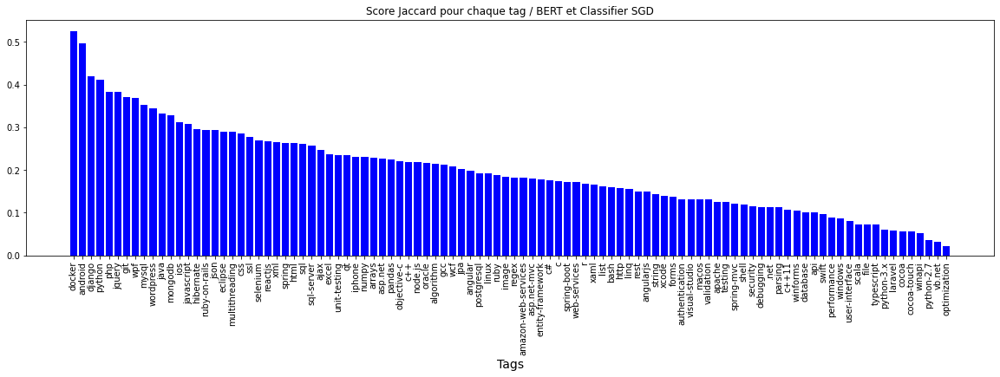

In [231]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / BERT et Classifier SGD')
plt.show()

In [232]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test2, average='weighted')

0.24421313433376418

In [233]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test2.sum()

17161

In [234]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [235]:
# Identification des 5 tags prédits par post
y_pred_test_w = y_pred_test2.copy()
tag_predit_sgdc_bert = pd.DataFrame()
for k in range(len(y_pred_test_w)):
    for i in range(5):
        ind = -1
        for j in range(100) :
            if y_pred_test_w[k,j] == 1 :
                ind  = j 
        if ind > -1 : 
            tag_predit_sgdc_bert.loc[k,i] = dict_tag[ind]
            y_pred_test_w[k,ind] = 0
        else : 
            tag_predit_sgdc_bert.loc[k,i] = ' '

In [236]:
tag_predit_sgdc_bert['list_tag'] = ' '
tag_predit_sgdc_bert['list_tag'][tag_predit_sgdc_bert[0] != ' ' ] = tag_predit_sgdc_bert[0]
tag_predit_sgdc_bert['list_tag'][tag_predit_sgdc_bert[1] != ' ' ] = tag_predit_sgdc_bert['list_tag'] + ' ' + tag_predit_sgdc_bert[1]
tag_predit_sgdc_bert['list_tag'][tag_predit_sgdc_bert[2] != ' ' ] = tag_predit_sgdc_bert['list_tag'] + ' ' + tag_predit_sgdc_bert[2]
tag_predit_sgdc_bert['list_tag'][tag_predit_sgdc_bert[3] != ' ' ] = tag_predit_sgdc_bert['list_tag'] + ' ' + tag_predit_sgdc_bert[3]
tag_predit_sgdc_bert['list_tag'][tag_predit_sgdc_bert[4] != ' ' ] = tag_predit_sgdc_bert['list_tag'] + ' ' + tag_predit_sgdc_bert[4]
tag_predit_sgdc_bert

,0,1,2,3,4,list_tag
0,http,,,,,http
1,,,,,,
2,unit-testing,testing,,,,unit-testing testing
3,c#,,,,,c#
4,python,,,,,python
...,...,...,...,...,...,...
14995,unit-testing,rest,,,,unit-testing rest
14996,php,,,,,php
14997,,,,,,
14998,ios,,,,,ios


In [237]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_sgdc_bert,'export_tag_predit_sgdc_bert')

['export_tag_predit_sgdc_bert']

In [238]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_sgdc_bert['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,java,1233
1,javascript,1148
2,python,1090
3,c#,806
4,php,764
...,...,...
95,vb.net,30
96,laravel,30
97,winapi,29
98,typescript,29


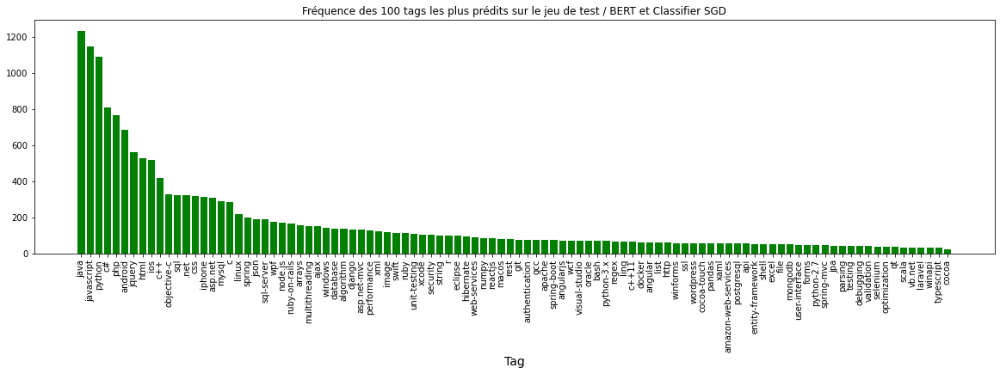

In [239]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / BERT et Classifier SGD')
plt.show()

In [240]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_sgdc_bert.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({' ': 58005, 'java': 1233, 'javascript': 1148, 'python': 1090, 'c#': 806, 'php': 764, 'android': 684, 'jquery': 561, 'html': 525, 'ios': 518, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

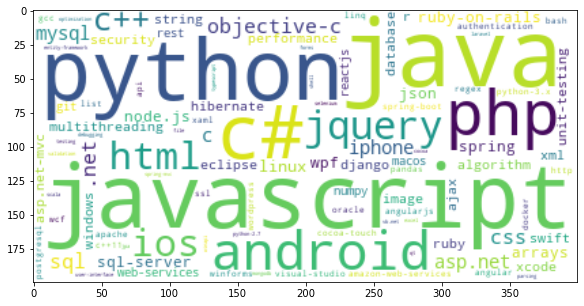

In [241]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [242]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_bert.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  8911
nombre de tags non trouvés :  66089
Pourcentage de couverture des tags réels :  11.88 %


In [243]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_sgdc_bert.iloc[k,0]) or (tag ==tag_predit_sgdc_bert.iloc[k,1]) or (tag ==tag_predit_sgdc_bert.iloc[k,2]) or (tag ==tag_predit_sgdc_bert.iloc[k,3]) or (tag ==tag_predit_sgdc_bert.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  8911
nombre de tags non trouvés :  19782
Pourcentage de couverture des tags réels / 100 plus fréquents :  31.06 %


In [244]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_bert.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  6509
nombre de mots non trouvés :  68491
Pourcentage de couverture des mots :  8.68 %


In [245]:
#list_k = random.sample(range(len(tag_predit_sgdc_bert)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_sgdc_bert.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
 
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
java android
-------------------------------------------------
-------------------------------------------------
enregistrement n° 9174 

In [246]:
#5.3 Word2Vec

In [247]:
w2v_size=300
w2v_window=5
w2v_min_count=1
w2v_epochs=100
maxlen = 3015 # adapt to length of sentences
sentences = raw_data_train['Title_body_text'].to_list()
sentences = sentences + raw_data_test['Title_body_text'].to_list()

In [248]:
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [249]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                                vector_size=w2v_size,
                                                seed=42,
                                                workers=1)
w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 198253
Word2Vec trained


In [250]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 198254


In [251]:
maxlen = x_sentences.shape[1]

In [252]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
w2v_size = 300
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (198254, 300)


In [253]:
# Création du modèle

input=Input(shape=(len(x_sentences),maxlen),dtype='float64')
word_input=Input(shape=(maxlen,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 3220)]            0         
                                                                 
 embedding (Embedding)       (None, 3220, 300)         59476200  
                                                                 
 global_average_pooling1d (G  (None, 300)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 59,476,200
Trainable params: 59,476,200
Non-trainable params: 0
_________________________________________________________________


In [254]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

1563/1563 [==============================] - 61s 37ms/step


(50000, 300)

In [255]:
embeddings_train = embeddings[0:35000]
embeddings_test = embeddings[35000:50000]

In [256]:
X_train = embeddings_train
X_test = embeddings_test

In [257]:
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

In [258]:
Y_train=raw_data_train[['Tags_trf_list','Tags_trf_list_100']].copy()
Y_test=raw_data_test[['Tags_trf_list','Tags_trf_list_100']].copy()

In [259]:
Y_train_s = [dict_tag.doc2bow(text) for text in Y_train['Tags_trf_list_100'].values]
Y_test_s = [dict_tag.doc2bow(text) for text in Y_test['Tags_trf_list_100'].values]

In [260]:
Y_train_s = gensim.matutils.corpus2csc(Y_train_s)
Y_test_s = gensim.matutils.corpus2csc(Y_test_s)

In [261]:
Y_train_s = Y_train_s.T.toarray()
Y_test_s = Y_test_s.T.toarray()

In [262]:
#5.3.1 Régression logistique
clf_w2v = OneVsRestClassifier(LogisticRegression(random_state=0,
                                             max_iter=1000,
                                             tol = 1e-5,
                                             verbose=1))

In [263]:
clf_w2v.fit(X_train_std, Y_train_s)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Us

OneVsRestClassifier(estimator=LogisticRegression(max_iter=1000, random_state=0,
                                                 tol=1e-05, verbose=1))

In [264]:
dump(clf_w2v,'export_modele_reglog_w2v')

['export_modele_reglog_w2v']

In [265]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test = clf_w2v.predict(X_test_std)

In [266]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test, average=None)
jac_scor

array([0.06134969, 0.33859155, 0.34195402, 0.08845438, 0.29308797,
       0.17535545, 0.2195122 , 0.37430786, 0.23143351, 0.22495606,
       0.44629823, 0.10132159, 0.46126761, 0.35157699, 0.3538175 ,
       0.19562716, 0.49411765, 0.07575758, 0.25214408, 0.62730228,
       0.28877005, 0.19123506, 0.32846715, 0.50032446, 0.27094972,
       0.12158055, 0.06837607, 0.08256881, 0.19480519, 0.03821656,
       0.62195122, 0.30406852, 0.08176101, 0.12562814, 0.37948718,
       0.12121212, 0.24475524, 0.24865832, 0.50974026, 0.12258065,
       0.35625   , 0.13924051, 0.21666667, 0.31543624, 0.20842105,
       0.21674877, 0.16216216, 0.06116208, 0.12669683, 0.45864662,
       0.42721893, 0.3373494 , 0.12560386, 0.228125  , 0.13953488,
       0.0390625 , 0.12698413, 0.096     , 0.18367347, 0.12378641,
       0.47747748, 0.48322148, 0.03125   , 0.22916667, 0.11330049,
       0.2016129 , 0.23287671, 0.48546512, 0.23904382, 0.36      ,
       0.25943396, 0.2625    , 0.37373737, 0.32022472, 0.26363

In [267]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.061350
1,javascript,0.338592
2,node.js,0.341954
3,.net,0.088454
4,c#,0.293088


In [268]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

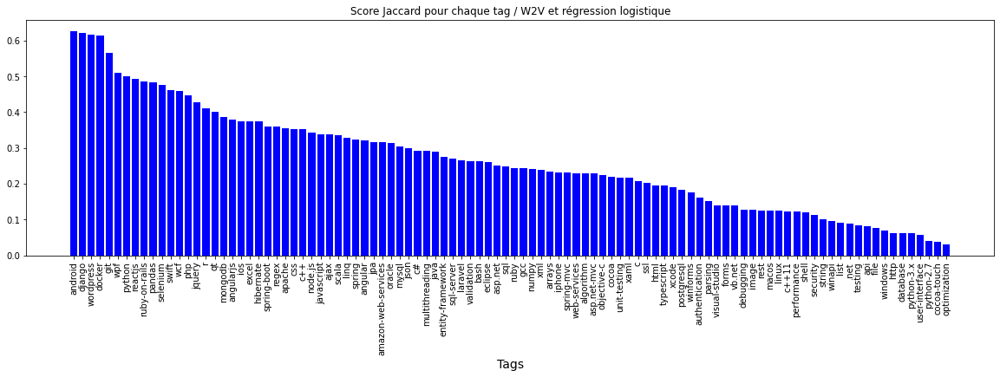

In [269]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / W2V et régression logistique')
plt.show()

In [270]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test, average='weighted')

0.29827288467419116

In [271]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test.sum()

15079

In [272]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [273]:
# L'utilisation du predict ne permet pas de predire 5 tags par post
# --> Utilisation de predict_proba, pour récupération des 5 tags ayant la plus forte probabilité
y_pred_test_proba = clf_w2v.predict_proba(X_test_std)

In [274]:
# Identification des 5 tags prédits par post
y_pred_test_proba_w = y_pred_test_proba.copy()
tag_predit_w2v=pd.DataFrame()
for k in range(len(y_pred_test_proba_w)):
    for i in range(5):
        val_max = 0
        ind = -1
        for j in range(100) :
            if y_pred_test_proba_w[k,j] > val_max :
                val_max = y_pred_test_proba_w[k,j]
                ind  = j 
        if ind > -1 : 
            tag_predit_w2v.loc[k,i] = dict_tag[ind]
            y_pred_test_proba_w[k,ind] = 0
tag_predit_w2v['list_tag'] = tag_predit_w2v[0] + ' ' + tag_predit_w2v[1] + ' ' + tag_predit_w2v[2] + ' ' + tag_predit_w2v[3] + ' ' + tag_predit_w2v[4]

In [275]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_w2v,'export_tag_predit_w2v')

['export_tag_predit_w2v']

In [276]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_w2v['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,java,7401
1,c#,7274
2,javascript,5387
3,.net,3705
4,python,3108
...,...,...
95,wcf,166
96,wordpress,162
97,docker,157
98,excel,150


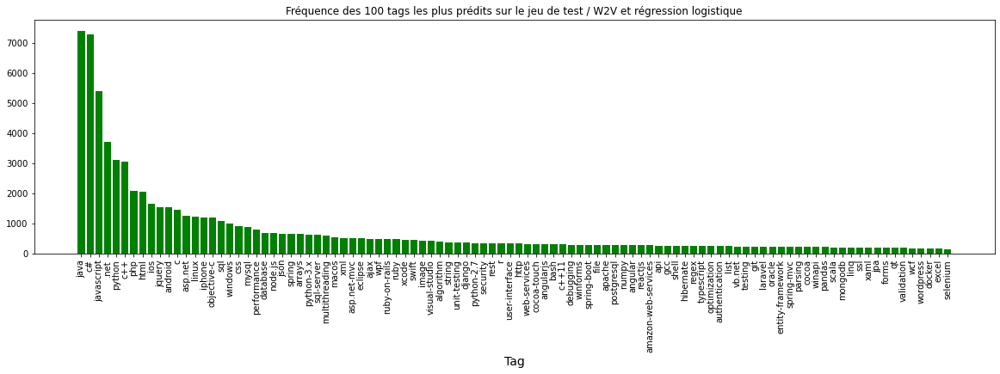

In [277]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / W2V et régression logistique')
plt.show()

In [278]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_w2v.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({'java': 7401, 'c#': 7274, 'javascript': 5387, '.net': 3705, 'python': 3108, 'c++': 3033, 'php': 2073, 'html': 2039, 'ios': 1639, 'jquery': 1545, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=trans

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

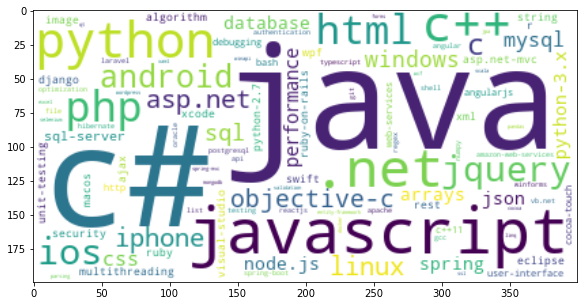

In [279]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [280]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_w2v.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  22174
nombre de tags non trouvés :  52826
Pourcentage de couverture des tags réels :  29.57 %


In [281]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_w2v.iloc[k,0]) or (tag ==tag_predit_w2v.iloc[k,1]) or (tag ==tag_predit_w2v.iloc[k,2]) or (tag ==tag_predit_w2v.iloc[k,3]) or (tag ==tag_predit_w2v.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  22174
nombre de tags non trouvés :  6519
Pourcentage de couverture des tags réels / 100 plus fréquents :  77.28 %


In [282]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_w2v.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  14699
nombre de mots non trouvés :  60301
Pourcentage de couverture des mots :  19.6 %


In [283]:
#list_k = random.sample(range(len(tag_predit_bert)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_w2v.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
arrays c++ c# c javascript
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android java xml eclipse arrays
-------------------------------------------------
-----------------------------

In [284]:
#5.3.2 SGDClassifier
clf2_w2v = OneVsRestClassifier(SGDClassifier(random_state=0,
                                             max_iter=2000,
                                             verbose=1))

In [285]:
clf2_w2v.fit(X_train_std, Y_train_s)

-- Epoch 1
Norm: 185.69, NNZs: 300, Bias: -922.796067, T: 35000, Avg. loss: 7.583814
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 175.65, NNZs: 300, Bias: -873.746586, T: 70000, Avg. loss: 3.620340
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 175.07, NNZs: 300, Bias: -844.700572, T: 105000, Avg. loss: 3.375967
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 169.82, NNZs: 300, Bias: -824.813720, T: 140000, Avg. loss: 3.176080
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 169.62, NNZs: 300, Bias: -808.858184, T: 175000, Avg. loss: 3.129623
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 167.54, NNZs: 300, Bias: -796.186528, T: 210000, Avg. loss: 3.044048
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 165.57, NNZs: 300, Bias: -785.582404, T: 245000, Avg. loss: 2.970725
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 163.19, NNZs: 300, Bias: -776.546704, T: 280000, Avg. loss: 2.907519
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 162.29, NNZs: 300

Norm: 139.98, NNZs: 300, Bias: -629.667938, T: 2555000, Avg. loss: 2.227486
Total training time: 1.41 seconds.
-- Epoch 74
Norm: 139.72, NNZs: 300, Bias: -628.824686, T: 2590000, Avg. loss: 2.226919
Total training time: 1.44 seconds.
-- Epoch 75
Norm: 139.62, NNZs: 300, Bias: -627.958195, T: 2625000, Avg. loss: 2.222652
Total training time: 1.45 seconds.
-- Epoch 76
Norm: 139.43, NNZs: 300, Bias: -627.125959, T: 2660000, Avg. loss: 2.220092
Total training time: 1.48 seconds.
-- Epoch 77
Norm: 139.28, NNZs: 300, Bias: -626.293335, T: 2695000, Avg. loss: 2.215406
Total training time: 1.50 seconds.
-- Epoch 78
Norm: 139.18, NNZs: 300, Bias: -625.464305, T: 2730000, Avg. loss: 2.213104
Total training time: 1.52 seconds.
-- Epoch 79
Norm: 139.11, NNZs: 300, Bias: -624.638912, T: 2765000, Avg. loss: 2.209720
Total training time: 1.54 seconds.
-- Epoch 80
Norm: 138.96, NNZs: 300, Bias: -623.841899, T: 2800000, Avg. loss: 2.207175
Total training time: 1.55 seconds.
-- Epoch 81
Norm: 138.75, NN

-- Epoch 148
Norm: 132.40, NNZs: 300, Bias: -585.156913, T: 5180000, Avg. loss: 2.039521
Total training time: 2.83 seconds.
-- Epoch 149
Norm: 132.27, NNZs: 300, Bias: -584.750885, T: 5215000, Avg. loss: 2.037406
Total training time: 2.85 seconds.
-- Epoch 150
Norm: 132.25, NNZs: 300, Bias: -584.322939, T: 5250000, Avg. loss: 2.036173
Total training time: 2.86 seconds.
-- Epoch 151
Norm: 132.16, NNZs: 300, Bias: -583.914919, T: 5285000, Avg. loss: 2.035473
Total training time: 2.88 seconds.
-- Epoch 152
Norm: 132.10, NNZs: 300, Bias: -583.503931, T: 5320000, Avg. loss: 2.033403
Total training time: 2.90 seconds.
-- Epoch 153
Norm: 132.02, NNZs: 300, Bias: -583.099321, T: 5355000, Avg. loss: 2.031139
Total training time: 2.91 seconds.
-- Epoch 154
Norm: 131.96, NNZs: 300, Bias: -582.691711, T: 5390000, Avg. loss: 2.029182
Total training time: 2.94 seconds.
-- Epoch 155
Norm: 131.89, NNZs: 300, Bias: -582.290432, T: 5425000, Avg. loss: 2.027016
Total training time: 2.96 seconds.
-- Epoch

Norm: 127.99, NNZs: 300, Bias: -559.611992, T: 7840000, Avg. loss: 1.932431
Total training time: 4.27 seconds.
-- Epoch 225
Norm: 127.94, NNZs: 300, Bias: -559.339672, T: 7875000, Avg. loss: 1.931536
Total training time: 4.29 seconds.
-- Epoch 226
Norm: 127.90, NNZs: 300, Bias: -559.066020, T: 7910000, Avg. loss: 1.930259
Total training time: 4.31 seconds.
-- Epoch 227
Norm: 127.84, NNZs: 300, Bias: -558.801146, T: 7945000, Avg. loss: 1.928985
Total training time: 4.33 seconds.
-- Epoch 228
Norm: 127.78, NNZs: 300, Bias: -558.534886, T: 7980000, Avg. loss: 1.927955
Total training time: 4.35 seconds.
-- Epoch 229
Norm: 127.75, NNZs: 300, Bias: -558.263603, T: 8015000, Avg. loss: 1.927409
Total training time: 4.37 seconds.
-- Epoch 230
Norm: 127.71, NNZs: 300, Bias: -557.995942, T: 8050000, Avg. loss: 1.925719
Total training time: 4.39 seconds.
-- Epoch 231
Norm: 127.65, NNZs: 300, Bias: -557.733160, T: 8085000, Avg. loss: 1.924665
Total training time: 4.40 seconds.
-- Epoch 232
Norm: 12

Norm: 44.09, NNZs: 300, Bias: -29.892793, T: 175000, Avg. loss: 1.264459
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 34.13, NNZs: 300, Bias: -21.702258, T: 210000, Avg. loss: 0.941521
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 27.73, NNZs: 300, Bias: -18.368897, T: 245000, Avg. loss: 0.860281
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 23.87, NNZs: 300, Bias: -15.434359, T: 280000, Avg. loss: 0.775423
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 20.63, NNZs: 300, Bias: -13.528329, T: 315000, Avg. loss: 0.659686
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 18.62, NNZs: 300, Bias: -11.904293, T: 350000, Avg. loss: 0.604027
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 16.79, NNZs: 300, Bias: -10.867613, T: 385000, Avg. loss: 0.584552
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 15.29, NNZs: 300, Bias: -9.620290, T: 420000, Avg. loss: 0.525120
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 13.95, NNZs: 300, Bias: -9.701406, T: 4

-- Epoch 75
Norm: 4.49, NNZs: 300, Bias: -3.136232, T: 2625000, Avg. loss: 0.224639
Total training time: 1.60 seconds.
-- Epoch 76
Norm: 4.47, NNZs: 300, Bias: -3.098429, T: 2660000, Avg. loss: 0.220799
Total training time: 1.62 seconds.
-- Epoch 77
Norm: 4.43, NNZs: 300, Bias: -3.164937, T: 2695000, Avg. loss: 0.222344
Total training time: 1.64 seconds.
Convergence after 77 epochs took 1.64 seconds
-- Epoch 1
Norm: 211.77, NNZs: 300, Bias: -596.844263, T: 35000, Avg. loss: 10.165948
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 183.94, NNZs: 300, Bias: -509.824901, T: 70000, Avg. loss: 4.282047
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 175.60, NNZs: 300, Bias: -457.809704, T: 105000, Avg. loss: 3.586342
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 167.52, NNZs: 300, Bias: -422.498933, T: 140000, Avg. loss: 3.125145
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 163.22, NNZs: 300, Bias: -395.116142, T: 175000, Avg. loss: 2.804659
Total training time: 0.10 se

Norm: 79.46, NNZs: 300, Bias: -137.111266, T: 2450000, Avg. loss: 0.682404
Total training time: 1.38 seconds.
-- Epoch 71
Norm: 79.01, NNZs: 300, Bias: -136.045652, T: 2485000, Avg. loss: 0.676357
Total training time: 1.40 seconds.
-- Epoch 72
Norm: 78.61, NNZs: 300, Bias: -134.971416, T: 2520000, Avg. loss: 0.671598
Total training time: 1.42 seconds.
-- Epoch 73
Norm: 78.22, NNZs: 300, Bias: -133.916026, T: 2555000, Avg. loss: 0.662196
Total training time: 1.44 seconds.
-- Epoch 74
Norm: 77.79, NNZs: 300, Bias: -132.897782, T: 2590000, Avg. loss: 0.658411
Total training time: 1.45 seconds.
-- Epoch 75
Norm: 77.40, NNZs: 300, Bias: -131.882074, T: 2625000, Avg. loss: 0.650319
Total training time: 1.48 seconds.
-- Epoch 76
Norm: 77.01, NNZs: 300, Bias: -130.886927, T: 2660000, Avg. loss: 0.644991
Total training time: 1.50 seconds.
-- Epoch 77
Norm: 76.62, NNZs: 300, Bias: -129.909100, T: 2695000, Avg. loss: 0.640460
Total training time: 1.51 seconds.
-- Epoch 78
Norm: 76.28, NNZs: 300, 

-- Epoch 144
Norm: 58.94, NNZs: 300, Bias: -86.446672, T: 5040000, Avg. loss: 0.385225
Total training time: 3.06 seconds.
-- Epoch 145
Norm: 58.76, NNZs: 300, Bias: -86.000069, T: 5075000, Avg. loss: 0.383565
Total training time: 3.09 seconds.
-- Epoch 146
Norm: 58.57, NNZs: 300, Bias: -85.564368, T: 5110000, Avg. loss: 0.381476
Total training time: 3.12 seconds.
-- Epoch 147
Norm: 58.40, NNZs: 300, Bias: -85.121664, T: 5145000, Avg. loss: 0.378813
Total training time: 3.15 seconds.
-- Epoch 148
Norm: 58.18, NNZs: 300, Bias: -84.718655, T: 5180000, Avg. loss: 0.375919
Total training time: 3.18 seconds.
-- Epoch 149
Norm: 58.02, NNZs: 300, Bias: -84.280030, T: 5215000, Avg. loss: 0.374159
Total training time: 3.21 seconds.
-- Epoch 150
Norm: 57.82, NNZs: 300, Bias: -83.869237, T: 5250000, Avg. loss: 0.371946
Total training time: 3.24 seconds.
-- Epoch 151
Norm: 57.67, NNZs: 300, Bias: -83.432777, T: 5285000, Avg. loss: 0.369377
Total training time: 3.27 seconds.
-- Epoch 152
Norm: 57.47

Norm: 48.56, NNZs: 300, Bias: -63.029780, T: 7455000, Avg. loss: 0.262514
Total training time: 4.74 seconds.
-- Epoch 214
Norm: 48.44, NNZs: 300, Bias: -62.764862, T: 7490000, Avg. loss: 0.261451
Total training time: 4.76 seconds.
-- Epoch 215
Norm: 48.33, NNZs: 300, Bias: -62.498480, T: 7525000, Avg. loss: 0.259619
Total training time: 4.78 seconds.
-- Epoch 216
Norm: 48.20, NNZs: 300, Bias: -62.251908, T: 7560000, Avg. loss: 0.258915
Total training time: 4.80 seconds.
-- Epoch 217
Norm: 48.08, NNZs: 300, Bias: -61.994573, T: 7595000, Avg. loss: 0.257309
Total training time: 4.83 seconds.
-- Epoch 218
Norm: 47.95, NNZs: 300, Bias: -61.751466, T: 7630000, Avg. loss: 0.255653
Total training time: 4.85 seconds.
-- Epoch 219
Norm: 47.86, NNZs: 300, Bias: -61.478201, T: 7665000, Avg. loss: 0.254428
Total training time: 4.87 seconds.
-- Epoch 220
Norm: 47.71, NNZs: 300, Bias: -61.249065, T: 7700000, Avg. loss: 0.253505
Total training time: 4.90 seconds.
-- Epoch 221
Norm: 47.59, NNZs: 300, 

Norm: 41.18, NNZs: 300, Bias: -47.979122, T: 9940000, Avg. loss: 0.189870
Total training time: 6.16 seconds.
-- Epoch 285
Norm: 41.08, NNZs: 300, Bias: -47.814432, T: 9975000, Avg. loss: 0.189021
Total training time: 6.18 seconds.
Convergence after 285 epochs took 6.18 seconds
-- Epoch 1
Norm: 233.42, NNZs: 300, Bias: -457.094931, T: 35000, Avg. loss: 20.572271
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 184.12, NNZs: 300, Bias: -312.228185, T: 70000, Avg. loss: 6.310789
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 154.85, NNZs: 300, Bias: -235.610880, T: 105000, Avg. loss: 4.195884
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 133.45, NNZs: 300, Bias: -187.196608, T: 140000, Avg. loss: 3.063300
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 116.12, NNZs: 300, Bias: -153.255003, T: 175000, Avg. loss: 2.386581
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 104.27, NNZs: 300, Bias: -126.581327, T: 210000, Avg. loss: 1.908301
Total training time: 0.12 second

Norm: 8.09, NNZs: 300, Bias: -4.982809, T: 770000, Avg. loss: 0.369630
Total training time: 0.47 seconds.
-- Epoch 23
Norm: 7.90, NNZs: 300, Bias: -5.030274, T: 805000, Avg. loss: 0.359091
Total training time: 0.49 seconds.
-- Epoch 24
Norm: 7.70, NNZs: 300, Bias: -4.631914, T: 840000, Avg. loss: 0.352879
Total training time: 0.52 seconds.
-- Epoch 25
Norm: 7.35, NNZs: 300, Bias: -4.737708, T: 875000, Avg. loss: 0.345093
Total training time: 0.54 seconds.
-- Epoch 26
Norm: 7.36, NNZs: 300, Bias: -4.744407, T: 910000, Avg. loss: 0.351212
Total training time: 0.56 seconds.
-- Epoch 27
Norm: 7.27, NNZs: 300, Bias: -4.568912, T: 945000, Avg. loss: 0.338370
Total training time: 0.58 seconds.
-- Epoch 28
Norm: 7.10, NNZs: 300, Bias: -4.493948, T: 980000, Avg. loss: 0.336052
Total training time: 0.60 seconds.
-- Epoch 29
Norm: 6.97, NNZs: 300, Bias: -4.353728, T: 1015000, Avg. loss: 0.335749
Total training time: 0.61 seconds.
-- Epoch 30
Norm: 6.78, NNZs: 300, Bias: -4.154027, T: 1050000, Avg

-- Epoch 24
Norm: 183.66, NNZs: 300, Bias: -783.155513, T: 840000, Avg. loss: 2.733385
Total training time: 0.49 seconds.
-- Epoch 25
Norm: 183.05, NNZs: 300, Bias: -780.138267, T: 875000, Avg. loss: 2.723207
Total training time: 0.51 seconds.
-- Epoch 26
Norm: 182.53, NNZs: 300, Bias: -777.230430, T: 910000, Avg. loss: 2.709165
Total training time: 0.53 seconds.
-- Epoch 27
Norm: 181.86, NNZs: 300, Bias: -774.471483, T: 945000, Avg. loss: 2.698197
Total training time: 0.54 seconds.
-- Epoch 28
Norm: 181.29, NNZs: 300, Bias: -771.807697, T: 980000, Avg. loss: 2.689184
Total training time: 0.56 seconds.
-- Epoch 29
Norm: 180.72, NNZs: 300, Bias: -769.244786, T: 1015000, Avg. loss: 2.676016
Total training time: 0.58 seconds.
-- Epoch 30
Norm: 180.46, NNZs: 300, Bias: -766.700440, T: 1050000, Avg. loss: 2.665685
Total training time: 0.60 seconds.
-- Epoch 31
Norm: 180.03, NNZs: 300, Bias: -764.284935, T: 1085000, Avg. loss: 2.649492
Total training time: 0.62 seconds.
-- Epoch 32
Norm: 179

Norm: 165.02, NNZs: 300, Bias: -682.357487, T: 3395000, Avg. loss: 2.287279
Total training time: 1.91 seconds.
-- Epoch 98
Norm: 164.92, NNZs: 300, Bias: -681.631060, T: 3430000, Avg. loss: 2.285949
Total training time: 1.93 seconds.
-- Epoch 99
Norm: 164.76, NNZs: 300, Bias: -680.926022, T: 3465000, Avg. loss: 2.281122
Total training time: 1.94 seconds.
-- Epoch 100
Norm: 164.61, NNZs: 300, Bias: -680.228385, T: 3500000, Avg. loss: 2.279697
Total training time: 1.96 seconds.
-- Epoch 101
Norm: 164.48, NNZs: 300, Bias: -679.531860, T: 3535000, Avg. loss: 2.274265
Total training time: 1.98 seconds.
-- Epoch 102
Norm: 164.33, NNZs: 300, Bias: -678.847989, T: 3570000, Avg. loss: 2.273578
Total training time: 2.00 seconds.
-- Epoch 103
Norm: 164.25, NNZs: 300, Bias: -678.154241, T: 3605000, Avg. loss: 2.271343
Total training time: 2.02 seconds.
-- Epoch 104
Norm: 164.13, NNZs: 300, Bias: -677.477866, T: 3640000, Avg. loss: 2.266278
Total training time: 2.04 seconds.
-- Epoch 105
Norm: 164.

Norm: 158.46, NNZs: 300, Bias: -645.926936, T: 5740000, Avg. loss: 2.130021
Total training time: 3.19 seconds.
-- Epoch 165
Norm: 158.37, NNZs: 300, Bias: -645.513475, T: 5775000, Avg. loss: 2.127363
Total training time: 3.21 seconds.
-- Epoch 166
Norm: 158.30, NNZs: 300, Bias: -645.099249, T: 5810000, Avg. loss: 2.127360
Total training time: 3.23 seconds.
-- Epoch 167
Norm: 158.24, NNZs: 300, Bias: -644.682418, T: 5845000, Avg. loss: 2.125129
Total training time: 3.24 seconds.
-- Epoch 168
Norm: 158.16, NNZs: 300, Bias: -644.276482, T: 5880000, Avg. loss: 2.122607
Total training time: 3.27 seconds.
-- Epoch 169
Norm: 158.09, NNZs: 300, Bias: -643.868018, T: 5915000, Avg. loss: 2.121419
Total training time: 3.28 seconds.
-- Epoch 170
Norm: 158.00, NNZs: 300, Bias: -643.466986, T: 5950000, Avg. loss: 2.120443
Total training time: 3.30 seconds.
-- Epoch 171
Norm: 157.92, NNZs: 300, Bias: -643.068149, T: 5985000, Avg. loss: 2.117582
Total training time: 3.32 seconds.
-- Epoch 172
Norm: 15

Norm: 154.17, NNZs: 300, Bias: -621.712949, T: 8190000, Avg. loss: 2.024077
Total training time: 4.49 seconds.
-- Epoch 235
Norm: 154.11, NNZs: 300, Bias: -621.426677, T: 8225000, Avg. loss: 2.023790
Total training time: 4.50 seconds.
-- Epoch 236
Norm: 154.05, NNZs: 300, Bias: -621.141541, T: 8260000, Avg. loss: 2.021999
Total training time: 4.52 seconds.
-- Epoch 237
Norm: 153.98, NNZs: 300, Bias: -620.858878, T: 8295000, Avg. loss: 2.021580
Total training time: 4.54 seconds.
-- Epoch 238
Norm: 153.93, NNZs: 300, Bias: -620.576167, T: 8330000, Avg. loss: 2.019798
Total training time: 4.55 seconds.
-- Epoch 239
Norm: 153.86, NNZs: 300, Bias: -620.298212, T: 8365000, Avg. loss: 2.018674
Total training time: 4.57 seconds.
-- Epoch 240
Norm: 153.82, NNZs: 300, Bias: -620.011935, T: 8400000, Avg. loss: 2.018271
Total training time: 4.58 seconds.
-- Epoch 241
Norm: 153.76, NNZs: 300, Bias: -619.733961, T: 8435000, Avg. loss: 2.016959
Total training time: 4.60 seconds.
-- Epoch 242
Norm: 15

Norm: 150.73, NNZs: 300, Bias: -603.516633, T: 10745000, Avg. loss: 1.949330
Total training time: 5.78 seconds.
-- Epoch 308
Norm: 150.68, NNZs: 300, Bias: -603.301098, T: 10780000, Avg. loss: 1.948758
Total training time: 5.79 seconds.
-- Epoch 309
Norm: 150.65, NNZs: 300, Bias: -603.083477, T: 10815000, Avg. loss: 1.947772
Total training time: 5.81 seconds.
-- Epoch 310
Norm: 150.60, NNZs: 300, Bias: -602.871163, T: 10850000, Avg. loss: 1.946523
Total training time: 5.83 seconds.
-- Epoch 311
Norm: 150.57, NNZs: 300, Bias: -602.654930, T: 10885000, Avg. loss: 1.945912
Total training time: 5.85 seconds.
-- Epoch 312
Norm: 150.54, NNZs: 300, Bias: -602.438505, T: 10920000, Avg. loss: 1.945023
Total training time: 5.87 seconds.
-- Epoch 313
Norm: 150.50, NNZs: 300, Bias: -602.224620, T: 10955000, Avg. loss: 1.944457
Total training time: 5.89 seconds.
-- Epoch 314
Norm: 150.45, NNZs: 300, Bias: -602.014128, T: 10990000, Avg. loss: 1.943303
Total training time: 5.90 seconds.
-- Epoch 315


Norm: 134.69, NNZs: 300, Bias: -643.180943, T: 770000, Avg. loss: 1.667244
Total training time: 0.42 seconds.
-- Epoch 23
Norm: 134.33, NNZs: 300, Bias: -640.875634, T: 805000, Avg. loss: 1.651981
Total training time: 0.44 seconds.
-- Epoch 24
Norm: 133.90, NNZs: 300, Bias: -638.689878, T: 840000, Avg. loss: 1.647755
Total training time: 0.46 seconds.
-- Epoch 25
Norm: 133.77, NNZs: 300, Bias: -636.536212, T: 875000, Avg. loss: 1.639561
Total training time: 0.48 seconds.
-- Epoch 26
Norm: 133.35, NNZs: 300, Bias: -634.531475, T: 910000, Avg. loss: 1.629970
Total training time: 0.50 seconds.
-- Epoch 27
Norm: 133.39, NNZs: 300, Bias: -632.508909, T: 945000, Avg. loss: 1.626298
Total training time: 0.52 seconds.
-- Epoch 28
Norm: 132.81, NNZs: 300, Bias: -630.692681, T: 980000, Avg. loss: 1.616128
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 132.79, NNZs: 300, Bias: -628.833734, T: 1015000, Avg. loss: 1.616311
Total training time: 0.57 seconds.
-- Epoch 30
Norm: 132.03, NNZs: 300

Norm: 124.06, NNZs: 300, Bias: -572.035606, T: 3115000, Avg. loss: 1.415382
Total training time: 1.67 seconds.
-- Epoch 90
Norm: 123.95, NNZs: 300, Bias: -571.483748, T: 3150000, Avg. loss: 1.415540
Total training time: 1.69 seconds.
-- Epoch 91
Norm: 124.08, NNZs: 300, Bias: -570.887677, T: 3185000, Avg. loss: 1.414246
Total training time: 1.71 seconds.
-- Epoch 92
Norm: 123.83, NNZs: 300, Bias: -570.381968, T: 3220000, Avg. loss: 1.409884
Total training time: 1.73 seconds.
-- Epoch 93
Norm: 123.83, NNZs: 300, Bias: -569.826400, T: 3255000, Avg. loss: 1.409744
Total training time: 1.76 seconds.
-- Epoch 94
Norm: 123.75, NNZs: 300, Bias: -569.294764, T: 3290000, Avg. loss: 1.407561
Total training time: 1.78 seconds.
-- Epoch 95
Norm: 123.59, NNZs: 300, Bias: -568.783952, T: 3325000, Avg. loss: 1.405686
Total training time: 1.80 seconds.
-- Epoch 96
Norm: 123.57, NNZs: 300, Bias: -568.251796, T: 3360000, Avg. loss: 1.404948
Total training time: 1.82 seconds.
-- Epoch 97
Norm: 123.48, NN

Norm: 119.87, NNZs: 300, Bias: -544.009803, T: 5495000, Avg. loss: 1.323923
Total training time: 3.19 seconds.
-- Epoch 158
Norm: 119.83, NNZs: 300, Bias: -543.697854, T: 5530000, Avg. loss: 1.323375
Total training time: 3.22 seconds.
-- Epoch 159
Norm: 119.82, NNZs: 300, Bias: -543.380688, T: 5565000, Avg. loss: 1.322841
Total training time: 3.24 seconds.
-- Epoch 160
Norm: 119.76, NNZs: 300, Bias: -543.076219, T: 5600000, Avg. loss: 1.321077
Total training time: 3.27 seconds.
-- Epoch 161
Norm: 119.71, NNZs: 300, Bias: -542.773733, T: 5635000, Avg. loss: 1.320519
Total training time: 3.30 seconds.
-- Epoch 162
Norm: 119.65, NNZs: 300, Bias: -542.473063, T: 5670000, Avg. loss: 1.319575
Total training time: 3.33 seconds.
-- Epoch 163
Norm: 119.62, NNZs: 300, Bias: -542.168924, T: 5705000, Avg. loss: 1.318113
Total training time: 3.36 seconds.
-- Epoch 164
Norm: 119.54, NNZs: 300, Bias: -541.878898, T: 5740000, Avg. loss: 1.317206
Total training time: 3.38 seconds.
-- Epoch 165
Norm: 11

-- Epoch 13
Norm: 109.53, NNZs: 300, Bias: -193.932110, T: 455000, Avg. loss: 1.398867
Total training time: 0.28 seconds.
-- Epoch 14
Norm: 106.60, NNZs: 300, Bias: -186.279824, T: 490000, Avg. loss: 1.332948
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 104.10, NNZs: 300, Bias: -179.102874, T: 525000, Avg. loss: 1.267974
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 101.51, NNZs: 300, Bias: -172.644855, T: 560000, Avg. loss: 1.205351
Total training time: 0.34 seconds.
-- Epoch 17
Norm: 98.75, NNZs: 300, Bias: -166.898834, T: 595000, Avg. loss: 1.149833
Total training time: 0.35 seconds.
-- Epoch 18
Norm: 97.52, NNZs: 300, Bias: -160.729060, T: 630000, Avg. loss: 1.101967
Total training time: 0.37 seconds.
-- Epoch 19
Norm: 95.19, NNZs: 300, Bias: -155.621647, T: 665000, Avg. loss: 1.058015
Total training time: 0.39 seconds.
-- Epoch 20
Norm: 92.89, NNZs: 300, Bias: -150.932414, T: 700000, Avg. loss: 1.019540
Total training time: 0.41 seconds.
-- Epoch 21
Norm: 91.06, NNZ

Norm: 38.39, NNZs: 300, Bias: -40.615523, T: 3115000, Avg. loss: 0.239510
Total training time: 1.70 seconds.
-- Epoch 90
Norm: 38.07, NNZs: 300, Bias: -40.003240, T: 3150000, Avg. loss: 0.236276
Total training time: 1.71 seconds.
-- Epoch 91
Norm: 37.67, NNZs: 300, Bias: -39.476361, T: 3185000, Avg. loss: 0.233431
Total training time: 1.73 seconds.
-- Epoch 92
Norm: 37.24, NNZs: 300, Bias: -38.992449, T: 3220000, Avg. loss: 0.230536
Total training time: 1.75 seconds.
-- Epoch 93
Norm: 36.91, NNZs: 300, Bias: -38.430322, T: 3255000, Avg. loss: 0.227229
Total training time: 1.76 seconds.
-- Epoch 94
Norm: 36.62, NNZs: 300, Bias: -37.847168, T: 3290000, Avg. loss: 0.223861
Total training time: 1.78 seconds.
-- Epoch 95
Norm: 36.23, NNZs: 300, Bias: -37.369517, T: 3325000, Avg. loss: 0.221352
Total training time: 1.80 seconds.
-- Epoch 96
Norm: 35.90, NNZs: 300, Bias: -36.852244, T: 3360000, Avg. loss: 0.218681
Total training time: 1.81 seconds.
-- Epoch 97
Norm: 35.57, NNZs: 300, Bias: -3

-- Epoch 158
Norm: 20.77, NNZs: 300, Bias: -17.118264, T: 5530000, Avg. loss: 0.122830
Total training time: 2.98 seconds.
-- Epoch 159
Norm: 20.62, NNZs: 300, Bias: -16.900297, T: 5565000, Avg. loss: 0.122425
Total training time: 3.00 seconds.
-- Epoch 160
Norm: 20.43, NNZs: 300, Bias: -16.737225, T: 5600000, Avg. loss: 0.120967
Total training time: 3.02 seconds.
-- Epoch 161
Norm: 20.26, NNZs: 300, Bias: -16.552073, T: 5635000, Avg. loss: 0.120167
Total training time: 3.03 seconds.
-- Epoch 162
Norm: 20.12, NNZs: 300, Bias: -16.332901, T: 5670000, Avg. loss: 0.119656
Total training time: 3.06 seconds.
-- Epoch 163
Norm: 19.94, NNZs: 300, Bias: -16.171237, T: 5705000, Avg. loss: 0.118502
Total training time: 3.07 seconds.
-- Epoch 164
Norm: 19.79, NNZs: 300, Bias: -15.979101, T: 5740000, Avg. loss: 0.117877
Total training time: 3.10 seconds.
-- Epoch 165
Norm: 19.61, NNZs: 300, Bias: -15.814238, T: 5775000, Avg. loss: 0.117025
Total training time: 3.11 seconds.
-- Epoch 166
Norm: 19.45

Norm: 62.09, NNZs: 300, Bias: -119.093489, T: 1925000, Avg. loss: 0.531217
Total training time: 1.01 seconds.
-- Epoch 56
Norm: 61.84, NNZs: 300, Bias: -117.909413, T: 1960000, Avg. loss: 0.524554
Total training time: 1.03 seconds.
-- Epoch 57
Norm: 61.35, NNZs: 300, Bias: -116.872461, T: 1995000, Avg. loss: 0.519048
Total training time: 1.04 seconds.
-- Epoch 58
Norm: 61.08, NNZs: 300, Bias: -115.749711, T: 2030000, Avg. loss: 0.512463
Total training time: 1.07 seconds.
-- Epoch 59
Norm: 60.76, NNZs: 300, Bias: -114.675763, T: 2065000, Avg. loss: 0.507408
Total training time: 1.09 seconds.
-- Epoch 60
Norm: 60.37, NNZs: 300, Bias: -113.663814, T: 2100000, Avg. loss: 0.501379
Total training time: 1.11 seconds.
-- Epoch 61
Norm: 59.94, NNZs: 300, Bias: -112.695536, T: 2135000, Avg. loss: 0.496786
Total training time: 1.13 seconds.
-- Epoch 62
Norm: 59.65, NNZs: 300, Bias: -111.679119, T: 2170000, Avg. loss: 0.492134
Total training time: 1.15 seconds.
-- Epoch 63
Norm: 59.39, NNZs: 300, 

Norm: 44.85, NNZs: 300, Bias: -70.290479, T: 4515000, Avg. loss: 0.288876
Total training time: 2.44 seconds.
-- Epoch 130
Norm: 44.72, NNZs: 300, Bias: -69.877991, T: 4550000, Avg. loss: 0.286684
Total training time: 2.46 seconds.
-- Epoch 131
Norm: 44.56, NNZs: 300, Bias: -69.484116, T: 4585000, Avg. loss: 0.284998
Total training time: 2.48 seconds.
-- Epoch 132
Norm: 44.41, NNZs: 300, Bias: -69.093193, T: 4620000, Avg. loss: 0.283513
Total training time: 2.50 seconds.
-- Epoch 133
Norm: 44.23, NNZs: 300, Bias: -68.731050, T: 4655000, Avg. loss: 0.281401
Total training time: 2.53 seconds.
-- Epoch 134
Norm: 44.10, NNZs: 300, Bias: -68.333175, T: 4690000, Avg. loss: 0.279854
Total training time: 2.55 seconds.
-- Epoch 135
Norm: 43.94, NNZs: 300, Bias: -67.961636, T: 4725000, Avg. loss: 0.278169
Total training time: 2.58 seconds.
-- Epoch 136
Norm: 43.75, NNZs: 300, Bias: -67.613648, T: 4760000, Avg. loss: 0.276455
Total training time: 2.60 seconds.
-- Epoch 137
Norm: 43.59, NNZs: 300, 

-- Epoch 205
Norm: 35.30, NNZs: 300, Bias: -48.361020, T: 7175000, Avg. loss: 0.195319
Total training time: 4.11 seconds.
-- Epoch 206
Norm: 35.20, NNZs: 300, Bias: -48.149713, T: 7210000, Avg. loss: 0.194443
Total training time: 4.13 seconds.
-- Epoch 207
Norm: 35.11, NNZs: 300, Bias: -47.929764, T: 7245000, Avg. loss: 0.193549
Total training time: 4.16 seconds.
-- Epoch 208
Norm: 34.96, NNZs: 300, Bias: -47.760389, T: 7280000, Avg. loss: 0.192739
Total training time: 4.18 seconds.
-- Epoch 209
Norm: 34.88, NNZs: 300, Bias: -47.539824, T: 7315000, Avg. loss: 0.192026
Total training time: 4.19 seconds.
-- Epoch 210
Norm: 34.78, NNZs: 300, Bias: -47.335297, T: 7350000, Avg. loss: 0.191568
Total training time: 4.22 seconds.
Convergence after 210 epochs took 4.22 seconds
-- Epoch 1
Norm: 239.42, NNZs: 300, Bias: -829.418780, T: 35000, Avg. loss: 12.988199
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 225.53, NNZs: 300, Bias: -743.933516, T: 70000, Avg. loss: 5.605763
Total training 

Norm: 134.50, NNZs: 300, Bias: -368.746120, T: 2205000, Avg. loss: 2.066667
Total training time: 1.25 seconds.
-- Epoch 64
Norm: 134.07, NNZs: 300, Bias: -367.272185, T: 2240000, Avg. loss: 2.060674
Total training time: 1.27 seconds.
-- Epoch 65
Norm: 133.62, NNZs: 300, Bias: -365.832323, T: 2275000, Avg. loss: 2.045774
Total training time: 1.28 seconds.
-- Epoch 66
Norm: 133.11, NNZs: 300, Bias: -364.440646, T: 2310000, Avg. loss: 2.036435
Total training time: 1.30 seconds.
-- Epoch 67
Norm: 132.81, NNZs: 300, Bias: -362.997200, T: 2345000, Avg. loss: 2.028729
Total training time: 1.32 seconds.
-- Epoch 68
Norm: 132.56, NNZs: 300, Bias: -361.563163, T: 2380000, Avg. loss: 2.018517
Total training time: 1.34 seconds.
-- Epoch 69
Norm: 132.25, NNZs: 300, Bias: -360.174242, T: 2415000, Avg. loss: 2.006544
Total training time: 1.36 seconds.
-- Epoch 70
Norm: 131.85, NNZs: 300, Bias: -358.843367, T: 2450000, Avg. loss: 2.000916
Total training time: 1.37 seconds.
-- Epoch 71
Norm: 131.61, NN

Norm: 115.83, NNZs: 300, Bias: -296.428049, T: 4865000, Avg. loss: 1.572303
Total training time: 2.70 seconds.
-- Epoch 140
Norm: 115.59, NNZs: 300, Bias: -295.829937, T: 4900000, Avg. loss: 1.569530
Total training time: 2.72 seconds.
-- Epoch 141
Norm: 115.47, NNZs: 300, Bias: -295.187586, T: 4935000, Avg. loss: 1.566657
Total training time: 2.74 seconds.
-- Epoch 142
Norm: 115.27, NNZs: 300, Bias: -294.579996, T: 4970000, Avg. loss: 1.562078
Total training time: 2.75 seconds.
-- Epoch 143
Norm: 115.06, NNZs: 300, Bias: -293.982526, T: 5005000, Avg. loss: 1.557010
Total training time: 2.77 seconds.
-- Epoch 144
Norm: 114.95, NNZs: 300, Bias: -293.355397, T: 5040000, Avg. loss: 1.553220
Total training time: 2.79 seconds.
-- Epoch 145
Norm: 114.70, NNZs: 300, Bias: -292.783831, T: 5075000, Avg. loss: 1.549196
Total training time: 2.81 seconds.
-- Epoch 146
Norm: 114.61, NNZs: 300, Bias: -292.155463, T: 5110000, Avg. loss: 1.545609
Total training time: 2.83 seconds.
-- Epoch 147
Norm: 11

Norm: 106.07, NNZs: 300, Bias: -258.884569, T: 7525000, Avg. loss: 1.326861
Total training time: 4.15 seconds.
-- Epoch 216
Norm: 105.97, NNZs: 300, Bias: -258.493473, T: 7560000, Avg. loss: 1.323809
Total training time: 4.17 seconds.
-- Epoch 217
Norm: 105.90, NNZs: 300, Bias: -258.092328, T: 7595000, Avg. loss: 1.321150
Total training time: 4.19 seconds.
-- Epoch 218
Norm: 105.73, NNZs: 300, Bias: -257.733717, T: 7630000, Avg. loss: 1.318236
Total training time: 4.21 seconds.
-- Epoch 219
Norm: 105.63, NNZs: 300, Bias: -257.350534, T: 7665000, Avg. loss: 1.315965
Total training time: 4.22 seconds.
-- Epoch 220
Norm: 105.57, NNZs: 300, Bias: -256.950918, T: 7700000, Avg. loss: 1.313816
Total training time: 4.24 seconds.
-- Epoch 221
Norm: 105.49, NNZs: 300, Bias: -256.560913, T: 7735000, Avg. loss: 1.310565
Total training time: 4.27 seconds.
-- Epoch 222
Norm: 105.39, NNZs: 300, Bias: -256.181705, T: 7770000, Avg. loss: 1.308660
Total training time: 4.28 seconds.
-- Epoch 223
Norm: 10

Norm: 99.60, NNZs: 300, Bias: -234.086513, T: 10150000, Avg. loss: 1.166871
Total training time: 5.57 seconds.
-- Epoch 291
Norm: 99.56, NNZs: 300, Bias: -233.793489, T: 10185000, Avg. loss: 1.164756
Total training time: 5.58 seconds.
-- Epoch 292
Norm: 99.43, NNZs: 300, Bias: -233.535706, T: 10220000, Avg. loss: 1.162937
Total training time: 5.60 seconds.
-- Epoch 293
Norm: 99.35, NNZs: 300, Bias: -233.261223, T: 10255000, Avg. loss: 1.161233
Total training time: 5.62 seconds.
-- Epoch 294
Norm: 99.30, NNZs: 300, Bias: -232.975049, T: 10290000, Avg. loss: 1.159857
Total training time: 5.64 seconds.
-- Epoch 295
Norm: 99.25, NNZs: 300, Bias: -232.689885, T: 10325000, Avg. loss: 1.158172
Total training time: 5.67 seconds.
-- Epoch 296
Norm: 99.16, NNZs: 300, Bias: -232.420136, T: 10360000, Avg. loss: 1.155932
Total training time: 5.68 seconds.
-- Epoch 297
Norm: 99.09, NNZs: 300, Bias: -232.145501, T: 10395000, Avg. loss: 1.153994
Total training time: 5.70 seconds.
-- Epoch 298
Norm: 99

Norm: 94.95, NNZs: 300, Bias: -216.960991, T: 12565000, Avg. loss: 1.059869
Total training time: 7.22 seconds.
-- Epoch 360
Norm: 94.90, NNZs: 300, Bias: -216.736124, T: 12600000, Avg. loss: 1.058493
Total training time: 7.25 seconds.
-- Epoch 361
Norm: 94.82, NNZs: 300, Bias: -216.525302, T: 12635000, Avg. loss: 1.056926
Total training time: 7.29 seconds.
-- Epoch 362
Norm: 94.78, NNZs: 300, Bias: -216.300095, T: 12670000, Avg. loss: 1.055948
Total training time: 7.31 seconds.
-- Epoch 363
Norm: 94.72, NNZs: 300, Bias: -216.082598, T: 12705000, Avg. loss: 1.054560
Total training time: 7.35 seconds.
-- Epoch 364
Norm: 94.66, NNZs: 300, Bias: -215.863354, T: 12740000, Avg. loss: 1.053267
Total training time: 7.38 seconds.
-- Epoch 365
Norm: 94.60, NNZs: 300, Bias: -215.648611, T: 12775000, Avg. loss: 1.051767
Total training time: 7.41 seconds.
-- Epoch 366
Norm: 94.52, NNZs: 300, Bias: -215.439904, T: 12810000, Avg. loss: 1.050194
Total training time: 7.44 seconds.
-- Epoch 367
Norm: 94

Norm: 91.08, NNZs: 300, Bias: -203.029345, T: 15015000, Avg. loss: 0.974839
Total training time: 8.92 seconds.
-- Epoch 430
Norm: 91.03, NNZs: 300, Bias: -202.849767, T: 15050000, Avg. loss: 0.973647
Total training time: 8.94 seconds.
-- Epoch 431
Norm: 90.97, NNZs: 300, Bias: -202.670589, T: 15085000, Avg. loss: 0.972615
Total training time: 8.96 seconds.
-- Epoch 432
Norm: 90.92, NNZs: 300, Bias: -202.495138, T: 15120000, Avg. loss: 0.971378
Total training time: 8.98 seconds.
-- Epoch 433
Norm: 90.86, NNZs: 300, Bias: -202.321399, T: 15155000, Avg. loss: 0.970486
Total training time: 9.00 seconds.
-- Epoch 434
Norm: 90.81, NNZs: 300, Bias: -202.141466, T: 15190000, Avg. loss: 0.969099
Total training time: 9.02 seconds.
-- Epoch 435
Norm: 90.75, NNZs: 300, Bias: -201.967219, T: 15225000, Avg. loss: 0.968502
Total training time: 9.04 seconds.
-- Epoch 436
Norm: 90.71, NNZs: 300, Bias: -201.788765, T: 15260000, Avg. loss: 0.967243
Total training time: 9.06 seconds.
-- Epoch 437
Norm: 90

Norm: 87.83, NNZs: 300, Bias: -191.799942, T: 17395000, Avg. loss: 0.907659
Total training time: 10.26 seconds.
-- Epoch 498
Norm: 87.79, NNZs: 300, Bias: -191.644323, T: 17430000, Avg. loss: 0.906804
Total training time: 10.28 seconds.
-- Epoch 499
Norm: 87.75, NNZs: 300, Bias: -191.493018, T: 17465000, Avg. loss: 0.905792
Total training time: 10.29 seconds.
-- Epoch 500
Norm: 87.69, NNZs: 300, Bias: -191.347726, T: 17500000, Avg. loss: 0.904823
Total training time: 10.31 seconds.
-- Epoch 501
Norm: 87.67, NNZs: 300, Bias: -191.187895, T: 17535000, Avg. loss: 0.903987
Total training time: 10.33 seconds.
-- Epoch 502
Norm: 87.62, NNZs: 300, Bias: -191.037490, T: 17570000, Avg. loss: 0.903073
Total training time: 10.35 seconds.
-- Epoch 503
Norm: 87.58, NNZs: 300, Bias: -190.887962, T: 17605000, Avg. loss: 0.902133
Total training time: 10.37 seconds.
-- Epoch 504
Norm: 87.54, NNZs: 300, Bias: -190.733624, T: 17640000, Avg. loss: 0.901191
Total training time: 10.39 seconds.
Convergence a

Norm: 8.49, NNZs: 300, Bias: -5.094568, T: 2345000, Avg. loss: 0.107688
Total training time: 1.32 seconds.
-- Epoch 68
Norm: 8.29, NNZs: 300, Bias: -4.980312, T: 2380000, Avg. loss: 0.106178
Total training time: 1.34 seconds.
-- Epoch 69
Norm: 8.08, NNZs: 300, Bias: -4.926152, T: 2415000, Avg. loss: 0.105639
Total training time: 1.36 seconds.
-- Epoch 70
Norm: 7.97, NNZs: 300, Bias: -4.901629, T: 2450000, Avg. loss: 0.108073
Total training time: 1.38 seconds.
-- Epoch 71
Norm: 7.83, NNZs: 300, Bias: -4.763712, T: 2485000, Avg. loss: 0.104018
Total training time: 1.40 seconds.
-- Epoch 72
Norm: 7.71, NNZs: 300, Bias: -4.791276, T: 2520000, Avg. loss: 0.106766
Total training time: 1.42 seconds.
-- Epoch 73
Norm: 7.64, NNZs: 300, Bias: -4.606622, T: 2555000, Avg. loss: 0.103936
Total training time: 1.44 seconds.
-- Epoch 74
Norm: 7.49, NNZs: 300, Bias: -4.622236, T: 2590000, Avg. loss: 0.104260
Total training time: 1.46 seconds.
-- Epoch 75
Norm: 7.38, NNZs: 300, Bias: -4.591660, T: 26250

Norm: 134.14, NNZs: 300, Bias: -529.719472, T: 1855000, Avg. loss: 1.607641
Total training time: 1.04 seconds.
-- Epoch 54
Norm: 134.11, NNZs: 300, Bias: -528.534084, T: 1890000, Avg. loss: 1.603281
Total training time: 1.07 seconds.
-- Epoch 55
Norm: 133.90, NNZs: 300, Bias: -527.412896, T: 1925000, Avg. loss: 1.599948
Total training time: 1.08 seconds.
-- Epoch 56
Norm: 133.65, NNZs: 300, Bias: -526.327990, T: 1960000, Avg. loss: 1.596416
Total training time: 1.11 seconds.
-- Epoch 57
Norm: 133.44, NNZs: 300, Bias: -525.250436, T: 1995000, Avg. loss: 1.588717
Total training time: 1.12 seconds.
-- Epoch 58
Norm: 133.15, NNZs: 300, Bias: -524.216436, T: 2030000, Avg. loss: 1.584532
Total training time: 1.14 seconds.
-- Epoch 59
Norm: 133.03, NNZs: 300, Bias: -523.157622, T: 2065000, Avg. loss: 1.586071
Total training time: 1.16 seconds.
-- Epoch 60
Norm: 132.81, NNZs: 300, Bias: -522.145106, T: 2100000, Avg. loss: 1.578152
Total training time: 1.18 seconds.
-- Epoch 61
Norm: 132.65, NN

-- Epoch 130
Norm: 123.89, NNZs: 300, Bias: -476.142541, T: 4550000, Avg. loss: 1.403997
Total training time: 2.51 seconds.
-- Epoch 131
Norm: 123.79, NNZs: 300, Bias: -475.698272, T: 4585000, Avg. loss: 1.401784
Total training time: 2.53 seconds.
-- Epoch 132
Norm: 123.67, NNZs: 300, Bias: -475.263701, T: 4620000, Avg. loss: 1.400390
Total training time: 2.55 seconds.
-- Epoch 133
Norm: 123.57, NNZs: 300, Bias: -474.826127, T: 4655000, Avg. loss: 1.398318
Total training time: 2.57 seconds.
-- Epoch 134
Norm: 123.48, NNZs: 300, Bias: -474.391613, T: 4690000, Avg. loss: 1.397232
Total training time: 2.58 seconds.
-- Epoch 135
Norm: 123.38, NNZs: 300, Bias: -473.960356, T: 4725000, Avg. loss: 1.395256
Total training time: 2.60 seconds.
-- Epoch 136
Norm: 123.33, NNZs: 300, Bias: -473.523940, T: 4760000, Avg. loss: 1.394254
Total training time: 2.62 seconds.
-- Epoch 137
Norm: 123.24, NNZs: 300, Bias: -473.097040, T: 4795000, Avg. loss: 1.392523
Total training time: 2.64 seconds.
-- Epoch

Norm: 118.57, NNZs: 300, Bias: -449.915837, T: 7175000, Avg. loss: 1.308498
Total training time: 3.94 seconds.
-- Epoch 206
Norm: 118.50, NNZs: 300, Bias: -449.640618, T: 7210000, Avg. loss: 1.307409
Total training time: 3.97 seconds.
-- Epoch 207
Norm: 118.44, NNZs: 300, Bias: -449.366733, T: 7245000, Avg. loss: 1.306544
Total training time: 3.99 seconds.
-- Epoch 208
Norm: 118.41, NNZs: 300, Bias: -449.085876, T: 7280000, Avg. loss: 1.305436
Total training time: 4.00 seconds.
-- Epoch 209
Norm: 118.34, NNZs: 300, Bias: -448.815974, T: 7315000, Avg. loss: 1.304178
Total training time: 4.02 seconds.
-- Epoch 210
Norm: 118.27, NNZs: 300, Bias: -448.548696, T: 7350000, Avg. loss: 1.303479
Total training time: 4.04 seconds.
-- Epoch 211
Norm: 118.18, NNZs: 300, Bias: -448.288078, T: 7385000, Avg. loss: 1.302133
Total training time: 4.05 seconds.
-- Epoch 212
Norm: 118.19, NNZs: 300, Bias: -448.003095, T: 7420000, Avg. loss: 1.301525
Total training time: 4.07 seconds.
-- Epoch 213
Norm: 11

-- Epoch 54
Norm: 151.61, NNZs: 300, Bias: -423.245686, T: 1890000, Avg. loss: 1.480061
Total training time: 1.00 seconds.
-- Epoch 55
Norm: 151.40, NNZs: 300, Bias: -421.695226, T: 1925000, Avg. loss: 1.473154
Total training time: 1.02 seconds.
-- Epoch 56
Norm: 151.13, NNZs: 300, Bias: -420.198313, T: 1960000, Avg. loss: 1.463901
Total training time: 1.03 seconds.
-- Epoch 57
Norm: 150.88, NNZs: 300, Bias: -418.722375, T: 1995000, Avg. loss: 1.454272
Total training time: 1.05 seconds.
-- Epoch 58
Norm: 150.40, NNZs: 300, Bias: -417.356503, T: 2030000, Avg. loss: 1.447105
Total training time: 1.08 seconds.
-- Epoch 59
Norm: 150.09, NNZs: 300, Bias: -415.960020, T: 2065000, Avg. loss: 1.439509
Total training time: 1.09 seconds.
-- Epoch 60
Norm: 149.70, NNZs: 300, Bias: -414.620391, T: 2100000, Avg. loss: 1.432099
Total training time: 1.11 seconds.
-- Epoch 61
Norm: 149.36, NNZs: 300, Bias: -413.288051, T: 2135000, Avg. loss: 1.424349
Total training time: 1.13 seconds.
-- Epoch 62
Norm

Norm: 135.31, NNZs: 300, Bias: -354.512653, T: 4515000, Avg. loss: 1.127878
Total training time: 2.42 seconds.
-- Epoch 130
Norm: 135.19, NNZs: 300, Bias: -353.919437, T: 4550000, Avg. loss: 1.124971
Total training time: 2.44 seconds.
-- Epoch 131
Norm: 135.03, NNZs: 300, Bias: -353.343592, T: 4585000, Avg. loss: 1.121083
Total training time: 2.46 seconds.
-- Epoch 132
Norm: 134.89, NNZs: 300, Bias: -352.770289, T: 4620000, Avg. loss: 1.119221
Total training time: 2.47 seconds.
-- Epoch 133
Norm: 134.74, NNZs: 300, Bias: -352.201208, T: 4655000, Avg. loss: 1.116257
Total training time: 2.49 seconds.
-- Epoch 134
Norm: 134.54, NNZs: 300, Bias: -351.659642, T: 4690000, Avg. loss: 1.112160
Total training time: 2.51 seconds.
-- Epoch 135
Norm: 134.46, NNZs: 300, Bias: -351.075577, T: 4725000, Avg. loss: 1.111024
Total training time: 2.53 seconds.
-- Epoch 136
Norm: 134.35, NNZs: 300, Bias: -350.508537, T: 4760000, Avg. loss: 1.108117
Total training time: 2.54 seconds.
-- Epoch 137
Norm: 13

Norm: 126.89, NNZs: 300, Bias: -320.500828, T: 7140000, Avg. loss: 0.963247
Total training time: 3.84 seconds.
-- Epoch 205
Norm: 126.78, NNZs: 300, Bias: -320.152954, T: 7175000, Avg. loss: 0.961826
Total training time: 3.86 seconds.
-- Epoch 206
Norm: 126.71, NNZs: 300, Bias: -319.791555, T: 7210000, Avg. loss: 0.960853
Total training time: 3.87 seconds.
-- Epoch 207
Norm: 126.61, NNZs: 300, Bias: -319.448446, T: 7245000, Avg. loss: 0.958818
Total training time: 3.89 seconds.
-- Epoch 208
Norm: 126.54, NNZs: 300, Bias: -319.090463, T: 7280000, Avg. loss: 0.957303
Total training time: 3.91 seconds.
-- Epoch 209
Norm: 126.43, NNZs: 300, Bias: -318.750690, T: 7315000, Avg. loss: 0.955824
Total training time: 3.93 seconds.
-- Epoch 210
Norm: 126.35, NNZs: 300, Bias: -318.404306, T: 7350000, Avg. loss: 0.953971
Total training time: 3.95 seconds.
-- Epoch 211
Norm: 126.22, NNZs: 300, Bias: -318.079874, T: 7385000, Avg. loss: 0.952112
Total training time: 3.97 seconds.
-- Epoch 212
Norm: 12

Norm: 121.02, NNZs: 300, Bias: -298.233603, T: 9765000, Avg. loss: 0.863643
Total training time: 5.29 seconds.
-- Epoch 280
Norm: 120.95, NNZs: 300, Bias: -297.987267, T: 9800000, Avg. loss: 0.862581
Total training time: 5.31 seconds.
-- Epoch 281
Norm: 120.88, NNZs: 300, Bias: -297.738767, T: 9835000, Avg. loss: 0.861411
Total training time: 5.33 seconds.
-- Epoch 282
Norm: 120.82, NNZs: 300, Bias: -297.486056, T: 9870000, Avg. loss: 0.860230
Total training time: 5.35 seconds.
-- Epoch 283
Norm: 120.74, NNZs: 300, Bias: -297.244339, T: 9905000, Avg. loss: 0.858857
Total training time: 5.38 seconds.
-- Epoch 284
Norm: 120.67, NNZs: 300, Bias: -296.999469, T: 9940000, Avg. loss: 0.858187
Total training time: 5.40 seconds.
-- Epoch 285
Norm: 120.62, NNZs: 300, Bias: -296.748400, T: 9975000, Avg. loss: 0.856913
Total training time: 5.42 seconds.
-- Epoch 286
Norm: 120.56, NNZs: 300, Bias: -296.503243, T: 10010000, Avg. loss: 0.855826
Total training time: 5.44 seconds.
-- Epoch 287
Norm: 1

Norm: 59.47, NNZs: 300, Bias: -75.588704, T: 875000, Avg. loss: 0.670799
Total training time: 0.78 seconds.
-- Epoch 26
Norm: 57.42, NNZs: 300, Bias: -72.522103, T: 910000, Avg. loss: 0.646591
Total training time: 0.81 seconds.
-- Epoch 27
Norm: 55.86, NNZs: 300, Bias: -69.301284, T: 945000, Avg. loss: 0.614926
Total training time: 0.84 seconds.
-- Epoch 28
Norm: 54.45, NNZs: 300, Bias: -66.201664, T: 980000, Avg. loss: 0.591990
Total training time: 0.86 seconds.
-- Epoch 29
Norm: 52.74, NNZs: 300, Bias: -63.538762, T: 1015000, Avg. loss: 0.562508
Total training time: 0.89 seconds.
-- Epoch 30
Norm: 51.32, NNZs: 300, Bias: -60.859312, T: 1050000, Avg. loss: 0.534185
Total training time: 0.91 seconds.
-- Epoch 31
Norm: 50.03, NNZs: 300, Bias: -58.218591, T: 1085000, Avg. loss: 0.526169
Total training time: 0.94 seconds.
-- Epoch 32
Norm: 48.57, NNZs: 300, Bias: -55.905018, T: 1120000, Avg. loss: 0.500539
Total training time: 0.96 seconds.
-- Epoch 33
Norm: 47.28, NNZs: 300, Bias: -53.60

Norm: 8.49, NNZs: 300, Bias: -5.752029, T: 3290000, Avg. loss: 0.126782
Total training time: 2.28 seconds.
-- Epoch 95
Norm: 8.24, NNZs: 300, Bias: -5.661164, T: 3325000, Avg. loss: 0.128569
Total training time: 2.30 seconds.
-- Epoch 96
Norm: 8.00, NNZs: 300, Bias: -5.523564, T: 3360000, Avg. loss: 0.124437
Total training time: 2.32 seconds.
-- Epoch 97
Norm: 7.82, NNZs: 300, Bias: -5.316526, T: 3395000, Avg. loss: 0.124939
Total training time: 2.34 seconds.
-- Epoch 98
Norm: 7.59, NNZs: 300, Bias: -5.210931, T: 3430000, Avg. loss: 0.124019
Total training time: 2.36 seconds.
-- Epoch 99
Norm: 7.40, NNZs: 300, Bias: -5.092318, T: 3465000, Avg. loss: 0.122743
Total training time: 2.38 seconds.
-- Epoch 100
Norm: 7.21, NNZs: 300, Bias: -4.968901, T: 3500000, Avg. loss: 0.122680
Total training time: 2.40 seconds.
-- Epoch 101
Norm: 7.02, NNZs: 300, Bias: -4.886455, T: 3535000, Avg. loss: 0.122374
Total training time: 2.42 seconds.
-- Epoch 102
Norm: 6.84, NNZs: 300, Bias: -4.829776, T: 35

Norm: 185.50, NNZs: 300, Bias: -726.622236, T: 2030000, Avg. loss: 3.653173
Total training time: 1.09 seconds.
-- Epoch 59
Norm: 185.18, NNZs: 300, Bias: -725.050899, T: 2065000, Avg. loss: 3.639781
Total training time: 1.11 seconds.
-- Epoch 60
Norm: 184.63, NNZs: 300, Bias: -723.567058, T: 2100000, Avg. loss: 3.630377
Total training time: 1.13 seconds.
-- Epoch 61
Norm: 184.56, NNZs: 300, Bias: -721.990710, T: 2135000, Avg. loss: 3.626369
Total training time: 1.14 seconds.
-- Epoch 62
Norm: 184.32, NNZs: 300, Bias: -720.481291, T: 2170000, Avg. loss: 3.609318
Total training time: 1.16 seconds.
-- Epoch 63
Norm: 183.87, NNZs: 300, Bias: -719.055315, T: 2205000, Avg. loss: 3.596568
Total training time: 1.19 seconds.
-- Epoch 64
Norm: 183.62, NNZs: 300, Bias: -717.602896, T: 2240000, Avg. loss: 3.599215
Total training time: 1.21 seconds.
-- Epoch 65
Norm: 183.35, NNZs: 300, Bias: -716.176788, T: 2275000, Avg. loss: 3.579280
Total training time: 1.22 seconds.
-- Epoch 66
Norm: 182.87, NN

-- Epoch 131
Norm: 171.35, NNZs: 300, Bias: -652.898406, T: 4585000, Avg. loss: 3.189647
Total training time: 2.49 seconds.
-- Epoch 132
Norm: 171.20, NNZs: 300, Bias: -652.229332, T: 4620000, Avg. loss: 3.184227
Total training time: 2.51 seconds.
-- Epoch 133
Norm: 171.07, NNZs: 300, Bias: -651.560909, T: 4655000, Avg. loss: 3.179498
Total training time: 2.53 seconds.
-- Epoch 134
Norm: 170.97, NNZs: 300, Bias: -650.891260, T: 4690000, Avg. loss: 3.171782
Total training time: 2.55 seconds.
-- Epoch 135
Norm: 170.82, NNZs: 300, Bias: -650.236933, T: 4725000, Avg. loss: 3.171912
Total training time: 2.57 seconds.
-- Epoch 136
Norm: 170.68, NNZs: 300, Bias: -649.587488, T: 4760000, Avg. loss: 3.167492
Total training time: 2.59 seconds.
-- Epoch 137
Norm: 170.52, NNZs: 300, Bias: -648.949007, T: 4795000, Avg. loss: 3.161228
Total training time: 2.61 seconds.
-- Epoch 138
Norm: 170.44, NNZs: 300, Bias: -648.292447, T: 4830000, Avg. loss: 3.158948
Total training time: 2.63 seconds.
-- Epoch

Norm: 163.60, NNZs: 300, Bias: -614.124734, T: 7140000, Avg. loss: 2.955176
Total training time: 3.92 seconds.
-- Epoch 205
Norm: 163.51, NNZs: 300, Bias: -613.701456, T: 7175000, Avg. loss: 2.953038
Total training time: 3.94 seconds.
-- Epoch 206
Norm: 163.40, NNZs: 300, Bias: -613.287075, T: 7210000, Avg. loss: 2.949960
Total training time: 3.96 seconds.
-- Epoch 207
Norm: 163.31, NNZs: 300, Bias: -612.872041, T: 7245000, Avg. loss: 2.948923
Total training time: 3.98 seconds.
-- Epoch 208
Norm: 163.23, NNZs: 300, Bias: -612.452167, T: 7280000, Avg. loss: 2.946079
Total training time: 4.00 seconds.
-- Epoch 209
Norm: 163.15, NNZs: 300, Bias: -612.036960, T: 7315000, Avg. loss: 2.942592
Total training time: 4.03 seconds.
-- Epoch 210
Norm: 163.07, NNZs: 300, Bias: -611.623780, T: 7350000, Avg. loss: 2.941755
Total training time: 4.05 seconds.
-- Epoch 211
Norm: 162.98, NNZs: 300, Bias: -611.215267, T: 7385000, Avg. loss: 2.939311
Total training time: 4.06 seconds.
-- Epoch 212
Norm: 16

Norm: 158.13, NNZs: 300, Bias: -587.271418, T: 9765000, Avg. loss: 2.800029
Total training time: 5.39 seconds.
-- Epoch 280
Norm: 158.07, NNZs: 300, Bias: -586.967873, T: 9800000, Avg. loss: 2.797606
Total training time: 5.41 seconds.
-- Epoch 281
Norm: 158.00, NNZs: 300, Bias: -586.667385, T: 9835000, Avg. loss: 2.795654
Total training time: 5.43 seconds.
-- Epoch 282
Norm: 157.95, NNZs: 300, Bias: -586.361889, T: 9870000, Avg. loss: 2.793911
Total training time: 5.45 seconds.
-- Epoch 283
Norm: 157.90, NNZs: 300, Bias: -586.058474, T: 9905000, Avg. loss: 2.791646
Total training time: 5.47 seconds.
-- Epoch 284
Norm: 157.84, NNZs: 300, Bias: -585.756198, T: 9940000, Avg. loss: 2.791087
Total training time: 5.50 seconds.
-- Epoch 285
Norm: 157.78, NNZs: 300, Bias: -585.458959, T: 9975000, Avg. loss: 2.789096
Total training time: 5.52 seconds.
-- Epoch 286
Norm: 157.72, NNZs: 300, Bias: -585.159762, T: 10010000, Avg. loss: 2.786935
Total training time: 5.53 seconds.
-- Epoch 287
Norm: 1

-- Epoch 352
Norm: 154.09, NNZs: 300, Bias: -567.636173, T: 12320000, Avg. loss: 2.686708
Total training time: 6.82 seconds.
-- Epoch 353
Norm: 154.07, NNZs: 300, Bias: -567.389800, T: 12355000, Avg. loss: 2.685201
Total training time: 6.84 seconds.
-- Epoch 354
Norm: 154.02, NNZs: 300, Bias: -567.154612, T: 12390000, Avg. loss: 2.683881
Total training time: 6.86 seconds.
-- Epoch 355
Norm: 153.94, NNZs: 300, Bias: -566.924897, T: 12425000, Avg. loss: 2.681051
Total training time: 6.87 seconds.
-- Epoch 356
Norm: 153.92, NNZs: 300, Bias: -566.683035, T: 12460000, Avg. loss: 2.682099
Total training time: 6.89 seconds.
-- Epoch 357
Norm: 153.85, NNZs: 300, Bias: -566.452225, T: 12495000, Avg. loss: 2.679667
Total training time: 6.91 seconds.
-- Epoch 358
Norm: 153.83, NNZs: 300, Bias: -566.210094, T: 12530000, Avg. loss: 2.678710
Total training time: 6.93 seconds.
-- Epoch 359
Norm: 153.78, NNZs: 300, Bias: -565.977420, T: 12565000, Avg. loss: 2.677252
Total training time: 6.95 seconds.


Norm: 150.83, NNZs: 300, Bias: -551.696523, T: 14910000, Avg. loss: 2.594356
Total training time: 8.22 seconds.
-- Epoch 427
Norm: 150.79, NNZs: 300, Bias: -551.500926, T: 14945000, Avg. loss: 2.594944
Total training time: 8.24 seconds.
-- Epoch 428
Norm: 150.77, NNZs: 300, Bias: -551.299774, T: 14980000, Avg. loss: 2.592372
Total training time: 8.25 seconds.
-- Epoch 429
Norm: 150.74, NNZs: 300, Bias: -551.105084, T: 15015000, Avg. loss: 2.591744
Total training time: 8.27 seconds.
-- Epoch 430
Norm: 150.70, NNZs: 300, Bias: -550.911529, T: 15050000, Avg. loss: 2.591406
Total training time: 8.29 seconds.
-- Epoch 431
Norm: 150.67, NNZs: 300, Bias: -550.715756, T: 15085000, Avg. loss: 2.588847
Total training time: 8.31 seconds.
-- Epoch 432
Norm: 150.61, NNZs: 300, Bias: -550.529053, T: 15120000, Avg. loss: 2.589387
Total training time: 8.33 seconds.
-- Epoch 433
Norm: 150.57, NNZs: 300, Bias: -550.338150, T: 15155000, Avg. loss: 2.587419
Total training time: 8.36 seconds.
-- Epoch 434


Norm: 148.41, NNZs: 300, Bias: -539.765362, T: 17220000, Avg. loss: 2.528953
Total training time: 9.49 seconds.
-- Epoch 493
Norm: 148.37, NNZs: 300, Bias: -539.598863, T: 17255000, Avg. loss: 2.527117
Total training time: 9.51 seconds.
-- Epoch 494
Norm: 148.34, NNZs: 300, Bias: -539.430967, T: 17290000, Avg. loss: 2.525340
Total training time: 9.53 seconds.
-- Epoch 495
Norm: 148.30, NNZs: 300, Bias: -539.264573, T: 17325000, Avg. loss: 2.523998
Total training time: 9.54 seconds.
-- Epoch 496
Norm: 148.26, NNZs: 300, Bias: -539.101379, T: 17360000, Avg. loss: 2.523811
Total training time: 9.56 seconds.
-- Epoch 497
Norm: 148.25, NNZs: 300, Bias: -538.929323, T: 17395000, Avg. loss: 2.521543
Total training time: 9.58 seconds.
-- Epoch 498
Norm: 148.19, NNZs: 300, Bias: -538.768533, T: 17430000, Avg. loss: 2.522737
Total training time: 9.60 seconds.
-- Epoch 499
Norm: 148.17, NNZs: 300, Bias: -538.599462, T: 17465000, Avg. loss: 2.520473
Total training time: 9.62 seconds.
-- Epoch 500


Norm: 146.28, NNZs: 300, Bias: -529.267746, T: 19565000, Avg. loss: 2.467910
Total training time: 10.73 seconds.
-- Epoch 560
Norm: 146.27, NNZs: 300, Bias: -529.115078, T: 19600000, Avg. loss: 2.466132
Total training time: 10.76 seconds.
-- Epoch 561
Norm: 146.24, NNZs: 300, Bias: -528.969816, T: 19635000, Avg. loss: 2.466378
Total training time: 10.78 seconds.
-- Epoch 562
Norm: 146.20, NNZs: 300, Bias: -528.825814, T: 19670000, Avg. loss: 2.464778
Total training time: 10.80 seconds.
-- Epoch 563
Norm: 146.17, NNZs: 300, Bias: -528.682081, T: 19705000, Avg. loss: 2.463773
Total training time: 10.82 seconds.
-- Epoch 564
Norm: 146.14, NNZs: 300, Bias: -528.536562, T: 19740000, Avg. loss: 2.462755
Total training time: 10.84 seconds.
-- Epoch 565
Norm: 146.11, NNZs: 300, Bias: -528.392321, T: 19775000, Avg. loss: 2.463001
Total training time: 10.87 seconds.
-- Epoch 566
Norm: 146.07, NNZs: 300, Bias: -528.250848, T: 19810000, Avg. loss: 2.461036
Total training time: 10.88 seconds.
-- Ep

-- Epoch 627
Norm: 144.36, NNZs: 300, Bias: -519.896558, T: 21945000, Avg. loss: 2.414312
Total training time: 12.03 seconds.
-- Epoch 628
Norm: 144.33, NNZs: 300, Bias: -519.767709, T: 21980000, Avg. loss: 2.414233
Total training time: 12.04 seconds.
-- Epoch 629
Norm: 144.30, NNZs: 300, Bias: -519.638612, T: 22015000, Avg. loss: 2.412940
Total training time: 12.07 seconds.
-- Epoch 630
Norm: 144.27, NNZs: 300, Bias: -519.510625, T: 22050000, Avg. loss: 2.412876
Total training time: 12.09 seconds.
-- Epoch 631
Norm: 144.25, NNZs: 300, Bias: -519.380585, T: 22085000, Avg. loss: 2.411843
Total training time: 12.10 seconds.
-- Epoch 632
Norm: 144.23, NNZs: 300, Bias: -519.250751, T: 22120000, Avg. loss: 2.411388
Total training time: 12.13 seconds.
-- Epoch 633
Norm: 144.20, NNZs: 300, Bias: -519.122457, T: 22155000, Avg. loss: 2.410116
Total training time: 12.15 seconds.
-- Epoch 634
Norm: 144.18, NNZs: 300, Bias: -518.990767, T: 22190000, Avg. loss: 2.409138
Total training time: 12.16 s

-- Epoch 63
Norm: 59.33, NNZs: 300, Bias: -78.574429, T: 2205000, Avg. loss: 0.678466
Total training time: 1.72 seconds.
-- Epoch 64
Norm: 58.62, NNZs: 300, Bias: -77.224106, T: 2240000, Avg. loss: 0.666060
Total training time: 1.75 seconds.
-- Epoch 65
Norm: 57.94, NNZs: 300, Bias: -75.887657, T: 2275000, Avg. loss: 0.653297
Total training time: 1.77 seconds.
-- Epoch 66
Norm: 57.31, NNZs: 300, Bias: -74.566824, T: 2310000, Avg. loss: 0.639581
Total training time: 1.80 seconds.
-- Epoch 67
Norm: 56.63, NNZs: 300, Bias: -73.308095, T: 2345000, Avg. loss: 0.628606
Total training time: 1.82 seconds.
-- Epoch 68
Norm: 56.16, NNZs: 300, Bias: -71.924468, T: 2380000, Avg. loss: 0.616154
Total training time: 1.85 seconds.
-- Epoch 69
Norm: 55.53, NNZs: 300, Bias: -70.695943, T: 2415000, Avg. loss: 0.607805
Total training time: 1.87 seconds.
-- Epoch 70
Norm: 54.84, NNZs: 300, Bias: -69.553466, T: 2450000, Avg. loss: 0.593709
Total training time: 1.90 seconds.
-- Epoch 71
Norm: 54.21, NNZs: 3

Norm: 25.73, NNZs: 300, Bias: -22.391882, T: 4935000, Avg. loss: 0.219666
Total training time: 3.36 seconds.
-- Epoch 142
Norm: 25.46, NNZs: 300, Bias: -22.040657, T: 4970000, Avg. loss: 0.216295
Total training time: 3.38 seconds.
-- Epoch 143
Norm: 25.20, NNZs: 300, Bias: -21.685770, T: 5005000, Avg. loss: 0.213448
Total training time: 3.40 seconds.
-- Epoch 144
Norm: 24.91, NNZs: 300, Bias: -21.375160, T: 5040000, Avg. loss: 0.211764
Total training time: 3.43 seconds.
-- Epoch 145
Norm: 24.65, NNZs: 300, Bias: -21.033226, T: 5075000, Avg. loss: 0.209319
Total training time: 3.45 seconds.
-- Epoch 146
Norm: 24.39, NNZs: 300, Bias: -20.699491, T: 5110000, Avg. loss: 0.207697
Total training time: 3.47 seconds.
-- Epoch 147
Norm: 24.11, NNZs: 300, Bias: -20.414799, T: 5145000, Avg. loss: 0.204777
Total training time: 3.49 seconds.
-- Epoch 148
Norm: 23.84, NNZs: 300, Bias: -20.112442, T: 5180000, Avg. loss: 0.205393
Total training time: 3.51 seconds.
-- Epoch 149
Norm: 23.58, NNZs: 300, 

-- Epoch 212
Norm: 11.27, NNZs: 300, Bias: -7.926859, T: 7420000, Avg. loss: 0.125290
Total training time: 4.81 seconds.
-- Epoch 213
Norm: 11.13, NNZs: 300, Bias: -7.831411, T: 7455000, Avg. loss: 0.125347
Total training time: 4.83 seconds.
Convergence after 213 epochs took 4.83 seconds
-- Epoch 1
Norm: 219.33, NNZs: 300, Bias: -1028.908116, T: 35000, Avg. loss: 10.959720
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 207.41, NNZs: 300, Bias: -974.595769, T: 70000, Avg. loss: 4.320091
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 203.96, NNZs: 300, Bias: -941.900635, T: 105000, Avg. loss: 3.941898
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 199.81, NNZs: 300, Bias: -919.521288, T: 140000, Avg. loss: 3.786391
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 197.24, NNZs: 300, Bias: -901.930646, T: 175000, Avg. loss: 3.632570
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 194.81, NNZs: 300, Bias: -887.664588, T: 210000, Avg. loss: 3.497331
Total training time:

Norm: 168.09, NNZs: 300, Bias: -703.273772, T: 2415000, Avg. loss: 2.467643
Total training time: 1.32 seconds.
-- Epoch 70
Norm: 167.91, NNZs: 300, Bias: -702.237984, T: 2450000, Avg. loss: 2.462040
Total training time: 1.33 seconds.
-- Epoch 71
Norm: 167.79, NNZs: 300, Bias: -701.204680, T: 2485000, Avg. loss: 2.456381
Total training time: 1.36 seconds.
-- Epoch 72
Norm: 167.62, NNZs: 300, Bias: -700.197878, T: 2520000, Avg. loss: 2.451050
Total training time: 1.37 seconds.
-- Epoch 73
Norm: 167.49, NNZs: 300, Bias: -699.197325, T: 2555000, Avg. loss: 2.450487
Total training time: 1.39 seconds.
-- Epoch 74
Norm: 167.40, NNZs: 300, Bias: -698.198387, T: 2590000, Avg. loss: 2.440537
Total training time: 1.41 seconds.
-- Epoch 75
Norm: 167.26, NNZs: 300, Bias: -697.228240, T: 2625000, Avg. loss: 2.435676
Total training time: 1.43 seconds.
-- Epoch 76
Norm: 167.08, NNZs: 300, Bias: -696.282829, T: 2660000, Avg. loss: 2.432156
Total training time: 1.45 seconds.
-- Epoch 77
Norm: 166.91, NN

Norm: 160.09, NNZs: 300, Bias: -650.235329, T: 5075000, Avg. loss: 2.204112
Total training time: 2.76 seconds.
-- Epoch 146
Norm: 160.02, NNZs: 300, Bias: -649.750462, T: 5110000, Avg. loss: 2.202478
Total training time: 2.78 seconds.
-- Epoch 147
Norm: 159.97, NNZs: 300, Bias: -649.265043, T: 5145000, Avg. loss: 2.200339
Total training time: 2.80 seconds.
-- Epoch 148
Norm: 159.89, NNZs: 300, Bias: -648.788574, T: 5180000, Avg. loss: 2.196870
Total training time: 2.82 seconds.
-- Epoch 149
Norm: 159.82, NNZs: 300, Bias: -648.313449, T: 5215000, Avg. loss: 2.195573
Total training time: 2.84 seconds.
-- Epoch 150
Norm: 159.78, NNZs: 300, Bias: -647.835707, T: 5250000, Avg. loss: 2.192125
Total training time: 2.86 seconds.
-- Epoch 151
Norm: 159.72, NNZs: 300, Bias: -647.365028, T: 5285000, Avg. loss: 2.190024
Total training time: 2.88 seconds.
-- Epoch 152
Norm: 159.62, NNZs: 300, Bias: -646.906746, T: 5320000, Avg. loss: 2.185957
Total training time: 2.90 seconds.
-- Epoch 153
Norm: 15

Norm: 156.01, NNZs: 300, Bias: -620.970345, T: 7700000, Avg. loss: 2.056315
Total training time: 4.21 seconds.
-- Epoch 221
Norm: 155.96, NNZs: 300, Bias: -620.656799, T: 7735000, Avg. loss: 2.055237
Total training time: 4.22 seconds.
-- Epoch 222
Norm: 155.93, NNZs: 300, Bias: -620.338218, T: 7770000, Avg. loss: 2.053781
Total training time: 4.24 seconds.
-- Epoch 223
Norm: 155.89, NNZs: 300, Bias: -620.024931, T: 7805000, Avg. loss: 2.052340
Total training time: 4.26 seconds.
-- Epoch 224
Norm: 155.85, NNZs: 300, Bias: -619.710480, T: 7840000, Avg. loss: 2.050411
Total training time: 4.28 seconds.
-- Epoch 225
Norm: 155.80, NNZs: 300, Bias: -619.402540, T: 7875000, Avg. loss: 2.048926
Total training time: 4.29 seconds.
-- Epoch 226
Norm: 155.75, NNZs: 300, Bias: -619.094656, T: 7910000, Avg. loss: 2.047123
Total training time: 4.31 seconds.
-- Epoch 227
Norm: 155.71, NNZs: 300, Bias: -618.788198, T: 7945000, Avg. loss: 2.046177
Total training time: 4.32 seconds.
-- Epoch 228
Norm: 15

Norm: 153.26, NNZs: 300, Bias: -600.122555, T: 10395000, Avg. loss: 1.950462
Total training time: 5.62 seconds.
-- Epoch 298
Norm: 153.24, NNZs: 300, Bias: -599.889208, T: 10430000, Avg. loss: 1.949665
Total training time: 5.64 seconds.
-- Epoch 299
Norm: 153.21, NNZs: 300, Bias: -599.657589, T: 10465000, Avg. loss: 1.947970
Total training time: 5.67 seconds.
-- Epoch 300
Norm: 153.19, NNZs: 300, Bias: -599.422927, T: 10500000, Avg. loss: 1.947040
Total training time: 5.68 seconds.
-- Epoch 301
Norm: 153.16, NNZs: 300, Bias: -599.193785, T: 10535000, Avg. loss: 1.945522
Total training time: 5.71 seconds.
-- Epoch 302
Norm: 153.14, NNZs: 300, Bias: -598.961617, T: 10570000, Avg. loss: 1.944353
Total training time: 5.73 seconds.
-- Epoch 303
Norm: 153.11, NNZs: 300, Bias: -598.732131, T: 10605000, Avg. loss: 1.943211
Total training time: 5.75 seconds.
-- Epoch 304
Norm: 153.08, NNZs: 300, Bias: -598.504339, T: 10640000, Avg. loss: 1.941669
Total training time: 5.77 seconds.
-- Epoch 305


Norm: 151.44, NNZs: 300, Bias: -586.295077, T: 12705000, Avg. loss: 1.880260
Total training time: 6.92 seconds.
-- Epoch 364
Norm: 151.41, NNZs: 300, Bias: -586.108010, T: 12740000, Avg. loss: 1.879456
Total training time: 6.94 seconds.
-- Epoch 365
Norm: 151.38, NNZs: 300, Bias: -585.919903, T: 12775000, Avg. loss: 1.878700
Total training time: 6.96 seconds.
-- Epoch 366
Norm: 151.36, NNZs: 300, Bias: -585.731533, T: 12810000, Avg. loss: 1.877650
Total training time: 6.98 seconds.
-- Epoch 367
Norm: 151.33, NNZs: 300, Bias: -585.546006, T: 12845000, Avg. loss: 1.876855
Total training time: 7.00 seconds.
-- Epoch 368
Norm: 151.29, NNZs: 300, Bias: -585.361764, T: 12880000, Avg. loss: 1.876050
Total training time: 7.02 seconds.
-- Epoch 369
Norm: 151.28, NNZs: 300, Bias: -585.174151, T: 12915000, Avg. loss: 1.875350
Total training time: 7.04 seconds.
-- Epoch 370
Norm: 151.24, NNZs: 300, Bias: -584.990138, T: 12950000, Avg. loss: 1.874285
Total training time: 7.05 seconds.
-- Epoch 371


-- Epoch 36
Norm: 169.40, NNZs: 300, Bias: -828.177041, T: 1260000, Avg. loss: 2.789721
Total training time: 0.70 seconds.
-- Epoch 37
Norm: 169.22, NNZs: 300, Bias: -826.347724, T: 1295000, Avg. loss: 2.787348
Total training time: 0.72 seconds.
-- Epoch 38
Norm: 169.06, NNZs: 300, Bias: -824.565897, T: 1330000, Avg. loss: 2.775160
Total training time: 0.73 seconds.
-- Epoch 39
Norm: 168.79, NNZs: 300, Bias: -822.853694, T: 1365000, Avg. loss: 2.768547
Total training time: 0.76 seconds.
-- Epoch 40
Norm: 168.61, NNZs: 300, Bias: -821.169146, T: 1400000, Avg. loss: 2.759622
Total training time: 0.77 seconds.
-- Epoch 41
Norm: 168.44, NNZs: 300, Bias: -819.525596, T: 1435000, Avg. loss: 2.748462
Total training time: 0.80 seconds.
-- Epoch 42
Norm: 168.24, NNZs: 300, Bias: -817.929300, T: 1470000, Avg. loss: 2.743204
Total training time: 0.81 seconds.
-- Epoch 43
Norm: 168.05, NNZs: 300, Bias: -816.369059, T: 1505000, Avg. loss: 2.733300
Total training time: 0.83 seconds.
-- Epoch 44
Norm

-- Epoch 109
Norm: 159.79, NNZs: 300, Bias: -755.718764, T: 3815000, Avg. loss: 2.461292
Total training time: 2.10 seconds.
-- Epoch 110
Norm: 159.70, NNZs: 300, Bias: -755.131795, T: 3850000, Avg. loss: 2.458388
Total training time: 2.12 seconds.
-- Epoch 111
Norm: 159.61, NNZs: 300, Bias: -754.552771, T: 3885000, Avg. loss: 2.457090
Total training time: 2.15 seconds.
-- Epoch 112
Norm: 159.54, NNZs: 300, Bias: -753.973690, T: 3920000, Avg. loss: 2.453274
Total training time: 2.17 seconds.
-- Epoch 113
Norm: 159.48, NNZs: 300, Bias: -753.399876, T: 3955000, Avg. loss: 2.450485
Total training time: 2.20 seconds.
-- Epoch 114
Norm: 159.40, NNZs: 300, Bias: -752.833739, T: 3990000, Avg. loss: 2.449332
Total training time: 2.22 seconds.
-- Epoch 115
Norm: 159.30, NNZs: 300, Bias: -752.277215, T: 4025000, Avg. loss: 2.444533
Total training time: 2.23 seconds.
-- Epoch 116
Norm: 159.24, NNZs: 300, Bias: -751.718310, T: 4060000, Avg. loss: 2.443490
Total training time: 2.25 seconds.
-- Epoch

Norm: 154.65, NNZs: 300, Bias: -723.502995, T: 6335000, Avg. loss: 2.329140
Total training time: 3.53 seconds.
-- Epoch 182
Norm: 154.59, NNZs: 300, Bias: -723.158259, T: 6370000, Avg. loss: 2.328442
Total training time: 3.56 seconds.
-- Epoch 183
Norm: 154.54, NNZs: 300, Bias: -722.812326, T: 6405000, Avg. loss: 2.327506
Total training time: 3.57 seconds.
-- Epoch 184
Norm: 154.48, NNZs: 300, Bias: -722.469847, T: 6440000, Avg. loss: 2.326579
Total training time: 3.60 seconds.
-- Epoch 185
Norm: 154.42, NNZs: 300, Bias: -722.130730, T: 6475000, Avg. loss: 2.323943
Total training time: 3.62 seconds.
-- Epoch 186
Norm: 154.37, NNZs: 300, Bias: -721.790367, T: 6510000, Avg. loss: 2.323203
Total training time: 3.64 seconds.
-- Epoch 187
Norm: 154.31, NNZs: 300, Bias: -721.454878, T: 6545000, Avg. loss: 2.321667
Total training time: 3.67 seconds.
-- Epoch 188
Norm: 154.25, NNZs: 300, Bias: -721.119684, T: 6580000, Avg. loss: 2.320450
Total training time: 3.69 seconds.
-- Epoch 189
Norm: 15

Norm: 151.27, NNZs: 300, Bias: -702.799026, T: 8820000, Avg. loss: 2.247782
Total training time: 5.46 seconds.
-- Epoch 253
Norm: 151.23, NNZs: 300, Bias: -702.553519, T: 8855000, Avg. loss: 2.246755
Total training time: 5.48 seconds.
-- Epoch 254
Norm: 151.19, NNZs: 300, Bias: -702.307835, T: 8890000, Avg. loss: 2.245454
Total training time: 5.51 seconds.
-- Epoch 255
Norm: 151.15, NNZs: 300, Bias: -702.063132, T: 8925000, Avg. loss: 2.244725
Total training time: 5.53 seconds.
-- Epoch 256
Norm: 151.11, NNZs: 300, Bias: -701.820509, T: 8960000, Avg. loss: 2.243757
Total training time: 5.55 seconds.
-- Epoch 257
Norm: 151.08, NNZs: 300, Bias: -701.576562, T: 8995000, Avg. loss: 2.242232
Total training time: 5.57 seconds.
-- Epoch 258
Norm: 151.03, NNZs: 300, Bias: -701.336903, T: 9030000, Avg. loss: 2.241508
Total training time: 5.60 seconds.
-- Epoch 259
Norm: 151.00, NNZs: 300, Bias: -701.094879, T: 9065000, Avg. loss: 2.240965
Total training time: 5.62 seconds.
-- Epoch 260
Norm: 15

-- Epoch 18
Norm: 117.36, NNZs: 300, Bias: -197.384121, T: 630000, Avg. loss: 1.461363
Total training time: 0.34 seconds.
-- Epoch 19
Norm: 115.21, NNZs: 300, Bias: -191.233420, T: 665000, Avg. loss: 1.402543
Total training time: 0.36 seconds.
-- Epoch 20
Norm: 113.08, NNZs: 300, Bias: -185.530315, T: 700000, Avg. loss: 1.345323
Total training time: 0.38 seconds.
-- Epoch 21
Norm: 110.46, NNZs: 300, Bias: -180.534152, T: 735000, Avg. loss: 1.299757
Total training time: 0.41 seconds.
-- Epoch 22
Norm: 108.95, NNZs: 300, Bias: -175.226558, T: 770000, Avg. loss: 1.255994
Total training time: 0.42 seconds.
-- Epoch 23
Norm: 106.55, NNZs: 300, Bias: -170.825389, T: 805000, Avg. loss: 1.208886
Total training time: 0.44 seconds.
-- Epoch 24
Norm: 104.94, NNZs: 300, Bias: -166.236696, T: 840000, Avg. loss: 1.170064
Total training time: 0.46 seconds.
-- Epoch 25
Norm: 102.62, NNZs: 300, Bias: -162.376310, T: 875000, Avg. loss: 1.132070
Total training time: 0.48 seconds.
-- Epoch 26
Norm: 101.41

Norm: 49.15, NNZs: 300, Bias: -55.250796, T: 3220000, Avg. loss: 0.325858
Total training time: 1.76 seconds.
-- Epoch 93
Norm: 48.70, NNZs: 300, Bias: -54.636336, T: 3255000, Avg. loss: 0.321595
Total training time: 1.78 seconds.
-- Epoch 94
Norm: 48.34, NNZs: 300, Bias: -53.952211, T: 3290000, Avg. loss: 0.317644
Total training time: 1.80 seconds.
-- Epoch 95
Norm: 47.90, NNZs: 300, Bias: -53.365979, T: 3325000, Avg. loss: 0.314040
Total training time: 1.82 seconds.
-- Epoch 96
Norm: 47.47, NNZs: 300, Bias: -52.779630, T: 3360000, Avg. loss: 0.310214
Total training time: 1.84 seconds.
-- Epoch 97
Norm: 47.11, NNZs: 300, Bias: -52.149028, T: 3395000, Avg. loss: 0.306739
Total training time: 1.86 seconds.
-- Epoch 98
Norm: 46.72, NNZs: 300, Bias: -51.554482, T: 3430000, Avg. loss: 0.303726
Total training time: 1.88 seconds.
-- Epoch 99
Norm: 46.35, NNZs: 300, Bias: -50.953977, T: 3465000, Avg. loss: 0.299665
Total training time: 1.89 seconds.
-- Epoch 100
Norm: 45.97, NNZs: 300, Bias: -

Norm: 28.54, NNZs: 300, Bias: -26.330912, T: 5740000, Avg. loss: 0.163187
Total training time: 3.18 seconds.
-- Epoch 165
Norm: 28.36, NNZs: 300, Bias: -26.070570, T: 5775000, Avg. loss: 0.161463
Total training time: 3.20 seconds.
-- Epoch 166
Norm: 28.16, NNZs: 300, Bias: -25.841020, T: 5810000, Avg. loss: 0.161228
Total training time: 3.22 seconds.
-- Epoch 167
Norm: 27.92, NNZs: 300, Bias: -25.646908, T: 5845000, Avg. loss: 0.159095
Total training time: 3.23 seconds.
-- Epoch 168
Norm: 27.76, NNZs: 300, Bias: -25.377262, T: 5880000, Avg. loss: 0.159135
Total training time: 3.25 seconds.
-- Epoch 169
Norm: 27.58, NNZs: 300, Bias: -25.141626, T: 5915000, Avg. loss: 0.157409
Total training time: 3.28 seconds.
-- Epoch 170
Norm: 27.38, NNZs: 300, Bias: -24.915758, T: 5950000, Avg. loss: 0.156371
Total training time: 3.29 seconds.
-- Epoch 171
Norm: 27.18, NNZs: 300, Bias: -24.702914, T: 5985000, Avg. loss: 0.156074
Total training time: 3.31 seconds.
-- Epoch 172
Norm: 27.00, NNZs: 300, 

-- Epoch 21
Norm: 19.83, NNZs: 300, Bias: -12.509064, T: 735000, Avg. loss: 0.129094
Total training time: 0.43 seconds.
-- Epoch 22
Norm: 18.77, NNZs: 300, Bias: -11.600171, T: 770000, Avg. loss: 0.131732
Total training time: 0.45 seconds.
-- Epoch 23
Norm: 17.50, NNZs: 300, Bias: -10.775217, T: 805000, Avg. loss: 0.108912
Total training time: 0.47 seconds.
-- Epoch 24
Norm: 16.30, NNZs: 300, Bias: -9.998865, T: 840000, Avg. loss: 0.103099
Total training time: 0.49 seconds.
-- Epoch 25
Norm: 15.27, NNZs: 300, Bias: -9.611423, T: 875000, Avg. loss: 0.101230
Total training time: 0.51 seconds.
-- Epoch 26
Norm: 14.47, NNZs: 300, Bias: -9.045929, T: 910000, Avg. loss: 0.103226
Total training time: 0.53 seconds.
-- Epoch 27
Norm: 13.86, NNZs: 300, Bias: -8.428943, T: 945000, Avg. loss: 0.096261
Total training time: 0.55 seconds.
-- Epoch 28
Norm: 13.19, NNZs: 300, Bias: -7.893100, T: 980000, Avg. loss: 0.091979
Total training time: 0.57 seconds.
-- Epoch 29
Norm: 12.51, NNZs: 300, Bias: -7.

Norm: 5.41, NNZs: 300, Bias: -3.092655, T: 2100000, Avg. loss: 0.304093
Total training time: 1.27 seconds.
-- Epoch 61
Norm: 5.37, NNZs: 300, Bias: -3.016795, T: 2135000, Avg. loss: 0.304159
Total training time: 1.30 seconds.
-- Epoch 62
Norm: 5.37, NNZs: 300, Bias: -3.011200, T: 2170000, Avg. loss: 0.299243
Total training time: 1.32 seconds.
-- Epoch 63
Norm: 5.23, NNZs: 300, Bias: -3.008972, T: 2205000, Avg. loss: 0.307589
Total training time: 1.34 seconds.
-- Epoch 64
Norm: 5.32, NNZs: 300, Bias: -2.972539, T: 2240000, Avg. loss: 0.306907
Total training time: 1.36 seconds.
-- Epoch 65
Norm: 5.26, NNZs: 300, Bias: -3.045703, T: 2275000, Avg. loss: 0.295413
Total training time: 1.38 seconds.
-- Epoch 66
Norm: 5.34, NNZs: 300, Bias: -2.763696, T: 2310000, Avg. loss: 0.309695
Total training time: 1.41 seconds.
-- Epoch 67
Norm: 5.16, NNZs: 300, Bias: -2.855877, T: 2345000, Avg. loss: 0.298225
Total training time: 1.43 seconds.
-- Epoch 68
Norm: 5.04, NNZs: 300, Bias: -2.795965, T: 23800

Norm: 121.57, NNZs: 300, Bias: -496.639956, T: 2135000, Avg. loss: 1.640884
Total training time: 1.19 seconds.
-- Epoch 62
Norm: 121.30, NNZs: 300, Bias: -495.692698, T: 2170000, Avg. loss: 1.636933
Total training time: 1.21 seconds.
-- Epoch 63
Norm: 121.34, NNZs: 300, Bias: -494.687171, T: 2205000, Avg. loss: 1.632619
Total training time: 1.23 seconds.
-- Epoch 64
Norm: 121.16, NNZs: 300, Bias: -493.751377, T: 2240000, Avg. loss: 1.627401
Total training time: 1.25 seconds.
-- Epoch 65
Norm: 120.71, NNZs: 300, Bias: -492.895287, T: 2275000, Avg. loss: 1.619532
Total training time: 1.26 seconds.
-- Epoch 66
Norm: 120.79, NNZs: 300, Bias: -491.927044, T: 2310000, Avg. loss: 1.621422
Total training time: 1.28 seconds.
-- Epoch 67
Norm: 120.79, NNZs: 300, Bias: -490.994910, T: 2345000, Avg. loss: 1.616115
Total training time: 1.30 seconds.
-- Epoch 68
Norm: 120.42, NNZs: 300, Bias: -490.165251, T: 2380000, Avg. loss: 1.610299
Total training time: 1.32 seconds.
-- Epoch 69
Norm: 120.47, NN

Norm: 114.33, NNZs: 300, Bias: -452.908598, T: 4480000, Avg. loss: 1.455072
Total training time: 2.49 seconds.
-- Epoch 129
Norm: 114.19, NNZs: 300, Bias: -452.474947, T: 4515000, Avg. loss: 1.451813
Total training time: 2.51 seconds.
-- Epoch 130
Norm: 114.16, NNZs: 300, Bias: -452.014053, T: 4550000, Avg. loss: 1.451389
Total training time: 2.53 seconds.
-- Epoch 131
Norm: 114.03, NNZs: 300, Bias: -451.582721, T: 4585000, Avg. loss: 1.448878
Total training time: 2.55 seconds.
-- Epoch 132
Norm: 113.93, NNZs: 300, Bias: -451.148207, T: 4620000, Avg. loss: 1.447086
Total training time: 2.56 seconds.
-- Epoch 133
Norm: 113.89, NNZs: 300, Bias: -450.701922, T: 4655000, Avg. loss: 1.446337
Total training time: 2.58 seconds.
-- Epoch 134
Norm: 113.74, NNZs: 300, Bias: -450.288800, T: 4690000, Avg. loss: 1.443193
Total training time: 2.60 seconds.
-- Epoch 135
Norm: 113.74, NNZs: 300, Bias: -449.840703, T: 4725000, Avg. loss: 1.441570
Total training time: 2.62 seconds.
-- Epoch 136
Norm: 11

Norm: 109.63, NNZs: 300, Bias: -426.458564, T: 7105000, Avg. loss: 1.346905
Total training time: 3.94 seconds.
-- Epoch 204
Norm: 109.56, NNZs: 300, Bias: -426.184789, T: 7140000, Avg. loss: 1.346320
Total training time: 3.96 seconds.
-- Epoch 205
Norm: 109.52, NNZs: 300, Bias: -425.903943, T: 7175000, Avg. loss: 1.344797
Total training time: 3.98 seconds.
-- Epoch 206
Norm: 109.46, NNZs: 300, Bias: -425.632884, T: 7210000, Avg. loss: 1.344472
Total training time: 4.00 seconds.
-- Epoch 207
Norm: 109.39, NNZs: 300, Bias: -425.361714, T: 7245000, Avg. loss: 1.343323
Total training time: 4.01 seconds.
-- Epoch 208
Norm: 109.38, NNZs: 300, Bias: -425.078112, T: 7280000, Avg. loss: 1.342438
Total training time: 4.03 seconds.
-- Epoch 209
Norm: 109.28, NNZs: 300, Bias: -424.820535, T: 7315000, Avg. loss: 1.341026
Total training time: 4.05 seconds.
-- Epoch 210
Norm: 109.26, NNZs: 300, Bias: -424.542376, T: 7350000, Avg. loss: 1.340226
Total training time: 4.06 seconds.
-- Epoch 211
Norm: 10

-- Epoch 24
Norm: 152.59, NNZs: 300, Bias: -650.521700, T: 840000, Avg. loss: 1.363660
Total training time: 0.47 seconds.
-- Epoch 25
Norm: 152.18, NNZs: 300, Bias: -648.315838, T: 875000, Avg. loss: 1.352754
Total training time: 0.49 seconds.
-- Epoch 26
Norm: 151.99, NNZs: 300, Bias: -646.154593, T: 910000, Avg. loss: 1.348152
Total training time: 0.51 seconds.
-- Epoch 27
Norm: 151.72, NNZs: 300, Bias: -644.096730, T: 945000, Avg. loss: 1.343974
Total training time: 0.53 seconds.
-- Epoch 28
Norm: 151.43, NNZs: 300, Bias: -642.125292, T: 980000, Avg. loss: 1.336805
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 151.12, NNZs: 300, Bias: -640.235775, T: 1015000, Avg. loss: 1.333596
Total training time: 0.56 seconds.
-- Epoch 30
Norm: 150.70, NNZs: 300, Bias: -638.433502, T: 1050000, Avg. loss: 1.321539
Total training time: 0.58 seconds.
-- Epoch 31
Norm: 150.27, NNZs: 300, Bias: -636.701327, T: 1085000, Avg. loss: 1.318112
Total training time: 0.59 seconds.
-- Epoch 32
Norm: 150

-- Epoch 93
Norm: 140.01, NNZs: 300, Bias: -579.138897, T: 3255000, Avg. loss: 1.150175
Total training time: 1.89 seconds.
-- Epoch 94
Norm: 139.94, NNZs: 300, Bias: -578.586116, T: 3290000, Avg. loss: 1.147357
Total training time: 1.92 seconds.
-- Epoch 95
Norm: 139.81, NNZs: 300, Bias: -578.051210, T: 3325000, Avg. loss: 1.145442
Total training time: 1.95 seconds.
-- Epoch 96
Norm: 139.65, NNZs: 300, Bias: -577.530629, T: 3360000, Avg. loss: 1.143386
Total training time: 1.97 seconds.
-- Epoch 97
Norm: 139.58, NNZs: 300, Bias: -576.994961, T: 3395000, Avg. loss: 1.142770
Total training time: 2.00 seconds.
-- Epoch 98
Norm: 139.47, NNZs: 300, Bias: -576.476160, T: 3430000, Avg. loss: 1.139904
Total training time: 2.03 seconds.
-- Epoch 99
Norm: 139.40, NNZs: 300, Bias: -575.951322, T: 3465000, Avg. loss: 1.139600
Total training time: 2.06 seconds.
-- Epoch 100
Norm: 139.33, NNZs: 300, Bias: -575.431642, T: 3500000, Avg. loss: 1.137483
Total training time: 2.08 seconds.
-- Epoch 101
No

Norm: 134.78, NNZs: 300, Bias: -551.431551, T: 5635000, Avg. loss: 1.073047
Total training time: 3.77 seconds.
-- Epoch 162
Norm: 134.71, NNZs: 300, Bias: -551.123753, T: 5670000, Avg. loss: 1.071451
Total training time: 3.80 seconds.
-- Epoch 163
Norm: 134.65, NNZs: 300, Bias: -550.817879, T: 5705000, Avg. loss: 1.070817
Total training time: 3.82 seconds.
-- Epoch 164
Norm: 134.58, NNZs: 300, Bias: -550.517408, T: 5740000, Avg. loss: 1.070406
Total training time: 3.84 seconds.
-- Epoch 165
Norm: 134.52, NNZs: 300, Bias: -550.213575, T: 5775000, Avg. loss: 1.069992
Total training time: 3.87 seconds.
-- Epoch 166
Norm: 134.49, NNZs: 300, Bias: -549.906391, T: 5810000, Avg. loss: 1.068792
Total training time: 3.89 seconds.
-- Epoch 167
Norm: 134.45, NNZs: 300, Bias: -549.602827, T: 5845000, Avg. loss: 1.068120
Total training time: 3.91 seconds.
-- Epoch 168
Norm: 134.37, NNZs: 300, Bias: -549.312890, T: 5880000, Avg. loss: 1.066580
Total training time: 3.93 seconds.
-- Epoch 169
Norm: 13

-- Epoch 40
Norm: 6.53, NNZs: 300, Bias: -4.635114, T: 1400000, Avg. loss: 0.144654
Total training time: 0.85 seconds.
-- Epoch 41
Norm: 6.60, NNZs: 300, Bias: -4.529308, T: 1435000, Avg. loss: 0.154714
Total training time: 0.87 seconds.
-- Epoch 42
Norm: 6.49, NNZs: 300, Bias: -4.630618, T: 1470000, Avg. loss: 0.150255
Total training time: 0.89 seconds.
-- Epoch 43
Norm: 6.52, NNZs: 300, Bias: -4.325696, T: 1505000, Avg. loss: 0.143594
Total training time: 0.91 seconds.
-- Epoch 44
Norm: 6.46, NNZs: 300, Bias: -4.321177, T: 1540000, Avg. loss: 0.147508
Total training time: 0.93 seconds.
-- Epoch 45
Norm: 6.31, NNZs: 300, Bias: -4.505778, T: 1575000, Avg. loss: 0.143861
Total training time: 0.95 seconds.
-- Epoch 46
Norm: 6.27, NNZs: 300, Bias: -4.514856, T: 1610000, Avg. loss: 0.147919
Total training time: 0.97 seconds.
-- Epoch 47
Norm: 6.22, NNZs: 300, Bias: -4.349025, T: 1645000, Avg. loss: 0.147533
Total training time: 0.99 seconds.
-- Epoch 48
Norm: 6.12, NNZs: 300, Bias: -4.2285

Norm: 126.99, NNZs: 300, Bias: -415.883882, T: 1680000, Avg. loss: 1.549090
Total training time: 0.91 seconds.
-- Epoch 49
Norm: 126.66, NNZs: 300, Bias: -414.435394, T: 1715000, Avg. loss: 1.542202
Total training time: 0.93 seconds.
-- Epoch 50
Norm: 126.34, NNZs: 300, Bias: -413.015753, T: 1750000, Avg. loss: 1.536523
Total training time: 0.94 seconds.
-- Epoch 51
Norm: 126.00, NNZs: 300, Bias: -411.634553, T: 1785000, Avg. loss: 1.526698
Total training time: 0.96 seconds.
-- Epoch 52
Norm: 125.75, NNZs: 300, Bias: -410.253793, T: 1820000, Avg. loss: 1.524251
Total training time: 0.98 seconds.
-- Epoch 53
Norm: 125.43, NNZs: 300, Bias: -408.927065, T: 1855000, Avg. loss: 1.517203
Total training time: 1.00 seconds.
-- Epoch 54
Norm: 125.16, NNZs: 300, Bias: -407.614223, T: 1890000, Avg. loss: 1.511569
Total training time: 1.01 seconds.
-- Epoch 55
Norm: 124.86, NNZs: 300, Bias: -406.335427, T: 1925000, Avg. loss: 1.504018
Total training time: 1.03 seconds.
-- Epoch 56
Norm: 124.59, NN

Norm: 112.16, NNZs: 300, Bias: -350.646994, T: 4375000, Avg. loss: 1.246274
Total training time: 2.35 seconds.
-- Epoch 126
Norm: 112.08, NNZs: 300, Bias: -350.112063, T: 4410000, Avg. loss: 1.244209
Total training time: 2.37 seconds.
-- Epoch 127
Norm: 111.92, NNZs: 300, Bias: -349.601718, T: 4445000, Avg. loss: 1.241990
Total training time: 2.39 seconds.
-- Epoch 128
Norm: 111.81, NNZs: 300, Bias: -349.084148, T: 4480000, Avg. loss: 1.239773
Total training time: 2.41 seconds.
-- Epoch 129
Norm: 111.67, NNZs: 300, Bias: -348.579481, T: 4515000, Avg. loss: 1.237613
Total training time: 2.43 seconds.
-- Epoch 130
Norm: 111.53, NNZs: 300, Bias: -348.078503, T: 4550000, Avg. loss: 1.234685
Total training time: 2.46 seconds.
-- Epoch 131
Norm: 111.47, NNZs: 300, Bias: -347.559650, T: 4585000, Avg. loss: 1.233214
Total training time: 2.47 seconds.
-- Epoch 132
Norm: 111.41, NNZs: 300, Bias: -347.042757, T: 4620000, Avg. loss: 1.230599
Total training time: 2.49 seconds.
-- Epoch 133
Norm: 11

Total training time: 3.75 seconds.
-- Epoch 200
Norm: 105.12, NNZs: 300, Bias: -320.207968, T: 7000000, Avg. loss: 1.110245
Total training time: 3.77 seconds.
-- Epoch 201
Norm: 105.05, NNZs: 300, Bias: -319.887354, T: 7035000, Avg. loss: 1.109552
Total training time: 3.79 seconds.
-- Epoch 202
Norm: 104.99, NNZs: 300, Bias: -319.566967, T: 7070000, Avg. loss: 1.108040
Total training time: 3.80 seconds.
-- Epoch 203
Norm: 104.92, NNZs: 300, Bias: -319.253760, T: 7105000, Avg. loss: 1.107039
Total training time: 3.82 seconds.
-- Epoch 204
Norm: 104.88, NNZs: 300, Bias: -318.929513, T: 7140000, Avg. loss: 1.105363
Total training time: 3.84 seconds.
-- Epoch 205
Norm: 104.80, NNZs: 300, Bias: -318.622197, T: 7175000, Avg. loss: 1.103633
Total training time: 3.86 seconds.
-- Epoch 206
Norm: 104.71, NNZs: 300, Bias: -318.317747, T: 7210000, Avg. loss: 1.102425
Total training time: 3.88 seconds.
-- Epoch 207
Norm: 104.63, NNZs: 300, Bias: -318.013387, T: 7245000, Avg. loss: 1.101006
Total tr

Norm: 100.98, NNZs: 300, Bias: -301.980539, T: 9345000, Avg. loss: 1.030449
Total training time: 5.03 seconds.
-- Epoch 268
Norm: 100.93, NNZs: 300, Bias: -301.744533, T: 9380000, Avg. loss: 1.029366
Total training time: 5.05 seconds.
-- Epoch 269
Norm: 100.88, NNZs: 300, Bias: -301.512566, T: 9415000, Avg. loss: 1.028127
Total training time: 5.07 seconds.
-- Epoch 270
Norm: 100.81, NNZs: 300, Bias: -301.286732, T: 9450000, Avg. loss: 1.026894
Total training time: 5.09 seconds.
-- Epoch 271
Norm: 100.78, NNZs: 300, Bias: -301.050193, T: 9485000, Avg. loss: 1.026491
Total training time: 5.10 seconds.
-- Epoch 272
Norm: 100.74, NNZs: 300, Bias: -300.815580, T: 9520000, Avg. loss: 1.025269
Total training time: 5.12 seconds.
-- Epoch 273
Norm: 100.67, NNZs: 300, Bias: -300.592254, T: 9555000, Avg. loss: 1.023967
Total training time: 5.14 seconds.
-- Epoch 274
Norm: 100.60, NNZs: 300, Bias: -300.370792, T: 9590000, Avg. loss: 1.023264
Total training time: 5.16 seconds.
-- Epoch 275
Norm: 10

Norm: 88.84, NNZs: 300, Bias: -242.169613, T: 1575000, Avg. loss: 1.421369
Total training time: 0.88 seconds.
-- Epoch 46
Norm: 88.57, NNZs: 300, Bias: -240.306351, T: 1610000, Avg. loss: 1.407665
Total training time: 0.91 seconds.
-- Epoch 47
Norm: 88.10, NNZs: 300, Bias: -238.556898, T: 1645000, Avg. loss: 1.394403
Total training time: 0.92 seconds.
-- Epoch 48
Norm: 87.61, NNZs: 300, Bias: -236.861309, T: 1680000, Avg. loss: 1.383052
Total training time: 0.94 seconds.
-- Epoch 49
Norm: 87.25, NNZs: 300, Bias: -235.160364, T: 1715000, Avg. loss: 1.372351
Total training time: 0.96 seconds.
-- Epoch 50
Norm: 86.71, NNZs: 300, Bias: -233.567987, T: 1750000, Avg. loss: 1.360281
Total training time: 0.98 seconds.
-- Epoch 51
Norm: 86.37, NNZs: 300, Bias: -231.939298, T: 1785000, Avg. loss: 1.348412
Total training time: 0.99 seconds.
-- Epoch 52
Norm: 85.97, NNZs: 300, Bias: -230.370002, T: 1820000, Avg. loss: 1.338060
Total training time: 1.01 seconds.
-- Epoch 53
Norm: 85.45, NNZs: 300, 

Norm: 70.01, NNZs: 300, Bias: -164.422350, T: 4235000, Avg. loss: 0.895522
Total training time: 2.28 seconds.
-- Epoch 122
Norm: 69.85, NNZs: 300, Bias: -163.808579, T: 4270000, Avg. loss: 0.891564
Total training time: 2.30 seconds.
-- Epoch 123
Norm: 69.71, NNZs: 300, Bias: -163.197434, T: 4305000, Avg. loss: 0.887430
Total training time: 2.32 seconds.
-- Epoch 124
Norm: 69.57, NNZs: 300, Bias: -162.586847, T: 4340000, Avg. loss: 0.883905
Total training time: 2.34 seconds.
-- Epoch 125
Norm: 69.37, NNZs: 300, Bias: -162.015438, T: 4375000, Avg. loss: 0.879180
Total training time: 2.35 seconds.
-- Epoch 126
Norm: 69.21, NNZs: 300, Bias: -161.428008, T: 4410000, Avg. loss: 0.876937
Total training time: 2.37 seconds.
-- Epoch 127
Norm: 69.13, NNZs: 300, Bias: -160.811641, T: 4445000, Avg. loss: 0.872946
Total training time: 2.39 seconds.
-- Epoch 128
Norm: 68.91, NNZs: 300, Bias: -160.262621, T: 4480000, Avg. loss: 0.868214
Total training time: 2.40 seconds.
-- Epoch 129
Norm: 68.83, NNZ

Norm: 61.36, NNZs: 300, Bias: -132.663634, T: 6580000, Avg. loss: 0.697176
Total training time: 3.53 seconds.
-- Epoch 189
Norm: 61.28, NNZs: 300, Bias: -132.283309, T: 6615000, Avg. loss: 0.695170
Total training time: 3.55 seconds.
-- Epoch 190
Norm: 61.14, NNZs: 300, Bias: -131.930627, T: 6650000, Avg. loss: 0.692826
Total training time: 3.56 seconds.
-- Epoch 191
Norm: 61.02, NNZs: 300, Bias: -131.570644, T: 6685000, Avg. loss: 0.690514
Total training time: 3.58 seconds.
-- Epoch 192
Norm: 60.93, NNZs: 300, Bias: -131.202197, T: 6720000, Avg. loss: 0.688948
Total training time: 3.60 seconds.
-- Epoch 193
Norm: 60.83, NNZs: 300, Bias: -130.838641, T: 6755000, Avg. loss: 0.686368
Total training time: 3.62 seconds.
-- Epoch 194
Norm: 60.70, NNZs: 300, Bias: -130.491643, T: 6790000, Avg. loss: 0.684310
Total training time: 3.64 seconds.
-- Epoch 195
Norm: 60.61, NNZs: 300, Bias: -130.130309, T: 6825000, Avg. loss: 0.682052
Total training time: 3.65 seconds.
-- Epoch 196
Norm: 60.52, NNZ

Norm: 54.58, NNZs: 300, Bias: -109.614395, T: 9240000, Avg. loss: 0.559841
Total training time: 5.01 seconds.
-- Epoch 265
Norm: 54.49, NNZs: 300, Bias: -109.371375, T: 9275000, Avg. loss: 0.558344
Total training time: 5.04 seconds.
-- Epoch 266
Norm: 54.44, NNZs: 300, Bias: -109.113138, T: 9310000, Avg. loss: 0.556792
Total training time: 5.07 seconds.
-- Epoch 267
Norm: 54.35, NNZs: 300, Bias: -108.874054, T: 9345000, Avg. loss: 0.555383
Total training time: 5.09 seconds.
-- Epoch 268
Norm: 54.28, NNZs: 300, Bias: -108.626271, T: 9380000, Avg. loss: 0.554114
Total training time: 5.12 seconds.
-- Epoch 269
Norm: 54.20, NNZs: 300, Bias: -108.382589, T: 9415000, Avg. loss: 0.552367
Total training time: 5.15 seconds.
-- Epoch 270
Norm: 54.14, NNZs: 300, Bias: -108.131373, T: 9450000, Avg. loss: 0.550763
Total training time: 5.17 seconds.
-- Epoch 271
Norm: 54.05, NNZs: 300, Bias: -107.894815, T: 9485000, Avg. loss: 0.549692
Total training time: 5.19 seconds.
-- Epoch 272
Norm: 53.98, NNZ

Norm: 49.83, NNZs: 300, Bias: -94.224436, T: 11725000, Avg. loss: 0.471199
Total training time: 7.08 seconds.
-- Epoch 336
Norm: 49.78, NNZs: 300, Bias: -94.031990, T: 11760000, Avg. loss: 0.469817
Total training time: 7.11 seconds.
-- Epoch 337
Norm: 49.71, NNZs: 300, Bias: -93.846941, T: 11795000, Avg. loss: 0.469024
Total training time: 7.16 seconds.
-- Epoch 338
Norm: 49.66, NNZs: 300, Bias: -93.659039, T: 11830000, Avg. loss: 0.467931
Total training time: 7.20 seconds.
-- Epoch 339
Norm: 49.58, NNZs: 300, Bias: -93.484297, T: 11865000, Avg. loss: 0.466198
Total training time: 7.25 seconds.
-- Epoch 340
Norm: 49.54, NNZs: 300, Bias: -93.285717, T: 11900000, Avg. loss: 0.466124
Total training time: 7.29 seconds.
-- Epoch 341
Norm: 49.46, NNZs: 300, Bias: -93.115365, T: 11935000, Avg. loss: 0.464520
Total training time: 7.34 seconds.
-- Epoch 342
Norm: 49.41, NNZs: 300, Bias: -92.922937, T: 11970000, Avg. loss: 0.463715
Total training time: 7.39 seconds.
-- Epoch 343
Norm: 49.36, NNZ

-- Epoch 9
Norm: 170.81, NNZs: 300, Bias: -657.958934, T: 315000, Avg. loss: 4.372502
Total training time: 0.21 seconds.
-- Epoch 10
Norm: 168.39, NNZs: 300, Bias: -647.218497, T: 350000, Avg. loss: 4.281867
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 167.25, NNZs: 300, Bias: -637.247648, T: 385000, Avg. loss: 4.179358
Total training time: 0.26 seconds.
-- Epoch 12
Norm: 165.62, NNZs: 300, Bias: -628.338731, T: 420000, Avg. loss: 4.115782
Total training time: 0.28 seconds.
-- Epoch 13
Norm: 162.99, NNZs: 300, Bias: -620.488756, T: 455000, Avg. loss: 4.037464
Total training time: 0.30 seconds.
-- Epoch 14
Norm: 163.12, NNZs: 300, Bias: -612.567512, T: 490000, Avg. loss: 3.993609
Total training time: 0.32 seconds.
-- Epoch 15
Norm: 161.17, NNZs: 300, Bias: -605.763328, T: 525000, Avg. loss: 3.922481
Total training time: 0.35 seconds.
-- Epoch 16
Norm: 160.27, NNZs: 300, Bias: -599.166106, T: 560000, Avg. loss: 3.866376
Total training time: 0.37 seconds.
-- Epoch 17
Norm: 158.03,

Norm: 129.98, NNZs: 300, Bias: -449.136901, T: 2660000, Avg. loss: 2.736897
Total training time: 1.67 seconds.
-- Epoch 77
Norm: 129.84, NNZs: 300, Bias: -447.901591, T: 2695000, Avg. loss: 2.727755
Total training time: 1.69 seconds.
-- Epoch 78
Norm: 129.44, NNZs: 300, Bias: -446.758639, T: 2730000, Avg. loss: 2.718287
Total training time: 1.71 seconds.
-- Epoch 79
Norm: 129.29, NNZs: 300, Bias: -445.558274, T: 2765000, Avg. loss: 2.712315
Total training time: 1.73 seconds.
-- Epoch 80
Norm: 129.10, NNZs: 300, Bias: -444.387613, T: 2800000, Avg. loss: 2.703590
Total training time: 1.75 seconds.
-- Epoch 81
Norm: 128.65, NNZs: 300, Bias: -443.308047, T: 2835000, Avg. loss: 2.691330
Total training time: 1.77 seconds.
-- Epoch 82
Norm: 128.61, NNZs: 300, Bias: -442.127113, T: 2870000, Avg. loss: 2.688266
Total training time: 1.79 seconds.
-- Epoch 83
Norm: 128.35, NNZs: 300, Bias: -441.022958, T: 2905000, Avg. loss: 2.677536
Total training time: 1.81 seconds.
-- Epoch 84
Norm: 128.21, NN

Norm: 117.51, NNZs: 300, Bias: -387.632380, T: 5250000, Avg. loss: 2.297682
Total training time: 3.14 seconds.
-- Epoch 151
Norm: 117.39, NNZs: 300, Bias: -387.044008, T: 5285000, Avg. loss: 2.293657
Total training time: 3.16 seconds.
-- Epoch 152
Norm: 117.25, NNZs: 300, Bias: -386.465088, T: 5320000, Avg. loss: 2.289787
Total training time: 3.18 seconds.
-- Epoch 153
Norm: 117.10, NNZs: 300, Bias: -385.895585, T: 5355000, Avg. loss: 2.285193
Total training time: 3.20 seconds.
-- Epoch 154
Norm: 116.96, NNZs: 300, Bias: -385.324224, T: 5390000, Avg. loss: 2.281393
Total training time: 3.22 seconds.
-- Epoch 155
Norm: 116.87, NNZs: 300, Bias: -384.745527, T: 5425000, Avg. loss: 2.278244
Total training time: 3.23 seconds.
-- Epoch 156
Norm: 116.76, NNZs: 300, Bias: -384.174211, T: 5460000, Avg. loss: 2.273855
Total training time: 3.25 seconds.
-- Epoch 157
Norm: 116.68, NNZs: 300, Bias: -383.599169, T: 5495000, Avg. loss: 2.269991
Total training time: 3.27 seconds.
-- Epoch 158
Norm: 11

-- Epoch 226
Norm: 109.79, NNZs: 300, Bias: -351.915601, T: 7910000, Avg. loss: 2.053279
Total training time: 4.59 seconds.
-- Epoch 227
Norm: 109.70, NNZs: 300, Bias: -351.539701, T: 7945000, Avg. loss: 2.050565
Total training time: 4.61 seconds.
-- Epoch 228
Norm: 109.62, NNZs: 300, Bias: -351.159259, T: 7980000, Avg. loss: 2.048216
Total training time: 4.63 seconds.
-- Epoch 229
Norm: 109.56, NNZs: 300, Bias: -350.776761, T: 8015000, Avg. loss: 2.046600
Total training time: 4.65 seconds.
-- Epoch 230
Norm: 109.47, NNZs: 300, Bias: -350.404585, T: 8050000, Avg. loss: 2.042815
Total training time: 4.67 seconds.
-- Epoch 231
Norm: 109.38, NNZs: 300, Bias: -350.037725, T: 8085000, Avg. loss: 2.040461
Total training time: 4.69 seconds.
-- Epoch 232
Norm: 109.29, NNZs: 300, Bias: -349.667533, T: 8120000, Avg. loss: 2.037803
Total training time: 4.70 seconds.
-- Epoch 233
Norm: 109.22, NNZs: 300, Bias: -349.297672, T: 8155000, Avg. loss: 2.035254
Total training time: 4.72 seconds.
-- Epoch

Norm: 104.93, NNZs: 300, Bias: -329.196306, T: 10325000, Avg. loss: 1.899544
Total training time: 6.03 seconds.
-- Epoch 296
Norm: 104.87, NNZs: 300, Bias: -328.908200, T: 10360000, Avg. loss: 1.897182
Total training time: 6.05 seconds.
-- Epoch 297
Norm: 104.78, NNZs: 300, Bias: -328.633605, T: 10395000, Avg. loss: 1.895390
Total training time: 6.07 seconds.
-- Epoch 298
Norm: 104.72, NNZs: 300, Bias: -328.349385, T: 10430000, Avg. loss: 1.893627
Total training time: 6.09 seconds.
-- Epoch 299
Norm: 104.63, NNZs: 300, Bias: -328.074675, T: 10465000, Avg. loss: 1.891362
Total training time: 6.11 seconds.
-- Epoch 300
Norm: 104.58, NNZs: 300, Bias: -327.790420, T: 10500000, Avg. loss: 1.889645
Total training time: 6.13 seconds.
-- Epoch 301
Norm: 104.54, NNZs: 300, Bias: -327.505204, T: 10535000, Avg. loss: 1.888108
Total training time: 6.15 seconds.
-- Epoch 302
Norm: 104.46, NNZs: 300, Bias: -327.231359, T: 10570000, Avg. loss: 1.885878
Total training time: 6.17 seconds.
-- Epoch 303


Norm: 100.85, NNZs: 300, Bias: -310.690172, T: 12880000, Avg. loss: 1.775410
Total training time: 7.49 seconds.
-- Epoch 369
Norm: 100.78, NNZs: 300, Bias: -310.470753, T: 12915000, Avg. loss: 1.773760
Total training time: 7.51 seconds.
-- Epoch 370
Norm: 100.72, NNZs: 300, Bias: -310.248061, T: 12950000, Avg. loss: 1.772274
Total training time: 7.53 seconds.
-- Epoch 371
Norm: 100.67, NNZs: 300, Bias: -310.024418, T: 12985000, Avg. loss: 1.770666
Total training time: 7.55 seconds.
-- Epoch 372
Norm: 100.65, NNZs: 300, Bias: -309.792953, T: 13020000, Avg. loss: 1.769776
Total training time: 7.56 seconds.
-- Epoch 373
Norm: 100.58, NNZs: 300, Bias: -309.576645, T: 13055000, Avg. loss: 1.767647
Total training time: 7.58 seconds.
-- Epoch 374
Norm: 100.54, NNZs: 300, Bias: -309.349468, T: 13090000, Avg. loss: 1.766436
Total training time: 7.60 seconds.
-- Epoch 375
Norm: 100.50, NNZs: 300, Bias: -309.125210, T: 13125000, Avg. loss: 1.765055
Total training time: 7.62 seconds.
-- Epoch 376


Norm: 97.52, NNZs: 300, Bias: -295.169653, T: 15540000, Avg. loss: 1.671602
Total training time: 8.99 seconds.
-- Epoch 445
Norm: 97.47, NNZs: 300, Bias: -294.987764, T: 15575000, Avg. loss: 1.670059
Total training time: 9.01 seconds.
-- Epoch 446
Norm: 97.44, NNZs: 300, Bias: -294.802429, T: 15610000, Avg. loss: 1.668987
Total training time: 9.03 seconds.
-- Epoch 447
Norm: 97.40, NNZs: 300, Bias: -294.617529, T: 15645000, Avg. loss: 1.667934
Total training time: 9.05 seconds.
-- Epoch 448
Norm: 97.36, NNZs: 300, Bias: -294.433665, T: 15680000, Avg. loss: 1.666572
Total training time: 9.06 seconds.
-- Epoch 449
Norm: 97.31, NNZs: 300, Bias: -294.254672, T: 15715000, Avg. loss: 1.665406
Total training time: 9.08 seconds.
-- Epoch 450
Norm: 97.27, NNZs: 300, Bias: -294.073524, T: 15750000, Avg. loss: 1.664231
Total training time: 9.10 seconds.
-- Epoch 451
Norm: 97.23, NNZs: 300, Bias: -293.891516, T: 15785000, Avg. loss: 1.663111
Total training time: 9.11 seconds.
-- Epoch 452
Norm: 97

-- Epoch 512
Norm: 94.99, NNZs: 300, Bias: -283.538081, T: 17920000, Avg. loss: 1.594311
Total training time: 10.26 seconds.
-- Epoch 513
Norm: 94.95, NNZs: 300, Bias: -283.380870, T: 17955000, Avg. loss: 1.592991
Total training time: 10.28 seconds.
-- Epoch 514
Norm: 94.93, NNZs: 300, Bias: -283.217312, T: 17990000, Avg. loss: 1.592206
Total training time: 10.30 seconds.
-- Epoch 515
Norm: 94.89, NNZs: 300, Bias: -283.063470, T: 18025000, Avg. loss: 1.590805
Total training time: 10.32 seconds.
-- Epoch 516
Norm: 94.85, NNZs: 300, Bias: -282.908833, T: 18060000, Avg. loss: 1.589921
Total training time: 10.33 seconds.
-- Epoch 517
Norm: 94.82, NNZs: 300, Bias: -282.750085, T: 18095000, Avg. loss: 1.589091
Total training time: 10.35 seconds.
-- Epoch 518
Norm: 94.79, NNZs: 300, Bias: -282.591638, T: 18130000, Avg. loss: 1.588003
Total training time: 10.37 seconds.
-- Epoch 519
Norm: 94.75, NNZs: 300, Bias: -282.435695, T: 18165000, Avg. loss: 1.586705
Total training time: 10.39 seconds.


Norm: 102.91, NNZs: 300, Bias: -479.623909, T: 910000, Avg. loss: 1.652478
Total training time: 0.50 seconds.
-- Epoch 27
Norm: 102.79, NNZs: 300, Bias: -477.535235, T: 945000, Avg. loss: 1.642001
Total training time: 0.52 seconds.
-- Epoch 28
Norm: 102.55, NNZs: 300, Bias: -475.553733, T: 980000, Avg. loss: 1.631774
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 102.34, NNZs: 300, Bias: -473.641707, T: 1015000, Avg. loss: 1.623170
Total training time: 0.55 seconds.
-- Epoch 30
Norm: 102.16, NNZs: 300, Bias: -471.786303, T: 1050000, Avg. loss: 1.615646
Total training time: 0.57 seconds.
-- Epoch 31
Norm: 101.88, NNZs: 300, Bias: -470.016610, T: 1085000, Avg. loss: 1.606505
Total training time: 0.59 seconds.
-- Epoch 32
Norm: 101.63, NNZs: 300, Bias: -468.305794, T: 1120000, Avg. loss: 1.598398
Total training time: 0.61 seconds.
-- Epoch 33
Norm: 101.57, NNZs: 300, Bias: -466.602785, T: 1155000, Avg. loss: 1.593228
Total training time: 0.63 seconds.
-- Epoch 34
Norm: 101.26, NNZs:

Norm: 93.38, NNZs: 300, Bias: -410.431323, T: 3325000, Avg. loss: 1.353630
Total training time: 1.92 seconds.
-- Epoch 96
Norm: 93.29, NNZs: 300, Bias: -409.886953, T: 3360000, Avg. loss: 1.351047
Total training time: 1.95 seconds.
-- Epoch 97
Norm: 93.18, NNZs: 300, Bias: -409.354125, T: 3395000, Avg. loss: 1.349192
Total training time: 1.98 seconds.
-- Epoch 98
Norm: 93.11, NNZs: 300, Bias: -408.818053, T: 3430000, Avg. loss: 1.347033
Total training time: 2.01 seconds.
-- Epoch 99
Norm: 93.01, NNZs: 300, Bias: -408.293016, T: 3465000, Avg. loss: 1.344649
Total training time: 2.03 seconds.
-- Epoch 100
Norm: 92.92, NNZs: 300, Bias: -407.773372, T: 3500000, Avg. loss: 1.342412
Total training time: 2.06 seconds.
-- Epoch 101
Norm: 92.86, NNZs: 300, Bias: -407.250390, T: 3535000, Avg. loss: 1.340809
Total training time: 2.09 seconds.
-- Epoch 102
Norm: 92.79, NNZs: 300, Bias: -406.735413, T: 3570000, Avg. loss: 1.338489
Total training time: 2.12 seconds.
-- Epoch 103
Norm: 92.72, NNZs: 3

Norm: 89.01, NNZs: 300, Bias: -380.659661, T: 5915000, Avg. loss: 1.233190
Total training time: 3.86 seconds.
-- Epoch 170
Norm: 88.97, NNZs: 300, Bias: -380.356278, T: 5950000, Avg. loss: 1.231629
Total training time: 3.89 seconds.
-- Epoch 171
Norm: 88.91, NNZs: 300, Bias: -380.059686, T: 5985000, Avg. loss: 1.230168
Total training time: 3.91 seconds.
-- Epoch 172
Norm: 88.87, NNZs: 300, Bias: -379.759819, T: 6020000, Avg. loss: 1.229151
Total training time: 3.94 seconds.
-- Epoch 173
Norm: 88.84, NNZs: 300, Bias: -379.461772, T: 6055000, Avg. loss: 1.228020
Total training time: 3.96 seconds.
-- Epoch 174
Norm: 88.80, NNZs: 300, Bias: -379.165427, T: 6090000, Avg. loss: 1.226508
Total training time: 3.98 seconds.
-- Epoch 175
Norm: 88.76, NNZs: 300, Bias: -378.872336, T: 6125000, Avg. loss: 1.225557
Total training time: 4.00 seconds.
-- Epoch 176
Norm: 88.71, NNZs: 300, Bias: -378.582593, T: 6160000, Avg. loss: 1.224533
Total training time: 4.03 seconds.
-- Epoch 177
Norm: 88.66, NNZ

-- Epoch 245
Norm: 86.26, NNZs: 300, Bias: -361.768293, T: 8575000, Avg. loss: 1.157235
Total training time: 5.51 seconds.
-- Epoch 246
Norm: 86.22, NNZs: 300, Bias: -361.563473, T: 8610000, Avg. loss: 1.156308
Total training time: 5.54 seconds.
Convergence after 246 epochs took 5.54 seconds
-- Epoch 1
Norm: 171.17, NNZs: 300, Bias: -830.728357, T: 35000, Avg. loss: 6.992329
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 146.42, NNZs: 300, Bias: -789.200262, T: 70000, Avg. loss: 3.483219
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 140.63, NNZs: 300, Bias: -763.639898, T: 105000, Avg. loss: 3.236174
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 138.15, NNZs: 300, Bias: -745.503260, T: 140000, Avg. loss: 3.085103
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 135.16, NNZs: 300, Bias: -731.678726, T: 175000, Avg. loss: 3.036237
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 134.67, NNZs: 300, Bias: -720.136086, T: 210000, Avg. loss: 2.935915
Total training tim

Norm: 118.47, NNZs: 300, Bias: -571.289370, T: 2380000, Avg. loss: 2.112885
Total training time: 1.38 seconds.
-- Epoch 69
Norm: 118.36, NNZs: 300, Bias: -570.418027, T: 2415000, Avg. loss: 2.106488
Total training time: 1.41 seconds.
-- Epoch 70
Norm: 118.35, NNZs: 300, Bias: -569.538612, T: 2450000, Avg. loss: 2.102920
Total training time: 1.43 seconds.
-- Epoch 71
Norm: 118.19, NNZs: 300, Bias: -568.704059, T: 2485000, Avg. loss: 2.098208
Total training time: 1.44 seconds.
-- Epoch 72
Norm: 118.19, NNZs: 300, Bias: -567.849283, T: 2520000, Avg. loss: 2.094718
Total training time: 1.47 seconds.
-- Epoch 73
Norm: 118.09, NNZs: 300, Bias: -567.025952, T: 2555000, Avg. loss: 2.090400
Total training time: 1.49 seconds.
-- Epoch 74
Norm: 117.97, NNZs: 300, Bias: -566.217915, T: 2590000, Avg. loss: 2.086274
Total training time: 1.51 seconds.
-- Epoch 75
Norm: 117.87, NNZs: 300, Bias: -565.420608, T: 2625000, Avg. loss: 2.081244
Total training time: 1.53 seconds.
-- Epoch 76
Norm: 117.90, NN

Norm: 114.08, NNZs: 300, Bias: -528.745419, T: 4865000, Avg. loss: 1.901817
Total training time: 2.82 seconds.
-- Epoch 140
Norm: 114.05, NNZs: 300, Bias: -528.319629, T: 4900000, Avg. loss: 1.899227
Total training time: 2.84 seconds.
-- Epoch 141
Norm: 113.99, NNZs: 300, Bias: -527.902934, T: 4935000, Avg. loss: 1.897469
Total training time: 2.86 seconds.
-- Epoch 142
Norm: 113.89, NNZs: 300, Bias: -527.497161, T: 4970000, Avg. loss: 1.896097
Total training time: 2.88 seconds.
-- Epoch 143
Norm: 113.83, NNZs: 300, Bias: -527.088161, T: 5005000, Avg. loss: 1.893372
Total training time: 2.90 seconds.
-- Epoch 144
Norm: 113.80, NNZs: 300, Bias: -526.674201, T: 5040000, Avg. loss: 1.892218
Total training time: 2.91 seconds.
-- Epoch 145
Norm: 113.74, NNZs: 300, Bias: -526.268954, T: 5075000, Avg. loss: 1.889607
Total training time: 2.94 seconds.
-- Epoch 146
Norm: 113.68, NNZs: 300, Bias: -525.868529, T: 5110000, Avg. loss: 1.888408
Total training time: 2.96 seconds.
-- Epoch 147
Norm: 11

Norm: 111.03, NNZs: 300, Bias: -503.789829, T: 7455000, Avg. loss: 1.785333
Total training time: 4.26 seconds.
-- Epoch 214
Norm: 110.97, NNZs: 300, Bias: -503.523536, T: 7490000, Avg. loss: 1.783771
Total training time: 4.28 seconds.
-- Epoch 215
Norm: 110.94, NNZs: 300, Bias: -503.250491, T: 7525000, Avg. loss: 1.783067
Total training time: 4.30 seconds.
-- Epoch 216
Norm: 110.91, NNZs: 300, Bias: -502.980054, T: 7560000, Avg. loss: 1.781317
Total training time: 4.32 seconds.
-- Epoch 217
Norm: 110.88, NNZs: 300, Bias: -502.712198, T: 7595000, Avg. loss: 1.780254
Total training time: 4.33 seconds.
-- Epoch 218
Norm: 110.83, NNZs: 300, Bias: -502.449469, T: 7630000, Avg. loss: 1.778635
Total training time: 4.35 seconds.
-- Epoch 219
Norm: 110.81, NNZs: 300, Bias: -502.180111, T: 7665000, Avg. loss: 1.778101
Total training time: 4.38 seconds.
-- Epoch 220
Norm: 110.77, NNZs: 300, Bias: -501.917265, T: 7700000, Avg. loss: 1.777079
Total training time: 4.40 seconds.
-- Epoch 221
Norm: 11

Norm: 108.88, NNZs: 300, Bias: -486.328082, T: 10080000, Avg. loss: 1.704433
Total training time: 5.74 seconds.
-- Epoch 289
Norm: 108.84, NNZs: 300, Bias: -486.130992, T: 10115000, Avg. loss: 1.703432
Total training time: 5.76 seconds.
-- Epoch 290
Norm: 108.82, NNZs: 300, Bias: -485.932630, T: 10150000, Avg. loss: 1.702725
Total training time: 5.78 seconds.
-- Epoch 291
Norm: 108.81, NNZs: 300, Bias: -485.730035, T: 10185000, Avg. loss: 1.701864
Total training time: 5.80 seconds.
-- Epoch 292
Norm: 108.78, NNZs: 300, Bias: -485.534039, T: 10220000, Avg. loss: 1.701251
Total training time: 5.81 seconds.
-- Epoch 293
Norm: 108.75, NNZs: 300, Bias: -485.337706, T: 10255000, Avg. loss: 1.700132
Total training time: 5.83 seconds.
-- Epoch 294
Norm: 108.73, NNZs: 300, Bias: -485.141097, T: 10290000, Avg. loss: 1.699451
Total training time: 5.85 seconds.
-- Epoch 295
Norm: 108.71, NNZs: 300, Bias: -484.945152, T: 10325000, Avg. loss: 1.698631
Total training time: 5.87 seconds.
-- Epoch 296


Norm: 100.92, NNZs: 300, Bias: -455.318124, T: 1225000, Avg. loss: 1.161138
Total training time: 0.72 seconds.
-- Epoch 36
Norm: 100.43, NNZs: 300, Bias: -454.094118, T: 1260000, Avg. loss: 1.154939
Total training time: 0.74 seconds.
-- Epoch 37
Norm: 100.22, NNZs: 300, Bias: -452.850026, T: 1295000, Avg. loss: 1.153057
Total training time: 0.76 seconds.
-- Epoch 38
Norm: 99.91, NNZs: 300, Bias: -451.663431, T: 1330000, Avg. loss: 1.149857
Total training time: 0.78 seconds.
-- Epoch 39
Norm: 99.65, NNZs: 300, Bias: -450.499496, T: 1365000, Avg. loss: 1.145934
Total training time: 0.80 seconds.
-- Epoch 40
Norm: 99.25, NNZs: 300, Bias: -449.399741, T: 1400000, Avg. loss: 1.140300
Total training time: 0.81 seconds.
-- Epoch 41
Norm: 99.62, NNZs: 300, Bias: -448.159513, T: 1435000, Avg. loss: 1.140146
Total training time: 0.83 seconds.
-- Epoch 42
Norm: 99.57, NNZs: 300, Bias: -447.038828, T: 1470000, Avg. loss: 1.134651
Total training time: 0.85 seconds.
-- Epoch 43
Norm: 98.99, NNZs: 30

Norm: 92.83, NNZs: 300, Bias: -404.495981, T: 3815000, Avg. loss: 0.995472
Total training time: 2.15 seconds.
-- Epoch 110
Norm: 92.71, NNZs: 300, Bias: -404.109906, T: 3850000, Avg. loss: 0.993568
Total training time: 2.18 seconds.
-- Epoch 111
Norm: 92.73, NNZs: 300, Bias: -403.693828, T: 3885000, Avg. loss: 0.993233
Total training time: 2.20 seconds.
-- Epoch 112
Norm: 92.52, NNZs: 300, Bias: -403.332141, T: 3920000, Avg. loss: 0.989553
Total training time: 2.22 seconds.
-- Epoch 113
Norm: 92.58, NNZs: 300, Bias: -402.915737, T: 3955000, Avg. loss: 0.990751
Total training time: 2.24 seconds.
-- Epoch 114
Norm: 92.47, NNZs: 300, Bias: -402.540645, T: 3990000, Avg. loss: 0.988272
Total training time: 2.26 seconds.
-- Epoch 115
Norm: 92.53, NNZs: 300, Bias: -402.129156, T: 4025000, Avg. loss: 0.987398
Total training time: 2.28 seconds.
-- Epoch 116
Norm: 92.47, NNZs: 300, Bias: -401.750726, T: 4060000, Avg. loss: 0.985608
Total training time: 2.30 seconds.
-- Epoch 117
Norm: 92.34, NNZ

-- Epoch 182
Norm: 89.24, NNZs: 300, Bias: -382.210390, T: 6370000, Avg. loss: 0.925255
Total training time: 3.60 seconds.
-- Epoch 183
Norm: 89.25, NNZs: 300, Bias: -381.964652, T: 6405000, Avg. loss: 0.924966
Total training time: 3.62 seconds.
-- Epoch 184
Norm: 89.20, NNZs: 300, Bias: -381.731146, T: 6440000, Avg. loss: 0.924092
Total training time: 3.64 seconds.
-- Epoch 185
Norm: 89.17, NNZs: 300, Bias: -381.497371, T: 6475000, Avg. loss: 0.922958
Total training time: 3.66 seconds.
-- Epoch 186
Norm: 89.14, NNZs: 300, Bias: -381.263268, T: 6510000, Avg. loss: 0.922655
Total training time: 3.68 seconds.
-- Epoch 187
Norm: 89.12, NNZs: 300, Bias: -381.028961, T: 6545000, Avg. loss: 0.921729
Total training time: 3.69 seconds.
-- Epoch 188
Norm: 89.07, NNZs: 300, Bias: -380.801947, T: 6580000, Avg. loss: 0.921169
Total training time: 3.71 seconds.
-- Epoch 189
Norm: 89.01, NNZs: 300, Bias: -380.580694, T: 6615000, Avg. loss: 0.920363
Total training time: 3.73 seconds.
-- Epoch 190
Nor

Norm: 188.49, NNZs: 300, Bias: -582.578257, T: 2170000, Avg. loss: 1.882491
Total training time: 1.21 seconds.
-- Epoch 63
Norm: 188.19, NNZs: 300, Bias: -581.188659, T: 2205000, Avg. loss: 1.875250
Total training time: 1.23 seconds.
-- Epoch 64
Norm: 187.87, NNZs: 300, Bias: -579.830057, T: 2240000, Avg. loss: 1.868912
Total training time: 1.25 seconds.
-- Epoch 65
Norm: 187.55, NNZs: 300, Bias: -578.497015, T: 2275000, Avg. loss: 1.860432
Total training time: 1.26 seconds.
-- Epoch 66
Norm: 187.23, NNZs: 300, Bias: -577.188258, T: 2310000, Avg. loss: 1.855146
Total training time: 1.29 seconds.
-- Epoch 67
Norm: 186.90, NNZs: 300, Bias: -575.904039, T: 2345000, Avg. loss: 1.848010
Total training time: 1.30 seconds.
-- Epoch 68
Norm: 186.70, NNZs: 300, Bias: -574.601402, T: 2380000, Avg. loss: 1.846049
Total training time: 1.33 seconds.
-- Epoch 69
Norm: 186.39, NNZs: 300, Bias: -573.354977, T: 2415000, Avg. loss: 1.837583
Total training time: 1.35 seconds.
-- Epoch 70
Norm: 186.10, NN

-- Epoch 131
Norm: 173.83, NNZs: 300, Bias: -519.636530, T: 4585000, Avg. loss: 1.580517
Total training time: 3.15 seconds.
-- Epoch 132
Norm: 173.68, NNZs: 300, Bias: -519.015307, T: 4620000, Avg. loss: 1.577741
Total training time: 3.18 seconds.
-- Epoch 133
Norm: 173.53, NNZs: 300, Bias: -518.400902, T: 4655000, Avg. loss: 1.575176
Total training time: 3.21 seconds.
-- Epoch 134
Norm: 173.40, NNZs: 300, Bias: -517.782529, T: 4690000, Avg. loss: 1.571548
Total training time: 3.24 seconds.
-- Epoch 135
Norm: 173.24, NNZs: 300, Bias: -517.181522, T: 4725000, Avg. loss: 1.569056
Total training time: 3.27 seconds.
-- Epoch 136
Norm: 173.09, NNZs: 300, Bias: -516.582931, T: 4760000, Avg. loss: 1.566415
Total training time: 3.30 seconds.
-- Epoch 137
Norm: 172.95, NNZs: 300, Bias: -515.984542, T: 4795000, Avg. loss: 1.563729
Total training time: 3.33 seconds.
-- Epoch 138
Norm: 172.79, NNZs: 300, Bias: -515.398850, T: 4830000, Avg. loss: 1.562747
Total training time: 3.36 seconds.
-- Epoch

Norm: 165.27, NNZs: 300, Bias: -484.908207, T: 7070000, Avg. loss: 1.425415
Total training time: 4.82 seconds.
-- Epoch 203
Norm: 165.17, NNZs: 300, Bias: -484.521689, T: 7105000, Avg. loss: 1.424142
Total training time: 4.83 seconds.
-- Epoch 204
Norm: 165.07, NNZs: 300, Bias: -484.135664, T: 7140000, Avg. loss: 1.422971
Total training time: 4.85 seconds.
-- Epoch 205
Norm: 164.98, NNZs: 300, Bias: -483.750090, T: 7175000, Avg. loss: 1.421063
Total training time: 4.87 seconds.
-- Epoch 206
Norm: 164.87, NNZs: 300, Bias: -483.370568, T: 7210000, Avg. loss: 1.418480
Total training time: 4.89 seconds.
-- Epoch 207
Norm: 164.79, NNZs: 300, Bias: -482.987383, T: 7245000, Avg. loss: 1.417591
Total training time: 4.91 seconds.
-- Epoch 208
Norm: 164.68, NNZs: 300, Bias: -482.611532, T: 7280000, Avg. loss: 1.416057
Total training time: 4.94 seconds.
-- Epoch 209
Norm: 164.58, NNZs: 300, Bias: -482.237473, T: 7315000, Avg. loss: 1.414424
Total training time: 4.96 seconds.
-- Epoch 210
Norm: 16

Norm: 158.71, NNZs: 300, Bias: -460.225051, T: 9730000, Avg. loss: 1.324883
Total training time: 6.28 seconds.
-- Epoch 279
Norm: 158.63, NNZs: 300, Bias: -459.952146, T: 9765000, Avg. loss: 1.323528
Total training time: 6.30 seconds.
-- Epoch 280
Norm: 158.56, NNZs: 300, Bias: -459.678196, T: 9800000, Avg. loss: 1.322676
Total training time: 6.31 seconds.
-- Epoch 281
Norm: 158.48, NNZs: 300, Bias: -459.409340, T: 9835000, Avg. loss: 1.321824
Total training time: 6.33 seconds.
-- Epoch 282
Norm: 158.43, NNZs: 300, Bias: -459.133339, T: 9870000, Avg. loss: 1.320958
Total training time: 6.36 seconds.
-- Epoch 283
Norm: 158.36, NNZs: 300, Bias: -458.861312, T: 9905000, Avg. loss: 1.319491
Total training time: 6.38 seconds.
-- Epoch 284
Norm: 158.30, NNZs: 300, Bias: -458.591289, T: 9940000, Avg. loss: 1.318583
Total training time: 6.40 seconds.
-- Epoch 285
Norm: 158.22, NNZs: 300, Bias: -458.326164, T: 9975000, Avg. loss: 1.316696
Total training time: 6.41 seconds.
-- Epoch 286
Norm: 15

Norm: 196.37, NNZs: 300, Bias: -569.517005, T: 175000, Avg. loss: 4.492794
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 189.68, NNZs: 300, Bias: -546.875806, T: 210000, Avg. loss: 4.175088
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 185.57, NNZs: 300, Bias: -527.551227, T: 245000, Avg. loss: 3.969602
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 181.94, NNZs: 300, Bias: -511.012395, T: 280000, Avg. loss: 3.784295
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 176.51, NNZs: 300, Bias: -497.369200, T: 315000, Avg. loss: 3.647089
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 175.14, NNZs: 300, Bias: -484.077722, T: 350000, Avg. loss: 3.511065
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 171.61, NNZs: 300, Bias: -472.989613, T: 385000, Avg. loss: 3.389806
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 169.57, NNZs: 300, Bias: -462.440856, T: 420000, Avg. loss: 3.309431
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 167.17, NNZs: 300, Bia

Norm: 115.13, NNZs: 300, Bias: -262.670337, T: 2695000, Avg. loss: 1.579661
Total training time: 1.55 seconds.
-- Epoch 78
Norm: 114.77, NNZs: 300, Bias: -261.424229, T: 2730000, Avg. loss: 1.571649
Total training time: 1.57 seconds.
-- Epoch 79
Norm: 114.45, NNZs: 300, Bias: -260.176451, T: 2765000, Avg. loss: 1.560057
Total training time: 1.59 seconds.
-- Epoch 80
Norm: 114.10, NNZs: 300, Bias: -258.965928, T: 2800000, Avg. loss: 1.555078
Total training time: 1.61 seconds.
-- Epoch 81
Norm: 113.70, NNZs: 300, Bias: -257.798264, T: 2835000, Avg. loss: 1.543865
Total training time: 1.63 seconds.
-- Epoch 82
Norm: 113.38, NNZs: 300, Bias: -256.610268, T: 2870000, Avg. loss: 1.533214
Total training time: 1.64 seconds.
-- Epoch 83
Norm: 113.07, NNZs: 300, Bias: -255.436793, T: 2905000, Avg. loss: 1.527426
Total training time: 1.66 seconds.
-- Epoch 84
Norm: 112.69, NNZs: 300, Bias: -254.311284, T: 2940000, Avg. loss: 1.516221
Total training time: 1.68 seconds.
-- Epoch 85
Norm: 112.34, NN

Norm: 96.97, NNZs: 300, Bias: -201.635518, T: 5215000, Avg. loss: 1.131940
Total training time: 2.97 seconds.
-- Epoch 150
Norm: 96.78, NNZs: 300, Bias: -201.050785, T: 5250000, Avg. loss: 1.126959
Total training time: 2.99 seconds.
-- Epoch 151
Norm: 96.63, NNZs: 300, Bias: -200.452904, T: 5285000, Avg. loss: 1.125339
Total training time: 3.01 seconds.
-- Epoch 152
Norm: 96.48, NNZs: 300, Bias: -199.858910, T: 5320000, Avg. loss: 1.117611
Total training time: 3.03 seconds.
-- Epoch 153
Norm: 96.26, NNZs: 300, Bias: -199.302467, T: 5355000, Avg. loss: 1.115974
Total training time: 3.04 seconds.
-- Epoch 154
Norm: 96.10, NNZs: 300, Bias: -198.723751, T: 5390000, Avg. loss: 1.112488
Total training time: 3.06 seconds.
-- Epoch 155
Norm: 95.91, NNZs: 300, Bias: -198.165230, T: 5425000, Avg. loss: 1.106020
Total training time: 3.08 seconds.
-- Epoch 156
Norm: 95.78, NNZs: 300, Bias: -197.579315, T: 5460000, Avg. loss: 1.104873
Total training time: 3.10 seconds.
-- Epoch 157
Norm: 95.57, NNZ

-- Epoch 226
Norm: 85.46, NNZs: 300, Bias: -166.319286, T: 7910000, Avg. loss: 0.893343
Total training time: 4.41 seconds.
-- Epoch 227
Norm: 85.34, NNZs: 300, Bias: -165.957278, T: 7945000, Avg. loss: 0.890951
Total training time: 4.43 seconds.
-- Epoch 228
Norm: 85.21, NNZs: 300, Bias: -165.600625, T: 7980000, Avg. loss: 0.887781
Total training time: 4.45 seconds.
-- Epoch 229
Norm: 85.08, NNZs: 300, Bias: -165.249253, T: 8015000, Avg. loss: 0.885751
Total training time: 4.47 seconds.
-- Epoch 230
Norm: 84.98, NNZs: 300, Bias: -164.887054, T: 8050000, Avg. loss: 0.882410
Total training time: 4.49 seconds.
-- Epoch 231
Norm: 84.87, NNZs: 300, Bias: -164.528882, T: 8085000, Avg. loss: 0.881364
Total training time: 4.50 seconds.
-- Epoch 232
Norm: 84.75, NNZs: 300, Bias: -164.175933, T: 8120000, Avg. loss: 0.878598
Total training time: 4.52 seconds.
-- Epoch 233
Norm: 84.63, NNZs: 300, Bias: -163.828134, T: 8155000, Avg. loss: 0.875026
Total training time: 4.54 seconds.
-- Epoch 234
Nor

Norm: 78.59, NNZs: 300, Bias: -145.478542, T: 10255000, Avg. loss: 0.756029
Total training time: 5.68 seconds.
-- Epoch 294
Norm: 78.49, NNZs: 300, Bias: -145.218587, T: 10290000, Avg. loss: 0.754543
Total training time: 5.71 seconds.
-- Epoch 295
Norm: 78.43, NNZs: 300, Bias: -144.938236, T: 10325000, Avg. loss: 0.752906
Total training time: 5.72 seconds.
-- Epoch 296
Norm: 78.35, NNZs: 300, Bias: -144.670438, T: 10360000, Avg. loss: 0.750273
Total training time: 5.74 seconds.
-- Epoch 297
Norm: 78.27, NNZs: 300, Bias: -144.401586, T: 10395000, Avg. loss: 0.748124
Total training time: 5.76 seconds.
-- Epoch 298
Norm: 78.19, NNZs: 300, Bias: -144.132695, T: 10430000, Avg. loss: 0.747227
Total training time: 5.78 seconds.
-- Epoch 299
Norm: 78.11, NNZs: 300, Bias: -143.867645, T: 10465000, Avg. loss: 0.745614
Total training time: 5.80 seconds.
-- Epoch 300
Norm: 78.03, NNZs: 300, Bias: -143.604401, T: 10500000, Avg. loss: 0.743841
Total training time: 5.82 seconds.
-- Epoch 301
Norm: 77

Norm: 73.22, NNZs: 300, Bias: -129.662483, T: 12600000, Avg. loss: 0.655655
Total training time: 6.95 seconds.
-- Epoch 361
Norm: 73.14, NNZs: 300, Bias: -129.455618, T: 12635000, Avg. loss: 0.654051
Total training time: 6.97 seconds.
-- Epoch 362
Norm: 73.06, NNZs: 300, Bias: -129.254079, T: 12670000, Avg. loss: 0.653165
Total training time: 6.99 seconds.
-- Epoch 363
Norm: 72.99, NNZs: 300, Bias: -129.045240, T: 12705000, Avg. loss: 0.651716
Total training time: 7.01 seconds.
-- Epoch 364
Norm: 72.94, NNZs: 300, Bias: -128.830688, T: 12740000, Avg. loss: 0.650501
Total training time: 7.03 seconds.
-- Epoch 365
Norm: 72.86, NNZs: 300, Bias: -128.626134, T: 12775000, Avg. loss: 0.649143
Total training time: 7.05 seconds.
-- Epoch 366
Norm: 72.79, NNZs: 300, Bias: -128.422126, T: 12810000, Avg. loss: 0.647347
Total training time: 7.07 seconds.
-- Epoch 367
Norm: 72.72, NNZs: 300, Bias: -128.219451, T: 12845000, Avg. loss: 0.646503
Total training time: 7.09 seconds.
-- Epoch 368
Norm: 72

Norm: 68.45, NNZs: 300, Bias: -116.457950, T: 15085000, Avg. loss: 0.574709
Total training time: 8.42 seconds.
-- Epoch 432
Norm: 68.40, NNZs: 300, Bias: -116.285801, T: 15120000, Avg. loss: 0.573542
Total training time: 8.44 seconds.
-- Epoch 433
Norm: 68.35, NNZs: 300, Bias: -116.113409, T: 15155000, Avg. loss: 0.572821
Total training time: 8.47 seconds.
-- Epoch 434
Norm: 68.29, NNZs: 300, Bias: -115.947344, T: 15190000, Avg. loss: 0.571300
Total training time: 8.49 seconds.
-- Epoch 435
Norm: 68.23, NNZs: 300, Bias: -115.782301, T: 15225000, Avg. loss: 0.571106
Total training time: 8.51 seconds.
-- Epoch 436
Norm: 68.16, NNZs: 300, Bias: -115.620924, T: 15260000, Avg. loss: 0.569774
Total training time: 8.54 seconds.
-- Epoch 437
Norm: 68.09, NNZs: 300, Bias: -115.461872, T: 15295000, Avg. loss: 0.568572
Total training time: 8.56 seconds.
-- Epoch 438
Norm: 68.03, NNZs: 300, Bias: -115.299266, T: 15330000, Avg. loss: 0.567803
Total training time: 8.58 seconds.
-- Epoch 439
Norm: 67

-- Epoch 503
Norm: 64.39, NNZs: 300, Bias: -105.557317, T: 17605000, Avg. loss: 0.510055
Total training time: 10.09 seconds.
-- Epoch 504
Norm: 64.35, NNZs: 300, Bias: -105.413757, T: 17640000, Avg. loss: 0.509180
Total training time: 10.12 seconds.
-- Epoch 505
Norm: 64.29, NNZs: 300, Bias: -105.284076, T: 17675000, Avg. loss: 0.508286
Total training time: 10.15 seconds.
-- Epoch 506
Norm: 64.24, NNZs: 300, Bias: -105.142228, T: 17710000, Avg. loss: 0.507353
Total training time: 10.19 seconds.
-- Epoch 507
Norm: 64.18, NNZs: 300, Bias: -105.013600, T: 17745000, Avg. loss: 0.506392
Total training time: 10.21 seconds.
Convergence after 507 epochs took 10.21 seconds
-- Epoch 1
Norm: 157.83, NNZs: 300, Bias: -783.152896, T: 35000, Avg. loss: 7.046821
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 144.58, NNZs: 300, Bias: -739.027847, T: 70000, Avg. loss: 3.236436
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 136.17, NNZs: 300, Bias: -713.708322, T: 105000, Avg. loss: 3.060248
T

Norm: 113.12, NNZs: 300, Bias: -517.617354, T: 2450000, Avg. loss: 1.919574
Total training time: 2.22 seconds.
-- Epoch 71
Norm: 112.99, NNZs: 300, Bias: -516.774378, T: 2485000, Avg. loss: 1.915790
Total training time: 2.24 seconds.
-- Epoch 72
Norm: 112.94, NNZs: 300, Bias: -515.923924, T: 2520000, Avg. loss: 1.911781
Total training time: 2.28 seconds.
-- Epoch 73
Norm: 112.86, NNZs: 300, Bias: -515.092734, T: 2555000, Avg. loss: 1.909819
Total training time: 2.31 seconds.
-- Epoch 74
Norm: 112.77, NNZs: 300, Bias: -514.276985, T: 2590000, Avg. loss: 1.904816
Total training time: 2.34 seconds.
-- Epoch 75
Norm: 112.70, NNZs: 300, Bias: -513.468263, T: 2625000, Avg. loss: 1.899123
Total training time: 2.36 seconds.
-- Epoch 76
Norm: 112.49, NNZs: 300, Bias: -512.700014, T: 2660000, Avg. loss: 1.895510
Total training time: 2.39 seconds.
-- Epoch 77
Norm: 112.44, NNZs: 300, Bias: -511.908074, T: 2695000, Avg. loss: 1.893239
Total training time: 2.42 seconds.
-- Epoch 78
Norm: 112.37, NN

Norm: 107.26, NNZs: 300, Bias: -474.126680, T: 5110000, Avg. loss: 1.718019
Total training time: 3.94 seconds.
-- Epoch 147
Norm: 107.26, NNZs: 300, Bias: -473.717257, T: 5145000, Avg. loss: 1.716709
Total training time: 3.96 seconds.
-- Epoch 148
Norm: 107.20, NNZs: 300, Bias: -473.320253, T: 5180000, Avg. loss: 1.714177
Total training time: 3.97 seconds.
-- Epoch 149
Norm: 107.15, NNZs: 300, Bias: -472.927951, T: 5215000, Avg. loss: 1.712754
Total training time: 4.00 seconds.
-- Epoch 150
Norm: 107.05, NNZs: 300, Bias: -472.547584, T: 5250000, Avg. loss: 1.710276
Total training time: 4.02 seconds.
-- Epoch 151
Norm: 107.01, NNZs: 300, Bias: -472.156651, T: 5285000, Avg. loss: 1.709165
Total training time: 4.04 seconds.
-- Epoch 152
Norm: 106.97, NNZs: 300, Bias: -471.768221, T: 5320000, Avg. loss: 1.707135
Total training time: 4.06 seconds.
-- Epoch 153
Norm: 106.89, NNZs: 300, Bias: -471.389903, T: 5355000, Avg. loss: 1.705602
Total training time: 4.08 seconds.
-- Epoch 154
Norm: 10

-- Epoch 222
Norm: 103.85, NNZs: 300, Bias: -449.807803, T: 7770000, Avg. loss: 1.608334
Total training time: 5.41 seconds.
-- Epoch 223
Norm: 103.83, NNZs: 300, Bias: -449.544607, T: 7805000, Avg. loss: 1.607146
Total training time: 5.43 seconds.
-- Epoch 224
Norm: 103.80, NNZs: 300, Bias: -449.285116, T: 7840000, Avg. loss: 1.605563
Total training time: 5.44 seconds.
-- Epoch 225
Norm: 103.77, NNZs: 300, Bias: -449.028099, T: 7875000, Avg. loss: 1.604491
Total training time: 5.46 seconds.
-- Epoch 226
Norm: 103.72, NNZs: 300, Bias: -448.776004, T: 7910000, Avg. loss: 1.603429
Total training time: 5.48 seconds.
-- Epoch 227
Norm: 103.66, NNZs: 300, Bias: -448.527512, T: 7945000, Avg. loss: 1.601982
Total training time: 5.50 seconds.
-- Epoch 228
Norm: 103.63, NNZs: 300, Bias: -448.271373, T: 7980000, Avg. loss: 1.601539
Total training time: 5.51 seconds.
-- Epoch 229
Norm: 103.61, NNZs: 300, Bias: -448.017588, T: 8015000, Avg. loss: 1.600055
Total training time: 5.53 seconds.
-- Epoch

Norm: 143.96, NNZs: 300, Bias: -658.217111, T: 735000, Avg. loss: 3.014216
Total training time: 0.38 seconds.
-- Epoch 22
Norm: 144.14, NNZs: 300, Bias: -654.638618, T: 770000, Avg. loss: 2.991212
Total training time: 0.40 seconds.
-- Epoch 23
Norm: 143.56, NNZs: 300, Bias: -651.392336, T: 805000, Avg. loss: 2.950915
Total training time: 0.42 seconds.
-- Epoch 24
Norm: 143.40, NNZs: 300, Bias: -648.188695, T: 840000, Avg. loss: 2.949977
Total training time: 0.45 seconds.
-- Epoch 25
Norm: 143.06, NNZs: 300, Bias: -645.162913, T: 875000, Avg. loss: 2.923650
Total training time: 0.46 seconds.
-- Epoch 26
Norm: 143.08, NNZs: 300, Bias: -642.183258, T: 910000, Avg. loss: 2.883782
Total training time: 0.49 seconds.
-- Epoch 27
Norm: 142.43, NNZs: 300, Bias: -639.471373, T: 945000, Avg. loss: 2.878163
Total training time: 0.51 seconds.
-- Epoch 28
Norm: 142.03, NNZs: 300, Bias: -636.806092, T: 980000, Avg. loss: 2.865978
Total training time: 0.53 seconds.
-- Epoch 29
Norm: 141.75, NNZs: 300,

Norm: 132.35, NNZs: 300, Bias: -552.660965, T: 3115000, Avg. loss: 2.341060
Total training time: 1.84 seconds.
-- Epoch 90
Norm: 132.22, NNZs: 300, Bias: -551.869665, T: 3150000, Avg. loss: 2.343169
Total training time: 1.86 seconds.
-- Epoch 91
Norm: 132.10, NNZs: 300, Bias: -551.087018, T: 3185000, Avg. loss: 2.331757
Total training time: 1.88 seconds.
-- Epoch 92
Norm: 132.02, NNZs: 300, Bias: -550.300140, T: 3220000, Avg. loss: 2.328597
Total training time: 1.89 seconds.
-- Epoch 93
Norm: 131.93, NNZs: 300, Bias: -549.528261, T: 3255000, Avg. loss: 2.325059
Total training time: 1.91 seconds.
-- Epoch 94
Norm: 131.82, NNZs: 300, Bias: -548.767519, T: 3290000, Avg. loss: 2.321077
Total training time: 1.93 seconds.
-- Epoch 95
Norm: 131.74, NNZs: 300, Bias: -548.008762, T: 3325000, Avg. loss: 2.317350
Total training time: 1.96 seconds.
-- Epoch 96
Norm: 131.62, NNZs: 300, Bias: -547.267104, T: 3360000, Avg. loss: 2.312741
Total training time: 1.98 seconds.
-- Epoch 97
Norm: 131.53, NN

Norm: 126.69, NNZs: 300, Bias: -511.690740, T: 5565000, Avg. loss: 2.113489
Total training time: 3.30 seconds.
-- Epoch 160
Norm: 126.68, NNZs: 300, Bias: -511.241104, T: 5600000, Avg. loss: 2.108679
Total training time: 3.32 seconds.
-- Epoch 161
Norm: 126.61, NNZs: 300, Bias: -510.806752, T: 5635000, Avg. loss: 2.109511
Total training time: 3.34 seconds.
-- Epoch 162
Norm: 126.54, NNZs: 300, Bias: -510.376905, T: 5670000, Avg. loss: 2.105591
Total training time: 3.36 seconds.
-- Epoch 163
Norm: 126.47, NNZs: 300, Bias: -509.949802, T: 5705000, Avg. loss: 2.104104
Total training time: 3.38 seconds.
-- Epoch 164
Norm: 126.45, NNZs: 300, Bias: -509.513086, T: 5740000, Avg. loss: 2.099822
Total training time: 3.39 seconds.
-- Epoch 165
Norm: 126.36, NNZs: 300, Bias: -509.096336, T: 5775000, Avg. loss: 2.099509
Total training time: 3.42 seconds.
-- Epoch 166
Norm: 126.28, NNZs: 300, Bias: -508.678762, T: 5810000, Avg. loss: 2.097985
Total training time: 3.44 seconds.
-- Epoch 167
Norm: 12

Norm: 123.06, NNZs: 300, Bias: -485.448848, T: 8120000, Avg. loss: 1.968921
Total training time: 4.74 seconds.
-- Epoch 233
Norm: 123.00, NNZs: 300, Bias: -485.155177, T: 8155000, Avg. loss: 1.967050
Total training time: 4.76 seconds.
-- Epoch 234
Norm: 122.98, NNZs: 300, Bias: -484.854207, T: 8190000, Avg. loss: 1.964933
Total training time: 4.78 seconds.
-- Epoch 235
Norm: 122.93, NNZs: 300, Bias: -484.564286, T: 8225000, Avg. loss: 1.964405
Total training time: 4.81 seconds.
-- Epoch 236
Norm: 122.89, NNZs: 300, Bias: -484.269552, T: 8260000, Avg. loss: 1.962964
Total training time: 4.83 seconds.
-- Epoch 237
Norm: 122.84, NNZs: 300, Bias: -483.980828, T: 8295000, Avg. loss: 1.960455
Total training time: 4.86 seconds.
-- Epoch 238
Norm: 122.79, NNZs: 300, Bias: -483.692177, T: 8330000, Avg. loss: 1.959749
Total training time: 4.88 seconds.
-- Epoch 239
Norm: 122.71, NNZs: 300, Bias: -483.414235, T: 8365000, Avg. loss: 1.957260
Total training time: 4.90 seconds.
-- Epoch 240
Norm: 12

Norm: 120.17, NNZs: 300, Bias: -466.746837, T: 10675000, Avg. loss: 1.870382
Total training time: 6.19 seconds.
-- Epoch 306
Norm: 120.13, NNZs: 300, Bias: -466.526158, T: 10710000, Avg. loss: 1.869512
Total training time: 6.21 seconds.
-- Epoch 307
Norm: 120.10, NNZs: 300, Bias: -466.303403, T: 10745000, Avg. loss: 1.868447
Total training time: 6.23 seconds.
-- Epoch 308
Norm: 120.06, NNZs: 300, Bias: -466.083202, T: 10780000, Avg. loss: 1.866385
Total training time: 6.25 seconds.
-- Epoch 309
Norm: 120.01, NNZs: 300, Bias: -465.865582, T: 10815000, Avg. loss: 1.865627
Total training time: 6.27 seconds.
-- Epoch 310
Norm: 119.97, NNZs: 300, Bias: -465.647755, T: 10850000, Avg. loss: 1.864747
Total training time: 6.29 seconds.
-- Epoch 311
Norm: 119.97, NNZs: 300, Bias: -465.421422, T: 10885000, Avg. loss: 1.862982
Total training time: 6.31 seconds.
-- Epoch 312
Norm: 119.92, NNZs: 300, Bias: -465.206831, T: 10920000, Avg. loss: 1.863521
Total training time: 6.33 seconds.
-- Epoch 313


Norm: 117.82, NNZs: 300, Bias: -452.062792, T: 13265000, Avg. loss: 1.794738
Total training time: 7.63 seconds.
-- Epoch 380
Norm: 117.80, NNZs: 300, Bias: -451.882888, T: 13300000, Avg. loss: 1.793649
Total training time: 7.65 seconds.
-- Epoch 381
Norm: 117.75, NNZs: 300, Bias: -451.710944, T: 13335000, Avg. loss: 1.792950
Total training time: 7.66 seconds.
-- Epoch 382
Norm: 117.74, NNZs: 300, Bias: -451.531203, T: 13370000, Avg. loss: 1.792156
Total training time: 7.68 seconds.
-- Epoch 383
Norm: 117.70, NNZs: 300, Bias: -451.358641, T: 13405000, Avg. loss: 1.790660
Total training time: 7.70 seconds.
-- Epoch 384
Norm: 117.68, NNZs: 300, Bias: -451.179862, T: 13440000, Avg. loss: 1.790508
Total training time: 7.71 seconds.
-- Epoch 385
Norm: 117.66, NNZs: 300, Bias: -451.004498, T: 13475000, Avg. loss: 1.789008
Total training time: 7.74 seconds.
-- Epoch 386
Norm: 117.63, NNZs: 300, Bias: -450.828109, T: 13510000, Avg. loss: 1.787616
Total training time: 7.76 seconds.
-- Epoch 387


-- Epoch 50
Norm: 133.77, NNZs: 300, Bias: -443.860601, T: 1750000, Avg. loss: 1.698379
Total training time: 0.94 seconds.
-- Epoch 51
Norm: 133.58, NNZs: 300, Bias: -442.374052, T: 1785000, Avg. loss: 1.695434
Total training time: 0.96 seconds.
-- Epoch 52
Norm: 133.34, NNZs: 300, Bias: -440.931585, T: 1820000, Avg. loss: 1.683647
Total training time: 0.99 seconds.
-- Epoch 53
Norm: 133.15, NNZs: 300, Bias: -439.506127, T: 1855000, Avg. loss: 1.674662
Total training time: 1.00 seconds.
-- Epoch 54
Norm: 132.86, NNZs: 300, Bias: -438.138372, T: 1890000, Avg. loss: 1.667286
Total training time: 1.02 seconds.
-- Epoch 55
Norm: 132.75, NNZs: 300, Bias: -436.745406, T: 1925000, Avg. loss: 1.660297
Total training time: 1.04 seconds.
-- Epoch 56
Norm: 132.48, NNZs: 300, Bias: -435.427478, T: 1960000, Avg. loss: 1.649550
Total training time: 1.06 seconds.
-- Epoch 57
Norm: 132.17, NNZs: 300, Bias: -434.147672, T: 1995000, Avg. loss: 1.646375
Total training time: 1.09 seconds.
-- Epoch 58
Norm

-- Epoch 117
Norm: 123.26, NNZs: 300, Bias: -382.075149, T: 4095000, Avg. loss: 1.358756
Total training time: 2.67 seconds.
-- Epoch 118
Norm: 123.16, NNZs: 300, Bias: -381.472300, T: 4130000, Avg. loss: 1.358893
Total training time: 2.70 seconds.
-- Epoch 119
Norm: 123.04, NNZs: 300, Bias: -380.879203, T: 4165000, Avg. loss: 1.352664
Total training time: 2.72 seconds.
-- Epoch 120
Norm: 122.92, NNZs: 300, Bias: -380.291049, T: 4200000, Avg. loss: 1.351157
Total training time: 2.75 seconds.
-- Epoch 121
Norm: 122.84, NNZs: 300, Bias: -379.696077, T: 4235000, Avg. loss: 1.349495
Total training time: 2.78 seconds.
-- Epoch 122
Norm: 122.72, NNZs: 300, Bias: -379.120076, T: 4270000, Avg. loss: 1.344762
Total training time: 2.80 seconds.
-- Epoch 123
Norm: 122.62, NNZs: 300, Bias: -378.541685, T: 4305000, Avg. loss: 1.341724
Total training time: 2.83 seconds.
-- Epoch 124
Norm: 122.53, NNZs: 300, Bias: -377.965917, T: 4340000, Avg. loss: 1.338304
Total training time: 2.85 seconds.
-- Epoch

Norm: 117.01, NNZs: 300, Bias: -348.664689, T: 6615000, Avg. loss: 1.188881
Total training time: 4.31 seconds.
-- Epoch 190
Norm: 116.91, NNZs: 300, Bias: -348.311943, T: 6650000, Avg. loss: 1.188063
Total training time: 4.33 seconds.
-- Epoch 191
Norm: 116.86, NNZs: 300, Bias: -347.946108, T: 6685000, Avg. loss: 1.186303
Total training time: 4.36 seconds.
-- Epoch 192
Norm: 116.78, NNZs: 300, Bias: -347.594081, T: 6720000, Avg. loss: 1.184634
Total training time: 4.37 seconds.
-- Epoch 193
Norm: 116.69, NNZs: 300, Bias: -347.243843, T: 6755000, Avg. loss: 1.182526
Total training time: 4.39 seconds.
-- Epoch 194
Norm: 116.62, NNZs: 300, Bias: -346.892502, T: 6790000, Avg. loss: 1.180550
Total training time: 4.41 seconds.
-- Epoch 195
Norm: 116.55, NNZs: 300, Bias: -346.542910, T: 6825000, Avg. loss: 1.179156
Total training time: 4.44 seconds.
-- Epoch 196
Norm: 116.48, NNZs: 300, Bias: -346.190752, T: 6860000, Avg. loss: 1.177732
Total training time: 4.47 seconds.
-- Epoch 197
Norm: 11

Norm: 112.26, NNZs: 300, Bias: -326.969089, T: 9135000, Avg. loss: 1.087174
Total training time: 5.73 seconds.
-- Epoch 262
Norm: 112.20, NNZs: 300, Bias: -326.716718, T: 9170000, Avg. loss: 1.085997
Total training time: 5.75 seconds.
-- Epoch 263
Norm: 112.14, NNZs: 300, Bias: -326.465324, T: 9205000, Avg. loss: 1.085323
Total training time: 5.77 seconds.
-- Epoch 264
Norm: 112.08, NNZs: 300, Bias: -326.213787, T: 9240000, Avg. loss: 1.083872
Total training time: 5.79 seconds.
-- Epoch 265
Norm: 112.02, NNZs: 300, Bias: -325.966460, T: 9275000, Avg. loss: 1.082578
Total training time: 5.81 seconds.
-- Epoch 266
Norm: 111.98, NNZs: 300, Bias: -325.712498, T: 9310000, Avg. loss: 1.081727
Total training time: 5.83 seconds.
-- Epoch 267
Norm: 111.90, NNZs: 300, Bias: -325.470180, T: 9345000, Avg. loss: 1.080219
Total training time: 5.85 seconds.
-- Epoch 268
Norm: 111.85, NNZs: 300, Bias: -325.220253, T: 9380000, Avg. loss: 1.079563
Total training time: 5.86 seconds.
-- Epoch 269
Norm: 11

Norm: 108.57, NNZs: 300, Bias: -310.366375, T: 11760000, Avg. loss: 1.010795
Total training time: 7.20 seconds.
-- Epoch 337
Norm: 108.54, NNZs: 300, Bias: -310.167719, T: 11795000, Avg. loss: 1.010430
Total training time: 7.22 seconds.
-- Epoch 338
Norm: 108.50, NNZs: 300, Bias: -309.973046, T: 11830000, Avg. loss: 1.009102
Total training time: 7.24 seconds.
-- Epoch 339
Norm: 108.46, NNZs: 300, Bias: -309.781462, T: 11865000, Avg. loss: 1.008256
Total training time: 7.26 seconds.
-- Epoch 340
Norm: 108.42, NNZs: 300, Bias: -309.589609, T: 11900000, Avg. loss: 1.007199
Total training time: 7.28 seconds.
-- Epoch 341
Norm: 108.37, NNZs: 300, Bias: -309.399144, T: 11935000, Avg. loss: 1.006352
Total training time: 7.30 seconds.
-- Epoch 342
Norm: 108.34, NNZs: 300, Bias: -309.205064, T: 11970000, Avg. loss: 1.005255
Total training time: 7.32 seconds.
-- Epoch 343
Norm: 108.30, NNZs: 300, Bias: -309.015752, T: 12005000, Avg. loss: 1.004526
Total training time: 7.34 seconds.
-- Epoch 344


Norm: 134.34, NNZs: 300, Bias: -660.862372, T: 1015000, Avg. loss: 1.624228
Total training time: 0.54 seconds.
-- Epoch 30
Norm: 134.05, NNZs: 300, Bias: -659.179965, T: 1050000, Avg. loss: 1.616641
Total training time: 0.55 seconds.
-- Epoch 31
Norm: 133.63, NNZs: 300, Bias: -657.577117, T: 1085000, Avg. loss: 1.606726
Total training time: 0.58 seconds.
-- Epoch 32
Norm: 133.33, NNZs: 300, Bias: -656.009986, T: 1120000, Avg. loss: 1.605222
Total training time: 0.60 seconds.
-- Epoch 33
Norm: 132.84, NNZs: 300, Bias: -654.532777, T: 1155000, Avg. loss: 1.597440
Total training time: 0.62 seconds.
-- Epoch 34
Norm: 133.16, NNZs: 300, Bias: -652.939361, T: 1190000, Avg. loss: 1.602146
Total training time: 0.63 seconds.
-- Epoch 35
Norm: 132.74, NNZs: 300, Bias: -651.541779, T: 1225000, Avg. loss: 1.587824
Total training time: 0.65 seconds.
-- Epoch 36
Norm: 132.70, NNZs: 300, Bias: -650.111406, T: 1260000, Avg. loss: 1.588590
Total training time: 0.67 seconds.
-- Epoch 37
Norm: 132.50, NN

Norm: 124.09, NNZs: 300, Bias: -597.119805, T: 3745000, Avg. loss: 1.421317
Total training time: 2.01 seconds.
-- Epoch 108
Norm: 124.05, NNZs: 300, Bias: -596.668070, T: 3780000, Avg. loss: 1.421321
Total training time: 2.03 seconds.
-- Epoch 109
Norm: 124.00, NNZs: 300, Bias: -596.223233, T: 3815000, Avg. loss: 1.419974
Total training time: 2.05 seconds.
-- Epoch 110
Norm: 123.90, NNZs: 300, Bias: -595.792623, T: 3850000, Avg. loss: 1.417180
Total training time: 2.06 seconds.
-- Epoch 111
Norm: 123.85, NNZs: 300, Bias: -595.355544, T: 3885000, Avg. loss: 1.416885
Total training time: 2.08 seconds.
-- Epoch 112
Norm: 123.74, NNZs: 300, Bias: -594.935373, T: 3920000, Avg. loss: 1.414367
Total training time: 2.10 seconds.
-- Epoch 113
Norm: 123.71, NNZs: 300, Bias: -594.503611, T: 3955000, Avg. loss: 1.414413
Total training time: 2.12 seconds.
-- Epoch 114
Norm: 123.69, NNZs: 300, Bias: -594.073305, T: 3990000, Avg. loss: 1.414039
Total training time: 2.14 seconds.
-- Epoch 115
Norm: 12

Norm: 120.60, NNZs: 300, Bias: -572.065098, T: 6335000, Avg. loss: 1.341937
Total training time: 3.48 seconds.
-- Epoch 182
Norm: 120.59, NNZs: 300, Bias: -571.799149, T: 6370000, Avg. loss: 1.340956
Total training time: 3.50 seconds.
-- Epoch 183
Norm: 120.55, NNZs: 300, Bias: -571.540819, T: 6405000, Avg. loss: 1.339686
Total training time: 3.52 seconds.
-- Epoch 184
Norm: 120.54, NNZs: 300, Bias: -571.277747, T: 6440000, Avg. loss: 1.339191
Total training time: 3.54 seconds.
-- Epoch 185
Norm: 120.50, NNZs: 300, Bias: -571.020731, T: 6475000, Avg. loss: 1.338038
Total training time: 3.56 seconds.
-- Epoch 186
Norm: 120.46, NNZs: 300, Bias: -570.768158, T: 6510000, Avg. loss: 1.336853
Total training time: 3.58 seconds.
-- Epoch 187
Norm: 120.41, NNZs: 300, Bias: -570.516962, T: 6545000, Avg. loss: 1.336069
Total training time: 3.59 seconds.
-- Epoch 188
Norm: 120.38, NNZs: 300, Bias: -570.264043, T: 6580000, Avg. loss: 1.335088
Total training time: 3.62 seconds.
-- Epoch 189
Norm: 12

Norm: 83.92, NNZs: 300, Bias: -196.480729, T: 2345000, Avg. loss: 0.670450
Total training time: 1.26 seconds.
-- Epoch 68
Norm: 83.71, NNZs: 300, Bias: -195.554665, T: 2380000, Avg. loss: 0.666839
Total training time: 1.28 seconds.
-- Epoch 69
Norm: 83.40, NNZs: 300, Bias: -194.687078, T: 2415000, Avg. loss: 0.660851
Total training time: 1.30 seconds.
-- Epoch 70
Norm: 83.33, NNZs: 300, Bias: -193.734184, T: 2450000, Avg. loss: 0.658707
Total training time: 1.32 seconds.
-- Epoch 71
Norm: 82.98, NNZs: 300, Bias: -192.916153, T: 2485000, Avg. loss: 0.652999
Total training time: 1.34 seconds.
-- Epoch 72
Norm: 82.65, NNZs: 300, Bias: -192.101717, T: 2520000, Avg. loss: 0.651533
Total training time: 1.36 seconds.
-- Epoch 73
Norm: 82.47, NNZs: 300, Bias: -191.238742, T: 2555000, Avg. loss: 0.647103
Total training time: 1.37 seconds.
-- Epoch 74
Norm: 82.16, NNZs: 300, Bias: -190.450257, T: 2590000, Avg. loss: 0.643800
Total training time: 1.39 seconds.
-- Epoch 75
Norm: 81.96, NNZs: 300, 

-- Epoch 145
Norm: 70.48, NNZs: 300, Bias: -151.654484, T: 5075000, Avg. loss: 0.478652
Total training time: 2.76 seconds.
-- Epoch 146
Norm: 70.33, NNZs: 300, Bias: -151.289312, T: 5110000, Avg. loss: 0.476401
Total training time: 2.77 seconds.
-- Epoch 147
Norm: 70.23, NNZs: 300, Bias: -150.911027, T: 5145000, Avg. loss: 0.475601
Total training time: 2.79 seconds.
-- Epoch 148
Norm: 70.07, NNZs: 300, Bias: -150.556539, T: 5180000, Avg. loss: 0.474257
Total training time: 2.81 seconds.
-- Epoch 149
Norm: 69.96, NNZs: 300, Bias: -150.187136, T: 5215000, Avg. loss: 0.472906
Total training time: 2.82 seconds.
-- Epoch 150
Norm: 69.86, NNZs: 300, Bias: -149.812578, T: 5250000, Avg. loss: 0.471440
Total training time: 2.84 seconds.
-- Epoch 151
Norm: 69.77, NNZs: 300, Bias: -149.440499, T: 5285000, Avg. loss: 0.469832
Total training time: 2.86 seconds.
-- Epoch 152
Norm: 69.64, NNZs: 300, Bias: -149.086052, T: 5320000, Avg. loss: 0.468448
Total training time: 2.89 seconds.
-- Epoch 153
Nor

-- Epoch 217
Norm: 63.45, NNZs: 300, Bias: -130.278737, T: 7595000, Avg. loss: 0.395315
Total training time: 4.15 seconds.
-- Epoch 218
Norm: 63.39, NNZs: 300, Bias: -130.034458, T: 7630000, Avg. loss: 0.393801
Total training time: 4.18 seconds.
-- Epoch 219
Norm: 63.29, NNZs: 300, Bias: -129.808219, T: 7665000, Avg. loss: 0.393234
Total training time: 4.20 seconds.
-- Epoch 220
Norm: 63.23, NNZs: 300, Bias: -129.567447, T: 7700000, Avg. loss: 0.392260
Total training time: 4.22 seconds.
-- Epoch 221
Norm: 63.17, NNZs: 300, Bias: -129.326550, T: 7735000, Avg. loss: 0.391246
Total training time: 4.24 seconds.
-- Epoch 222
Norm: 63.07, NNZs: 300, Bias: -129.108593, T: 7770000, Avg. loss: 0.390530
Total training time: 4.26 seconds.
-- Epoch 223
Norm: 62.98, NNZs: 300, Bias: -128.885241, T: 7805000, Avg. loss: 0.389707
Total training time: 4.29 seconds.
-- Epoch 224
Norm: 62.91, NNZs: 300, Bias: -128.650079, T: 7840000, Avg. loss: 0.388967
Total training time: 4.30 seconds.
-- Epoch 225
Nor

Norm: 97.25, NNZs: 300, Bias: -253.552173, T: 1470000, Avg. loss: 1.389228
Total training time: 0.86 seconds.
-- Epoch 43
Norm: 96.84, NNZs: 300, Bias: -251.589483, T: 1505000, Avg. loss: 1.383103
Total training time: 0.88 seconds.
-- Epoch 44
Norm: 96.67, NNZs: 300, Bias: -249.588264, T: 1540000, Avg. loss: 1.367615
Total training time: 0.91 seconds.
-- Epoch 45
Norm: 96.13, NNZs: 300, Bias: -247.779102, T: 1575000, Avg. loss: 1.353337
Total training time: 0.93 seconds.
-- Epoch 46
Norm: 95.63, NNZs: 300, Bias: -246.003643, T: 1610000, Avg. loss: 1.340552
Total training time: 0.96 seconds.
-- Epoch 47
Norm: 95.22, NNZs: 300, Bias: -244.241465, T: 1645000, Avg. loss: 1.330616
Total training time: 0.99 seconds.
-- Epoch 48
Norm: 94.73, NNZs: 300, Bias: -242.550423, T: 1680000, Avg. loss: 1.311583
Total training time: 1.01 seconds.
-- Epoch 49
Norm: 94.39, NNZs: 300, Bias: -240.849518, T: 1715000, Avg. loss: 1.307543
Total training time: 1.03 seconds.
-- Epoch 50
Norm: 93.71, NNZs: 300, 

Norm: 76.82, NNZs: 300, Bias: -175.755804, T: 3990000, Avg. loss: 0.894102
Total training time: 2.82 seconds.
-- Epoch 115
Norm: 76.72, NNZs: 300, Bias: -175.079940, T: 4025000, Avg. loss: 0.890506
Total training time: 2.84 seconds.
-- Epoch 116
Norm: 76.45, NNZs: 300, Bias: -174.486696, T: 4060000, Avg. loss: 0.885928
Total training time: 2.87 seconds.
-- Epoch 117
Norm: 76.21, NNZs: 300, Bias: -173.886017, T: 4095000, Avg. loss: 0.882333
Total training time: 2.89 seconds.
-- Epoch 118
Norm: 76.18, NNZs: 300, Bias: -173.202946, T: 4130000, Avg. loss: 0.878868
Total training time: 2.91 seconds.
-- Epoch 119
Norm: 75.94, NNZs: 300, Bias: -172.617241, T: 4165000, Avg. loss: 0.874487
Total training time: 2.93 seconds.
-- Epoch 120
Norm: 75.72, NNZs: 300, Bias: -172.031738, T: 4200000, Avg. loss: 0.872207
Total training time: 2.95 seconds.
-- Epoch 121
Norm: 75.56, NNZs: 300, Bias: -171.422539, T: 4235000, Avg. loss: 0.867316
Total training time: 2.98 seconds.
-- Epoch 122
Norm: 75.44, NNZ

Norm: 66.88, NNZs: 300, Bias: -141.441409, T: 6475000, Avg. loss: 0.691097
Total training time: 4.26 seconds.
-- Epoch 186
Norm: 66.80, NNZs: 300, Bias: -141.057959, T: 6510000, Avg. loss: 0.688875
Total training time: 4.29 seconds.
-- Epoch 187
Norm: 66.68, NNZs: 300, Bias: -140.698022, T: 6545000, Avg. loss: 0.686985
Total training time: 4.30 seconds.
-- Epoch 188
Norm: 66.53, NNZs: 300, Bias: -140.350669, T: 6580000, Avg. loss: 0.684566
Total training time: 4.33 seconds.
-- Epoch 189
Norm: 66.45, NNZs: 300, Bias: -139.974869, T: 6615000, Avg. loss: 0.683608
Total training time: 4.35 seconds.
-- Epoch 190
Norm: 66.32, NNZs: 300, Bias: -139.629582, T: 6650000, Avg. loss: 0.680790
Total training time: 4.36 seconds.
-- Epoch 191
Norm: 66.19, NNZs: 300, Bias: -139.280087, T: 6685000, Avg. loss: 0.678621
Total training time: 4.38 seconds.
-- Epoch 192
Norm: 66.10, NNZs: 300, Bias: -138.919030, T: 6720000, Avg. loss: 0.676812
Total training time: 4.40 seconds.
-- Epoch 193
Norm: 66.00, NNZ

Norm: 59.93, NNZs: 300, Bias: -118.488769, T: 9135000, Avg. loss: 0.562121
Total training time: 5.74 seconds.
-- Epoch 262
Norm: 59.84, NNZs: 300, Bias: -118.247348, T: 9170000, Avg. loss: 0.560820
Total training time: 5.76 seconds.
-- Epoch 263
Norm: 59.73, NNZs: 300, Bias: -118.015533, T: 9205000, Avg. loss: 0.559172
Total training time: 5.77 seconds.
-- Epoch 264
Norm: 59.67, NNZs: 300, Bias: -117.764013, T: 9240000, Avg. loss: 0.558505
Total training time: 5.79 seconds.
-- Epoch 265
Norm: 59.57, NNZs: 300, Bias: -117.530655, T: 9275000, Avg. loss: 0.556590
Total training time: 5.82 seconds.
-- Epoch 266
Norm: 59.52, NNZs: 300, Bias: -117.276725, T: 9310000, Avg. loss: 0.555359
Total training time: 5.83 seconds.
-- Epoch 267
Norm: 59.41, NNZs: 300, Bias: -117.047308, T: 9345000, Avg. loss: 0.554282
Total training time: 5.85 seconds.
-- Epoch 268
Norm: 59.36, NNZs: 300, Bias: -116.794187, T: 9380000, Avg. loss: 0.552958
Total training time: 5.87 seconds.
-- Epoch 269
Norm: 59.29, NNZ

Norm: 54.75, NNZs: 300, Bias: -102.534133, T: 11760000, Avg. loss: 0.475918
Total training time: 7.18 seconds.
-- Epoch 337
Norm: 54.71, NNZs: 300, Bias: -102.340575, T: 11795000, Avg. loss: 0.475062
Total training time: 7.21 seconds.
-- Epoch 338
Norm: 54.64, NNZs: 300, Bias: -102.165345, T: 11830000, Avg. loss: 0.473807
Total training time: 7.23 seconds.
-- Epoch 339
Norm: 54.57, NNZs: 300, Bias: -101.985570, T: 11865000, Avg. loss: 0.472690
Total training time: 7.24 seconds.
-- Epoch 340
Norm: 54.54, NNZs: 300, Bias: -101.790348, T: 11900000, Avg. loss: 0.471940
Total training time: 7.26 seconds.
-- Epoch 341
Norm: 54.45, NNZs: 300, Bias: -101.626725, T: 11935000, Avg. loss: 0.470592
Total training time: 7.28 seconds.
-- Epoch 342
Norm: 54.38, NNZs: 300, Bias: -101.449354, T: 11970000, Avg. loss: 0.470049
Total training time: 7.30 seconds.
-- Epoch 343
Norm: 54.36, NNZs: 300, Bias: -101.252508, T: 12005000, Avg. loss: 0.469409
Total training time: 7.32 seconds.
-- Epoch 344
Norm: 54

Norm: 134.08, NNZs: 300, Bias: -439.232779, T: 840000, Avg. loss: 1.429442
Total training time: 0.46 seconds.
-- Epoch 25
Norm: 133.56, NNZs: 300, Bias: -436.421559, T: 875000, Avg. loss: 1.421151
Total training time: 0.48 seconds.
-- Epoch 26
Norm: 133.39, NNZs: 300, Bias: -433.626200, T: 910000, Avg. loss: 1.411977
Total training time: 0.50 seconds.
-- Epoch 27
Norm: 132.51, NNZs: 300, Bias: -431.164265, T: 945000, Avg. loss: 1.398753
Total training time: 0.52 seconds.
-- Epoch 28
Norm: 132.00, NNZs: 300, Bias: -428.695300, T: 980000, Avg. loss: 1.387956
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 131.33, NNZs: 300, Bias: -426.376601, T: 1015000, Avg. loss: 1.379147
Total training time: 0.56 seconds.
-- Epoch 30
Norm: 130.81, NNZs: 300, Bias: -424.101352, T: 1050000, Avg. loss: 1.364268
Total training time: 0.58 seconds.
-- Epoch 31
Norm: 130.19, NNZs: 300, Bias: -421.938983, T: 1085000, Avg. loss: 1.358588
Total training time: 0.60 seconds.
-- Epoch 32
Norm: 129.90, NNZs: 3

Norm: 113.01, NNZs: 300, Bias: -347.270639, T: 3465000, Avg. loss: 1.046745
Total training time: 1.95 seconds.
-- Epoch 100
Norm: 112.85, NNZs: 300, Bias: -346.656169, T: 3500000, Avg. loss: 1.043624
Total training time: 1.97 seconds.
-- Epoch 101
Norm: 112.70, NNZs: 300, Bias: -346.045190, T: 3535000, Avg. loss: 1.041667
Total training time: 1.99 seconds.
-- Epoch 102
Norm: 112.49, NNZs: 300, Bias: -345.462405, T: 3570000, Avg. loss: 1.037996
Total training time: 2.01 seconds.
-- Epoch 103
Norm: 112.37, NNZs: 300, Bias: -344.854929, T: 3605000, Avg. loss: 1.036692
Total training time: 2.03 seconds.
-- Epoch 104
Norm: 112.25, NNZs: 300, Bias: -344.256044, T: 3640000, Avg. loss: 1.034729
Total training time: 2.05 seconds.
-- Epoch 105
Norm: 112.09, NNZs: 300, Bias: -343.673703, T: 3675000, Avg. loss: 1.031947
Total training time: 2.06 seconds.
-- Epoch 106
Norm: 112.01, NNZs: 300, Bias: -343.075115, T: 3710000, Avg. loss: 1.028847
Total training time: 2.08 seconds.
-- Epoch 107
Norm: 11

Norm: 105.19, NNZs: 300, Bias: -312.773506, T: 6125000, Avg. loss: 0.906485
Total training time: 3.41 seconds.
-- Epoch 176
Norm: 105.11, NNZs: 300, Bias: -312.436526, T: 6160000, Avg. loss: 0.904973
Total training time: 3.43 seconds.
-- Epoch 177
Norm: 105.03, NNZs: 300, Bias: -312.101448, T: 6195000, Avg. loss: 0.903516
Total training time: 3.44 seconds.
-- Epoch 178
Norm: 104.95, NNZs: 300, Bias: -311.768339, T: 6230000, Avg. loss: 0.902626
Total training time: 3.46 seconds.
-- Epoch 179
Norm: 104.87, NNZs: 300, Bias: -311.437052, T: 6265000, Avg. loss: 0.901183
Total training time: 3.48 seconds.
-- Epoch 180
Norm: 104.76, NNZs: 300, Bias: -311.120229, T: 6300000, Avg. loss: 0.899338
Total training time: 3.50 seconds.
-- Epoch 181
Norm: 104.70, NNZs: 300, Bias: -310.787846, T: 6335000, Avg. loss: 0.898802
Total training time: 3.52 seconds.
-- Epoch 182
Norm: 104.64, NNZs: 300, Bias: -310.455783, T: 6370000, Avg. loss: 0.897653
Total training time: 3.53 seconds.
-- Epoch 183
Norm: 10

Norm: 100.49, NNZs: 300, Bias: -291.880016, T: 8750000, Avg. loss: 0.823014
Total training time: 4.88 seconds.
-- Epoch 251
Norm: 100.46, NNZs: 300, Bias: -291.642896, T: 8785000, Avg. loss: 0.822807
Total training time: 4.89 seconds.
-- Epoch 252
Norm: 100.41, NNZs: 300, Bias: -291.413441, T: 8820000, Avg. loss: 0.821277
Total training time: 4.91 seconds.
-- Epoch 253
Norm: 100.36, NNZs: 300, Bias: -291.183746, T: 8855000, Avg. loss: 0.820142
Total training time: 4.93 seconds.
-- Epoch 254
Norm: 100.31, NNZs: 300, Bias: -290.956098, T: 8890000, Avg. loss: 0.819355
Total training time: 4.95 seconds.
-- Epoch 255
Norm: 100.26, NNZs: 300, Bias: -290.727168, T: 8925000, Avg. loss: 0.818672
Total training time: 4.97 seconds.
-- Epoch 256
Norm: 100.21, NNZs: 300, Bias: -290.503563, T: 8960000, Avg. loss: 0.817478
Total training time: 4.99 seconds.
-- Epoch 257
Norm: 100.16, NNZs: 300, Bias: -290.276355, T: 8995000, Avg. loss: 0.816762
Total training time: 5.01 seconds.
-- Epoch 258
Norm: 10

Norm: 146.09, NNZs: 300, Bias: -839.522360, T: 1505000, Avg. loss: 2.082741
Total training time: 0.85 seconds.
-- Epoch 44
Norm: 146.19, NNZs: 300, Bias: -838.354742, T: 1540000, Avg. loss: 2.086286
Total training time: 0.87 seconds.
-- Epoch 45
Norm: 146.03, NNZs: 300, Bias: -837.256544, T: 1575000, Avg. loss: 2.077016
Total training time: 0.89 seconds.
-- Epoch 46
Norm: 145.81, NNZs: 300, Bias: -836.195734, T: 1610000, Avg. loss: 2.074838
Total training time: 0.91 seconds.
-- Epoch 47
Norm: 145.84, NNZs: 300, Bias: -835.114912, T: 1645000, Avg. loss: 2.072869
Total training time: 0.93 seconds.
-- Epoch 48
Norm: 145.53, NNZs: 300, Bias: -834.116254, T: 1680000, Avg. loss: 2.064480
Total training time: 0.95 seconds.
-- Epoch 49
Norm: 145.56, NNZs: 300, Bias: -833.080112, T: 1715000, Avg. loss: 2.066858
Total training time: 0.97 seconds.
-- Epoch 50
Norm: 145.27, NNZs: 300, Bias: -832.121411, T: 1750000, Avg. loss: 2.057693
Total training time: 0.99 seconds.
-- Epoch 51
Norm: 145.28, NN

Norm: 140.08, NNZs: 300, Bias: -790.554068, T: 4130000, Avg. loss: 1.926651
Total training time: 2.30 seconds.
-- Epoch 119
Norm: 140.07, NNZs: 300, Bias: -790.141917, T: 4165000, Avg. loss: 1.925838
Total training time: 2.33 seconds.
-- Epoch 120
Norm: 140.01, NNZs: 300, Bias: -789.742671, T: 4200000, Avg. loss: 1.923404
Total training time: 2.35 seconds.
-- Epoch 121
Norm: 140.00, NNZs: 300, Bias: -789.337430, T: 4235000, Avg. loss: 1.923165
Total training time: 2.37 seconds.
-- Epoch 122
Norm: 139.96, NNZs: 300, Bias: -788.942621, T: 4270000, Avg. loss: 1.921932
Total training time: 2.39 seconds.
-- Epoch 123
Norm: 139.87, NNZs: 300, Bias: -788.557829, T: 4305000, Avg. loss: 1.919229
Total training time: 2.41 seconds.
-- Epoch 124
Norm: 139.82, NNZs: 300, Bias: -788.169240, T: 4340000, Avg. loss: 1.918761
Total training time: 2.43 seconds.
-- Epoch 125
Norm: 139.78, NNZs: 300, Bias: -787.783914, T: 4375000, Avg. loss: 1.917706
Total training time: 2.45 seconds.
-- Epoch 126
Norm: 13

Norm: 137.40, NNZs: 300, Bias: -767.792020, T: 6650000, Avg. loss: 1.851415
Total training time: 3.98 seconds.
-- Epoch 191
Norm: 137.35, NNZs: 300, Bias: -767.546057, T: 6685000, Avg. loss: 1.850345
Total training time: 4.01 seconds.
-- Epoch 192
Norm: 137.31, NNZs: 300, Bias: -767.299853, T: 6720000, Avg. loss: 1.849530
Total training time: 4.04 seconds.
-- Epoch 193
Norm: 137.31, NNZs: 300, Bias: -767.047599, T: 6755000, Avg. loss: 1.849398
Total training time: 4.08 seconds.
-- Epoch 194
Norm: 137.27, NNZs: 300, Bias: -766.803981, T: 6790000, Avg. loss: 1.848166
Total training time: 4.11 seconds.
-- Epoch 195
Norm: 137.25, NNZs: 300, Bias: -766.558722, T: 6825000, Avg. loss: 1.847919
Total training time: 4.14 seconds.
-- Epoch 196
Norm: 137.22, NNZs: 300, Bias: -766.316129, T: 6860000, Avg. loss: 1.846776
Total training time: 4.17 seconds.
-- Epoch 197
Norm: 137.16, NNZs: 300, Bias: -766.079124, T: 6895000, Avg. loss: 1.845788
Total training time: 4.20 seconds.
-- Epoch 198
Norm: 13

-- Epoch 27
Norm: 195.21, NNZs: 300, Bias: -1102.865050, T: 945000, Avg. loss: 2.839877
Total training time: 0.57 seconds.
-- Epoch 28
Norm: 194.74, NNZs: 300, Bias: -1100.767877, T: 980000, Avg. loss: 2.826847
Total training time: 0.59 seconds.
-- Epoch 29
Norm: 194.51, NNZs: 300, Bias: -1098.704933, T: 1015000, Avg. loss: 2.823214
Total training time: 0.61 seconds.
-- Epoch 30
Norm: 193.99, NNZs: 300, Bias: -1096.764203, T: 1050000, Avg. loss: 2.803043
Total training time: 0.63 seconds.
-- Epoch 31
Norm: 193.91, NNZs: 300, Bias: -1094.818767, T: 1085000, Avg. loss: 2.814503
Total training time: 0.65 seconds.
-- Epoch 32
Norm: 193.64, NNZs: 300, Bias: -1092.970381, T: 1120000, Avg. loss: 2.805273
Total training time: 0.67 seconds.
-- Epoch 33
Norm: 193.43, NNZs: 300, Bias: -1091.169557, T: 1155000, Avg. loss: 2.793172
Total training time: 0.69 seconds.
-- Epoch 34
Norm: 193.19, NNZs: 300, Bias: -1089.430199, T: 1190000, Avg. loss: 2.791507
Total training time: 0.71 seconds.
-- Epoch 3

Norm: 185.99, NNZs: 300, Bias: -1029.433936, T: 3360000, Avg. loss: 2.568505
Total training time: 1.96 seconds.
-- Epoch 97
Norm: 185.91, NNZs: 300, Bias: -1028.841985, T: 3395000, Avg. loss: 2.565482
Total training time: 1.99 seconds.
-- Epoch 98
Norm: 185.83, NNZs: 300, Bias: -1028.258970, T: 3430000, Avg. loss: 2.563890
Total training time: 2.01 seconds.
-- Epoch 99
Norm: 185.72, NNZs: 300, Bias: -1027.684645, T: 3465000, Avg. loss: 2.562099
Total training time: 2.02 seconds.
-- Epoch 100
Norm: 185.65, NNZs: 300, Bias: -1027.110608, T: 3500000, Avg. loss: 2.561125
Total training time: 2.05 seconds.
-- Epoch 101
Norm: 185.59, NNZs: 300, Bias: -1026.541954, T: 3535000, Avg. loss: 2.557577
Total training time: 2.06 seconds.
-- Epoch 102
Norm: 185.52, NNZs: 300, Bias: -1025.978939, T: 3570000, Avg. loss: 2.555304
Total training time: 2.08 seconds.
-- Epoch 103
Norm: 185.46, NNZs: 300, Bias: -1025.421654, T: 3605000, Avg. loss: 2.554668
Total training time: 2.10 seconds.
-- Epoch 104
Nor

-- Epoch 168
Norm: 181.70, NNZs: 300, Bias: -997.735443, T: 5880000, Avg. loss: 2.461419
Total training time: 3.45 seconds.
-- Epoch 169
Norm: 181.66, NNZs: 300, Bias: -997.399705, T: 5915000, Avg. loss: 2.460167
Total training time: 3.47 seconds.
-- Epoch 170
Norm: 181.62, NNZs: 300, Bias: -997.067723, T: 5950000, Avg. loss: 2.459458
Total training time: 3.49 seconds.
-- Epoch 171
Norm: 181.59, NNZs: 300, Bias: -996.734366, T: 5985000, Avg. loss: 2.459371
Total training time: 3.52 seconds.
-- Epoch 172
Norm: 181.54, NNZs: 300, Bias: -996.407888, T: 6020000, Avg. loss: 2.457568
Total training time: 3.54 seconds.
-- Epoch 173
Norm: 181.49, NNZs: 300, Bias: -996.083281, T: 6055000, Avg. loss: 2.455877
Total training time: 3.55 seconds.
-- Epoch 174
Norm: 181.45, NNZs: 300, Bias: -995.758953, T: 6090000, Avg. loss: 2.455167
Total training time: 3.57 seconds.
-- Epoch 175
Norm: 181.41, NNZs: 300, Bias: -995.436529, T: 6125000, Avg. loss: 2.455179
Total training time: 3.59 seconds.
-- Epoch

Norm: 153.78, NNZs: 300, Bias: -559.065445, T: 490000, Avg. loss: 1.847118
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 152.94, NNZs: 300, Bias: -554.177849, T: 525000, Avg. loss: 1.827739
Total training time: 0.28 seconds.
-- Epoch 16
Norm: 152.25, NNZs: 300, Bias: -549.577361, T: 560000, Avg. loss: 1.804596
Total training time: 0.30 seconds.
-- Epoch 17
Norm: 151.53, NNZs: 300, Bias: -545.283399, T: 595000, Avg. loss: 1.776698
Total training time: 0.32 seconds.
-- Epoch 18
Norm: 150.89, NNZs: 300, Bias: -541.242053, T: 630000, Avg. loss: 1.765224
Total training time: 0.34 seconds.
-- Epoch 19
Norm: 150.30, NNZs: 300, Bias: -537.419389, T: 665000, Avg. loss: 1.744086
Total training time: 0.36 seconds.
-- Epoch 20
Norm: 149.64, NNZs: 300, Bias: -533.836931, T: 700000, Avg. loss: 1.719026
Total training time: 0.38 seconds.
-- Epoch 21
Norm: 149.00, NNZs: 300, Bias: -530.441358, T: 735000, Avg. loss: 1.700905
Total training time: 0.40 seconds.
-- Epoch 22
Norm: 148.23, NNZs: 300,

Norm: 130.16, NNZs: 300, Bias: -433.772550, T: 3115000, Avg. loss: 1.272889
Total training time: 1.72 seconds.
-- Epoch 90
Norm: 130.01, NNZs: 300, Bias: -433.057985, T: 3150000, Avg. loss: 1.268801
Total training time: 1.74 seconds.
-- Epoch 91
Norm: 129.84, NNZs: 300, Bias: -432.357181, T: 3185000, Avg. loss: 1.265059
Total training time: 1.75 seconds.
-- Epoch 92
Norm: 129.68, NNZs: 300, Bias: -431.664154, T: 3220000, Avg. loss: 1.263654
Total training time: 1.78 seconds.
-- Epoch 93
Norm: 129.51, NNZs: 300, Bias: -430.981479, T: 3255000, Avg. loss: 1.259663
Total training time: 1.79 seconds.
-- Epoch 94
Norm: 129.36, NNZs: 300, Bias: -430.299883, T: 3290000, Avg. loss: 1.257003
Total training time: 1.81 seconds.
-- Epoch 95
Norm: 129.22, NNZs: 300, Bias: -429.625913, T: 3325000, Avg. loss: 1.255550
Total training time: 1.83 seconds.
-- Epoch 96
Norm: 129.08, NNZs: 300, Bias: -428.958645, T: 3360000, Avg. loss: 1.251695
Total training time: 1.85 seconds.
-- Epoch 97
Norm: 128.92, NN

Norm: 122.00, NNZs: 300, Bias: -395.830413, T: 5705000, Avg. loss: 1.120402
Total training time: 3.15 seconds.
-- Epoch 164
Norm: 121.92, NNZs: 300, Bias: -395.456544, T: 5740000, Avg. loss: 1.118813
Total training time: 3.17 seconds.
-- Epoch 165
Norm: 121.81, NNZs: 300, Bias: -395.090025, T: 5775000, Avg. loss: 1.116934
Total training time: 3.19 seconds.
-- Epoch 166
Norm: 121.75, NNZs: 300, Bias: -394.713764, T: 5810000, Avg. loss: 1.116655
Total training time: 3.20 seconds.
-- Epoch 167
Norm: 121.67, NNZs: 300, Bias: -394.343148, T: 5845000, Avg. loss: 1.114521
Total training time: 3.22 seconds.
-- Epoch 168
Norm: 121.60, NNZs: 300, Bias: -393.976474, T: 5880000, Avg. loss: 1.112983
Total training time: 3.24 seconds.
-- Epoch 169
Norm: 121.52, NNZs: 300, Bias: -393.610313, T: 5915000, Avg. loss: 1.112042
Total training time: 3.25 seconds.
-- Epoch 170
Norm: 121.44, NNZs: 300, Bias: -393.251346, T: 5950000, Avg. loss: 1.110210
Total training time: 3.27 seconds.
-- Epoch 171
Norm: 12

Norm: 117.36, NNZs: 300, Bias: -374.927219, T: 8050000, Avg. loss: 1.040049
Total training time: 4.38 seconds.
-- Epoch 231
Norm: 117.31, NNZs: 300, Bias: -374.665706, T: 8085000, Avg. loss: 1.038984
Total training time: 4.40 seconds.
-- Epoch 232
Norm: 117.24, NNZs: 300, Bias: -374.409034, T: 8120000, Avg. loss: 1.038164
Total training time: 4.42 seconds.
-- Epoch 233
Norm: 117.19, NNZs: 300, Bias: -374.150985, T: 8155000, Avg. loss: 1.037039
Total training time: 4.45 seconds.
-- Epoch 234
Norm: 117.13, NNZs: 300, Bias: -373.894055, T: 8190000, Avg. loss: 1.036200
Total training time: 4.47 seconds.
-- Epoch 235
Norm: 117.07, NNZs: 300, Bias: -373.638251, T: 8225000, Avg. loss: 1.035468
Total training time: 4.50 seconds.
-- Epoch 236
Norm: 117.01, NNZs: 300, Bias: -373.384724, T: 8260000, Avg. loss: 1.034368
Total training time: 4.52 seconds.
-- Epoch 237
Norm: 116.96, NNZs: 300, Bias: -373.132259, T: 8295000, Avg. loss: 1.033550
Total training time: 4.55 seconds.
-- Epoch 238
Norm: 11

-- Epoch 49
Norm: 117.21, NNZs: 300, Bias: -552.836263, T: 1715000, Avg. loss: 0.993260
Total training time: 0.93 seconds.
-- Epoch 50
Norm: 117.13, NNZs: 300, Bias: -551.993819, T: 1750000, Avg. loss: 0.991845
Total training time: 0.95 seconds.
-- Epoch 51
Norm: 117.07, NNZs: 300, Bias: -551.163347, T: 1785000, Avg. loss: 0.989758
Total training time: 0.97 seconds.
-- Epoch 52
Norm: 116.94, NNZs: 300, Bias: -550.365724, T: 1820000, Avg. loss: 0.988694
Total training time: 0.99 seconds.
-- Epoch 53
Norm: 116.82, NNZs: 300, Bias: -549.582478, T: 1855000, Avg. loss: 0.985593
Total training time: 1.01 seconds.
-- Epoch 54
Norm: 116.75, NNZs: 300, Bias: -548.804044, T: 1890000, Avg. loss: 0.984205
Total training time: 1.03 seconds.
-- Epoch 55
Norm: 116.63, NNZs: 300, Bias: -548.050256, T: 1925000, Avg. loss: 0.982947
Total training time: 1.04 seconds.
-- Epoch 56
Norm: 116.59, NNZs: 300, Bias: -547.293988, T: 1960000, Avg. loss: 0.978346
Total training time: 1.07 seconds.
-- Epoch 57
Norm

-- Epoch 1
Norm: 151.77, NNZs: 300, Bias: -646.846651, T: 35000, Avg. loss: 4.529922
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 143.44, NNZs: 300, Bias: -608.709228, T: 70000, Avg. loss: 1.925574
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 136.35, NNZs: 300, Bias: -586.610229, T: 105000, Avg. loss: 1.617537
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 135.59, NNZs: 300, Bias: -570.562749, T: 140000, Avg. loss: 1.547307
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 132.85, NNZs: 300, Bias: -558.766340, T: 175000, Avg. loss: 1.460083
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 131.41, NNZs: 300, Bias: -548.949164, T: 210000, Avg. loss: 1.436467
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 130.20, NNZs: 300, Bias: -540.660233, T: 245000, Avg. loss: 1.388001
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 129.76, NNZs: 300, Bias: -533.349795, T: 280000, Avg. loss: 1.342589
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 128.70, NNZs: 300

-- Epoch 76
Norm: 110.63, NNZs: 300, Bias: -418.207035, T: 2660000, Avg. loss: 0.917767
Total training time: 1.44 seconds.
-- Epoch 77
Norm: 110.56, NNZs: 300, Bias: -417.560946, T: 2695000, Avg. loss: 0.914333
Total training time: 1.46 seconds.
-- Epoch 78
Norm: 110.47, NNZs: 300, Bias: -416.927279, T: 2730000, Avg. loss: 0.913572
Total training time: 1.48 seconds.
-- Epoch 79
Norm: 110.31, NNZs: 300, Bias: -416.323302, T: 2765000, Avg. loss: 0.910197
Total training time: 1.49 seconds.
-- Epoch 80
Norm: 110.22, NNZs: 300, Bias: -415.709049, T: 2800000, Avg. loss: 0.909932
Total training time: 1.51 seconds.
-- Epoch 81
Norm: 110.12, NNZs: 300, Bias: -415.102293, T: 2835000, Avg. loss: 0.907736
Total training time: 1.53 seconds.
-- Epoch 82
Norm: 110.01, NNZs: 300, Bias: -414.510078, T: 2870000, Avg. loss: 0.905501
Total training time: 1.55 seconds.
-- Epoch 83
Norm: 109.90, NNZs: 300, Bias: -413.924658, T: 2905000, Avg. loss: 0.903120
Total training time: 1.57 seconds.
-- Epoch 84
Norm

Norm: 104.49, NNZs: 300, Bias: -386.459220, T: 5180000, Avg. loss: 0.822867
Total training time: 3.24 seconds.
-- Epoch 149
Norm: 104.43, NNZs: 300, Bias: -386.143747, T: 5215000, Avg. loss: 0.822165
Total training time: 3.27 seconds.
-- Epoch 150
Norm: 104.37, NNZs: 300, Bias: -385.830361, T: 5250000, Avg. loss: 0.821253
Total training time: 3.30 seconds.
-- Epoch 151
Norm: 104.29, NNZs: 300, Bias: -385.522911, T: 5285000, Avg. loss: 0.820378
Total training time: 3.33 seconds.
-- Epoch 152
Norm: 104.24, NNZs: 300, Bias: -385.213682, T: 5320000, Avg. loss: 0.819500
Total training time: 3.36 seconds.
-- Epoch 153
Norm: 104.20, NNZs: 300, Bias: -384.900894, T: 5355000, Avg. loss: 0.818672
Total training time: 3.39 seconds.
Convergence after 153 epochs took 3.39 seconds
-- Epoch 1
Norm: 245.21, NNZs: 300, Bias: -956.285108, T: 35000, Avg. loss: 13.287661
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 231.75, NNZs: 300, Bias: -878.119011, T: 70000, Avg. loss: 5.998335
Total training t

Norm: 154.68, NNZs: 300, Bias: -525.891151, T: 2205000, Avg. loss: 2.865757
Total training time: 1.45 seconds.
-- Epoch 64
Norm: 154.28, NNZs: 300, Bias: -524.452080, T: 2240000, Avg. loss: 2.855291
Total training time: 1.47 seconds.
-- Epoch 65
Norm: 154.03, NNZs: 300, Bias: -522.995095, T: 2275000, Avg. loss: 2.845092
Total training time: 1.49 seconds.
-- Epoch 66
Norm: 153.75, NNZs: 300, Bias: -521.569615, T: 2310000, Avg. loss: 2.836883
Total training time: 1.50 seconds.
-- Epoch 67
Norm: 153.70, NNZs: 300, Bias: -520.101337, T: 2345000, Avg. loss: 2.825807
Total training time: 1.52 seconds.
-- Epoch 68
Norm: 153.04, NNZs: 300, Bias: -518.835701, T: 2380000, Avg. loss: 2.812323
Total training time: 1.55 seconds.
-- Epoch 69
Norm: 152.87, NNZs: 300, Bias: -517.451479, T: 2415000, Avg. loss: 2.807777
Total training time: 1.57 seconds.
-- Epoch 70
Norm: 152.57, NNZs: 300, Bias: -516.124117, T: 2450000, Avg. loss: 2.798326
Total training time: 1.58 seconds.
-- Epoch 71
Norm: 152.39, NN

-- Epoch 137
Norm: 139.57, NNZs: 300, Bias: -455.301511, T: 4795000, Avg. loss: 2.399790
Total training time: 2.92 seconds.
-- Epoch 138
Norm: 139.44, NNZs: 300, Bias: -454.653509, T: 4830000, Avg. loss: 2.395051
Total training time: 2.94 seconds.
-- Epoch 139
Norm: 139.23, NNZs: 300, Bias: -454.036855, T: 4865000, Avg. loss: 2.391403
Total training time: 2.96 seconds.
-- Epoch 140
Norm: 139.00, NNZs: 300, Bias: -453.432691, T: 4900000, Avg. loss: 2.387518
Total training time: 2.98 seconds.
-- Epoch 141
Norm: 138.91, NNZs: 300, Bias: -452.788391, T: 4935000, Avg. loss: 2.383976
Total training time: 3.00 seconds.
-- Epoch 142
Norm: 138.84, NNZs: 300, Bias: -452.144411, T: 4970000, Avg. loss: 2.379389
Total training time: 3.02 seconds.
-- Epoch 143
Norm: 138.71, NNZs: 300, Bias: -451.522988, T: 5005000, Avg. loss: 2.375718
Total training time: 3.04 seconds.
-- Epoch 144
Norm: 138.51, NNZs: 300, Bias: -450.925843, T: 5040000, Avg. loss: 2.371749
Total training time: 3.06 seconds.
-- Epoch

Norm: 131.54, NNZs: 300, Bias: -419.749196, T: 7210000, Avg. loss: 2.174668
Total training time: 4.28 seconds.
-- Epoch 207
Norm: 131.47, NNZs: 300, Bias: -419.325876, T: 7245000, Avg. loss: 2.172956
Total training time: 4.30 seconds.
-- Epoch 208
Norm: 131.35, NNZs: 300, Bias: -418.919651, T: 7280000, Avg. loss: 2.169161
Total training time: 4.32 seconds.
-- Epoch 209
Norm: 131.24, NNZs: 300, Bias: -418.512740, T: 7315000, Avg. loss: 2.167328
Total training time: 4.34 seconds.
-- Epoch 210
Norm: 131.11, NNZs: 300, Bias: -418.114454, T: 7350000, Avg. loss: 2.164407
Total training time: 4.36 seconds.
-- Epoch 211
Norm: 131.05, NNZs: 300, Bias: -417.696479, T: 7385000, Avg. loss: 2.162187
Total training time: 4.38 seconds.
-- Epoch 212
Norm: 130.97, NNZs: 300, Bias: -417.287152, T: 7420000, Avg. loss: 2.159478
Total training time: 4.40 seconds.
-- Epoch 213
Norm: 130.87, NNZs: 300, Bias: -416.886586, T: 7455000, Avg. loss: 2.157479
Total training time: 4.42 seconds.
-- Epoch 214
Norm: 13

Norm: 125.50, NNZs: 300, Bias: -393.046090, T: 9870000, Avg. loss: 2.009728
Total training time: 5.76 seconds.
-- Epoch 283
Norm: 125.44, NNZs: 300, Bias: -392.745769, T: 9905000, Avg. loss: 2.008055
Total training time: 5.77 seconds.
-- Epoch 284
Norm: 125.36, NNZs: 300, Bias: -392.453556, T: 9940000, Avg. loss: 2.006041
Total training time: 5.79 seconds.
-- Epoch 285
Norm: 125.28, NNZs: 300, Bias: -392.163335, T: 9975000, Avg. loss: 2.004343
Total training time: 5.81 seconds.
-- Epoch 286
Norm: 125.21, NNZs: 300, Bias: -391.871108, T: 10010000, Avg. loss: 2.002232
Total training time: 5.82 seconds.
-- Epoch 287
Norm: 125.17, NNZs: 300, Bias: -391.567973, T: 10045000, Avg. loss: 2.000492
Total training time: 5.84 seconds.
-- Epoch 288
Norm: 125.06, NNZs: 300, Bias: -391.289709, T: 10080000, Avg. loss: 1.998683
Total training time: 5.86 seconds.
-- Epoch 289
Norm: 125.04, NNZs: 300, Bias: -390.985708, T: 10115000, Avg. loss: 1.997451
Total training time: 5.87 seconds.
-- Epoch 290
Norm

-- Epoch 349
Norm: 121.49, NNZs: 300, Bias: -375.244658, T: 12215000, Avg. loss: 1.900205
Total training time: 7.00 seconds.
-- Epoch 350
Norm: 121.41, NNZs: 300, Bias: -375.016580, T: 12250000, Avg. loss: 1.898706
Total training time: 7.02 seconds.
-- Epoch 351
Norm: 121.38, NNZs: 300, Bias: -374.774535, T: 12285000, Avg. loss: 1.898037
Total training time: 7.04 seconds.
-- Epoch 352
Norm: 121.32, NNZs: 300, Bias: -374.540450, T: 12320000, Avg. loss: 1.896058
Total training time: 7.06 seconds.
-- Epoch 353
Norm: 121.27, NNZs: 300, Bias: -374.303808, T: 12355000, Avg. loss: 1.894792
Total training time: 7.08 seconds.
-- Epoch 354
Norm: 121.23, NNZs: 300, Bias: -374.065423, T: 12390000, Avg. loss: 1.893333
Total training time: 7.09 seconds.
-- Epoch 355
Norm: 121.13, NNZs: 300, Bias: -373.847802, T: 12425000, Avg. loss: 1.891410
Total training time: 7.11 seconds.
-- Epoch 356
Norm: 121.13, NNZs: 300, Bias: -373.597112, T: 12460000, Avg. loss: 1.890786
Total training time: 7.13 seconds.


Norm: 117.95, NNZs: 300, Bias: -359.823651, T: 14735000, Avg. loss: 1.806865
Total training time: 8.40 seconds.
-- Epoch 422
Norm: 117.93, NNZs: 300, Bias: -359.624392, T: 14770000, Avg. loss: 1.805842
Total training time: 8.42 seconds.
-- Epoch 423
Norm: 117.89, NNZs: 300, Bias: -359.428992, T: 14805000, Avg. loss: 1.804400
Total training time: 8.44 seconds.
-- Epoch 424
Norm: 117.83, NNZs: 300, Bias: -359.240780, T: 14840000, Avg. loss: 1.803166
Total training time: 8.46 seconds.
-- Epoch 425
Norm: 117.76, NNZs: 300, Bias: -359.056359, T: 14875000, Avg. loss: 1.801909
Total training time: 8.48 seconds.
-- Epoch 426
Norm: 117.73, NNZs: 300, Bias: -358.861642, T: 14910000, Avg. loss: 1.801348
Total training time: 8.50 seconds.
-- Epoch 427
Norm: 117.64, NNZs: 300, Bias: -358.684115, T: 14945000, Avg. loss: 1.799360
Total training time: 8.51 seconds.
-- Epoch 428
Norm: 117.63, NNZs: 300, Bias: -358.484283, T: 14980000, Avg. loss: 1.799051
Total training time: 8.53 seconds.
-- Epoch 429


Norm: 115.13, NNZs: 300, Bias: -347.853895, T: 17080000, Avg. loss: 1.735781
Total training time: 9.63 seconds.
-- Epoch 489
Norm: 115.08, NNZs: 300, Bias: -347.690714, T: 17115000, Avg. loss: 1.734391
Total training time: 9.66 seconds.
-- Epoch 490
Norm: 115.06, NNZs: 300, Bias: -347.519720, T: 17150000, Avg. loss: 1.733598
Total training time: 9.68 seconds.
-- Epoch 491
Norm: 115.02, NNZs: 300, Bias: -347.358389, T: 17185000, Avg. loss: 1.732588
Total training time: 9.69 seconds.
-- Epoch 492
Norm: 114.97, NNZs: 300, Bias: -347.197379, T: 17220000, Avg. loss: 1.731557
Total training time: 9.71 seconds.
-- Epoch 493
Norm: 114.94, NNZs: 300, Bias: -347.032056, T: 17255000, Avg. loss: 1.730617
Total training time: 9.74 seconds.
-- Epoch 494
Norm: 114.91, NNZs: 300, Bias: -346.865325, T: 17290000, Avg. loss: 1.729643
Total training time: 9.76 seconds.
-- Epoch 495
Norm: 114.87, NNZs: 300, Bias: -346.703557, T: 17325000, Avg. loss: 1.728662
Total training time: 9.77 seconds.
-- Epoch 496


-- Epoch 37
Norm: 130.45, NNZs: 300, Bias: -422.590025, T: 1295000, Avg. loss: 1.534358
Total training time: 0.66 seconds.
-- Epoch 38
Norm: 130.05, NNZs: 300, Bias: -420.695477, T: 1330000, Avg. loss: 1.523156
Total training time: 0.69 seconds.
-- Epoch 39
Norm: 129.45, NNZs: 300, Bias: -418.914903, T: 1365000, Avg. loss: 1.513668
Total training time: 0.71 seconds.
-- Epoch 40
Norm: 129.19, NNZs: 300, Bias: -417.086942, T: 1400000, Avg. loss: 1.508159
Total training time: 0.73 seconds.
-- Epoch 41
Norm: 128.82, NNZs: 300, Bias: -415.337436, T: 1435000, Avg. loss: 1.495764
Total training time: 0.74 seconds.
-- Epoch 42
Norm: 128.37, NNZs: 300, Bias: -413.665139, T: 1470000, Avg. loss: 1.487021
Total training time: 0.76 seconds.
-- Epoch 43
Norm: 128.06, NNZs: 300, Bias: -411.992122, T: 1505000, Avg. loss: 1.480908
Total training time: 0.78 seconds.
-- Epoch 44
Norm: 127.58, NNZs: 300, Bias: -410.415849, T: 1540000, Avg. loss: 1.472079
Total training time: 0.79 seconds.
-- Epoch 45
Norm

Norm: 112.15, NNZs: 300, Bias: -346.841480, T: 3955000, Avg. loss: 1.193835
Total training time: 2.08 seconds.
-- Epoch 114
Norm: 112.00, NNZs: 300, Bias: -346.272658, T: 3990000, Avg. loss: 1.191551
Total training time: 2.09 seconds.
-- Epoch 115
Norm: 111.87, NNZs: 300, Bias: -345.701555, T: 4025000, Avg. loss: 1.189249
Total training time: 2.11 seconds.
-- Epoch 116
Norm: 111.72, NNZs: 300, Bias: -345.145147, T: 4060000, Avg. loss: 1.186657
Total training time: 2.13 seconds.
-- Epoch 117
Norm: 111.57, NNZs: 300, Bias: -344.591060, T: 4095000, Avg. loss: 1.184748
Total training time: 2.15 seconds.
-- Epoch 118
Norm: 111.43, NNZs: 300, Bias: -344.041855, T: 4130000, Avg. loss: 1.182952
Total training time: 2.18 seconds.
-- Epoch 119
Norm: 111.29, NNZs: 300, Bias: -343.497055, T: 4165000, Avg. loss: 1.179896
Total training time: 2.19 seconds.
-- Epoch 120
Norm: 111.13, NNZs: 300, Bias: -342.963962, T: 4200000, Avg. loss: 1.178030
Total training time: 2.21 seconds.
-- Epoch 121
Norm: 11

Norm: 104.42, NNZs: 300, Bias: -316.503346, T: 6370000, Avg. loss: 1.068053
Total training time: 3.32 seconds.
-- Epoch 183
Norm: 104.32, NNZs: 300, Bias: -316.165259, T: 6405000, Avg. loss: 1.066646
Total training time: 3.34 seconds.
-- Epoch 184
Norm: 104.25, NNZs: 300, Bias: -315.818056, T: 6440000, Avg. loss: 1.065232
Total training time: 3.36 seconds.
-- Epoch 185
Norm: 104.18, NNZs: 300, Bias: -315.474269, T: 6475000, Avg. loss: 1.063232
Total training time: 3.38 seconds.
-- Epoch 186
Norm: 104.10, NNZs: 300, Bias: -315.138607, T: 6510000, Avg. loss: 1.062342
Total training time: 3.40 seconds.
-- Epoch 187
Norm: 104.01, NNZs: 300, Bias: -314.804663, T: 6545000, Avg. loss: 1.060801
Total training time: 3.42 seconds.
-- Epoch 188
Norm: 103.91, NNZs: 300, Bias: -314.478584, T: 6580000, Avg. loss: 1.059444
Total training time: 3.44 seconds.
-- Epoch 189
Norm: 103.82, NNZs: 300, Bias: -314.148243, T: 6615000, Avg. loss: 1.058663
Total training time: 3.46 seconds.
-- Epoch 190
Norm: 10

Norm: 99.15, NNZs: 300, Bias: -295.703986, T: 8925000, Avg. loss: 0.982782
Total training time: 4.99 seconds.
-- Epoch 256
Norm: 99.10, NNZs: 300, Bias: -295.463572, T: 8960000, Avg. loss: 0.981699
Total training time: 5.02 seconds.
-- Epoch 257
Norm: 99.04, NNZs: 300, Bias: -295.228521, T: 8995000, Avg. loss: 0.980502
Total training time: 5.05 seconds.
-- Epoch 258
Norm: 98.99, NNZs: 300, Bias: -294.987777, T: 9030000, Avg. loss: 0.979895
Total training time: 5.08 seconds.
-- Epoch 259
Norm: 98.94, NNZs: 300, Bias: -294.747958, T: 9065000, Avg. loss: 0.978662
Total training time: 5.12 seconds.
-- Epoch 260
Norm: 98.88, NNZs: 300, Bias: -294.516773, T: 9100000, Avg. loss: 0.977840
Total training time: 5.14 seconds.
-- Epoch 261
Norm: 98.81, NNZs: 300, Bias: -294.285385, T: 9135000, Avg. loss: 0.976817
Total training time: 5.17 seconds.
-- Epoch 262
Norm: 98.77, NNZs: 300, Bias: -294.048343, T: 9170000, Avg. loss: 0.975838
Total training time: 5.21 seconds.
-- Epoch 263
Norm: 98.72, NNZ

Norm: 103.42, NNZs: 300, Bias: -474.878819, T: 1785000, Avg. loss: 0.878860
Total training time: 1.15 seconds.
-- Epoch 52
Norm: 103.28, NNZs: 300, Bias: -474.119736, T: 1820000, Avg. loss: 0.875835
Total training time: 1.17 seconds.
-- Epoch 53
Norm: 103.08, NNZs: 300, Bias: -473.391175, T: 1855000, Avg. loss: 0.872684
Total training time: 1.19 seconds.
-- Epoch 54
Norm: 102.95, NNZs: 300, Bias: -472.659751, T: 1890000, Avg. loss: 0.871275
Total training time: 1.21 seconds.
-- Epoch 55
Norm: 102.78, NNZs: 300, Bias: -471.952256, T: 1925000, Avg. loss: 0.869784
Total training time: 1.23 seconds.
-- Epoch 56
Norm: 102.64, NNZs: 300, Bias: -471.252295, T: 1960000, Avg. loss: 0.868365
Total training time: 1.25 seconds.
-- Epoch 57
Norm: 102.46, NNZs: 300, Bias: -470.574275, T: 1995000, Avg. loss: 0.865864
Total training time: 1.27 seconds.
-- Epoch 58
Norm: 102.47, NNZs: 300, Bias: -469.869125, T: 2030000, Avg. loss: 0.866084
Total training time: 1.29 seconds.
-- Epoch 59
Norm: 102.38, NN

-- Epoch 10
Norm: 146.16, NNZs: 300, Bias: -499.385881, T: 350000, Avg. loss: 3.031973
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 145.26, NNZs: 300, Bias: -490.100994, T: 385000, Avg. loss: 2.950849
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 141.88, NNZs: 300, Bias: -482.430751, T: 420000, Avg. loss: 2.888209
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 140.91, NNZs: 300, Bias: -474.816915, T: 455000, Avg. loss: 2.839368
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 139.61, NNZs: 300, Bias: -467.885670, T: 490000, Avg. loss: 2.766881
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 137.36, NNZs: 300, Bias: -461.789503, T: 525000, Avg. loss: 2.739055
Total training time: 0.28 seconds.
-- Epoch 16
Norm: 136.33, NNZs: 300, Bias: -455.779889, T: 560000, Avg. loss: 2.683111
Total training time: 0.30 seconds.
-- Epoch 17
Norm: 135.30, NNZs: 300, Bias: -450.191110, T: 595000, Avg. loss: 2.641261
Total training time: 0.33 seconds.
-- Epoch 18
Norm: 134.65

Norm: 104.43, NNZs: 300, Bias: -315.234309, T: 2835000, Avg. loss: 1.717104
Total training time: 1.61 seconds.
-- Epoch 82
Norm: 104.24, NNZs: 300, Bias: -314.217709, T: 2870000, Avg. loss: 1.711259
Total training time: 1.63 seconds.
-- Epoch 83
Norm: 104.03, NNZs: 300, Bias: -313.220826, T: 2905000, Avg. loss: 1.703768
Total training time: 1.65 seconds.
-- Epoch 84
Norm: 103.72, NNZs: 300, Bias: -312.272952, T: 2940000, Avg. loss: 1.696850
Total training time: 1.67 seconds.
-- Epoch 85
Norm: 103.49, NNZs: 300, Bias: -311.312742, T: 2975000, Avg. loss: 1.692811
Total training time: 1.68 seconds.
-- Epoch 86
Norm: 103.32, NNZs: 300, Bias: -310.343813, T: 3010000, Avg. loss: 1.685654
Total training time: 1.70 seconds.
-- Epoch 87
Norm: 103.14, NNZs: 300, Bias: -309.393069, T: 3045000, Avg. loss: 1.680995
Total training time: 1.72 seconds.
-- Epoch 88
Norm: 102.92, NNZs: 300, Bias: -308.462581, T: 3080000, Avg. loss: 1.675352
Total training time: 1.73 seconds.
-- Epoch 89
Norm: 102.68, NN

Norm: 92.34, NNZs: 300, Bias: -264.094943, T: 5390000, Avg. loss: 1.394740
Total training time: 3.00 seconds.
-- Epoch 155
Norm: 92.21, NNZs: 300, Bias: -263.597484, T: 5425000, Avg. loss: 1.390527
Total training time: 3.02 seconds.
-- Epoch 156
Norm: 92.13, NNZs: 300, Bias: -263.086876, T: 5460000, Avg. loss: 1.387288
Total training time: 3.04 seconds.
-- Epoch 157
Norm: 91.98, NNZs: 300, Bias: -262.603293, T: 5495000, Avg. loss: 1.385758
Total training time: 3.06 seconds.
-- Epoch 158
Norm: 91.82, NNZs: 300, Bias: -262.126147, T: 5530000, Avg. loss: 1.381554
Total training time: 3.08 seconds.
-- Epoch 159
Norm: 91.70, NNZs: 300, Bias: -261.639465, T: 5565000, Avg. loss: 1.378045
Total training time: 3.10 seconds.
-- Epoch 160
Norm: 91.60, NNZs: 300, Bias: -261.148853, T: 5600000, Avg. loss: 1.375224
Total training time: 3.12 seconds.
-- Epoch 161
Norm: 91.50, NNZs: 300, Bias: -260.664888, T: 5635000, Avg. loss: 1.374935
Total training time: 3.13 seconds.
-- Epoch 162
Norm: 91.37, NNZ

-- Epoch 229
Norm: 85.08, NNZs: 300, Bias: -233.859898, T: 8015000, Avg. loss: 1.207705
Total training time: 4.42 seconds.
-- Epoch 230
Norm: 85.01, NNZs: 300, Bias: -233.531242, T: 8050000, Avg. loss: 1.205154
Total training time: 4.44 seconds.
-- Epoch 231
Norm: 84.96, NNZs: 300, Bias: -233.196658, T: 8085000, Avg. loss: 1.204106
Total training time: 4.46 seconds.
-- Epoch 232
Norm: 84.87, NNZs: 300, Bias: -232.879464, T: 8120000, Avg. loss: 1.201240
Total training time: 4.47 seconds.
-- Epoch 233
Norm: 84.81, NNZs: 300, Bias: -232.550174, T: 8155000, Avg. loss: 1.198268
Total training time: 4.49 seconds.
-- Epoch 234
Norm: 84.73, NNZs: 300, Bias: -232.229617, T: 8190000, Avg. loss: 1.197921
Total training time: 4.51 seconds.
-- Epoch 235
Norm: 84.65, NNZs: 300, Bias: -231.911641, T: 8225000, Avg. loss: 1.195468
Total training time: 4.53 seconds.
-- Epoch 236
Norm: 84.58, NNZs: 300, Bias: -231.592602, T: 8260000, Avg. loss: 1.193806
Total training time: 4.55 seconds.
-- Epoch 237
Nor

Norm: 79.95, NNZs: 300, Bias: -212.667054, T: 10675000, Avg. loss: 1.079085
Total training time: 5.85 seconds.
-- Epoch 306
Norm: 79.91, NNZs: 300, Bias: -212.422068, T: 10710000, Avg. loss: 1.077971
Total training time: 5.87 seconds.
-- Epoch 307
Norm: 79.86, NNZs: 300, Bias: -212.182550, T: 10745000, Avg. loss: 1.076621
Total training time: 5.88 seconds.
-- Epoch 308
Norm: 79.80, NNZs: 300, Bias: -211.946535, T: 10780000, Avg. loss: 1.075006
Total training time: 5.90 seconds.
-- Epoch 309
Norm: 79.74, NNZs: 300, Bias: -211.709452, T: 10815000, Avg. loss: 1.073653
Total training time: 5.92 seconds.
-- Epoch 310
Norm: 79.71, NNZs: 300, Bias: -211.464870, T: 10850000, Avg. loss: 1.072330
Total training time: 5.94 seconds.
-- Epoch 311
Norm: 79.63, NNZs: 300, Bias: -211.236668, T: 10885000, Avg. loss: 1.070735
Total training time: 5.96 seconds.
-- Epoch 312
Norm: 79.58, NNZs: 300, Bias: -211.000982, T: 10920000, Avg. loss: 1.069571
Total training time: 5.97 seconds.
-- Epoch 313
Norm: 79

Total training time: 7.25 seconds.
-- Epoch 378
Norm: 76.11, NNZs: 300, Bias: -197.186805, T: 13230000, Avg. loss: 0.987697
Total training time: 7.27 seconds.
-- Epoch 379
Norm: 76.07, NNZs: 300, Bias: -196.997371, T: 13265000, Avg. loss: 0.986856
Total training time: 7.30 seconds.
-- Epoch 380
Norm: 76.01, NNZs: 300, Bias: -196.814429, T: 13300000, Avg. loss: 0.985421
Total training time: 7.31 seconds.
-- Epoch 381
Norm: 75.97, NNZs: 300, Bias: -196.624456, T: 13335000, Avg. loss: 0.984589
Total training time: 7.34 seconds.
-- Epoch 382
Norm: 75.93, NNZs: 300, Bias: -196.436500, T: 13370000, Avg. loss: 0.983567
Total training time: 7.36 seconds.
-- Epoch 383
Norm: 75.86, NNZs: 300, Bias: -196.256478, T: 13405000, Avg. loss: 0.982025
Total training time: 7.38 seconds.
-- Epoch 384
Norm: 75.81, NNZs: 300, Bias: -196.072450, T: 13440000, Avg. loss: 0.981067
Total training time: 7.40 seconds.
-- Epoch 385
Norm: 75.77, NNZs: 300, Bias: -195.883718, T: 13475000, Avg. loss: 0.980422
Total tr

Norm: 72.91, NNZs: 300, Bias: -184.554714, T: 15820000, Avg. loss: 0.914371
Total training time: 8.70 seconds.
-- Epoch 453
Norm: 72.87, NNZs: 300, Bias: -184.399411, T: 15855000, Avg. loss: 0.913281
Total training time: 8.72 seconds.
-- Epoch 454
Norm: 72.83, NNZs: 300, Bias: -184.245703, T: 15890000, Avg. loss: 0.912363
Total training time: 8.74 seconds.
-- Epoch 455
Norm: 72.79, NNZs: 300, Bias: -184.094210, T: 15925000, Avg. loss: 0.911574
Total training time: 8.76 seconds.
-- Epoch 456
Norm: 72.74, NNZs: 300, Bias: -183.943054, T: 15960000, Avg. loss: 0.910494
Total training time: 8.78 seconds.
-- Epoch 457
Norm: 72.70, NNZs: 300, Bias: -183.790971, T: 15995000, Avg. loss: 0.909628
Total training time: 8.81 seconds.
-- Epoch 458
Norm: 72.67, NNZs: 300, Bias: -183.634851, T: 16030000, Avg. loss: 0.909156
Total training time: 8.82 seconds.
-- Epoch 459
Norm: 72.63, NNZs: 300, Bias: -183.483441, T: 16065000, Avg. loss: 0.907819
Total training time: 8.84 seconds.
-- Epoch 460
Norm: 72

Norm: 116.48, NNZs: 300, Bias: -466.257986, T: 490000, Avg. loss: 1.712476
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 115.74, NNZs: 300, Bias: -462.018348, T: 525000, Avg. loss: 1.692552
Total training time: 0.29 seconds.
-- Epoch 16
Norm: 114.53, NNZs: 300, Bias: -458.188552, T: 560000, Avg. loss: 1.658151
Total training time: 0.31 seconds.
-- Epoch 17
Norm: 114.29, NNZs: 300, Bias: -454.357974, T: 595000, Avg. loss: 1.652835
Total training time: 0.33 seconds.
-- Epoch 18
Norm: 113.50, NNZs: 300, Bias: -450.899851, T: 630000, Avg. loss: 1.636886
Total training time: 0.34 seconds.
-- Epoch 19
Norm: 113.05, NNZs: 300, Bias: -447.568288, T: 665000, Avg. loss: 1.623924
Total training time: 0.36 seconds.
-- Epoch 20
Norm: 113.14, NNZs: 300, Bias: -444.282375, T: 700000, Avg. loss: 1.607317
Total training time: 0.38 seconds.
-- Epoch 21
Norm: 112.32, NNZs: 300, Bias: -441.389221, T: 735000, Avg. loss: 1.591971
Total training time: 0.40 seconds.
-- Epoch 22
Norm: 111.22, NNZs: 300,

Norm: 96.47, NNZs: 300, Bias: -359.448847, T: 2975000, Avg. loss: 1.228600
Total training time: 1.74 seconds.
-- Epoch 86
Norm: 96.43, NNZs: 300, Bias: -358.764144, T: 3010000, Avg. loss: 1.227907
Total training time: 1.76 seconds.
-- Epoch 87
Norm: 96.31, NNZs: 300, Bias: -358.107454, T: 3045000, Avg. loss: 1.225841
Total training time: 1.78 seconds.
-- Epoch 88
Norm: 96.19, NNZs: 300, Bias: -357.461185, T: 3080000, Avg. loss: 1.221143
Total training time: 1.80 seconds.
-- Epoch 89
Norm: 96.03, NNZs: 300, Bias: -356.831991, T: 3115000, Avg. loss: 1.219708
Total training time: 1.82 seconds.
-- Epoch 90
Norm: 95.93, NNZs: 300, Bias: -356.193981, T: 3150000, Avg. loss: 1.216409
Total training time: 1.84 seconds.
-- Epoch 91
Norm: 95.78, NNZs: 300, Bias: -355.578769, T: 3185000, Avg. loss: 1.215374
Total training time: 1.86 seconds.
-- Epoch 92
Norm: 95.64, NNZs: 300, Bias: -354.967012, T: 3220000, Avg. loss: 1.211685
Total training time: 1.88 seconds.
-- Epoch 93
Norm: 95.48, NNZs: 300, 

Norm: 89.86, NNZs: 300, Bias: -324.885552, T: 5530000, Avg. loss: 1.088032
Total training time: 3.64 seconds.
-- Epoch 159
Norm: 89.73, NNZs: 300, Bias: -324.555757, T: 5565000, Avg. loss: 1.086249
Total training time: 3.66 seconds.
-- Epoch 160
Norm: 89.65, NNZs: 300, Bias: -324.215475, T: 5600000, Avg. loss: 1.084992
Total training time: 3.69 seconds.
-- Epoch 161
Norm: 89.63, NNZs: 300, Bias: -323.861280, T: 5635000, Avg. loss: 1.084074
Total training time: 3.72 seconds.
-- Epoch 162
Norm: 89.55, NNZs: 300, Bias: -323.527043, T: 5670000, Avg. loss: 1.082487
Total training time: 3.74 seconds.
-- Epoch 163
Norm: 89.45, NNZs: 300, Bias: -323.198250, T: 5705000, Avg. loss: 1.080334
Total training time: 3.77 seconds.
-- Epoch 164
Norm: 89.44, NNZs: 300, Bias: -322.850583, T: 5740000, Avg. loss: 1.079774
Total training time: 3.80 seconds.
-- Epoch 165
Norm: 89.39, NNZs: 300, Bias: -322.511993, T: 5775000, Avg. loss: 1.077799
Total training time: 3.82 seconds.
-- Epoch 166
Norm: 89.29, NNZ

Total training time: 5.11 seconds.
-- Epoch 227
Norm: 85.81, NNZs: 300, Bias: -305.279917, T: 7945000, Avg. loss: 1.009382
Total training time: 5.13 seconds.
-- Epoch 228
Norm: 85.77, NNZs: 300, Bias: -305.042607, T: 7980000, Avg. loss: 1.009403
Total training time: 5.15 seconds.
-- Epoch 229
Norm: 85.73, NNZs: 300, Bias: -304.807537, T: 8015000, Avg. loss: 1.008144
Total training time: 5.16 seconds.
-- Epoch 230
Norm: 85.68, NNZs: 300, Bias: -304.573509, T: 8050000, Avg. loss: 1.007121
Total training time: 5.18 seconds.
-- Epoch 231
Norm: 85.65, NNZs: 300, Bias: -304.338101, T: 8085000, Avg. loss: 1.006419
Total training time: 5.20 seconds.
-- Epoch 232
Norm: 85.58, NNZs: 300, Bias: -304.110981, T: 8120000, Avg. loss: 1.004900
Total training time: 5.21 seconds.
-- Epoch 233
Norm: 85.54, NNZs: 300, Bias: -303.878753, T: 8155000, Avg. loss: 1.004533
Total training time: 5.24 seconds.
-- Epoch 234
Norm: 85.50, NNZs: 300, Bias: -303.647475, T: 8190000, Avg. loss: 1.003220
Total training t

Norm: 122.85, NNZs: 300, Bias: -563.628495, T: 1260000, Avg. loss: 0.850343
Total training time: 0.67 seconds.
-- Epoch 37
Norm: 122.80, NNZs: 300, Bias: -562.502015, T: 1295000, Avg. loss: 0.844186
Total training time: 0.69 seconds.
-- Epoch 38
Norm: 122.64, NNZs: 300, Bias: -561.427931, T: 1330000, Avg. loss: 0.839943
Total training time: 0.71 seconds.
-- Epoch 39
Norm: 122.33, NNZs: 300, Bias: -560.417778, T: 1365000, Avg. loss: 0.836102
Total training time: 0.72 seconds.
-- Epoch 40
Norm: 122.09, NNZs: 300, Bias: -559.419812, T: 1400000, Avg. loss: 0.835911
Total training time: 0.74 seconds.
-- Epoch 41
Norm: 121.96, NNZs: 300, Bias: -558.426431, T: 1435000, Avg. loss: 0.835943
Total training time: 0.77 seconds.
-- Epoch 42
Norm: 121.78, NNZs: 300, Bias: -557.469172, T: 1470000, Avg. loss: 0.832200
Total training time: 0.79 seconds.
-- Epoch 43
Norm: 121.58, NNZs: 300, Bias: -556.541324, T: 1505000, Avg. loss: 0.829787
Total training time: 0.80 seconds.
-- Epoch 44
Norm: 121.44, NN

-- Epoch 108
Norm: 116.02, NNZs: 300, Bias: -520.310128, T: 3780000, Avg. loss: 0.747564
Total training time: 2.09 seconds.
-- Epoch 109
Norm: 115.93, NNZs: 300, Bias: -519.959968, T: 3815000, Avg. loss: 0.746578
Total training time: 2.11 seconds.
-- Epoch 110
Norm: 115.87, NNZs: 300, Bias: -519.607849, T: 3850000, Avg. loss: 0.746413
Total training time: 2.13 seconds.
-- Epoch 111
Norm: 115.85, NNZs: 300, Bias: -519.251142, T: 3885000, Avg. loss: 0.745122
Total training time: 2.15 seconds.
-- Epoch 112
Norm: 115.75, NNZs: 300, Bias: -518.912938, T: 3920000, Avg. loss: 0.744424
Total training time: 2.17 seconds.
-- Epoch 113
Norm: 115.74, NNZs: 300, Bias: -518.560111, T: 3955000, Avg. loss: 0.744588
Total training time: 2.19 seconds.
-- Epoch 114
Norm: 115.71, NNZs: 300, Bias: -518.215348, T: 3990000, Avg. loss: 0.742709
Total training time: 2.21 seconds.
-- Epoch 115
Norm: 115.68, NNZs: 300, Bias: -517.871080, T: 4025000, Avg. loss: 0.742088
Total training time: 2.22 seconds.
-- Epoch

Norm: 130.94, NNZs: 300, Bias: -265.739112, T: 1855000, Avg. loss: 2.090950
Total training time: 1.09 seconds.
-- Epoch 54
Norm: 130.01, NNZs: 300, Bias: -263.581568, T: 1890000, Avg. loss: 2.073442
Total training time: 1.11 seconds.
-- Epoch 55
Norm: 129.44, NNZs: 300, Bias: -261.307689, T: 1925000, Avg. loss: 2.044719
Total training time: 1.13 seconds.
-- Epoch 56
Norm: 128.72, NNZs: 300, Bias: -259.152364, T: 1960000, Avg. loss: 2.033791
Total training time: 1.15 seconds.
-- Epoch 57
Norm: 128.19, NNZs: 300, Bias: -256.959980, T: 1995000, Avg. loss: 2.007275
Total training time: 1.16 seconds.
-- Epoch 58
Norm: 127.42, NNZs: 300, Bias: -254.930226, T: 2030000, Avg. loss: 1.989787
Total training time: 1.18 seconds.
-- Epoch 59
Norm: 126.44, NNZs: 300, Bias: -253.055087, T: 2065000, Avg. loss: 1.969772
Total training time: 1.21 seconds.
-- Epoch 60
Norm: 125.88, NNZs: 300, Bias: -251.014472, T: 2100000, Avg. loss: 1.958288
Total training time: 1.23 seconds.
-- Epoch 61
Norm: 125.29, NN

-- Epoch 125
Norm: 97.56, NNZs: 300, Bias: -169.958325, T: 4375000, Avg. loss: 1.214544
Total training time: 2.81 seconds.
-- Epoch 126
Norm: 97.27, NNZs: 300, Bias: -169.136528, T: 4410000, Avg. loss: 1.208072
Total training time: 2.84 seconds.
-- Epoch 127
Norm: 96.95, NNZs: 300, Bias: -168.336974, T: 4445000, Avg. loss: 1.198752
Total training time: 2.86 seconds.
-- Epoch 128
Norm: 96.67, NNZs: 300, Bias: -167.530230, T: 4480000, Avg. loss: 1.192806
Total training time: 2.88 seconds.
-- Epoch 129
Norm: 96.34, NNZs: 300, Bias: -166.754526, T: 4515000, Avg. loss: 1.186525
Total training time: 2.90 seconds.
-- Epoch 130
Norm: 96.05, NNZs: 300, Bias: -165.969334, T: 4550000, Avg. loss: 1.174058
Total training time: 2.92 seconds.
-- Epoch 131
Norm: 95.75, NNZs: 300, Bias: -165.198880, T: 4585000, Avg. loss: 1.176515
Total training time: 2.94 seconds.
-- Epoch 132
Norm: 95.45, NNZs: 300, Bias: -164.434200, T: 4620000, Avg. loss: 1.167254
Total training time: 2.96 seconds.
-- Epoch 133
Nor

Norm: 80.85, NNZs: 300, Bias: -127.370643, T: 6790000, Avg. loss: 0.862517
Total training time: 4.27 seconds.
-- Epoch 195
Norm: 80.61, NNZs: 300, Bias: -126.930001, T: 6825000, Avg. loss: 0.858081
Total training time: 4.29 seconds.
-- Epoch 196
Norm: 80.41, NNZs: 300, Bias: -126.468265, T: 6860000, Avg. loss: 0.854075
Total training time: 4.31 seconds.
-- Epoch 197
Norm: 80.18, NNZs: 300, Bias: -126.031993, T: 6895000, Avg. loss: 0.851286
Total training time: 4.33 seconds.
-- Epoch 198
Norm: 80.02, NNZs: 300, Bias: -125.554710, T: 6930000, Avg. loss: 0.847029
Total training time: 4.36 seconds.
-- Epoch 199
Norm: 79.81, NNZs: 300, Bias: -125.110019, T: 6965000, Avg. loss: 0.845259
Total training time: 4.37 seconds.
-- Epoch 200
Norm: 79.63, NNZs: 300, Bias: -124.647409, T: 7000000, Avg. loss: 0.839629
Total training time: 4.39 seconds.
-- Epoch 201
Norm: 79.42, NNZs: 300, Bias: -124.212860, T: 7035000, Avg. loss: 0.836486
Total training time: 4.42 seconds.
-- Epoch 202
Norm: 79.27, NNZ

Norm: 69.41, NNZs: 300, Bias: -100.848424, T: 9205000, Avg. loss: 0.657390
Total training time: 5.66 seconds.
-- Epoch 264
Norm: 69.32, NNZs: 300, Bias: -100.493899, T: 9240000, Avg. loss: 0.655638
Total training time: 5.68 seconds.
-- Epoch 265
Norm: 69.15, NNZs: 300, Bias: -100.204471, T: 9275000, Avg. loss: 0.652817
Total training time: 5.70 seconds.
-- Epoch 266
Norm: 69.02, NNZs: 300, Bias: -99.883853, T: 9310000, Avg. loss: 0.649915
Total training time: 5.71 seconds.
-- Epoch 267
Norm: 68.87, NNZs: 300, Bias: -99.578312, T: 9345000, Avg. loss: 0.648790
Total training time: 5.73 seconds.
-- Epoch 268
Norm: 68.72, NNZs: 300, Bias: -99.279222, T: 9380000, Avg. loss: 0.644108
Total training time: 5.75 seconds.
-- Epoch 269
Norm: 68.60, NNZs: 300, Bias: -98.956770, T: 9415000, Avg. loss: 0.644093
Total training time: 5.77 seconds.
-- Epoch 270
Norm: 68.46, NNZs: 300, Bias: -98.655721, T: 9450000, Avg. loss: 0.640912
Total training time: 5.79 seconds.
-- Epoch 271
Norm: 68.32, NNZs: 30

Norm: 60.22, NNZs: 300, Bias: -80.551796, T: 11865000, Avg. loss: 0.509722
Total training time: 7.14 seconds.
-- Epoch 340
Norm: 60.11, NNZs: 300, Bias: -80.329614, T: 11900000, Avg. loss: 0.508723
Total training time: 7.16 seconds.
-- Epoch 341
Norm: 60.00, NNZs: 300, Bias: -80.106412, T: 11935000, Avg. loss: 0.507352
Total training time: 7.17 seconds.
-- Epoch 342
Norm: 59.90, NNZs: 300, Bias: -79.881374, T: 11970000, Avg. loss: 0.506019
Total training time: 7.19 seconds.
-- Epoch 343
Norm: 59.80, NNZs: 300, Bias: -79.656976, T: 12005000, Avg. loss: 0.503934
Total training time: 7.22 seconds.
-- Epoch 344
Norm: 59.70, NNZs: 300, Bias: -79.429929, T: 12040000, Avg. loss: 0.502355
Total training time: 7.24 seconds.
-- Epoch 345
Norm: 59.59, NNZs: 300, Bias: -79.215124, T: 12075000, Avg. loss: 0.499712
Total training time: 7.25 seconds.
-- Epoch 346
Norm: 59.51, NNZs: 300, Bias: -78.975339, T: 12110000, Avg. loss: 0.500150
Total training time: 7.28 seconds.
-- Epoch 347
Norm: 59.41, NNZ

Norm: 53.81, NNZs: 300, Bias: -67.275549, T: 14210000, Avg. loss: 0.419070
Total training time: 8.38 seconds.
-- Epoch 407
Norm: 53.72, NNZs: 300, Bias: -67.097765, T: 14245000, Avg. loss: 0.417718
Total training time: 8.40 seconds.
-- Epoch 408
Norm: 53.63, NNZs: 300, Bias: -66.933004, T: 14280000, Avg. loss: 0.416241
Total training time: 8.42 seconds.
-- Epoch 409
Norm: 53.55, NNZs: 300, Bias: -66.752560, T: 14315000, Avg. loss: 0.415336
Total training time: 8.44 seconds.
-- Epoch 410
Norm: 53.45, NNZs: 300, Bias: -66.587912, T: 14350000, Avg. loss: 0.414608
Total training time: 8.45 seconds.
-- Epoch 411
Norm: 53.37, NNZs: 300, Bias: -66.413215, T: 14385000, Avg. loss: 0.412913
Total training time: 8.47 seconds.
-- Epoch 412
Norm: 53.28, NNZs: 300, Bias: -66.245895, T: 14420000, Avg. loss: 0.411527
Total training time: 8.49 seconds.
-- Epoch 413
Norm: 53.20, NNZs: 300, Bias: -66.067919, T: 14455000, Avg. loss: 0.410944
Total training time: 8.51 seconds.
-- Epoch 414
Norm: 53.10, NNZ

Norm: 47.61, NNZs: 300, Bias: -55.967449, T: 16835000, Avg. loss: 0.345300
Total training time: 9.86 seconds.
-- Epoch 482
Norm: 47.54, NNZs: 300, Bias: -55.826824, T: 16870000, Avg. loss: 0.344359
Total training time: 9.89 seconds.
-- Epoch 483
Norm: 47.46, NNZs: 300, Bias: -55.706030, T: 16905000, Avg. loss: 0.342849
Total training time: 9.91 seconds.
-- Epoch 484
Norm: 47.39, NNZs: 300, Bias: -55.564209, T: 16940000, Avg. loss: 0.342659
Total training time: 9.94 seconds.
-- Epoch 485
Norm: 47.33, NNZs: 300, Bias: -55.426254, T: 16975000, Avg. loss: 0.342271
Total training time: 9.96 seconds.
-- Epoch 486
Norm: 47.23, NNZs: 300, Bias: -55.310339, T: 17010000, Avg. loss: 0.340244
Total training time: 9.99 seconds.
-- Epoch 487
Norm: 47.15, NNZs: 300, Bias: -55.191115, T: 17045000, Avg. loss: 0.340182
Total training time: 10.02 seconds.
-- Epoch 488
Norm: 47.07, NNZs: 300, Bias: -55.061608, T: 17080000, Avg. loss: 0.339207
Total training time: 10.04 seconds.
-- Epoch 489
Norm: 47.00, N

Norm: 141.04, NNZs: 300, Bias: -431.475824, T: 1120000, Avg. loss: 1.891915
Total training time: 0.79 seconds.
-- Epoch 33
Norm: 140.47, NNZs: 300, Bias: -428.925758, T: 1155000, Avg. loss: 1.880999
Total training time: 0.81 seconds.
-- Epoch 34
Norm: 139.75, NNZs: 300, Bias: -426.521371, T: 1190000, Avg. loss: 1.867675
Total training time: 0.83 seconds.
-- Epoch 35
Norm: 139.23, NNZs: 300, Bias: -424.131028, T: 1225000, Avg. loss: 1.857299
Total training time: 0.85 seconds.
-- Epoch 36
Norm: 138.48, NNZs: 300, Bias: -421.893597, T: 1260000, Avg. loss: 1.839283
Total training time: 0.87 seconds.
-- Epoch 37
Norm: 138.00, NNZs: 300, Bias: -419.645356, T: 1295000, Avg. loss: 1.839864
Total training time: 0.89 seconds.
-- Epoch 38
Norm: 137.35, NNZs: 300, Bias: -417.518379, T: 1330000, Avg. loss: 1.815115
Total training time: 0.91 seconds.
-- Epoch 39
Norm: 136.90, NNZs: 300, Bias: -415.389584, T: 1365000, Avg. loss: 1.808101
Total training time: 0.93 seconds.
-- Epoch 40
Norm: 136.72, NN

Norm: 116.73, NNZs: 300, Bias: -337.972358, T: 3710000, Avg. loss: 1.397184
Total training time: 2.28 seconds.
-- Epoch 107
Norm: 116.60, NNZs: 300, Bias: -337.256552, T: 3745000, Avg. loss: 1.395111
Total training time: 2.30 seconds.
-- Epoch 108
Norm: 116.35, NNZs: 300, Bias: -336.589478, T: 3780000, Avg. loss: 1.390523
Total training time: 2.32 seconds.
-- Epoch 109
Norm: 116.20, NNZs: 300, Bias: -335.899777, T: 3815000, Avg. loss: 1.387939
Total training time: 2.34 seconds.
-- Epoch 110
Norm: 116.07, NNZs: 300, Bias: -335.208681, T: 3850000, Avg. loss: 1.383272
Total training time: 2.35 seconds.
-- Epoch 111
Norm: 115.89, NNZs: 300, Bias: -334.541756, T: 3885000, Avg. loss: 1.379454
Total training time: 2.37 seconds.
-- Epoch 112
Norm: 115.66, NNZs: 300, Bias: -333.898851, T: 3920000, Avg. loss: 1.377247
Total training time: 2.39 seconds.
-- Epoch 113
Norm: 115.50, NNZs: 300, Bias: -333.238794, T: 3955000, Avg. loss: 1.374518
Total training time: 2.41 seconds.
-- Epoch 114
Norm: 11

Norm: 106.44, NNZs: 300, Bias: -300.116278, T: 6265000, Avg. loss: 1.210939
Total training time: 3.75 seconds.
-- Epoch 180
Norm: 106.28, NNZs: 300, Bias: -299.740630, T: 6300000, Avg. loss: 1.208465
Total training time: 3.77 seconds.
-- Epoch 181
Norm: 106.20, NNZs: 300, Bias: -299.340232, T: 6335000, Avg. loss: 1.207536
Total training time: 3.78 seconds.
-- Epoch 182
Norm: 106.12, NNZs: 300, Bias: -298.943598, T: 6370000, Avg. loss: 1.205745
Total training time: 3.81 seconds.
-- Epoch 183
Norm: 106.01, NNZs: 300, Bias: -298.560189, T: 6405000, Avg. loss: 1.203962
Total training time: 3.83 seconds.
-- Epoch 184
Norm: 105.91, NNZs: 300, Bias: -298.172535, T: 6440000, Avg. loss: 1.201068
Total training time: 3.84 seconds.
-- Epoch 185
Norm: 105.84, NNZs: 300, Bias: -297.779350, T: 6475000, Avg. loss: 1.199382
Total training time: 3.87 seconds.
-- Epoch 186
Norm: 105.72, NNZs: 300, Bias: -297.406676, T: 6510000, Avg. loss: 1.197471
Total training time: 3.89 seconds.
-- Epoch 187
Norm: 10

Norm: 100.36, NNZs: 300, Bias: -278.023520, T: 8610000, Avg. loss: 1.104782
Total training time: 4.99 seconds.
-- Epoch 247
Norm: 100.30, NNZs: 300, Bias: -277.741903, T: 8645000, Avg. loss: 1.103488
Total training time: 5.01 seconds.
-- Epoch 248
Norm: 100.21, NNZs: 300, Bias: -277.468338, T: 8680000, Avg. loss: 1.102689
Total training time: 5.03 seconds.
-- Epoch 249
Norm: 100.14, NNZs: 300, Bias: -277.193550, T: 8715000, Avg. loss: 1.100638
Total training time: 5.05 seconds.
-- Epoch 250
Norm: 100.07, NNZs: 300, Bias: -276.917646, T: 8750000, Avg. loss: 1.099639
Total training time: 5.08 seconds.
-- Epoch 251
Norm: 99.99, NNZs: 300, Bias: -276.645118, T: 8785000, Avg. loss: 1.098698
Total training time: 5.09 seconds.
-- Epoch 252
Norm: 99.91, NNZs: 300, Bias: -276.375871, T: 8820000, Avg. loss: 1.096824
Total training time: 5.11 seconds.
-- Epoch 253
Norm: 99.85, NNZs: 300, Bias: -276.100933, T: 8855000, Avg. loss: 1.095558
Total training time: 5.13 seconds.
-- Epoch 254
Norm: 99.75

Norm: 95.43, NNZs: 300, Bias: -260.025092, T: 11235000, Avg. loss: 1.019476
Total training time: 6.46 seconds.
-- Epoch 322
Norm: 95.38, NNZs: 300, Bias: -259.816278, T: 11270000, Avg. loss: 1.018647
Total training time: 6.48 seconds.
-- Epoch 323
Norm: 95.32, NNZs: 300, Bias: -259.610755, T: 11305000, Avg. loss: 1.017663
Total training time: 6.50 seconds.
-- Epoch 324
Norm: 95.27, NNZs: 300, Bias: -259.401446, T: 11340000, Avg. loss: 1.016230
Total training time: 6.52 seconds.
-- Epoch 325
Norm: 95.21, NNZs: 300, Bias: -259.196304, T: 11375000, Avg. loss: 1.015717
Total training time: 6.54 seconds.
-- Epoch 326
Norm: 95.14, NNZs: 300, Bias: -258.996169, T: 11410000, Avg. loss: 1.013931
Total training time: 6.56 seconds.
-- Epoch 327
Norm: 95.10, NNZs: 300, Bias: -258.787047, T: 11445000, Avg. loss: 1.014173
Total training time: 6.58 seconds.
-- Epoch 328
Norm: 95.05, NNZs: 300, Bias: -258.581164, T: 11480000, Avg. loss: 1.012332
Total training time: 6.60 seconds.
-- Epoch 329
Norm: 95

Convergence after 395 epochs took 7.89 seconds
-- Epoch 1
Norm: 224.59, NNZs: 300, Bias: -1128.385998, T: 35000, Avg. loss: 12.415591
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 207.53, NNZs: 300, Bias: -1071.997194, T: 70000, Avg. loss: 5.358130
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 202.72, NNZs: 300, Bias: -1038.729049, T: 105000, Avg. loss: 4.950074
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 194.82, NNZs: 300, Bias: -1016.154113, T: 140000, Avg. loss: 4.779347
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 194.79, NNZs: 300, Bias: -997.496067, T: 175000, Avg. loss: 4.680667
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 192.99, NNZs: 300, Bias: -982.788662, T: 210000, Avg. loss: 4.603316
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 191.04, NNZs: 300, Bias: -970.383641, T: 245000, Avg. loss: 4.474260
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 191.40, NNZs: 300, Bias: -959.338870, T: 280000, Avg. loss: 4.429028
Total training ti

-- Epoch 70
Norm: 164.92, NNZs: 300, Bias: -790.948639, T: 2450000, Avg. loss: 3.444162
Total training time: 1.40 seconds.
-- Epoch 71
Norm: 164.69, NNZs: 300, Bias: -789.895568, T: 2485000, Avg. loss: 3.437678
Total training time: 1.42 seconds.
-- Epoch 72
Norm: 164.55, NNZs: 300, Bias: -788.841242, T: 2520000, Avg. loss: 3.432392
Total training time: 1.44 seconds.
-- Epoch 73
Norm: 164.37, NNZs: 300, Bias: -787.809032, T: 2555000, Avg. loss: 3.427581
Total training time: 1.45 seconds.
-- Epoch 74
Norm: 164.36, NNZs: 300, Bias: -786.756023, T: 2590000, Avg. loss: 3.422765
Total training time: 1.47 seconds.
-- Epoch 75
Norm: 164.05, NNZs: 300, Bias: -785.782049, T: 2625000, Avg. loss: 3.414533
Total training time: 1.49 seconds.
-- Epoch 76
Norm: 164.05, NNZs: 300, Bias: -784.757275, T: 2660000, Avg. loss: 3.413562
Total training time: 1.50 seconds.
-- Epoch 77
Norm: 163.83, NNZs: 300, Bias: -783.790524, T: 2695000, Avg. loss: 3.406323
Total training time: 1.52 seconds.
-- Epoch 78
Norm

Norm: 156.77, NNZs: 300, Bias: -738.370675, T: 4970000, Avg. loss: 3.168936
Total training time: 2.81 seconds.
-- Epoch 143
Norm: 156.69, NNZs: 300, Bias: -737.855580, T: 5005000, Avg. loss: 3.165819
Total training time: 2.83 seconds.
-- Epoch 144
Norm: 156.63, NNZs: 300, Bias: -737.340081, T: 5040000, Avg. loss: 3.164245
Total training time: 2.84 seconds.
-- Epoch 145
Norm: 156.51, NNZs: 300, Bias: -736.839952, T: 5075000, Avg. loss: 3.159951
Total training time: 2.86 seconds.
-- Epoch 146
Norm: 156.40, NNZs: 300, Bias: -736.341198, T: 5110000, Avg. loss: 3.158252
Total training time: 2.88 seconds.
-- Epoch 147
Norm: 156.36, NNZs: 300, Bias: -735.832233, T: 5145000, Avg. loss: 3.155466
Total training time: 2.90 seconds.
-- Epoch 148
Norm: 156.27, NNZs: 300, Bias: -735.338442, T: 5180000, Avg. loss: 3.152901
Total training time: 2.93 seconds.
-- Epoch 149
Norm: 156.23, NNZs: 300, Bias: -734.836504, T: 5215000, Avg. loss: 3.150739
Total training time: 2.95 seconds.
-- Epoch 150
Norm: 15

Norm: 151.90, NNZs: 300, Bias: -707.437875, T: 7595000, Avg. loss: 3.009695
Total training time: 4.28 seconds.
-- Epoch 218
Norm: 151.83, NNZs: 300, Bias: -707.108170, T: 7630000, Avg. loss: 3.007020
Total training time: 4.30 seconds.
-- Epoch 219
Norm: 151.78, NNZs: 300, Bias: -706.776090, T: 7665000, Avg. loss: 3.005813
Total training time: 4.32 seconds.
-- Epoch 220
Norm: 151.73, NNZs: 300, Bias: -706.445511, T: 7700000, Avg. loss: 3.004738
Total training time: 4.34 seconds.
-- Epoch 221
Norm: 151.68, NNZs: 300, Bias: -706.116454, T: 7735000, Avg. loss: 3.002556
Total training time: 4.36 seconds.
-- Epoch 222
Norm: 151.65, NNZs: 300, Bias: -705.784992, T: 7770000, Avg. loss: 3.000514
Total training time: 4.37 seconds.
-- Epoch 223
Norm: 151.58, NNZs: 300, Bias: -705.464004, T: 7805000, Avg. loss: 2.998547
Total training time: 4.39 seconds.
-- Epoch 224
Norm: 151.54, NNZs: 300, Bias: -705.138038, T: 7840000, Avg. loss: 2.996835
Total training time: 4.41 seconds.
-- Epoch 225
Norm: 15

Norm: 148.52, NNZs: 300, Bias: -686.041701, T: 10220000, Avg. loss: 2.899718
Total training time: 5.75 seconds.
-- Epoch 293
Norm: 148.47, NNZs: 300, Bias: -685.798504, T: 10255000, Avg. loss: 2.898666
Total training time: 5.77 seconds.
-- Epoch 294
Norm: 148.44, NNZs: 300, Bias: -685.554173, T: 10290000, Avg. loss: 2.897225
Total training time: 5.79 seconds.
-- Epoch 295
Norm: 148.41, NNZs: 300, Bias: -685.307757, T: 10325000, Avg. loss: 2.895933
Total training time: 5.81 seconds.
-- Epoch 296
Norm: 148.38, NNZs: 300, Bias: -685.064132, T: 10360000, Avg. loss: 2.895131
Total training time: 5.83 seconds.
-- Epoch 297
Norm: 148.33, NNZs: 300, Bias: -684.825149, T: 10395000, Avg. loss: 2.893025
Total training time: 5.85 seconds.
-- Epoch 298
Norm: 148.29, NNZs: 300, Bias: -684.585043, T: 10430000, Avg. loss: 2.891885
Total training time: 5.87 seconds.
-- Epoch 299
Norm: 148.25, NNZs: 300, Bias: -684.344806, T: 10465000, Avg. loss: 2.891213
Total training time: 5.88 seconds.
-- Epoch 300


-- Epoch 359
Norm: 146.22, NNZs: 300, Bias: -671.273045, T: 12565000, Avg. loss: 2.824347
Total training time: 7.21 seconds.
-- Epoch 360
Norm: 146.20, NNZs: 300, Bias: -671.072806, T: 12600000, Avg. loss: 2.823990
Total training time: 7.25 seconds.
-- Epoch 361
Norm: 146.17, NNZs: 300, Bias: -670.873896, T: 12635000, Avg. loss: 2.822246
Total training time: 7.27 seconds.
-- Epoch 362
Norm: 146.12, NNZs: 300, Bias: -670.680266, T: 12670000, Avg. loss: 2.821192
Total training time: 7.30 seconds.
-- Epoch 363
Norm: 146.10, NNZs: 300, Bias: -670.483247, T: 12705000, Avg. loss: 2.820703
Total training time: 7.33 seconds.
-- Epoch 364
Norm: 146.06, NNZs: 300, Bias: -670.288318, T: 12740000, Avg. loss: 2.819083
Total training time: 7.36 seconds.
-- Epoch 365
Norm: 146.05, NNZs: 300, Bias: -670.089230, T: 12775000, Avg. loss: 2.818573
Total training time: 7.39 seconds.
-- Epoch 366
Norm: 146.00, NNZs: 300, Bias: -669.897703, T: 12810000, Avg. loss: 2.817020
Total training time: 7.41 seconds.


Norm: 201.35, NNZs: 300, Bias: -575.005176, T: 70000, Avg. loss: 3.932149
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 186.78, NNZs: 300, Bias: -531.609964, T: 105000, Avg. loss: 3.428861
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 180.36, NNZs: 300, Bias: -500.570813, T: 140000, Avg. loss: 2.960540
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 174.62, NNZs: 300, Bias: -476.846156, T: 175000, Avg. loss: 2.742679
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 169.00, NNZs: 300, Bias: -458.286660, T: 210000, Avg. loss: 2.554310
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 165.48, NNZs: 300, Bias: -442.371640, T: 245000, Avg. loss: 2.386795
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 160.06, NNZs: 300, Bias: -429.621287, T: 280000, Avg. loss: 2.297922
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 158.34, NNZs: 300, Bias: -417.376934, T: 315000, Avg. loss: 2.224187
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 156.32, NNZs: 300, Bias: -

-- Epoch 74
Norm: 106.47, NNZs: 300, Bias: -229.914443, T: 2590000, Avg. loss: 0.939124
Total training time: 1.54 seconds.
-- Epoch 75
Norm: 106.15, NNZs: 300, Bias: -228.867640, T: 2625000, Avg. loss: 0.932800
Total training time: 1.56 seconds.
-- Epoch 76
Norm: 105.86, NNZs: 300, Bias: -227.831106, T: 2660000, Avg. loss: 0.929532
Total training time: 1.57 seconds.
-- Epoch 77
Norm: 105.50, NNZs: 300, Bias: -226.841611, T: 2695000, Avg. loss: 0.921739
Total training time: 1.59 seconds.
-- Epoch 78
Norm: 105.24, NNZs: 300, Bias: -225.821063, T: 2730000, Avg. loss: 0.918184
Total training time: 1.61 seconds.
-- Epoch 79
Norm: 104.95, NNZs: 300, Bias: -224.831507, T: 2765000, Avg. loss: 0.911614
Total training time: 1.63 seconds.
-- Epoch 80
Norm: 104.66, NNZs: 300, Bias: -223.857985, T: 2800000, Avg. loss: 0.905504
Total training time: 1.66 seconds.
-- Epoch 81
Norm: 104.37, NNZs: 300, Bias: -222.900080, T: 2835000, Avg. loss: 0.900355
Total training time: 1.68 seconds.
-- Epoch 82
Norm

Norm: 90.34, NNZs: 300, Bias: -179.214334, T: 5145000, Avg. loss: 0.667151
Total training time: 2.91 seconds.
-- Epoch 148
Norm: 90.15, NNZs: 300, Bias: -178.755356, T: 5180000, Avg. loss: 0.664733
Total training time: 2.93 seconds.
-- Epoch 149
Norm: 90.01, NNZs: 300, Bias: -178.282130, T: 5215000, Avg. loss: 0.662784
Total training time: 2.95 seconds.
-- Epoch 150
Norm: 89.87, NNZs: 300, Bias: -177.808301, T: 5250000, Avg. loss: 0.660431
Total training time: 2.97 seconds.
-- Epoch 151
Norm: 89.73, NNZs: 300, Bias: -177.339613, T: 5285000, Avg. loss: 0.658818
Total training time: 2.99 seconds.
-- Epoch 152
Norm: 89.56, NNZs: 300, Bias: -176.889047, T: 5320000, Avg. loss: 0.655698
Total training time: 3.01 seconds.
-- Epoch 153
Norm: 89.38, NNZs: 300, Bias: -176.446934, T: 5355000, Avg. loss: 0.652509
Total training time: 3.03 seconds.
-- Epoch 154
Norm: 89.23, NNZs: 300, Bias: -175.996481, T: 5390000, Avg. loss: 0.649997
Total training time: 3.05 seconds.
-- Epoch 155
Norm: 89.07, NNZ

-- Epoch 221
Norm: 80.82, NNZs: 300, Bias: -151.856783, T: 7735000, Avg. loss: 0.534521
Total training time: 4.36 seconds.
-- Epoch 222
Norm: 80.72, NNZs: 300, Bias: -151.566573, T: 7770000, Avg. loss: 0.532595
Total training time: 4.37 seconds.
-- Epoch 223
Norm: 80.62, NNZs: 300, Bias: -151.271212, T: 7805000, Avg. loss: 0.530729
Total training time: 4.39 seconds.
-- Epoch 224
Norm: 80.50, NNZs: 300, Bias: -150.995104, T: 7840000, Avg. loss: 0.529175
Total training time: 4.41 seconds.
-- Epoch 225
Norm: 80.40, NNZs: 300, Bias: -150.703698, T: 7875000, Avg. loss: 0.527945
Total training time: 4.43 seconds.
-- Epoch 226
Norm: 80.31, NNZs: 300, Bias: -150.412316, T: 7910000, Avg. loss: 0.526961
Total training time: 4.46 seconds.
-- Epoch 227
Norm: 80.20, NNZs: 300, Bias: -150.136016, T: 7945000, Avg. loss: 0.525835
Total training time: 4.47 seconds.
-- Epoch 228
Norm: 80.10, NNZs: 300, Bias: -149.850927, T: 7980000, Avg. loss: 0.523642
Total training time: 4.49 seconds.
-- Epoch 229
Nor

Norm: 74.31, NNZs: 300, Bias: -133.686031, T: 10325000, Avg. loss: 0.449157
Total training time: 5.82 seconds.
-- Epoch 296
Norm: 74.23, NNZs: 300, Bias: -133.483927, T: 10360000, Avg. loss: 0.448093
Total training time: 5.85 seconds.
-- Epoch 297
Norm: 74.16, NNZs: 300, Bias: -133.274856, T: 10395000, Avg. loss: 0.447016
Total training time: 5.86 seconds.
-- Epoch 298
Norm: 74.08, NNZs: 300, Bias: -133.069358, T: 10430000, Avg. loss: 0.446861
Total training time: 5.88 seconds.
-- Epoch 299
Norm: 74.01, NNZs: 300, Bias: -132.862609, T: 10465000, Avg. loss: 0.445166
Total training time: 5.91 seconds.
-- Epoch 300
Norm: 73.93, NNZs: 300, Bias: -132.663241, T: 10500000, Avg. loss: 0.444927
Total training time: 5.93 seconds.
-- Epoch 301
Norm: 73.86, NNZs: 300, Bias: -132.458841, T: 10535000, Avg. loss: 0.442987
Total training time: 5.95 seconds.
-- Epoch 302
Norm: 73.79, NNZs: 300, Bias: -132.258862, T: 10570000, Avg. loss: 0.443158
Total training time: 5.96 seconds.
-- Epoch 303
Norm: 73

Norm: 154.39, NNZs: 300, Bias: -705.280128, T: 1855000, Avg. loss: 2.762559
Total training time: 1.01 seconds.
-- Epoch 54
Norm: 154.34, NNZs: 300, Bias: -703.936767, T: 1890000, Avg. loss: 2.758673
Total training time: 1.03 seconds.
-- Epoch 55
Norm: 154.02, NNZs: 300, Bias: -702.673502, T: 1925000, Avg. loss: 2.746949
Total training time: 1.05 seconds.
-- Epoch 56
Norm: 153.84, NNZs: 300, Bias: -701.408642, T: 1960000, Avg. loss: 2.743885
Total training time: 1.07 seconds.
-- Epoch 57
Norm: 153.68, NNZs: 300, Bias: -700.159911, T: 1995000, Avg. loss: 2.735669
Total training time: 1.09 seconds.
-- Epoch 58
Norm: 153.22, NNZs: 300, Bias: -699.002013, T: 2030000, Avg. loss: 2.727427
Total training time: 1.10 seconds.
-- Epoch 59
Norm: 153.12, NNZs: 300, Bias: -697.786197, T: 2065000, Avg. loss: 2.725896
Total training time: 1.14 seconds.
-- Epoch 60
Norm: 153.01, NNZs: 300, Bias: -696.595731, T: 2100000, Avg. loss: 2.718780
Total training time: 1.16 seconds.
-- Epoch 61
Norm: 152.75, NN

Norm: 144.40, NNZs: 300, Bias: -642.780774, T: 4585000, Avg. loss: 2.459634
Total training time: 2.48 seconds.
-- Epoch 132
Norm: 144.34, NNZs: 300, Bias: -642.259312, T: 4620000, Avg. loss: 2.457116
Total training time: 2.50 seconds.
-- Epoch 133
Norm: 144.26, NNZs: 300, Bias: -641.746274, T: 4655000, Avg. loss: 2.454914
Total training time: 2.51 seconds.
-- Epoch 134
Norm: 144.19, NNZs: 300, Bias: -641.232840, T: 4690000, Avg. loss: 2.452335
Total training time: 2.53 seconds.
-- Epoch 135
Norm: 144.07, NNZs: 300, Bias: -640.737872, T: 4725000, Avg. loss: 2.448909
Total training time: 2.55 seconds.
-- Epoch 136
Norm: 143.98, NNZs: 300, Bias: -640.238188, T: 4760000, Avg. loss: 2.447344
Total training time: 2.57 seconds.
-- Epoch 137
Norm: 143.94, NNZs: 300, Bias: -639.731900, T: 4795000, Avg. loss: 2.445956
Total training time: 2.59 seconds.
-- Epoch 138
Norm: 143.90, NNZs: 300, Bias: -639.231246, T: 4830000, Avg. loss: 2.442164
Total training time: 2.61 seconds.
-- Epoch 139
Norm: 14

Norm: 139.86, NNZs: 300, Bias: -614.925587, T: 6930000, Avg. loss: 2.328139
Total training time: 3.72 seconds.
-- Epoch 199
Norm: 139.80, NNZs: 300, Bias: -614.590264, T: 6965000, Avg. loss: 2.326945
Total training time: 3.74 seconds.
-- Epoch 200
Norm: 139.71, NNZs: 300, Bias: -614.262286, T: 7000000, Avg. loss: 2.325139
Total training time: 3.77 seconds.
-- Epoch 201
Norm: 139.68, NNZs: 300, Bias: -613.921769, T: 7035000, Avg. loss: 2.324938
Total training time: 3.79 seconds.
-- Epoch 202
Norm: 139.65, NNZs: 300, Bias: -613.584350, T: 7070000, Avg. loss: 2.322742
Total training time: 3.80 seconds.
-- Epoch 203
Norm: 139.58, NNZs: 300, Bias: -613.258532, T: 7105000, Avg. loss: 2.321165
Total training time: 3.82 seconds.
-- Epoch 204
Norm: 139.52, NNZs: 300, Bias: -612.931425, T: 7140000, Avg. loss: 2.319128
Total training time: 3.84 seconds.
-- Epoch 205
Norm: 139.48, NNZs: 300, Bias: -612.601810, T: 7175000, Avg. loss: 2.318569
Total training time: 3.85 seconds.
-- Epoch 206
Norm: 13

Norm: 136.41, NNZs: 300, Bias: -594.050380, T: 9485000, Avg. loss: 2.231634
Total training time: 5.14 seconds.
-- Epoch 272
Norm: 136.37, NNZs: 300, Bias: -593.808331, T: 9520000, Avg. loss: 2.230580
Total training time: 5.17 seconds.
-- Epoch 273
Norm: 136.33, NNZs: 300, Bias: -593.566139, T: 9555000, Avg. loss: 2.229462
Total training time: 5.18 seconds.
-- Epoch 274
Norm: 136.32, NNZs: 300, Bias: -593.317576, T: 9590000, Avg. loss: 2.229167
Total training time: 5.20 seconds.
-- Epoch 275
Norm: 136.26, NNZs: 300, Bias: -593.081282, T: 9625000, Avg. loss: 2.226885
Total training time: 5.23 seconds.
-- Epoch 276
Norm: 136.23, NNZs: 300, Bias: -592.838654, T: 9660000, Avg. loss: 2.226678
Total training time: 5.25 seconds.
-- Epoch 277
Norm: 136.19, NNZs: 300, Bias: -592.598960, T: 9695000, Avg. loss: 2.225543
Total training time: 5.27 seconds.
-- Epoch 278
Norm: 136.13, NNZs: 300, Bias: -592.365258, T: 9730000, Avg. loss: 2.223858
Total training time: 5.29 seconds.
-- Epoch 279
Norm: 13

Norm: 133.79, NNZs: 300, Bias: -578.356289, T: 12040000, Avg. loss: 2.159911
Total training time: 6.60 seconds.
-- Epoch 345
Norm: 133.75, NNZs: 300, Bias: -578.168859, T: 12075000, Avg. loss: 2.159016
Total training time: 6.61 seconds.
-- Epoch 346
Norm: 133.72, NNZs: 300, Bias: -577.978676, T: 12110000, Avg. loss: 2.158309
Total training time: 6.63 seconds.
-- Epoch 347
Norm: 133.70, NNZs: 300, Bias: -577.787392, T: 12145000, Avg. loss: 2.157883
Total training time: 6.65 seconds.
-- Epoch 348
Norm: 133.66, NNZs: 300, Bias: -577.599936, T: 12180000, Avg. loss: 2.156784
Total training time: 6.67 seconds.
-- Epoch 349
Norm: 133.63, NNZs: 300, Bias: -577.412216, T: 12215000, Avg. loss: 2.156039
Total training time: 6.69 seconds.
-- Epoch 350
Norm: 133.59, NNZs: 300, Bias: -577.227449, T: 12250000, Avg. loss: 2.154350
Total training time: 6.70 seconds.
-- Epoch 351
Norm: 133.56, NNZs: 300, Bias: -577.040776, T: 12285000, Avg. loss: 2.154034
Total training time: 6.72 seconds.
-- Epoch 352


Norm: 109.00, NNZs: 300, Bias: -725.996207, T: 700000, Avg. loss: 2.557266
Total training time: 0.55 seconds.
-- Epoch 21
Norm: 108.98, NNZs: 300, Bias: -723.505854, T: 735000, Avg. loss: 2.546722
Total training time: 0.58 seconds.
-- Epoch 22
Norm: 109.05, NNZs: 300, Bias: -721.120341, T: 770000, Avg. loss: 2.531869
Total training time: 0.61 seconds.
-- Epoch 23
Norm: 108.62, NNZs: 300, Bias: -718.912747, T: 805000, Avg. loss: 2.523896
Total training time: 0.64 seconds.
-- Epoch 24
Norm: 108.31, NNZs: 300, Bias: -716.788872, T: 840000, Avg. loss: 2.510095
Total training time: 0.67 seconds.
-- Epoch 25
Norm: 108.48, NNZs: 300, Bias: -714.678698, T: 875000, Avg. loss: 2.503680
Total training time: 0.70 seconds.
-- Epoch 26
Norm: 108.20, NNZs: 300, Bias: -712.720254, T: 910000, Avg. loss: 2.494144
Total training time: 0.73 seconds.
-- Epoch 27
Norm: 108.21, NNZs: 300, Bias: -710.792213, T: 945000, Avg. loss: 2.483252
Total training time: 0.76 seconds.
-- Epoch 28
Norm: 108.10, NNZs: 300,

Norm: 104.29, NNZs: 300, Bias: -651.444966, T: 3080000, Avg. loss: 2.210748
Total training time: 2.19 seconds.
-- Epoch 89
Norm: 104.14, NNZs: 300, Bias: -650.899641, T: 3115000, Avg. loss: 2.210438
Total training time: 2.21 seconds.
-- Epoch 90
Norm: 104.07, NNZs: 300, Bias: -650.347704, T: 3150000, Avg. loss: 2.207781
Total training time: 2.23 seconds.
-- Epoch 91
Norm: 104.10, NNZs: 300, Bias: -649.785790, T: 3185000, Avg. loss: 2.204362
Total training time: 2.25 seconds.
-- Epoch 92
Norm: 104.01, NNZs: 300, Bias: -649.248743, T: 3220000, Avg. loss: 2.202341
Total training time: 2.27 seconds.
-- Epoch 93
Norm: 103.89, NNZs: 300, Bias: -648.723598, T: 3255000, Avg. loss: 2.199435
Total training time: 2.29 seconds.
-- Epoch 94
Norm: 103.90, NNZs: 300, Bias: -648.182806, T: 3290000, Avg. loss: 2.198058
Total training time: 2.31 seconds.
-- Epoch 95
Norm: 103.93, NNZs: 300, Bias: -647.644753, T: 3325000, Avg. loss: 2.196204
Total training time: 2.33 seconds.
-- Epoch 96
Norm: 103.86, NN

Norm: 101.66, NNZs: 300, Bias: -620.295403, T: 5775000, Avg. loss: 2.078963
Total training time: 3.67 seconds.
-- Epoch 166
Norm: 101.63, NNZs: 300, Bias: -619.998566, T: 5810000, Avg. loss: 2.078575
Total training time: 3.69 seconds.
-- Epoch 167
Norm: 101.65, NNZs: 300, Bias: -619.694938, T: 5845000, Avg. loss: 2.076620
Total training time: 3.71 seconds.
-- Epoch 168
Norm: 101.60, NNZs: 300, Bias: -619.404980, T: 5880000, Avg. loss: 2.075233
Total training time: 3.73 seconds.
-- Epoch 169
Norm: 101.55, NNZs: 300, Bias: -619.115054, T: 5915000, Avg. loss: 2.074174
Total training time: 3.75 seconds.
-- Epoch 170
Norm: 101.54, NNZs: 300, Bias: -618.821795, T: 5950000, Avg. loss: 2.073398
Total training time: 3.77 seconds.
-- Epoch 171
Norm: 101.53, NNZs: 300, Bias: -618.530264, T: 5985000, Avg. loss: 2.071919
Total training time: 3.79 seconds.
-- Epoch 172
Norm: 101.49, NNZs: 300, Bias: -618.245508, T: 6020000, Avg. loss: 2.070739
Total training time: 3.81 seconds.
-- Epoch 173
Norm: 10

-- Epoch 233
Norm: 100.26, NNZs: 300, Bias: -603.300689, T: 8155000, Avg. loss: 2.008096
Total training time: 4.96 seconds.
-- Epoch 234
Norm: 100.28, NNZs: 300, Bias: -603.084099, T: 8190000, Avg. loss: 2.006585
Total training time: 4.98 seconds.
-- Epoch 235
Norm: 100.22, NNZs: 300, Bias: -602.881864, T: 8225000, Avg. loss: 2.005799
Total training time: 5.00 seconds.
-- Epoch 236
Norm: 100.23, NNZs: 300, Bias: -602.668368, T: 8260000, Avg. loss: 2.005139
Total training time: 5.02 seconds.
-- Epoch 237
Norm: 100.23, NNZs: 300, Bias: -602.459399, T: 8295000, Avg. loss: 2.004347
Total training time: 5.04 seconds.
-- Epoch 238
Norm: 100.19, NNZs: 300, Bias: -602.254912, T: 8330000, Avg. loss: 2.003347
Total training time: 5.06 seconds.
-- Epoch 239
Norm: 100.18, NNZs: 300, Bias: -602.048859, T: 8365000, Avg. loss: 2.002464
Total training time: 5.08 seconds.
Convergence after 239 epochs took 5.08 seconds
-- Epoch 1
Norm: 195.48, NNZs: 300, Bias: -1155.308422, T: 35000, Avg. loss: 10.37912

Norm: 162.00, NNZs: 300, Bias: -896.788612, T: 2345000, Avg. loss: 2.812750
Total training time: 1.25 seconds.
-- Epoch 68
Norm: 161.89, NNZs: 300, Bias: -895.912654, T: 2380000, Avg. loss: 2.809955
Total training time: 1.27 seconds.
-- Epoch 69
Norm: 161.78, NNZs: 300, Bias: -895.050301, T: 2415000, Avg. loss: 2.808145
Total training time: 1.29 seconds.
-- Epoch 70
Norm: 161.59, NNZs: 300, Bias: -894.216121, T: 2450000, Avg. loss: 2.800716
Total training time: 1.31 seconds.
-- Epoch 71
Norm: 161.50, NNZs: 300, Bias: -893.377732, T: 2485000, Avg. loss: 2.800532
Total training time: 1.34 seconds.
-- Epoch 72
Norm: 161.33, NNZs: 300, Bias: -892.562597, T: 2520000, Avg. loss: 2.794551
Total training time: 1.36 seconds.
-- Epoch 73
Norm: 161.22, NNZs: 300, Bias: -891.751161, T: 2555000, Avg. loss: 2.796064
Total training time: 1.38 seconds.
-- Epoch 74
Norm: 161.09, NNZs: 300, Bias: -890.954703, T: 2590000, Avg. loss: 2.792503
Total training time: 1.40 seconds.
-- Epoch 75
Norm: 160.96, NN

-- Epoch 143
Norm: 155.58, NNZs: 300, Bias: -852.572568, T: 5005000, Avg. loss: 2.646101
Total training time: 2.65 seconds.
-- Epoch 144
Norm: 155.53, NNZs: 300, Bias: -852.168437, T: 5040000, Avg. loss: 2.644755
Total training time: 2.67 seconds.
-- Epoch 145
Norm: 155.49, NNZs: 300, Bias: -851.765221, T: 5075000, Avg. loss: 2.644564
Total training time: 2.69 seconds.
-- Epoch 146
Norm: 155.45, NNZs: 300, Bias: -851.364858, T: 5110000, Avg. loss: 2.642468
Total training time: 2.70 seconds.
-- Epoch 147
Norm: 155.36, NNZs: 300, Bias: -850.976815, T: 5145000, Avg. loss: 2.639479
Total training time: 2.72 seconds.
-- Epoch 148
Norm: 155.31, NNZs: 300, Bias: -850.583691, T: 5180000, Avg. loss: 2.638913
Total training time: 2.74 seconds.
-- Epoch 149
Norm: 155.28, NNZs: 300, Bias: -850.191288, T: 5215000, Avg. loss: 2.637657
Total training time: 2.75 seconds.
-- Epoch 150
Norm: 155.21, NNZs: 300, Bias: -849.807278, T: 5250000, Avg. loss: 2.635962
Total training time: 2.77 seconds.
-- Epoch

Norm: 152.04, NNZs: 300, Bias: -827.817039, T: 7700000, Avg. loss: 2.553829
Total training time: 4.10 seconds.
-- Epoch 221
Norm: 151.98, NNZs: 300, Bias: -827.563057, T: 7735000, Avg. loss: 2.552000
Total training time: 4.13 seconds.
-- Epoch 222
Norm: 151.94, NNZs: 300, Bias: -827.305111, T: 7770000, Avg. loss: 2.552539
Total training time: 4.14 seconds.
-- Epoch 223
Norm: 151.90, NNZs: 300, Bias: -827.049607, T: 7805000, Avg. loss: 2.551672
Total training time: 4.16 seconds.
-- Epoch 224
Norm: 151.86, NNZs: 300, Bias: -826.795244, T: 7840000, Avg. loss: 2.550556
Total training time: 4.18 seconds.
-- Epoch 225
Norm: 151.81, NNZs: 300, Bias: -826.541999, T: 7875000, Avg. loss: 2.549743
Total training time: 4.19 seconds.
-- Epoch 226
Norm: 151.77, NNZs: 300, Bias: -826.289828, T: 7910000, Avg. loss: 2.548185
Total training time: 4.21 seconds.
-- Epoch 227
Norm: 151.74, NNZs: 300, Bias: -826.037534, T: 7945000, Avg. loss: 2.547642
Total training time: 4.23 seconds.
-- Epoch 228
Norm: 15

Norm: 149.89, NNZs: 300, Bias: -812.675036, T: 10045000, Avg. loss: 2.497213
Total training time: 5.35 seconds.
-- Epoch 288
Norm: 149.86, NNZs: 300, Bias: -812.477282, T: 10080000, Avg. loss: 2.496808
Total training time: 5.37 seconds.
-- Epoch 289
Norm: 149.84, NNZs: 300, Bias: -812.279244, T: 10115000, Avg. loss: 2.496409
Total training time: 5.39 seconds.
-- Epoch 290
Norm: 149.81, NNZs: 300, Bias: -812.083848, T: 10150000, Avg. loss: 2.495246
Total training time: 5.41 seconds.
-- Epoch 291
Norm: 149.78, NNZs: 300, Bias: -811.888137, T: 10185000, Avg. loss: 2.494728
Total training time: 5.42 seconds.
-- Epoch 292
Norm: 149.73, NNZs: 300, Bias: -811.697996, T: 10220000, Avg. loss: 2.493632
Total training time: 5.44 seconds.
-- Epoch 293
Norm: 149.71, NNZs: 300, Bias: -811.501689, T: 10255000, Avg. loss: 2.493454
Total training time: 5.46 seconds.
-- Epoch 294
Norm: 149.70, NNZs: 300, Bias: -811.306054, T: 10290000, Avg. loss: 2.492497
Total training time: 5.47 seconds.
-- Epoch 295


-- Epoch 60
Norm: 138.99, NNZs: 300, Bias: -657.152549, T: 2100000, Avg. loss: 1.280045
Total training time: 1.16 seconds.
-- Epoch 61
Norm: 138.89, NNZs: 300, Bias: -656.368407, T: 2135000, Avg. loss: 1.278104
Total training time: 1.18 seconds.
-- Epoch 62
Norm: 138.75, NNZs: 300, Bias: -655.606978, T: 2170000, Avg. loss: 1.277996
Total training time: 1.20 seconds.
-- Epoch 63
Norm: 138.70, NNZs: 300, Bias: -654.838600, T: 2205000, Avg. loss: 1.272916
Total training time: 1.21 seconds.
-- Epoch 64
Norm: 138.63, NNZs: 300, Bias: -654.087725, T: 2240000, Avg. loss: 1.271180
Total training time: 1.23 seconds.
-- Epoch 65
Norm: 138.55, NNZs: 300, Bias: -653.352683, T: 2275000, Avg. loss: 1.268530
Total training time: 1.25 seconds.
-- Epoch 66
Norm: 138.42, NNZs: 300, Bias: -652.637642, T: 2310000, Avg. loss: 1.267172
Total training time: 1.27 seconds.
-- Epoch 67
Norm: 138.30, NNZs: 300, Bias: -651.933434, T: 2345000, Avg. loss: 1.266054
Total training time: 1.29 seconds.
-- Epoch 68
Norm

Norm: 133.82, NNZs: 300, Bias: -618.849055, T: 4760000, Avg. loss: 1.165783
Total training time: 2.57 seconds.
-- Epoch 137
Norm: 133.79, NNZs: 300, Bias: -618.506032, T: 4795000, Avg. loss: 1.164980
Total training time: 2.59 seconds.
-- Epoch 138
Norm: 133.75, NNZs: 300, Bias: -618.169555, T: 4830000, Avg. loss: 1.163798
Total training time: 2.61 seconds.
-- Epoch 139
Norm: 133.70, NNZs: 300, Bias: -617.837594, T: 4865000, Avg. loss: 1.162718
Total training time: 2.63 seconds.
-- Epoch 140
Norm: 133.65, NNZs: 300, Bias: -617.505854, T: 4900000, Avg. loss: 1.161207
Total training time: 2.64 seconds.
-- Epoch 141
Norm: 133.61, NNZs: 300, Bias: -617.176414, T: 4935000, Avg. loss: 1.159533
Total training time: 2.66 seconds.
-- Epoch 142
Norm: 133.58, NNZs: 300, Bias: -616.847352, T: 4970000, Avg. loss: 1.159258
Total training time: 2.68 seconds.
-- Epoch 143
Norm: 133.55, NNZs: 300, Bias: -616.518663, T: 5005000, Avg. loss: 1.158683
Total training time: 2.70 seconds.
-- Epoch 144
Norm: 13

Norm: 146.38, NNZs: 300, Bias: -728.628664, T: 840000, Avg. loss: 2.513873
Total training time: 0.45 seconds.
-- Epoch 25
Norm: 146.21, NNZs: 300, Bias: -726.074992, T: 875000, Avg. loss: 2.503576
Total training time: 0.47 seconds.
-- Epoch 26
Norm: 146.00, NNZs: 300, Bias: -723.637170, T: 910000, Avg. loss: 2.491662
Total training time: 0.48 seconds.
-- Epoch 27
Norm: 145.93, NNZs: 300, Bias: -721.268992, T: 945000, Avg. loss: 2.476345
Total training time: 0.50 seconds.
-- Epoch 28
Norm: 145.56, NNZs: 300, Bias: -719.051223, T: 980000, Avg. loss: 2.462999
Total training time: 0.53 seconds.
-- Epoch 29
Norm: 145.44, NNZs: 300, Bias: -716.857639, T: 1015000, Avg. loss: 2.453761
Total training time: 0.54 seconds.
-- Epoch 30
Norm: 145.24, NNZs: 300, Bias: -714.756788, T: 1050000, Avg. loss: 2.432642
Total training time: 0.56 seconds.
-- Epoch 31
Norm: 144.87, NNZs: 300, Bias: -712.761163, T: 1085000, Avg. loss: 2.430740
Total training time: 0.58 seconds.
-- Epoch 32
Norm: 144.71, NNZs: 3

-- Epoch 93
Norm: 138.24, NNZs: 300, Bias: -645.602064, T: 3255000, Avg. loss: 2.092669
Total training time: 1.88 seconds.
-- Epoch 94
Norm: 138.18, NNZs: 300, Bias: -644.954409, T: 3290000, Avg. loss: 2.088027
Total training time: 1.91 seconds.
-- Epoch 95
Norm: 138.06, NNZs: 300, Bias: -644.328486, T: 3325000, Avg. loss: 2.084394
Total training time: 1.93 seconds.
-- Epoch 96
Norm: 138.02, NNZs: 300, Bias: -643.691343, T: 3360000, Avg. loss: 2.082043
Total training time: 1.96 seconds.
-- Epoch 97
Norm: 137.94, NNZs: 300, Bias: -643.069588, T: 3395000, Avg. loss: 2.079239
Total training time: 1.99 seconds.
-- Epoch 98
Norm: 137.88, NNZs: 300, Bias: -642.448737, T: 3430000, Avg. loss: 2.077233
Total training time: 2.01 seconds.
-- Epoch 99
Norm: 137.78, NNZs: 300, Bias: -641.845595, T: 3465000, Avg. loss: 2.073510
Total training time: 2.04 seconds.
-- Epoch 100
Norm: 137.70, NNZs: 300, Bias: -641.242937, T: 3500000, Avg. loss: 2.070680
Total training time: 2.07 seconds.
-- Epoch 101
No

-- Epoch 166
Norm: 133.93, NNZs: 300, Bias: -611.037442, T: 5810000, Avg. loss: 1.935818
Total training time: 3.77 seconds.
-- Epoch 167
Norm: 133.93, NNZs: 300, Bias: -610.673711, T: 5845000, Avg. loss: 1.932651
Total training time: 3.79 seconds.
-- Epoch 168
Norm: 133.87, NNZs: 300, Bias: -610.322327, T: 5880000, Avg. loss: 1.931242
Total training time: 3.81 seconds.
-- Epoch 169
Norm: 133.81, NNZs: 300, Bias: -609.974743, T: 5915000, Avg. loss: 1.929453
Total training time: 3.83 seconds.
-- Epoch 170
Norm: 133.78, NNZs: 300, Bias: -609.624159, T: 5950000, Avg. loss: 1.928069
Total training time: 3.86 seconds.
-- Epoch 171
Norm: 133.74, NNZs: 300, Bias: -609.275648, T: 5985000, Avg. loss: 1.926803
Total training time: 3.88 seconds.
-- Epoch 172
Norm: 133.68, NNZs: 300, Bias: -608.934189, T: 6020000, Avg. loss: 1.924984
Total training time: 3.90 seconds.
-- Epoch 173
Norm: 133.66, NNZs: 300, Bias: -608.586543, T: 6055000, Avg. loss: 1.924514
Total training time: 3.92 seconds.
-- Epoch

-- Epoch 238
Norm: 131.03, NNZs: 300, Bias: -589.882112, T: 8330000, Avg. loss: 1.844470
Total training time: 5.22 seconds.
-- Epoch 239
Norm: 130.99, NNZs: 300, Bias: -589.638866, T: 8365000, Avg. loss: 1.842952
Total training time: 5.24 seconds.
-- Epoch 240
Norm: 130.97, NNZs: 300, Bias: -589.390759, T: 8400000, Avg. loss: 1.842295
Total training time: 5.26 seconds.
-- Epoch 241
Norm: 130.93, NNZs: 300, Bias: -589.149611, T: 8435000, Avg. loss: 1.841119
Total training time: 5.27 seconds.
-- Epoch 242
Norm: 130.89, NNZs: 300, Bias: -588.910639, T: 8470000, Avg. loss: 1.839955
Total training time: 5.29 seconds.
-- Epoch 243
Norm: 130.85, NNZs: 300, Bias: -588.671472, T: 8505000, Avg. loss: 1.839199
Total training time: 5.31 seconds.
-- Epoch 244
Norm: 130.83, NNZs: 300, Bias: -588.428599, T: 8540000, Avg. loss: 1.838097
Total training time: 5.33 seconds.
-- Epoch 245
Norm: 130.80, NNZs: 300, Bias: -588.190222, T: 8575000, Avg. loss: 1.836770
Total training time: 5.35 seconds.
-- Epoch

Norm: 128.74, NNZs: 300, Bias: -573.978053, T: 10955000, Avg. loss: 1.778503
Total training time: 6.65 seconds.
-- Epoch 314
Norm: 128.70, NNZs: 300, Bias: -573.796696, T: 10990000, Avg. loss: 1.777522
Total training time: 6.67 seconds.
-- Epoch 315
Norm: 128.67, NNZs: 300, Bias: -573.614111, T: 11025000, Avg. loss: 1.777093
Total training time: 6.69 seconds.
Convergence after 315 epochs took 6.69 seconds
-- Epoch 1
Norm: 238.90, NNZs: 300, Bias: -956.082990, T: 35000, Avg. loss: 15.076836
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 215.29, NNZs: 300, Bias: -877.081421, T: 70000, Avg. loss: 6.968684
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 208.45, NNZs: 300, Bias: -830.338125, T: 105000, Avg. loss: 6.223414
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 202.53, NNZs: 300, Bias: -798.079122, T: 140000, Avg. loss: 5.746015
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 196.28, NNZs: 300, Bias: -773.423520, T: 175000, Avg. loss: 5.512925
Total training time: 0

Norm: 142.37, NNZs: 300, Bias: -495.328231, T: 2520000, Avg. loss: 3.103713
Total training time: 1.41 seconds.
-- Epoch 73
Norm: 141.97, NNZs: 300, Bias: -494.027487, T: 2555000, Avg. loss: 3.093041
Total training time: 1.43 seconds.
-- Epoch 74
Norm: 141.84, NNZs: 300, Bias: -492.672113, T: 2590000, Avg. loss: 3.084906
Total training time: 1.45 seconds.
-- Epoch 75
Norm: 141.45, NNZs: 300, Bias: -491.410496, T: 2625000, Avg. loss: 3.073149
Total training time: 1.47 seconds.
-- Epoch 76
Norm: 141.41, NNZs: 300, Bias: -490.067728, T: 2660000, Avg. loss: 3.063855
Total training time: 1.49 seconds.
-- Epoch 77
Norm: 140.92, NNZs: 300, Bias: -488.872895, T: 2695000, Avg. loss: 3.055040
Total training time: 1.50 seconds.
-- Epoch 78
Norm: 140.71, NNZs: 300, Bias: -487.616092, T: 2730000, Avg. loss: 3.044784
Total training time: 1.52 seconds.
-- Epoch 79
Norm: 140.55, NNZs: 300, Bias: -486.361451, T: 2765000, Avg. loss: 3.038818
Total training time: 1.54 seconds.
-- Epoch 80
Norm: 140.39, NN

Norm: 128.17, NNZs: 300, Bias: -429.113649, T: 5075000, Avg. loss: 2.622593
Total training time: 2.84 seconds.
-- Epoch 146
Norm: 128.01, NNZs: 300, Bias: -428.487446, T: 5110000, Avg. loss: 2.615714
Total training time: 2.86 seconds.
-- Epoch 147
Norm: 127.81, NNZs: 300, Bias: -427.874961, T: 5145000, Avg. loss: 2.613762
Total training time: 2.88 seconds.
-- Epoch 148
Norm: 127.67, NNZs: 300, Bias: -427.249333, T: 5180000, Avg. loss: 2.609585
Total training time: 2.90 seconds.
-- Epoch 149
Norm: 127.55, NNZs: 300, Bias: -426.624117, T: 5215000, Avg. loss: 2.604667
Total training time: 2.92 seconds.
-- Epoch 150
Norm: 127.42, NNZs: 300, Bias: -426.003115, T: 5250000, Avg. loss: 2.601249
Total training time: 2.94 seconds.
-- Epoch 151
Norm: 127.37, NNZs: 300, Bias: -425.367287, T: 5285000, Avg. loss: 2.596048
Total training time: 2.96 seconds.
-- Epoch 152
Norm: 127.26, NNZs: 300, Bias: -424.750851, T: 5320000, Avg. loss: 2.592098
Total training time: 2.98 seconds.
-- Epoch 153
Norm: 12

Norm: 119.77, NNZs: 300, Bias: -391.117162, T: 7700000, Avg. loss: 2.354271
Total training time: 4.34 seconds.
-- Epoch 221
Norm: 119.72, NNZs: 300, Bias: -390.697377, T: 7735000, Avg. loss: 2.352298
Total training time: 4.36 seconds.
-- Epoch 222
Norm: 119.60, NNZs: 300, Bias: -390.302621, T: 7770000, Avg. loss: 2.347450
Total training time: 4.38 seconds.
-- Epoch 223
Norm: 119.52, NNZs: 300, Bias: -389.894252, T: 7805000, Avg. loss: 2.345381
Total training time: 4.40 seconds.
-- Epoch 224
Norm: 119.49, NNZs: 300, Bias: -389.473797, T: 7840000, Avg. loss: 2.344106
Total training time: 4.41 seconds.
-- Epoch 225
Norm: 119.38, NNZs: 300, Bias: -389.080576, T: 7875000, Avg. loss: 2.339626
Total training time: 4.43 seconds.
-- Epoch 226
Norm: 119.29, NNZs: 300, Bias: -388.683986, T: 7910000, Avg. loss: 2.337103
Total training time: 4.45 seconds.
-- Epoch 227
Norm: 119.23, NNZs: 300, Bias: -388.279152, T: 7945000, Avg. loss: 2.334989
Total training time: 4.46 seconds.
-- Epoch 228
Norm: 11

Norm: 114.68, NNZs: 300, Bias: -367.374306, T: 10045000, Avg. loss: 2.188719
Total training time: 5.61 seconds.
-- Epoch 288
Norm: 114.58, NNZs: 300, Bias: -367.077156, T: 10080000, Avg. loss: 2.185946
Total training time: 5.63 seconds.
-- Epoch 289
Norm: 114.57, NNZs: 300, Bias: -366.753407, T: 10115000, Avg. loss: 2.184093
Total training time: 5.65 seconds.
-- Epoch 290
Norm: 114.50, NNZs: 300, Bias: -366.449459, T: 10150000, Avg. loss: 2.181843
Total training time: 5.67 seconds.
-- Epoch 291
Norm: 114.42, NNZs: 300, Bias: -366.147520, T: 10185000, Avg. loss: 2.179475
Total training time: 5.68 seconds.
-- Epoch 292
Norm: 114.34, NNZs: 300, Bias: -365.848575, T: 10220000, Avg. loss: 2.177260
Total training time: 5.70 seconds.
-- Epoch 293
Norm: 114.27, NNZs: 300, Bias: -365.550643, T: 10255000, Avg. loss: 2.175346
Total training time: 5.72 seconds.
-- Epoch 294
Norm: 114.20, NNZs: 300, Bias: -365.249848, T: 10290000, Avg. loss: 2.174015
Total training time: 5.74 seconds.
-- Epoch 295


-- Epoch 354
Norm: 110.75, NNZs: 300, Bias: -348.918490, T: 12390000, Avg. loss: 2.059529
Total training time: 6.89 seconds.
-- Epoch 355
Norm: 110.69, NNZs: 300, Bias: -348.675135, T: 12425000, Avg. loss: 2.057732
Total training time: 6.91 seconds.
-- Epoch 356
Norm: 110.64, NNZs: 300, Bias: -348.430822, T: 12460000, Avg. loss: 2.056661
Total training time: 6.92 seconds.
-- Epoch 357
Norm: 110.57, NNZs: 300, Bias: -348.191213, T: 12495000, Avg. loss: 2.054844
Total training time: 6.94 seconds.
-- Epoch 358
Norm: 110.52, NNZs: 300, Bias: -347.944283, T: 12530000, Avg. loss: 2.053500
Total training time: 6.96 seconds.
-- Epoch 359
Norm: 110.48, NNZs: 300, Bias: -347.698850, T: 12565000, Avg. loss: 2.051487
Total training time: 6.98 seconds.
-- Epoch 360
Norm: 110.40, NNZs: 300, Bias: -347.463605, T: 12600000, Avg. loss: 2.049990
Total training time: 7.00 seconds.
-- Epoch 361
Norm: 110.36, NNZs: 300, Bias: -347.219530, T: 12635000, Avg. loss: 2.048193
Total training time: 7.01 seconds.


Norm: 107.08, NNZs: 300, Bias: -332.068102, T: 15050000, Avg. loss: 1.943550
Total training time: 8.36 seconds.
-- Epoch 431
Norm: 107.05, NNZs: 300, Bias: -331.865685, T: 15085000, Avg. loss: 1.942336
Total training time: 8.38 seconds.
-- Epoch 432
Norm: 106.99, NNZs: 300, Bias: -331.672322, T: 15120000, Avg. loss: 1.940930
Total training time: 8.41 seconds.
-- Epoch 433
Norm: 106.96, NNZs: 300, Bias: -331.466222, T: 15155000, Avg. loss: 1.939605
Total training time: 8.43 seconds.
-- Epoch 434
Norm: 106.93, NNZs: 300, Bias: -331.265871, T: 15190000, Avg. loss: 1.938286
Total training time: 8.44 seconds.
-- Epoch 435
Norm: 106.88, NNZs: 300, Bias: -331.069946, T: 15225000, Avg. loss: 1.936706
Total training time: 8.46 seconds.
-- Epoch 436
Norm: 106.82, NNZs: 300, Bias: -330.878382, T: 15260000, Avg. loss: 1.934921
Total training time: 8.48 seconds.
-- Epoch 437
Norm: 106.74, NNZs: 300, Bias: -330.691825, T: 15295000, Avg. loss: 1.933934
Total training time: 8.50 seconds.
-- Epoch 438


Norm: 103.98, NNZs: 300, Bias: -317.983501, T: 17745000, Avg. loss: 1.847873
Total training time: 9.84 seconds.
-- Epoch 508
Norm: 103.95, NNZs: 300, Bias: -317.816297, T: 17780000, Avg. loss: 1.846571
Total training time: 9.86 seconds.
-- Epoch 509
Norm: 103.91, NNZs: 300, Bias: -317.649990, T: 17815000, Avg. loss: 1.845530
Total training time: 9.88 seconds.
-- Epoch 510
Norm: 103.88, NNZs: 300, Bias: -317.479541, T: 17850000, Avg. loss: 1.844638
Total training time: 9.90 seconds.
-- Epoch 511
Norm: 103.82, NNZs: 300, Bias: -317.320590, T: 17885000, Avg. loss: 1.842989
Total training time: 9.92 seconds.
-- Epoch 512
Norm: 103.80, NNZs: 300, Bias: -317.149672, T: 17920000, Avg. loss: 1.842151
Total training time: 9.94 seconds.
-- Epoch 513
Norm: 103.76, NNZs: 300, Bias: -316.985770, T: 17955000, Avg. loss: 1.841034
Total training time: 9.96 seconds.
-- Epoch 514
Norm: 103.71, NNZs: 300, Bias: -316.824409, T: 17990000, Avg. loss: 1.839588
Total training time: 9.98 seconds.
-- Epoch 515


-- Epoch 580
Norm: 101.41, NNZs: 300, Bias: -306.627109, T: 20300000, Avg. loss: 1.770954
Total training time: 11.54 seconds.
-- Epoch 581
Norm: 101.39, NNZs: 300, Bias: -306.477993, T: 20335000, Avg. loss: 1.770403
Total training time: 11.57 seconds.
-- Epoch 582
Norm: 101.36, NNZs: 300, Bias: -306.333063, T: 20370000, Avg. loss: 1.769331
Total training time: 11.60 seconds.
-- Epoch 583
Norm: 101.34, NNZs: 300, Bias: -306.184943, T: 20405000, Avg. loss: 1.768368
Total training time: 11.64 seconds.
-- Epoch 584
Norm: 101.30, NNZs: 300, Bias: -306.044902, T: 20440000, Avg. loss: 1.767207
Total training time: 11.67 seconds.
-- Epoch 585
Norm: 101.27, NNZs: 300, Bias: -305.899237, T: 20475000, Avg. loss: 1.766346
Total training time: 11.70 seconds.
-- Epoch 586
Norm: 101.25, NNZs: 300, Bias: -305.752365, T: 20510000, Avg. loss: 1.765345
Total training time: 11.73 seconds.
-- Epoch 587
Norm: 101.22, NNZs: 300, Bias: -305.608661, T: 20545000, Avg. loss: 1.764310
Total training time: 11.76 s

Norm: 129.48, NNZs: 300, Bias: -564.699318, T: 525000, Avg. loss: 1.221604
Total training time: 0.30 seconds.
-- Epoch 16
Norm: 129.20, NNZs: 300, Bias: -561.496867, T: 560000, Avg. loss: 1.210427
Total training time: 0.33 seconds.
-- Epoch 17
Norm: 128.87, NNZs: 300, Bias: -558.511517, T: 595000, Avg. loss: 1.206688
Total training time: 0.35 seconds.
-- Epoch 18
Norm: 128.24, NNZs: 300, Bias: -555.771700, T: 630000, Avg. loss: 1.189185
Total training time: 0.37 seconds.
-- Epoch 19
Norm: 127.81, NNZs: 300, Bias: -553.155770, T: 665000, Avg. loss: 1.184349
Total training time: 0.39 seconds.
-- Epoch 20
Norm: 127.26, NNZs: 300, Bias: -550.707681, T: 700000, Avg. loss: 1.171254
Total training time: 0.41 seconds.
-- Epoch 21
Norm: 126.87, NNZs: 300, Bias: -548.358291, T: 735000, Avg. loss: 1.170807
Total training time: 0.43 seconds.
-- Epoch 22
Norm: 126.42, NNZs: 300, Bias: -546.141455, T: 770000, Avg. loss: 1.158875
Total training time: 0.44 seconds.
-- Epoch 23
Norm: 126.10, NNZs: 300,

Norm: 115.71, NNZs: 300, Bias: -480.595334, T: 3115000, Avg. loss: 0.953821
Total training time: 1.72 seconds.
-- Epoch 90
Norm: 115.58, NNZs: 300, Bias: -480.094267, T: 3150000, Avg. loss: 0.954501
Total training time: 1.74 seconds.
-- Epoch 91
Norm: 115.56, NNZs: 300, Bias: -479.576629, T: 3185000, Avg. loss: 0.952034
Total training time: 1.76 seconds.
-- Epoch 92
Norm: 115.50, NNZs: 300, Bias: -479.070869, T: 3220000, Avg. loss: 0.950459
Total training time: 1.78 seconds.
-- Epoch 93
Norm: 115.48, NNZs: 300, Bias: -478.564413, T: 3255000, Avg. loss: 0.948595
Total training time: 1.79 seconds.
-- Epoch 94
Norm: 115.37, NNZs: 300, Bias: -478.081731, T: 3290000, Avg. loss: 0.947370
Total training time: 1.81 seconds.
-- Epoch 95
Norm: 115.30, NNZs: 300, Bias: -477.598142, T: 3325000, Avg. loss: 0.945985
Total training time: 1.83 seconds.
-- Epoch 96
Norm: 115.21, NNZs: 300, Bias: -477.122564, T: 3360000, Avg. loss: 0.944006
Total training time: 1.85 seconds.
-- Epoch 97
Norm: 115.17, NN

Norm: 111.50, NNZs: 300, Bias: -454.933628, T: 5495000, Avg. loss: 0.881678
Total training time: 2.98 seconds.
-- Epoch 158
Norm: 111.47, NNZs: 300, Bias: -454.645195, T: 5530000, Avg. loss: 0.879644
Total training time: 3.00 seconds.
-- Epoch 159
Norm: 111.42, NNZs: 300, Bias: -454.364048, T: 5565000, Avg. loss: 0.879491
Total training time: 3.02 seconds.
-- Epoch 160
Norm: 111.36, NNZs: 300, Bias: -454.086422, T: 5600000, Avg. loss: 0.878694
Total training time: 3.04 seconds.
-- Epoch 161
Norm: 111.32, NNZs: 300, Bias: -453.807016, T: 5635000, Avg. loss: 0.877846
Total training time: 3.05 seconds.
-- Epoch 162
Norm: 111.25, NNZs: 300, Bias: -453.538186, T: 5670000, Avg. loss: 0.877959
Total training time: 3.07 seconds.
-- Epoch 163
Norm: 111.21, NNZs: 300, Bias: -453.262152, T: 5705000, Avg. loss: 0.876524
Total training time: 3.09 seconds.
-- Epoch 164
Norm: 111.15, NNZs: 300, Bias: -452.993098, T: 5740000, Avg. loss: 0.875859
Total training time: 3.11 seconds.
-- Epoch 165
Norm: 11

Norm: 111.83, NNZs: 300, Bias: -515.232658, T: 2135000, Avg. loss: 0.478944
Total training time: 1.18 seconds.
-- Epoch 62
Norm: 111.79, NNZs: 300, Bias: -514.698528, T: 2170000, Avg. loss: 0.478347
Total training time: 1.20 seconds.
-- Epoch 63
Norm: 111.60, NNZs: 300, Bias: -514.204875, T: 2205000, Avg. loss: 0.477994
Total training time: 1.22 seconds.
-- Epoch 64
Norm: 111.63, NNZs: 300, Bias: -513.674140, T: 2240000, Avg. loss: 0.477278
Total training time: 1.24 seconds.
-- Epoch 65
Norm: 111.41, NNZs: 300, Bias: -513.204539, T: 2275000, Avg. loss: 0.476195
Total training time: 1.26 seconds.
-- Epoch 66
Norm: 111.38, NNZs: 300, Bias: -512.703157, T: 2310000, Avg. loss: 0.476858
Total training time: 1.28 seconds.
-- Epoch 67
Norm: 111.34, NNZs: 300, Bias: -512.209420, T: 2345000, Avg. loss: 0.475470
Total training time: 1.29 seconds.
-- Epoch 68
Norm: 111.24, NNZs: 300, Bias: -511.739968, T: 2380000, Avg. loss: 0.475706
Total training time: 1.32 seconds.
-- Epoch 69
Norm: 111.11, NN

Norm: 125.42, NNZs: 300, Bias: -703.466783, T: 1715000, Avg. loss: 1.938333
Total training time: 0.96 seconds.
-- Epoch 50
Norm: 125.52, NNZs: 300, Bias: -702.446491, T: 1750000, Avg. loss: 1.936975
Total training time: 0.98 seconds.
-- Epoch 51
Norm: 125.23, NNZs: 300, Bias: -701.513065, T: 1785000, Avg. loss: 1.929217
Total training time: 1.00 seconds.
-- Epoch 52
Norm: 125.18, NNZs: 300, Bias: -700.560107, T: 1820000, Avg. loss: 1.929356
Total training time: 1.02 seconds.
-- Epoch 53
Norm: 125.15, NNZs: 300, Bias: -699.619785, T: 1855000, Avg. loss: 1.924048
Total training time: 1.04 seconds.
-- Epoch 54
Norm: 125.01, NNZs: 300, Bias: -698.717125, T: 1890000, Avg. loss: 1.917369
Total training time: 1.06 seconds.
-- Epoch 55
Norm: 124.93, NNZs: 300, Bias: -697.821391, T: 1925000, Avg. loss: 1.916454
Total training time: 1.08 seconds.
-- Epoch 56
Norm: 124.77, NNZs: 300, Bias: -696.956923, T: 1960000, Avg. loss: 1.912525
Total training time: 1.09 seconds.
-- Epoch 57
Norm: 124.64, NN

Norm: 120.11, NNZs: 300, Bias: -658.701964, T: 4340000, Avg. loss: 1.778021
Total training time: 2.42 seconds.
-- Epoch 125
Norm: 120.13, NNZs: 300, Bias: -658.307411, T: 4375000, Avg. loss: 1.777906
Total training time: 2.44 seconds.
-- Epoch 126
Norm: 120.08, NNZs: 300, Bias: -657.927292, T: 4410000, Avg. loss: 1.775679
Total training time: 2.46 seconds.
-- Epoch 127
Norm: 120.03, NNZs: 300, Bias: -657.552449, T: 4445000, Avg. loss: 1.774753
Total training time: 2.48 seconds.
-- Epoch 128
Norm: 119.93, NNZs: 300, Bias: -657.187302, T: 4480000, Avg. loss: 1.772859
Total training time: 2.50 seconds.
-- Epoch 129
Norm: 119.92, NNZs: 300, Bias: -656.811609, T: 4515000, Avg. loss: 1.772224
Total training time: 2.52 seconds.
-- Epoch 130
Norm: 119.85, NNZs: 300, Bias: -656.447767, T: 4550000, Avg. loss: 1.771493
Total training time: 2.54 seconds.
-- Epoch 131
Norm: 119.77, NNZs: 300, Bias: -656.088830, T: 4585000, Avg. loss: 1.770366
Total training time: 2.57 seconds.
-- Epoch 132
Norm: 11

-- Epoch 1
Norm: 187.27, NNZs: 300, Bias: -906.353797, T: 35000, Avg. loss: 6.926868
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 184.39, NNZs: 300, Bias: -860.362191, T: 70000, Avg. loss: 2.738735
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 180.74, NNZs: 300, Bias: -834.347514, T: 105000, Avg. loss: 2.545240
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 176.92, NNZs: 300, Bias: -816.352998, T: 140000, Avg. loss: 2.400706
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 173.13, NNZs: 300, Bias: -802.589438, T: 175000, Avg. loss: 2.299328
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 172.39, NNZs: 300, Bias: -790.920018, T: 210000, Avg. loss: 2.246535
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 168.36, NNZs: 300, Bias: -781.886805, T: 245000, Avg. loss: 2.194544
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 170.16, NNZs: 300, Bias: -772.970627, T: 280000, Avg. loss: 2.182157
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 168.51, NNZs: 300

Norm: 146.43, NNZs: 300, Bias: -640.289816, T: 2625000, Avg. loss: 1.659292
Total training time: 1.45 seconds.
-- Epoch 76
Norm: 146.31, NNZs: 300, Bias: -639.533261, T: 2660000, Avg. loss: 1.658588
Total training time: 1.47 seconds.
-- Epoch 77
Norm: 146.16, NNZs: 300, Bias: -638.797688, T: 2695000, Avg. loss: 1.655394
Total training time: 1.48 seconds.
-- Epoch 78
Norm: 146.10, NNZs: 300, Bias: -638.049340, T: 2730000, Avg. loss: 1.652696
Total training time: 1.50 seconds.
-- Epoch 79
Norm: 146.06, NNZs: 300, Bias: -637.307588, T: 2765000, Avg. loss: 1.651084
Total training time: 1.52 seconds.
-- Epoch 80
Norm: 145.88, NNZs: 300, Bias: -636.607428, T: 2800000, Avg. loss: 1.648246
Total training time: 1.54 seconds.
-- Epoch 81
Norm: 145.70, NNZs: 300, Bias: -635.915619, T: 2835000, Avg. loss: 1.645120
Total training time: 1.56 seconds.
-- Epoch 82
Norm: 145.57, NNZs: 300, Bias: -635.221786, T: 2870000, Avg. loss: 1.643257
Total training time: 1.58 seconds.
-- Epoch 83
Norm: 145.45, NN

Norm: 139.02, NNZs: 300, Bias: -600.857008, T: 5320000, Avg. loss: 1.535759
Total training time: 2.87 seconds.
-- Epoch 153
Norm: 138.87, NNZs: 300, Bias: -600.516028, T: 5355000, Avg. loss: 1.533229
Total training time: 2.89 seconds.
-- Epoch 154
Norm: 138.83, NNZs: 300, Bias: -600.151245, T: 5390000, Avg. loss: 1.532622
Total training time: 2.91 seconds.
-- Epoch 155
Norm: 138.80, NNZs: 300, Bias: -599.787104, T: 5425000, Avg. loss: 1.532587
Total training time: 2.93 seconds.
-- Epoch 156
Norm: 138.67, NNZs: 300, Bias: -599.447191, T: 5460000, Avg. loss: 1.529659
Total training time: 2.96 seconds.
-- Epoch 157
Norm: 138.64, NNZs: 300, Bias: -599.089436, T: 5495000, Avg. loss: 1.529380
Total training time: 2.97 seconds.
-- Epoch 158
Norm: 138.59, NNZs: 300, Bias: -598.737566, T: 5530000, Avg. loss: 1.527856
Total training time: 2.99 seconds.
-- Epoch 159
Norm: 138.55, NNZs: 300, Bias: -598.384352, T: 5565000, Avg. loss: 1.527076
Total training time: 3.01 seconds.
-- Epoch 160
Norm: 13

-- Epoch 2
Norm: 127.34, NNZs: 300, Bias: -539.483220, T: 70000, Avg. loss: 1.824790
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 125.47, NNZs: 300, Bias: -516.150604, T: 105000, Avg. loss: 1.634435
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 121.86, NNZs: 300, Bias: -500.337661, T: 140000, Avg. loss: 1.526592
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 120.99, NNZs: 300, Bias: -487.638309, T: 175000, Avg. loss: 1.472293
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 118.03, NNZs: 300, Bias: -477.925701, T: 210000, Avg. loss: 1.411276
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 117.52, NNZs: 300, Bias: -469.292881, T: 245000, Avg. loss: 1.379159
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 116.00, NNZs: 300, Bias: -462.101562, T: 280000, Avg. loss: 1.339824
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 114.75, NNZs: 300, Bias: -455.739111, T: 315000, Avg. loss: 1.316294
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 113.57, NNZs: 3

Norm: 95.31, NNZs: 300, Bias: -347.335675, T: 2555000, Avg. loss: 0.900698
Total training time: 1.90 seconds.
-- Epoch 74
Norm: 95.17, NNZs: 300, Bias: -346.670878, T: 2590000, Avg. loss: 0.899600
Total training time: 1.93 seconds.
-- Epoch 75
Norm: 95.03, NNZs: 300, Bias: -346.015205, T: 2625000, Avg. loss: 0.897686
Total training time: 1.96 seconds.
-- Epoch 76
Norm: 94.99, NNZs: 300, Bias: -345.341615, T: 2660000, Avg. loss: 0.895212
Total training time: 1.98 seconds.
-- Epoch 77
Norm: 94.76, NNZs: 300, Bias: -344.732624, T: 2695000, Avg. loss: 0.892233
Total training time: 2.01 seconds.
-- Epoch 78
Norm: 94.62, NNZs: 300, Bias: -344.105993, T: 2730000, Avg. loss: 0.891052
Total training time: 2.04 seconds.
-- Epoch 79
Norm: 94.54, NNZs: 300, Bias: -343.472576, T: 2765000, Avg. loss: 0.888502
Total training time: 2.06 seconds.
-- Epoch 80
Norm: 94.47, NNZs: 300, Bias: -342.843526, T: 2800000, Avg. loss: 0.886699
Total training time: 2.09 seconds.
-- Epoch 81
Norm: 94.29, NNZs: 300, 

Total training time: 3.53 seconds.
-- Epoch 149
Norm: 88.35, NNZs: 300, Bias: -313.066483, T: 5215000, Avg. loss: 0.791017
Total training time: 3.55 seconds.
-- Epoch 150
Norm: 88.28, NNZs: 300, Bias: -312.753045, T: 5250000, Avg. loss: 0.789946
Total training time: 3.58 seconds.
-- Epoch 151
Norm: 88.22, NNZs: 300, Bias: -312.439859, T: 5285000, Avg. loss: 0.789096
Total training time: 3.60 seconds.
-- Epoch 152
Norm: 88.18, NNZs: 300, Bias: -312.123146, T: 5320000, Avg. loss: 0.788153
Total training time: 3.61 seconds.
-- Epoch 153
Norm: 88.09, NNZs: 300, Bias: -311.821523, T: 5355000, Avg. loss: 0.786668
Total training time: 3.63 seconds.
-- Epoch 154
Norm: 88.05, NNZs: 300, Bias: -311.508890, T: 5390000, Avg. loss: 0.786202
Total training time: 3.66 seconds.
-- Epoch 155
Norm: 88.01, NNZs: 300, Bias: -311.200191, T: 5425000, Avg. loss: 0.785015
Total training time: 3.68 seconds.
-- Epoch 156
Norm: 87.93, NNZs: 300, Bias: -310.902587, T: 5460000, Avg. loss: 0.784000
Total training t

Norm: 136.68, NNZs: 300, Bias: -803.591500, T: 770000, Avg. loss: 1.293835
Total training time: 0.42 seconds.
-- Epoch 23
Norm: 136.45, NNZs: 300, Bias: -801.893100, T: 805000, Avg. loss: 1.297884
Total training time: 0.44 seconds.
-- Epoch 24
Norm: 136.31, NNZs: 300, Bias: -800.252267, T: 840000, Avg. loss: 1.289837
Total training time: 0.45 seconds.
-- Epoch 25
Norm: 135.91, NNZs: 300, Bias: -798.727677, T: 875000, Avg. loss: 1.291667
Total training time: 0.47 seconds.
-- Epoch 26
Norm: 136.00, NNZs: 300, Bias: -797.184213, T: 910000, Avg. loss: 1.285406
Total training time: 0.50 seconds.
-- Epoch 27
Norm: 135.77, NNZs: 300, Bias: -795.751350, T: 945000, Avg. loss: 1.278452
Total training time: 0.52 seconds.
-- Epoch 28
Norm: 135.43, NNZs: 300, Bias: -794.391008, T: 980000, Avg. loss: 1.277518
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 135.29, NNZs: 300, Bias: -793.050775, T: 1015000, Avg. loss: 1.277680
Total training time: 0.56 seconds.
-- Epoch 30
Norm: 135.39, NNZs: 300

Norm: 129.56, NNZs: 300, Bias: -746.438668, T: 3500000, Avg. loss: 1.163968
Total training time: 1.93 seconds.
-- Epoch 101
Norm: 129.58, NNZs: 300, Bias: -746.057785, T: 3535000, Avg. loss: 1.163492
Total training time: 1.95 seconds.
-- Epoch 102
Norm: 129.55, NNZs: 300, Bias: -745.689153, T: 3570000, Avg. loss: 1.161403
Total training time: 1.97 seconds.
-- Epoch 103
Norm: 129.48, NNZs: 300, Bias: -745.329604, T: 3605000, Avg. loss: 1.160438
Total training time: 1.99 seconds.
-- Epoch 104
Norm: 129.42, NNZs: 300, Bias: -744.973546, T: 3640000, Avg. loss: 1.159956
Total training time: 2.01 seconds.
-- Epoch 105
Norm: 129.43, NNZs: 300, Bias: -744.610001, T: 3675000, Avg. loss: 1.158937
Total training time: 2.03 seconds.
-- Epoch 106
Norm: 129.43, NNZs: 300, Bias: -744.250118, T: 3710000, Avg. loss: 1.158507
Total training time: 2.04 seconds.
-- Epoch 107
Norm: 129.29, NNZs: 300, Bias: -743.917530, T: 3745000, Avg. loss: 1.157377
Total training time: 2.06 seconds.
-- Epoch 108
Norm: 12

Norm: 134.50, NNZs: 300, Bias: -389.481227, T: 1365000, Avg. loss: 1.930771
Total training time: 0.73 seconds.
-- Epoch 40
Norm: 133.68, NNZs: 300, Bias: -387.366971, T: 1400000, Avg. loss: 1.907829
Total training time: 0.75 seconds.
-- Epoch 41
Norm: 133.35, NNZs: 300, Bias: -385.153212, T: 1435000, Avg. loss: 1.908972
Total training time: 0.78 seconds.
-- Epoch 42
Norm: 132.80, NNZs: 300, Bias: -383.075035, T: 1470000, Avg. loss: 1.887651
Total training time: 0.79 seconds.
-- Epoch 43
Norm: 132.20, NNZs: 300, Bias: -381.072221, T: 1505000, Avg. loss: 1.880397
Total training time: 0.82 seconds.
-- Epoch 44
Norm: 131.97, NNZs: 300, Bias: -378.993462, T: 1540000, Avg. loss: 1.868379
Total training time: 0.84 seconds.
-- Epoch 45
Norm: 131.51, NNZs: 300, Bias: -377.047847, T: 1575000, Avg. loss: 1.849484
Total training time: 0.86 seconds.
-- Epoch 46
Norm: 131.04, NNZs: 300, Bias: -375.152705, T: 1610000, Avg. loss: 1.839468
Total training time: 0.88 seconds.
-- Epoch 47
Norm: 130.58, NN

Norm: 111.82, NNZs: 300, Bias: -299.461584, T: 4025000, Avg. loss: 1.378867
Total training time: 2.21 seconds.
-- Epoch 116
Norm: 111.66, NNZs: 300, Bias: -298.771661, T: 4060000, Avg. loss: 1.375997
Total training time: 2.23 seconds.
-- Epoch 117
Norm: 111.49, NNZs: 300, Bias: -298.087565, T: 4095000, Avg. loss: 1.372581
Total training time: 2.24 seconds.
-- Epoch 118
Norm: 111.28, NNZs: 300, Bias: -297.428820, T: 4130000, Avg. loss: 1.366128
Total training time: 2.26 seconds.
-- Epoch 119
Norm: 111.15, NNZs: 300, Bias: -296.746805, T: 4165000, Avg. loss: 1.365536
Total training time: 2.28 seconds.
-- Epoch 120
Norm: 110.96, NNZs: 300, Bias: -296.094188, T: 4200000, Avg. loss: 1.359389
Total training time: 2.30 seconds.
-- Epoch 121
Norm: 110.82, NNZs: 300, Bias: -295.428055, T: 4235000, Avg. loss: 1.356786
Total training time: 2.32 seconds.
-- Epoch 122
Norm: 110.66, NNZs: 300, Bias: -294.774427, T: 4270000, Avg. loss: 1.352970
Total training time: 2.33 seconds.
-- Epoch 123
Norm: 11

Norm: 101.67, NNZs: 300, Bias: -260.195625, T: 6685000, Avg. loss: 1.154865
Total training time: 3.65 seconds.
-- Epoch 192
Norm: 101.56, NNZs: 300, Bias: -259.803305, T: 6720000, Avg. loss: 1.151932
Total training time: 3.67 seconds.
-- Epoch 193
Norm: 101.45, NNZs: 300, Bias: -259.414511, T: 6755000, Avg. loss: 1.149752
Total training time: 3.69 seconds.
-- Epoch 194
Norm: 101.32, NNZs: 300, Bias: -259.038005, T: 6790000, Avg. loss: 1.148718
Total training time: 3.70 seconds.
-- Epoch 195
Norm: 101.25, NNZs: 300, Bias: -258.638596, T: 6825000, Avg. loss: 1.146853
Total training time: 3.72 seconds.
-- Epoch 196
Norm: 101.14, NNZs: 300, Bias: -258.254333, T: 6860000, Avg. loss: 1.143667
Total training time: 3.74 seconds.
-- Epoch 197
Norm: 101.04, NNZs: 300, Bias: -257.871999, T: 6895000, Avg. loss: 1.140696
Total training time: 3.76 seconds.
-- Epoch 198
Norm: 100.95, NNZs: 300, Bias: -257.490114, T: 6930000, Avg. loss: 1.139480
Total training time: 3.78 seconds.
-- Epoch 199
Norm: 10

Norm: 95.39, NNZs: 300, Bias: -236.468430, T: 9205000, Avg. loss: 1.022923
Total training time: 5.10 seconds.
-- Epoch 264
Norm: 95.34, NNZs: 300, Bias: -236.183266, T: 9240000, Avg. loss: 1.021814
Total training time: 5.12 seconds.
-- Epoch 265
Norm: 95.24, NNZs: 300, Bias: -235.918639, T: 9275000, Avg. loss: 1.019234
Total training time: 5.14 seconds.
-- Epoch 266
Norm: 95.18, NNZs: 300, Bias: -235.635650, T: 9310000, Avg. loss: 1.018128
Total training time: 5.16 seconds.
-- Epoch 267
Norm: 95.11, NNZs: 300, Bias: -235.363386, T: 9345000, Avg. loss: 1.016159
Total training time: 5.18 seconds.
-- Epoch 268
Norm: 95.01, NNZs: 300, Bias: -235.101664, T: 9380000, Avg. loss: 1.014904
Total training time: 5.19 seconds.
-- Epoch 269
Norm: 94.97, NNZs: 300, Bias: -234.816555, T: 9415000, Avg. loss: 1.014012
Total training time: 5.21 seconds.
-- Epoch 270
Norm: 94.88, NNZs: 300, Bias: -234.554682, T: 9450000, Avg. loss: 1.011701
Total training time: 5.23 seconds.
-- Epoch 271
Norm: 94.82, NNZ

Norm: 90.40, NNZs: 300, Bias: -218.719729, T: 11795000, Avg. loss: 0.927814
Total training time: 6.54 seconds.
-- Epoch 338
Norm: 90.35, NNZs: 300, Bias: -218.508107, T: 11830000, Avg. loss: 0.927059
Total training time: 6.56 seconds.
-- Epoch 339
Norm: 90.29, NNZs: 300, Bias: -218.302174, T: 11865000, Avg. loss: 0.926034
Total training time: 6.58 seconds.
-- Epoch 340
Norm: 90.21, NNZs: 300, Bias: -218.103560, T: 11900000, Avg. loss: 0.924277
Total training time: 6.60 seconds.
-- Epoch 341
Norm: 90.15, NNZs: 300, Bias: -217.895480, T: 11935000, Avg. loss: 0.923979
Total training time: 6.61 seconds.
-- Epoch 342
Norm: 90.07, NNZs: 300, Bias: -217.697199, T: 11970000, Avg. loss: 0.923065
Total training time: 6.63 seconds.
-- Epoch 343
Norm: 90.04, NNZs: 300, Bias: -217.481158, T: 12005000, Avg. loss: 0.921854
Total training time: 6.65 seconds.
-- Epoch 344
Norm: 89.97, NNZs: 300, Bias: -217.280735, T: 12040000, Avg. loss: 0.920362
Total training time: 6.68 seconds.
-- Epoch 345
Norm: 89

Norm: 86.27, NNZs: 300, Bias: -204.775176, T: 14420000, Avg. loss: 0.856251
Total training time: 8.00 seconds.
-- Epoch 413
Norm: 86.22, NNZs: 300, Bias: -204.610326, T: 14455000, Avg. loss: 0.855109
Total training time: 8.02 seconds.
-- Epoch 414
Norm: 86.19, NNZs: 300, Bias: -204.436930, T: 14490000, Avg. loss: 0.854601
Total training time: 8.04 seconds.
-- Epoch 415
Norm: 86.11, NNZs: 300, Bias: -204.283229, T: 14525000, Avg. loss: 0.853854
Total training time: 8.06 seconds.
-- Epoch 416
Norm: 86.08, NNZs: 300, Bias: -204.109972, T: 14560000, Avg. loss: 0.853394
Total training time: 8.08 seconds.
-- Epoch 417
Norm: 86.03, NNZs: 300, Bias: -203.948772, T: 14595000, Avg. loss: 0.852161
Total training time: 8.10 seconds.
-- Epoch 418
Norm: 85.98, NNZs: 300, Bias: -203.781801, T: 14630000, Avg. loss: 0.851348
Total training time: 8.12 seconds.
-- Epoch 419
Norm: 85.93, NNZs: 300, Bias: -203.619341, T: 14665000, Avg. loss: 0.850472
Total training time: 8.14 seconds.
-- Epoch 420
Norm: 85

-- Epoch 62
Norm: 99.44, NNZs: 300, Bias: -229.849524, T: 2170000, Avg. loss: 0.595231
Total training time: 1.27 seconds.
-- Epoch 63
Norm: 99.27, NNZs: 300, Bias: -228.839862, T: 2205000, Avg. loss: 0.590711
Total training time: 1.30 seconds.
-- Epoch 64
Norm: 98.97, NNZs: 300, Bias: -227.900739, T: 2240000, Avg. loss: 0.589046
Total training time: 1.32 seconds.
-- Epoch 65
Norm: 98.74, NNZs: 300, Bias: -226.949332, T: 2275000, Avg. loss: 0.585405
Total training time: 1.35 seconds.
-- Epoch 66
Norm: 98.44, NNZs: 300, Bias: -226.047044, T: 2310000, Avg. loss: 0.581151
Total training time: 1.37 seconds.
-- Epoch 67
Norm: 98.15, NNZs: 300, Bias: -225.158229, T: 2345000, Avg. loss: 0.576793
Total training time: 1.40 seconds.
-- Epoch 68
Norm: 97.87, NNZs: 300, Bias: -224.283299, T: 2380000, Avg. loss: 0.575785
Total training time: 1.43 seconds.
-- Epoch 69
Norm: 97.51, NNZs: 300, Bias: -223.457099, T: 2415000, Avg. loss: 0.570984
Total training time: 1.45 seconds.
-- Epoch 70
Norm: 97.27,

Norm: 85.56, NNZs: 300, Bias: -187.831442, T: 4550000, Avg. loss: 0.451870
Total training time: 3.14 seconds.
-- Epoch 131
Norm: 85.42, NNZs: 300, Bias: -187.422175, T: 4585000, Avg. loss: 0.449366
Total training time: 3.17 seconds.
-- Epoch 132
Norm: 85.29, NNZs: 300, Bias: -187.009581, T: 4620000, Avg. loss: 0.449566
Total training time: 3.19 seconds.
-- Epoch 133
Norm: 85.15, NNZs: 300, Bias: -186.606375, T: 4655000, Avg. loss: 0.447331
Total training time: 3.21 seconds.
-- Epoch 134
Norm: 85.00, NNZs: 300, Bias: -186.208564, T: 4690000, Avg. loss: 0.446270
Total training time: 3.23 seconds.
-- Epoch 135
Norm: 84.81, NNZs: 300, Bias: -185.836703, T: 4725000, Avg. loss: 0.444321
Total training time: 3.25 seconds.
-- Epoch 136
Norm: 84.69, NNZs: 300, Bias: -185.433954, T: 4760000, Avg. loss: 0.443518
Total training time: 3.27 seconds.
-- Epoch 137
Norm: 84.56, NNZs: 300, Bias: -185.042547, T: 4795000, Avg. loss: 0.442286
Total training time: 3.29 seconds.
-- Epoch 138
Norm: 84.44, NNZ

Norm: 123.59, NNZs: 300, Bias: -337.655925, T: 1435000, Avg. loss: 1.849843
Total training time: 0.82 seconds.
-- Epoch 42
Norm: 123.03, NNZs: 300, Bias: -335.473511, T: 1470000, Avg. loss: 1.838428
Total training time: 0.84 seconds.
-- Epoch 43
Norm: 122.56, NNZs: 300, Bias: -333.322869, T: 1505000, Avg. loss: 1.824299
Total training time: 0.85 seconds.
-- Epoch 44
Norm: 121.98, NNZs: 300, Bias: -331.268807, T: 1540000, Avg. loss: 1.807225
Total training time: 0.87 seconds.
-- Epoch 45
Norm: 121.56, NNZs: 300, Bias: -329.216438, T: 1575000, Avg. loss: 1.795094
Total training time: 0.89 seconds.
-- Epoch 46
Norm: 120.98, NNZs: 300, Bias: -327.269648, T: 1610000, Avg. loss: 1.781823
Total training time: 0.92 seconds.
-- Epoch 47
Norm: 120.56, NNZs: 300, Bias: -325.316873, T: 1645000, Avg. loss: 1.770877
Total training time: 0.93 seconds.
-- Epoch 48
Norm: 120.03, NNZs: 300, Bias: -323.453285, T: 1680000, Avg. loss: 1.756517
Total training time: 0.96 seconds.
-- Epoch 49
Norm: 119.49, NN

Norm: 100.54, NNZs: 300, Bias: -246.282720, T: 4130000, Avg. loss: 1.242026
Total training time: 2.29 seconds.
-- Epoch 119
Norm: 100.35, NNZs: 300, Bias: -245.595423, T: 4165000, Avg. loss: 1.236291
Total training time: 2.31 seconds.
-- Epoch 120
Norm: 100.22, NNZs: 300, Bias: -244.892617, T: 4200000, Avg. loss: 1.232494
Total training time: 2.33 seconds.
-- Epoch 121
Norm: 100.05, NNZs: 300, Bias: -244.212365, T: 4235000, Avg. loss: 1.228471
Total training time: 2.34 seconds.
-- Epoch 122
Norm: 99.85, NNZs: 300, Bias: -243.546908, T: 4270000, Avg. loss: 1.223976
Total training time: 2.36 seconds.
-- Epoch 123
Norm: 99.68, NNZs: 300, Bias: -242.879884, T: 4305000, Avg. loss: 1.219236
Total training time: 2.38 seconds.
-- Epoch 124
Norm: 99.54, NNZs: 300, Bias: -242.206749, T: 4340000, Avg. loss: 1.215199
Total training time: 2.40 seconds.
-- Epoch 125
Norm: 99.39, NNZs: 300, Bias: -241.543677, T: 4375000, Avg. loss: 1.211721
Total training time: 2.42 seconds.
-- Epoch 126
Norm: 99.23,

Norm: 90.63, NNZs: 300, Bias: -206.382969, T: 6790000, Avg. loss: 0.985631
Total training time: 3.73 seconds.
-- Epoch 195
Norm: 90.52, NNZs: 300, Bias: -205.986424, T: 6825000, Avg. loss: 0.983198
Total training time: 3.74 seconds.
-- Epoch 196
Norm: 90.40, NNZs: 300, Bias: -205.594718, T: 6860000, Avg. loss: 0.980378
Total training time: 3.76 seconds.
-- Epoch 197
Norm: 90.28, NNZs: 300, Bias: -205.206546, T: 6895000, Avg. loss: 0.977747
Total training time: 3.78 seconds.
-- Epoch 198
Norm: 90.21, NNZs: 300, Bias: -204.803021, T: 6930000, Avg. loss: 0.976286
Total training time: 3.80 seconds.
-- Epoch 199
Norm: 90.10, NNZs: 300, Bias: -204.415903, T: 6965000, Avg. loss: 0.973581
Total training time: 3.82 seconds.
-- Epoch 200
Norm: 89.99, NNZs: 300, Bias: -204.027810, T: 7000000, Avg. loss: 0.971012
Total training time: 3.83 seconds.
-- Epoch 201
Norm: 89.88, NNZs: 300, Bias: -203.644490, T: 7035000, Avg. loss: 0.968573
Total training time: 3.85 seconds.
-- Epoch 202
Norm: 89.79, NNZ

Norm: 83.73, NNZs: 300, Bias: -181.633065, T: 9415000, Avg. loss: 0.836524
Total training time: 5.19 seconds.
-- Epoch 270
Norm: 83.64, NNZs: 300, Bias: -181.361709, T: 9450000, Avg. loss: 0.834729
Total training time: 5.22 seconds.
-- Epoch 271
Norm: 83.57, NNZs: 300, Bias: -181.087120, T: 9485000, Avg. loss: 0.833233
Total training time: 5.24 seconds.
-- Epoch 272
Norm: 83.49, NNZs: 300, Bias: -180.816731, T: 9520000, Avg. loss: 0.831283
Total training time: 5.26 seconds.
-- Epoch 273
Norm: 83.40, NNZs: 300, Bias: -180.548290, T: 9555000, Avg. loss: 0.829711
Total training time: 5.29 seconds.
-- Epoch 274
Norm: 83.34, NNZs: 300, Bias: -180.271525, T: 9590000, Avg. loss: 0.828183
Total training time: 5.31 seconds.
-- Epoch 275
Norm: 83.26, NNZs: 300, Bias: -180.001962, T: 9625000, Avg. loss: 0.826773
Total training time: 5.33 seconds.
-- Epoch 276
Norm: 83.19, NNZs: 300, Bias: -179.735498, T: 9660000, Avg. loss: 0.825295
Total training time: 5.35 seconds.
-- Epoch 277
Norm: 83.11, NNZ

Norm: 78.72, NNZs: 300, Bias: -164.872475, T: 11865000, Avg. loss: 0.739863
Total training time: 6.58 seconds.
-- Epoch 340
Norm: 78.66, NNZs: 300, Bias: -164.659577, T: 11900000, Avg. loss: 0.738709
Total training time: 6.61 seconds.
-- Epoch 341
Norm: 78.59, NNZs: 300, Bias: -164.453173, T: 11935000, Avg. loss: 0.737456
Total training time: 6.63 seconds.
-- Epoch 342
Norm: 78.53, NNZs: 300, Bias: -164.245717, T: 11970000, Avg. loss: 0.736394
Total training time: 6.65 seconds.
-- Epoch 343
Norm: 78.46, NNZs: 300, Bias: -164.040514, T: 12005000, Avg. loss: 0.735122
Total training time: 6.67 seconds.
-- Epoch 344
Norm: 78.40, NNZs: 300, Bias: -163.831784, T: 12040000, Avg. loss: 0.734192
Total training time: 6.69 seconds.
-- Epoch 345
Norm: 78.34, NNZs: 300, Bias: -163.624481, T: 12075000, Avg. loss: 0.733037
Total training time: 6.71 seconds.
-- Epoch 346
Norm: 78.28, NNZs: 300, Bias: -163.418571, T: 12110000, Avg. loss: 0.731723
Total training time: 6.73 seconds.
-- Epoch 347
Norm: 78

Norm: 74.64, NNZs: 300, Bias: -151.528287, T: 14350000, Avg. loss: 0.665097
Total training time: 8.01 seconds.
-- Epoch 411
Norm: 74.58, NNZs: 300, Bias: -151.359866, T: 14385000, Avg. loss: 0.664289
Total training time: 8.03 seconds.
-- Epoch 412
Norm: 74.53, NNZs: 300, Bias: -151.195314, T: 14420000, Avg. loss: 0.663143
Total training time: 8.05 seconds.
-- Epoch 413
Norm: 74.47, NNZs: 300, Bias: -151.027710, T: 14455000, Avg. loss: 0.662588
Total training time: 8.07 seconds.
-- Epoch 414
Norm: 74.43, NNZs: 300, Bias: -150.856384, T: 14490000, Avg. loss: 0.661251
Total training time: 8.08 seconds.
-- Epoch 415
Norm: 74.38, NNZs: 300, Bias: -150.692354, T: 14525000, Avg. loss: 0.660593
Total training time: 8.10 seconds.
-- Epoch 416
Norm: 74.32, NNZs: 300, Bias: -150.526630, T: 14560000, Avg. loss: 0.659112
Total training time: 8.12 seconds.
-- Epoch 417
Norm: 74.28, NNZs: 300, Bias: -150.359267, T: 14595000, Avg. loss: 0.658785
Total training time: 8.14 seconds.
-- Epoch 418
Norm: 74

Norm: 133.12, NNZs: 300, Bias: -540.097403, T: 1890000, Avg. loss: 1.209743
Total training time: 1.02 seconds.
-- Epoch 55
Norm: 132.97, NNZs: 300, Bias: -539.128396, T: 1925000, Avg. loss: 1.207312
Total training time: 1.04 seconds.
-- Epoch 56
Norm: 132.76, NNZs: 300, Bias: -538.191400, T: 1960000, Avg. loss: 1.201509
Total training time: 1.06 seconds.
-- Epoch 57
Norm: 132.63, NNZs: 300, Bias: -537.251007, T: 1995000, Avg. loss: 1.198849
Total training time: 1.07 seconds.
-- Epoch 58
Norm: 132.50, NNZs: 300, Bias: -536.332119, T: 2030000, Avg. loss: 1.196908
Total training time: 1.09 seconds.
-- Epoch 59
Norm: 132.32, NNZs: 300, Bias: -535.438914, T: 2065000, Avg. loss: 1.193646
Total training time: 1.11 seconds.
-- Epoch 60
Norm: 132.16, NNZs: 300, Bias: -534.560599, T: 2100000, Avg. loss: 1.191838
Total training time: 1.13 seconds.
-- Epoch 61
Norm: 132.01, NNZs: 300, Bias: -533.691817, T: 2135000, Avg. loss: 1.187932
Total training time: 1.14 seconds.
-- Epoch 62
Norm: 131.77, NN

Norm: 125.67, NNZs: 300, Bias: -498.385490, T: 4235000, Avg. loss: 1.079315
Total training time: 2.25 seconds.
-- Epoch 122
Norm: 125.62, NNZs: 300, Bias: -497.962260, T: 4270000, Avg. loss: 1.077445
Total training time: 2.27 seconds.
-- Epoch 123
Norm: 125.46, NNZs: 300, Bias: -497.568055, T: 4305000, Avg. loss: 1.075398
Total training time: 2.29 seconds.
-- Epoch 124
Norm: 125.43, NNZs: 300, Bias: -497.147204, T: 4340000, Avg. loss: 1.076107
Total training time: 2.31 seconds.
-- Epoch 125
Norm: 125.37, NNZs: 300, Bias: -496.736511, T: 4375000, Avg. loss: 1.074187
Total training time: 2.33 seconds.
-- Epoch 126
Norm: 125.32, NNZs: 300, Bias: -496.327015, T: 4410000, Avg. loss: 1.073202
Total training time: 2.35 seconds.
-- Epoch 127
Norm: 125.22, NNZs: 300, Bias: -495.931903, T: 4445000, Avg. loss: 1.071395
Total training time: 2.36 seconds.
-- Epoch 128
Norm: 125.13, NNZs: 300, Bias: -495.539911, T: 4480000, Avg. loss: 1.070490
Total training time: 2.38 seconds.
-- Epoch 129
Norm: 12

Norm: 121.47, NNZs: 300, Bias: -474.099903, T: 6860000, Avg. loss: 1.003044
Total training time: 3.67 seconds.
-- Epoch 197
Norm: 121.43, NNZs: 300, Bias: -473.845495, T: 6895000, Avg. loss: 1.002330
Total training time: 3.69 seconds.
-- Epoch 198
Norm: 121.37, NNZs: 300, Bias: -473.596675, T: 6930000, Avg. loss: 1.001083
Total training time: 3.71 seconds.
-- Epoch 199
Norm: 121.32, NNZs: 300, Bias: -473.347660, T: 6965000, Avg. loss: 1.000147
Total training time: 3.73 seconds.
-- Epoch 200
Norm: 121.27, NNZs: 300, Bias: -473.099910, T: 7000000, Avg. loss: 0.999556
Total training time: 3.74 seconds.
-- Epoch 201
Norm: 121.24, NNZs: 300, Bias: -472.849135, T: 7035000, Avg. loss: 0.999019
Total training time: 3.76 seconds.
-- Epoch 202
Norm: 121.20, NNZs: 300, Bias: -472.601089, T: 7070000, Avg. loss: 0.998875
Total training time: 3.78 seconds.
-- Epoch 203
Norm: 121.16, NNZs: 300, Bias: -472.352822, T: 7105000, Avg. loss: 0.997758
Total training time: 3.80 seconds.
-- Epoch 204
Norm: 12

Norm: 136.89, NNZs: 300, Bias: -539.283916, T: 1575000, Avg. loss: 2.092057
Total training time: 1.14 seconds.
-- Epoch 46
Norm: 136.66, NNZs: 300, Bias: -537.739982, T: 1610000, Avg. loss: 2.102400
Total training time: 1.18 seconds.
-- Epoch 47
Norm: 136.47, NNZs: 300, Bias: -536.223725, T: 1645000, Avg. loss: 2.101692
Total training time: 1.20 seconds.
-- Epoch 48
Norm: 136.20, NNZs: 300, Bias: -534.757437, T: 1680000, Avg. loss: 2.095331
Total training time: 1.23 seconds.
-- Epoch 49
Norm: 136.05, NNZs: 300, Bias: -533.296703, T: 1715000, Avg. loss: 2.079662
Total training time: 1.27 seconds.
-- Epoch 50
Norm: 135.64, NNZs: 300, Bias: -531.934671, T: 1750000, Avg. loss: 2.066056
Total training time: 1.30 seconds.
-- Epoch 51
Norm: 135.47, NNZs: 300, Bias: -530.543696, T: 1785000, Avg. loss: 2.054468
Total training time: 1.33 seconds.
-- Epoch 52
Norm: 135.21, NNZs: 300, Bias: -529.207142, T: 1820000, Avg. loss: 2.056867
Total training time: 1.36 seconds.
-- Epoch 53
Norm: 134.98, NN

Norm: 141.01, NNZs: 300, Bias: -613.059850, T: 945000, Avg. loss: 1.064945
Total training time: 0.70 seconds.
-- Epoch 28
Norm: 140.42, NNZs: 300, Bias: -611.394192, T: 980000, Avg. loss: 1.055750
Total training time: 0.72 seconds.
-- Epoch 29
Norm: 140.26, NNZs: 300, Bias: -609.701859, T: 1015000, Avg. loss: 1.060232
Total training time: 0.74 seconds.
-- Epoch 30
Norm: 140.11, NNZs: 300, Bias: -608.066787, T: 1050000, Avg. loss: 1.051803
Total training time: 0.76 seconds.
-- Epoch 31
Norm: 139.81, NNZs: 300, Bias: -606.522424, T: 1085000, Avg. loss: 1.049392
Total training time: 0.79 seconds.
-- Epoch 32
Norm: 139.80, NNZs: 300, Bias: -604.965348, T: 1120000, Avg. loss: 1.044985
Total training time: 0.81 seconds.
-- Epoch 33
Norm: 139.45, NNZs: 300, Bias: -603.534723, T: 1155000, Avg. loss: 1.039717
Total training time: 0.84 seconds.
-- Epoch 34
Norm: 139.31, NNZs: 300, Bias: -602.105194, T: 1190000, Avg. loss: 1.037309
Total training time: 0.86 seconds.
-- Epoch 35
Norm: 138.93, NNZs

Norm: 130.98, NNZs: 300, Bias: -555.153327, T: 3290000, Avg. loss: 0.915712
Total training time: 2.14 seconds.
-- Epoch 95
Norm: 130.93, NNZs: 300, Bias: -554.666834, T: 3325000, Avg. loss: 0.914952
Total training time: 2.17 seconds.
-- Epoch 96
Norm: 130.80, NNZs: 300, Bias: -554.203063, T: 3360000, Avg. loss: 0.912268
Total training time: 2.19 seconds.
-- Epoch 97
Norm: 130.74, NNZs: 300, Bias: -553.729660, T: 3395000, Avg. loss: 0.912854
Total training time: 2.21 seconds.
-- Epoch 98
Norm: 130.74, NNZs: 300, Bias: -553.246743, T: 3430000, Avg. loss: 0.912311
Total training time: 2.23 seconds.
-- Epoch 99
Norm: 130.52, NNZs: 300, Bias: -552.820170, T: 3465000, Avg. loss: 0.908024
Total training time: 2.26 seconds.
-- Epoch 100
Norm: 130.45, NNZs: 300, Bias: -552.363800, T: 3500000, Avg. loss: 0.909700
Total training time: 2.27 seconds.
-- Epoch 101
Norm: 130.39, NNZs: 300, Bias: -551.911910, T: 3535000, Avg. loss: 0.907957
Total training time: 2.30 seconds.
-- Epoch 102
Norm: 130.37,

Norm: 126.23, NNZs: 300, Bias: -528.666957, T: 5950000, Avg. loss: 0.852679
Total training time: 3.62 seconds.
-- Epoch 171
Norm: 126.14, NNZs: 300, Bias: -528.417249, T: 5985000, Avg. loss: 0.851787
Total training time: 3.64 seconds.
-- Epoch 172
Norm: 126.08, NNZs: 300, Bias: -528.164007, T: 6020000, Avg. loss: 0.851348
Total training time: 3.66 seconds.
Convergence after 172 epochs took 3.66 seconds
-- Epoch 1
Norm: 176.85, NNZs: 300, Bias: -820.931325, T: 35000, Avg. loss: 5.241863
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 158.48, NNZs: 300, Bias: -781.886344, T: 70000, Avg. loss: 2.372485
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 154.84, NNZs: 300, Bias: -759.008582, T: 105000, Avg. loss: 2.216907
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 151.93, NNZs: 300, Bias: -742.865509, T: 140000, Avg. loss: 2.111652
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 150.09, NNZs: 300, Bias: -730.475326, T: 175000, Avg. loss: 2.036863
Total training time: 0.09 

Norm: 132.17, NNZs: 300, Bias: -589.545120, T: 2380000, Avg. loss: 1.431917
Total training time: 1.31 seconds.
-- Epoch 69
Norm: 132.06, NNZs: 300, Bias: -588.785751, T: 2415000, Avg. loss: 1.429233
Total training time: 1.34 seconds.
-- Epoch 70
Norm: 131.99, NNZs: 300, Bias: -588.029699, T: 2450000, Avg. loss: 1.426813
Total training time: 1.35 seconds.
-- Epoch 71
Norm: 131.94, NNZs: 300, Bias: -587.279842, T: 2485000, Avg. loss: 1.423117
Total training time: 1.37 seconds.
-- Epoch 72
Norm: 131.81, NNZs: 300, Bias: -586.556879, T: 2520000, Avg. loss: 1.421223
Total training time: 1.38 seconds.
-- Epoch 73
Norm: 131.76, NNZs: 300, Bias: -585.828527, T: 2555000, Avg. loss: 1.418751
Total training time: 1.40 seconds.
-- Epoch 74
Norm: 131.66, NNZs: 300, Bias: -585.121089, T: 2590000, Avg. loss: 1.414296
Total training time: 1.42 seconds.
-- Epoch 75
Norm: 131.57, NNZs: 300, Bias: -584.423080, T: 2625000, Avg. loss: 1.411687
Total training time: 1.43 seconds.
-- Epoch 76
Norm: 131.51, NN

Norm: 128.53, NNZs: 300, Bias: -553.808843, T: 4725000, Avg. loss: 1.287994
Total training time: 2.54 seconds.
-- Epoch 136
Norm: 128.51, NNZs: 300, Bias: -553.423036, T: 4760000, Avg. loss: 1.286308
Total training time: 2.56 seconds.
-- Epoch 137
Norm: 128.45, NNZs: 300, Bias: -553.048438, T: 4795000, Avg. loss: 1.285157
Total training time: 2.58 seconds.
-- Epoch 138
Norm: 128.41, NNZs: 300, Bias: -552.674433, T: 4830000, Avg. loss: 1.283006
Total training time: 2.60 seconds.
-- Epoch 139
Norm: 128.35, NNZs: 300, Bias: -552.305143, T: 4865000, Avg. loss: 1.281971
Total training time: 2.61 seconds.
-- Epoch 140
Norm: 128.31, NNZs: 300, Bias: -551.936590, T: 4900000, Avg. loss: 1.281496
Total training time: 2.63 seconds.
-- Epoch 141
Norm: 128.25, NNZs: 300, Bias: -551.574700, T: 4935000, Avg. loss: 1.279555
Total training time: 2.65 seconds.
-- Epoch 142
Norm: 128.21, NNZs: 300, Bias: -551.209323, T: 4970000, Avg. loss: 1.278861
Total training time: 2.66 seconds.
-- Epoch 143
Norm: 12

Norm: 125.56, NNZs: 300, Bias: -531.516332, T: 7315000, Avg. loss: 1.208874
Total training time: 3.97 seconds.
-- Epoch 210
Norm: 125.54, NNZs: 300, Bias: -531.273590, T: 7350000, Avg. loss: 1.207852
Total training time: 3.99 seconds.
-- Epoch 211
Norm: 125.51, NNZs: 300, Bias: -531.030665, T: 7385000, Avg. loss: 1.206934
Total training time: 4.01 seconds.
-- Epoch 212
Norm: 125.47, NNZs: 300, Bias: -530.792943, T: 7420000, Avg. loss: 1.205582
Total training time: 4.03 seconds.
-- Epoch 213
Norm: 125.45, NNZs: 300, Bias: -530.552289, T: 7455000, Avg. loss: 1.205095
Total training time: 4.04 seconds.
-- Epoch 214
Norm: 125.43, NNZs: 300, Bias: -530.314143, T: 7490000, Avg. loss: 1.204402
Total training time: 4.06 seconds.
-- Epoch 215
Norm: 125.38, NNZs: 300, Bias: -530.081055, T: 7525000, Avg. loss: 1.203321
Total training time: 4.08 seconds.
-- Epoch 216
Norm: 125.35, NNZs: 300, Bias: -529.846405, T: 7560000, Avg. loss: 1.202408
Total training time: 4.10 seconds.
-- Epoch 217
Norm: 12

Norm: 158.23, NNZs: 300, Bias: -757.850472, T: 1610000, Avg. loss: 3.380170
Total training time: 0.85 seconds.
-- Epoch 47
Norm: 158.10, NNZs: 300, Bias: -756.217315, T: 1645000, Avg. loss: 3.368260
Total training time: 0.87 seconds.
-- Epoch 48
Norm: 157.98, NNZs: 300, Bias: -754.619208, T: 1680000, Avg. loss: 3.356799
Total training time: 0.88 seconds.
-- Epoch 49
Norm: 157.79, NNZs: 300, Bias: -753.070035, T: 1715000, Avg. loss: 3.343565
Total training time: 0.90 seconds.
-- Epoch 50
Norm: 157.71, NNZs: 300, Bias: -751.529722, T: 1750000, Avg. loss: 3.334289
Total training time: 0.92 seconds.
-- Epoch 51
Norm: 157.55, NNZs: 300, Bias: -750.037017, T: 1785000, Avg. loss: 3.327990
Total training time: 0.94 seconds.
-- Epoch 52
Norm: 157.42, NNZs: 300, Bias: -748.567283, T: 1820000, Avg. loss: 3.316798
Total training time: 0.96 seconds.
-- Epoch 53
Norm: 157.25, NNZs: 300, Bias: -747.136167, T: 1855000, Avg. loss: 3.306623
Total training time: 0.98 seconds.
-- Epoch 54
Norm: 157.14, NN

Norm: 151.32, NNZs: 300, Bias: -686.621529, T: 4165000, Avg. loss: 2.931646
Total training time: 2.22 seconds.
-- Epoch 120
Norm: 151.25, NNZs: 300, Bias: -686.002536, T: 4200000, Avg. loss: 2.925778
Total training time: 2.24 seconds.
-- Epoch 121
Norm: 151.24, NNZs: 300, Bias: -685.376840, T: 4235000, Avg. loss: 2.922853
Total training time: 2.26 seconds.
-- Epoch 122
Norm: 151.15, NNZs: 300, Bias: -684.772498, T: 4270000, Avg. loss: 2.917361
Total training time: 2.27 seconds.
-- Epoch 123
Norm: 151.12, NNZs: 300, Bias: -684.161571, T: 4305000, Avg. loss: 2.915192
Total training time: 2.30 seconds.
-- Epoch 124
Norm: 151.06, NNZs: 300, Bias: -683.560052, T: 4340000, Avg. loss: 2.909409
Total training time: 2.32 seconds.
-- Epoch 125
Norm: 150.99, NNZs: 300, Bias: -682.968102, T: 4375000, Avg. loss: 2.906862
Total training time: 2.33 seconds.
-- Epoch 126
Norm: 150.88, NNZs: 300, Bias: -682.390054, T: 4410000, Avg. loss: 2.903582
Total training time: 2.35 seconds.
-- Epoch 127
Norm: 15

Norm: 147.27, NNZs: 300, Bias: -650.317031, T: 6825000, Avg. loss: 2.716009
Total training time: 3.65 seconds.
-- Epoch 196
Norm: 147.24, NNZs: 300, Bias: -649.941490, T: 6860000, Avg. loss: 2.713390
Total training time: 3.68 seconds.
-- Epoch 197
Norm: 147.20, NNZs: 300, Bias: -649.569369, T: 6895000, Avg. loss: 2.711326
Total training time: 3.69 seconds.
-- Epoch 198
Norm: 147.17, NNZs: 300, Bias: -649.197665, T: 6930000, Avg. loss: 2.708322
Total training time: 3.72 seconds.
-- Epoch 199
Norm: 147.12, NNZs: 300, Bias: -648.832071, T: 6965000, Avg. loss: 2.706561
Total training time: 3.74 seconds.
-- Epoch 200
Norm: 147.08, NNZs: 300, Bias: -648.465509, T: 7000000, Avg. loss: 2.704677
Total training time: 3.75 seconds.
-- Epoch 201
Norm: 147.03, NNZs: 300, Bias: -648.103649, T: 7035000, Avg. loss: 2.702839
Total training time: 3.77 seconds.
-- Epoch 202
Norm: 146.97, NNZs: 300, Bias: -647.745040, T: 7070000, Avg. loss: 2.700573
Total training time: 3.79 seconds.
-- Epoch 203
Norm: 14

Norm: 144.86, NNZs: 300, Bias: -627.415877, T: 9345000, Avg. loss: 2.579485
Total training time: 5.06 seconds.
-- Epoch 268
Norm: 144.85, NNZs: 300, Bias: -627.141396, T: 9380000, Avg. loss: 2.577591
Total training time: 5.08 seconds.
-- Epoch 269
Norm: 144.82, NNZs: 300, Bias: -626.871145, T: 9415000, Avg. loss: 2.576277
Total training time: 5.11 seconds.
-- Epoch 270
Norm: 144.80, NNZs: 300, Bias: -626.600837, T: 9450000, Avg. loss: 2.573965
Total training time: 5.12 seconds.
-- Epoch 271
Norm: 144.76, NNZs: 300, Bias: -626.333652, T: 9485000, Avg. loss: 2.573743
Total training time: 5.14 seconds.
-- Epoch 272
Norm: 144.73, NNZs: 300, Bias: -626.068469, T: 9520000, Avg. loss: 2.571291
Total training time: 5.16 seconds.
-- Epoch 273
Norm: 144.71, NNZs: 300, Bias: -625.799043, T: 9555000, Avg. loss: 2.569990
Total training time: 5.17 seconds.
-- Epoch 274
Norm: 144.66, NNZs: 300, Bias: -625.537918, T: 9590000, Avg. loss: 2.568485
Total training time: 5.19 seconds.
-- Epoch 275
Norm: 14

-- Epoch 339
Norm: 143.02, NNZs: 300, Bias: -610.140760, T: 11865000, Avg. loss: 2.478732
Total training time: 6.77 seconds.
-- Epoch 340
Norm: 142.98, NNZs: 300, Bias: -609.932053, T: 11900000, Avg. loss: 2.476545
Total training time: 6.80 seconds.
-- Epoch 341
Norm: 142.96, NNZs: 300, Bias: -609.718092, T: 11935000, Avg. loss: 2.475487
Total training time: 6.83 seconds.
-- Epoch 342
Norm: 142.93, NNZs: 300, Bias: -609.509789, T: 11970000, Avg. loss: 2.474575
Total training time: 6.86 seconds.
-- Epoch 343
Norm: 142.91, NNZs: 300, Bias: -609.298772, T: 12005000, Avg. loss: 2.473472
Total training time: 6.89 seconds.
-- Epoch 344
Norm: 142.88, NNZs: 300, Bias: -609.090029, T: 12040000, Avg. loss: 2.473000
Total training time: 6.92 seconds.
-- Epoch 345
Norm: 142.87, NNZs: 300, Bias: -608.877731, T: 12075000, Avg. loss: 2.470981
Total training time: 6.95 seconds.
-- Epoch 346
Norm: 142.83, NNZs: 300, Bias: -608.672643, T: 12110000, Avg. loss: 2.469707
Total training time: 6.98 seconds.


Norm: 141.58, NNZs: 300, Bias: -597.173708, T: 14210000, Avg. loss: 2.403483
Total training time: 8.36 seconds.
-- Epoch 407
Norm: 141.56, NNZs: 300, Bias: -596.996599, T: 14245000, Avg. loss: 2.401996
Total training time: 8.37 seconds.
-- Epoch 408
Norm: 141.54, NNZs: 300, Bias: -596.821318, T: 14280000, Avg. loss: 2.400967
Total training time: 8.39 seconds.
-- Epoch 409
Norm: 141.54, NNZs: 300, Bias: -596.641603, T: 14315000, Avg. loss: 2.399679
Total training time: 8.41 seconds.
-- Epoch 410
Norm: 141.52, NNZs: 300, Bias: -596.466499, T: 14350000, Avg. loss: 2.399325
Total training time: 8.43 seconds.
-- Epoch 411
Norm: 141.50, NNZs: 300, Bias: -596.292513, T: 14385000, Avg. loss: 2.397580
Total training time: 8.45 seconds.
-- Epoch 412
Norm: 141.47, NNZs: 300, Bias: -596.119637, T: 14420000, Avg. loss: 2.396788
Total training time: 8.47 seconds.
-- Epoch 413
Norm: 141.46, NNZs: 300, Bias: -595.944406, T: 14455000, Avg. loss: 2.395562
Total training time: 8.49 seconds.
-- Epoch 414


Norm: 144.79, NNZs: 300, Bias: -909.192671, T: 1155000, Avg. loss: 3.138361
Total training time: 0.64 seconds.
-- Epoch 34
Norm: 144.60, NNZs: 300, Bias: -907.514324, T: 1190000, Avg. loss: 3.128925
Total training time: 0.66 seconds.
-- Epoch 35
Norm: 144.63, NNZs: 300, Bias: -905.852484, T: 1225000, Avg. loss: 3.121044
Total training time: 0.68 seconds.
-- Epoch 36
Norm: 144.55, NNZs: 300, Bias: -904.251612, T: 1260000, Avg. loss: 3.109043
Total training time: 0.70 seconds.
-- Epoch 37
Norm: 144.47, NNZs: 300, Bias: -902.695353, T: 1295000, Avg. loss: 3.101046
Total training time: 0.72 seconds.
-- Epoch 38
Norm: 144.40, NNZs: 300, Bias: -901.180880, T: 1330000, Avg. loss: 3.094085
Total training time: 0.73 seconds.
-- Epoch 39
Norm: 144.34, NNZs: 300, Bias: -899.705175, T: 1365000, Avg. loss: 3.085695
Total training time: 0.75 seconds.
-- Epoch 40
Norm: 144.28, NNZs: 300, Bias: -898.268117, T: 1400000, Avg. loss: 3.078317
Total training time: 0.78 seconds.
-- Epoch 41
Norm: 144.14, NN

Norm: 141.97, NNZs: 300, Bias: -843.063657, T: 3710000, Avg. loss: 2.789197
Total training time: 2.09 seconds.
-- Epoch 107
Norm: 141.94, NNZs: 300, Bias: -842.535153, T: 3745000, Avg. loss: 2.786184
Total training time: 2.11 seconds.
-- Epoch 108
Norm: 141.92, NNZs: 300, Bias: -842.009173, T: 3780000, Avg. loss: 2.784860
Total training time: 2.13 seconds.
-- Epoch 109
Norm: 141.91, NNZs: 300, Bias: -841.487926, T: 3815000, Avg. loss: 2.780159
Total training time: 2.16 seconds.
-- Epoch 110
Norm: 141.89, NNZs: 300, Bias: -840.971465, T: 3850000, Avg. loss: 2.778501
Total training time: 2.17 seconds.
-- Epoch 111
Norm: 141.88, NNZs: 300, Bias: -840.459772, T: 3885000, Avg. loss: 2.776335
Total training time: 2.19 seconds.
-- Epoch 112
Norm: 141.86, NNZs: 300, Bias: -839.952632, T: 3920000, Avg. loss: 2.773192
Total training time: 2.22 seconds.
-- Epoch 113
Norm: 141.86, NNZs: 300, Bias: -839.447329, T: 3955000, Avg. loss: 2.770055
Total training time: 2.24 seconds.
-- Epoch 114
Norm: 14

-- Epoch 180
Norm: 140.74, NNZs: 300, Bias: -813.219619, T: 6300000, Avg. loss: 2.635572
Total training time: 3.55 seconds.
-- Epoch 181
Norm: 140.74, NNZs: 300, Bias: -812.904716, T: 6335000, Avg. loss: 2.634615
Total training time: 3.57 seconds.
-- Epoch 182
Norm: 140.71, NNZs: 300, Bias: -812.597738, T: 6370000, Avg. loss: 2.632060
Total training time: 3.59 seconds.
-- Epoch 183
Norm: 140.71, NNZs: 300, Bias: -812.287763, T: 6405000, Avg. loss: 2.630759
Total training time: 3.61 seconds.
-- Epoch 184
Norm: 140.72, NNZs: 300, Bias: -811.976423, T: 6440000, Avg. loss: 2.629214
Total training time: 3.62 seconds.
-- Epoch 185
Norm: 140.70, NNZs: 300, Bias: -811.672982, T: 6475000, Avg. loss: 2.627982
Total training time: 3.64 seconds.
-- Epoch 186
Norm: 140.66, NNZs: 300, Bias: -811.375736, T: 6510000, Avg. loss: 2.625959
Total training time: 3.66 seconds.
-- Epoch 187
Norm: 140.65, NNZs: 300, Bias: -811.072462, T: 6545000, Avg. loss: 2.625104
Total training time: 3.69 seconds.
-- Epoch

-- Epoch 254
Norm: 139.99, NNZs: 300, Bias: -793.859105, T: 8890000, Avg. loss: 2.536519
Total training time: 5.01 seconds.
-- Epoch 255
Norm: 139.98, NNZs: 300, Bias: -793.639103, T: 8925000, Avg. loss: 2.535155
Total training time: 5.03 seconds.
-- Epoch 256
Norm: 139.97, NNZs: 300, Bias: -793.418826, T: 8960000, Avg. loss: 2.534102
Total training time: 5.05 seconds.
-- Epoch 257
Norm: 139.99, NNZs: 300, Bias: -793.196107, T: 8995000, Avg. loss: 2.533025
Total training time: 5.07 seconds.
-- Epoch 258
Norm: 139.96, NNZs: 300, Bias: -792.980862, T: 9030000, Avg. loss: 2.531413
Total training time: 5.09 seconds.
-- Epoch 259
Norm: 139.94, NNZs: 300, Bias: -792.765333, T: 9065000, Avg. loss: 2.530232
Total training time: 5.11 seconds.
-- Epoch 260
Norm: 139.95, NNZs: 300, Bias: -792.547377, T: 9100000, Avg. loss: 2.529604
Total training time: 5.14 seconds.
-- Epoch 261
Norm: 139.93, NNZs: 300, Bias: -792.333487, T: 9135000, Avg. loss: 2.528163
Total training time: 5.16 seconds.
-- Epoch

Norm: 139.49, NNZs: 300, Bias: -780.197519, T: 11340000, Avg. loss: 2.465838
Total training time: 6.59 seconds.
-- Epoch 325
Norm: 139.50, NNZs: 300, Bias: -780.023215, T: 11375000, Avg. loss: 2.465044
Total training time: 6.61 seconds.
-- Epoch 326
Norm: 139.48, NNZs: 300, Bias: -779.852053, T: 11410000, Avg. loss: 2.464084
Total training time: 6.63 seconds.
-- Epoch 327
Norm: 139.48, NNZs: 300, Bias: -779.679680, T: 11445000, Avg. loss: 2.463216
Total training time: 6.64 seconds.
-- Epoch 328
Norm: 139.47, NNZs: 300, Bias: -779.508715, T: 11480000, Avg. loss: 2.462479
Total training time: 6.66 seconds.
Convergence after 328 epochs took 6.66 seconds
-- Epoch 1
Norm: 191.29, NNZs: 300, Bias: -1054.920538, T: 35000, Avg. loss: 8.913325
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 164.04, NNZs: 300, Bias: -1015.874256, T: 70000, Avg. loss: 3.434900
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 165.20, NNZs: 300, Bias: -991.277754, T: 105000, Avg. loss: 3.491576
Total trainin

Norm: 153.38, NNZs: 300, Bias: -811.945267, T: 2205000, Avg. loss: 2.425068
Total training time: 1.36 seconds.
-- Epoch 64
Norm: 153.25, NNZs: 300, Bias: -811.045508, T: 2240000, Avg. loss: 2.419733
Total training time: 1.38 seconds.
-- Epoch 65
Norm: 153.18, NNZs: 300, Bias: -810.150823, T: 2275000, Avg. loss: 2.415246
Total training time: 1.40 seconds.
-- Epoch 66
Norm: 153.10, NNZs: 300, Bias: -809.269848, T: 2310000, Avg. loss: 2.412093
Total training time: 1.43 seconds.
-- Epoch 67
Norm: 153.04, NNZs: 300, Bias: -808.402349, T: 2345000, Avg. loss: 2.409813
Total training time: 1.46 seconds.
-- Epoch 68
Norm: 152.99, NNZs: 300, Bias: -807.543791, T: 2380000, Avg. loss: 2.407422
Total training time: 1.48 seconds.
-- Epoch 69
Norm: 152.92, NNZs: 300, Bias: -806.701122, T: 2415000, Avg. loss: 2.399612
Total training time: 1.50 seconds.
-- Epoch 70
Norm: 152.88, NNZs: 300, Bias: -805.867053, T: 2450000, Avg. loss: 2.396743
Total training time: 1.51 seconds.
-- Epoch 71
Norm: 152.75, NN

Norm: 149.11, NNZs: 300, Bias: -769.667891, T: 4620000, Avg. loss: 2.239112
Total training time: 2.80 seconds.
-- Epoch 133
Norm: 149.05, NNZs: 300, Bias: -769.243188, T: 4655000, Avg. loss: 2.238334
Total training time: 2.82 seconds.
-- Epoch 134
Norm: 149.01, NNZs: 300, Bias: -768.817334, T: 4690000, Avg. loss: 2.235490
Total training time: 2.84 seconds.
-- Epoch 135
Norm: 149.00, NNZs: 300, Bias: -768.390482, T: 4725000, Avg. loss: 2.234615
Total training time: 2.86 seconds.
-- Epoch 136
Norm: 148.97, NNZs: 300, Bias: -767.968946, T: 4760000, Avg. loss: 2.233088
Total training time: 2.89 seconds.
-- Epoch 137
Norm: 148.90, NNZs: 300, Bias: -767.558716, T: 4795000, Avg. loss: 2.229951
Total training time: 2.91 seconds.
-- Epoch 138
Norm: 148.86, NNZs: 300, Bias: -767.147337, T: 4830000, Avg. loss: 2.227927
Total training time: 2.93 seconds.
-- Epoch 139
Norm: 148.81, NNZs: 300, Bias: -766.738954, T: 4865000, Avg. loss: 2.226982
Total training time: 2.95 seconds.
-- Epoch 140
Norm: 14

Norm: 146.46, NNZs: 300, Bias: -743.727211, T: 7315000, Avg. loss: 2.128922
Total training time: 4.26 seconds.
-- Epoch 210
Norm: 146.41, NNZs: 300, Bias: -743.462685, T: 7350000, Avg. loss: 2.127870
Total training time: 4.28 seconds.
-- Epoch 211
Norm: 146.39, NNZs: 300, Bias: -743.195348, T: 7385000, Avg. loss: 2.127010
Total training time: 4.30 seconds.
-- Epoch 212
Norm: 146.38, NNZs: 300, Bias: -742.926559, T: 7420000, Avg. loss: 2.125292
Total training time: 4.32 seconds.
-- Epoch 213
Norm: 146.34, NNZs: 300, Bias: -742.663055, T: 7455000, Avg. loss: 2.124149
Total training time: 4.33 seconds.
-- Epoch 214
Norm: 146.33, NNZs: 300, Bias: -742.398105, T: 7490000, Avg. loss: 2.123069
Total training time: 4.35 seconds.
-- Epoch 215
Norm: 146.28, NNZs: 300, Bias: -742.139705, T: 7525000, Avg. loss: 2.121254
Total training time: 4.37 seconds.
-- Epoch 216
Norm: 146.30, NNZs: 300, Bias: -741.870642, T: 7560000, Avg. loss: 2.121169
Total training time: 4.39 seconds.
-- Epoch 217
Norm: 14

-- Epoch 286
Norm: 144.89, NNZs: 300, Bias: -726.104152, T: 10010000, Avg. loss: 2.050382
Total training time: 5.74 seconds.
-- Epoch 287
Norm: 144.86, NNZs: 300, Bias: -725.910680, T: 10045000, Avg. loss: 2.049373
Total training time: 5.76 seconds.
-- Epoch 288
Norm: 144.84, NNZs: 300, Bias: -725.715902, T: 10080000, Avg. loss: 2.048892
Total training time: 5.79 seconds.
-- Epoch 289
Norm: 144.83, NNZs: 300, Bias: -725.520813, T: 10115000, Avg. loss: 2.047992
Total training time: 5.81 seconds.
-- Epoch 290
Norm: 144.81, NNZs: 300, Bias: -725.327388, T: 10150000, Avg. loss: 2.047014
Total training time: 5.84 seconds.
-- Epoch 291
Norm: 144.78, NNZs: 300, Bias: -725.137567, T: 10185000, Avg. loss: 2.045675
Total training time: 5.86 seconds.
-- Epoch 292
Norm: 144.77, NNZs: 300, Bias: -724.943491, T: 10220000, Avg. loss: 2.045565
Total training time: 5.88 seconds.
-- Epoch 293
Norm: 144.78, NNZs: 300, Bias: -724.748168, T: 10255000, Avg. loss: 2.044507
Total training time: 5.91 seconds.


Norm: 121.68, NNZs: 300, Bias: -511.733625, T: 2240000, Avg. loss: 1.056944
Total training time: 1.79 seconds.
-- Epoch 65
Norm: 121.49, NNZs: 300, Bias: -511.011582, T: 2275000, Avg. loss: 1.055354
Total training time: 1.82 seconds.
-- Epoch 66
Norm: 121.35, NNZs: 300, Bias: -510.292007, T: 2310000, Avg. loss: 1.053969
Total training time: 1.84 seconds.
-- Epoch 67
Norm: 121.26, NNZs: 300, Bias: -509.574973, T: 2345000, Avg. loss: 1.051990
Total training time: 1.86 seconds.
-- Epoch 68
Norm: 121.09, NNZs: 300, Bias: -508.885213, T: 2380000, Avg. loss: 1.050456
Total training time: 1.88 seconds.
-- Epoch 69
Norm: 121.00, NNZs: 300, Bias: -508.188903, T: 2415000, Avg. loss: 1.048332
Total training time: 1.90 seconds.
-- Epoch 70
Norm: 120.92, NNZs: 300, Bias: -507.498434, T: 2450000, Avg. loss: 1.045951
Total training time: 1.92 seconds.
-- Epoch 71
Norm: 120.84, NNZs: 300, Bias: -506.822085, T: 2485000, Avg. loss: 1.044352
Total training time: 1.94 seconds.
-- Epoch 72
Norm: 120.70, NN

Norm: 115.47, NNZs: 300, Bias: -476.574377, T: 4760000, Avg. loss: 0.958563
Total training time: 3.30 seconds.
-- Epoch 137
Norm: 115.42, NNZs: 300, Bias: -476.235373, T: 4795000, Avg. loss: 0.957668
Total training time: 3.33 seconds.
-- Epoch 138
Norm: 115.35, NNZs: 300, Bias: -475.902913, T: 4830000, Avg. loss: 0.955974
Total training time: 3.35 seconds.
-- Epoch 139
Norm: 115.28, NNZs: 300, Bias: -475.574944, T: 4865000, Avg. loss: 0.955169
Total training time: 3.37 seconds.
-- Epoch 140
Norm: 115.20, NNZs: 300, Bias: -475.251419, T: 4900000, Avg. loss: 0.954815
Total training time: 3.39 seconds.
-- Epoch 141
Norm: 115.16, NNZs: 300, Bias: -474.921980, T: 4935000, Avg. loss: 0.953734
Total training time: 3.41 seconds.
-- Epoch 142
Norm: 115.10, NNZs: 300, Bias: -474.597007, T: 4970000, Avg. loss: 0.953158
Total training time: 3.43 seconds.
-- Epoch 143
Norm: 115.05, NNZs: 300, Bias: -474.274273, T: 5005000, Avg. loss: 0.952017
Total training time: 3.45 seconds.
-- Epoch 144
Norm: 11

Norm: 159.19, NNZs: 300, Bias: -859.518693, T: 1610000, Avg. loss: 2.661576
Total training time: 0.93 seconds.
-- Epoch 47
Norm: 158.93, NNZs: 300, Bias: -858.272154, T: 1645000, Avg. loss: 2.654431
Total training time: 0.95 seconds.
-- Epoch 48
Norm: 158.82, NNZs: 300, Bias: -857.028373, T: 1680000, Avg. loss: 2.652488
Total training time: 0.97 seconds.
-- Epoch 49
Norm: 158.61, NNZs: 300, Bias: -855.827418, T: 1715000, Avg. loss: 2.643317
Total training time: 0.99 seconds.
-- Epoch 50
Norm: 158.50, NNZs: 300, Bias: -854.633447, T: 1750000, Avg. loss: 2.640561
Total training time: 1.01 seconds.
-- Epoch 51
Norm: 158.28, NNZs: 300, Bias: -853.484867, T: 1785000, Avg. loss: 2.635342
Total training time: 1.03 seconds.
-- Epoch 52
Norm: 158.10, NNZs: 300, Bias: -852.353672, T: 1820000, Avg. loss: 2.630709
Total training time: 1.05 seconds.
-- Epoch 53
Norm: 157.92, NNZs: 300, Bias: -851.244299, T: 1855000, Avg. loss: 2.626582
Total training time: 1.07 seconds.
-- Epoch 54
Norm: 157.84, NN

Norm: 151.14, NNZs: 300, Bias: -803.031235, T: 4270000, Avg. loss: 2.441753
Total training time: 2.38 seconds.
-- Epoch 123
Norm: 151.07, NNZs: 300, Bias: -802.564834, T: 4305000, Avg. loss: 2.440948
Total training time: 2.40 seconds.
-- Epoch 124
Norm: 151.04, NNZs: 300, Bias: -802.095365, T: 4340000, Avg. loss: 2.440236
Total training time: 2.42 seconds.
-- Epoch 125
Norm: 150.96, NNZs: 300, Bias: -801.638763, T: 4375000, Avg. loss: 2.437424
Total training time: 2.44 seconds.
-- Epoch 126
Norm: 150.91, NNZs: 300, Bias: -801.181319, T: 4410000, Avg. loss: 2.435300
Total training time: 2.46 seconds.
-- Epoch 127
Norm: 150.87, NNZs: 300, Bias: -800.725331, T: 4445000, Avg. loss: 2.435284
Total training time: 2.48 seconds.
-- Epoch 128
Norm: 150.79, NNZs: 300, Bias: -800.279464, T: 4480000, Avg. loss: 2.432335
Total training time: 2.50 seconds.
-- Epoch 129
Norm: 150.69, NNZs: 300, Bias: -799.841468, T: 4515000, Avg. loss: 2.429711
Total training time: 2.52 seconds.
-- Epoch 130
Norm: 15

Norm: 146.89, NNZs: 300, Bias: -775.590082, T: 6930000, Avg. loss: 2.345243
Total training time: 3.83 seconds.
-- Epoch 199
Norm: 146.87, NNZs: 300, Bias: -775.302312, T: 6965000, Avg. loss: 2.344685
Total training time: 3.86 seconds.
-- Epoch 200
Norm: 146.81, NNZs: 300, Bias: -775.024511, T: 7000000, Avg. loss: 2.342712
Total training time: 3.88 seconds.
-- Epoch 201
Norm: 146.74, NNZs: 300, Bias: -774.748081, T: 7035000, Avg. loss: 2.341885
Total training time: 3.89 seconds.
-- Epoch 202
Norm: 146.71, NNZs: 300, Bias: -774.467390, T: 7070000, Avg. loss: 2.341430
Total training time: 3.91 seconds.
-- Epoch 203
Norm: 146.67, NNZs: 300, Bias: -774.189398, T: 7105000, Avg. loss: 2.339806
Total training time: 3.93 seconds.
-- Epoch 204
Norm: 146.64, NNZs: 300, Bias: -773.910046, T: 7140000, Avg. loss: 2.339727
Total training time: 3.95 seconds.
-- Epoch 205
Norm: 146.61, NNZs: 300, Bias: -773.632067, T: 7175000, Avg. loss: 2.338642
Total training time: 3.98 seconds.
-- Epoch 206
Norm: 14

Norm: 186.57, NNZs: 300, Bias: -801.719096, T: 1540000, Avg. loss: 3.966811
Total training time: 0.87 seconds.
-- Epoch 45
Norm: 186.14, NNZs: 300, Bias: -799.742542, T: 1575000, Avg. loss: 3.957683
Total training time: 0.89 seconds.
-- Epoch 46
Norm: 185.73, NNZs: 300, Bias: -797.809447, T: 1610000, Avg. loss: 3.949294
Total training time: 0.91 seconds.
-- Epoch 47
Norm: 185.47, NNZs: 300, Bias: -795.886852, T: 1645000, Avg. loss: 3.933582
Total training time: 0.92 seconds.
-- Epoch 48
Norm: 185.09, NNZs: 300, Bias: -794.033845, T: 1680000, Avg. loss: 3.921373
Total training time: 0.94 seconds.
-- Epoch 49
Norm: 184.85, NNZs: 300, Bias: -792.191494, T: 1715000, Avg. loss: 3.912928
Total training time: 0.96 seconds.
-- Epoch 50
Norm: 184.48, NNZs: 300, Bias: -790.420344, T: 1750000, Avg. loss: 3.903959
Total training time: 0.98 seconds.
-- Epoch 51
Norm: 184.19, NNZs: 300, Bias: -788.667577, T: 1785000, Avg. loss: 3.891896
Total training time: 0.99 seconds.
-- Epoch 52
Norm: 183.94, NN

Norm: 172.35, NNZs: 300, Bias: -718.665169, T: 3990000, Avg. loss: 3.462814
Total training time: 2.26 seconds.
-- Epoch 115
Norm: 172.24, NNZs: 300, Bias: -717.914247, T: 4025000, Avg. loss: 3.456591
Total training time: 2.28 seconds.
-- Epoch 116
Norm: 172.12, NNZs: 300, Bias: -717.172198, T: 4060000, Avg. loss: 3.450874
Total training time: 2.30 seconds.
-- Epoch 117
Norm: 172.00, NNZs: 300, Bias: -716.434376, T: 4095000, Avg. loss: 3.449525
Total training time: 2.32 seconds.
-- Epoch 118
Norm: 171.87, NNZs: 300, Bias: -715.707569, T: 4130000, Avg. loss: 3.443064
Total training time: 2.34 seconds.
-- Epoch 119
Norm: 171.77, NNZs: 300, Bias: -714.982162, T: 4165000, Avg. loss: 3.440950
Total training time: 2.35 seconds.
-- Epoch 120
Norm: 171.69, NNZs: 300, Bias: -714.255625, T: 4200000, Avg. loss: 3.433870
Total training time: 2.37 seconds.
-- Epoch 121
Norm: 171.54, NNZs: 300, Bias: -713.553971, T: 4235000, Avg. loss: 3.430674
Total training time: 2.39 seconds.
-- Epoch 122
Norm: 17

-- Epoch 181
Norm: 165.83, NNZs: 300, Bias: -679.379726, T: 6335000, Avg. loss: 3.222673
Total training time: 3.68 seconds.
-- Epoch 182
Norm: 165.78, NNZs: 300, Bias: -678.910713, T: 6370000, Avg. loss: 3.220265
Total training time: 3.70 seconds.
-- Epoch 183
Norm: 165.68, NNZs: 300, Bias: -678.453537, T: 6405000, Avg. loss: 3.216358
Total training time: 3.72 seconds.
-- Epoch 184
Norm: 165.61, NNZs: 300, Bias: -677.992762, T: 6440000, Avg. loss: 3.214997
Total training time: 3.74 seconds.
-- Epoch 185
Norm: 165.57, NNZs: 300, Bias: -677.529872, T: 6475000, Avg. loss: 3.211692
Total training time: 3.77 seconds.
-- Epoch 186
Norm: 165.49, NNZs: 300, Bias: -677.075662, T: 6510000, Avg. loss: 3.209604
Total training time: 3.80 seconds.
-- Epoch 187
Norm: 165.43, NNZs: 300, Bias: -676.622253, T: 6545000, Avg. loss: 3.205371
Total training time: 3.82 seconds.
-- Epoch 188
Norm: 165.35, NNZs: 300, Bias: -676.175879, T: 6580000, Avg. loss: 3.202874
Total training time: 3.84 seconds.
-- Epoch

Norm: 160.92, NNZs: 300, Bias: -651.783330, T: 8820000, Avg. loss: 3.062317
Total training time: 5.11 seconds.
-- Epoch 253
Norm: 160.86, NNZs: 300, Bias: -651.455241, T: 8855000, Avg. loss: 3.061199
Total training time: 5.14 seconds.
-- Epoch 254
Norm: 160.79, NNZs: 300, Bias: -651.131803, T: 8890000, Avg. loss: 3.058500
Total training time: 5.16 seconds.
-- Epoch 255
Norm: 160.75, NNZs: 300, Bias: -650.801797, T: 8925000, Avg. loss: 3.057234
Total training time: 5.17 seconds.
-- Epoch 256
Norm: 160.69, NNZs: 300, Bias: -650.477549, T: 8960000, Avg. loss: 3.054797
Total training time: 5.19 seconds.
-- Epoch 257
Norm: 160.62, NNZs: 300, Bias: -650.158979, T: 8995000, Avg. loss: 3.053497
Total training time: 5.21 seconds.
-- Epoch 258
Norm: 160.56, NNZs: 300, Bias: -649.838370, T: 9030000, Avg. loss: 3.051774
Total training time: 5.23 seconds.
-- Epoch 259
Norm: 160.51, NNZs: 300, Bias: -649.516813, T: 9065000, Avg. loss: 3.050647
Total training time: 5.25 seconds.
-- Epoch 260
Norm: 16

Norm: 157.38, NNZs: 300, Bias: -632.653978, T: 11130000, Avg. loss: 2.954672
Total training time: 6.38 seconds.
-- Epoch 319
Norm: 157.33, NNZs: 300, Bias: -632.397439, T: 11165000, Avg. loss: 2.952544
Total training time: 6.40 seconds.
-- Epoch 320
Norm: 157.28, NNZs: 300, Bias: -632.143454, T: 11200000, Avg. loss: 2.950189
Total training time: 6.43 seconds.
-- Epoch 321
Norm: 157.24, NNZs: 300, Bias: -631.886746, T: 11235000, Avg. loss: 2.950438
Total training time: 6.45 seconds.
-- Epoch 322
Norm: 157.19, NNZs: 300, Bias: -631.632619, T: 11270000, Avg. loss: 2.948504
Total training time: 6.47 seconds.
-- Epoch 323
Norm: 157.15, NNZs: 300, Bias: -631.378397, T: 11305000, Avg. loss: 2.947278
Total training time: 6.48 seconds.
-- Epoch 324
Norm: 157.10, NNZs: 300, Bias: -631.126704, T: 11340000, Avg. loss: 2.945387
Total training time: 6.51 seconds.
-- Epoch 325
Norm: 157.06, NNZs: 300, Bias: -630.872268, T: 11375000, Avg. loss: 2.944069
Total training time: 6.52 seconds.
-- Epoch 326


Norm: 154.30, NNZs: 300, Bias: -616.255269, T: 13615000, Avg. loss: 2.862773
Total training time: 7.87 seconds.
-- Epoch 390
Norm: 154.26, NNZs: 300, Bias: -616.048427, T: 13650000, Avg. loss: 2.860838
Total training time: 7.90 seconds.
-- Epoch 391
Norm: 154.23, NNZs: 300, Bias: -615.839209, T: 13685000, Avg. loss: 2.860653
Total training time: 7.92 seconds.
-- Epoch 392
Norm: 154.19, NNZs: 300, Bias: -615.631227, T: 13720000, Avg. loss: 2.858514
Total training time: 7.95 seconds.
-- Epoch 393
Norm: 154.14, NNZs: 300, Bias: -615.428154, T: 13755000, Avg. loss: 2.858059
Total training time: 7.98 seconds.
-- Epoch 394
Norm: 154.09, NNZs: 300, Bias: -615.224124, T: 13790000, Avg. loss: 2.856249
Total training time: 8.00 seconds.
-- Epoch 395
Norm: 154.06, NNZs: 300, Bias: -615.017729, T: 13825000, Avg. loss: 2.855776
Total training time: 8.03 seconds.
-- Epoch 396
Norm: 154.02, NNZs: 300, Bias: -614.812560, T: 13860000, Avg. loss: 2.853846
Total training time: 8.06 seconds.
-- Epoch 397


-- Epoch 462
Norm: 151.67, NNZs: 300, Bias: -602.386999, T: 16170000, Avg. loss: 2.785052
Total training time: 9.76 seconds.
-- Epoch 463
Norm: 151.64, NNZs: 300, Bias: -602.212784, T: 16205000, Avg. loss: 2.783843
Total training time: 9.77 seconds.
-- Epoch 464
Norm: 151.61, NNZs: 300, Bias: -602.038338, T: 16240000, Avg. loss: 2.783225
Total training time: 9.79 seconds.
-- Epoch 465
Norm: 151.57, NNZs: 300, Bias: -601.866115, T: 16275000, Avg. loss: 2.782817
Total training time: 9.81 seconds.
-- Epoch 466
Norm: 151.55, NNZs: 300, Bias: -601.691829, T: 16310000, Avg. loss: 2.782062
Total training time: 9.83 seconds.
-- Epoch 467
Norm: 151.51, NNZs: 300, Bias: -601.521572, T: 16345000, Avg. loss: 2.780153
Total training time: 9.85 seconds.
-- Epoch 468
Norm: 151.47, NNZs: 300, Bias: -601.349846, T: 16380000, Avg. loss: 2.779805
Total training time: 9.87 seconds.
-- Epoch 469
Norm: 151.45, NNZs: 300, Bias: -601.176659, T: 16415000, Avg. loss: 2.778657
Total training time: 9.89 seconds.


Norm: 149.39, NNZs: 300, Bias: -590.501412, T: 18760000, Avg. loss: 2.720177
Total training time: 11.20 seconds.
-- Epoch 537
Norm: 149.36, NNZs: 300, Bias: -590.353901, T: 18795000, Avg. loss: 2.719529
Total training time: 11.21 seconds.
-- Epoch 538
Norm: 149.33, NNZs: 300, Bias: -590.205601, T: 18830000, Avg. loss: 2.718264
Total training time: 11.23 seconds.
-- Epoch 539
Norm: 149.30, NNZs: 300, Bias: -590.056524, T: 18865000, Avg. loss: 2.718095
Total training time: 11.25 seconds.
-- Epoch 540
Norm: 149.26, NNZs: 300, Bias: -589.912481, T: 18900000, Avg. loss: 2.716889
Total training time: 11.27 seconds.
-- Epoch 541
Norm: 149.24, NNZs: 300, Bias: -589.763435, T: 18935000, Avg. loss: 2.716682
Total training time: 11.29 seconds.
-- Epoch 542
Norm: 149.21, NNZs: 300, Bias: -589.616241, T: 18970000, Avg. loss: 2.715532
Total training time: 11.30 seconds.
-- Epoch 543
Norm: 149.17, NNZs: 300, Bias: -589.471414, T: 19005000, Avg. loss: 2.714577
Total training time: 11.33 seconds.
-- Ep

-- Epoch 63
Norm: 107.95, NNZs: 300, Bias: -266.139269, T: 2205000, Avg. loss: 1.245738
Total training time: 1.19 seconds.
-- Epoch 64
Norm: 107.78, NNZs: 300, Bias: -264.817129, T: 2240000, Avg. loss: 1.231377
Total training time: 1.21 seconds.
-- Epoch 65
Norm: 107.41, NNZs: 300, Bias: -263.590829, T: 2275000, Avg. loss: 1.229440
Total training time: 1.22 seconds.
-- Epoch 66
Norm: 106.94, NNZs: 300, Bias: -262.430778, T: 2310000, Avg. loss: 1.220331
Total training time: 1.24 seconds.
-- Epoch 67
Norm: 106.73, NNZs: 300, Bias: -261.190147, T: 2345000, Avg. loss: 1.214440
Total training time: 1.27 seconds.
-- Epoch 68
Norm: 106.32, NNZs: 300, Bias: -260.051961, T: 2380000, Avg. loss: 1.200455
Total training time: 1.29 seconds.
-- Epoch 69
Norm: 105.99, NNZs: 300, Bias: -258.905271, T: 2415000, Avg. loss: 1.195565
Total training time: 1.30 seconds.
-- Epoch 70
Norm: 105.66, NNZs: 300, Bias: -257.778934, T: 2450000, Avg. loss: 1.180227
Total training time: 1.32 seconds.
-- Epoch 71
Norm

Norm: 92.39, NNZs: 300, Bias: -206.834458, T: 4760000, Avg. loss: 0.876094
Total training time: 2.56 seconds.
-- Epoch 137
Norm: 92.31, NNZs: 300, Bias: -206.265304, T: 4795000, Avg. loss: 0.882176
Total training time: 2.58 seconds.
-- Epoch 138
Norm: 92.14, NNZs: 300, Bias: -205.739665, T: 4830000, Avg. loss: 0.878306
Total training time: 2.60 seconds.
-- Epoch 139
Norm: 92.02, NNZs: 300, Bias: -205.197290, T: 4865000, Avg. loss: 0.876296
Total training time: 2.62 seconds.
-- Epoch 140
Norm: 91.88, NNZs: 300, Bias: -204.669100, T: 4900000, Avg. loss: 0.873890
Total training time: 2.64 seconds.
-- Epoch 141
Norm: 91.71, NNZs: 300, Bias: -204.162707, T: 4935000, Avg. loss: 0.870513
Total training time: 2.66 seconds.
-- Epoch 142
Norm: 91.56, NNZs: 300, Bias: -203.647951, T: 4970000, Avg. loss: 0.863977
Total training time: 2.67 seconds.
-- Epoch 143
Norm: 91.46, NNZs: 300, Bias: -203.116685, T: 5005000, Avg. loss: 0.862337
Total training time: 2.69 seconds.
-- Epoch 144
Norm: 91.30, NNZ

Norm: 83.64, NNZs: 300, Bias: -175.809123, T: 7350000, Avg. loss: 0.708938
Total training time: 4.05 seconds.
-- Epoch 211
Norm: 83.52, NNZs: 300, Bias: -175.491587, T: 7385000, Avg. loss: 0.711559
Total training time: 4.07 seconds.
-- Epoch 212
Norm: 83.45, NNZs: 300, Bias: -175.153914, T: 7420000, Avg. loss: 0.705628
Total training time: 4.09 seconds.
-- Epoch 213
Norm: 83.36, NNZs: 300, Bias: -174.828621, T: 7455000, Avg. loss: 0.705131
Total training time: 4.11 seconds.
-- Epoch 214
Norm: 83.24, NNZs: 300, Bias: -174.516844, T: 7490000, Avg. loss: 0.704296
Total training time: 4.13 seconds.
-- Epoch 215
Norm: 83.14, NNZs: 300, Bias: -174.197246, T: 7525000, Avg. loss: 0.703784
Total training time: 4.14 seconds.
-- Epoch 216
Norm: 83.05, NNZs: 300, Bias: -173.876416, T: 7560000, Avg. loss: 0.700248
Total training time: 4.16 seconds.
-- Epoch 217
Norm: 82.98, NNZs: 300, Bias: -173.547851, T: 7595000, Avg. loss: 0.699074
Total training time: 4.18 seconds.
-- Epoch 218
Norm: 82.89, NNZ

Norm: 77.60, NNZs: 300, Bias: -154.832375, T: 10010000, Avg. loss: 0.598175
Total training time: 5.53 seconds.
-- Epoch 287
Norm: 77.53, NNZs: 300, Bias: -154.604991, T: 10045000, Avg. loss: 0.596456
Total training time: 5.55 seconds.
-- Epoch 288
Norm: 77.47, NNZs: 300, Bias: -154.368506, T: 10080000, Avg. loss: 0.595945
Total training time: 5.56 seconds.
-- Epoch 289
Norm: 77.39, NNZs: 300, Bias: -154.146727, T: 10115000, Avg. loss: 0.595389
Total training time: 5.59 seconds.
-- Epoch 290
Norm: 77.33, NNZs: 300, Bias: -153.912836, T: 10150000, Avg. loss: 0.593710
Total training time: 5.61 seconds.
-- Epoch 291
Norm: 77.26, NNZs: 300, Bias: -153.686612, T: 10185000, Avg. loss: 0.592467
Total training time: 5.62 seconds.
-- Epoch 292
Norm: 77.22, NNZs: 300, Bias: -153.448515, T: 10220000, Avg. loss: 0.590500
Total training time: 5.64 seconds.
-- Epoch 293
Norm: 77.14, NNZs: 300, Bias: -153.226838, T: 10255000, Avg. loss: 0.589894
Total training time: 5.66 seconds.
-- Epoch 294
Norm: 77

Norm: 73.12, NNZs: 300, Bias: -139.857287, T: 12600000, Avg. loss: 0.520591
Total training time: 7.01 seconds.
-- Epoch 361
Norm: 73.06, NNZs: 300, Bias: -139.684524, T: 12635000, Avg. loss: 0.520368
Total training time: 7.03 seconds.
-- Epoch 362
Norm: 72.99, NNZs: 300, Bias: -139.516974, T: 12670000, Avg. loss: 0.519364
Total training time: 7.05 seconds.
-- Epoch 363
Norm: 72.93, NNZs: 300, Bias: -139.340373, T: 12705000, Avg. loss: 0.519430
Total training time: 7.08 seconds.
-- Epoch 364
Norm: 72.89, NNZs: 300, Bias: -139.160377, T: 12740000, Avg. loss: 0.517047
Total training time: 7.09 seconds.
-- Epoch 365
Norm: 72.83, NNZs: 300, Bias: -138.985560, T: 12775000, Avg. loss: 0.517198
Total training time: 7.11 seconds.
-- Epoch 366
Norm: 72.77, NNZs: 300, Bias: -138.815153, T: 12810000, Avg. loss: 0.514684
Total training time: 7.13 seconds.
-- Epoch 367
Norm: 72.74, NNZs: 300, Bias: -138.631972, T: 12845000, Avg. loss: 0.515333
Total training time: 7.15 seconds.
-- Epoch 368
Norm: 72

Norm: 123.30, NNZs: 300, Bias: -768.615232, T: 1505000, Avg. loss: 1.206084
Total training time: 0.82 seconds.
-- Epoch 44
Norm: 123.24, NNZs: 300, Bias: -767.815101, T: 1540000, Avg. loss: 1.205609
Total training time: 0.84 seconds.
-- Epoch 45
Norm: 123.00, NNZs: 300, Bias: -767.064185, T: 1575000, Avg. loss: 1.200679
Total training time: 0.86 seconds.
-- Epoch 46
Norm: 122.98, NNZs: 300, Bias: -766.292330, T: 1610000, Avg. loss: 1.203450
Total training time: 0.88 seconds.
-- Epoch 47
Norm: 122.82, NNZs: 300, Bias: -765.561807, T: 1645000, Avg. loss: 1.199361
Total training time: 0.90 seconds.
-- Epoch 48
Norm: 122.67, NNZs: 300, Bias: -764.845993, T: 1680000, Avg. loss: 1.195708
Total training time: 0.91 seconds.
-- Epoch 49
Norm: 122.66, NNZs: 300, Bias: -764.121936, T: 1715000, Avg. loss: 1.198877
Total training time: 0.93 seconds.
-- Epoch 50
Norm: 122.27, NNZs: 300, Bias: -763.475588, T: 1750000, Avg. loss: 1.196322
Total training time: 0.95 seconds.
-- Epoch 51
Norm: 122.41, NN

Norm: 147.34, NNZs: 300, Bias: -755.454372, T: 385000, Avg. loss: 2.873436
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 147.50, NNZs: 300, Bias: -749.839235, T: 420000, Avg. loss: 2.775587
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 145.95, NNZs: 300, Bias: -744.963869, T: 455000, Avg. loss: 2.805597
Total training time: 0.27 seconds.
-- Epoch 14
Norm: 145.22, NNZs: 300, Bias: -740.347329, T: 490000, Avg. loss: 2.747849
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 144.50, NNZs: 300, Bias: -736.039051, T: 525000, Avg. loss: 2.755345
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 144.29, NNZs: 300, Bias: -731.948993, T: 560000, Avg. loss: 2.717787
Total training time: 0.33 seconds.
-- Epoch 17
Norm: 143.85, NNZs: 300, Bias: -728.145028, T: 595000, Avg. loss: 2.700747
Total training time: 0.35 seconds.
-- Epoch 18
Norm: 143.56, NNZs: 300, Bias: -724.551294, T: 630000, Avg. loss: 2.656080
Total training time: 0.37 seconds.
-- Epoch 19
Norm: 142.84, NNZs: 300,

Norm: 132.43, NNZs: 300, Bias: -628.326175, T: 3010000, Avg. loss: 2.163856
Total training time: 1.68 seconds.
-- Epoch 87
Norm: 132.40, NNZs: 300, Bias: -627.616086, T: 3045000, Avg. loss: 2.160047
Total training time: 1.69 seconds.
-- Epoch 88
Norm: 132.34, NNZs: 300, Bias: -626.920767, T: 3080000, Avg. loss: 2.154869
Total training time: 1.71 seconds.
-- Epoch 89
Norm: 132.28, NNZs: 300, Bias: -626.233482, T: 3115000, Avg. loss: 2.150772
Total training time: 1.73 seconds.
-- Epoch 90
Norm: 132.23, NNZs: 300, Bias: -625.554112, T: 3150000, Avg. loss: 2.150636
Total training time: 1.75 seconds.
-- Epoch 91
Norm: 132.08, NNZs: 300, Bias: -624.900920, T: 3185000, Avg. loss: 2.144676
Total training time: 1.77 seconds.
-- Epoch 92
Norm: 132.01, NNZs: 300, Bias: -624.239254, T: 3220000, Avg. loss: 2.141885
Total training time: 1.79 seconds.
-- Epoch 93
Norm: 131.89, NNZs: 300, Bias: -623.597066, T: 3255000, Avg. loss: 2.137126
Total training time: 1.81 seconds.
-- Epoch 94
Norm: 131.84, NN

Norm: 128.44, NNZs: 300, Bias: -592.933147, T: 5425000, Avg. loss: 1.988578
Total training time: 3.31 seconds.
-- Epoch 156
Norm: 128.46, NNZs: 300, Bias: -592.534584, T: 5460000, Avg. loss: 1.990957
Total training time: 3.33 seconds.
-- Epoch 157
Norm: 128.41, NNZs: 300, Bias: -592.156713, T: 5495000, Avg. loss: 1.984456
Total training time: 3.36 seconds.
-- Epoch 158
Norm: 128.35, NNZs: 300, Bias: -591.781229, T: 5530000, Avg. loss: 1.985582
Total training time: 3.39 seconds.
-- Epoch 159
Norm: 128.27, NNZs: 300, Bias: -591.413555, T: 5565000, Avg. loss: 1.983856
Total training time: 3.42 seconds.
-- Epoch 160
Norm: 128.26, NNZs: 300, Bias: -591.031989, T: 5600000, Avg. loss: 1.981203
Total training time: 3.46 seconds.
-- Epoch 161
Norm: 128.26, NNZs: 300, Bias: -590.651110, T: 5635000, Avg. loss: 1.979157
Total training time: 3.49 seconds.
-- Epoch 162
Norm: 128.21, NNZs: 300, Bias: -590.285051, T: 5670000, Avg. loss: 1.978031
Total training time: 3.53 seconds.
-- Epoch 163
Norm: 12

Norm: 125.76, NNZs: 300, Bias: -569.775220, T: 8015000, Avg. loss: 1.880626
Total training time: 5.16 seconds.
-- Epoch 230
Norm: 125.72, NNZs: 300, Bias: -569.521310, T: 8050000, Avg. loss: 1.882192
Total training time: 5.18 seconds.
-- Epoch 231
Norm: 125.71, NNZs: 300, Bias: -569.259810, T: 8085000, Avg. loss: 1.878492
Total training time: 5.20 seconds.
-- Epoch 232
Norm: 125.69, NNZs: 300, Bias: -569.003138, T: 8120000, Avg. loss: 1.879422
Total training time: 5.22 seconds.
-- Epoch 233
Norm: 125.65, NNZs: 300, Bias: -568.751302, T: 8155000, Avg. loss: 1.877217
Total training time: 5.24 seconds.
-- Epoch 234
Norm: 125.62, NNZs: 300, Bias: -568.500490, T: 8190000, Avg. loss: 1.876611
Total training time: 5.26 seconds.
-- Epoch 235
Norm: 125.60, NNZs: 300, Bias: -568.245862, T: 8225000, Avg. loss: 1.874418
Total training time: 5.28 seconds.
-- Epoch 236
Norm: 125.57, NNZs: 300, Bias: -567.996010, T: 8260000, Avg. loss: 1.873490
Total training time: 5.29 seconds.
-- Epoch 237
Norm: 12

Norm: 123.82, NNZs: 300, Bias: -553.713808, T: 10535000, Avg. loss: 1.808580
Total training time: 6.61 seconds.
-- Epoch 302
Norm: 123.78, NNZs: 300, Bias: -553.522418, T: 10570000, Avg. loss: 1.807347
Total training time: 6.63 seconds.
-- Epoch 303
Norm: 123.77, NNZs: 300, Bias: -553.325992, T: 10605000, Avg. loss: 1.806228
Total training time: 6.65 seconds.
-- Epoch 304
Norm: 123.76, NNZs: 300, Bias: -553.130223, T: 10640000, Avg. loss: 1.804810
Total training time: 6.67 seconds.
-- Epoch 305
Norm: 123.75, NNZs: 300, Bias: -552.936047, T: 10675000, Avg. loss: 1.804989
Total training time: 6.68 seconds.
-- Epoch 306
Norm: 123.72, NNZs: 300, Bias: -552.746222, T: 10710000, Avg. loss: 1.803710
Total training time: 6.70 seconds.
-- Epoch 307
Norm: 123.69, NNZs: 300, Bias: -552.556981, T: 10745000, Avg. loss: 1.802713
Total training time: 6.72 seconds.
-- Epoch 308
Norm: 123.65, NNZs: 300, Bias: -552.370220, T: 10780000, Avg. loss: 1.801073
Total training time: 6.74 seconds.
-- Epoch 309


Norm: 143.09, NNZs: 300, Bias: -544.592025, T: 560000, Avg. loss: 1.618809
Total training time: 0.32 seconds.
-- Epoch 17
Norm: 142.50, NNZs: 300, Bias: -540.713341, T: 595000, Avg. loss: 1.595304
Total training time: 0.35 seconds.
-- Epoch 18
Norm: 141.91, NNZs: 300, Bias: -537.080321, T: 630000, Avg. loss: 1.592102
Total training time: 0.37 seconds.
-- Epoch 19
Norm: 141.59, NNZs: 300, Bias: -533.597568, T: 665000, Avg. loss: 1.572127
Total training time: 0.38 seconds.
-- Epoch 20
Norm: 140.66, NNZs: 300, Bias: -530.446805, T: 700000, Avg. loss: 1.550634
Total training time: 0.40 seconds.
-- Epoch 21
Norm: 140.00, NNZs: 300, Bias: -527.410000, T: 735000, Avg. loss: 1.540917
Total training time: 0.42 seconds.
-- Epoch 22
Norm: 139.78, NNZs: 300, Bias: -524.408894, T: 770000, Avg. loss: 1.527016
Total training time: 0.44 seconds.
-- Epoch 23
Norm: 139.21, NNZs: 300, Bias: -521.643789, T: 805000, Avg. loss: 1.516853
Total training time: 0.46 seconds.
-- Epoch 24
Norm: 138.73, NNZs: 300,

Norm: 124.10, NNZs: 300, Bias: -436.943022, T: 3255000, Avg. loss: 1.163003
Total training time: 1.76 seconds.
-- Epoch 94
Norm: 124.06, NNZs: 300, Bias: -436.295744, T: 3290000, Avg. loss: 1.162206
Total training time: 1.79 seconds.
-- Epoch 95
Norm: 123.92, NNZs: 300, Bias: -435.685201, T: 3325000, Avg. loss: 1.157615
Total training time: 1.81 seconds.
-- Epoch 96
Norm: 123.78, NNZs: 300, Bias: -435.081184, T: 3360000, Avg. loss: 1.157363
Total training time: 1.83 seconds.
-- Epoch 97
Norm: 123.71, NNZs: 300, Bias: -434.465561, T: 3395000, Avg. loss: 1.154034
Total training time: 1.84 seconds.
-- Epoch 98
Norm: 123.56, NNZs: 300, Bias: -433.876672, T: 3430000, Avg. loss: 1.150937
Total training time: 1.86 seconds.
-- Epoch 99
Norm: 123.47, NNZs: 300, Bias: -433.279274, T: 3465000, Avg. loss: 1.149859
Total training time: 1.88 seconds.
-- Epoch 100
Norm: 123.36, NNZs: 300, Bias: -432.693660, T: 3500000, Avg. loss: 1.146922
Total training time: 1.89 seconds.
-- Epoch 101
Norm: 123.28, 

Norm: 117.56, NNZs: 300, Bias: -402.616172, T: 5915000, Avg. loss: 1.034618
Total training time: 3.24 seconds.
-- Epoch 170
Norm: 117.47, NNZs: 300, Bias: -402.287438, T: 5950000, Avg. loss: 1.032663
Total training time: 3.26 seconds.
-- Epoch 171
Norm: 117.42, NNZs: 300, Bias: -401.952294, T: 5985000, Avg. loss: 1.031690
Total training time: 3.28 seconds.
-- Epoch 172
Norm: 117.37, NNZs: 300, Bias: -401.619153, T: 6020000, Avg. loss: 1.030876
Total training time: 3.30 seconds.
-- Epoch 173
Norm: 117.31, NNZs: 300, Bias: -401.292992, T: 6055000, Avg. loss: 1.029415
Total training time: 3.32 seconds.
-- Epoch 174
Norm: 117.25, NNZs: 300, Bias: -400.966968, T: 6090000, Avg. loss: 1.027757
Total training time: 3.33 seconds.
-- Epoch 175
Norm: 117.18, NNZs: 300, Bias: -400.646100, T: 6125000, Avg. loss: 1.027006
Total training time: 3.35 seconds.
-- Epoch 176
Norm: 117.13, NNZs: 300, Bias: -400.320543, T: 6160000, Avg. loss: 1.025637
Total training time: 3.37 seconds.
-- Epoch 177
Norm: 11

-- Epoch 243
Norm: 113.46, NNZs: 300, Bias: -382.355286, T: 8505000, Avg. loss: 0.961592
Total training time: 4.66 seconds.
-- Epoch 244
Norm: 113.41, NNZs: 300, Bias: -382.131153, T: 8540000, Avg. loss: 0.960472
Total training time: 4.68 seconds.
-- Epoch 245
Norm: 113.38, NNZs: 300, Bias: -381.899795, T: 8575000, Avg. loss: 0.959841
Total training time: 4.70 seconds.
-- Epoch 246
Norm: 113.33, NNZs: 300, Bias: -381.677534, T: 8610000, Avg. loss: 0.959060
Total training time: 4.72 seconds.
-- Epoch 247
Norm: 113.28, NNZs: 300, Bias: -381.453836, T: 8645000, Avg. loss: 0.958418
Total training time: 4.74 seconds.
-- Epoch 248
Norm: 113.26, NNZs: 300, Bias: -381.224176, T: 8680000, Avg. loss: 0.957787
Total training time: 4.76 seconds.
-- Epoch 249
Norm: 113.19, NNZs: 300, Bias: -381.008021, T: 8715000, Avg. loss: 0.956589
Total training time: 4.77 seconds.
-- Epoch 250
Norm: 113.16, NNZs: 300, Bias: -380.783613, T: 8750000, Avg. loss: 0.956173
Total training time: 4.79 seconds.
-- Epoch

-- Epoch 50
Norm: 138.82, NNZs: 300, Bias: -646.611631, T: 1750000, Avg. loss: 1.792318
Total training time: 0.97 seconds.
-- Epoch 51
Norm: 138.70, NNZs: 300, Bias: -645.503322, T: 1785000, Avg. loss: 1.785012
Total training time: 1.00 seconds.
-- Epoch 52
Norm: 138.51, NNZs: 300, Bias: -644.433681, T: 1820000, Avg. loss: 1.780800
Total training time: 1.01 seconds.
-- Epoch 53
Norm: 138.33, NNZs: 300, Bias: -643.383867, T: 1855000, Avg. loss: 1.778393
Total training time: 1.04 seconds.
-- Epoch 54
Norm: 138.20, NNZs: 300, Bias: -642.343148, T: 1890000, Avg. loss: 1.775592
Total training time: 1.06 seconds.
-- Epoch 55
Norm: 138.10, NNZs: 300, Bias: -641.316171, T: 1925000, Avg. loss: 1.768522
Total training time: 1.08 seconds.
-- Epoch 56
Norm: 137.96, NNZs: 300, Bias: -640.317677, T: 1960000, Avg. loss: 1.764997
Total training time: 1.10 seconds.
-- Epoch 57
Norm: 137.80, NNZs: 300, Bias: -639.341965, T: 1995000, Avg. loss: 1.760713
Total training time: 1.12 seconds.
-- Epoch 58
Norm

Norm: 132.96, NNZs: 300, Bias: -599.267549, T: 4130000, Avg. loss: 1.598221
Total training time: 2.39 seconds.
-- Epoch 119
Norm: 132.93, NNZs: 300, Bias: -598.799976, T: 4165000, Avg. loss: 1.597290
Total training time: 2.42 seconds.
-- Epoch 120
Norm: 132.87, NNZs: 300, Bias: -598.345874, T: 4200000, Avg. loss: 1.595782
Total training time: 2.44 seconds.
-- Epoch 121
Norm: 132.79, NNZs: 300, Bias: -597.897841, T: 4235000, Avg. loss: 1.592936
Total training time: 2.45 seconds.
-- Epoch 122
Norm: 132.75, NNZs: 300, Bias: -597.446525, T: 4270000, Avg. loss: 1.592003
Total training time: 2.47 seconds.
-- Epoch 123
Norm: 132.71, NNZs: 300, Bias: -596.998877, T: 4305000, Avg. loss: 1.590367
Total training time: 2.49 seconds.
-- Epoch 124
Norm: 132.65, NNZs: 300, Bias: -596.559427, T: 4340000, Avg. loss: 1.587801
Total training time: 2.52 seconds.
-- Epoch 125
Norm: 132.62, NNZs: 300, Bias: -596.116678, T: 4375000, Avg. loss: 1.585856
Total training time: 2.54 seconds.
-- Epoch 126
Norm: 13

-- Epoch 193
Norm: 129.58, NNZs: 300, Bias: -572.641414, T: 6755000, Avg. loss: 1.495290
Total training time: 3.84 seconds.
-- Epoch 194
Norm: 129.55, NNZs: 300, Bias: -572.362419, T: 6790000, Avg. loss: 1.494308
Total training time: 3.86 seconds.
-- Epoch 195
Norm: 129.52, NNZs: 300, Bias: -572.086288, T: 6825000, Avg. loss: 1.492333
Total training time: 3.88 seconds.
-- Epoch 196
Norm: 129.46, NNZs: 300, Bias: -571.816021, T: 6860000, Avg. loss: 1.491661
Total training time: 3.90 seconds.
-- Epoch 197
Norm: 129.40, NNZs: 300, Bias: -571.548522, T: 6895000, Avg. loss: 1.491209
Total training time: 3.92 seconds.
-- Epoch 198
Norm: 129.37, NNZs: 300, Bias: -571.275133, T: 6930000, Avg. loss: 1.489944
Total training time: 3.95 seconds.
-- Epoch 199
Norm: 129.34, NNZs: 300, Bias: -571.004586, T: 6965000, Avg. loss: 1.489096
Total training time: 3.97 seconds.
-- Epoch 200
Norm: 129.30, NNZs: 300, Bias: -570.736785, T: 7000000, Avg. loss: 1.487563
Total training time: 3.99 seconds.
-- Epoch

-- Epoch 2
Norm: 209.37, NNZs: 300, Bias: -587.519721, T: 70000, Avg. loss: 5.489271
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 194.73, NNZs: 300, Bias: -536.314848, T: 105000, Avg. loss: 4.517161
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 183.57, NNZs: 300, Bias: -500.800597, T: 140000, Avg. loss: 4.037022
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 177.63, NNZs: 300, Bias: -472.788766, T: 175000, Avg. loss: 3.743158
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 171.27, NNZs: 300, Bias: -451.148581, T: 210000, Avg. loss: 3.362379
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 167.16, NNZs: 300, Bias: -432.540827, T: 245000, Avg. loss: 3.197605
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 163.13, NNZs: 300, Bias: -416.898256, T: 280000, Avg. loss: 2.966235
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 159.94, NNZs: 300, Bias: -403.005173, T: 315000, Avg. loss: 2.867055
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 156.17, NNZs: 3

-- Epoch 74
Norm: 92.93, NNZs: 300, Bias: -190.422995, T: 2590000, Avg. loss: 1.105704
Total training time: 1.94 seconds.
-- Epoch 75
Norm: 92.52, NNZs: 300, Bias: -189.266065, T: 2625000, Avg. loss: 1.098845
Total training time: 1.96 seconds.
-- Epoch 76
Norm: 92.12, NNZs: 300, Bias: -188.116157, T: 2660000, Avg. loss: 1.088448
Total training time: 1.99 seconds.
-- Epoch 77
Norm: 91.75, NNZs: 300, Bias: -186.981101, T: 2695000, Avg. loss: 1.083882
Total training time: 2.01 seconds.
-- Epoch 78
Norm: 91.39, NNZs: 300, Bias: -185.853628, T: 2730000, Avg. loss: 1.074311
Total training time: 2.04 seconds.
-- Epoch 79
Norm: 90.94, NNZs: 300, Bias: -184.794528, T: 2765000, Avg. loss: 1.063703
Total training time: 2.06 seconds.
-- Epoch 80
Norm: 90.63, NNZs: 300, Bias: -183.684365, T: 2800000, Avg. loss: 1.062730
Total training time: 2.09 seconds.
-- Epoch 81
Norm: 90.25, NNZs: 300, Bias: -182.626633, T: 2835000, Avg. loss: 1.049606
Total training time: 2.12 seconds.
-- Epoch 82
Norm: 89.90,

Norm: 73.21, NNZs: 300, Bias: -133.460402, T: 5180000, Avg. loss: 0.722100
Total training time: 3.60 seconds.
-- Epoch 149
Norm: 73.01, NNZs: 300, Bias: -132.946948, T: 5215000, Avg. loss: 0.718039
Total training time: 3.62 seconds.
-- Epoch 150
Norm: 72.84, NNZs: 300, Bias: -132.427163, T: 5250000, Avg. loss: 0.716345
Total training time: 3.64 seconds.
-- Epoch 151
Norm: 72.67, NNZs: 300, Bias: -131.907090, T: 5285000, Avg. loss: 0.711993
Total training time: 3.66 seconds.
-- Epoch 152
Norm: 72.48, NNZs: 300, Bias: -131.405636, T: 5320000, Avg. loss: 0.708632
Total training time: 3.68 seconds.
-- Epoch 153
Norm: 72.31, NNZs: 300, Bias: -130.896172, T: 5355000, Avg. loss: 0.705076
Total training time: 3.70 seconds.
-- Epoch 154
Norm: 72.12, NNZs: 300, Bias: -130.406741, T: 5390000, Avg. loss: 0.701669
Total training time: 3.73 seconds.
-- Epoch 155
Norm: 71.96, NNZs: 300, Bias: -129.898320, T: 5425000, Avg. loss: 0.698583
Total training time: 3.75 seconds.
-- Epoch 156
Norm: 71.81, NNZ

Norm: 62.47, NNZs: 300, Bias: -103.712727, T: 7735000, Avg. loss: 0.533625
Total training time: 5.08 seconds.
-- Epoch 222
Norm: 62.36, NNZs: 300, Bias: -103.390317, T: 7770000, Avg. loss: 0.532633
Total training time: 5.10 seconds.
-- Epoch 223
Norm: 62.24, NNZs: 300, Bias: -103.070536, T: 7805000, Avg. loss: 0.529408
Total training time: 5.12 seconds.
-- Epoch 224
Norm: 62.10, NNZs: 300, Bias: -102.765054, T: 7840000, Avg. loss: 0.527734
Total training time: 5.13 seconds.
-- Epoch 225
Norm: 61.99, NNZs: 300, Bias: -102.448242, T: 7875000, Avg. loss: 0.526764
Total training time: 5.16 seconds.
-- Epoch 226
Norm: 61.87, NNZs: 300, Bias: -102.136547, T: 7910000, Avg. loss: 0.523454
Total training time: 5.18 seconds.
-- Epoch 227
Norm: 61.74, NNZs: 300, Bias: -101.833783, T: 7945000, Avg. loss: 0.522286
Total training time: 5.20 seconds.
-- Epoch 228
Norm: 61.62, NNZs: 300, Bias: -101.524895, T: 7980000, Avg. loss: 0.521041
Total training time: 5.22 seconds.
-- Epoch 229
Norm: 61.50, NNZ

Norm: 54.41, NNZs: 300, Bias: -84.008286, T: 10360000, Avg. loss: 0.418696
Total training time: 6.60 seconds.
-- Epoch 297
Norm: 54.32, NNZs: 300, Bias: -83.789534, T: 10395000, Avg. loss: 0.416646
Total training time: 6.62 seconds.
-- Epoch 298
Norm: 54.24, NNZs: 300, Bias: -83.563841, T: 10430000, Avg. loss: 0.414862
Total training time: 6.63 seconds.
-- Epoch 299
Norm: 54.15, NNZs: 300, Bias: -83.345638, T: 10465000, Avg. loss: 0.414907
Total training time: 6.65 seconds.
-- Epoch 300
Norm: 54.04, NNZs: 300, Bias: -83.141525, T: 10500000, Avg. loss: 0.413303
Total training time: 6.68 seconds.
-- Epoch 301
Norm: 53.94, NNZs: 300, Bias: -82.936158, T: 10535000, Avg. loss: 0.411657
Total training time: 6.70 seconds.
-- Epoch 302
Norm: 53.85, NNZs: 300, Bias: -82.721081, T: 10570000, Avg. loss: 0.410956
Total training time: 6.71 seconds.
-- Epoch 303
Norm: 53.77, NNZs: 300, Bias: -82.502947, T: 10605000, Avg. loss: 0.409221
Total training time: 6.74 seconds.
-- Epoch 304
Norm: 53.67, NNZ

Norm: 48.11, NNZs: 300, Bias: -69.572571, T: 13055000, Avg. loss: 0.337058
Total training time: 8.09 seconds.
-- Epoch 374
Norm: 48.06, NNZs: 300, Bias: -69.402761, T: 13090000, Avg. loss: 0.336391
Total training time: 8.11 seconds.
-- Epoch 375
Norm: 47.98, NNZs: 300, Bias: -69.244851, T: 13125000, Avg. loss: 0.335429
Total training time: 8.13 seconds.
-- Epoch 376
Norm: 47.90, NNZs: 300, Bias: -69.088843, T: 13160000, Avg. loss: 0.334561
Total training time: 8.15 seconds.
-- Epoch 377
Norm: 47.84, NNZs: 300, Bias: -68.921136, T: 13195000, Avg. loss: 0.334099
Total training time: 8.17 seconds.
-- Epoch 378
Norm: 47.78, NNZs: 300, Bias: -68.754661, T: 13230000, Avg. loss: 0.332669
Total training time: 8.19 seconds.
-- Epoch 379
Norm: 47.71, NNZs: 300, Bias: -68.597664, T: 13265000, Avg. loss: 0.331683
Total training time: 8.20 seconds.
-- Epoch 380
Norm: 47.64, NNZs: 300, Bias: -68.441801, T: 13300000, Avg. loss: 0.331016
Total training time: 8.22 seconds.
-- Epoch 381
Norm: 47.55, NNZ

Norm: 146.46, NNZs: 300, Bias: -934.992551, T: 700000, Avg. loss: 3.720721
Total training time: 0.38 seconds.
-- Epoch 21
Norm: 146.70, NNZs: 300, Bias: -931.933760, T: 735000, Avg. loss: 3.694997
Total training time: 0.41 seconds.
-- Epoch 22
Norm: 146.45, NNZs: 300, Bias: -929.093708, T: 770000, Avg. loss: 3.667944
Total training time: 0.43 seconds.
-- Epoch 23
Norm: 146.32, NNZs: 300, Bias: -926.367286, T: 805000, Avg. loss: 3.642996
Total training time: 0.45 seconds.
-- Epoch 24
Norm: 146.02, NNZs: 300, Bias: -923.779698, T: 840000, Avg. loss: 3.639581
Total training time: 0.48 seconds.
-- Epoch 25
Norm: 145.77, NNZs: 300, Bias: -921.295270, T: 875000, Avg. loss: 3.617136
Total training time: 0.50 seconds.
-- Epoch 26
Norm: 145.71, NNZs: 300, Bias: -918.879856, T: 910000, Avg. loss: 3.610202
Total training time: 0.52 seconds.
-- Epoch 27
Norm: 145.54, NNZs: 300, Bias: -916.571536, T: 945000, Avg. loss: 3.598579
Total training time: 0.54 seconds.
-- Epoch 28
Norm: 145.50, NNZs: 300,

Norm: 140.29, NNZs: 300, Bias: -843.522569, T: 3150000, Avg. loss: 3.194396
Total training time: 1.82 seconds.
-- Epoch 91
Norm: 140.26, NNZs: 300, Bias: -842.853454, T: 3185000, Avg. loss: 3.192158
Total training time: 1.84 seconds.
-- Epoch 92
Norm: 140.20, NNZs: 300, Bias: -842.198064, T: 3220000, Avg. loss: 3.190513
Total training time: 1.86 seconds.
-- Epoch 93
Norm: 140.19, NNZs: 300, Bias: -841.540547, T: 3255000, Avg. loss: 3.187756
Total training time: 1.87 seconds.
-- Epoch 94
Norm: 140.11, NNZs: 300, Bias: -840.901894, T: 3290000, Avg. loss: 3.180093
Total training time: 1.89 seconds.
-- Epoch 95
Norm: 140.15, NNZs: 300, Bias: -840.249209, T: 3325000, Avg. loss: 3.177327
Total training time: 1.91 seconds.
-- Epoch 96
Norm: 140.05, NNZs: 300, Bias: -839.627025, T: 3360000, Avg. loss: 3.176883
Total training time: 1.93 seconds.
-- Epoch 97
Norm: 140.07, NNZs: 300, Bias: -838.993566, T: 3395000, Avg. loss: 3.169821
Total training time: 1.95 seconds.
-- Epoch 98
Norm: 140.06, NN

-- Epoch 159
Norm: 138.27, NNZs: 300, Bias: -809.236541, T: 5565000, Avg. loss: 3.014021
Total training time: 3.07 seconds.
-- Epoch 160
Norm: 138.23, NNZs: 300, Bias: -808.862220, T: 5600000, Avg. loss: 3.012131
Total training time: 3.09 seconds.
-- Epoch 161
Norm: 138.19, NNZs: 300, Bias: -808.492069, T: 5635000, Avg. loss: 3.008858
Total training time: 3.10 seconds.
-- Epoch 162
Norm: 138.15, NNZs: 300, Bias: -808.122394, T: 5670000, Avg. loss: 3.008786
Total training time: 3.12 seconds.
-- Epoch 163
Norm: 138.16, NNZs: 300, Bias: -807.747930, T: 5705000, Avg. loss: 3.002529
Total training time: 3.14 seconds.
-- Epoch 164
Norm: 138.08, NNZs: 300, Bias: -807.389770, T: 5740000, Avg. loss: 3.006482
Total training time: 3.16 seconds.
-- Epoch 165
Norm: 138.05, NNZs: 300, Bias: -807.026844, T: 5775000, Avg. loss: 3.002329
Total training time: 3.18 seconds.
-- Epoch 166
Norm: 138.04, NNZs: 300, Bias: -806.662615, T: 5810000, Avg. loss: 3.000977
Total training time: 3.20 seconds.
-- Epoch

Total training time: 4.48 seconds.
-- Epoch 234
Norm: 136.77, NNZs: 300, Bias: -786.098322, T: 8190000, Avg. loss: 2.892188
Total training time: 4.49 seconds.
-- Epoch 235
Norm: 136.73, NNZs: 300, Bias: -785.846153, T: 8225000, Avg. loss: 2.890625
Total training time: 4.52 seconds.
-- Epoch 236
Norm: 136.70, NNZs: 300, Bias: -785.595036, T: 8260000, Avg. loss: 2.889019
Total training time: 4.53 seconds.
-- Epoch 237
Norm: 136.73, NNZs: 300, Bias: -785.335331, T: 8295000, Avg. loss: 2.888468
Total training time: 4.55 seconds.
-- Epoch 238
Norm: 136.71, NNZs: 300, Bias: -785.083947, T: 8330000, Avg. loss: 2.887563
Total training time: 4.57 seconds.
-- Epoch 239
Norm: 136.69, NNZs: 300, Bias: -784.833638, T: 8365000, Avg. loss: 2.885386
Total training time: 4.60 seconds.
-- Epoch 240
Norm: 136.67, NNZs: 300, Bias: -784.585523, T: 8400000, Avg. loss: 2.883821
Total training time: 4.61 seconds.
-- Epoch 241
Norm: 136.65, NNZs: 300, Bias: -784.337306, T: 8435000, Avg. loss: 2.883474
Total tr

Norm: 135.65, NNZs: 300, Bias: -769.519713, T: 10815000, Avg. loss: 2.806516
Total training time: 5.88 seconds.
-- Epoch 310
Norm: 135.66, NNZs: 300, Bias: -769.324050, T: 10850000, Avg. loss: 2.803980
Total training time: 5.90 seconds.
-- Epoch 311
Norm: 135.64, NNZs: 300, Bias: -769.132693, T: 10885000, Avg. loss: 2.805425
Total training time: 5.92 seconds.
-- Epoch 312
Norm: 135.63, NNZs: 300, Bias: -768.940991, T: 10920000, Avg. loss: 2.802692
Total training time: 5.94 seconds.
-- Epoch 313
Norm: 135.62, NNZs: 300, Bias: -768.749936, T: 10955000, Avg. loss: 2.802908
Total training time: 5.96 seconds.
-- Epoch 314
Norm: 135.61, NNZs: 300, Bias: -768.559475, T: 10990000, Avg. loss: 2.801541
Total training time: 5.98 seconds.
-- Epoch 315
Norm: 135.59, NNZs: 300, Bias: -768.371444, T: 11025000, Avg. loss: 2.800495
Total training time: 5.99 seconds.
-- Epoch 316
Norm: 135.57, NNZs: 300, Bias: -768.184004, T: 11060000, Avg. loss: 2.799374
Total training time: 6.01 seconds.
-- Epoch 317


Norm: 134.86, NNZs: 300, Bias: -756.898923, T: 13370000, Avg. loss: 2.740382
Total training time: 7.38 seconds.
-- Epoch 383
Norm: 134.85, NNZs: 300, Bias: -756.743564, T: 13405000, Avg. loss: 2.740730
Total training time: 7.41 seconds.
-- Epoch 384
Norm: 134.83, NNZs: 300, Bias: -756.590094, T: 13440000, Avg. loss: 2.739135
Total training time: 7.43 seconds.
-- Epoch 385
Norm: 134.82, NNZs: 300, Bias: -756.434800, T: 13475000, Avg. loss: 2.738929
Total training time: 7.46 seconds.
-- Epoch 386
Norm: 134.82, NNZs: 300, Bias: -756.279162, T: 13510000, Avg. loss: 2.737387
Total training time: 7.48 seconds.
-- Epoch 387
Norm: 134.81, NNZs: 300, Bias: -756.126134, T: 13545000, Avg. loss: 2.736857
Total training time: 7.51 seconds.
-- Epoch 388
Norm: 134.80, NNZs: 300, Bias: -755.972046, T: 13580000, Avg. loss: 2.735985
Total training time: 7.53 seconds.
-- Epoch 389
Norm: 134.79, NNZs: 300, Bias: -755.819821, T: 13615000, Avg. loss: 2.735529
Total training time: 7.56 seconds.
-- Epoch 390


Norm: 107.06, NNZs: 300, Bias: -346.944068, T: 735000, Avg. loss: 1.591534
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 106.60, NNZs: 300, Bias: -343.492336, T: 770000, Avg. loss: 1.570718
Total training time: 0.53 seconds.
-- Epoch 23
Norm: 106.16, NNZs: 300, Bias: -340.207771, T: 805000, Avg. loss: 1.545921
Total training time: 0.55 seconds.
-- Epoch 24
Norm: 105.11, NNZs: 300, Bias: -337.257837, T: 840000, Avg. loss: 1.529633
Total training time: 0.57 seconds.
-- Epoch 25
Norm: 104.84, NNZs: 300, Bias: -334.206361, T: 875000, Avg. loss: 1.518064
Total training time: 0.59 seconds.
-- Epoch 26
Norm: 104.07, NNZs: 300, Bias: -331.443469, T: 910000, Avg. loss: 1.494023
Total training time: 0.61 seconds.
-- Epoch 27
Norm: 103.79, NNZs: 300, Bias: -328.644457, T: 945000, Avg. loss: 1.480616
Total training time: 0.64 seconds.
-- Epoch 28
Norm: 102.98, NNZs: 300, Bias: -326.122562, T: 980000, Avg. loss: 1.468746
Total training time: 0.66 seconds.
-- Epoch 29
Norm: 102.61, NNZs: 300,

Norm: 86.40, NNZs: 300, Bias: -244.848388, T: 3185000, Avg. loss: 1.011249
Total training time: 1.94 seconds.
-- Epoch 92
Norm: 86.18, NNZs: 300, Bias: -244.149109, T: 3220000, Avg. loss: 1.007611
Total training time: 1.96 seconds.
-- Epoch 93
Norm: 86.06, NNZs: 300, Bias: -243.426582, T: 3255000, Avg. loss: 1.004336
Total training time: 1.98 seconds.
-- Epoch 94
Norm: 85.89, NNZs: 300, Bias: -242.730211, T: 3290000, Avg. loss: 1.000141
Total training time: 2.00 seconds.
-- Epoch 95
Norm: 85.78, NNZs: 300, Bias: -242.020220, T: 3325000, Avg. loss: 0.997214
Total training time: 2.03 seconds.
-- Epoch 96
Norm: 85.64, NNZs: 300, Bias: -241.332569, T: 3360000, Avg. loss: 0.993069
Total training time: 2.05 seconds.
-- Epoch 97
Norm: 85.44, NNZs: 300, Bias: -240.669269, T: 3395000, Avg. loss: 0.989103
Total training time: 2.06 seconds.
-- Epoch 98
Norm: 85.32, NNZs: 300, Bias: -239.989759, T: 3430000, Avg. loss: 0.985503
Total training time: 2.09 seconds.
-- Epoch 99
Norm: 85.12, NNZs: 300, 

-- Epoch 167
Norm: 77.35, NNZs: 300, Bias: -206.033237, T: 5845000, Avg. loss: 0.814987
Total training time: 3.43 seconds.
-- Epoch 168
Norm: 77.25, NNZs: 300, Bias: -205.664813, T: 5880000, Avg. loss: 0.812638
Total training time: 3.44 seconds.
-- Epoch 169
Norm: 77.16, NNZs: 300, Bias: -205.298544, T: 5915000, Avg. loss: 0.810599
Total training time: 3.46 seconds.
-- Epoch 170
Norm: 77.09, NNZs: 300, Bias: -204.925981, T: 5950000, Avg. loss: 0.808961
Total training time: 3.48 seconds.
-- Epoch 171
Norm: 77.01, NNZs: 300, Bias: -204.559110, T: 5985000, Avg. loss: 0.807161
Total training time: 3.51 seconds.
-- Epoch 172
Norm: 76.90, NNZs: 300, Bias: -204.205981, T: 6020000, Avg. loss: 0.805887
Total training time: 3.52 seconds.
-- Epoch 173
Norm: 76.85, NNZs: 300, Bias: -203.835077, T: 6055000, Avg. loss: 0.803336
Total training time: 3.54 seconds.
-- Epoch 174
Norm: 76.80, NNZs: 300, Bias: -203.464735, T: 6090000, Avg. loss: 0.801283
Total training time: 3.56 seconds.
-- Epoch 175
Nor

Norm: 72.05, NNZs: 300, Bias: -183.852953, T: 8400000, Avg. loss: 0.706384
Total training time: 4.89 seconds.
-- Epoch 241
Norm: 71.99, NNZs: 300, Bias: -183.605897, T: 8435000, Avg. loss: 0.705524
Total training time: 4.90 seconds.
-- Epoch 242
Norm: 71.93, NNZs: 300, Bias: -183.356343, T: 8470000, Avg. loss: 0.704015
Total training time: 4.93 seconds.
-- Epoch 243
Norm: 71.87, NNZs: 300, Bias: -183.106577, T: 8505000, Avg. loss: 0.702553
Total training time: 4.94 seconds.
-- Epoch 244
Norm: 71.81, NNZs: 300, Bias: -182.860198, T: 8540000, Avg. loss: 0.701477
Total training time: 4.96 seconds.
-- Epoch 245
Norm: 71.75, NNZs: 300, Bias: -182.618314, T: 8575000, Avg. loss: 0.700573
Total training time: 4.98 seconds.
-- Epoch 246
Norm: 71.71, NNZs: 300, Bias: -182.364663, T: 8610000, Avg. loss: 0.698592
Total training time: 5.00 seconds.
-- Epoch 247
Norm: 71.65, NNZs: 300, Bias: -182.122438, T: 8645000, Avg. loss: 0.698070
Total training time: 5.02 seconds.
-- Epoch 248
Norm: 71.58, NNZ

Norm: 68.51, NNZs: 300, Bias: -169.235792, T: 10745000, Avg. loss: 0.636618
Total training time: 6.15 seconds.
-- Epoch 308
Norm: 68.45, NNZs: 300, Bias: -169.048132, T: 10780000, Avg. loss: 0.635465
Total training time: 6.17 seconds.
-- Epoch 309
Norm: 68.41, NNZs: 300, Bias: -168.857386, T: 10815000, Avg. loss: 0.634360
Total training time: 6.19 seconds.
-- Epoch 310
Norm: 68.34, NNZs: 300, Bias: -168.678320, T: 10850000, Avg. loss: 0.633728
Total training time: 6.21 seconds.
-- Epoch 311
Norm: 68.29, NNZs: 300, Bias: -168.488791, T: 10885000, Avg. loss: 0.632645
Total training time: 6.23 seconds.
-- Epoch 312
Norm: 68.25, NNZs: 300, Bias: -168.300775, T: 10920000, Avg. loss: 0.632099
Total training time: 6.24 seconds.
-- Epoch 313
Norm: 68.20, NNZs: 300, Bias: -168.112473, T: 10955000, Avg. loss: 0.630866
Total training time: 6.26 seconds.
-- Epoch 314
Norm: 68.14, NNZs: 300, Bias: -167.932936, T: 10990000, Avg. loss: 0.630593
Total training time: 6.28 seconds.
-- Epoch 315
Norm: 68

Norm: 122.82, NNZs: 300, Bias: -700.631450, T: 1295000, Avg. loss: 2.231433
Total training time: 0.75 seconds.
-- Epoch 38
Norm: 122.74, NNZs: 300, Bias: -699.230011, T: 1330000, Avg. loss: 2.230282
Total training time: 0.77 seconds.
-- Epoch 39
Norm: 122.66, NNZs: 300, Bias: -697.865774, T: 1365000, Avg. loss: 2.221604
Total training time: 0.79 seconds.
-- Epoch 40
Norm: 122.54, NNZs: 300, Bias: -696.543921, T: 1400000, Avg. loss: 2.215224
Total training time: 0.81 seconds.
-- Epoch 41
Norm: 122.44, NNZs: 300, Bias: -695.253520, T: 1435000, Avg. loss: 2.211060
Total training time: 0.83 seconds.
-- Epoch 42
Norm: 122.37, NNZs: 300, Bias: -693.987260, T: 1470000, Avg. loss: 2.202876
Total training time: 0.86 seconds.
-- Epoch 43
Norm: 122.38, NNZs: 300, Bias: -692.737656, T: 1505000, Avg. loss: 2.194702
Total training time: 0.88 seconds.
-- Epoch 44
Norm: 122.14, NNZs: 300, Bias: -691.563299, T: 1540000, Avg. loss: 2.188921
Total training time: 0.89 seconds.
-- Epoch 45
Norm: 122.02, NN

Norm: 119.31, NNZs: 300, Bias: -642.808140, T: 3920000, Avg. loss: 1.960748
Total training time: 2.23 seconds.
-- Epoch 113
Norm: 119.30, NNZs: 300, Bias: -642.343501, T: 3955000, Avg. loss: 1.959173
Total training time: 2.25 seconds.
-- Epoch 114
Norm: 119.25, NNZs: 300, Bias: -641.890520, T: 3990000, Avg. loss: 1.958018
Total training time: 2.26 seconds.
-- Epoch 115
Norm: 119.27, NNZs: 300, Bias: -641.429104, T: 4025000, Avg. loss: 1.956055
Total training time: 2.28 seconds.
-- Epoch 116
Norm: 119.20, NNZs: 300, Bias: -640.988878, T: 4060000, Avg. loss: 1.952011
Total training time: 2.30 seconds.
-- Epoch 117
Norm: 119.19, NNZs: 300, Bias: -640.540173, T: 4095000, Avg. loss: 1.951830
Total training time: 2.32 seconds.
-- Epoch 118
Norm: 119.18, NNZs: 300, Bias: -640.095336, T: 4130000, Avg. loss: 1.950824
Total training time: 2.33 seconds.
-- Epoch 119
Norm: 119.17, NNZs: 300, Bias: -639.654252, T: 4165000, Avg. loss: 1.945690
Total training time: 2.35 seconds.
-- Epoch 120
Norm: 11

-- Epoch 188
Norm: 117.24, NNZs: 300, Bias: -616.106252, T: 6580000, Avg. loss: 1.844922
Total training time: 3.70 seconds.
-- Epoch 189
Norm: 117.23, NNZs: 300, Bias: -615.831935, T: 6615000, Avg. loss: 1.843427
Total training time: 3.72 seconds.
-- Epoch 190
Norm: 117.20, NNZs: 300, Bias: -615.562087, T: 6650000, Avg. loss: 1.842533
Total training time: 3.73 seconds.
-- Epoch 191
Norm: 117.17, NNZs: 300, Bias: -615.293624, T: 6685000, Avg. loss: 1.841543
Total training time: 3.75 seconds.
-- Epoch 192
Norm: 117.16, NNZs: 300, Bias: -615.025126, T: 6720000, Avg. loss: 1.840593
Total training time: 3.77 seconds.
-- Epoch 193
Norm: 117.15, NNZs: 300, Bias: -614.755124, T: 6755000, Avg. loss: 1.840423
Total training time: 3.79 seconds.
-- Epoch 194
Norm: 117.13, NNZs: 300, Bias: -614.490886, T: 6790000, Avg. loss: 1.838439
Total training time: 3.81 seconds.
-- Epoch 195
Norm: 117.10, NNZs: 300, Bias: -614.228015, T: 6825000, Avg. loss: 1.837055
Total training time: 3.83 seconds.
-- Epoch

Norm: 141.27, NNZs: 300, Bias: -726.865978, T: 910000, Avg. loss: 1.157099
Total training time: 0.50 seconds.
-- Epoch 27
Norm: 141.24, NNZs: 300, Bias: -725.249235, T: 945000, Avg. loss: 1.143670
Total training time: 0.52 seconds.
-- Epoch 28
Norm: 140.96, NNZs: 300, Bias: -723.744535, T: 980000, Avg. loss: 1.143754
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 140.63, NNZs: 300, Bias: -722.299290, T: 1015000, Avg. loss: 1.133063
Total training time: 0.56 seconds.
-- Epoch 30
Norm: 140.52, NNZs: 300, Bias: -720.866461, T: 1050000, Avg. loss: 1.135065
Total training time: 0.58 seconds.
-- Epoch 31
Norm: 140.09, NNZs: 300, Bias: -719.544971, T: 1085000, Avg. loss: 1.131678
Total training time: 0.60 seconds.
-- Epoch 32
Norm: 139.96, NNZs: 300, Bias: -718.211865, T: 1120000, Avg. loss: 1.130672
Total training time: 0.62 seconds.
-- Epoch 33
Norm: 140.06, NNZs: 300, Bias: -716.878484, T: 1155000, Avg. loss: 1.128370
Total training time: 0.64 seconds.
-- Epoch 34
Norm: 139.77, NNZs:

Norm: 133.48, NNZs: 300, Bias: -672.315319, T: 3430000, Avg. loss: 1.018600
Total training time: 1.90 seconds.
-- Epoch 99
Norm: 133.41, NNZs: 300, Bias: -671.906525, T: 3465000, Avg. loss: 1.020215
Total training time: 1.92 seconds.
-- Epoch 100
Norm: 133.29, NNZs: 300, Bias: -671.513101, T: 3500000, Avg. loss: 1.018294
Total training time: 1.94 seconds.
-- Epoch 101
Norm: 133.28, NNZs: 300, Bias: -671.104098, T: 3535000, Avg. loss: 1.019864
Total training time: 1.95 seconds.
-- Epoch 102
Norm: 133.18, NNZs: 300, Bias: -670.715651, T: 3570000, Avg. loss: 1.017170
Total training time: 1.97 seconds.
-- Epoch 103
Norm: 133.08, NNZs: 300, Bias: -670.330925, T: 3605000, Avg. loss: 1.016180
Total training time: 1.99 seconds.
-- Epoch 104
Norm: 133.06, NNZs: 300, Bias: -669.933454, T: 3640000, Avg. loss: 1.016772
Total training time: 2.01 seconds.
-- Epoch 105
Norm: 133.02, NNZs: 300, Bias: -669.545425, T: 3675000, Avg. loss: 1.016011
Total training time: 2.02 seconds.
-- Epoch 106
Norm: 133

-- Epoch 52
Norm: 191.35, NNZs: 300, Bias: -960.599468, T: 1820000, Avg. loss: 2.234397
Total training time: 1.17 seconds.
-- Epoch 53
Norm: 191.15, NNZs: 300, Bias: -959.472419, T: 1855000, Avg. loss: 2.222937
Total training time: 1.20 seconds.
-- Epoch 54
Norm: 191.01, NNZs: 300, Bias: -958.357621, T: 1890000, Avg. loss: 2.228552
Total training time: 1.23 seconds.
-- Epoch 55
Norm: 190.83, NNZs: 300, Bias: -957.272892, T: 1925000, Avg. loss: 2.221891
Total training time: 1.26 seconds.
-- Epoch 56
Norm: 190.73, NNZs: 300, Bias: -956.192631, T: 1960000, Avg. loss: 2.219224
Total training time: 1.29 seconds.
-- Epoch 57
Norm: 190.56, NNZs: 300, Bias: -955.146024, T: 1995000, Avg. loss: 2.211873
Total training time: 1.32 seconds.
-- Epoch 58
Norm: 190.44, NNZs: 300, Bias: -954.107702, T: 2030000, Avg. loss: 2.209488
Total training time: 1.34 seconds.
-- Epoch 59
Norm: 190.33, NNZs: 300, Bias: -953.087764, T: 2065000, Avg. loss: 2.205534
Total training time: 1.37 seconds.
-- Epoch 60
Norm

Norm: 183.69, NNZs: 300, Bias: -908.158966, T: 4445000, Avg. loss: 2.056327
Total training time: 3.08 seconds.
-- Epoch 128
Norm: 183.61, NNZs: 300, Bias: -907.708626, T: 4480000, Avg. loss: 2.054568
Total training time: 3.10 seconds.
-- Epoch 129
Norm: 183.52, NNZs: 300, Bias: -907.261827, T: 4515000, Avg. loss: 2.054018
Total training time: 3.12 seconds.
-- Epoch 130
Norm: 183.46, NNZs: 300, Bias: -906.814057, T: 4550000, Avg. loss: 2.052378
Total training time: 3.14 seconds.
-- Epoch 131
Norm: 183.38, NNZs: 300, Bias: -906.371793, T: 4585000, Avg. loss: 2.049744
Total training time: 3.17 seconds.
-- Epoch 132
Norm: 183.30, NNZs: 300, Bias: -905.935093, T: 4620000, Avg. loss: 2.049501
Total training time: 3.19 seconds.
-- Epoch 133
Norm: 183.23, NNZs: 300, Bias: -905.499582, T: 4655000, Avg. loss: 2.048140
Total training time: 3.21 seconds.
-- Epoch 134
Norm: 183.15, NNZs: 300, Bias: -905.069473, T: 4690000, Avg. loss: 2.047482
Total training time: 3.23 seconds.
-- Epoch 135
Norm: 18

Norm: 179.43, NNZs: 300, Bias: -881.823981, T: 7035000, Avg. loss: 1.977918
Total training time: 4.54 seconds.
-- Epoch 202
Norm: 179.38, NNZs: 300, Bias: -881.543232, T: 7070000, Avg. loss: 1.975773
Total training time: 4.55 seconds.
-- Epoch 203
Norm: 179.34, NNZs: 300, Bias: -881.261090, T: 7105000, Avg. loss: 1.975302
Total training time: 4.57 seconds.
-- Epoch 204
Norm: 179.30, NNZs: 300, Bias: -880.980331, T: 7140000, Avg. loss: 1.974325
Total training time: 4.59 seconds.
-- Epoch 205
Norm: 179.27, NNZs: 300, Bias: -880.699584, T: 7175000, Avg. loss: 1.974024
Total training time: 4.61 seconds.
-- Epoch 206
Norm: 179.23, NNZs: 300, Bias: -880.421550, T: 7210000, Avg. loss: 1.972312
Total training time: 4.63 seconds.
-- Epoch 207
Norm: 179.19, NNZs: 300, Bias: -880.144884, T: 7245000, Avg. loss: 1.971788
Total training time: 4.65 seconds.
-- Epoch 208
Norm: 179.15, NNZs: 300, Bias: -879.869532, T: 7280000, Avg. loss: 1.970706
Total training time: 4.66 seconds.
-- Epoch 209
Norm: 17

Norm: 133.04, NNZs: 300, Bias: -954.187939, T: 805000, Avg. loss: 3.330947
Total training time: 0.45 seconds.
-- Epoch 24
Norm: 132.74, NNZs: 300, Bias: -951.991693, T: 840000, Avg. loss: 3.330526
Total training time: 0.47 seconds.
-- Epoch 25
Norm: 132.56, NNZs: 300, Bias: -949.872530, T: 875000, Avg. loss: 3.306687
Total training time: 0.48 seconds.
-- Epoch 26
Norm: 132.86, NNZs: 300, Bias: -947.781184, T: 910000, Avg. loss: 3.263966
Total training time: 0.51 seconds.
-- Epoch 27
Norm: 132.26, NNZs: 300, Bias: -945.874679, T: 945000, Avg. loss: 3.304316
Total training time: 0.53 seconds.
-- Epoch 28
Norm: 132.39, NNZs: 300, Bias: -943.941657, T: 980000, Avg. loss: 3.277849
Total training time: 0.54 seconds.
-- Epoch 29
Norm: 132.33, NNZs: 300, Bias: -942.108943, T: 1015000, Avg. loss: 3.252357
Total training time: 0.56 seconds.
-- Epoch 30
Norm: 132.37, NNZs: 300, Bias: -940.319203, T: 1050000, Avg. loss: 3.266552
Total training time: 0.59 seconds.
-- Epoch 31
Norm: 132.12, NNZs: 30

Norm: 134.20, NNZs: 300, Bias: -678.324591, T: 1785000, Avg. loss: 0.874941
Total training time: 1.02 seconds.
-- Epoch 52
Norm: 134.22, NNZs: 300, Bias: -677.559643, T: 1820000, Avg. loss: 0.870032
Total training time: 1.03 seconds.
-- Epoch 53
Norm: 133.92, NNZs: 300, Bias: -676.873679, T: 1855000, Avg. loss: 0.867055
Total training time: 1.05 seconds.
-- Epoch 54
Norm: 133.94, NNZs: 300, Bias: -676.137446, T: 1890000, Avg. loss: 0.869627
Total training time: 1.07 seconds.
-- Epoch 55
Norm: 133.76, NNZs: 300, Bias: -675.455768, T: 1925000, Avg. loss: 0.864846
Total training time: 1.09 seconds.
-- Epoch 56
Norm: 133.66, NNZs: 300, Bias: -674.771597, T: 1960000, Avg. loss: 0.867594
Total training time: 1.11 seconds.
-- Epoch 57
Norm: 133.53, NNZs: 300, Bias: -674.104481, T: 1995000, Avg. loss: 0.864536
Total training time: 1.12 seconds.
-- Epoch 58
Norm: 133.31, NNZs: 300, Bias: -673.468733, T: 2030000, Avg. loss: 0.864127
Total training time: 1.14 seconds.
-- Epoch 59
Norm: 133.18, NN

Norm: 140.42, NNZs: 300, Bias: -616.823460, T: 560000, Avg. loss: 2.567442
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 140.21, NNZs: 300, Bias: -612.515326, T: 595000, Avg. loss: 2.525242
Total training time: 0.42 seconds.
-- Epoch 18
Norm: 139.14, NNZs: 300, Bias: -608.632695, T: 630000, Avg. loss: 2.509449
Total training time: 0.44 seconds.
-- Epoch 19
Norm: 138.82, NNZs: 300, Bias: -604.804211, T: 665000, Avg. loss: 2.492881
Total training time: 0.46 seconds.
-- Epoch 20
Norm: 138.43, NNZs: 300, Bias: -601.201234, T: 700000, Avg. loss: 2.464018
Total training time: 0.49 seconds.
-- Epoch 21
Norm: 138.12, NNZs: 300, Bias: -597.780616, T: 735000, Avg. loss: 2.448288
Total training time: 0.51 seconds.
-- Epoch 22
Norm: 137.95, NNZs: 300, Bias: -594.479948, T: 770000, Avg. loss: 2.427550
Total training time: 0.53 seconds.
-- Epoch 23
Norm: 137.60, NNZs: 300, Bias: -591.375354, T: 805000, Avg. loss: 2.406382
Total training time: 0.56 seconds.
-- Epoch 24
Norm: 137.08, NNZs: 300,

Norm: 124.03, NNZs: 300, Bias: -498.199870, T: 3185000, Avg. loss: 1.899929
Total training time: 2.07 seconds.
-- Epoch 92
Norm: 123.91, NNZs: 300, Bias: -497.482064, T: 3220000, Avg. loss: 1.893555
Total training time: 2.09 seconds.
-- Epoch 93
Norm: 123.82, NNZs: 300, Bias: -496.762640, T: 3255000, Avg. loss: 1.889705
Total training time: 2.11 seconds.
-- Epoch 94
Norm: 123.70, NNZs: 300, Bias: -496.060080, T: 3290000, Avg. loss: 1.885963
Total training time: 2.13 seconds.
-- Epoch 95
Norm: 123.64, NNZs: 300, Bias: -495.353018, T: 3325000, Avg. loss: 1.882659
Total training time: 2.15 seconds.
-- Epoch 96
Norm: 123.54, NNZs: 300, Bias: -494.662304, T: 3360000, Avg. loss: 1.877423
Total training time: 2.18 seconds.
-- Epoch 97
Norm: 123.46, NNZs: 300, Bias: -493.972575, T: 3395000, Avg. loss: 1.875467
Total training time: 2.20 seconds.
-- Epoch 98
Norm: 123.36, NNZs: 300, Bias: -493.295976, T: 3430000, Avg. loss: 1.871339
Total training time: 2.22 seconds.
-- Epoch 99
Norm: 123.29, NN

Norm: 118.32, NNZs: 300, Bias: -461.364197, T: 5600000, Avg. loss: 1.712680
Total training time: 3.53 seconds.
-- Epoch 161
Norm: 118.31, NNZs: 300, Bias: -460.949571, T: 5635000, Avg. loss: 1.710847
Total training time: 3.55 seconds.
-- Epoch 162
Norm: 118.21, NNZs: 300, Bias: -460.558569, T: 5670000, Avg. loss: 1.707521
Total training time: 3.57 seconds.
-- Epoch 163
Norm: 118.16, NNZs: 300, Bias: -460.157784, T: 5705000, Avg. loss: 1.706559
Total training time: 3.59 seconds.
-- Epoch 164
Norm: 118.08, NNZs: 300, Bias: -459.769798, T: 5740000, Avg. loss: 1.704034
Total training time: 3.61 seconds.
-- Epoch 165
Norm: 118.01, NNZs: 300, Bias: -459.379086, T: 5775000, Avg. loss: 1.703128
Total training time: 3.63 seconds.
-- Epoch 166
Norm: 117.93, NNZs: 300, Bias: -458.994174, T: 5810000, Avg. loss: 1.700813
Total training time: 3.65 seconds.
-- Epoch 167
Norm: 117.89, NNZs: 300, Bias: -458.603041, T: 5845000, Avg. loss: 1.700003
Total training time: 3.67 seconds.
-- Epoch 168
Norm: 11

Norm: 114.13, NNZs: 300, Bias: -436.565291, T: 8260000, Avg. loss: 1.594510
Total training time: 4.97 seconds.
-- Epoch 237
Norm: 114.08, NNZs: 300, Bias: -436.298322, T: 8295000, Avg. loss: 1.593678
Total training time: 4.99 seconds.
-- Epoch 238
Norm: 114.06, NNZs: 300, Bias: -436.027681, T: 8330000, Avg. loss: 1.591241
Total training time: 5.01 seconds.
-- Epoch 239
Norm: 114.00, NNZs: 300, Bias: -435.766538, T: 8365000, Avg. loss: 1.592074
Total training time: 5.03 seconds.
-- Epoch 240
Norm: 113.97, NNZs: 300, Bias: -435.498143, T: 8400000, Avg. loss: 1.589879
Total training time: 5.05 seconds.
-- Epoch 241
Norm: 113.94, NNZs: 300, Bias: -435.232085, T: 8435000, Avg. loss: 1.588725
Total training time: 5.07 seconds.
-- Epoch 242
Norm: 113.89, NNZs: 300, Bias: -434.971842, T: 8470000, Avg. loss: 1.587547
Total training time: 5.09 seconds.
-- Epoch 243
Norm: 113.84, NNZs: 300, Bias: -434.712627, T: 8505000, Avg. loss: 1.586090
Total training time: 5.11 seconds.
-- Epoch 244
Norm: 11

Norm: 111.38, NNZs: 300, Bias: -420.441067, T: 10675000, Avg. loss: 1.519604
Total training time: 6.42 seconds.
-- Epoch 306
Norm: 111.35, NNZs: 300, Bias: -420.234422, T: 10710000, Avg. loss: 1.518819
Total training time: 6.45 seconds.
-- Epoch 307
Norm: 111.31, NNZs: 300, Bias: -420.033086, T: 10745000, Avg. loss: 1.518069
Total training time: 6.46 seconds.
-- Epoch 308
Norm: 111.26, NNZs: 300, Bias: -419.831485, T: 10780000, Avg. loss: 1.516453
Total training time: 6.48 seconds.
-- Epoch 309
Norm: 111.23, NNZs: 300, Bias: -419.627749, T: 10815000, Avg. loss: 1.516140
Total training time: 6.50 seconds.
-- Epoch 310
Norm: 111.20, NNZs: 300, Bias: -419.426475, T: 10850000, Avg. loss: 1.514863
Total training time: 6.52 seconds.
-- Epoch 311
Norm: 111.16, NNZs: 300, Bias: -419.225894, T: 10885000, Avg. loss: 1.514078
Total training time: 6.54 seconds.
-- Epoch 312
Norm: 111.13, NNZs: 300, Bias: -419.024104, T: 10920000, Avg. loss: 1.512759
Total training time: 6.56 seconds.
-- Epoch 313


Norm: 177.94, NNZs: 300, Bias: -981.442044, T: 35000, Avg. loss: 7.620123
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 163.38, NNZs: 300, Bias: -942.448291, T: 70000, Avg. loss: 3.357460
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 159.72, NNZs: 300, Bias: -919.219385, T: 105000, Avg. loss: 3.172828
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 156.42, NNZs: 300, Bias: -903.020342, T: 140000, Avg. loss: 3.022973
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 154.10, NNZs: 300, Bias: -890.527049, T: 175000, Avg. loss: 2.986981
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 152.92, NNZs: 300, Bias: -880.196459, T: 210000, Avg. loss: 2.907256
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 151.73, NNZs: 300, Bias: -871.493184, T: 245000, Avg. loss: 2.833962
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 151.00, NNZs: 300, Bias: -863.910476, T: 280000, Avg. loss: 2.799609
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 150.37, NNZs: 300, Bias: -85

Norm: 137.83, NNZs: 300, Bias: -739.812816, T: 2625000, Avg. loss: 2.223116
Total training time: 2.06 seconds.
-- Epoch 76
Norm: 137.70, NNZs: 300, Bias: -739.101821, T: 2660000, Avg. loss: 2.219614
Total training time: 2.08 seconds.
-- Epoch 77
Norm: 137.70, NNZs: 300, Bias: -738.377815, T: 2695000, Avg. loss: 2.216017
Total training time: 2.10 seconds.
-- Epoch 78
Norm: 137.60, NNZs: 300, Bias: -737.681559, T: 2730000, Avg. loss: 2.214107
Total training time: 2.12 seconds.
-- Epoch 79
Norm: 137.54, NNZs: 300, Bias: -736.986482, T: 2765000, Avg. loss: 2.210136
Total training time: 2.14 seconds.
-- Epoch 80
Norm: 137.50, NNZs: 300, Bias: -736.296954, T: 2800000, Avg. loss: 2.206327
Total training time: 2.16 seconds.
-- Epoch 81
Norm: 137.44, NNZs: 300, Bias: -735.619523, T: 2835000, Avg. loss: 2.204370
Total training time: 2.19 seconds.
-- Epoch 82
Norm: 137.38, NNZs: 300, Bias: -734.950069, T: 2870000, Avg. loss: 2.200657
Total training time: 2.21 seconds.
-- Epoch 83
Norm: 137.38, NN

Norm: 134.62, NNZs: 300, Bias: -704.026310, T: 5075000, Avg. loss: 2.065359
Total training time: 3.48 seconds.
-- Epoch 146
Norm: 134.53, NNZs: 300, Bias: -703.667067, T: 5110000, Avg. loss: 2.063659
Total training time: 3.50 seconds.
-- Epoch 147
Norm: 134.55, NNZs: 300, Bias: -703.288768, T: 5145000, Avg. loss: 2.062509
Total training time: 3.52 seconds.
-- Epoch 148
Norm: 134.53, NNZs: 300, Bias: -702.918955, T: 5180000, Avg. loss: 2.060484
Total training time: 3.54 seconds.
-- Epoch 149
Norm: 134.50, NNZs: 300, Bias: -702.555378, T: 5215000, Avg. loss: 2.058543
Total training time: 3.55 seconds.
-- Epoch 150
Norm: 134.43, NNZs: 300, Bias: -702.201859, T: 5250000, Avg. loss: 2.056552
Total training time: 3.57 seconds.
-- Epoch 151
Norm: 134.42, NNZs: 300, Bias: -701.839322, T: 5285000, Avg. loss: 2.055901
Total training time: 3.59 seconds.
-- Epoch 152
Norm: 134.36, NNZs: 300, Bias: -701.488662, T: 5320000, Avg. loss: 2.053875
Total training time: 3.60 seconds.
-- Epoch 153
Norm: 13

-- Epoch 212
Norm: 132.52, NNZs: 300, Bias: -683.648811, T: 7420000, Avg. loss: 1.980047
Total training time: 4.76 seconds.
-- Epoch 213
Norm: 132.49, NNZs: 300, Bias: -683.398757, T: 7455000, Avg. loss: 1.979843
Total training time: 4.78 seconds.
-- Epoch 214
Norm: 132.46, NNZs: 300, Bias: -683.148526, T: 7490000, Avg. loss: 1.978372
Total training time: 4.80 seconds.
-- Epoch 215
Norm: 132.46, NNZs: 300, Bias: -682.895485, T: 7525000, Avg. loss: 1.977640
Total training time: 4.81 seconds.
-- Epoch 216
Norm: 132.43, NNZs: 300, Bias: -682.648944, T: 7560000, Avg. loss: 1.976611
Total training time: 4.83 seconds.
-- Epoch 217
Norm: 132.39, NNZs: 300, Bias: -682.404862, T: 7595000, Avg. loss: 1.975385
Total training time: 4.84 seconds.
-- Epoch 218
Norm: 132.37, NNZs: 300, Bias: -682.157891, T: 7630000, Avg. loss: 1.974545
Total training time: 4.86 seconds.
-- Epoch 219
Norm: 132.34, NNZs: 300, Bias: -681.913422, T: 7665000, Avg. loss: 1.973285
Total training time: 4.87 seconds.
-- Epoch

Norm: 146.56, NNZs: 300, Bias: -817.553913, T: 140000, Avg. loss: 1.383976
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 147.40, NNZs: 300, Bias: -808.037100, T: 175000, Avg. loss: 1.332595
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 147.42, NNZs: 300, Bias: -800.477970, T: 210000, Avg. loss: 1.307125
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 147.39, NNZs: 300, Bias: -794.077618, T: 245000, Avg. loss: 1.251433
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 143.24, NNZs: 300, Bias: -789.263050, T: 280000, Avg. loss: 1.230903
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 144.32, NNZs: 300, Bias: -784.203857, T: 315000, Avg. loss: 1.253137
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 142.34, NNZs: 300, Bias: -780.194877, T: 350000, Avg. loss: 1.212849
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 142.01, NNZs: 300, Bias: -776.329287, T: 385000, Avg. loss: 1.214684
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 141.64, NNZs: 300, Bias

Total training time: 1.49 seconds.
-- Epoch 78
Norm: 131.33, NNZs: 300, Bias: -699.541413, T: 2730000, Avg. loss: 1.030426
Total training time: 1.51 seconds.
-- Epoch 79
Norm: 131.25, NNZs: 300, Bias: -699.057360, T: 2765000, Avg. loss: 1.027839
Total training time: 1.53 seconds.
-- Epoch 80
Norm: 131.06, NNZs: 300, Bias: -698.600960, T: 2800000, Avg. loss: 1.026849
Total training time: 1.54 seconds.
-- Epoch 81
Norm: 131.07, NNZs: 300, Bias: -698.111363, T: 2835000, Avg. loss: 1.028057
Total training time: 1.56 seconds.
-- Epoch 82
Norm: 131.07, NNZs: 300, Bias: -697.631491, T: 2870000, Avg. loss: 1.026758
Total training time: 1.59 seconds.
-- Epoch 83
Norm: 130.96, NNZs: 300, Bias: -697.178151, T: 2905000, Avg. loss: 1.025857
Total training time: 1.60 seconds.
-- Epoch 84
Norm: 130.93, NNZs: 300, Bias: -696.716666, T: 2940000, Avg. loss: 1.025294
Total training time: 1.63 seconds.
Convergence after 84 epochs took 1.63 seconds
-- Epoch 1
Norm: 184.43, NNZs: 300, Bias: -827.873444, T: 

-- Epoch 65
Norm: 148.16, NNZs: 300, Bias: -597.576493, T: 2275000, Avg. loss: 0.999914
Total training time: 1.27 seconds.
-- Epoch 66
Norm: 148.01, NNZs: 300, Bias: -596.799615, T: 2310000, Avg. loss: 0.993955
Total training time: 1.29 seconds.
-- Epoch 67
Norm: 147.90, NNZs: 300, Bias: -596.026420, T: 2345000, Avg. loss: 0.994127
Total training time: 1.31 seconds.
-- Epoch 68
Norm: 147.80, NNZs: 300, Bias: -595.264702, T: 2380000, Avg. loss: 0.991304
Total training time: 1.33 seconds.
-- Epoch 69
Norm: 147.70, NNZs: 300, Bias: -594.514402, T: 2415000, Avg. loss: 0.990094
Total training time: 1.34 seconds.
-- Epoch 70
Norm: 147.58, NNZs: 300, Bias: -593.779187, T: 2450000, Avg. loss: 0.989070
Total training time: 1.36 seconds.
-- Epoch 71
Norm: 147.41, NNZs: 300, Bias: -593.070089, T: 2485000, Avg. loss: 0.985447
Total training time: 1.38 seconds.
-- Epoch 72
Norm: 147.28, NNZs: 300, Bias: -592.358649, T: 2520000, Avg. loss: 0.983039
Total training time: 1.39 seconds.
-- Epoch 73
Norm

Norm: 141.13, NNZs: 300, Bias: -558.790569, T: 4935000, Avg. loss: 0.895586
Total training time: 2.72 seconds.
-- Epoch 142
Norm: 141.06, NNZs: 300, Bias: -558.443247, T: 4970000, Avg. loss: 0.894408
Total training time: 2.75 seconds.
-- Epoch 143
Norm: 140.99, NNZs: 300, Bias: -558.100539, T: 5005000, Avg. loss: 0.894547
Total training time: 2.77 seconds.
-- Epoch 144
Norm: 140.93, NNZs: 300, Bias: -557.758138, T: 5040000, Avg. loss: 0.892986
Total training time: 2.79 seconds.
-- Epoch 145
Norm: 140.88, NNZs: 300, Bias: -557.414206, T: 5075000, Avg. loss: 0.892257
Total training time: 2.81 seconds.
-- Epoch 146
Norm: 140.81, NNZs: 300, Bias: -557.078452, T: 5110000, Avg. loss: 0.891041
Total training time: 2.82 seconds.
-- Epoch 147
Norm: 140.75, NNZs: 300, Bias: -556.741056, T: 5145000, Avg. loss: 0.889833
Total training time: 2.84 seconds.
-- Epoch 148
Norm: 140.69, NNZs: 300, Bias: -556.407890, T: 5180000, Avg. loss: 0.889032
Total training time: 2.86 seconds.
-- Epoch 149
Norm: 14

Norm: 144.21, NNZs: 300, Bias: -637.417684, T: 560000, Avg. loss: 2.362955
Total training time: 0.30 seconds.
-- Epoch 17
Norm: 143.95, NNZs: 300, Bias: -633.306162, T: 595000, Avg. loss: 2.340153
Total training time: 0.32 seconds.
-- Epoch 18
Norm: 143.67, NNZs: 300, Bias: -629.441408, T: 630000, Avg. loss: 2.314393
Total training time: 0.34 seconds.
-- Epoch 19
Norm: 143.16, NNZs: 300, Bias: -625.851052, T: 665000, Avg. loss: 2.290757
Total training time: 0.36 seconds.
-- Epoch 20
Norm: 142.65, NNZs: 300, Bias: -622.463677, T: 700000, Avg. loss: 2.269278
Total training time: 0.37 seconds.
-- Epoch 21
Norm: 142.29, NNZs: 300, Bias: -619.202884, T: 735000, Avg. loss: 2.251690
Total training time: 0.39 seconds.
-- Epoch 22
Norm: 142.11, NNZs: 300, Bias: -616.072182, T: 770000, Avg. loss: 2.239106
Total training time: 0.40 seconds.
-- Epoch 23
Norm: 142.02, NNZs: 300, Bias: -613.060165, T: 805000, Avg. loss: 2.223470
Total training time: 0.42 seconds.
-- Epoch 24
Norm: 141.60, NNZs: 300,

-- Epoch 91
Norm: 133.63, NNZs: 300, Bias: -522.393694, T: 3185000, Avg. loss: 1.697528
Total training time: 1.73 seconds.
-- Epoch 92
Norm: 133.59, NNZs: 300, Bias: -521.678847, T: 3220000, Avg. loss: 1.696582
Total training time: 1.75 seconds.
-- Epoch 93
Norm: 133.47, NNZs: 300, Bias: -520.990181, T: 3255000, Avg. loss: 1.691515
Total training time: 1.77 seconds.
-- Epoch 94
Norm: 133.42, NNZs: 300, Bias: -520.293676, T: 3290000, Avg. loss: 1.688859
Total training time: 1.79 seconds.
-- Epoch 95
Norm: 133.38, NNZs: 300, Bias: -519.601736, T: 3325000, Avg. loss: 1.685512
Total training time: 1.81 seconds.
-- Epoch 96
Norm: 133.30, NNZs: 300, Bias: -518.928746, T: 3360000, Avg. loss: 1.680765
Total training time: 1.83 seconds.
-- Epoch 97
Norm: 133.28, NNZs: 300, Bias: -518.245166, T: 3395000, Avg. loss: 1.677102
Total training time: 1.84 seconds.
-- Epoch 98
Norm: 133.20, NNZs: 300, Bias: -517.586133, T: 3430000, Avg. loss: 1.673950
Total training time: 1.86 seconds.
-- Epoch 99
Norm

Norm: 129.22, NNZs: 300, Bias: -484.729423, T: 5740000, Avg. loss: 1.508682
Total training time: 3.14 seconds.
-- Epoch 165
Norm: 129.17, NNZs: 300, Bias: -484.345623, T: 5775000, Avg. loss: 1.506423
Total training time: 3.16 seconds.
-- Epoch 166
Norm: 129.13, NNZs: 300, Bias: -483.962465, T: 5810000, Avg. loss: 1.504095
Total training time: 3.19 seconds.
-- Epoch 167
Norm: 129.07, NNZs: 300, Bias: -483.586748, T: 5845000, Avg. loss: 1.502755
Total training time: 3.21 seconds.
-- Epoch 168
Norm: 129.01, NNZs: 300, Bias: -483.211498, T: 5880000, Avg. loss: 1.500469
Total training time: 3.22 seconds.
-- Epoch 169
Norm: 128.95, NNZs: 300, Bias: -482.841884, T: 5915000, Avg. loss: 1.498721
Total training time: 3.24 seconds.
-- Epoch 170
Norm: 128.91, NNZs: 300, Bias: -482.467754, T: 5950000, Avg. loss: 1.497724
Total training time: 3.26 seconds.
-- Epoch 171
Norm: 128.86, NNZs: 300, Bias: -482.097592, T: 5985000, Avg. loss: 1.496035
Total training time: 3.28 seconds.
-- Epoch 172
Norm: 12

-- Epoch 234
Norm: 126.31, NNZs: 300, Bias: -462.437340, T: 8190000, Avg. loss: 1.400699
Total training time: 4.58 seconds.
-- Epoch 235
Norm: 126.26, NNZs: 300, Bias: -462.175356, T: 8225000, Avg. loss: 1.398702
Total training time: 4.61 seconds.
-- Epoch 236
Norm: 126.24, NNZs: 300, Bias: -461.906053, T: 8260000, Avg. loss: 1.398179
Total training time: 4.64 seconds.
-- Epoch 237
Norm: 126.23, NNZs: 300, Bias: -461.636682, T: 8295000, Avg. loss: 1.396140
Total training time: 4.67 seconds.
-- Epoch 238
Norm: 126.19, NNZs: 300, Bias: -461.374472, T: 8330000, Avg. loss: 1.395494
Total training time: 4.69 seconds.
-- Epoch 239
Norm: 126.15, NNZs: 300, Bias: -461.114528, T: 8365000, Avg. loss: 1.393760
Total training time: 4.72 seconds.
-- Epoch 240
Norm: 126.12, NNZs: 300, Bias: -460.855673, T: 8400000, Avg. loss: 1.392571
Total training time: 4.74 seconds.
-- Epoch 241
Norm: 126.08, NNZs: 300, Bias: -460.596736, T: 8435000, Avg. loss: 1.391413
Total training time: 4.76 seconds.
-- Epoch

-- Epoch 301
Norm: 124.12, NNZs: 300, Bias: -446.856831, T: 10535000, Avg. loss: 1.327650
Total training time: 6.50 seconds.
-- Epoch 302
Norm: 124.09, NNZs: 300, Bias: -446.653120, T: 10570000, Avg. loss: 1.327211
Total training time: 6.52 seconds.
-- Epoch 303
Norm: 124.04, NNZs: 300, Bias: -446.453820, T: 10605000, Avg. loss: 1.325801
Total training time: 6.55 seconds.
-- Epoch 304
Norm: 124.02, NNZs: 300, Bias: -446.249550, T: 10640000, Avg. loss: 1.325252
Total training time: 6.57 seconds.
-- Epoch 305
Norm: 124.00, NNZs: 300, Bias: -446.046896, T: 10675000, Avg. loss: 1.324441
Total training time: 6.59 seconds.
-- Epoch 306
Norm: 123.97, NNZs: 300, Bias: -445.844883, T: 10710000, Avg. loss: 1.322789
Total training time: 6.61 seconds.
-- Epoch 307
Norm: 123.92, NNZs: 300, Bias: -445.649132, T: 10745000, Avg. loss: 1.322628
Total training time: 6.63 seconds.
-- Epoch 308
Norm: 123.90, NNZs: 300, Bias: -445.446578, T: 10780000, Avg. loss: 1.321538
Total training time: 6.66 seconds.


Norm: 162.33, NNZs: 300, Bias: -788.773560, T: 2065000, Avg. loss: 2.089679
Total training time: 1.24 seconds.
-- Epoch 60
Norm: 162.11, NNZs: 300, Bias: -787.818535, T: 2100000, Avg. loss: 2.082875
Total training time: 1.26 seconds.
-- Epoch 61
Norm: 162.13, NNZs: 300, Bias: -786.832375, T: 2135000, Avg. loss: 2.082781
Total training time: 1.28 seconds.
-- Epoch 62
Norm: 161.94, NNZs: 300, Bias: -785.903631, T: 2170000, Avg. loss: 2.076993
Total training time: 1.29 seconds.
-- Epoch 63
Norm: 161.79, NNZs: 300, Bias: -784.984570, T: 2205000, Avg. loss: 2.069456
Total training time: 1.31 seconds.
-- Epoch 64
Norm: 161.65, NNZs: 300, Bias: -784.075597, T: 2240000, Avg. loss: 2.068931
Total training time: 1.33 seconds.
-- Epoch 65
Norm: 161.42, NNZs: 300, Bias: -783.203244, T: 2275000, Avg. loss: 2.067814
Total training time: 1.34 seconds.
-- Epoch 66
Norm: 161.27, NNZs: 300, Bias: -782.326786, T: 2310000, Avg. loss: 2.064821
Total training time: 1.36 seconds.
-- Epoch 67
Norm: 161.16, NN

Norm: 155.81, NNZs: 300, Bias: -742.746801, T: 4620000, Avg. loss: 1.912577
Total training time: 2.69 seconds.
-- Epoch 133
Norm: 155.74, NNZs: 300, Bias: -742.322128, T: 4655000, Avg. loss: 1.911020
Total training time: 2.72 seconds.
-- Epoch 134
Norm: 155.66, NNZs: 300, Bias: -741.902633, T: 4690000, Avg. loss: 1.908268
Total training time: 2.74 seconds.
-- Epoch 135
Norm: 155.59, NNZs: 300, Bias: -741.484202, T: 4725000, Avg. loss: 1.908190
Total training time: 2.75 seconds.
-- Epoch 136
Norm: 155.50, NNZs: 300, Bias: -741.075170, T: 4760000, Avg. loss: 1.906323
Total training time: 2.77 seconds.
-- Epoch 137
Norm: 155.48, NNZs: 300, Bias: -740.652439, T: 4795000, Avg. loss: 1.904786
Total training time: 2.79 seconds.
-- Epoch 138
Norm: 155.40, NNZs: 300, Bias: -740.247294, T: 4830000, Avg. loss: 1.902767
Total training time: 2.81 seconds.
-- Epoch 139
Norm: 155.41, NNZs: 300, Bias: -739.824564, T: 4865000, Avg. loss: 1.902633
Total training time: 2.82 seconds.
-- Epoch 140
Norm: 15

Norm: 152.01, NNZs: 300, Bias: -717.534651, T: 7245000, Avg. loss: 1.822855
Total training time: 4.17 seconds.
-- Epoch 208
Norm: 151.94, NNZs: 300, Bias: -717.273043, T: 7280000, Avg. loss: 1.822336
Total training time: 4.18 seconds.
-- Epoch 209
Norm: 151.90, NNZs: 300, Bias: -717.005857, T: 7315000, Avg. loss: 1.821127
Total training time: 4.21 seconds.
-- Epoch 210
Norm: 151.86, NNZs: 300, Bias: -716.741331, T: 7350000, Avg. loss: 1.820762
Total training time: 4.24 seconds.
-- Epoch 211
Norm: 151.84, NNZs: 300, Bias: -716.472669, T: 7385000, Avg. loss: 1.818466
Total training time: 4.26 seconds.
-- Epoch 212
Norm: 151.79, NNZs: 300, Bias: -716.212031, T: 7420000, Avg. loss: 1.819794
Total training time: 4.27 seconds.
-- Epoch 213
Norm: 151.75, NNZs: 300, Bias: -715.949899, T: 7455000, Avg. loss: 1.817617
Total training time: 4.29 seconds.
-- Epoch 214
Norm: 151.69, NNZs: 300, Bias: -715.694307, T: 7490000, Avg. loss: 1.816826
Total training time: 4.31 seconds.
-- Epoch 215
Norm: 15

-- Epoch 67
Norm: 158.64, NNZs: 300, Bias: -981.894830, T: 2345000, Avg. loss: 2.012019
Total training time: 1.26 seconds.
-- Epoch 68
Norm: 158.56, NNZs: 300, Bias: -981.230330, T: 2380000, Avg. loss: 2.006304
Total training time: 1.29 seconds.
-- Epoch 69
Norm: 158.59, NNZs: 300, Bias: -980.554656, T: 2415000, Avg. loss: 2.005731
Total training time: 1.30 seconds.
-- Epoch 70
Norm: 158.53, NNZs: 300, Bias: -979.905538, T: 2450000, Avg. loss: 2.004842
Total training time: 1.32 seconds.
-- Epoch 71
Norm: 158.49, NNZs: 300, Bias: -979.261818, T: 2485000, Avg. loss: 2.004302
Total training time: 1.34 seconds.
-- Epoch 72
Norm: 158.48, NNZs: 300, Bias: -978.622937, T: 2520000, Avg. loss: 1.996925
Total training time: 1.36 seconds.
-- Epoch 73
Norm: 158.35, NNZs: 300, Bias: -978.012416, T: 2555000, Avg. loss: 1.998090
Total training time: 1.38 seconds.
-- Epoch 74
Norm: 158.31, NNZs: 300, Bias: -977.394902, T: 2590000, Avg. loss: 1.995606
Total training time: 1.40 seconds.
-- Epoch 75
Norm

Norm: 155.86, NNZs: 300, Bias: -947.445729, T: 5040000, Avg. loss: 1.889645
Total training time: 2.71 seconds.
-- Epoch 145
Norm: 155.84, NNZs: 300, Bias: -947.135350, T: 5075000, Avg. loss: 1.886573
Total training time: 2.73 seconds.
-- Epoch 146
Norm: 155.79, NNZs: 300, Bias: -946.831012, T: 5110000, Avg. loss: 1.884625
Total training time: 2.75 seconds.
-- Epoch 147
Norm: 155.84, NNZs: 300, Bias: -946.513229, T: 5145000, Avg. loss: 1.884624
Total training time: 2.77 seconds.
-- Epoch 148
Norm: 155.80, NNZs: 300, Bias: -946.211100, T: 5180000, Avg. loss: 1.883046
Total training time: 2.79 seconds.
-- Epoch 149
Norm: 155.75, NNZs: 300, Bias: -945.914907, T: 5215000, Avg. loss: 1.882513
Total training time: 2.81 seconds.
-- Epoch 150
Norm: 155.75, NNZs: 300, Bias: -945.611175, T: 5250000, Avg. loss: 1.882489
Total training time: 2.84 seconds.
-- Epoch 151
Norm: 155.69, NNZs: 300, Bias: -945.318773, T: 5285000, Avg. loss: 1.878913
Total training time: 2.86 seconds.
-- Epoch 152
Norm: 15

Norm: 163.57, NNZs: 300, Bias: -845.957910, T: 35000, Avg. loss: 6.562518
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 146.36, NNZs: 300, Bias: -809.599577, T: 70000, Avg. loss: 2.641008
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 140.37, NNZs: 300, Bias: -788.592903, T: 105000, Avg. loss: 2.472480
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 137.39, NNZs: 300, Bias: -773.684178, T: 140000, Avg. loss: 2.396455
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 134.99, NNZs: 300, Bias: -762.334739, T: 175000, Avg. loss: 2.323755
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 133.79, NNZs: 300, Bias: -752.802150, T: 210000, Avg. loss: 2.282093
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 134.08, NNZs: 300, Bias: -744.637736, T: 245000, Avg. loss: 2.238004
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 132.50, NNZs: 300, Bias: -737.821058, T: 280000, Avg. loss: 2.202774
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 132.20, NNZs: 300, Bias: -73

Norm: 125.17, NNZs: 300, Bias: -623.940248, T: 2555000, Avg. loss: 1.665133
Total training time: 1.44 seconds.
-- Epoch 74
Norm: 125.12, NNZs: 300, Bias: -623.248483, T: 2590000, Avg. loss: 1.660739
Total training time: 1.46 seconds.
-- Epoch 75
Norm: 125.11, NNZs: 300, Bias: -622.558353, T: 2625000, Avg. loss: 1.659103
Total training time: 1.47 seconds.
-- Epoch 76
Norm: 125.07, NNZs: 300, Bias: -621.881200, T: 2660000, Avg. loss: 1.654398
Total training time: 1.49 seconds.
-- Epoch 77
Norm: 125.01, NNZs: 300, Bias: -621.220258, T: 2695000, Avg. loss: 1.651740
Total training time: 1.51 seconds.
-- Epoch 78
Norm: 124.96, NNZs: 300, Bias: -620.564122, T: 2730000, Avg. loss: 1.649345
Total training time: 1.53 seconds.
-- Epoch 79
Norm: 124.97, NNZs: 300, Bias: -619.905544, T: 2765000, Avg. loss: 1.646613
Total training time: 1.54 seconds.
-- Epoch 80
Norm: 124.96, NNZs: 300, Bias: -619.258590, T: 2800000, Avg. loss: 1.642355
Total training time: 1.56 seconds.
-- Epoch 81
Norm: 124.93, NN

-- Epoch 140
Norm: 123.07, NNZs: 300, Bias: -590.887171, T: 4900000, Avg. loss: 1.518494
Total training time: 2.68 seconds.
-- Epoch 141
Norm: 123.05, NNZs: 300, Bias: -590.527357, T: 4935000, Avg. loss: 1.517895
Total training time: 2.70 seconds.
-- Epoch 142
Norm: 123.05, NNZs: 300, Bias: -590.166020, T: 4970000, Avg. loss: 1.515812
Total training time: 2.72 seconds.
-- Epoch 143
Norm: 123.00, NNZs: 300, Bias: -589.817227, T: 5005000, Avg. loss: 1.514431
Total training time: 2.74 seconds.
-- Epoch 144
Norm: 122.98, NNZs: 300, Bias: -589.464941, T: 5040000, Avg. loss: 1.513416
Total training time: 2.76 seconds.
-- Epoch 145
Norm: 122.95, NNZs: 300, Bias: -589.116936, T: 5075000, Avg. loss: 1.511091
Total training time: 2.78 seconds.
-- Epoch 146
Norm: 122.94, NNZs: 300, Bias: -588.767387, T: 5110000, Avg. loss: 1.509403
Total training time: 2.80 seconds.
-- Epoch 147
Norm: 122.94, NNZs: 300, Bias: -588.418421, T: 5145000, Avg. loss: 1.508467
Total training time: 2.82 seconds.
-- Epoch

Norm: 121.57, NNZs: 300, Bias: -570.752531, T: 7315000, Avg. loss: 1.434423
Total training time: 4.11 seconds.
-- Epoch 210
Norm: 121.56, NNZs: 300, Bias: -570.511186, T: 7350000, Avg. loss: 1.433208
Total training time: 4.14 seconds.
-- Epoch 211
Norm: 121.53, NNZs: 300, Bias: -570.275013, T: 7385000, Avg. loss: 1.431689
Total training time: 4.16 seconds.
-- Epoch 212
Norm: 121.51, NNZs: 300, Bias: -570.039975, T: 7420000, Avg. loss: 1.430992
Total training time: 4.17 seconds.
-- Epoch 213
Norm: 121.50, NNZs: 300, Bias: -569.802065, T: 7455000, Avg. loss: 1.430731
Total training time: 4.19 seconds.
-- Epoch 214
Norm: 121.48, NNZs: 300, Bias: -569.567912, T: 7490000, Avg. loss: 1.429281
Total training time: 4.21 seconds.
-- Epoch 215
Norm: 121.46, NNZs: 300, Bias: -569.336152, T: 7525000, Avg. loss: 1.427920
Total training time: 4.22 seconds.
-- Epoch 216
Norm: 121.45, NNZs: 300, Bias: -569.101517, T: 7560000, Avg. loss: 1.426982
Total training time: 4.24 seconds.
-- Epoch 217
Norm: 12

OneVsRestClassifier(estimator=SGDClassifier(max_iter=2000, random_state=0,
                                            verbose=1))

In [286]:
dump(clf2_w2v,'export_modele_sgdc_w2v')

['export_modele_sgdc_w2v']

In [287]:
# Prédiction des tags sur le jeu de tests avec predict
y_pred_test2 = clf2_w2v.predict(X_test_std)

In [288]:
# Calcul du score Jaccard pour tous les tags
jac_scor = jaccard_score(Y_test_s, y_pred_test2, average=None)
jac_scor

array([0.05      , 0.34498059, 0.34871795, 0.11754685, 0.31677019,
       0.0619469 , 0.01428571, 0.43455497, 0.3452381 , 0.28041543,
       0.48012232, 0.10040161, 0.26213592, 0.33365759, 0.37323944,
       0.24008574, 0.19875776, 0.        , 0.3248503 , 0.6587473 ,
       0.40864256, 0.14482759, 0.17241379, 0.58470948, 0.21728395,
       0.17258883, 0.1264637 , 0.02884615, 0.07633588, 0.07035176,
       0.29501916, 0.30876494, 0.0310559 , 0.09137056, 0.27604167,
       0.08196721, 0.2057971 , 0.29017161, 0.38081395, 0.08823529,
       0.12987013, 0.05294118, 0.13821138, 0.11111111, 0.23529412,
       0.18134715, 0.10191083, 0.14361702, 0.13733906, 0.19708029,
       0.47234043, 0.27966102, 0.04237288, 0.23782235, 0.11914894,
       0.00806452, 0.        , 0.06140351, 0.0390625 , 0.15384615,
       0.24509804, 0.3       , 0.0530303 , 0.14509804, 0.12077295,
       0.13913043, 0.19760479, 0.39142091, 0.23461538, 0.16574586,
       0.08      , 0.17391304, 0.0989011 , 0.08284024, 0.02040

In [289]:
jaccard_tag=pd.DataFrame()
for k in range(100):
    jaccard_tag.loc[k,'tag']= dict_tag[k]
    jaccard_tag.loc[k,'score_j']= jac_scor[k] 
jaccard_tag.head(5)

,tag,score_j
0,http,0.050000
1,javascript,0.344981
2,node.js,0.348718
3,.net,0.117547
4,c#,0.316770


In [290]:
jaccard_tag= jaccard_tag.sort_values('score_j',ascending=False)

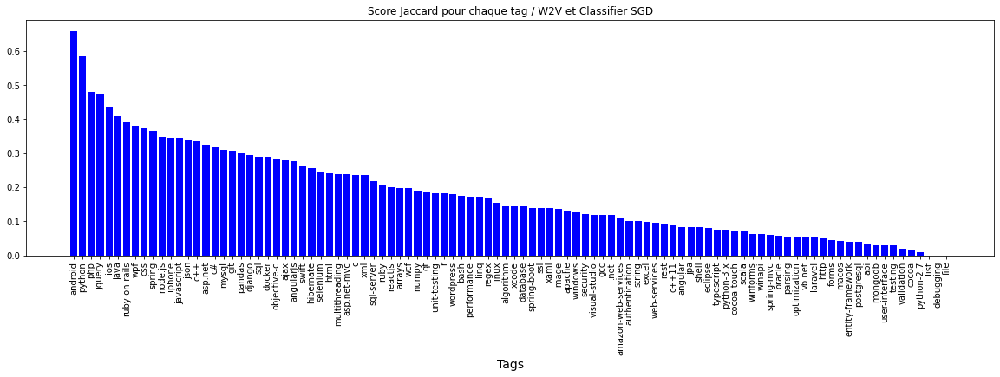

In [291]:
# Affichage du score Jaccard par tag
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('tag', 'score_j', data=jaccard_tag, color='b')
plt.xlabel('Tags', fontsize=14)
plt.xticks(rotation=90)
plt.title('Score Jaccard pour chaque tag / W2V et Classifier SGD')
plt.show()

In [292]:
# Calcul du score Jaccard weighted
jaccard_score(Y_test_s, y_pred_test2, average='weighted')

0.2828786165011851

In [293]:
# Comptage du nombre de tags prédits sur le jeu de test
y_pred_test2.sum()

16720

In [294]:
# Nombre de tags réels sur je jeu de test
Y_test_s.sum()

28693.0

In [295]:
# Identification des 5 tags prédits par post
y_pred_test_w = y_pred_test2.copy()
tag_predit_sgdc_w2v = pd.DataFrame()
for k in range(len(y_pred_test_w)):
    for i in range(5):
        ind = -1
        for j in range(100) :
            if y_pred_test_w[k,j] == 1 :
                ind  = j 
        if ind > -1 : 
            tag_predit_sgdc_w2v.loc[k,i] = dict_tag[ind]
            y_pred_test_w[k,ind] = 0
        else : 
            tag_predit_sgdc_w2v.loc[k,i] = ' '

In [296]:
tag_predit_sgdc_w2v['list_tag'] = ' '
tag_predit_sgdc_w2v['list_tag'][tag_predit_sgdc_w2v[0] != ' ' ] = tag_predit_sgdc_w2v[0]
tag_predit_sgdc_w2v['list_tag'][tag_predit_sgdc_w2v[1] != ' ' ] = tag_predit_sgdc_w2v['list_tag'] + ' ' + tag_predit_sgdc_w2v[1]
tag_predit_sgdc_w2v['list_tag'][tag_predit_sgdc_w2v[2] != ' ' ] = tag_predit_sgdc_w2v['list_tag'] + ' ' + tag_predit_sgdc_w2v[2]
tag_predit_sgdc_w2v['list_tag'][tag_predit_sgdc_w2v[3] != ' ' ] = tag_predit_sgdc_w2v['list_tag'] + ' ' + tag_predit_sgdc_w2v[3]
tag_predit_sgdc_w2v['list_tag'][tag_predit_sgdc_w2v[4] != ' ' ] = tag_predit_sgdc_w2v['list_tag'] + ' ' + tag_predit_sgdc_w2v[4]
tag_predit_sgdc_w2v

,0,1,2,3,4,list_tag
0,,,,,,
1,sql,,,,,sql
2,unit-testing,,,,,unit-testing
3,,,,,,
4,,,,,,
...,...,...,...,...,...,...
14995,objective-c,ios,,,,objective-c ios
14996,mysql,php,,,,mysql php
14997,sql,performance,,,,sql performance
14998,iphone,ios,,,,iphone ios


In [297]:
# Sauvegarde de ce dataframe, long à calculer
dump(tag_predit_sgdc_w2v,'export_tag_predit_sgdc_w2v')

['export_tag_predit_sgdc_w2v']

In [298]:
# Calcul de fréquence des différents tags prédits sur les données de tests
freq_tags = tag_predit_sgdc_w2v['list_tag'].str.cat(sep=' ')
words = freq_tags.split()
Word_dist = nltk.FreqDist(words)
df_freq_tags = pd.DataFrame(Word_dist.most_common(),columns=['Tags_predits', 'Frequency'])
df_freq_tags

,Tags_predits,Frequency
0,python,1190
1,java,1131
2,c#,1005
3,javascript,863
4,android,670
...,...,...
95,file,15
96,cocoa,15
97,list,12
98,testing,10


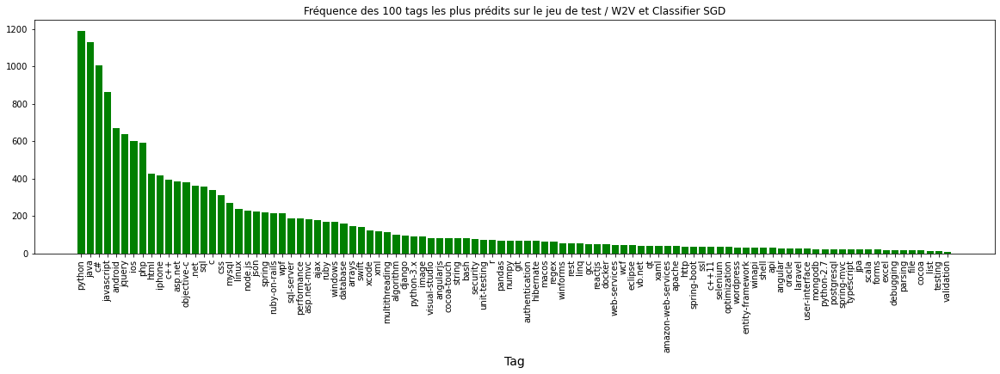

In [299]:
#Préparation d'un graphe d'affichage des 100 tags les plus fréquemment prédits sur le jeu de test
plt.rcParams["figure.figsize"] = [20, 5]
plt.bar('Tags_predits', 'Frequency', data=df_freq_tags[:100], color='g')
plt.xlabel('Tag', fontsize=14)
plt.xticks(rotation=90)
plt.title('Fréquence des 100 tags les plus prédits sur le jeu de test / W2V et Classifier SGD')
plt.show()

In [300]:
# Détermination du nuage de tags prédits sur le jeu de tests
stats, freq = dict(), dict()
for k, v in tag_predit_sgdc_w2v.iteritems():
        freq[k] = fq = nltk.FreqDist(v)
        stats[k] = {'total': len(v)} 
freq_tot = freq[0] + freq[1] + freq[2] + freq[3] + freq[4]
freq_tot

FreqDist({' ': 58659, 'python': 1190, 'java': 1131, 'c#': 1005, 'javascript': 863, 'android': 670, 'jquery': 636, 'ios': 601, 'php': 589, 'html': 427, ...})

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\devra\anaconda3\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation i

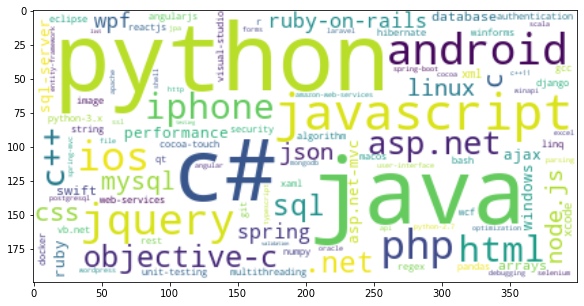

In [301]:
# Affichage du nuage de tags prédits sur le jeu de tests
cloud_generator = WordCloud(background_color = 'white', random_state=1)
wordcloud_image = cloud_generator.generate_from_frequencies(freq_tot)
plt.imshow(wordcloud_image, interpolation = "bilinear")

In [302]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_w2v.iloc[k,i] in raw_data_test.iloc[k,6] :
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  9787
nombre de tags non trouvés :  65213
Pourcentage de couverture des tags réels :  13.05 %


In [303]:
nb_tags_found = 0
nb_tags_not_found = 0
for k in range(len(raw_data_test)):
    for tag in raw_data_test.iloc[k,8] :
        if (tag ==tag_predit_sgdc_w2v.iloc[k,0]) or (tag ==tag_predit_sgdc_w2v.iloc[k,1]) or (tag ==tag_predit_sgdc_w2v.iloc[k,2]) or (tag ==tag_predit_sgdc_w2v.iloc[k,3]) or (tag ==tag_predit_sgdc_w2v.iloc[k,4]):
            nb_tags_found +=1
        else : 
            nb_tags_not_found +=1
print ('nombre de tags trouvés : ', nb_tags_found)
print ('nombre de tags non trouvés : ', nb_tags_not_found)
print ('Pourcentage de couverture des tags réels / 100 plus fréquents : ', round((nb_tags_found / (nb_tags_not_found + nb_tags_found) * 100),2) , '%')

nombre de tags trouvés :  9787
nombre de tags non trouvés :  18906
Pourcentage de couverture des tags réels / 100 plus fréquents :  34.11 %


In [304]:
nb_words_found = 0
nb_words_not_found = 0
for k in range(len(raw_data_test)):
    for i in range(5):
        if tag_predit_sgdc_w2v.iloc[k,i] in raw_data_test.iloc[k,5] :
            nb_words_found +=1
        else : 
            nb_words_not_found +=1
print ('nombre de mots trouvés : ', nb_words_found)
print ('nombre de mots non trouvés : ', nb_words_not_found)
print ('Pourcentage de couverture des mots : ', round((nb_words_found / (nb_words_not_found + nb_words_found) * 100),2) , '%')

nombre de mots trouvés :  6207
nombre de mots non trouvés :  68793
Pourcentage de couverture des mots :  8.28 %


In [305]:
#list_k = random.sample(range(len(tag_predit_sgdc_bert)),10)
for k in list_k:
    print ('-------------------------------------------------')
    print ('enregistrement n°' , k , ' du jeu de test, titre du post :')
    print (raw_data_test.iloc[k]['Title'])
    print ('-------------------------------------------------')
    print ('Liste des tags saisis par l\'utilisateur :')
    print (raw_data_test.iloc[k]['Tags_trf_text'])
    print ('-------------------------------------------------')
    print ('Liste des tags prédits :')
    print (tag_predit_sgdc_w2v.loc[k]['list_tag'])
    print ('-------------------------------------------------')

-------------------------------------------------
enregistrement n° 3148  du jeu de test, titre du post :
Convert static constexpr array to template parameter in C++11
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
c++ c++11 templates variadic-templates template-meta-programming
-------------------------------------------------
Liste des tags prédits :
 
-------------------------------------------------
-------------------------------------------------
enregistrement n° 7702  du jeu de test, titre du post :
Android Radio buttons in a custom listview changes its state when we scroll the list
-------------------------------------------------
Liste des tags saisis par l'utilisateur :
android listview radio-button adapter radiobuttonlist
-------------------------------------------------
Liste des tags prédits :
android
-------------------------------------------------
-------------------------------------------------
enregistrement n° 9174  du j